In [1]:
using DynamicalSystems
using OrdinaryDiffEq
using BenchmarkTools

using SciPy
using Statistics


using DifferentialEquations

using PyPlot

In [2]:
function HR!(du, u, p, t)
    
    function sigma(x)
            return 1.0 / ( 1.0 + exp( -10.0 * ( x  - ( - 0.25 ) ) ) )
    end
    
    a, b, c, d, s, xr, r,  I, vs, k1, k2  = p
    x1, y1, z1, x2, y2, z2 = u
    
    du[1] = y1 + b * x1 ^ 2 - a * x1 ^3 - z1 + I - k1 * ( x1 - vs ) * sigma(x2)
    du[2] = c - d * x1 ^2 - y1
    du[3] = r * ( s * ( x1 - xr ) - z1 )
    
    du[4] = y2 + b * x2 ^ 2 - a * x2 ^3 - z2 + I - k2 * ( x2 - vs ) * sigma(x1)
    du[5] = c - d * x2 ^2 - y2
    du[6] = r * ( s * ( x2 - xr ) - z2 )
    
    return SVector(du[1], du[2], du[3],
                    du[4], du[5], du[6])
end

HR! (generic function with 1 method)

In [5]:
u0 = [ 0., 0.2, 0.3,
        0., 0.5, 0.6]
tspan = (0., 300000.)

a = 1.
b = 3.
c = 1.
d = 5.
xr = -1.6
r = 0.01
s = 5.
I = 4.
xv = 2.

k1= -0.07
k2 = k1

p = [a, b, c, d,
    s, xr, r, I, xv, k1, k2]

11-element Vector{Float64}:
  1.0
  3.0
  1.0
  5.0
  5.0
 -1.6
  0.01
  4.0
  2.0
 -0.07
 -0.07

In [63]:
prob = ODEProblem(HR!, u0, tspan, p)

ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 20000.0)
u0: 6-element Vector{Float64}:
 0.0
 0.2
 0.3
 0.0
 0.5
 0.6

In [ ]:
@benchmark sol = solve(prob, Feagin12 (),
            maxiters = 10000000)

In [15]:
@benchmark sol = solve(prob, Rodas5(),
            maxiters = 10000000)

BenchmarkTools.Trial: 41 samples with 1 evaluation.
 Range (min … max):  117.201 ms … 143.323 ms  ┊ GC (min … max): 0.00% … 10.91%
 Time  (median):     125.295 ms               ┊ GC (median):    5.86%
 Time  (mean ± σ):   124.703 ms ±   5.086 ms  ┊ GC (mean ± σ):  5.08% ±  3.52%

   █             ▁  ▃▁▃▁                                         
  ▄█▄▁▇▁▁▁▁▁▁▁▁▇▄█▄▁████▇▁▁▄▇▁▄▄▄▁▁▁▁▁▁▁▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▄ ▁
  117 ms           Histogram: frequency by time          143 ms <

 Memory estimate: 31.69 MiB, allocs estimate: 364164.

In [64]:
sol = solve(prob, AutoVern9(Rodas5()),
            abstol = 1e-9, reltol = 1e-9, maxiters = 10000000)

retcode: Success
Interpolation: 3rd order Hermite
t: 206029-element Vector{Float64}:
     0.0
     0.10712708409634863
     0.22693082317130717
     0.3354257983152747
     0.43095844689994656
     0.5192749423220692
     0.5982594105949408
     0.6795796321726764
     0.7587254431951168
     0.8425289563596389
     0.9321420709983491
     1.0294859709833253
     1.1349264288227285
     ⋮
 19998.910552724476
 19999.026196598603
 19999.139364371877
 19999.249671296966
 19999.35762087045
 19999.46315217531
 19999.566473777246
 19999.66764823389
 19999.76680666257
 19999.86403589817
 19999.959435884553
 20000.0
u: 206029-element Vector{Vector{Float64}}:
 [0.0, 0.2, 0.3, 0.0, 0.5, 0.6]
 [0.42444296788975794, 0.25102374567092783, 0.30935534840148415, 0.4227018138748795, 0.5207358898749059, 0.6090310696643599]
 [1.01694577490256, 0.03251527978249017, 0.32279387434254464, 1.0083471700230813, 0.27596195684248626, 0.6220827805481364]
 [1.6963557036075314, -0.831099869831942, 0.33842927621638413

In [65]:
x1 = sol[1, :]
x2 = sol[4, :]
nextcond = sol[length(sol.u)]

6-element Vector{Float64}:
 -1.223114103620738
 -6.326985027033308
  3.9856132540131126
 -0.49278029503778026
 -0.8710769223955129
  3.8224018704629783

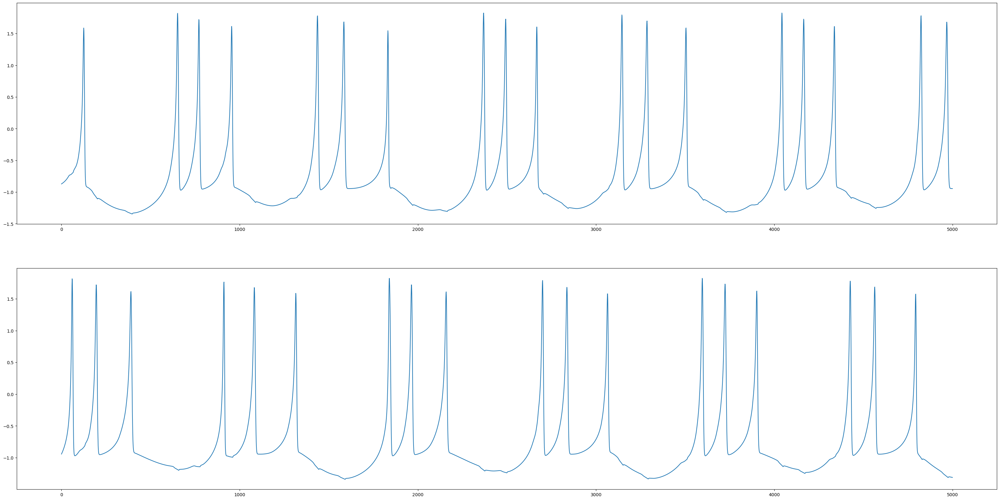

1-element Vector{PyCall.PyObject}:
 PyObject <matplotlib.lines.Line2D object at 0x0000000067994850>

In [66]:
fig, ax = subplots(2, 1, figsize = (40, 20))
ax[1].plot(x1[5000:10000])
ax[2].plot(x2[5000:10000])

In [67]:
x_sum = x1 + x2

206029-element Vector{Float64}:
  0.0
  0.8471447817646374
  2.025292944925641
  3.3738278721957053
  4.512025017131911
  5.11406642775001
  5.204861188468154
  4.985437701299968
  4.585172808043097
  4.027018375015773
  3.2981800476400793
  2.3351729601988027
  1.068921871268833
  ⋮
 -1.8386185940340014
 -1.828044350420374
 -1.8172233675856604
 -1.80619664126873
 -1.794917983310952
 -1.7833956477750934
 -1.7716083216424352
 -1.759548934764331
 -1.7472009602583922
 -1.7345514100438812
 -1.7215839342499342
 -1.7158943986585182

In [68]:
spikes_index = SciPy.signal.argrelmax(x_sum)
spikes_index = spikes_index[1]
spikes = [x_sum[x] for x in spikes_index]
spikes_index = nothing

Hs = Statistics.mean(spikes) + 6 * Statistics.std(spikes)

2.5436389904492165

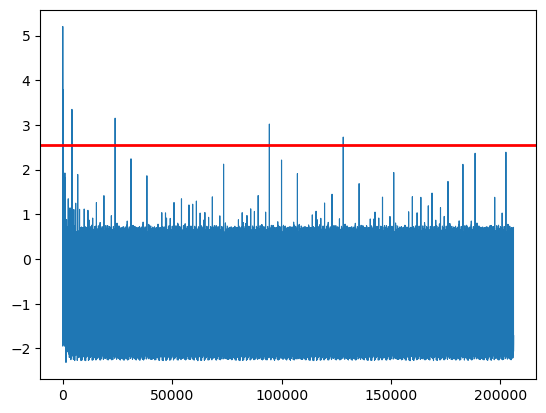

PyObject <matplotlib.lines.Line2D object at 0x0000000067A143D0>

In [69]:
plot(x_sum, lw = 0.8)
axhline(Hs, color = "red", lw = 2)

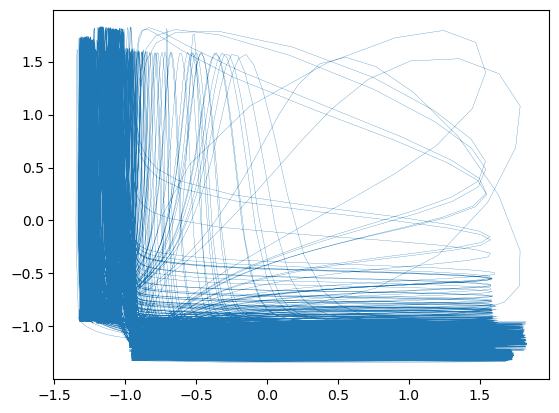

1-element Vector{PyCall.PyObject}:
 PyObject <matplotlib.lines.Line2D object at 0x000000006E967730>

In [70]:
plot(x1[5000:100000], x2[5000:100000], lw = 0.2)

In [6]:
start_k1, end_k1, step_k1 = -0.5, 0.5, 0.01
start_k2, end_k2, step_k2 = -0.5, 0.5, 0.01

k1_array = range( start_k1, end_k1, step = step_k1 )
k2_array = range( start_k2, end_k2, step = step_k2 )

-0.5:0.01:0.5

In [7]:
lyap_matrix = zeros( ( length(k1_array), length(k2_array) ) )
EV_map = zeros( ( length(k1_array), length(k2_array) ) )

101×101 Matrix{Float64}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0

In [8]:
@time for (k1_index, k1) in enumerate( k1_array )

    for (k2_index, k2) in enumerate( k2_array )
        
        if k1_index == k2_index
            
            k1 = round(k1, digits = 2)
            k2 = round(k2, digits = 2)
            
            println("diagonal inheritance");  flush(stdout)
            println( " index k1: ", k1_index, "; k1: ", k1 );  flush(stdout)
            println( " index k2: ", k2_index, "; k2: ", k2 );  flush(stdout)
            
            if k1_index == 1
                global diagonalcondition = [0.1, 0.1, 0.1,
                                            -0.1, -0.1, -0.1]
            end
            println("initial condition:", diagonalcondition);  flush(stdout)
            
            p = [a, b, c, d, s, xr, r, I, xv, k1, k2]
            println("p:", p); flush(stdout)
            ds_HR = ContinuousDynamicalSystem(HR!, diagonalcondition, p )
            
            lyap = lyapunov(ds_HR, tspan[2]; diffeq = (alg = AutoVern9(Rodas5()), maxiters = 10000000))
            lyap_matrix[k1_index, k2_index] = lyap
            
            println("lyap:", lyap);  flush(stdout)
            
            prob = ODEProblem(HR!, diagonalcondition, tspan, p)
            sol = solve(prob, AutoVern9(Rodas5()), abstol = 1e-9, reltol = 1e-9, maxiters = 10000000)
            
            if lyap > 0
                x_sum = sol[1,:][20000:end] + sol[4,:][20000:end]
                
                println("x_sum length: ", length(x_sum)); flush(stdout)
                
                #index = signal.argrelmax( x_sum )[1]

                
                #spikes = [x_sum[x] for x in index]
                spikes = x_sum
                Hs = Statistics.mean(spikes) + 6 * Statistics.std(spikes)
                println("Hs: ", Hs)
                
                counts = spikes[spikes.>=Hs]
                println("counts: ", counts)
                EV_map[k1_index, k2_index]  = length(counts)
            end
            
            diagonalcondition = sol[length(sol.u)]
            println("EV:", EV_map[k1_index, k2_index]); flush(stdout)
            println("last value: ", diagonalcondition);  flush(stdout)
            println(" _______ ");  flush(stdout)
            println(" ");  flush(stdout)
            
            global rightcondition = diagonalcondition
            global upcondition = diagonalcondition
            
            k1_index_ = k1_index + 1
            k2_index_ = k2_index + 1
            
            if isdefined(Main, :IJulia)
                    Main.IJulia.stdio_bytes[] = 0
            end
            
            for k1_ in range((k1 + step_k1), end_k1, step = step_k1 )
                
                 
                k1_ = round(k1_, digits = 2)
                
                if k1_ > end_k1 || k2 > end_k2
                    println("condition on continue is done");  flush(stdout)
                    continue
                end
                
                println("Inheritance to the right");  flush(stdout)
                
                println( " index k1: ", k1_index_, "; k1: ", k1_ );  flush(stdout)
                println( " index k2: ", k2_index, "; k2: ", k2 );  flush(stdout)
                
                println("initial condition:", rightcondition);  flush(stdout)
                
                p = [a, b, c, d, s, xr, r, I, xv, k1_, k2]
                println("p:", p); flush(stdout)
                ds_HR = ContinuousDynamicalSystem(HR!, rightcondition, p )
            
                lyap = lyapunov(ds_HR, tspan[2]; diffeq = (alg = AutoVern9(Rodas5()), maxiters = 10000000))
                lyap_matrix[k1_index_, k2_index] = lyap
                
                println("lyap:", lyap);  flush(stdout)
            
                prob = ODEProblem(HR!, rightcondition, tspan, p)
                sol = solve(prob, AutoVern9(Rodas5()), abstol = 1e-9, reltol = 1e-9, maxiters = 10000000)
                
                if lyap > 0
                    x_sum = sol[1,:][20000:end] + sol[4,:][20000:end]
                
                    println("x_sum length: ", length(x_sum)); flush(stdout)
                
                    #index = signal.argrelmax( x_sum )[1]
                
                    #spikes = [x_sum[x] for x in index]
                    spikes = x_sum
                    Hs = Statistics.mean(spikes) + 6 * Statistics.std(spikes)
                    println("Hs: ", Hs)
                
                    counts = spikes[spikes.>=Hs]
                    println("counts: ", counts)
                    EV_map[k1_index_, k2_index]  = length(counts)
                end
            
                
                rightcondition = sol[length(sol.u)]
                
                println("lyap:", lyap);  flush(stdout)
                println("EV:", EV_map[k1_index_, k2_index]); flush(stdout)
                println("last value: ",  sol[length(sol.u)]);  flush(stdout)
                
                
                k1_index_+=1
                println(">>>>>>>>>");  flush(stdout)
                print("  ");  flush(stdout)
                
                if isdefined(Main, :IJulia)
                    Main.IJulia.stdio_bytes[] = 0
                end
            end
            
            for k2_ in range((k2 + step_k2), end_k2, step = step_k2 )
                
                k2_ = round(k2_, digits = 2)
                
                if k1 > end_k1 || k2_ > end_k2
                    println("condition on continue is done");  flush(stdout)
                    continue
                end
                
                println("Inheritance upwards");  flush(stdout)
                
                println( " index k1: ", k1_index, "; k1: ", k1 );  flush(stdout)
                println( " index k2: ", k2_index_, "; k2: ", k2_ );  flush(stdout)
                
                println("initial condition:", upcondition);  flush(stdout)
                
                p = [a, b, c, d, s, xr, r, I, xv, k1, k2_]
                println("p:", p); flush(stdout)
                ds_HR = ContinuousDynamicalSystem(HR!, upcondition, p )
            
                lyap = lyapunov(ds_HR, tspan[2]; diffeq = (alg = AutoVern9(Rodas5()), maxiters = 10000000))
                lyap_matrix[k1_index, k2_index_] = lyap
                
                println("lyap:", lyap);  flush(stdout)
            
                prob = ODEProblem(HR!, upcondition, tspan, p)
                sol = solve(prob, AutoVern9(Rodas5()), abstol = 1e-9, reltol = 1e-9, maxiters = 10000000)
                
                if lyap > 0
                    x_sum = sol[1,:][20000:end] + sol[4,:][20000:end]
                
                    println("x_sum length: ", length(x_sum)); flush(stdout)
                
                    # index = signal.argrelmax( x_sum )[1]
                
                    # spikes = [x_sum[x] for x in index]
                    spikes = x_sum
                    Hs = Statistics.mean(spikes) + 6 * Statistics.std(spikes)
                    println("Hs: ", Hs)
                
                    counts = spikes[spikes.>=Hs]
                    println("counts: ", counts)
                    EV_map[k1_index, k2_index_]  = length(counts)
                end
            
                upcondition = sol[length(sol.u)]
                
                println("lyap:", lyap);  flush(stdout)
                println("EV:", EV_map[k1_index, k2_index_]); flush(stdout)
                println("last value: ", sol[length(sol.u)]);  flush(stdout)
                
                
                k2_index_+=1
                println("^^^^^^^^^^");  flush(stdout)
                print("  ");  flush(stdout)
                
                if isdefined(Main, :IJulia)
                    Main.IJulia.stdio_bytes[] = 0
                end

            end
        end
    end
    println("-------------");  flush(stdout)
    println(" ");  flush(stdout)
end

diagonal inheritance
 index k1: 1; k1: -0.5
 index k2: 1; k2: -0.5
initial condition:[0.1, 0.1, 0.1, -0.1, -0.1, -0.1]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.5]
lyap:2.4251840294338064e-5
x_sum length: 3475339
Hs: 2.6765355159233746
counts: Float64[]
EV:0.0
last value: [-0.8287725590311618, -2.6667721122150003, 3.930540590591362, -1.104141906081785, -5.912820109649025, 3.007210750115944]
 _______ 
 
Inheritance to the right
 index k1: 2; k1: -0.49
 index k2: 1; k2: -0.5
initial condition:[-0.8287725590311618, -2.6667721122150003, 3.930540590591362, -1.104141906081785, -5.912820109649025, 3.007210750115944]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.5]
lyap:1.940120581043007e-5
x_sum length: 3481153
Hs: 2.6908977153383598
counts: Float64[]
lyap:1.940120581043007e-5
EV:0.0
last value: [-1.1756082215076447, -4.377899487167218, 4.149119951015894, 0.032443147350675376, 0.03062435768566794, 3.2620661627940244]
>>>>>>>>>
  Inheritance to the right
 index k

x_sum length: 3358363
Hs: 2.563483214317287
counts: Float64[]
lyap:9.172590920514064e-6
EV:0.0
last value: [-1.384416585163728, -7.982921759300127, 3.279259527911665, 0.5714647665906081, 0.43791089342537154, 3.8944837010784825]
>>>>>>>>>
  Inheritance to the right
 index k1: 17; k1: -0.34
 index k2: 1; k2: -0.5
initial condition:[-1.384416585163728, -7.982921759300127, 3.279259527911665, 0.5714647665906081, 0.43791089342537154, 3.8944837010784825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.5]
lyap:3.1466789864675246e-6
x_sum length: 3352034
Hs: 2.563466226683775
counts: Float64[]
lyap:3.1466789864675246e-6
EV:0.0
last value: [0.12894613195696691, 0.2727459074442461, 3.491847862423249, -1.3985424120862002, -7.275937984870431, 3.8063334588768494]
>>>>>>>>>
  Inheritance to the right
 index k1: 18; k1: -0.33
 index k2: 1; k2: -0.5
initial condition:[0.12894613195696691, 0.2727459074442461, 3.491847862423249, -1.3985424120862002, -7.275937984870431, 3.8063334588768494]
p:[

EV:31.0
last value: [-0.9327871375081508, -3.612725374568715, 4.0051831537894875, -1.5769606529132978, -12.021776796271618, 3.3197338142359145]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 1; k2: -0.5
initial condition:[-0.9327871375081508, -3.612725374568715, 4.0051831537894875, -1.5769606529132978, -12.021776796271618, 3.3197338142359145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.5]
lyap:2.5092148548305838e-5
x_sum length: 3260786
Hs: 2.934139433466177
counts: Float64[]
lyap:2.5092148548305838e-5
EV:0.0
last value: [-1.407681687135592, -9.053739152326425, 3.6489559125465814, -0.58930968963217, -1.3778666099706933, 3.741897806862903]
>>>>>>>>>
  Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 1; k2: -0.5
initial condition:[-1.407681687135592, -9.053739152326425, 3.6489559125465814, -0.58930968963217, -1.3778666099706933, 3.741897806862903]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.5]
lyap:0.009118272844157236

EV:102.0
last value: [-1.3084567421907956, -7.528069230495905, 3.6918426710024987, -0.37007747129123203, -4.476602523017797, 3.92059809324451]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 1; k2: -0.5
initial condition:[-1.3084567421907956, -7.528069230495905, 3.6918426710024987, -0.37007747129123203, -4.476602523017797, 3.92059809324451]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.5]
lyap:0.0035768155321973826
x_sum length: 2965465
Hs: 2.7604800688062747
counts: [2.8617720083909113, 2.8996970971864657, 2.769275756514576, 3.1299235384676916, 3.3549681642838083, 3.3409773206465685, 3.0801818667840575, 2.7722157773665455, 3.079891396001143, 3.3538579417469387, 3.3686664849683914, 3.1359220796648617, 2.8175624636098853, 2.8763601947050557, 2.8791646488280787, 3.0917697674572313, 3.1565425624901238, 3.0219483332324284, 3.1343316471155624, 3.3079624229267366, 3.2791358765929304, 3.018064465763839, 2.9091305692036125, 3.0674893403163717, 3.013954924

initial condition:[1.2061056346550254, -5.0996773743453385, 4.188342103823537, -1.5500530750018071, -10.009298916325234, 3.209240625164949]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.5]
lyap:1.3133597170010134e-5
x_sum length: 2955393
Hs: 2.6533236804027873
counts: Float64[]
lyap:1.3133597170010134e-5
EV:0.0
last value: [-1.2102730374447537, -6.480586281149533, 3.671545135760369, -0.8898947491179163, -3.179943590626509, 3.8720799697750445]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 1; k2: -0.5
initial condition:[-1.2102730374447537, -6.480586281149533, 3.671545135760369, -0.8898947491179163, -3.179943590626509, 3.8720799697750445]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.5]
lyap:4.730794969464971e-6
x_sum length: 2919297
Hs: 2.673900831699881
counts: Float64[]
lyap:4.730794969464971e-6
EV:0.0
last value: [-0.7012339149475563, -1.7776916102759228, 3.9893309499352436, -1.1500187956210068, -6.170639383669836, 3.249832945646

EV:78.0
last value: [-0.9477780935718502, -3.560110139799946, 3.977308905674044, -1.0693699865561204, -4.903115264341241, 3.729373203382982]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 1; k2: -0.5
initial condition:[-0.9477780935718502, -3.560110139799946, 3.977308905674044, -1.0693699865561204, -4.903115264341241, 3.729373203382982]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.5]
lyap:0.01425509928043851
x_sum length: 2697607
Hs: 2.9013590192705028
counts: [2.9380461206216113, 2.9412029802749453, 2.91981381709226, 2.950631008861084, 3.0115524363072055, 3.0041823880252765, 3.0146081678303025, 2.9438750922760706, 2.9894247644354977, 2.9737291018497256, 3.2078452601330985, 3.2417738028578977, 3.048065458913223, 3.0371044148195705, 3.06934715356487, 2.967007009751727, 3.283306789321095, 3.3981748723800163, 3.2973509528577987, 2.9621004939783755, 2.955567661946195, 3.1813596928942287, 3.1580280751116128, 2.928847473382448, 2.9991954712582363, 3.303

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.5]
lyap:-9.760625767127458e-6
lyap:-9.760625767127458e-6
EV:0.0
last value: [-0.9241761736238461, -3.1420133462720203, 4.226960316343911, -1.4148204273512182, -9.395669686110704, 3.411196896565481]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 1; k2: -0.5
initial condition:[-0.9241761736238461, -3.1420133462720203, 4.226960316343911, -1.4148204273512182, -9.395669686110704, 3.411196896565481]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.5]
lyap:2.5427821098131625e-5
x_sum length: 2811877
Hs: 2.799795714212861
counts: Float64[]
lyap:2.5427821098131625e-5
EV:0.0
last value: [-0.8018647855741683, -2.812356445662857, 3.7948156512703273, 0.2676184047511358, 0.5268458131543741, 3.832689777760523]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 1; k2: -0.5
initial condition:[-0.8018647855741683, -2.812356445662857, 3.7948156512703273, 0.2676184047511358, 0.5268458131543741

EV:81.0
last value: [-0.9644194402901469, -3.6022144509131118, 4.08981159144358, -1.1060905562207348, -5.579074506651431, 3.398079827334032]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 1; k2: -0.5
initial condition:[-0.9644194402901469, -3.6022144509131118, 4.08981159144358, -1.1060905562207348, -5.579074506651431, 3.398079827334032]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.5]
lyap:0.01822593781127112
x_sum length: 2746952
Hs: 3.110581338027739
counts: [3.1297821038055025, 3.133124755968601, 3.2532564267741524, 3.2463545352082677, 3.1378670859831357, 3.193825651815329, 3.2104754593337694, 3.170094030640259, 3.1223340703191873, 3.1312483676599165, 3.2066030219586783, 3.1200166064207777, 3.436196117029117, 3.5017938505973505, 3.3186153991701652, 3.144120417746347, 3.1788124547862706, 3.3978691113056, 3.3707734502345357, 3.1457511399889535, 3.3321037148292865, 3.4576567326500176, 3.3393377368485986, 3.2264475679860727, 3.1626501107819593, 3.13

EV:67.0
last value: [-0.18119799588837363, -4.050605502929795, 4.0903341334413374, -1.2212895282015814, -5.133122410286995, 3.813474976422309]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 1; k2: -0.5
initial condition:[-0.18119799588837363, -4.050605502929795, 4.0903341334413374, -1.2212895282015814, -5.133122410286995, 3.813474976422309]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.5]
lyap:0.018017590398666194
x_sum length: 2792973
Hs: 3.217499057244794
counts: [3.2806834676521905, 3.2720147940894213, 3.2957246690905997, 3.375630027807535, 3.2196743889400485, 3.268725706253507, 3.2822809865323945, 3.2400642332086784, 3.235556064560855, 3.242324407551356, 3.297294466598167, 3.3452117249573314, 3.258946614645037, 3.418533992429075, 3.3394961258223006, 3.2241625660511684, 3.3051024811576446, 3.3357431658662584, 3.428636088202874, 3.2848821246098217, 3.3025039697976926, 3.3784019258755147, 3.27828932824787, 3.3578013520914363, 3.2702005378063586, 3.3

Hs: 3.349033987602261
counts: [3.435674353350577, 3.4263092452454718, 3.356984892070998, 3.3836834321631795, 3.4324994265429707, 3.3524270557565705, 3.4107986929868277, 3.38075429921243, 3.3709930073968444, 3.3780377560823505]
lyap:0.02083253332578902
EV:10.0
last value: [-0.9096681489318673, -3.2167550725007743, 4.008076145442907, -1.2721803322625511, -7.560555497503011, 3.3129235635790306]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 1; k2: -0.5
initial condition:[-0.9096681489318673, -3.2167550725007743, 4.008076145442907, -1.2721803322625511, -7.560555497503011, 3.3129235635790306]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, -0.5]
lyap:0.02148129904626344
x_sum length: 2800178
Hs: 3.372778558076897
counts: [3.4069435385122597, 3.376573487301727, 3.3984325138675917, 3.426868133772407]
lyap:0.02148129904626344
EV:4.0
last value: [-0.06577600715257412, -3.854413993079453, 4.189975736544182, -1.1894248332502586, -4.567838679512135, 3.9538186657703

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.5]
lyap:0.022682326686352863
x_sum length: 2856013
Hs: 3.611794737634966
counts: Float64[]
lyap:0.022682326686352863
EV:0.0
last value: [-0.8743628794220621, -4.090424695492597, 3.8092098823436618, -1.2846825115466423, -7.2673745254659305, 3.727683490243708]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 1; k2: -0.5
initial condition:[-0.8743628794220621, -4.090424695492597, 3.8092098823436618, -1.2846825115466423, -7.2673745254659305, 3.727683490243708]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, -0.5]
lyap:0.022632082203937913
x_sum length: 2852178
Hs: 3.6276027203350925
counts: Float64[]
lyap:0.022632082203937913
EV:0.0
last value: [-0.6930361862320278, -2.0606496302099764, 3.629043756148447, -0.6107492383809298, -1.5339119601291826, 3.672505559704509]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 1; k2: -0.5
initial condition:[-0.6930361862320278, -2.06064963020

EV:0.0
last value: [-0.8467303831745328, -2.755446883227289, 3.973548494695702, -0.7879763528176648, -3.0960667900022685, 3.1108797062287152]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 8; k2: -0.43
initial condition:[-0.8467303831745328, -2.755446883227289, 3.973548494695702, -0.7879763528176648, -3.0960667900022685, 3.1108797062287152]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.43]
lyap:2.268473892854446e-6
x_sum length: 3404142
Hs: 2.580233893182325
counts: Float64[]
lyap:2.268473892854446e-6
EV:0.0
last value: [-1.2955823282415808, -7.82034210960492, 3.2548463898409543, -0.5139217737489643, -0.9430647333022165, 3.843934214016145]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 9; k2: -0.42
initial condition:[-1.2955823282415808, -7.82034210960492, 3.2548463898409543, -0.5139217737489643, -0.9430647333022165, 3.843934214016145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.42]
lyap:1.2947926250042111e-5
x_sum len

^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 23; k2: -0.28
initial condition:[0.0331673315420012, -0.03948748254735204, 3.1567557461441424, -1.1073444103401104, -4.250036763304008, 4.075996775837466]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.28]
lyap:1.2481306738008302e-6
x_sum length: 3308357
Hs: 2.564571202832295
counts: Float64[]
lyap:1.2481306738008302e-6
EV:0.0
last value: [-0.946901726816218, -3.4958343366702214, 4.040742657445387, -1.2738728084744275, -7.626632064148751, 3.2659211340122454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 24; k2: -0.27
initial condition:[-0.946901726816218, -3.4958343366702214, 4.040742657445387, -1.2738728084744275, -7.626632064148751, 3.2659211340122454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.27]
lyap:8.321282892193498e-6
x_sum length: 3304224
Hs: 2.5669207624674355
counts: Float64[]
lyap:8.321282892193498e-6
EV:0.0
last value: [-1.249986224236701, -6.764261231213072,

EV:71.0
last value: [-0.9078726349987252, -3.7163064484315647, 3.2145847613701712, -0.40893184688211404, -0.38468992376207883, 4.030590312006731]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 35; k2: -0.16
initial condition:[-0.9078726349987252, -3.7163064484315647, 3.2145847613701712, -0.40893184688211404, -0.38468992376207883, 4.030590312006731]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.16]
lyap:0.01458623211551382
x_sum length: 3007941
Hs: 2.732766543616286
counts: [3.010413522650694, 3.1457759083039103, 3.1143664143045955, 2.88777926455451, 2.801471927566187, 3.143072574647128, 3.2371768022096, 3.0995453922165184, 2.8077502766009865, 2.98733962311029, 3.0099478931351245, 2.8239325756450424, 2.7557403894074697, 3.0974938815990773, 3.2527199687200237, 3.1936797926377163, 2.8967557065962737, 2.9021526206795576, 3.021172578455947, 2.9742410970576625, 3.0849593967889626, 3.3123124962607307, 3.306902395374517, 3.0656940697005153, 2.8800172993087445, 

EV:58.0
last value: [-1.1476767855741206, -4.75132795274383, 3.2371466819280084, 0.2692639340641092, 0.6498076125306709, 4.084221315705546]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 43; k2: -0.08
initial condition:[-1.1476767855741206, -4.75132795274383, 3.2371466819280084, 0.2692639340641092, 0.6498076125306709, 4.084221315705546]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.08]
lyap:0.009543551845047486
x_sum length: 2952002
Hs: 2.7314676139506715
counts: [2.841589177636572, 2.989185859686889, 2.962872578151259, 2.7365331804916004, 2.9367724745915273, 2.9804802535183406, 2.793415143005215, 2.8723260750583206, 2.9091742334998685, 2.7466023156740667, 3.138570666028479, 3.3071494001088935, 3.267013325224289, 2.9903603613337415, 2.7778277867571743, 3.082282630234444, 3.233852184288593, 3.166094160032566, 2.8657162087267114, 2.8601543307871484, 2.898437230445853, 2.7713919671032414, 2.7826254304200337, 2.7721287873118436, 2.8635236062697924, 2.734025

EV:198.0
last value: [-0.8161963364470447, -3.1594989389267867, 3.258119889067477, -0.7378871861576679, -1.9991011051199807, 3.9921543067737444]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 47; k2: -0.04
initial condition:[-0.8161963364470447, -3.1594989389267867, 3.258119889067477, -0.7378871861576679, -1.9991011051199807, 3.9921543067737444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.04]
lyap:1.1670781630329271e-5
x_sum length: 2968559
Hs: 2.8319475230489823
counts: Float64[]
lyap:1.1670781630329271e-5
EV:0.0
last value: [-0.49715428869082035, -1.0858455920753867, 3.5819787535521175, -1.1099871892690005, -4.941698495034954, 4.133269637911976]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 48; k2: -0.03
initial condition:[-0.49715428869082035, -1.0858455920753867, 3.5819787535521175, -1.1099871892690005, -4.941698495034954, 4.133269637911976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, -0.03]
lyap:2.13651187836371e-

EV:116.0
last value: [-1.3384092462727923, -6.34845712795809, 3.878249747186242, 0.3830991323785064, -5.077880950389623, 4.038010741756016]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 54; k2: 0.03
initial condition:[-1.3384092462727923, -6.34845712795809, 3.878249747186242, 0.3830991323785064, -5.077880950389623, 4.038010741756016]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, 0.03]
lyap:0.014377743436619662
x_sum length: 2669989
Hs: 2.8658731661500654
counts: [2.953359193361621, 3.2732801355388403, 3.3600238956704374, 3.201606680146167, 3.0630250502670298, 3.3509719315868383, 3.387930295843952, 3.1733852213518614, 2.8851610392163956, 3.0421524588595075, 3.133281624041514, 2.9837235708396213, 2.906303923926223, 2.9470502647007084, 2.9958838980817335, 3.175815948809378, 3.1427382793348286, 2.875027397333061, 3.0780949568888447, 3.2957940157931986, 3.2977881638389186, 3.0735000878993946, 3.0600915783048355, 3.119243427454073, 2.952568669233365, 2.90061563

lyap:0.012717266842088626
x_sum length: 2735800
Hs: 2.9213294294221264
counts: [3.0219046556373543, 3.047690059777764, 3.0506191124181066, 3.2558177828211408, 3.2101516486580017, 2.9969994166602834, 3.041951367541029, 3.2183136195680437, 3.410743878147575, 3.375469022770581, 3.0938606096476615, 3.0058962196728776, 3.30871405472712, 3.3917160574314336, 3.2418398047722903, 2.9444744849055158, 2.9282704492231253, 2.9412008199965443, 3.1723110586021934, 3.199507565325571, 2.9894848982161335, 3.1298453279578267, 3.3081396312506586, 3.256683757483759, 2.9674997050565803, 3.1644420863604177, 3.249611213666924, 3.1126470462432607, 2.9625830308820067, 2.957812300751069, 3.0347738165367777, 3.323129013955042, 3.3481185722641076, 3.113259218939003, 3.0790128581423675, 3.144186967389852, 2.99603288313431, 2.9744002639015776, 2.9263670499977317, 3.0992683957701823, 3.1768504693765642, 3.0318537905874567, 3.0857960704024645, 3.2158390461717534, 3.128767935621868, 2.9631347159978785, 3.14261968937205

EV:91.0
last value: [-0.8400171868056854, -2.8104638864255373, 3.8590801528246046, -0.9279551392186449, -3.38802230388281, 3.9847031851434607]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 65; k2: 0.14
initial condition:[-0.8400171868056854, -2.8104638864255373, 3.8590801528246046, -0.9279551392186449, -3.38802230388281, 3.9847031851434607]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, 0.14]
lyap:0.01832377990487784
x_sum length: 2741643
Hs: 3.0712910052328306
counts: [3.183027420767405, 3.191798018203981, 3.112900482737891, 3.1213163950231086, 3.360224107882557, 3.3899308367723853, 3.1604427956777634, 3.2038990894023884, 3.123900418585679, 3.0788740633140304, 3.0896900133394576, 3.1950976338013826, 3.1107079409446867, 3.091487638098717, 3.1908570856686067, 3.22021243500582, 3.3547821178794153, 3.2471160017490033, 3.135882436582614, 3.1759725033307156, 3.2061814990230553, 3.365684643408947, 3.4509817064133363, 3.287409150715074, 3.193521297254056, 3.26614

EV:48.0
last value: [-1.329899732621598, -6.298004970956069, 3.8149351579225645, 0.9398382495536747, -6.198106689795993, 3.7880770309148692]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 70; k2: 0.19
initial condition:[-1.329899732621598, -6.298004970956069, 3.8149351579225645, 0.9398382495536747, -6.198106689795993, 3.7880770309148692]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, 0.19]
lyap:0.01734250796396234
x_sum length: 2792365
Hs: 3.195174537815431
counts: [3.2114809555209387, 3.3257128708412154, 3.2098088906066113, 3.293361614677358, 3.245060091857061, 3.2385832164422785, 3.3321363723692796, 3.245734430584325, 3.3605367384216995, 3.237766912159092, 3.232989984976433, 3.248629112679546, 3.2428314879231337, 3.2271711340020026, 3.3874164910927145, 3.309467221794355, 3.2223230317319658, 3.349354514824544, 3.3860604812008113, 3.3267690864406205, 3.264493121576481, 3.2778700484281194, 3.4131586348345753, 3.305978893251808, 3.2726102500066006, 3.27501244

 index k1: 1; k1: -0.5
 index k2: 77; k2: 0.26
initial condition:[-0.6075253370999388, -1.712600654744802, 3.4359539093948506, -0.6658584755802105, -1.5955455089550843, 3.9782018402511565]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, 0.26]
lyap:0.021053541516309726
x_sum length: 2799067
Hs: 3.3576348176979165
counts: [3.399774809807213, 3.3587177325684383, 3.4159230745719267, 3.3962686851328514, 3.3759053016513594, 3.3995663046369096, 3.3705047565609494, 3.376314443067188, 3.390296050216979, 3.444084862580758, 3.428131447159406, 3.4405351399582047, 3.436795118934932, 3.3862528221587733, 3.371698177537222, 3.426216387197435]
lyap:0.021053541516309726
EV:16.0
last value: [-1.3061428327399762, -7.69364608359247, 3.638257531226254, -1.1314363173417346, -5.085364894764983, 4.231486907404733]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 78; k2: 0.27
initial condition:[-1.3061428327399762, -7.69364608359247, 3.638257531226254, -1.1314363173417346, -5.085364894

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, 0.4]
lyap:0.021235524073675457
x_sum length: 2855243
Hs: 3.5769066595528365
counts: Float64[]
lyap:0.021235524073675457
EV:0.0
last value: [-1.317552943939891, -7.591019879845484, 3.8982384763351785, -0.750800070438961, -2.016651333633083, 4.067024231409867]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 92; k2: 0.41
initial condition:[-1.317552943939891, -7.591019879845484, 3.8982384763351785, -0.750800070438961, -2.016651333633083, 4.067024231409867]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.5, 0.41]
lyap:0.022528319262493005
x_sum length: 2852868
Hs: 3.5974931267645105
counts: Float64[]
lyap:0.022528319262493005
EV:0.0
last value: [-1.0407859698117372, -4.879169817640046, 3.449184430220838, -1.243043730547498, -6.656301778018857, 3.9044608946274835]
^^^^^^^^^^
  Inheritance upwards
 index k1: 1; k1: -0.5
 index k2: 93; k2: 0.42
initial condition:[-1.0407859698117372, -4.879169817640046, 3.44918443

EV:0.0
last value: [-1.3894878374970359, -7.236731044077185, 3.829142202990002, 0.3194613422542782, 0.30228854577213016, 3.4046545586382964]
>>>>>>>>>
  Inheritance to the right
 index k1: 7; k1: -0.44
 index k2: 2; k2: -0.49
initial condition:[-1.3894878374970359, -7.236731044077185, 3.829142202990002, 0.3194613422542782, 0.30228854577213016, 3.4046545586382964]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.49]
lyap:3.827558838400964e-6
x_sum length: 3409779
Hs: 2.5790884664315477
counts: Float64[]
lyap:3.827558838400964e-6
EV:0.0
last value: [-0.9446481542143099, -3.4726570161274357, 4.045269456948442, -1.3365011269279417, -8.57048328072426, 3.1250639159703453]
>>>>>>>>>
  Inheritance to the right
 index k1: 8; k1: -0.43
 index k2: 2; k2: -0.49
initial condition:[-0.9446481542143099, -3.4726570161274357, 4.045269456948442, -1.3365011269279417, -8.57048328072426, 3.1250639159703453]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.49]
lyap:3.725562959646747e-6

 index k2: 2; k2: -0.49
initial condition:[-0.957737875548378, -3.520117130627465, 4.116548962711805, -1.0196602027087671, -5.003425971113434, 3.0889569167337423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.49]
lyap:1.8651635854522602e-6
x_sum length: 3313970
Hs: 2.5611318285008124
counts: Float64[]
lyap:1.8651635854522602e-6
EV:0.0
last value: [-1.3276244910689026, -7.174491248337568, 3.9163617138125506, -0.17431903462483814, -0.22043847572356456, 3.3932699305625187]
>>>>>>>>>
  Inheritance to the right
 index k1: 23; k1: -0.28
 index k2: 2; k2: -0.49
initial condition:[-1.3276244910689026, -7.174491248337568, 3.9163617138125506, -0.17431903462483814, -0.22043847572356456, 3.3932699305625187]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.49]
lyap:1.4837767323862509e-5
x_sum length: 3306029
Hs: 2.563938292222228
counts: Float64[]
lyap:1.4837767323862509e-5
EV:0.0
last value: [-1.4577187570152526, -8.688043437022113, 3.8776295539114636, 1.7753761183336485, 

EV:59.0
last value: [0.9143111775118309, -0.02053999728188553, 3.7022468017213, -1.3973894678827763, -7.206293203146856, 3.8280431126803607]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 2; k2: -0.49
initial condition:[0.9143111775118309, -0.02053999728188553, 3.7022468017213, -1.3973894678827763, -7.206293203146856, 3.8280431126803607]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.49]
lyap:0.014851875860931079
x_sum length: 2995846
Hs: 2.723863767630597
counts: [2.7670569971557137, 2.7267275453929507, 2.7776131865294458, 2.9947610182742883, 3.262845902552889, 3.313852386867907, 3.1442004563621415, 2.7499593048339674, 2.9082516788299424, 3.0453427497136856, 2.9422550151307925]
lyap:0.014851875860931079
EV:11.0
last value: [-0.9217027435053555, -3.218890545013888, 3.9396571458830656, -0.26182767526475603, -0.4471058514467725, 3.3704732741711356]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 2; k2: -0.49
initial conditio

EV:38.0
last value: [-0.9831822868127845, -4.065270436714088, 3.70670379416409, -0.3722818567254681, -0.48352298957875317, 3.7476512089469183]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 2; k2: -0.49
initial condition:[-0.9831822868127845, -4.065270436714088, 3.70670379416409, -0.3722818567254681, -0.48352298957875317, 3.7476512089469183]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.49]
lyap:0.009386184189316815
x_sum length: 2944140
Hs: 2.7363123592960754
counts: [3.040431665078966, 3.273325178539319, 3.2711102396557012, 3.0257798024681266, 3.0854256455912874, 3.3339884667974236, 3.346001018275281, 3.115748419810221, 2.8153997691234816, 3.128629231435788, 3.251829808545774, 3.172284180609455, 2.864463623650745, 2.738126420452734, 2.845975577383216, 2.7601371830700274, 2.8370583821981636, 2.9562957282641698, 2.888393750944088, 2.8338547003913486, 3.2143423583791733, 3.357691335756625, 3.2730292685789477, 2.942951269940904, 3.0597600446016227,

EV:329.0
last value: [-0.8202740721378823, -2.6979268606795914, 3.825953994028928, -1.3884189520176697, -8.573062370564887, 3.8839379581190805]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 2; k2: -0.49
initial condition:[-0.8202740721378823, -2.6979268606795914, 3.825953994028928, -1.3884189520176697, -8.573062370564887, 3.8839379581190805]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.49]
lyap:9.807652504550743e-6
x_sum length: 2965897
Hs: 2.833689158537278
counts: Float64[]
lyap:9.807652504550743e-6
EV:0.0
last value: [-0.8312306862971681, -2.836860232057735, 3.7578618874874095, -1.4195581745869854, -8.887766597796757, 4.024379188596695]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 2; k2: -0.49
initial condition:[-0.8312306862971681, -2.836860232057735, 3.7578618874874095, -1.4195581745869854, -8.887766597796757, 4.024379188596695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.49]
lyap:1.3197932667064

EV:106.0
last value: [-0.9662764320218451, -3.5485230644160524, 4.167522934699949, -1.2745544147435421, -7.283131617959204, 3.645283580209505]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 2; k2: -0.49
initial condition:[-0.9662764320218451, -3.5485230644160524, 4.167522934699949, -1.2745544147435421, -7.283131617959204, 3.645283580209505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.49]
lyap:0.014739861450827061
x_sum length: 2658549
Hs: 2.871840898098714
counts: [2.900131356852873, 2.9867350651012816, 2.9840764129185082, 2.9253726874206163, 2.913782030199436, 2.9432974266197025, 3.0373994333349974, 3.0735429108824164, 2.8945958569494357, 2.9834476353320456, 3.200986021934573, 3.1959306943299137, 2.94206139804804, 2.9067453842211304, 3.0322612934494795, 2.968171367104537, 3.1571928315486746, 3.2163873089981396, 3.0268798349345065, 2.99889652966419, 3.028955327665778, 2.939775853067559, 3.09157612458813, 3.0870511492148904, 2.8944652190731572, 2.

EV:96.0
last value: [-1.0469747624217107, -4.537313705762003, 3.8949066534240537, -0.6467221902641423, -1.8750440071544014, 3.509838299341153]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 2; k2: -0.49
initial condition:[-1.0469747624217107, -4.537313705762003, 3.8949066534240537, -0.6467221902641423, -1.8750440071544014, 3.509838299341153]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.49]
lyap:0.012506124424320968
x_sum length: 2721539
Hs: 2.9329420849051564
counts: [2.9862132608741487, 3.020504798900799, 2.957256414833979, 3.0171603288674653, 3.058034444182607, 3.0722518169100024, 2.9452601573223696, 3.091123069231654, 3.0252924282259475, 2.9368270958306013, 3.142318192307733, 3.151339200827043, 3.081835420409834, 3.263222362367384, 3.241551154187949, 3.006559856356753, 3.0903196960680765, 3.3207100097412203, 3.3127447907029186, 3.0555194489523414, 3.121694115353656, 3.267732705366183, 3.1807475601628132, 3.0583002306210445, 3.1827120615166895, 

EV:78.0
last value: [-0.9341027912300073, -3.4080186637536753, 4.0185748555236795, -1.115298252117972, -5.555702309206592, 3.528723447926696]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 2; k2: -0.49
initial condition:[-0.9341027912300073, -3.4080186637536753, 4.0185748555236795, -1.115298252117972, -5.555702309206592, 3.528723447926696]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.49]
lyap:0.01864276917036864
x_sum length: 2733376
Hs: 3.0871283745246325
counts: [3.1235161499335486, 3.177607719026139, 3.192270799135149, 3.1942153162533504, 3.1639325127210896, 3.2005130116980984, 3.0963956846770615, 3.207998811204617, 3.1221095244503285, 3.2337632426292617, 3.119221915434367, 3.3047965086982405, 3.301221243032721, 3.102510018352917, 3.1132818888318488, 3.210139007970695, 3.163740538108375, 3.349573243765364, 3.304401209451961, 3.2995630060986265, 3.4788721810174774, 3.409098696042407, 3.127701884424438, 3.27511427250896, 3.2107263885487054, 3.149

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.49]
lyap:0.016714885695557662
x_sum length: 2774750
Hs: 3.1753408229681668
counts: [3.1782434675681586, 3.211984878730491, 3.249374307669003, 3.1952254717705855, 3.3288009234593834, 3.235933025286163, 3.2906328297099683, 3.336209262061221, 3.3631793611314316, 3.4217715204339267, 3.2270157721755437, 3.1955393129834686, 3.2358071916125963, 3.220559346224926, 3.2563403834727076, 3.1986306758596816, 3.211255802485144, 3.362152185792554, 3.2798218433768893, 3.2205440978511346, 3.2194239896429346, 3.2035979765044384, 3.2473990311379852, 3.283770978026091, 3.396086130527397, 3.267296533171212, 3.188884910874736, 3.211384596942132, 3.186754692289703, 3.2120976188041257, 3.3297875874177567, 3.257393510795068, 3.1921181968293046, 3.3134414609355236, 3.38112999845196, 3.21070095956057, 3.257473480633646, 3.3206814658594066, 3.2656204834117855, 3.1820028200386954, 3.1893142031983843, 3.2706089393052045, 3.3826014773804265, 3.27028879474209

 index k2: 2; k2: -0.49
initial condition:[-1.1635420922811412, -5.561969871936233, 4.09200199240292, -1.1263951289609613, -5.704860658322799, 3.495557465030533]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.49]
lyap:0.020628312529529742
x_sum length: 2787324
Hs: 3.3202296170082573
counts: [3.3554126793498096, 3.3610092075973794, 3.3537329374335436, 3.3731332067160467, 3.3987599530601122, 3.3323473581615612, 3.3708582171609045, 3.3536801197416324, 3.351119419011466, 3.3380040591705953, 3.3727155064586753, 3.4078328046591597, 3.3806521847752578, 3.37832310798121, 3.4442843224012387, 3.3804497506629483, 3.390111803573694, 3.3342703899873456, 3.3708838635552323, 3.3771854759729116, 3.4331926336586625, 3.40325430579667, 3.3763574229593916, 3.3437412221001717, 3.325388964734133, 3.3554731030888196, 3.3346169745076604, 3.345042172524026, 3.3931045895255476, 3.361800338999167, 3.3346217715267974, 3.39695943423296, 3.347854657739228]
lyap:0.020628312529529742
EV:33.0
last value: [

initial condition:[-1.0301271390976665, -4.203276168054598, 4.08341026600683, -1.0372827912622677, -4.7576376098506525, 3.545544272355635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.49]
lyap:0.020587906429282942
x_sum length: 2838808
Hs: 3.520946885421229
counts: Float64[]
lyap:0.020587906429282942
EV:0.0
last value: [-0.9683322049222747, -3.5904224059895595, 4.1407848344756415, -1.4094672359347473, -9.27155272562442, 3.4618945385340147]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 2; k2: -0.49
initial condition:[-0.9683322049222747, -3.5904224059895595, 4.1407848344756415, -1.4094672359347473, -9.27155272562442, 3.4618945385340147]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.49]
lyap:0.021296074987040923
x_sum length: 2839033
Hs: 3.5424430287790667
counts: Float64[]
lyap:0.021296074987040923
EV:0.0
last value: [-1.236447226262315, -6.251963907580819, 4.255648911711163, -1.1650255923764599, -5.968068131080336, 3.6674144010638305

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.48]
lyap:0.00010047007148586641
x_sum length: 3423843
Hs: 2.590788125400624
counts: Float64[]
lyap:0.00010047007148586641
EV:0.0
last value: [-0.8516556470087093, -2.963954373136545, 3.7845679157692915, -1.454627178047657, -10.008821766165076, 3.382840977739182]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 4; k2: -0.47
initial condition:[-0.8516556470087093, -2.963954373136545, 3.7845679157692915, -1.454627178047657, -10.008821766165076, 3.382840977739182]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.47]
lyap:3.1082702877676006e-6
x_sum length: 3416808
Hs: 2.588489275180678
counts: Float64[]
lyap:3.1082702877676006e-6
EV:0.0
last value: [-0.6655692083599157, -1.7376779820849864, 3.7947785012031208, -1.3590468822172725, -8.68034886344358, 3.3139458169203753]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 5; k2: -0.46
initial condition:[-0.6655692083599157, -1.7376779820

EV:0.0
last value: [-0.7284945664032833, -2.1102406977734005, 3.7960126637150857, -1.3502018883377944, -8.515582622093556, 3.3753744146341664]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 19; k2: -0.32
initial condition:[-0.7284945664032833, -2.1102406977734005, 3.7960126637150857, -1.3502018883377944, -8.515582622093556, 3.3753744146341664]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.32]
lyap:7.605441173204274e-6
x_sum length: 3333581
Hs: 2.560859311360913
counts: Float64[]
lyap:7.605441173204274e-6
EV:0.0
last value: [-0.7536165756865277, -2.466662956914088, 3.569842222817364, -1.4162840172385283, -9.13487416542613, 3.7078326353714193]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 20; k2: -0.31
initial condition:[-0.7536165756865277, -2.466662956914088, 3.569842222817364, -1.4162840172385283, -9.13487416542613, 3.7078326353714193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.31]
lyap:5.110054990936719e-6
x_su

EV:31.0
last value: [-0.6091838084026493, -1.2879445877902165, 3.9665503742354136, -0.8989749773122019, -3.7224139571241452, 3.3310992136006012]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 34; k2: -0.17
initial condition:[-0.6091838084026493, -1.2879445877902165, 3.9665503742354136, -0.8989749773122019, -3.7224139571241452, 3.3310992136006012]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.17]
lyap:0.0123664508609719
x_sum length: 3055481
Hs: 2.767233528189718
counts: [2.8561267179472463, 2.853508221609448, 2.9394315855505635, 3.116938203116277, 3.0637983688220216, 2.7681031524757262, 3.0706373631650408, 3.1899426688183596, 3.0883236339241047, 3.034228896510383, 3.1750343668390673, 3.086291520428036, 3.043027870400765, 3.1627922911138864, 3.0508326994678345, 2.785192749944187, 2.7763337489655955, 2.7795872586912984, 3.029965019602473, 3.1178602302931786, 3.0121856594093943, 3.0193523619539997, 3.2038054522820203, 3.1925689334331744, 2.95600000280145

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.1]
lyap:0.012476940904854173
x_sum length: 2934182
Hs: 2.7149534883660493
counts: [2.916381925789082, 3.129564775920475, 3.112657355928295, 2.8376640197141363, 2.886443748064032, 3.005284093840415, 2.92017953191936, 2.9711375612650555, 3.2247074410587273, 3.289212143975077, 3.1374211645884724, 2.7454350783813704, 2.7911743135497726, 2.981746656156946, 2.964704519472215, 2.7192852532473557, 2.9984679863986043, 3.153681933498821, 3.1058860443264926, 2.841958439038681, 2.7285913604460226, 2.7860743120470026, 2.8154385028645024, 3.0533013287716533, 3.120554303014858, 2.965038120953724, 2.8113680797540965, 2.984891752503925, 2.998151377891565, 2.813544687975204, 2.7580336955880544, 2.993080503982277, 3.0700251743260827, 2.9272291231701386, 2.7546955916308784, 3.1011047336032416, 3.282570808519259, 3.217425184649377, 2.8974230983625464, 2.831910176243753, 3.167738504403454, 3.288113456820662, 3.2005290995404034, 2.882340258104189, 3

x_sum length: 2963119
Hs: 2.7608878127980967
counts: [2.972670835210427, 3.1345827541197835, 3.130645886021492, 2.923326435376354, 2.8726799903017737, 3.0971730293938116, 3.169290587915394, 3.0406432633828, 3.0029495827550754, 3.164207988875979, 3.1473573692057055, 2.916004699217008, 2.82924579353291, 3.063594360645207, 3.134712245778724, 2.990111902238804, 2.7984737067927297, 3.043856276235477, 3.137187621973344, 3.033683046482554, 2.777378267188253, 2.883271472626002, 2.8310353377169353, 3.0744085669567105, 3.212892990813168, 3.1579264240693314, 2.8811213840640324, 2.8424705501708134, 2.8088621329224557, 3.118871150221196, 3.323982114604198, 3.2781007557711996, 2.97725038165856, 2.8889814757826726, 2.9714073605407956, 2.902684720050762, 3.1414982475848636, 3.3675232267214934, 3.3530957351569084, 3.0929231138201416, 2.9633196623198277, 3.253909717778302, 3.330682049738302, 3.179826311863228, 2.7835390546999226, 2.9389223774126583, 3.1020052343018065, 3.1051825465265437, 2.908901287819

EV:461.0
last value: [-0.7612518355728874, -2.4661083412645013, 3.6278460292965806, -1.2057709356682644, -6.291701248572274, 3.818720634413121]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 47; k2: -0.04
initial condition:[-0.7612518355728874, -2.4661083412645013, 3.6278460292965806, -1.2057709356682644, -6.291701248572274, 3.818720634413121]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.04]
lyap:3.412053908675396e-7
x_sum length: 2965883
Hs: 2.833654836264434
counts: Float64[]
lyap:3.412053908675396e-7
EV:0.0
last value: [-0.3018135967661436, -0.20510793766251742, 3.8328806763828784, -1.2871809190030108, -7.209374604630378, 3.8542502259903104]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 48; k2: -0.03
initial condition:[-0.3018135967661436, -0.20510793766251742, 3.8328806763828784, -1.2871809190030108, -7.209374604630378, 3.8542502259903104]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, -0.03]
lyap:1.017006555476933

^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 54; k2: 0.03
initial condition:[-1.3028122432588864, -7.405012434696113, 3.901432205401674, -0.9554304269192805, -3.678853356177064, 3.918407855057543]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.03]
lyap:0.014369159075260046
x_sum length: 2662657
Hs: 2.8718208853184777
counts: [2.8761940528941725, 2.9395427697913976, 2.9368612623467136, 2.9398865462940575, 2.9984212145536455, 3.034928141322765, 2.8764977796350664, 2.936365859370066, 2.933094646227161, 2.912189798615459, 3.123988129004803, 3.1482658677674333, 2.944485000793616, 2.9317535540473756, 3.1583987411686962, 3.1342109746735525, 2.9331993647574093, 3.1562619238378034, 3.1629570843362678, 2.929730582291033, 2.8912897757944314, 2.9130117761532683, 2.940123701177429, 3.0987480123141293, 3.0700646993673795, 3.0158068764852364, 3.1107746339212117, 2.9631547307828474, 3.177563199271095, 3.369057726044022, 3.320132776436644, 3.0254891181548134, 3.123021

EV:84.0
last value: [1.2548794397025531, -0.7205061640751649, 3.664687675967866, -1.0099180947739121, -4.374415585911704, 3.8655829031514735]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 58; k2: 0.07
initial condition:[1.2548794397025531, -0.7205061640751649, 3.664687675967866, -1.0099180947739121, -4.374415585911704, 3.8655829031514735]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.07]
lyap:0.0121858852151653
x_sum length: 2720112
Hs: 2.9382726956962135
counts: [3.009941718108431, 3.3113759667540323, 3.3574249916205954, 3.1479436640807714, 2.944185637313952, 3.0660180693775425, 2.9965254889089925, 3.2414396819346543, 3.2858462702697007, 3.0687649195318754, 3.0502767339531047, 3.1184288239007723, 2.980276299077725, 2.947853156776013, 3.149133686878997, 3.129163169772946, 2.9633043592296575, 3.2371894072438208, 3.318760390726572, 3.1613508092905267, 3.0573538316860622, 3.1864094309590194, 3.1112580218512766, 3.1196936862108875, 3.265181530403246, 3.19

x_sum length: 2727832
Hs: 3.0663579792332305
counts: [3.2855853612878354, 3.297176519610725, 3.0821580612855715, 3.1044281872957153, 3.193816704144562, 3.1246130511283017, 3.367562410877401, 3.369253385598341, 3.1150725861992727, 3.2106155792479916, 3.3602471039421724, 3.2873856175717506, 3.1323142434664977, 3.0857157746687953, 3.092123937897235, 3.1897004111507776, 3.288089935886725, 3.3149491534533913, 3.1051924793632297, 3.143308902750876, 3.1721348668633675, 3.190169782632596, 3.341203135239655, 3.259087178669417, 3.2753050487316107, 3.3887537881186454, 3.2781075126214203, 3.07689755956254, 3.1580079824210223, 3.083492911178707, 3.109113033985984, 3.301651222716198, 3.274310684644436, 3.27944977356739, 3.387913185360887, 3.2549167432010733, 3.1879078172503585, 3.106371117672296, 3.343379308346462, 3.429320103344486, 3.297049451855072, 3.299246348390507, 3.3815000181958195, 3.2224866348198304, 3.123161016507943, 3.227826231958815, 3.3593733214266255, 3.2524818688434998, 3.1226733285

^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 68; k2: 0.17
initial condition:[-0.9452429528744597, -3.536535336138986, 3.9708371964590783, -0.7547313806776811, -2.191232143850792, 3.895412791361038]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.17]
lyap:0.018047087092457777
x_sum length: 2765521
Hs: 3.188204134839697
counts: [3.2030990615616926, 3.1889227022169893, 3.201220702757591, 3.2627233471530177, 3.2040846491343267, 3.199873121914683, 3.2631133262701666, 3.2391929627354, 3.261897709525774, 3.2046781233573043, 3.344377005921507, 3.263569524667514, 3.376948682149089, 3.3314086261130607, 3.1951549522693554, 3.231524157371335, 3.331092621609878, 3.1912483384725574, 3.215604206528098, 3.194040814588421, 3.2020536997822546, 3.2039439216084147, 3.189045830947352, 3.2908625124916444, 3.2025615346646155, 3.2313662967009034, 3.3153793409667096, 3.4068889144494743, 3.2558518149239735, 3.3412166492261375, 3.30507223746193, 3.313917694722469, 3.342286635356

EV:51.0
last value: [0.48007286573191954, -4.936950374432978, 4.118887795689581, -0.4411025203951272, -1.178170097170322, 3.711207530974132]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 73; k2: 0.22
initial condition:[0.48007286573191954, -4.936950374432978, 4.118887795689581, -0.4411025203951272, -1.178170097170322, 3.711207530974132]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.22]
lyap:0.019831214540103222
x_sum length: 2787247
Hs: 3.296495670710251
counts: [3.3179759341935657, 3.3583300670232354, 3.4014367494234916, 3.4293228861229075, 3.3144628596256567, 3.413976212577376, 3.4350300851112996, 3.3173777933012163, 3.421507051706871, 3.3508340356639357, 3.3676514259904993, 3.375903417552701, 3.38732854433609, 3.3778712777968707, 3.3862057974466886, 3.316139650051883, 3.3459633717454125, 3.300398121686461, 3.3009679564479057, 3.3727944396370413, 3.4852636799059296, 3.3557521601151397, 3.3155615402242877, 3.3211444926196467, 3.409734365503909, 3.386

lyap:0.021674364243345814
x_sum length: 2821836
Hs: 3.4759251489854543
counts: Float64[]
lyap:0.021674364243345814
EV:0.0
last value: [-0.7632195878798783, -2.6366857128785295, 3.4418636839931525, -0.7992924496337666, -2.458740441415064, 3.934883994245468]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 83; k2: 0.32
initial condition:[-0.7632195878798783, -2.6366857128785295, 3.4418636839931525, -0.7992924496337666, -2.458740441415064, 3.934883994245468]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.32]
lyap:0.02089399191912141
x_sum length: 2824203
Hs: 3.5106913078064284
counts: Float64[]
lyap:0.02089399191912141
EV:0.0
last value: [-1.435786600310217, -9.324506141208888, 3.815630306265987, -0.984770648669769, -3.5554535287007583, 4.34063723279317]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 84; k2: 0.33
initial condition:[-1.435786600310217, -9.324506141208888, 3.815630306265987, -0.984770648669769, -3.5554535287007583, 4.34063

^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 98; k2: 0.47
initial condition:[-0.2643353843573682, -0.08420210861241219, 3.765457420125624, -0.4296104217555612, -0.7556681022376999, 4.070442556054707]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.47]
lyap:0.027327044250073384
x_sum length: 2850268
Hs: 3.734410135634466
counts: Float64[]
lyap:0.027327044250073384
EV:0.0
last value: [-1.3665839356279088, -8.673263821772629, 3.4557180561400402, -1.5097510392145228, -10.296132754706974, 3.9874329095384033]
^^^^^^^^^^
  Inheritance upwards
 index k1: 2; k1: -0.49
 index k2: 99; k2: 0.48
initial condition:[-1.3665839356279088, -8.673263821772629, 3.4557180561400402, -1.5097510392145228, -10.296132754706974, 3.9874329095384033]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.49, 0.48]
lyap:0.02759927796951904
x_sum length: 2848861
Hs: 3.746224494766157
counts: Float64[]
lyap:0.02759927796951904
EV:0.0
last value: [-0.7972575013978085, -2.513890863339622

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.48]
lyap:6.874212435733798e-6
x_sum length: 3362315
Hs: 2.564551227251356
counts: Float64[]
lyap:6.874212435733798e-6
EV:0.0
last value: [-0.4995778276168883, -1.035259516350831, 3.65649440718909, -1.3988410957709743, -8.911670345204678, 3.5729770490788555]
>>>>>>>>>
  Inheritance to the right
 index k1: 15; k1: -0.36
 index k2: 3; k2: -0.48
initial condition:[-0.4995778276168883, -1.035259516350831, 3.65649440718909, -1.3988410957709743, -8.911670345204678, 3.5729770490788555]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.48]
lyap:4.883517625956795e-6
x_sum length: 3356068
Hs: 2.562641885962848
counts: Float64[]
lyap:4.883517625956795e-6
EV:0.0
last value: [-0.8500716945312715, -2.886965278968939, 3.8583073635004204, -1.4115243683808614, -9.441031542627753, 3.3098628829667818]
>>>>>>>>>
  Inheritance to the right
 index k1: 16; k1: -0.35
 index k2: 3; k2: -0.48
initial condition:[-0.8500716945312715, -2.88696527

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.48]
lyap:7.24917707025899e-6
x_sum length: 3255263
Hs: 2.6468331095834614
counts: Float64[]
lyap:7.24917707025899e-6
EV:0.0
last value: [-0.5770207399137333, -1.303548861560817, 3.758462224806012, -1.4364983222598453, -9.580892889181353, 3.498373212026376]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 3; k2: -0.48
initial condition:[-0.5770207399137333, -1.303548861560817, 3.758462224806012, -1.4364983222598453, -9.580892889181353, 3.498373212026376]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.48]
lyap:5.7978289751485505e-6
x_sum length: 3245565
Hs: 2.6998725316792553
counts: Float64[]
lyap:5.7978289751485505e-6
EV:0.0
last value: [-0.5926066292307847, -1.3749162069832588, 3.7650223554457276, -1.4422705442287642, -9.677876410177369, 3.4938395312794883]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 3; k2: -0.48
initial condition:[-0.5926066292307847, -1.374916

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.48]
lyap:0.015164501169458573
x_sum length: 2921717
Hs: 2.7056250115483795
counts: [2.9336226332236075, 3.22112405003287, 3.3006795665472497, 3.166312806978115, 2.80421172250034, 2.7320644287478437, 2.9713730909842426, 3.054669968145822, 2.919575989669221, 2.872840793276863, 2.947516914113084, 2.784296721446518, 2.7722456207598407, 2.9681691714783245, 2.9103935835903734, 2.908944672724669, 3.050757589769575, 3.0441387642908992, 2.8595799369030015, 2.75709605307616, 2.7708298298850407, 2.7480368894361535, 2.889273689324652, 3.1577715223053464, 3.1882827271092204, 2.969811911621711, 2.9678954584963355, 3.220578703509948, 3.2171467689894047, 2.957676826577339, 2.9406311885384753, 3.027991530819699, 2.8706345785128318, 2.793527199174449, 2.743284730530539, 2.7511700096446514, 3.020247138986982, 3.0634822424967623, 2.862134236663981]
lyap:0.015164501169458573
EV:39.0
last value: [-0.9817949499110645, -3.789301131684459, 4.051262072

EV:55.0
last value: [-0.9371005968915352, -3.42233614976363, 4.030524511531774, -1.3734520991902726, -8.847751373446602, 3.3691367705427395]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 3; k2: -0.48
initial condition:[-0.9371005968915352, -3.42233614976363, 4.030524511531774, -1.3734520991902726, -8.847751373446602, 3.3691367705427395]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.48]
lyap:0.006097433969950591
x_sum length: 2962677
Hs: 2.7373416290801407
counts: [2.7613212455762977, 2.7948918658410915, 2.8627931507101496, 3.189519311728982, 3.3264942319114144, 3.2187167035457835, 2.8477909455391046, 3.054622074276835, 3.3330808798137226, 3.360953376193998, 3.1411713223972892, 2.982810966709885, 3.235919327560876, 3.2687301596123817, 3.0626205423884576, 2.818527126309097, 3.085224405649593, 3.147449318967358, 2.974236157472716, 2.7934970300946453, 2.745050334853305, 2.7767759311168176, 2.896630956788222, 3.1850713604855025, 3.2906388614627495, 3

EV:577.0
last value: [-0.8935407204328096, -3.4291409117034526, 3.598970411133983, -0.3852147726428328, -0.40359040430055365, 3.9030988218710174]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 3; k2: -0.48
initial condition:[-0.8935407204328096, -3.4291409117034526, 3.598970411133983, -0.3852147726428328, -0.40359040430055365, 3.9030988218710174]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.48]
lyap:1.7848420533606482e-5
x_sum length: 2962836
Hs: 2.8310248602387085
counts: Float64[]
lyap:1.7848420533606482e-5
EV:0.0
last value: [-1.1231816450568235, -5.043873916307818, 4.056638615027675, 0.6189612048228263, 0.12253697988753566, 3.1912153397162775]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 3; k2: -0.48
initial condition:[-1.1231816450568235, -5.043873916307818, 4.056638615027675, 0.6189612048228263, 0.12253697988753566, 3.1912153397162775]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.48]
lyap:4.425233

EV:110.0
last value: [-1.0559674509620347, -4.406826381828093, 4.131851385204436, -1.0647760199284557, -5.140875183761464, 3.4187940468705666]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 3; k2: -0.48
initial condition:[-1.0559674509620347, -4.406826381828093, 4.131851385204436, -1.0647760199284557, -5.140875183761464, 3.4187940468705666]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.48]
lyap:0.014732223090936494
x_sum length: 2657758
Hs: 2.878639694991213
counts: [3.1235313624879297, 3.209109231386655, 3.0439631219969723, 2.9890209702976858, 2.9466081176436734, 3.1398108832371605, 3.2091511057385995, 3.0312240593849165, 2.9771307109299485, 3.127219461746323, 3.0820216270844853, 3.0017555888542837, 3.016833433786724, 2.9221047514617555, 2.9001090224576336, 2.963919127489292, 2.940058315729883, 2.9969890067579885, 3.0185419558083764, 2.9819980879713768, 2.9602158064709334, 3.1795565216875117, 3.399484434599956, 3.360072899316105, 3.060132010365357

EV:108.0
last value: [-0.9279846382076433, -3.3668088275179247, 4.007728687263699, -1.3220903599530167, -7.903448765523986, 3.635425919342154]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 3; k2: -0.48
initial condition:[-0.9279846382076433, -3.3668088275179247, 4.007728687263699, -1.3220903599530167, -7.903448765523986, 3.635425919342154]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.48]
lyap:0.013082391047794854
x_sum length: 2704352
Hs: 2.9465335507438093
counts: [3.075560228916988, 2.984495069375808, 3.143205195838884, 3.31320937999637, 3.2576239926779795, 2.965692518936791, 3.0707739155905567, 3.049264177622236, 3.0074202554222262, 3.204809442869397, 3.165095128970957, 3.115330259195583, 3.1669236911408882, 2.975038887540593, 3.035162695744159, 2.9670859725612337, 3.0209493593507153, 3.222407763955081, 3.2201963018046342, 3.0010591968478284, 3.028986445873924, 3.220062026791047, 3.2142876769480333, 2.97933451082662, 2.985541524405841, 3.24083

EV:91.0
last value: [-0.4606049869640065, -0.9382392127232209, 3.5797359065521968, -0.8769911522547021, -2.9491715704178816, 3.89562358535138]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 3; k2: -0.48
initial condition:[-0.4606049869640065, -0.9382392127232209, 3.5797359065521968, -0.8769911522547021, -2.9491715704178816, 3.89562358535138]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.48]
lyap:0.018712313560670126
x_sum length: 2730570
Hs: 3.083041230129613
counts: [3.177769620094767, 3.2586633195142136, 3.110472472164668, 3.252835966809611, 3.399651787956115, 3.303518074946452, 3.0915497853343874, 3.2301273355789153, 3.14593130935966, 3.2990322219200943, 3.3293048744084865, 3.1122490529837727, 3.139829350623386, 3.0882868458830064, 3.1132695150603915, 3.102688008689359, 3.2867483110839673, 3.2626513699220627, 3.1769927205637916, 3.243618815850202, 3.161118901025553, 3.2639833450615336, 3.1406959315790197, 3.176433787826526, 3.1820645990227274, 3

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.48]
lyap:0.016959961752876007
x_sum length: 2768201
Hs: 3.1759164137802935
counts: [3.2428038314379695, 3.280637719277608, 3.25844105846539, 3.218468933695288, 3.250005486564544, 3.2072652475984786, 3.2654303205902533, 3.3250690387938167, 3.1971262523697157, 3.3825796326223125, 3.4293077813215183, 3.2315229168465045, 3.2697250470836026, 3.2841183967328407, 3.2117356563237776, 3.271266591255227, 3.221434171995981, 3.232771910358113, 3.2025172260412527, 3.3895581409175444, 3.4192581483351923, 3.1991523794940315, 3.2433827412152025, 3.369600124946184, 3.326994473975053, 3.284833888728456, 3.332083056688882, 3.293121685636973, 3.268376978492421, 3.3642559211003285, 3.3247306948284336, 3.2349624215313284, 3.3755415128981303, 3.280904529788997, 3.22953466573781, 3.2232773881135324, 3.2719511160352885, 3.2748224932022154, 3.364595945355682, 3.2196344817463523, 3.294589958712935, 3.2236022582122446, 3.358285491107665, 3.368269697556981

EV:68.0
last value: [-0.8875026412793149, -3.395867175041191, 3.7575798285348667, -0.3433205561957751, -0.3843941219881595, 3.7558837935200517]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 3; k2: -0.48
initial condition:[-0.8875026412793149, -3.395867175041191, 3.7575798285348667, -0.3433205561957751, -0.3843941219881595, 3.7558837935200517]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.48]
lyap:0.0203005802371282
x_sum length: 2783105
Hs: 3.3052733138358015
counts: [3.3313826201424783, 3.3553513189656696, 3.3997493468479334, 3.362417801553498, 3.337729649691911, 3.371444089148533, 3.491300224882262, 3.3707184661779963, 3.312704391708027, 3.350027292636951, 3.4157935874015837, 3.316625243922368, 3.4323463055458086, 3.3093969527110194, 3.4163568086772624, 3.3202622791617014, 3.3512495824122315, 3.3235570645271215, 3.3232091315216725, 3.3862769328496025, 3.31439320336996, 3.310212814529753, 3.3638532635890575, 3.3587601779771115, 3.3065092495199804

>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 3; k2: -0.48
initial condition:[-0.939288324598968, -3.2554806170609596, 4.237626590235744, -1.3876026831216626, -8.584303888016903, 3.8632869417772726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, -0.48]
lyap:0.02012221213832441
x_sum length: 2821159
Hs: 3.468473208821717
counts: Float64[]
lyap:0.02012221213832441
EV:0.0
last value: [-1.388040925434857, -8.65433151046827, 3.79806120117611, -0.9113803622156881, -3.574881725530376, 3.6219565995777416]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 3; k2: -0.48
initial condition:[-1.388040925434857, -8.65433151046827, 3.79806120117611, -0.9113803622156881, -3.574881725530376, 3.6219565995777416]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.48]
lyap:0.020244779564449672
x_sum length: 2824452
Hs: 3.504846898050466
counts: Float64[]
lyap:0.020244779564449672
EV:0.0
last value: [-0.8571290703832296, -2.8549022788213865, 3

 index k2: 3; k2: -0.48
initial condition:[-1.107128948538532, -4.784543808086316, 4.281439714887955, -1.2301213309040213, -6.817799886224422, 3.5605522507219773]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, -0.48]
lyap:0.02667994133396219
x_sum length: 2844219
Hs: 3.7469564489487523
counts: Float64[]
lyap:0.02667994133396219
EV:0.0
last value: [-1.136295333446131, -5.0636586311254295, 4.312062271444322, -1.169392173199611, -6.169692041112812, 3.50084623044044]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 3; k2: -0.48
initial condition:[-1.136295333446131, -5.0636586311254295, 4.312062271444322, -1.169392173199611, -6.169692041112812, 3.50084623044044]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.48]
lyap:0.02803776886900315
x_sum length: 2849035
Hs: 3.77357322380967
counts: Float64[]
lyap:0.02803776886900315
EV:0.0
last value: [-0.969081391056769, -3.6719786341376426, 4.057381497496792, -1.1663063057612275, -6.283947188853606, 3.338

lyap:4.5368738387383754e-6
x_sum length: 3348313
Hs: 2.5620004161036025
counts: Float64[]
lyap:4.5368738387383754e-6
EV:0.0
last value: [-1.212672584879104, -6.314051186651271, 3.8642899871123753, -0.6808525220170716, -2.1475643857159574, 3.4186182658641084]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 17; k2: -0.34
initial condition:[-1.212672584879104, -6.314051186651271, 3.8642899871123753, -0.6808525220170716, -2.1475643857159574, 3.4186182658641084]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.34]
lyap:3.0562510530990805e-6
x_sum length: 3346370
Hs: 2.559043469886447
counts: Float64[]
lyap:3.0562510530990805e-6
EV:0.0
last value: [-1.4723189251189415, -9.95988565380187, 3.7237867341713287, -0.9667151337036183, -4.015437598034576, 3.653940678436602]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 18; k2: -0.33
initial condition:[-1.4723189251189415, -9.95988565380187, 3.7237867341713287, -0.9667151337036183, -4.0154375980345

EV:30.0
last value: [0.41755869301417514, 0.5985632818438681, 4.057475118913151, -0.789458706977524, -2.4393102311217563, 3.320888466254877]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 32; k2: -0.19
initial condition:[0.41755869301417514, 0.5985632818438681, 4.057475118913151, -0.789458706977524, -2.4393102311217563, 3.320888466254877]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.19]
lyap:0.00021478207341474683
x_sum length: 3238629
Hs: 2.9595544987358022
counts: Float64[]
lyap:0.00021478207341474683
EV:0.0
last value: [-1.2066329455137499, -6.93256404753343, 3.131517962484034, -0.8459317395627202, -2.747389753532075, 3.9815631797641475]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 33; k2: -0.18
initial condition:[-1.2066329455137499, -6.93256404753343, 3.131517962484034, -0.8459317395627202, -2.747389753532075, 3.9815631797641475]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.18]
lyap:0.00021065060856809584
x_

EV:41.0
last value: [-0.25856429822502547, 0.011262855304793299, 3.9700102002153543, -0.9978216014029698, -4.283286754852856, 3.524365999788411]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 41; k2: -0.1
initial condition:[-0.25856429822502547, 0.011262855304793299, 3.9700102002153543, -0.9978216014029698, -4.283286754852856, 3.524365999788411]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.1]
lyap:0.012269759690287587
x_sum length: 2927286
Hs: 2.7161668238148313
counts: [2.775943085491673, 2.8208180099589906, 2.7907803783789964, 2.7284819541975285, 2.7532989033950432, 2.97281276460292, 3.1240254906142, 3.1112998246120624, 2.899958874667818, 2.835437557028165, 2.994623228897968, 3.010350465452216, 2.8431817172175275, 2.873880104520364, 3.1764052083177727, 3.2313169763484137, 3.0322619644129003, 2.80373150796353, 2.8126437011396552, 2.784460300982187, 2.8686344053581863, 2.7655176301687376, 2.740264988220546, 3.0185574315260757, 3.1478029267885512, 3.1

EV:162.0
last value: [-1.2502598181846667, -7.205863247106459, 3.3547930636173735, -0.5839813127583177, -1.1770625182186234, 3.9504796774527975]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 46; k2: -0.05
initial condition:[-1.2502598181846667, -7.205863247106459, 3.3547930636173735, -0.5839813127583177, -1.1770625182186234, 3.9504796774527975]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.05]
lyap:0.004287984525293649
x_sum length: 2962789
Hs: 2.856183015777493
counts: [3.2362739438246892, 3.3776538016120115, 3.286268184966125, 2.946415631758871, 2.967198840518349, 3.042449373020827, 2.914062105081974, 3.1109653240513966, 3.228972660307865, 3.152406239216429, 2.8813776224936385, 2.961025198596696, 2.886813272807242, 2.9520814691604302, 3.049215850014039, 2.9340559091456626, 2.951282700733695, 3.044971075762937, 2.9639417287098206, 2.914666315580158, 3.005525592136092, 2.941026857873358, 2.884433135011836, 3.117074877521188, 3.162891008818775, 2.9803

EV:539.0
last value: [-0.7737017480446999, -2.397944403960137, 3.8006542059494963, -1.1206989559273761, -5.523749524056403, 3.6267945602203713]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 47; k2: -0.04
initial condition:[-0.7737017480446999, -2.397944403960137, 3.8006542059494963, -1.1206989559273761, -5.523749524056403, 3.6267945602203713]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.04]
lyap:1.0228421415438323e-5
x_sum length: 2962788
Hs: 2.8310324167892
counts: Float64[]
lyap:1.0228421415438323e-5
EV:0.0
last value: [-0.8355188813554432, -3.4532531183116384, 3.0947606274635677, -1.0565153633620386, -4.432918782801552, 4.108657341500234]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 48; k2: -0.03
initial condition:[-0.8355188813554432, -3.4532531183116384, 3.0947606274635677, -1.0565153633620386, -4.432918782801552, 4.108657341500234]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, -0.03]
lyap:4.045995931723541e-6


EV:87.0
last value: [-0.8748966771623579, -3.213456099478822, 3.7021593190144455, -1.0623264639840913, -4.661970526578597, 3.919533327083028]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 54; k2: 0.03
initial condition:[-0.8748966771623579, -3.213456099478822, 3.7021593190144455, -1.0623264639840913, -4.661970526578597, 3.919533327083028]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.03]
lyap:0.01492378524507503
x_sum length: 2655141
Hs: 2.8722934656403387
counts: [2.977237423973718, 2.917850707974911, 2.9610463373891394, 2.8875212523489626, 2.884489532886761, 2.896899884393521, 3.0950250918512525, 3.2016892384785973, 3.0805566041374215, 2.949031903636643, 2.8951798301564535, 2.9780451379080115, 3.192489199881259, 3.201507433900533, 2.98718059340911, 2.9191551591798177, 2.8896131541124883, 2.8742717565867992, 3.1192197946508706, 3.140981118300802, 2.915469083803158, 3.076124963736126, 3.1870743292222423, 3.0820630019093613, 2.9930622722451963, 2.91954

EV:139.0
last value: [-1.2140948817657975, -6.836008364162296, 3.334184868936133, -1.0030302104666768, -3.8752287693106067, 4.167962450218169]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 58; k2: 0.07
initial condition:[-1.2140948817657975, -6.836008364162296, 3.334184868936133, -1.0030302104666768, -3.8752287693106067, 4.167962450218169]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.07]
lyap:0.012866943196541305
x_sum length: 2710185
Hs: 2.9458215779339696
counts: [2.9652492900951186, 3.102278644760765, 3.2653952270770157, 3.183180325772638, 3.057474849240176, 3.3276635280117506, 3.357608579129197, 3.1382169317960953, 3.114042575427429, 3.2045373480756187, 3.0585466918319826, 3.077334576597811, 3.3572150335558035, 3.411225273072457, 3.2284175680554377, 2.9519147722361776, 3.0287307861698354, 2.979258537871803, 3.1154246056996717, 3.3560356825557545, 3.3610711220390064, 3.116312472546017, 3.169996922645786, 3.357592987500536, 3.302534488819619, 2.995

EV:127.0
last value: [-0.9791468970835447, -4.085644339765552, 3.6957652961952276, -1.247942297836685, -6.457218593001059, 4.183929981143852]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 66; k2: 0.15
initial condition:[-0.9791468970835447, -4.085644339765552, 3.6957652961952276, -1.247942297836685, -6.457218593001059, 4.183929981143852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.15]
lyap:0.01836833786430421
x_sum length: 2734805
Hs: 3.108048936989978
counts: [3.20902625191595, 3.253381273103126, 3.198232816637189, 3.3820070592183646, 3.3307458306291795, 3.2155763825846817, 3.29636176020555, 3.153762970082951, 3.17769190679311, 3.132557852636916, 3.112150216915963, 3.1811850272532194, 3.2735825478953475, 3.3810276623389433, 3.25035976420926, 3.192458947572236, 3.1314262104929855, 3.159589138608192, 3.3441228525475135, 3.3013679788443255, 3.163915572120606, 3.161154400144519, 3.1855095203740746, 3.2702396793932618, 3.1256348529877847, 3.132040769306

EV:76.0
last value: [-1.324255086823554, -6.834135817422843, 3.495664188817773, -0.06206607738215671, 0.4414471202822369, 4.061843743691319]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 72; k2: 0.21
initial condition:[-1.324255086823554, -6.834135817422843, 3.495664188817773, -0.06206607738215671, 0.4414471202822369, 4.061843743691319]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.21]
lyap:0.017532855913658833
x_sum length: 2790619
Hs: 3.2367355399328606
counts: [3.25164126382682, 3.2940668935540955, 3.3176608610606735, 3.3654606866565095, 3.4003764648737107, 3.3672569869828486, 3.391290012555744, 3.314622734926135, 3.3535797377335372, 3.3223048278020233, 3.343393396751392, 3.3509847525597083, 3.37403616218793, 3.45236816036394, 3.289763535837033, 3.404351401840498, 3.337244562781785, 3.243295450907501, 3.2884789500799974, 3.361921217807355, 3.2778068780571488, 3.4404922973984604, 3.3641736450605744, 3.327892426110428, 3.372261080265438, 3.3125837345

^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 80; k2: 0.29
initial condition:[1.007008339197748, -0.26378791929245476, 3.2522161803293033, -0.8877050578671588, -3.7073019529373394, 4.069888449797713]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.29]
lyap:0.021085705924423676
x_sum length: 2794557
Hs: 3.422278422289994
counts: Float64[]
lyap:0.021085705924423676
EV:0.0
last value: [-0.8983003024472007, -3.1241827145524774, 3.9192888385109357, -0.4975960891363101, -1.0714842700662863, 3.603144001628801]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 81; k2: 0.3
initial condition:[-0.8983003024472007, -3.1241827145524774, 3.9192888385109357, -0.4975960891363101, -1.0714842700662863, 3.603144001628801]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.3]
lyap:0.020861751676257766
x_sum length: 2809258
Hs: 3.45201789670734
counts: Float64[]
lyap:0.020861751676257766
EV:0.0
last value: [-0.6058362444384902, -1.4276551180709938,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.44]
lyap:0.014154143618766163
x_sum length: 2836345
Hs: 3.689714603995336
counts: Float64[]
lyap:0.014154143618766163
EV:0.0
last value: [-0.9650125602427883, -4.197681824118318, 3.432630985450761, -1.3307092951029553, -7.547441291059583, 4.143554487028239]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 96; k2: 0.45
initial condition:[-0.9650125602427883, -4.197681824118318, 3.432630985450761, -1.3307092951029553, -7.547441291059583, 4.143554487028239]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.48, 0.45]
lyap:0.02542925939203527
x_sum length: 2831421
Hs: 3.7072821677311643
counts: Float64[]
lyap:0.02542925939203527
EV:0.0
last value: [-1.3693916842334939, -8.798613099641184, 3.3617600945748514, -0.9646902837980408, -3.504139079872163, 4.20165867222806]
^^^^^^^^^^
  Inheritance upwards
 index k1: 3; k1: -0.48
 index k2: 97; k2: 0.46
initial condition:[-1.3693916842334939, -8.798613099641184, 3.3617

EV:0.0
last value: [-0.7800429437743603, -2.4051713914279524, 3.8413221166737164, -1.3681318457384188, -8.837126941539916, 3.2954991776540115]
>>>>>>>>>
  Inheritance to the right
 index k1: 13; k1: -0.38
 index k2: 4; k2: -0.47
initial condition:[-0.7800429437743603, -2.4051713914279524, 3.8413221166737164, -1.3681318457384188, -8.837126941539916, 3.2954991776540115]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.47]
lyap:-1.1568646365899353e-6
lyap:-1.1568646365899353e-6
EV:0.0
last value: [-1.506017476532722, -9.466793637144951, 3.794482396296246, -0.30567792458176246, -5.249457216842442, 3.5712073249670295]
>>>>>>>>>
  Inheritance to the right
 index k1: 14; k1: -0.37
 index k2: 4; k2: -0.47
initial condition:[-1.506017476532722, -9.466793637144951, 3.794482396296246, -0.30567792458176246, -5.249457216842442, 3.5712073249670295]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.47]
lyap:9.8427343243174e-6
x_sum length: 3355079
Hs: 2.5636727549374516
counts: F

>>>>>>>>>
  Inheritance to the right
 index k1: 28; k1: -0.23
 index k2: 4; k2: -0.47
initial condition:[-1.3965900670089348, -9.065665577418706, 3.4841547902167256, -0.8518326166034267, -2.9150551089086827, 3.8413886427415114]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.47]
lyap:6.778648781316145e-6
x_sum length: 3255362
Hs: 2.621772868602375
counts: Float64[]
lyap:6.778648781316145e-6
EV:0.0
last value: [-1.1403676219858006, -6.057220762798812, 3.2744142355614185, -0.9474632751340276, -3.468693456945635, 4.0761806532753875]
>>>>>>>>>
  Inheritance to the right
 index k1: 29; k1: -0.22
 index k2: 4; k2: -0.47
initial condition:[-1.1403676219858006, -6.057220762798812, 3.2744142355614185, -0.9474632751340276, -3.468693456945635, 4.0761806532753875]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.47]
lyap:6.091524117942762e-6
x_sum length: 3246019
Hs: 2.6528192769296117
counts: Float64[]
lyap:6.091524117942762e-6
EV:0.0
last value: [-1.2843829727881688, -6.78

EV:161.0
last value: [0.14225221041711122, 0.6281654802017256, 4.0715282653296665, -0.6115256159540615, -0.8848232069735754, 3.314954793396732]
>>>>>>>>>
  Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 4; k2: -0.47
initial condition:[0.14225221041711122, 0.6281654802017256, 4.0715282653296665, -0.6115256159540615, -0.8848232069735754, 3.314954793396732]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.47]
lyap:0.0081724851439038
x_sum length: 3051519
Hs: 2.7450392754565476
counts: [2.819106480163513, 3.060696626733654, 3.0849295832109416, 2.868690731283201, 2.837104705668124, 2.836681929191658, 2.895271582258231, 2.9251245923528013, 2.7527760456956525, 3.0884067391183376, 3.237300104204579, 3.191387958450176, 2.92421135217751, 2.7745390493881166, 2.958163736644763, 2.999941528374581, 2.855587635654145, 2.8489490408192237, 3.060412595650564, 3.074723520268191, 2.868608289019098, 2.905311076339778, 3.1637308869758223, 3.204877310958313, 3.0289392124832375, 2.926

EV:40.0
last value: [-1.0608692734141218, -4.700728432096691, 3.64835031382876, -0.18836185337404313, 0.100996299785842, 3.8759913820716982]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 4; k2: -0.47
initial condition:[-1.0608692734141218, -4.700728432096691, 3.64835031382876, -0.18836185337404313, 0.100996299785842, 3.8759913820716982]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.47]
lyap:0.012868341724831025
x_sum length: 2912974
Hs: 2.70519046247851
counts: [2.7125150050364497, 2.966011005478326, 2.9848767803663496, 2.7436592229050003, 2.805898356993251, 2.8702164095698466, 2.8710636786902075, 2.872882054862084, 2.7909223506964276, 3.144615884884056, 3.250613856980676, 3.1148071787801275, 2.720913431083783, 2.7536995688574724, 3.1205988405650267, 3.337913620959145, 3.302204903239335, 3.015639797093593, 2.7714224113858745, 2.794249247529892, 2.7585758677689354, 2.763457069936516, 2.7153812530949053, 2.7715713204913097, 3.145923312160236, 3.34

EV:92.0
last value: [-0.9707518981733536, -3.547788054210664, 4.208394074763135, -0.6441399485074463, -2.066181784979414, 3.2684281706410663]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 4; k2: -0.47
initial condition:[-0.9707518981733536, -3.547788054210664, 4.208394074763135, -0.6441399485074463, -2.066181784979414, 3.2684281706410663]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.47]
lyap:0.004167931506399394
x_sum length: 2954980
Hs: 2.7732750433277644
counts: [2.8338362681695006, 2.9991078169040692, 3.0036524223094996, 2.8095149338410272, 3.1047536255236423, 3.2668662556713137, 3.2373405452456065, 2.983396031973599, 2.8039974707575817, 3.0044573197526403, 3.090793187493561, 3.0095450214882655, 2.8884458277783938, 3.1509994044231044, 3.2234899594220856, 3.054794658459607, 2.809444459777808, 3.089306646360739, 3.28167325325978, 3.282851916176792, 3.0591545747783155, 2.9178664582099225, 3.218920533098973, 3.321633828219769, 3.2112360618172238

EV:750.0
last value: [-0.9153542819811481, -3.9749716904197676, 3.8395925080084736, -1.3227518143457797, -7.584438092530462, 3.961502150591538]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 4; k2: -0.47
initial condition:[-0.9153542819811481, -3.9749716904197676, 3.8395925080084736, -1.3227518143457797, -7.584438092530462, 3.961502150591538]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.47]
lyap:1.5198875610114084e-5
x_sum length: 2958090
Hs: 2.8318542449828623
counts: Float64[]
lyap:1.5198875610114084e-5
EV:0.0
last value: [-0.8026814674792401, -2.583076808227115, 3.815316337849228, -1.342071218062728, -7.986139071511541, 3.8282931584943793]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 4; k2: -0.47
initial condition:[-0.8026814674792401, -2.583076808227115, 3.815316337849228, -1.342071218062728, -7.986139071511541, 3.8282931584943793]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.47]
lyap:1.028460507041

EV:129.0
last value: [-0.8783401724191567, -3.3286254331959104, 3.6029706455103034, -1.0568002541287012, -4.6118246992707705, 3.912435347675732]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 4; k2: -0.47
initial condition:[-0.8783401724191567, -3.3286254331959104, 3.6029706455103034, -1.0568002541287012, -4.6118246992707705, 3.912435347675732]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.47]
lyap:0.014907112616317315
x_sum length: 2650032
Hs: 2.887388081849429
counts: [2.8942450624481832, 2.95766735076782, 3.249836833058015, 3.3131067070229987, 3.1308634580956904, 2.967990115714734, 2.9697035809876056, 2.892558932853153, 3.0139732737310405, 2.934082781016886, 3.0264696133922735, 3.2418488127370493, 3.200352611628536, 2.8980523918307313, 2.969643915085694, 2.9823967015017265, 3.090971073507207, 3.1050126324033913, 2.952597819588301, 3.094578725270277, 3.0301606368290543, 2.9008289873285404, 2.9399895029243144, 3.0921274156985348, 3.250173551354983

EV:107.0
last value: [-0.9124868102746825, -3.3283753547830734, 3.9085788619141373, -0.9515903657241789, -3.4925963550615964, 4.0870827145544695]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 4; k2: -0.47
initial condition:[-0.9124868102746825, -3.3283753547830734, 3.9085788619141373, -0.9515903657241789, -3.4925963550615964, 4.0870827145544695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.47]
lyap:0.014343463031819772
x_sum length: 2699212
Hs: 2.9643386459513996
counts: [3.091459316770516, 3.2738464706875936, 3.2526179980436836, 2.998576108190799, 3.0266163468412817, 3.1651298520623152, 3.09628447259104, 3.0562054171181323, 3.1524547156033633, 3.0254935330313124, 3.0992916580872123, 3.149924336147457, 2.9771682601455494, 3.033746968132248, 3.3216880338662937, 3.359617779248137, 3.148236781360689, 3.01165672642198, 3.043533535268409, 3.021240514781551, 2.9985434428639737, 2.985995786439795, 3.279883607105826, 3.3453991064949116, 3.167799631230385

EV:88.0
last value: [-0.9694609008064801, -3.6662215083866725, 4.06734505349557, -1.318462520439711, -8.111740555871664, 3.360756425291246]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 4; k2: -0.47
initial condition:[-0.9694609008064801, -3.6662215083866725, 4.06734505349557, -1.318462520439711, -8.111740555871664, 3.360756425291246]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.47]
lyap:0.018543673231329667
x_sum length: 2720728
Hs: 3.06777758269937
counts: [3.1370534823516234, 3.1306686091410816, 3.201027353313071, 3.1423729111831555, 3.2243398542839294, 3.0801056434314344, 3.0850796061010657, 3.304244353830141, 3.3056278845993425, 3.0767603455360337, 3.1105902052893977, 3.1758544199456242, 3.3255452897359996, 3.253147869078857, 3.081447597238243, 3.1305646644750764, 3.253778105774615, 3.3758922828866185, 3.260118004373392, 3.078898537344307, 3.29925581338263, 3.2993688129499237, 3.0754253143941757, 3.326923545063857, 3.447149686097669, 3.32252

EV:70.0
last value: [-0.757133186780579, -2.236432461589374, 3.8609335376683345, -1.2766062640828553, -7.229851704242489, 3.722590031930619]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 4; k2: -0.47
initial condition:[-0.757133186780579, -2.236432461589374, 3.8609335376683345, -1.2766062640828553, -7.229851704242489, 3.722590031930619]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.47]
lyap:0.017360082135855645
x_sum length: 2772110
Hs: 3.1684312208423475
counts: [3.2575549162123654, 3.247675472713989, 3.3456548173673344, 3.4262932833517734, 3.2725881402727595, 3.216805804373325, 3.2908873853833294, 3.1815519343301464, 3.4453762259502563, 3.480686837389723, 3.263444802645476, 3.207983871289885, 3.2110113411714956, 3.273632845862181, 3.202495174985106, 3.219760210305359, 3.225791310445862, 3.2397524862703264, 3.183661223118787, 3.2365860782088336, 3.298340939196792, 3.1973984268505804, 3.183626655310118, 3.1961816873087274, 3.233384443414148, 3.314

 index k1: 74; k1: 0.23
 index k2: 4; k2: -0.47
initial condition:[-1.0564974722176839, -4.488560553327984, 4.048775374351003, -0.8649494643651002, -3.6314651396836686, 3.1446530598892575]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.47]
lyap:0.019799739231574295
x_sum length: 2776756
Hs: 3.285498695857423
counts: [3.363042886126788, 3.3230798504319634, 3.343328781619477, 3.4196370034934103, 3.3283997053518215, 3.290759502443258, 3.288029696587481, 3.291680804399679, 3.3369120772675567, 3.347585653272899, 3.3002593202777435, 3.3550796379856886, 3.2900956862079638, 3.335588135690556, 3.357988047866879, 3.341476551763691, 3.2977791867764177, 3.346634264077279, 3.321910555354666, 3.3211934500691145, 3.3624045713357353, 3.377674001167713, 3.341512882087053, 3.3519447645894527, 3.4451610728280864, 3.409178686597108, 3.3357020528251073, 3.371776352602759, 3.366520418484855, 3.363387009882121, 3.4144985595014155, 3.3258519110759632, 3.309617555308904, 3.2983171440033168, 3.34278

lyap:0.02007382473593853
x_sum length: 2820984
Hs: 3.4919569738241734
counts: Float64[]
lyap:0.02007382473593853
EV:0.0
last value: [-1.1069960446339098, -4.51504082771162, 4.5753106085942985, -1.4366845969069288, -9.503158967948856, 3.6399694360658525]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 4; k2: -0.47
initial condition:[-1.1069960446339098, -4.51504082771162, 4.5753106085942985, -1.4366845969069288, -9.503158967948856, 3.6399694360658525]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.47]
lyap:0.01994279870049669
x_sum length: 2821257
Hs: 3.498229009299145
counts: Float64[]
lyap:0.01994279870049669
EV:0.0
last value: [-0.8732115560270702, -2.9700334275669324, 3.9624144591523702, -1.4548833198481248, -9.527861887084194, 3.900294307499762]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 4; k2: -0.47
initial condition:[-0.8732115560270702, -2.9700334275669324, 3.9624144591523702, -1.4548833198481248, -9.52786188708419

EV:0.0
last value: [-1.0137546270123625, -3.7877835578077788, 4.373816379904523, -1.3609413776403616, -8.427227168288857, 3.6353751787235766]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 4; k2: -0.47
initial condition:[-1.0137546270123625, -3.7877835578077788, 4.373816379904523, -1.3609413776403616, -8.427227168288857, 3.6353751787235766]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.47]
lyap:0.02750272523019486
x_sum length: 2834954
Hs: 3.7878717302310427
counts: Float64[]
lyap:0.02750272523019486
EV:0.0
last value: [-0.7683096519578911, -2.0314953524991917, 4.236460681703881, -1.1844041903513787, -5.950756118843168, 3.9132826846725903]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 4; k2: -0.47
initial condition:[-0.7683096519578911, -2.0314953524991917, 4.236460681703881, -1.1844041903513787, -5.950756118843168, 3.9132826846725903]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.47]
lyap:0.028916814953500417

^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 18; k2: -0.33
initial condition:[-1.2523829141317828, -7.3716516157800935, 3.2272627610295594, -0.6475638103705273, -1.5630901254148633, 3.882409923008926]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.33]
lyap:2.426537081958447e-6
x_sum length: 3336358
Hs: 2.5561920784161183
counts: Float64[]
lyap:2.426537081958447e-6
EV:0.0
last value: [-1.4037550042352358, -9.00208947626219, 3.5560188389199077, -0.5024401218705983, -1.0251100802923403, 3.683755571052324]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 19; k2: -0.32
initial condition:[-1.4037550042352358, -9.00208947626219, 3.5560188389199077, -0.5024401218705983, -1.0251100802923403, 3.683755571052324]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.32]
lyap:1.3566541204186867e-5
x_sum length: 3321668
Hs: 2.559975269989394
counts: Float64[]
lyap:1.3566541204186867e-5
EV:0.0
last value: [-1.2683718536677164, -5.5010412674

EV:368.0
last value: [-0.982040927151558, -2.5964945380726836, 3.98923599507027, 1.7112845855045697, -2.3580271075004293, 3.4586396138235203]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 32; k2: -0.19
initial condition:[-0.982040927151558, -2.5964945380726836, 3.98923599507027, 1.7112845855045697, -2.3580271075004293, 3.4586396138235203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.19]
lyap:0.010557547836196121
x_sum length: 3083088
Hs: 2.8014915697509535
counts: [2.8273196185884206, 3.1221456494687807, 3.2340792744009264, 3.1592686987847927, 2.8768102405822553, 2.9676904912380233, 3.230739147222311, 3.2908424313972287, 3.139882032159212, 2.9115368934062893, 2.9184338861036334, 2.8534015528587053, 3.129640859129399, 3.2141661216547472, 3.0854959871719085, 2.9966524525091174, 3.057122218847772, 2.9442319700858794, 2.854686534615471, 3.087572503744802, 3.1411944885648317, 2.9877613307766837, 2.8642164458598187, 2.99360708355717, 2.9525519868650267, 2

EV:20.0
last value: [-0.5847999930420611, -1.2664787492144938, 3.8442879340646536, -0.8128503088818855, -2.716262454901094, 3.7322536528209627]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 37; k2: -0.14
initial condition:[-0.5847999930420611, -1.2664787492144938, 3.8442879340646536, -0.8128503088818855, -2.716262454901094, 3.7322536528209627]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.14]
lyap:0.01534622043655202
x_sum length: 2916654
Hs: 2.695225745160654
counts: [3.029059557200936, 3.2830995491317116, 3.311069133422477, 3.10471630569425, 2.733465104050384, 2.8780002961997266, 3.0427327185066346, 3.013619829137389, 2.749179280397694, 2.7630833707902855, 2.8783827995086835, 2.8016040402980504, 2.8557805759624575, 3.0705558450700683, 3.086342614103665, 2.861628899935594]
lyap:0.01534622043655202
EV:16.0
last value: [1.1516067675185682, -6.72403392511914, 3.590477952164493, -1.161727617841743, -5.3321362683752405, 3.8786808403319784]
^^^^^^^^^^
  I

EV:105.0
last value: [-1.3384619815382632, -7.969329121371663, 3.791942249645724, -0.7689542117430871, -2.326532199658058, 3.8465568290010506]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 44; k2: -0.07
initial condition:[-1.3384619815382632, -7.969329121371663, 3.791942249645724, -0.7689542117430871, -2.326532199658058, 3.8465568290010506]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.07]
lyap:0.006313765609286568
x_sum length: 2951561
Hs: 2.742455567560964
counts: [2.763861897469526, 2.972858011496085, 3.1355146949423256, 3.1311689763961015, 2.922239399660981, 2.7791560274746354, 2.7809855807719295, 2.9271358891421166, 3.022293272079026, 2.9472845584309817, 2.966504176794704, 3.2767713569693844, 3.3538054662094563, 3.1999462793120252, 2.8060810454580096, 2.8161950590586597, 3.10568061187901, 3.1713126166185694, 2.992255165998814, 2.770242264426068, 2.9889610398742126, 3.054096669243667, 2.9119176861089615, 3.057473042426981, 3.2483126309545125, 3.2

EV:657.0
last value: [-0.7116456968504941, -4.933584527740865, 3.5751233175309087, -0.9823546566545541, -3.591143777264258, 4.227803733372677]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 47; k2: -0.04
initial condition:[-0.7116456968504941, -4.933584527740865, 3.5751233175309087, -0.9823546566545541, -3.591143777264258, 4.227803733372677]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.04]
lyap:9.632171533039251e-6
x_sum length: 2958097
Hs: 2.8319120292035374
counts: Float64[]
lyap:9.632171533039251e-6
EV:0.0
last value: [-0.7213671521555365, -2.2671436657775508, 3.5630327761317697, -1.0899459534222264, -4.72713993088139, 4.150165130611933]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 48; k2: -0.03
initial condition:[-0.7213671521555365, -2.2671436657775508, 3.5630327761317697, -1.0899459534222264, -4.72713993088139, 4.150165130611933]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, -0.03]
lyap:1.1765004433338718e-5
x_

EV:97.0
last value: [1.6378546990406457, -6.478807112281073, 3.513849106494469, -0.9964079601028651, -4.06168661712902, 3.95432258381718]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 54; k2: 0.03
initial condition:[1.6378546990406457, -6.478807112281073, 3.513849106494469, -0.9964079601028651, -4.06168661712902, 3.95432258381718]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.03]
lyap:0.01472227596799173
x_sum length: 2649337
Hs: 2.8842717111859977
counts: [3.0796696344956, 3.2689163998501405, 3.240675139813667, 2.987069522447703, 3.046215867408444, 3.14708655827923, 3.0046264877646176, 2.9371597754272933, 3.114797862590123, 3.0435308286667517, 2.899080450774327, 2.9808684487862367, 3.2976418014687194, 3.3963270264838803, 3.259195481030969, 2.9832264055034097, 3.2416363928173744, 3.247686064499204, 2.99048709692579, 2.9445138522575807, 3.2288086231105284, 3.260326060204096, 3.03217812458041, 3.12269034092395, 3.2466516493836455, 3.153417541507915, 2.8

lyap:0.015209738971321326
x_sum length: 2684065
Hs: 2.9600982126784334
counts: [3.059926868317126, 3.014798780785661, 3.1049881577754324, 3.1933910398667713, 3.0639700171648743, 3.0426877197501057, 3.0379679609896906, 3.180396102333675, 3.181131492881579, 3.1688799112832164, 3.1960693852010245, 2.967806237952542, 2.9763892052576844, 3.205025861744823, 3.2118092160133034, 2.9856026653170185, 3.162996266037517, 3.241493943222945, 3.0990010908608294, 3.1271932997254552, 3.388827878770651, 3.4133673268441704, 3.190264369950285, 3.1712011720735145, 3.1842530322030163, 3.000426426616369, 2.9834110475792563, 3.159653305774397, 3.3093290816524386, 3.2573848653571034, 2.9802693156529667, 3.002764774319683, 3.2191790872335533, 3.218544876501722, 2.975277412262453, 3.0108697724109743, 3.0423780143955925, 3.2945225179161866, 3.344374041940062, 3.161598845839211, 2.997590064052828, 3.00867640909115, 3.0114233588072095, 3.033102030705578, 2.9818921820219524, 3.0328936665428667, 3.036516477990774, 3.

EV:109.0
last value: [-0.8984712524392688, -3.670604748882448, 3.396841947374121, -1.0033473237310286, -3.9524840443230285, 4.0860111491112185]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 64; k2: 0.13
initial condition:[-0.8984712524392688, -3.670604748882448, 3.396841947374121, -1.0033473237310286, -3.9524840443230285, 4.0860111491112185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.13]
lyap:0.018342161637513465
x_sum length: 2719777
Hs: 3.0702485007626725
counts: [3.217448761916036, 3.198220406548216, 3.147807189996515, 3.153961275743037, 3.3634424823599254, 3.4422948585221826, 3.28034847926721, 3.112311096585054, 3.2158149422509483, 3.1019054623900404, 3.1982583708655428, 3.333852349116839, 3.2461710439637743, 3.19573320471057, 3.272243022201014, 3.105450269581648, 3.252935538881693, 3.303299126513264, 3.124823753745627, 3.259856508682698, 3.2866152752697673, 3.0905737208831745, 3.2494988171236563, 3.269812050287974, 3.1796410065135037, 3.214936

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.17]
lyap:0.0177331723901039
x_sum length: 2751842
Hs: 3.1759570496594547
counts: [3.288256193462913, 3.2902176451875533, 3.2033472074635165, 3.1906464802562304, 3.241951129399066, 3.3718249224371135, 3.3499653612395335, 3.2022213626805094, 3.2314396896035458, 3.3109597827317323, 3.2810399812213262, 3.18797775647829, 3.195755353091166, 3.204352823682944, 3.190387885682874, 3.217503316657268, 3.189422015323018, 3.3332945489323142, 3.430112568616556, 3.3074903320708415, 3.1845872682478875, 3.4449226371429447, 3.4728605259127505, 3.25335462124676, 3.252100056532865, 3.185448613987937, 3.296709691129677, 3.179136360849993, 3.230588875040883, 3.236572884838979, 3.2202174232012215, 3.197924628403097, 3.2458507784265764, 3.229097679587597, 3.2538761643617287, 3.418131679959271, 3.338666727827038, 3.296376770752294, 3.4333873496772838, 3.359450850275574, 3.176171758418323, 3.419045851510531, 3.5386077500795325, 3.4133865340875342, 3.260

EV:59.0
last value: [-0.8308408864429231, -2.7936855891440424, 3.803611112295622, -1.2804412675142973, -7.189303302313475, 3.829623183652298]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 73; k2: 0.22
initial condition:[-0.8308408864429231, -2.7936855891440424, 3.803611112295622, -1.2804412675142973, -7.189303302313475, 3.829623183652298]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.22]
lyap:0.01939036004493871
x_sum length: 2776455
Hs: 3.2793795521764713
counts: [3.362397350818596, 3.458512723804885, 3.3130796966411022, 3.342431417450028, 3.35817558758834, 3.310562645455791, 3.3608997612619937, 3.3226242194860793, 3.3127703263627613, 3.424295447018806, 3.306989621302003, 3.3300100577870775, 3.3200928355801445, 3.2873697605988763, 3.2811320491142553, 3.375335245557682, 3.4197662068876054, 3.407543421687862, 3.4528977377626164, 3.320585909647117, 3.3309464383251806, 3.31100270031432, 3.3152888652077754, 3.345279865637072, 3.314266331172599, 3.32749761

initial condition:[-0.9462836123591766, -4.05301108814601, 3.413181831580543, -1.2744210427878515, -7.174467254019799, 3.7627927727432686]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.29]
lyap:0.021333693066389152
x_sum length: 2789422
Hs: 3.4276037683344978
counts: Float64[]
lyap:0.021333693066389152
EV:0.0
last value: [-1.467264883268632, -10.074004775502878, 3.519763866972224, -0.9444689866203879, -3.449322957281465, 4.073115797089891]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 81; k2: 0.3
initial condition:[-1.467264883268632, -10.074004775502878, 3.519763866972224, -0.9444689866203879, -3.449322957281465, 4.073115797089891]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.3]
lyap:0.021368235096225808
x_sum length: 2803836
Hs: 3.4559005593179677
counts: Float64[]
lyap:0.021368235096225808
EV:0.0
last value: [-0.7075237318259355, -2.0822716209913965, 3.624503698624428, -0.5394502045499724, -1.2713821215743826, 3.5906962017128277]
^^^^

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.44]
lyap:0.0031117628413409337
x_sum length: 2798929
Hs: 4.013154025992648
counts: Float64[]
lyap:0.0031117628413409337
EV:0.0
last value: [-1.3746910688054912, -8.52678903963389, 3.7322969639223817, -1.0177637717423167, -3.9122034456994306, 4.277053872186114]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 96; k2: 0.45
initial condition:[-1.3746910688054912, -8.52678903963389, 3.7322969639223817, -1.0177637717423167, -3.9122034456994306, 4.277053872186114]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.47, 0.45]
lyap:0.024943162926254186
x_sum length: 2823015
Hs: 3.734246594152145
counts: Float64[]
lyap:0.024943162926254186
EV:0.0
last value: [0.2108569186766035, 0.4802447722040551, 3.75973705194974, -0.5755246989401331, -2.182019620082736, 3.8323816931615773]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4; k1: -0.47
 index k2: 97; k2: 0.46
initial condition:[0.2108569186766035, 0.4802447722040551, 3.7

x_sum length: 3359786
Hs: 2.56289356097371
counts: Float64[]
lyap:7.873817252982735e-6
EV:0.0
last value: [-1.4095922093290538, -9.343759580948586, 3.3844709756612414, -0.8391518272014656, -2.8558346174003533, 3.8020108841650764]
>>>>>>>>>
  Inheritance to the right
 index k1: 14; k1: -0.37
 index k2: 5; k2: -0.46
initial condition:[-1.4095922093290538, -9.343759580948586, 3.3844709756612414, -0.8391518272014656, -2.8558346174003533, 3.8020108841650764]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.46]
lyap:4.212425734440955e-6
x_sum length: 3351939
Hs: 2.5623858048444417
counts: Float64[]
lyap:4.212425734440955e-6
EV:0.0
last value: [-0.5410325875937596, -1.0366895236690081, 3.876009106264308, -1.238048020069872, -7.150754158970782, 3.2330138472035106]
>>>>>>>>>
  Inheritance to the right
 index k1: 15; k1: -0.36
 index k2: 5; k2: -0.46
initial condition:[-0.5410325875937596, -1.0366895236690081, 3.876009106264308, -1.238048020069872, -7.150754158970782, 3.23301384720351

Hs: 2.6269715358514003
counts: Float64[]
lyap:3.6296505878429813e-6
EV:0.0
last value: [-1.417568066466874, -9.014760973083094, 3.861577084200673, -0.9023908316814886, -3.4933987856046915, 3.631742949793719]
>>>>>>>>>
  Inheritance to the right
 index k1: 29; k1: -0.22
 index k2: 5; k2: -0.46
initial condition:[-1.417568066466874, -9.014760973083094, 3.861577084200673, -0.9023908316814886, -3.4933987856046915, 3.631742949793719]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.46]
lyap:7.131547207673734e-6
x_sum length: 3240437
Hs: 2.659594252452414
counts: Float64[]
lyap:7.131547207673734e-6
EV:0.0
last value: [-0.6236676372948649, -1.5431189651833188, 3.7546696864169027, -1.4423328259612178, -9.670081786049593, 3.517103617740779]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 5; k2: -0.46
initial condition:[-0.6236676372948649, -1.5431189651833188, 3.7546696864169027, -1.4423328259612178, -9.670081786049593, 3.517103617740779]
p:[1.0, 3.0, 1.0, 5.

>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 5; k2: -0.46
initial condition:[-1.4545950726241885, -9.566886159473702, 3.8566445870718407, -0.9591278848326334, -3.725008476950698, 3.9088509534709477]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.46]
lyap:0.010432165711795933
x_sum length: 3062180
Hs: 2.7710001875798493
counts: [2.7793016757176705, 2.8560848789742215, 3.0411797247126504, 3.047226885761315, 2.8630772554057318, 3.1065298841206745, 3.300831087714302, 3.2776409727133986, 3.032406586866868, 2.961343185719606, 3.0969256442805184, 3.0764574735249672, 2.8769554771113137, 3.0348847721284655, 3.2278547914642743, 3.178641969870595, 2.8818522621017206, 2.963388942058791, 3.267857316038346, 3.3567260165737753, 3.252085434617202, 2.9456660383368565, 2.951662094287083, 3.133721104147221, 3.1808605059123627, 3.056004412461696, 2.9057736360767192, 3.2013571974715367, 3.3043049829379485, 3.1942193495938103, 2.8545059705598046, 2.829051484101483, 2

EV:31.0
last value: [-0.9368235969429777, -3.5537116094836207, 3.8810682415430806, -1.5259115221063326, -10.891351940558577, 3.627750695874566]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 5; k2: -0.46
initial condition:[-0.9368235969429777, -3.5537116094836207, 3.8810682415430806, -1.5259115221063326, -10.891351940558577, 3.627750695874566]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.46]
lyap:0.016094731038335853
x_sum length: 2923960
Hs: 2.7002666285535724
counts: [2.861292297337129, 3.2138048364451475, 3.3222192942284208, 3.2096402065287917, 2.865893758543842, 2.8044562154499495, 2.89871823133062, 2.7867742809165668, 2.9514305471887283, 3.0619145295737376, 2.919729072812822, 2.8628435992699037, 2.9316402426799915, 2.828764191792457, 2.701707206337624, 2.782678984304072, 3.009325730866955, 2.9891472097015046, 2.807396547018649, 2.9883534088936106, 2.960614857223427, 2.7096473392369007]
lyap:0.016094731038335853
EV:22.0
last value: [-1.20890

EV:51.0
last value: [-0.9825531791077052, -4.185683660826939, 3.6181146231533634, -0.9155753679459075, -3.3045825378501963, 3.962426581902979]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 5; k2: -0.46
initial condition:[-0.9825531791077052, -4.185683660826939, 3.6181146231533634, -0.9155753679459075, -3.3045825378501963, 3.962426581902979]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.46]
lyap:0.009962402253575326
x_sum length: 2931445
Hs: 2.755787371519732
counts: [2.8535020010522802, 2.8991851738159897, 2.786088933287549, 2.9990077151271715, 3.0348953850599423, 2.843546828482978, 2.7639061920081494, 2.9506061992646906, 2.968988195685194, 2.7615765545846935, 2.7565847712319584, 3.008152426834949, 3.2954957322172986, 3.349736372935557, 3.1665928224212863, 2.843127349896802, 2.8836435767456345, 2.835672136008686, 3.0814310562022484, 3.1519905141226348, 2.9931739624756895, 2.9172903030245525, 3.1060008527011265, 3.1008455720822194, 2.885666472368

EV:169.0
last value: [-0.7124208942518233, -1.840269881183692, 3.993727068334258, -0.7632754598203966, -2.777441092172606, 3.274626406343234]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 5; k2: -0.46
initial condition:[-0.7124208942518233, -1.840269881183692, 3.993727068334258, -0.7632754598203966, -2.777441092172606, 3.274626406343234]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.46]
lyap:0.00024241187759666143
x_sum length: 2957491
Hs: 2.860183154378473
counts: [2.9549175538764914, 3.0731579667884636, 2.9749639517784896, 3.116091965119617, 3.320199574911138, 3.2762522371878107, 2.980001853901423, 2.9936614821300704, 3.306297108080072, 3.3937854990444127, 3.259152941116457, 2.893754158093749, 2.995734749337839, 3.2524914970701158, 3.3225533206897304, 3.1765683519900993, 3.0134561049993875, 3.2609220438748765, 3.284481855744702, 3.069557972086407, 2.8780535113430084, 3.2009763736853225, 3.3157283494980287, 3.215590462741667, 2.879673979792664,

EV:940.0
last value: [-1.2185292945894957, -6.253235811011883, 4.021842324492189, -0.7110395267267269, -2.005643888423086, 3.7927074052861776]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 5; k2: -0.46
initial condition:[-1.2185292945894957, -6.253235811011883, 4.021842324492189, -0.7110395267267269, -2.005643888423086, 3.7927074052861776]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.46]
lyap:2.0991843356969614e-5
x_sum length: 2951448
Hs: 2.8285288920132405
counts: Float64[]
lyap:2.0991843356969614e-5
EV:0.0
last value: [-1.1648155468936, -6.045959959900462, 3.579814693986218, -0.8429942006180631, -2.729721065613781, 3.9769224667574763]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 5; k2: -0.46
initial condition:[-1.1648155468936, -6.045959959900462, 3.579814693986218, -0.8429942006180631, -2.729721065613781, 3.9769224667574763]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.46]
lyap:4.234975305210686e-6

EV:99.0
last value: [-0.9315533437579857, -3.2026174634657854, 4.224676981436544, -1.4403609419819405, -9.796973002532638, 3.3832776608588038]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 5; k2: -0.46
initial condition:[-0.9315533437579857, -3.2026174634657854, 4.224676981436544, -1.4403609419819405, -9.796973002532638, 3.3832776608588038]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.46]
lyap:0.014471050123173668
x_sum length: 2645401
Hs: 2.8838938677672754
counts: [2.9363118531769947, 2.923439570333257, 3.1878213052548823, 3.267502554549232, 3.0935652560402516, 2.8842774875083084, 2.9505877930920112, 2.94687993368719, 3.025563515876427, 2.92776343859019, 2.8999803775345434, 3.0285903509206005, 3.1380485396320186, 3.046358618523418, 2.8997717383074035, 3.102915311508367, 3.3976597948600986, 3.4173882892477776, 3.179200396740109, 2.949731992196819, 3.090966033269295, 2.995993957025184, 3.062938397991182, 3.226579437325319, 3.198166935148906, 2.94

EV:130.0
last value: [1.422749040345095, -6.217522930206173, 3.7665009367073305, -1.305622009013512, -6.030316097157884, 3.907196571690787]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 5; k2: -0.46
initial condition:[1.422749040345095, -6.217522930206173, 3.7665009367073305, -1.305622009013512, -6.030316097157884, 3.907196571690787]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.46]
lyap:0.014461440119481297
x_sum length: 2674008
Hs: 2.962927458590616
counts: [3.04158496016787, 3.0886169157194034, 3.3167233083446623, 3.34681940674505, 3.147450555824773, 3.05020400014371, 3.034647692805893, 3.178629248129911, 3.0878289336649885, 3.2174227623433556, 3.4045010925029224, 3.360713590223339, 3.069650202619265, 2.972313858698671, 2.9741801540514343, 3.087843389564479, 3.1899692297864686, 3.070488787785365, 2.9712851281166697, 3.152693241347097, 3.1950084541068247, 3.0546941851864124, 2.9899914729731916, 3.3149742134040765, 3.4152619928204064, 3.271757772

EV:128.0
last value: [-1.064330243095329, -4.681922495191948, 3.9204801912492515, -0.811715660048534, -2.5079027615364873, 3.972822748645556]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 5; k2: -0.46
initial condition:[-1.064330243095329, -4.681922495191948, 3.9204801912492515, -0.811715660048534, -2.5079027615364873, 3.972822748645556]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.46]
lyap:0.018449706826249895
x_sum length: 2706406
Hs: 3.074466695228746
counts: [3.262860857155484, 3.270476175955877, 3.1565589084565255, 3.0988979818105715, 3.1886444331049786, 3.140423943297721, 3.2473466981821355, 3.306168797875068, 3.1327951342723805, 3.115006765474374, 3.099607771909346, 3.091849737752117, 3.2600804598969972, 3.198719372872679, 3.230973243546983, 3.4098110816376908, 3.3415539945594857, 3.1706945750622104, 3.162975647603603, 3.111262625806611, 3.1054669703463724, 3.144785397331097, 3.0951138426393032, 3.1774508721712507, 3.3068431593133987, 3.20

EV:97.0
last value: [-0.8610128813044104, -2.9547653665107636, 3.874596440865329, -1.3009242379185701, -7.499964704021811, 3.771066475246551]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 5; k2: -0.46
initial condition:[-0.8610128813044104, -2.9547653665107636, 3.874596440865329, -1.3009242379185701, -7.499964704021811, 3.771066475246551]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.46]
lyap:0.01782047202630927
x_sum length: 2735520
Hs: 3.1763851965741647
counts: [3.212164512613555, 3.2108302788269625, 3.1883749447979794, 3.2209832189591348, 3.2623593187030555, 3.218255450908484, 3.289226177770743, 3.406946063153962, 3.28061149979547, 3.2019537566379466, 3.2140969389688623, 3.278751256560671, 3.389323352890642, 3.2617640448973333, 3.2740118903846227, 3.299841224492896, 3.1824683173737043, 3.334561616913465, 3.3157055334381194, 3.179706994610201, 3.185561526238409, 3.3370622046985776, 3.2669132905872478, 3.178468242699852, 3.371610655639347, 3.396

EV:102.0
last value: [-0.9978020539376934, -3.7940749545347208, 4.205319981163833, -1.5112933178431438, -10.761768481019748, 3.5178077793020135]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 5; k2: -0.46
initial condition:[-0.9978020539376934, -3.7940749545347208, 4.205319981163833, -1.5112933178431438, -10.761768481019748, 3.5178077793020135]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.46]
lyap:0.016401201899306717
x_sum length: 2785461
Hs: 3.217803081050172
counts: [3.3673235081310215, 3.3649557262630645, 3.2908428951300146, 3.4639790884046042, 3.394584159536362, 3.2200768368298673, 3.250500907083194, 3.2288155153281557, 3.3896047459637604, 3.317008961444572, 3.3665700542861177, 3.26930957406021, 3.274999834129335, 3.2714904913394216, 3.2402939774252886, 3.440995590773806, 3.3991133269511526, 3.294762787319438, 3.4239500269460352, 3.314695594799322, 3.228998030101577, 3.4075714348642694, 3.428961171148715, 3.418285941488171, 3.404032492668323,

EV:7.0
last value: [-1.1153572312581752, -4.774468643276053, 4.386891972043203, -0.9424584514164471, -3.8018159786308985, 3.6568240286339653]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 5; k2: -0.46
initial condition:[-1.1153572312581752, -4.774468643276053, 4.386891972043203, -0.9424584514164471, -3.8018159786308985, 3.6568240286339653]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, -0.46]
lyap:0.021700909402009676
x_sum length: 2774911
Hs: 3.417472360999289
counts: [3.4519931782467306, 3.42713088998134, 3.44628721813237, 3.4235869033143347, 3.424524084888276, 3.4220319211195687]
lyap:0.021700909402009676
EV:6.0
last value: [-0.7159062667437043, -1.9757600627853622, 3.9740012344594744, -0.3949393117405569, -0.7273316931673447, 3.527886660415618]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 5; k2: -0.46
initial condition:[-0.7159062667437043, -1.9757600627853622, 3.9740012344594744, -0.3949393117405569, -0.7273316931673447

lyap:0.023407754519688913
x_sum length: 2812181
Hs: 3.6398794722320336
counts: Float64[]
lyap:0.023407754519688913
EV:0.0
last value: [-0.9394058579425386, -3.295613824682379, 4.194188737886731, -1.0612726901468879, -4.932536448996364, 3.6088431865128796]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 5; k2: -0.46
initial condition:[-0.9394058579425386, -3.295613824682379, 4.194188737886731, -1.0612726901468879, -4.932536448996364, 3.6088431865128796]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, -0.46]
lyap:0.023941434702154568
x_sum length: 2820766
Hs: 3.6634823722745256
counts: Float64[]
lyap:0.023941434702154568
EV:0.0
last value: [-0.9083595731073584, -3.5034856490804676, 3.675709541203763, -0.9655097816812667, -3.9884236053095212, 3.669878519296861]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 5; k2: -0.46
initial condition:[-0.9083595731073584, -3.5034856490804676, 3.675709541203763, -0.9655097816812667, -3.9884236053

EV:0.0
last value: [-0.9836360773103641, -4.561142974049141, 3.3367478938258515, -1.2108946877859115, -6.214597608974892, 3.963380470611285]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 13; k2: -0.38
initial condition:[-0.9836360773103641, -4.561142974049141, 3.3367478938258515, -1.2108946877859115, -6.214597608974892, 3.963380470611285]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.38]
lyap:8.13901983352632e-6
x_sum length: 3359782
Hs: 2.5628641345840464
counts: Float64[]
lyap:8.13901983352632e-6
EV:0.0
last value: [-1.4277831219920831, -9.65337299983897, 3.336735552673872, -0.8655233842862227, -3.013505335166369, 3.8469146059875743]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 14; k2: -0.37
initial condition:[-1.4277831219920831, -9.65337299983897, 3.336735552673872, -0.8655233842862227, -3.013505335166369, 3.8469146059875743]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.37]
lyap:1.9101827055131417e-6
x_sum le

^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 28; k2: -0.23
initial condition:[-0.9424691726483378, -3.4143667679065177, 4.092454619860187, -1.24255896441913, -7.214530894441037, 3.293137624036018]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.23]
lyap:2.6638221659651704e-6
x_sum length: 3248335
Hs: 2.6269290751491274
counts: Float64[]
lyap:2.6638221659651704e-6
EV:0.0
last value: [-1.5227316967848015, -10.798672817022705, 3.671823993138323, -0.9333303969653867, -3.654816537549944, 3.73534438281134]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 29; k2: -0.22
initial condition:[-1.5227316967848015, -10.798672817022705, 3.671823993138323, -0.9333303969653867, -3.654816537549944, 3.73534438281134]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.22]
lyap:1.5356208873434828e-5
x_sum length: 3240506
Hs: 2.659528037136475
counts: Float64[]
lyap:1.5356208873434828e-5
EV:0.0
last value: [0.6264425651751658, 0.3434655667902170

EV:354.0
last value: [-1.3859307020756755, -8.409189706900769, 4.022327771840869, -0.8208428092248017, -2.9316285721216, 3.5649533175123644]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 32; k2: -0.19
initial condition:[-1.3859307020756755, -8.409189706900769, 4.022327771840869, -0.8208428092248017, -2.9316285721216, 3.5649533175123644]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.19]
lyap:0.010752980848578708
x_sum length: 3063893
Hs: 2.7782761105264133
counts: [2.7914377477279837, 2.7844349469317478, 2.8460616210517378, 2.835599418106776, 2.8401009866438, 3.068005008078056, 3.10521659287625, 2.9326297542851343, 2.8923338562299716, 3.1520499011954355, 3.2331052692266695, 3.08939590170248, 2.9099938399306655, 3.2227211848693518, 3.3215291147718586, 3.2181072045214316, 2.902997338232682, 2.907068429733783, 3.0420423492044084, 3.028832565528795, 2.8459566578210533, 2.975640950610284, 3.01240860016487, 2.8214997825627, 2.9193440018893115, 3.20019582639

^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 37; k2: -0.14
initial condition:[-0.7180543694644956, -1.8990187556249498, 3.9658911116766022, -1.129162612572264, -5.749968403830012, 3.4745876858247193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.14]
lyap:0.015421397843290673
x_sum length: 2915341
Hs: 2.689642709815335
counts: [2.83460098989448, 2.946091874219027, 2.8313845763587366, 2.804037356514698, 2.8903259791281135, 2.823474268813168, 2.830070977887898, 3.090450227822469, 3.192126790723263, 3.1072821322481454, 2.808760478967775, 2.8042489959017836, 3.009030329075019, 3.004610907586406, 2.7684356848925447, 2.7998497748614453, 3.1038650399345236, 3.225045893987889, 3.139129729952825, 2.8172937761485333, 2.696177802991995, 2.889022064981594, 2.8611753484768014, 2.8503035289432845, 3.0567391489338265, 3.0141313362561304, 2.696557851945312, 2.756081423826182]
lyap:0.015421397843290673
EV:28.0
last value: [1.7096856577927948, -6.063351284146616, 3.57

EV:67.0
last value: [-1.4269791308588284, -9.725414505019646, 3.2487463516758246, -0.9302748308942309, -3.227512721063281, 4.187552446295143]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 44; k2: -0.07
initial condition:[-1.4269791308588284, -9.725414505019646, 3.2487463516758246, -0.9302748308942309, -3.227512721063281, 4.187552446295143]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.07]
lyap:0.006819831530065553
x_sum length: 2940320
Hs: 2.7504933577297352
counts: [2.8399631047427114, 3.119359183599789, 3.236862752548164, 3.162394815000309, 2.8700680988891727, 2.950939647925361, 3.0953953845501267, 3.0761058686772538, 2.8574469664318203, 2.8498075383190717, 3.2299413387097355, 3.361373658068784, 3.271397500893218, 2.943224591710929, 2.868853718087782, 2.9122902136228426, 2.796931305954822, 2.7663411108831646, 3.0843255113000896, 3.251883938802024, 3.2008478774156854, 2.9197786503842478, 2.7726084312534875, 3.081776738705238, 3.2171304459013816, 3.1

EV:948.0
last value: [-1.3848809561518873, -6.802680106336594, 4.180389431385146, 0.635230390033046, -6.0428431843672845, 3.7433978664588254]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 47; k2: -0.04
initial condition:[-1.3848809561518873, -6.802680106336594, 4.180389431385146, 0.635230390033046, -6.0428431843672845, 3.7433978664588254]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.04]
lyap:2.119060272370195e-5
x_sum length: 2951511
Hs: 2.8286055571605653
counts: Float64[]
lyap:2.119060272370195e-5
EV:0.0
last value: [-1.5846461975054944, -11.866558250396816, 3.6237453285108887, -0.9239558451563727, -3.358759047627243, 3.979488708887176]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 48; k2: -0.03
initial condition:[-1.5846461975054944, -11.866558250396816, 3.6237453285108887, -0.9239558451563727, -3.358759047627243, 3.979488708887176]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, -0.03]
lyap:8.674787092167063e-6
x_s

^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 54; k2: 0.03
initial condition:[-0.747490608380668, -2.0769710054912456, 3.9727610966405313, -1.1129957046442889, -5.237756916567297, 3.852226872541667]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.03]
lyap:0.014664511056654693
x_sum length: 2646307
Hs: 2.8952511211285445
counts: [3.1744054744020325, 3.2734728209749866, 3.121102043272292, 3.046453217923154, 3.112307390707029, 2.934542325336661, 3.0748137192760465, 3.1587430532227128, 3.0600686737902105, 2.912208181191547, 3.125865583628621, 3.1465716136492805, 2.9390682939528503, 2.992108361258685, 2.9161515271022074, 3.0668342756419094, 3.0965962085122962, 2.9229761316805414, 3.139404463605148, 3.263074904715944, 3.167955104965632, 3.0744190788416166, 3.05037150987428, 2.96282104625905, 3.0493680731861654, 3.181130689663645, 3.131880132599344, 2.9748408319153103, 3.158569352076516, 3.1394277731722724, 2.8981557129411306, 2.9088851045211648, 3.08213850038

EV:117.0
last value: [-0.5820316884000697, -1.3739076787449331, 3.702151702541564, -0.9108251425666339, -3.4540854948914905, 3.756778161498454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 57; k2: 0.06
initial condition:[-0.5820316884000697, -1.3739076787449331, 3.702151702541564, -0.9108251425666339, -3.4540854948914905, 3.756778161498454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.06]
lyap:0.01492264493023266
x_sum length: 2674866
Hs: 2.9572028304528355
counts: [3.0031877747883606, 3.3241593852085813, 3.4179677802937003, 3.268042667471578, 2.999012795510552, 3.227969796774113, 3.261635506447719, 3.065553556665253, 3.179620464732386, 3.2532461156962533, 3.0710293467768564, 3.0059266150943618, 3.0136987250325973, 3.287420381725422, 3.312446548101157, 3.083369763446213, 3.066352820643961, 3.0982682912740342, 2.998211439671849, 3.3242792674124617, 3.4053472982024737, 3.2405836821117813, 3.1223829993742838, 3.181083065739349, 3.008729361443946, 2.987

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.12]
lyap:0.019119239547206388
x_sum length: 2698545
Hs: 3.075234469683858
counts: [3.0854661740043, 3.0876150241601628, 3.0985517085179746, 3.0970652852798297, 3.2141496637725804, 3.117674877351843, 3.112308343748391, 3.0997032351418747, 3.2333871587058747, 3.1992235981974124, 3.2474437023693072, 3.276758727691687, 3.1095965516739383, 3.11837401812061, 3.0788494534658577, 3.2809398948970587, 3.301259037090885, 3.105596304676165, 3.133526603028526, 3.1743741288261784, 3.2693490451433487, 3.1219164638861088, 3.290940153996459, 3.4162894111385422, 3.29692091423893, 3.1438650502333108, 3.14061340924064, 3.128912963616333, 3.2184370018770916, 3.082401607751873, 3.1939889907638643, 3.286725183313968, 3.1463649108423066, 3.1256988610793126, 3.3100237107239274, 3.291511714408639, 3.0867824564041735, 3.106083553955414, 3.2352760974708037, 3.208377086603441, 3.2667093312380997, 3.2901508303341354, 3.0873191327577816, 3.0820239826781046, 

EV:141.0
last value: [-0.8135080596620042, -3.0880880820499534, 3.3244284166919518, -0.852706715705915, -2.792363839694784, 3.988930160689424]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 66; k2: 0.15
initial condition:[-0.8135080596620042, -3.0880880820499534, 3.3244284166919518, -0.852706715705915, -2.792363839694784, 3.988930160689424]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.15]
lyap:0.017811530537456047
x_sum length: 2730240
Hs: 3.1079201837783446
counts: [3.186997081075841, 3.2331169174480223, 3.1711250966273634, 3.2026898354815674, 3.3289242276557656, 3.347916513757541, 3.1154837509371216, 3.2007525188448698, 3.2000767076344636, 3.29548467992765, 3.2936927428366176, 3.1230828854682633, 3.2373849061814037, 3.116609764407892, 3.11769862453011, 3.1321390253029815, 3.1337364363547144, 3.1280594958764354, 3.2181514887888865, 3.360228137953878, 3.264569616323054, 3.1267740869762854, 3.170831581244714, 3.1602261369769966, 3.346538892265703, 3.36

EV:91.0
last value: [-1.144924954003965, -5.904870683651046, 3.4952387788033343, -1.2827356644973258, -6.8581812676898, 4.216058076227014]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 70; k2: 0.19
initial condition:[-1.144924954003965, -5.904870683651046, 3.4952387788033343, -1.2827356644973258, -6.8581812676898, 4.216058076227014]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.19]
lyap:0.017549444637964807
x_sum length: 2761829
Hs: 3.1716621421602325
counts: [3.335473596539046, 3.298741616459483, 3.2371894640818586, 3.1972740175398027, 3.1911326926606915, 3.3914205126799972, 3.3503520029624196, 3.2554782916858827, 3.332529551319001, 3.182726240122151, 3.2397515771010212, 3.2396824636582586, 3.198563642870877, 3.3313968333819037, 3.4022068411310045, 3.22222298725136, 3.2221416466415045, 3.197135993721048, 3.2544174302588402, 3.2399021132452077, 3.17669252967055, 3.341846183810544, 3.2533574298582106, 3.202904300972583, 3.24993343355024, 3.207939475078

EV:47.0
last value: [-1.1333100239501892, -5.960095425069316, 3.297357499765067, -1.0471831100692, -4.33302536521365, 4.119465935387871]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 75; k2: 0.24
initial condition:[-1.1333100239501892, -5.960095425069316, 3.297357499765067, -1.0471831100692, -4.33302536521365, 4.119465935387871]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.24]
lyap:0.01988865239493347
x_sum length: 2773489
Hs: 3.315098637676477
counts: [3.361100936917704, 3.3274993136381723, 3.326940348127996, 3.450177904348757, 3.389145183264781, 3.351059590818166, 3.343494637779135, 3.3991882416321304, 3.338244178778499, 3.3529164142189325, 3.379574446473208, 3.3555751044216597, 3.3439545899789094, 3.370997439372426, 3.3382893493414154, 3.3719999670639362, 3.3607509692831625, 3.408350962550517, 3.355765837277629, 3.3234965955685447, 3.341502964347794, 3.3906390668985305, 3.322561543870319, 3.3692038090199263, 3.3507997651602395, 3.3986022921347256,

x_sum length: 2812992
Hs: 3.551651398891753
counts: Float64[]
lyap:0.020535190165256095
EV:0.0
last value: [-0.9592628523881813, -3.729644353816763, 3.9132132371399577, -1.128689071711371, -5.209936813712894, 4.064732004712112]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 88; k2: 0.37
initial condition:[-0.9592628523881813, -3.729644353816763, 3.9132132371399577, -1.128689071711371, -5.209936813712894, 4.064732004712112]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.46, 0.37]
lyap:0.02107140791249946
x_sum length: 2820425
Hs: 3.5565788954736957
counts: Float64[]
lyap:0.02107140791249946
EV:0.0
last value: [-0.9937588367085646, -3.746030858786757, 3.9983841115701324, -0.4038183723898647, -0.27079001353800314, 4.154517542027501]
^^^^^^^^^^
  Inheritance upwards
 index k1: 5; k1: -0.46
 index k2: 89; k2: 0.38
initial condition:[-0.9937588367085646, -3.746030858786757, 3.9983841115701324, -0.4038183723898647, -0.27079001353800314, 4.154517542027501]
p:[1.0, 3.

 _______ 
 
Inheritance to the right
 index k1: 7; k1: -0.44
 index k2: 6; k2: -0.45
initial condition:[-1.2078335664638626, -6.963435574079728, 3.115686556270987, -0.9368471758184351, -3.4252439945042896, 4.024816854797301]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.45]
lyap:2.8064396880417e-6
x_sum length: 3387012
Hs: 2.5717208088531267
counts: Float64[]
lyap:2.8064396880417e-6
EV:0.0
last value: [-0.020237870391395702, 0.3799881738970538, 3.8865719673600876, -1.3619446504623656, -7.583939976971879, 3.235225402129108]
>>>>>>>>>
  Inheritance to the right
 index k1: 8; k1: -0.43
 index k2: 6; k2: -0.45
initial condition:[-0.020237870391395702, 0.3799881738970538, 3.8865719673600876, -1.3619446504623656, -7.583939976971879, 3.235225402129108]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.45]
lyap:1.3852378386050997e-6
x_sum length: 3379898
Hs: 2.570877275462447
counts: Float64[]
lyap:1.3852378386050997e-6
EV:0.0
last value: [-1.4015580243060168, -9.259249

initial condition:[-0.9768454294114771, -3.692169566881219, 4.094440752835728, -0.6312016199097947, -2.1083193468277415, 3.1356535147133235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.45]
lyap:4.033208682663438e-6
x_sum length: 3293864
Hs: 2.562893847620616
counts: Float64[]
lyap:4.033208682663438e-6
EV:0.0
last value: [-1.0289413455428886, -3.8936288999252446, 4.0912673673618265, -0.2663410138859505, -0.6132315347287278, 3.1703119465749663]
>>>>>>>>>
  Inheritance to the right
 index k1: 23; k1: -0.28
 index k2: 6; k2: -0.45
initial condition:[-1.0289413455428886, -3.8936288999252446, 4.0912673673618265, -0.2663410138859505, -0.6132315347287278, 3.1703119465749663]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.45]
lyap:5.6429522458921615e-6
x_sum length: 3286554
Hs: 2.566407864789557
counts: Float64[]
lyap:5.6429522458921615e-6
EV:0.0
last value: [-0.5234682687260187, -1.2801480486214876, 3.4857396664981977, -1.2775186330795034, -7.060020539972496, 3.848

EV:311.0
last value: [-0.7651688466354504, -2.452677684801263, 3.6434606126875377, -0.5246987397563725, -0.8686715504731071, 3.9859568630137168]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 6; k2: -0.45
initial condition:[-0.7651688466354504, -2.452677684801263, 3.6434606126875377, -0.5246987397563725, -0.8686715504731071, 3.9859568630137168]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.45]
lyap:0.008923507886402057
x_sum length: 3046350
Hs: 2.7370208874919273
counts: [2.8418786828281863, 2.861347243756019, 2.744353517620477, 2.917500023973986, 3.0547316366770567, 3.0423580126245877, 2.858180800207903, 2.8444710583541775, 3.120372574762114, 3.2094108214409784, 3.100277977440385, 2.7720362017270537, 3.0636097549310692, 3.322397001464413, 3.3537678386656173, 3.1599259196725793, 2.748457562214397, 2.754215922926023, 2.758409667960237, 2.8941333175871935, 2.8965985197973976, 2.7417751937002897, 3.0709466167329094, 3.3251453112591927, 3.34991287371

EV:42.0
last value: [-1.1335323104586483, -4.715470053045927, 4.160539585247104, 0.78559910670926, 0.162888745260273, 3.711729706686534]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 6; k2: -0.45
initial condition:[-1.1335323104586483, -4.715470053045927, 4.160539585247104, 0.78559910670926, 0.162888745260273, 3.711729706686534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.45]
lyap:0.015856372710065035
x_sum length: 2920240
Hs: 2.6979719999332055
counts: [2.863869784556006, 2.9900420139170842, 2.9731356126048927, 2.7874215900280683, 2.7472090665801945, 3.009883374801601, 3.049193417949435, 2.838744920644727, 2.714398014982621, 2.7877691382405114, 2.7178094493352134, 2.788244357833581, 2.9111688054687983, 2.8925340143069755, 2.705072954389255, 2.7776128298547196, 3.0466328918025964, 3.0527158463875965, 2.784564750303171, 2.733256780497465, 2.8312331505064807, 3.1730784479338996, 3.3235458113535823, 3.2630334022450587, 2.9731091283516338, 2.97613

EV:55.0
last value: [-0.8431286088057499, -2.7289131983300368, 3.9761190804808466, -0.6771607773029272, -2.24650629790681, 3.2752653389822823]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 6; k2: -0.45
initial condition:[-0.8431286088057499, -2.7289131983300368, 3.9761190804808466, -0.6771607773029272, -2.24650629790681, 3.2752653389822823]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.45]
lyap:0.009972761568436116
x_sum length: 2913390
Hs: 2.756450692755889
counts: [2.797392599862281, 2.971175375495815, 3.0270769876927286, 2.856868024012699, 3.0657568015309242, 3.2664294026819225, 3.2767943378264865, 3.063336298349262, 2.78953556274606, 2.7777396253199997, 3.1416150745013, 3.2632571719148338, 3.161803163771493, 2.813419643196069, 2.771615510235824, 2.815358529603774, 2.766196016784365, 2.836488368327025, 3.1282656226156114, 3.197770609324226, 3.0256923562225264, 2.924221720204987, 2.9768533574666316, 2.8108016653541728, 2.925080805588066, 3.116

EV:283.0
last value: [-0.9354850496613996, -3.2774804500782424, 4.177530058602101, -1.3342290090957796, -8.439088272197562, 3.2334213249478796]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 6; k2: -0.45
initial condition:[-0.9354850496613996, -3.2774804500782424, 4.177530058602101, -1.3342290090957796, -8.439088272197562, 3.2334213249478796]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.45]
lyap:4.234724951777478e-5
x_sum length: 2949560
Hs: 2.859727614573835


counts: [2.923963827281556, 2.9031633014791343, 2.9935288422000292, 3.1650962951937887, 3.1396440736307514, 2.9043183676439477, 3.186249713537926, 3.3701924560626058, 3.3160460481618212, 3.013581891788459, 3.0929394152452563, 3.3483665243687266, 3.3551489536448615, 3.1176828011697033, 2.875363386627071, 3.2152789486165596, 3.369618399641051, 3.290474706485713, 2.962970010817709, 3.075084337596996, 3.339515078716935, 3.3585142214799983, 3.1354068747411254, 2.866464893126958, 3.2103078819163415, 3.3703936078962533, 3.296340701454956, 2.9740231027243746, 2.8655749865037894, 3.2114698221733278, 3.3729651603140614, 3.301064756783511, 2.98163555620526, 3.1093702512849823, 3.350478806621615, 3.343715770698023, 3.091541173146152, 3.1270404214697747, 3.357378443909045, 3.3391359605198803, 3.073398067554652, 2.9509146395017263, 3.2719900494747276, 3.373729666110653, 3.238305567675636, 2.884769575382177, 3.223616169713959, 3.373496572708512, 3.2917684015742417, 2.9628974472361365, 2.8773146757096

 3.2731731897058545, 3.374213775370048, 3.2380940706692027, 2.952218515735022, 3.2731683830238, 3.3742141916165975, 3.2380995307045284, 2.875953962630157, 3.2176006648808997, 3.3726016459511188, 3.2950121831429176, 2.969902363859358, 2.9525992181499605, 3.2733910978887453, 3.3741980204343, 3.237855435399265, 2.9520278609678456, 3.27305673676289, 3.37422212197666, 3.2382214814304615, 2.952292764304523, 3.2732117564568366, 3.3742109660036514, 3.238051864265911, 2.9521033610296876, 3.2731009105744993, 3.374218959652251, 3.2381731824970084, 2.9523475742336913, 3.2732439329476946, 3.374208785399982, 3.238016919236787, 2.952588418454977, 3.2733847679457435, 3.3741984453884157, 3.2378622965197454, 2.951926776683478, 3.2729976382740062, 3.374226449724536, 3.238286271611323, 2.952596095501951, 3.27338920946643, 3.3741980702025445, 3.2378573468664156, 2.952578934860194, 3.2733793499908472, 3.3741990206204115, 3.2378686086560355, 3.0856163179489995, 3.3421553721015074, 3.352874791786224, 3.120732

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.45]
lyap:4.177245872386291e-6
x_sum length: 2732679
Hs: 2.7739635252222308
counts: Float64[]
lyap:4.177245872386291e-6
EV:0.0
last value: [-0.9929871063651234, -3.755125721706612, 4.200347386614852, -1.0843697204165472, -5.347144955551762, 3.4078286802655637]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 6; k2: -0.45
initial condition:[-0.9929871063651234, -3.755125721706612, 4.200347386614852, -1.0843697204165472, -5.347144955551762, 3.4078286802655637]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.45]
lyap:0.011840001143114641
x_sum length: 2642875
Hs: 2.8557967137762326
counts: [2.936846091632379, 3.081246779277233, 2.9878591911503283, 2.9527099650444395, 3.244036545386132, 3.323738664639233, 3.1585692889203, 2.924006493067747, 3.1178433153993126, 3.108315208073905, 2.8646737831609865, 2.8858319171693125, 3.032305686395391, 3.064531700036383, 2.8658483968959296, 2.9852970449642187, 3.054

EV:135.0
last value: [-0.9878777352252361, -3.785516688712461, 4.115757982080422, -1.0034783440768387, -4.384557553228565, 3.6072528137800726]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 6; k2: -0.45
initial condition:[-0.9878777352252361, -3.785516688712461, 4.115757982080422, -1.0034783440768387, -4.384557553228565, 3.6072528137800726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.45]
lyap:0.014745571436964972
x_sum length: 2660539
Hs: 2.92242844295044
counts: [2.987439006987909, 3.112296115070923, 3.1825901283158284, 3.030790444756945, 3.0356019971864825, 2.9832969042923083, 2.9297983815646504, 3.1425782439057026, 3.1481264194080385, 3.0590737450181105, 3.0823517709180113, 3.0399998152217975, 3.0820601071863765, 2.995519267745888, 3.2292666522544193, 3.223893377235484, 2.9597286974989476, 3.141159694051594, 3.3216614101451296, 3.2673863811119004, 2.9726365157643, 3.2691840531462732, 3.4149109655522176, 3.321620771137974, 2.9753392231077758, 2

EV:112.0
last value: [-1.0733050014777525, -4.55405508959373, 4.157630994593535, -1.4054587157156933, -8.975681410170969, 3.7173717267729787]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 6; k2: -0.45
initial condition:[-1.0733050014777525, -4.55405508959373, 4.157630994593535, -1.4054587157156933, -8.975681410170969, 3.7173717267729787]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.45]
lyap:0.001545581561426821
x_sum length: 2783575
Hs: 2.868680126252878
counts: Float64[]
lyap:0.001545581561426821
EV:0.0
last value: [-0.9392387580566157, -3.5538657340456363, 4.028049719467068, -1.3255290901210133, -7.681798574403643, 3.9204692292238206]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 6; k2: -0.45
initial condition:[-0.9392387580566157, -3.5538657340456363, 4.028049719467068, -1.3255290901210133, -7.681798574403643, 3.9204692292238206]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.45]
lyap:1.4111677184579156e-5

lyap:0.01846645560519172
x_sum length: 2711467
Hs: 3.073318262821515
counts: [3.1178339362474015, 3.095298406845596, 3.3030941009625314, 3.415855631642523, 3.28480128778711, 3.136533678717667, 3.2523362766443826, 3.1472204217378703, 3.2614692110210832, 3.323122127108377, 3.1513392935649414, 3.272630889195287, 3.3243054567612598, 3.1586357275642634, 3.0754002253919115, 3.0806625065455613, 3.1917491764096138, 3.1605357958851243, 3.20633149592575, 3.2939864654659603, 3.1544006386130823, 3.342165746162692, 3.383102853137104, 3.175174973536522, 3.1545340722930706, 3.1606162762174126, 3.155639124385095, 3.3606030548692862, 3.321212752009366, 3.3243957723135638, 3.4092062485236996, 3.2496147572388976, 3.1935019840722916, 3.2349866910400564, 3.198757564255536, 3.32538967421498, 3.2085200255488706, 3.093355648829839, 3.1961842739846835, 3.1464957092315275, 3.2137035240538134, 3.18666077684992, 3.2543893989858645, 3.3841805187660836, 3.280435855959052, 3.103460564878393, 3.224598782698557, 3.247

EV:96.0
last value: [-1.1937917337537818, -6.1275157761584556, 3.924079935906037, -0.4137983956688699, -0.7209649201879008, 3.628818190627384]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 6; k2: -0.45
initial condition:[-1.1937917337537818, -6.1275157761584556, 3.924079935906037, -0.4137983956688699, -0.7209649201879008, 3.628818190627384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.45]
lyap:0.016988214580977
x_sum length: 2751889
Hs: 3.166401075808251
counts: [3.2915249697742874, 3.252346794359562, 3.204604650637025, 3.339700512741763, 3.2504421296799926, 3.194430096449218, 3.181146252068773, 3.241265431700366, 3.2130213046912512, 3.2461603656371443, 3.2217339023035, 3.2220446341768447, 3.2449264235857793, 3.3095287878898203, 3.279669733409973, 3.3268334101345722, 3.377632335233896, 3.1827643356181454, 3.2006363546173118, 3.2539553957096428, 3.2572316429798263, 3.274123952827301, 3.3169169966474565, 3.33169368006532, 3.2441992674608695, 3.2427

EV:56.0
last value: [-0.42521296490668153, -0.4125604524988359, 4.068568852534034, -0.9869340773952244, -3.666746418287373, 4.060830023041109]
>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 6; k2: -0.45
initial condition:[-0.42521296490668153, -0.4125604524988359, 4.068568852534034, -0.9869340773952244, -3.666746418287373, 4.060830023041109]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, -0.45]
lyap:0.01924496197061276
x_sum length: 2770065
Hs: 3.2670310433245096
counts: [3.3531400361929897, 3.409208213955967, 3.34220636539348, 3.4449090623510714, 3.3036153335395504, 3.322874359827931, 3.3799876840152057, 3.448477675498321, 3.279776905590918, 3.4103824114372703, 3.3585814412107338, 3.272242493360486, 3.431099704725478, 3.4084598309346714, 3.417926511690763, 3.4748629015584562, 3.2799968364796026, 3.271407812152832, 3.3580278216885127, 3.4777348581751495, 3.3562497306971077, 3.3708885860487583, 3.371006387564833, 3.353362066586662, 3.3839349421920746, 3

initial condition:[-0.9547241596844779, -3.6769810930956437, 3.9133393286102867, -1.0693170858064738, -5.1488416025045645, 3.4589460846819526]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, -0.45]
lyap:0.020287743096935828
x_sum length: 2793354
Hs: 3.4527627573765076
counts: Float64[]
lyap:0.020287743096935828
EV:0.0
last value: [-1.1330971036539774, -5.641211927624725, 3.646850336486964, -0.8087606409612983, -2.737746448043017, 3.6874242705321123]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 6; k2: -0.45
initial condition:[-1.1330971036539774, -5.641211927624725, 3.646850336486964, -0.8087606409612983, -2.737746448043017, 3.6874242705321123]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, -0.45]
lyap:0.020988768773488802
x_sum length: 2790802
Hs: 3.489401794603912
counts: Float64[]
lyap:0.020988768773488802
EV:0.0
last value: [-0.8465741114306187, -2.1154928638825425, 4.7043583315204796, -1.37043326474906, -8.547900264607456, 3.64305710105096

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.45]
lyap:0.02492152712006919
x_sum length: 2806133
Hs: 3.731868680922654
counts: Float64[]
lyap:0.02492152712006919
EV:0.0
last value: [-0.8939012631052908, -2.9451275709767675, 4.184228016770488, -1.0584813862461175, -4.815372666648135, 3.706318025930615]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 6; k2: -0.45
initial condition:[-0.8939012631052908, -2.9451275709767675, 4.184228016770488, -1.0584813862461175, -4.815372666648135, 3.706318025930615]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, -0.45]
lyap:0.025741391343180348
x_sum length: 2812152
Hs: 3.724221165661764
counts: Float64[]
lyap:0.025741391343180348
EV:0.0
last value: [-1.1114530246286045, -4.587110125369587, 4.54685945560872, -1.4472604135051537, -9.548180342779899, 3.7596682820406597]
>>>>>>>>>
  Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 6; k2: -0.45
initial condition:[-1.1114530246286045, -4.58711012536958

^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 17; k2: -0.34
initial condition:[-0.9109880324717893, -3.2248287018443262, 4.00505621399195, -0.7758579778497013, -2.9605464819825484, 3.172396438281417]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, -0.34]
lyap:9.243371992974203e-6
x_sum length: 3328739
Hs: 2.5578940174857343
counts: Float64[]
lyap:9.243371992974203e-6
EV:0.0
last value: [-0.7339568092075549, -2.73321688726072, 3.116423567853226, -0.9633094641034279, -3.6092931609189467, 4.064315412471173]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 18; k2: -0.33
initial condition:[-0.7339568092075549, -2.73321688726072, 3.116423567853226, -0.9633094641034279, -3.6092931609189467, 4.064315412471173]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, -0.33]
lyap:8.04156880380646e-6
x_sum length: 3319583
Hs: 2.559888187329777
counts: Float64[]
lyap:8.04156880380646e-6
EV:0.0
last value: [-1.4234546812009725, -8.984414060326795, 3

EV:284.0
last value: [-0.9087995054418397, -3.342430048522781, 3.859134009140767, -1.4476725354312638, -9.496769441545817, 3.8204093617593378]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 32; k2: -0.19
initial condition:[-0.9087995054418397, -3.342430048522781, 3.859134009140767, -1.4476725354312638, -9.496769441545817, 3.8204093617593378]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, -0.19]
lyap:0.0084586024914708
x_sum length: 3044773
Hs: 2.7440777954943467
counts: [3.040558054995585, 3.2753395898293194, 3.3246866501409342, 3.169954977911697, 2.801033487957948, 3.0107124438664776, 3.222431180455059, 3.250184335458945, 3.0685660842490092, 2.9768780408702464, 3.0153945175599577, 2.7962518876503504, 2.8690853314437312, 3.1351672929888217, 3.239782284209027, 3.165372701869156, 2.892736363159603, 3.0505002249877475, 3.3127393026926724, 3.3519936449231214, 3.171262832370926, 2.775784309955319, 2.7628289690801866, 2.8991296358562924, 2.8976012851015405, 3.0

lyap:0.015976024305476916
x_sum length: 2901337
Hs: 2.6924902534633475
counts: [2.7757218316462184, 3.103169981097776, 3.2525509923654807, 3.1698984058767183, 2.8343957641702646, 2.757120227869461, 3.1076095564509325, 3.273286580225562, 3.204055987694499, 2.8782278621892194, 2.9427134963738877, 3.008034153600688, 2.8226650862439024, 2.696696281496758, 2.9697006083045547, 3.0248776195755127, 2.8412971709246566, 2.982112346647117, 3.060505510769773, 2.875596404701871, 2.959061146573679, 3.051714506851952, 2.930340640486169, 2.7563812777219283, 2.892914292266489, 2.8731307008764286, 2.7681568743323375, 2.910694649627386, 2.9182645620206458, 2.7611838040656904, 2.7392589576146085, 2.8187028118571766, 2.7316821790889163]
lyap:0.015976024305476916
EV:33.0
last value: [-1.369114460171119, -8.226148356526869, 3.9679969331590943, -0.8319447943080813, -2.858136248260326, 3.7396097306616984]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 38; k2: -0.13
initial condition:[-1.36

^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 43; k2: -0.08
initial condition:[-0.8471124149993876, -3.1351554309296987, 3.5524425684050573, -1.256027647197688, -6.789835767043201, 3.9301191935160182]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, -0.08]
lyap:0.009878942187782522
x_sum length: 2920835
Hs: 2.761005236846998
counts: [2.781543040312261, 2.858805101996684, 3.0818863168392685, 3.0971445774356328, 2.874512018527156, 2.8962079764145816, 2.8663977450914704, 2.8615648476637947, 3.105662207157578, 3.1702857564745663, 3.007236729891261, 2.827237671099237, 3.1354218451645197, 3.2643589726585933, 3.197825630350068, 2.9104819515667097, 3.0324399493959526, 3.1826941321580975, 3.1573582188657303, 2.9249480288446326, 3.018168288412097, 3.1861995733047204, 3.1505559514047485, 2.898118644143479, 2.872408437756246, 3.1249954396031736, 3.1453269500145566, 2.9129096696865986, 3.0080700037703982, 3.177125218053586, 3.175907126085315, 2.9641961747691337, 2.9818

EV:243.0
last value: [-1.3413399972079265, -7.879590562161888, 3.9364356510723666, -0.9260258753309288, -3.47726927383691, 3.865931302136546]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 46; k2: -0.05
initial condition:[-1.3413399972079265, -7.879590562161888, 3.9364356510723666, -0.9260258753309288, -3.47726927383691, 3.865931302136546]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, -0.05]
lyap:2.5254278424329794e-5
x_sum length: 2949460
Hs: 2.8598207688228445


counts: [3.1662515715657884, 3.3285085015715663, 3.235188296927272, 2.8756527144854918, 3.17928027951446, 3.3765652721718844, 3.3386904212617843, 3.055433912887284, 3.1723182508311707, 3.3539124008065104, 3.275458137860226, 2.930021848195957, 2.8679263068166696, 3.2174377698608123, 3.3793620924444845, 3.310441280465965, 2.9959790743824417, 2.8702347021100043, 3.216373488852084, 3.3654225687442256, 3.2707741849426633, 2.9180259752190363, 3.169317606611993, 3.369584388443381, 3.329089688924049, 3.040719004980579, 2.870873552004447, 3.211595331838976, 3.368188504945423, 3.290450779534959, 2.963887194130785, 3.0747783428001956, 3.3400241094065413, 3.3594505268923553, 3.136672209887729, 2.8752835756625643, 3.2157258744868877, 3.3703826335626514, 3.291757967735336, 2.964982528299744, 3.0721343160439654, 3.337753295785763, 3.358716984596761, 3.137963646576761, 3.1889874582926456, 3.36817493387723, 3.3089542636122706, 3.0006388957465466, 3.08000586095539, 3.340574725566211, 3.3556553066535555,

 3.2984948586125182, 2.977181784831587, 2.952499306688626, 3.273332691864086, 3.3742023239665375, 3.2379196229397076, 2.952231377519597, 3.2731758391337973, 3.3742135696599975, 3.2380911947520667, 2.952615109035044, 3.273400449136277, 3.374197424575097, 3.2378454006048583, 2.9516193413829566, 3.272817448056862, 3.374239003679139, 3.238482469459596, 3.1884717088008614, 3.3690948920413035, 3.31149512046437, 3.00509303997256, 2.952393552117095, 3.2732707263207814, 3.3742066699605084, 3.237987236305593, 2.952383209243264, 3.2732647675592235, 3.3742072604165263, 3.237994056060833, 2.867648674100277, 3.2121183833805587, 3.372032976579961, 3.2984363779892107, 2.9770589261865332, 2.9524973034690385, 3.2733314905089186, 3.3742023763247575, 3.2379208538163224, 3.117438758361706, 3.3539584025473106, 3.3418975605157595, 3.083338654258352, 2.887805802596258, 3.2253649270033717, 3.3733214038071124, 3.28986273062511, 2.959263175485024, 2.9524841567867757, 3.273323760732686, 3.374202916514036, 3.23792

^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 51; k2: 0.0
initial condition:[-1.1349412858262045, -4.740677735346235, 3.2430426460140143, 0.3434590292758458, -4.450290047435075, 4.237262649281589]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.0]
lyap:7.1420388102976655e-6
x_sum length: 2732603
Hs: 2.773890344949158
counts: Float64[]
lyap:7.1420388102976655e-6
EV:0.0
last value: [-1.3371066715948627, -7.956783708691219, 3.758638646344391, -0.6149735822604059, -1.4173106835625973, 3.849901242270844]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 52; k2: 0.01
initial condition:[-1.3371066715948627, -7.956783708691219, 3.758638646344391, -0.6149735822604059, -1.4173106835625973, 3.849901242270844]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.01]
lyap:0.011697003387473565
x_sum length: 2639565
Hs: 2.8553217328383074
counts: [2.8766651141631643, 3.150584511603438, 3.212756729149559, 3.0823502809141696, 2.907049550979073, 2

lyap:0.01433007646554862
x_sum length: 2644084
Hs: 2.889781513200399
counts: [2.9911204962267948, 2.96544081754808, 3.0774820768167404, 3.1578966307207157, 3.0105759680238116, 3.0622737456654523, 3.2038868094332464, 3.1422042606502227, 3.2376809463554768, 3.39611435650895, 3.30309090593874, 2.948326243986959, 2.971048444453127, 3.166816041756502, 3.106707206312275, 2.9987622705375543, 3.186329834171361, 3.1403374533990283, 2.995439942589128, 3.009428314811964, 2.9531473544492757, 2.902418035757922, 2.9815213029121432, 3.310434319496631, 3.4107027433762633, 3.265970141169513, 3.0168413179283706, 3.0281654403849103, 2.9688690656145975, 2.9558110935035997, 3.1512310276226554, 3.148100892611721, 2.919856206828051, 3.083030361944387, 3.1334284464550297, 2.9358274063261973, 3.1035805088201864, 3.2835797115555776, 3.2307155359760698, 2.9353497140973537, 2.939489002656939, 3.0505494819220917, 2.9468570249917327, 2.90565628418062, 2.9029940697251195, 2.9104558133136607, 2.9462580523111526, 2.97

EV:139.0
last value: [-1.139314996169866, -5.6779786998611055, 3.6631802932829145, -0.710944794314107, -1.8859301607504413, 3.9311432720796304]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 58; k2: 0.07
initial condition:[-1.139314996169866, -5.6779786998611055, 3.6631802932829145, -0.710944794314107, -1.8859301607504413, 3.9311432720796304]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.07]
lyap:0.015784888546368926
x_sum length: 2671114
Hs: 2.9807608267791994
counts: [2.9841916549910485, 3.1096521411011606, 3.0907748585195507, 3.0408623372713857, 3.0517902433581976, 3.0199145186402347, 3.0395225798342693, 3.1227972440070837, 3.28420192670697, 3.2334406348419833, 3.018498199772713, 3.093412879926208, 3.1488435176522436, 3.240215160148269, 3.1103549182878116, 3.2115371556103507, 3.2813522282423957, 3.1266972977530836, 3.008916361745636, 3.266554923522527, 3.3205925824448994, 3.1405456597966186, 3.0087241171819263, 3.1436894872872267, 3.124916676460341,

EV:118.0
last value: [-0.8372946389392716, -2.7653256716018912, 3.8803184017173282, -0.7412106694450078, -2.005121078250728, 4.01079552711803]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 65; k2: 0.14
initial condition:[-0.8372946389392716, -2.7653256716018912, 3.8803184017173282, -0.7412106694450078, -2.005121078250728, 4.01079552711803]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.14]
lyap:0.018886717282516136
x_sum length: 2713160
Hs: 3.063314350502452
counts: [3.2810379351719066, 3.4127041600959886, 3.299822728976736, 3.185453613539444, 3.1564024660588816, 3.2821772477208526, 3.291262928837562, 3.092461827169021, 3.166465940214043, 3.249450741469764, 3.0865621857019256, 3.1281684885196728, 3.0820119284615, 3.0910718283551732, 3.2503454469304325, 3.1876267078386205, 3.1567188092248255, 3.095282806794832, 3.249221034756417, 3.4103480667128068, 3.327414852441546, 3.123571551511859, 3.2429773641495387, 3.142379699178256, 3.1812153995667707, 3.228204

EV:98.0
last value: [-0.7514715507305547, -2.1512131164539925, 3.915546359066703, -0.936685081800137, -3.359538596589963, 4.099804299061717]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 68; k2: 0.17
initial condition:[-0.7514715507305547, -2.1512131164539925, 3.915546359066703, -0.936685081800137, -3.359538596589963, 4.099804299061717]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.17]
lyap:0.018003435014210343
x_sum length: 2741859
Hs: 3.1667182596952603
counts: [3.227358150086811, 3.3078088802643517, 3.176953521469043, 3.3701872054091684, 3.382605058929531, 3.1793803359160826, 3.2258356033145263, 3.341864956866579, 3.329943146069512, 3.261708583881212, 3.2536937766991874, 3.2602004009684706, 3.2518423037491058, 3.177920815802896, 3.3425060142400107, 3.377037606748557, 3.172728238897552, 3.21731135732205, 3.2282778388357305, 3.212753384823153, 3.2211823430505584, 3.2136604160207884, 3.3483316183947647, 3.257229279139477, 3.250923124189635, 3.22172993

EV:90.0
last value: [-0.9404839215634471, -3.75426106937004, 3.6913998532201715, -1.2060058865240095, -6.4314807066197694, 3.671551315583123]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 72; k2: 0.21
initial condition:[-0.9404839215634471, -3.75426106937004, 3.6913998532201715, -1.2060058865240095, -6.4314807066197694, 3.671551315583123]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.21]
lyap:0.01740081425653411
x_sum length: 2771861
Hs: 3.2293967855339547
counts: [3.3319907024905193, 3.3485473636511793, 3.313369471928059, 3.4197908976388427, 3.2926664179156573, 3.437861599039213, 3.479923440237659, 3.268996667307195, 3.2460592932200276, 3.3627968163867026, 3.2539683718400947, 3.337520076271465, 3.283004806481707, 3.2711110039915767, 3.2589431395802624, 3.274223909843138, 3.251152325923667, 3.2394771872187933, 3.3138995514354166, 3.2967511401040044, 3.379582904307372, 3.407333288926915, 3.3532750692328523, 3.400380036763228, 3.274076842724854, 3.43230

EV:10.0
last value: [-0.00771420298126001, 0.056258943755774775, 3.364545468515904, -0.6299515587866952, -1.8859821491196482, 3.9874140541624574]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 80; k2: 0.29
initial condition:[-0.00771420298126001, 0.056258943755774775, 3.364545468515904, -0.6299515587866952, -1.8859821491196482, 3.9874140541624574]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.29]
lyap:0.0209118569944283
x_sum length: 2785242
Hs: 3.4537714595560907
counts: Float64[]
lyap:0.0209118569944283
EV:0.0
last value: [0.4067992851101742, 0.5126163938967702, 3.7809625232964943, -0.29087379231661803, -0.5029182263382247, 4.072559774727547]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 81; k2: 0.3
initial condition:[0.4067992851101742, 0.5126163938967702, 3.7809625232964943, -0.29087379231661803, -0.5029182263382247, 4.072559774727547]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.3]
lyap:0.02142186092115286
x_sum

EV:0.0
last value: [-1.0864038990472356, -5.302074868660058, 3.480748900646689, -1.3145372425620723, -7.477506565535944, 3.988991658623694]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 95; k2: 0.44
initial condition:[-1.0864038990472356, -5.302074868660058, 3.480748900646689, -1.3145372425620723, -7.477506565535944, 3.988991658623694]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.44]
lyap:0.024478252526847863
x_sum length: 2806854
Hs: 3.688918223472993
counts: Float64[]
lyap:0.024478252526847863
EV:0.0
last value: [-0.041115026094712064, 0.8898203439823903, 4.0440985531975855, 1.1906298261731632, -0.7797334154976562, 4.0727770922387405]
^^^^^^^^^^
  Inheritance upwards
 index k1: 6; k1: -0.45
 index k2: 96; k2: 0.45
initial condition:[-0.041115026094712064, 0.8898203439823903, 4.0440985531975855, 1.1906298261731632, -0.7797334154976562, 4.0727770922387405]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.45, 0.45]
lyap:0.02547185169019512
x_sum l

>>>>>>>>>
  Inheritance to the right
 index k1: 15; k1: -0.36
 index k2: 7; k2: -0.44
initial condition:[-0.3866374622541827, -4.012572740312707, 4.101839444732143, -1.391099123306949, -8.422845977224377, 3.164517504992838]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.44]
lyap:3.2105801767993144e-6
x_sum length: 3336924
Hs: 2.5587691630703837
counts: Float64[]
lyap:3.2105801767993144e-6
EV:0.0
last value: [-0.49131688763187026, -1.3829911375943513, 3.189121011342917, -0.9134733361034544, -3.1796153566962695, 4.000982486591484]
>>>>>>>>>
  Inheritance to the right
 index k1: 16; k1: -0.35
 index k2: 7; k2: -0.44
initial condition:[-0.49131688763187026, -1.3829911375943513, 3.189121011342917, -0.9134733361034544, -3.1796153566962695, 4.000982486591484]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.44]
lyap:8.81014223574078e-6
x_sum length: 3328761
Hs: 2.558177418697925
counts: Float64[]
lyap:8.81014223574078e-6
EV:0.0
last value: [-0.9664571704276997, -3.6139

 index k1: 30; k1: -0.21
 index k2: 7; k2: -0.44
initial condition:[0.2870878858415647, 0.5284928090749604, 3.83595034337243, -1.5592897203387734, -10.15263528667019, 3.4406198057253925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.44]
lyap:2.8909696773844047e-6
x_sum length: 3223193
Hs: 2.72631522098459
counts: Float64[]
lyap:2.8909696773844047e-6
EV:0.0
last value: [-1.3979709477555053, -8.603488187345096, 3.965966442011496, -0.8580917483374197, -4.361882088828146, 3.671550582838468]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 7; k2: -0.44
initial condition:[-1.3979709477555053, -8.603488187345096, 3.965966442011496, -0.8580917483374197, -4.361882088828146, 3.671550582838468]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.44]
lyap:0.010857859873880313
x_sum length: 3079445
Hs: 2.8072989794504064
counts: [2.8851386802904804, 3.153772474930979, 3.2448273935609544, 3.1449405275962743, 2.8366183468448454, 2.897492329269648, 3.1876238

EV:75.0
last value: [-1.1735674443217576, -6.3456213590801696, 3.360216063488706, -0.9643852012593734, -3.6403093040743757, 4.046841195607529]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 7; k2: -0.44
initial condition:[-1.1735674443217576, -6.3456213590801696, 3.360216063488706, -0.9643852012593734, -3.6403093040743757, 4.046841195607529]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.44]
lyap:0.01647332435058338
x_sum length: 2963788
Hs: 2.730304097989744
counts: [2.8184861409002537, 3.123782353373793, 3.2334126904883704, 3.12369243107329, 2.771697505795463, 2.9573146011371034, 3.2040125017117487, 3.2034393300131754, 2.958109501026046, 3.0171178104434784, 3.1833482943892655, 3.150627229549597, 2.8882082298759215, 2.8938188274494676, 3.1663891617857027, 3.2099617403408076, 3.0169363376259235, 2.908754676146823, 2.9745652554493365, 2.86072295532414, 2.7773671918581524, 2.780384612487887, 2.764103676058607, 2.8413459322488084, 3.097787441889816, 

EV:53.0
last value: [-0.9346744932386861, -3.7609238650220487, 3.9331648003480635, -1.637443123072973, -12.711348126996523, 3.6994992126973534]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 7; k2: -0.44
initial condition:[-0.9346744932386861, -3.7609238650220487, 3.9331648003480635, -1.637443123072973, -12.711348126996523, 3.6994992126973534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.44]
lyap:0.01273925983386246
x_sum length: 2885091
Hs: 2.7292770771373123
counts: [2.8156961001030387, 2.8321733874253368, 3.037515828398019, 3.232209438076067, 3.1707090593921503, 2.840661030191664, 2.782952277228806, 3.0010748166629173, 3.022726550082022, 2.8094107313489256, 2.871508046030293, 2.9634827085873416, 2.8362871159157006, 3.0508684176852254, 3.324390192278912, 3.349075271400099, 3.1290860597780963, 2.740166065580215, 2.8732753767682437, 2.8744935229391717, 2.8131308568938547, 2.9265763281845594, 2.8190262677156843, 2.8272220259086014, 2.88788153964830

EV:293.0
last value: [-0.9723459483387505, -4.202814377330057, 3.498504200243838, -0.9454121389454921, -3.3370473413707202, 4.203121148242174]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 7; k2: -0.44
initial condition:[-0.9723459483387505, -4.202814377330057, 3.498504200243838, -0.9454121389454921, -3.3370473413707202, 4.203121148242174]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.44]
lyap:0.0027140144788154966
x_sum length: 2940980
Hs: 2.885606349328376
counts: [3.0772407132544597, 3.169728352338216, 3.0362268737665437, 3.141765307085496, 3.3147199754789636, 3.2879451900428203, 3.0319839656364547, 3.051826180838454, 3.3542041135703977, 3.3853010164758235, 3.1689645404715714, 3.0003005953488193, 3.2218764259251644, 3.232498146613818, 3.017237682315588, 3.050431765230379, 3.215120980790261, 3.1975579653721002, 2.9641861265716862, 3.0287961585738836, 3.340942161088419, 3.388926592618245, 3.193294325456418, 3.0151755505625166, 3.108160965745221

EV:584.0
last value: [-1.2009095584956433, -6.278102531289254, 3.7712668409495587, -0.684054460626907, -2.0036115408844344, 3.608084161243738]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 7; k2: -0.44
initial condition:[-1.2009095584956433, -6.278102531289254, 3.7712668409495587, -0.684054460626907, -2.0036115408844344, 3.608084161243738]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.44]
lyap:-2.1375571625107177e-5
lyap:-2.1375571625107177e-5
EV:0.0
last value: [-0.8225312781484672, -2.772835244318941, 3.759173272529319, -1.3776974152663422, -8.270257720936474, 4.04798963596423]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 7; k2: -0.44
initial condition:[-0.8225312781484672, -2.772835244318941, 3.759173272529319, -1.3776974152663422, -8.270257720936474, 4.04798963596423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.44]
lyap:1.1563560705036406e-5
x_sum length: 2928736
Hs: 2.673375931830695
counts: Float

EV:148.0
last value: [-0.6469604108478542, -1.4790144051757632, 3.977646556575579, -1.1731010212535733, -6.100439847704441, 3.5971490407246365]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 7; k2: -0.44
initial condition:[-0.6469604108478542, -1.4790144051757632, 3.977646556575579, -1.1731010212535733, -6.100439847704441, 3.5971490407246365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.44]
lyap:0.014535816166165805
x_sum length: 2635289
Hs: 2.8883589312288867
counts: [2.9960129721459827, 3.1290631259693127, 3.040433212673527, 2.974787000082731, 2.915925460283109, 3.0144731006729457, 2.951960930810786, 3.0580959887000594, 3.2105283667321523, 3.151218114073183, 2.955587469511136, 3.2316379349676563, 3.2734950146098636, 3.0685213513645095, 2.891249096064124, 3.006201812517372, 3.012318516105811, 3.0293581339583975, 3.0216218833020627, 3.0545408919668824, 3.0419727747483667, 3.2075836747480295, 3.4490486551333515, 3.4661222320899734, 3.24506439979846

lyap:0.01511336650338591
x_sum length: 2660001
Hs: 2.9513813080473716
counts: [3.1787590861041073, 3.318575532599616, 3.227116921823379, 3.028032253915816, 3.038155043899471, 2.9645429320304078, 3.0231153334768655, 3.0010824201513326, 3.1036144764329796, 2.9954561116102463, 2.9729044958520268, 3.018476427801474, 3.0104612227456, 2.9666807163396243, 3.3045354565751914, 3.3744346849919884, 3.1912328408993007, 3.062246276519023, 3.2157775953972054, 3.1666456955447138, 2.983157139042523, 2.971478144806456, 3.0401229169458834, 3.160557657237841, 3.0931646031063846, 3.1708777903233134, 3.190619252436993, 2.957880276735615, 2.964241804947336, 3.2434880053521526, 3.317604263584216, 3.1523380053750056, 3.0029157377629536, 3.027407557383868, 2.9930914597486638, 3.037760996108521, 2.973790021842606, 3.0531965506665157, 3.1321646034858874, 2.997411193814287, 3.163232583129682, 3.1746422479118435, 3.040384070623836, 2.97193144245999, 3.1628480595089767, 3.266163482594779, 3.139926753181115, 3.09204

EV:0.0
last value: [-1.0395875926620104, -4.500841406513523, 3.8540269822894295, -0.9627069427740482, -3.8690960801572185, 3.776758013747284]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 7; k2: -0.44
initial condition:[-1.0395875926620104, -4.500841406513523, 3.8540269822894295, -0.9627069427740482, -3.8690960801572185, 3.776758013747284]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.44]
lyap:0.00036652421095854123
x_sum length: 2752804
Hs: 2.8930715899749586
counts: Float64[]
lyap:0.00036652421095854123
EV:0.0
last value: [-0.930076900341582, -3.55518435052263, 3.8207598263439024, -0.6692630563376205, -1.767428652586058, 3.7831870175455498]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 7; k2: -0.44
initial condition:[-0.930076900341582, -3.55518435052263, 3.8207598263439024, -0.6692630563376205, -1.767428652586058, 3.7831870175455498]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.44]
lyap:0.0184826496035142

EV:139.0
last value: [-0.9493507242585243, -3.4912741554430466, 4.070046949724804, -0.9676549874686979, -3.9116406727765507, 3.790478205313962]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 7; k2: -0.44
initial condition:[-0.9493507242585243, -3.4912741554430466, 4.070046949724804, -0.9676549874686979, -3.9116406727765507, 3.790478205313962]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.44]
lyap:0.01719831496020305
x_sum length: 2728903
Hs: 3.1062260476480645
counts: [3.2003366368770623, 3.312754940697758, 3.4145000676934227, 3.299670880841779, 3.17131312881348, 3.3442980542097542, 3.2753349184864726, 3.18666366479677, 3.198317330205459, 3.1793748807445397, 3.108247972215911, 3.2154810798242046, 3.392446201991465, 3.3259002341355783, 3.106978029127073, 3.35922568344401, 3.372703296251174, 3.139670053791923, 3.1953293166587264, 3.2725474747937238, 3.1473688856085444, 3.2708338074700056, 3.2118348021524774, 3.1464185222862464, 3.126211899323394, 3.1

>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 7; k2: -0.44
initial condition:[-0.07179962393038077, 0.29840734239648675, 3.866399275987081, -1.3568819777891035, -7.21116509760062, 3.6847590741806364]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.44]
lyap:0.017301353398100173
x_sum length: 2741853
Hs: 3.150404733854735
counts: [3.2215966636062063, 3.2411058019747863, 3.3202940306747983, 3.3522700370351552, 3.151767738082193, 3.285269033974533, 3.428364871402491, 3.3308943707690952, 3.2546401605479085, 3.1540293791191862, 3.2720477656269678, 3.3348012238804334, 3.160901440276569, 3.25157625480162, 3.227866961444531, 3.209583349957353, 3.170327271529885, 3.324467698984288, 3.251185453654505, 3.2089674763978255, 3.238129714106354, 3.172548832705447, 3.23655534386185, 3.273065587849034, 3.2825412707029438, 3.2040731746473963, 3.303872241702603, 3.3809359961742147, 3.219932590741724, 3.2371593809033183, 3.3339661534825065, 3.1995412741817577, 3.32192892

>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 7; k2: -0.44
initial condition:[-1.1827165950199336, -5.961886228514607, 3.8912097599427593, -0.9106325487765878, -3.6867478385027788, 3.489685459354103]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, -0.44]
lyap:0.01920548516211896
x_sum length: 2761078
Hs: 3.2875269032697845
counts: [3.3365241251067728, 3.441567101257311, 3.312316173527011, 3.353415003628182, 3.3021292794773593, 3.303088896368113, 3.2947422447411423, 3.3952133545316276, 3.3820474945346275, 3.4077864735699044, 3.3443041096995065, 3.308792057653101, 3.3298034666423786, 3.308703932425955, 3.353107169217091, 3.410455208398969, 3.4216637125471623, 3.349313188079104, 3.402237166674703, 3.349360247392532, 3.352643873300321, 3.3691060415937084, 3.3800876162987383, 3.4262031295154527, 3.455660145082309, 3.310358794443761, 3.392652282957713, 3.30058909609952, 3.2994518758605453, 3.417761892624504, 3.316029480640759, 3.318256137148598, 3.3660167584

>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 7; k2: -0.44
initial condition:[-1.4856197083525549, -9.920954196172591, 3.988157477651726, -0.8075169065291681, -2.923836974466331, 3.4657710796442216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, -0.44]
lyap:0.020818923455783934
x_sum length: 2785777
Hs: 3.463824105255313
counts: [3.474485624585517]
lyap:0.020818923455783934
EV:1.0
last value: [1.0975381590794908, -5.3158623926073085, 3.9523029627889827, -1.2188019599791848, -4.923557969954274, 4.058982206772825]
>>>>>>>>>
  Inheritance to the right
 index k1: 83; k1: 0.32
 index k2: 7; k2: -0.44
initial condition:[1.0975381590794908, -5.3158623926073085, 3.9523029627889827, -1.2188019599791848, -4.923557969954274, 4.058982206772825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.32, -0.44]
lyap:0.020620783337779246
x_sum length: 2790523
Hs: 3.4796338797686346
counts: Float64[]
lyap:0.020620783337779246
EV:0.0
last value: [-1.2388228961878884, -6.

 index k2: 7; k2: -0.44
initial condition:[1.0086944203395196, -0.17699472626405224, 3.7505481205216387, -1.0518508495095729, -3.5999488248607108, 3.640927770095831]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, -0.44]
lyap:0.025295280775441256
x_sum length: 2801236
Hs: 3.744481753493515
counts: Float64[]
lyap:0.025295280775441256
EV:0.0
last value: [-0.9439950885962528, -3.363762067658695, 4.16092667635417, -1.1687916440969128, -6.084592068744695, 3.585009768782671]
>>>>>>>>>
  Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 7; k2: -0.44
initial condition:[-0.9439950885962528, -3.363762067658695, 4.16092667635417, -1.1687916440969128, -6.084592068744695, 3.585009768782671]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.47, -0.44]
lyap:0.02629681866934232
x_sum length: 2807849
Hs: 3.7624945727164394
counts: Float64[]
lyap:0.02629681866934232
EV:0.0
last value: [-1.1556025450883305, -5.517693109229668, 4.054809885821008, -0.7400459178402357, -2.458357103546250

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.33]
lyap:7.805767325272948e-6
x_sum length: 3314398
Hs: 2.55960124911858
counts: Float64[]
lyap:7.805767325272948e-6
EV:0.0
last value: [-1.4190612790039312, -8.981760733797785, 3.5426292752886432, -0.34303420215185737, -0.4274060115194761, 3.7009811570112734]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 19; k2: -0.32
initial condition:[-1.4190612790039312, -8.981760733797785, 3.5426292752886432, -0.34303420215185737, -0.4274060115194761, 3.7009811570112734]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.32]
lyap:5.2636319601723845e-6
x_sum length: 3308941
Hs: 2.55914039546319
counts: Float64[]
lyap:5.2636319601723845e-6
EV:0.0
last value: [-1.4488744278012275, -9.675327960516709, 3.645882564950011, -0.8336467448702339, -2.9366728189927334, 3.6646060989883877]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 20; k2: -0.31
initial condition:[-1.4488744278012275, -9.67532796

EV:309.0
last value: [-1.465987939184987, -10.176883609831428, 3.389646708054183, -0.9472590855117322, -3.5241380956909003, 4.0125198904273285]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 32; k2: -0.19
initial condition:[-1.465987939184987, -10.176883609831428, 3.389646708054183, -0.9472590855117322, -3.5241380956909003, 4.0125198904273285]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.19]
lyap:9.774696924902938e-6
x_sum length: 3071336
Hs: 2.6839682082531544
counts: Float64[]
lyap:9.774696924902938e-6
EV:0.0
last value: [-1.319468031643602, -8.193768326185971, 3.2860960486201862, -0.9142423150130927, -3.268397481269267, 3.9916746085077084]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 33; k2: -0.18
initial condition:[-1.319468031643602, -8.193768326185971, 3.2860960486201862, -0.9142423150130927, -3.268397481269267, 3.9916746085077084]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.18]
lyap:0.012135688882221364
x

Hs: 2.6898063732941324
counts: [2.74117841787164, 2.8633558430787156, 3.1157275792702723, 3.142768655847737, 2.919973782330816, 2.725404375785632, 2.714827304776697, 2.9233772579793436, 2.998739263250086, 2.84986480229421, 2.7009154231594668, 2.7681886803513773]
lyap:0.015112459905371304
EV:12.0
last value: [-1.2132176035057827, -6.68946823233557, 3.48112139467771, -0.9312673622203831, -3.380209994271536, 4.023178633021869]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 39; k2: -0.12
initial condition:[-1.2132176035057827, -6.68946823233557, 3.48112139467771, -0.9312673622203831, -3.380209994271536, 4.023178633021869]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.12]
lyap:0.014586259943136582
x_sum length: 2878098
Hs: 2.7013732006683044
counts: [2.733219881681781, 2.7374892454007913, 2.7093909930497757, 2.7262172888744605, 2.747543485346368, 2.86210753536141, 3.1969595086793, 3.3016846165314337, 3.1923400824492294, 2.852970267216954, 3.049347416836319

EV:93.0
last value: [-1.3672317636348925, -8.139705756308235, 4.034602655175862, -0.8841656847389755, -3.2888357434142046, 3.6989807089691107]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 44; k2: -0.07
initial condition:[-1.3672317636348925, -8.139705756308235, 4.034602655175862, -0.8841656847389755, -3.2888357434142046, 3.6989807089691107]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, -0.07]
lyap:0.006540755672011297
x_sum length: 2932710
Hs: 2.776471733636141
counts: [2.9298840562260953, 3.007401723256459, 2.9275606179091653, 2.7989204184136938, 2.892820077350361, 2.850038055004358, 3.1524680565472734, 3.366180463192031, 3.3505098156203807, 3.0941787365069633, 2.869561964319, 3.029013389549455, 3.0416210207953847, 2.8688939154118662, 2.8190715385241756, 2.904791120757727, 2.851937785262277, 3.054568554042665, 3.3354597026955384, 3.376612251890349, 3.181157525961987, 2.956622859481851, 3.0344520716877366, 2.900742134617982, 3.10801133533427, 3.3063402

lyap:0.0025536492565777567
x_sum length: 2935974
Hs: 2.826830585772044
counts: [2.880187610491566, 2.974692945227569, 2.878933409007619, 2.860511981917291, 3.033841885262051, 3.058960869009215, 2.8909943459207668, 3.044248402734732, 3.2073751880237293, 3.164899542401363, 2.9047089563918904, 2.876892871398359, 3.1410116847489027, 3.221174561812397, 3.0623302877878276, 3.0856456921238418, 3.3592171187368987, 3.3817142536686022, 3.1603329522781376, 2.969846753882373, 3.2167932595237523, 3.2525630099248017, 3.0538334899701365, 2.9705009444544164, 3.111460151228113, 3.056529059054421, 2.967612054787718, 3.1248227125610164, 3.0877157257335157, 2.845806220664681, 3.009681466387854, 3.1644517130487726, 3.1205113577711545, 2.865810560478187, 2.9160606614341713, 3.096700621763377, 3.12408465049998, 2.949112548345496, 2.9509962571350474, 3.2167478808412344, 3.273216685359246, 3.089887806344447, 3.082385499770557, 3.177660633685473, 3.045108005420697, 2.918957807746274, 3.0984749627981074, 3.12306

EV:150.0
last value: [-1.4444279610049247, -9.31265631285637, 3.963684312847255, -0.8936515687009242, -3.164528309940741, 3.9228820589444893]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 53; k2: 0.02
initial condition:[-1.4444279610049247, -9.31265631285637, 3.963684312847255, -0.8936515687009242, -3.164528309940741, 3.9228820589444893]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.02]
lyap:0.013382028219499385
x_sum length: 2640152
Hs: 2.855056231029245
counts: [2.8643878552045225, 3.004641000714785, 2.9121636905697947, 2.86416267587981, 2.894833212628943, 2.9771818671905246, 2.9365933296772546, 3.193552544171788, 3.2815282386116578, 3.1177284961813534, 2.9358551864085696, 2.878181654761743, 3.059367004775739, 3.059656177127163, 2.946778661802413, 3.0045356170342368, 2.961445343134163, 3.078492882805646, 3.0175349375461846, 2.9078042652703937, 2.9675366531574694, 2.898643186943294, 3.14178842127174, 3.184044238599933, 2.9923637549555338, 2.983495263

EV:137.0
last value: [-1.3086829798704143, -7.398070934681214, 3.984886385106191, -0.953552034225015, -3.965580942731453, 3.80839060889061]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 56; k2: 0.05
initial condition:[-1.3086829798704143, -7.398070934681214, 3.984886385106191, -0.953552034225015, -3.965580942731453, 3.80839060889061]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.05]
lyap:0.014463383229798657
x_sum length: 2665685
Hs: 2.91349895330319
counts: [3.0011792603779943, 3.291110838497549, 3.368836711222128, 3.217611045553589, 3.0974982102521826, 3.3703906803137214, 3.380537509891388, 3.13122590573022, 2.9236163641251114, 3.002907297175966, 2.9165561687437807, 3.0028874423312955, 3.111080580547329, 3.1357212285875735, 2.9352492101420236, 3.1227439138642987, 3.201503758633538, 3.0751085609262576, 3.0207526255116726, 2.9923734801339723, 3.1866049681794157, 3.4076357066570067, 3.40657379767522, 3.1652772238529105, 3.1605977607428173, 3.2583167652

EV:94.0
last value: [1.5870936117110548, -6.184853205659854, 3.671908563954694, -1.1875516618940651, -6.193303104221025, 3.9215800275460166]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 59; k2: 0.08
initial condition:[1.5870936117110548, -6.184853205659854, 3.671908563954694, -1.1875516618940651, -6.193303104221025, 3.9215800275460166]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.08]
lyap:0.003229370329065871
x_sum length: 2693149
Hs: 2.986749192737589
counts: [3.041287268769067, 3.144834655000321, 3.0399836429906353, 3.1484697378328703, 3.1708022333364636, 3.1921574666044443, 3.2225972316987423, 3.02349476638883, 3.0280061676442163, 3.184162723488468, 3.146164898695736, 3.022483893333567, 3.0424186798657793, 3.082534429217037, 3.1121371214775744, 3.0811528901913756, 3.0489308569880706, 3.089394935998972, 3.2695582372553416, 3.2287482156888574, 3.1563220958395304, 3.1702694460669276, 3.234546485960464, 3.389789459531106, 3.301360197115104, 3.0274722

EV:125.0
last value: [-1.1814583318869278, -6.318054985918142, 3.485881469270611, -0.9202007208842212, -3.115054685280259, 4.218141005682699]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 65; k2: 0.14
initial condition:[-1.1814583318869278, -6.318054985918142, 3.485881469270611, -0.9202007208842212, -3.115054685280259, 4.218141005682699]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.14]
lyap:0.018135766996889922
x_sum length: 2708571
Hs: 3.0706956375479066
counts: [3.33919043464618, 3.4587621877742145, 3.3344778840115117, 3.096284760139766, 3.2803793368023175, 3.2408543415786655, 3.118236305569604, 3.391668898508648, 3.4204744813909675, 3.1984291359968644, 3.0994710153294256, 3.155959538619379, 3.2316660300703703, 3.2887316996691798, 3.115313126586136, 3.1017319337229035, 3.212169059221525, 3.0941219331408125, 3.3639683799741773, 3.4094632344636375, 3.200610678433919, 3.2107223777320644, 3.2963623627730536, 3.148060321226361, 3.08568176231931, 3.18718

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.17]
lyap:0.017421631574053402
x_sum length: 2738326
Hs: 3.1563670918591202
counts: [3.189521085423962, 3.2076404484036636, 3.193265613197484, 3.169926083118326, 3.1826325151588413, 3.401486689658801, 3.378867651603596, 3.349802196184404, 3.3282922933338632, 3.1711223325265445, 3.2132842760533107, 3.4161044427029843, 3.369738622823764, 3.2813643144159705, 3.4049179880261837, 3.2890458483355998, 3.2606604891959554, 3.2211630378423166, 3.1738959153962645, 3.359105277256704, 3.367351151681574, 3.349806223922628, 3.339459957747689, 3.184050950445692, 3.3982049807445294, 3.3617012362278578, 3.27873663906513, 3.3926994886857433, 3.2688678075570516, 3.2219977002451237, 3.222725604247703, 3.3303416042323395, 3.347610240722891, 3.3289940720692788, 3.398611344398547, 3.219276600945528, 3.168233809545796, 3.16121320941558, 3.3776613840455196, 3.3283380918273457, 3.2677473333956346, 3.260888204020723, 3.2249859138942987, 3.179072528316243, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.2]
lyap:0.017919817195310155
x_sum length: 2756038
Hs: 3.2292477589471114
counts: [3.234199424283658, 3.4478423233771225, 3.4572512055121773, 3.2569663732063026, 3.2558598898714606, 3.2582808530793734, 3.2715666709330504, 3.4190743147927503, 3.3274041571125013, 3.334861494265752, 3.3292519286857356, 3.386838835309547, 3.445490216035278, 3.2605492673172316, 3.316001828442439, 3.3965847966150142, 3.2403957176519373, 3.278455460925415, 3.230218842264099, 3.3953496539897317, 3.3838390011544286, 3.2638500706963827, 3.3613818969632696, 3.344276419327665, 3.2481187125770026, 3.337785717634775, 3.384978887972709, 3.236217998622989, 3.3911595316670797, 3.4123213482199963, 3.248545774343353, 3.265634827203937, 3.3027008603816004, 3.3585969438854937, 3.4277489649229396, 3.247302718454598, 3.2584924997356737, 3.362246309924287, 3.2364641315185825, 3.336400600189992, 3.419717101721546, 3.268549195532466, 3.244153589296065, 3.275894572236192

EV:43.0
last value: [-1.0205351445109434, -3.896935111064012, 4.069625020756188, -0.3835612174273535, -0.13831007019616118, 4.238579507191848]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 76; k2: 0.25
initial condition:[-1.0205351445109434, -3.896935111064012, 4.069625020756188, -0.3835612174273535, -0.13831007019616118, 4.238579507191848]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.25]
lyap:0.007647060980353142
x_sum length: 2726522
Hs: 3.489501529110431
counts: Float64[]
lyap:0.007647060980353142
EV:0.0
last value: [-1.2440172097463578, -6.975619695140997, 3.571224238939327, -1.1505269269624951, -5.466872755010769, 4.039665099799468]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 77; k2: 0.26
initial condition:[-1.2440172097463578, -6.975619695140997, 3.571224238939327, -1.1505269269624951, -5.466872755010769, 4.039665099799468]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.26]
lyap:0.021338458435092005
x_sum len

 index k1: 7; k1: -0.44
 index k2: 90; k2: 0.39
initial condition:[-1.0325804837401167, -3.9943490052714004, 3.8473984393916787, -0.29072984200023855, 0.2143000878595971, 4.354743109351151]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.39]
lyap:0.022163519552129064
x_sum length: 2796537
Hs: 3.605130392871728
counts: Float64[]
lyap:0.022163519552129064
EV:0.0
last value: [-0.9814842042680666, -4.1011352803191485, 3.700451715560949, -0.9421582552855431, -3.4564840335085205, 4.040606156555464]
^^^^^^^^^^
  Inheritance upwards
 index k1: 7; k1: -0.44
 index k2: 91; k2: 0.4
initial condition:[-0.9814842042680666, -4.1011352803191485, 3.700451715560949, -0.9421582552855431, -3.4564840335085205, 4.040606156555464]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.44, 0.4]
lyap:0.022063789664401003
x_sum length: 2795136
Hs: 3.624775660938421
counts: Float64[]
lyap:0.022063789664401003
EV:0.0
last value: [-1.2828139283185984, -7.534874378826019, 3.4861686473205986, -0.9601654241

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.43]
lyap:3.7311441232851124e-6
x_sum length: 3356230
Hs: 2.561699500934381
counts: Float64[]
lyap:3.7311441232851124e-6
EV:0.0
last value: [-1.4088710765229229, -9.081990014005653, 3.636830891839826, -0.6647054918532348, -1.8957988790806168, 3.603921691187206]
>>>>>>>>>
  Inheritance to the right
 index k1: 12; k1: -0.39
 index k2: 8; k2: -0.43
initial condition:[-1.4088710765229229, -9.081990014005653, 3.636830891839826, -0.6647054918532348, -1.8957988790806168, 3.603921691187206]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.43]
lyap:5.456647049084125e-6
x_sum length: 3348478
Hs: 2.5611685772620048
counts: Float64[]
lyap:5.456647049084125e-6
EV:0.0
last value: [-1.4531060045158797, -9.96241429777023, 3.409860879287367, -0.9014820268911429, -3.3165987623693667, 3.822028549488697]
>>>>>>>>>
  Inheritance to the right
 index k1: 13; k1: -0.38
 index k2: 8; k2: -0.43
initial condition:[-1.4531060045158797, -9.962414

lyap:8.370606193459303e-6
x_sum length: 3252485
Hs: 2.596032146907599
counts: Float64[]
lyap:8.370606193459303e-6
EV:0.0
last value: [-0.08004904219209999, 0.06912400265496776, 3.5499735045108327, -1.4228976949373002, -8.041664724794565, 3.8213675769405624]
>>>>>>>>>
  Inheritance to the right
 index k1: 27; k1: -0.24
 index k2: 8; k2: -0.43
initial condition:[-0.08004904219209999, 0.06912400265496776, 3.5499735045108327, -1.4228976949373002, -8.041664724794565, 3.8213675769405624]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.43]
lyap:6.5328272090288214e-6
x_sum length: 3240383
Hs: 2.613689824317496
counts: Float64[]
lyap:6.5328272090288214e-6
EV:0.0
last value: [-0.9356008548005587, -3.8903408193599076, 3.4935280212364437, -1.2888594581772366, -7.178328824666384, 3.952996475888593]
>>>>>>>>>
  Inheritance to the right
 index k1: 28; k1: -0.23
 index k2: 8; k2: -0.43
initial condition:[-0.9356008548005587, -3.8903408193599076, 3.4935280212364437, -1.2888594581772366, -7.

EV:113.0
last value: [-0.9248819554109494, -3.5128752341551115, 3.81549199738668, -1.5682471778606077, -11.536524665782512, 3.6805519278010266]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 8; k2: -0.43
initial condition:[-0.9248819554109494, -3.5128752341551115, 3.81549199738668, -1.5682471778606077, -11.536524665782512, 3.6805519278010266]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.43]
lyap:0.015537252305785346
x_sum length: 2933982
Hs: 2.70695848607097
counts: [2.926329119587213, 3.1771847232671075, 3.228665837338858, 3.061423144226918, 2.731697965021457, 2.8613061368964585, 2.843813842819789, 2.9712725841306247, 3.241357741845234, 3.295173741450791, 3.127019922519385, 2.7315035070934144, 2.888361455377611, 3.057383767437324, 3.0315716940951862, 2.7753330066801434, 2.928608365891299, 3.0698211867170597, 3.026840900311039, 2.75965744495522, 2.770653338825362, 2.927603781070948, 2.892986856053373, 2.837382388401174, 2.9417543092589744, 2.830

EV:47.0
last value: [-1.1338435989877216, -5.658121750871569, 3.6331248558638185, -0.8589168457224913, -2.988964370409843, 3.817848696301603]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 8; k2: -0.43
initial condition:[-1.1338435989877216, -5.658121750871569, 3.6331248558638185, -0.8589168457224913, -2.988964370409843, 3.817848696301603]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.43]
lyap:0.012358119122187324
x_sum length: 2870733
Hs: 2.7524553930089812
counts: [2.7586027972413243, 2.821689275422941, 2.9115512182783876, 3.1468345566505036, 3.1802566125103535, 2.984504323461114, 2.920578848486876, 2.903351129213513, 2.900285718427627, 3.0703074631176417, 3.025991321223688, 2.925316443862447, 3.1040583689667818, 3.0551454987149604, 2.7569556523582763, 2.7787273163309893, 2.877714816923193, 2.8331457400903144, 2.878305476445407, 3.0437994237591695, 3.045075981051641, 2.8359213052897347, 2.8446500630149263, 3.1449464957228734, 3.218974732838819,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.43]
lyap:0.0063952548911539705
x_sum length: 2911730
Hs: 2.8274563973556566
counts: [2.8342222776694195, 3.2006840252270874, 3.384772914740164, 3.341346244706523, 3.056779625298916, 2.837390732044018, 3.207497021211899, 3.3875008187524287, 3.346422753580524, 3.0673905373573094, 2.8541174131596794, 2.962140737751276, 2.9205031529880654, 2.8541956357065077, 2.9273401305295232, 2.8546856624702386, 3.0828247155627677, 3.2844538619883137, 3.296379494122829, 3.085409600614964, 2.9915259722220977, 3.185019770876999, 3.2131815606448413, 3.030304024825092, 3.1293362850713153, 3.315575822082372, 3.2506123506975193, 2.928829399510487, 2.8989209694603573, 3.121223807465557, 3.1464968827670434, 2.9436101972462176, 3.1059204849198796, 3.297402700030585, 3.245776076511575, 2.945579060821375, 3.0783386898331577, 3.3420603809220735, 3.3817021041464903, 3.1886574906840224, 3.1529535737771806, 3.374436367593123, 3.3688344592652655, 3.12449520628

x_sum length: 2925010
Hs: 2.6796931456333013
counts: Float64[]
lyap:2.1331421778665655e-6
EV:0.0
last value: [-0.9360270988342265, -3.42780427528938, 4.0143642861300135, -1.5270964950675614, -10.968531635359778, 3.566180493022869]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 8; k2: -0.43
initial condition:[-0.9360270988342265, -3.42780427528938, 4.0143642861300135, -1.5270964950675614, -10.968531635359778, 3.566180493022869]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.43]
lyap:1.1263694538809798e-5
x_sum length: 2889330
Hs: 2.69736866136539
counts: Float64[]
lyap:1.1263694538809798e-5
EV:0.0
last value: [-1.2517915157325132, -6.816170316060626, 3.781420099751466, 0.47923494442882003, 0.4635830557379282, 3.798238526464455]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 8; k2: -0.43
initial condition:[-1.2517915157325132, -6.816170316060626, 3.781420099751466, 0.47923494442882003, 0.4635830557379282, 3.798238526464455]

EV:199.0
last value: [-0.8496066141571723, -2.9764316055057374, 3.7531944297109834, -0.9338506940242347, -3.2096489566193935, 4.2351603128412805]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 8; k2: -0.43
initial condition:[-0.8496066141571723, -2.9764316055057374, 3.7531944297109834, -0.9338506940242347, -3.2096489566193935, 4.2351603128412805]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.43]
lyap:0.013675437983070202
x_sum length: 2631367
Hs: 2.8807490806008893
counts: [3.083039108091621, 3.138949201240509, 2.967974600863636, 2.945612784997947, 3.171358192550525, 3.183295602445991, 2.9588048052601645, 2.979173659338567, 3.1437789417316386, 3.094881556242692, 3.0719249809978697, 3.261308028217657, 3.2225022875942857, 2.9353631154108113, 3.099518067233286, 3.230741718895239, 3.1400426641071992, 2.8884315667909926, 3.014028753199538, 2.9616149540855483, 3.065475694132822, 3.0954953076319662, 2.8900486596528108, 2.952235236996355, 3.11551034649006,

EV:151.0
last value: [-0.608786254027256, -1.4746711241512118, 3.7441120077194006, -0.9208068827503852, -3.2860548589310947, 4.0018580958493075]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 8; k2: -0.43
initial condition:[-0.608786254027256, -1.4746711241512118, 3.7441120077194006, -0.9208068827503852, -3.2860548589310947, 4.0018580958493075]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.43]
lyap:0.015454844498439079
x_sum length: 2649722
Hs: 2.9582576492213235
counts: [2.967805757337687, 2.972039565355114, 3.1338884596064163, 3.105456511163905, 3.01042613746589, 3.335628747033704, 3.4019306140400305, 3.2180848613380975, 3.004732607546378, 3.295082635963829, 3.374914743250809, 3.213012028726336, 3.0724854500103653, 3.315624960117987, 3.346563314871714, 3.1387810127673417, 2.965717390975824, 3.0533827347957367, 3.0826256094985314, 3.0414732656290657, 3.001732757316516, 2.9759831053641017, 3.2445754188335205, 3.27904922775766, 3.078397610849262, 3.

EV:120.0
last value: [-0.6977256793488872, -1.9510247293059748, 3.8088684892583418, -0.3555417479380582, -0.3307227715032846, 3.865975282552515]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 8; k2: -0.43
initial condition:[-0.6977256793488872, -1.9510247293059748, 3.8088684892583418, -0.3555417479380582, -0.3307227715032846, 3.865975282552515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.43]
lyap:0.0020492113866542624
x_sum length: 2748883
Hs: 2.951151761696777
counts: [3.0519129668742506, 3.1280495939912027, 3.014820949951135, 3.049017406272879, 3.1856034975519356, 3.1137243068999405, 2.992934533275512, 3.121317696763424, 3.0812006214778154, 3.0383179715767654, 3.1347388829675706, 3.4029538335514014, 3.418160260515323, 3.1809998077698687, 2.9690727130856995, 2.9697744787533287]
lyap:0.0020492113866542624
EV:16.0
last value: [-0.941670083287801, -3.2929814780223445, 4.218027916111169, -1.3770264823125211, -8.840556438934113, 3.4304132104785627]
>

EV:118.0
last value: [-1.2257793452072197, -6.194716725374235, 4.1796758282791435, -1.350080154908001, -8.393496146267582, 3.5132182846753945]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 8; k2: -0.43
initial condition:[-1.2257793452072197, -6.194716725374235, 4.1796758282791435, -1.350080154908001, -8.393496146267582, 3.5132182846753945]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.43]
lyap:0.01807159298810803
x_sum length: 2694247
Hs: 3.0681963510880816
counts: [3.1110325434534865, 3.3722691548528485, 3.4022142069277015, 3.1886354212074943, 3.235533273006219, 3.333922062608971, 3.2024069870799723, 3.0795369331979905, 3.148921683145936, 3.273722679807249, 3.3854119055528447, 3.2558789022682837, 3.1225944005186825, 3.1572857612223455, 3.071428568915582, 3.1924464673668504, 3.1277946585440626, 3.1416149757452896, 3.24783953226364, 3.1364448244234913, 3.1940486396755667, 3.3768269051608435, 3.314906872210644, 3.0885264961617045, 3.0743361757370535

EV:133.0
last value: [-0.8948031998739788, -3.1060174347049787, 3.999016331114729, -1.1140209473795686, -5.707121477653582, 3.3479430086607116]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 8; k2: -0.43
initial condition:[-0.8948031998739788, -3.1060174347049787, 3.999016331114729, -1.1140209473795686, -5.707121477653582, 3.3479430086607116]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.43]
lyap:0.017391195691294988
x_sum length: 2727425
Hs: 3.1594634993033774
counts: [3.1853233082059154, 3.2498541900750766, 3.208509552234258, 3.3839619678417456, 3.435583740104975, 3.24131182228572, 3.185429728186637, 3.3193217870424796, 3.355221293681283, 3.1903764678915465, 3.2152461842220696, 3.1771897742088906, 3.2080318341907286, 3.2545385796800455, 3.2809459924258606, 3.2214021139351416, 3.309706116016251, 3.1659873744808733, 3.2814405197712437, 3.3904703908460316, 3.2620408864183137, 3.3575950882642047, 3.3920214607469954, 3.172003321195671, 3.2046080615473

Hs: 3.1863017771426643
counts: [3.357086620601372, 3.380591388238779, 3.3275152833402144, 3.2717902447601155, 3.3712639189570712, 3.3531850135524537, 3.2798257271421543, 3.3397091727622596, 3.3750217501227624, 3.360011846127329, 3.203148165600576, 3.253344629973716, 3.2284997572918375, 3.193336675293656, 3.197895136521839, 3.2971924970067263, 3.3839115877230643, 3.253111447898243, 3.214994486950621, 3.2413036922722966, 3.187487541029866, 3.3960981015388017, 3.361004266688755, 3.2755586692711827, 3.473960376897283, 3.44294329297372, 3.3021399835967866, 3.259549155982935, 3.2172338993516885, 3.2180064592507347, 3.2435051867419062, 3.230767255012079, 3.3140393362372196, 3.30205780508596, 3.4026819539397515, 3.2598596880752817, 3.2001888317536373, 3.224067948233205, 3.192224308492631, 3.2212429387741977, 3.263051875788394, 3.23728516321901, 3.315975668637696, 3.2482967055025664, 3.3404454783171698, 3.339283796733323, 3.430160668591423, 3.297198066821794, 3.3062938376681044, 3.4100739224780

lyap:0.01976307497550132
x_sum length: 2746989
Hs: 3.284065728993345
counts: [3.3581694850508805, 3.4145525000643695, 3.307964952644535, 3.3863126898950835, 3.3937218328484313, 3.3596819824674027, 3.286379726957943, 3.4046747879194315, 3.2899113491448384, 3.3239881175437223, 3.367857065929977, 3.495564892355592, 3.383210339988569, 3.301941854733286, 3.290402442688234, 3.327394980225469, 3.333031527023178, 3.3451939569061744, 3.3577796557890585, 3.3415313834742264, 3.3169664689580367, 3.3756949731510337, 3.296986190440685, 3.330556017614401, 3.3946206167446853, 3.2953407480163044, 3.312787769377426, 3.4516578091485632, 3.396278152079624, 3.2943007118761325, 3.345254415418773, 3.4179085152057542, 3.415817331073276, 3.315560847907353, 3.3342208147157315, 3.332015076073202, 3.4793033063235805, 3.3861826227744793, 3.3443020639008987, 3.3593071501855984, 3.380126956891022, 3.4290949165746865, 3.3589036501297604, 3.3134189212167335, 3.342763581893968, 3.2970166442521434, 3.353041657957177, 3.

lyap:0.019639749141457746
x_sum length: 2786222
Hs: 3.5076258597954313
counts: Float64[]
lyap:0.019639749141457746
EV:0.0
last value: [0.08115569409751175, 0.5454287760961537, 4.13546418834029, -1.1676397393485962, -4.583302747097679, 3.920971557033608]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 8; k2: -0.43
initial condition:[0.08115569409751175, 0.5454287760961537, 4.13546418834029, -1.1676397393485962, -4.583302747097679, 3.920971557033608]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.43]
lyap:0.01990217533762263
x_sum length: 2790998
Hs: 3.540871438942066
counts: Float64[]
lyap:0.01990217533762263
EV:0.0
last value: [-0.9191625917973278, -3.304010421699293, 3.9967706541422032, -1.2986087999874179, -7.758119462845232, 3.4625130008833764]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 8; k2: -0.43
initial condition:[-0.9191625917973278, -3.304010421699293, 3.9967706541422032, -1.2986087999874179, -7.758119462845232, 

EV:0.0
last value: [-1.0367678795037198, -4.431007441357343, 3.9130480535078194, -0.7203079150442327, -2.2473984481842963, 3.578121392603793]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 8; k2: -0.43
initial condition:[-1.0367678795037198, -4.431007441357343, 3.9130480535078194, -0.7203079150442327, -2.2473984481842963, 3.578121392603793]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.43]
lyap:0.02776714556784196
x_sum length: 2801290
Hs: 3.8042447775570074
counts: Float64[]
lyap:0.02776714556784196
EV:0.0
last value: [0.6933171041257447, 0.2741641505403041, 3.7353391515297893, -1.0520397405039168, -3.6401242905206264, 3.629872474198998]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 8; k2: -0.43
initial condition:[0.6933171041257447, 0.2741641505403041, 3.7353391515297893, -1.0520397405039168, -3.6401242905206264, 3.629872474198998]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.43]
lyap:0.028299478342159866
x

^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 22; k2: -0.29
initial condition:[-1.288469361990476, -5.844063581556435, 3.978953074299346, 1.5703128764149357, -6.871090498363328, 3.4115286151388635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.29]
lyap:1.1526514005751903e-5
x_sum length: 3281404
Hs: 2.565546813081355
counts: Float64[]
lyap:1.1526514005751903e-5
EV:0.0
last value: [-1.2846023644253177, -7.105409283129892, 3.850801882004331, -0.4686905749614407, -1.047625604042208, 3.4844167003667716]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 23; k2: -0.28
initial condition:[-1.2846023644253177, -7.105409283129892, 3.850801882004331, -0.4686905749614407, -1.047625604042208, 3.4844167003667716]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.28]
lyap:8.299314522411585e-6
x_sum length: 3273568
Hs: 2.5703582560840506
counts: Float64[]
lyap:8.299314522411585e-6
EV:0.0
last value: [-0.8680690420852372, -3.44485157649213

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.19]
lyap:0.00026907568334639495
x_sum length: 3068963
Hs: 2.6636257535681414
counts: Float64[]
lyap:0.00026907568334639495
EV:0.0
last value: [-0.9474645883934184, -4.2805093598401704, 3.6330430478547115, -1.241618776581625, -6.439083242964349, 4.110552337847779]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 33; k2: -0.18
initial condition:[-0.9474645883934184, -4.2805093598401704, 3.6330430478547115, -1.241618776581625, -6.439083242964349, 4.110552337847779]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.18]
lyap:0.0013324161360651781
x_sum length: 3057741
Hs: 2.79107704934135
counts: [2.840776832355971, 3.0715111412655887, 3.080233375047017, 2.849682621167151, 2.978749304521575, 3.197500469668835, 3.174637726233869, 2.903207258158245, 2.8687790399401107, 2.9182095837510085]
lyap:0.0013324161360651781
EV:10.0
last value: [-1.5240895395674583, -10.889440374033828, 3.598475733893749, -0.918621

EV:79.0
last value: [-0.9593974137506205, -3.730052155748341, 3.907021946172191, -1.3674029075858798, -8.43841596655386, 3.719135606639873]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 39; k2: -0.12
initial condition:[-0.9593974137506205, -3.730052155748341, 3.907021946172191, -1.3674029075858798, -8.43841596655386, 3.719135606639873]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.12]
lyap:0.01471233288823744
x_sum length: 2868746
Hs: 2.699568176716911
counts: [3.0424570145677166, 3.1957910512846306, 3.118043821013492, 2.7825791609436026, 2.7107586099205325, 2.7770005037514416, 3.1241122239979258, 3.3107011836366422, 3.2517024022025587, 2.9401755520313104, 2.806565265786486, 2.8458391007831088, 2.7304234076059526, 3.0381291059791353, 3.1559358281008096, 3.064096292599422, 2.7307127751826146, 2.854710361572613, 3.0394926750021005, 3.086782235483404, 2.9450714839750534, 2.7686472085646465, 2.9903706719689143, 3.06086401905677, 2.9314266926856414, 2.750

lyap:0.009894045722424506
x_sum length: 2903796
Hs: 2.759052724462123
counts: [2.922096796983203, 3.0494091812769244, 2.9715259288653373, 3.1096808917550702, 3.3062353542531464, 3.250072066287478, 2.936763076151702, 2.968800184777767, 3.0341398644495836, 2.885928450817093, 2.9362634944401433, 3.26730627648121, 3.38028612338666, 3.2705187351723675, 2.924704677984498, 2.8588392384760355, 2.7986623289091908, 2.8491342695049013, 3.0110024093692127, 3.029893103839795, 2.8678995562280463, 2.8820301106969435, 3.1675588095025846, 3.2257761663280204, 3.0500978679582245, 3.101030654900241, 3.3738720002598868, 3.3887920871399633, 3.1567200058057976, 2.7966277883960804, 2.8164524855169333, 2.843239271918746, 3.1620252027274613, 3.218706301854355, 3.0142620155404254, 2.9497052452156147, 3.0300154931423124, 2.9018381711374266, 2.921238909846111, 2.997351849158365, 2.8620533239894304, 2.7619919127747687, 2.9935863722233633, 3.08902340785185, 3.0061362038416846, 2.9889732499645456, 3.1611694784300166,

EV:272.0
last value: [-1.3871152527438002, -8.478741333879947, 3.9639531291592083, -0.7843061671258591, -2.5154134147921203, 3.7481524294030852]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 46; k2: -0.05
initial condition:[-1.3871152527438002, -8.478741333879947, 3.9639531291592083, -0.7843061671258591, -2.5154134147921203, 3.7481524294030852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, -0.05]
lyap:0.0065291467747220725
x_sum length: 2876118
Hs: 2.818387717730441
counts: [2.950970599391665, 3.1239700273480295, 3.1041682647481754, 2.8795041897839186, 2.8436747801614217, 2.8186456376045177, 3.0829842016596936, 3.184342367044542, 3.056431183013067, 3.112874444731935, 3.2750086556187306, 3.2552348663027417, 3.0247290512277, 2.834722382006968, 3.0627732040080113, 3.1233130204363295, 2.9620382903158426, 3.0533249406503975, 3.3119490233560684, 3.327549572667044, 3.0946581651163747, 3.1912376712383344, 3.3448922610483915, 3.290672598898435, 3.004301202444066

EV:183.0
last value: [-0.9486509417920871, -3.45084701031224, 4.106665276009674, -0.9729128316515283, -4.058510388992495, 3.664658508992091]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 53; k2: 0.02
initial condition:[-0.9486509417920871, -3.45084701031224, 4.106665276009674, -0.9729128316515283, -4.058510388992495, 3.664658508992091]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.02]
lyap:0.01329317610142761
x_sum length: 2635579
Hs: 2.8610941148340174
counts: [2.930312303469181, 3.0258760895144627, 2.929599222068065, 2.953885210646356, 3.0872084339558787, 3.010550063013255, 3.0650074319187635, 3.30017824673481, 3.3144718778105373, 3.0957379097856563, 2.9986768297959614, 3.1453162036593802, 3.071939890028189, 2.9214402642765838, 2.900189192640008, 2.886781346369296, 2.9446739083889484, 2.9636417583347168, 3.1033798431500372, 3.0390348708876407, 2.8631652025419876, 3.1173408310498196, 3.1961337039573428, 3.043373777357093, 3.0125582562021687, 3.206354

EV:122.0
last value: [-1.1255741243723114, -5.435910420728973, 3.777498023984409, -0.8721820513069172, -3.0167094629409603, 3.9008335435458927]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 56; k2: 0.05
initial condition:[-1.1255741243723114, -5.435910420728973, 3.777498023984409, -0.8721820513069172, -3.0167094629409603, 3.9008335435458927]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.05]
lyap:0.014490600162887007
x_sum length: 2657554
Hs: 2.926481507708258
counts: [2.940398103499941, 3.0978814928337544, 3.0718777390143153, 3.1337439172799786, 3.210606679513839, 3.0604219731476667, 3.056239047890622, 3.251085509641927, 3.2468613666975084, 3.03000976273223, 2.9720544386479193, 3.3117638307362824, 3.409439947799937, 3.273986654364853, 3.117977987424582, 3.1661562237482563, 2.9961876807630228, 3.042357426007115, 3.0838728982195467, 2.9449554749958637, 3.119834162911491, 3.2282243764047456, 3.0759672321557456, 3.0195222760486047, 3.017973655628305, 3.03

EV:102.0
last value: [-0.8506362048785603, -3.248492461053213, 3.4540536879582766, -1.1462206645909998, -5.602812347841186, 3.8406646491679717]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 59; k2: 0.08
initial condition:[-0.8506362048785603, -3.248492461053213, 3.4540536879582766, -1.1462206645909998, -5.602812347841186, 3.8406646491679717]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.08]
lyap:0.01602045043859822
x_sum length: 2659595
Hs: 3.024508903596972
counts: [3.04351058795919, 3.3097861067017575, 3.349339075875531, 3.147394782190339, 3.1578561980446387, 3.304672279442115, 3.208116094119586, 3.0392225977462894, 3.11002787783305, 3.302701313785936, 3.2629035923546033, 3.140989696492342, 3.237537672349216, 3.117399070221031, 3.0640034381970676, 3.0843136301118577, 3.3508380168274283, 3.37603635298015, 3.156721990663674, 3.060511043862853, 3.2817335925766087, 3.292374422899357, 3.074655204215034, 3.0542109837945883, 3.2169653682491743, 3.138871632

EV:90.0
last value: [-1.0429463266384165, -3.2232523616046196, 3.998885798451568, 1.550920564705137, -3.943042399342291, 4.214896169088265]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 63; k2: 0.12
initial condition:[-1.0429463266384165, -3.2232523616046196, 3.998885798451568, 1.550920564705137, -3.943042399342291, 4.214896169088265]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.12]
lyap:0.018201773063809833
x_sum length: 2685804
Hs: 3.0727869712722713
counts: [3.2909150327853736, 3.4076058035382424, 3.2813170461419316, 3.0998003541466796, 3.1790521802200216, 3.267305002817955, 3.3010943295755966, 3.080084429668098, 3.2726516612855585, 3.3267175842180112, 3.1456277643352153, 3.086069645671848, 3.247060251278704, 3.1692069375765364, 3.1750368452882105, 3.2876964301336162, 3.1880578718497175, 3.3210859983447394, 3.3909454536967907, 3.2194879270598533, 3.1576838114863204, 3.0771886566055286, 3.202127381588435, 3.1581812983574933, 3.142433489453829, 3.07

EV:126.0
last value: [-1.4226246512049225, -9.180212143889573, 3.764304373637515, -1.124858826329105, -5.059374781183097, 4.183540786993513]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 66; k2: 0.15
initial condition:[-1.4226246512049225, -9.180212143889573, 3.764304373637515, -1.124858826329105, -5.059374781183097, 4.183540786993513]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.15]
lyap:0.01789359655595328
x_sum length: 2723013
Hs: 3.1031294810087173
counts: [3.34875967478624, 3.3923113836854224, 3.1915996367895025, 3.2153917367102, 3.2830715618014192, 3.1368062095565064, 3.334023546618097, 3.346975451512353, 3.124148544512442, 3.1562903076023714, 3.1845349844940065, 3.211205172772887, 3.1725393885680226, 3.1621119123778536, 3.1050171334852337, 3.1261263484074786, 3.3488242559184593, 3.3965992418072997, 3.2039429508972193, 3.177637741776, 3.2906468892768714, 3.15783869867193, 3.2025491708970226, 3.3620604552820437, 3.286010695418671, 3.160941075018

EV:107.0
last value: [-1.3087683380039332, -7.615472190399725, 3.758486947713699, -0.9940132101468097, -3.79471576930046, 4.166658716469062]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 70; k2: 0.19
initial condition:[-1.3087683380039332, -7.615472190399725, 3.758486947713699, -0.9940132101468097, -3.79471576930046, 4.166658716469062]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.19]
lyap:0.01786657512954836
x_sum length: 2736984
Hs: 3.18559206323137
counts: [3.2489137471846443, 3.3140312483182663, 3.244679117558843, 3.295311975292744, 3.3666434923246698, 3.196103595670321, 3.267927806737924, 3.2225724020880744, 3.2746832499020684, 3.384242493300013, 3.419618464870619, 3.212134611624521, 3.202393450049823, 3.283273455402397, 3.319689239442292, 3.294522485382894, 3.3812587621432364, 3.220796383238265, 3.2001670275255787, 3.2004474325848093, 3.377230138089349, 3.4191930039804252, 3.208163915382677, 3.1911677103606717, 3.2099164562100553, 3.259038379940

EV:67.0
last value: [-0.9571509338525426, -3.636615305433137, 3.954177392501166, -0.6259296818901192, -1.2836191961010042, 4.076834617807202]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 74; k2: 0.23
initial condition:[-0.9571509338525426, -3.636615305433137, 3.954177392501166, -0.6259296818901192, -1.2836191961010042, 4.076834617807202]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.23]
lyap:0.020352223728683894
x_sum length: 2749203
Hs: 3.2890877967593606
counts: [3.342000518736099, 3.3760605984023884, 3.3920862735572648, 3.46320921947446, 3.295113387910999, 3.292252462270045, 3.3918588076566296, 3.2963068183647746, 3.355944122779531, 3.4177843079677004, 3.385850196338671, 3.349362972266729, 3.382110662715982, 3.4265364394227382, 3.4372391009828105, 3.3333133862317252, 3.4673527951324905, 3.3607984621279785, 3.2914603160280516, 3.3885667810908244, 3.413400911766715, 3.459076777071211, 3.3076065803088297, 3.375942238650377, 3.2912107215283464, 3.3343

^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 83; k2: 0.32
initial condition:[-1.0780559464212158, -5.190443034431087, 3.5105728548151927, -1.3848734039797905, -8.376214749281838, 4.046892612036216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.32]
lyap:0.02071371098099925
x_sum length: 2778833
Hs: 3.4956908944762803
counts: [3.5277328908868175, 3.496525911087751, 3.500344529453926, 3.5658970688930145, 3.506789635322471]
lyap:0.02071371098099925
EV:5.0
last value: [-0.8799213618486302, -3.237164049437648, 3.6268822507351364, -0.48123942349162424, -1.001405350980829, 3.6054195072337354]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 84; k2: 0.33
initial condition:[-0.8799213618486302, -3.237164049437648, 3.6268822507351364, -0.48123942349162424, -1.001405350980829, 3.6054195072337354]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.33]
lyap:0.020399897533472915
x_sum length: 2790158
Hs: 3.4784182004737243
counts: Float64

  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 98; k2: 0.47
initial condition:[-1.3737313415778254, -8.36140628831828, 3.885621662120946, -0.7428097346591193, -1.8745726370323068, 4.172415869336584]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.47]
lyap:0.026468737411506345
x_sum length: 2796645
Hs: 3.768805561057556
counts: Float64[]
lyap:0.026468737411506345
EV:0.0
last value: [-0.827276420921226, -2.7477342912590195, 3.75904608094069, -0.5191512200468948, -0.9297979251215195, 3.8912392803296574]
^^^^^^^^^^
  Inheritance upwards
 index k1: 8; k1: -0.43
 index k2: 99; k2: 0.48
initial condition:[-0.827276420921226, -2.7477342912590195, 3.75904608094069, -0.5191512200468948, -0.9297979251215195, 3.8912392803296574]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.43, 0.48]
lyap:0.02667418922024956
x_sum length: 2800804
Hs: 3.778302893114504
counts: Float64[]
lyap:0.02667418922024956
EV:0.0
last value: [-1.0244943671089193, -4.681155704849193, 3.49592071612568

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.42]
lyap:6.81320939458454e-6
x_sum length: 3289009
Hs: 2.5626788901792654
counts: Float64[]
lyap:6.81320939458454e-6
EV:0.0
last value: [-0.66772219758579, -1.6590071232513437, 3.9012004860735434, -1.2163283329274768, -6.942549628435912, 3.2287939596263446]
>>>>>>>>>
  Inheritance to the right
 index k1: 21; k1: -0.3
 index k2: 9; k2: -0.42
initial condition:[-0.66772219758579, -1.6590071232513437, 3.9012004860735434, -1.2163283329274768, -6.942549628435912, 3.2287939596263446]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.42]
lyap:4.271525348687689e-6
x_sum length: 3282410
Hs: 2.563627275428587
counts: Float64[]
lyap:4.271525348687689e-6
EV:0.0
last value: [-0.7591516644409028, -2.2157159622653233, 3.899843411515899, -1.270853086591728, -7.603020566503703, 3.2432838973324336]
>>>>>>>>>
  Inheritance to the right
 index k1: 22; k1: -0.29
 index k2: 9; k2: -0.42
initial condition:[-0.7591516644409028, -2.2157159622

EV:149.0
last value: [-0.6938121146677114, -1.5830916647643778, 4.005711693406715, -0.8346645289902311, -4.872333966138047, 3.372993697893713]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 9; k2: -0.42
initial condition:[-0.6938121146677114, -1.5830916647643778, 4.005711693406715, -0.8346645289902311, -4.872333966138047, 3.372993697893713]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.42]
lyap:0.004945357031669806
x_sum length: 3041424
Hs: 2.7430296443069118
counts: [2.93153345176799, 3.177461608271684, 3.206995667795753, 3.0203274492579086, 2.8510235883730304, 2.973509557489026, 2.937598033860578, 2.9639989654296217, 3.198070791121234, 3.1854508082439965, 2.9267516146075376, 2.9554726133613727, 3.081063934349806, 3.029625409243886, 2.767863776438442, 2.936027225674448, 3.0625612858670936, 3.0159427976030004, 2.762094095423978, 2.820486243278083, 2.9954029747543593, 3.020975544995701, 2.852362987545906, 2.806185560157608, 2.8782165466541567, 2.7

EV:53.0
last value: [-0.9811514779043847, -3.745189700162824, 4.093958523725279, -1.3725734627555732, -8.811240050568575, 3.3958772751650383]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 9; k2: -0.42
initial condition:[-0.9811514779043847, -3.745189700162824, 4.093958523725279, -1.3725734627555732, -8.811240050568575, 3.3958772751650383]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.42]
lyap:0.01526665482472227
x_sum length: 2869935
Hs: 2.683907059743646
counts: [2.7151210388448623, 2.6899790421471166, 2.9065198811858046, 3.133608702067918, 3.172790991212789, 2.9920963038419286, 2.6868621418668144, 2.8659060886594894, 2.9427433292588, 2.876089242600845, 2.8855161371604523, 3.1089471361898378, 3.1785492616756077, 3.0592555744530614, 2.724773297769162, 2.8652610342296496, 3.14163315544776, 3.229935187561357, 3.103367602519192, 2.731709331314226, 2.699865293049257, 2.8379551489318304, 3.1362758607213514, 3.242080705672703, 3.140933279365053, 2.808

EV:56.0
last value: [0.01619580510537667, 0.4824063293667479, 3.9845745551264695, -0.9095936158099519, -2.4808297829035264, 3.757628555622491]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 9; k2: -0.42
initial condition:[0.01619580510537667, 0.4824063293667479, 3.9845745551264695, -0.9095936158099519, -2.4808297829035264, 3.757628555622491]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.42]
lyap:0.012626188574265706
x_sum length: 2862770
Hs: 2.745562533674476
counts: [2.757639462932521, 2.840790289711233, 2.853338969960049, 2.811031579594201, 2.7765095983541164, 2.9153692194783156, 3.2380655160801806, 3.362324939494089, 3.2619726231648203, 2.9205247887235766, 2.793718948489058, 3.0414924703171082, 3.323331150807582, 3.3535056451919063, 3.1423502635057328, 2.8378766866665313, 2.9834760879028006, 2.9865761562357074, 2.812819060225036, 2.848835413618144, 2.932396807148474, 2.819188777172556, 2.777759582997772, 2.750903251017359, 2.7950901201597995, 

EV:218.0
last value: [-1.1013158984321347, -5.300442738639019, 3.649800073286668, -0.8663453000022748, -3.0311293398396684, 3.8338643505773073]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 9; k2: -0.42
initial condition:[-1.1013158984321347, -5.300442738639019, 3.649800073286668, -0.8663453000022748, -3.0311293398396684, 3.8338643505773073]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.42]
lyap:0.007835999194106158
x_sum length: 2855839
Hs: 2.7928199392413307
counts: [2.9577761631814043, 3.1802305419960994, 3.2423483556163006, 3.1001429569275576, 3.097829755930812, 3.2864922544028548, 3.2358651732350543, 2.9398992671321, 3.0208319263642704, 3.2129444406601455, 3.1718695604654066, 2.8720451359646093, 3.0688674659803965, 3.2725122430754423, 3.2804310922601605, 3.059622680628638, 2.943851003707883, 2.980330651079676, 2.810710120223254, 2.871414030290055, 2.8076756749484177, 3.0226763455818277, 3.1419346988311556, 3.019025730800478, 2.9098228081508

EV:132.0
last value: [-1.0882674841846562, -4.791790315439363, 4.061549783810151, -0.9062581405604608, -3.704606458437911, 3.4296456165546787]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 9; k2: -0.42
initial condition:[-1.0882674841846562, -4.791790315439363, 4.061549783810151, -0.9062581405604608, -3.704606458437911, 3.4296456165546787]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.42]
lyap:0.0136139779389182
x_sum length: 2629662
Hs: 2.8540742261737986
counts: [2.9950650580227904, 3.2848896735844373, 3.3024918503609975, 3.0524295374236843, 2.9009484945881248, 2.94586901042344, 2.9698003603261522, 3.2308656826757423, 3.2587509110205968, 3.0380116337832215, 2.933970609672538, 3.241766720342171, 3.308994028942223, 3.15091768790088, 2.8867050737945905, 3.2230946381234524, 3.303779229191305, 3.1319958494439115, 3.0965767762551932, 3.1893639822772295, 3.057992037139054, 2.8815616817898637, 3.058747780384574, 3.0194461560469428, 2.9163645813887777, 3

EV:134.0
last value: [-0.7587900120891481, -2.1540346291551615, 3.9681408936268223, -1.2865942703316302, -7.386411164895663, 3.6908814443704414]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 9; k2: -0.42
initial condition:[-0.7587900120891481, -2.1540346291551615, 3.9681408936268223, -1.2865942703316302, -7.386411164895663, 3.6908814443704414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.42]
lyap:0.01446755189639217
x_sum length: 2645221
Hs: 2.925429482707341
counts: [3.046487266414833, 3.1311358220805654, 2.993427221539033, 2.9856100829055645, 3.234462515719212, 3.293039413830601, 3.1254448451996915, 2.96783884685387, 3.253476694597717, 3.290329124940058, 3.078572844642958, 2.959983869211845, 3.154421307883281, 3.1245763796614083, 2.952362093266661, 2.9275603180701477, 3.021321686403344, 2.9257537063466854, 2.989000198132931, 3.300806058704559, 3.379150654916777, 3.2190700366807263, 3.047418741714791, 2.9959249575999625, 3.1973540080872693, 3.28

EV:127.0
last value: [-1.131146685733936, -5.234500425097864, 4.065855778569605, -0.806243562319264, -2.869585593780857, 3.5171080616075057]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 9; k2: -0.42
initial condition:[-1.131146685733936, -5.234500425097864, 4.065855778569605, -0.806243562319264, -2.869585593780857, 3.5171080616075057]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.42]
lyap:0.017231463282661227
x_sum length: 2649069
Hs: 3.034949217921489
counts: [3.045071158993411, 3.248971655840789, 3.2449175865614626, 3.0967486506201936, 3.0447813557545906, 3.105219644609912, 3.169870767534956, 3.1549865381343207, 3.369252813628557, 3.388307935928295, 3.1816520556348156, 3.039598021180691, 3.1582467792566615, 3.0908704674683327, 3.187740667239124, 3.326412640693602, 3.2470710599841976, 3.061686935307181, 3.111603211734442, 3.2078545271845105, 3.210694184216679, 3.0357723861487917, 3.2255044556950825, 3.196671761880479, 3.047723689631777, 3.191719

EV:125.0
last value: [1.4712478319283342, -4.56338660671045, 4.2014716569873185, -0.7650668790247024, -1.6920473135543954, 3.389940548531846]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 9; k2: -0.42
initial condition:[1.4712478319283342, -4.56338660671045, 4.2014716569873185, -0.7650668790247024, -1.6920473135543954, 3.389940548531846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.42]
lyap:0.017785447502003122
x_sum length: 2670587
Hs: 3.0742043823118
counts: [3.07925567252317, 3.3022301266010934, 3.282002410519553, 3.125286317018677, 3.136049989312461, 3.1407684351950516, 3.194624906700679, 3.2758598088322195, 3.5397666966020793, 3.558690063016969, 3.336551692118012, 3.1846019928503795, 3.230649544660122, 3.248754269721636, 3.3166024669714833, 3.1576317178075692, 3.216900389289068, 3.2567470173891144, 3.174715447723165, 3.1084861182042207, 3.140040488229696, 3.2064297340423176, 3.1390178832181554, 3.162490464981105, 3.2207263000274624, 3.306933

>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 9; k2: -0.42
initial condition:[-1.1613736111434507, -5.499959476266475, 4.133434058305139, -1.0898376597795947, -5.199470334643206, 3.6315386425566825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.42]
lyap:0.01778060349991248
x_sum length: 2700492
Hs: 3.067686149315056
counts: [3.1665095849746923, 3.379438070092564, 3.3447712214751615, 3.111023648840309, 3.092770925111619, 3.092011557142174, 3.188194134014395, 3.14342222143602, 3.239571612525419, 3.43302486256895, 3.378763491262461, 3.0735410917362795, 3.295883508504891, 3.361434596904733, 3.19240707371608, 3.2074576214186443, 3.3903650506694736, 3.3275024016859813, 3.349128858254718, 3.4208914323411355, 3.2463828424538064, 3.300668594230035, 3.343218251543134, 3.1415803818470094, 3.160935516809366, 3.3083635721620803, 3.25305731830548, 3.1468255788537, 3.3947099771674027, 3.402933726828606, 3.164379627209165, 3.314042927574862, 3.375462061039956, 3.

EV:110.0
last value: [-1.0040284566900222, -4.342148707881908, 3.6614429966736965, -0.8870020605332474, -3.32490443572084, 3.6828496190163444]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 9; k2: -0.42
initial condition:[-1.0040284566900222, -4.342148707881908, 3.6614429966736965, -0.8870020605332474, -3.32490443572084, 3.6828496190163444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.42]
lyap:0.01750314899888489
x_sum length: 2726724
Hs: 3.1645220384894266
counts: [3.2995350384064195, 3.241346077865207, 3.2285335535386666, 3.1745679849810307, 3.2155559602393873, 3.400465143713962, 3.3427143018168093, 3.3230860445522117, 3.4044085257645924, 3.2401453130384232, 3.2342974137567486, 3.2357959041317264, 3.231787701302342, 3.362647305995757, 3.254833561026776, 3.2259353257839076, 3.347683396863162, 3.243252054467021, 3.2247009414442296, 3.418480954806254, 3.3644254253309933, 3.2475026704847934, 3.335462324285877, 3.3622502584582534, 3.2545471854757633,

EV:116.0
last value: [-1.005717077500128, -3.877485821562204, 4.193450460212509, -0.9055193094865102, -3.0417753118497273, 4.166441399785877]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 9; k2: -0.42
initial condition:[-1.005717077500128, -3.877485821562204, 4.193450460212509, -0.9055193094865102, -3.0417753118497273, 4.166441399785877]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.42]
lyap:0.018720693175939388
x_sum length: 2741271
Hs: 3.2261798053393447
counts: [3.271711910734743, 3.2793577151095534, 3.3937804487387826, 3.273295131330657, 3.4141833576723464, 3.4475075545301412, 3.22800914011584, 3.412661357006394, 3.4534437118132564, 3.252013723885937, 3.2374801056159903, 3.258330896257046, 3.2613357423095746, 3.248457557573053, 3.3316002785256345, 3.3438908727986014, 3.3697661466665387, 3.481904210754516, 3.371872362045432, 3.347334493656499, 3.290759151459919, 3.2392076241943073, 3.2962269086608984, 3.2322968466773974, 3.3858879549025156, 3.314

>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 9; k2: -0.42
initial condition:[1.63251756081118, -2.398068381526343, 3.841568492222593, -0.6231382901286343, -0.35645586572757487, 4.078928196041419]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.42]
lyap:0.006770883257803523
x_sum length: 2707239
Hs: 3.477882431383704
counts: Float64[]
lyap:0.006770883257803523
EV:0.0
last value: [-1.2084088240397726, -6.2952391291624545, 3.8509507888025043, -0.8477746834278923, -3.196683249437612, 3.488433411231797]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 9; k2: -0.42
initial condition:[-1.2084088240397726, -6.2952391291624545, 3.8509507888025043, -0.8477746834278923, -3.196683249437612, 3.488433411231797]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.42]
lyap:0.020949762288272736
x_sum length: 2731419
Hs: 3.345953873370612
counts: [3.346139327754874, 3.3459689757292796, 3.413625762799471, 3.401600900716682, 3.43958560987

 index k2: 9; k2: -0.42
initial condition:[-0.8775041135461012, -3.418862463608648, 3.9799840332068994, -0.22033697241119624, -0.3057625409806572, 3.4184457535913495]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.42]
lyap:0.021749465666941255
x_sum length: 2778481
Hs: 3.6152923511844
counts: Float64[]
lyap:0.021749465666941255
EV:0.0
last value: [-0.7502484860467815, -2.143951292749097, 3.9202927384793766, -0.7924415745732095, -2.5492443117320027, 3.765653771832434]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 9; k2: -0.42
initial condition:[-0.7502484860467815, -2.143951292749097, 3.9202927384793766, -0.7924415745732095, -2.5492443117320027, 3.765653771832434]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.42]
lyap:0.022048018111763608
x_sum length: 2772763
Hs: 3.5948222969639105
counts: Float64[]
lyap:0.022048018111763608
EV:0.0
last value: [-1.0699402094655073, -4.47194568786001, 4.211287646331283, -1.2210810162019736, -6.928207978

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, -0.4]
lyap:1.4855505952745984e-5
x_sum length: 3348003
Hs: 2.5618363722945388
counts: Float64[]
lyap:1.4855505952745984e-5
EV:0.0
last value: [-1.4489518881740504, -8.168942168302058, 3.8128879358048984, 0.866600491181422, -0.0005371349673908657, 3.488048839503444]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 12; k2: -0.39
initial condition:[-1.4489518881740504, -8.168942168302058, 3.8128879358048984, 0.866600491181422, -0.0005371349673908657, 3.488048839503444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, -0.39]
lyap:9.380600975039563e-6
x_sum length: 3341222
Hs: 2.560894709018549
counts: Float64[]
lyap:9.380600975039563e-6
EV:0.0
last value: [-1.2648442116762915, -6.744608218880449, 3.2307115415339185, -0.1702133963873136, 0.15789954165988526, 3.904831288293841]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 13; k2: -0.38
initial condition:[-1.2648442116762915, -6.74460821

x_sum length: 3241466
Hs: 2.6014319030216084
counts: Float64[]
lyap:1.128889553494222e-5
EV:0.0
last value: [-1.4714523115165596, -8.529619378696832, 3.8145389283178868, 0.18461995742243217, 0.3538269842173074, 3.568734645134992]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 27; k2: -0.24
initial condition:[-1.4714523115165596, -8.529619378696832, 3.8145389283178868, 0.18461995742243217, 0.3538269842173074, 3.568734645134992]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, -0.24]
lyap:9.902056361030446e-6
x_sum length: 3236736
Hs: 2.6153563681164984
counts: Float64[]
lyap:9.902056361030446e-6
EV:0.0
last value: [-1.330194212084256, -6.373533190340909, 4.0030452319003995, 1.3531948619950895, -6.962277258425998, 3.4696971782521087]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 28; k2: -0.23
initial condition:[-1.330194212084256, -6.373533190340909, 4.0030452319003995, 1.3531948619950895, -6.962277258425998, 3.4696971782521087]
p:[1.0, 

Hs: 2.763515457430386
counts: [2.9808653456055767, 3.1740346107255566, 3.1850939542373506, 2.9816687853881954, 2.961863774231682, 3.234361647641494, 3.2928196181371283, 3.135132998895824, 2.83125697981541, 3.0592716326580423, 3.070278838920265, 2.845366615080885, 2.867299416581363, 3.1361925668072184, 3.176760745981552, 2.979834418231217, 3.058407474520262, 3.164073208287907, 3.0688459535879904, 2.8545965491614993, 2.8464029403089555, 2.912345350928268, 2.8896666133810314, 2.9586841959377272, 3.068794823502494, 2.996625073268822, 2.9444297998888116, 3.1490218316255625, 3.1345718251166037, 2.888604146161314, 3.031854776121196, 3.1652539709151775, 3.123392440622398, 2.874162265053216, 2.811227225275429, 3.0592060096307048, 3.0893309755799137, 2.877902023857529, 2.89407366071038, 3.1658479243535025, 3.258039201340563, 3.1589075346090523, 2.8526661701682743, 2.8555457222773297, 3.0985213057191023, 3.1592188690373826, 3.009900817938389, 2.842163550861944, 3.079317907839428, 3.09285880795620

EV:60.0
last value: [-1.3964850660497574, -8.74187978133165, 3.8294496483596214, -0.9465679968952136, -3.446552437244047, 4.092601836456325]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 38; k2: -0.13
initial condition:[-1.3964850660497574, -8.74187978133165, 3.8294496483596214, -0.9465679968952136, -3.446552437244047, 4.092601836456325]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, -0.13]
lyap:0.015302412973034965
x_sum length: 2855862
Hs: 2.689891933779787
counts: [2.698145027066281, 3.0160416045017033, 3.2956594423885726, 3.3372155462766644, 3.1425661155719364, 2.710353757632496, 2.825502754720187, 3.134087191859775, 3.246625785284907, 3.1577720519189154, 2.8454948756136966, 2.693647554771044, 2.8137147600621657, 2.810463014740048, 2.984665755408836, 3.128873275329135, 3.110712574520247, 2.8999027735311556, 2.7826772069360075, 3.0118671404485173, 3.0639294468778493, 2.889518081170647, 2.777939134945732, 2.756026942657907]
lyap:0.015302412973034965
EV

EV:81.0
last value: [0.3474072437000057, 0.4695010502878443, 3.7220155434189746, -1.2588112149835742, -6.8016112544073675, 3.696456600619635]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 44; k2: -0.07
initial condition:[0.3474072437000057, 0.4695010502878443, 3.7220155434189746, -1.2588112149835742, -6.8016112544073675, 3.696456600619635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, -0.07]
lyap:0.007650840570813323
x_sum length: 2905497
Hs: 2.7788830744934305
counts: [2.93698171373753, 3.1088341597573783, 3.125461902451832, 2.947282916545662, 3.065134684060754, 3.261342379303967, 3.2223839695892362, 2.9416540615016302, 3.0563770973681956, 3.342082726239637, 3.37250815829921, 3.1563050439938154, 2.817357763006725, 2.784135344126696, 3.177126203620727, 3.3248359215902887, 3.2683003378155773, 2.982898571846915, 3.0331106096058678, 3.2421902551055313, 3.272213920217519, 3.086198507385112, 3.0243224410621776, 3.2228833056601447, 3.186206004769648, 2.894321

EV:75.0
last value: [-1.592442056025264, -11.847643889968523, 3.7848720731951353, -0.9465710102403855, -3.547063644455905, 3.9803972438735538]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 47; k2: -0.04
initial condition:[-1.592442056025264, -11.847643889968523, 3.7848720731951353, -0.9465710102403855, -3.547063644455905, 3.9803972438735538]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, -0.04]
lyap:0.002081234972439207
x_sum length: 2907767
Hs: 2.823355059290409
counts: [2.9114289432483034, 3.056011651820459, 2.9960077504263634, 3.0631930334647652, 3.3176264562319036, 3.3760749328119006, 3.214498819886783]
lyap:0.002081234972439207
EV:7.0
last value: [-1.3103397826790497, -7.994619717742247, 3.3588999445963688, -0.7013138611507668, -1.7923009321720789, 3.9728735279840874]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 48; k2: -0.03
initial condition:[-1.3103397826790497, -7.994619717742247, 3.3588999445963688, -0.7013138611507668, -

EV:192.0
last value: [0.40979305817519485, 0.5399613945334663, 3.906594301035081, -1.1035069718251258, -5.41377100391489, 3.6126805613584025]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 54; k2: 0.03
initial condition:[0.40979305817519485, 0.5399613945334663, 3.906594301035081, -1.1035069718251258, -5.41377100391489, 3.6126805613584025]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.03]
lyap:0.014221481240940142
x_sum length: 2625001
Hs: 2.8801722650934845
counts: [2.909386142427231, 3.237409294740256, 3.334409386528481, 3.2031364509398585, 3.106447275029892, 3.248099506108723, 3.200737386931118, 2.939452745279784, 2.9692275529533063, 3.174119881776268, 3.160068762280897, 2.900488310375504, 2.8908627502862876, 3.046417100613768, 3.3298375546737007, 3.3582294653235483, 3.1357796140981002, 3.033179813374896, 2.9953723063970825, 3.065129277646023, 3.29080277154444, 3.287985141878682, 3.0468301015885206, 2.9397992469439522, 3.0011060741034354, 2.900972618

^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 56; k2: 0.05
initial condition:[-0.9130322566618531, -3.2692557092797485, 3.948292332095352, -0.6009661551209471, -1.4589601642350136, 3.7152678741003706]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.05]
lyap:0.01440927530236441
x_sum length: 2648377
Hs: 2.9203191013425234
counts: [2.98211681020132, 3.0346677278854832, 3.1664740532231423, 3.086513401697893, 2.9332655539579964, 2.926632109511403, 3.0574572460716256, 3.2435111568107278, 3.208661635268398, 2.9422663498781487, 2.966923042354324, 3.0037052985543142, 2.9531718378059173, 3.213658680408483, 3.3222545798944902, 3.2295674825429073, 2.9542801364965783, 3.1513509660114956, 3.1364339155299987, 3.0378148051566, 3.1791373523299375, 3.1085904392596064, 3.0419007567002394, 3.0053061835670274, 2.9602897495313747, 2.956704671092637, 2.9964126171310603, 3.2125591972935013, 3.242558341309701, 3.0558451739970427, 3.0930732242324885, 3.1801536441272615, 3.05392

EV:142.0
last value: [-0.9134429868329819, -3.554128189649007, 3.6637427112859595, -1.0737310663777124, -4.627700290752455, 4.081579204632167]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 59; k2: 0.08
initial condition:[-0.9134429868329819, -3.554128189649007, 3.6637427112859595, -1.0737310663777124, -4.627700290752455, 4.081579204632167]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.08]
lyap:0.017166977814336792
x_sum length: 2649168
Hs: 3.0278332138105553
counts: [3.1114659429663547, 3.188616134799373, 3.247351114076382, 3.098376123708507, 3.1549258269634772, 3.2809572725725027, 3.2111582590669006, 3.097550057342116, 3.187101304061857, 3.0417925462858255, 3.2049159273199295, 3.3278349845128115, 3.228773757063352, 3.1362086426453177, 3.1894366806985106, 3.1422614070139656, 3.313754789730204, 3.2584479400359623, 3.0928178948635754, 3.156666075958686, 3.1952834877255745, 3.294003881718715, 3.151183997079881, 3.1797933841113255, 3.3322166140322764, 3.2

EV:110.0
last value: [-0.9347115531277946, -3.330108723192863, 4.110486833671076, -0.977543875190836, -3.6971024484526174, 4.112300123741181]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 63; k2: 0.12
initial condition:[-0.9347115531277946, -3.330108723192863, 4.110486833671076, -0.977543875190836, -3.6971024484526174, 4.112300123741181]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.12]
lyap:0.01749300520187765
x_sum length: 2678534
Hs: 3.0700237080507184
counts: [3.17943499482944, 3.2355933644222947, 3.085858628970519, 3.095330257073678, 3.1240324507651684, 3.1406585971890375, 3.318319331316835, 3.26602622752384, 3.13470018025757, 3.2362516638674546, 3.4030169292918524, 3.323587590227951, 3.1298630069618887, 3.131594382949486, 3.2608428692813236, 3.1698886466446003, 3.099139351509792, 3.1084867747847333, 3.3460780391927254, 3.3628074688568814, 3.1397955876531016, 3.090915767897985, 3.08488220403024, 3.19738169815512, 3.3495882338147647, 3.26144582931

EV:91.0
last value: [-0.65050205453368, -1.7090660299002798, 3.727240445708641, -0.8617597810074363, -2.6904894660044834, 4.186208647589536]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 66; k2: 0.15
initial condition:[-0.65050205453368, -1.7090660299002798, 3.727240445708641, -0.8617597810074363, -2.6904894660044834, 4.186208647589536]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.15]
lyap:0.01730717621378497
x_sum length: 2719306
Hs: 3.107536773715229
counts: [3.110047550542196, 3.3299614738221575, 3.381749270261917, 3.1912784255352884, 3.182223431210797, 3.3079090359789927, 3.19525869230152, 3.1840168870365995, 3.245200154870541, 3.209218027045714, 3.1745037143392065, 3.162440651557369, 3.409426078218365, 3.436624867289731, 3.229028428697271, 3.167871267852952, 3.3297111945451876, 3.2614275785555, 3.174154586635731, 3.4086364860959897, 3.3938588148044495, 3.1221854799065074, 3.4592878874677435, 3.5450795443482495, 3.3869159113945724, 3.125281041903

EV:114.0
last value: [-1.0248964471499906, -4.842170649698679, 3.319946610503638, -0.8577641469549233, -2.8263145363738245, 3.9923121993030968]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 69; k2: 0.18
initial condition:[-1.0248964471499906, -4.842170649698679, 3.319946610503638, -0.8577641469549233, -2.8263145363738245, 3.9923121993030968]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.18]
lyap:0.01818873903161019
x_sum length: 2731738
Hs: 3.1610797462935896
counts: [3.200199950452709, 3.2069629915339934, 3.334479166765977, 3.380951442870698, 3.1830652577668266, 3.3536493979653073, 3.3335856935780277, 3.3526536234029023, 3.421437168187575, 3.2404641848156155, 3.1944192328003114, 3.18490090505171, 3.1873282018472917, 3.3358636996174633, 3.248252004449305, 3.166456992402906, 3.205937761701625, 3.411378538956538, 3.367543466784935, 3.3498075053859164, 3.4326564891737252, 3.2818518408813313, 3.366405642620172, 3.4190566394389266, 3.2313105025970317, 3.20

^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 72; k2: 0.21
initial condition:[-0.50311029832347, -1.245340756151032, 3.419152518609608, -1.2005480727240918, -6.4372821420658495, 3.6365407516052315]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.21]
lyap:0.019212559413105235
x_sum length: 2743334
Hs: 3.253910662917994
counts: [3.3597292652175454, 3.449364606041634, 3.3072400519368825, 3.292965137917968, 3.26131641946799, 3.2968436646973167, 3.3456277481545653, 3.366309697357971, 3.255849301058523, 3.345389548752861, 3.3034146181417725, 3.306047390409957, 3.3529025166480846, 3.3585377208036196, 3.34227559518505, 3.3465041584813324, 3.2614627291857916, 3.337367092708142, 3.3628886236085975, 3.2790325382562258, 3.3823617009786275, 3.4316249398953724, 3.265210935886599, 3.3440241151424765, 3.2598593926178916, 3.3728786051304462, 3.260778069838482, 3.3018519647002686, 3.346762969918198, 3.2955734722261143, 3.3860181880301496, 3.255276141325674, 3.31498689368

x_sum length: 2732322
Hs: 3.4059508380557313
counts: [3.4269451887925, 3.4123974550947764, 3.4558448033648776, 3.4606516461901955]
lyap:0.021592915653840725
EV:4.0
last value: [-0.8512733131974357, -3.284144306373507, 3.4192967762763247, -1.2682880964564232, -6.800353901240037, 4.085136115262983]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 79; k2: 0.28
initial condition:[-0.8512733131974357, -3.284144306373507, 3.4192967762763247, -1.2682880964564232, -6.800353901240037, 4.085136115262983]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.28]
lyap:0.0214591705258955
x_sum length: 2751542
Hs: 3.4458067773425216
counts: [3.464360047610589, 3.4519640433299617, 3.4696994372468044]
lyap:0.0214591705258955
EV:3.0
last value: [-1.0099176169387454, -4.063962060705675, 4.018976580541256, -0.7343841450944187, -1.7896272893836198, 4.209996783271825]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 80; k2: 0.29
initial condition:[-1.0099176169387

x_sum length: 2745816
Hs: 4.011300176105163
counts: Float64[]
lyap:0.0007877622786586695
EV:0.0
last value: [-1.355552830572029, -8.199893313935222, 3.7999288415155803, -0.982381002635015, -3.5783219048540293, 4.291649535924979]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 94; k2: 0.43
initial condition:[-1.355552830572029, -8.199893313935222, 3.7999288415155803, -0.982381002635015, -3.5783219048540293, 4.291649535924979]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.42, 0.43]
lyap:0.02313637849547865
x_sum length: 2784412
Hs: 3.659166429863526
counts: Float64[]
lyap:0.02313637849547865
EV:0.0
last value: [-1.2247935942975217, -6.7406473621519245, 3.5724294990767347, -0.8553721865709094, -2.8137591375459188, 3.9860814012433763]
^^^^^^^^^^
  Inheritance upwards
 index k1: 9; k1: -0.42
 index k2: 95; k2: 0.44
initial condition:[-1.2247935942975217, -6.7406473621519245, 3.5724294990767347, -0.8553721865709094, -2.8137591375459188, 3.9860814012433763]
p:[1.0, 

>>>>>>>>>
  Inheritance to the right
 index k1: 17; k1: -0.34
 index k2: 10; k2: -0.41
initial condition:[-1.4346010726043883, -9.403148319076106, 3.7111510075963037, -0.8451557816433035, -3.068690083447805, 3.6111907185696746]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.41]
lyap:3.044225468580273e-6
x_sum length: 3305246
Hs: 2.558370359314745
counts: Float64[]
lyap:3.044225468580273e-6
EV:0.0
last value: [-0.9357794908449084, -3.5412814797489713, 3.885172491797154, -1.4840048490256132, -10.445408286101543, 3.398374679005201]
>>>>>>>>>
  Inheritance to the right
 index k1: 18; k1: -0.33
 index k2: 10; k2: -0.41
initial condition:[-0.9357794908449084, -3.5412814797489713, 3.885172491797154, -1.4840048490256132, -10.445408286101543, 3.398374679005201]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.41]
lyap:7.5778076237143816e-6
x_sum length: 3301494
Hs: 2.557520999557921
counts: Float64[]
lyap:7.5778076237143816e-6
EV:0.0
last value: [-1.2604918254157738, -7.

EV:112.0
last value: [-1.0727985783876581, -5.318851615583377, 3.3109506449178276, -0.9349706274880899, -3.4071788559133984, 4.0272508561682185]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 10; k2: -0.41
initial condition:[-1.0727985783876581, -5.318851615583377, 3.3109506449178276, -0.9349706274880899, -3.4071788559133984, 4.0272508561682185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.41]
lyap:0.00745418298573069
x_sum length: 3026827
Hs: 2.757077650882601
counts: [2.7916006638853865, 3.10064378879622, 3.2149941214667948, 3.1149910431810586, 2.7780735302578856, 2.80029820788332, 3.1029322959172103, 3.2106725985448863, 3.1025293062537855, 2.7735387929343505, 2.9735233684227893, 3.0148985713835135, 2.847805801851445, 2.819208503908839, 2.981490416182325, 3.0862255574390867, 3.005152244655597, 2.9606402665604676, 3.196453743258643, 3.1832707195601198, 2.9230876008526954, 2.766433680048796, 2.8383767139627114, 2.786101863195644, 3.0983285899363

EV:64.0
last value: [1.5098641236045163, -4.871486850664129, 4.109457311615874, -1.5884498813453707, -10.824975150511362, 3.326994242860378]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 10; k2: -0.41
initial condition:[1.5098641236045163, -4.871486850664129, 4.109457311615874, -1.5884498813453707, -10.824975150511362, 3.326994242860378]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.41]
lyap:0.01556991684737308
x_sum length: 2864174
Hs: 2.6866974710608877
counts: [2.702824041866288, 2.771549567744591, 2.8886834388273974, 3.034847499343443, 3.0138378258122254, 2.785485507102437, 2.792353839446261, 2.9186450443745526, 2.851763397698563, 2.733416738298961, 2.688043889406676, 2.7284297698872786, 2.7803390026513526, 2.7994414901019873, 2.872551217174533, 2.9274359399613594, 2.767183229292802, 2.8031676150377676, 3.0351640409566714, 3.12053674772021, 3.0258628957960703, 2.723666201862293, 2.727684553634398, 2.6877976042479967, 2.69150951426443, 2.8486

EV:83.0
last value: [-1.2076769507116523, -6.26141257933941, 3.8763837349281625, -0.995733915790679, -4.421445430135355, 3.4887436776618657]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 10; k2: -0.41
initial condition:[-1.2076769507116523, -6.26141257933941, 3.8763837349281625, -0.995733915790679, -4.421445430135355, 3.4887436776618657]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.41]
lyap:0.012667417725825964
x_sum length: 2863716
Hs: 2.7510086920824177
counts: [2.832272190865067, 2.8939915815310493, 2.791063592865707, 2.76737466213691, 2.870146182768689, 2.807299966517528, 3.0536967083657895, 3.1814732951760103, 3.0598848945658297, 2.7817935086276973, 3.047916698753794, 3.106214802963019, 2.9465071954478526, 2.853800506450794, 2.9929516476942437, 2.9317584622129482, 3.0224124360769746, 3.324767332245547, 3.3609087707336602, 3.1506922890718263, 2.781250777378177, 2.946962566124718, 3.044519879947068, 2.9321297816747283, 2.839581512854801, 2.8

EV:91.0
last value: [-1.205083283080273, -6.250586941769873, 3.8553907898173705, -0.9508156268232668, -3.8927223231162023, 3.6351443742216087]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 10; k2: -0.41
initial condition:[-1.205083283080273, -6.250586941769873, 3.8553907898173705, -0.9508156268232668, -3.8927223231162023, 3.6351443742216087]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.41]
lyap:0.00831979183877147
x_sum length: 2851282
Hs: 2.7748195392224124
counts: [2.9630535335995942, 3.0187137507103685, 2.864188775864354, 2.8571941174709137, 2.814408726468481, 3.129930020300639, 3.3470424698843324, 3.369960765980197, 3.166745683765291, 2.8023920511372973, 2.7859449038895097, 2.8028550821679823, 2.960488141779954, 2.981035666912869, 2.8278114278508415, 2.805286340979685, 2.9682590191544485, 2.976920795024034, 2.7882757067800754, 3.0608912433783946, 3.222235729111212, 3.204068833303607, 2.97543332770068, 2.951256523768106, 3.1302869629764047, 

EV:177.0
last value: [-1.113266622947682, -5.0015979550852, 4.113538584963109, -0.8467240373488878, -2.8345834267642473, 3.889235976916836]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 10; k2: -0.41
initial condition:[-1.113266622947682, -5.0015979550852, 4.113538584963109, -0.8467240373488878, -2.8345834267642473, 3.889235976916836]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.41]
lyap:0.013586364883363344
x_sum length: 2621842
Hs: 2.863066145297399
counts: [2.939931310647459, 2.984522984417114, 3.0725639966282317, 3.278629656101303, 3.2631657745014397, 3.017619391778913, 2.8752891562054534, 2.9444190387482685, 2.891824658644013, 3.1047129993877247, 3.1368952249039186, 2.9554537947031916, 2.9469372232955426, 2.9622681003409808, 3.163555164595744, 3.2767435303441843, 3.138998812075193, 3.0377935241200995, 3.2485407578441015, 3.228022300669787, 2.951429467356846, 3.005529752491983, 3.1238984455143726, 3.057851728269474, 2.943853531409661, 3.11114

EV:123.0
last value: [-0.9877295479174008, -4.146047004924657, 3.728447104639177, -0.799718287969259, -3.2883533772290323, 4.19601800252281]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 10; k2: -0.41
initial condition:[-0.9877295479174008, -4.146047004924657, 3.728447104639177, -0.799718287969259, -3.2883533772290323, 4.19601800252281]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.41]
lyap:0.014112477465922436
x_sum length: 2639460
Hs: 2.914591281643318
counts: [2.9598288446342673, 3.227416500588915, 3.2941065358156187, 3.127419381215137, 3.0944726301187666, 3.3070594149035974, 3.3103272092020983, 3.0904588931770176, 3.053265166498517, 3.058375745090495, 3.0412901911151455, 3.078404507549923, 2.917839698119766, 3.097416486496842, 3.163647968925432, 3.0012768108763987, 2.9834152781745242, 2.9697202862773375, 2.9554657894148684, 3.310955390122295, 3.395136468276196, 3.236228005912312, 3.0705881952286904, 3.06612420858131, 3.0550292763466143, 3.1236

EV:189.0
last value: [-0.9646452429845157, -3.571270689165266, 4.126659684075677, -0.8997084406464163, -3.1682056662514375, 3.971883435872355]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 10; k2: -0.41
initial condition:[-0.9646452429845157, -3.571270689165266, 4.126659684075677, -0.8997084406464163, -3.1682056662514375, 3.971883435872355]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.41]
lyap:0.016553840302528332
x_sum length: 2631705
Hs: 3.008147860002591
counts: [3.164137426533645, 3.2094184686882823, 3.0254470533680946, 3.0723669616575564, 3.334162090523517, 3.355329624146127, 3.1265602143497064, 3.2388736837381265, 3.454390218269828, 3.428140862650932, 3.1436407831475397, 3.13523485222333, 3.3397200244683902, 3.313162603916771, 3.032718469496575, 3.1330203888156243, 3.0506195280703436, 3.1135692954708034, 3.258186175386964, 3.211780441857514, 3.153064766776248, 3.1534862910199175, 3.027742084979798, 3.1539526095876007, 3.3261699789472754, 3.

EV:110.0
last value: [-0.9542837479893232, -3.666683217536175, 3.958411887856247, -1.2948289577426157, -7.2603824969853035, 3.946404279016527]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 10; k2: -0.41
initial condition:[-0.9542837479893232, -3.666683217536175, 3.958411887856247, -1.2948289577426157, -7.2603824969853035, 3.946404279016527]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.41]
lyap:0.018368281912072272
x_sum length: 2652106
Hs: 3.1082081942684736
counts: [3.2292576678668006, 3.1357453445487518, 3.282061054114841, 3.378875815373161, 3.2363390629274242, 3.1548799415415356, 3.133038371098481, 3.260377012758651, 3.263643097966958, 3.1772374388172597, 3.14150011896265, 3.303064720093592, 3.3716422105196675, 3.192883460191129, 3.1729142307540927, 3.1657864688729074, 3.233486274495252, 3.1749623642198923, 3.3769393099339133, 3.3396033805549066, 3.166939652400511, 3.1146457941485126, 3.1200323928758253, 3.123052484394017, 3.1146113403410745, 3.

initial condition:[-0.9900465906905994, -4.4476441386868135, 3.6935392288346276, -0.04498587456374454, 0.07664256316667419, 3.482128045379683]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.41]
lyap:0.01764263196716993
x_sum length: 2684568
Hs: 3.0523885134903783
counts: [3.0598239846464095, 3.1815506834125973, 3.24968159927766, 3.0941544053922603, 3.0814923761294977, 3.291261468566318, 3.2639030838888425, 3.1537400829087208, 3.1873338889359664, 3.081706475879695, 3.301014241023056, 3.3056737384007944, 3.084746188350748, 3.1048399256459356, 3.171968442299309, 3.2629472276805105, 3.104619284886415, 3.0922133194776222, 3.366335110407924, 3.4073758872723587, 3.2062716485236136, 3.2993106988165097, 3.389508687331979, 3.240303312782422, 3.100311040983261, 3.0872314016875, 3.197421244801708, 3.2827247892831606, 3.1575573309195795, 3.2073183405777304, 3.271755001836231, 3.0952881256937204, 3.2585981653887783, 3.285698018327442, 3.067063979522589, 3.2752741961042666, 3.386438582855

EV:137.0
last value: [-1.014487002680731, -4.040386004556004, 4.101942663986751, -0.950048674312174, -3.818931656967427, 3.7095413510060924]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 10; k2: -0.41
initial condition:[-1.014487002680731, -4.040386004556004, 4.101942663986751, -0.950048674312174, -3.818931656967427, 3.7095413510060924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.41]
lyap:0.017780744240965526
x_sum length: 2725422
Hs: 3.1568622016839702
counts: [3.267174277033969, 3.3336911444622213, 3.1755027031820764, 3.221723162628357, 3.321165919855215, 3.1841366419711763, 3.256881970642209, 3.3670293497179253, 3.2500189700606903, 3.2187404204028147, 3.3966150508001522, 3.39437782092273, 3.344290585965283, 3.3887073525413323, 3.1861754120594403, 3.471430356908705, 3.525196409891446, 3.3292886118452083, 3.214580387052889, 3.1949598313741694, 3.3819395707758657, 3.3738634824388276, 3.3626497460398603, 3.423275643182115, 3.232401185271672, 3.29

EV:93.0
last value: [-0.3146680924989057, -0.43872582820001993, 4.048224003828191, 0.5992939818324153, 0.464966863077305, 4.246412007553898]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 10; k2: -0.41
initial condition:[-0.3146680924989057, -0.43872582820001993, 4.048224003828191, 0.5992939818324153, 0.464966863077305, 4.246412007553898]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.41]
lyap:0.019379620617079544
x_sum length: 2735594
Hs: 3.2551149067096077
counts: [3.318038506932568, 3.2792343069485015, 3.34560594255362, 3.326763147462597, 3.355085982428313, 3.45668713854563, 3.313487751937765, 3.482338311407593, 3.4627969039172095, 3.274377169942337, 3.2789261843071236, 3.4911788496779326, 3.4529996349651766, 3.2785692951080976, 3.4636371812719933, 3.4199809075747565, 3.261288880966411, 3.330925545826866, 3.385333282140468, 3.381469449877347, 3.4475828074683843, 3.2666806738877914, 3.255521097357826, 3.2884699843756104, 3.4338913919098513, 3.3400

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, -0.41]
lyap:0.021088583818828714
x_sum length: 2716691
Hs: 3.384477219380753
counts: [3.41032214335016, 3.3904845944680044, 3.4827658747471695, 3.419100902744776, 3.4116010266323324, 3.428544464176565, 3.389186538706782, 3.415010110160349, 3.3872495248415486, 3.3972530302072395, 3.4347531430088605, 3.4132546932098715]
lyap:0.021088583818828714
EV:12.0
last value: [-0.9486056343244386, -3.5350961326442802, 4.013760809045718, -0.9786707683335331, -3.8254123686342765, 3.9792055457480977]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 10; k2: -0.41
initial condition:[-0.9486056343244386, -3.5350961326442802, 4.013760809045718, -0.9786707683335331, -3.8254123686342765, 3.9792055457480977]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, -0.41]
lyap:0.020665018569812753
x_sum length: 2727092
Hs: 3.401148596674263
counts: [3.4358396985114315, 3.4041938846798407, 3.412787639653243, 3.4066655122166756, 3.414

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, -0.41]
lyap:0.02268827712177931
x_sum length: 2770838
Hs: 3.6386266537825094
counts: Float64[]
lyap:0.02268827712177931
EV:0.0
last value: [1.07929530400485, -5.087815839264463, 4.201424620442421, -1.4394068151776784, -8.322291837791969, 3.5359223007580813]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 10; k2: -0.41
initial condition:[1.07929530400485, -5.087815839264463, 4.201424620442421, -1.4394068151776784, -8.322291837791969, 3.5359223007580813]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.41]
lyap:0.022561175100571835
x_sum length: 2777930
Hs: 3.62261631074212
counts: Float64[]
lyap:0.022561175100571835
EV:0.0
last value: [-0.8968585679466258, -4.135902965151633, 4.040714125212847, 0.36935563892504025, 0.36889651880513047, 3.526080309270868]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 10; k2: -0.41
initial condition:[-0.8968585679466258, -4.135902965151633, 4

lyap:3.1728174902882488e-6
x_sum length: 3323718
Hs: 2.5551255010385407
counts: Float64[]
lyap:3.1728174902882488e-6
EV:0.0
last value: [-0.9435364197770212, -3.4366345493428008, 4.080123030878309, -1.2762591793713816, -7.714974997632924, 3.202719420036061]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 16; k2: -0.35
initial condition:[-0.9435364197770212, -3.4366345493428008, 4.080123030878309, -1.2762591793713816, -7.714974997632924, 3.202719420036061]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, -0.35]
lyap:2.051270374202345e-6
x_sum length: 3312348
Hs: 2.5578170481443383
counts: Float64[]
lyap:2.051270374202345e-6
EV:0.0
last value: [-1.4477044434072144, -9.629072088169154, 3.6777656521078237, -0.860931033303477, -3.1575290306099606, 3.6448351682797586]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 17; k2: -0.34
initial condition:[-1.4477044434072144, -9.629072088169154, 3.6777656521078237, -0.860931033303477, -3.157529030609

Hs: 2.7547290771704827
counts: Float64[]
lyap:2.424430628691096e-6
EV:0.0
last value: [-0.9299538940749739, -3.4697089592695662, 3.9108389650666244, -1.4478653580488003, -9.723302830019934, 3.582092961998679]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 31; k2: -0.2
initial condition:[-0.9299538940749739, -3.4697089592695662, 3.9108389650666244, -1.4478653580488003, -9.723302830019934, 3.582092961998679]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, -0.2]
lyap:0.006443541576233841
x_sum length: 3039857
Hs: 2.7361190448863315
counts: [2.8782933740647074, 3.0828183912588756, 3.097456972655988, 2.8979749127939765, 2.838715460201527, 2.99359399657866, 3.015449137897424, 2.882900784565777, 2.740616699765801, 3.036143483673311, 3.153600585897996, 3.0920343598488644, 2.8281970819185935, 2.865380194355594, 2.917046102267618, 2.7641628645007352, 2.918621398311588, 2.973055352054276, 2.8168302709918693, 3.0249510694130968, 3.2296942773402506, 3.219950387174638,

EV:53.0
last value: [-1.2765981329732143, -7.101141824100123, 3.868275558746364, -0.8855606601237573, -3.1664511125097943, 3.849024811016433]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 36; k2: -0.15
initial condition:[-1.2765981329732143, -7.101141824100123, 3.868275558746364, -0.8855606601237573, -3.1664511125097943, 3.849024811016433]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, -0.15]
lyap:0.015604149002235414
x_sum length: 2891059
Hs: 2.692085960498291
counts: [2.7943473129339407, 2.9454299927926284, 2.8770702640485357, 2.8380296717055797, 3.122932158118691, 3.2101375599841355, 3.0794957524813533, 2.7007639244910284, 2.804883062140924, 3.0290835479612612, 3.0235125270974375, 2.7639925204504836, 2.70917704240257, 2.8590131277429713, 2.8201643116216433, 2.6951943047197258, 2.7904548435825802, 2.908461601423703, 2.941574639264372, 2.7484306252607276, 2.746475429734398, 2.6940404405218943, 2.780026115293149, 2.7338765298684953, 3.0312618061387813, 

EV:66.0
last value: [-1.1664811125616077, -6.101336079635272, 3.539087219066067, -0.9708273438382399, -3.5517984850917395, 4.2080028758414505]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 41; k2: -0.1
initial condition:[-1.1664811125616077, -6.101336079635272, 3.539087219066067, -0.9708273438382399, -3.5517984850917395, 4.2080028758414505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, -0.1]
lyap:0.013235730637492418
x_sum length: 2859983
Hs: 2.7442518117036983
counts: [2.8990558547828558, 2.941539445574885, 2.8242182170634798, 2.752509872476934, 2.9208574625695913, 2.95925646973939, 2.8299573551811608, 2.853915863182075, 3.1456803627860888, 3.2051268136146325, 3.0196836184776754, 2.778704260420211, 2.867063105179229, 2.770856548079931, 2.9465498458359605, 3.1716834704389765, 3.1876678936160845, 2.976473884696481, 2.8067497108056347, 3.114788362170234, 3.2108478502525806, 3.080095756255623, 2.957025739495384, 3.1776152714557946, 3.177546943554826, 2.92

EV:134.0
last value: [-0.8365194366126395, -2.7265380749950525, 3.925786072508389, -0.9535748199052849, -3.5381639841395027, 4.056388173054828]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 45; k2: -0.06
initial condition:[-0.8365194366126395, -2.7265380749950525, 3.925786072508389, -0.9535748199052849, -3.5381639841395027, 4.056388173054828]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, -0.06]
lyap:0.008784310792109314
x_sum length: 2864908
Hs: 2.805930043089326
counts: [2.812199101979771, 3.000206458101183, 3.0336143784679983, 2.869287679023693, 3.0565434130969704, 3.334399259344802, 3.3629823311927893, 3.148585289912472, 3.0629961297939827, 3.3244764788956163, 3.333403231899055, 3.088645323581914, 2.8722345155876643, 2.822687934940585, 2.847807652569901, 2.81960283578027, 3.015792583267104, 3.302614529180552, 3.3578759327277345, 3.176551591738198, 3.0467299161550905, 3.3329838281370803, 3.3888046221421098, 3.2221821238866317, 2.832738713816114, 3.14

^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 52; k2: 0.01
initial condition:[-1.415936786447214, -9.40606249438456, 3.4177489794767677, -0.9218346048745971, -3.3091403582091057, 4.015534016049609]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.01]
lyap:0.012556116186665784
x_sum length: 2618223
Hs: 2.8549307908748047
counts: [2.968019781267105, 3.1793940350507697, 3.2005912793507934, 2.9957603531804193, 2.9369189165164427, 2.897801732295059, 3.2193284490896934, 3.3989715677916372, 3.35855825650634, 3.0768417719844363, 3.059742430150627, 3.166116916749707, 3.0432278342813888, 3.039043087963478, 3.171886969308914, 3.0807620717437647, 2.9879215583788414, 3.112065839113307, 3.054500955097094, 2.9703500433370245, 3.156534106752736, 3.1428669480133204, 2.912369103329981, 2.970133203305725, 3.222682700428365, 3.227292745453643, 2.9842930428821237, 2.8920420676814125, 3.0130487900050262, 2.9275495837583603, 2.898990165907283, 3.0424276232717613, 3.0180415403

EV:157.0
last value: [-0.6350686345975346, -1.5217146963192911, 3.8513826928722708, -1.1230083217107591, -5.459875010599277, 3.725955116197979]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 55; k2: 0.04
initial condition:[-0.6350686345975346, -1.5217146963192911, 3.8513826928722708, -1.1230083217107591, -5.459875010599277, 3.725955116197979]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.04]
lyap:0.014778441118213885
x_sum length: 2630026
Hs: 2.9177073065324017
counts: [2.9247494563031076, 2.9777811000115477, 3.0212219954931103, 3.289947279215119, 3.3313759470899753, 3.1401621969838054, 3.00195336454064, 3.3297401584239315, 3.4210943806328613, 3.2672854593795773, 3.0444671900896543, 3.071945686014531, 2.937197547031155, 2.958548730647234, 2.9984499764628216, 3.321116923522484, 3.4086498372780234, 3.262208864842714, 3.097593717703905, 3.137665514787553, 2.9360468230587706, 2.977491353835875, 3.1752222666387304, 3.2664546977241873, 3.12088584405837, 2.9

EV:227.0
last value: [-0.793040268368531, -2.489127238328135, 3.7595042272956936, -0.4835143735918607, -0.7766044007335556, 3.8922230878435617]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 57; k2: 0.06
initial condition:[-0.793040268368531, -2.489127238328135, 3.7595042272956936, -0.4835143735918607, -0.7766044007335556, 3.8922230878435617]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.06]
lyap:0.015346439277873504
x_sum length: 2631761
Hs: 2.9687021499020236
counts: [3.001480231660268, 3.237405749410147, 3.3357637488148804, 3.2146737473825246, 3.060125143422904, 3.1657992820884884, 3.0293695242724894, 3.0197019459992562, 3.1140165552504513, 3.12205964610828, 3.0986227382291602, 3.3016177610511313, 3.2753312665759253, 3.011405334724789, 2.984161401035104, 2.986763754641245, 2.9742323564104574, 3.1258208008434765, 3.069220035768984, 3.1224870042827297, 3.220134166208859, 3.103296577906484, 2.968806708493809, 3.0613479598167483, 3.047506487892453, 3.0

EV:130.0
last value: [-1.3926891601954037, -9.078840280638008, 3.4115455153311434, -0.9577499182832611, -3.5738620448768077, 4.057103061471837]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 60; k2: 0.09
initial condition:[-1.3926891601954037, -9.078840280638008, 3.4115455153311434, -0.9577499182832611, -3.5738620448768077, 4.057103061471837]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.09]
lyap:0.018153300451211156
x_sum length: 2642613
Hs: 3.070661230341689
counts: [3.090722690805345, 3.105249246434731, 3.119109392285497, 3.077375632061188, 3.192251349264221, 3.1774709619436443, 3.1045679278669693, 3.087314641639866, 3.211473870474795, 3.2310500356147394, 3.091856890902712, 3.221904090452256, 3.1381771370987552, 3.250197624811604, 3.234883163693431, 3.197719886817337, 3.336037539211354, 3.233259061495501, 3.2334629591513537, 3.389594545344669, 3.3065629791690716, 3.2085436567941246, 3.3110752382871276, 3.1871950838298853, 3.096179997014354, 3.37083

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.12]
lyap:0.01855646602037878
x_sum length: 2670770
Hs: 3.076514885346585
counts: [3.2122642277337485, 3.1422455232354736, 3.1064818038624686, 3.150681931447327, 3.0820752764973047, 3.3172519310785997, 3.3317011818639175, 3.0979241145768457, 3.208836546791252, 3.2309380747334764, 3.1223532113741195, 3.103714213369871, 3.128912072992418, 3.0834891592955955, 3.077723297183002, 3.3330341137305046, 3.3596052394891025, 3.1379613876702237, 3.2591315039874624, 3.280414517952037, 3.1788194704534662, 3.215075518644741, 3.162646580158448, 3.259687202039058, 3.140139135609912, 3.081289603753988, 3.247904430308986, 3.173949728582714, 3.2893024054305915, 3.292533378102256, 3.251772899581197, 3.218096237939347, 3.1285570512895444, 3.263940383759681, 3.423471746879461, 3.3373161314879383, 3.1814857700978267, 3.2046386336304504, 3.179982718957573, 3.250138282088212, 3.09610703294317, 3.102138507020878, 3.268922009859847, 3.254288689261505, 3.13

EV:164.0
last value: [-0.8981521301741338, -3.711404015365827, 3.3458580816940295, -0.843199185760725, -2.7221862703276845, 3.9879068927313317]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 67; k2: 0.16
initial condition:[-0.8981521301741338, -3.711404015365827, 3.3458580816940295, -0.843199185760725, -2.7221862703276845, 3.9879068927313317]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.16]
lyap:0.01773810717916829
x_sum length: 2718118
Hs: 3.1686196446025647
counts: [3.228139447314346, 3.4533924928958664, 3.43851417106214, 3.175717914910749, 3.233206671085121, 3.357935416333004, 3.2934431391977377, 3.31847920822342, 3.396219861322424, 3.2313326664595152, 3.27939929075289, 3.200695419793334, 3.3246083836686005, 3.3917566682952014, 3.2171863219176284, 3.219262549927593, 3.241425531804669, 3.214246709747097, 3.2679742067994892, 3.244408648573093, 3.253671174377887, 3.2837117017889743, 3.250884929326965, 3.3092512788618484, 3.3955515290465526, 3.3932886

EV:124.0
last value: [-0.9560399538455321, -3.531556296415174, 4.037807773924823, -0.5500268935457926, -1.2275723956425832, 3.6960075162378923]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 71; k2: 0.2
initial condition:[-0.9560399538455321, -3.531556296415174, 4.037807773924823, -0.5500268935457926, -1.2275723956425832, 3.6960075162378923]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.2]
lyap:0.01909534547677449
x_sum length: 2733120
Hs: 3.2270819599426352
counts: [3.3835687080290597, 3.3705423055503694, 3.250480179857358, 3.3407885886115554, 3.349609603757197, 3.4286303484977654, 3.263608965622551, 3.4039216201035076, 3.3480819863444617, 3.251236785871688, 3.227554269513135, 3.2835024878666568, 3.313797076137843, 3.2509822492561637, 3.4145205101530447, 3.342070524017304, 3.282032663639823, 3.316149003995294, 3.4537300977228447, 3.349278278913765, 3.3611514061993315, 3.413838344348196, 3.23971257077333, 3.4235873455096604, 3.409335643741027, 3.29795

EV:23.0
last value: [-1.2836708793653147, -7.371894748609818, 3.6744727252456637, -1.0952800319828484, -4.693412303830909, 4.2477928271664265]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 77; k2: 0.26
initial condition:[-1.2836708793653147, -7.371894748609818, 3.6744727252456637, -1.0952800319828484, -4.693412303830909, 4.2477928271664265]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.26]
lyap:0.021251484756348794
x_sum length: 2721551
Hs: 3.3779103530570187
counts: [3.4100194860496895, 3.380011626023354, 3.4117918050244587, 3.378637122638642, 3.4248527112939233, 3.3882865176477317, 3.4880773101459694, 3.4402486403252723, 3.4591036955452115, 3.419146781302207, 3.391011743999102, 3.39776799042708, 3.4045917868279436, 3.45093266797283, 3.410535106226968, 3.4635567841043704, 3.4628150527321413, 3.3961376696937453, 3.4347850913229303]
lyap:0.021251484756348794
EV:19.0
last value: [-0.41534474261492826, -0.8196273241158514, 3.512500269714872, -1.28053007

EV:0.0
last value: [-0.8690462245792278, -3.243264324843936, 3.611929315337782, -0.7717179869350285, -2.1587047230182943, 4.062350708120354]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 91; k2: 0.4
initial condition:[-0.8690462245792278, -3.243264324843936, 3.611929315337782, -0.7717179869350285, -2.1587047230182943, 4.062350708120354]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.4]
lyap:0.02266623227154962
x_sum length: 2770059
Hs: 3.619226766817843
counts: Float64[]
lyap:0.02266623227154962
EV:0.0
last value: [-0.13395064904431148, -0.06363304301168128, 3.49623041452663, -1.1044910132857717, -6.030821500573707, 3.7324580119929114]
^^^^^^^^^^
  Inheritance upwards
 index k1: 10; k1: -0.41
 index k2: 92; k2: 0.41
initial condition:[-0.13395064904431148, -0.06363304301168128, 3.49623041452663, -1.1044910132857717, -6.030821500573707, 3.7324580119929114]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.41, 0.41]
lyap:0.02300583784801711
x_sum len

>>>>>>>>>
  Inheritance to the right
 index k1: 15; k1: -0.36
 index k2: 11; k2: -0.4
initial condition:[-1.50494314436845, -9.170576901379144, 3.8087035231155095, 1.559881504258066, -6.476486423982472, 3.5849702590659955]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.4]
lyap:9.725584152295772e-6
x_sum length: 3316191
Hs: 2.556020753910352
counts: Float64[]
lyap:9.725584152295772e-6
EV:0.0
last value: [-0.9481388133518277, -3.461260512922114, 4.090918284039699, -1.1333677194278766, -6.098974330421319, 3.1457929614146773]
>>>>>>>>>
  Inheritance to the right
 index k1: 16; k1: -0.35
 index k2: 11; k2: -0.4
initial condition:[-0.9481388133518277, -3.461260512922114, 4.090918284039699, -1.1333677194278766, -6.098974330421319, 3.1457929614146773]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.4]
lyap:3.049360656112284e-6
x_sum length: 3308206
Hs: 2.5571491315562
counts: Float64[]
lyap:3.049360656112284e-6
EV:0.0
last value: [-1.1734475196645917, -6.50495601818064

  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 11; k2: -0.4
initial condition:[-0.1938325707273292, 0.1908684508492096, 4.014785836571139, -0.7658674245465447, -2.3443909546194206, 3.1937604556693056]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.4]
lyap:1.5752024967719387e-5
x_sum length: 3186975
Hs: 2.7693005132890907
counts: Float64[]
lyap:1.5752024967719387e-5
EV:0.0
last value: [-0.7975818597836051, -2.424096160046075, 3.956396560107906, -1.1573166818801306, -6.319121027615435, 3.186961424307535]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 11; k2: -0.4
initial condition:[-0.7975818597836051, -2.424096160046075, 3.956396560107906, -1.1573166818801306, -6.319121027615435, 3.186961424307535]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.4]
lyap:4.492036764816893e-5
x_sum length: 3069049
Hs: 2.698570269759821
counts: Float64[]
lyap:4.492036764816893e-5
EV:0.0
last value: [-0.4997838150041491, -0.34035522471819274, 

EV:53.0
last value: [-1.2747087613338854, -7.004333757738487, 3.9374440584753874, -0.6160551227745599, -1.6129786995973332, 3.6247047005792172]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 11; k2: -0.4
initial condition:[-1.2747087613338854, -7.004333757738487, 3.9374440584753874, -0.6160551227745599, -1.6129786995973332, 3.6247047005792172]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.4]
lyap:0.015170233000520797
x_sum length: 2890922
Hs: 2.6870357466550647
counts: [2.8873246804683985, 2.927262963637219, 2.7511812031421194, 2.836018165464105, 3.0338992511777167, 3.015104643975431, 2.769473805703466, 2.7141946432925717, 2.7264350569108595, 2.7927424232088116, 2.718054742965517, 2.7402736962064536, 3.103714896489244, 3.307514281742829, 3.287614249092547, 3.0340022706909227, 2.828983455620891, 3.1897021579733407, 3.3124991253909357, 3.2220333581645715, 2.904063885739748, 2.760024449602809, 2.814516681963716, 2.7006293275180533, 2.884526295738075

EV:68.0
last value: [-0.9424823597723069, -3.265822296661556, 4.256164520916527, -1.159379115797206, -5.940480934418993, 3.6280747425804623]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 11; k2: -0.4
initial condition:[-0.9424823597723069, -3.265822296661556, 4.256164520916527, -1.159379115797206, -5.940480934418993, 3.6280747425804623]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.4]
lyap:0.013677992886602128
x_sum length: 2842950
Hs: 2.748691588211673
counts: [2.8847012713899503, 2.9438253665877427, 2.808484934669793, 2.9493880124843024, 3.056967609005914, 2.9744034870162555, 2.7583708654559125, 2.7853665274371897, 3.0562006686627523, 3.3217648276868004, 3.359352259152145, 3.1733674972575847, 2.7660882078816886, 2.8113198530875065, 3.123236131024111, 3.234916419921144, 3.1086159436569933, 2.7762477587650904, 3.0144930945898407, 3.2352992183378637, 3.2500629137673256, 3.0402252735325415, 2.886283787378556, 2.8644499250608315, 2.894339935679632, 2

EV:160.0
last value: [-1.0918552323029067, -5.344167927319663, 3.4942901131886015, -0.755303157481702, -2.130716633974299, 3.9687112013950396]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 11; k2: -0.4
initial condition:[-1.0918552323029067, -5.344167927319663, 3.4942901131886015, -0.755303157481702, -2.130716633974299, 3.9687112013950396]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.4]
lyap:0.010281997803033002
x_sum length: 2832278
Hs: 2.793643810372933
counts: [2.8171766610752154, 2.8443178591770986, 2.8083090981119496, 2.986526388530029, 2.9192937186568897, 2.8271824221897166, 2.894940989538423, 3.0382562897900813, 3.3312420401580507, 3.382405942388507, 3.1952649096911063, 2.906568567367815, 3.0436407775796104, 2.9498841141504615, 2.831651499012648, 3.0619463638409297, 3.3308963018302338, 3.355521935699579, 3.139536986969121, 2.8367737463985945, 2.8901163206293345, 3.1133789471621443, 3.3610610108219916, 3.3709717755462316, 3.14018076948509

EV:0.0
last value: [-0.5485207769196133, -1.2730346112826456, 3.6323399219056083, -0.9206318501383767, -3.133144624563601, 4.222430875869036]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 11; k2: -0.4
initial condition:[-0.5485207769196133, -1.2730346112826456, 3.6323399219056083, -0.9206318501383767, -3.133144624563601, 4.222430875869036]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.4]
lyap:0.012077040720518191
x_sum length: 2610048
Hs: 2.8492854157160794
counts: [2.943581969492726, 3.1484731552356893, 3.2093643388313793, 3.0767936449896958, 2.9637217727846803, 3.0251040766797326, 2.874322143925709, 2.9832943248611103, 3.126261554541909, 3.054103924830004, 2.9512572261529435, 3.130817064091012, 3.118159990236628, 2.9013163745432933, 2.960363724155733, 3.1336164407788267, 3.0996724274043457, 2.906149274361831, 3.0956137488897193, 3.22241362077908, 3.124398911428366, 2.8755018259999447, 3.03951974569404, 3.3351903257848488, 3.3929657148631645, 3.2

EV:248.0
last value: [-0.9475454660694874, -3.40184513273658, 4.15179746142671, -1.2162575662090165, -6.5543594633257065, 3.666689062733614]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 11; k2: -0.4
initial condition:[-0.9475454660694874, -3.40184513273658, 4.15179746142671, -1.2162575662090165, -6.5543594633257065, 3.666689062733614]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.4]
lyap:0.013866620420683002
x_sum length: 2610414
Hs: 2.8879470820480164
counts: [3.0049486100949476, 2.9628821718390728, 2.9931182027287226, 3.0784289947672923, 2.9822134213810942, 3.1262585570570973, 3.354060104429506, 3.3732671317067178, 3.1578739569615726, 2.98754572639296, 3.276150159796007, 3.357996002572321, 3.197540910322954, 2.9999492132197085, 3.062770119894224, 2.902519663554, 2.958176643690019, 3.059042793392924, 3.2336638490741043, 3.225854257980439, 3.0043497401501593, 2.903186089472422, 3.1997573041492817, 3.2658097237656527, 3.0982383882513216, 3.1510111

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.4]
lyap:0.01446871025539164
x_sum length: 2630127
Hs: 2.9236355949133803
counts: [3.000840704917918, 2.9850403239219503, 2.9774659113940953, 2.983293106688966, 3.1293130295551173, 3.1529668642031736, 2.9236561078599674, 3.0657466235952104, 3.064319748676561, 2.934580112166283, 2.9448740994471843, 2.9279087115476, 3.1831460121968176, 3.227490227999773, 3.0513679830094, 3.0403236158420315, 3.348220765549329, 3.4088688404873313, 3.2284391537977815, 2.9361501361193456, 3.2516545602428817, 3.3612829811375, 3.2508575297330924, 2.956845630438839, 3.015703627973501, 3.094252173362472, 3.144546696732648, 2.9434107032606986, 3.128811711813971, 3.3833490749921324, 3.39241553801166, 3.154793109212761, 2.942901619691837, 2.949356629132569, 3.0190644316144466, 3.165188374981256, 3.094067854044148, 2.9716373776571627, 2.950284670720441, 2.9722845056523055, 3.103812053700225, 3.0418152691783087, 3.1246433879649227, 3.238228199343072, 3.1486007

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.4]
lyap:0.01651396778767026
x_sum length: 2626780
Hs: 3.013783530916524
counts: [3.158484180822941, 3.270335143989035, 3.146426897188848, 3.2013911642640602, 3.1763908543673427, 3.0436563230041704, 3.0547351511244742, 3.153047982162404, 3.0700058017691023, 3.1253494157738437, 3.1413496820539963, 3.1400801618565115, 3.2394753517728008, 3.096451976390423, 3.032529885149212, 3.327735539302597, 3.4173547354985345, 3.2843109779127326, 3.2712835658668205, 3.3678982069739085, 3.2194702019322703, 3.165829395432854, 3.2231743505025436, 3.0325710262286334, 3.0735538680938888, 3.112374776537478, 3.257705119115892, 3.314807157211875, 3.1389012793635516, 3.1837618004159984, 3.347337533604283, 3.2762919339946737, 3.0386932480373834, 3.014208925408, 3.14902313306675, 3.2205403678330287, 3.0445646437965266, 3.2157505293790436, 3.2359289206832242, 3.06180306639963, 3.166326618708421, 3.0309792874295303, 3.1396506954081222, 3.1848760197503974, 3

EV:124.0
last value: [-0.8603225385638047, -2.7872755159262828, 4.0582085140075606, -0.9964126123412931, -3.855328280293802, 4.1207633787655515]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 11; k2: -0.4
initial condition:[-0.8603225385638047, -2.7872755159262828, 4.0582085140075606, -0.9964126123412931, -3.855328280293802, 4.1207633787655515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.4]
lyap:0.018010409119932496
x_sum length: 2643324
Hs: 3.1040341419062676
counts: [3.3167455520426197, 3.3255780618861026, 3.2279518176843838, 3.1616112629160718, 3.250429965915006, 3.4086635924727866, 3.3513700557482755, 3.131879499138578, 3.1455332877725013, 3.1537375325038797, 3.25780584638228, 3.2080595621058636, 3.152301655052373, 3.1832796584956684, 3.266692665777957, 3.307750935510179, 3.111710348226249, 3.3249942711584692, 3.3554464322391677, 3.1410986329103503, 3.227777038713664, 3.1728738576460698, 3.1846036861652696, 3.2690582964415515, 3.109818992292059

EV:168.0
last value: [-1.209444764433745, -6.255560882102935, 3.9062253240385494, -0.8480789156589659, -2.8252809383610966, 3.911295705791116]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 11; k2: -0.4
initial condition:[-1.209444764433745, -6.255560882102935, 3.9062253240385494, -0.8480789156589659, -2.8252809383610966, 3.911295705791116]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.4]
lyap:0.018222758664741705
x_sum length: 2677332
Hs: 3.0744268073189867
counts: [3.151706564598382, 3.2913792359906764, 3.2207965912532908, 3.1671885391216708, 3.171375514862575, 3.264077262362667, 3.1288346508242038, 3.0986600726591043, 3.1248063286235928, 3.3052644376363833, 3.4075374817468553, 3.2730352686109154, 3.1281037950442894, 3.164475575174526, 3.2293176706352615, 3.3869392373526885, 3.3031467481676047, 3.279025757202384, 3.445054074801247, 3.388606880936189, 3.091800118335743, 3.130606459242677, 3.2229608393006632, 3.0936556630778336, 3.0841337669232693,

EV:176.0
last value: [-0.01795089716723508, 0.5052729512848708, 4.078610581285506, -1.055449603943557, -3.6422686409429956, 3.9123792317890747]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 11; k2: -0.4
initial condition:[-0.01795089716723508, 0.5052729512848708, 4.078610581285506, -1.055449603943557, -3.6422686409429956, 3.9123792317890747]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.4]
lyap:0.01730412572594586
x_sum length: 2711644
Hs: 3.157570740714064
counts: [3.38600863909776, 3.464666139548129, 3.3000525610894718, 3.1800538672688683, 3.2092174212608358, 3.160355123854465, 3.179006536535464, 3.337784074783809, 3.2649167155740235, 3.1597955670927518, 3.2191239282979667, 3.280494034875465, 3.2669587149285144, 3.3551377536891387, 3.360707218626315, 3.1775942345082635, 3.217545659053643, 3.1954769689766973, 3.3154912177793836, 3.2007931234039875, 3.343255577632257, 3.3412281378738973, 3.1845160834586483, 3.2130376082878613, 3.2780498768442348, 

EV:125.0
last value: [-0.6252833532255802, -1.4248448429561849, 3.90474007194515, -1.2201290003194007, -6.757385755705063, 3.4697416062797566]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 11; k2: -0.4
initial condition:[-0.6252833532255802, -1.4248448429561849, 3.90474007194515, -1.2201290003194007, -6.757385755705063, 3.4697416062797566]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.4]
lyap:0.018289812995244816
x_sum length: 2721089
Hs: 3.2007737814553057
counts: [3.356139999363599, 3.3102671199082607, 3.2205132667140175, 3.323294163851045, 3.279961336651236, 3.3678589870392344, 3.235631581432792, 3.360021932953312, 3.322439947273383, 3.3228688644799194, 3.404382432624301, 3.2459728049350525, 3.2366028800869215, 3.2103066931639113, 3.2862804430956984, 3.4466494658948412, 3.4916298135418695, 3.2888043078622005, 3.2795810077582046, 3.2735355403103514, 3.273407124384229, 3.2516639622116488, 3.214616377740753, 3.2180401292059164, 3.3011619054867385,

EV:75.0
last value: [-0.7646790502104022, -2.0456514305383386, 4.1399277883997945, -0.7783319082876783, -2.4211772829187583, 3.8035182951378177]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 11; k2: -0.4
initial condition:[-0.7646790502104022, -2.0456514305383386, 4.1399277883997945, -0.7783319082876783, -2.4211772829187583, 3.8035182951378177]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.4]
lyap:0.003738254109473087
x_sum length: 2682014
Hs: 3.4884327080796353
counts: [3.491331723085133]
lyap:0.003738254109473087
EV:1.0
last value: [1.575236350549509, -3.9810144281257847, 4.181571296470625, -1.3464795719441363, -6.680925284000764, 3.9649368077014873]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 11; k2: -0.4
initial condition:[1.575236350549509, -3.9810144281257847, 4.181571296470625, -1.3464795719441363, -6.680925284000764, 3.9649368077014873]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.4]
lyap:0.0206420

x_sum length: 2764370
Hs: 3.5784550153107633
counts: Float64[]
lyap:0.020786399319090765
EV:0.0
last value: [-0.4315813224117502, -1.3244319889880949, 3.7907510149604056, 0.3577045086175982, 0.5461809203315534, 3.86585659640184]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 11; k2: -0.4
initial condition:[-0.4315813224117502, -1.3244319889880949, 3.7907510149604056, 0.3577045086175982, 0.5461809203315534, 3.86585659640184]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, -0.4]
lyap:0.02075776847645602
x_sum length: 2759442
Hs: 3.5911087511108786
counts: Float64[]
lyap:0.02075776847645602
EV:0.0
last value: [-0.5590529711613313, -1.009525704394474, 4.061589838792, -0.9891348021250451, -4.361584909357605, 3.5137863489853753]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 11; k2: -0.4
initial condition:[-0.5590529711613313, -1.009525704394474, 4.061589838792, -0.9891348021250451, -4.361584909357605, 3.5137863489853753]
p:[1.0, 3.0,

EV:0.0
last value: [-0.7995736824816819, -2.7220046865498277, 3.908042187881331, -0.3624709854277362, -0.45022314629313714, 3.747122381341643]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 11; k2: -0.4
initial condition:[-0.7995736824816819, -2.7220046865498277, 3.908042187881331, -0.3624709854277362, -0.45022314629313714, 3.747122381341643]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.4]
lyap:0.028291682364162324
x_sum length: 2781073
Hs: 3.8191264481375358
counts: Float64[]
lyap:0.028291682364162324
EV:0.0
last value: [-1.182239007684674, -5.9539388351102, 3.893237204430524, -1.1928577620418759, -6.493249939282665, 3.438630867622125]
>>>>>>>>>
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 12; k2: -0.39
initial condition:[-0.8607577505736523, -3.60737516490943, 3.134762064871251, -0.9389249555841086, -3.4325459350849714, 4.0338915639987265]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.39]
lyap:1.4222292843793831e-5
x_sum 

^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 26; k2: -0.25
initial condition:[-1.2887807097794939, -7.197157002746708, 3.929099880384872, -0.8244899009377037, -3.0315800488548827, 3.4813440363061448]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.25]
lyap:1.1089833655649555e-5
x_sum length: 3233053
Hs: 2.606226607615727
counts: Float64[]
lyap:1.1089833655649555e-5
EV:0.0
last value: [-1.3143497580484038, -7.516522481153825, 3.8744039422223766, -0.5265160170327555, -1.2707416336343875, 3.513659784477417]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 27; k2: -0.24
initial condition:[-1.3143497580484038, -7.516522481153825, 3.8744039422223766, -0.5265160170327555, -1.2707416336343875, 3.513659784477417]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.24]
lyap:6.174736159643162e-6
x_sum length: 3220222
Hs: 2.6259499804849753
counts: Float64[]
lyap:6.174736159643162e-6
EV:0.0
last value: [0.3196786036263288, -4.766350335408

EV:52.0
last value: [-0.8403328769016588, -2.9307596525044226, 3.72689386903135, -1.239123531865569, -6.4446708292588095, 4.080306163618946]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 35; k2: -0.16
initial condition:[-0.8403328769016588, -2.9307596525044226, 3.72689386903135, -1.239123531865569, -6.4446708292588095, 4.080306163618946]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.16]
lyap:0.014965020471017559
x_sum length: 2904771
Hs: 2.6933448396596296
counts: [2.8197297757920055, 3.0418675005316516, 3.046800060872549, 2.8030598531965882, 2.924716235336385, 3.189467861440166, 3.262512102539894, 3.114942825136377, 2.7256008380447456, 2.765998352390891, 3.1052986846751995, 3.2080449951146823, 3.0997300351933488, 2.7599975678167015, 2.7533606953783964, 2.9967519069316992, 3.031668870942453, 2.826393894667418, 2.7550674946925384, 3.049900843746812, 3.164138111935781, 3.0871203728119396, 2.7905912517722773, 2.784304509246987, 2.8952329617201045, 2.7951

lyap:0.014708058985737816
x_sum length: 2849656
Hs: 2.73257492688114
counts: [2.84421173060519, 2.9017904405003714, 2.77050466812838, 2.8424217365553623, 3.1981623730579747, 3.371505917526462, 3.3236050447016376, 3.0404583647969994, 3.0540534694201638, 3.2539314060449778, 3.22093092414349, 2.934209296427658, 2.7444978128792172, 2.809563724009565, 2.955525091912379, 2.882720661372823, 2.9448780237328545, 3.0820216325629572, 3.0607015007961733, 2.849172726945795, 2.980044727752097, 3.242588474660424, 3.315538065513019, 3.1776145443748076, 2.812297895448398, 2.9339353674544864, 2.9555014942880344, 2.751375370401708, 2.7431911289965383, 2.9035404731155756, 2.9340935677246773, 2.8016915740107127, 2.8599369426190586, 2.8757551112111566, 3.0469086519912105, 3.3036050885085344, 3.345769208596457, 3.1624152204280653, 2.7504968956642206, 2.88518317714444, 3.155136113173676, 3.2160565878501695, 3.0339102988051216, 2.7464315271108797, 2.771872590290823, 3.019583191588837, 3.2253175659934765, 3.184

EV:69.0
last value: [-1.5034301556815577, -10.577649227551044, 3.5806174886984685, -0.9343439724673314, -3.41356478502655, 4.014557782338311]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 44; k2: -0.07
initial condition:[-1.5034301556815577, -10.577649227551044, 3.5806174886984685, -0.9343439724673314, -3.41356478502655, 4.014557782338311]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.07]
lyap:0.010137041165345622
x_sum length: 2877919
Hs: 2.7907457172540626
counts: [2.844095134267051, 3.13385930033415, 3.308656656799813, 3.22990736785821, 2.890246544680761, 2.826150563375357, 3.00843275400175, 2.9668654265448655, 2.8269148809850098, 2.864746416732506, 2.967837151641408, 2.8806308799906555, 2.8678374679403635, 3.105774756904374, 3.1923537627966665, 3.084937427601595, 2.7918759052206896, 3.132519729673054, 3.2962103408382593, 3.2084945181594406, 2.8598753221848305, 3.066545277367188, 3.20862480063388, 3.164082385405451, 2.905867246158496, 3.09489333667

^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 47; k2: -0.04
initial condition:[-0.09347649473313102, 0.24105523880674795, 3.830196255367167, -1.3097192732377456, -7.467089007647261, 3.803776759898925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, -0.04]
lyap:0.004366175522380733
x_sum length: 2881998
Hs: 2.7795263358227453
counts: [2.852129106461467, 2.8919969974032234, 2.8396193628717477, 3.0621430001338226, 3.1149183354246057, 2.9533131716395222, 2.8440265864208722, 2.8863786667927895, 2.8188133332079275, 2.787522808584581, 2.8596258173661875, 2.892440119429856, 2.848562299882322]
lyap:0.004366175522380733
EV:13.0
last value: [-0.49126177699863677, -0.7199426110743243, 3.9985412839747414, -0.862404611915183, -3.264788175624488, 3.5280605506079166]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 48; k2: -0.03
initial condition:[-0.49126177699863677, -0.7199426110743243, 3.9985412839747414, -0.862404611915183, -3.264788175624488, 3.52

EV:259.0
last value: [0.3868918897585318, 0.41581907907491594, 3.6144137341959937, -0.6559421932101165, -1.5369406755977528, 3.9935107225266773]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 53; k2: 0.02
initial condition:[0.3868918897585318, 0.41581907907491594, 3.6144137341959937, -0.6559421932101165, -1.5369406755977528, 3.9935107225266773]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.02]
lyap:0.013268100139935155
x_sum length: 2616926
Hs: 2.8613281393844376
counts: [3.0983916463206462, 3.239558168807582, 3.1604872892781772, 2.886924882309452, 2.925469628489966, 3.2148513685769586, 3.26738417884525, 3.0704470690138477, 2.997512091092184, 3.1715908869073424, 3.1311328795279594, 2.94431734928523, 3.1466402695370883, 3.1345116671070805, 2.8950591322350845, 2.8887316187958687, 2.8916029810097705, 2.956022027566775, 3.1799609119010177, 3.1988148261651315, 2.9857414220674396, 2.9176052436559865, 2.9463916860508785, 2.8910552071986513, 3.0868213216492935,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.04]
lyap:0.014484564147797037
x_sum length: 2617186
Hs: 2.916173967586898
counts: [3.0768282733876244, 3.104474873012366, 2.9445297453644894, 3.0121054759365067, 3.2208884323064666, 3.198876704384029, 2.920871321158641, 2.942872869778479, 3.0555228599811834, 3.223201875330605, 3.2065095928889833, 2.9760350912956994, 2.9240637256804547, 3.0260945929405607, 3.218864825929632, 3.177432629228364, 3.056364072432584, 3.0596697715076484, 3.065080760892507, 3.281037192009083, 3.2876940247629305, 3.0611316809231317, 2.9826539641102063, 3.1662744506972573, 3.1514112550509745, 2.9192290627812216, 2.9470220349170964, 3.0216209623351786, 2.922689527834475, 2.9398615948211644, 3.2007643744850034, 3.272562431959771, 3.13326097107398, 3.040052675702916, 3.1063633463597338, 2.97517212697631, 3.0583725092328704, 3.160174003918948, 3.065339219048275, 2.980425311868148, 3.0443051576712903, 2.9503699230561446, 3.174436753834856, 3.172887949100776, 2

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.06]
lyap:0.015259504446692456
x_sum length: 2625719
Hs: 2.9597391499532764
counts: [3.0543652957537537, 3.262382024178091, 3.239181418900584, 2.9604035865064287, 2.9867488878055015, 3.1358290516232215, 3.0755913536077384, 3.1418034320457267, 3.3823077252599623, 3.402332524308469, 3.1838065592825853, 2.999942606708657, 3.027293439294776, 3.2209318498630015, 3.200198098692108, 3.167186216932446, 3.200095958333581, 2.982288969556036, 2.960094434087185, 2.9612677951528488, 2.992449889345259, 3.1868266294006045, 3.3177834111653186, 3.2326684110985062, 3.0553743074384507, 3.0339765335266877, 3.045524930228493, 3.1044223685661105, 3.2038436999979183, 3.2341641526533618, 3.023784379515201, 3.067311892444903, 3.1130292985203427, 3.0555514139078186, 3.050665435892555, 2.9845011592990884, 3.145206573322187, 3.1287925778543464, 3.1091921229521633, 3.0678303499777755, 3.1323332510619224, 3.104965256017314, 3.0703605078476928, 3.0819001557122

EV:214.0
last value: [-1.5079404515184704, -10.73249560386652, 3.492090106984227, -0.9543984468685834, -3.4887182176432883, 4.119988061834736]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 60; k2: 0.09
initial condition:[-1.5079404515184704, -10.73249560386652, 3.492090106984227, -0.9543984468685834, -3.4887182176432883, 4.119988061834736]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.09]
lyap:0.018082081882754522
x_sum length: 2630912
Hs: 3.081743149378371
counts: [3.1768602034251145, 3.235774127544492, 3.2758687423295285, 3.2401817243046613, 3.1423207928085732, 3.094301382423775, 3.2176549950569697, 3.2106032305991663, 3.1002161922815006, 3.318345494080203, 3.3548037784822995, 3.1360356094848925, 3.1288102450180135, 3.210327824457943, 3.1565185090450516, 3.1405113667106743, 3.211931334755616, 3.2611049108485064, 3.083476686272218, 3.0863725391690995, 3.1405067330157985, 3.1926088363171052, 3.0955964546961203, 3.1641117314675515, 3.1837237099124387, 3

EV:151.0
last value: [-0.6362379762919004, -1.6747639059894794, 3.6052851881116226, -0.4931056497806944, -0.7385697174788652, 3.991614540872403]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 63; k2: 0.12
initial condition:[-0.6362379762919004, -1.6747639059894794, 3.6052851881116226, -0.4931056497806944, -0.7385697174788652, 3.991614540872403]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.12]
lyap:0.018163176482259628
x_sum length: 2662764
Hs: 3.0808206620456247
counts: [3.130088697174677, 3.2226760798081004, 3.133286012767263, 3.2838109018088737, 3.207654409250669, 3.202334104496793, 3.4184610297954663, 3.3828858989238526, 3.0869378049398577, 3.1149355595722223, 3.2436555985394424, 3.163897786352448, 3.212522605542474, 3.2093650149909463, 3.2433022946299355, 3.3599910472161483, 3.238439309028643, 3.255236828628239, 3.367246387988602, 3.235107429603232, 3.2460220731919103, 3.41416051583737, 3.3353168593327145, 3.082315827178352, 3.129120364268288, 3.28

EV:189.0
last value: [-0.8209449732266921, -2.690721164971311, 3.8264954497805777, -0.6885890078273277, -1.6668820764974246, 4.033085165053805]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 66; k2: 0.15
initial condition:[-0.8209449732266921, -2.690721164971311, 3.8264954497805777, -0.6885890078273277, -1.6668820764974246, 4.033085165053805]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.15]
lyap:0.017113725517401528
x_sum length: 2710533
Hs: 3.104055210146778
counts: [3.1071418635379437, 3.306833640776294, 3.4229091998344945, 3.2973939773401613, 3.2842254173901506, 3.367997119539673, 3.2080277117137257, 3.2594599449047363, 3.3518115887855693, 3.222769321143166, 3.247746433838852, 3.266302107030945, 3.1924806802776, 3.3802942155454323, 3.3307227254614578, 3.1458401216477396, 3.1359555131565466, 3.2253604807977982, 3.272654029601336, 3.1077228081997417, 3.1134293783937865, 3.201459421732649, 3.1568435013077405, 3.3970682357412807, 3.462793579483919, 3.27

EV:118.0
last value: [0.31037915437147445, 0.5388078751677289, 3.8452860522185808, -0.5626283098865493, -1.6171959857466367, 3.730009584649289]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 69; k2: 0.18
initial condition:[0.31037915437147445, 0.5388078751677289, 3.8452860522185808, -0.5626283098865493, -1.6171959857466367, 3.730009584649289]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.18]
lyap:0.01806263175028174
x_sum length: 2717223
Hs: 3.1901334799819883
counts: [3.282934720906857, 3.217468818387889, 3.295397599187389, 3.346950049383209, 3.3147093466553734, 3.250426755207948, 3.284931173329488, 3.359805499623868, 3.2124144951484515, 3.384105833179132, 3.408677396398307, 3.2442712555353608, 3.4100815455190228, 3.335301893559639, 3.2143145167331357, 3.1916383314664065, 3.246500589225923, 3.211997179946832, 3.224108299150868, 3.266341902666236, 3.24658042589264, 3.293573418706237, 3.2404814114086773, 3.202541802015178, 3.2422328772365043, 3.262294151

EV:65.0
last value: [-1.332510364836718, -6.752396597536744, 3.696744267380513, 0.45544748130794566, 0.47996993668161947, 3.8100045983793893]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 73; k2: 0.22
initial condition:[-1.332510364836718, -6.752396597536744, 3.696744267380513, 0.45544748130794566, 0.47996993668161947, 3.8100045983793893]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.22]
lyap:0.020051295366180093
x_sum length: 2724657
Hs: 3.277477628934634
counts: [3.28363610384754, 3.338167148197066, 3.4478653654243905, 3.4188920889756638, 3.337632843776131, 3.4271619442540793, 3.3451810510368576, 3.4646616599360835, 3.342757388588566, 3.33281848491003, 3.334809611617432, 3.3971420022922896, 3.46850423095834, 3.2952810226409674, 3.285912281862072, 3.282264169114822, 3.3436655812215443, 3.490916471837953, 3.3967280527670907, 3.3094177077236084, 3.3099765935456116, 3.317347421657709, 3.305111947014253, 3.3161091488804595, 3.3092780619562543, 3.436835598

EV:4.0
last value: [-0.934429941664291, -3.706913673435246, 3.687400990692941, -1.3325541462827515, -7.969941427952922, 3.71592451427097]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 83; k2: 0.32
initial condition:[-0.934429941664291, -3.706913673435246, 3.687400990692941, -1.3325541462827515, -7.969941427952922, 3.71592451427097]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.32]
lyap:0.020599199179780196
x_sum length: 2755580
Hs: 3.5058162931742105
counts: Float64[]
lyap:0.020599199179780196
EV:0.0
last value: [-0.28922349093244715, -0.4310279224615361, 3.3992868032336676, -0.4243317231778768, -0.6254870099755331, 4.019875704004768]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 84; k2: 0.33
initial condition:[-0.28922349093244715, -0.4310279224615361, 3.3992868032336676, -0.4243317231778768, -0.6254870099755331, 4.019875704004768]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.33]
lyap:0.020435880614448503
x_sum lengt

^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 98; k2: 0.47
initial condition:[-1.2213366924622941, -6.6545379997457745, 3.624253422302287, -1.1861752947606816, -5.645089297738492, 4.277586422620284]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.47]
lyap:0.02565742819185331
x_sum length: 2781537
Hs: 3.7004330725322045
counts: Float64[]
lyap:0.02565742819185331
EV:0.0
last value: [-1.03838567256149, -4.386015881402975, 3.9668725570454444, -0.9685311976020541, -3.625669299318988, 4.103978345127658]
^^^^^^^^^^
  Inheritance upwards
 index k1: 11; k1: -0.4
 index k2: 99; k2: 0.48
initial condition:[-1.03838567256149, -4.386015881402975, 3.9668725570454444, -0.9685311976020541, -3.625669299318988, 4.103978345127658]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.4, 0.48]
lyap:0.02687504100107532
x_sum length: 2780776
Hs: 3.7677055488488023
counts: Float64[]
lyap:0.02687504100107532
EV:0.0
last value: [-0.845396141085772, -2.812930996032699, 3.902242689

 index k2: 12; k2: -0.39
initial condition:[-1.4395481790987317, -9.41240443420757, 3.780862948790639, -0.897486822835944, -3.4457651862734715, 3.641082858824764]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.39]
lyap:1.945777770006526e-6
x_sum length: 3246502
Hs: 2.5785106532469046
counts: Float64[]
lyap:1.945777770006526e-6
EV:0.0
last value: [-1.3437880684229029, -8.417776981877454, 3.3922387174919133, -0.8030750356042614, -2.5402583320194148, 3.86727856961634]
>>>>>>>>>
  Inheritance to the right
 index k1: 24; k1: -0.27
 index k2: 12; k2: -0.39
initial condition:[-1.3437880684229029, -8.417776981877454, 3.3922387174919133, -0.8030750356042614, -2.5402583320194148, 3.86727856961634]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.39]
lyap:2.661026063969926e-6
x_sum length: 3243944
Hs: 2.5836447916415883
counts: Float64[]
lyap:2.661026063969926e-6
EV:0.0
last value: [-1.4511198791882685, -9.847986935797385, 3.5009518294441255, -0.9313726239250935, -3.507405

EV:56.0
last value: [-0.8850929118482581, -3.0300614736775824, 3.9980640608993747, -0.945373835796363, -4.27683887478423, 3.1531386792649103]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 12; k2: -0.39
initial condition:[-0.8850929118482581, -3.0300614736775824, 3.9980640608993747, -0.945373835796363, -4.27683887478423, 3.1531386792649103]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.39]
lyap:0.015481668793678627
x_sum length: 2915998
Hs: 2.7176975180922938
counts: [2.7665578229164987, 2.8603797257289303, 2.8111701222062244, 2.7395347472195053, 3.0354907979508643, 3.2653056371596323, 3.275938530603264, 3.0661257372374067, 2.7946311018502374, 2.821945829217705, 2.8699966110290105, 3.1720254939000094, 3.2824267811976773, 3.1774209313764796, 2.839034703108065, 2.7425498001545288, 2.737384266440218, 2.912923410005117, 3.0397595632305086, 2.95464735070784, 2.922062771112339, 3.04368522767259, 2.990521365251155, 2.7289909114639204, 2.8676332172401153

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.39]
lyap:0.015440160491770077
x_sum length: 2829694
Hs: 2.7007004548785836
counts: [2.9401229108844547, 3.2578720034741853, 3.368368491273589, 3.2618999972552927, 2.9269639090142254, 2.853322710156344, 3.062965169960096, 3.0609342118566745, 2.82871758217817, 2.829188297161405, 2.9774889842777323, 2.9862001503758897, 2.8251003579375924, 2.79580571885391, 2.819278090574676, 2.9198484638887168, 3.0021935668350554, 2.8644065573403843, 2.717671112845332, 2.8818860834852194, 2.8722615623772754, 2.859111988422291, 3.026414166688869, 3.0088625963743425, 2.762306631127835, 2.9456828679732654, 3.2573920766053934, 3.3423708137433685, 3.2068905904485483, 2.8428416398914864, 2.931060873682858, 3.0216445342239235, 2.8959713493544337, 3.054435161410623, 3.3301988905918356, 3.3630130700594867, 3.1646251870177178, 2.746147513115221, 2.9434753583860527, 3.087443379937992, 3.0739428235928803, 2.871725004115117, 3.0577387700437266, 3.294611482023

EV:82.0
last value: [-0.9740942126774914, -3.6680502035823035, 4.110478604316808, -1.3572786597885256, -8.690557055696008, 3.2990655954173804]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 12; k2: -0.39
initial condition:[-0.9740942126774914, -3.6680502035823035, 4.110478604316808, -1.3572786597885256, -8.690557055696008, 3.2990655954173804]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.39]
lyap:0.012720417346456635
x_sum length: 2845413
Hs: 2.763226724009283
counts: [2.9858590418407873, 3.1986404297262405, 3.196267726962029, 2.9663201420701544, 3.0345960978321913, 3.278969285051936, 3.2832712457771063, 3.04189548846135, 3.049202869865212, 3.3229682241498892, 3.363840676823001, 3.1720710159313503, 2.8965188385706866, 3.0468312314675527, 3.033432747768324, 2.8139550192359337, 2.810558141032075, 3.024678192437521, 3.063637349215157, 2.8817090224581228, 2.820785693630617, 2.914361982272186, 2.794992390347743, 2.876372985666484, 3.0498503321674013, 

  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 12; k2: -0.39
initial condition:[-0.800199325332797, -2.5313196724574527, 3.854676465897271, -1.298777490550736, -7.412862390372063, 3.8333301437912817]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.39]
lyap:0.010767203463911953
x_sum length: 2818916
Hs: 2.7755741186978593
counts: [2.9146479222234403, 3.24592824372842, 3.3627139873532155, 3.275152352364697, 2.964922879311008, 2.7900536228245914, 2.792670501853162, 2.860136374253372, 3.20810752879446, 3.3712965315572685, 3.304053472653242, 2.992390346492302, 3.031552492054698, 3.1430072309694737, 3.018864430175561, 2.900737219185494, 3.068572589909298, 3.046420890829073, 2.822866472538843, 2.78108614214097, 3.0007112875041813, 2.9891505688435176, 2.8255069430307747, 3.171293304829229, 3.3246572395399268, 3.2216431863886794, 2.848729606200166, 2.8723004599602415, 2.853648362437321, 2.8314363104516946, 3.2137707761137633, 3.3571228660722294, 3.2705621240516107, 2

initial condition:[-1.2276247012251935, -6.479916148337698, 3.8944536351260437, -0.4001302101149892, -0.5269171615266777, 3.812310250036434]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.39]
lyap:0.012120708951818347
x_sum length: 2608600
Hs: 2.8561837147184006
counts: [2.880403843297303, 2.894197589487592, 3.1225544081439205, 3.1237963681305536, 2.8851542580830136, 3.1150509920954192, 3.1993940524957325, 3.042522239564617, 3.207635926573907, 3.3229047665087235, 3.197846123401527, 3.036288110524258, 3.294861641516322, 3.309021259361273, 3.0684367102277914, 2.9239528283695453, 3.2199690929743667, 3.26912144547551, 3.0647554679729314, 3.0093597642429826, 3.073957503733216, 2.966042604502838, 2.925412589460873, 2.9693340673105117, 2.9398489562890764, 2.872801546526903, 3.2630569110140932, 3.4016071333797555, 3.3095881420880637, 2.9724950342228604, 2.985992824243094, 3.0139333316232486, 3.0602313952592035, 3.2147563288039414, 3.1562556364121934, 2.8596962920599935, 2.984999826

EV:166.0
last value: [-0.8261904143396563, -2.8208350441771426, 3.735297965181672, -0.9470494850213274, -3.5411602885051923, 4.028540656282645]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 12; k2: -0.39
initial condition:[-0.8261904143396563, -2.8208350441771426, 3.735297965181672, -0.9470494850213274, -3.5411602885051923, 4.028540656282645]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.39]
lyap:0.014983546058284409
x_sum length: 2616562
Hs: 2.9225704106142594
counts: [3.2874625774711848, 3.433567128044446, 3.3519711577793223, 3.0285896258611222, 3.127975903301432, 3.1487831428376496, 2.939492047668157, 2.93485644445187, 3.088763478259454, 3.0540197103740945, 2.9613094788744796, 3.2514401635724246, 3.344203228960227, 3.1927865051881947, 2.9262783638427017, 3.142293651553621, 3.188966940345632, 3.01600684954592, 3.0506217832743454, 3.006662874922991, 3.155563666963733, 3.1949078264007733, 2.994952657726648, 2.9416789033764887, 2.9303722498001745, 

EV:202.0
last value: [-1.0679942010747343, -4.615955998676971, 4.0316663589107895, -1.0040072050478823, -4.420609269602825, 3.573232109272037]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 12; k2: -0.39
initial condition:[-1.0679942010747343, -4.615955998676971, 4.0316663589107895, -1.0040072050478823, -4.420609269602825, 3.573232109272037]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.39]
lyap:0.015530536393941257
x_sum length: 2614527
Hs: 2.9682859397271146
counts: [3.0191325902162567, 3.0059791116484034, 3.0941672676658776, 3.2428446238986073, 3.1476783190663538, 3.052249399340122, 3.011347585586601, 3.1092816709262925, 3.065839799148079, 3.07838465016801, 3.351222345697864, 3.3829978214126446, 3.16757838708997, 3.059011311214298, 3.094090624406431, 3.131350008915148, 3.19362944403208, 3.02539097400927, 3.1096546311577353, 3.1380663852815296, 3.132221142318114, 3.1861216702519393, 3.008433195787397, 2.983240399824152, 3.2292468896091115, 3.2401

EV:188.0
last value: [-1.1057675205525972, -5.003324469900894, 4.026920881784941, -0.9696328286710983, -4.015098876450171, 3.746327824662042]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 12; k2: -0.39
initial condition:[-1.1057675205525972, -5.003324469900894, 4.026920881784941, -0.9696328286710983, -4.015098876450171, 3.746327824662042]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.39]
lyap:0.017076009367502573
x_sum length: 2624957
Hs: 3.0538732917561178
counts: [3.2995863842764717, 3.3701627606690137, 3.2023534742752884, 3.1772265953047287, 3.2748623384034796, 3.1464682886724993, 3.236991211240581, 3.2364067308080244, 3.1538383336975597, 3.1643457211503874, 3.076245567726377, 3.0957990298559426, 3.2137489827389443, 3.2097695047498256, 3.247193108818046, 3.3943566033305252, 3.3012518111178526, 3.2598707143014387, 3.3489838713290334, 3.214519528493824, 3.122827294654054, 3.3139903798674633, 3.2745149504820237, 3.090354722109411, 3.32595495283737

EV:146.0
last value: [-0.9465403595967806, -3.2392309636083256, 4.323980566581094, -1.4672937754317106, -9.711135105409397, 3.9069544766134694]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 12; k2: -0.39
initial condition:[-0.9465403595967806, -3.2392309636083256, 4.323980566581094, -1.4672937754317106, -9.711135105409397, 3.9069544766134694]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.39]
lyap:0.0182556474017213
x_sum length: 2647666
Hs: 3.082067808835299
counts: [3.0868153340166518, 3.208775658155738, 3.3335173005099454, 3.212433664515196, 3.0846213244992784, 3.3379455258301824, 3.3677281307506837, 3.1619399463178373, 3.18783382856563, 3.393338151560376, 3.3810064463715834, 3.1317154092439607, 3.1957922498544984, 3.296497547615176, 3.1822031500777603, 3.222406260940301, 3.2369937674514806, 3.1912214423871923, 3.166329652133652, 3.125868629523903, 3.182169644395896, 3.1155597186550517, 3.1644157603307983, 3.2034433725489064, 3.3771334061653784,

lyap:0.01773529839934721
x_sum length: 2669166
Hs: 3.0730986409534995
counts: [3.2052581222103216, 3.1525940800074936, 3.262118658493204, 3.2640672187428033, 3.2366091932975025, 3.3334145720738704, 3.188498583687502, 3.074696095793084, 3.1970044238752733, 3.1012809285011484, 3.082769445507985, 3.2237280395812635, 3.227010244579886, 3.1494211859708283, 3.2512467160168934, 3.17621398967879, 3.229462086297322, 3.2971909600243805, 3.151315288281393, 3.184821903805318, 3.369368686322759, 3.315099403999926, 3.1757282166866516, 3.2371648507333584, 3.1708988455261093, 3.3007993849230304, 3.1980705979403496, 3.243151826585163, 3.3837437323000144, 3.313242185641776, 3.193509066057403, 3.1595025105895305, 3.1275853381797334, 3.207876999126685, 3.1157957046330242, 3.273287014042711, 3.191897717677655, 3.156990941683451, 3.1554959220379315, 3.0984013732623112, 3.2773582519459175, 3.234050194050567, 3.1787427728642843, 3.1033724968814895, 3.1715298818564106, 3.3558063356590635, 3.3215952063839094, 3

EV:121.0
last value: [-0.9265682274127633, -3.367846137635102, 3.993455747503756, -1.3447902505626599, -8.310524237117372, 3.523958932699474]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 12; k2: -0.39
initial condition:[-0.9265682274127633, -3.367846137635102, 3.993455747503756, -1.3447902505626599, -8.310524237117372, 3.523958932699474]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.39]
lyap:0.01686239518036204
x_sum length: 2709900
Hs: 3.1667673436001884
counts: [3.293156680598652, 3.399695128373029, 3.266206138088976, 3.235822309802441, 3.1779101261747567, 3.184885135108569, 3.232956079684848, 3.2454275443599725, 3.2095055697897408, 3.281445970189235, 3.3482404264008148, 3.1768974184214027, 3.2411587429453643, 3.179444234791583, 3.3618083949104367, 3.381441807526672, 3.362855201110535, 3.383278063409279, 3.2256438317740583, 3.337189409032022, 3.223224930469325, 3.2523358100341007, 3.3108345748012784, 3.2360192585429908, 3.3958955034744305, 3.31

EV:100.0
last value: [-1.0038771019104256, -3.8495920904861336, 4.204972013725255, -1.2163242700806738, -6.563985249565578, 3.6576396078484277]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 12; k2: -0.39
initial condition:[-1.0038771019104256, -3.8495920904861336, 4.204972013725255, -1.2163242700806738, -6.563985249565578, 3.6576396078484277]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.39]
lyap:0.017919360774877317
x_sum length: 2714123
Hs: 3.205157572947676
counts: [3.279786001025128, 3.2538638780946285, 3.423634413428061, 3.473774170396418, 3.28269500302473, 3.2632421741835183, 3.3008569887449974, 3.3718830028499616, 3.2166225912773045, 3.2509453772077146, 3.2641760470048946, 3.3022424013332827, 3.227637581974327, 3.2055788932345433, 3.319457786269071, 3.230620156727646, 3.421031276320928, 3.4487437303404374, 3.23549251198161, 3.2061609361931565, 3.28042065873978, 3.2128074926838464, 3.2099208976518643, 3.255059454998256, 3.2375073810248303, 3

EV:8.0
last value: [-1.3422111022620324, -8.013320023827204, 3.8074636863595566, -1.0240285292393816, -4.7529561150834905, 3.412230066359224]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 12; k2: -0.39
initial condition:[-1.3422111022620324, -8.013320023827204, 3.8074636863595566, -1.0240285292393816, -4.7529561150834905, 3.412230066359224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.39]
lyap:0.021168319992747885
x_sum length: 2705456
Hs: 3.3527285764819856
counts: [3.3770790698172, 3.428554626331146, 3.4074663904413347, 3.461610618984191, 3.3794679574313093, 3.4373155469400554, 3.4220219135914305, 3.362878781683917, 3.3614952446409396, 3.3971196308531804, 3.4074892020882137, 3.402411304745326, 3.4771208089494894, 3.3653296996622553, 3.4637093817901627, 3.481557208686015, 3.422237097536023, 3.357274557809313, 3.3641340400570643, 3.3812173993530017, 3.4059449227323597, 3.374891251592814, 3.4188871022928184, 3.4465179916487747, 3.3786476101806353,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, -0.39]
lyap:0.02117048361926921
x_sum length: 2749839
Hs: 3.5830043709254866
counts: Float64[]
lyap:0.02117048361926921
EV:0.0
last value: [-0.9798334678158771, -3.6742738484393334, 4.172111248469946, -0.6863500199889716, -1.7587799252339433, 3.9086469269015636]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 12; k2: -0.39
initial condition:[-0.9798334678158771, -3.6742738484393334, 4.172111248469946, -0.6863500199889716, -1.7587799252339433, 3.9086469269015636]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.39]
lyap:0.021768729929049567
x_sum length: 2744684
Hs: 3.5924844945840064
counts: Float64[]
lyap:0.021768729929049567
EV:0.0
last value: [-1.0583585018735095, -4.83749806166404, 4.046145581805113, -0.29128174076458957, -0.4913394661843797, 3.419758116530587]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 12; k2: -0.39
initial condition:[-1.0583585018735095, -4.83749

lyap:0.027156375224540615
x_sum length: 2783796
Hs: 3.782633436338317
counts: Float64[]
lyap:0.027156375224540615
EV:0.0
last value: [-1.0176981452972476, -4.207092023781519, 3.9560670267825886, -0.7957887773740387, -2.568326526936988, 3.7770725685424065]
>>>>>>>>>
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 13; k2: -0.38
initial condition:[-1.507721511867962, -9.15566678203379, 3.800052481096183, 1.6695062074748974, -6.192626355347059, 3.5836467353569796]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.38]
lyap:1.3147215009368553e-5
x_sum length: 3319573
Hs: 2.5583772667030527
counts: Float64[]
lyap:1.3147215009368553e-5
EV:0.0
last value: [-0.31467566969171046, -0.7400603183875951, 3.1872621606638734, -0.9879785141120985, -3.590038422445822, 4.028411748056114]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 14; k2: -0.37
initial condition:[-0.31467566969171046, -0.7400603183875951, 3.1872621606638734, -0.9879785141120985, -3.590038422445

x_sum length: 3212918
Hs: 2.6316682702847363
counts: Float64[]
lyap:1.1989822886565227e-5
EV:0.0
last value: [0.3576930092380277, 0.36875979594201813, 3.525168282621237, -1.3861651615773638, -7.718287892747973, 3.964551705342861]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 28; k2: -0.23
initial condition:[0.3576930092380277, 0.36875979594201813, 3.525168282621237, -1.3861651615773638, -7.718287892747973, 3.964551705342861]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.23]
lyap:6.492722891051984e-6
x_sum length: 3207634
Hs: 2.6588996390553064
counts: Float64[]
lyap:6.492722891051984e-6
EV:0.0
last value: [-1.269728307211962, -7.603995466015688, 3.231768762012235, -0.8412854418711161, -2.7450200337759467, 3.9454307022177684]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 29; k2: -0.22
initial condition:[-1.269728307211962, -7.603995466015688, 3.231768762012235, -0.8412854418711161, -2.7450200337759467, 3.9454307022177684]
p:[1.

EV:64.0
last value: [-0.277676716731039, -0.05091469341510362, 3.9511569274196527, -0.9888146069822829, -4.286000804942401, 3.389497275776253]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 36; k2: -0.15
initial condition:[-0.277676716731039, -0.05091469341510362, 3.9511569274196527, -0.9888146069822829, -4.286000804942401, 3.389497275776253]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.15]
lyap:0.014830080224913443
x_sum length: 2878074
Hs: 2.6942470204040028
counts: [2.8319885930929036, 2.804184781562336, 2.741996409062747, 2.7790267271252915, 2.9264055134673312, 3.0570392847207097, 2.9586923995094554, 2.6958823251808326, 2.8044042545592687, 2.833477009229819, 2.720516002575901, 2.857058925815309, 2.785363984648182, 2.750147585210496, 2.8101206418342133, 2.700800574122556, 2.796503294416484, 2.993043914052056, 2.984582456505541, 2.7545788520912975, 2.7096428999666062, 2.8207288622441196, 2.998429491653807, 3.064502807062646, 2.9745419835534284, 2.

EV:62.0
last value: [-1.3938411567340037, -8.5109103353528, 3.8315053591185717, -0.4054754395677105, -0.6092913722567426, 3.731925270924443]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 41; k2: -0.1
initial condition:[-1.3938411567340037, -8.5109103353528, 3.8315053591185717, -0.4054754395677105, -0.6092913722567426, 3.731925270924443]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.1]
lyap:0.013507536979328287
x_sum length: 2846955
Hs: 2.745764124251462
counts: [2.747603041471102, 3.1377638848612697, 3.3136733262706755, 3.2883800869185205, 3.035574598581105, 2.759683268593217, 2.764133152027597, 2.7908899385153942, 2.8598312896735107, 3.009981086009236, 3.0057239668671967, 2.8058120642841264, 2.8522464009633737, 3.1765339724666655, 3.2866706933729715, 3.1702936988352093, 2.8033866893840624, 2.836439436452502, 2.8101604152250985, 2.816874210251539, 2.867318915614904, 2.881523726019618, 2.93053480486613, 2.799467959309608, 2.7858718999835794, 2.804097

initial condition:[-0.9520011428862797, -3.6481021517375094, 3.9191923057366607, -1.1417184113403236, -5.483023735331516, 3.9173919311414367]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.07]
lyap:0.011072681984926438
x_sum length: 2846240
Hs: 2.786757021080871
counts: [2.946574827829952, 2.944064586886224, 2.9271837069276514, 2.955233764731242, 2.8000857474236738, 2.8523419562182646, 2.8866893694903375, 2.9430964254655336, 3.1145849528929155, 3.1258084664029324, 2.9365314396744333, 2.7925791227933825, 2.8886614369342034, 2.821937618747757, 2.816541889348581, 3.1952904641296636, 3.331441511037064, 3.241491399371692, 2.906620884047591, 2.862683459614318, 2.984501810621703, 2.9501781796534887, 2.807479385418884, 3.0475498620081716, 3.145023315321245, 3.0564415420006563, 2.824445913870842, 2.8616605329268676, 2.9449360223305203, 3.2503543858324084, 3.3491625778645124, 3.2341124943081625, 2.8899989066120497, 2.820570623759545, 2.869476986416004, 2.9556045012986747, 3.19335193

EV:56.0
last value: [-0.5628754670945664, -1.7024244876371497, 3.1995458318689973, -1.065592479646318, -4.511415609131172, 4.116218478778626]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 48; k2: -0.03
initial condition:[-0.5628754670945664, -1.7024244876371497, 3.1995458318689973, -1.065592479646318, -4.511415609131172, 4.116218478778626]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.03]
lyap:8.61626708207983e-6
x_sum length: 2906717
Hs: 2.715484336221962
counts: Float64[]
lyap:8.61626708207983e-6
EV:0.0
last value: [-1.5501791333311596, -11.25145085215119, 3.665258399402189, -0.9452233644987431, -3.492514003766193, 4.028551530669846]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 49; k2: -0.02
initial condition:[-1.5501791333311596, -11.25145085215119, 3.665258399402189, -0.9452233644987431, -3.492514003766193, 4.028551530669846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, -0.02]
lyap:3.558472950754609e-6
x_sum l

EV:199.0
last value: [-0.917669497269622, -3.3821062508512916, 3.88372965075128, -0.6999133290657481, -1.7934141542940782, 3.9619584624929436]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 54; k2: 0.03
initial condition:[-0.917669497269622, -3.3821062508512916, 3.88372965075128, -0.6999133290657481, -1.7934141542940782, 3.9619584624929436]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.03]
lyap:0.014280461161728326
x_sum length: 2606267
Hs: 2.8827789823652283
counts: [2.9258831689330673, 2.97935884434534, 2.9439977940044173, 3.0497694584930426, 3.004951790020429, 3.00761295739144, 2.988275316431295, 2.9231766716232643, 2.92772014312423, 2.9640592361553093, 3.1450264805899755, 3.169150419648785, 2.9978437164738594, 3.016844271081852, 3.1340311154289386, 3.034437281850049, 3.12721572657054, 3.271531969095143, 3.179835442049743, 2.944713334134164, 3.0706200856516555, 2.9830840257574684, 2.9030741228095103, 3.2131325889525564, 3.304699333946194, 3.1705162

EV:213.0
last value: [-0.6256329538245071, -1.354203766917747, 3.9896486726037335, -0.9482695781387718, -3.607526521520504, 3.9321532775165453]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 57; k2: 0.06
initial condition:[-0.6256329538245071, -1.354203766917747, 3.9896486726037335, -0.9482695781387718, -3.607526521520504, 3.9321532775165453]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.06]
lyap:0.015708293487346613
x_sum length: 2617973
Hs: 2.9597329839294897
counts: [2.969055530468274, 3.071694604681005, 2.9723705402710716, 3.2073257191991718, 3.3165464509274436, 3.1818209979833, 3.0688228285553647, 3.032090901257118, 3.1827603886402898, 3.3869202808267946, 3.3676341954715543, 3.102977915261545, 3.0819310240706344, 3.003103160614514, 3.0343418289995, 3.0423911428111183, 2.9938074399900643, 3.0554085907903596, 3.229511273092754, 3.2296091854295383, 3.0222000526488926, 3.2752387196989066, 3.3640001293970316, 3.2292892186696163, 2.9765111819219063, 2.

EV:181.0
last value: [-0.9585711334684194, -3.8563919301126837, 3.7499683351833446, -1.0426120616225059, -4.330908818998327, 4.073434237556652]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 60; k2: 0.09
initial condition:[-0.9585711334684194, -3.8563919301126837, 3.7499683351833446, -1.0426120616225059, -4.330908818998327, 4.073434237556652]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.09]
lyap:0.01852137063659293
x_sum length: 2626942
Hs: 3.088183899596708
counts: [3.166970533214739, 3.2905244474693234, 3.1768449731002946, 3.127114468367597, 3.0949295091890825, 3.11947583855999, 3.1687323883215406, 3.136077811322838, 3.262694883337808, 3.156588732060327, 3.104281396700541, 3.1142066809987927, 3.210657012201101, 3.3265696468175463, 3.2153587964104995, 3.1077531192979535, 3.309617493684752, 3.465010633505387, 3.3901321001071594, 3.210042785004437, 3.2443572389327686, 3.3057931119788195, 3.3841233324713844, 3.2138581748827137, 3.120327330843881, 3.219

EV:176.0
last value: [-0.6236980255199793, -1.6695546813187487, 3.6040034883499517, -0.9053134882659815, -3.1614638956567136, 4.037284019736963]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 63; k2: 0.12
initial condition:[-0.6236980255199793, -1.6695546813187487, 3.6040034883499517, -0.9053134882659815, -3.1614638956567136, 4.037284019736963]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.12]
lyap:0.018226570918013742
x_sum length: 2656403
Hs: 3.0790357333472276
counts: [3.0861109926840684, 3.162873003530011, 3.248814031083466, 3.097181901515686, 3.1337852694313426, 3.1022549267626056, 3.0827854891286255, 3.2350561506240743, 3.235430178595282, 3.148095130418671, 3.264759611888274, 3.150520387695922, 3.080125845315264, 3.322299892904094, 3.3508948767859863, 3.1409854545681037, 3.0974931991559513, 3.2212443426768527, 3.39633640273654, 3.3323990725707047, 3.1070586127914277, 3.3045638190849553, 3.3988638704977348, 3.2773900573802317, 3.1880026637219743,

EV:202.0
last value: [-1.2584723164487737, -6.965083462753055, 3.7733069163405766, -1.0071759518904728, -3.8318099886870973, 4.25807671067652]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 66; k2: 0.15
initial condition:[-1.2584723164487737, -6.965083462753055, 3.7733069163405766, -1.0071759518904728, -3.8318099886870973, 4.25807671067652]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.15]
lyap:0.016796528874379917
x_sum length: 2713503
Hs: 3.1103264771860077
counts: [3.134646626230184, 3.165946636457813, 3.168689221471536, 3.388968191882457, 3.363993170936306, 3.313888654810664, 3.3700498913422683, 3.1883979469289256, 3.154766112586903, 3.3388016332639285, 3.289340635838488, 3.128567000542472, 3.255845528239897, 3.167524220412277, 3.166990650774209, 3.1746235708935644, 3.215003298908653, 3.296771204379476, 3.1483089980896484, 3.258638984035481, 3.346575186777485, 3.198400427302545, 3.1989456960330784, 3.377346499345051, 3.3592767589563266, 3.12309057

EV:117.0
last value: [-1.3048580864602448, -6.298016176608159, 3.8383949806391353, 1.0054565085242624, -0.2863343956867744, 4.363849710016611]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 69; k2: 0.18
initial condition:[-1.3048580864602448, -6.298016176608159, 3.8383949806391353, 1.0054565085242624, -0.2863343956867744, 4.363849710016611]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.18]
lyap:0.018492755627381927
x_sum length: 2712541
Hs: 3.192610266677074
counts: [3.2878921352256487, 3.20411339948685, 3.375599690380625, 3.351147337319948, 3.3564376547624253, 3.365914718142807, 3.2044142559086515, 3.241630281073888, 3.344059249547061, 3.2133302265702857, 3.2555084496787234, 3.36594318323162, 3.2556215586292825, 3.2935812916900415, 3.332300693601746, 3.272620853394606, 3.447454489712478, 3.3803497588792224, 3.198848431165769, 3.2814188336497563, 3.207754076481142, 3.279368493239301, 3.2782978391057958, 3.3025714703184734, 3.265206449199816, 3.1973186

lyap:0.019486619509492504
x_sum length: 2718581
Hs: 3.2974604605012714
counts: [3.326911346658644, 3.3327725425339905, 3.3211201370761962, 3.3227041333422878, 3.4226708129111603, 3.3100698578975503, 3.316939915382312, 3.412350954231178, 3.389596291892434, 3.3061636630194204, 3.300684186361752, 3.333892711009465, 3.4600259748373814, 3.344883739604308, 3.41135878626502, 3.3173245597930263, 3.392262152230615, 3.302862181926014, 3.3713535503067007, 3.4455401335756735, 3.3614250232017993, 3.363439737335246, 3.351361360704412, 3.3332824728601063, 3.3507988675066973, 3.4731772199876643, 3.3558016594347064, 3.423332755699228, 3.374151248497606, 3.3145682466896056, 3.316759446931024, 3.3941485702353074, 3.457699944002048, 3.309391033053424, 3.3863539638691993, 3.344163995178355, 3.3888060420703696, 3.3631974138918226, 3.3296928428408146, 3.330808845791335, 3.3163825643886486, 3.368933224263044, 3.4979253366046485, 3.3858547992730466, 3.323301524735635, 3.4739896970841038, 3.4385582105019186, 3.

^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 82; k2: 0.31
initial condition:[-1.3219379856965754, -8.034541608792532, 3.492644203147843, -0.9252030136228179, -3.338825672407053, 4.013343841565924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.31]
lyap:0.020972594848596187
x_sum length: 2740298
Hs: 3.5133311289189466
counts: Float64[]
lyap:0.020972594848596187
EV:0.0
last value: [0.4120073557699629, -5.765251275153552, 3.760059210701772, -1.0097404968875139, -5.114245456732322, 3.800141402772778]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 83; k2: 0.32
initial condition:[0.4120073557699629, -5.765251275153552, 3.760059210701772, -1.0097404968875139, -5.114245456732322, 3.800141402772778]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.32]
lyap:0.021003466626113194
x_sum length: 2745201
Hs: 3.5277542549319607
counts: [3.55713256634514]
lyap:0.021003466626113194
EV:1.0
last value: [-1.0150715224835152, -4.51370622138

initial condition:[1.4276595602604687, -2.285463526695082, 4.270211561541416, -0.24338301232909712, -0.6155910319844693, 4.136813212766006]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.46]
lyap:0.0258640699458605
x_sum length: 2772546
Hs: 3.7244918810077476
counts: Float64[]
lyap:0.0258640699458605
EV:0.0
last value: [-0.8148295528242511, -2.51185375756979, 3.7232540259650255, -0.3339897041823369, -0.34599679880433654, 3.774385776254422]
^^^^^^^^^^
  Inheritance upwards
 index k1: 12; k1: -0.39
 index k2: 98; k2: 0.47
initial condition:[-0.8148295528242511, -2.51185375756979, 3.7232540259650255, -0.3339897041823369, -0.34599679880433654, 3.774385776254422]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.39, 0.47]
lyap:0.024697883567461464
x_sum length: 2775845
Hs: 3.7305590408227696
counts: Float64[]
lyap:0.024697883567461464
EV:0.0
last value: [-0.8945516424926949, -3.3606356497800203, 3.710402481116452, -1.2777997809448445, -7.094478081960243, 3.896391894969351]
^^

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.38]
lyap:1.131353415984755e-5
x_sum length: 3240237
Hs: 2.581180700279558
counts: Float64[]
lyap:1.131353415984755e-5
EV:0.0
last value: [-0.8873488013643182, -3.733910958418231, 3.2261839347799093, -0.9587151996594683, -3.5577982938556243, 4.082541960766813]
>>>>>>>>>
  Inheritance to the right
 index k1: 24; k1: -0.27
 index k2: 13; k2: -0.38
initial condition:[-0.8873488013643182, -3.733910958418231, 3.2261839347799093, -0.9587151996594683, -3.5577982938556243, 4.082541960766813]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.38]
lyap:3.0500506883647308e-6
x_sum length: 3232842
Hs: 2.58912939364824
counts: Float64[]
lyap:3.0500506883647308e-6
EV:0.0
last value: [-1.2775702017669668, -7.579529780581048, 3.3585326481700797, -0.7004330129107563, -1.8634230883577068, 3.883941085457177]
>>>>>>>>>
  Inheritance to the right
 index k1: 25; k1: -0.26
 index k2: 13; k2: -0.38
initial condition:[-1.2775702017669668, -7.5

EV:276.0
last value: [-0.4613822006257733, -1.1443279318051696, 3.328924081901948, -0.9319167112728991, -3.320640879262534, 3.9996234110886055]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 13; k2: -0.38
initial condition:[-0.4613822006257733, -1.1443279318051696, 3.328924081901948, -0.9319167112728991, -3.320640879262534, 3.9996234110886055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.38]
lyap:2.0301283666603744e-5
x_sum length: 3065484
Hs: 2.6741976172355657
counts: Float64[]
lyap:2.0301283666603744e-5
EV:0.0
last value: [0.549224416112069, 0.45222857765801755, 3.8851532751145506, -1.4785768132171713, -9.070632459142116, 3.4555049939571]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 13; k2: -0.38
initial condition:[0.549224416112069, 0.45222857765801755, 3.8851532751145506, -1.4785768132171713, -9.070632459142116, 3.4555049939571]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.38]
lyap:0.0112503938304836

EV:72.0
last value: [-0.9457960947008874, -3.4470837817643347, 4.084698699065462, -1.3109913973817386, -7.728220873994635, 3.6679560187961777]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 13; k2: -0.38
initial condition:[-0.9457960947008874, -3.4470837817643347, 4.084698699065462, -1.3109913973817386, -7.728220873994635, 3.6679560187961777]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.38]
lyap:0.015516808946245181
x_sum length: 2836464
Hs: 2.6812363669292534
counts: [2.7700121392588555, 2.8265292313582044, 2.7015891532695333, 2.917394007627084, 3.095095311097677, 3.1410923671286577, 3.0110474165141135, 2.996646357661378, 3.1890526562915724, 3.1709123032441706, 2.92887896549605, 2.7213226111356335, 2.844127752641066, 2.899969821686849, 2.7606879007510945, 2.68489128401749, 2.721902585104501, 2.7684026495759557, 2.7403495908602697, 2.7649744714330478, 2.7766678310499455, 2.872589634661227, 2.7591254645070213, 2.6882514592192743, 2.72252778398515

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.38]
lyap:0.01404895752139971
x_sum length: 2828625
Hs: 2.7490191035509453
counts: [2.8256508759344485, 2.7739500774597836, 2.814255333548947, 2.9444503055286146, 2.89842740841587, 2.833319760919296, 2.8791428185991785, 2.750177269118076, 2.8063261967561255, 2.795894981728761, 2.806564298476049, 2.81618864493251, 2.829618295139163, 2.799465208620385, 2.8883699631825044, 2.883983926782596, 3.053142964543028, 3.212522385462626, 3.1928383251306345, 2.959824845979279, 2.9135439066063307, 3.1094615357042854, 3.1110194916685447, 2.89905958881367, 2.879077084348591, 2.9928697334288366, 2.9563994366296655, 3.017878868495093, 3.286251389783548, 3.325139896987125, 3.1273223214838923, 2.7892208570178996, 2.8512506399825215, 2.7509509891587722, 2.8162174069473522, 2.804753389534363, 2.947074871077521, 2.9316823709567146, 2.8864283601510152, 2.9098283256425717, 2.944352298965928, 3.245582082557386, 3.283520019277239, 3.071714446965203, 2.848

EV:114.0
last value: [-1.182976326631626, -5.8477443984313275, 4.01727212470375, -0.8882384763787204, -3.5494759863099166, 3.441868810616321]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 13; k2: -0.38
initial condition:[-1.182976326631626, -5.8477443984313275, 4.01727212470375, -0.8882384763787204, -3.5494759863099166, 3.441868810616321]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.38]
lyap:0.011759398084615517
x_sum length: 2819543
Hs: 2.7746833083915323
counts: [3.052834695126048, 3.3314945853047826, 3.3590745817744363, 3.1448729245611835, 2.8283578721075253, 3.040038145832355, 3.0633659828263395, 2.863547578937715, 2.7782960143258633, 2.8329595355839317, 2.8647635780145055, 2.9831982593642152, 2.9475278676927426, 2.8306753828754134, 2.929797533252052, 2.848151153799485, 2.902894135514058, 3.216193525988504, 3.321836530317389, 3.2125782828497917, 2.871357410638624, 3.1676664380451798, 3.3469301514534795, 3.3069633118802164, 3.025849529096751

initial condition:[-0.8548353227989383, -3.1550667388458438, 3.5633463296257255, -0.27521624227334246, -0.029640883512425352, 3.9699094458355715]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.38]
lyap:-6.679279798666073e-6
lyap:-6.679279798666073e-6
EV:0.0
last value: [-1.100465085925172, -5.3308853650082915, 3.606963917134141, -0.8052573313226128, -2.504121594853352, 3.925679691496983]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 13; k2: -0.38
initial condition:[-1.100465085925172, -5.3308853650082915, 3.606963917134141, -0.8052573313226128, -2.504121594853352, 3.925679691496983]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.38]
lyap:7.413061938174214e-6
x_sum length: 2822209
Hs: 2.778020354908279
counts: Float64[]
lyap:7.413061938174214e-6
EV:0.0
last value: [-0.40787856750781154, -0.5208068793446489, 3.854159777970327, -1.407305832663462, -8.67437644912214, 3.867666075084902]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; 

EV:188.0
last value: [-0.9312084897169165, -3.1963945415580057, 4.228458533388938, -1.064246045891617, -5.099000835733892, 3.4582271789497887]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 13; k2: -0.38
initial condition:[-0.9312084897169165, -3.1963945415580057, 4.228458533388938, -1.064246045891617, -5.099000835733892, 3.4582271789497887]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.38]
lyap:0.013718701918615307
x_sum length: 2601050
Hs: 2.8840256769104586
counts: [3.023200372257392, 2.9875984217900995, 3.1982992933934464, 3.354660240802615, 3.312597556845505, 3.0500849921999835, 2.9041036551635973, 3.09580103205519, 3.102337105910424, 2.8967499453220364, 3.0778855667231912, 3.200123905118933, 3.125747823028019, 2.997702669970587, 3.125191646647073, 3.0317793833263713, 2.9342177120060375, 3.0616729134898155, 3.194334441462926, 3.1063920710146133, 2.913840700997248, 3.156911768519926, 3.2453039169322166, 3.099192571342014, 2.893424359359982, 3.0

EV:218.0
last value: [-1.0242162067246676, -4.297686421269932, 3.9173117766142984, -0.9339180652140963, -3.8146866654531584, 3.56174367478386]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 13; k2: -0.38
initial condition:[-1.0242162067246676, -4.297686421269932, 3.9173117766142984, -0.9339180652140963, -3.8146866654531584, 3.56174367478386]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.38]
lyap:0.014028004924276997
x_sum length: 2613113
Hs: 2.927996561562826
counts: [3.1014440782725767, 3.332858034304797, 3.3329174521825173, 3.0949018549188656, 3.189404009637162, 3.315817733522805, 3.24131431971565, 2.9478350762600503, 3.1460127333913093, 3.2543406207907815, 3.167224043553636, 3.0093069169807647, 3.0189740547754615, 3.116328014936948, 3.2988903399504323, 3.229063382444397, 3.0790976357360176, 3.320507846082804, 3.326688041200108, 3.0823615059571505, 3.0992389153545474, 3.251636841976726, 3.175383903772313, 3.06565842761653, 3.247035949343103, 3.23

last value: [-0.9840276173571627, -3.7207700450241576, 4.14963092107456, -0.9716668361035407, -3.9465080076751846, 3.7762223005693]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 13; k2: -0.38
initial condition:[-0.9840276173571627, -3.7207700450241576, 4.14963092107456, -0.9716668361035407, -3.9465080076751846, 3.7762223005693]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.38]
lyap:0.016449151634023697
x_sum length: 2607387
Hs: 2.9946763068944957
counts: [3.09428626499203, 3.1259963448299457, 3.2502527348294254, 3.350068845531699, 3.2171759694858597, 3.03471335397135, 3.2860081331773427, 3.3215234233691326, 3.1191373656599346, 3.066788519563708, 3.092523594830972, 3.1068746065207886, 3.0542331122014077, 3.1797572988730742, 3.2193939972769297, 3.0566491023972038, 3.0623048364778405, 3.1360578411885482, 2.9983512536618866, 3.0538260459371007, 3.3700889562348944, 3.408351932755788, 3.1898514558788422, 3.070827439204133, 3.1814305161214333, 3.03783931

EV:175.0
last value: [-0.49806301828498534, -1.0490749674877038, 3.8255160400954153, 0.22523988364439937, 0.5905839444068739, 3.9433069271510117]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 13; k2: -0.38
initial condition:[-0.49806301828498534, -1.0490749674877038, 3.8255160400954153, 0.22523988364439937, 0.5905839444068739, 3.9433069271510117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.38]
lyap:0.017998327264263703
x_sum length: 2616975
Hs: 3.092085512466393
counts: [3.1971001503247294, 3.3032578526806975, 3.160545610494643, 3.2985370296002214, 3.362722958001566, 3.187231816952081, 3.094713591849673, 3.2884991738038383, 3.252195567148588, 3.1977651176124953, 3.2309206906113612, 3.1398205907021786, 3.1572658967316354, 3.2891403235943812, 3.358895720143387, 3.1885084630895175, 3.1053142703108243, 3.1877797841666213, 3.122932796927647, 3.293573598360664, 3.4025541979819245, 3.2795701540018296, 3.2013156426649685, 3.198393242219533, 3.1139240687

EV:157.0
last value: [-1.0024802931315453, -4.278193855856378, 3.934410253286692, -0.15101642772094664, 0.24782961602113474, 3.9807742543279305]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 13; k2: -0.38
initial condition:[-1.0024802931315453, -4.278193855856378, 3.934410253286692, -0.15101642772094664, 0.24782961602113474, 3.9807742543279305]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.38]
lyap:0.01802497100680384
x_sum length: 2649848
Hs: 3.0772238043228497
counts: [3.100016434798931, 3.2362467682144467, 3.326417244700024, 3.1972717265043453, 3.209536557713875, 3.158888341174069, 3.1880150320713545, 3.1977333891516393, 3.2559310063833102, 3.258977680027934, 3.2979344616320567, 3.3316256735310756, 3.118180164043963, 3.1142894078384322, 3.3580572127357846, 3.360203892209898, 3.1054283900096014, 3.162667967202786, 3.141408776933422, 3.2281637848310227, 3.0948376747248796, 3.1432590362079527, 3.3966014548728065, 3.4091179827853493, 3.175453242037

Hs: 3.067068796354487
counts: [3.073232830234701, 3.3354423817969665, 3.365985303288654, 3.147072586402915, 3.107090932258636, 3.184998148590857, 3.2559274907286913, 3.12412304843503, 3.284017011838136, 3.3059988584393825, 3.092807406942223, 3.2773352019053315, 3.279562747719627, 3.23449387715234, 3.41624969779631, 3.351011126712532, 3.179941975215334, 3.165824786636099, 3.0709097758014248, 3.1578708199794545, 3.185156022947068, 3.288309436435634, 3.1717289305608865, 3.144273052008768, 3.333529452274692, 3.3103717600138642, 3.254175476240505, 3.301872125940543, 3.123363268804427, 3.067323810489839, 3.3592166876349987, 3.408170492259207, 3.215541930452816, 3.139847209042934, 3.1112778334708038, 3.08197803446895, 3.1771586288725286, 3.102755855887751, 3.130822161112216, 3.345120395803231, 3.4225723087846607, 3.2719739927863776, 3.1538679246265415, 3.180372142001096, 3.313109907216276, 3.207966236300823, 3.104457659216097, 3.2504041639254373, 3.307591129127932, 3.1160445180345366, 3.22021

EV:165.0
last value: [-1.0844582232214974, -4.53059151566164, 4.306111776401817, -1.3496859481995531, -8.119648308446333, 3.801064488003335]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 13; k2: -0.38
initial condition:[-1.0844582232214974, -4.53059151566164, 4.306111776401817, -1.3496859481995531, -8.119648308446333, 3.801064488003335]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.38]
lyap:0.017380235780447666
x_sum length: 2706482
Hs: 3.1939455752968655
counts: [3.2341718989134356, 3.214640241332426, 3.282380920683375, 3.252038959777953, 3.3044694927830083, 3.270186077308164, 3.348594773934916, 3.3078161308135394, 3.2698525523441075, 3.270130652994849, 3.2379590228177406, 3.2870669044618688, 3.3823380638929255, 3.4150757766252884, 3.254982111038211, 3.2397005044774914, 3.2398729508175936, 3.2826492284212003, 3.4257480800115525, 3.3257001714597862, 3.3206309753094327, 3.2683049659674426, 3.2055864401804337, 3.206253129846669, 3.24743990332517, 3.

EV:112.0
last value: [-0.8743730728318581, -2.9900865989235825, 3.949869920768716, -1.420231044837204, -9.421593726252532, 3.4670385246812967]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 13; k2: -0.38
initial condition:[-0.8743730728318581, -2.9900865989235825, 3.949869920768716, -1.420231044837204, -9.421593726252532, 3.4670385246812967]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.38]
lyap:0.018346069524987133
x_sum length: 2714522
Hs: 3.2455353277202716
counts: [3.2805628148373325, 3.271336251639341, 3.2890467765142795, 3.255233516707176, 3.3701467687186644, 3.404318097237801, 3.292657958323696, 3.3741596191195278, 3.275128213755496, 3.3865594432091837, 3.2531817023450893, 3.246896641917811, 3.3549171757877767, 3.2786948499096993, 3.3035171554295513, 3.357451364489248, 3.332567626459051, 3.274335266354959, 3.2899381201526854, 3.261436435237991, 3.301870470407305, 3.246092491575953, 3.371420910205813, 3.377151245996941, 3.2612547650001504, 3.38

EV:23.0
last value: [-0.4844467717584578, -0.6938500806687132, 3.9987215215008716, -1.0227148605074639, -4.037673464348597, 4.098622643132727]
>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 13; k2: -0.38
initial condition:[-0.4844467717584578, -0.6938500806687132, 3.9987215215008716, -1.0227148605074639, -4.037673464348597, 4.098622643132727]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, -0.38]
lyap:0.02133505443999452
x_sum length: 2702003
Hs: 3.3879045749220884
counts: [3.4062410972379307, 3.4330647717615346, 3.4125423249813487, 3.406025035439914, 3.418444893173411, 3.405148080000971, 3.4287980013384987, 3.484040231270887, 3.417849483353619, 3.409379619782304, 3.4555716742558267, 3.4718704176289927, 3.411378290965806, 3.399139241850924, 3.4371824054626012, 3.3923684092474367, 3.3971665931393034, 3.41081983154921]
lyap:0.02133505443999452
EV:18.0
last value: [-0.7024005633102666, -1.388312500213053, 4.452426045306003, -0.9457991408152712, -3.58881362

>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 13; k2: -0.38
initial condition:[-0.6954886856224597, -1.5303594944311905, 4.23937963814769, -0.95000107520884, -3.599476719753131, 3.9418441478731365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, -0.38]
lyap:0.023074827868519387
x_sum length: 2751378
Hs: 3.636713475892467
counts: Float64[]
lyap:0.023074827868519387
EV:0.0
last value: [1.6949696188177676, -3.217472530954751, 3.946880951544046, -1.4228918883140431, -8.098655166436576, 3.6258616146460465]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 13; k2: -0.38
initial condition:[1.6949696188177676, -3.217472530954751, 3.946880951544046, -1.4228918883140431, -8.098655166436576, 3.6258616146460465]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.38]
lyap:0.007496973634102707
x_sum length: 2707616
Hs: 3.9321015714298406
counts: Float64[]
lyap:0.007496973634102707
EV:0.0
last value: [-1.0111297854964612, -4.35181988319348

 index k2: 18; k2: -0.33
initial condition:[-0.7913041388841632, -2.4678147418514667, 3.857163177519051, -1.3395879529849648, -8.404752880895026, 3.344179960572035]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.33]
lyap:4.799842169287739e-6
x_sum length: 3280754
Hs: 2.560355499089802
counts: Float64[]
lyap:4.799842169287739e-6
EV:0.0
last value: [-0.8860517437099001, -3.3600637499973196, 3.635503772342495, -1.4439897756764177, -9.516659675170954, 3.7396538531606747]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 19; k2: -0.32
initial condition:[-0.8860517437099001, -3.3600637499973196, 3.635503772342495, -1.4439897756764177, -9.516659675170954, 3.7396538531606747]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.32]
lyap:1.2423771364370067e-5
x_sum length: 3271233
Hs: 2.563562802294273
counts: Float64[]
lyap:1.2423771364370067e-5
EV:0.0
last value: [1.5291586797863361, -4.974505914335568, 4.070794023511534, -1.3097096443355338, -7.12552644

EV:278.0
last value: [-0.9536588557826026, -3.5616316894132902, 4.02920057924295, -0.855766908057084, -3.4270513816091794, 3.2958167480533525]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 31; k2: -0.2
initial condition:[-0.9536588557826026, -3.5616316894132902, 4.02920057924295, -0.855766908057084, -3.4270513816091794, 3.2958167480533525]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.2]
lyap:1.4389600701110806e-5
x_sum length: 3065486
Hs: 2.6742194315641408
counts: Float64[]
lyap:1.4389600701110806e-5
EV:0.0
last value: [-1.3454503854744027, -8.203504101408594, 3.508504769857421, -0.44624315144825455, -0.6975502484489724, 3.808134181372569]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 32; k2: -0.19
initial condition:[-1.3454503854744027, -8.203504101408594, 3.508504769857421, -0.44624315144825455, -0.6975502484489724, 3.808134181372569]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.19]
lyap:0.010809840917717799

EV:64.0
last value: [-0.8533755483585956, -2.228582933087357, 3.980085179057405, -0.1551099535713415, -0.07474520854960884, 3.5371130119196827]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 36; k2: -0.15
initial condition:[-0.8533755483585956, -2.228582933087357, 3.980085179057405, -0.1551099535713415, -0.07474520854960884, 3.5371130119196827]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.15]
lyap:0.0159014716868582
x_sum length: 2861149
Hs: 2.6927445089731172
counts: [2.718654600854563, 2.8458737601643023, 2.8569855976044063, 2.7548325626545918, 2.7475219000269706, 2.884166363327015, 2.9479207485151853, 2.795967881590644, 2.8022229636622358, 2.777121271022606, 2.7618579549420144, 2.7617994558806087, 3.0212897856404104, 3.1884524745831255, 3.2047028388354244, 3.0319995909321675, 2.8497221587748465, 3.0929761074745583, 3.106955015170395, 2.871877302239697, 2.7719337041236773, 2.8586680594394114, 2.736201812534298, 2.985420881213717, 3.236428857668771

EV:78.0
last value: [-1.5144401611881184, -10.667170832768758, 3.6710414738001984, -0.9405557483879678, -3.3801651593213284, 4.111668190328506]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 40; k2: -0.11
initial condition:[-1.5144401611881184, -10.667170832768758, 3.6710414738001984, -0.9405557483879678, -3.3801651593213284, 4.111668190328506]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.11]
lyap:0.014318791853761195
x_sum length: 2826561
Hs: 2.7278742207235003
counts: [2.965160666069222, 3.0879737966355556, 2.9686326625020887, 2.742886539338124, 2.7595059419306383, 2.7908377854204467, 2.997656887336145, 3.013614437494719, 2.8042734099862257, 2.8099288068156345, 2.882508533789371, 2.7634215106434987, 2.803966742499404, 3.069684950464618, 3.1397263915720686, 2.964225359491495, 2.816068919799947, 2.8098696235375806, 2.781602625986965, 2.918597592021637, 2.886659664071659, 2.8303220801573628, 2.9002326957266513, 2.777067627152197, 2.8431521241989337, 

^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 43; k2: -0.08
initial condition:[-1.3347390163320345, -7.28836956901969, 3.3433471222859428, 0.0017320387898964638, 0.49400557898130787, 4.027084583930529]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.08]
lyap:0.011658193069121059
x_sum length: 2841605
Hs: 2.7857023700499495
counts: [2.889375027407705, 2.959288042512437, 2.867874322602258, 2.944615705063725, 2.917782405555208, 3.013345611417001, 3.1595572915440635, 3.103501591108059, 2.8315945188877305, 2.995932704935092, 3.0224351249225037, 2.8222957667643422, 2.9654118877380515, 3.1601577902682174, 3.1281773438059575, 2.840160128825162, 2.831573113710218, 3.1307661473929427, 3.276567541183615, 3.2288596553139417, 2.9615555095393606, 3.040468360465986, 3.2297401187857977, 3.186026909648514, 2.8839390493045753, 2.8519180744882093, 2.8697395566643813, 2.847298326789521, 2.9034386062085913, 3.0797144386612283, 3.2987074887919325, 3.2718318853392807, 2.995

EV:73.0
last value: [-1.363197213757752, -8.166101905069947, 3.9456860957512165, -0.8325714667980029, -2.8657627013961826, 3.73614024291379]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 47; k2: -0.04
initial condition:[-1.363197213757752, -8.166101905069947, 3.9456860957512165, -0.8325714667980029, -2.8657627013961826, 3.73614024291379]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, -0.04]
lyap:0.005191987838537329
x_sum length: 2840909
Hs: 2.783819566393065
counts: [2.9191485843880915, 2.9216344599503454, 2.9011770118103284, 3.125157580329031, 3.1386694471381995, 2.9119264742909685, 2.8971391361748897, 2.883332717178371, 2.8192489145237145, 3.020080489205914, 3.0501524779841533, 2.8645671269929958, 2.8272317447320328, 2.877047381749731, 2.925728926777064, 3.009789636462962, 2.8713683317629695, 2.798135885139815, 3.1665498395970193, 3.286251879070684, 3.1598882325518245, 2.826905115693518, 2.8694923930803133, 2.90823353400642, 2.9167199337941403, 3.008

EV:277.0
last value: [-1.4075717271204726, -8.739185925079738, 4.00117777495447, -0.90456461864786, -3.248996808866019, 3.9257139961174086]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 53; k2: 0.02
initial condition:[-1.4075717271204726, -8.739185925079738, 4.00117777495447, -0.90456461864786, -3.248996808866019, 3.9257139961174086]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.02]
lyap:0.01365807946704581
x_sum length: 2598670
Hs: 2.866767238179615
counts: [2.914114114383895, 2.915928636801733, 3.0113602647679025, 3.0187381587738784, 2.9278902105597493, 3.1396236638314257, 3.1160573861659016, 3.0367403183468795, 3.3492863718322416, 3.404836179984052, 3.2142743017377837, 2.8745418972024375, 2.9351320332857576, 2.928649253741984, 3.069536801260313, 3.213577830199002, 3.1384836275062336, 2.8889081340108853, 3.2396651864950035, 3.3701228437216395, 3.2838985737143744, 2.9636962241283014, 2.9567231649452936, 2.9962096166932914, 2.958706143199521, 3.07509

EV:186.0
last value: [-1.2205902979829326, -6.805855425630626, 3.4496954547775114, -0.9476691779886599, -3.3353086117929927, 4.227294124290916]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 55; k2: 0.04
initial condition:[-1.2205902979829326, -6.805855425630626, 3.4496954547775114, -0.9476691779886599, -3.3353086117929927, 4.227294124290916]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.04]
lyap:0.014747587846812191
x_sum length: 2602757
Hs: 2.9237133227451992
counts: [2.937200210869711, 3.2796459875170525, 3.353327417001694, 3.1806872385170895, 3.0280523578944827, 3.2638428163951847, 3.29705854829541, 3.0970253118766413, 2.956318375613367, 3.0678311867696184, 3.1530230021301886, 3.0272290184971027, 3.02608098262771, 3.003324094124983, 3.164299652709012, 3.3228457397308375, 3.2383589183100234, 3.0945708246481085, 3.1864870290392044, 3.05731876131908, 3.0408129931090837, 3.151221241564306, 3.053940750241698, 2.976057937486954, 3.0474769547191665, 3.01

EV:248.0
last value: [-1.404227463521493, -9.085320764612355, 3.580464964183101, -0.9445177764847869, -3.4690809720677964, 4.048057091941392]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 57; k2: 0.06
initial condition:[-1.404227463521493, -9.085320764612355, 3.580464964183101, -0.9445177764847869, -3.4690809720677964, 4.048057091941392]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.06]
lyap:0.015140670629350424
x_sum length: 2605121
Hs: 2.963587621628318
counts: [2.98476484437269, 3.1628470390497814, 3.172389554899927, 2.978147946356799, 3.091819093427472, 3.2598457123676985, 3.2361892060409465, 2.9944540188842987, 3.1183220083959, 3.2318644249099613, 3.1160548034372333, 3.0834701430966898, 3.3773665878643992, 3.408887575952079, 3.1862416350460627, 3.0273067827562863, 2.978028430441504, 3.1034251296124133, 3.1811700681232358, 3.0314446127151804, 3.0638964062290777, 3.162987944655993, 3.070433939789771, 3.266350391230781, 3.3383396517503385, 3.191806

EV:208.0
last value: [1.0694802223090876, -0.3038353917319589, 3.6124297044772926, -1.0945404979776456, -5.259641491861359, 3.835009907165442]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 59; k2: 0.08
initial condition:[1.0694802223090876, -0.3038353917319589, 3.6124297044772926, -1.0945404979776456, -5.259641491861359, 3.835009907165442]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.08]
lyap:0.01720111164339055
x_sum length: 2611219
Hs: 3.0496310754381906
counts: [3.2024980487833563, 3.21386407279576, 3.0592563906049177, 3.125304963398346, 3.1947445145923217, 3.324741888863378, 3.238111833438266, 3.050853284352579, 3.0666926551407405, 3.2030100299216206, 3.2859625701380413, 3.1501145505175465, 3.1318255588592345, 3.140291692309274, 3.300240149865842, 3.2628557313472717, 3.073398849363162, 3.1979413537780856, 3.0837886926788896, 3.0610501401388075, 3.074930485871639, 3.105783184577189, 3.0516824564453664, 3.3085443795960674, 3.4076540148618117, 3.25

 index k2: 61; k2: 0.1
initial condition:[1.7639469152345812, -4.4315270502463155, 3.8225648266920405, -0.9952199517741563, -4.1114748159323575, 4.096737932294453]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.1]
lyap:0.018393369156551813
x_sum length: 2628252
Hs: 3.0967719749473517
counts: [3.161416289303303, 3.182737395751108, 3.3173603633416877, 3.405160961416575, 3.2559682407625057, 3.133743278243195, 3.1098928910341437, 3.219176095942292, 3.1174994277571386, 3.3731066191193975, 3.3894392525133483, 3.1471752530996797, 3.168549173887958, 3.193221925915508, 3.139308997188463, 3.180503780359323, 3.13653995392199, 3.2086957684642416, 3.1953357458172538, 3.3812298852965275, 3.3332231829831724, 3.148543057645691, 3.1694618023384757, 3.2390711448059624, 3.4258825101841754, 3.3641979486702134, 3.260032694340415, 3.391595694438342, 3.2919128718712094, 3.181229754998313, 3.158193088368356, 3.0968356925891545, 3.228097393101389, 3.2616325831352952, 3.1169432893077866, 3.313343584

EV:136.0
last value: [-1.127069617704094, -5.53671063110014, 3.6863285363970406, -0.9600896784603516, -3.5495810269322488, 4.106702691699633]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 64; k2: 0.13
initial condition:[-1.127069617704094, -5.53671063110014, 3.6863285363970406, -0.9600896784603516, -3.5495810269322488, 4.106702691699633]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.13]
lyap:0.017947887411491347
x_sum length: 2666620
Hs: 3.0936781001384155
counts: [3.167233821438617, 3.2116576162594157, 3.283205053400347, 3.3225677758275465, 3.1357098748435916, 3.187040670372148, 3.289529124937644, 3.1624517388672344, 3.171274130861441, 3.153077906795202, 3.2135149523522415, 3.3514528131195442, 3.2594344382440186, 3.199938655395678, 3.254288747562783, 3.2429847023310416, 3.3319892038051204, 3.1787480753251316, 3.3015210491298497, 3.3376154702290064, 3.1216554184628067, 3.194061826260894, 3.2714765061764783, 3.1129704160124825, 3.340627800710712, 3.40

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.15]
lyap:0.016592602372141024
x_sum length: 2707401
Hs: 3.1038124013447
counts: [3.3841659664350994, 3.4562563911501973, 3.28378642608397, 3.2268689293988126, 3.1311874992158213, 3.20065790402018, 3.186016037558046, 3.3252645940055263, 3.3530279990357466, 3.144165580898525, 3.2479170906318604, 3.3011257296315577, 3.120967028229889, 3.125407408202909, 3.1982556316860364, 3.1338020434172975, 3.2612037097691995, 3.1693040298031336, 3.20772827720376, 3.3015122599058726, 3.1618877341585128, 3.317799594418082, 3.3734573290036174, 3.1909990394343763, 3.149050544245462, 3.1892090135773214, 3.146592309402778, 3.2867063676558326, 3.282346396372298, 3.106527051501696, 3.2132752938887466, 3.1280856152638687, 3.205994179963759, 3.23483431530555, 3.1603411220246436, 3.3845042352197314, 3.3653558855311956, 3.3370527465867807, 3.441184138661159, 3.2996918937021134, 3.1693931539584574, 3.1161135146692454, 3.1684392406296613, 3.482971348347146, 

EV:127.0
last value: [-0.8685883752995516, -2.751780849320292, 3.985802059723093, -0.3880132116640171, -0.48488005513907545, 3.8141061652269808]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 69; k2: 0.18
initial condition:[-0.8685883752995516, -2.751780849320292, 3.985802059723093, -0.3880132116640171, -0.48488005513907545, 3.8141061652269808]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.18]
lyap:0.018235656127266596
x_sum length: 2702503
Hs: 3.2211758425175567
counts: [3.2756817190190093, 3.3135584416712645, 3.331021449373731, 3.2223107946281644, 3.2577467852271322, 3.2441863695102144, 3.3380382356073826, 3.273401110306759, 3.318143365876684, 3.34970560126509, 3.315533054491554, 3.337407428685938, 3.240628274839186, 3.338982901448282, 3.2587613801387505, 3.3384025706689306, 3.4088075682833052, 3.240441569964759, 3.257777817126401, 3.278401417147586, 3.2490933758374196, 3.3834982712535178, 3.420978074102055, 3.253729314648469, 3.3422454790250953, 3.

lyap:0.01970904603759984
x_sum length: 2708194
Hs: 3.284061279360279
counts: [3.3409404824735036, 3.381391887562668, 3.407270199380806, 3.488346444485646, 3.326969101533697, 3.3910694187386365, 3.4650829355528003, 3.2983639564529152, 3.339661225934659, 3.3393153954098986, 3.306955047545813, 3.341021901615855, 3.3877962858414303, 3.4329682322686867, 3.3894516728954844, 3.3001865935165506, 3.43549684904621, 3.3301287899265635, 3.3245792035499306, 3.36891841383274, 3.411031445132232, 3.3147661208911727, 3.3545808529814494, 3.3631292867690896, 3.391388912633274, 3.4959935598089364, 3.358560681456731, 3.3010236549130667, 3.3895977825892456, 3.3144984311997376, 3.3366001653737696, 3.3637220905922125, 3.3487699665519433, 3.2896255902268203, 3.370732391946874, 3.3267831950498357, 3.2955461727962523, 3.3933733176103353, 3.3176297568420954, 3.4010030658088994, 3.3207005441388766, 3.3472102587274892, 3.317938911919361, 3.2855799006301076, 3.34187568842781, 3.372566870744908, 3.3651828778602395, 3

^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 79; k2: 0.28
initial condition:[-1.0917410448963343, -5.22592325241458, 3.623413906646434, -1.0157453822138443, -3.8360811786927087, 4.340817242601369]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.28]
lyap:0.02087484748143425
x_sum length: 2718887
Hs: 3.438261754181646
counts: [3.4579358065443495, 3.445544456069528]
lyap:0.02087484748143425
EV:2.0
last value: [-1.2145929203163233, -6.287431321121945, 3.933979481358501, -0.8863725055090069, -2.9630258673540135, 4.085343717764579]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 80; k2: 0.29
initial condition:[-1.2145929203163233, -6.287431321121945, 3.933979481358501, -0.8863725055090069, -2.9630258673540135, 4.085343717764579]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.29]
lyap:0.02130259243168175
x_sum length: 2722637
Hs: 3.4527118792557925
counts: [3.4545094854241922, 3.499238708783288, 3.4653302391974643]
lyap:0.021

^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 94; k2: 0.43
initial condition:[-0.8984403869824886, -3.4975759193464637, 3.5914172397845423, -1.2267198840317748, -6.309406742574809, 4.069478125642218]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.43]
lyap:0.02385304551786654
x_sum length: 2750693
Hs: 3.6863018544648023
counts: Float64[]
lyap:0.02385304551786654
EV:0.0
last value: [-1.3524595078705979, -7.8749900877972046, 3.9931398886126037, -0.6993262368661949, -2.606687970639259, 4.422167394513015]
^^^^^^^^^^
  Inheritance upwards
 index k1: 13; k1: -0.38
 index k2: 95; k2: 0.44
initial condition:[-1.3524595078705979, -7.8749900877972046, 3.9931398886126037, -0.6993262368661949, -2.606687970639259, 4.422167394513015]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.38, 0.44]
lyap:0.023706249707374658
x_sum length: 2759542
Hs: 3.6910080610212317
counts: Float64[]
lyap:0.023706249707374658
EV:0.0
last value: [-1.1376219127627283, -5.53560934041568

 index k1: 21; k1: -0.3
 index k2: 14; k2: -0.37
initial condition:[-0.26802051370857927, -0.19266460805337765, 3.729402593500256, -1.4363022656745335, -9.090224768702312, 3.5553135866124954]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.37]
lyap:7.108887402986305e-6
x_sum length: 3250459
Hs: 2.57131706566915
counts: Float64[]
lyap:7.108887402986305e-6
EV:0.0
last value: [-1.0400780925491537, -5.08634419704495, 3.2125996350255988, -0.9511102720256668, -3.479768130441517, 4.09825201560644]
>>>>>>>>>
  Inheritance to the right
 index k1: 22; k1: -0.29
 index k2: 14; k2: -0.37
initial condition:[-1.0400780925491537, -5.08634419704495, 3.2125996350255988, -0.9511102720256668, -3.479768130441517, 4.09825201560644]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.37]
lyap:1.0781991029089534e-5
x_sum length: 3242410
Hs: 2.57566423815946
counts: Float64[]
lyap:1.0781991029089534e-5
EV:0.0
last value: [-1.233804563191419, -6.28192886395038, 3.2800520095513193, 0.15912435

EV:233.0
last value: [-0.5214767036986145, -1.0076350486075825, 3.8054077358522016, -1.3531489938613162, -8.414876073703725, 3.464528976650963]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 14; k2: -0.37
initial condition:[-0.5214767036986145, -1.0076350486075825, 3.8054077358522016, -1.3531489938613162, -8.414876073703725, 3.464528976650963]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.37]
lyap:5.635150043672598e-6
x_sum length: 3059128
Hs: 2.6734904156735153
counts: Float64[]
lyap:5.635150043672598e-6
EV:0.0
last value: [-0.9059730179994974, -3.2085385314886845, 3.983828828976897, -1.261302923579677, -7.46415049257119, 3.2711124165159955]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 14; k2: -0.37
initial condition:[-0.9059730179994974, -3.2085385314886845, 3.983828828976897, -1.261302923579677, -7.46415049257119, 3.2711124165159955]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.37]
lyap:0.01206824016164

EV:63.0
last value: [-0.9404872685523972, -3.399872678163815, 4.099187015624351, -1.3433025111210235, -8.531456780869117, 3.265493333429814]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 14; k2: -0.37
initial condition:[-0.9404872685523972, -3.399872678163815, 4.099187015624351, -1.3433025111210235, -8.531456780869117, 3.265493333429814]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.37]
lyap:0.01588312704132215
x_sum length: 2852432
Hs: 2.6957324345122893
counts: [2.7758518163149852, 2.781416230830218, 2.796179291334215, 3.119791021827209, 3.1922585271550803, 3.013391423055573, 2.863533088368275, 2.910997683081061, 2.7837758087786635, 2.816279041977971, 2.881132251847986, 2.748891815663799, 2.7368568668991715, 2.7489980907957015, 2.8530076670326165, 2.766183476615882, 2.742521885911249, 2.9563477747568623, 3.120773556462047, 3.051648231463818, 2.7203731322086027, 2.7105473412795646, 2.7560157851024587, 2.7440855398620307, 2.846835823590037, 2.87

lyap:0.014899037520852207
x_sum length: 2812029
Hs: 2.7162556410635084
counts: [2.7304166832487824, 2.9537540815662147, 3.0184756795646583, 2.86563271586079, 2.864974303345867, 2.967588850823403, 2.8875988144970677, 2.7266833916928133, 2.7702522208432185, 2.720932495179916, 2.7817636560345753, 2.8698305188815425, 2.7962826091985082, 2.8062696820280175, 2.7958277475244087, 2.7872833396824728, 2.7369692837367587, 2.7165845603255434, 2.970949113437072, 3.02822719596895, 2.859880951610408, 2.7337063325293274, 2.9110837447615836, 2.908143769223913, 2.737901586253643, 2.8182013490405504, 2.7444005326552734, 2.7902073798985545, 2.727830991349495, 2.7802793760510296, 2.8354925743072537, 2.8178695439004997, 2.8938336248082543, 2.923733975860027, 2.7530935311186133, 2.863388386554349, 2.8840977182522383, 2.718505056525906, 2.7304501206289613, 2.7387704093799528, 2.7435986099714302, 2.8769815327175543, 2.983996811726138, 2.8836073585614086, 2.851581487895773, 3.1635407699346736, 3.276218141973526

EV:122.0
last value: [-0.8377240823681519, -2.750619501877993, 3.909475012440373, -1.4869585032724857, -10.297929519809827, 3.6019328059247693]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 14; k2: -0.37
initial condition:[-0.8377240823681519, -2.750619501877993, 3.909475012440373, -1.4869585032724857, -10.297929519809827, 3.6019328059247693]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.37]
lyap:0.013153137286409138
x_sum length: 2808840
Hs: 2.7670712666343142
counts: [2.845605426360211, 2.8192379705915114, 3.062977369312723, 3.3199936203575198, 3.3290582193918965, 3.0880507397326014, 2.837911724474492, 2.979880908893594, 2.944081568512265, 2.8045845099119564, 3.1687972963626985, 3.3010494765252996, 3.224930619538757, 2.9188197378843492, 2.95585208221533, 3.0449275168850205, 2.8982348942240757, 2.775892502513058, 2.832331427439658, 2.800392377396853, 2.7855837697728503, 2.881532731611008, 2.802088476233952, 2.895808499216409, 3.1147902673788095

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.37]
lyap:0.010176138370887758
x_sum length: 2791749
Hs: 2.781434838979166
counts: [2.8977885418964044, 2.8911959217569505, 2.840739999131995, 2.96745792303909, 2.920607301416018, 2.836116623043411, 2.9148605731079087, 2.8438999220803245, 3.0663787880840827, 3.110916461476141, 2.9267245734301204, 2.8638202026602477, 2.9692907158973636, 2.9006815071964187, 3.0698382934376345, 3.2570941759740144, 3.2358829090330428, 2.976048783392432, 2.787178315777031, 2.88780551706897, 2.8000687540864604, 2.975502270103667, 3.1909005032986295, 3.190676751132931, 2.9611799270506616, 2.8368111784482584, 2.95249241141277, 2.88044972592785, 2.8580607806302325, 3.1347380982732025, 3.1891533051237824, 3.0021308061852707, 2.8335715868284965, 2.866979326511733, 2.7977513381744625, 3.118237944906036, 3.2764735103505407, 3.205236860222607, 2.8927182132212366, 2.926641791566669, 2.952659309393689, 2.7953619952459143, 2.835638816039447, 3.144130152770028, 

EV:140.0
last value: [-0.5437129467692325, -0.935398306294292, 4.01346586405074, 0.3494246429972208, 0.3656313405933743, 3.4950817740383586]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 14; k2: -0.37
initial condition:[-0.5437129467692325, -0.935398306294292, 4.01346586405074, 0.3494246429972208, 0.3656313405933743, 3.4950817740383586]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.37]
lyap:0.012393753470448908
x_sum length: 2590894
Hs: 2.8610182142017297
counts: [3.0572064700631465, 3.197147139649834, 3.1003417424846664, 2.897548031810937, 2.95256018854902, 3.104853211221311, 3.2170990303639337, 3.1020863993095813, 3.0458773517258573, 3.2031535457891405, 3.185715108902463, 2.9583802013811527, 2.8838278375756414, 2.976496030463453, 2.8894764311733367, 3.104313523756227, 3.188974675270775, 3.089384314332576, 2.91293270662336, 2.9987714483170143, 2.9258750989452773, 3.060656822792688, 3.057183421479918, 2.9701936405556406, 3.2578254882756275, 3.2925

EV:239.0
last value: [-0.35431362166990843, -0.46430304042307835, 3.7002545423306863, -0.6033205221291851, -1.0618939244039611, 4.011888805256963]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 14; k2: -0.37
initial condition:[-0.35431362166990843, -0.46430304042307835, 3.7002545423306863, -0.6033205221291851, -1.0618939244039611, 4.011888805256963]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.37]
lyap:0.013607837691925835
x_sum length: 2593257
Hs: 2.885491439167681
counts: [3.00131038905511, 2.998347737319949, 3.098534581889332, 3.10711084826801, 3.065423785571883, 3.325458620021352, 3.3795138801028837, 3.202285778071551, 2.9302498010934155, 3.0416447279257808, 2.9484247266809795, 3.1478488709346295, 3.2765700334632357, 3.170286737831753, 2.9747710529357465, 2.938314874418632, 2.8955746992471436, 3.131806035072431, 3.2143459065378295, 3.0829943932757704, 3.105158304919444, 3.251758621283723, 3.2079361441251963, 2.949752707905274, 2.97489075163885

EV:255.0
last value: [-1.0282746577906208, -4.470788397407998, 3.768296197824143, -0.9226507533723094, -3.566482209075232, 3.734421277624871]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 14; k2: -0.37
initial condition:[-1.0282746577906208, -4.470788397407998, 3.768296197824143, -0.9226507533723094, -3.566482209075232, 3.734421277624871]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.37]
lyap:0.014773319783463862
x_sum length: 2607793
Hs: 2.9211319639253928
counts: [2.9701008044906247, 3.0575480145482765, 2.942052595127212, 2.9446609765629135, 3.2327247886161867, 3.2993911177230677, 3.15685401013536, 2.9329648283862393, 3.0153314494152523, 3.146080018798459, 3.0708466313142706, 2.942888276689173, 3.129640171485298, 3.1455210770805966, 2.950609675683274, 3.21379506157362, 3.3054324390574825, 3.1615789679385475, 2.931187886410567, 3.1826232072408276, 3.2504780772846105, 3.099402516210831, 2.9827544092830056, 3.168012535038888, 3.12645992245318, 3.03

EV:242.0
last value: [-1.0513245596001524, -4.572951018267147, 3.9002924658379503, -0.7395033974401996, -2.3221708687579583, 3.6311414384564453]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 14; k2: -0.37
initial condition:[-1.0513245596001524, -4.572951018267147, 3.9002924658379503, -0.7395033974401996, -2.3221708687579583, 3.6311414384564453]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.37]
lyap:0.016042754179732426
x_sum length: 2606272
Hs: 2.9880127759746262
counts: [3.050453363213755, 3.145181556969491, 3.004943225927481, 3.1100226877473593, 3.3579635527244376, 3.3591221331990795, 3.1098756441464728, 3.038150396050983, 3.101326717931093, 3.227057046696161, 3.126279455220119, 3.131386802851634, 3.2869424806519443, 3.238942690300952, 3.071962627358422, 3.3334342580799188, 3.3510328693055005, 3.1184410010947574, 3.063266637512548, 3.049433123536823, 3.2918212074466338, 3.3917524639954584, 3.257759494927323, 3.0122182209556425, 3.071380017251372

EV:156.0
last value: [-0.8876071295947564, -3.1951187025514862, 3.838019450604723, -0.6701356679003221, -1.6419098775611807, 3.935675344932946]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 14; k2: -0.37
initial condition:[-0.8876071295947564, -3.1951187025514862, 3.838019450604723, -0.6701356679003221, -1.6419098775611807, 3.935675344932946]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.37]
lyap:0.017952346335907768
x_sum length: 2613067
Hs: 3.1017520546120934
counts: [3.126484270602687, 3.307591688778122, 3.246252583472351, 3.10769281478638, 3.1811728726018558, 3.1218240369957333, 3.38086392506154, 3.3960247660718377, 3.1646456004619177, 3.307023640237121, 3.4237719583771433, 3.304989815313856, 3.11976027767376, 3.180162889627235, 3.1720636417308947, 3.132639064598439, 3.196908705356508, 3.266404538413558, 3.2365131085427308, 3.1634016881264397, 3.2095809664358184, 3.1904046093623917, 3.161464393423893, 3.2130926690603463, 3.2834669699601307, 3.

EV:156.0
last value: [-0.8177874466391731, -2.5570030214853587, 3.9661713619529686, -1.3543119474117828, -8.178279681269295, 3.8017715009353172]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 14; k2: -0.37
initial condition:[-0.8177874466391731, -2.5570030214853587, 3.9661713619529686, -1.3543119474117828, -8.178279681269295, 3.8017715009353172]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.37]
lyap:0.018036408968607715
x_sum length: 2645112
Hs: 3.0708496046291796
counts: [3.2187866499324764, 3.211716370158398, 3.1321556976187024, 3.2488838141916663, 3.289494744175691, 3.105020788684974, 3.1318621436322887, 3.1084579650440127, 3.1319427814678833, 3.2348568751564404, 3.203121254076705, 3.1589468831492105, 3.1439439224302674, 3.169310376078628, 3.100786266408795, 3.1945919740266717, 3.316103401102997, 3.214300542812797, 3.1271024256773563, 3.1549879434260104, 3.269150702595004, 3.4022819432885054, 3.304006395262938, 3.2837452992960197, 3.397254677565

EV:204.0
last value: [-0.9886620421854505, -3.7271838546554656, 4.18831162116697, -1.356210735942095, -8.61096339382515, 3.368899382432776]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 14; k2: -0.37
initial condition:[-0.9886620421854505, -3.7271838546554656, 4.18831162116697, -1.356210735942095, -8.61096339382515, 3.368899382432776]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.37]
lyap:0.01647104232811909
x_sum length: 2706466
Hs: 3.1004777232410503
counts: [3.230762071954076, 3.1996334376050215, 3.151375630474487, 3.298849887618365, 3.2169374066577623, 3.217085995348979, 3.160463584073989, 3.231459411320753, 3.2321783734357092, 3.2023915323898855, 3.3342189591279063, 3.2224699191637525, 3.3582084256614158, 3.4394125050848317, 3.2769126572414455, 3.3148411016808614, 3.4010096572690496, 3.246768433095249, 3.2025520623620807, 3.1271278997211702, 3.1082835386381404, 3.2627780020743424, 3.4170785388008644, 3.3363732665299164, 3.2322687358124487, 3.

initial condition:[-0.8108129678543328, -2.4908921286870913, 3.985374228900539, -1.2414889608945041, -6.924253030122451, 3.5894924014427856]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.37]
lyap:0.017378634865247117
x_sum length: 2706573
Hs: 3.1841353965492836
counts: [3.2399700895397254, 3.331521430428375, 3.1896486910045776, 3.2722296863353066, 3.194453395602369, 3.343654685842368, 3.435733767702267, 3.282075259198038, 3.255435740309064, 3.2660352163767508, 3.252232392337759, 3.388480431475159, 3.2996192877932233, 3.332250666858882, 3.305704862382992, 3.226174436939245, 3.282117576779096, 3.2190656855467887, 3.190482885698119, 3.2769068063454605, 3.222440482544534, 3.3530495682625565, 3.26583370525175, 3.2597892137953597, 3.319683027268911, 3.3047957868587217, 3.26051482335514, 3.1996286235851477, 3.2065032958942212, 3.3852733583239933, 3.31911126317192, 3.3171844794448893, 3.269084040783264, 3.2262018087422515, 3.2016535274254814, 3.3316723119961926, 3.2290364829121296

EV:127.0
last value: [-1.0045547921779716, -3.8714509766218645, 4.1875792397944105, -1.2580456200852057, -7.344577729114859, 3.3577448866833564]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 14; k2: -0.37
initial condition:[-1.0045547921779716, -3.8714509766218645, 4.1875792397944105, -1.2580456200852057, -7.344577729114859, 3.3577448866833564]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.37]
lyap:0.018599569232757216
x_sum length: 2705794
Hs: 3.2578399637548925
counts: [3.331329452103949, 3.358513435890302, 3.375552190218924, 3.3697397772256203, 3.2613371826292106, 3.3296301937670423, 3.392856817656191, 3.305372668309616, 3.3817120686568782, 3.2680790777527022, 3.363735844302804, 3.4922249257984994, 3.3882456453985137, 3.308420594505581, 3.328857225866326, 3.3192364472612366, 3.3494552961439368, 3.310190810170379, 3.3524031852832805, 3.2754313579246417, 3.3051483575821043, 3.3628185430046535, 3.272089448274815, 3.2591731248069706, 3.36017511608490

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, -0.37]
lyap:0.021072998066789726
x_sum length: 2716219
Hs: 3.4251750575346636
counts: [3.44119433752938, 3.441294383736673, 3.425286909172674, 3.466590761213326, 3.4410281495997603]
lyap:0.021072998066789726
EV:5.0
last value: [-0.8162261245026781, -2.6463696059581956, 3.851833234446552, -1.255628989093192, -6.87389789993666, 3.8306595787364897]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 14; k2: -0.37
initial condition:[-0.8162261245026781, -2.6463696059581956, 3.851833234446552, -1.255628989093192, -6.87389789993666, 3.8306595787364897]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, -0.37]
lyap:0.021262496525669188
x_sum length: 2718606
Hs: 3.4830666878816983
counts: Float64[]
lyap:0.021262496525669188
EV:0.0
last value: [0.19184849669360302, 0.49913727440974254, 3.816150396837924, -1.5134289376937295, -9.38683166378519, 3.744226443177207]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1:

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, -0.37]
lyap:0.024323191154767575
x_sum length: 2746081
Hs: 3.705200862694559
counts: Float64[]
lyap:0.024323191154767575
EV:0.0
last value: [-1.2794084164467376, -7.304490611692248, 3.6930467470918678, -0.8418717775433855, -3.039114977108563, 3.617058166577305]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 14; k2: -0.37
initial condition:[-1.2794084164467376, -7.304490611692248, 3.6930467470918678, -0.8418717775433855, -3.039114977108563, 3.617058166577305]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.37]
lyap:0.0245035735380101
x_sum length: 2752828
Hs: 3.7196126630965907
counts: Float64[]
lyap:0.0245035735380101
EV:0.0
last value: [-1.3250963600177348, -7.959926224821798, 3.8263286784046087, -0.4172128621702316, -0.7831936193917663, 3.566531800736122]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 14; k2: -0.37
initial condition:[-1.3250963600177348, -7.95992622482

lyap:5.379518745299887e-6
x_sum length: 3234583
Hs: 2.584842462344479
counts: Float64[]
lyap:5.379518745299887e-6
EV:0.0
last value: [-1.420449402725169, -9.27736454150975, 3.5842214646458137, -0.5772257200624361, -1.3361523679307075, 3.7206531303788624]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 24; k2: -0.27
initial condition:[-1.420449402725169, -9.27736454150975, 3.5842214646458137, -0.5772257200624361, -1.3361523679307075, 3.7206531303788624]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.27]
lyap:1.4947719477645099e-5
x_sum length: 3215885
Hs: 2.597361390910834
counts: Float64[]
lyap:1.4947719477645099e-5
EV:0.0
last value: [0.8388388728234328, 0.05067171847869185, 3.543057681235475, -1.4265112569430967, -8.231027797757376, 3.915532245567682]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 25; k2: -0.26
initial condition:[0.8388388728234328, 0.05067171847869185, 3.543057681235475, -1.4265112569430967, -8.231027797757376,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.2]
lyap:9.283425267854386e-6
x_sum length: 3059162
Hs: 2.673521943566145
counts: Float64[]
lyap:9.283425267854386e-6
EV:0.0
last value: [-1.0148575311708217, -4.651108908855614, 3.428442644016727, -0.9304886071094681, -3.1787485801434125, 4.241253833329935]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 32; k2: -0.19
initial condition:[-1.0148575311708217, -4.651108908855614, 3.428442644016727, -0.9304886071094681, -3.1787485801434125, 4.241253833329935]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.19]
lyap:0.011377964186109464
x_sum length: 2967340
Hs: 2.7574957435862357
counts: [2.7926307965611166, 2.8005421137012165, 2.843548432974802, 2.990952657514966, 2.984810767277507, 2.7867682496147936, 2.7969475150860896, 2.9317188003290764, 3.1006806402161016, 3.1114535577904427, 2.9253127103309424, 3.0319836335869725, 3.20751327277573, 3.1637001374777873, 2.8819020814420453, 2.7929902477003203, 

EV:79.0
last value: [-0.6890214999046266, -1.8752336504045772, 3.791579090126725, -1.1513269612958206, -5.841115493546226, 3.6352677104382454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 36; k2: -0.15
initial condition:[-0.6890214999046266, -1.8752336504045772, 3.791579090126725, -1.1513269612958206, -5.841115493546226, 3.6352677104382454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.15]
lyap:0.0157469621749724
x_sum length: 2849706
Hs: 2.690867471931887
counts: [2.744909322859586, 3.0442226467088402, 3.10421621012586, 2.907762839567525, 2.8170352649564876, 2.856746786651928, 2.966446833541461, 3.264175059891867, 3.316154390968666, 3.1413831038845097, 2.745092309852857, 2.8555217109054354, 2.8788358858195875, 2.8327141001457448, 2.883616799370569, 2.7386573442436353, 2.7188845057360753, 2.754357590824437, 2.7205412664033224, 2.7199196965478096, 2.9313916345639823, 3.1979859093783816, 3.242689956351234, 3.0663951912306318, 2.7916302477910433, 2.78

EV:121.0
last value: [-1.336681272581075, -7.98940296940093, 3.737955436207196, -0.6833025490627073, -1.788622954931333, 3.853852514339683]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 40; k2: -0.11
initial condition:[-1.336681272581075, -7.98940296940093, 3.737955436207196, -0.6833025490627073, -1.788622954931333, 3.853852514339683]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.11]
lyap:0.014035840149918297
x_sum length: 2821491
Hs: 2.7274160727520007
counts: [2.811424146858294, 2.753239879397829, 3.0847306614057604, 3.293437376776143, 3.3051862866466424, 3.0927538403757535, 2.8281361757661245, 3.0603453362832176, 3.104493443903584, 2.940114923529579, 2.885349824350172, 2.977249560620148, 2.896195447766245, 2.8460647759449462, 2.844766319880528, 2.906096285224162, 2.9463296989042482, 2.806614203208477, 3.020509053681738, 3.264094906054913, 3.2884448735840444, 3.083337265649071, 2.7983406771906867, 2.9557309332049715, 2.9262453808141977, 2.81910654

EV:136.0
last value: [-0.6462386287319457, -2.1309021840862767, 3.2069194045213387, -1.051013958395502, -4.4057205210114185, 4.07562959532901]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 43; k2: -0.08
initial condition:[-0.6462386287319457, -2.1309021840862767, 3.2069194045213387, -1.051013958395502, -4.4057205210114185, 4.07562959532901]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.08]
lyap:0.012521552784826145
x_sum length: 2807975
Hs: 2.7648015863731272
counts: [2.8628529103702793, 2.8271519704076846, 2.924334562363697, 2.972888315313898, 2.835046883670901, 2.770399670148387, 2.8658299511061998, 2.959648721520215, 2.8600582001956187, 2.783335867794474, 2.874420159386224, 2.947826788097464, 2.846234050222095, 3.133736661997938, 3.3571297553441273, 3.340220150905091, 3.080369474051066, 2.833675863624378, 2.8649075673144693, 2.766849161956504, 2.815770830207814, 2.7987915413521973, 2.855366841918187, 2.8797410602397995, 2.893527635053471, 2.98692

EV:87.0
last value: [-0.8999416991552774, -3.2119819533218568, 3.9238306941454617, -0.8769837173719683, -3.353906259069146, 3.5623856368211397]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 47; k2: -0.04
initial condition:[-0.8999416991552774, -3.2119819533218568, 3.9238306941454617, -0.8769837173719683, -3.353906259069146, 3.5623856368211397]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, -0.04]
lyap:0.00618555088836913
x_sum length: 2825345
Hs: 2.780443680512922
counts: [2.8682757794851423, 3.126440601042729, 3.133295597003902, 2.8731561031437662, 2.9226250172418013, 3.20548527534517, 3.2969989556507686, 3.171263927567119, 2.8038613631140854, 2.8339592075801914, 2.936680518227302, 2.851411088906705, 2.906592018378757, 3.1999514915870755, 3.2435962481194065, 3.0322365903486053, 3.0490878352204493, 3.294174341438242, 3.318999411819447, 3.1044208108290317, 2.880034088982701, 3.191037493007774, 3.2711703602974547, 3.110498489687017, 2.7811287207774344, 2.

EV:273.0
last value: [-1.2229560357265314, -6.560645009193728, 3.7466973502370857, -1.1207726332104384, -5.496060572696025, 3.6587088060258717]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 53; k2: 0.02
initial condition:[-1.2229560357265314, -6.560645009193728, 3.7466973502370857, -1.1207726332104384, -5.496060572696025, 3.6587088060258717]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.02]
lyap:0.013832436728524184
x_sum length: 2588703
Hs: 2.8793024093644894
counts: [2.9125473653334675, 2.957868806049268, 3.1184648406365323, 3.3510926412752697, 3.365799380277748, 3.141796755669409, 2.8854900839463564, 3.21299448344521, 3.2784184661147977, 3.0880696535537435, 3.222589345101976, 3.3274274834046755, 3.1823990747420225, 3.0121255384704178, 3.20188613922103, 3.152268018958421, 2.8893389941420313, 2.9647879543005127, 3.167535296988926, 3.3393094296672574, 3.2643060748811688, 2.9332370250944133, 2.890932691591188, 3.165663189840401, 3.272416678797267, 3.1

EV:193.0
last value: [-0.6027202285919087, -1.3050177622408152, 3.908572120089911, -1.0526245561315468, -4.787489284642408, 3.679048800216748]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 55; k2: 0.04
initial condition:[-0.6027202285919087, -1.3050177622408152, 3.908572120089911, -1.0526245561315468, -4.787489284642408, 3.679048800216748]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.04]
lyap:0.014630753324410668
x_sum length: 2596512
Hs: 2.9200002052121734
counts: [2.95372608612868, 3.124416290895132, 3.1019333071817243, 3.231464636640154, 3.359931315880539, 3.2531868559416948, 3.2796494533772638, 3.3972123267215872, 3.2806005243619274, 3.0692264847130755, 3.192066561944313, 3.0760812926086327, 3.031609367765273, 3.1953301727343835, 3.118402312592763, 3.0698573916155936, 3.066064685256947, 3.0529492292049016, 3.3236713711927095, 3.3553342471488454, 3.1496908631007283, 3.022405809026427, 3.3463785035769065, 3.422501062358382, 3.2588595870330748, 2.9

EV:231.0
last value: [-0.8880025948222185, -3.2372864555453633, 3.7900118576026247, -0.9583620993148235, -3.6780288748426746, 3.947092323574081]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 57; k2: 0.06
initial condition:[-0.8880025948222185, -3.2372864555453633, 3.7900118576026247, -0.9583620993148235, -3.6780288748426746, 3.947092323574081]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.06]
lyap:0.015625213051086415
x_sum length: 2603693
Hs: 2.9702197511703146
counts: [3.1355709024691, 3.1548102965855, 3.1399119130931634, 3.146390396408073, 2.99546372038313, 3.2732111992311217, 3.3189583391449378, 3.1217564876686454, 2.9734879323266235, 2.98493276610258, 2.9863812102897986, 3.063857325200259, 3.069000144229661, 3.0051750115725775, 3.187456854353276, 3.1954815504377097, 2.994580387957652, 3.025363418753807, 3.079444154961449, 3.042351003577581, 3.0414269111637036, 2.990754251068102, 3.1463739040850442, 3.3359595984872676, 3.283649917992888, 2.979657

EV:224.0
last value: [1.5202283162374657, -1.8393504907825424, 3.961833398178273, -0.9477118192071047, -3.9081810571828717, 3.7947893116428117]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 59; k2: 0.08
initial condition:[1.5202283162374657, -1.8393504907825424, 3.961833398178273, -0.9477118192071047, -3.9081810571828717, 3.7947893116428117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.08]
lyap:0.016934953749918442
x_sum length: 2606322
Hs: 3.044914456601924
counts: [3.110843599748671, 3.1043603384958685, 3.1474633382787216, 3.190355090536141, 3.2492371722305027, 3.266791269362508, 3.064156971590983, 3.3637925751940037, 3.391044135211677, 3.159572087400142, 3.2578531651099, 3.3756033010846958, 3.2482410870190757, 3.1006729328222056, 3.105989536798977, 3.0885843214847357, 3.055120956427972, 3.0935918024508684, 3.1559351188753997, 3.2118904755792705, 3.0616263207257797, 3.1935696581792623, 3.1997093864284945, 3.1524267999406304, 3.167423839693571, 3.0

EV:191.0
last value: [-0.6945193677113164, -1.9785404019321955, 3.707954311566938, -0.9171745625409378, -3.6983232245204465, 3.5395752528940188]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 61; k2: 0.1
initial condition:[-0.6945193677113164, -1.9785404019321955, 3.707954311566938, -0.9171745625409378, -3.6983232245204465, 3.5395752528940188]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.1]
lyap:0.01823808320104182
x_sum length: 2624529
Hs: 3.105643823735197
counts: [3.135813958598298, 3.1739360490062984, 3.32798143636084, 3.355279764979165, 3.1381319692429877, 3.1516730250111884, 3.261721100723892, 3.140000289456966, 3.3440597242931416, 3.3617344169414585, 3.1185140140040297, 3.272699507916454, 3.2495089641451846, 3.17410148557187, 3.224873082114982, 3.1968827431777287, 3.1566342160034058, 3.1808199883405983, 3.30559316598148, 3.1944030427961687, 3.201761695961083, 3.1226794400379845, 3.2765992453930988, 3.2533680703097714, 3.173082801117931, 3.1444

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.12]
lyap:0.018048162311026447
x_sum length: 2642033
Hs: 3.07885164803574
counts: [3.1189489789348515, 3.08468080029125, 3.095749648569109, 3.112235648573545, 3.304034141209139, 3.348012441440992, 3.149782879803263, 3.317785804912077, 3.4432555445497535, 3.334920600585997, 3.1448399436174856, 3.130160112888986, 3.1419082627319463, 3.3022304677197303, 3.229859449442781, 3.1514262813579146, 3.2499958662557322, 3.1203595442528007, 3.124636664838694, 3.1385698137505877, 3.290921695020431, 3.2302903928541538, 3.0936685158058967, 3.1153383109608965, 3.1062195085976407, 3.1785371308714083, 3.1869908739162716, 3.118260044104085, 3.197913895625125, 3.101664859617003, 3.3823313311382868, 3.413393346834239, 3.197927393499632, 3.1304848554247515, 3.111991890326421, 3.0896180550046095, 3.333283579382476, 3.3639426734751057, 3.148090781965818, 3.1048446065419117, 3.2858268001793207, 3.2451165763516387, 3.355129478715133, 3.413466451688639, 3.

EV:211.0
last value: [-1.153543997055264, -5.794642683737784, 3.7174100075643266, -0.9799697020194614, -3.624127378364206, 4.21700091562478]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 66; k2: 0.15
initial condition:[-1.153543997055264, -5.794642683737784, 3.7174100075643266, -0.9799697020194614, -3.624127378364206, 4.21700091562478]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.15]
lyap:0.01629052760390896
x_sum length: 2697702
Hs: 3.1084115510801156
counts: [3.116386706588367, 3.209477935682388, 3.1108847788231584, 3.344908487131442, 3.4724647212053945, 3.355725843261938, 3.1167589672445803, 3.190402598447191, 3.138937558375785, 3.139798918419847, 3.156118718775934, 3.3719880424961732, 3.3385709414741624, 3.1305676109153806, 3.170235675056949, 3.219267548696946, 3.234892658609593, 3.357951928586418, 3.250806525412643, 3.193129519056544, 3.132488255142002, 3.133357438724531, 3.3012127828041207, 3.229757274838336, 3.1493597485921017, 3.242616214252

EV:117.0
last value: [-1.232659387619204, -5.2873994785261775, 4.0686146115331026, 0.317663582046966, 0.6589091775136808, 4.119819870465003]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 69; k2: 0.18
initial condition:[-1.232659387619204, -5.2873994785261775, 4.0686146115331026, 0.317663582046966, 0.6589091775136808, 4.119819870465003]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.18]
lyap:0.018149754437495298
x_sum length: 2699082
Hs: 3.223073784836002
counts: [3.2907756415062943, 3.3389500251383373, 3.37503920136626, 3.3242758139095887, 3.4115590046476023, 3.2590783737373443, 3.270367419182019, 3.4324514502806416, 3.3513123194308756, 3.2396086776833988, 3.3496476311081356, 3.2860415116974537, 3.2266845590362814, 3.2896821393724793, 3.2378607589203905, 3.232827975321683, 3.248804735857453, 3.2277305081213523, 3.327347226821375, 3.3196079758991486, 3.3662732336601486, 3.2425549562874867, 3.353162180537898, 3.2392292608173445, 3.239829601576277, 3.360

EV:121.0
last value: [-1.0254416043044248, -4.526044987196846, 3.6775122990185065, -1.2171839752740017, -6.111495695709011, 4.160125454263175]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 72; k2: 0.21
initial condition:[-1.0254416043044248, -4.526044987196846, 3.6775122990185065, -1.2171839752740017, -6.111495695709011, 4.160125454263175]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.21]
lyap:0.011568845818790037
x_sum length: 2689048
Hs: 3.321103376743757
counts: [3.4050851709521455, 3.3708385194935264, 3.4022544767237277, 3.338753571615297, 3.371165109069058, 3.428062040458632, 3.3550107117374255, 3.3843791885075727, 3.5128109507603718, 3.399191632533044, 3.3513752607855656, 3.4083807966599164, 3.4262112469949306, 3.365983023865234, 3.356854360002657, 3.351338259464807, 3.4365805789587585, 3.442806539534865, 3.3562389750126687, 3.4073720836907375, 3.3910486292443207, 3.388330859783208, 3.4349602544145563, 3.323333000694131, 3.350075007170529, 3.33

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.29]
lyap:0.02109395583726913
x_sum length: 2715954
Hs: 3.466339556615086
counts: [3.490177881798398, 3.480489823863445, 3.477465515051209, 3.487595875966509]
lyap:0.02109395583726913
EV:4.0
last value: [-0.929247350153501, -3.867385116640991, 3.4596222521056013, -1.5081369611386657, -10.196922507980583, 4.066777909595179]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 81; k2: 0.3
initial condition:[-0.929247350153501, -3.867385116640991, 3.4596222521056013, -1.5081369611386657, -10.196922507980583, 4.066777909595179]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.3]
lyap:0.020946382527392227
x_sum length: 2722872
Hs: 3.4816799306778656
counts: Float64[]
lyap:0.020946382527392227
EV:0.0
last value: [-0.9326629477382694, -3.329645461061407, 3.7077595890272415, -0.29437532362497093, 0.16492072683014325, 4.300625574898464]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 82; k2:

lyap:0.024683031682711652
x_sum length: 2747782
Hs: 3.7017038988450377
counts: Float64[]
lyap:0.024683031682711652
EV:0.0
last value: [-1.0805213200879717, -4.983321120084944, 3.75750584824032, -0.74328908192548, -2.121403048405621, 3.891102274422347]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 96; k2: 0.45
initial condition:[-1.0805213200879717, -4.983321120084944, 3.75750584824032, -0.74328908192548, -2.121403048405621, 3.891102274422347]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.37, 0.45]
lyap:0.02494971073743062
x_sum length: 2753308
Hs: 3.707246329386077
counts: Float64[]
lyap:0.02494971073743062
EV:0.0
last value: [-1.2390399157382752, -7.108952451281609, 3.361870954226015, -1.2242070676318748, -6.12677392038431, 4.233178504935093]
^^^^^^^^^^
  Inheritance upwards
 index k1: 14; k1: -0.37
 index k2: 97; k2: 0.46
initial condition:[-1.2390399157382752, -7.108952451281609, 3.361870954226015, -1.2242070676318748, -6.12677392038431, 4.2331785049350

EV:0.0
last value: [-1.4993463491778831, -10.540521309062154, 3.5439978958386904, -0.9105634379045545, -3.841001585214256, 3.9110801225718514]
>>>>>>>>>
  Inheritance to the right
 index k1: 24; k1: -0.27
 index k2: 15; k2: -0.36
initial condition:[-1.4993463491778831, -10.540521309062154, 3.5439978958386904, -0.9105634379045545, -3.841001585214256, 3.9110801225718514]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.36]
lyap:5.612997799929607e-6
x_sum length: 3219880
Hs: 2.595359484397548
counts: Float64[]
lyap:5.612997799929607e-6
EV:0.0
last value: [-0.9243151117105142, -3.3997766349448586, 3.936864253387752, -1.4388522797627517, -9.789750630274632, 3.3673922643948586]
>>>>>>>>>
  Inheritance to the right
 index k1: 25; k1: -0.26
 index k2: 15; k2: -0.36
initial condition:[-0.9243151117105142, -3.3997766349448586, 3.936864253387752, -1.4388522797627517, -9.789750630274632, 3.3673922643948586]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.36]
lyap:6.631553906

EV:92.0
last value: [-1.2291321271754456, -6.573432330924247, 3.8121747016227627, -0.9615020047852297, -3.876945743187102, 3.7562028272216312]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 15; k2: -0.36
initial condition:[-1.2291321271754456, -6.573432330924247, 3.8121747016227627, -0.9615020047852297, -3.876945743187102, 3.7562028272216312]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.36]
lyap:0.015181870286508012
x_sum length: 2876013
Hs: 2.7137715050265205
counts: [2.74547151082388, 2.833755411387304, 2.7854285791802296, 2.8283887815890747, 2.886339908882161, 2.761280267974352, 2.919377948206221, 3.042367104092671, 2.994251735273245, 2.7405796283014268, 2.8980073993293765, 3.1580883306179413, 3.249829638091871, 3.154745178679387, 2.856125563679206, 2.824547216720376, 2.781581232895185, 3.006641600291111, 3.143853928134565, 3.1092627198545157, 2.8768603576639533, 2.807307507220739, 2.765129411456691, 2.883112453800064, 3.1229643222802634, 3.1

EV:79.0
last value: [-0.784235049563117, -2.353747105332731, 3.932274185036374, -0.9462105672605278, -3.341098524161721, 4.202189999531372]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 15; k2: -0.36
initial condition:[-0.784235049563117, -2.353747105332731, 3.932274185036374, -0.9462105672605278, -3.341098524161721, 4.202189999531372]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.36]
lyap:0.015393958730844867
x_sum length: 2801546
Hs: 2.7050531157523663
counts: [2.7966075953310456, 2.8130078916022354, 2.7536375964774598, 3.111030252640351, 3.272954059703773, 3.266331043454002, 3.059086780677403, 2.795941679242845, 2.9990966953724056, 2.996737143995486, 2.7677159847022574, 2.8094897452796594, 2.9507391454565264, 2.886589469541871, 3.0733035126057198, 3.2619977049358466, 3.2535594712191385, 3.0191933612565527, 2.866459499312585, 2.928226628767569, 2.7783747536388335, 2.9896307903044335, 3.274536701598219, 3.3404216515675165, 3.194229687775493, 2.

EV:172.0
last value: [-1.1339207370394324, -5.5114427830176, 3.677590905099047, -0.6128106806146103, -3.999124981812397, 4.002259454828603]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 15; k2: -0.36
initial condition:[-1.1339207370394324, -5.5114427830176, 3.677590905099047, -0.6128106806146103, -3.999124981812397, 4.002259454828603]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.36]
lyap:0.014251390368781895
x_sum length: 2793021
Hs: 2.731497918477772
counts: [2.7611504378960077, 2.824858873045619, 2.771436502584815, 2.8220876170650246, 2.8434173209783022, 2.874658498993285, 2.9786452665435785, 2.8930005826757474, 2.8019336407142186, 2.7635122948134767, 2.828200238799704, 2.9465951463014477, 2.895515874316029, 2.8886286091285114, 2.888726440749352, 3.0754717896854658, 3.2589802994571535, 3.189474870575739, 2.858701137770641, 2.8546941841600093, 3.013373109894454, 3.0247698851882965, 2.8505567627691786, 2.8861471036133013, 2.972250392738064, 2.865

EV:127.0
last value: [-0.9478089841345273, -3.635590377073303, 3.8933164154861197, -1.2329701038046097, -6.511873991492983, 3.9279161408576453]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 15; k2: -0.36
initial condition:[-0.9478089841345273, -3.635590377073303, 3.8933164154861197, -1.2329701038046097, -6.511873991492983, 3.9279161408576453]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.36]
lyap:0.012934842882411219
x_sum length: 2779386
Hs: 2.768771490960771
counts: [2.8844297543552875, 2.995101090783799, 2.9207027967181496, 2.8133773518785676, 2.8398291417074093, 2.7845935800833015, 2.8751239857225084, 2.9419088712788564, 3.2202591750025613, 3.266234250210432, 3.070389058037282, 2.808806193278379, 2.8454847970951187, 2.7752000475470773, 2.976855293444977, 2.9876261839756895, 2.805498914843112, 2.774381943489092, 3.1327204839318594, 3.270168314118865, 3.198440417138169, 2.891889977789276, 2.8289886514042175, 2.965204303644448, 2.97873823170700

Hs: 2.790757109676969
counts: [2.803779269668492, 3.0584249458454096, 3.0896547464120756, 2.8808875788382435, 2.9095641625218374, 3.0168540923748974, 2.9088271884638055, 2.914031407033078, 2.886481528662471, 2.79755116104132, 2.7976598615616703, 2.8393405362542654, 2.8765954336009893, 2.8278957758963235, 2.8059518058931228, 2.826955488618735, 3.045997884919263, 3.3380482332814068, 3.372615079898754, 3.162221944913783, 2.964080939764215, 3.274917786889991, 3.341538226820415, 3.157356241799039, 2.9059769869938354, 3.0811895821836686, 3.1086203501388248, 2.94959563280851, 2.890684038103895, 2.926299645198422, 2.806971343287237, 2.9299257757501147, 2.8603624471608775, 2.805530086607607, 2.7984662088129726, 2.831258606150038, 2.8232357003660242, 2.839976853137716, 2.9872607545824046, 3.108804505028332, 2.994205664410497, 2.805405536131616, 2.952278802031248, 2.9065133161629815, 3.0120016606457156, 3.0584926965790706, 2.8783143146672825, 2.8360876749650656, 3.0991256823704685, 3.184441774331

EV:233.0
last value: [-0.9436728917983116, -3.5005944618202127, 3.976095142725525, 0.24221250742234804, 0.5165519231392302, 3.821794459143385]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 15; k2: -0.36
initial condition:[-0.9436728917983116, -3.5005944618202127, 3.976095142725525, 0.24221250742234804, 0.5165519231392302, 3.821794459143385]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.36]
lyap:0.010046106751817222
x_sum length: 2593470
Hs: 2.8682100474639176
counts: [2.8872735176013253, 3.0736964075570006, 3.1161980190426597, 2.97169547625513, 2.949049136821104, 3.2141699002726085, 3.303897023869519, 3.182202554703254, 3.0710815915529963, 3.155055985916695, 3.047032880780941, 3.134299753896112, 3.374615541094378, 3.405537350274258, 3.2069265758093835, 2.9734286315212897, 2.9754265086356666, 3.0476497789208987, 3.093483325018858, 2.940978731907355, 2.9121685267678075, 3.1036978882370807, 3.146815909671517, 2.991324257042916, 2.9979914302208712, 3.10

EV:268.0
last value: [-1.2203022362733358, -6.36912501896879, 3.9204006464913768, -1.0319688341632955, -4.2180347739990065, 4.085876269555371]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 15; k2: -0.36
initial condition:[-1.2203022362733358, -6.36912501896879, 3.9204006464913768, -1.0319688341632955, -4.2180347739990065, 4.085876269555371]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.36]
lyap:0.013798781520394153
x_sum length: 2579379
Hs: 2.8740412477889046
counts: [3.1100539260651416, 3.3244022768775974, 3.313694780127353, 3.0716325894612027, 2.9982430842857983, 3.173688076754176, 3.131094641272864, 2.9240370476389046, 3.068435826374773, 3.011940138712669, 3.0741915726965803, 3.0766477733251723, 2.9749655251158598, 3.2067281786079453, 3.2332312098371325, 3.032738652315871, 2.9730301198547266, 3.05828690420526, 2.9285311828217764, 3.0011272116515455, 3.20576005435722, 3.232250081296135, 3.0412817075582934, 2.900519779255198, 3.1411159719246973, 

EV:199.0
last value: [-0.9462676017991511, -3.401410719723653, 4.140188638454347, -1.3016259239892993, -7.36819136040737, 3.924855942524931]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 15; k2: -0.36
initial condition:[-0.9462676017991511, -3.401410719723653, 4.140188638454347, -1.3016259239892993, -7.36819136040737, 3.924855942524931]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.36]
lyap:0.014692960922588703
x_sum length: 2586240
Hs: 2.910693827620788
counts: [3.095465664205179, 3.3299937640098873, 3.337233623266711, 3.098237652250698, 2.928132616647245, 3.0350590062399254, 2.974632431212192, 3.1915917934243265, 3.3488439792956197, 3.2603676072078223, 3.1754674206455924, 3.3308785501190394, 3.2398016781883596, 2.928743427506726, 2.9186008391437372, 3.122816640508518, 3.1168688097950135, 3.084956081515388, 3.309170315754702, 3.3201306441605754, 3.091144432898173, 3.1619803623980065, 3.324360691328185, 3.2814761888817916, 3.009355547145769, 2.981

EV:223.0
last value: [-1.1107998739603087, -5.278872299203926, 3.781693552753767, -1.3145898195916235, -7.487766127061008, 3.978154301433826]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 15; k2: -0.36
initial condition:[-1.1107998739603087, -5.278872299203926, 3.781693552753767, -1.3145898195916235, -7.487766127061008, 3.978154301433826]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.36]
lyap:0.0013190075630036674
x_sum length: 2686769
Hs: 2.9654640925481037
counts: [2.9996148006473797, 3.010711561696591, 3.0476712906941876, 2.9800455930745215, 3.0196760652094197, 3.35231637190857, 3.458644381160709, 3.3204225059507966, 3.122973780961137, 3.249957400700248, 3.1418375949153603, 3.0101533255505215, 3.100115290147574, 2.9807828114863875, 2.994154220171257, 3.149118273387863, 3.085089332657713, 3.0736888869533994, 3.195661350977489, 3.119531271085323, 3.092192686006973, 3.280402377301913, 3.247820895056149, 2.9861989593966785, 2.9894918396374486, 2.99

EV:299.0
last value: [-0.9532036562267003, -3.448620913161322, 4.153343064544888, -1.2292973929858078, -6.539451973122263, 3.8505400701567405]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 15; k2: -0.36
initial condition:[-0.9532036562267003, -3.448620913161322, 4.153343064544888, -1.2292973929858078, -6.539451973122263, 3.8505400701567405]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.36]
lyap:0.016684366465274252
x_sum length: 2597945
Hs: 3.039695743514545
counts: [3.2589167992399712, 3.2753042694303693, 3.0552167273389284, 3.179587440546993, 3.170065259109964, 3.0815041529493863, 3.1836784799844695, 3.0747391112104943, 3.1516862638139216, 3.3011726808509017, 3.2344725650311528, 3.0950362529685536, 3.2772946117025152, 3.247814932653801, 3.2596877350125295, 3.2885054017582944, 3.059361257124766, 3.0746754407561654, 3.0634802029619728, 3.069662827833798, 3.051357010042567, 3.163733681544039, 3.2025883552169034, 3.106935038573561, 3.266377787195801

EV:165.0
last value: [-0.07649013744859418, 0.3846297988900104, 4.064400760655378, -0.33859143675799525, 0.1967294791357756, 3.9260284540191206]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 15; k2: -0.36
initial condition:[-0.07649013744859418, 0.3846297988900104, 4.064400760655378, -0.33859143675799525, 0.1967294791357756, 3.9260284540191206]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.36]
lyap:0.018446668798910264
x_sum length: 2611903
Hs: 3.0953371189867775
counts: [3.19587892577158, 3.134007713657403, 3.190294119103677, 3.1920540194864695, 3.191907275627148, 3.1329201376526665, 3.315181873229409, 3.3562212977491033, 3.1435464631989243, 3.2399430526562183, 3.239549825360581, 3.1877262497695673, 3.18751357160918, 3.1212291782130626, 3.188221330123076, 3.1700984010082554, 3.116669952788182, 3.129473089025976, 3.3257203161407283, 3.3101950228693457, 3.3593702020907967, 3.402224544076553, 3.2006804262958273, 3.1148418381244487, 3.331535056698228, 

EV:186.0
last value: [-1.0018360628992051, -4.384201382404895, 3.909515681170371, 0.014347555871635153, 0.268494800852704, 3.6529287017329732]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 15; k2: -0.36
initial condition:[-1.0018360628992051, -4.384201382404895, 3.909515681170371, 0.014347555871635153, 0.268494800852704, 3.6529287017329732]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.36]
lyap:0.017327237550487665
x_sum length: 2660436
Hs: 3.0732872495337062
counts: [3.109926736334537, 3.320618688752442, 3.3530528574064693, 3.1244948669454415, 3.075291606326955, 3.101592763129755, 3.1588035849277265, 3.3013683624474015, 3.22410602779191, 3.3210212485078, 3.391848620211701, 3.222712759740053, 3.2116339324046344, 3.300626660613602, 3.1644077884057964, 3.128901960016929, 3.2026141073297483, 3.074453136625298, 3.0917856947113194, 3.199666950094623, 3.098078900939182, 3.2326869361385717, 3.2289811302109857, 3.3468699306051417, 3.406925753226785, 3.225

EV:186.0
last value: [-1.2807089519523644, -7.078216275855782, 3.9511073799448253, -1.2263999013123057, -6.814624833187318, 3.5161189081133646]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 15; k2: -0.36
initial condition:[-1.2807089519523644, -7.078216275855782, 3.9511073799448253, -1.2263999013123057, -6.814624833187318, 3.5161189081133646]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.36]
lyap:0.01639491235591697
x_sum length: 2701498
Hs: 3.109656003460695
counts: [3.2961444541254217, 3.4445982730944253, 3.3488930394678746, 3.1815961711958742, 3.3008470848530096, 3.192479646327526, 3.162283449330702, 3.1559487937952726, 3.1966555557443916, 3.380022371486824, 3.3243576155394114, 3.2355634968860096, 3.202853251148105, 3.174372203539622, 3.215310364403976, 3.41069844107239, 3.3598044482510443, 3.2927047846859168, 3.42965132226921, 3.3238183564215067, 3.216275375574141, 3.2662946560355515, 3.221328483516343, 3.2083583952902472, 3.263833111965555, 3

EV:116.0
last value: [-0.946029273473879, -3.4126969793951702, 4.125329438348208, -1.4115447212428396, -9.19169408510574, 3.5793583920722236]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 15; k2: -0.36
initial condition:[-0.946029273473879, -3.4126969793951702, 4.125329438348208, -1.4115447212428396, -9.19169408510574, 3.5793583920722236]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.36]
lyap:0.018077230483391733
x_sum length: 2696624
Hs: 3.232465701616925
counts: [3.2770123781732003, 3.3403737758511274, 3.259113349292675, 3.464333701409673, 3.648732421891692, 3.5839617265291936, 3.272276629173973, 3.2376577864824023, 3.2353239327675185, 3.2733245083784412, 3.291822829641954, 3.25977652575242, 3.275186871562269, 3.3818613886171365, 3.264380512631978, 3.286871283421035, 3.2428524703848796, 3.233360114541872, 3.2797751846592975, 3.3169953795668494, 3.43016962957352, 3.3033355831119824, 3.2442233740695725, 3.2409393267891238, 3.3605123277624553, 3.23

EV:59.0
last value: [-1.0090126698733413, -3.9306961600744765, 4.167171378756222, -1.2053211823069285, -6.345582551157367, 3.7548882609512786]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 15; k2: -0.36
initial condition:[-1.0090126698733413, -3.9306961600744765, 4.167171378756222, -1.2053211823069285, -6.345582551157367, 3.7548882609512786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.36]
lyap:0.021090585836425462
x_sum length: 2676131
Hs: 3.3961301549386613
counts: [3.4597062058961816, 3.3990905780554463, 3.4022548944065645, 3.417225097422306, 3.4316212448457506, 3.479433734741776, 3.428435183146983, 3.4413290735411106, 3.405870348789176, 3.404232527107893, 3.4052423906482536, 3.472406925062704, 3.4748727695985693, 3.399430341950973, 3.426589710189523, 3.484384443574853, 3.4339513899873193]
lyap:0.021090585836425462
EV:17.0
last value: [-0.9098455549160532, -3.0368444027484993, 4.255347622252766, -1.2817416146560383, -7.1623227036187345, 3.8722

>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 15; k2: -0.36
initial condition:[-1.2568513135693502, -7.0260966154629285, 3.6965620176352596, -0.7131504851153574, -2.320898692576018, 3.442397387968012]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.36]
lyap:0.021894269592501493
x_sum length: 2719532
Hs: 3.6324128475625717
counts: Float64[]
lyap:0.021894269592501493
EV:0.0
last value: [-1.0868629026088958, -4.72300421064466, 4.121428404802679, -1.3794980583490155, -8.526959400281761, 3.804348839514441]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 15; k2: -0.36
initial condition:[-1.0868629026088958, -4.72300421064466, 4.121428404802679, -1.3794980583490155, -8.526959400281761, 3.804348839514441]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.36]
lyap:0.02241757457077597
x_sum length: 2721968
Hs: 3.6219522716965047
counts: [3.6323258189100147]
lyap:0.02241757457077597
EV:1.0
last value: [-1.1071157781536949, -5.9

 index k2: 16; k2: -0.35
initial condition:[-1.4353643169444235, -9.444101270493503, 3.677705258747768, -0.8009495644918503, -2.7199940485890344, 3.645394050411927]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.35]
lyap:8.758369091219864e-6
x_sum length: 3280017
Hs: 2.5595649049678184
counts: Float64[]
lyap:8.758369091219864e-6
EV:0.0
last value: [-0.9533101573423663, -3.509575221421918, 4.085751554399635, -0.9940460578460605, -4.689802574611357, 3.1735802692176183]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 17; k2: -0.34
initial condition:[-0.9533101573423663, -3.509575221421918, 4.085751554399635, -0.9940460578460605, -4.689802574611357, 3.1735802692176183]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.34]
lyap:5.557673663589185e-6
x_sum length: 3273031
Hs: 2.5609990531100224
counts: Float64[]
lyap:5.557673663589185e-6
EV:0.0
last value: [-0.8704643890827832, -3.030451966463798, 3.870420279723701, -1.3945097663797619, -9.135438710

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.2]
lyap:1.1827119220717092e-5
x_sum length: 3050086
Hs: 2.676389423592192
counts: Float64[]
lyap:1.1827119220717092e-5
EV:0.0
last value: [-0.9443762548207303, -3.9089045411976624, 3.4654312759996246, -0.4754654807192487, -0.6353509342097243, 4.025759774224729]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 32; k2: -0.19
initial condition:[-0.9443762548207303, -3.9089045411976624, 3.4654312759996246, -0.4754654807192487, -0.6353509342097243, 4.025759774224729]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.19]
lyap:0.012398077268246604
x_sum length: 2946047
Hs: 2.751258661977846
counts: [2.807647445717036, 2.8895188712762856, 2.7916479319011622, 2.8316059148434736, 2.9825873794568087, 2.938797623811145, 2.8031032342892255, 2.891886418051337, 2.8303472000716132, 2.771737875551278, 2.7629217072834713, 2.7598837055185093, 2.79319598876688, 2.949713804405363, 2.9060966569091953, 2.890277023462584

EV:85.0
last value: [1.6977611075657804, -4.408999729542046, 3.954551744966762, -1.2657657584896105, -6.701556462797166, 3.6341457569272637]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 36; k2: -0.15
initial condition:[1.6977611075657804, -4.408999729542046, 3.954551744966762, -1.2657657584896105, -6.701556462797166, 3.6341457569272637]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.15]
lyap:0.015524473630052318
x_sum length: 2838865
Hs: 2.689757783208541
counts: [2.7931181677370662, 2.7868336669947746, 2.7904553263470833, 3.0578869324189846, 3.1156352185733422, 2.937555313018301, 2.7406821450715557, 2.813283782771417, 2.9735001727053825, 3.113791878136764, 3.0699467936623863, 2.8076759893886463, 2.7226502825931336, 2.876188480422676, 2.8633845023227833, 2.8319916940038334, 2.9027469724783352, 2.7838496056180473, 2.766179755790203, 2.7554962175500757, 3.043555745998675, 3.285133609167585, 3.304971382791569, 3.103735450924386, 2.7580304819869372, 2.8

EV:116.0
last value: [-1.4347558438703067, -8.896190211575435, 3.845152882835379, -0.3015547203010416, -0.30202038691360067, 3.704802136276486]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 40; k2: -0.11
initial condition:[-1.4347558438703067, -8.896190211575435, 3.845152882835379, -0.3015547203010416, -0.30202038691360067, 3.704802136276486]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.11]
lyap:0.014748547834335065
x_sum length: 2803039
Hs: 2.7184484142382996
counts: [2.878435916237228, 3.0935100724734195, 3.097078147746588, 2.8718258702321116, 2.7452836854851013, 2.8369353938163604, 2.7450285604989983, 2.7535224455970493, 2.776182199856506, 2.771396509569544, 2.745824441083492, 2.832916657601812, 2.8165488771869693, 2.816505869798899, 2.8839456105358274, 2.756325547364061, 2.743585503659605, 2.7207880727138534, 2.734078583736575, 2.7545209967505833, 2.914150777704439, 2.9451873663819197, 2.8165601429419933, 2.9353173807581876, 2.9887457875455716,

EV:150.0
last value: [-0.9201402481271531, -3.3715752262512564, 3.929934966746093, -1.2119781915640346, -6.581358327431737, 3.583742432693116]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 43; k2: -0.08
initial condition:[-0.9201402481271531, -3.3715752262512564, 3.929934966746093, -1.2119781915640346, -6.581358327431737, 3.583742432693116]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.08]
lyap:0.01345272358575057
x_sum length: 2798469
Hs: 2.7613841478062082
counts: [2.7803793611344236, 2.8938187909190507, 2.97380990621128, 2.859209960186793, 2.8076689062288303, 2.8343942242217475, 2.866754339602385, 2.953820741791708, 2.882629160634906, 2.8883579109959134, 3.175742799658634, 3.2425819210643043, 3.0715818567818483, 2.7716732720944934, 2.8006395511342594, 2.9046219993249167, 3.0929897980337913, 3.0737134481644177, 2.811912880157657, 2.8954467853651504, 2.942718081043676, 2.8163394780912583, 2.951490458338916, 3.1017128425106044, 3.0839159263349094, 2

EV:92.0
last value: [-0.6178705387764295, -1.9735180716524978, 3.210218875893413, -1.0719060899515886, -4.613111952976235, 4.073511527782446]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 46; k2: -0.05
initial condition:[-0.6178705387764295, -1.9735180716524978, 3.210218875893413, -1.0719060899515886, -4.613111952976235, 4.073511527782446]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.05]
lyap:0.010957338319494237
x_sum length: 2778970
Hs: 2.7894864088675657
counts: [2.8160480000797, 2.8909468108200045, 2.9366842525418724, 2.8123050780656467, 2.839336740455054, 2.8914129389236245, 2.8647053375060585, 2.900720356098104, 2.817000314732958, 3.0737578078190224, 3.1808876387064666, 3.0951276608971443, 2.792328921492337, 3.041876882030089, 3.191833352575966, 3.111341303864196, 3.02975831488336, 3.2414809758028174, 3.2196554247784377, 2.945489934415439, 2.8177071702881245, 2.982919897663974, 2.9381403402167576, 2.9153783128823054, 2.9732065911063184, 2.849

EV:105.0
last value: [-1.4219506873210828, -9.413435057440497, 3.5030524682714694, -0.8935737438499894, -3.099180599053675, 3.995697042274798]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 50; k2: -0.01
initial condition:[-1.4219506873210828, -9.413435057440497, 3.5030524682714694, -0.8935737438499894, -3.099180599053675, 3.995697042274798]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, -0.01]
lyap:0.008609681695608596
x_sum length: 2692447
Hs: 2.8639881215337675
counts: [2.918146762354608, 3.104743427300032, 3.124263555033477, 2.9287891623842723, 2.870984852583645, 3.035563301671298, 3.198814453670024, 3.159295264681668, 2.906014837709225, 3.0396765958766183, 3.091266750858363, 2.9492642555282895, 2.8692589994094257, 2.91013129789203, 2.9085696433357153, 3.2097376775472215, 3.2963278060371826, 3.1483871979352065, 2.89270239483117, 3.0379985733923576, 3.0217789457148063, 2.876537351910047, 2.8911820546047413, 2.9145759508999625, 2.961620082196152, 3.278

EV:152.0
last value: [-0.8496931175799033, -2.771698713535808, 3.9854672805302798, -1.111363320792843, -5.402730758062315, 3.652560969313481]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 52; k2: 0.01
initial condition:[-0.8496931175799033, -2.771698713535808, 3.9854672805302798, -1.111363320792843, -5.402730758062315, 3.652560969313481]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.01]
lyap:0.012390890059556174
x_sum length: 2586043
Hs: 2.851846055148408
counts: [3.049799395866825, 3.147400129258948, 3.040431838351791, 2.9595443792967355, 3.1130227809378006, 3.0413506334266023, 2.898018674651156, 2.946678355968764, 3.182570930576756, 3.3920482619247805, 3.3600365971859474, 3.0673564772937416, 3.090610996781624, 3.2530498751356784, 3.215832471388209, 2.948528247258845, 3.022118752244975, 3.1910841241838606, 3.181524088319044, 2.961438740937769, 2.8767522410573982, 3.0294193265847538, 3.1632202588475447, 3.0897827411642425, 2.8586671751120525, 3.08157

EV:264.0
last value: [-1.1299366490292615, -5.899120394699282, 3.3239887333204514, -0.96360583310943, -3.6659804296651006, 4.010836980139087]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 54; k2: 0.03
initial condition:[-1.1299366490292615, -5.899120394699282, 3.3239887333204514, -0.96360583310943, -3.6659804296651006, 4.010836980139087]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.03]
lyap:0.014362763500382849
x_sum length: 2588518
Hs: 2.8851554876138312
counts: [3.1377780719961503, 3.267916505014713, 3.172489553929589, 2.980186514235645, 2.908764745824498, 3.09416479208386, 3.21776047414978, 3.1457880751880953, 3.1360593949953475, 3.3267476707653314, 3.2922976257755017, 3.0088652053491596, 2.896457209640568, 3.040864724752309, 2.977802532149121, 2.9103774049035867, 2.9146730503839957, 2.904710871721953, 3.1747678450829353, 3.2438011106484783, 3.094101322073609, 2.979598000617713, 3.0158146980456886, 2.9066121117265333, 3.1530260334240134, 3.180900

EV:258.0
last value: [-1.1814115373536582, -6.223713328895949, 3.585458871384285, -0.8096327226949145, -2.4828909864378677, 3.9850367107909945]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 56; k2: 0.05
initial condition:[-1.1814115373536582, -6.223713328895949, 3.585458871384285, -0.8096327226949145, -2.4828909864378677, 3.9850367107909945]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.05]
lyap:0.01486377795765119
x_sum length: 2596836
Hs: 2.9310163869601498
counts: [2.944992059740727, 3.273681580895404, 3.3990385330316437, 3.2933050514992694, 2.943579009245187, 3.0146807678424965, 3.0403661899656353, 2.9450248457076107, 2.9593724984725087, 2.969918824039861, 3.014886830662994, 3.242097860755595, 3.3733890183746276, 3.2689490313600604, 3.1386308025222265, 3.322560431150301, 3.272886898870218, 2.9846037939519223, 3.1907734576203133, 3.395244649001387, 3.3726355896556997, 3.105616504473355, 3.1900430915110833, 3.402880948176783, 3.38871526037214, 3.13

EV:238.0
last value: [-0.2852398044145035, -0.4686222129125832, 3.4271784635384313, -1.057521560873255, -4.633324076762697, 3.9720921517309224]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 59; k2: 0.08
initial condition:[-0.2852398044145035, -0.4686222129125832, 3.4271784635384313, -1.057521560873255, -4.633324076762697, 3.9720921517309224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.08]
lyap:0.0170298191832766
x_sum length: 2600679
Hs: 3.041833291435557
counts: [3.0633426502580736, 3.073159247422119, 3.2740486206364023, 3.3973919016974636, 3.2771701619360862, 3.071423076943341, 3.1710591952485467, 3.200904035562045, 3.2697869736861573, 3.097767120197436, 3.044580833797934, 3.1866146451481234, 3.170687046896257, 3.1173572281096003, 3.2369762943909897, 3.1566187658633384, 3.353060488497106, 3.445155312357593, 3.290820019314719, 3.201147136627878, 3.326890544936298, 3.224429512130121, 3.0509872106484437, 3.13147588780373, 3.1735936283455124, 3.07595

EV:203.0
last value: [1.5407608028923598, -2.382651333730789, 4.1560917918986355, -0.7261343521753582, -2.13072346626052, 4.001281466911802]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 61; k2: 0.1
initial condition:[1.5407608028923598, -2.382651333730789, 4.1560917918986355, -0.7261343521753582, -2.13072346626052, 4.001281466911802]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.1]
lyap:0.018487748759685937
x_sum length: 2611368
Hs: 3.099261612247484
counts: [3.1690335050773863, 3.1790320879285447, 3.283191920524703, 3.3065286511152885, 3.194551621291903, 3.290012096456429, 3.1623625813748, 3.2484351893822163, 3.2215006186771973, 3.11819906777941, 3.326628572817272, 3.3385359728130832, 3.12266603399984, 3.1956100572065935, 3.1346477713069465, 3.106481123608615, 3.1170953245322828, 3.213887568163496, 3.2701332192613615, 3.310706485675528, 3.441480075854968, 3.327288446543368, 3.182216843770024, 3.3823822587809467, 3.347367364018763, 3.220021176080701

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.12]
lyap:0.018004313671964225
x_sum length: 2638859
Hs: 3.0890347010742003
counts: [3.1365665752314236, 3.0944085610057566, 3.2417494594864342, 3.1960085034740073, 3.1625482955980107, 3.10187841780008, 3.145642839094125, 3.285289142645964, 3.365580269745662, 3.202221371527065, 3.148834773953679, 3.21989218928736, 3.18906615576448, 3.3112750093900294, 3.3237178039750814, 3.321868119799861, 3.415993095389273, 3.2677099244745333, 3.218002003913134, 3.2412547420742617, 3.111974929207472, 3.1291721520549283, 3.2277695097084695, 3.2632206562729187, 3.160532823390567, 3.307699292474593, 3.2324579175014856, 3.1205259422073, 3.0929924973693583, 3.1594694565784733, 3.0903583609151744, 3.1438446668063307, 3.15643519737386, 3.2235489944516678, 3.206094135423193, 3.14788015780788, 3.1819901945117737, 3.254517314974204, 3.0913772414795195, 3.1837609250249455, 3.2757098188951943, 3.137516284699009, 3.164002309330046, 3.4145031300286655, 3.430

initial condition:[-1.2223834902167232, -6.638423947820968, 3.654115153423007, -0.940852079060549, -3.450432184884635, 4.0343569769547125]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.14]
lyap:0.016349739871212434
x_sum length: 2684569
Hs: 3.0710037836035706
counts: [3.3533810220195908, 3.399363081437833, 3.1954038347536065, 3.3352290427995364, 3.4094008515712653, 3.2455604939159226, 3.081381437114717, 3.174681992847166, 3.0727311651239884, 3.258992587769649, 3.212712405376695, 3.3046883222170393, 3.320595686604814, 3.100765999536238, 3.0731149202692887, 3.273892429614947, 3.2658974428407106, 3.3495410435879727, 3.4481221156469353, 3.314881846141575, 3.232070155948393, 3.366046650918725, 3.2564560556884965, 3.1065620274751864, 3.197360710979469, 3.1663956495766623, 3.0820512973701315, 3.083807606301299, 3.0829757004293707, 3.1011782260167813, 3.260874110580171, 3.2169272704801766, 3.1007326938296824, 3.1968365553059375, 3.198093647735515, 3.171055612787841, 3.209719538362

EV:219.0
last value: [0.09537489724133386, 0.49172796592632234, 3.8872161798018277, -0.7252618896523121, -2.152353928238698, 4.103429150347698]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 67; k2: 0.16
initial condition:[0.09537489724133386, 0.49172796592632234, 3.8872161798018277, -0.7252618896523121, -2.152353928238698, 4.103429150347698]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.16]
lyap:0.016694174367031005
x_sum length: 2701620
Hs: 3.1481977633088363
counts: [3.3507120366974235, 3.3676627514902484, 3.329265577933083, 3.285169526228673, 3.2893818783178963, 3.231705783638323, 3.2499002054270143, 3.1623563378507544, 3.3102747437027897, 3.2171621333697464, 3.408388719067448, 3.4425449431801933, 3.2325304832822335, 3.236668364480537, 3.250710192778149, 3.204774999571158, 3.2731987963363762, 3.1954828897471996, 3.1757589668093305, 3.198596128046081, 3.2851116535517004, 3.1759584988171983, 3.222476215578062, 3.2282233054897898, 3.428770655382117, 

EV:101.0
last value: [-1.3180990732587323, -6.853056684673516, 3.6073176236625586, 0.056755192996002485, 0.2860549009766696, 3.611095962458867]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 70; k2: 0.19
initial condition:[-1.3180990732587323, -6.853056684673516, 3.6073176236625586, 0.056755192996002485, 0.2860549009766696, 3.611095962458867]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.19]
lyap:0.018226010088825368
x_sum length: 2692093
Hs: 3.2481435662401834
counts: [3.3046688581074326, 3.2922692746738678, 3.3067850293936756, 3.2525088458601936, 3.2624522231259125, 3.281485466604968, 3.3173665200173037, 3.2977253868301646, 3.2563273812290823, 3.275796690860021, 3.2569930704450067, 3.358007047487556, 3.400766191479096, 3.43719736913783, 3.471554412936146, 3.2556643892613177, 3.2521282914760885, 3.2658030081778193, 3.3099494686657973, 3.4597479831146476, 3.367653923250439, 3.342058809920303, 3.265269054666243, 3.345513969354526, 3.25794954732367, 3.2

EV:33.0
last value: [0.6623551595051427, 0.3596176156373143, 3.92653646046038, -0.5023814291395386, -1.3851934110647737, 3.8270207437260244]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 75; k2: 0.24
initial condition:[0.6623551595051427, 0.3596176156373143, 3.92653646046038, -0.5023814291395386, -1.3851934110647737, 3.8270207437260244]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.24]
lyap:0.020721609558726584
x_sum length: 2678622
Hs: 3.36988341379546
counts: [3.394063615448177, 3.442419056173235, 3.4865814747042903, 3.371004943268257, 3.4082483991389845, 3.373666217084705, 3.424874374971223, 3.3998346871285783, 3.434112711152336, 3.4200805066541573, 3.386013104253755, 3.4163752458130254, 3.4215677599541463, 3.403290196018897, 3.5130282564776945, 3.4187717435756224, 3.415189069775103, 3.403832862682123, 3.39597567206724, 3.4328075083551974, 3.437793524010444, 3.3979800051919784, 3.4575014414883043, 3.435397848032671, 3.378902723120631, 3.3707009922

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.35]
lyap:0.022026443068828564
x_sum length: 2721596
Hs: 3.5793385007588476
counts: Float64[]
lyap:0.022026443068828564
EV:0.0
last value: [-0.947387657674491, -3.9521867500180816, 3.535768526767853, -1.0284148594368363, -4.376880457689549, 3.8742963899800014]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 87; k2: 0.36
initial condition:[-0.947387657674491, -3.9521867500180816, 3.535768526767853, -1.0284148594368363, -4.376880457689549, 3.8742963899800014]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.36, 0.36]
lyap:0.022441088599143656
x_sum length: 2722874
Hs: 3.61697267502539
counts: Float64[]
lyap:0.022441088599143656
EV:0.0
last value: [0.23722912806853141, 0.5350396437478601, 3.8519035089274056, -0.6021278948030618, -2.0195179848367073, 3.9744700278879517]
^^^^^^^^^^
  Inheritance upwards
 index k1: 15; k1: -0.36
 index k2: 88; k2: 0.37
initial condition:[0.23722912806853141, 0.5350396437478601

Hs: 3.7484022065206055
counts: Float64[]
lyap:0.025508772715124698
EV:0.0
last value: [-0.3714467768479332, -0.5834317633736181, 3.6173954982316876, -1.0287986056816798, -4.583513537032889, 3.9403958547090934]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 16; k1: -0.35
 index k2: 16; k2: -0.35
initial condition:[-1.4353643169444235, -9.444101270493503, 3.677705258747768, -0.8009495644918503, -2.7199940485890344, 3.645394050411927]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.35]
lyap:4.681261388479472e-6
x_sum length: 3276317
Hs: 2.5608439523731468
counts: Float64[]
EV:0.0
last value: [-1.2630708086223612, -7.4560331705916685, 3.2930922162161216, -0.6982925094918263, -1.8536539165333006, 3.880503640370682]
 _______ 
 
Inheritance to the right
 index k1: 17; k1: -0.34
 index k2: 16; k2: -0.35
initial condition:[-1.2630708086223612, -7.4560331705916685, 3.2930922162161216, -0.6982925094918263, -1.8536539165333006, 3.880503640370682]
p:[1.0, 3.0, 1.0, 5.0, 5.

EV:0.0
last value: [-0.9589338452798861, -3.432037847778056, 4.226405957680711, -1.0389937919159165, -4.8821428074636515, 3.4260733296859502]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 16; k2: -0.35
initial condition:[-0.9589338452798861, -3.432037847778056, 4.226405957680711, -1.0389937919159165, -4.8821428074636515, 3.4260733296859502]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.35]
lyap:1.2465147214808101e-5
x_sum length: 3039876
Hs: 2.6896240348770855
counts: Float64[]
lyap:1.2465147214808101e-5
EV:0.0
last value: [-0.5697739587185503, -1.0555183300606792, 4.01276579193498, -0.967573772531124, -4.15549554324061, 3.4676272872611076]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 16; k2: -0.35
initial condition:[-0.5697739587185503, -1.0555183300606792, 4.01276579193498, -0.967573772531124, -4.15549554324061, 3.4676272872611076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.35]
lyap:0.0120879960171000

EV:117.0
last value: [-1.042846594439187, -4.288475199071003, 4.12250544435207, -1.2109088476583105, -6.878057135490118, 3.2484253222531048]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 16; k2: -0.35
initial condition:[-1.042846594439187, -4.288475199071003, 4.12250544435207, -1.2109088476583105, -6.878057135490118, 3.2484253222531048]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.35]
lyap:0.015416932735580667
x_sum length: 2830039
Hs: 2.694006811306159
counts: [2.946473606026517, 3.0191616562784787, 2.897112904714086, 2.802841737692158, 2.8511853090795403, 2.69794525539974, 2.7887063612707275, 3.047623954803419, 3.089202012600953, 2.8887147702971996, 2.7326297278370495, 2.780229837867795, 2.764461048322466, 2.7810940277549, 2.7349437629741917, 2.917537344775643, 2.921157060973157, 2.7369657651348307, 2.821131247763179, 2.817335627536865, 2.860033972562685, 2.910717184511877, 2.780447798465153, 2.962561443146048, 3.181655779073706, 3.1939733975

EV:163.0
last value: [-0.9632004280811749, -3.543811683358568, 4.143011448948033, -1.1889118193633077, -6.095042045644097, 3.8213025293571414]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 16; k2: -0.35
initial condition:[-0.9632004280811749, -3.543811683358568, 4.143011448948033, -1.1889118193633077, -6.095042045644097, 3.8213025293571414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.35]
lyap:0.015022292092991938
x_sum length: 2796084
Hs: 2.716461583491909
counts: [2.813591552795729, 2.8168894368546553, 2.772714170342458, 2.9112879846354276, 2.911987712887888, 2.743348526754162, 2.8701226842758363, 2.975683574628883, 2.923611216726918, 2.8696021481990694, 3.1535526394354, 3.225658663120006, 3.0516804652232374, 2.8147758766933384, 2.9809778846386914, 2.976150469956748, 2.776074485983975, 2.7167006094018538, 2.7287309989571806, 2.858576572982356, 2.826043857856848, 2.8509411286995223, 2.7932179220051, 2.9195886310751504, 2.956602879188118, 2.811

EV:142.0
last value: [-0.9802812566227793, -3.6436758485716374, 4.197668468697468, -0.8600231955525778, -3.471105153543994, 3.282518619297008]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 16; k2: -0.35
initial condition:[-0.9802812566227793, -3.6436758485716374, 4.197668468697468, -0.8600231955525778, -3.471105153543994, 3.282518619297008]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.35]
lyap:0.014230975285399744
x_sum length: 2776575
Hs: 2.7432477428582938
counts: [2.8130940261106345, 2.896573076766684, 2.777452445633271, 2.8482661706776278, 3.0941725128967894, 3.1501397800709747, 2.99483763400819, 2.9103220318564125, 3.0047349886496475, 2.9320905151002217, 2.7591435471806784, 2.8909867918280057, 2.8785162975481855, 2.9060217867165434, 3.117787798476411, 3.143836675956808, 2.9523240171339378, 2.7601735074024973, 2.8373324870449546, 2.900478581477081, 2.7539517348719023, 2.8067264484796097, 2.8495167763207743, 2.898975444976301, 2.912527331540

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.35]
lyap:0.013924223156571113
x_sum length: 2748677
Hs: 2.76087568241997
counts: [2.7907060908870065, 2.7758790842744654, 2.8645799270666723, 3.178884267963368, 3.3032686108001226, 3.2266655125301673, 2.927857525134322, 3.0327350028067546, 3.329343053792109, 3.369140469878074, 3.1673615672195767, 3.0363195578748448, 3.102655620524369, 2.9102167886468804, 2.8974284135379573, 2.979472053654935, 2.865152107428832, 2.843028241925893, 2.83317421896503, 2.861256190798136, 2.9931416445196635, 2.9160131150771518, 2.8719059342634603, 3.017609085681614, 2.9856790500140127, 3.034168913576011, 3.1862517677173416, 3.1538367495312696, 2.9067686270752997, 2.7856401990190083, 2.8480902455938444, 2.796157651902886, 3.1725174492316075, 3.361813149596054, 3.3304424175577925, 3.059799129265804, 2.863403418767052, 3.14479065085195, 3.246283315983457, 3.1045535923389043, 2.874335673902329, 2.950709504056472, 2.8133094244734016, 2.7822359465214337, 

EV:243.0
last value: [-0.31936105024476547, -0.22008858047411706, 3.8782607165359932, -1.0167009570710326, -4.065700420273444, 3.7929005363083546]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 16; k2: -0.35
initial condition:[-0.31936105024476547, -0.22008858047411706, 3.8782607165359932, -1.0167009570710326, -4.065700420273444, 3.7929005363083546]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.35]
lyap:0.011996887210580716
x_sum length: 2743509
Hs: 2.78071553966177
counts: [2.8614567458114166, 2.8931170404468576, 2.9520244223022525, 2.93206240727487, 2.791040503369657, 2.9240755214329663, 3.089284399472562, 3.0734923482703653, 2.8396085588863835, 2.8166481620595833, 2.851029736177299, 2.8971086869163116, 2.882700065452396, 2.8555938750242977, 2.833140779214169, 2.9929543481953758, 3.262034006326504, 3.3380513633880735, 3.1974415856886846, 2.82225725909786, 2.949183568969156, 2.9613001414963187, 2.798796706844576, 2.992949333746645, 3.00686054253

Hs: 2.788509763017573
counts: [2.78868449130219, 2.927448372611166, 2.911678131969711, 2.8369439439682678, 2.8116946809145684, 2.9218173263794958, 2.8311133196364016, 2.791321958008446, 2.9454347022885043, 2.903824069750482, 2.919592755523067, 2.83747876337598, 2.9370226098933196, 3.0799782938681073, 3.0061451257734957, 2.845002338876225, 2.8344410416525276, 3.0394337638145785, 3.068130811831167, 2.8836366164284737, 2.9503903460375676, 3.2589340537354863, 3.342653142619686, 3.190262844999768, 2.7965899984621965, 2.8746771591137263, 2.9614397641986616, 2.8646736247310836, 2.899753044337218, 2.945323333324186, 2.807038311983227, 3.0144015626317215, 3.1759688375444277, 3.138739933568031, 2.890626008433178, 3.0608090028663555, 3.2272606422874546, 3.1500795449257417, 2.808863656660713, 2.792362336219919, 3.114693787814633, 3.2258636889064167, 3.1099437632291425, 2.8507548941616374, 3.1079469193155163, 3.3369845932621587, 3.3538821172560946, 3.1367510720455622, 2.875952752905162, 3.092973217

EV:427.0
last value: [-0.957446249144898, -3.9551799068557543, 3.624379127226778, -0.3886735528864029, -0.6970381989411191, 3.5469385784640055]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 16; k2: -0.35
initial condition:[-0.957446249144898, -3.9551799068557543, 3.624379127226778, -0.3886735528864029, -0.6970381989411191, 3.5469385784640055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.35]
lyap:-0.002898274180842409
lyap:-0.002898274180842409
EV:0.0
last value: [-1.0347592819571951, -4.16667412559827, 4.171879571687464, -0.6958123178439476, -2.086676872293461, 3.5919197762940684]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 16; k2: -0.35
initial condition:[-1.0347592819571951, -4.16667412559827, 4.171879571687464, -0.6958123178439476, -2.086676872293461, 3.5919197762940684]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.35]
lyap:0.012508679797357975
x_sum length: 2575135
Hs: 2.848228641530213
counts: [3.06141

EV:252.0
last value: [-0.9788392690677526, -4.12755939793349, 3.6535822754951286, -0.42863051364441934, -0.6492981802151474, 3.7856856541911017]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 16; k2: -0.35
initial condition:[-0.9788392690677526, -4.12755939793349, 3.6535822754951286, -0.42863051364441934, -0.6492981802151474, 3.7856856541911017]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.35]
lyap:0.013796011001674003
x_sum length: 2574630
Hs: 2.882989958899016
counts: [2.977880111350381, 3.1862844999914453, 3.138646762122975, 3.0434041013306956, 3.189978922069623, 3.130098082422289, 2.9929612388385443, 3.0646599794320553, 2.903106120953523, 2.987392947154972, 2.9454487242178096, 2.913931955841864, 3.1242109976736736, 3.1357052850759484, 2.9216017650227415, 2.9285328035422573, 3.0901408811907474, 3.2684872642107194, 3.2636093931355568, 3.045083755676817, 2.9115980801257875, 3.2450085343836483, 3.375382944801449, 3.2693914843804013, 2.910606456045

EV:255.0
last value: [1.2476069395140525, -0.7977874549528712, 4.024860998694994, -1.4853059484545017, -9.057972605452642, 3.679848264747131]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 16; k2: -0.35
initial condition:[1.2476069395140525, -0.7977874549528712, 4.024860998694994, -1.4853059484545017, -9.057972605452642, 3.679848264747131]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.35]
lyap:0.014421128819447621
x_sum length: 2598710
Hs: 2.9277203253234205
counts: [2.940403239929575, 3.083297071008044, 3.0538576602324454, 2.95089944249872, 3.0088601324176034, 3.2340881563213406, 3.3639251398223586, 3.2772616676441872, 2.9549252526528242, 2.9620130971033176, 3.249891287659427, 3.3386970988212292, 3.1859707065844214, 3.154311735875212, 3.195019930876622, 2.9914692144479096, 3.023068633322829, 3.318849465323092, 3.355570353291677, 3.1369414646914873, 3.0325550956308245, 3.19796980964967, 3.1601484677863896, 3.295111509699016, 3.428676615841707, 3.31

EV:286.0
last value: [-0.9483758952058845, -3.9089814844056385, 3.8449933425872342, -1.2293475551246986, -6.446528374946695, 3.94413704404565]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 16; k2: -0.35
initial condition:[-0.9483758952058845, -3.9089814844056385, 3.8449933425872342, -1.2293475551246986, -6.446528374946695, 3.94413704404565]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.35]
lyap:0.01588490380419483
x_sum length: 2592451
Hs: 3.0045303725737016
counts: [3.0235302361488854, 3.1964856897304204, 3.3938066735317634, 3.3600067939672504, 3.0796648217608587, 3.0393341207548286, 3.1717866156312007, 3.096496608735812, 3.0813097438554795, 3.0923735428111154, 3.2024788430782736, 3.3087071692244745, 3.173964513329521, 3.292489729597249, 3.412626644782878, 3.314101448893804, 3.099565204770798, 3.2596962266608855, 3.3423339206869667, 3.182688260790655, 3.1945594670227053, 3.2790447037515094, 3.1197824237211877, 3.056690519827456, 3.068633853349003

EV:271.0
last value: [-1.0841790085845215, -4.736148819326463, 4.077350915549282, -0.9905775263220475, -4.486788557686775, 3.36427047153131]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 16; k2: -0.35
initial condition:[-1.0841790085845215, -4.736148819326463, 4.077350915549282, -0.9905775263220475, -4.486788557686775, 3.36427047153131]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.35]
lyap:0.01775121268449422
x_sum length: 2598555
Hs: 3.0687384767590036
counts: [3.1620801075063163, 3.3814372689066357, 3.3816214048658297, 3.1401299815369086, 3.071880344307936, 3.300243624497437, 3.3528824397001493, 3.147872837704596, 3.1097733021394194, 3.0767076131429607, 3.2702637919754505, 3.3119562184940228, 3.106990190180775, 3.087908384480918, 3.087769792442498, 3.165783719633798, 3.08483275325253, 3.140742366182959, 3.2106180549034216, 3.1811328633618423, 3.3909888594919257, 3.3710206863285155, 3.104422689932729, 3.1080890050922343, 3.2196035558737, 3.10187

EV:240.0
last value: [-1.0984866366738582, -4.93141814464215, 4.022882369356764, -0.9927718977737343, -3.9488875195020774, 3.982888531212509]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 16; k2: -0.35
initial condition:[-1.0984866366738582, -4.93141814464215, 4.022882369356764, -0.9927718977737343, -3.9488875195020774, 3.982888531212509]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.35]
lyap:0.018055613706588643
x_sum length: 2617835
Hs: 3.0871560516849117
counts: [3.104345246835404, 3.1941077857681908, 3.0882705379760114, 3.1053485468106192, 3.204695789293269, 3.1054499251804035, 3.164624172118591, 3.243775772204299, 3.094436115418297, 3.3278809625939143, 3.356371548709895, 3.1248035838701305, 3.224396751114531, 3.317857398858622, 3.1778907416673166, 3.1577637782176504, 3.3053455695626544, 3.2195968694721118, 3.1613081891439934, 3.309098064596724, 3.2429014500914892, 3.179787353311309, 3.2219569084551036, 3.293443135850892, 3.32474486071107, 3.1

EV:206.0
last value: [0.054956087705950146, 0.5043500197733654, 3.964461297216128, -0.8650657690790068, -2.5742981890998373, 3.4279275450315545]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 16; k2: -0.35
initial condition:[0.054956087705950146, 0.5043500197733654, 3.964461297216128, -0.8650657690790068, -2.5742981890998373, 3.4279275450315545]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.35]
lyap:0.017567229674924148
x_sum length: 2653262
Hs: 3.0898588895649044
counts: [3.106604861337216, 3.2387271775038204, 3.145672278516352, 3.2190849512525674, 3.3076322069199167, 3.161817567958017, 3.1338722433443955, 3.112643333142239, 3.1562042496289093, 3.1428089576083527, 3.1685006001604057, 3.2169282201213543, 3.175470403468476, 3.3286827858607384, 3.2665648591882874, 3.2095389850456986, 3.369922955827907, 3.3095093641276785, 3.190665549983305, 3.124322772673346, 3.1213870447214154, 3.337221130805184, 3.3130590499134493, 3.224813014244501, 3.287684817451

EV:214.0
last value: [-0.9365616729904855, -3.494498372162934, 3.9451995966942643, -0.9421391054101631, -3.5638791462414123, 3.91865291277492]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 16; k2: -0.35
initial condition:[-0.9365616729904855, -3.494498372162934, 3.9451995966942643, -0.9421391054101631, -3.5638791462414123, 3.91865291277492]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.35]
lyap:0.015981594481538963
x_sum length: 2689125
Hs: 3.1416032895415507
counts: [3.2807467191043997, 3.32634188909613, 3.2737988911148532, 3.3622069778837407, 3.2162561344505733, 3.1869168516376694, 3.317597028000491, 3.216018894151653, 3.288061765133029, 3.426340562523181, 3.3207459855626316, 3.163544794115688, 3.378592741264298, 3.367043265596233, 3.1743426142237263, 3.1744945716475126, 3.3032522672827564, 3.203510078698582, 3.1860447292734557, 3.1751569031617883, 3.302576219814747, 3.2775254591234164, 3.3810813733071994, 3.387189243715168, 3.2667716689021686, 

EV:129.0
last value: [-1.0787643113840226, -5.09006593330782, 3.6298027566584374, -0.8571621130268057, -2.923251086951877, 3.877111165092057]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 16; k2: -0.35
initial condition:[-1.0787643113840226, -5.09006593330782, 3.6298027566584374, -0.8571621130268057, -2.923251086951877, 3.877111165092057]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.35]
lyap:0.0179360590250201
x_sum length: 2683727
Hs: 3.250568437228387
counts: [3.2717401559713215, 3.2623039863405747, 3.2894716504783696, 3.260301905442656, 3.2971810178481338, 3.3688926533183294, 3.3163710434842066, 3.4491245404350934, 3.339650581539569, 3.293472884024874, 3.3527372486469336, 3.338342611259697, 3.256999552269243, 3.269924280816835, 3.409598551538602, 3.3112664351103636, 3.2630828064323363, 3.3539320019019376, 3.4156184204079025, 3.263116987826254, 3.4259837905534996, 3.3462175964174055, 3.3098516471509916, 3.2678769691863105, 3.2907057486070315, 3

Hs: 3.308040656548616
counts: [3.3757941447137276, 3.4686956967122766, 3.4771694648424214, 3.3624354594305865, 3.336977651459681, 3.3180779067629453, 3.341218886354058, 3.3814758998229104, 3.3726342109820218, 3.3210105613639698, 3.3319294020424692, 3.325536682132493, 3.341701845836364, 3.5008223049270835, 3.4185931546108934, 3.383772166001732, 3.3875800358137105, 3.3155457886946538, 3.4859373414221677, 3.4133814618397516, 3.3096442711445886, 3.3926670926912883, 3.4483393782962635, 3.338988954426077, 3.3125766159621124, 3.3771691218798523, 3.420133552617231, 3.3637256266123843, 3.354594840338147, 3.4363953310199356, 3.423035666624288, 3.3476051247257, 3.31645682495415, 3.338114490658165, 3.3585327486947065, 3.3967374037133284, 3.441721361673461, 3.361157010265868, 3.3876157235283118, 3.359869554290893, 3.3994323302887017, 3.4548288490389236, 3.3589110785037333, 3.396191958167639, 3.4328642684472954, 3.4297325017161073, 3.45723072479071, 3.4543890053888466, 3.3457526569867344, 3.41258635

lyap:0.020703980052583608
x_sum length: 2704065
Hs: 3.4690467579182442
counts: [3.4738706703359137]
lyap:0.020703980052583608
EV:1.0
last value: [-1.023630790428214, -4.3259653050026525, 3.882970083247338, -0.8132531437574096, -2.5959143196519068, 3.884840510100611]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 16; k2: -0.35
initial condition:[-1.023630790428214, -4.3259653050026525, 3.882970083247338, -0.8132531437574096, -2.5959143196519068, 3.884840510100611]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, -0.35]
lyap:0.021111833218753304
x_sum length: 2704847
Hs: 3.4971639227891527
counts: [3.567690678502742, 3.512574361916964, 3.5209588719574887]
lyap:0.021111833218753304
EV:3.0
last value: [-0.4796232321613844, -0.5977699360472265, 4.093978969894999, -0.9649701345966003, -3.6239329019697437, 3.9847120360863495]
>>>>>>>>>
  Inheritance to the right
 index k1: 83; k1: 0.32
 index k2: 16; k2: -0.35
initial condition:[-0.4796232321613844, -0.59776993

lyap:0.025601814421685853
x_sum length: 2731716
Hs: 3.7539046022467524
counts: Float64[]
lyap:0.025601814421685853
EV:0.0
last value: [-1.0618671614228523, -4.2209634922001396, 4.40013886669309, -1.2289037725235175, -6.683199165718917, 3.690475979680297]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 16; k2: -0.35
initial condition:[-1.0618671614228523, -4.2209634922001396, 4.40013886669309, -1.2289037725235175, -6.683199165718917, 3.690475979680297]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, -0.35]
lyap:0.02594107443078123
x_sum length: 2740555
Hs: 3.7193719256562945
counts: Float64[]
lyap:0.02594107443078123
EV:0.0
last value: [-0.8434296347635433, -2.5680187603193745, 4.164314822104473, -1.1305254236510403, -5.362413726862794, 3.9151541035751274]
>>>>>>>>>
  Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 16; k2: -0.35
initial condition:[-0.8434296347635433, -2.5680187603193745, 4.164314822104473, -1.1305254236510403, -5.362413726862

Hs: 2.6324586574832627
counts: Float64[]
lyap:5.658593384187597e-6
EV:0.0
last value: [-1.243937092257712, -7.260637647280496, 3.257988973807093, -0.8070352244104784, -2.5067700778960695, 3.937007008306399]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 27; k2: -0.24
initial condition:[-1.243937092257712, -7.260637647280496, 3.257988973807093, -0.8070352244104784, -2.5067700778960695, 3.937007008306399]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.24]
lyap:3.7176460362000306e-6
x_sum length: 3189546
Hs: 2.652562211120281
counts: Float64[]
lyap:3.7176460362000306e-6
EV:0.0
last value: [-0.9349602563013897, -3.7473041515924983, 3.939615876760616, -1.4903027565130749, -10.366815459718584, 3.584509219230296]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 28; k2: -0.23
initial condition:[-0.9349602563013897, -3.7473041515924983, 3.939615876760616, -1.4903027565130749, -10.366815459718584, 3.584509219230296]
p:[1.0, 3.0, 1.0, 5.0, 5.

EV:98.0
last value: [-0.8152108554473483, -2.7088185572977346, 3.7724561818630447, -1.2295245352076445, -6.632873822605423, 3.7515015114374735]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 35; k2: -0.16
initial condition:[-0.8152108554473483, -2.7088185572977346, 3.7724561818630447, -1.2295245352076445, -6.632873822605423, 3.7515015114374735]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.16]
lyap:0.01565264393171688
x_sum length: 2853421
Hs: 2.7048941386285597
counts: [2.796278097072585, 2.897271710531516, 2.821192122149629, 2.9851363331127754, 3.253382228707996, 3.302288496401612, 3.1311545418359428, 2.739600808159309, 2.9057670170911813, 2.93984945665004, 2.7532001794624668, 2.7545812367788587, 2.72769600249804, 3.015066606672409, 3.143269537014441, 3.085980831311405, 2.8131402049696703, 2.8260157391844, 2.7924656099544714, 2.867399374549894, 3.025291118936173, 3.0365889506754336, 2.8665229672133945, 2.7406785864311543, 2.934900924955798, 2.91901

EV:121.0
last value: [-0.9473898718093287, -3.4928755868263015, 4.048636819079518, -1.31620220961182, -7.805637817531286, 3.6587459129146978]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 39; k2: -0.12
initial condition:[-0.9473898718093287, -3.4928755868263015, 4.048636819079518, -1.31620220961182, -7.805637817531286, 3.6587459129146978]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.12]
lyap:0.015289547406094478
x_sum length: 2792946
Hs: 2.7075403863041263
counts: [2.7751337955680833, 2.889540170658269, 2.8610228566235176, 2.7993394524342077, 2.965355455220991, 2.955830278357141, 2.760069928297365, 2.739849918253208, 2.8546208015575845, 2.785188724740286, 2.7754677733142104, 2.81475568712777, 2.7647616162663478, 2.7204676111731168, 2.7157254275153404, 2.8352299444767106, 2.8212632968362774, 2.708317997948435, 2.8028815448554867, 2.9642420734002073, 2.932150132424117, 2.934506329020704, 3.005390900178463, 2.8356493051296976, 2.71423006830773, 2.9205

EV:147.0
last value: [-1.175302115477009, -6.051234491286904, 3.701137878506547, -0.953435359721532, -3.4951606575995013, 4.103577105524655]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 42; k2: -0.09
initial condition:[-1.175302115477009, -6.051234491286904, 3.701137878506547, -0.953435359721532, -3.4951606575995013, 4.103577105524655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.09]
lyap:0.013862140739124345
x_sum length: 2776132
Hs: 2.741599009678433
counts: [2.834365533534363, 2.974994530309294, 2.9389383234472772, 2.7441331699896825, 2.746816465307089, 2.9383072215398176, 2.9711386172500385, 2.798496751666738, 2.7673561972570617, 2.802156512461891, 2.840436945541157, 2.9381707999887476, 2.970123567356121, 2.800569156900669, 2.9077227177599596, 3.1559109422757605, 3.1897930901876475, 2.9869083511659658, 2.811800422017888, 2.988685931231016, 2.941673018290209, 2.7986706613683516, 2.914564477223011, 2.8453367542949746, 2.8447613846764153, 2.78669

EV:191.0
last value: [-1.2792751611155238, -6.451648306899012, 3.46242127792954, 0.8496973776712743, 0.12330925866981876, 4.065367990745195]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 45; k2: -0.06
initial condition:[-1.2792751611155238, -6.451648306899012, 3.46242127792954, 0.8496973776712743, 0.12330925866981876, 4.065367990745195]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.06]
lyap:0.013069175185597977
x_sum length: 2740644
Hs: 2.7687964792896045
counts: [2.7934538984650823, 2.8457112631463524, 2.91419474376565, 2.8073900486687604, 2.939373078366936, 2.878646014079083, 2.9113029050536943, 2.95484331027641, 2.8030724375652496, 2.7701515869385087, 2.8303080040031783, 2.8529993266221707, 2.8788370573733433, 3.0827242036979756, 3.10901337759406, 2.923372272396601, 3.1012143583985563, 3.247020989954838, 3.1970943629832633, 2.9261805945830455, 2.804901757107287, 3.171183015671552, 3.296301261195623, 3.173816361166655, 2.782595778132304, 2.7865771

EV:178.0
last value: [-1.128129289108518, -4.9050919296660345, 3.298192177692819, 0.6822366167588444, 0.37512248145365096, 4.103957470117346]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 48; k2: -0.03
initial condition:[-1.128129289108518, -4.9050919296660345, 3.298192177692819, 0.6822366167588444, 0.37512248145365096, 4.103957470117346]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.03]
lyap:0.01097913875538572
x_sum length: 2714798
Hs: 2.787319684747195
counts: [2.857284014104273, 2.823815557504971, 2.886906431836916, 2.8676032293216855, 2.8211116794120437, 2.832526016991869, 2.8564281539417067, 3.0283537370917317, 3.0998253712945614, 2.9693469962784373, 2.8203895938539327, 3.023024032349551, 3.2256578785593177, 3.212372203565871, 2.973312942946769, 2.8651655753884726, 2.889399891466377, 2.905049777784969, 2.9013778117901508, 2.899929565350266, 3.1838736795473626, 3.2590597264558747, 3.1015626844962525, 2.918996597175229, 2.918895117647354, 2.9903

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, -0.01]
lyap:0.010979378937741032
x_sum length: 2645483
Hs: 2.882655736122544
counts: [2.900605021533102, 3.0904928711782502, 3.082689085014342, 3.023282593217936, 3.1936565181594876, 3.170098348175525, 2.9382667128494555, 2.9575099646109404, 3.140990404634959, 3.1560070946589294, 2.959612218203053, 2.8919797358315145, 3.1497869460419263, 3.2300799215586222, 3.0778171055323984, 2.936151594961699, 3.0675259361234684, 3.0016539492020273, 2.9527794081699477, 3.2377397397263135, 3.311171607895667, 3.1424028232683914, 3.1282675260409705, 3.249043261848932, 3.136348065755734, 2.8884806509608434, 3.1509142855702237, 3.296413359705795, 3.234642959149754, 2.943066081145709, 3.208864992811039, 3.324846400949614, 3.2258397374202574, 2.8909665636008404, 2.901880154398391, 3.0850686807416663, 3.10630433834504, 2.9208726305515196, 3.164570575106577, 3.2823601653660623, 3.1793774689311043, 2.888651366671099, 3.0852393246662935, 3.073710721840601

lyap:0.012845655425466836
x_sum length: 2575720
Hs: 2.8403645062000407
counts: [2.9695074786313596, 3.1090821585536252, 3.066952834318661, 2.993065328806657, 3.0240201741763837, 2.9745910281596704, 3.044596420240526, 2.9037945020128193, 2.877182421313936, 3.017064072446522, 3.14045870891454, 3.048619648723353, 2.866104371914732, 3.1720025572935837, 3.226805434697969, 3.0271830620488647, 2.8478792276341527, 2.8973013669590526, 2.9644362401719353, 2.9843951036785934, 2.937334199040522, 3.2931661458863744, 3.4255576937913124, 3.344095943911003, 3.0326885984093694, 2.988510613277825, 3.0306704097987494, 2.8650769168116548, 2.8900724075486135, 2.9054274691685413, 2.911337613407996, 2.8945228430204075, 2.9740027828654108, 3.148462009749224, 3.116322315301338, 2.868062745083514, 3.0168795985022485, 3.047491819988829, 2.868167698559974, 3.016503095117523, 3.0280101738481457, 2.9097279187872123, 3.2680812283618828, 3.4057241111101773, 3.337182371081479, 3.042224160726804, 3.0600033224301186, 3.

EV:257.0
last value: [-0.921780594390891, -3.3178633187517206, 4.00505213014721, -1.0987590869232988, -4.980570822868882, 3.9719471530441863]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 54; k2: 0.03
initial condition:[-0.921780594390891, -3.3178633187517206, 4.00505213014721, -1.0987590869232988, -4.980570822868882, 3.9719471530441863]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.03]
lyap:0.014108899600426585
x_sum length: 2573769
Hs: 2.898058219609554
counts: [2.988810641718576, 3.1374623103160135, 3.0796229447223835, 2.9038232090296283, 3.270704874145114, 3.3970474743314165, 3.276319766885308, 2.928050863524441, 3.2206976358287696, 3.3050559007575724, 3.1575743840718054, 3.1162289875087916, 3.2491500845363026, 3.1502301856148414, 3.0206967565255005, 3.1922609380945675, 3.159530442819419, 2.909076788598466, 3.0185884158285354, 3.4174460985959647, 3.5328118998593885, 3.4068398791127485, 3.0424361401572297, 2.973167144083295, 3.1701542172100114, 3.

EV:268.0
last value: [-1.369953238757218, -8.236006607011499, 3.972934782934783, -0.9335903475820193, -3.498962040997279, 3.912017205796476]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 56; k2: 0.05
initial condition:[-1.369953238757218, -8.236006607011499, 3.972934782934783, -0.9335903475820193, -3.498962040997279, 3.912017205796476]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.05]
lyap:0.013701115053605849
x_sum length: 2598515
Hs: 2.931476661255265
counts: [3.048117393905938, 3.2342897596683313, 3.235966556694936, 3.0187645295898133, 2.936087050731489, 3.278665184615461, 3.3764400809084876, 3.2384799148444, 2.9580448189229087, 3.1721873153126374, 3.1544678406442515, 2.9550843305507084, 3.1721250627803586, 3.1901286816400662, 2.9866912077615813, 3.1029197635398083, 3.2252755679738403, 3.131856250189169, 3.2008625200593013, 3.319985125010896, 3.243860054659364, 2.9529087684440425, 3.0215703264300475, 3.198977180013684, 3.183239053893918, 2.9439262

EV:290.0
last value: [-1.001759361759224, -4.526169059054223, 3.433639096635371, -1.1074366184412971, -5.258383108665384, 3.765850060046635]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 58; k2: 0.07
initial condition:[-1.001759361759224, -4.526169059054223, 3.433639096635371, -1.1074366184412971, -5.258383108665384, 3.765850060046635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.07]
lyap:0.015668122805298078
x_sum length: 2593123
Hs: 3.012369639026434
counts: [3.0207887145482992, 3.0699275491841416, 3.0942580949560963, 3.042136874488497, 3.102333060061129, 3.0820842947196803, 3.0893610309611033, 3.0342637983408505, 3.0969504662187424, 3.1630800765213656, 3.195673560737199, 3.0584161837231516, 3.074814538503897, 3.0608908818042093, 3.0969423859737746, 3.125293866936199, 3.188111809859892, 3.022978378567301, 3.2236379348813853, 3.3831641920911997, 3.307731767695248, 3.0179678982853013, 3.26880534038191, 3.285182875638699, 3.0491236155288, 3.015652706

EV:276.0
last value: [-1.390344231603853, -8.528699544645182, 3.964990555516822, -0.9753112094468102, -3.7121643870445675, 4.0733092151517]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 60; k2: 0.09
initial condition:[-1.390344231603853, -8.528699544645182, 3.964990555516822, -0.9753112094468102, -3.7121643870445675, 4.0733092151517]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.09]
lyap:0.01790995963503836
x_sum length: 2592894
Hs: 3.087357253689343
counts: [3.210362587091948, 3.316267442599303, 3.187696530004615, 3.094417581429628, 3.285113203771714, 3.263650375681761, 3.097131007557028, 3.101498100692682, 3.161879857868579, 3.296515715024229, 3.2169810410200466, 3.1538686065942327, 3.2555789071687737, 3.1565298984005574, 3.114161940120195, 3.1719803568889815, 3.3104383049602344, 3.327158067740406, 3.096254875390444, 3.099147114430066, 3.2250796428169535, 3.140535218029809, 3.164596760830402, 3.377366619070191, 3.3864496598876253, 3.164966655433637

EV:231.0
last value: [-0.007298453826062701, 0.19413272202131668, 3.5799672096725876, -1.263510174870821, -7.328888666271365, 3.7340251062596117]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 62; k2: 0.11
initial condition:[-0.007298453826062701, 0.19413272202131668, 3.5799672096725876, -1.263510174870821, -7.328888666271365, 3.7340251062596117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.11]
lyap:0.018269098796723938
x_sum length: 2617955
Hs: 3.0895162798908027
counts: [3.1268957953069325, 3.1654223654075535, 3.093236947069148, 3.3847407362313735, 3.4707150601095575, 3.3189981509514066, 3.133577168939249, 3.1170482796545134, 3.2268729345855656, 3.230903911758201, 3.221360047152178, 3.1486219259695347, 3.094932685030753, 3.1033064396257606, 3.228327264511605, 3.118735585172272, 3.1145928843810253, 3.240706740477324, 3.2970795590073787, 3.1010390116886635, 3.3313219051273015, 3.376311416195836, 3.1743249744772077, 3.113762395455078, 3.10185269827323

EV:196.0
last value: [-0.15405529660278214, 0.046611600994599954, 3.7013018711527286, -0.7795989601463814, -2.4632636121862226, 3.9769359067846817]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 64; k2: 0.13
initial condition:[-0.15405529660278214, 0.046611600994599954, 3.7013018711527286, -0.7795989601463814, -2.4632636121862226, 3.9769359067846817]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.13]
lyap:0.01728781295675023
x_sum length: 2650112
Hs: 3.090473451175213
counts: [3.2774295670125584, 3.3684938111383387, 3.2194916054389893, 3.1060458029412086, 3.1523974665963097, 3.091472894570604, 3.1233658392733115, 3.323801978392769, 3.3378558258819306, 3.093644947718251, 3.3924945611578816, 3.4672245105341855, 3.3034138497004104, 3.094290450597792, 3.3425630471283396, 3.4304359685855257, 3.275223216655612, 3.277904896784472, 3.2923513999977247, 3.311088896191335, 3.3950070796416085, 3.248547402385022, 3.268900448393344, 3.2565184516359613, 3.10590196253

EV:215.0
last value: [-0.9323923596914065, -3.745005903484198, 3.6257468600394853, -1.2965076690699646, -7.226715102410849, 4.007987276828147]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 66; k2: 0.15
initial condition:[-0.9323923596914065, -3.745005903484198, 3.6257468600394853, -1.2965076690699646, -7.226715102410849, 4.007987276828147]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.15]
lyap:0.01586059451750942
x_sum length: 2691759
Hs: 3.1308523237534627
counts: [3.2080333319614214, 3.2317285563983247, 3.375430151376253, 3.469341525795433, 3.331939732720532, 3.187607123769373, 3.184147469049638, 3.2600813334188574, 3.166778233671453, 3.139557349150423, 3.3899511265823254, 3.4031254551670793, 3.170162051333845, 3.2805663006786725, 3.2425975775162366, 3.132122031794916, 3.337705041875669, 3.3225412090954944, 3.2449627565980697, 3.232206750620477, 3.163674960096629, 3.3073404070515693, 3.4129462633205936, 3.288663220019374, 3.1497048251212334, 3.1487

EV:147.0
last value: [-0.8598291021427865, -3.035527612667408, 3.7714175933052805, -0.8823359315568021, -2.933670613194795, 4.0839221676269055]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 68; k2: 0.17
initial condition:[-0.8598291021427865, -3.035527612667408, 3.7714175933052805, -0.8823359315568021, -2.933670613194795, 4.0839221676269055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.17]
lyap:0.01747780533800835
x_sum length: 2694085
Hs: 3.211190752994174
counts: [3.287369148359163, 3.2708839288550147, 3.321942118495529, 3.3343008591176666, 3.354450040066864, 3.2570557984481967, 3.3875082841628488, 3.284828517063506, 3.271163606039755, 3.300900500516927, 3.3492974431639246, 3.263114813291482, 3.409038775360642, 3.3720242350023, 3.242248894934117, 3.3329858959971705, 3.341869464600706, 3.3257477488536518, 3.3836501152815215, 3.4143873120674693, 3.3679724803841062, 3.3763191218842867, 3.342537948028543, 3.397050089242102, 3.281183542698103, 3.330184

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.2]
lyap:0.0008055708090872068
x_sum length: 2682773
Hs: 3.2776760264165863
counts: [3.3532438664609816, 3.4333586126231044, 3.2994846379278826, 3.3014160745484284, 3.3887331848606013, 3.418577348604499, 3.318453669191898, 3.2788010166111796, 3.439381746109352, 3.3670788498020343, 3.4150027186137937, 3.3547906259037212, 3.2785719679838157, 3.3414457624159013, 3.4009622920143707, 3.4098800541038283, 3.367412608218888, 3.35241787258434, 3.3170242173893443, 3.372033033431777, 3.390606519064457, 3.408166734576943, 3.434889130557155, 3.4356560426550713, 3.409223592237227, 3.3143320325719516, 3.3075038241320183, 3.4335967402507412, 3.348105789675232, 3.3585382438342437, 3.321254535251841, 3.427250499675652, 3.294946584776161, 3.3072871928323346, 3.350878863335997, 3.4489119750368724, 3.3019735347996946, 3.3869544582809334, 3.280314021947751, 3.4110499646379076, 3.431878268375815, 3.3164219961106296, 3.341285456603075, 3.36484743561486

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.25]
lyap:0.02074575532086662
x_sum length: 2675818
Hs: 3.3714939400529693
counts: [3.4030563531330786, 3.4119126004247127, 3.3751004032183873, 3.4062853662932744, 3.4122229216315825, 3.408725686392338, 3.446682089688225, 3.4850182445414344, 3.4182386156212123, 3.37522573713963, 3.372233456646184, 3.386983085227314, 3.405545564101062, 3.3726416328324262, 3.388146670376136, 3.423615454075522, 3.427194408672954, 3.4076073667643874, 3.4538687818558573, 3.38187622034891, 3.4360016800801643, 3.4130579216637598, 3.3788028119839293, 3.4056361454123247, 3.4214198042863018, 3.373107097478673, 3.3824566276372052, 3.4066378438452816, 3.37632823044611, 3.4262809216369803, 3.3858114294761474, 3.4206046514062196, 3.3722543476453923, 3.374483369572351, 3.4533142966356563, 3.4521701256275756, 3.375530152414311, 3.4388571527666545, 3.383742707878413]
lyap:0.02074575532086662
EV:39.0
last value: [-0.9411382532985697, -3.4883975154987787, 3.917467

^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 89; k2: 0.38
initial condition:[1.3641602786368052, -1.8479369271587203, 4.088524718595543, 0.09009616132597358, -0.11293790023468868, 3.7418582899112125]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.38]
lyap:0.023191967146273633
x_sum length: 2718031
Hs: 3.6527220353754375
counts: Float64[]
lyap:0.023191967146273633
EV:0.0
last value: [-1.2048423138328608, -5.7652990829384105, 3.6611547770730035, -0.16141388449817673, 0.08508543937274599, 3.778479786768281]
^^^^^^^^^^
  Inheritance upwards
 index k1: 16; k1: -0.35
 index k2: 90; k2: 0.39
initial condition:[-1.2048423138328608, -5.7652990829384105, 3.6611547770730035, -0.16141388449817673, 0.08508543937274599, 3.778479786768281]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.35, 0.39]
lyap:0.022620915213670104
x_sum length: 2723064
Hs: 3.6418734433527353
counts: [3.649729763677752]
lyap:0.022620915213670104
EV:1.0
last value: [-1.11712925410495, -5

initial condition:[-1.255973314586612, -6.743022605745887, 3.9786076977618174, -0.8681460116680142, -3.4036555980533243, 3.4294401370120196]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.34]
lyap:6.451064144995766e-6
x_sum length: 3242984
Hs: 2.570728976298843
counts: Float64[]
lyap:6.451064144995766e-6
EV:0.0
last value: [-0.8596129588743692, -2.9257343122517763, 3.8954247244828135, -1.3656817793227456, -8.760471594531547, 3.346406864168869]
>>>>>>>>>
  Inheritance to the right
 index k1: 20; k1: -0.31
 index k2: 17; k2: -0.34
initial condition:[-0.8596129588743692, -2.9257343122517763, 3.8954247244828135, -1.3656817793227456, -8.760471594531547, 3.346406864168869]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.34]
lyap:6.366194263066812e-6
x_sum length: 3233203
Hs: 2.5763646751084615
counts: Float64[]
lyap:6.366194263066812e-6
EV:0.0
last value: [-1.4088857620338326, -9.313283627806307, 3.4080001843785896, -0.8961799968724277, -3.2111865450949058, 3.8929472

EV:126.0
last value: [-0.7188416023931555, -1.8601864482328039, 3.9817495098043123, -0.4819109491437336, -1.2909755309255957, 3.2463105179103966]
>>>>>>>>>
  Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 17; k2: -0.34
initial condition:[-0.7188416023931555, -1.8601864482328039, 3.9817495098043123, -0.4819109491437336, -1.2909755309255957, 3.2463105179103966]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.34]
lyap:0.014863118694771955
x_sum length: 2875894
Hs: 2.7191133201660698
counts: [2.8744171901580984, 2.938540148078863, 2.8319120684835175, 2.846808396192185, 2.821115686169623, 2.7476459905006045, 3.0659240603142925, 3.1614397328440464, 3.04473082621241, 2.951151027168857, 3.064967856434148, 2.981889424627692, 2.7981623682511665, 2.8556591676760683, 2.720189249716847, 2.7347028706292744, 2.7445348507492566, 2.821655708881302, 2.974233354158121, 2.933565357157559, 2.9491488954919873, 3.1459150032971905, 3.145889982064459, 2.9295744233090275, 2.76953448984

EV:119.0
last value: [1.5205423982982154, -4.850963289073918, 4.104871139733297, -1.5099640056729544, -9.739768022994099, 3.390353780871871]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 17; k2: -0.34
initial condition:[1.5205423982982154, -4.850963289073918, 4.104871139733297, -1.5099640056729544, -9.739768022994099, 3.390353780871871]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.34]
lyap:0.016096667469479787
x_sum length: 2823571
Hs: 2.6931647253915263
counts: [2.8264075697606454, 3.045550286544695, 3.00493149060023, 2.9007596851445103, 2.9977843858569155, 2.8904069242640027, 2.7507917914156113, 2.97975589046011, 3.0101333761410594, 2.847487168919731, 2.704410848798409, 2.848582193443189, 2.804540209163313, 2.709965723632923, 2.8335058947967453, 2.8057603678856866, 2.715141747112564, 2.7347037252904696, 2.8934111931099213, 2.870109517254831, 2.7157022914468847, 2.7991448566337485, 2.863251138195487, 2.762121463264175, 2.7403550724208943, 2.92

EV:164.0
last value: [0.3738106429444526, -4.82040158294931, 4.127495144702478, -1.5599294442329248, -10.513858738070518, 3.4108045139759886]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 17; k2: -0.34
initial condition:[0.3738106429444526, -4.82040158294931, 4.127495144702478, -1.5599294442329248, -10.513858738070518, 3.4108045139759886]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.34]
lyap:0.015208607963975038
x_sum length: 2779497
Hs: 2.698891333267459
counts: [2.9447257281495336, 3.0219819794711498, 2.931219785925534, 2.867553362115013, 2.875358999720521, 2.6990807072921017, 2.7069190012584587, 2.860387004926034, 2.9278322634305503, 2.8368517823142003, 2.7212288349285685, 2.756223043832895, 2.7883976252151204, 3.1409882654882173, 3.3149260773696083, 3.240176010387687, 2.9053509000261144, 2.8095915599705146, 3.1842608095402953, 3.3281769938047834, 3.257538304313618, 2.954496181162679, 2.7576312309067093, 2.804080772376629, 2.7025383450381746

EV:154.0
last value: [-1.2946367718321112, -7.249089325612321, 3.628425120890325, 1.6428876421992962, -5.230402762170538, 3.894190494303954]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 17; k2: -0.34
initial condition:[-1.2946367718321112, -7.249089325612321, 3.628425120890325, 1.6428876421992962, -5.230402762170538, 3.894190494303954]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.34]
lyap:0.01479900429500289
x_sum length: 2744235
Hs: 2.729212345481501
counts: [2.87627929880422, 3.0700898769061986, 3.061132812241249, 2.83253054770676, 3.083191832287896, 3.338620082796797, 3.340626706293368, 3.0984630821913925, 2.911167357252392, 3.264087952654318, 3.362498078792977, 3.2241043860092105, 2.844498627427171, 2.800299287224081, 2.784637701764973, 2.733125197161525, 2.8464265461816067, 2.8157915502510265, 2.926949450693402, 3.2198150606155584, 3.2504689586686375, 3.0289078138026575, 2.937518085710658, 3.0511406685805564, 2.9644416866122616, 2.8383258

EV:210.0
last value: [-0.412885961435628, -0.41879309909664514, 4.005284349047886, -1.191985152306199, -6.39663834193056, 3.371619463179924]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 17; k2: -0.34
initial condition:[-0.412885961435628, -0.41879309909664514, 4.005284349047886, -1.191985152306199, -6.39663834193056, 3.371619463179924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.34]
lyap:0.013972095882175883
x_sum length: 2730313
Hs: 2.765840964447504
counts: [2.862485339202657, 2.9003179503248653, 2.776411535042695, 2.9353128188777653, 3.0335812957644084, 2.9446070925846146, 2.850680553581305, 2.9088524107796414, 2.8049736392522355, 2.8653858928297855, 3.041333317788746, 3.038259525455385, 2.833173166910166, 2.8133482624556367, 2.9355336062322426, 2.8703191366750893, 2.8348520102657573, 2.948396637082763, 2.9233131656435036, 2.8710348494189866, 2.9265583406340494, 2.816648096776528, 2.864287958823441, 3.010019154500143, 2.973125650779826, 2.

EV:238.0
last value: [-1.215593019527363, -6.4653393797783325, 3.7525965231798186, -0.6462543641003766, -1.7069840468606936, 3.704627700250784]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 17; k2: -0.34
initial condition:[-1.215593019527363, -6.4653393797783325, 3.7525965231798186, -0.6462543641003766, -1.7069840468606936, 3.704627700250784]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.34]
lyap:0.012062115531265906
x_sum length: 2722426
Hs: 2.7788266807073096
counts: [2.7823312174117945, 2.8915948730724947, 3.0591488523338803, 3.037430217740577, 2.7874231254404966, 2.787314585948958, 2.8812042798428252, 2.8553557193316825, 2.9828608775785996, 3.1667677185291003, 3.1507770389576706, 2.901679457158265, 2.8207936055679887, 3.0004161232749365, 3.0355340644660314, 2.877511361762169, 2.8591764030968654, 2.9285028522532377, 2.828931656736696, 2.85187375516548, 2.79740595777516, 2.8551388049990223, 2.8935210551164072, 2.969904839289541, 2.852645593721

EV:221.0
last value: [-0.9614990528166276, -3.487459915563458, 4.189409507003663, -1.0111743029679636, -4.479968702605927, 3.580233396513017]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 17; k2: -0.34
initial condition:[-0.9614990528166276, -3.487459915563458, 4.189409507003663, -1.0111743029679636, -4.479968702605927, 3.580233396513017]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.34]
lyap:0.011419641534024876
x_sum length: 2698409
Hs: 2.7858918737548493
counts: [2.7907781935889675, 3.0525813915137165, 3.3086117394058308, 3.3210727183560187, 3.0851310475463154, 3.07164701015855, 3.2182000489538494, 3.172712910604755, 2.90919050101944, 2.9905651774678503, 3.2389764786585387, 3.2909760872935125, 3.1150714660116403, 2.8477511337004264, 2.985371232844371, 3.2857188210303976, 3.3554362651717295, 3.199649376236798, 2.811968579606848, 2.9100472389189465, 2.950608925753902, 2.811366531463387, 3.0558068151399973, 3.1907500186458457, 3.0985061336407362

EV:269.0
last value: [-1.2305110511576105, -6.673729966804297, 3.72181509130806, -0.9464060449719649, -3.4622133197351457, 4.073527733835221]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 17; k2: -0.34
initial condition:[-1.2305110511576105, -6.673729966804297, 3.72181509130806, -0.9464060449719649, -3.4622133197351457, 4.073527733835221]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.34]
lyap:0.01159853720890568
x_sum length: 2625506
Hs: 2.8910774774456183
counts: [3.101442226628679, 3.2567298196857717, 3.209451445508775, 2.934208019947757, 3.1141106784938293, 3.2660045479215616, 3.2176577674791407, 2.9435765037006485, 2.9326305515749955, 3.2151907629490744, 3.2899472755646704, 3.136378637203128, 3.0551701510696714, 3.288316406033194, 3.295234920502418, 3.0557097397553035, 3.0487239601168676, 3.27855118725934, 3.2907155074307957, 3.06099805886633, 3.042558341563968, 3.0763169338849368, 2.899922245098424, 3.121277291998215, 3.2532642640862357, 3.

EV:548.0
last value: [-0.5983546858416298, -1.2133783609104816, 3.991970080717233, -1.214883913389065, -6.163292531059667, 4.043778188331488]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 17; k2: -0.34
initial condition:[-0.5983546858416298, -1.2133783609104816, 3.991970080717233, -1.214883913389065, -6.163292531059667, 4.043778188331488]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.34]
lyap:0.010498917920880521
x_sum length: 2564921
Hs: 2.859887353751038
counts: [3.145225150694336, 3.388531075394814, 3.409214704111694, 3.194187821713144, 2.9817333640366823, 3.0280699388071435, 2.8659727435481854, 3.21827371610625, 3.3956237689531434, 3.3601527376518954, 3.0903355673339776, 3.0407431058843972, 3.356058659656051, 3.4366479748136047, 3.3002846427975188, 2.9441721634994664, 2.872448716812504, 3.245124533072225, 3.4256223136666364, 3.379276899669436, 3.09321005676063, 2.8611022860198325, 2.912136379802867, 2.9800360138809285, 3.058382398833118, 3.15690

EV:250.0
last value: [-1.0259985276643089, -4.076381826513815, 4.181177365467015, -0.59717009715621, -1.3465291840921627, 3.825714952038118]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 17; k2: -0.34
initial condition:[-1.0259985276643089, -4.076381826513815, 4.181177365467015, -0.59717009715621, -1.3465291840921627, 3.825714952038118]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.34]
lyap:0.013771399090830385
x_sum length: 2562736
Hs: 2.8807834777915793
counts: [2.887510258468177, 2.908660054582329, 2.961800703374648, 2.947462382939125, 3.02413275386627, 3.2401846726422407, 3.2397695069181633, 3.01094808693843, 2.9161309580572867, 2.9811301654901694, 2.9326470735649197, 3.1703570016807197, 3.3503892808089675, 3.3328139321688104, 3.0897060636624087, 3.1337291160127148, 3.1513049492745533, 2.9120347195867495, 2.910891436291946, 3.193687142479976, 3.257428633498329, 3.081171670456259, 3.165859065035503, 3.2689421969169628, 3.122951385532094, 3.1689

EV:286.0
last value: [-0.572081943961413, -1.0696866391292155, 4.01051428513011, -0.950082684091967, -3.5060537844453923, 4.024142180430594]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 17; k2: -0.34
initial condition:[-0.572081943961413, -1.0696866391292155, 4.01051428513011, -0.950082684091967, -3.5060537844453923, 4.024142180430594]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.34]
lyap:0.014059257680745693
x_sum length: 2574232
Hs: 2.902104017331493
counts: [2.9966671444704245, 3.212028037486154, 3.2631341817761608, 3.1019136791137827, 3.066363226976306, 3.3871318927230685, 3.4484471680505857, 3.2686372619478523, 3.089063643887245, 3.25577963661847, 3.2341441534734963, 2.9981289516099237, 2.9179587235194653, 3.2600966394318425, 3.3950779033057636, 3.2830370593106926, 2.9108414341207074, 3.204353999385811, 3.3777984254953863, 3.308783440185879, 2.989292731577248, 3.078109428508579, 3.0707787701777836, 3.136570978286159, 3.4755748809808407, 3.5

EV:223.0
last value: [-0.783741677771787, -2.341150535643707, 3.9442875173468477, -0.7313415737141289, -2.128718586578263, 3.7910149024324533]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 17; k2: -0.34
initial condition:[-0.783741677771787, -2.341150535643707, 3.9442875173468477, -0.7313415737141289, -2.128718586578263, 3.7910149024324533]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.34]
lyap:0.015475731038641806
x_sum length: 2581879
Hs: 2.9762300465909597
counts: [3.051044595081623, 3.395107408063204, 3.460910201078616, 3.2831308825124097, 3.0180187123799183, 3.0803684675482623, 3.113175040423975, 3.1753553491794735, 3.230297203279155, 3.0602111639465823, 3.148489369412393, 3.2478260430350527, 3.107222226228681, 3.0728838506153524, 3.309423237547385, 3.3272582646443003, 3.10335414081438, 2.980804844787553, 3.0583965166057006, 3.0472015201885663, 3.053542438834837, 3.149423019793904, 3.0289072981658185, 2.989063776062696, 3.0421037415163643, 3.

EV:305.0
last value: [-0.49526184463869816, -0.9055463564030092, 3.8012410310532037, -0.5305292253052942, -0.9752843838945546, 3.838697576836471]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 17; k2: -0.34
initial condition:[-0.49526184463869816, -0.9055463564030092, 3.8012410310532037, -0.5305292253052942, -0.9752843838945546, 3.838697576836471]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.34]
lyap:0.016593570841622902
x_sum length: 2588180
Hs: 3.0250597972339657
counts: [3.199890957883098, 3.186898021805951, 3.0881390033395526, 3.0251269170706023, 3.2030658838739416, 3.305510092014897, 3.17410415026153, 3.2928172527393587, 3.347660684132054, 3.1598501152572087, 3.083138111769846, 3.19480250744523, 3.0893109003337282, 3.047319353816322, 3.2268886301122066, 3.1612684307215138, 3.1374206796943858, 3.157155858967264, 3.1774229479322207, 3.2132245204919623, 3.1497032113796646, 3.1859576782077292, 3.0454710204564943, 3.218519985348495, 3.207549916662

EV:229.0
last value: [-0.8740716495399875, -2.95266803700393, 3.9894773440073417, -1.2466751511057355, -6.938535044336968, 3.644340719344781]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 17; k2: -0.34
initial condition:[-0.8740716495399875, -2.95266803700393, 3.9894773440073417, -1.2466751511057355, -6.938535044336968, 3.644340719344781]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.34]
lyap:0.017875277021688066
x_sum length: 2603535
Hs: 3.0742216061003784
counts: [3.103777041159505, 3.265023423930211, 3.222099042626347, 3.2649763769021334, 3.3877949187979253, 3.2769597551283423, 3.302693452814959, 3.3226636082447394, 3.1015038270856343, 3.085698597134633, 3.163281206640281, 3.2829235797501735, 3.340591139461777, 3.1506447733786347, 3.225073966442035, 3.2469603825262787, 3.0872028031824144, 3.1467704779177508, 3.2205200427952225, 3.341658675037249, 3.22947490464772, 3.2294543135167784, 3.2669949168843564, 3.1079114144159794, 3.115606128711539, 3.16

EV:186.0
last value: [-0.7992079151263098, -2.4513703184000124, 3.938605326260272, -0.9680320646639332, -4.091133888889588, 3.5784833295394245]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 17; k2: -0.34
initial condition:[-0.7992079151263098, -2.4513703184000124, 3.938605326260272, -0.9680320646639332, -4.091133888889588, 3.5784833295394245]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.34]
lyap:0.017975463005633702
x_sum length: 2627532
Hs: 3.0954493632321194
counts: [3.1123909317621274, 3.1095055409621537, 3.143676011402019, 3.2259861330348363, 3.236593178529046, 3.1566229165480166, 3.1320775236064256, 3.097425599988832, 3.1236144018157104, 3.226530208556719, 3.103283329816854, 3.1359501059787904, 3.392079282572678, 3.461586001615629, 3.290012902764561, 3.1463792759781475, 3.369195390293084, 3.35874601817332, 3.095610369201345, 3.323874833074523, 3.3996922157090226, 3.2354427116324365, 3.105768109380426, 3.1372873417621223, 3.3165950920911094, 

EV:232.0
last value: [-1.2355888390442353, -6.512679363027728, 3.962148932558772, -1.188478529276625, -6.40791205516745, 3.476829349742657]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 17; k2: -0.34
initial condition:[-1.2355888390442353, -6.512679363027728, 3.962148932558772, -1.188478529276625, -6.40791205516745, 3.476829349742657]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.34]
lyap:0.01663907171475885
x_sum length: 2673776
Hs: 3.0771753982038623
counts: [3.1383820941918597, 3.0849045426021897, 3.205464922545622, 3.418590001280397, 3.392177494972403, 3.1254815646132332, 3.216101498501604, 3.4096680142452764, 3.370488890458494, 3.0798821053027696, 3.157952096180708, 3.2273382648729765, 3.149326820157546, 3.2402215906839125, 3.093130854123376, 3.1176782724379617, 3.1678106153727663, 3.1117407513012942, 3.2957461152138006, 3.319808323810065, 3.1043518610063936, 3.1624396253066376, 3.221894046081833, 3.130568670299634, 3.1952719702949555, 3.1777

EV:166.0
last value: [-0.5792805245579233, -1.3776820183186054, 3.9300760838396753, -0.12677730150279662, 0.04655013254364745, 3.614492099581326]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 17; k2: -0.34
initial condition:[-0.5792805245579233, -1.3776820183186054, 3.9300760838396753, -0.12677730150279662, 0.04655013254364745, 3.614492099581326]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.34]
lyap:0.016103095222985555
x_sum length: 2686615
Hs: 3.173480668735003
counts: [3.198693605659681, 3.253474827720596, 3.19819600060027, 3.3704988579770347, 3.373395091096941, 3.2968374523987727, 3.2096835823983216, 3.1973032113810356, 3.260496095595782, 3.2201849362058144, 3.2111753637461105, 3.2155518889327483, 3.1914133967931715, 3.1753786238446127, 3.2730732419160273, 3.457350243191888, 3.429246714605572, 3.2567950039705043, 3.2643181756625737, 3.234519990890123, 3.18602331655969, 3.256265358316589, 3.175847388173107, 3.2053309345458043, 3.28700477061124

EV:107.0
last value: [-1.0824436158691144, -5.023467412075836, 3.743073406562731, -0.9314566493440761, -3.582263121797485, 3.798714062065612]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 17; k2: -0.34
initial condition:[-1.0824436158691144, -5.023467412075836, 3.743073406562731, -0.9314566493440761, -3.582263121797485, 3.798714062065612]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.34]
lyap:0.0009154881894157945
x_sum length: 2628549
Hs: 3.394038223988238
counts: [3.40310031105318, 3.4216094589237103, 3.4152239693475623]
lyap:0.0009154881894157945
EV:3.0
last value: [-0.9489132352763922, -3.363009060314775, 4.208145407816831, -1.295339735481047, -7.300213582234273, 3.911157834291668]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 17; k2: -0.34
initial condition:[-0.9489132352763922, -3.363009060314775, 4.208145407816831, -1.295339735481047, -7.300213582234273, 3.911157834291668]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0

EV:51.0
last value: [-1.485293768837618, -9.56761138191306, 4.35532946065322, -1.0374443403370697, -5.008424897224947, 3.2713502423006107]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 17; k2: -0.34
initial condition:[-1.485293768837618, -9.56761138191306, 4.35532946065322, -1.0374443403370697, -5.008424897224947, 3.2713502423006107]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.34]
lyap:0.020786824098676923
x_sum length: 2661800
Hs: 3.386200237294754
counts: [3.3896486472224825, 3.4821788321553138, 3.5241151025997635, 3.5939363727556755, 3.4192027304898196, 3.476047180780986, 3.3888677981519884, 3.449409833147732, 3.4790573401449834, 3.388057805447649, 3.425275336823611, 3.4012292132834805, 3.395721640207322, 3.4179140017249754, 3.4273762666467733, 3.3875220824928354, 3.399569854140231, 3.4259801253241333, 3.4396412534078395, 3.4387307736980475, 3.404963397824831, 3.488969879824136, 3.416182283872522, 3.4014662747290068]
lyap:0.020786824098676923

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.34]
lyap:0.022364353492459785
x_sum length: 2709505
Hs: 3.6384216583998024
counts: Float64[]
lyap:0.022364353492459785
EV:0.0
last value: [-0.8395264796444901, -2.51478285425555, 4.192272596125616, -1.13925362922475, -5.561553767775909, 3.7998976504953053]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 17; k2: -0.34
initial condition:[-0.8395264796444901, -2.51478285425555, 4.192272596125616, -1.13925362922475, -5.561553767775909, 3.7998976504953053]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.34]
lyap:0.02256323221490486
x_sum length: 2705637
Hs: 3.67100459290525
counts: Float64[]
lyap:0.02256323221490486
EV:0.0
last value: [-0.903265896427877, -3.289736151452943, 3.8683164264173313, -1.2397066776068972, -6.6662648616442475, 3.8479878128456857]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 17; k2: -0.34
initial condition:[-0.903265896427877, -3.289736151452943, 

lyap:6.35542320947697e-6
x_sum length: 3242953
Hs: 2.570737607070888
counts: Float64[]
lyap:6.35542320947697e-6
EV:0.0
last value: [-0.8511852246950385, -2.870503581567423, 3.8863385370881858, -1.3639224416686389, -8.718539389846924, 3.36527921162463]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 20; k2: -0.31
initial condition:[-0.8511852246950385, -2.870503581567423, 3.8863385370881858, -1.3639224416686389, -8.718539389846924, 3.36527921162463]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.31]
lyap:6.6207811923313065e-6
x_sum length: 3233199
Hs: 2.576362414234967
counts: Float64[]
lyap:6.6207811923313065e-6
EV:0.0
last value: [-1.4180268542140584, -9.469964834322116, 3.38199428411474, -0.9064899314285503, -3.2804122657588115, 3.907818991810081]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 21; k2: -0.3
initial condition:[-1.4180268542140584, -9.469964834322116, 3.38199428411474, -0.9064899314285503, -3.2804122657588115, 3.90

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.18]
lyap:0.01429511610186703
x_sum length: 2883549
Hs: 2.7239571550687374
counts: [2.8878672698118693, 2.9561819601466137, 2.832592043849072, 2.759658389463933, 2.7774550723096594, 2.769362118062433, 2.936173889172518, 2.973525783037629, 2.8380762471624634, 2.7333538041356276, 2.785959131093527, 2.9552936554046774, 2.9073392416528794, 2.8240623002687486, 2.901005332981766, 2.8142845816314948, 2.919594472993287, 2.930104275487873, 2.726492390711866, 2.8174755612128664, 2.905938987839346, 2.8087663456204, 2.8079159559327254, 2.956922260061453, 2.900905666634084, 2.750972743592423, 2.725371636930467, 2.749438509526609, 2.739623180172945, 2.8810287279743543, 3.077464126370537, 3.0705113776034, 2.843450993400716, 2.8040423091654163, 2.9549220880344915, 2.955626616009664, 2.7652889236286713, 2.957145719344837, 3.105996140376528, 3.09655661521938, 2.8989576873670178, 2.805806300107286, 3.036181615647613, 3.1422249591437703, 3.0597677

EV:119.0
last value: [-1.1531621748569885, -4.452592372316614, 4.113984648528827, 0.4692909921750458, 0.4386239214724481, 3.7209225116604436]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 37; k2: -0.14
initial condition:[-1.1531621748569885, -4.452592372316614, 4.113984648528827, 0.4692909921750458, 0.4386239214724481, 3.7209225116604436]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.14]
lyap:0.015840653634460716
x_sum length: 2797125
Hs: 2.6954380502035145
counts: [2.773986121016197, 2.9730049266424734, 2.998214788960263, 2.827302075868608, 2.937091520611771, 3.0043476171781966, 2.8752120930278267, 2.7510699575614357, 2.8324594694631706, 2.6961860521103342, 2.9610960938809274, 3.2650065086132214, 3.3495222763673915, 3.233393462194636, 2.90938799984116, 2.7139229811736114, 2.848523934201881, 2.851279926996302, 2.7021923821286706, 2.800909304083203, 3.057421472885582, 3.053181306770414, 2.7743402560849146, 2.826801788189565, 2.8929500009271774, 2.765

EV:151.0
last value: [-0.4943953235980529, -1.1431836352666327, 3.49782983144356, -1.096372450282728, -4.7930588225160715, 4.125353522685774]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 40; k2: -0.11
initial condition:[-0.4943953235980529, -1.1431836352666327, 3.49782983144356, -1.096372450282728, -4.7930588225160715, 4.125353522685774]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.11]
lyap:0.015021831012417284
x_sum length: 2771178
Hs: 2.705923342372228
counts: [2.896682205998091, 3.0092423267375596, 2.938061109331454, 2.884738028877626, 3.0831387562811674, 3.1105115335076072, 2.917493169237103, 2.7317505153728066, 2.8120375817009133, 2.9534723899180713, 2.9985351337535304, 2.849949982504755, 2.7822257705225524, 2.7957756912984877, 2.8361283332042513, 2.9688940109922344, 2.9267784865346007, 2.71527864315979, 2.8429955114796006, 2.8502960977012997, 2.7135560655343065, 2.7390597658822884, 2.851767634877642, 2.822006797020162, 2.8590228234267565, 3.

EV:213.0
last value: [-1.372172627866744, -8.273521616498947, 3.8537398743681512, -0.45913577176311693, -0.8213004083864495, 3.7163602847557855]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 43; k2: -0.08
initial condition:[-1.372172627866744, -8.273521616498947, 3.8537398743681512, -0.45913577176311693, -0.8213004083864495, 3.7163602847557855]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.08]
lyap:0.014712145922702573
x_sum length: 2743580
Hs: 2.7546144964383403
counts: [2.7852363019724704, 2.8324416900455613, 2.9038272978445736, 2.968101562397776, 2.844554731720898, 2.93794330841078, 3.0058400776103014, 2.878685033431039, 2.807670290304599, 2.80950973677061, 2.8019120443677252, 2.983583848637527, 2.9884892635892926, 2.8035339133357366, 2.8294318781039562, 2.8729336238056247, 2.8725651775825973, 2.9808218369126545, 2.940429940425007, 2.8353145544501466, 2.934911851824758, 2.8165552072439493, 2.8165320405743515, 2.9822367203991966, 2.952992366336798

EV:203.0
last value: [-1.5676933479026642, -10.265425601689588, 3.807996972550349, 0.8529142932453371, 0.11177854363893308, 3.961083611592397]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 45; k2: -0.06
initial condition:[-1.5676933479026642, -10.265425601689588, 3.807996972550349, 0.8529142932453371, 0.11177854363893308, 3.961083611592397]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.06]
lyap:0.013700572616977508
x_sum length: 2723552
Hs: 2.7701553636213108
counts: [2.8062984311113417, 2.852923449948709, 2.8605199895209017, 3.0218161036142877, 2.9992004289938015, 2.7739797732039433, 2.8771476496111963, 2.845863324986394, 2.948113556063576, 2.952273301859994, 2.881549026995284, 2.8934918344182368, 2.970319774554585, 3.2629905937285804, 3.31158747575114, 3.118105824203707, 2.949301324563775, 3.027189269362526, 2.9404638134537255, 2.9466422182904983, 3.131599111979556, 3.1249810314109947, 2.8916848934302513, 2.955346265005433, 3.2060666652270378, 3.2

EV:250.0
last value: [-0.46132684055397183, -0.9936118566380275, 3.5143838167675394, -1.2041572086135826, -6.121126509237886, 3.9694986383099318]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 47; k2: -0.04
initial condition:[-0.46132684055397183, -0.9936118566380275, 3.5143838167675394, -1.2041572086135826, -6.121126509237886, 3.9694986383099318]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.04]
lyap:0.012083344760016008
x_sum length: 2714840
Hs: 2.7717477583414425
counts: [2.8859643305288616, 2.864144074608859, 2.77778285702758, 2.786206680371522, 2.7908450715813578, 2.8057679550667487, 2.873721069572028, 2.780123958046411, 2.8480400257527716, 2.8959703549523064, 2.8300111875517393, 2.89871853265629, 3.0047236923693843, 3.1469197449097157, 3.0573621485938753, 2.8134880744064135, 2.990602871883553, 3.0149472780905313, 2.8438370565857563, 2.8442811942373676, 2.8371809755981974, 2.835886205118082, 2.774340013284529, 2.873671878297272, 2.87159369542018

EV:246.0
last value: [-0.7393963422778762, -2.170188268887191, 3.3817364245506303, -0.23664435852224874, 0.1207454014320279, 4.048459220134131]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 49; k2: -0.02
initial condition:[-0.7393963422778762, -2.170188268887191, 3.3817364245506303, -0.23664435852224874, 0.1207454014320279, 4.048459220134131]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, -0.02]
lyap:0.011412128602111465
x_sum length: 2664940
Hs: 2.830191074342232
counts: [2.8813962071216563, 3.155017502945804, 3.19592006941333, 2.9896820078641655, 2.9260431766846375, 3.0449678706187764, 2.9529921170935083, 2.9963255844035563, 3.313058636218929, 3.3708856279217594, 3.179004055846612, 2.8663553052584736, 2.8930817189404703, 2.853717439664587, 3.137678530125133, 3.1975454720342915, 3.0163140596115885, 2.8585096264685363, 3.119520176523166, 3.2208169571588936, 3.1200884540587923, 2.942546755596498, 3.103459101746773, 3.0715113844752615, 2.838957656068346, 

EV:517.0
last value: [-0.8350636535926145, -2.7086796672666322, 3.9349625082659907, -1.2146922497798331, -6.260564595918304, 3.966379015449767]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 51; k2: 0.0
initial condition:[-0.8350636535926145, -2.7086796672666322, 3.9349625082659907, -1.2146922497798331, -6.260564595918304, 3.966379015449767]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.0]
lyap:0.010256652616639066
x_sum length: 2564939
Hs: 2.852493677568429
counts: [2.900242203357741, 3.0831865024030307, 3.1185363459527693, 2.964694095355461, 3.194157696087351, 3.3668428987198915, 3.3370137573952325, 3.086897895856633, 3.2075399356192147, 3.4106133457612455, 3.384177898559698, 3.1166018043073787, 3.0309827851642126, 3.05597619677743, 2.868222356468902, 2.914770361750887, 2.85618651171813, 3.202261504200824, 3.3401713467253593, 3.2691367432900087, 2.970601925977471, 2.894271872916475, 3.255424723988649, 3.3988006188302857, 3.3405415821375826, 3.059230

EV:306.0
last value: [-0.9204156940013728, -3.32273471813491, 3.985261604194529, -0.8687998358860983, -2.8997789485843564, 4.003604291890623]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 53; k2: 0.02
initial condition:[-0.9204156940013728, -3.32273471813491, 3.985261604194529, -0.8687998358860983, -2.8997789485843564, 4.003604291890623]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.02]
lyap:0.013523534315026205
x_sum length: 2565086
Hs: 2.878070196787034
counts: [3.0162656323453314, 3.1669789386468907, 3.075546547540191, 2.949457221625228, 2.917565992169724, 2.885241242120002, 2.8926479126549105, 3.1812326183676722, 3.2526743924904356, 3.0731062122768504, 3.0947511131677192, 3.248035766389354, 3.1710722499956674, 3.0881209843855277, 3.171393877963982, 3.032077362201212, 2.936320236241703, 3.0162410427451785, 2.915308100194653, 3.038464850268069, 3.1025963640591248, 2.9792326202998964, 3.031157096510416, 3.194600358945223, 3.14456745342488, 3.0565744

EV:261.0
last value: [-1.4266537808023187, -9.429029189275468, 3.5609277560193755, -0.9726845263658173, -3.6202225152300445, 4.149948254553599]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 55; k2: 0.04
initial condition:[-1.4266537808023187, -9.429029189275468, 3.5609277560193755, -0.9726845263658173, -3.6202225152300445, 4.149948254553599]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.04]
lyap:0.014358424769329881
x_sum length: 2572753
Hs: 2.90922338900026
counts: [3.1070441254341783, 3.1837073820724386, 3.0530466322275247, 2.9904787814939713, 3.340711251170064, 3.4179703026165207, 3.241737576551831, 3.010869701676052, 3.044931965846655, 3.045023727491543, 2.9839568902377853, 3.0023094890266417, 3.0940694980323675, 2.96501743926642, 2.9801610918631223, 2.9376611494196254, 2.9313414895687737, 3.2568308766350857, 3.340682698422145, 3.1779310484711676, 2.951796149121387, 3.056062159661834, 2.969583235796776, 2.9595533490460886, 3.112000880008674, 3.09

EV:257.0
last value: [0.2187160862776867, -3.9458117615417496, 4.023266229188586, 1.696531953554248, -3.1130652854492418, 3.9329281610002043]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 57; k2: 0.06
initial condition:[0.2187160862776867, -3.9458117615417496, 4.023266229188586, 1.696531953554248, -3.1130652854492418, 3.9329281610002043]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.06]
lyap:0.01569029745020931
x_sum length: 2583838
Hs: 2.9721528814525353
counts: [2.9780555419580703, 3.1440287517443934, 3.1193310222534847, 3.1211037554164505, 3.1983416784666034, 3.057847209799745, 3.04084933515081, 3.019220674246796, 3.054415907663386, 3.138428818708039, 3.017200657965204, 3.0015420620265587, 3.1036517217511133, 3.0265420714704563, 3.2490953757789045, 3.3607194987322724, 3.2456429042651895, 3.119082077821462, 3.112286476282422, 2.987759065472811, 3.144346312672661, 3.098134981831814, 3.3000455001309517, 3.4003904545235217, 3.2527286115784806, 3.23459

EV:350.0
last value: [-1.1244262489918062, -5.505387606934248, 3.6902787091514773, -1.008024601732798, -3.904191568470974, 4.186480736320554]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 59; k2: 0.08
initial condition:[-1.1244262489918062, -5.505387606934248, 3.6902787091514773, -1.008024601732798, -3.904191568470974, 4.186480736320554]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.08]
lyap:0.016118510537202726
x_sum length: 2589256
Hs: 3.0169596044992515
counts: [3.0464751221702357, 3.1911111361629265, 3.1340452124582123, 3.131566941560938, 3.159094764482586, 3.183505708641512, 3.1468511443987848, 3.151712242663679, 3.318944725170625, 3.221869830061597, 3.0890892569440522, 3.1097258937927243, 3.0383477661160114, 3.1117836010150426, 3.068263901821055, 3.2593005812846023, 3.2323770756083414, 3.062550026151065, 3.1116956442415318, 3.051363947014111, 3.223935344734965, 3.193907163661403, 3.169320884859961, 3.1692119292695526, 3.0361166676911244, 3.2125

EV:204.0
last value: [-1.27201730262599, -7.345757520310646, 3.5445951963460223, -1.2218005103415122, -6.509000391854916, 3.78801930536066]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 61; k2: 0.1
initial condition:[-1.27201730262599, -7.345757520310646, 3.5445951963460223, -1.2218005103415122, -6.509000391854916, 3.78801930536066]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.1]
lyap:0.01821375304410568
x_sum length: 2601749
Hs: 3.081345648508419
counts: [3.1645075830386267, 3.3162851598657506, 3.2575171704557913, 3.168367643288565, 3.1759212720541594, 3.162928201783445, 3.1944625298317315, 3.3462794171632746, 3.407874207921852, 3.2232030755089687, 3.2069318803384466, 3.312431773957271, 3.1811673239654827, 3.2677677372903426, 3.2693418597185078, 3.2498970224281223, 3.3903832229471753, 3.317744909173864, 3.2216256798315412, 3.212193666073837, 3.236523038134427, 3.2889223562564, 3.1038315080654764, 3.1737377353275873, 3.3528993225237107, 3.2925027199

EV:208.0
last value: [-0.9525726352316356, -3.500169393304549, 4.054184808664092, -0.5643214065150557, -1.3312533820676247, 3.6525916224223827]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 63; k2: 0.12
initial condition:[-0.9525726352316356, -3.500169393304549, 4.054184808664092, -0.5643214065150557, -1.3312533820676247, 3.6525916224223827]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.12]
lyap:0.017863480746698843
x_sum length: 2629504
Hs: 3.0810228793244905
counts: [3.0990573459413358, 3.1124008745907767, 3.156561405692199, 3.1369588218865214, 3.0900065055286534, 3.1972025814233485, 3.261916834751818, 3.1170432113752424, 3.0841782444633754, 3.128158781729213, 3.1517454843070256, 3.118741277807654, 3.2591023726332367, 3.3675370258391366, 3.241533288421775, 3.306096804000961, 3.4181679893377654, 3.315092805063031, 3.2892875102474646, 3.364080526499889, 3.2029003319710547, 3.1301699561764047, 3.1523236388495635, 3.3695837950526464, 3.5265263925233308

^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 65; k2: 0.14
initial condition:[-1.3885420218071716, -8.026795910400022, 3.38821523097887, 0.08000884599335388, 0.4856548111290977, 3.899986542353393]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.14]
lyap:0.01669139271731389
x_sum length: 2667617
Hs: 3.0794568296924445
counts: [3.1092734747426007, 3.172888401056846, 3.146496895407117, 3.2821503312468403, 3.203183574451634, 3.2834267145029425, 3.3618605263465087, 3.2037099908537083, 3.091772271257601, 3.1484611269703073, 3.1642785296392546, 3.1859556831698406, 3.2131077891006505, 3.364495266786309, 3.277983581845424, 3.1804359371640447, 3.35575026737674, 3.3142734565256324, 3.149154913292513, 3.124403389124419, 3.1170986500378324, 3.104489654439106, 3.179247932147646, 3.3965238991275104, 3.376483450369177, 3.10160918087387, 3.112525903883582, 3.109742497995345, 3.160660079364213, 3.122104361554074, 3.120131424460297, 3.388522148742643, 3.412644933532866, 

EV:219.0
last value: [-1.2558814102274554, -5.732183072406921, 3.968800397495874, 1.6432458782810202, -5.618586381286889, 3.7944053413324714]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 67; k2: 0.16
initial condition:[-1.2558814102274554, -5.732183072406921, 3.968800397495874, 1.6432458782810202, -5.618586381286889, 3.7944053413324714]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.16]
lyap:0.016982193016917047
x_sum length: 2675514
Hs: 3.19128216075194
counts: [3.231688572716138, 3.243714572204909, 3.2517235800480444, 3.2418424118652602, 3.192769646326594, 3.2316643173716217, 3.2734256172080585, 3.2599085109385957, 3.3538348928352324, 3.418334438657461, 3.2392061607398652, 3.3891605179106556, 3.4258828674295607, 3.2072517974036963, 3.2076281157915805, 3.2459690016094136, 3.308975802024346, 3.265055860924929, 3.352647381521512, 3.365283031460928, 3.276148188968781, 3.38507729770399, 3.2677238762789322, 3.2127145315576273, 3.2585157646686747, 3.19320

  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 69; k2: 0.18
initial condition:[-0.9471764424807513, -3.5082678809395254, 3.994453131831888, -0.5726839700102787, -1.0941244313450371, 3.9849303963977634]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.18]
lyap:0.01774955608047091
x_sum length: 2678721
Hs: 3.241476438444958
counts: [3.2938939379738823, 3.409350610435922, 3.2930091518832896, 3.2435604044875994, 3.32393699791335, 3.4025736386838368, 3.2439097490031097, 3.339876813710296, 3.287778976344569, 3.4085045355519044, 3.3598547679217265, 3.397465348244661, 3.4342730356676996, 3.3406672942391715, 3.338810651305951, 3.275049551447311, 3.2858389086858257, 3.4214121049368504, 3.3149442053891134, 3.2888810757999085, 3.3228513102459023, 3.3587014430024613, 3.2478731221761605, 3.2646251195762956, 3.249040789915763, 3.4088433998303156, 3.4004313293173984, 3.3219976539319216, 3.260229978445434, 3.2783821469666945, 3.4421910477983504, 3.350832338794758, 3.370954942240412

lyap:0.020250755421783825
x_sum length: 2667561
Hs: 3.350451876297287
counts: [3.3581304135873236, 3.378155725580089, 3.3782729639899642, 3.4817963465429846, 3.4923335133363542, 3.3983439239517823, 3.367885452177443, 3.3980461466549596, 3.4746150682642396, 3.4353222318031387, 3.350804563199037, 3.3621637191061478, 3.3690514787390016, 3.3859773047449995, 3.48965342704817, 3.3850035576017126, 3.4150097405367683, 3.4133844884110083, 3.361440717022157, 3.3574698803490928, 3.4504461471214376, 3.4812753138548165, 3.3886392947684456, 3.352092517129793, 3.3557515617845284, 3.3534942096471085, 3.4841387315280317, 3.3801298183333035, 3.3570343711888775, 3.4213646408935814, 3.415169385348973, 3.3565528170391508, 3.438254461839257, 3.4032151625082387, 3.37907858576897, 3.424096011767369, 3.37922299039123, 3.4311269144207346, 3.4047629992507904, 3.3720854453375515, 3.4494518131310135, 3.3893038095092076, 3.3666449011350386, 3.3661037200264623, 3.3899908897951763, 3.3719469356223537, 3.4170553133818

EV:0.0
last value: [-0.4402856873528466, -0.9184021804974342, 3.5056426416189885, -1.188438436934759, -6.175853557235996, 3.842020766808939]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 84; k2: 0.33
initial condition:[-0.4402856873528466, -0.9184021804974342, 3.5056426416189885, -1.188438436934759, -6.175853557235996, 3.842020766808939]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.33]
lyap:0.021902437636474648
x_sum length: 2691021
Hs: 3.541209868349065
counts: [3.5618389038064446]
lyap:0.021902437636474648
EV:1.0
last value: [-0.9403958748049103, -3.343337491116261, 4.0940833918077, -0.5250889059305032, -0.7287024602237607, 4.16554662648759]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 85; k2: 0.34
initial condition:[-0.9403958748049103, -3.343337491116261, 4.0940833918077, -0.5250889059305032, -0.7287024602237607, 4.16554662648759]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.34]
lyap:0.021953874682580032
x_s

^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 99; k2: 0.48
initial condition:[-1.121705501572193, -4.5818425984660225, 3.905888947422586, -0.12735830590867883, 0.39066079366453843, 4.129932493342965]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.48]
lyap:0.025732608409773643
x_sum length: 2735316
Hs: 3.7812951375413535
counts: Float64[]
lyap:0.025732608409773643
EV:0.0
last value: [-1.120097170400355, -5.7399999024856125, 3.38384703951088, -1.0503585073325457, -4.373645824565002, 4.10862230740809]
^^^^^^^^^^
  Inheritance upwards
 index k1: 17; k1: -0.34
 index k2: 100; k2: 0.49
initial condition:[-1.120097170400355, -5.7399999024856125, 3.38384703951088, -1.0503585073325457, -4.373645824565002, 4.10862230740809]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.34, 0.49]
lyap:0.0264241578537194
x_sum length: 2744250
Hs: 3.749975118509324
counts: Float64[]
lyap:0.0264241578537194
EV:0.0
last value: [-0.33611445539299395, -0.5576913442492835, 3.484

 index k1: 30; k1: -0.21
 index k2: 18; k2: -0.33
initial condition:[-0.8786613016478976, -3.194389576364096, 3.756946301618976, -1.4884649173921576, -10.218917917161665, 3.7123176001202713]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.33]
lyap:1.5189987150106115e-5
x_sum length: 3053721
Hs: 2.692318880423858
counts: Float64[]
lyap:1.5189987150106115e-5
EV:0.0
last value: [-0.9136964080474849, -3.462809332729724, 3.768721515695171, -1.427917656640388, -9.338599067282532, 3.6766421265388125]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 18; k2: -0.33
initial condition:[-0.9136964080474849, -3.462809332729724, 3.768721515695171, -1.427917656640388, -9.338599067282532, 3.6766421265388125]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.33]
lyap:8.648121899274596e-6
x_sum length: 3027046
Hs: 2.69867163519487
counts: Float64[]
lyap:8.648121899274596e-6
EV:0.0
last value: [-1.19119919103618, -6.563831320894053, 3.3409551898589083, -0.975669

EV:166.0
last value: [1.2636336023033565, -5.323944324781909, 4.114547272045824, -1.5239430422344837, -9.979231809451374, 3.4027496404059674]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 18; k2: -0.33
initial condition:[1.2636336023033565, -5.323944324781909, 4.114547272045824, -1.5239430422344837, -9.979231809451374, 3.4027496404059674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.33]
lyap:0.015592134779892183
x_sum length: 2825389
Hs: 2.720679779594998
counts: [2.7434339820994476, 2.772364408268397, 2.7585523054492387, 2.8730281727789806, 3.0682200144600733, 3.0486982664732336, 2.802013502646224, 2.775737861875931, 2.871868037156422, 2.8217255649711657, 2.811283053121517, 2.776931349013822, 2.8277951158196646, 3.07771218629665, 3.0697277849863145, 2.790833407988994, 2.921865768482326, 2.954483920991153, 2.7966349972396607, 2.7901694634590206, 2.9057567226010597, 2.8927233347261367, 2.7263990286246274, 2.8885787613395437, 3.174511931140689, 3

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.33]
lyap:0.015794373156326237
x_sum length: 2777006
Hs: 2.699021719708476
counts: [2.7495826280543625, 2.721524447321377, 2.813925518635467, 2.762345801690469, 2.904328499424275, 2.952976822939089, 2.7894784679009383, 2.8267362783106345, 3.0046375396718576, 3.0078011531770024, 2.8164790256399317, 2.945241268840082, 3.032811336663025, 2.951779417111095, 2.7581814152493633, 2.8773257003707093, 2.814651002203276, 2.723122440016399, 2.7099546544267317, 2.745289734492024, 2.7034476537665517, 2.7383333296917094, 2.929693061645852, 2.927261667144742, 2.7137254865942593, 2.8121760863665424, 3.039669056424595, 3.067276828862626, 2.910056394120323, 2.847784696515573, 3.0456149511582504, 3.0427156526506582, 2.832725555742875, 2.738634210071293, 2.7667018569648656, 2.7469426944690145, 2.7261853432176424, 2.755270597767595, 3.028020287458978, 3.101398623406663, 2.941006325387934, 2.8628033126621126, 3.076566505931031, 3.0911744647674757, 2

>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 18; k2: -0.33
initial condition:[-0.9088707011978515, -3.2107444706103503, 4.007569309072532, -1.4391343507139567, -9.402979718946643, 3.7843105200136997]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.33]
lyap:0.015078271640763183
x_sum length: 2765871
Hs: 2.6976877393685372
counts: [2.7231151334034434, 2.7066863645458956, 2.8571109928654974, 2.9569673337213884, 2.885199806555403, 2.7042448869995006, 2.943898538356842, 2.998966394604726, 2.8745762612521064, 2.838499110644585, 2.8496377471689334, 2.7330175881415837, 2.7703099474767354, 2.784910031725924, 2.7174942666659847, 3.0361507157918153, 3.1590814930842175, 3.07034984128994, 2.7424403340133097, 2.772381413780736, 2.9811995651498124, 3.0186666033607876, 2.8617120407729635, 2.730347366415268, 2.8106904139987217, 2.743231850136409, 2.7835567961227463, 2.9393944840267165, 2.9298252476496955, 2.710765354071146, 2.814979241007533, 2.796026966312504, 2

EV:224.0
last value: [-0.9193488603060157, -3.3494507616562177, 3.9475253341461114, -1.4852491672724355, -10.186969410443211, 3.6938898823223165]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 18; k2: -0.33
initial condition:[-0.9193488603060157, -3.3494507616562177, 3.9475253341461114, -1.4852491672724355, -10.186969410443211, 3.6938898823223165]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.33]
lyap:0.015034609212479445
x_sum length: 2742369
Hs: 2.702570860866514
counts: [2.9551956874970298, 3.0384587006370753, 2.9242975562985185, 2.7083544316186483, 2.885130958827249, 3.023930901431629, 2.9906237059105525, 2.757834175440376, 2.7618155034007446, 2.8254462055174474, 2.728091597141045, 2.7043554463758754, 2.885334833131295, 2.8819403661476413, 2.7234592123114263, 2.7547080203284375, 2.737283767832622, 2.9623318797512486, 2.965397702214061, 2.7511933813774423, 2.956441201974864, 3.026503162912196, 2.931641987073043, 2.7488144656646254, 3.09184689089

EV:206.0
last value: [-1.0758485666809736, -5.209246677696865, 3.4652218702491258, -0.9173444272819233, -3.2875898541358706, 3.9982584208736442]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 18; k2: -0.33
initial condition:[-1.0758485666809736, -5.209246677696865, 3.4652218702491258, -0.9173444272819233, -3.2875898541358706, 3.9982584208736442]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.33]
lyap:0.014185386110809994
x_sum length: 2727905
Hs: 2.738400210764158
counts: [2.8649800917853945, 2.7897739785458566, 2.9238953228742783, 2.9995369169030104, 2.8833769231618103, 2.9936555403831857, 3.2398316365895887, 3.2493029390499553, 3.009104547579538, 2.754573614807236, 2.8609655322854906, 2.7951289699071005, 2.8058361645966707, 2.850905967844372, 2.7588231155280623, 2.9140468586069392, 2.860188386368857, 2.739409799708267, 2.899115023895205, 2.950592020390422, 2.79606024480388, 2.841237030247516, 3.059086715637667, 3.0920839094422443, 2.901085934105

EV:238.0
last value: [-1.2734888237318822, -7.2791247431452994, 3.6361973111164656, -0.9328562972492965, -3.4582615848332687, 3.950648462660512]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 18; k2: -0.33
initial condition:[-1.2734888237318822, -7.2791247431452994, 3.6361973111164656, -0.9328562972492965, -3.4582615848332687, 3.950648462660512]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.33]
lyap:0.01399010114397286
x_sum length: 2712413
Hs: 2.761904218714842
counts: [3.1214323324607456, 3.350267986942421, 3.3188193570274556, 3.0282011979832406, 2.80723986985152, 3.1527858136770464, 3.2953841598631977, 3.1962985936829913, 2.8323211066063974, 2.8877676580763807, 3.0089393022076028, 2.9340142944206438, 2.8687179928550446, 3.0128288381108286, 2.969356111387107, 2.8391774358625703, 2.8069014435761517, 2.9378352018538614, 3.210959460736203, 3.263438308578011, 3.0738286756462863, 2.8065659853649514, 2.8638234441672017, 2.951610261650937, 3.011194524

EV:253.0
last value: [-1.1315937625812815, -5.426673523157102, 3.7038323707126812, 1.656458268184165, -2.1714800718411085, 3.591331704354984]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 18; k2: -0.33
initial condition:[-1.1315937625812815, -5.426673523157102, 3.7038323707126812, 1.656458268184165, -2.1714800718411085, 3.591331704354984]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.33]
lyap:0.012744811013449818
x_sum length: 2692747
Hs: 2.7580721138173954
counts: [2.905716685507276, 3.2358514390996636, 3.3380209719270306, 3.217836979403905, 2.8604352753973323, 2.783184201466117, 3.130477212800641, 3.2927837507189186, 3.272536308018821, 3.0442738505856473, 2.7667544244170887, 2.8829348968413004, 2.903183690889568, 2.850907307601852, 2.9487708580410077, 2.8575954770171776, 2.8532514968412688, 2.9620821822401497, 2.8856545567368053, 2.83572453782362, 2.8950578418522888, 2.7928877518958943, 2.823383254277113, 2.9063005484932507, 2.7720270828964217

EV:176.0
last value: [-0.7503082049721558, -2.255619109954441, 3.787916041689492, -1.0492550910158427, -4.245987549041643, 4.231087729542124]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 18; k2: -0.33
initial condition:[-0.7503082049721558, -2.255619109954441, 3.787916041689492, -1.0492550910158427, -4.245987549041643, 4.231087729542124]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.33]
lyap:0.010528996085430927
x_sum length: 2645231
Hs: 2.829272905291165
counts: [2.840958483431331, 3.0909472096002277, 3.2144254482478294, 3.1421111609125685, 2.8526891726383115, 2.9729536284884235, 3.169847352305879, 3.192979039226767, 3.0005798955837033, 3.0047433061434043, 3.2705377535961055, 3.289196762879491, 3.063524523892233, 3.197653608584649, 3.414248342063188, 3.4095825630538164, 3.1698437781431137, 2.8713202560524347, 2.908067172653123, 3.058425219341311, 3.170602995028782, 3.091448950742673, 2.8481172201119316, 3.1339870665912164, 3.301051750893631, 3

EV:529.0
last value: [-1.2137732350701094, -6.255060031122771, 3.9606964048418374, -0.8886599030513763, -3.5285444589849764, 3.469174530915158]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 18; k2: -0.33
initial condition:[-1.2137732350701094, -6.255060031122771, 3.9606964048418374, -0.8886599030513763, -3.5285444589849764, 3.469174530915158]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.33]
lyap:0.009926483494561262
x_sum length: 2566688
Hs: 2.890416492144368
counts: [2.9646131149487216, 3.1802601538407558, 3.2049165696220037, 3.013098609303587, 2.9731685332492566, 3.1638909941759144, 3.1964933693854003, 3.0232320692654113, 3.0661521331915407, 3.3877381078827598, 3.434981071510582, 3.238914820442421, 2.953304805852238, 2.962749811486044, 2.9451875803255616, 3.005149344292641, 3.2941583133361645, 3.3838038023349886, 3.2559333143362763, 2.8958353488785953, 3.1710839521734915, 3.403076112532836, 3.389044941237672, 3.130589522365191, 2.98225999257789, 

EV:301.0
last value: [-0.9138936005479749, -3.2561121185158464, 4.002288716924301, -1.395160580033471, -8.592486551804717, 3.969042910192439]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 18; k2: -0.33
initial condition:[-0.9138936005479749, -3.2561121185158464, 4.002288716924301, -1.395160580033471, -8.592486551804717, 3.969042910192439]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.33]
lyap:0.013921229824188744
x_sum length: 2554688
Hs: 2.875292692074204
counts: [2.9843329747106737, 3.093490771420871, 3.0162538930207567, 2.889518228192534, 3.0126437283088703, 2.901680110580141, 3.191791487744835, 3.3235816000622673, 3.2246950832309285, 2.8778164806878794, 2.936213645941991, 3.190429662977121, 3.240621808487071, 3.0546046424070186, 2.8995758534592246, 3.096781680732005, 3.391055185081156, 3.434703094055304, 3.238013350288101, 2.9267556543245483, 3.1036860476749086, 3.072189041081045, 2.9213015279264996, 3.175854537344136, 3.3915858645545667, 3.36

EV:254.0
last value: [-1.0598063997526148, -4.468346881512755, 4.105367883039848, -1.1914180538224464, -6.275369958129019, 3.6571015189796845]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 18; k2: -0.33
initial condition:[-1.0598063997526148, -4.468346881512755, 4.105367883039848, -1.1914180538224464, -6.275369958129019, 3.6571015189796845]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.33]
lyap:0.014526101286688945
x_sum length: 2567077
Hs: 2.9086055494635437
counts: [3.0211803394438705, 2.9998471862455736, 3.0657185106565747, 3.1972913999254464, 3.103524422029868, 2.923975741732889, 3.022110262956379, 3.1608675889307323, 3.328927853199291, 3.302060385821492, 3.061723664063218, 2.9930047715622012, 2.985107442172022, 3.079717065638215, 3.3967350484662475, 3.449415492383647, 3.2475597796844844, 2.930322736978977, 3.0327805030530923, 2.955857830206711, 3.2337804806288544, 3.4140348107797287, 3.351674215472836, 3.0369756037701334, 3.117614786845431, 3

EV:271.0
last value: [1.5902487053135177, -4.538028705466506, 4.092735846577194, -1.469471995371925, -8.903128229193031, 3.661206074387101]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 18; k2: -0.33
initial condition:[1.5902487053135177, -4.538028705466506, 4.092735846577194, -1.469471995371925, -8.903128229193031, 3.661206074387101]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.33]
lyap:0.01567503461042723
x_sum length: 2572161
Hs: 2.974387193039839
counts: [3.184796718626501, 3.254224716132307, 3.091661804659453, 2.988238253397015, 3.2525771556581016, 3.2594700029555472, 3.0016320207997076, 2.9816438219149664, 3.029857899280992, 3.1099357363887465, 3.2701670478091582, 3.235654690704305, 2.982884266364403, 2.9841542417522278, 2.9875941117999947, 3.05194787262418, 3.0296126340017935, 3.20131490877926, 3.1704537805899022, 3.129414003112581, 3.1703844359403073, 2.9757844745607693, 3.1249263044217837, 3.3561670424506707, 3.368543496147459, 3.1392684

EV:274.0
last value: [-0.4013926022039279, -0.3696680716079221, 4.017785541646534, -0.8381600661168864, -2.629827720905133, 3.9041512537866905]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 18; k2: -0.33
initial condition:[-0.4013926022039279, -0.3696680716079221, 4.017785541646534, -0.8381600661168864, -2.629827720905133, 3.9041512537866905]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.33]
lyap:0.015623729251286793
x_sum length: 2580345
Hs: 3.0233782071080997
counts: [3.2439740534379577, 3.329621189766297, 3.1735803628742354, 3.0293826908212864, 3.128320693959248, 3.1185476774985403, 3.1324076172817676, 3.088814905455947, 3.043757370657203, 3.1664264058788754, 3.073230268289249, 3.081375704037334, 3.130718241685283, 3.2355256417424654, 3.115597918944464, 3.3389927493214255, 3.4409356314163277, 3.297767570837765, 3.031723016242588, 3.0680875818803384, 3.0556498735273, 3.2412762993609014, 3.320238355792069, 3.155308502844048, 3.334655136549439, 3.

EV:260.0
last value: [-0.9787708759948884, -3.7175888483509456, 4.1012239736190335, -1.33455348750515, -8.218266751324586, 3.4760460078897033]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 18; k2: -0.33
initial condition:[-0.9787708759948884, -3.7175888483509456, 4.1012239736190335, -1.33455348750515, -8.218266751324586, 3.4760460078897033]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.33]
lyap:0.01769603907598754
x_sum length: 2595542
Hs: 3.0744151979974417
counts: [3.1663704819278085, 3.164493085899065, 3.1036200846142483, 3.1481082912514315, 3.1406373589530476, 3.2624266647449778, 3.351124499557983, 3.194155369633929, 3.162928184851054, 3.2008983746343143, 3.314331537745413, 3.3870003817324132, 3.2260431232990467, 3.137124609976078, 3.3205245170129514, 3.2671459932564906, 3.277853761736443, 3.388725846221315, 3.273737884898373, 3.1960186147207668, 3.1068366628317436, 3.2104592934693983, 3.2379124738280813, 3.1232755156718177, 3.3719530783960585, 

EV:223.0
last value: [-1.1539094365209426, -5.840751054532624, 4.019123250099958, 1.30116139419602, -0.8979875247220669, 3.8695009243817853]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 18; k2: -0.33
initial condition:[-1.1539094365209426, -5.840751054532624, 4.019123250099958, 1.30116139419602, -0.8979875247220669, 3.8695009243817853]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.33]
lyap:0.017764791756030712
x_sum length: 2626085
Hs: 3.0898380973581996
counts: [3.1009147209979195, 3.1605692883708287, 3.1675726049257795, 3.090344145303863, 3.1675820853931445, 3.171598935588487, 3.1607988932184776, 3.257182369251193, 3.1287063444487715, 3.1062130006827227, 3.2421352282190012, 3.1810539239169655, 3.332438774783092, 3.4095069500916035, 3.2405892972230195, 3.1639424500439546, 3.1076015990796373, 3.2481365873664796, 3.232526881465841, 3.169923880518256, 3.357872872866759, 3.3126617468013126, 3.3411250584646703, 3.362473404760601, 3.1355275487824947, 

EV:224.0
last value: [-1.0020685576410184, -3.9413896115852385, 4.084958539970669, -1.0891728660575883, -5.58914198692084, 3.1964202713098513]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 18; k2: -0.33
initial condition:[-1.0020685576410184, -3.9413896115852385, 4.084958539970669, -1.0891728660575883, -5.58914198692084, 3.1964202713098513]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.33]
lyap:0.016353042604734393
x_sum length: 2664738
Hs: 3.0986490774057573
counts: [3.238677154614891, 3.2959473920115387, 3.1231332614705263, 3.186028924172228, 3.360652710160095, 3.3204879411334014, 3.1046268939161834, 3.1723589622292403, 3.180277010576276, 3.1284167016586992, 3.1468952320557415, 3.1233602133074667, 3.244222878097534, 3.2574131788459306, 3.172167268619145, 3.117533310240665, 3.2200024923606114, 3.3849563362886466, 3.3086301726291407, 3.176761372365484, 3.1956550405400037, 3.15642852820943, 3.1902610639511666, 3.2701601119078285, 3.2763618201275193

EV:205.0
last value: [-0.3284203763052498, -0.41130656489618855, 3.6676982523630026, -0.7077384048865377, -1.9103208053613105, 3.6612603870517804]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 18; k2: -0.33
initial condition:[-0.3284203763052498, -0.41130656489618855, 3.6676982523630026, -0.7077384048865377, -1.9103208053613105, 3.6612603870517804]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.33]
lyap:0.01643703876322746
x_sum length: 2682864
Hs: 3.1596987618745835
counts: [3.2883243282242396, 3.4058987945732104, 3.2847669648488136, 3.3427651930046562, 3.367695825615569, 3.3178030229343043, 3.3604778220867284, 3.1745041395061016, 3.2226333030026577, 3.314251766961331, 3.182056008496365, 3.26943863321637, 3.297063737014875, 3.181163783972509, 3.2108480226527796, 3.3443664507484474, 3.3529041534758868, 3.382353599703746, 3.4621183472335915, 3.2932228677855044, 3.195103798932622, 3.252374206148159, 3.29358293972824, 3.33185893370508, 3.2983800044579

EV:120.0
last value: [0.029095410059613556, 0.17261592072439608, 3.6053911018024576, -0.31487388891724766, 0.09276039623503801, 3.7052364148589154]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 18; k2: -0.33
initial condition:[0.029095410059613556, 0.17261592072439608, 3.6053911018024576, -0.31487388891724766, 0.09276039623503801, 3.7052364148589154]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.33]
lyap:0.0027178110219678964
x_sum length: 2613518
Hs: 3.395213487665246
counts: [3.435626647678527]
lyap:0.0027178110219678964
EV:1.0
last value: [-0.9667993108425731, -3.5323960937068426, 4.190567512635215, -1.2950985642118569, -7.317117912032608, 3.8898152144030913]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 18; k2: -0.33
initial condition:[-0.9667993108425731, -3.5323960937068426, 4.190567512635215, -1.2950985642118569, -7.317117912032608, 3.8898152144030913]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.33]
ly

EV:34.0
last value: [-0.7682313645040133, -2.0522361868881074, 4.174063628282684, -0.9737871594939148, -4.149723928759318, 3.6631724483100667]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 18; k2: -0.33
initial condition:[-0.7682313645040133, -2.0522361868881074, 4.174063628282684, -0.9737871594939148, -4.149723928759318, 3.6631724483100667]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.33]
lyap:0.020850940258261483
x_sum length: 2656134
Hs: 3.3986564667521058
counts: [3.415688034834327, 3.411593240952392, 3.4064683766995465, 3.4808203072532526, 3.490529737968484, 3.521448775292335, 3.4126692008063784, 3.4553492564030144, 3.402473482731941, 3.414007560395041, 3.443961975443882, 3.4359963531364275, 3.4526311283008644, 3.500656146224863, 3.4520189334679, 3.4415786268460797, 3.4811071858921045, 3.4553240989738994, 3.413361066124198]
lyap:0.020850940258261483
EV:19.0
last value: [0.4214358234564323, 0.5373508427046777, 3.9115543402850315, -1.367975367

>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 18; k2: -0.33
initial condition:[0.9368250960563828, -0.04686017324899049, 3.8271042806839066, -0.7013767268703159, -1.1801516098693579, 3.802398375827036]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.33]
lyap:0.02228980127015229
x_sum length: 2700111
Hs: 3.6332182506268076
counts: Float64[]
lyap:0.02228980127015229
EV:0.0
last value: [-1.1481882977292044, -5.323670478076338, 4.168113382998007, -1.31392474842134, -7.706050240383131, 3.7340582855696147]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 18; k2: -0.33
initial condition:[-1.1481882977292044, -5.323670478076338, 4.168113382998007, -1.31392474842134, -7.706050240383131, 3.7340582855696147]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.33]
lyap:0.023333905912143148
x_sum length: 2715073
Hs: 3.6360648456583036
counts: Float64[]
lyap:0.023333905912143148
EV:0.0
last value: [-0.2836735672940259, 0.269247973769

 index k2: 21; k2: -0.3
initial condition:[-1.1051420651876014, -5.742639905846518, 3.208165245699226, -0.9337427094749126, -3.29482239282677, 4.151261225463049]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.3]
lyap:6.480681746135591e-6
x_sum length: 3211552
Hs: 2.587747132995568
counts: Float64[]
lyap:6.480681746135591e-6
EV:0.0
last value: [-0.9685114237113047, -4.433488741579016, 3.2038083129366743, -0.9465906399648786, -3.399124867495247, 4.145180297200428]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 22; k2: -0.29
initial condition:[-0.9685114237113047, -4.433488741579016, 3.2038083129366743, -0.9465906399648786, -3.399124867495247, 4.145180297200428]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.29]
lyap:7.170050781894571e-6
x_sum length: 3206625
Hs: 2.593891604282156
counts: Float64[]
lyap:7.170050781894571e-6
EV:0.0
last value: [-1.3426395011883596, -8.460867699494807, 3.330455399840401, -0.8572496173597594, -2.889295361976379

^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 33; k2: -0.18
initial condition:[1.871932234567472, -3.5117261796321855, 3.3811800411178425, -1.0960320321254011, -4.4139114829056, 3.976225610783454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.18]
lyap:0.014657779167343468
x_sum length: 2861632
Hs: 2.723152807482291
counts: [2.8387012208153477, 2.9690007451520053, 2.878382311465197, 2.8490224062386025, 2.824799720126581, 2.7329749470221323, 2.809093471459952, 2.7370986396265855, 2.7697007095974486, 2.767524873505403, 2.75787484830887, 2.804353574172593, 2.8533059279018445, 2.916865031562124, 2.7884997148357424, 2.884429794294534, 2.8960095980084164, 2.972521731872213, 3.0668559616124407, 2.9181961691389864, 2.794344987810015, 2.937754447351753, 2.8758311613360625, 2.7409921655693887, 2.825962514212553, 2.9037534725094654, 2.8083825350139775, 2.7273340577818925, 2.8506203497097933, 2.9249302803746806, 2.8108812582853524, 2.724516880702149, 2.757421890

EV:124.0
last value: [-0.9186944287819383, -3.2975189116670904, 3.9996770126734518, -1.231011337782376, -6.943902186786812, 3.435254192547244]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 36; k2: -0.15
initial condition:[-0.9186944287819383, -3.2975189116670904, 3.9996770126734518, -1.231011337782376, -6.943902186786812, 3.435254192547244]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.15]
lyap:0.01595548240286818
x_sum length: 2806607
Hs: 2.712714637150781
counts: [2.741394382354914, 2.8473833768659422, 2.79031399729222, 2.736052106048342, 2.725238192918073, 2.8927260499267144, 3.131971254943276, 3.2096880444795266, 3.0963520965958704, 2.770115645745829, 2.7480459061347164, 2.998464934987967, 3.031994781882715, 2.8230225444010624, 2.932704243466987, 3.0630192741847644, 2.986601989005613, 2.713014283109925, 3.0850295123473197, 3.2304494055327626, 3.1994527740211183, 2.966900176912332, 2.7655562848961983, 2.8653254772035606, 2.75260216956513, 2.89613

EV:208.0
last value: [-1.474411660164648, -9.077598648930769, 3.5676425096072175, 0.2435782493823217, 0.6337375828987166, 4.051008069816196]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 39; k2: -0.12
initial condition:[-1.474411660164648, -9.077598648930769, 3.5676425096072175, 0.2435782493823217, 0.6337375828987166, 4.051008069816196]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.12]
lyap:0.015305784385618523
x_sum length: 2765529
Hs: 2.692862552365941
counts: [2.7758109406810507, 3.027568698173579, 3.1298365492796814, 3.050643135248867, 2.7637775513563785, 2.8315143640126097, 2.9874368258303674, 2.975163358012983, 2.771982938707193, 2.7005204022276965, 2.733159875795825, 2.7381588006298405, 2.841458025941723, 2.9652238219245057, 2.935457649713431, 2.7340300220349993, 2.845209661842059, 2.8522819320733905, 2.853250590505344, 2.8946380231257636, 2.7587484881574835, 2.9339843952302798, 3.042907482182293, 2.9826920300205657, 2.7358874376408284, 2.898

EV:217.0
last value: [-1.2653704810478812, -6.878140388089642, 3.9589557688823778, -0.9433806585384512, -3.516669882033316, 3.984146607726627]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 41; k2: -0.1
initial condition:[-1.2653704810478812, -6.878140388089642, 3.9589557688823778, -0.9433806585384512, -3.516669882033316, 3.984146607726627]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.1]
lyap:0.014746079831761849
x_sum length: 2740465
Hs: 2.700412437463534
counts: [2.778269698448373, 3.015655966335286, 3.0375395246829036, 2.8554277105049963, 2.837389579812764, 2.9556599782231228, 2.8835381315326063, 2.837560292960341, 2.9692925188642643, 2.940617563852066, 2.729499609234161, 2.8248190060258453, 2.806463706055359, 2.779873694750166, 2.77992684310379, 2.764879143152794, 2.914630963089551, 2.8565245806515005, 2.840170509868091, 2.9721736696262795, 2.9716679336679883, 2.8048704502113138, 2.7411005634356975, 2.8868924944023933, 2.8822615932052287, 2.7048

  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 43; k2: -0.08
initial condition:[-1.451761508775603, -8.382676921983204, 3.937823172020359, 1.2891343187443085, -5.728944484309694, 3.982818056687079]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.08]
lyap:0.014130239718267778
x_sum length: 2737067
Hs: 2.739182839861016
counts: [2.976569229250272, 3.268370818921369, 3.336522676033312, 3.185137621941785, 2.8081608677024246, 2.786499991617747, 2.875025290921464, 2.7740066535360395, 2.824234967988549, 2.945462442995857, 2.901255531128128, 3.000732562311338, 3.2414828699930136, 3.241598322092784, 2.9942360084635737, 2.758584746050369, 2.91662795710333, 2.8554906725862415, 2.837541751895504, 2.9059503890490364, 2.783959579629821, 2.841579233363826, 2.9205013581926758, 2.8456030553012854, 2.774424488244517, 2.757055918492899, 2.9977008971277126, 3.1554790029543485, 3.1363908429603695, 2.9077171914604056, 2.9033221719393545, 3.0251037499037334, 2.983773623002881, 2.754721

EV:254.0
last value: [-1.1703048461539638, -6.156278831657524, 3.5252839081061564, -0.9035579189990061, -3.1703108774682978, 4.005002979532921]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 45; k2: -0.06
initial condition:[-1.1703048461539638, -6.156278831657524, 3.5252839081061564, -0.9035579189990061, -3.1703108774682978, 4.005002979532921]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.06]
lyap:0.01407691769783486
x_sum length: 2716468
Hs: 2.774214563826929
counts: [3.017202010281435, 3.064116979274545, 2.9022295189303646, 3.134995864332723, 3.2960776625402817, 3.266275620862141, 3.0180261393338013, 2.910394961572567, 3.1283148953755058, 3.169233008637187, 2.9891614115767706, 2.933208267647502, 3.026871371701496, 2.9328724955511696, 2.9436774240546244, 3.0760989798792906, 3.0449226285224675, 2.819160185412085, 2.821876015279381, 2.8668020921656128, 2.8619745559033705, 2.7778327213354483, 2.985675090341302, 3.0671126667766857, 2.931349579217396, 2.

EV:284.0
last value: [-1.1948671357931817, -6.115593092483564, 3.8710182734365084, -0.8336213876529152, -2.850459407241953, 3.7621808463549535]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 47; k2: -0.04
initial condition:[-1.1948671357931817, -6.115593092483564, 3.8710182734365084, -0.8336213876529152, -2.850459407241953, 3.7621808463549535]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.04]
lyap:0.012196690609914398
x_sum length: 2692812
Hs: 2.7777954533904845
counts: [2.91998018175397, 2.920689346443205, 2.994080818609488, 3.278815568217415, 3.296922147388311, 3.052717969668323, 2.8546333008133953, 3.046637931836365, 3.07570981630907, 2.9006053737981956, 2.9751172230255283, 3.049015394160458, 2.9166143778117815, 2.935665425948974, 3.2196719091441386, 3.285630797907926, 3.1080133222703745, 2.809856801550012, 2.9593953852463675, 2.953969683214307, 2.8796409217121375, 3.0960711027674503, 3.104238150132871, 2.8793557851826206, 2.778062902074847, 2.858

EV:170.0
last value: [-0.9457039501062127, -3.4660701547866397, 4.061198622696206, -0.8957062192368095, -3.478426841446443, 3.5883640533758117]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 49; k2: -0.02
initial condition:[-0.9457039501062127, -3.4660701547866397, 4.061198622696206, -0.8957062192368095, -3.478426841446443, 3.5883640533758117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, -0.02]
lyap:0.01083728401723698
x_sum length: 2651933
Hs: 2.8198990256776937
counts: [2.8462794073140056, 2.8240301719149548, 3.002010707274259, 3.0397150626860685, 2.8932941200541453, 2.9489434464263113, 3.110289237783891, 3.0665875019026805, 2.9209025579997783, 2.903295970791409, 2.903307573884673, 3.1727072752663825, 3.210942732558445, 3.007662014663356, 3.068028689226215, 3.2880862383356453, 3.279321626783634, 3.0342995155494923, 2.916643403342678, 3.256266142091552, 3.385821699006849, 3.2775118203486273, 2.9168407551074846, 2.870899808074416, 2.8668505366637174, 2

lyap:0.011741544883113273
EV:522.0
last value: [-0.8371844478017666, -2.6622156418007217, 3.989909338761633, -0.6452240748439607, -1.7867078560310006, 3.604252432327229]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 51; k2: 0.0
initial condition:[-0.8371844478017666, -2.6622156418007217, 3.989909338761633, -0.6452240748439607, -1.7867078560310006, 3.604252432327229]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.0]
lyap:0.009749753920185285
x_sum length: 2568603
Hs: 2.884556769021591
counts: [2.9067829655320523, 2.907740443740755, 2.943512971469373, 3.2447842032303336, 3.3404546158740978, 3.190017626270717, 3.1058411512587676, 3.384465247973334, 3.4137956497860236, 3.202378342449529, 3.041382937775192, 3.2946756528899295, 3.32647128115131, 3.1226960962261106, 3.016499899371964, 3.0444299029677504, 2.95264071756611, 3.0361346349889735, 2.9002647966730994, 2.9494568769469565, 2.8855728611986167, 3.019511784556225, 3.159292037115102, 3.121536106892003, 2

Hs: 2.8741485457517344
counts: [3.0316762204170837, 3.157096392067672, 3.0719867877896703, 2.945433629423042, 2.996319968992675, 3.1441865639281734, 3.1114282388164125, 2.9258724836065153, 2.8980434186965383, 3.051321618841772, 3.0872053825789516, 2.8948408420961735, 2.9135236601941354, 2.9202846604048536, 2.9239058403558964, 3.1396918796829762, 3.167928966920503, 2.9689093085993195, 3.048085329642404, 3.087416338195154, 2.916372673896149, 3.057920404063439, 3.4365456163008643, 3.541307550438926, 3.3935583978885213, 2.995404695892109, 2.9368931302369132, 2.9097759605760665, 2.8772670242152625, 2.9346814423665792, 3.02986015324618, 3.2279241748157155, 3.2564600787756923, 3.0721515350115056, 3.1605971985536208, 3.3130793090386863, 3.2721066005692228, 3.0157713197176976, 2.9747217233410765, 3.1561769125565573, 3.170409590924296, 2.9808530028579954, 2.8751142706303865, 3.2384598547724135, 3.3333104133375504, 3.174958979299452, 3.059461877859744, 3.0475976426159637, 3.064265750297286, 3.285

EV:272.0
last value: [-0.6792183160469529, -3.5970326366631657, 4.13156374583436, -1.0051790324066836, -4.2858336858279, 3.7596057300116663]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 55; k2: 0.04
initial condition:[-0.6792183160469529, -3.5970326366631657, 4.13156374583436, -1.0051790324066836, -4.2858336858279, 3.7596057300116663]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.04]
lyap:0.014170801923585824
x_sum length: 2572121
Hs: 2.896474465147702
counts: [3.0654762506201405, 3.298402075342267, 3.3362328500222405, 3.1443556031418387, 3.039447723523238, 3.3034432518561734, 3.32535380425504, 3.0971240342864466, 2.921338386311179, 2.991312449847322, 3.1403242579063924, 3.180341861805838, 3.0047136711468037, 3.068925376564426, 3.1940181918549255, 3.1114610825996856, 3.1717016763931234, 3.3082380914392293, 3.2029404641078947, 3.02715878128868, 3.0574065648777244, 2.9144576109178106, 3.0306394061039343, 2.9771944388332137, 3.181445695845295, 3.394747

EV:193.0
last value: [-0.9562534407889256, -3.6609786874355064, 3.947433730183552, -0.8527656649435372, -2.7747270156524997, 4.0083863941810645]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 57; k2: 0.06
initial condition:[-0.9562534407889256, -3.6609786874355064, 3.947433730183552, -0.8527656649435372, -2.7747270156524997, 4.0083863941810645]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.06]
lyap:0.015538172787643044
x_sum length: 2577929
Hs: 2.9636424214231116
counts: [3.003652069403314, 2.9922643392228925, 3.2510011076048304, 3.392282094435391, 3.288454312051827, 3.0122777246201715, 3.33114245116797, 3.385920857287244, 3.1897753156239483, 3.061922436156698, 3.193081639526041, 3.139558728117156, 3.136193350798618, 3.308432262193855, 3.2481246351746367, 2.9943979696653678, 3.0352022862929937, 3.013855058617735, 3.291729974014771, 3.369743634099536, 3.224644906871431, 3.2060131096764897, 3.344129387160069, 3.2677150935892634, 3.2975793936475974, 3.40

EV:263.0
last value: [-0.6509229410538578, -1.6341522627034444, 3.8201323055956955, -1.0286052790477085, -4.310913515166632, 3.951699802512437]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 59; k2: 0.08
initial condition:[-0.6509229410538578, -1.6341522627034444, 3.8201323055956955, -1.0286052790477085, -4.310913515166632, 3.951699802512437]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.08]
lyap:0.015535384697100578
x_sum length: 2580574
Hs: 3.0279592097198296
counts: [3.2202939445461203, 3.2849888510242264, 3.1308925747254075, 3.102085094669758, 3.305666005127883, 3.280702537060881, 3.100470120607178, 3.3202804954045, 3.393398453004483, 3.2301385641858538, 3.0316684498752826, 3.33148885291131, 3.367252771817351, 3.1465512740020722, 3.089282842996697, 3.260297831154512, 3.2293824634474664, 3.0676798371529435, 3.035243806114858, 3.040961998251558, 3.0387875195915246, 3.2463912559084123, 3.2315606318221874, 3.041068955277999, 3.2113303411788428, 3.1853

EV:276.0
last value: [-0.5767567654845062, -0.9002670075542052, 3.9304125862190387, -0.2634930056702931, -0.07185875830302609, 3.8828536466627797]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 61; k2: 0.1
initial condition:[-0.5767567654845062, -0.9002670075542052, 3.9304125862190387, -0.2634930056702931, -0.07185875830302609, 3.8828536466627797]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.1]
lyap:0.01808120608133274
x_sum length: 2593067
Hs: 3.091410279607966
counts: [3.1389192854152004, 3.151866868607529, 3.1225997668500574, 3.111638638121134, 3.107820856841279, 3.1714059794916367, 3.1497699196623055, 3.1749691190413234, 3.3518277150829734, 3.2875405227887082, 3.10053197200949, 3.1314386636518075, 3.1141564353299103, 3.1609503335651845, 3.1116145070373564, 3.317993801181397, 3.377934065549188, 3.1940890903101, 3.097541733867678, 3.143486082583955, 3.1783142725149736, 3.342250907540051, 3.3994361190145046, 3.2195275801267456, 3.1092122320891376, 3

EV:208.0
last value: [-1.2089980891575531, -6.248456364137127, 3.9054462234466816, -0.8793881549870054, -3.2209330339336733, 3.7334394329969465]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 63; k2: 0.12
initial condition:[-1.2089980891575531, -6.248456364137127, 3.9054462234466816, -0.8793881549870054, -3.2209330339336733, 3.7334394329969465]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.12]
lyap:0.017288909085960345
x_sum length: 2622391
Hs: 3.096382838082531
counts: [3.1937245010171447, 3.2131183974213875, 3.32235696494752, 3.403177539820848, 3.2542006319934913, 3.1381678570611635, 3.3649780257852937, 3.351596300083871, 3.279806566720757, 3.32626259579415, 3.1312810608723156, 3.307508920197889, 3.3570282438894563, 3.1584496378366196, 3.126753875981699, 3.2200544445171575, 3.10186916879556, 3.1770780616798806, 3.330399924769189, 3.271841598091379, 3.278064260838753, 3.2638780389456494, 3.1086199942191555, 3.140651115512381, 3.108684934523141, 3.271

EV:223.0
last value: [-0.3280943359295831, -0.45405562309977954, 3.607631349714167, -1.0800465573216078, -4.817232175056747, 4.048524803398427]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 65; k2: 0.14
initial condition:[-0.3280943359295831, -0.45405562309977954, 3.607631349714167, -1.0800465573216078, -4.817232175056747, 4.048524803398427]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.14]
lyap:0.016364551342876014
x_sum length: 2660309
Hs: 3.108051584602782
counts: [3.164461288852448, 3.1271414864599665, 3.1614773307313495, 3.2797727120178872, 3.2707139616902183, 3.2475485912657422, 3.3506492000332413, 3.205457714585064, 3.2198578674949907, 3.26623974274591, 3.212164677394731, 3.184710036070577, 3.3613656098565876, 3.4257446230630775, 3.249206775842688, 3.197405411264726, 3.1242077998013658, 3.1497322269830597, 3.297878347413243, 3.4241176923095984, 3.3335424285342317, 3.1457153326396177, 3.2742971413953814, 3.1651621977642748, 3.3995592601088642, 

EV:222.0
last value: [-1.2521677514140797, -7.017213519242765, 3.6324051920247444, -0.9037369804657003, -3.220360318648517, 3.950434289818157]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 67; k2: 0.16
initial condition:[-1.2521677514140797, -7.017213519242765, 3.6324051920247444, -0.9037369804657003, -3.220360318648517, 3.950434289818157]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.16]
lyap:0.01665194297197826
x_sum length: 2686327
Hs: 3.1637090745124974
counts: [3.226635383667127, 3.186240800639683, 3.2151047724663817, 3.363396017442697, 3.267716642123301, 3.1957258898648817, 3.174313451019605, 3.2435944362698086, 3.212674360869763, 3.2375054387287516, 3.299964158324247, 3.3283694175456344, 3.388108219923221, 3.213439276755734, 3.3963550967131964, 3.3936729224976645, 3.308251332555786, 3.400894278800162, 3.2639414002932012, 3.255454029625944, 3.2656537052574572, 3.1941766777967473, 3.220742280768871, 3.182390150259368, 3.3610227120056466, 3.39556

EV:138.0
last value: [-0.7627522466010671, -2.512414407021851, 3.474121542785661, -0.429701815301539, -0.46781820526557255, 4.021128186115397]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 70; k2: 0.19
initial condition:[-0.7627522466010671, -2.512414407021851, 3.474121542785661, -0.429701815301539, -0.46781820526557255, 4.021128186115397]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.19]
lyap:0.0020110929325310467
x_sum length: 2625243
Hs: 3.371112630019878
counts: [3.3736788329076095, 3.415050284204446, 3.445700977380061, 3.3803441323321115, 3.3811617961164755, 3.393280194536108, 3.390538584148359, 3.474028535384317, 3.3872823698880365, 3.4135137198923244, 3.5003141804274485, 3.4432531392761048]
lyap:0.0020110929325310467
EV:12.0
last value: [-0.9631298064751984, -3.871986952445582, 3.777307094121142, -0.9366172151069253, -3.6665614890627145, 3.7535589069101487]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 71; k2: 0.2
initia

 index k2: 75; k2: 0.24
initial condition:[-1.5348559712672782, -10.85625422260843, 3.820000259093358, -1.2030830437301974, -6.095578363229038, 3.9986140826332357]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.24]
lyap:0.019715840474956475
x_sum length: 2655156
Hs: 3.3700064780535657
counts: [3.4320182829133503, 3.429661918234583, 3.457421767984899, 3.420731020837552, 3.4256627088194485, 3.4069068948678867, 3.411275937420168, 3.4806011772230487, 3.4100778001621306, 3.42050939025657, 3.411396011045239, 3.3849341240892077, 3.3984676749650102, 3.45386746528086, 3.3745063168167366, 3.393852172258364, 3.389226980212574, 3.4049341383187555, 3.447406979563344, 3.386006533211641, 3.459808618213107, 3.4483723600197096, 3.3713217396721715, 3.390332265398288, 3.4073625465585473, 3.4059069341798915, 3.426620383474031, 3.4416120442441014, 3.4045004165124184, 3.391888718195122, 3.44949372925315, 3.4811140875117754, 3.468719848658211, 3.388123950338808, 3.3885737867580628, 3.393175138607

x_sum length: 2686842
Hs: 3.5705884847153353
counts: [3.5749246385501388]
lyap:0.021634668874685542
EV:1.0
last value: [-1.366481098710025, -8.221613353810996, 3.937236804136853, -0.951075374217352, -3.505620505086768, 4.069455453112536]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 86; k2: 0.35
initial condition:[-1.366481098710025, -8.221613353810996, 3.937236804136853, -0.951075374217352, -3.505620505086768, 4.069455453112536]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.35]
lyap:0.021671426066928578
x_sum length: 2686705
Hs: 3.6114263580590755
counts: Float64[]
lyap:0.021671426066928578
EV:0.0
last value: [-1.0292626618156713, -4.781005662762464, 3.435602974889726, -1.0371036238428917, -4.295031902918142, 4.055153211307369]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 87; k2: 0.36
initial condition:[-1.0292626618156713, -4.781005662762464, 3.435602974889726, -1.0371036238428917, -4.295031902918142, 4.055153211307369]
p:[1

last value: [-0.966694058316602, -4.18389988446322, 3.6608829893550885, -1.0403686909923315, -4.772138088464079, 3.5838290045187375]
^^^^^^^^^^
  Inheritance upwards
 index k1: 18; k1: -0.33
 index k2: 101; k2: 0.5
initial condition:[-0.966694058316602, -4.18389988446322, 3.6608829893550885, -1.0403686909923315, -4.772138088464079, 3.5838290045187375]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.33, 0.5]
lyap:0.025718467689716976
x_sum length: 2735129
Hs: 3.7673789381173672
counts: Float64[]
lyap:0.025718467689716976
EV:0.0
last value: [-1.2628048280536255, -7.029107052348897, 3.7593445170032833, -0.8277011124935604, -2.5284741280888046, 4.079298619705647]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 19; k1: -0.32
 index k2: 19; k2: -0.32
initial condition:[0.7795056330899734, 0.04093440461014025, 3.3035314766811226, -1.1862485469262896, -4.884340442222811, 4.059162369999911]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.32]
lyap:3.4911385447538292

EV:74.0
last value: [-1.2570353973420383, -7.2574329435183635, 3.4377814792224513, -0.8678603586960596, -2.9072331390304127, 3.987018339626209]
>>>>>>>>>
  Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 19; k2: -0.32
initial condition:[-1.2570353973420383, -7.2574329435183635, 3.4377814792224513, -0.8678603586960596, -2.9072331390304127, 3.987018339626209]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.32]
lyap:0.014494414319041924
x_sum length: 2850489
Hs: 2.7294442229317557
counts: [2.9143280845009096, 2.9883124925974576, 2.891521566259363, 2.898789311565252, 2.9260519694457177, 2.7500458635051523, 2.9221300953111617, 2.976832998170229, 2.836083338659495, 2.739503633413302, 2.8206045444259216, 2.8389379291817214, 2.791719059219881, 2.9930285352959096, 3.0170740542447154, 2.858166441752358, 2.749623818123845, 2.7730080698558357, 2.8151553032191616, 2.905264223238741, 2.839177596624139, 2.7341614147528177, 2.794459115599774, 2.731765811214297, 2.9275491513783

EV:163.0
last value: [-1.0745257150652716, -4.773063776148028, 3.928175838442677, -0.7907948089983561, -2.713360675267226, 3.5724247698322515]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 19; k2: -0.32
initial condition:[-1.0745257150652716, -4.773063776148028, 3.928175838442677, -0.7907948089983561, -2.713360675267226, 3.5724247698322515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.32]
lyap:0.015896111065225916
x_sum length: 2786766
Hs: 2.691600505425847
counts: [2.810901125276404, 3.146972387035065, 3.2599828738188106, 3.161424235021344, 2.8299450730185765, 2.7532077342778347, 2.7275209967422183, 2.8903428229105597, 2.9450939879376095, 2.766811393355189, 2.7197771938300845, 2.727041907423445, 2.986271799378535, 3.2616605572304644, 3.3195612109650616, 3.1663578042745613, 2.8002829294108746, 2.8810999252944742, 3.0678090268673124, 3.030051517486194, 2.7637690473549874, 2.828402702403185, 2.8890677483862683, 2.7509507687912107, 2.7549691213064

initial condition:[-0.9979482084298903, -3.682128630764978, 4.048507255745268, -0.13690198938628073, 0.12352101896262267, 3.7668003917979185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.32]
lyap:0.015465894644460429
x_sum length: 2759831
Hs: 2.6866971999642355
counts: [2.6877318439250217, 2.941408831194053, 3.0801500659238137, 3.0370318702590184, 2.798496419267051, 2.6885630650816736, 2.721764671191969, 2.961818404559143, 3.0229990639769637, 2.8840588926227246, 2.729650268662928, 2.9726266235625, 3.0287802461002817, 2.903337950146474, 2.8049591372646887, 2.7602479854085877, 2.6976425810753715, 2.8381903156528536, 3.016905827590521, 3.0242607982672234, 2.818516960664563, 2.8217952593182707, 2.904892653781575, 2.8307812628595643, 2.8851323048019157, 2.9357990375162966, 2.7912528042927747, 2.7979268501191688, 2.7493995333140946, 2.726605036995992, 2.7630801873346167, 2.699007166324981, 3.0078034979988697, 3.117223947497452, 3.009603549252897, 2.7380542781653947, 2.78982628

EV:174.0
last value: [-1.0686590162983896, -4.564306262818402, 4.002907400589342, -0.6686723332591413, -3.3843516502650384, 4.220451360764722]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 19; k2: -0.32
initial condition:[-1.0686590162983896, -4.564306262818402, 4.002907400589342, -0.6686723332591413, -3.3843516502650384, 4.220451360764722]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.32]
lyap:0.014868024788281545
x_sum length: 2744330
Hs: 2.696615100342119
counts: [2.7046264187969324, 2.9557903738549265, 3.0209327040074925, 2.9209102552923367, 2.7147648821136903, 2.819532582846205, 2.7646029599235717, 2.7514590758559185, 2.85276625844664, 2.8072659425750848, 2.7023925031641944, 2.7318583960414973, 2.7349096482473327, 2.734830435749136, 2.9619242707012305, 2.9987599950991357, 2.8288282575196884, 2.8879639129555983, 3.0072183798730543, 2.965348971124961, 2.7288537204743966, 2.7833775341089346, 3.008472519415235, 3.0347506445679135, 2.87291682249

EV:176.0
last value: [-0.5697631970414434, -1.130692215280972, 3.923799273726059, -1.170713735235315, -6.111807977978636, 3.5432978611176873]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 19; k2: -0.32
initial condition:[-0.5697631970414434, -1.130692215280972, 3.923799273726059, -1.170713735235315, -6.111807977978636, 3.5432978611176873]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.32]
lyap:0.01497588546194218
x_sum length: 2721819
Hs: 2.7079954092565
counts: [2.724879904026487, 2.891435608267026, 2.9086790573041776, 2.7568650678920825, 2.733437379199432, 2.9859187558809923, 3.015286127741324, 2.831365875738058, 2.792128558303464, 2.7675406498919664, 3.0143494375188435, 3.051500845869918, 2.893715292199873, 2.778226768739197, 2.9208131879670445, 2.929219596970408, 2.7755911943818243, 2.8118291425244077, 2.8349373290077766, 2.7586319868449642, 2.90600383375098, 2.9016843464666167, 2.727912904034503, 2.800424945942611, 3.127787751809395, 3.27034

EV:246.0
last value: [-0.9166030376043528, -3.27738767949839, 4.003152383158883, -1.3931537316968439, -8.555143076265486, 3.9786577542830766]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 19; k2: -0.32
initial condition:[-0.9166030376043528, -3.27738767949839, 4.003152383158883, -1.3931537316968439, -8.555143076265486, 3.9786577542830766]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.32]
lyap:0.013946662649236065
x_sum length: 2708859
Hs: 2.755470436695594
counts: [2.9930804075197295, 3.0173332522393546, 2.8220389044225334, 2.758619730892824, 2.945907115269468, 2.9720551820497016, 2.800115560730597, 2.9610313312689795, 2.983988018429768, 2.802002441455911, 2.807702707125891, 2.7931616393676393, 2.9648487878059937, 3.278267725143123, 3.3634563936890474, 3.198758283221869, 2.769313066789408, 2.8018018464831194, 2.8613776307026955, 2.8753261356809237, 3.006110687440764, 2.9547605564169386, 2.8355777407160234, 2.8318101335356074, 2.9471197887617384,

EV:388.0
last value: [-0.9842730644512664, -3.763898232121843, 4.1039962395690885, -1.447813417836117, -9.620013454725306, 3.691465801174909]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 19; k2: -0.32
initial condition:[-0.9842730644512664, -3.763898232121843, 4.1039962395690885, -1.447813417836117, -9.620013454725306, 3.691465801174909]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.32]
lyap:0.013577430337979281
x_sum length: 2698523
Hs: 2.769381319634701
counts: [2.8265742120138357, 2.7994541984509835, 2.8131913410392766, 2.865530021762564, 3.038403024072923, 3.34696559683484, 3.4091096260812446, 3.2333782468437873, 2.8207275000024032, 2.893462672063696, 2.9065068289785936, 2.944114073191157, 3.106204383932222, 3.10096988786779, 2.8928402725438387, 2.925913076698466, 3.026724298820355, 2.9342509577589064, 2.89496629748026, 3.0922725643340283, 3.151003189703569, 3.021179293928994, 2.8403683542480547, 2.955730244655101, 2.8755910215050746, 2.783

EV:248.0
last value: [-0.97042202693164, -4.132778369136752, 3.5575683313759265, -0.9676760397748025, -3.6819567196762986, 4.031797525208669]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 19; k2: -0.32
initial condition:[-0.97042202693164, -4.132778369136752, 3.5575683313759265, -0.9676760397748025, -3.6819567196762986, 4.031797525208669]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.32]
lyap:0.01242978790256024
x_sum length: 2661222
Hs: 2.7779882784417085
counts: [2.8744761195235444, 3.082049540353988, 3.1517632942148848, 3.0291294319184106, 2.870265353191611, 2.8579548179771184, 2.8737296077935572, 2.960813847452716, 2.8850566393518355, 2.8747115407666612, 3.1381644526371515, 3.146012049806637, 2.8973013035299338, 2.952804934121332, 3.019023311439649, 2.8903842162840006, 2.892910042884947, 2.944101058163333, 2.7906359965938425, 2.9863277853848427, 3.1578287687010853, 3.129818023709854, 2.8712315713751533, 2.9263896681882002, 3.0145380316028048

EV:304.0
last value: [-0.9143661101694044, -3.4264533168939653, 3.815594404443269, -1.333940173719053, -7.649408749318346, 4.077694349205296]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 19; k2: -0.32
initial condition:[-0.9143661101694044, -3.4264533168939653, 3.815594404443269, -1.333940173719053, -7.649408749318346, 4.077694349205296]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.32]
lyap:0.011674491063945138
x_sum length: 2590064
Hs: 2.8919297710705747
counts: [3.098026243107057, 3.178054181563054, 3.054968213880877, 2.9492094948875556, 2.9270064392100723, 2.902972484027946, 3.1980097112846515, 3.33599857462698, 3.265199386738937, 2.9646387869839623, 2.9473527353394946, 3.0065184443212094, 2.980751447171719, 2.94326107291214, 2.91950122440738, 3.193076338824005, 3.2841719255240713, 3.1590072551750206, 2.9353242389310235, 2.9740332687825815, 3.1899986223395365, 3.385967041548631, 3.3632943106292323, 3.1024621278888525, 2.8939738983636945, 2.

EV:442.0
last value: [-1.2275433084534497, -6.616079390071365, 3.7459006520597233, -0.953290580357615, -3.5144950967349122, 4.080596299462781]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 19; k2: -0.32
initial condition:[-1.2275433084534497, -6.616079390071365, 3.7459006520597233, -0.953290580357615, -3.5144950967349122, 4.080596299462781]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.32]
lyap:0.01013441083237762
x_sum length: 2552890
Hs: 2.85729680621614
counts: [2.9131076273407337, 2.867769810243926, 2.946321971948401, 2.9577494063373524, 3.1777915365425966, 3.3321977653492167, 3.2847585370705277, 3.014169751019949, 3.1146831769108134, 3.2773897143460022, 3.2456518245906545, 2.994112662738523, 3.1228798057211415, 3.322472217290389, 3.3310989960370874, 3.1169521367821544, 3.158135577804057, 3.407079197991486, 3.4137950064910996, 3.178805165273916, 3.056597457084216, 3.2875687550391164, 3.296975260388939, 3.073711988076546, 3.0381584578283864, 3.22

EV:271.0
last value: [-0.7223602691259897, -2.204536110394076, 3.6701529384583984, 1.0349966683469867, -0.23200426735275761, 3.9827694736150705]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 19; k2: -0.32
initial condition:[-0.7223602691259897, -2.204536110394076, 3.6701529384583984, 1.0349966683469867, -0.23200426735275761, 3.9827694736150705]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.32]
lyap:0.01372643552813616
x_sum length: 2547685
Hs: 2.8754967657850083
counts: [2.9403949017382427, 3.0607507918864427, 3.004408751923391, 2.919209858403928, 3.0634031904743253, 3.082754641491849, 2.918434776858735, 2.98428630440741, 2.932827572448187, 3.1399744857665133, 3.1547526426343753, 2.945926223629238, 2.9598327886654214, 2.95280327066733, 3.0827726435706295, 3.3402527345257838, 3.3596653098689164, 3.133834818602009, 3.026447054731268, 2.9799853875872833, 2.9145058761743243, 2.9603397285713093, 3.0952467813732296, 3.0360685648531245, 2.979395770998941

EV:290.0
last value: [-0.9255352988631935, -3.5887580991648367, 3.7629266844913225, -0.3151104970845847, -0.08294832445475413, 4.041942001092552]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 19; k2: -0.32
initial condition:[-0.9255352988631935, -3.5887580991648367, 3.7629266844913225, -0.3151104970845847, -0.08294832445475413, 4.041942001092552]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.32]
lyap:0.014982397392146143
x_sum length: 2561561
Hs: 2.9099328532307243
counts: [3.2358587430835084, 3.420344162241139, 3.374156718736346, 3.084930367886434, 2.9767312682048512, 2.936741435620377, 2.9400573160731263, 3.238125999228206, 3.3203737426960007, 3.17022052649387, 3.1725532019333733, 3.319297992177768, 3.265659033869537, 2.9906342431122175, 2.998816435571025, 3.2274258010113757, 3.2656731328330357, 3.0811396583121136, 3.057184344386062, 3.108059346389853, 2.9633377427840033, 2.9144763149885637, 3.1332159083691025, 3.2251748425502664, 3.111950069581

EV:221.0
last value: [-0.9396896047817019, -3.2821935900577395, 4.211624521076842, -0.9515711505856254, -3.98514111841124, 3.5384385038973]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 19; k2: -0.32
initial condition:[-0.9396896047817019, -3.2821935900577395, 4.211624521076842, -0.9515711505856254, -3.98514111841124, 3.5384385038973]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.32]
lyap:0.015660101056034284
x_sum length: 2569247
Hs: 2.9907859227676274
counts: [3.019501873812064, 3.19768028978763, 3.1825291492216277, 3.0339447789515885, 3.2450196610566238, 3.37156948049166, 3.2787662975904768, 3.0841037789908006, 3.1420724006414247, 3.010951373186777, 3.1059553224154626, 3.2798807575160054, 3.226323667623099, 3.095271236529661, 3.174091403145231, 3.023616153220198, 2.9966838378080927, 3.1458862553933984, 3.2312766150403647, 3.089219893354173, 3.064401121515561, 3.0051838960021584, 2.9949453747547023, 3.027180527073111, 3.03432556299334, 3.1059893

EV:263.0
last value: [-0.9507568887703244, -3.408765674935266, 4.174555604612938, -1.154050106391819, -5.7562239166918925, 3.765224742384155]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 19; k2: -0.32
initial condition:[-0.9507568887703244, -3.408765674935266, 4.174555604612938, -1.154050106391819, -5.7562239166918925, 3.765224742384155]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.32]
lyap:0.015868552926736522
x_sum length: 2570802
Hs: 3.0302069413317057
counts: [3.1232739108599583, 3.127115490736911, 3.1582705393136132, 3.2783761278690013, 3.1946642583809592, 3.0568317289775697, 3.0759449305175384, 3.088914598034803, 3.180298959343733, 3.1586208582251762, 3.1762998990781, 3.3098062966908595, 3.205206078620825, 3.217979396974204, 3.385438242868079, 3.310748659509501, 3.0536097239701574, 3.3380044088379055, 3.3488516909388606, 3.102033419836215, 3.0907771110189985, 3.285568578739518, 3.2560663789395594, 3.05101397546831, 3.1268287270818202, 3.26

EV:314.0
last value: [-1.1332646332265173, -5.334555551935561, 3.9804723019023123, -1.2676627842001909, -7.263083283132747, 3.575026587066799]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 19; k2: -0.32
initial condition:[-1.1332646332265173, -5.334555551935561, 3.9804723019023123, -1.2676627842001909, -7.263083283132747, 3.575026587066799]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.32]
lyap:0.018064433994465803
x_sum length: 2587941
Hs: 3.085507264787106
counts: [3.2514699495223454, 3.358629481634615, 3.2093979228662284, 3.307016692276539, 3.362229533145178, 3.1729511251596714, 3.170301200012095, 3.374445896153812, 3.3357615880820095, 3.108357502378094, 3.2816165269101596, 3.2473195889388453, 3.2038785421916725, 3.289204825716178, 3.152115045254688, 3.1176350574750833, 3.132786177620028, 3.2129279494784595, 3.1118673942467883, 3.1066102128998443, 3.1622437730529986, 3.342269711194118, 3.283672830190725, 3.2940084331514674, 3.2971976397337355, 3.

EV:240.0
last value: [-1.0634595792047414, -4.630388525212543, 3.96645851536104, -1.3592398725738832, -8.39275791789621, 3.647781658169694]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 19; k2: -0.32
initial condition:[-1.0634595792047414, -4.630388525212543, 3.96645851536104, -1.3592398725738832, -8.39275791789621, 3.647781658169694]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.32]
lyap:0.016951432102852028
x_sum length: 2615284
Hs: 3.082899946503353
counts: [3.20839786891591, 3.14455453709839, 3.147831695556201, 3.1824688744211898, 3.2181128549063973, 3.1970536484684384, 3.140238801372163, 3.2739427583105245, 3.185962493561071, 3.3178549380692095, 3.3336659746121713, 3.0986476471492272, 3.117017712661905, 3.202254984173445, 3.342238048285247, 3.3839706619424046, 3.1782613050277506, 3.1863182353758424, 3.1561791949582565, 3.2373586912518877, 3.216656029094243, 3.0865784775901233, 3.175753591253984, 3.245819162495434, 3.274839522245043, 3.1369001

EV:227.0
last value: [-0.9378973394634, -3.2961056482450197, 4.179296441022082, -1.038440232391491, -4.892202282855031, 3.409010719942177]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 19; k2: -0.32
initial condition:[-0.9378973394634, -3.2961056482450197, 4.179296441022082, -1.038440232391491, -4.892202282855031, 3.409010719942177]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.32]
lyap:0.016343846155693707
x_sum length: 2656850
Hs: 3.0947009057265777
counts: [3.0987707965110847, 3.1016496797040096, 3.1536309947563823, 3.263439624014816, 3.186955396554, 3.2000659979763766, 3.110802032555898, 3.1667944633668705, 3.340637125017774, 3.301664098056436, 3.1624143460292684, 3.2471311061717882, 3.10283933997266, 3.202192135925365, 3.2531137762420843, 3.1254889977376017, 3.3445007057059692, 3.3342425700932052, 3.176131355291303, 3.153336382457945, 3.183973589055342, 3.2832880103612796, 3.1468461961514604, 3.1220492770890758, 3.103255336860007, 3.155313524

EV:203.0
last value: [1.583951869164802, -4.240600227853505, 4.144282649879599, -0.4054554798206744, 0.28445126823623057, 4.116870449893738]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 19; k2: -0.32
initial condition:[1.583951869164802, -4.240600227853505, 4.144282649879599, -0.4054554798206744, 0.28445126823623057, 4.116870449893738]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.32]
lyap:0.016456042350408203
x_sum length: 2673664
Hs: 3.177043452832651
counts: [3.291609283078599, 3.2468140231189535, 3.234040007779377, 3.297576479041534, 3.4069884841996663, 3.2880534904286405, 3.2275768963390954, 3.231706900934128, 3.2386341363862243, 3.2413245160197235, 3.2669278132096364, 3.40933373128542, 3.3206747786109507, 3.2521847118736242, 3.241662981684942, 3.2565476430195517, 3.2552598606617957, 3.2870243510898733, 3.1894014450475856, 3.3191680231959584, 3.226676939838768, 3.235084061734658, 3.3678197306937605, 3.2831422403821824, 3.2718146550157448, 3.

EV:105.0
last value: [-1.070357483886931, -4.908644293303761, 3.7360301199523622, -0.9501794614188435, -3.7269231206968736, 3.813749455340078]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 19; k2: -0.32
initial condition:[-1.070357483886931, -4.908644293303761, 3.7360301199523622, -0.9501794614188435, -3.7269231206968736, 3.813749455340078]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.32]
lyap:0.01816515832299915
x_sum length: 2649624
Hs: 3.2770321003861724
counts: [3.3289204515505757, 3.3104562932120682, 3.318930367413497, 3.31369307010884, 3.301632783721068, 3.356823824423886, 3.305243378279757, 3.2962138405194534, 3.317681662299369, 3.437473162625191, 3.3062425500258867, 3.4859762604582993, 3.494393872974956, 3.3442368851947872, 3.3075202517510065, 3.319623126238522, 3.2832058905924146, 3.395956102660956, 3.4083234564354576, 3.298987258239322, 3.3498780538590887, 3.4166070073800565, 3.283935949928493, 3.308311468670124, 3.3299584099676913, 3.293

EV:23.0
last value: [-0.9324063279191048, -3.423439472538789, 3.985478589663989, -1.2366345319513021, -6.45746301742907, 4.034368634256966]
>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 19; k2: -0.32
initial condition:[-0.9324063279191048, -3.423439472538789, 3.985478589663989, -1.2366345319513021, -6.45746301742907, 4.034368634256966]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, -0.32]
lyap:0.020773267532231406
x_sum length: 2657823
Hs: 3.3977360495264555
counts: [3.3994369814195773, 3.400211169320098, 3.4395035862166696, 3.4522889225055655, 3.4098880785330485, 3.4215309364046123, 3.4141228264147108, 3.402885455259627, 3.436286825567961, 3.4112061191020633, 3.403609061893751, 3.4038517826457197, 3.4162564562136932, 3.4529614103359343, 3.404046341343363, 3.4134822103971003, 3.443884803717884, 3.4240385838957765, 3.4232809532345176]
lyap:0.020773267532231406
EV:19.0
last value: [-1.3658011337284752, -8.299147452208334, 3.845727347663024, -0.968418344

>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 19; k2: -0.32
initial condition:[-1.2269871900309468, -6.331962940761374, 4.046525724245075, -1.356973358433797, -8.344842415978517, 3.6661583124917]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.32]
lyap:0.02275225609650193
x_sum length: 2703482
Hs: 3.6359869991811276
counts: Float64[]
lyap:0.02275225609650193
EV:0.0
last value: [-0.09892744608153654, -0.3989817719724241, 3.814219865948396, 1.649955027355777, -4.603368997177481, 3.9183502537425534]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 19; k2: -0.32
initial condition:[-0.09892744608153654, -0.3989817719724241, 3.814219865948396, 1.649955027355777, -4.603368997177481, 3.9183502537425534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, -0.32]
lyap:0.022725304657578677
x_sum length: 2705366
Hs: 3.6586054991442514
counts: Float64[]
lyap:0.022725304657578677
EV:0.0
last value: [-1.3160433223127634, -7.418522736972188

 index k2: 23; k2: -0.28
initial condition:[-0.9441742604412479, -3.783298707594672, 3.69399192300589, -1.4577000089394734, -9.657335857309695, 3.809730532655186]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.28]
lyap:5.443018553631585e-6
x_sum length: 3188226
Hs: 2.60962213895443
counts: Float64[]
lyap:5.443018553631585e-6
EV:0.0
last value: [-0.97514233651318, -4.267629989708179, 3.462188491050986, -1.2232671261126185, -6.266002172158917, 4.069452184482695]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 24; k2: -0.27
initial condition:[-0.97514233651318, -4.267629989708179, 3.462188491050986, -1.2232671261126185, -6.266002172158917, 4.069452184482695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.27]
lyap:1.4630946781144245e-5
x_sum length: 3180435
Hs: 2.621687547811412
counts: Float64[]
lyap:1.4630946781144245e-5
EV:0.0
last value: [-1.0453743616388327, -4.270757679688897, 3.2373131257213936, 0.12788692078080902, 0.5867400923924447, 

EV:132.0
last value: [-0.9246104262703556, -3.461292118384184, 3.8707118178219075, -1.3873386782106711, -8.52395070981538, 3.9248690556800825]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 34; k2: -0.17
initial condition:[-0.9246104262703556, -3.461292118384184, 3.8707118178219075, -1.3873386782106711, -8.52395070981538, 3.9248690556800825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.17]
lyap:0.015857597102160444
x_sum length: 2830534
Hs: 2.7123249780956353
counts: [2.7712434940164243, 2.866356281134446, 2.8060411351012933, 2.935188896091149, 2.9981005245057717, 2.897840075830331, 2.8695389692019373, 2.9905906246763116, 2.9195524185814135, 2.851156431708594, 2.9237137223607084, 2.804924641284774, 2.7301627740609824, 2.7517345150547445, 2.876131356309413, 2.8755605375557973, 2.7288549210722026, 2.723359718890671, 2.7791328049972455, 2.8029700702624765, 2.7923479126464565, 2.8739939264964374, 2.804917031845328, 2.75279183876099, 2.9747384483138566, 

EV:186.0
last value: [-1.0472990110312645, -4.5620289523049395, 3.7138688264583086, -0.4015470566618657, -0.448489646704419, 3.917746707701532]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 37; k2: -0.14
initial condition:[-1.0472990110312645, -4.5620289523049395, 3.7138688264583086, -0.4015470566618657, -0.448489646704419, 3.917746707701532]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.14]
lyap:0.015742239688317384
x_sum length: 2766661
Hs: 2.6873872279873696
counts: [2.731551050370362, 3.0093330873053175, 3.157024435128913, 3.125779294190216, 2.8828037219164564, 2.9439014876769036, 3.012339584716398, 2.882769812973092, 2.7820294237959464, 2.8700675953046764, 2.76427233503941, 2.729280072357632, 2.770124035405032, 2.699876847416224, 2.9516871018452155, 3.071760816585614, 3.0199224858843365, 2.764232040307734, 2.714293839363625, 2.970163546940247, 3.1077887635310892, 3.0094943201633892, 2.9390742131407124, 3.0365148372608624, 2.974575697252723, 2.7

EV:195.0
last value: [-0.0860354844839333, 0.053630901822245065, 3.5416863868867625, -1.1750398891671825, -5.582292904727945, 3.892728945418558]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 39; k2: -0.12
initial condition:[-0.0860354844839333, 0.053630901822245065, 3.5416863868867625, -1.1750398891671825, -5.582292904727945, 3.892728945418558]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.12]
lyap:0.014861406076715936
x_sum length: 2755955
Hs: 2.683440636100486
counts: [2.9428852446753258, 3.060586115896242, 2.974904645973518, 2.8119850015075736, 2.8452031050803, 2.7324656425533034, 2.7111804494214695, 2.9946115904722572, 3.0656071597822363, 2.898322664351717, 2.876755785875245, 2.9578726876003056, 2.846051026059839, 2.762295171496108, 2.9101267808602245, 2.8598736606634363, 2.6942137704320324, 2.8387926272498465, 2.9291746069757902, 2.856711222171046, 2.7261871949582197, 2.9554647816239537, 2.9963653696765773, 2.8585172437069235, 2.923258197816786

EV:233.0
last value: [-0.9443249370917186, -3.287177350381763, 4.225648855921375, -0.602496990399025, -1.4802457320417022, 3.6988075163724243]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 41; k2: -0.1
initial condition:[-0.9443249370917186, -3.287177350381763, 4.225648855921375, -0.602496990399025, -1.4802457320417022, 3.6988075163724243]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.1]
lyap:0.015172518467953242
x_sum length: 2734878
Hs: 2.694254397203377
counts: [2.7355067714343466, 2.9754542722824673, 3.026165280458065, 2.8715472236089603, 2.8462326943822953, 3.0715425290178846, 3.103436275504728, 2.905461973823713, 2.8230055298044734, 2.9630448525976725, 2.958609047011493, 2.7837351523910003, 2.7413499738565585, 2.9907574925031577, 3.021581021866962, 2.810773841647676, 2.799848807703784, 2.9349749505509535, 2.930965428499553, 2.7651436686390296, 2.7974928246233395, 2.84878182901842, 2.7543075794647094, 2.7206420899089947, 2.8920832730383275, 2.9

EV:249.0
last value: [-1.2995611213891556, -6.846015820372336, 3.405827852880849, 1.5459474388916423, -2.2520359060035626, 4.101138377867773]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 43; k2: -0.08
initial condition:[-1.2995611213891556, -6.846015820372336, 3.405827852880849, 1.5459474388916423, -2.2520359060035626, 4.101138377867773]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.08]
lyap:0.014320001483864206
x_sum length: 2718235
Hs: 2.742519337430987
counts: [2.868788696448967, 2.851080943683725, 2.896529518879324, 3.0179980239262445, 2.909479974229969, 2.7457624465415402, 2.9615245947105677, 3.229340981168334, 3.2858529525637175, 3.1029396718266056, 3.0170496025476767, 3.130552206619372, 3.005931107949645, 2.8826431258496044, 2.9996741727529592, 2.973672218321161, 2.780436150418022, 2.860011749758382, 2.8892542438714877, 3.0630496614319425, 3.2035483604251223, 3.1301145452610726, 2.8164768887315708, 2.863284403957513, 2.975302835611079, 2.938

EV:342.0
last value: [-1.2948089647131393, -7.71662729442536, 3.455594914998944, -0.9782894847662089, -3.6353929323348293, 4.1879084353317655]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 45; k2: -0.06
initial condition:[-1.2948089647131393, -7.71662729442536, 3.455594914998944, -0.9782894847662089, -3.6353929323348293, 4.1879084353317655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.06]
lyap:0.008461272091935455
x_sum length: 2699893
Hs: 2.7733689215989874
counts: [2.951433169464881, 3.1458725122668243, 3.1754032803873797, 2.9965884405651995, 2.809465752449662, 2.93408554658306, 2.8756054102275113, 2.9190513394431346, 3.085823278652999, 3.0348536614926633, 2.860111951264245, 2.880058404533794, 2.8423144115658117, 3.0594919082500223, 3.1443190557245027, 3.043487140803295, 2.863868823647806, 2.914987777541043, 2.8911554430050646, 2.8938993679353766, 2.956119979288571, 2.9706478554973827, 2.799891660904839, 2.8736359379020486, 2.7894264388387002, 2.

EV:286.0
last value: [-1.1814542781921926, -5.69034972157732, 4.169208942340583, -0.945374440345495, -3.7305094060538955, 3.7642701587711747]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 47; k2: -0.04
initial condition:[-1.1814542781921926, -5.69034972157732, 4.169208942340583, -0.945374440345495, -3.7305094060538955, 3.7642701587711747]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.04]
lyap:0.01357772703025799
x_sum length: 2679923
Hs: 2.771660023480379
counts: [2.804786924677815, 2.8879125560399572, 2.821192823357876, 2.8872229321737146, 2.9286263972165427, 2.7969483729180142, 2.9092953804413195, 3.2180298725555208, 3.3254716965797213, 3.2186970445565706, 2.878395882153468, 2.832135566065875, 3.0318403202917024, 3.112685417526275, 3.0271638491058828, 2.819892754733971, 2.7899708231931664, 2.802889593045505, 2.8992940185830562, 2.8518218494860816, 2.8620135157981266, 2.8214134315938226, 2.784591481256326, 2.9398925196917256, 2.9005620940984365, 2.

EV:248.0
last value: [-0.8718728705727089, -2.9451462906008237, 3.9778053942160816, -0.919983182303548, -3.491798013825199, 3.7937166670731446]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 49; k2: -0.02
initial condition:[-0.8718728705727089, -2.9451462906008237, 3.9778053942160816, -0.919983182303548, -3.491798013825199, 3.7937166670731446]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, -0.02]
lyap:0.01187321463156254
x_sum length: 2629142
Hs: 2.8403452601528865
counts: [3.0181112719684693, 3.201473092164925, 3.1507953598652225, 2.849262432153086, 2.99117589970992, 3.012058982447468, 2.8410837009205245, 3.189148782529679, 3.384695722468467, 3.362387919452265, 3.101221315707938, 2.9613586346745646, 3.069349907556071, 2.968797825834929, 3.1157258347416628, 3.2782547262909523, 3.2581773395531686, 3.0299554441940844, 3.0904492974621602, 3.1182548254488274, 2.88561769318117, 2.853924571281171, 2.892792654422484, 2.8551881690088905, 2.994232806800129, 3.055

EV:492.0
last value: [-1.0045537805000853, -4.6962436176770685, 3.2736170568336727, -1.0199121090647416, -4.018830407727067, 4.181090084015057]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 51; k2: 0.0
initial condition:[-1.0045537805000853, -4.6962436176770685, 3.2736170568336727, -1.0199121090647416, -4.018830407727067, 4.181090084015057]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.0]
lyap:0.010309969298381374
x_sum length: 2551084
Hs: 2.8605069181882747
counts: [2.976819135010218, 3.0880287830962545, 3.0404668457469555, 2.907831401277721, 3.2028625401939204, 3.309270782844469, 3.167655633274273, 2.971444314720585, 2.948572836197019, 3.0182672504868675, 3.1943323401516026, 3.2034617961702994, 3.012722748277545, 2.8749984753901625, 2.9288974457887407, 2.9996789181910737, 3.212832356692988, 3.214593249210754, 2.990967654105719, 2.9521528726339774, 3.051526059624702, 2.9804096981932444, 2.8690948134763428, 3.2382026477975123, 3.411559510331827, 3.36

EV:305.0
last value: [-1.081082301297454, -4.7839393986591485, 3.9903970481879028, -1.2184518345457038, -6.393928242786451, 3.869839041337518]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 53; k2: 0.02
initial condition:[-1.081082301297454, -4.7839393986591485, 3.9903970481879028, -1.2184518345457038, -6.393928242786451, 3.869839041337518]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.02]
lyap:0.013810393101342154
x_sum length: 2548322
Hs: 2.871006444615923
counts: [3.0937855425398073, 3.1608842652987503, 2.9882158135062946, 2.9473577883358555, 2.943509954687259, 2.898871938610162, 3.086555550383928, 3.1339639228439187, 3.005937058514583, 3.0811622196841446, 3.1222058137113793, 2.952309232692685, 2.896843033986452, 2.9271402976494443, 3.1746263523353035, 3.23043488546758, 3.055339307116535, 2.8935569117770603, 2.965975289668714, 3.069524116593812, 2.9877957062241247, 3.0426420352575, 3.280180599202076, 3.282809441851842, 3.0303614864958326, 3.1926482

EV:208.0
last value: [-0.27260826404786953, -0.2116620595265965, 3.720054364201288, -1.2374645587414752, -6.6542135630608055, 3.8712192341479024]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 55; k2: 0.04
initial condition:[-0.27260826404786953, -0.2116620595265965, 3.720054364201288, -1.2374645587414752, -6.6542135630608055, 3.8712192341479024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.04]
lyap:0.014159082353435106
x_sum length: 2568614
Hs: 2.905072767744601
counts: [3.049419969447098, 3.183905144035273, 3.087555049840286, 2.950555545156396, 3.1087187160660177, 3.1079294678442704, 2.914198011275675, 3.1147043430613355, 3.2473197255585835, 3.158917268391872, 2.9917165668559913, 3.0570585921898528, 2.9452908844398986, 2.9494594519354767, 3.105622575150856, 3.099335906801419, 3.0170864803804553, 2.9384182015509177, 2.983725628833932, 3.027280172007904, 2.9721630101217618, 2.9398280147915647, 3.149139919140249, 3.327678051732315, 3.263291888561758, 

EV:244.0
last value: [0.29628157666563043, 0.45487412142712713, 3.691738624356266, -0.9309658897318785, -3.6579217131799195, 3.854025301452009]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 57; k2: 0.06
initial condition:[0.29628157666563043, 0.45487412142712713, 3.691738624356266, -0.9309658897318785, -3.6579217131799195, 3.854025301452009]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.06]
lyap:0.016105250700301988
x_sum length: 2567186
Hs: 2.9721961908666534
counts: [2.9874886255112294, 3.1253225024907767, 3.0176738434779855, 2.9952263578052305, 3.173390774537924, 3.3073636323877835, 3.1781470380246195, 3.0303082820927036, 3.0478294767635643, 3.033446856175911, 2.988769469030906, 3.0020558079653146, 3.3311339700138207, 3.430338211875608, 3.2931219658831443, 2.973945025801736, 2.978677370300929, 3.0943366926708427, 3.2620832875548738, 3.2343444592462465, 2.9860235463818667, 3.010590371173099, 3.091009102031067, 3.3590224838079354, 3.3967242547612413

EV:265.0
last value: [-1.0814046552574423, -5.057543609642449, 3.6914511453507184, -0.8630339864125445, -2.86598387509014, 3.9922696252026926]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 59; k2: 0.08
initial condition:[-1.0814046552574423, -5.057543609642449, 3.6914511453507184, -0.8630339864125445, -2.86598387509014, 3.9922696252026926]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.08]
lyap:0.016028572113069198
x_sum length: 2571827
Hs: 3.025598063071032
counts: [3.0915477441793184, 3.2037078202874674, 3.0714111908116912, 3.1440041629051843, 3.207316249899847, 3.030172338713912, 3.0447036247562664, 3.3175953292908154, 3.3450316868447225, 3.1211490315219685, 3.0770179469912344, 3.1046604861113187, 3.1259624587107666, 3.090686720615388, 3.201876580992666, 3.091070913523123, 3.29491273265627, 3.408469431832101, 3.306560574591015, 3.13700997952589, 3.1805506260376317, 3.0986943333368484, 3.0315155129758073, 3.0472496712994275, 3.0535709982515735, 3.10

EV:311.0
last value: [-1.0869410239898445, -4.297324166475617, 3.6148590858309846, 0.3277194329558682, 0.4952616434955338, 3.770937276091581]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 61; k2: 0.1
initial condition:[-1.0869410239898445, -4.297324166475617, 3.6148590858309846, 0.3277194329558682, 0.4952616434955338, 3.770937276091581]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.1]
lyap:0.018560702720301504
x_sum length: 2588076
Hs: 3.0792764988023977
counts: [3.3085352031350483, 3.3853386717211427, 3.2332908988762172, 3.2196798216723215, 3.2666661071935024, 3.087494976945735, 3.084091570613935, 3.1058949021194495, 3.15985648731989, 3.180253822643282, 3.1986378111477114, 3.2025420768723354, 3.166775817046028, 3.16522191634545, 3.097697876770292, 3.0928900881992862, 3.269721900151235, 3.354884244163898, 3.20043944032523, 3.2620192898189435, 3.4654547131023836, 3.4497069927903476, 3.1961079297727264, 3.1745518657067757, 3.1776755273006305, 3.3094872

EV:200.0
last value: [-0.9240526177382096, -3.836236478604279, 3.445720268900505, -1.037959925439231, -4.564169647782742, 3.76708984660062]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 63; k2: 0.12
initial condition:[-0.9240526177382096, -3.836236478604279, 3.445720268900505, -1.037959925439231, -4.564169647782742, 3.76708984660062]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.12]
lyap:0.017278243357525445
x_sum length: 2616955
Hs: 3.085160412204036
counts: [3.309253146458288, 3.444025449813047, 3.3641933488938625, 3.276560375509437, 3.2849450158559357, 3.322235424721306, 3.443194581861804, 3.319156484208457, 3.1249165321511767, 3.2343447393189413, 3.1148677543326047, 3.2492959473449865, 3.366207031897515, 3.266032029269769, 3.2025387292006497, 3.3646668780169824, 3.3099371542745586, 3.1899681384488643, 3.1108949781928468, 3.1837663980765303, 3.1467293512367007, 3.242176466629762, 3.169583243807429, 3.3262622021786497, 3.390528353531892, 3.21042455

EV:213.0
last value: [-1.2229227072503666, -6.761791747640906, 3.528377741608685, -1.1130390938403503, -5.186840308656556, 3.9080708883329462]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 65; k2: 0.14
initial condition:[-1.2229227072503666, -6.761791747640906, 3.528377741608685, -1.1130390938403503, -5.186840308656556, 3.9080708883329462]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.14]
lyap:0.016360426168475314
x_sum length: 2653376
Hs: 3.109654428271221
counts: [3.1877452196790976, 3.2396472845124284, 3.13096547592866, 3.300233703467045, 3.2496590977019335, 3.2131270445873077, 3.241967842498291, 3.3444339524785764, 3.4389240067948528, 3.2901367555816834, 3.1389979505704053, 3.1383086380333105, 3.1864233381363993, 3.1589968671712496, 3.112415164299053, 3.1977491339462807, 3.370125199012503, 3.3042128573135723, 3.109838264275389, 3.317975908544958, 3.3100816447955097, 3.247153504494781, 3.425797606030857, 3.3621754055273447, 3.1557784538743827, 3.1

EV:237.0
last value: [-0.9608843016484382, -3.9954496136016706, 3.616799530026003, -0.9577559464197466, -3.5981062757503803, 4.0304723394139454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 67; k2: 0.16
initial condition:[-0.9608843016484382, -3.9954496136016706, 3.616799530026003, -0.9577559464197466, -3.5981062757503803, 4.0304723394139454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.16]
lyap:0.016363448181525974
x_sum length: 2671347
Hs: 3.1937766756187695
counts: [3.2695910772031387, 3.258261161993906, 3.2910223676572072, 3.212787489118841, 3.348770120269113, 3.3286018975145, 3.2025387821232716, 3.226131321650703, 3.3551261778904578, 3.2604205971774514, 3.4380733309768683, 3.4645089067393213, 3.2395625242858945, 3.39755726935905, 3.401841895488123, 3.2874236123784413, 3.3369208419060126, 3.227632995980243, 3.236455147852779, 3.2308289860121397, 3.2663367422000587, 3.2285797519067114, 3.259039130734151, 3.2253904822286534, 3.2595012640824645, 3

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.18]
lyap:0.00048102858876519604
x_sum length: 2606755
Hs: 3.381524876555871
counts: [3.38834749840903, 3.405242188882633, 3.406412466933293]
lyap:0.00048102858876519604
EV:3.0
last value: [-1.284603852157657, -7.179724386294174, 3.8938547323549018, -0.9644695053283471, -3.503453641752223, 4.200289839303025]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 70; k2: 0.19
initial condition:[-1.284603852157657, -7.179724386294174, 3.8938547323549018, -0.9644695053283471, -3.503453641752223, 4.200289839303025]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.19]
lyap:0.01723705468419129
x_sum length: 2656829
Hs: 3.2720974056550167
counts: [3.296956799377286, 3.285079419594237, 3.3233729898555335, 3.441601848673893, 3.334851182326716, 3.3444781641917514, 3.3430646772737065, 3.3399498860375623, 3.2904011732594585, 3.281025982249955, 3.422193016169582, 3.4151892012197167, 3.298316599448789, 3.51912445478209

^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 74; k2: 0.23
initial condition:[-0.948189335277777, -3.58512744398238, 3.9523897645531627, -0.9485284110963471, -3.468260760604412, 4.087536897717404]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.23]
lyap:0.01971511447824099
x_sum length: 2652781
Hs: 3.3453622702746637
counts: [3.3610135869929847, 3.3516299095261424, 3.4423863703605537, 3.3797939015876013, 3.412022299454614, 3.411595589432051, 3.48421237549171, 3.4258097808509556, 3.440290434657527, 3.4125180091263485, 3.3500836260388276, 3.3508460163405283, 3.4449147639402593, 3.3902813190374235, 3.3503118900752065, 3.379960291824352, 3.3909360229591776, 3.4049648963290116, 3.4477004206774367, 3.4528577296530254, 3.4758155129642567, 3.397806847410897, 3.4841188644490737, 3.3838735716182082, 3.3796557689837026, 3.3538266612648755, 3.3867500476693, 3.415349977668391, 3.35139159398118, 3.386189291259501, 3.393385570440786, 3.3485756141451093, 3.38263456308

EV:1.0
last value: [-0.9609815977219236, -3.9962144039101055, 3.617513349075932, -1.1117059119781956, -5.031071095259625, 4.064140221486427]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 84; k2: 0.33
initial condition:[-0.9609815977219236, -3.9962144039101055, 3.617513349075932, -1.1117059119781956, -5.031071095259625, 4.064140221486427]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.33]
lyap:0.02159317907848039
x_sum length: 2677066
Hs: 3.5285436434313384
counts: [3.560966067474743, 3.5627162491847666, 3.6712064693784905, 3.5310454685443613]
lyap:0.02159317907848039
EV:4.0
last value: [-0.1592307870924476, -4.174421093050115, 3.9051763905822185, -0.5529496598558193, -3.619602201558041, 4.188016225120523]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 85; k2: 0.34
initial condition:[-0.1592307870924476, -4.174421093050115, 3.9051763905822185, -0.5529496598558193, -3.619602201558041, 4.188016225120523]
p:[1.0, 3.0, 1.0, 5.0, 5.0, 

^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 99; k2: 0.48
initial condition:[-1.0783796425385592, -4.2839049655343375, 3.52773776722329, 1.385711582878725, -1.2532078361918673, 3.983447891846495]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.48]
lyap:0.026151277143724186
x_sum length: 2721822
Hs: 3.793472601707787
counts: Float64[]
lyap:0.026151277143724186
EV:0.0
last value: [-0.7161434310657022, -1.4712282504066123, 3.587783043169982, 0.5990157957810769, 0.3730730979834864, 3.785141930806406]
^^^^^^^^^^
  Inheritance upwards
 index k1: 19; k1: -0.32
 index k2: 100; k2: 0.49
initial condition:[-0.7161434310657022, -1.4712282504066123, 3.587783043169982, 0.5990157957810769, 0.3730730979834864, 3.785141930806406]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.32, 0.49]
lyap:0.026490319461391965
x_sum length: 2726993
Hs: 3.8056296403085086
counts: Float64[]
lyap:0.026490319461391965
EV:0.0
last value: [-0.8621394595643671, -3.1535119941608323, 3

 index k1: 32; k1: -0.19
 index k2: 20; k2: -0.31
initial condition:[-0.6681142553109637, -1.7570511974286456, 3.7889582862997435, -1.3835437521293077, -8.816866087654141, 3.540023689942167]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.31]
lyap:0.01282841165912412
x_sum length: 2867389
Hs: 2.7329114185277708
counts: [2.808915944726535, 2.7899494699333687, 2.913042593895117, 3.0535794178288467, 2.9501310608551474, 2.9217624600197833, 3.0375907420676924, 2.953260845601659, 2.9833800066888365, 3.026876767650579, 2.869561114595692, 2.8704155188897293, 3.1524977058289267, 3.2092516430725366, 3.0460546316534596, 2.9474655925848143, 3.1671784242397187, 3.14319592040981, 2.8741206204146215, 2.8203743313886656, 2.9560383371717682, 2.9548315366254663, 2.796526301762408, 2.9334896058306974, 3.005518329956473, 2.9003567827085344, 2.8316354835365374, 2.8502116063846077, 2.9746043175358374, 3.0416502277614255, 2.9301244251451113, 2.855818956637269, 2.8850695322461135, 2.90170098572199

EV:167.0
last value: [-1.0881277139287548, -4.776926757786174, 4.076265436820456, -1.3947562069506902, -9.154215152994022, 3.3632448974140647]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 20; k2: -0.31
initial condition:[-1.0881277139287548, -4.776926757786174, 4.076265436820456, -1.3947562069506902, -9.154215152994022, 3.3632448974140647]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.31]
lyap:0.015453935810150424
x_sum length: 2798399
Hs: 2.709848729235574
counts: [2.7697117207299717, 2.9602275598829877, 2.983292394539644, 2.7981279118677524, 2.786414581186194, 2.911173620648692, 2.8928318866953138, 2.7099007414296206, 2.9665585591555264, 3.074980737988847, 3.0272647378864845, 2.802326588027168, 2.8017041774676397, 3.130741000637779, 3.284557294135439, 3.2191122172079596, 2.9185601471736415, 2.7334585908293114, 2.882988318233619, 2.9056958748677717, 2.767078804915418, 2.8189051970215164, 2.9384967956273957, 2.8709762413673054, 2.74083092424524

EV:205.0
last value: [-0.9913344037281167, -4.014390013349224, 3.8933199078108776, -0.7451275018233606, -2.3182628264492946, 3.676908465796193]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 20; k2: -0.31
initial condition:[-0.9913344037281167, -4.014390013349224, 3.8933199078108776, -0.7451275018233606, -2.3182628264492946, 3.676908465796193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.31]
lyap:0.015356896694820587
x_sum length: 2744938
Hs: 2.6756486312510623
counts: [2.891407287216441, 3.0217019744130025, 3.0105650659163565, 2.8303612598066374, 2.8953056430511888, 2.999149041644337, 2.9330714482739717, 2.8997980849646696, 2.992837469709151, 2.8930348309960108, 2.693670480369582, 2.787356494055208, 2.7409893409093673, 2.8011471925699114, 2.7958041594733003, 2.7869316136325404, 3.020266054782418, 3.0456151996921133, 2.857378678024306, 2.8951779039452896, 2.99292231158952, 2.8939018828160217, 2.7242713261235476, 2.990154298154082, 3.063632738252

EV:171.0
last value: [-0.9509814667114189, -3.5291033958155946, 4.042321623034677, -1.2408549681187078, -7.0043213657798296, 3.4979694039150617]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 20; k2: -0.31
initial condition:[-0.9509814667114189, -3.5291033958155946, 4.042321623034677, -1.2408549681187078, -7.0043213657798296, 3.4979694039150617]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.31]
lyap:0.014865996050488483
x_sum length: 2734135
Hs: 2.6803468228421137
counts: [2.8070813433639294, 3.032011990780616, 3.0566988369821972, 2.849672067156889, 2.759913897844414, 3.030257365204722, 3.1432357976741145, 3.058707125321085, 2.752519854604494, 2.6976476748270626, 2.8669009481218826, 2.9140817502461065, 2.80602265451513, 2.7046319986834706, 2.969359433367639, 3.0491741550840157, 2.929448588729789, 2.8112947680087816, 3.165699600777064, 3.3047805045519087, 3.251766474845035, 2.985465350707219, 2.8395945866796612, 3.010946463674257, 2.95193216355592

EV:212.0
last value: [-1.2083062282572996, -6.506219395304807, 3.6186857080729062, -0.9567033878978872, -3.6854338235003983, 3.92463643908864]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 20; k2: -0.31
initial condition:[-1.2083062282572996, -6.506219395304807, 3.6186857080729062, -0.9567033878978872, -3.6854338235003983, 3.92463643908864]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.31]
lyap:0.013951055548899628
x_sum length: 2715099
Hs: 2.7069269906850955
counts: [2.741635807228783, 2.7548847283135753, 2.8048361462671987, 2.791849152168432, 2.763635170501114, 3.013906371157513, 3.0808217882621367, 2.924578148476011, 2.7472321499058214, 2.817809406950972, 2.7523282840126093, 2.8128042574049976, 2.852843303369274, 2.751733021023722, 2.711910574211486, 2.901731386931221, 2.9495297084018635, 2.8019372495137977, 2.837180077297127, 3.1844490673722117, 3.354951574905917, 3.2956222560642416, 2.994828643821825, 2.824810669472786, 2.753074906780503, 2

EV:254.0
last value: [-0.8390739508644777, -3.136905778994019, 3.482841503088871, -1.0288806587492405, -4.160004977027955, 4.115454344560759]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 20; k2: -0.31
initial condition:[-0.8390739508644777, -3.136905778994019, 3.482841503088871, -1.0288806587492405, -4.160004977027955, 4.115454344560759]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.31]
lyap:0.012818135824078687
x_sum length: 2699327
Hs: 2.746198876599948
counts: [2.87144003179131, 3.067173519934599, 3.1333907552609164, 3.018251751470271, 2.9001295507814326, 3.1552441922125603, 3.213330685120149, 3.0334617328430724, 3.0599252603483746, 3.2720216121285564, 3.2329456598265374, 2.9372973109199947, 2.8445040552337333, 2.9180964993684926, 2.790387218467286, 2.8863225068350458, 2.933714591376118, 2.768593963618805, 2.798657940412145, 2.8666464290320075, 2.7910822858400746, 3.1557357842049356, 3.319507802104132, 3.297004523767974, 3.059359750832561, 3

EV:345.0
last value: [-0.8682853290763084, -3.1218961722325473, 3.7482936059764373, -0.9915057863791387, -3.7157093290998104, 4.2275205226060795]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 20; k2: -0.31
initial condition:[-0.8682853290763084, -3.1218961722325473, 3.7482936059764373, -0.9915057863791387, -3.7157093290998104, 4.2275205226060795]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.31]
lyap:0.012322380968431699
x_sum length: 2686633
Hs: 2.759148748283488
counts: [2.7777276295859115, 2.9378915645816877, 2.9519592393343963, 2.792138695609033, 3.029076034754965, 3.2545459105921912, 3.250965053344531, 3.009977926629146, 2.8377601487809114, 2.9576338696467266, 2.913242369159963, 2.92853212107296, 3.202045392011674, 3.2465384176922574, 3.0539230289399697, 2.788075902461983, 2.86646776730986, 2.8140322395074797, 2.8814552976564154, 2.854896496833728, 2.9837844643816203, 2.9180743132138094, 3.0701973448539652, 3.331616414384931, 3.353986510024

EV:293.0
last value: [-0.799210559790536, -2.412581959166714, 3.98225091725092, -0.8717472850483861, -3.216242951908665, 3.6684742442804765]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 20; k2: -0.31
initial condition:[-0.799210559790536, -2.412581959166714, 3.98225091725092, -0.8717472850483861, -3.216242951908665, 3.6684742442804765]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.31]
lyap:0.011560562386554413
x_sum length: 2652409
Hs: 2.7708823125193316
counts: [2.9864259345059887, 3.210012943694611, 3.203276244486605, 2.952882538954303, 2.796515477805663, 2.837966562393146, 2.887772703130419, 2.7714423778654718, 2.8457214344109287, 2.878080455257145, 2.7783502422337047, 3.1288423868823316, 3.2933607695091283, 3.2285501876406997, 2.91204769881629, 2.8447314874854834, 2.892118528414244, 2.7855372996767733, 2.819075915861923, 2.8232721325421712, 2.813032126321084, 3.0171548703394566, 3.050233231240502, 2.8703521770432574, 2.9047333141119576, 2.9

EV:481.0
last value: [-0.8740750192191304, -3.072145287848113, 3.7972655146029926, 0.30866156805556766, -4.222338182673407, 4.293239339827814]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 20; k2: -0.31
initial condition:[-0.8740750192191304, -3.072145287848113, 3.7972655146029926, 0.30866156805556766, -4.222338182673407, 4.293239339827814]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.31]
lyap:0.011475541775077782
x_sum length: 2581183
Hs: 2.892293638658246
counts: [2.940742001551318, 2.962131301206349, 3.182350015065171, 3.233741045159967, 3.0704925527396387, 2.9164550417678052, 3.1787359118661787, 3.269433815219453, 3.1503741042860876, 3.101847001740743, 3.356940598638912, 3.365399580204443, 3.130941943452429, 2.915613388010848, 2.9014952455876744, 2.97447700698393, 3.291285727086093, 3.382942789221131, 3.239008013320694, 3.17631922766032, 3.3423744861181355, 3.309282454636507, 3.051497633475047, 3.171569831787208, 3.3265521570431345, 3.27218

EV:573.0
last value: [-0.9649473715806894, -3.623156137394286, 4.071509865365031, -1.3231058753899965, -8.045450770402978, 3.49818839920981]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 20; k2: -0.31
initial condition:[-0.9649473715806894, -3.623156137394286, 4.071509865365031, -1.3231058753899965, -8.045450770402978, 3.49818839920981]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.31]
lyap:-0.0004389304114197027
lyap:-0.0004389304114197027
EV:0.0
last value: [-0.8207058193954644, -2.5573192547870565, 3.9894468864443753, -1.2338987626564473, -7.022620204208563, 3.3849790838295086]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 20; k2: -0.31
initial condition:[-0.8207058193954644, -2.5573192547870565, 3.9894468864443753, -1.2338987626564473, -7.022620204208563, 3.3849790838295086]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.31]
lyap:0.01284153352864565
x_sum length: 2536004
Hs: 2.8378037267721705
counts: [2.911

EV:286.0
last value: [-0.9453737973316366, -3.5926527535096966, 3.9181570032448527, -1.2837648063699731, -6.986095028374081, 4.091080108791987]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 20; k2: -0.31
initial condition:[-0.9453737973316366, -3.5926527535096966, 3.9181570032448527, -1.2837648063699731, -6.986095028374081, 4.091080108791987]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.31]
lyap:0.015054541871675884
x_sum length: 2543795
Hs: 2.9088326633408954
counts: [2.9880796525891276, 3.1075915791544704, 2.9873013794718646, 3.022319344096818, 3.2567439885960336, 3.2651822979965845, 3.029789912507884, 3.1727980471582224, 3.365710506948332, 3.3105250275790983, 2.9906429224942954, 2.9206132847160324, 3.215405372093655, 3.290882173689823, 3.1308489482092177, 3.053504928726455, 3.2355025487864255, 3.239368864937278, 3.0325826169103376, 3.0003307855216947, 3.193151531315725, 3.1812158008791664, 2.9483698359120813, 2.937253641789929, 3.1263853818993

EV:239.0
last value: [-1.0648497878515737, -4.873364415350177, 3.7145144750756316, -0.9305765036104972, -3.2873851945288832, 4.152427222424639]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 20; k2: -0.31
initial condition:[-1.0648497878515737, -4.873364415350177, 3.7145144750756316, -0.9305765036104972, -3.2873851945288832, 4.152427222424639]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.31]
lyap:0.015616532586310685
x_sum length: 2553862
Hs: 2.9280801208953844
counts: [3.0517365540161707, 3.088953224692421, 2.9402940766892494, 3.0818048430951563, 3.2709474681300152, 3.226307052802352, 2.9281276157433758, 3.019103793983703, 3.1761619078635492, 3.1099352648434224, 3.0980851312175153, 3.1890986533286876, 3.06833647605104, 3.2507728158642886, 3.3685791722768075, 3.2432011000438843, 3.0784414986838593, 3.157005487141156, 3.0182173292877894, 2.9525488068381742, 2.9547498055253993, 3.0398653201005246, 3.1169670462378174, 3.14213270544046, 2.955096647338

EV:252.0
last value: [-1.0740401805647537, -4.700512114374178, 4.005736676353537, -0.7522425430243973, -2.5908600840450107, 3.4166494984428644]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 20; k2: -0.31
initial condition:[-1.0740401805647537, -4.700512114374178, 4.005736676353537, -0.7522425430243973, -2.5908600840450107, 3.4166494984428644]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.31]
lyap:0.014876078266385356
x_sum length: 2562966
Hs: 2.9886864389245953
counts: [3.052645721718668, 3.0584955912622807, 3.1169315013131604, 3.3499476349345896, 3.3531589335389578, 3.1064361506145737, 3.1955702304083227, 3.161694186802375, 3.0674046599822153, 3.154020218970503, 3.049774192102393, 3.2728585568232424, 3.341284075003949, 3.171833134824723, 3.153462047092816, 3.3041120652996945, 3.2182896024979217, 3.21041844643589, 3.314902908192046, 3.2149612880076655, 3.016269282003205, 3.0919117330797743, 3.0694639540737736, 3.3479403061778132, 3.409358691470601

EV:391.0
last value: [-0.19222193498359413, -0.09146266231642296, 3.62243440592104, -0.952452609703142, -3.2805339933977473, 3.8364140404393914]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 20; k2: -0.31
initial condition:[-0.19222193498359413, -0.09146266231642296, 3.62243440592104, -0.952452609703142, -3.2805339933977473, 3.8364140404393914]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.31]
lyap:0.017275837884036423
x_sum length: 2565344
Hs: 3.0639086621532026
counts: [3.2680421610194132, 3.285928406852605, 3.191944688498756, 3.370577563869403, 3.3438162616046276, 3.087470881168101, 3.0922379090275864, 3.1122426955223474, 3.2037691079633204, 3.263585298305345, 3.0943661334145887, 3.1667339043741745, 3.156952195853644, 3.273918467717471, 3.2462158642132812, 3.072988917713677, 3.241454857454373, 3.1783757610048604, 3.117923911140111, 3.126368297063057, 3.080483530216457, 3.2179148195725826, 3.3730556634848265, 3.2823173701542387, 3.18456079625728

EV:271.0
last value: [-0.9237346027077539, -3.1486901652678894, 4.219375470880308, -1.2993782290905243, -7.916911096646125, 3.3027306355874195]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 20; k2: -0.31
initial condition:[-0.9237346027077539, -3.1486901652678894, 4.219375470880308, -1.2993782290905243, -7.916911096646125, 3.3027306355874195]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.31]
lyap:0.017767323266106614
x_sum length: 2596585
Hs: 3.105595010602468
counts: [3.190797036759462, 3.1739898136945555, 3.1324689054370634, 3.1088217797890048, 3.292602293062484, 3.234290343971634, 3.1693543375290734, 3.1275637713984272, 3.119559898982924, 3.3684282236811596, 3.3932589223861065, 3.174627186603888, 3.28932981118843, 3.4107909903643057, 3.290078664752578, 3.199787481780011, 3.36814162054679, 3.2904708973635164, 3.388829125572736, 3.4789550412034647, 3.3222629979756833, 3.161680128451348, 3.24299632175775, 3.290131030568422, 3.1110818232793394, 3.1

EV:271.0
last value: [1.5283791607772284, -2.537761750940677, 4.222872674805069, -1.1639944717497228, -4.90914054314323, 3.831014200715834]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 20; k2: -0.31
initial condition:[1.5283791607772284, -2.537761750940677, 4.222872674805069, -1.1639944717497228, -4.90914054314323, 3.831014200715834]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.31]
lyap:0.017067482837908307
x_sum length: 2625874
Hs: 3.1199923943307373
counts: [3.217148555874415, 3.3506942359772296, 3.271795624522592, 3.122221481033852, 3.169515087852255, 3.29781222363407, 3.4019446772386996, 3.265290152664824, 3.193824294957109, 3.223843713081073, 3.3795317477102937, 3.4229681537483967, 3.21386814031289, 3.182787093337134, 3.1690311585643736, 3.2065159654148516, 3.1250102576333534, 3.1937841448741437, 3.1432728606627673, 3.1670698199195733, 3.149105734951874, 3.309232095152757, 3.2505553905966122, 3.201905655164899, 3.358805574585784, 3.27590899

EV:211.0
last value: [-1.022167153511321, -4.586201980551221, 3.5776331381244155, -0.9114729153090189, -3.2878071249139573, 3.94431918841843]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 20; k2: -0.31
initial condition:[-1.022167153511321, -4.586201980551221, 3.5776331381244155, -0.9114729153090189, -3.2878071249139573, 3.94431918841843]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.31]
lyap:0.01576166266007263
x_sum length: 2669958
Hs: 3.141629972455064
counts: [3.1562505824132696, 3.326894428156711, 3.341543508126657, 3.2701931362765713, 3.208156489321845, 3.2520433865480527, 3.2149598047593644, 3.234940113330264, 3.2076363054184616, 3.1940383288064433, 3.352827091086522, 3.2837238767920445, 3.265655031306763, 3.4343166194034396, 3.357493380988358, 3.1434547079913333, 3.244788842588015, 3.3424330201213057, 3.1910300716774813, 3.2024687416703514, 3.2960167080067997, 3.159301296646162, 3.1965795254231666, 3.1638492520486112, 3.1673846823586773, 3

EV:199.0
last value: [-1.2141047927711133, -6.925497954153374, 3.745508165039887, 0.26844183963236146, 0.4294394868472994, 3.651436762348673]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 20; k2: -0.31
initial condition:[-1.2141047927711133, -6.925497954153374, 3.745508165039887, 0.26844183963236146, 0.4294394868472994, 3.651436762348673]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.31]
lyap:0.016545050342725794
x_sum length: 2666375
Hs: 3.202944605928327
counts: [3.4182085532018163, 3.4653756379493577, 3.258310805960085, 3.2098255515548075, 3.3083979321437837, 3.4195169024664915, 3.292212653273216, 3.2608120132806597, 3.295255158825045, 3.299927545414505, 3.253157941092681, 3.2296599568429145, 3.3500742010961995, 3.2722139339928398, 3.2410833559638013, 3.2438975277958093, 3.4284126575418705, 3.3672328237749265, 3.282496933965489, 3.259485935272676, 3.2307397782492746, 3.2044463838513693, 3.2550807644391124, 3.397833532791371, 3.3017738514924506,

>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 20; k2: -0.31
initial condition:[-1.0111036756465326, -4.035368427428998, 4.147395657625951, -0.41538989983485597, -0.9130135298819813, 3.3959161057620277]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.31]
lyap:0.01774506077744241
x_sum length: 2646943
Hs: 3.296527567547458
counts: [3.299657499087397, 3.318780700775945, 3.383089196853706, 3.3466716912548033, 3.4617588954222107, 3.417072617895342, 3.3728940849547318, 3.4668235063343555, 3.3217955532587196, 3.340248297102101, 3.3231726201694105, 3.305023983436585, 3.357871193106683, 3.314520684810396, 3.4032944959895435, 3.4196276436564483, 3.3260470788564245, 3.4546070967159297, 3.483623662480613, 3.306293558144169, 3.41716051116103, 3.3768767686023047, 3.342424279403927, 3.444529738691376, 3.505524640005443, 3.3030655704235428, 3.366417107728779, 3.3373787564332407, 3.30404855000227, 3.3660640861816455, 3.399976027935817, 3.3088020620181764, 3.3068694994

EV:34.0
last value: [-1.0664583909437733, -5.125050366274308, 3.574999258989247, -0.39685994103973415, -0.5053459971068898, 3.825221794042643]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 20; k2: -0.31
initial condition:[-1.0664583909437733, -5.125050366274308, 3.574999258989247, -0.39685994103973415, -0.5053459971068898, 3.825221794042643]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.31]
lyap:0.02051886444037732
x_sum length: 2646498
Hs: 3.399804141015807
counts: [3.47591892063556, 3.4138535460847277, 3.400371186008283, 3.4409404898687983, 3.485099877212251, 3.4242832372655148, 3.421202776623443, 3.4444101075216915, 3.406918332040149, 3.4174736277978455, 3.4655735177841267, 3.4222510291764325, 3.4817690467442883, 3.4129096472459164, 3.4168972353495475, 3.473203948984822, 3.407767453887545, 3.4223161537843714, 3.4966838110598744, 3.402353260310297, 3.4645988420955685, 3.4266650445292983, 3.4122342173376268, 3.4555119586827026, 3.470001464695475,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.31]
lyap:0.02234877174822221
x_sum length: 2678760
Hs: 3.6158553367549273
counts: Float64[]
lyap:0.02234877174822221
EV:0.0
last value: [-1.081743689276441, -4.873632070587922, 3.899775524183174, -1.012461911828763, -4.543626761812419, 3.5236544170982786]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 20; k2: -0.31
initial condition:[-1.081743689276441, -4.873632070587922, 3.899775524183174, -1.012461911828763, -4.543626761812419, 3.5236544170982786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.31]
lyap:0.022352989659218912
x_sum length: 2684890
Hs: 3.629395073278084
counts: [3.6398539528689065, 3.6348662445245994]
lyap:0.022352989659218912
EV:2.0
last value: [0.5145874692274931, 0.5136949479807692, 4.100083960093656, -0.42460266632315136, -0.06756803995048188, 3.765004572901949]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 20; k2: -0.31
initial condition:[0.5145

lyap:2.075212036716331e-5
x_sum length: 3191236
Hs: 2.6000252963716894
counts: Float64[]
lyap:2.075212036716331e-5
EV:0.0
last value: [1.118492189703479, -0.44408579192849884, 4.056934541544452, -1.1680580978280597, -5.515715197627121, 3.247939032988619]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 22; k2: -0.29
initial condition:[1.118492189703479, -0.44408579192849884, 4.056934541544452, -1.1680580978280597, -5.515715197627121, 3.247939032988619]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.29]
lyap:-9.514462074414094e-6
lyap:-9.514462074414094e-6
EV:0.0
last value: [-0.5342638957483188, -1.1334329782621853, 3.72191181312658, -1.4172536770602493, -9.164822090046945, 3.6475576033311725]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 23; k2: -0.28
initial condition:[-0.5342638957483188, -1.1334329782621853, 3.72191181312658, -1.4172536770602493, -9.164822090046945, 3.6475576033311725]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4

EV:142.0
last value: [-0.8546754696883153, -2.8298121945577663, 3.9619201478208708, -1.3300503270794757, -7.7222100483790435, 3.9437695380668454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 33; k2: -0.18
initial condition:[-0.8546754696883153, -2.8298121945577663, 3.9619201478208708, -1.3300503270794757, -7.7222100483790435, 3.9437695380668454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.18]
lyap:0.014051521420168375
x_sum length: 2846082
Hs: 2.7266199333416283
counts: [2.9567842746585824, 3.10863249276714, 3.070028023821549, 2.826086573279115, 2.830301597965063, 3.0659349466619736, 3.107654853222285, 2.9586084648407613, 2.8787937118109594, 3.0338520479107594, 2.9976651292873235, 2.754290683306473, 2.846532454013892, 3.1017348586278537, 3.15855555846153, 2.992706075793158, 2.820502869503133, 3.062587103864166, 3.124463286983275, 2.9607667895295435, 2.8740566475307805, 3.0275343609365386, 3.0357312554357327, 2.87071940805542, 2.8855084658044703, 

EV:217.0
last value: [-1.014277224853537, -3.954937743476234, 4.193164286918467, -0.9500741164638709, -3.821345427730907, 3.7074321697934094]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 35; k2: -0.16
initial condition:[-1.014277224853537, -3.954937743476234, 4.193164286918467, -0.9500741164638709, -3.821345427730907, 3.7074321697934094]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.16]
lyap:0.015627637700553688
x_sum length: 2795992
Hs: 2.701237756936003
counts: [2.772516754515477, 2.7436372938626565, 3.00187463248996, 3.0488355008525625, 2.8919896398485836, 2.7262692564281084, 2.8786253770976407, 2.906513971469061, 2.7905252373328784, 2.8406819457157653, 2.9060461954656853, 2.734548967166612, 2.761048565052154, 3.0074260803851063, 3.034366548152399, 2.8453224047817276, 2.713881553371256, 2.858542041987441, 2.8457060239623653, 2.7142810166064244, 2.7379946203071412, 2.7065029527101583, 2.8521983984622636, 2.8833619762966705, 2.768352531900245, 2.7

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.14]
lyap:0.01587231891185356
x_sum length: 2755643
Hs: 2.684237708461498
counts: [2.8148408986905924, 2.8720559234376313, 2.740399101204755, 2.709051225684029, 2.8287932858166087, 2.929921764381278, 2.875701780122384, 2.929860631770717, 3.077442065956803, 3.044464957107106, 2.794057559799373, 2.8268055517568786, 2.8711709309504454, 2.7600635869655754, 2.772347309052277, 2.9955829373211644, 3.03294852531031, 2.867901341538194, 2.752892769883622, 2.9103581286857887, 2.868883420190407, 2.8076378169762846, 2.7595012458048847, 2.7890288483496386, 2.9949323580653173, 2.9814101388115954, 2.7576960464477756, 2.7035380362872514, 3.022290713051602, 3.2249539859121104, 3.1950377296202856, 2.907062983422409, 2.774518112738688, 2.8231627801433734, 2.7885148345820765, 2.9103727206359324, 2.878130445015037, 2.7599889491229725, 2.769869899941904, 2.784104361090109, 2.868326744537293, 2.7386287000379745, 2.899266459125826, 3.0080882278148753, 

EV:186.0
last value: [-0.9430639693084281, -3.463409578739646, 4.040406336392989, -1.060567182460807, -5.0813338519240085, 3.4385737421541176]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 39; k2: -0.12
initial condition:[-0.9430639693084281, -3.463409578739646, 4.040406336392989, -1.060567182460807, -5.0813338519240085, 3.4385737421541176]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.12]
lyap:0.015227389414630877
x_sum length: 2744845
Hs: 2.675637163048431
counts: [2.9296568092967448, 3.1237354153258137, 3.1239146471594834, 2.8916462564714953, 2.8439574763824815, 2.9260474599181316, 2.8257836287306617, 2.689923352599621, 3.0737365437654063, 3.236825499330675, 3.188131940217824, 2.898322529736329, 2.8768962433338814, 2.962543164298054, 2.8533103749303494, 2.812633629125396, 2.961914442604209, 2.8921440825972757, 2.844452254892574, 3.168963067713708, 3.278369206944613, 3.183805853946705, 2.863143453937499, 2.782010750805921, 3.0353556833851307, 3.13

EV:202.0
last value: [0.8581956513304008, 0.0851654778169599, 3.817792067933469, -1.2661530147987987, -6.608713646512395, 3.9027628403766914]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 41; k2: -0.1
initial condition:[0.8581956513304008, 0.0851654778169599, 3.817792067933469, -1.2661530147987987, -6.608713646512395, 3.9027628403766914]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.1]
lyap:0.014741715660259396
x_sum length: 2724295
Hs: 2.683043970982731
counts: [2.7462417681811795, 2.8761657980790782, 2.8087479299891007, 2.8241901362348134, 2.9151635720911315, 2.8213250674883974, 2.7050512489706042, 2.810455905767235, 2.7692178669759793, 2.81223117065454, 2.9594532441997075, 2.9070116848523977, 2.8307445550375587, 2.9717378592509585, 2.8959929049600692, 2.7656612723107443, 2.928083377375434, 2.955551909705654, 2.81448548848213, 2.7992578366021603, 2.9937643524989594, 2.970863635373147, 2.725715910473967, 2.896161892253885, 3.0659432773144957, 3.004

EV:240.0
last value: [-0.9298451374768999, -3.3683268444844106, 4.022922992714466, -1.0278130473137808, -4.746769570897186, 3.458294883686821]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 43; k2: -0.08
initial condition:[-0.9298451374768999, -3.3683268444844106, 4.022922992714466, -1.0278130473137808, -4.746769570897186, 3.458294883686821]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.08]
lyap:0.013500198368650762
x_sum length: 2713828
Hs: 2.7306732196679477
counts: [2.7951018913533554, 2.8311681647414124, 3.0354728918368745, 3.044185380601204, 2.8320837996468846, 2.8446219412336737, 2.908548382462362, 2.761471171500536, 2.967930418424368, 3.036045297928205, 2.9291501204181616, 2.854289167030643, 2.9478284968471318, 2.8960849938440836, 2.8208487710222165, 2.86784426046235, 2.759036521958163, 2.876258500348586, 3.0549754921754557, 3.0325273163261715, 2.799231001171984, 2.7316324243505923, 2.7313829539279295, 2.823347740361628, 2.8483291304359524, 2.

EV:259.0
last value: [-0.9823960925904508, -4.434733288484108, 3.3302231840032053, -0.6938912910803415, -1.7312655519305857, 3.9927948172340053]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 45; k2: -0.06
initial condition:[-0.9823960925904508, -4.434733288484108, 3.3302231840032053, -0.6938912910803415, -1.7312655519305857, 3.9927948172340053]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.06]
lyap:0.012537400609768561
x_sum length: 2699667
Hs: 2.7292722630774096
counts: [2.7637726452824865, 2.963820454881199, 3.0340435786955915, 2.9094949344412777, 2.8031426191665827, 2.7639324407826615, 2.829265600321171, 3.145992160894734, 3.2514833710302935, 3.1359875345674473, 2.77553062651306, 2.973545267279115, 3.1050997388280184, 3.050749246267636, 2.782651064107125, 2.7410790035998556, 2.790028436911823, 2.750214553778842, 2.949672517265144, 2.9414584778511226, 2.8290354262233484, 2.8654455178104543, 2.761097386995435, 3.024233621471181, 3.0951732703570443,

EV:311.0
last value: [-0.9045428959039742, -4.16467696610091, 3.7456425257835098, -1.2630208368397655, -6.912191143234961, 3.886281333035637]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 47; k2: -0.04
initial condition:[-0.9045428959039742, -4.16467696610091, 3.7456425257835098, -1.2630208368397655, -6.912191143234961, 3.886281333035637]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.04]
lyap:0.012549348309530214
x_sum length: 2668663
Hs: 2.765148575496327
counts: [2.7788163254250593, 2.9813622991483664, 2.9999354943731515, 2.824492626281967, 2.779620856389057, 2.804359833458574, 2.9685065766112677, 3.078944557749674, 2.9578423196288526, 2.8451152047385078, 2.7842108819250284, 2.7952141049577657, 2.991094251317679, 3.0239413842933285, 2.8745189379368608, 2.774725190499237, 2.9345460641752026, 2.999013156154331, 2.888642863243912, 2.865034588501664, 2.816055116978358, 2.8694632079208287, 2.8624998022521835, 2.7905043695635765, 2.9701769505734354, 3.0

EV:273.0
last value: [-1.3789712188431646, -8.042243890130624, 3.7174709644023385, -0.41990603826385287, -4.14588017404922, 4.035111505992957]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 49; k2: -0.02
initial condition:[-1.3789712188431646, -8.042243890130624, 3.7174709644023385, -0.41990603826385287, -4.14588017404922, 4.035111505992957]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.02]
lyap:0.011180453321829995
x_sum length: 2618404
Hs: 2.8453722314003804
counts: [3.0977569988434928, 3.347455866047225, 3.352534535741911, 3.115034374220363, 3.105539564894489, 3.2690765111570093, 3.250082388727747, 3.0223924575247625, 3.0947933332396667, 3.2100916542419142, 3.0951615161835617, 3.171108808672695, 3.332831951031655, 3.2613637219155183, 2.935693008146614, 2.932206470407173, 2.8522979575074308, 2.9222098469806324, 2.8924321484959457, 2.9576592631395346, 3.028491199637413, 2.9162397855113307, 3.147309083063626, 3.2576977794489412, 3.135524617671707, 3.

EV:570.0
last value: [-0.5144151747311294, -1.0305472070241652, 3.739860015531334, -1.1135053179778207, -5.00117578472219, 4.112990840599284]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 50; k2: -0.01
initial condition:[-0.5144151747311294, -1.0305472070241652, 3.739860015531334, -1.1135053179778207, -5.00117578472219, 4.112990840599284]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, -0.01]
lyap:0.011165812599217463
x_sum length: 2579076
Hs: 2.885480245864704
counts: [2.996452951898574, 3.3007542314531406, 3.3774062411069776, 3.2186422979922984, 2.941727899608722, 3.087879876263636, 3.066849428503243, 2.916305816877765, 3.0665274573588945, 3.055900183968298, 3.051862968950621, 3.310090684826548, 3.331309997862006, 3.1087131083852544, 2.900378550851312, 3.1155388822966623, 3.2679811124807596, 3.2263118117228093, 2.9660216811165094, 2.9304376631524, 2.925538771525707, 3.075864968338192, 3.065118206236532, 2.886261900964083, 2.939428223000214, 2.930227749

EV:618.0
last value: [-1.4044296663918376, -8.631408729210825, 4.069087875659849, -0.9457468480454893, -3.4519800446846416, 4.078774508660419]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 51; k2: 0.0
initial condition:[-1.4044296663918376, -8.631408729210825, 4.069087875659849, -0.9457468480454893, -3.4519800446846416, 4.078774508660419]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.0]
lyap:-0.0005226796470412784
lyap:-0.0005226796470412784
EV:0.0
last value: [-0.9112519595763264, -3.2420822679227976, 3.993917042508737, -1.181549705043897, -6.115244008263727, 3.709227052540889]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 52; k2: 0.01
initial condition:[-0.9112519595763264, -3.2420822679227976, 3.993917042508737, -1.181549705043897, -6.115244008263727, 3.709227052540889]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.01]
lyap:0.013128029291920671
x_sum length: 2528736
Hs: 2.824412172192024
counts: [2.8501130697513

EV:275.0
last value: [-1.1292500616928989, -5.723101571426617, 3.508715855196124, -1.0369155876444556, -4.258141344396678, 4.093498453655984]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 54; k2: 0.03
initial condition:[-1.1292500616928989, -5.723101571426617, 3.508715855196124, -1.0369155876444556, -4.258141344396678, 4.093498453655984]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.03]
lyap:0.014972902956499931
x_sum length: 2540776
Hs: 2.9150065450804346
counts: [3.0348360356538944, 3.018250554849508, 3.0422699330043304, 3.3113392305590863, 3.339448375527664, 3.1173052811883575, 2.980374689271496, 3.1265633531915427, 3.118402968130309, 3.1028364447793764, 3.2710100995554274, 3.227531834136191, 2.9625759876495055, 3.0296541273214355, 3.027668981885373, 2.993834401926401, 3.0595188626159535, 2.9272063047189034, 3.009220588527054, 3.106470372216651, 2.9686025523974067, 2.915978732283933, 3.000757456406438, 3.3127145878800905, 3.3523752123707133, 3.134

EV:271.0
last value: [0.8689620723242033, -6.073570622856321, 3.8214023234837824, -1.1429197822488368, -5.7483401340007, 3.767946761180192]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 56; k2: 0.05
initial condition:[0.8689620723242033, -6.073570622856321, 3.8214023234837824, -1.1429197822488368, -5.7483401340007, 3.767946761180192]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.05]
lyap:0.014820955776249183
x_sum length: 2552369
Hs: 2.9319049455330974
counts: [3.0959471274413666, 3.1362164486481054, 2.9329504438245606, 3.245287958793834, 3.4184753943611517, 3.3395274654521, 3.002476221431765, 3.263510819674419, 3.411907745798546, 3.3250154393604054, 2.988953900749779, 2.9931009121631305, 3.0284639614799773, 2.9792464740248974, 3.0371792724980136, 2.934019899900795, 3.0269954264196994, 3.329074998448408, 3.400221553190187, 3.2355002578237606, 3.1961851680072852, 3.296947444939322, 3.1739744510763956, 3.0234489736645087, 3.200755335791385, 3.197327986

EV:283.0
last value: [-0.9077082055797321, -4.088379156687623, 3.7853526592969384, -0.91562111400714, -3.281473687377489, 4.004545405979015]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 58; k2: 0.07
initial condition:[-0.9077082055797321, -4.088379156687623, 3.7853526592969384, -0.91562111400714, -3.281473687377489, 4.004545405979015]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.07]
lyap:0.015373605747703802
x_sum length: 2564255
Hs: 2.9852556567194646
counts: [3.081515621365985, 3.1896864783478662, 3.10136459016491, 3.0597421127847184, 3.379279047758056, 3.431366803206476, 3.232116877256258, 3.2791171906071193, 3.362565046861646, 3.2141928064269156, 3.0212521319978, 3.0789572646504983, 3.1140270470337756, 3.2424503696671705, 3.1298138641647615, 3.0600628053694336, 3.268223856451368, 3.315421346070736, 3.1619658507896347, 3.194982076995006, 3.309240626436436, 3.1804665261695653, 3.131235348444512, 3.130318499740743, 3.1055133361527143, 3.2728622675

EV:371.0
last value: [-0.942620106489821, -3.3695257477237672, 4.141278736743089, -1.1461134586750716, -5.52286486974787, 3.9263645561674267]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 60; k2: 0.09
initial condition:[-0.942620106489821, -3.3695257477237672, 4.141278736743089, -1.1461134586750716, -5.52286486974787, 3.9263645561674267]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.09]
lyap:0.017190249434324734
x_sum length: 2567530
Hs: 3.0627383223167124
counts: [3.276084761878722, 3.3999198128900447, 3.273888880362986, 3.3314098430412047, 3.4554892432763724, 3.369482766540572, 3.20563972867214, 3.3438110369078626, 3.2508031091398912, 3.16291860352984, 3.1418120216658902, 3.2828440596817874, 3.3699140963582863, 3.212360607590724, 3.109857445934498, 3.1450522990641083, 3.156230494528555, 3.1476032551579705, 3.1752406225412133, 3.2634273330161028, 3.308301496684968, 3.120109725655678, 3.069459485249748, 3.069002046427788, 3.1087040419542724, 3.261517

EV:273.0
last value: [-0.6766151294858546, -2.0094162138426284, 3.550746935534413, -1.0910242542200799, -5.026785426902059, 3.838244939229714]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 62; k2: 0.11
initial condition:[-0.6766151294858546, -2.0094162138426284, 3.550746935534413, -1.0910242542200799, -5.026785426902059, 3.838244939229714]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.11]
lyap:0.01786205158903353
x_sum length: 2595874
Hs: 3.10724834888226
counts: [3.1828648460598137, 3.219743377263594, 3.211157295323235, 3.215017748604425, 3.110279952091999, 3.1124449402119287, 3.193746867541834, 3.209674720363495, 3.1431110721576587, 3.305740541696003, 3.3882154530948654, 3.2176571580088265, 3.2763825312097836, 3.3503879879277463, 3.186914893984719, 3.230351176052018, 3.1626429998570638, 3.1626666407102357, 3.1283139386289234, 3.2001379594322423, 3.2050157340629033, 3.158456170684328, 3.1150322637133425, 3.261692081247073, 3.2042635844248535, 3.1307

EV:247.0
last value: [-1.299285835288832, -7.371361136361353, 3.850733155298081, -0.5633088656258481, -1.1823878623938198, 3.8248531241967694]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 64; k2: 0.13
initial condition:[-1.299285835288832, -7.371361136361353, 3.850733155298081, -0.5633088656258481, -1.1823878623938198, 3.8248531241967694]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.13]
lyap:0.01716791215542977
x_sum length: 2619460
Hs: 3.1240230733212684
counts: [3.1976306170602893, 3.3650151173869487, 3.2926890759036933, 3.264205472103056, 3.437161317127938, 3.3702677353417876, 3.1482312545152733, 3.2437099269181484, 3.3464367642933723, 3.2175167748095355, 3.274376815829512, 3.214142371454987, 3.202067609833734, 3.147477651525855, 3.177965992539205, 3.1256723345900967, 3.2284560459905562, 3.203175055201636, 3.292027523233175, 3.297787102955037, 3.1408590923610786, 3.3194557668255595, 3.259802181339799, 3.2100409399315657, 3.173211449378193, 3.260

EV:230.0
last value: [-0.9146632967067428, -3.3054042356694997, 3.9364908014565163, -0.635420825933375, -1.3766712519206539, 4.02566100603791]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 66; k2: 0.15
initial condition:[-0.9146632967067428, -3.3054042356694997, 3.9364908014565163, -0.635420825933375, -1.3766712519206539, 4.02566100603791]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.15]
lyap:0.01594963493872658
x_sum length: 2680284
Hs: 3.1173685663504327
counts: [3.1811122282793005, 3.2929169779482295, 3.1804450145940355, 3.2927975174984723, 3.2727109230954192, 3.157414642486378, 3.18331538509186, 3.2836692900620434, 3.1468241369220538, 3.142117820146903, 3.2734884672290674, 3.1666366067442064, 3.1858413063474975, 3.1808529109706263, 3.202458072326789, 3.377360417971249, 3.331830510554257, 3.216460298733539, 3.2872751836721252, 3.123058350342992, 3.1346335904120712, 3.172905602161342, 3.295196872388188, 3.196879804805625, 3.12385763898905, 3.27993

EV:250.0
last value: [-1.3785847275909808, -7.573830919439855, 3.7667326388802684, 0.9287480150379436, -5.7687521797523305, 3.9606319690081584]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 68; k2: 0.17
initial condition:[-1.3785847275909808, -7.573830919439855, 3.7667326388802684, 0.9287480150379436, -5.7687521797523305, 3.9606319690081584]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.17]
lyap:0.016731661653647246
x_sum length: 2663197
Hs: 3.206484639305862
counts: [3.2423010602138493, 3.208351756404266, 3.233194911593053, 3.350686810342707, 3.3006799680640384, 3.3373615698502146, 3.3797474625811166, 3.3579857230312915, 3.3894292236909096, 3.292158563179049, 3.243258043605935, 3.2430633269065203, 3.3008010190197297, 3.2077527855417074, 3.3144918089289708, 3.221462246674161, 3.313702585183388, 3.323403980499184, 3.2883269995912654, 3.3642496215138156, 3.3434577671445957, 3.4277648107188123, 3.425509650070433, 3.206492089686297, 3.26995484934318, 3.3

EV:95.0
last value: [-0.8724204774258622, -3.366686000696128, 3.5082566916037194, -1.198302550949774, -6.191197059803385, 3.8359437941582946]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 71; k2: 0.2
initial condition:[-0.8724204774258622, -3.366686000696128, 3.5082566916037194, -1.198302550949774, -6.191197059803385, 3.8359437941582946]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.2]
lyap:0.018436111030171936
x_sum length: 2649761
Hs: 3.276789296766101
counts: [3.349883849236935, 3.4019017375277274, 3.401134274794974, 3.328534645716453, 3.346283777014353, 3.2836525155875016, 3.340442022312062, 3.4168470368396298, 3.3975751596915016, 3.3902698740933572, 3.2934074472239017, 3.351528613901842, 3.2975443117899355, 3.30231400938142, 3.2965521494115206, 3.417588661617888, 3.3219403346846006, 3.2892051364596884, 3.3494696547590284, 3.4645275519801837, 3.3366545116479873, 3.279713326671576, 3.338020493480957, 3.4342440190195274, 3.292200927443757, 3.286625

^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 75; k2: 0.24
initial condition:[-0.2964235805720982, -0.34895543772654564, 3.6242252562635238, -1.010671535877373, -4.4367590302092195, 3.848044340139976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.24]
lyap:0.019990262848213883
x_sum length: 2645556
Hs: 3.380636742398022
counts: [3.385671458486606, 3.400650961192675, 3.415845558915246, 3.4503920083209954, 3.458025161229108, 3.465359178028779, 3.3952114482663154, 3.398794861801148, 3.3904136008268075, 3.3983332607003436, 3.4218136376959425, 3.471245512517056, 3.461509514090808, 3.401115853759036, 3.4604850285047775, 3.4201116186950093, 3.493650696611527, 3.4180667239534825, 3.4143419703788638, 3.4096663604346586, 3.4113652469583187, 3.443896117721593, 3.382374668771992, 3.413268602077635, 3.51494013206502, 3.384450459511184, 3.4114339313825033, 3.4910789038588455, 3.4742555074972703, 3.473234943443046, 3.3833928779321907, 3.401334502799987, 3.4192534223

Hs: 3.557599732626868
counts: Float64[]
lyap:0.02176586209542721
EV:0.0
last value: [-0.949606403118512, -3.9137706391137503, 3.842669470095282, -0.7931195034951046, -2.390059481141017, 4.006435568842408]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 86; k2: 0.35
initial condition:[-0.949606403118512, -3.9137706391137503, 3.842669470095282, -0.7931195034951046, -2.390059481141017, 4.006435568842408]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.35]
lyap:0.02176424232149829
x_sum length: 2669432
Hs: 3.620070512536399
counts: Float64[]
lyap:0.02176424232149829
EV:0.0
last value: [-1.1156419872900625, -5.550361282529411, 3.5389925687469934, -0.9224550779187424, -3.3241864199290214, 4.0045576855252785]
^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 87; k2: 0.36
initial condition:[-1.1156419872900625, -5.550361282529411, 3.5389925687469934, -0.9224550779187424, -3.3241864199290214, 4.0045576855252785]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6

^^^^^^^^^^
  Inheritance upwards
 index k1: 20; k1: -0.31
 index k2: 101; k2: 0.5
initial condition:[-0.1869915823358815, 0.005340685137030599, 3.7388018692564913, -0.8626277659732416, -3.558482727348911, 3.99660248930606]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.31, 0.5]
lyap:0.024980009754482953
x_sum length: 2703941
Hs: 3.8045669994241824
counts: Float64[]
lyap:0.024980009754482953
EV:0.0
last value: [-1.399866043999871, -7.658293933780476, 3.989976398179521, 0.5945103039179293, -2.509879774943404, 4.680695786892485]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 21; k1: -0.3
 index k2: 21; k2: -0.3
initial condition:[-0.9153449697616574, -3.7821655521653827, 3.936555225016731, -1.5079318212462631, -10.71656717240451, 3.502164865577544]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.3]
lyap:1.279677322345201e-5
x_sum length: 3188092
Hs: 2.6046735498898705
counts: Float64[]
EV:0.0
last value: [-0.7796273641508985, -2.3365830195645394, 3.916691012

EV:424.0
last value: [-1.2079760567970645, -6.681848639417029, 3.4222039101701403, -0.8295424765521232, -2.6209612280396386, 3.9891156565939863]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 21; k2: -0.3
initial condition:[-1.2079760567970645, -6.681848639417029, 3.4222039101701403, -0.8295424765521232, -2.6209612280396386, 3.9891156565939863]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.3]
lyap:7.160113158676166e-5
x_sum length: 3034900
Hs: 2.685857689723883
counts: Float64[]
lyap:7.160113158676166e-5
EV:0.0
last value: [-0.3454065567370203, -0.34844173188094957, 3.8122104838562647, -1.3528379511650361, -8.193933559948777, 3.5176585739987902]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 21; k2: -0.3
initial condition:[-0.3454065567370203, -0.34844173188094957, 3.8122104838562647, -1.3528379511650361, -8.193933559948777, 3.5176585739987902]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.3]
lyap:1.045529808

EV:193.0
last value: [-0.8819868901500816, -3.0093803163221198, 3.9942274550533443, -0.9818287154181717, -4.530666084886414, 3.226830654168951]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 21; k2: -0.3
initial condition:[-0.8819868901500816, -3.0093803163221198, 3.9942274550533443, -0.9818287154181717, -4.530666084886414, 3.226830654168951]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.3]
lyap:0.016002700488532973
x_sum length: 2801048
Hs: 2.69446171038134
counts: [2.8819523445732163, 3.111304851930683, 3.0944523021035653, 2.819593163405888, 2.8332787246313424, 2.861732064922741, 2.7091780886289256, 2.9860857744021434, 3.0938660768913477, 3.0103128461583175, 2.720892332287129, 2.7763182733530885, 2.925760334482597, 2.871560518337186, 2.7997697625491513, 2.9501161185800853, 2.9509582247807242, 2.763710706244055, 2.843111924191324, 2.987890775754784, 2.999534689197488, 2.8456276861585774, 2.967511198778593, 3.0845195728063106, 2.9734287863063242,

EV:209.0
last value: [-1.2026048062379342, -6.540262711729562, 3.5097177045941024, -1.0078325383970557, -3.9119994239445086, 4.175779662920668]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 21; k2: -0.3
initial condition:[-1.2026048062379342, -6.540262711729562, 3.5097177045941024, -1.0078325383970557, -3.9119994239445086, 4.175779662920668]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.3]
lyap:0.015366364041490888
x_sum length: 2760694
Hs: 2.6655358328159537
counts: [2.7387447072626463, 2.8527849509481413, 2.7791853168812706, 2.6863846712901944, 2.8949251381577596, 2.9357967634316733, 2.7660191878887592, 2.674641741284005, 2.6792181913632502, 2.718937085110776, 2.8179860565792056, 2.9593256220199033, 2.8939341513245704, 2.8461512083619076, 2.9561539075333574, 2.9273597882052966, 2.7442860734213355, 2.8017954484120193, 2.8200007259321405, 2.721203589807882, 2.955138804831428, 3.011677833709963, 2.891367830127947, 2.898202851154678, 2.99747576754

EV:207.0
last value: [-1.304497691653307, -7.81584232623176, 3.483584295750599, -0.942618830354793, -3.46037616693979, 4.039837738070099]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 21; k2: -0.3
initial condition:[-1.304497691653307, -7.81584232623176, 3.483584295750599, -0.942618830354793, -3.46037616693979, 4.039837738070099]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.3]
lyap:0.014744226929081767
x_sum length: 2737681
Hs: 2.660814335123391
counts: [2.826501946604859, 3.067657401080953, 3.106752906260188, 2.9582617537086717, 2.832005936179742, 2.9447479509821903, 2.8273170228603126, 2.693463174019016, 2.7115842622804336, 2.6663899681508214, 2.688576582980831, 2.9257188065600217, 2.9736055279592564, 2.8462911243424642, 2.8496161919003202, 3.0684388684973087, 3.1107273388355203, 2.928088763368541, 2.8656941111029686, 2.9565539685151876, 2.813765085884657, 2.92956941431661, 3.1813493632905416, 3.2368508611833455, 3.071792702810354, 2.66731050

EV:247.0
last value: [-0.522289461071268, -1.2304160812539946, 3.497267602254864, -0.4112742985873014, -0.37184646553265716, 4.024655271711774]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 21; k2: -0.3
initial condition:[-0.522289461071268, -1.2304160812539946, 3.497267602254864, -0.4112742985873014, -0.37184646553265716, 4.024655271711774]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.3]
lyap:0.014701519201376894
x_sum length: 2720590
Hs: 2.668154845796455
counts: [2.8128810187229236, 2.844577310031422, 2.7541195336293463, 2.8171091002429636, 2.6824833311205665, 2.713242657830755, 2.7411614665754698, 2.7080921611723756, 2.997930922541804, 3.042727229949011, 2.831905306275873, 2.6758683851010723, 3.0100698499910825, 3.124703360073489, 3.003428592728507, 2.708408584012883, 2.6745277772887883, 2.804188980476548, 3.021100764318782, 3.113281933025273, 3.0218375558126613, 2.7232250756615626, 2.680353708504627, 2.963123315454035, 3.1167703103418476, 

EV:230.0
last value: [0.05831138921394934, 0.2374764825703119, 3.5328542569251176, -1.0349191533229443, -3.5860384963773795, 3.990706679757106]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 21; k2: -0.3
initial condition:[0.05831138921394934, 0.2374764825703119, 3.5328542569251176, -1.0349191533229443, -3.5860384963773795, 3.990706679757106]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.3]
lyap:0.013674455026955242
x_sum length: 2710059
Hs: 2.704154000242939
counts: [2.7320574277333334, 3.0110830358528275, 3.099940211544082, 3.0023212576832803, 2.7990729911299352, 2.986274828345227, 3.0490559798760275, 2.9511899961201875, 2.791691261464674, 2.811071068077652, 2.787840765987336, 2.978840254568624, 3.0981425700940095, 3.0531903418266584, 2.8199723142744513, 2.7938859369768676, 2.9634223729699283, 2.9943002431850023, 2.8449762413430175, 2.714957655768786, 2.8242836342807482, 3.060983074888936, 3.101915389863257, 2.9498183338923796, 2.70466319005740

EV:265.0
last value: [-1.0290351455079716, -3.860548260442713, 4.209057633986227, 0.7691872111167869, 0.11523363042663429, 3.4851701991638024]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 21; k2: -0.3
initial condition:[-1.0290351455079716, -3.860548260442713, 4.209057633986227, 0.7691872111167869, 0.11523363042663429, 3.4851701991638024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.3]
lyap:0.013023428224353649
x_sum length: 2693169
Hs: 2.7266109061537955
counts: [2.8097614275414724, 3.0504300936976225, 3.106411656740235, 2.9715970082353524, 2.7909597640865256, 2.7801979556379806, 3.019891913776668, 3.234678231784118, 3.276587454419886, 3.106917463901654, 2.933234709535899, 3.1378709579126127, 3.128309525505433, 2.8916731495320755, 2.768265203170916, 2.9050340050790693, 2.9029736176257135, 2.73207361830707, 2.9140171522180403, 3.2650442344794492, 3.3756620362940124, 3.2711142471871675, 2.9409886399472835, 2.792704435465006, 2.943944913187602, 

EV:304.0
last value: [-1.264669041566393, -6.902273442090132, 3.923865635471365, -0.8135750119393439, -2.5626165026425687, 3.9257546781648855]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 21; k2: -0.3
initial condition:[-1.264669041566393, -6.902273442090132, 3.923865635471365, -0.8135750119393439, -2.5626165026425687, 3.9257546781648855]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.3]
lyap:0.01198034730079819
x_sum length: 2672635
Hs: 2.7504152274858686
counts: [2.868501681802232, 2.93672044366883, 2.8485521795753117, 3.005092846009692, 3.1718446950448342, 3.1285719772452234, 2.844564253392786, 2.9059718651626447, 3.0266062370673867, 2.9580267133298523, 2.942718230361506, 3.2241578801408792, 3.283262653117913, 3.099440843780334, 2.7796381526643406, 3.041561982859089, 3.275987561876944, 3.2695404099290126, 3.016873772340594, 3.107410181710083, 3.2595560354824817, 3.2079914992418868, 2.9272334154716946, 2.8403004721659695, 2.802154199876905, 2.

EV:308.0
last value: [-0.8548655148331733, -3.1759092021523796, 3.5721881057084843, -1.1060637673372722, -5.166626599826132, 3.848557935736117]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 21; k2: -0.3
initial condition:[-0.8548655148331733, -3.1759092021523796, 3.5721881057084843, -1.1060637673372722, -5.166626599826132, 3.848557935736117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.3]
lyap:0.011170122069902555
x_sum length: 2645184
Hs: 2.7701132230684395
counts: [2.7973791531169585, 2.9224217529731127, 3.1268204723217154, 3.1495933412485213, 2.9474864847782927, 3.0393767493386754, 3.1646112233284667, 3.092379799559636, 2.8002400611734948, 2.8795267622922105, 2.999537220274971, 2.91174757244174, 3.0519584216123823, 3.150162552127929, 3.056679105002851, 3.004511875651082, 3.089224528864932, 2.9826680596887867, 2.771262837587017, 3.106537037551892, 3.2538921956443208, 3.1663711150987126, 2.823064533978954, 2.8963964235743735, 3.046018231678404

EV:628.0
last value: [-0.9356657793802736, -3.4114138725455416, 4.029309503912074, -1.188565896346045, -6.372314584786112, 3.515641023961803]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 21; k2: -0.3
initial condition:[-0.9356657793802736, -3.4114138725455416, 4.029309503912074, -1.188565896346045, -6.372314584786112, 3.515641023961803]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.3]
lyap:0.01151031688639846
x_sum length: 2568050
Hs: 2.8728449020728593
counts: [2.94881423295097, 3.0006871284043375, 3.0148618234457287, 3.2008189791410446, 3.2144580755293557, 3.016875544215962, 3.223498324866439, 3.3936240597872036, 3.3428193080934028, 3.05279161711322, 2.9980188363948264, 3.0661036395506294, 2.9590221480311047, 3.21928809545538, 3.3533670001011604, 3.26845164642094, 2.94708610322225, 2.928848035582276, 2.880877164007704, 3.0888721409311497, 3.2805342064220726, 3.278332198745985, 3.0495480512866004, 2.9491803005417325, 3.1395446355776873, 3.1704

EV:703.0
last value: [1.5896005988763866, -2.3083545430824453, 3.9896006878738537, -1.3987789026529114, -7.622573911934049, 4.045903167083599]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 21; k2: -0.3
initial condition:[1.5896005988763866, -2.3083545430824453, 3.9896006878738537, -1.3987789026529114, -7.622573911934049, 4.045903167083599]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.3]
lyap:0.009230861558437508
x_sum length: 2532862
Hs: 2.8199894692148955
counts: [2.937451828275519, 2.905732850816851, 2.820164931401913, 2.986146170754436, 2.9859376288010706, 2.9005944671421737, 2.8677685118177743, 2.830801478745392, 3.116995535096591, 3.244268491306809, 3.140267397231936, 2.8945068150418827, 2.924934266010737, 2.915607146008867, 2.9304393779999502, 2.823986334948131, 2.8779160722690333, 3.2411054210639736, 3.390316335486326, 3.340757694811085, 3.070247454128904, 2.9369636522302627, 2.9353777477891745, 3.025951707897583, 3.3540446733030413, 3.44771

EV:336.0
last value: [-1.227256427140401, -6.520004138494944, 3.84632379735145, -0.9145218868297529, -3.253506532606834, 4.010887541626179]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 21; k2: -0.3
initial condition:[-1.227256427140401, -6.520004138494944, 3.84632379735145, -0.9145218868297529, -3.253506532606834, 4.010887541626179]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.3]
lyap:0.01412354022822037
x_sum length: 2529000
Hs: 2.873582756684649
counts: [2.888295827806046, 2.97893483793767, 3.0937312877188683, 3.0132961023239493, 3.021216016505914, 3.0438165075639656, 2.954875291770721, 3.0093288743509383, 2.88797457256571, 2.875007824676196, 3.168740423391447, 3.2541496164050585, 3.107717278609869, 3.1124085520785787, 3.2538105529084227, 3.172034833394564, 2.88521382574526, 2.963011086475061, 2.972534644798616, 2.992746121638525, 3.0952795808628952, 2.9568745517141926, 2.975812096619591, 2.904323695911252, 3.1350322879927495, 3.33194154717534

EV:338.0
last value: [-1.0719519729062064, -4.677096127744262, 4.007787754255804, -0.8273518439983403, -3.1226427087397988, 3.4014182425197843]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 21; k2: -0.3
initial condition:[-1.0719519729062064, -4.677096127744262, 4.007787754255804, -0.8273518439983403, -3.1226427087397988, 3.4014182425197843]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.3]
lyap:0.014424900757460234
x_sum length: 2547090
Hs: 2.8991310937760426
counts: [2.917612147123471, 2.926784575145457, 3.171559771828398, 3.34322628120258, 3.3051772636736265, 3.0329285126645114, 2.926292852759121, 3.087771806909089, 3.053971191102299, 3.029445633324487, 3.357796732779467, 3.4201103124563255, 3.232472719412439, 2.995301237971082, 3.0829179785198266, 2.9741531641214163, 3.0240018425528863, 2.94487524002199, 2.9147780384997892, 2.962462173783591, 3.0758001425966386, 3.3030810030619095, 3.2711873361692305, 2.9783237860115985, 2.9725154967030463, 2.9

EV:312.0
last value: [-0.943097460721135, -3.4575255904612465, 4.047789645091305, -0.8932243456366691, -3.1389405148447524, 3.9470179152492317]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 21; k2: -0.3
initial condition:[-0.943097460721135, -3.4575255904612465, 4.047789645091305, -0.8932243456366691, -3.1389405148447524, 3.9470179152492317]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.3]
lyap:0.01534901320784489
x_sum length: 2547720
Hs: 2.9618930369150567
counts: [3.0961394203012835, 3.0269527882438334, 2.9967259505235155, 3.063513848790049, 2.962480918983239, 3.1057598194876643, 3.1932067032939626, 3.043360430881781, 2.9820626462198723, 3.0444103035269503, 3.188337659525274, 3.1409856923225696, 3.0644443665051586, 3.063500343299009, 2.991373424389612, 3.027868038091478, 3.131829846511601, 3.2925171862378058, 3.253701585597649, 2.992377210164161, 3.024386397823478, 3.3093411568728186, 3.3745567965090366, 3.2079744835468365, 3.036083202031203, 3

EV:255.0
last value: [-0.8404631623497284, -3.2308947391387632, 4.201565219109964, -0.6505667015601064, -1.687767642382383, 3.6203066055888207]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 21; k2: -0.3
initial condition:[-0.8404631623497284, -3.2308947391387632, 4.201565219109964, -0.6505667015601064, -1.687767642382383, 3.6203066055888207]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.3]
lyap:0.015623028096109484
x_sum length: 2562545
Hs: 3.022557154642443
counts: [3.197119562490387, 3.2863141484282936, 3.146669631078855, 3.1211482643854627, 3.1006474850090884, 3.1156480945246003, 3.049196362837589, 3.306119352910465, 3.3629914437259614, 3.169448797715822, 3.0783349986874695, 3.24759907286183, 3.1877686770475737, 3.1081445195220567, 3.1181118418756215, 3.161402804200665, 3.306664983080992, 3.227914143609578, 3.1397744217503467, 3.2799455687042745, 3.194295888812297, 3.2323605796559205, 3.362886851807458, 3.252984902311498, 3.0276957001117637, 3.

EV:337.0
last value: [-0.8992000580311847, -3.1569244502391727, 3.9809687693139613, -1.2298504417183203, -6.566266150327591, 3.828237803410821]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 21; k2: -0.3
initial condition:[-0.8992000580311847, -3.1569244502391727, 3.9809687693139613, -1.2298504417183203, -6.566266150327591, 3.828237803410821]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.3]
lyap:0.017713946782339018
x_sum length: 2572565
Hs: 3.085982999247393
counts: [3.1888246444647965, 3.26981083605555, 3.125454034144632, 3.2081148093958034, 3.157118463397973, 3.1588512049483675, 3.261030671030569, 3.1308471808543024, 3.1024989895514983, 3.356930861621967, 3.381281057199459, 3.157468679043089, 3.1223014907435993, 3.134748757198481, 3.2976721835887632, 3.3196322903535602, 3.336728874252409, 3.3617007916048514, 3.1282422792218396, 3.2088398615178395, 3.177738278538525, 3.236444810619038, 3.3225454804765677, 3.1731507191254282, 3.099347079824449, 3.26

EV:238.0
last value: [0.0687886299221723, 0.5769453582635884, 4.067574796111892, -1.3580544576833473, -7.516356655385137, 3.62292913715836]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 21; k2: -0.3
initial condition:[0.0687886299221723, 0.5769453582635884, 4.067574796111892, -1.3580544576833473, -7.516356655385137, 3.62292913715836]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.3]
lyap:0.017137885241393848
x_sum length: 2607994
Hs: 3.1018181151645536
counts: [3.1773454195124136, 3.1639096754959075, 3.286698991945501, 3.3175597677693203, 3.1066294286057206, 3.1027673909158455, 3.2550653149050555, 3.1754743051601917, 3.212659635445412, 3.4387344692042894, 3.442412278947134, 3.2045318269329615, 3.1542197800563683, 3.177264885107725, 3.1093466965937764, 3.160867976141536, 3.114432612974134, 3.182365259887556, 3.2346832965682024, 3.2340561684679505, 3.1155245443894852, 3.229376532763296, 3.2531067697667395, 3.3054438690066994, 3.3497597287583156, 3.14

EV:229.0
last value: [-1.1020132775299962, -4.936569740522458, 4.0568248275228616, -1.423884235389247, -9.139848419056225, 3.827063733382308]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 21; k2: -0.3
initial condition:[-1.1020132775299962, -4.936569740522458, 4.0568248275228616, -1.423884235389247, -9.139848419056225, 3.827063733382308]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.3]
lyap:0.01581012687901588
x_sum length: 2637415
Hs: 3.1231945360898323
counts: [3.1245817987887956, 3.1663740807160536, 3.3263739165334485, 3.481673853605473, 3.399149870624707, 3.139567302257314, 3.2808687429318653, 3.1981595944863175, 3.1292744903984135, 3.3575628527668053, 3.3607864135686443, 3.183889503978893, 3.203209884161705, 3.206685817766263, 3.274830706151195, 3.3635538905679074, 3.235214051931877, 3.1536022766392033, 3.1362836957853215, 3.169770846880396, 3.2623837655479115, 3.404062242106664, 3.3280772983904727, 3.246908017865888, 3.382623455931471, 3.277

EV:200.0
last value: [-0.9856890807927432, -3.4675330166372706, 4.447530200888015, -1.1417050598112335, -5.676095944450319, 3.706106204887235]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 21; k2: -0.3
initial condition:[-0.9856890807927432, -3.4675330166372706, 4.447530200888015, -1.1417050598112335, -5.676095944450319, 3.706106204887235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.3]
lyap:0.015984563979834263
x_sum length: 2658837
Hs: 3.1769679918526954
counts: [3.383702551378894, 3.405112667207878, 3.181034366528746, 3.1906075888585708, 3.193550708609174, 3.2192629817581326, 3.2919172771373506, 3.253994011218345, 3.426989572383283, 3.3814115668628455, 3.28797699501471, 3.426846739641041, 3.354114033848274, 3.2929854414370423, 3.2987518058200465, 3.2641677814420316, 3.197290326594011, 3.2886041856497723, 3.291024991287676, 3.265443003091547, 3.3140266174272677, 3.2485695561410246, 3.393109006770846, 3.2969113829590437, 3.293681409664155, 3.420

>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 21; k2: -0.3
initial condition:[-0.2527871696161739, -4.078049905493791, 4.135037927032989, -1.1663019437712683, -5.108537902690364, 3.812321145074087]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.3]
lyap:0.017807006841710875
x_sum length: 2646055
Hs: 3.239515908236314
counts: [3.3277135192748455, 3.4327661359250863, 3.2944579625137096, 3.300044625884266, 3.384465447732273, 3.4407709965914384, 3.2428597737985356, 3.292243836731875, 3.257172948396107, 3.393328368393417, 3.5078801507363373, 3.37903383134884, 3.2786558709777314, 3.2584335619580758, 3.3691425776363055, 3.2448870726815056, 3.273454298566305, 3.2751762180323793, 3.3165988277322302, 3.3322689893449713, 3.307553360141368, 3.2910525784620672, 3.2593224831297, 3.4792222869826377, 3.4362370298032205, 3.311723094760141, 3.3114585568875334, 3.2967476801190276, 3.417956311082764, 3.3002601767942785, 3.2928998206287865, 3.386224834673536, 3.32428911

  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 21; k2: -0.3
initial condition:[1.8056311852830937, -4.43378157042521, 3.7243878574466107, -1.2104129267978663, -5.302410229632934, 3.991854304968992]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.3]
lyap:0.018697235430458314
x_sum length: 2636901
Hs: 3.3105461724350302
counts: [3.436522162072568, 3.5808340623843655, 3.484552065108203, 3.410085492681839, 3.3874055020713074, 3.322908650862127, 3.332329055956925, 3.3477963128335206, 3.3326437444063837, 3.3284585593456506, 3.3550054986007103, 3.327013283109087, 3.418640619293257, 3.3950424827383, 3.442796867127651, 3.5060422521975867, 3.3209674655394084, 3.3725191586294825, 3.4073833330555523, 3.3577462631604575, 3.31917680208781, 3.376075162091701, 3.4048917172437787, 3.352574975371134, 3.347225632517615, 3.3194927090052513, 3.3938158868425647, 3.3634053503620502, 3.4496911842798337, 3.3814805751395935, 3.337820476986756, 3.3440011975783936, 3.3927607456063678, 3.

>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 21; k2: -0.3
initial condition:[-0.9448456614680955, -3.464659708828777, 4.056104228840086, -1.3512079650515785, -8.372179358005312, 3.5516470495753376]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, -0.3]
lyap:0.021241731455538468
x_sum length: 2645357
Hs: 3.43118168412159
counts: [3.4548996796414677, 3.4488791121467406, 3.456918264432762, 3.4480383973986237, 3.4646708742349315, 3.43574530449284, 3.4327139976524723, 3.4386651828166497, 3.4321001799187156, 3.4479373442717605, 3.4772337321643576, 3.4937596781412292, 3.475091125113778, 3.4374456651253347, 3.4375472315078537]
lyap:0.021241731455538468
EV:15.0
last value: [-0.9846598509819602, -3.624833229910968, 4.2624351083680665, -1.2410028525304506, -6.668637715743108, 3.8632915495242406]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 21; k2: -0.3
initial condition:[-0.9846598509819602, -3.624833229910968, 4.2624351083680665, -1.24

EV:1.0
last value: [-1.2223176284145107, -6.152646273362234, 4.180877378276118, -1.2875916618319116, -7.365966869920639, 3.734736392151685]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 21; k2: -0.3
initial condition:[-1.2223176284145107, -6.152646273362234, 4.180877378276118, -1.2875916618319116, -7.365966869920639, 3.734736392151685]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.3]
lyap:0.022384544350850737
x_sum length: 2687486
Hs: 3.6319621142654936
counts: Float64[]
lyap:0.022384544350850737
EV:0.0
last value: [-0.9583761128835343, -3.7323284056163444, 3.8877120197569424, -0.9298699847405074, -3.588963476835093, 3.7759462984632584]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 21; k2: -0.3
initial condition:[-0.9583761128835343, -3.7323284056163444, 3.8877120197569424, -0.9298699847405074, -3.588963476835093, 3.7759462984632584]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, -0.3]
lyap:0.023707326147943877
x_s

^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 25; k2: -0.26
initial condition:[-0.5522726068121555, -1.5963503552221743, 3.2649825684662925, -0.9667358786223769, -3.5324374442732362, 4.159238370469895]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.26]
lyap:3.6135221464518682e-6
x_sum length: 3152477
Hs: 2.6572360257685297
counts: Float64[]
lyap:3.6135221464518682e-6
EV:0.0
last value: [-1.5075927531527582, -10.724543594740675, 3.491893932893237, -0.927937590693609, -3.6769425741610813, 3.9783822617804314]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 26; k2: -0.25
initial condition:[-1.5075927531527582, -10.724543594740675, 3.491893932893237, -0.927937590693609, -3.6769425741610813, 3.9783822617804314]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.25]
lyap:7.092660690899358e-6
x_sum length: 3145164
Hs: 2.6800372613143986
counts: Float64[]
lyap:7.092660690899358e-6
EV:0.0
last value: [-1.4277625910727971, -9.345879099

EV:413.0
last value: [-0.9262366242414724, -3.341710184849825, 4.019626291938033, -1.3184546978717395, -8.042492829593115, 3.4354260155683445]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 30; k2: -0.21
initial condition:[-0.9262366242414724, -3.341710184849825, 4.019626291938033, -1.3184546978717395, -8.042492829593115, 3.4354260155683445]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.21]
lyap:4.894158609030292e-5
x_sum length: 3035180
Hs: 2.6859589241046233
counts: Float64[]
lyap:4.894158609030292e-5
EV:0.0
last value: [-0.9722789939407801, -4.036071437052597, 3.705110035425452, -1.2559933836875334, -6.628919601519845, 4.103619009081858]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 31; k2: -0.2
initial condition:[-0.9722789939407801, -4.036071437052597, 3.705110035425452, -1.2559933836875334, -6.628919601519845, 4.103619009081858]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.2]
lyap:1.3257254596763797e-5
x_sum le

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.17]
lyap:0.015795584019394588
x_sum length: 2798990
Hs: 2.7000908976795523
counts: [2.762976864310426, 2.9041543533266125, 2.9307868497636163, 2.8157017544073426, 2.772810194421305, 2.925766440226914, 2.874783489345343, 2.794552468113844, 2.837646717113427, 2.7403496899678803, 2.7969898829577313, 2.9945371642968857, 3.0476352628639596, 2.908255687916406, 2.8017194508915546, 3.0609531704181805, 3.1254670886818907, 3.010693813813792, 2.7090397267222635, 2.916092549847713, 3.1760192838301844, 3.2226825331420765, 3.0581293955585442, 2.7499257047689456, 2.823208873459232, 2.7690285361051195, 2.9946885744508225, 3.035068917721169, 2.8901089177313057, 2.8937002438849166, 3.1374961977910294, 3.211467608255405, 3.091855911025268, 2.7607390282614164, 2.869701931620841, 3.0557048430079288, 3.0223855593093414, 2.762079023026054, 2.7316501844387964, 2.8990997700182817, 2.881050504949026, 2.9044705174942798, 3.0818985859239048, 3.06207115843

^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 36; k2: -0.15
initial condition:[-0.8796908591315823, -3.036793872009127, 3.943449770666034, -1.15661752604087, -6.08555976074478, 3.4371447526127485]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.15]
lyap:0.015269697659207243
x_sum length: 2753665
Hs: 2.668868317053535
counts: [2.680042976079147, 2.6805465322699655, 2.7986661481388477, 2.732816929738576, 2.9762997243931295, 3.147897682689585, 3.1762320809364764, 3.023037309153917, 2.9048167180727504, 3.034502010346447, 3.0214019488896557, 2.8324315775279976, 2.7956353004354204, 2.8254566587750327, 2.9250513356819017, 3.0406212906620587, 2.94448670809218, 2.790747031988517, 2.9056915317260623, 2.8151480167492027, 2.717531198933597, 2.8680716225086864, 2.831451664971916, 2.7345442728951594, 2.748565650823915, 2.7619695067122874, 2.7005524913658476, 2.865728538521653, 2.8923894614660703, 2.7263846841773667, 2.7360933077918785, 2.886735607313101, 2.8479696141

EV:233.0
last value: [-1.1116964107583216, -5.778111752939121, 3.244719949112336, -0.9379237670365942, -3.4280251893184546, 4.031810117189135]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 38; k2: -0.13
initial condition:[-1.1116964107583216, -5.778111752939121, 3.244719949112336, -0.9379237670365942, -3.4280251893184546, 4.031810117189135]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.13]
lyap:0.014961131238343677
x_sum length: 2743701
Hs: 2.6672916367586286
counts: [2.742012334241799, 2.980082195022091, 3.0573454240898714, 2.9140031478753063, 2.736757466482562, 2.86912178799648, 2.8637158290838487, 2.68656602700017, 2.6776862726404405, 2.8810674994365613, 2.935212571685081, 2.8263569710123075, 2.7178369358572017, 2.70428107973909, 2.863972476511875, 3.0278950992671456, 3.029300411480514, 2.8240701867122175, 2.8138160750604717, 2.791187769104887, 2.8650813532716346, 3.1733757911679135, 3.2966748494606004, 3.181707316781398, 2.8108941504844602, 2.7946

EV:206.0
last value: [-1.1807724056454503, -6.437571945328299, 3.3488895255533073, -1.0398367847825432, -4.261897053952774, 4.120057423556381]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 40; k2: -0.11
initial condition:[-1.1807724056454503, -6.437571945328299, 3.3488895255533073, -1.0398367847825432, -4.261897053952774, 4.120057423556381]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.11]
lyap:0.014612313654257296
x_sum length: 2721208
Hs: 2.6720471363174028
counts: [2.761479830035376, 3.0198522899035978, 3.0922906046642575, 2.9627500824168016, 2.911303898726528, 3.1126186539944296, 3.0797000025489325, 2.7968666085200242, 2.824497103068202, 3.06138647643579, 3.066072166258844, 2.8473659882746847, 2.788629426369799, 2.808194879978224, 2.682612772308896, 2.7252609965387538, 3.0229366835442795, 3.107938071307931, 3.0039031266852843, 2.6997689167363714, 2.8000871518539228, 2.7503229322484453, 2.7235639404762617, 3.008562565944201, 3.100688739913912, 3.01

EV:226.0
last value: [-0.72955611082946, -1.9679146400638092, 3.968249854277857, -1.140205896865532, -5.759280652520404, 3.595768030996985]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 42; k2: -0.09
initial condition:[-0.72955611082946, -1.9679146400638092, 3.968249854277857, -1.140205896865532, -5.759280652520404, 3.595768030996985]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.09]
lyap:0.013904857054381095
x_sum length: 2709616
Hs: 2.6982770007420323
counts: [2.7703733785581814, 3.130816445434444, 3.294774916998467, 3.2841606938359327, 3.068590804717135, 2.7040471109877204, 2.9506811785788694, 3.020329958092397, 2.8780431154021473, 2.7019985652686787, 2.9126795352872996, 2.979055652555056, 2.837190916327642, 2.7096972484286947, 2.951295041882611, 3.0183116063665136, 2.8856293676122764, 3.059698855855241, 3.226543758113434, 3.218864326215778, 3.0036090635590122, 2.8068348721563874, 2.998451947011864, 3.076151023329035, 2.9930379971630985, 2.71839262

EV:302.0
last value: [0.3144712524445083, 0.312367678901008, 3.423898378632839, -1.0533964138292289, -4.115773088488125, 4.184965387169662]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 44; k2: -0.07
initial condition:[0.3144712524445083, 0.312367678901008, 3.423898378632839, -1.0533964138292289, -4.115773088488125, 4.184965387169662]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.07]
lyap:0.01323257302489143
x_sum length: 2692942
Hs: 2.73242477983482
counts: [2.7921119694758287, 2.8685170626046523, 2.7871115443169097, 2.9055899180696487, 3.19482569483416, 3.2852882078989447, 3.128624453882335, 2.7475423708115385, 2.7628433666285446, 2.9796406355352234, 3.0048646656285865, 2.840171585148779, 2.8360780144691216, 2.8649928862474914, 2.7325878956436296, 2.846066120732779, 2.8257834453019344, 2.849649702834152, 3.0560539699123948, 3.0162002410398268, 2.7574882127934703, 2.928678385791371, 2.939734766451273, 2.775349457272762, 2.754310646640504, 2.809464285

EV:322.0
last value: [-1.2676431548971894, -7.357539072048488, 3.4711309437930695, -0.87629038470847, -2.971207499328766, 3.9878265142015463]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 46; k2: -0.05
initial condition:[-1.2676431548971894, -7.357539072048488, 3.4711309437930695, -0.87629038470847, -2.971207499328766, 3.9878265142015463]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.05]
lyap:0.012461499001581274
x_sum length: 2674950
Hs: 2.7537430303871684
counts: [2.7930276627023964, 2.868884384352601, 2.7949305886656313, 2.9275026659747523, 2.917362791069502, 2.804909499190318, 2.978027250548969, 2.9724473614481903, 2.7741121618194287, 2.799616753238095, 2.846006520325121, 2.789254304646249, 2.9406135619559204, 2.891193229665051, 2.7814856148829956, 2.9679609503557103, 3.0283493363911447, 2.917171709766903, 2.9445390121367763, 3.2399123489110764, 3.310288374940059, 3.1555515420691096, 2.7667822083445097, 2.9156405027436194, 2.993071787949419, 2.887

EV:291.0
last value: [-0.2549403258017542, -0.129054647641477, 3.7693638160756953, -0.9935964975852156, -3.7542822598373013, 4.157480495927484]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 48; k2: -0.03
initial condition:[-0.2549403258017542, -0.129054647641477, 3.7693638160756953, -0.9935964975852156, -3.7542822598373013, 4.157480495927484]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.03]
lyap:0.01148804977845909
x_sum length: 2645381
Hs: 2.7654664733352776
counts: [2.821539387842734, 2.816065212676982, 3.0303944497683046, 3.142096940959503, 3.045964935438295, 2.7802884502339174, 2.975583372484892, 2.9763706567059667, 2.7768489673635264, 2.844096253594732, 2.9537433469653425, 2.8715178897773836, 2.8136090375360983, 2.7882538684837948, 2.80904626381356, 2.825889326247444, 2.8106126699666425, 3.0898103032551436, 3.145552972818904, 2.9695214328577264, 2.8649036799275924, 2.8692602085046106, 2.947302298488503, 2.9883484938489655, 2.847575962869553, 3.0

EV:689.0
last value: [-0.9422306558249548, -3.4756913640152103, 4.019017297675546, -1.1890452326681582, -6.184946015930701, 3.726101143138178]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 50; k2: -0.01
initial condition:[-0.9422306558249548, -3.4756913640152103, 4.019017297675546, -1.1890452326681582, -6.184946015930701, 3.726101143138178]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, -0.01]
lyap:0.010759295357411679
x_sum length: 2566377
Hs: 2.8671211314764644
counts: [3.1004282565466115, 3.2693587871290384, 3.2430663466149787, 2.992824656681397, 2.932635623959004, 3.279603823292486, 3.38195512148568, 3.2590564978440124, 2.9014468860343237, 2.994307874281439, 3.313074921889456, 3.383329173845542, 3.2139235877183134, 2.9656227560304265, 2.916648762040656, 2.9856680352037133, 3.30234381341449, 3.3862336286455528, 3.2336344253632325, 3.018680633870792, 3.022998008704055, 3.019328481049704, 3.3357007655786157, 3.396471483335763, 3.2192350531463463, 2.99917

EV:753.0
last value: [-0.36316673741931593, -0.461926305332234, 3.719648463807912, -0.5977924436720982, -1.1944071553808921, 4.006372245185937]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 51; k2: 0.0
initial condition:[-0.36316673741931593, -0.461926305332234, 3.719648463807912, -0.5977924436720982, -1.1944071553808921, 4.006372245185937]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.0]
lyap:0.009216901592695018
x_sum length: 2533568
Hs: 2.8288777481233174
counts: [2.8954259411808057, 2.880463173997425, 2.9038196270319827, 3.0749027269300226, 3.071886522579559, 2.8685797550586534, 2.882164478941218, 2.832747020041107, 2.8602856017199145, 2.9507800688036756, 2.8936684277821794, 2.888767704826261, 2.996266660751167, 2.9481947608004346, 2.8548285056336384, 2.8460297013195954, 2.9152193491503597, 3.2485765173814913, 3.3751505366929426, 3.2917122796004077, 2.9816022877126636, 2.9234392095627744, 2.9062924055574806, 2.8884135727493487, 2.913576060473531, 2

EV:274.0
last value: [-0.976553386430106, -3.600015301186534, 4.190592426982896, -0.6171821520812192, -1.5889361207349955, 3.6601871503784436]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 53; k2: 0.02
initial condition:[-0.976553386430106, -3.600015301186534, 4.190592426982896, -0.6171821520812192, -1.5889361207349955, 3.6601871503784436]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.02]
lyap:0.014267667851459174
x_sum length: 2528906
Hs: 2.878601163437902
counts: [2.9886811163081077, 3.1777856743238537, 3.1747223863272804, 2.948317440033769, 3.003078448427534, 3.019800282516634, 2.915662657834897, 2.9191518440576063, 2.9337406659617398, 2.9235706616791317, 3.049316513009563, 3.3667575439064814, 3.431292864136468, 3.259200141380992, 3.0514086804334557, 3.1277165703442025, 2.963608731971126, 2.896606145877983, 2.902239869404479, 2.911639830529955, 2.9758315790707814, 2.956679803034332, 2.9405701682116137, 2.9949616852503063, 2.903412961235573, 2.944185

EV:306.0
last value: [-0.9795059136101483, -3.6142361642434375, 4.022868691803746, -0.3570661361679745, -0.20867668007259732, 4.039500255975754]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 55; k2: 0.04
initial condition:[-0.9795059136101483, -3.6142361642434375, 4.022868691803746, -0.3570661361679745, -0.20867668007259732, 4.039500255975754]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.04]
lyap:0.014968778298292228
x_sum length: 2541874
Hs: 2.9154452436542826
counts: [3.0698164083753063, 3.0694409092679606, 3.1442370651335114, 3.246848392866845, 3.1136957015817197, 3.12228100208419, 3.1813552525236153, 3.0099844747448627, 2.9498151578254905, 2.9315370198207926, 3.1438463647516577, 3.175301495639208, 2.982851811703118, 3.0735601430467328, 3.1935494418130084, 3.0724587681697004, 3.2177889926711902, 3.436872899833901, 3.4231272851985866, 3.1600549565850757, 3.1385022373029443, 3.1683450119320025, 2.959912395001516, 3.1913990725388173, 3.413335076926013

EV:276.0
last value: [-1.1446618555840837, -5.377924113489382, 4.066763455891648, -1.0421164053458847, -4.373539263605869, 4.020974340293321]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 57; k2: 0.06
initial condition:[-1.1446618555840837, -5.377924113489382, 4.066763455891648, -1.0421164053458847, -4.373539263605869, 4.020974340293321]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.06]
lyap:0.01552055376227894
x_sum length: 2550256
Hs: 2.954289792373684
counts: [3.1533367917840662, 3.2663913833155984, 3.1233051552727975, 2.99334014760701, 3.3221543088142185, 3.397094427703165, 3.2241005585201252, 2.988776116424715, 2.976557169414785, 2.981240040950019, 2.9771162624272467, 3.0734502656985985, 2.995460557774938, 2.9932821831039904, 3.2482831258939435, 3.3168581591162933, 3.16359722240554, 3.1645885766134993, 3.1958414235066157, 3.0043368740798218, 3.1017419649643907, 3.153252621412223, 3.0615243394040275, 3.085149787747592, 2.968533125513141, 3.04385578

EV:294.0
last value: [-0.94170644528517, -3.32914641548406, 4.175201333439331, -0.8247071697385999, -2.5769774164422543, 3.9998255322203535]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 59; k2: 0.08
initial condition:[-0.94170644528517, -3.32914641548406, 4.175201333439331, -0.8247071697385999, -2.5769774164422543, 3.9998255322203535]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.08]
lyap:0.015816623250576346
x_sum length: 2560896
Hs: 3.021621815284191
counts: [3.10255415166486, 3.094320834360538, 3.101247317124987, 3.035879066450562, 3.1145560220163118, 3.273696061715852, 3.2206291954370654, 3.0384114727558567, 3.2069226437334137, 3.1878324092955284, 3.0479628365988978, 3.308015811914734, 3.3355981276963016, 3.120147039450329, 3.046364740340446, 3.1996807740764854, 3.1392785479965815, 3.056171550255714, 3.1164304282886133, 3.0887708271503986, 3.16043229459604, 3.2946575890212206, 3.379126579219514, 3.2199341990320574, 3.2672613108182222, 3.3862819681

EV:294.0
last value: [-1.1463589196382664, -4.925787756652356, 3.648307467514589, 0.2969183578547207, 0.6508055568099016, 4.092362687901483]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 61; k2: 0.1
initial condition:[-1.1463589196382664, -4.925787756652356, 3.648307467514589, 0.2969183578547207, 0.6508055568099016, 4.092362687901483]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.1]
lyap:0.017800174994164072
x_sum length: 2572614
Hs: 3.0875708108962012
counts: [3.206925480130542, 3.2939085870578744, 3.1435739713543107, 3.328486847464199, 3.4063285061052486, 3.2398124426021866, 3.0881625877141197, 3.2094833653441057, 3.3440313075386467, 3.236471418166637, 3.196098848150168, 3.2640057657391623, 3.0965749771870605, 3.131016614100649, 3.1939008617221987, 3.16802552116801, 3.3267784503651603, 3.286745987530887, 3.149201215380489, 3.12364847503332, 3.296004750619928, 3.240721524413396, 3.1606725627837866, 3.3063259797650053, 3.406995641993342, 3.274502070595

EV:227.0
last value: [-1.0822412275085116, -4.970863562302931, 3.797176905158654, -0.9546770986791461, -3.4015160010263825, 4.220035397650709]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 63; k2: 0.12
initial condition:[-1.0822412275085116, -4.970863562302931, 3.797176905158654, -0.9546770986791461, -3.4015160010263825, 4.220035397650709]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.12]
lyap:0.01639964249579908
x_sum length: 2601486
Hs: 3.1105073801286522
counts: [3.3457051793644634, 3.454608121830942, 3.320235593095324, 3.1116645391035522, 3.1467628959656175, 3.182741729230268, 3.325322503679841, 3.5032407217591923, 3.430626937544772, 3.144853320485005, 3.2437174525427226, 3.1888978767333045, 3.1936370855088474, 3.158367503645768, 3.1480236873276946, 3.261950884004025, 3.3748227363296586, 3.262988087089834, 3.1476351794829123, 3.3572246081257955, 3.363913319940979, 3.1407154250724068, 3.1555431613430933, 3.38349387233138, 3.341868108978672, 3.118912

EV:228.0
last value: [-1.258175268818651, -6.8408533699859895, 3.903255850591907, -0.940212031886125, -3.451099280153018, 4.027585886251049]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 65; k2: 0.14
initial condition:[-1.258175268818651, -6.8408533699859895, 3.903255850591907, -0.940212031886125, -3.451099280153018, 4.027585886251049]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.14]
lyap:0.01628982180044081
x_sum length: 2640311
Hs: 3.1113043718935667
counts: [3.1135247577280616, 3.189635084141092, 3.1664410774860774, 3.1466502200109403, 3.3335162021023055, 3.286057659590746, 3.1786683849199933, 3.2190357798000724, 3.1270049893516965, 3.2062680060150655, 3.2004017043774864, 3.268789777324936, 3.371379589164037, 3.2457434879859433, 3.1607790211823943, 3.1121065472152694, 3.306475986848829, 3.3977606095681523, 3.2607584343286176, 3.1938356868627977, 3.1751756943279705, 3.2119547820219005, 3.33810761934899, 3.2275145309884414, 3.3065033863899176, 3.2720

EV:255.0
last value: [-0.9217499734818884, -3.382170301420386, 3.895803974532238, -0.55341067420216, -0.9198044378344918, 4.086343428672985]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 67; k2: 0.16
initial condition:[-0.9217499734818884, -3.382170301420386, 3.895803974532238, -0.55341067420216, -0.9198044378344918, 4.086343428672985]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.16]
lyap:0.016409102214282156
x_sum length: 2657482
Hs: 3.187780495020718
counts: [3.31677530653661, 3.312657590883913, 3.2796530057740942, 3.239826388891899, 3.3904994313298684, 3.428825764578149, 3.2115710641294872, 3.2375408148545004, 3.240120858744118, 3.236965019283993, 3.2650315685482205, 3.276647130340732, 3.2590158421346, 3.3683234170071525, 3.395248896239215, 3.409427936513718, 3.47014022147901, 3.289067611635498, 3.302658247468792, 3.3416428445559965, 3.193977948319586, 3.3098306925455434, 3.196030750941511, 3.2464863310288603, 3.2226279803570086, 3.2284655205449297

EV:160.0
last value: [-0.9628569542078668, -3.376011913327146, 4.180069715414753, -0.39362110900720787, -0.45294394098012, 3.8785749060623917]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 69; k2: 0.18
initial condition:[-0.9628569542078668, -3.376011913327146, 4.180069715414753, -0.39362110900720787, -0.45294394098012, 3.8785749060623917]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.18]
lyap:0.01770583123698219
x_sum length: 2651172
Hs: 3.2544445224653398
counts: [3.4106009711790066, 3.493545890083408, 3.3138253732951792, 3.2866223544290616, 3.3777870508164822, 3.5532769324969076, 3.4789769327852875, 3.4070839117215157, 3.5046670907253206, 3.3718929925900962, 3.2891165245466705, 3.305217242646025, 3.325209068432498, 3.359131055909679, 3.3210453280735788, 3.2991417100190565, 3.2998210181192698, 3.408655581705114, 3.2956290832201005, 3.2819117812182506, 3.52149544114787, 3.5208734139194657, 3.398986463765726, 3.4335879229419644, 3.3263175764283295, 3.3

EV:94.0
last value: [-0.8905305103135543, -3.3119178663003312, 3.7287765193552103, -0.9731584962697306, -4.10462478593789, 3.6167685629058655]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 73; k2: 0.22
initial condition:[-0.8905305103135543, -3.3119178663003312, 3.7287765193552103, -0.9731584962697306, -4.10462478593789, 3.6167685629058655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.22]
lyap:0.019033437833031356
x_sum length: 2636035
Hs: 3.3361873461091234
counts: [3.3374344367036524, 3.389241633328612, 3.4182581990488625, 3.3675318459118753, 3.3671952848996898, 3.3430903016798506, 3.3636607644469727, 3.3428494239745055, 3.3486274733593655, 3.4075385617093836, 3.4585876890752454, 3.4238571641681848, 3.386647055867944, 3.474670672617396, 3.336364467084932, 3.3750718287950425, 3.40753468181685, 3.430315433440184, 3.361205615818409, 3.3990702636876646, 3.3583677850194245, 3.402830716296611, 3.3496559151922707, 3.365824431693995, 3.391924421148807, 3.45

Hs: 3.430156556228908
counts: [3.4435134980525968, 3.4566325191343044, 3.442725193539859, 3.463532851998611, 3.432557753275061, 3.467723255644777, 3.4321904860167765, 3.4716202436106522, 3.4645546555976336, 3.4486222070270545, 3.4503318461683397, 3.5435945679117333, 3.4510211979662713, 3.458487978571245, 3.43582961528873]
lyap:0.020832266777143216
EV:15.0
last value: [-0.9381682856316841, -3.6791194065253294, 3.7509932986296883, -0.8265928804717407, -2.8670945369952485, 3.6861356615380294]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 80; k2: 0.29
initial condition:[-0.9381682856316841, -3.6791194065253294, 3.7509932986296883, -0.8265928804717407, -2.8670945369952485, 3.6861356615380294]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.29]
lyap:0.019595212699488714
x_sum length: 2650871
Hs: 3.4615319920311505
counts: [3.4744345745791954, 3.655608147444224, 3.5803968358410962, 3.492526149302064, 3.5950398987794756]
lyap:0.019595212699488714
EV:5.0
last val

^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 94; k2: 0.43
initial condition:[-0.9300633847685049, -3.6847477392363026, 3.6658707959612653, -0.7546902526592599, -1.9812109903953738, 4.137903484673614]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.43]
lyap:0.02404593696268313
x_sum length: 2690724
Hs: 3.7489310097014927
counts: Float64[]
lyap:0.02404593696268313
EV:0.0
last value: [-1.2129375508449407, -6.520664412347509, 3.6607816234544015, -0.9080047779956373, -3.21291629721553, 3.997377063600815]
^^^^^^^^^^
  Inheritance upwards
 index k1: 21; k1: -0.3
 index k2: 95; k2: 0.44
initial condition:[-1.2129375508449407, -6.520664412347509, 3.6607816234544015, -0.9080047779956373, -3.21291629721553, 3.997377063600815]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.3, 0.44]
lyap:0.02484124628655933
x_sum length: 2691148
Hs: 3.770267867151947
counts: Float64[]
lyap:0.02484124628655933
EV:0.0
last value: [-0.899472510815215, -3.276883991446569, 3.848107

>>>>>>>>>
  Inheritance to the right
 index k1: 29; k1: -0.22
 index k2: 22; k2: -0.29
initial condition:[-1.2678667751533745, -7.451026230637042, 3.3721935819191207, -0.8028639254688031, -2.4677182407618363, 3.9483778631140214]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.29]
lyap:0.009464716869048859
x_sum length: 2956313
Hs: 2.796513667496083
counts: [2.9272681753029675, 3.2259311196363947, 3.2969870160789982, 3.160816444711119, 2.818810738524372, 2.8900243214675827, 3.1814600602013288, 3.2744972207753973, 3.1758947074321995, 2.8787200211041153, 3.113103301735678, 3.2764887199745125, 3.2124316380155227, 2.911753129132711, 2.859390424462416, 3.169438372054756, 3.2916241568104008, 3.207016781487117, 2.902750210488031, 3.013947966296333, 3.1497667809108445, 3.052817752712, 2.992349359775516, 3.2131202439555184, 3.2510890695815937, 3.088143023626913, 3.037847918929056, 3.1783816428665226, 3.154039627365298, 2.943154098520331, 2.8789929100161955, 3.158233807121573, 3.25435

EV:0.0
last value: [-1.4650723824285583, -9.808328528952694, 3.768052412072089, -0.9445480387576276, -3.565436349620992, 3.9407232977515347]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 22; k2: -0.29
initial condition:[-1.4650723824285583, -9.808328528952694, 3.768052412072089, -0.9445480387576276, -3.565436349620992, 3.9407232977515347]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.29]
lyap:6.47823839011167e-6
x_sum length: 3000582
Hs: 2.722325301427703
counts: Float64[]
lyap:6.47823839011167e-6
EV:0.0
last value: [-1.4571852789495539, -9.638386539034897, 3.821935397628507, -0.9447089217284577, -3.5424068932225796, 3.9679614785164135]
>>>>>>>>>
  Inheritance to the right
 index k1: 32; k1: -0.19
 index k2: 22; k2: -0.29
initial condition:[-1.4571852789495539, -9.638386539034897, 3.821935397628507, -0.9447089217284577, -3.5424068932225796, 3.9679614785164135]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.29]
lyap:0.00013412440004863

EV:277.0
last value: [-1.1270703677726166, -5.317953703345727, 3.908370683500149, -0.5724582128485, -1.40941794331686, 3.605189441112972]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 22; k2: -0.29
initial condition:[-1.1270703677726166, -5.317953703345727, 3.908370683500149, -0.5724582128485, -1.40941794331686, 3.605189441112972]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.29]
lyap:0.015408525872509068
x_sum length: 2770703
Hs: 2.689580169015863
counts: [2.733016025420109, 2.8776050097625028, 3.0035800718650805, 2.9810669686182907, 2.7919620305780786, 2.9058274019301082, 3.017731592354499, 2.970162982524707, 2.7469233753123143, 2.750663653651306, 2.8975305924169428, 2.8658667723554894, 2.757062981682056, 2.979365462559689, 3.0258075482591664, 2.870394456492126, 2.6936499156612665, 2.9251595553962138, 2.990139813413159, 2.8586233584067404, 2.8103320376741534, 2.8814373828663027, 2.76259210355974, 2.8611689071333855, 2.8878209259851753, 2.72792

>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 22; k2: -0.29
initial condition:[-0.021178032495083116, 0.41838425121594425, 3.9453293593191407, -0.7779705319856061, -1.7201832678432802, 3.9413752230228587]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.29]
lyap:0.01566346846047676
x_sum length: 2736955
Hs: 2.656581483852497
counts: [2.702137319693788, 2.7474963463864754, 2.665970829699762, 2.8885150652191283, 3.0440672452259268, 3.0253093729242053, 2.7929940082152305, 2.860598986562849, 3.0917016858516995, 3.1193392934757274, 2.948312271913512, 2.951378770846076, 3.146432638305707, 3.1099977961200596, 2.8137080247672697, 2.703047020224565, 2.678358311175775, 2.6675198380054743, 2.697139957013512, 2.796086629994333, 2.744923715073273, 2.8099121150315636, 2.919269741097094, 2.8703618918536664, 2.8133839584595535, 3.084577542806588, 3.139971476399865, 2.9977409822781302, 2.6597819136336813, 2.7085844287100147, 3.0173016872978753, 3.106182727765791, 3

EV:198.0
last value: [-1.1800980450904361, -6.335923525195814, 3.4509848988687466, -0.9356067559234781, -3.2549969947294484, 4.203672686783337]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 22; k2: -0.29
initial condition:[-1.1800980450904361, -6.335923525195814, 3.4509848988687466, -0.9356067559234781, -3.2549969947294484, 4.203672686783337]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.29]
lyap:0.015242739133556815
x_sum length: 2724235
Hs: 2.6669786191567253
counts: [3.0119684600298022, 3.3177814274740998, 3.3657435759251904, 3.178415807878638, 2.76593492673881, 2.6744469461044766, 2.7195587242709456, 2.7853676712643383, 3.160542969794655, 3.3025721636430414, 3.22878979845967, 2.9200018277384006, 2.716891036322891, 2.971997641746272, 3.063199436850802, 2.979632731975176, 2.7029146742906205, 2.746740742463097, 3.0281245708491467, 3.0915172208296076, 2.937694012493305, 2.694874807782698, 2.6716189748432306, 2.8976605487628158, 2.949009553410507

EV:278.0
last value: [-0.8837956266624525, -3.05828271981872, 3.9553115693267573, -1.3918141963309658, -8.959016014598632, 3.5259219708465124]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 22; k2: -0.29
initial condition:[-0.8837956266624525, -3.05828271981872, 3.9553115693267573, -1.3918141963309658, -8.959016014598632, 3.5259219708465124]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.29]
lyap:0.015207846824632078
x_sum length: 2703181
Hs: 2.672827478235411
counts: [2.840759331562628, 2.9327242120979444, 2.837332774446443, 2.8444177721147796, 3.0492231599258117, 3.0656425278769204, 2.886881414590685, 2.819692546422073, 3.1523497811301002, 3.312643779750917, 3.2366520087229147, 2.911441087016089, 2.8222853459477926, 3.022391403081312, 3.0591840951957683, 2.882916165344743, 2.941623410327127, 3.068702886542149, 3.0489696570981164, 2.857775902453144, 2.8427783431667812, 3.0074409360326952, 2.9537293346523557, 2.7741059052035983, 2.859425367951511, 2

EV:327.0
last value: [-0.6679809659549715, -3.303701067419615, 4.238552145705434, -0.8293893978422955, -2.6410940498909325, 3.6910201098389495]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 22; k2: -0.29
initial condition:[-0.6679809659549715, -3.303701067419615, 4.238552145705434, -0.8293893978422955, -2.6410940498909325, 3.6910201098389495]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.29]
lyap:0.013948109140040828
x_sum length: 2685307
Hs: 2.7146511314031843
counts: [2.874196802135417, 3.0441830509639924, 3.011995498517477, 2.7638791395305335, 3.0065034240036743, 3.2551583914590534, 3.258601097535543, 3.011765274958478, 2.7627907401177847, 2.954254971028438, 2.955519376330418, 2.7593403864488044, 2.7442805062601274, 2.919620762352823, 2.942928381181576, 2.797025312710854, 2.8761524309314854, 2.9844888561258798, 2.9359218289783326, 2.7828945653021044, 3.1523382894580254, 3.3227286867051395, 3.3109076524276277, 3.0879609251558633, 2.87004121677

EV:355.0
last value: [0.720715147491839, -6.054964052933974, 3.7753512991603833, -1.0615507897543301, -3.808428805855013, 3.9666912288001437]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 22; k2: -0.29
initial condition:[0.720715147491839, -6.054964052933974, 3.7753512991603833, -1.0615507897543301, -3.808428805855013, 3.9666912288001437]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.29]
lyap:0.013341710355007051
x_sum length: 2663372
Hs: 2.744064348847735
counts: [2.8575581727610366, 3.0330608301175177, 3.006813209150379, 2.769573753365783, 2.758109044458946, 2.9031011127092965, 2.885511923429321, 3.0918181671158127, 3.2638935619801277, 3.21584701188913, 2.9205826177384813, 2.846876502519937, 2.9300555845416443, 2.8210354875616703, 2.773161916263308, 2.85737049951638, 3.2048913443133022, 3.3071884165334966, 3.1605317775658657, 2.7482866339487906, 2.8752225915040004, 2.8426171330690218, 2.831160253846058, 2.7450645522455757, 2.822642173625482, 3

EV:341.0
last value: [-0.9442510695158635, -3.370768350973232, 4.155375520180937, -1.4342877600186663, -9.214155091295009, 3.909920539523962]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 22; k2: -0.29
initial condition:[-0.9442510695158635, -3.370768350973232, 4.155375520180937, -1.4342877600186663, -9.214155091295009, 3.909920539523962]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.29]
lyap:0.012700556210372431
x_sum length: 2642336
Hs: 2.752275483398679
counts: [2.9591064125701974, 3.022121539056635, 2.914209546249838, 2.793514263328239, 2.948089943374848, 2.9676184306925895, 2.824731159256486, 2.893045494239836, 3.0719934795994948, 3.092102309839398, 2.908470498375375, 2.9445018129685945, 3.013054159767655, 2.8704814515256576, 2.938015400328226, 2.9774534464743048, 2.765519557048831, 2.8821584705864502, 3.1113853813802286, 3.109250873864575, 2.850876963095062, 2.9216010421409635, 2.9512434689091354, 2.7675541071194836, 2.8109199173622623, 2.

EV:380.0
last value: [-1.1485987174039125, -5.457489256201789, 4.026813028733652, -0.904779262990976, -3.8294460043851837, 3.276477616732537]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 22; k2: -0.29
initial condition:[-1.1485987174039125, -5.457489256201789, 4.026813028733652, -0.904779262990976, -3.8294460043851837, 3.276477616732537]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.29]
lyap:0.011350330672883437
x_sum length: 2592087
Hs: 2.87072266741116
counts: [2.8770868903828903, 2.9330179146621465, 2.923608513724597, 2.99046398684462, 2.8765077548225277, 3.042193639519326, 3.269836397793629, 3.3065619228652716, 3.1190619606824717, 2.962597329969668, 3.1504668528204185, 3.1779108851626763, 2.9994347584294743, 2.975532344615324, 3.0113853989718016, 3.1594386326962294, 3.3759328497406633, 3.3738943347373542, 3.132829219132356, 2.8746769605194906, 3.056022297109376, 3.0608766237117453, 3.2123142998606635, 3.3434228742353405, 3.257225644356124, 

EV:584.0
last value: [-1.2096217469103385, -6.457755127097896, 3.6881306903636926, -0.9338029403941522, -3.266318915567719, 4.174787105610159]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 22; k2: -0.29
initial condition:[-1.2096217469103385, -6.457755127097896, 3.6881306903636926, -0.9338029403941522, -3.266318915567719, 4.174787105610159]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.29]
lyap:0.010302815415182574
x_sum length: 2555716
Hs: 2.8504628914202184
counts: [2.984617884762624, 3.2812568304210035, 3.3680610429994227, 3.232886942749519, 2.8627491430477816, 3.1319672482278493, 3.241513167917467, 3.111701990092052, 2.858006449399181, 2.917971453490974, 2.865124541992471, 2.9184643692040124, 2.965172557179038, 3.0045327791523544, 3.3315551591686754, 3.392841969919476, 3.2142980160410124, 2.9356581382141598, 3.087779819881392, 3.070066311925828, 2.914206047387249, 3.2007993722277535, 3.2889610077703426, 3.1341687608065563, 3.1115573817719966

EV:771.0
last value: [-0.3530267581212177, -0.17851064607306522, 4.038717920907148, 1.5970325077909495, -2.1634914941054784, 3.826073679440533]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 22; k2: -0.29
initial condition:[-0.3530267581212177, -0.17851064607306522, 4.038717920907148, 1.5970325077909495, -2.1634914941054784, 3.826073679440533]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.29]
lyap:0.0068485789713867385
x_sum length: 2536861
Hs: 2.779279905084563
counts: [2.869791360286602, 2.947853996592036, 2.870910854258948, 3.0625661422267028, 3.2049147132277502, 3.1597845930830086, 2.904478976892631, 2.940118631066117, 2.986545918838473, 2.841375490988568, 2.8257406791917496, 2.8391411836081337, 3.032138030900768, 3.1717363776043017, 3.0901313956843124, 2.869878887032991, 3.0860332500010967, 3.0834891248088336, 2.8490771810096027, 2.7992469918659557, 2.9707550154218545, 2.948814704853262, 2.7978993868560016, 2.8743099352879926, 2.8071768244606354

EV:373.0
last value: [-0.9056333072708657, -3.2223885178022096, 3.965234778444624, -1.2228959468481146, -6.453752543427109, 3.860625040177361]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 22; k2: -0.29
initial condition:[-0.9056333072708657, -3.2223885178022096, 3.965234778444624, -1.2228959468481146, -6.453752543427109, 3.860625040177361]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.29]
lyap:0.014708749642524837
x_sum length: 2519651
Hs: 2.877695437521811
counts: [3.102031317125223, 3.1671054124626936, 3.015221380756813, 2.8983543665485354, 2.9563225759271328, 3.28787709566068, 3.392370469872959, 3.2858743064415847, 2.9545836261278833, 2.9574977868785, 2.975561322841383, 3.0834082941620524, 3.1693895578996174, 3.044898065027321, 2.9636904128449872, 3.154803741296502, 3.1574738117885186, 2.938707067749212, 3.195825650002317, 3.3690993868540784, 3.3327896806833506, 3.063479162265658, 2.975671615844254, 3.093226987498543, 3.0002360136231685, 3.006

EV:414.0
last value: [-0.5700594254714434, -1.0530678464064043, 4.019159020762691, -0.8015112254222738, -2.3995175456148408, 3.986746292013151]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 22; k2: -0.29
initial condition:[-0.5700594254714434, -1.0530678464064043, 4.019159020762691, -0.8015112254222738, -2.3995175456148408, 3.986746292013151]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.29]
lyap:0.014953847859234351
x_sum length: 2526515
Hs: 2.912316005530855
counts: [3.003776056771256, 3.1192039492620016, 3.029857126237019, 3.018880040531271, 3.093856475074255, 2.95242143136794, 2.929961015162723, 3.070612203093125, 3.1343533266812527, 2.972799473435666, 3.0654800836781995, 3.088538793631977, 3.092434569915297, 3.0903263387161237, 3.0238509634397475, 2.9959607387239755, 3.080974166565719, 3.0877337466919608, 2.9370314296980506, 3.059465777025351, 2.9585974386152984, 3.0441461540944497, 3.0109742424902697, 3.0368523189724774, 3.3534937706462307, 

EV:297.0
last value: [-0.7584292283824102, -2.483560630639443, 3.7249182015276294, 1.603461283654452, -4.412928675037768, 4.094517670432543]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 22; k2: -0.29
initial condition:[-0.7584292283824102, -2.483560630639443, 3.7249182015276294, 1.603461283654452, -4.412928675037768, 4.094517670432543]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.29]
lyap:0.015299232541780559
x_sum length: 2541503
Hs: 2.9553754026653385
counts: [2.985094555545268, 3.1979922698820005, 3.1801781226187646, 3.1209863785657563, 3.1945891319166035, 3.0645656126949117, 3.080446656776285, 3.158712727803864, 3.024350163924541, 3.104490567320868, 3.0848377843658668, 3.051230510237491, 3.3531210298236642, 3.3761656704732133, 3.136334516223294, 3.210807720028252, 3.349806687979727, 3.2756473247560294, 2.9685022548103333, 3.2189525799229664, 3.3377000254203706, 3.212268429961859, 3.030500642079277, 3.1829032495959595, 3.1444904423953632, 3.1

EV:345.0
last value: [-1.0307002144406567, -4.3016805554193205, 4.032343952206564, -0.34103904372347293, -0.3552728121946039, 3.7858406478118725]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 22; k2: -0.29
initial condition:[-1.0307002144406567, -4.3016805554193205, 4.032343952206564, -0.34103904372347293, -0.3552728121946039, 3.7858406478118725]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.29]
lyap:0.015446267833469755
x_sum length: 2553122
Hs: 3.024907812990403
counts: [3.1646211411470904, 3.263786125991203, 3.1304616002218726, 3.135874525506587, 3.2063875804982684, 3.087407339459234, 3.10880170750816, 3.1039550399410984, 3.088960440275816, 3.0729458281071387, 3.19341418091049, 3.329738538145287, 3.2518375788122147, 3.058039766257775, 3.199285598814405, 3.1470884673614066, 3.0300445338343884, 3.2096001474358946, 3.257402528337084, 3.0880378794595504, 3.0641050220662054, 3.187186246117003, 3.368352449766168, 3.308677895947908, 3.3108084984394726

counts: [3.176289264872211, 3.3333168909035087, 3.2519732590305193, 3.1390238691239913, 3.267087338784516, 3.1865850423578874, 3.2574722300361616, 3.370657318930171, 3.2433421566716145, 3.116816294039285, 3.2077787259279376, 3.348088057339428, 3.2548135240194633, 3.1941670356709153, 3.316299340556233, 3.2147217422582504, 3.114863979095147, 3.1545224594977475, 3.197730111305586, 3.2900180355462245, 3.3594208058214035, 3.1873807822178026, 3.164057134002256, 3.2147882348672656, 3.2449254317226766, 3.3561184405867848, 3.226987655180998, 3.144543880650507, 3.281938506039791, 3.2035120958923757, 3.2517629363753198, 3.2912857887419724, 3.2577416226658844, 3.3360172972116016, 3.1722943517484437, 3.2006184869056513, 3.123369507166526, 3.175724666277647, 3.2558264916341786, 3.3573748434943904, 3.216107532498566, 3.1576092515817327, 3.2549409473397244, 3.1284419632935165, 3.257103045362168, 3.338569604955647, 3.1882265929610503, 3.2683511794238145, 3.2824815684775936, 3.1632262465348306, 3.117747

 3.19593611665076, 3.1322348744496558, 3.1581788179959904, 3.2096167946264833, 3.351063175644976, 3.2577175791132698, 3.1239490039987357, 3.2624976505738665, 3.1799936253294288, 3.198874401959606, 3.331108626880341, 3.23213620470396, 3.249190959102344, 3.3037504884028546, 3.1173496728778334, 3.169985112364139, 3.1404542499118326, 3.248650360028789, 3.211021688794798, 3.2791860376148487, 3.342041031175595, 3.1587824483940756, 3.2329747235030455, 3.133474789530481, 3.148302785544155, 3.2568966730208455, 3.3513712487486593, 3.210873028065085, 3.268378308630853, 3.214820825521681, 3.130633483976086, 3.197051220149084, 3.3195761736895255, 3.2186324553567323, 3.189212644722148, 3.3217528568932626, 3.229978960918128, 3.1968351414045544, 3.1228425864206804, 3.211247429560742, 3.1942939267777497, 3.284372392883069, 3.346759485858163, 3.172115362375335, 3.2065220646478547, 3.2215653958887254, 3.1263637902514114, 3.1507851989608517, 3.3347676844648566, 3.2898918320110413, 3.1520577241310006, 3.28

, 3.2423536588863584, 3.2001416550578554, 3.2446797147607986, 3.132418358228894, 3.1923418884029076, 3.3370463149803022, 3.2510707785325543, 3.262178136266959, 3.2806498213235504, 3.1727856645758585, 3.2600986611185254, 3.244200546115745, 3.254808061431153, 3.341171375841225, 3.194866042644223, 3.207281836757538, 3.1786640915069455, 3.168174630203178, 3.2763316684118817, 3.3508560983473297, 3.188699772895741, 3.260060004890714, 3.2029517100103098, 3.122609843669643, 3.2989082698837153, 3.302348628740706, 3.1832535995627556, 3.3127514061631738, 3.2199065587554663, 3.154608798762443, 3.1657727386607486, 3.2442468773122464, 3.2048935419078077, 3.159400353193692, 3.3377161826076884, 3.2859515653727547, 3.235204891515835, 3.1337035313878014, 3.1467861754146558, 3.143768682327168, 3.336324453979618, 3.298119269883494, 3.129709598237243, 3.2749974133700013, 3.199125420057999, 3.1322824684663795, 3.195048322975403, 3.3172202585726276, 3.208867519548975, 3.1961470617999286, 3.324297120581794, 3

EV:292.0
last value: [-1.102496351707485, -4.913792042751712, 4.094956254754051, -0.6053770909917172, -1.57093712584353, 3.608793134151489]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 22; k2: -0.29
initial condition:[-1.102496351707485, -4.913792042751712, 4.094956254754051, -0.6053770909917172, -1.57093712584353, 3.608793134151489]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.29]
lyap:0.017277412432947375
x_sum length: 2578406
Hs: 3.1121127958841486
counts: [3.2160066806015517, 3.2633017396203288, 3.40221304470216, 3.5132678763179115, 3.389681643370979, 3.1160650518721047, 3.149956012559029, 3.2089059876683166, 3.1140898286530625, 3.1941666614151094, 3.1654793397088663, 3.1916841923938843, 3.152041307322331, 3.128538999394465, 3.1884002299949596, 3.209018374823902, 3.222216947486979, 3.2178990460225347, 3.194135106794019, 3.212706110561533, 3.214700752630487, 3.3713969201777707, 3.288011552809661, 3.31031076352583, 3.305778545019742, 3.1193561

EV:280.0
last value: [-0.3680196695393028, -0.32699295470322803, 3.9311241137213937, -1.2292612458157395, -6.359661114673487, 3.848995989638247]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 22; k2: -0.29
initial condition:[-0.3680196695393028, -0.32699295470322803, 3.9311241137213937, -1.2292612458157395, -6.359661114673487, 3.848995989638247]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.29]
lyap:0.016525822582582613
x_sum length: 2610098
Hs: 3.135145387968495
counts: [3.3063399089337757, 3.272809269432152, 3.248099118815997, 3.44711557905962, 3.4048605339880393, 3.2549615464126873, 3.3076806137726633, 3.15815709042404, 3.16203777431198, 3.1658230795987654, 3.2882285788356134, 3.3296858118737127, 3.2957823808567097, 3.33341076925638, 3.2330763757638357, 3.2693893623960752, 3.304882148733925, 3.3183729128452484, 3.277076209773669, 3.2816142578255927, 3.295897120221269, 3.2512211812782335, 3.19371322872044, 3.248501094762224, 3.2245474170400215, 3

EV:253.0
last value: [-1.0894521464694285, -5.206071108101852, 4.052611349056885, 1.5056836705962195, -4.0399206591885495, 4.2533815708128655]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 22; k2: -0.29
initial condition:[-1.0894521464694285, -5.206071108101852, 4.052611349056885, 1.5056836705962195, -4.0399206591885495, 4.2533815708128655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.29]
lyap:0.01550660544607018
x_sum length: 2651812
Hs: 3.1362449491209397
counts: [3.2853414392547786, 3.3310798995377153, 3.1624987664101543, 3.3368778019506853, 3.314330270805752, 3.164311302142785, 3.1957545363789084, 3.2380253783129334, 3.3919377033459988, 3.337888745583151, 3.158674957409967, 3.398327293748264, 3.4072748893958806, 3.170849971107672, 3.204464232073854, 3.226219263207872, 3.2831800554244186, 3.2416995351026663, 3.146589846231329, 3.138234108030976, 3.2713534467736807, 3.1778116233008786, 3.211823310637466, 3.3541365353384585, 3.2604157023294196, 

EV:209.0
last value: [-0.9642573416454561, -3.544808318365781, 4.156851289180169, -0.6997746392724935, -2.094025518717677, 3.6106525129172664]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 22; k2: -0.29
initial condition:[-0.9642573416454561, -3.544808318365781, 4.156851289180169, -0.6997746392724935, -2.094025518717677, 3.6106525129172664]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.29]
lyap:0.016612740477844463
x_sum length: 2643375
Hs: 3.2151791209942475
counts: [3.317304167976018, 3.370653519934514, 3.307467144704333, 3.4620372367630514, 3.3725900238137156, 3.3617661216330674, 3.3964594179536864, 3.2925915319772034, 3.219763137881851, 3.311545399309419, 3.260972416122638, 3.259355750189222, 3.3581336076718715, 3.2210417193323915, 3.2635374260032934, 3.333570389972391, 3.2363215362842883, 3.2644379349875123, 3.311725362269896, 3.2211723903683094, 3.32815803678938, 3.2407334964699457, 3.2431368808081498, 3.30705577242128, 3.223499243326044, 3.

EV:102.0
last value: [-0.8959060054904917, -2.794074944088828, 4.360139574977257, -1.0021159194694604, -3.942314375567227, 4.082931849366989]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 22; k2: -0.29
initial condition:[-0.8959060054904917, -2.794074944088828, 4.360139574977257, -1.0021159194694604, -3.942314375567227, 4.082931849366989]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.29]
lyap:0.01866497991408292
x_sum length: 2628004
Hs: 3.3117596416376998
counts: [3.3401877582702455, 3.3584590702061616, 3.403681827170104, 3.3527845879291114, 3.3838628060580644, 3.3978370804221014, 3.4458596702356052, 3.3447857505853427, 3.319314398468041, 3.3600890718975736, 3.3215482860288956, 3.419100535924202, 3.343173908608919, 3.42061899476366, 3.3386250168743787, 3.3576356051188054, 3.3351106271439495, 3.3205353976878076, 3.314642656157567, 3.3750354136725926, 3.370856695693391, 3.3835001035930956, 3.386582647065832, 3.3270857008976042, 3.351182133343523, 3.4

lyap:0.020093852688072723
x_sum length: 2627028
Hs: 3.387808411015704
counts: [3.448477444496393, 3.424640761386175, 3.436468805932887, 3.3990831264412993, 3.4370952957787715, 3.417699914156862, 3.3952047412834405, 3.4375910825543627, 3.467928652528454, 3.4187909089763933, 3.4270985067717223, 3.4526294216166744, 3.415395318697125, 3.398634334073665, 3.404290209530253, 3.440138553189383, 3.4306194339069718, 3.397180920270154, 3.4561889442553633, 3.501547064785323, 3.4331775591510674, 3.389341751735027, 3.414684497460402, 3.393801509765342, 3.401478593752815, 3.3959838157728095, 3.4235029200276887]
lyap:0.020093852688072723
EV:27.0
last value: [-0.876093301895061, -3.2968403731258915, 3.6194592734545754, -1.0001146301105928, -3.859483136051982, 4.154437451393185]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 22; k2: -0.29
initial condition:[-0.876093301895061, -3.2968403731258915, 3.6194592734545754, -1.0001146301105928, -3.859483136051982, 4.154437451393185]
p:

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, -0.29]
lyap:0.021241647842062766
x_sum length: 2657771
Hs: 3.5782668109922753
counts: [3.606065275277997]
lyap:0.021241647842062766
EV:1.0
last value: [-1.0321842456045476, -4.052296802865276, 4.2727221533960416, -0.9118284486176754, -3.2891824976723814, 3.946043623140317]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 22; k2: -0.29
initial condition:[-1.0321842456045476, -4.052296802865276, 4.2727221533960416, -0.9118284486176754, -3.2891824976723814, 3.946043623140317]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.29]
lyap:0.02193857412217596
x_sum length: 2666005
Hs: 3.5736504939569307
counts: Float64[]
lyap:0.02193857412217596
EV:0.0
last value: [-0.9466284916066979, -3.5247334772660666, 4.005886572807331, -1.389817762040742, -9.20427946832265, 3.2340951133428155]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 22; k2: -0.29
initial condition:[-0.9466284916066979, -

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.29]
lyap:0.0021171016004718833
x_sum length: 2629381
Hs: 3.275272809353841
counts: Float64[]
lyap:0.0021171016004718833
EV:0.0
last value: [-0.9826585981388574, -3.7011247096131568, 4.157936447373061, -1.1934497617353694, -6.211112367292165, 3.7519209184956033]
>>>>>>>>>
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 23; k2: -0.28
initial condition:[-0.9095201604398165, -3.281043271964611, 3.9345510237670123, -1.4059999081098447, -9.270880743028433, 3.409224866633092]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.28]
lyap:8.679089281375647e-6
x_sum length: 3155355
Hs: 2.639528493573385
counts: Float64[]
lyap:8.679089281375647e-6
EV:0.0
last value: [-0.7028459198044872, -2.015405226286036, 3.724012888445321, -1.433387480156617, -9.395339030800846, 3.693649564957181]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 24; k2: -0.27
initial condition:[-0.7028459198044872, -2.015405226286036

EV:371.0
last value: [-1.206953052953025, -6.557693062052737, 3.4815493724397664, -0.49901694130702756, -0.8743284310817144, 3.8503316238387]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 30; k2: -0.21
initial condition:[-1.206953052953025, -6.557693062052737, 3.4815493724397664, -0.49901694130702756, -0.8743284310817144, 3.8503316238387]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.21]
lyap:0.00010457665205749324
x_sum length: 3026304
Hs: 2.686909926513448
counts: Float64[]
lyap:0.00010457665205749324
EV:0.0
last value: [-1.4512569617847146, -9.621775284808816, 3.7441725920174873, -0.9670073827676311, -3.9670280529616213, 3.7809249464875707]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 31; k2: -0.2
initial condition:[-1.4512569617847146, -9.621775284808816, 3.7441725920174873, -0.9670073827676311, -3.9670280529616213, 3.7809249464875707]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.2]
lyap:2.2246448863131834e

EV:212.0
last value: [-1.2674049050895362, -6.9199634540727555, 3.9380154815581405, -0.7884682713488856, -2.623726140648303, 3.6567648809647313]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 35; k2: -0.16
initial condition:[-1.2674049050895362, -6.9199634540727555, 3.9380154815581405, -0.7884682713488856, -2.623726140648303, 3.6567648809647313]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.16]
lyap:0.0159295798601918
x_sum length: 2763645
Hs: 2.6748344586223776
counts: [2.864769486353665, 3.0512773641705255, 3.1129602097205096, 3.0075114659264415, 2.705053279374545, 2.840413753179979, 2.9743853171655585, 2.930730067285851, 2.759569070478213, 2.9000062054947886, 2.8447385056547407, 2.7787215077409475, 2.7839992085373844, 2.8289522278457415, 2.921928804945714, 2.8582273621334924, 2.8912969792829655, 3.1188877589289556, 3.143942314948638, 2.965230006937519, 2.6898662904538697, 2.7821900136886955, 2.676509149462585, 2.823303882836271, 3.014942769504729,

EV:215.0
last value: [-1.4793720571347282, -10.173513467944574, 3.6120326037680437, -0.9478988338199151, -3.4903846260076934, 4.0562658252442265]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 37; k2: -0.14
initial condition:[-1.4793720571347282, -10.173513467944574, 3.6120326037680437, -0.9478988338199151, -3.4903846260076934, 4.0562658252442265]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.14]
lyap:0.015423038671300402
x_sum length: 2739330
Hs: 2.6759000271627515
counts: [2.804701421964368, 2.99295139547943, 2.9834079847470854, 2.7588475784202378, 2.786962272090156, 2.9733103502829765, 2.958141357515232, 2.7227188900174535, 2.910848743786816, 3.0017602762056574, 2.8969639638888216, 2.837328234217077, 3.0966502084446415, 3.1651982584748435, 3.0186663944095464, 2.775348983322414, 2.6793767622836366, 2.7680930840880875, 3.0047763026432115, 3.0654319634013767, 2.934709308081543, 2.7244134890881355, 3.019356746587737, 3.1168763916120645, 3.056450862086

EV:207.0
last value: [1.7232979800091217, -5.714191663554657, 3.660971988386806, -1.1989079160901828, -5.79558685922678, 3.8568515516930173]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 39; k2: -0.12
initial condition:[1.7232979800091217, -5.714191663554657, 3.660971988386806, -1.1989079160901828, -5.79558685922678, 3.8568515516930173]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.12]
lyap:0.014721381686372529
x_sum length: 2724383
Hs: 2.664581119674639
counts: [2.887565537220093, 3.0571311925521174, 3.009329978059853, 2.731793766184215, 2.689244984900176, 2.8945325933552812, 3.099141866167752, 3.101518396276302, 2.9016696735002157, 2.8471006714575733, 2.9111892714194285, 2.7564720030036076, 2.848889457649621, 2.9475711973704404, 2.8894907026279446, 2.6957520135533426, 2.808828946315229, 3.0832271260066024, 3.1566476941876167, 3.0458402078599462, 2.741662325361919, 2.853629220375244, 3.0248478329004387, 3.007605783018904, 2.7906838617730108, 2.7408

EV:277.0
last value: [-1.0778812959978945, -5.284022582779496, 3.4055611889708075, -1.0322186234310633, -4.258255409069172, 4.044041498207146]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 41; k2: -0.1
initial condition:[-1.0778812959978945, -5.284022582779496, 3.4055611889708075, -1.0322186234310633, -4.258255409069172, 4.044041498207146]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.1]
lyap:0.014689847671370774
x_sum length: 2701088
Hs: 2.6780669450022883
counts: [2.8260285635878484, 3.0932105656659226, 3.1921072056060993, 3.0908570241874926, 2.7665098473994867, 2.6894407465987076, 2.9611071422871333, 3.099710630944628, 3.0383526659043545, 2.764545829860215, 2.7294231980438095, 2.9431000339217244, 2.996529420339309, 2.875352012062084, 2.815373196812544, 3.088366760985146, 3.2078970428336957, 3.142017053432409, 2.8678686897692787, 2.7709581661996303, 3.0587675098418083, 3.1430698107117285, 3.0495423927359226, 2.7639812115601488, 2.813349644773931, 

EV:268.0
last value: [-1.132457160295785, -5.420260382927675, 3.8653424889505104, -0.6729426423367373, -1.8398831178913184, 3.724188347653197]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 43; k2: -0.08
initial condition:[-1.132457160295785, -5.420260382927675, 3.8653424889505104, -0.6729426423367373, -1.8398831178913184, 3.724188347653197]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.08]
lyap:0.014271496282765469
x_sum length: 2686045
Hs: 2.7167714615785945
counts: [2.8126173529317606, 2.9253623837841753, 2.8794020985435784, 2.925306338881144, 3.11965870239208, 3.082332659861657, 2.7937245161984796, 3.028850066157128, 3.203980858825047, 3.1270203197706596, 2.777587881578979, 2.739483371902394, 2.8878994780354423, 2.869903867308138, 2.7413152081390875, 3.087249971455111, 3.2095305077524587, 3.110277387794068, 2.7643298123814417, 2.8922865673475675, 3.1737529024415343, 3.2325966471998706, 3.0709283990449716, 2.7257701755762422, 3.0625487588348284, 3

EV:317.0
last value: [-0.9479536132802876, -3.5775125831110017, 3.959500656556864, -1.2963104123598006, -7.315680025843027, 3.908725987065456]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 45; k2: -0.06
initial condition:[-0.9479536132802876, -3.5775125831110017, 3.959500656556864, -1.2963104123598006, -7.315680025843027, 3.908725987065456]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.06]
lyap:0.013148334810700983
x_sum length: 2663567
Hs: 2.7359997741287985
counts: [2.757427912252491, 3.0204113574686886, 3.0806935669793805, 2.9230803606938816, 2.8301909383591215, 2.7992924501075196, 2.8354147743824822, 3.010676806051821, 2.9668236810710025, 2.8564575015960885, 2.8841274798756213, 2.8907070943366047, 3.0035691017993744, 2.951270009108243, 2.794186125697487, 3.041677134838821, 3.0557834773363526, 2.846708740092227, 2.9444853326692924, 3.099381419938596, 3.058875430602793, 2.812184927491528, 2.9132026438283853, 2.977897621884879, 2.8785206852495273, 

EV:322.0
last value: [-0.37370079475735857, -0.2798190216196316, 4.015087690160019, -1.2220369462335894, -6.611021735495947, 3.6477261448455898]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 47; k2: -0.04
initial condition:[-0.37370079475735857, -0.2798190216196316, 4.015087690160019, -1.2220369462335894, -6.611021735495947, 3.6477261448455898]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.04]
lyap:0.012894848172661346
x_sum length: 2641493
Hs: 2.7572876933617065
counts: [2.8525013268133863, 2.783010258234799, 2.857668022424809, 3.0275408318468875, 3.0184734570078704, 2.812608159928007, 2.9470562383701857, 2.9736802556795983, 2.7912022282928843, 2.875992950570899, 2.9999159411059706, 2.972513352234639, 2.770740257323631, 2.878123983581439, 2.9655145339388973, 2.8449123686614226, 2.7855790020784896, 2.878444024322227, 2.8076252865189377, 2.848594431414247, 3.0437761316858514, 3.0713716694665956, 2.910296214531237, 2.8668648473820753, 3.06367926062888

EV:322.0
last value: [-1.5522521423759987, -10.813638423231044, 3.5530351145071086, -0.37328769708530707, -3.657208811642707, 4.230567981168515]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 49; k2: -0.02
initial condition:[-1.5522521423759987, -10.813638423231044, 3.5530351145071086, -0.37328769708530707, -3.657208811642707, 4.230567981168515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.02]
lyap:0.011807040784980917
x_sum length: 2593108
Hs: 2.8808547577210604
counts: [2.989668496728055, 3.134967089009972, 3.1032014629487086, 3.150637253988883, 3.3496333111746437, 3.3347555218521503, 3.0815796340537642, 2.9937344561792543, 3.222570717129628, 3.2270612335975466, 3.0016242734344143, 2.889998539542442, 3.005018497619689, 2.9331470187279995, 2.925915188726254, 2.9411343434571773, 2.915772199005954, 3.098482664075587, 3.0903473257597884, 2.987570746344827, 3.2011519845613954, 3.1952169463812177, 2.956852669691992, 2.89755469439489, 3.1271079129733925,

EV:633.0
last value: [-0.8740773351936398, -3.127051908187474, 3.791795846395834, -0.9186123416562854, -3.2876306110989733, 4.009951272861185]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 50; k2: -0.01
initial condition:[-0.8740773351936398, -3.127051908187474, 3.791795846395834, -0.9186123416562854, -3.2876306110989733, 4.009951272861185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, -0.01]
lyap:0.010028143842214753
x_sum length: 2547673
Hs: 2.855480315775356
counts: [2.927004333522862, 2.8686662480538367, 2.9942555890065865, 3.070790255842314, 2.9397109393379717, 2.9109349625568695, 2.9905999235121414, 2.860393571921138, 2.952828451368195, 3.0511978577129595, 2.929695119446423, 3.1394368642709773, 3.292473731658431, 3.2496141139621977, 2.98714070464772, 2.8746626145748966, 3.022163812798219, 3.347303019069549, 3.4159586080069877, 3.245363790360232, 2.935648215563549, 2.9101618532070876, 2.991574619436096, 3.30813439363531, 3.3950202583561913, 3.2590

EV:858.0
last value: [-0.8164182829863937, -2.6414045318519666, 3.8589624779066307, -1.2389106655875326, -6.681418125406472, 3.822656925586908]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 51; k2: 0.0
initial condition:[-0.8164182829863937, -2.6414045318519666, 3.8589624779066307, -1.2389106655875326, -6.681418125406472, 3.822656925586908]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.0]
lyap:0.007162104764413824
x_sum length: 2531820
Hs: 2.7833952049247843
counts: [2.9674344447150256, 3.0810128877646052, 2.9983248040017294, 2.853112107468295, 2.864999587880397, 2.8001975634103995, 2.811703663635776, 2.9298811367924795, 2.8928416528685994, 3.110793777091978, 3.373007013095102, 3.393280179762384, 3.1622521417913725, 3.02563460313441, 3.21752899860323, 3.2113218419776017, 2.9925049097401875, 2.7995020741267718, 3.0079176994322916, 3.0253753612033307, 2.826492220372426, 2.847310280796802, 2.927451756215307, 2.8442490216699072, 2.858416566793457, 2.8597

EV:367.0
last value: [-1.0289632349449258, -4.198659951730252, 4.07581942857129, -1.102510498891645, -5.205156632428834, 3.7681154608658183]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 53; k2: 0.02
initial condition:[-1.0289632349449258, -4.198659951730252, 4.07581942857129, -1.102510498891645, -5.205156632428834, 3.7681154608658183]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.02]
lyap:0.014543763880267312
x_sum length: 2516705
Hs: 2.8752860147418753
counts: [2.88294416173281, 3.0894390614189646, 3.2707305775459674, 3.269693766877137, 3.055771721482527, 2.964861771865584, 3.0200722115839778, 3.218294697519654, 3.226205695975526, 3.0093936501652183, 2.896981922138403, 3.130693007915769, 3.1733581443801393, 2.985989542039098, 3.1865702589269738, 3.424211846190314, 3.4281897325286144, 3.1926756063946726, 3.0288964890118715, 3.025505482883788, 2.8919823690422084, 3.0972427834111675, 3.0975034678056077, 3.002812313445281, 2.958003241111208, 2.93989639

EV:377.0
last value: [-1.1182007030185002, -5.377965276052856, 3.753041018548194, -0.7616274586830298, -2.2842475626580474, 3.8396906679725]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 55; k2: 0.04
initial condition:[-1.1182007030185002, -5.377965276052856, 3.753041018548194, -0.7616274586830298, -2.2842475626580474, 3.8396906679725]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.04]
lyap:0.015154190226050636
x_sum length: 2535003
Hs: 2.9143815286562256
counts: [2.921921519928181, 3.120788157004883, 3.132010914057491, 2.9299646384811444, 3.2062466729742036, 3.3111264649056933, 3.1730340411297515, 2.920312976478053, 2.9191498606713857, 3.1060287084840263, 3.236921102821251, 3.140880539156825, 2.938947082666796, 3.201561735681145, 3.2201042468697127, 2.984267847929919, 3.1150382570644934, 3.315087321564837, 3.2765534407564045, 2.9867499782635467, 3.071538489505054, 3.3039429843555626, 3.2902350207706004, 3.0221091545474774, 2.9563002840911743, 2.96577

EV:270.0
last value: [-1.044632357128914, -4.997254376497495, 3.359824959582876, -1.069923815537574, -4.627857546205322, 4.039575196672979]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 57; k2: 0.06
initial condition:[-1.044632357128914, -4.997254376497495, 3.359824959582876, -1.069923815537574, -4.627857546205322, 4.039575196672979]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.06]
lyap:0.015734945476246067
x_sum length: 2541396
Hs: 2.953097979738588
counts: [3.165080194521572, 3.298549908592137, 3.2089934386642596, 3.013237018045905, 2.9665503820727173, 3.0093036958565733, 3.175771784561568, 3.171872031004737, 2.9696674556407006, 3.004949674083612, 3.1010708582462545, 2.9691696114001704, 3.1495606269150214, 3.283508391077115, 3.1939912239359347, 2.9991340591526976, 3.239774427952753, 3.235794287961811, 2.9801743164826267, 3.0470466063032102, 3.1319154211495324, 2.999488988973312, 3.054574893837363, 3.140262691687795, 2.9821317914956316, 3.019844418

EV:303.0
last value: [-0.3858520983400869, -0.26804588144850455, 3.8856158896519823, -0.30251916641463134, -0.07027415909185189, 4.0408465629412875]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 59; k2: 0.08
initial condition:[-0.3858520983400869, -0.26804588144850455, 3.8856158896519823, -0.30251916641463134, -0.07027415909185189, 4.0408465629412875]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.08]
lyap:0.01576447620144065
x_sum length: 2552393
Hs: 3.015759143638986
counts: [3.279622229710456, 3.3367858152103267, 3.158607431398468, 3.054229006059531, 3.2245896833543712, 3.193599859474679, 3.1994942570193112, 3.21544503843948, 3.2518370383219284, 3.3674078699432872, 3.2419029545938645, 3.290503730542718, 3.3464970861642636, 3.1573144183117225, 3.0322200753981816, 3.0335838098621157, 3.089463621760723, 3.317443773336736, 3.3140059447956394, 3.059993679119091, 3.082670437295241, 3.0412219673588448, 3.32084287598359, 3.356301374834856, 3.14235002648760

counts: [3.2291289464213033, 3.1895405179424667, 3.2009989226330884, 3.292161357490185, 3.158963346241946, 3.169547547405804, 3.2238451653505664, 3.2670123380911194, 3.2642466246991715, 3.3485772247647487, 3.4156928506282505, 3.242411361826343, 3.1190717689387206, 3.2334633925369856, 3.4203636472379326, 3.3566766018700798, 3.143353646584413, 3.2649999226412367, 3.186583808563883, 3.3267663891226764, 3.3376364083243653, 3.3741863084167667, 3.5514926280082837, 3.4791613298798705, 3.1483590775644466, 3.2599719079985374, 3.2336140540045237, 3.189353317866545, 3.1242904975051626, 3.3167401399432697, 3.368747799940768, 3.172054392937316, 3.2045318108942125, 3.2676838619653803, 3.134764858029259, 3.222398706899978, 3.2176384394684225, 3.3640386091742926, 3.2706248531466793, 3.1449769028815213, 3.1906051195130187, 3.1819854650626174, 3.354489903557462, 3.290797640980979, 3.2663024993332646, 3.217648402834131, 3.201850794207429, 3.3092588015183964, 3.184736405365067, 3.241618121348612, 3.338034

, 3.284810064286135, 3.275556636406719, 3.2284718497880807, 3.147063088640563, 3.1572918233487623, 3.3026510984377784, 3.229805276072418, 3.2156803854670146, 3.3320440073534927, 3.213876234323444, 3.145316033643637, 3.203724357757546, 3.1427651472422378, 3.1980061675440403, 3.277156225259027, 3.3503035385615947, 3.177337830200284, 3.2430558763148256, 3.195557593038738, 3.1319763477939815, 3.2229520030750027, 3.341570803987361, 3.224678437844996, 3.167491492548661, 3.29792588540833, 3.20909376127748, 3.1707805412011343, 3.1582210922497005, 3.286113113522351, 3.1887416596133678, 3.1257232895051614, 3.32306817655119, 3.2937786465403556, 3.1866062488686575, 3.1976452562624766, 3.1752092532568716, 3.2267221140266784, 3.352799641400246, 3.24171390914273, 3.252437417283925, 3.2132304970952763, 3.119633288004681, 3.284472195599407, 3.316877567263331, 3.250416005941355, 3.3034070159507842, 3.115758128805415, 3.167111941211313, 3.144999854131929, 3.2484982996586185, 3.2108475428242196, 3.3231943

, 3.1871716595262747, 3.3259518195506943, 3.3163659635339533, 3.226116723846559, 3.203043844022014, 3.126176149857346, 3.320536726881171, 3.313316411435306, 3.1506935005960983, 3.2871083648226342, 3.199019869386795, 3.1566588854956823, 3.2284545740171557, 3.2996592606020343, 3.1323658701409753, 3.3061679907175288, 3.30120286554301, 3.2003787441861133, 3.159723086395098, 3.1666028022765693, 3.1743368298072587, 3.2289100449440253, 3.352987815090604, 3.2394860894556565, 3.248620821515943, 3.188747191125313, 3.3022971657779356, 3.3176101474620703, 3.26220222488626, 3.2807652471259656, 3.172068039251096, 3.1503441780134374, 3.281445210163036, 3.188492657718267, 3.121386195580773, 3.323083356663795, 3.297477262074959, 3.193561196254537, 3.1952815036586553, 3.1706377610274554, 3.214238455074133, 3.351440085484195, 3.2533093617697904, 3.2255521090936274, 3.24756814422188, 3.1142550588206173, 3.2884831862335115, 3.3111335905367616, 3.252160967414639, 3.3056832373304204, 3.1170764578142, 3.17031

EV:301.0
last value: [-1.1608384721403588, -5.7652478900562745, 3.822166033381621, -0.901890928140597, -3.4008609354673163, 4.113362643721644]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 62; k2: 0.11
initial condition:[-1.1608384721403588, -5.7652478900562745, 3.822166033381621, -0.901890928140597, -3.4008609354673163, 4.113362643721644]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.11]
lyap:0.017588241761088075
x_sum length: 2577870
Hs: 3.099681905887113
counts: [3.142507727088066, 3.2404484501130195, 3.1256102939690047, 3.3400651593650306, 3.367192358858274, 3.1451160607571786, 3.189952817382582, 3.273408455717485, 3.1371987216584287, 3.1185555820547393, 3.2364464776425343, 3.1247529364263498, 3.1848688128249085, 3.2289532739776092, 3.389313637500374, 3.3321293304629416, 3.109796810287044, 3.1971572935692736, 3.1538181712406885, 3.2302671334203787, 3.4227840761925004, 3.372767460940674, 3.1029748499235286, 3.1981142297950553, 3.181298121240151, 3

EV:297.0
last value: [-1.2040989879607877, -6.406541577934413, 3.669414154811127, -0.7798148168411284, -2.27416045908297, 3.989745027849494]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 64; k2: 0.13
initial condition:[-1.2040989879607877, -6.406541577934413, 3.669414154811127, -0.7798148168411284, -2.27416045908297, 3.989745027849494]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.13]
lyap:0.017004146794370147
x_sum length: 2608149
Hs: 3.1236861790672483
counts: [3.1525024870738565, 3.193582413256422, 3.2463605510750044, 3.177605395737465, 3.2439115792905806, 3.423567104763219, 3.3616426148637815, 3.1833591155163856, 3.2153522200487243, 3.1687177669936597, 3.180206264687003, 3.3326282009117376, 3.360854392399444, 3.175408684301196, 3.2702821059674725, 3.3713093809125816, 3.238212157575301, 3.344616526611289, 3.360045101201851, 3.1265004359587247, 3.1724994000965134, 3.1529840258004, 3.136279279560332, 3.318990844636077, 3.267562227258313, 3.247228963

EV:229.0
last value: [-0.9074101500566617, -3.597340518798058, 3.5597754691298564, -0.9391723188710775, -3.343684464565528, 4.138426034854871]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 66; k2: 0.15
initial condition:[-0.9074101500566617, -3.597340518798058, 3.5597754691298564, -0.9391723188710775, -3.343684464565528, 4.138426034854871]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.15]
lyap:0.01606557972162682
x_sum length: 2649901
Hs: 3.145470092678832
counts: [3.371400520476832, 3.425617190058844, 3.2407536914181554, 3.169190336077481, 3.175392033488538, 3.207791737237133, 3.3046356285003045, 3.1571201953638344, 3.1577254833575603, 3.2411198106036347, 3.1553945407225834, 3.217312482816224, 3.156661735284025, 3.3000563296065377, 3.24605625679378, 3.167864189649628, 3.207324306620185, 3.196357929437432, 3.1540056852148046, 3.3217329108699483, 3.2550271992144095, 3.201100242183135, 3.3839475557908782, 3.3245684393566526, 3.166853136528423, 3.203442

EV:181.0
last value: [-1.1544357638425737, -5.926027626262257, 3.5856819364233643, -1.443055117580026, -9.222197824033783, 4.040839163563922]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 68; k2: 0.17
initial condition:[-1.1544357638425737, -5.926027626262257, 3.5856819364233643, -1.443055117580026, -9.222197824033783, 4.040839163563922]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.17]
lyap:0.01627455223969201
x_sum length: 2638803
Hs: 3.2186963731677367
counts: [3.332331183558168, 3.2922641871155394, 3.2190408983827683, 3.327052116493747, 3.226657572165582, 3.237909343181464, 3.223928507181423, 3.378186291934135, 3.3076147578410833, 3.333059949153094, 3.2670829549008853, 3.2472298585428194, 3.295060223809516, 3.2443210924710026, 3.255341885292826, 3.2611962671273016, 3.297370771256705, 3.225001802503103, 3.3502895101097794, 3.4250011310112134, 3.2545814800480644, 3.297693287096215, 3.4502268199558648, 3.3822934871776034, 3.3157605709839464, 3.40762

EV:88.0
last value: [-0.6965172614746568, -1.582278411431249, 3.5241912151380244, -0.011534009426864075, 0.488384445593145, 4.045439885693688]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 71; k2: 0.2
initial condition:[-0.6965172614746568, -1.582278411431249, 3.5241912151380244, -0.011534009426864075, 0.488384445593145, 4.045439885693688]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.2]
lyap:0.01853919732872458
x_sum length: 2630793
Hs: 3.2988021919036736
counts: [3.4642754128154314, 3.5226754720799107, 3.335758146306782, 3.3422630333242758, 3.3233321761032153, 3.3351923512504413, 3.360119515412344, 3.3578276941359695, 3.3385825217732465, 3.3380282753556516, 3.425686101141527, 3.33071678175795, 3.337590992518204, 3.354263636580849, 3.329028972133232, 3.3969144996151512, 3.5196369379869488, 3.3979724884997125, 3.344111934999823, 3.3943031617288426, 3.3338511254219285, 3.389242065852847, 3.3422605264480527, 3.2996036895712204, 3.3281483001544006, 3.36

EV:60.0
last value: [-0.9004530292686862, -3.314761257446945, 3.812062736090186, -0.8191745429062774, -2.4541778819587536, 4.095421769556428]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 75; k2: 0.24
initial condition:[-0.9004530292686862, -3.314761257446945, 3.812062736090186, -0.8191745429062774, -2.4541778819587536, 4.095421769556428]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.24]
lyap:0.019612588572768014
x_sum length: 2634682
Hs: 3.3715784056484566
counts: [3.454084440058681, 3.3843900679919203, 3.443679524076183, 3.376653664815197, 3.485046859480186, 3.3780818991813657, 3.451366569040819, 3.3732920914943048, 3.4676019609074524, 3.3838271077632998, 3.3795451222161903, 3.456784311768076, 3.417258025202453, 3.4138651910563675, 3.4484705315637414, 3.4170880495729303, 3.4578409437086592, 3.3819028630263337, 3.473387811337674, 3.396674169913169, 3.410345680270842, 3.3950618203861036, 3.4662012097493777, 3.4006083519784003, 3.4195504307122704, 3.4

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.33]
lyap:0.0203473410727281
x_sum length: 2649706
Hs: 3.5125988197568527
counts: [3.535457904756856]
lyap:0.0203473410727281
EV:1.0
last value: [-1.3479521490353248, -8.067814591161138, 3.831655757359866, -1.136083353670002, -5.1780006891459305, 4.184508450923336]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 85; k2: 0.34
initial condition:[-1.3479521490353248, -8.067814591161138, 3.831655757359866, -1.136083353670002, -5.1780006891459305, 4.184508450923336]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.34]
lyap:0.021168932331074593
x_sum length: 2650256
Hs: 3.545439001889608
counts: [3.672894802159222, 3.6397263482001687]
lyap:0.021168932331074593
EV:2.0
last value: [-0.9455882243245041, -3.5993103064885967, 4.001931341815056, -1.132333053352946, -5.517252514894734, 3.774347144015899]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 86; k2: 0.35
initial condition:[-0.9455

lyap:0.026105125983925857
x_sum length: 2687522
Hs: 3.844555532625165
counts: Float64[]
lyap:0.026105125983925857
EV:0.0
last value: [-1.103095739504841, -5.242392860930346, 3.7332786623804033, -0.9720268618001513, -3.6497495306080934, 4.110941932516253]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 100; k2: 0.49
initial condition:[-1.103095739504841, -5.242392860930346, 3.7332786623804033, -0.9720268618001513, -3.6497495306080934, 4.110941932516253]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.29, 0.49]
lyap:0.008672126663817437
x_sum length: 2649989
Hs: 3.4888117490962776
counts: Float64[]
lyap:0.008672126663817437
EV:0.0
last value: [-1.0245782998027393, -4.02640872724757, 3.767269055126193, -0.21904864592735204, 0.1803586762777617, 4.077660687602005]
^^^^^^^^^^
  Inheritance upwards
 index k1: 22; k1: -0.29
 index k2: 101; k2: 0.5
initial condition:[-1.0245782998027393, -4.02640872724757, 3.767269055126193, -0.21904864592735204, 0.1803586762777617, 4.

EV:343.0
last value: [-0.9540630864735766, -3.3869292757435114, 4.230066982006187, -1.0080873355552837, -4.552859620024035, 3.468063252893655]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 23; k2: -0.28
initial condition:[-0.9540630864735766, -3.3869292757435114, 4.230066982006187, -1.0080873355552837, -4.552859620024035, 3.468063252893655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.28]
lyap:7.3503145302400844e-6
x_sum length: 3025573
Hs: 2.6821302293238283
counts: Float64[]
lyap:7.3503145302400844e-6
EV:0.0
last value: [-0.6677775843202991, -2.1607996634829654, 3.3146308330270404, -1.0334446848890038, -4.235603778658215, 4.070794788742012]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 23; k2: -0.28
initial condition:[-0.6677775843202991, -2.1607996634829654, 3.3146308330270404, -1.0334446848890038, -4.235603778658215, 4.070794788742012]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.28]
lyap:2.6887437332

EV:175.0
last value: [-0.9514245807763673, -3.9195722470041376, 3.83596845190588, -1.1036080673004574, -5.054591266880833, 3.9355164905951314]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 23; k2: -0.28
initial condition:[-0.9514245807763673, -3.9195722470041376, 3.83596845190588, -1.1036080673004574, -5.054591266880833, 3.9355164905951314]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.28]
lyap:0.015374485124116244
x_sum length: 2771859
Hs: 2.6770777909163836
counts: [2.7748077428645854, 2.8671911355963404, 2.807079711196412, 2.8550710408465143, 3.0771322927717977, 3.0751251375427104, 2.8355213986186296, 2.871483213089832, 3.0968292342375876, 3.11682476915301, 2.9277273751299084, 2.726377948902652, 2.8970587556543785, 2.875121426253901, 2.678940562478262, 2.9901237286801527, 3.112377199368216, 3.069781802556661, 2.8343817296225007, 2.7169630965893328, 2.9739511900567583, 3.0698544677916026, 2.9512626852803407, 2.819260638120686, 3.07099355441160

EV:199.0
last value: [-0.9488366474314096, -3.4942641426337993, 4.0608288947724365, -1.3675380046437056, -8.25323717022386, 3.919096220559326]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 23; k2: -0.28
initial condition:[-0.9488366474314096, -3.4942641426337993, 4.0608288947724365, -1.3675380046437056, -8.25323717022386, 3.919096220559326]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.28]
lyap:0.015102414134264813
x_sum length: 2739732
Hs: 2.664465588647988
counts: [2.748032920523487, 3.0200533513111205, 3.099629591048071, 3.0049371001645535, 2.7287184804517897, 2.9768452774161154, 3.205716072060175, 3.2105602524352634, 2.9743569507458942, 2.672934180790664, 2.7119199155806415, 2.8347745236555744, 2.9885488007465, 3.0210500269054457, 2.89554050826929, 2.92568344132742, 2.9663121407896913, 2.747829445808635, 2.892854093308377, 3.0125156635750114, 2.977595682805658, 2.7611923187035017, 2.703740067607283, 2.8762687551718398, 2.9136718557145356, 2.

EV:256.0
last value: [-0.945477479461381, -3.4874340587371147, 4.036396365290591, -0.9909752997892243, -4.550302491733321, 3.297326446460339]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 23; k2: -0.28
initial condition:[-0.945477479461381, -3.4874340587371147, 4.036396365290591, -0.9909752997892243, -4.550302491733321, 3.297326446460339]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.28]
lyap:0.014657837081857236
x_sum length: 2723537
Hs: 2.655777337929597
counts: [2.668612646241121, 2.766617924225951, 2.7542231317044727, 2.710424842998004, 2.8626345406352876, 2.8740091548215276, 2.7177790127599257, 2.866441828648701, 2.935613188043852, 2.812435976420232, 2.774253431832495, 2.7269629409458744, 2.983090706548241, 3.2275587668868835, 3.2871070214937697, 3.133514585481305, 2.748175139395123, 2.849864781417036, 2.986016687762946, 2.9175385236873854, 2.750321182289726, 2.964524698214695, 3.001948819639585, 2.837211995588496, 2.79284030330547, 2.89611

EV:229.0
last value: [-0.9804152646997812, -4.326452174362244, 3.4406830952470084, -0.9611697546820742, -3.4757556853414497, 4.198822084214016]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 23; k2: -0.28
initial condition:[-0.9804152646997812, -4.326452174362244, 3.4406830952470084, -0.9611697546820742, -3.4757556853414497, 4.198822084214016]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.28]
lyap:0.014765476031568817
x_sum length: 2702958
Hs: 2.6631676285319
counts: [2.81737698028823, 2.9742737673890987, 3.011745747778054, 2.892396024667947, 2.7382076055409454, 2.7369359207000135, 3.004373507798245, 3.271078157244104, 3.2814532092121875, 3.0457158516417415, 2.744253008223078, 2.9160178728505666, 2.8988161039864684, 2.6727183220316255, 2.7087882593587205, 2.8709126013495645, 2.847106776508171, 2.7502748550456775, 3.1815191847205284, 3.429041788778181, 3.427824717882876, 3.1741326799319247, 2.664868341187714, 2.9954252493488616, 3.15207215098306, 

EV:275.0
last value: [-1.0505161279389315, -4.416519799274332, 3.955470358268446, -0.2798250345301921, -0.4432621630603958, 3.440680816366127]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 23; k2: -0.28
initial condition:[-1.0505161279389315, -4.416519799274332, 3.955470358268446, -0.2798250345301921, -0.4432621630603958, 3.440680816366127]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.28]
lyap:0.013852293052585599
x_sum length: 2690455
Hs: 2.7028515411007037
counts: [2.7306518843946455, 3.0542887072826206, 3.148993567450355, 3.0455807137220123, 2.734600912748957, 2.867844171571684, 2.8654488424277003, 3.047282732189019, 3.2325388234589996, 3.2349050581500673, 3.017321791307712, 2.8325810276585432, 3.06214271402314, 3.1266300146119157, 3.0000667643667343, 2.7796950743542332, 3.0521515016658647, 3.152044938443041, 3.038137895331093, 2.7546066194558465, 2.9109925575522664, 2.8480884595897518, 2.8353577802497973, 3.0987148511736966, 3.1610431197536

EV:285.0
last value: [-0.2114329974776052, 0.15826410598633572, 3.888145956085455, -0.6473583137443647, -4.205304373183852, 3.9100064695916]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 23; k2: -0.28
initial condition:[-0.2114329974776052, 0.15826410598633572, 3.888145956085455, -0.6473583137443647, -4.205304373183852, 3.9100064695916]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.28]
lyap:0.013280273430817528
x_sum length: 2665310
Hs: 2.7286708183855506
counts: [2.84974023621454, 2.88718461022961, 2.783584942137896, 2.9566826031818247, 3.0854601653338127, 3.047222873389805, 2.8215967152249815, 2.9077585877368257, 2.956026500721047, 2.759163943684165, 2.746891617159811, 2.9183638763161674, 2.9470930861364106, 2.8078621292657493, 2.9504944966876936, 3.097583299204095, 3.064747637154565, 2.831032124255043, 2.818594740293449, 2.731074546961971, 3.0033123177260657, 3.1345131823036367, 3.0709116106861867, 2.7930565245543777, 2.7535578450578555, 2.98

>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 23; k2: -0.28
initial condition:[-0.6261262227031441, -1.6846029772504507, 3.6023390495834393, -0.8233564420378153, -2.569953786060276, 3.981057602298065]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.28]
lyap:0.01314675795090035
x_sum length: 2655218
Hs: 2.7352951709617948
counts: [2.80914835097691, 2.9955796793280145, 3.0351558358140798, 2.870842805532349, 2.954982714514862, 3.2372235558847224, 3.282157011203809, 3.0787087557098767, 2.88361805971333, 3.17109499549918, 3.1878385721531415, 2.9346380061563577, 2.92678321758899, 3.0691806241153463, 3.0604005048781966, 2.8706130626183057, 2.821053360914741, 3.1416948771407904, 3.2060321330874384, 3.0132974237369154, 2.823262924064318, 2.9163692781688093, 2.8615264868245966, 2.9848304900846543, 3.0838235325308525, 2.990319554681483, 2.763509909277082, 2.935306137532643, 2.961140530267214, 2.814540139616671, 2.90907246700837, 2.9645323795164478, 2.7942001

EV:495.0
last value: [-0.9579554354640576, -3.5601959705088793, 4.07429826942352, -1.1999370678881358, -6.4387768554694, 3.5857883935096186]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 23; k2: -0.28
initial condition:[-0.9579554354640576, -3.5601959705088793, 4.07429826942352, -1.1999370678881358, -6.4387768554694, 3.5857883935096186]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.28]
lyap:0.012564520471967796
x_sum length: 2648564
Hs: 2.7414014612297306
counts: [2.9636954136997793, 3.1095180341813062, 3.0563475923621057, 2.785026990618319, 2.9223098758662243, 2.96399589407608, 2.794878615587797, 2.822092470614901, 2.8645751849460934, 2.7688646013673166, 2.8182478485300084, 2.9790061198586675, 2.986433269416108, 2.815836424291206, 2.951916015213551, 3.046094057999379, 2.910072212855339, 2.863036843864063, 3.0939550864286582, 3.112084936822278, 2.919331913954704, 2.772637525434595, 2.8924601313599183, 2.910790503061474, 2.838365922566532, 3.0691

EV:481.0
last value: [-0.9071164947608095, -3.2250209876918157, 3.9756728847643252, -1.4635156900879038, -9.634767039972257, 3.927107871812316]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 23; k2: -0.28
initial condition:[-0.9071164947608095, -3.2250209876918157, 3.9756728847643252, -1.4635156900879038, -9.634767039972257, 3.927107871812316]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.28]
lyap:0.012352244745181984
x_sum length: 2636238
Hs: 2.7480665577812733
counts: [2.766758171404531, 2.9545964098453794, 2.9864799036869494, 2.8351499270999034, 2.7522462196877875, 2.957036826297889, 3.0121358427160683, 2.8956291651027337, 2.8758474631689444, 2.8758840910201946, 2.7994189897627186, 2.8430551218928617, 2.9336196989120986, 3.0516709993632434, 2.9567536630119626, 2.8724287952552428, 2.953255908051869, 2.815427423404247, 2.934515548525761, 3.098467167519721, 3.077597607279196, 2.8511330121681313, 2.7726829410038283, 3.154580553531761, 3.3154920736

EV:444.0
last value: [-0.3234707453105493, -0.12125548316821817, 4.022950678530687, -0.7739698056107962, -2.5530925049776103, 3.411018362031628]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 23; k2: -0.28
initial condition:[-0.3234707453105493, -0.12125548316821817, 4.022950678530687, -0.7739698056107962, -2.5530925049776103, 3.411018362031628]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.28]
lyap:0.011156919362358747
x_sum length: 2615797
Hs: 2.761183734794295
counts: [2.8671392278574075, 3.0934105296863628, 3.119240852619874, 2.9213835244044097, 2.789721700461433, 2.9364956913085676, 2.9149091179294593, 2.9261330025151167, 3.2297017410497233, 3.2809670390879084, 3.08027619965548, 2.838365349632277, 3.0307938850789267, 3.023657399570798, 2.816374554617309, 2.855848610135497, 3.0069580276262107, 2.997072448070529, 2.802156569287495, 2.775235348500298, 2.826783373466246, 2.9860378765467654, 2.9197878545054143, 2.8361060637783027, 3.0065015874089

EV:410.0
last value: [-1.2319761081832585, -6.425383691768573, 3.965638193536927, -0.5188149588392721, -4.234238239772617, 3.9488877280247223]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 23; k2: -0.28
initial condition:[-1.2319761081832585, -6.425383691768573, 3.965638193536927, -0.5188149588392721, -4.234238239772617, 3.9488877280247223]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.28]
lyap:0.009612736457047195
x_sum length: 2595231
Hs: 2.835394579126039
counts: [2.9528783517374286, 3.1522400045320724, 3.154616408278377, 2.9324197560845295, 2.936939009704088, 3.1260849549670944, 3.159322002043057, 2.9891800694854274, 3.2024049534654058, 3.385963109711393, 3.3530258322870763, 3.0830008803835254, 2.950313597929313, 3.103242033594425, 3.013809365585036, 2.9567103675345194, 2.9930372875679057, 2.837299460507536, 2.8643955299689585, 2.8402720691044676, 3.065827953832617, 3.2276707714277695, 3.1968432064086096, 2.946294508303337, 2.851383863170484

EV:420.0
last value: [-0.9447639689758195, -3.4842693420866304, 4.033411011766751, -1.1713038630094081, -5.947583448045078, 3.7652231918750134]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 23; k2: -0.28
initial condition:[-0.9447639689758195, -3.4842693420866304, 4.033411011766751, -1.1713038630094081, -5.947583448045078, 3.7652231918750134]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.28]
lyap:0.009820046148820524
x_sum length: 2545125
Hs: 2.856845801655295
counts: [2.9157242974098714, 3.0706440766660323, 3.0657521760617894, 2.8660716111076017, 2.877419187206793, 2.90483063540738, 2.885436190552645, 2.935797438440103, 3.1666330978213946, 3.2395834864655, 3.1072935287747616, 2.977362688977152, 3.14971256266951, 3.1286196777312965, 2.901743785005797, 3.0093816717139177, 3.1839040783217776, 3.1869370472869223, 2.9856951888819436, 3.0381584101000696, 3.149281872884277, 3.043678464457554, 3.0846530769224514, 3.3555576539221414, 3.37528944019995, 3

EV:802.0
last value: [-1.0357085460466031, -4.175540259375433, 4.1720247998293045, -1.0348386006538386, -4.634531872858439, 3.655855048638225]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 23; k2: -0.28
initial condition:[-1.0357085460466031, -4.175540259375433, 4.1720247998293045, -1.0348386006538386, -4.634531872858439, 3.655855048638225]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.28]
lyap:2.2033786841739063e-5
x_sum length: 2559594
Hs: 2.702986530838605
counts: Float64[]
lyap:2.2033786841739063e-5
EV:0.0
last value: [-0.9454412578116043, -3.4651598735150464, 4.061163797132165, -1.4962934451888328, -10.361361541898534, 3.69186557071294]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 23; k2: -0.28
initial condition:[-0.9454412578116043, -3.4651598735150464, 4.061163797132165, -1.4962934451888328, -10.361361541898534, 3.69186557071294]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.28]
lyap:0.01346681902436484

EV:392.0
last value: [-0.5684469113711156, -1.0823534643624009, 3.9745807589830675, -0.7420222714240851, -2.3670611425700283, 3.57094391389307]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 23; k2: -0.28
initial condition:[-0.5684469113711156, -1.0823534643624009, 3.9745807589830675, -0.7420222714240851, -2.3670611425700283, 3.57094391389307]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.28]
lyap:0.013947424703293595
x_sum length: 2507508
Hs: 2.8792227163524737
counts: [2.902709018634975, 2.9857981022851954, 2.899362700575144, 2.993755242049958, 2.9158942441625726, 2.946489360948176, 3.0219622763387535, 2.9031958559911253, 2.9274590657534794, 3.2447567764561818, 3.3213712490259217, 3.1561665558903678, 3.0743322557569677, 3.1327130586188456, 2.9631838111795936, 2.9369896683892716, 3.1368442186781915, 3.1640316808581987, 2.9819430507970806, 2.9656074700061987, 2.9314716068281292, 2.8861859924173685, 3.1288668224574456, 3.1104727476489, 3.08946544976

x_sum length: 2515146
Hs: 2.902867972875071
counts: [3.064314677658257, 3.089768230246563, 2.964842899397325, 3.0396730937700447, 2.909826584667545, 2.915024842266951, 2.9545302475160256, 2.9615654501916078, 3.130834641366782, 3.0984832651668595, 3.0354020358886196, 3.109126125668509, 2.968949936048478, 3.1215099583776644, 3.1770387252200454, 3.010120120786289, 2.966148394150842, 2.911136902112507, 3.082417968198814, 3.259896732768861, 3.2028739056369107, 2.91368941350295, 3.0445890721411284, 3.006536807385812, 2.9174138159796033, 3.109403559046851, 3.1466882371052147, 2.9837110737996184, 2.9794178971640966, 3.16073873504292, 3.1673138751528898, 2.9630246412683747, 2.9931151876273896, 2.9728250037686186, 2.983128020952828, 3.1395301518611722, 3.046113486528797, 2.91898032864421, 3.1430209360469235, 3.1540008272886766, 2.935182320896547, 2.9305455567152605, 2.9285435339792554, 2.963815438344467, 2.975305909751807, 3.0188381231400845, 3.096293360277093, 2.9954857767881777, 3.045079118546

EV:339.0
last value: [-1.0048270684321807, -4.300813067593699, 3.714642275921611, -0.9714872178394668, -3.824839065081361, 3.910124417789912]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 23; k2: -0.28
initial condition:[-1.0048270684321807, -4.300813067593699, 3.714642275921611, -0.9714872178394668, -3.824839065081361, 3.910124417789912]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.28]
lyap:0.01536549003581035
x_sum length: 2529441
Hs: 2.9302710487811616
counts: [3.185527507838506, 3.3159557496508794, 3.2183666168234497, 3.0356996262273843, 3.1089705258343674, 2.994568734309974, 3.027381936967629, 3.051764907347539, 2.9618367073151886, 3.056647796843402, 3.2569616089518667, 3.2548663722092748, 3.0374231170004364, 3.025896597343886, 3.1446952627878093, 3.053891092458653, 3.0021811608008457, 2.990436682718132, 2.9957997630406874, 3.069134099845166, 2.94789496593764, 3.1072091286302177, 3.395495572531776, 3.4336028022989122, 3.221750640912094, 3.12

EV:332.0
last value: [-0.11188171032529191, 0.331261734807904, 4.005336204368217, -1.300496703484189, -6.915501878983125, 3.7031929660084404]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 23; k2: -0.28
initial condition:[-0.11188171032529191, 0.331261734807904, 4.005336204368217, -1.300496703484189, -6.915501878983125, 3.7031929660084404]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.28]
lyap:0.014128439602938471
x_sum length: 2543614
Hs: 2.9718832647989553
counts: [3.0900936573371505, 3.1261505211174754, 2.976993828519315, 2.993355489536679, 3.2444126115628613, 3.2354975476684906, 3.0854055093865806, 3.322174766003757, 3.359039511306533, 3.165560985205831, 3.223302959261675, 3.297879112008837, 3.1559020304804326, 3.1614396199580135, 3.267986004049786, 3.1798692416250356, 3.1321439892762015, 3.3083663991029857, 3.2756550731741303, 3.0248474199344857, 3.0187372049650265, 3.246462637746063, 3.2346621322623186, 2.974486122808189, 3.285631797262574, 3

EV:356.0
last value: [-1.0637851021719213, -4.615362570865348, 3.9865225820644308, -1.3500180656307603, -8.046484517424851, 3.884437416717577]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 23; k2: -0.28
initial condition:[-1.0637851021719213, -4.615362570865348, 3.9865225820644308, -1.3500180656307603, -8.046484517424851, 3.884437416717577]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.28]
lyap:0.01717113925741252
x_sum length: 2546751
Hs: 3.0569781089378907
counts: [3.144328673968656, 3.1774692225713723, 3.287081998152605, 3.3679134858010906, 3.2053159252467234, 3.2826267270410607, 3.4062154152936537, 3.306953406605673, 3.06362272187924, 3.1685277324061345, 3.090222347273368, 3.2565790600186917, 3.3298762455541624, 3.15226794495596, 3.248953741209633, 3.391969770866706, 3.2961811999996997, 3.130309597885069, 3.0672387096944522, 3.143748381501268, 3.1641314686980673, 3.128452962654212, 3.0983702990297877, 3.1802001292063595, 3.077341622235405, 3.1

EV:289.0
last value: [-0.9550589294396067, -3.449980906888763, 4.16962484601046, -1.0380860105370633, -4.887676191128268, 3.410515467797533]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 23; k2: -0.28
initial condition:[-0.9550589294396067, -3.449980906888763, 4.16962484601046, -1.0380860105370633, -4.887676191128268, 3.410515467797533]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.28]
lyap:0.017248105148294442
x_sum length: 2571255
Hs: 3.117750545398679
counts: [3.1548631869117383, 3.202093147204953, 3.198883576331813, 3.181148714866279, 3.300122970504717, 3.177469410227989, 3.127958407839927, 3.280014516617875, 3.2005077855942363, 3.1959979382053594, 3.2619323547000363, 3.2762954393632144, 3.247779885743523, 3.2961173514409934, 3.396783887961956, 3.2585390016532827, 3.2427588919054813, 3.3119809013906725, 3.167700892467537, 3.1490610331065394, 3.134362048438806, 3.296192462629733, 3.22712051224722, 3.130518043751829, 3.302939847274587, 3.2876438

EV:327.0
last value: [-0.7639133567743847, -2.207659196371257, 3.9449889600512837, -1.139530514082656, -5.846833064326665, 3.4897826860863463]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 23; k2: -0.28
initial condition:[-0.7639133567743847, -2.207659196371257, 3.9449889600512837, -1.139530514082656, -5.846833064326665, 3.4897826860863463]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.28]
lyap:0.01656874278302841
x_sum length: 2602425
Hs: 3.1394050902603596
counts: [3.1604932513411015, 3.3767490463953416, 3.434562649342949, 3.245563740398711, 3.214713681105239, 3.231731582724782, 3.324711248319531, 3.343219210277235, 3.2599823885449446, 3.413386294630623, 3.3232135203352557, 3.286854751863676, 3.330837015308631, 3.2724246307232567, 3.3619199901354166, 3.2075263381019825, 3.248626767314634, 3.212029161116414, 3.1910820170394607, 3.1621427852530255, 3.300422899990665, 3.292465812732269, 3.1433584793813756, 3.166829458553438, 3.334155970050208, 3.43

EV:246.0
last value: [-0.5660770963619393, -1.7904268038007345, 3.477252410713481, 1.3780382500504458, -5.794325883836752, 3.931972568923914]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 23; k2: -0.28
initial condition:[-0.5660770963619393, -1.7904268038007345, 3.477252410713481, 1.3780382500504458, -5.794325883836752, 3.931972568923914]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.28]
lyap:0.015523727398054627
x_sum length: 2640461
Hs: 3.147273866983852
counts: [3.1952604998829557, 3.4495077129353673, 3.487719908483271, 3.2924050994335845, 3.199039969383624, 3.2397675652457467, 3.2339650272745324, 3.243275410138005, 3.189756501683806, 3.3351999562183012, 3.2567228355471585, 3.1608091455558847, 3.303151084701149, 3.212521950074705, 3.169975776347848, 3.176013365996061, 3.3928428292301387, 3.363197812226459, 3.2952339644833097, 3.4018327802730077, 3.2727179999727247, 3.165047553721683, 3.2235373610431877, 3.330255448380371, 3.3553180624101104, 3.

EV:190.0
last value: [-0.23342633745012314, 0.09978333719458052, 4.01019987053698, -1.0508006748800962, -4.545605367369733, 3.5115361578218076]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 23; k2: -0.28
initial condition:[-0.23342633745012314, 0.09978333719458052, 4.01019987053698, -1.0508006748800962, -4.545605367369733, 3.5115361578218076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.28]
lyap:0.0171479754316892
x_sum length: 2631022
Hs: 3.2142575732664773
counts: [3.3649319664886113, 3.4280024557202395, 3.2490461147890395, 3.2452346606167954, 3.269834172787344, 3.216677801534977, 3.278991981405201, 3.2145634975952193, 3.290142394216433, 3.304058978665077, 3.2570186715008855, 3.2936891184757413, 3.3176613008194744, 3.2585096889550784, 3.2960275306861746, 3.416842663649417, 3.312136268349171, 3.277135846326311, 3.2155273998959424, 3.284312881359346, 3.2735924213796785, 3.3358609065230063, 3.439883779412874, 3.3122253202076877, 3.305456468460373,

EV:108.0
last value: [-0.5487246613013337, -1.1829799762540267, 3.74210146437568, -1.0550523312014297, -4.346265224982654, 4.152284791435292]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 23; k2: -0.28
initial condition:[-0.5487246613013337, -1.1829799762540267, 3.74210146437568, -1.0550523312014297, -4.346265224982654, 4.152284791435292]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.28]
lyap:0.01826275922167465
x_sum length: 2622151
Hs: 3.2771521156117536
counts: [3.3150495169484353, 3.316954313659372, 3.29757181550076, 3.323842993117775, 3.2804517997789877, 3.3154787371014622, 3.323796399268543, 3.4081470050140448, 3.466560461254036, 3.2889200630521724, 3.4256227562865282, 3.3413916214672907, 3.4204613375181787, 3.337735886230485, 3.3988239928539845, 3.452288095976639, 3.391386612040699, 3.402382697684165, 3.30426570369325, 3.4070900143197975, 3.3420651981822527, 3.2935790779954783, 3.38736863971742, 3.420212912926458, 3.2805269264522066, 3.400124

initial condition:[-0.9140720846171921, -3.254073211673674, 4.006273123283039, -1.1563806755623955, -6.076113944727245, 3.4443560434331117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.28]
lyap:0.019460493650850768
x_sum length: 2625348
Hs: 3.3424877425488813
counts: [3.399079220327476, 3.457713354658516, 3.3446065527872424, 3.3708955884926213, 3.357568324081191, 3.3483799880408096, 3.422792020453606, 3.4518817268633386, 3.400532426366408, 3.3994399757155893, 3.4122334389704445, 3.446755713885871, 3.3970232636811915, 3.4277709068127034, 3.5732740845932165, 3.5025099351992326, 3.3787918639407573, 3.3648379825747075, 3.412400391824047, 3.3603143712433807, 3.385988883713214, 3.3595893181433927, 3.443078880956338, 3.4033134784360373, 3.3526564929324927, 3.3870488702883716, 3.3980768154583805, 3.360880354882865, 3.400502018083645, 3.4833501565396716, 3.544356291856537, 3.360518456920541, 3.4926592462260633, 3.4517404059126893, 3.4002242207586186, 3.419936515767712, 3.459438049

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, -0.28]
lyap:0.020403815204499836
x_sum length: 2636488
Hs: 3.4380818573982928
counts: [3.4526573219254555, 3.468862543435137, 3.5540255051697427, 3.5277504053769424, 3.4396484969444985]
lyap:0.020403815204499836
EV:5.0
last value: [-1.1731139652311036, -5.504447989405933, 4.270534362754095, -1.3138649754945446, -7.66921810948573, 3.772885415445475]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 23; k2: -0.28
initial condition:[-1.1731139652311036, -5.504447989405933, 4.270534362754095, -1.3138649754945446, -7.66921810948573, 3.772885415445475]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, -0.28]
lyap:0.020762268560891008
x_sum length: 2640664
Hs: 3.4687049012590405
counts: [3.489287959646659, 3.4746946358446174]
lyap:0.020762268560891008
EV:2.0
last value: [-0.7237399847131893, -3.0420376324559566, 4.302548762041493, -1.3615170351088433, -8.001311719968525, 4.0136992835555585]
>>>>>>>>>
  Inherita

>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 23; k2: -0.28
initial condition:[-1.0633571675864515, -4.601943403745465, 4.002419787813453, -0.785914093276861, -2.8037268870343235, 3.430961077433442]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.28]
lyap:0.025495118305710857
x_sum length: 2671067
Hs: 3.8239143484380698
counts: Float64[]
lyap:0.025495118305710857
EV:0.0
last value: [-1.5014446612597532, -10.36457175885375, 3.7757478368554467, -1.0701768418239581, -5.230861180778303, 3.3794346512578213]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 23; k2: -0.28
initial condition:[-1.5014446612597532, -10.36457175885375, 3.7757478368554467, -1.0701768418239581, -5.230861180778303, 3.3794346512578213]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, -0.28]
lyap:0.025764939094653112
x_sum length: 2673521
Hs: 3.854661545882081
counts: Float64[]
lyap:0.025764939094653112
EV:0.0
last value: [1.640622295502346, -3.462184201

EV:265.0
last value: [-0.5123755013044358, -1.2088205615725232, 3.512349219193587, -1.0567356921671665, -4.349444370317278, 4.1644849273295055]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 30; k2: -0.21
initial condition:[-0.5123755013044358, -1.2088205615725232, 3.512349219193587, -1.0567356921671665, -4.349444370317278, 4.1644849273295055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.21]
lyap:4.1248073603886406e-7
x_sum length: 3025598
Hs: 2.6821237811502967
counts: Float64[]
lyap:4.1248073603886406e-7
EV:0.0
last value: [-1.2691966322541026, -6.907179513731383, 3.979304975068875, -0.9690629389786535, -4.13762882469607, 3.5415892947650818]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 31; k2: -0.2
initial condition:[-1.2691966322541026, -6.907179513731383, 3.979304975068875, -0.9690629389786535, -4.13762882469607, 3.5415892947650818]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.2]
lyap:6.4182693444222415e-6


EV:145.0
last value: [-0.9249255844699429, -3.5698908647889622, 3.752079220977807, -1.3926993794915283, -8.751128793181213, 3.7627559151702563]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 34; k2: -0.17
initial condition:[-0.9249255844699429, -3.5698908647889622, 3.752079220977807, -1.3926993794915283, -8.751128793181213, 3.7627559151702563]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.17]
lyap:0.01596787763429429
x_sum length: 2773690
Hs: 2.682725669403245
counts: [2.7949695896601945, 3.072149932578201, 3.154405757593341, 3.063128505823335, 2.7886445327185774, 2.775890759209646, 2.785640667011961, 2.8047475532072874, 2.960025042511867, 2.993615858218671, 2.873253271213283, 2.8551265977622102, 3.116975792153478, 3.1734845552874464, 3.049312854660248, 2.7426549344793605, 2.8259036160080804, 3.018528481493627, 2.989434715838583, 2.725133774174531, 3.036344654261023, 3.2685187531313002, 3.283940031615188, 3.086311126706808, 2.6828516573911205, 2.8267

EV:195.0
last value: [-1.1903461581903403, -5.8338087417356395, 4.1008912053600275, -0.6027758213563591, -1.5380789791610057, 3.632072595749418]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 36; k2: -0.15
initial condition:[-1.1903461581903403, -5.8338087417356395, 4.1008912053600275, -0.6027758213563591, -1.5380789791610057, 3.632072595749418]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.15]
lyap:0.015224853023726568
x_sum length: 2738649
Hs: 2.674311808658142
counts: [2.7095254744160697, 3.071895237804728, 3.297217510919145, 3.2653682843440883, 2.985512868811915, 2.768890606891648, 2.966580338827776, 3.0119234258078205, 2.877634373122169, 2.974673141966593, 3.130777255733954, 3.046788809688544, 2.705428569345719, 2.795871234586132, 2.8958423405987226, 2.834881497345086, 2.689281604377519, 2.8658649006614514, 2.8530977383256775, 2.983669138532024, 3.1417343819652235, 3.1406663493659046, 2.9506754928171905, 2.8443740327220786, 2.9226714592409575, 2

EV:200.0
last value: [-0.9369212447675375, -3.4674887451365537, 3.975863674504984, -0.8261486991731444, -2.6218934297964607, 3.9599093865571326]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 38; k2: -0.13
initial condition:[-0.9369212447675375, -3.4674887451365537, 3.975863674504984, -0.8261486991731444, -2.6218934297964607, 3.9599093865571326]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.13]
lyap:0.015182589914014916
x_sum length: 2722539
Hs: 2.653428042111142
counts: [2.9280671895740267, 3.2239168124107724, 3.3174052215109726, 3.1917453110479537, 2.831770287075467, 2.8060073925462348, 2.8677252109162072, 2.772398260250915, 2.8947494009033177, 3.112797639500804, 3.124109900941249, 2.928358914675618, 2.69230651103088, 2.8068663600685184, 2.7780975698314, 2.899901756970488, 3.0799614388444283, 3.0217445565686107, 2.717085594761218, 2.8159828898293116, 3.056229448651955, 3.097483380432469, 2.942864618824504, 2.7935944610045835, 2.8859119131536803, 2.

EV:246.0
last value: [-0.9114458677486729, -3.3018394286355126, 3.927627202663061, -0.907138588241894, -3.4698727079428053, 3.7006518696767077]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 40; k2: -0.11
initial condition:[-0.9114458677486729, -3.3018394286355126, 3.927627202663061, -0.907138588241894, -3.4698727079428053, 3.7006518696767077]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.11]
lyap:0.015094107726159657
x_sum length: 2704879
Hs: 2.6694054728682834
counts: [2.702833376755757, 2.7865407615516284, 2.700679081653376, 3.071630083978447, 3.254757438853912, 3.239290468091884, 2.993344232724483, 2.6744930409724743, 2.9313942685998264, 3.007482072426037, 2.8949541227922317, 2.7349713253926318, 2.873885987907487, 2.8919198166890494, 2.7670464734261544, 2.6712236174754986, 2.9680739115237844, 3.098614019500914, 3.000916487953492, 2.6808233736177716, 2.9376148815446617, 3.0639596520900643, 3.004678703999572, 2.737803673247882, 2.8378904964161604, 

EV:288.0
last value: [1.2579846912375552, -6.4549082063044505, 3.7128348967709264, -1.2495531309852945, -6.520497987960752, 3.8118481500173207]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 42; k2: -0.09
initial condition:[1.2579846912375552, -6.4549082063044505, 3.7128348967709264, -1.2495531309852945, -6.520497987960752, 3.8118481500173207]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.09]
lyap:0.013683367047322629
x_sum length: 2689180
Hs: 2.6966733316726286
counts: [2.7403617475882625, 3.0383241798082183, 3.1728695812347714, 3.1081470972398524, 2.8224945446108984, 2.731537248268041, 3.0379768133847547, 3.1419015200826723, 3.0812518743072608, 2.8362198240240657, 2.9145967015131893, 3.0769713666484475, 3.072523022318002, 2.8752702887900154, 2.7922226056012818, 2.9559863009933824, 2.9559266774968305, 2.7659673365163817, 3.028257204923943, 3.1961059735998076, 3.133627513495035, 2.813111700105699, 2.9579496966347296, 3.1186833592296956, 3.10435177406

EV:309.0
last value: [-0.8914542124512748, -3.743218347518645, 3.252622689020508, -1.000049406960666, -3.9052133414681935, 4.104264786754681]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 44; k2: -0.07
initial condition:[-0.8914542124512748, -3.743218347518645, 3.252622689020508, -1.000049406960666, -3.9052133414681935, 4.104264786754681]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.07]
lyap:0.01310255344897653
x_sum length: 2665580
Hs: 2.733082202111599
counts: [2.869838339313784, 2.8342168835238324, 2.7583061551896764, 3.0553104374807516, 3.1355207886231513, 3.02355320441247, 2.8575513609055276, 2.959848939284276, 2.908239370417591, 2.981148606549241, 3.206301140361758, 3.2599251689459923, 3.101493074318028, 2.7614219213903053, 2.942123227465265, 2.992867022751831, 2.870902592705434, 3.136967901107681, 3.3233496098580417, 3.307292761458303, 3.0613467694053593, 2.8558398984851907, 3.1784048323618914, 3.31530618376478, 3.25602916990862, 2.980066137

EV:398.0
last value: [-0.557599000194359, -1.3729797248476716, 3.563478628089937, -1.262572707542728, -6.934958608901231, 3.852206074001997]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 45; k2: -0.06
initial condition:[-0.557599000194359, -1.3729797248476716, 3.563478628089937, -1.262572707542728, -6.934958608901231, 3.852206074001997]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.06]
lyap:0.013285430850067056
x_sum length: 2656129
Hs: 2.7373836089698442
counts: [2.805750531822013, 2.862392115297644, 2.91608299075775, 3.097600089004309, 3.131157956253711, 2.977327052012603, 2.7980886848558812, 3.0631817405755406, 3.136456205427793, 2.969229654656016, 2.7441164352952407, 2.9543186836302717, 3.094473041514326, 3.057407458396902, 2.8135143496007204, 2.7514049549247863, 2.8596349711549656, 2.8031212921324062, 2.776705447174074, 3.056344699315173, 3.1402904317486753, 3.0406501600442253, 2.7440673380075973, 2.9566178940802903, 2.992852297718773, 2.820072

EV:422.0
last value: [-1.0498646506821807, -4.558350460163231, 3.8973143503668712, -0.8418733815329627, -2.8395836154230283, 3.8430920290773867]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 46; k2: -0.05
initial condition:[-1.0498646506821807, -4.558350460163231, 3.8973143503668712, -0.8418733815329627, -2.8395836154230283, 3.8430920290773867]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.05]
lyap:0.012303897520390716
x_sum length: 2646934
Hs: 2.7408144283305282
counts: [2.761580481353037, 3.0975590260909867, 3.252699986684637, 3.170261765511399, 2.8330107706042815, 2.8073063349128717, 3.010444899880322, 2.989204317693501, 2.762630602324612, 2.9849167619012142, 3.053134869504772, 2.9466321967206626, 2.9290986874363654, 3.068649943270568, 3.056621694738362, 2.8660542324403275, 3.097909632248019, 3.2719488453955963, 3.246291798869838, 2.990779410773, 2.788602785863674, 2.9527873348433253, 3.025087302965231, 2.887983447062953, 2.940625513654199, 3.163

EV:456.0
last value: [1.7889965914356094, -4.534061801976508, 3.758381210172072, -1.2274510075031868, -6.272916561764449, 3.9552839655231056]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 47; k2: -0.04
initial condition:[1.7889965914356094, -4.534061801976508, 3.758381210172072, -1.2274510075031868, -6.272916561764449, 3.9552839655231056]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.04]
lyap:0.011566171797346462
x_sum length: 2633353
Hs: 2.7607133513861535
counts: [2.9614300988488544, 3.0564106364660697, 2.96769299536448, 3.0237619769259294, 3.0796502784398587, 2.9317031044851833, 2.7932607495492556, 3.1805472414816798, 3.3248158958437948, 3.2390777562663855, 2.903971993508023, 2.966044798333762, 3.0386222037298567, 2.9043061762033875, 3.113188782110007, 3.2993325587320266, 3.2581075228777694, 2.967884704166641, 2.812904223489061, 2.926934357848992, 2.8948576917709614, 2.8815548421628625, 2.9010969185690243, 2.988010784146647, 3.077561967086058, 3.

EV:494.0
last value: [-0.37997334237296165, -0.5072258349655483, 3.7504677957407297, -1.1320915169008046, -5.199802575046656, 4.09077944005199]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 48; k2: -0.03
initial condition:[-0.37997334237296165, -0.5072258349655483, 3.7504677957407297, -1.1320915169008046, -5.199802575046656, 4.09077944005199]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.03]
lyap:0.011532796975784939
x_sum length: 2613314
Hs: 2.7637641254072705
counts: [2.880735070976483, 2.8356197587790106, 2.779930491561655, 2.896326769428322, 2.869160596114976, 2.836466000901172, 2.904916814292502, 2.8180397219435616, 2.856372258512108, 2.936666355838268, 2.8105803825017324, 2.993845479830797, 3.166192758876754, 3.1028030570094103, 2.7769672531915344, 3.0311871188128094, 3.1506234541729157, 3.027704267670577, 2.859145382399517, 2.898317133968394, 2.79201004524551, 3.032448058645963, 3.080399486305864, 2.942507941502452, 2.970105578886748, 3.13705

EV:437.0
last value: [-0.38916346664846196, -0.6901021422463025, 3.5584329608197565, -1.2201548987388184, -6.429344424104762, 3.8367132734497535]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 49; k2: -0.02
initial condition:[-0.38916346664846196, -0.6901021422463025, 3.5584329608197565, -1.2201548987388184, -6.429344424104762, 3.8367132734497535]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.02]
lyap:0.009473034266953324
x_sum length: 2595309
Hs: 2.8306916455631757
counts: [2.991286011603976, 3.157954721078631, 3.1241558503305846, 2.879126333651445, 2.879647114467973, 3.0764030424266577, 3.076300250899364, 2.856174208320228, 3.1724852215978974, 3.3053966698154587, 3.219718357291379, 2.8952867531932998, 3.041964253254003, 3.155761997956084, 3.046294567010123, 3.0755235964117387, 3.2139384110931317, 3.161751076214138, 2.8973371415749014, 3.1192777879199434, 3.2651463799413136, 3.1812372280756325, 2.8436893892569985, 2.9367297419696357, 3.2153696745573

EV:445.0
last value: [-1.277833021876825, -7.140511920645601, 3.843082999150587, -0.8738516714162109, -3.1103556283781306, 3.8096852023303254]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 50; k2: -0.01
initial condition:[-1.277833021876825, -7.140511920645601, 3.843082999150587, -0.8738516714162109, -3.1103556283781306, 3.8096852023303254]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, -0.01]
lyap:0.009843707654439775
x_sum length: 2545898
Hs: 2.8477887429908084
counts: [2.8735871578960506, 2.977054773889239, 2.9360204613125833, 3.0367227131369816, 3.0445153770997266, 3.0855788146666416, 3.1593649876774883, 2.9877313635578524, 2.9802545640715516, 3.287713219859225, 3.375249050487862, 3.2171563657629703, 3.1390808528802134, 3.3702450223341556, 3.3679125883293772, 3.1233136369796126, 2.980396310553849, 3.3064571632740813, 3.382294662871588, 3.2119250248366153, 2.870488944835135, 3.0084503754801424, 2.951059000663918, 2.8925793918349845, 3.105464960626155

EV:802.0
last value: [-0.01284826751943473, 0.18177849857525208, 3.5718899182965544, -1.0347264647322212, -4.513344967212429, 3.762844757853968]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 51; k2: 0.0
initial condition:[-0.01284826751943473, 0.18177849857525208, 3.5718899182965544, -1.0347264647322212, -4.513344967212429, 3.762844757853968]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.0]
lyap:4.2749844143340996e-5
x_sum length: 2559489
Hs: 2.702962383222519
counts: Float64[]
lyap:4.2749844143340996e-5
EV:0.0
last value: [-1.1256941677922891, -4.2604177108194, 4.201685203944485, 0.38446073242913736, 0.4562100622955567, 3.7060003869664695]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 52; k2: 0.01
initial condition:[-1.1256941677922891, -4.2604177108194, 4.201685203944485, 0.38446073242913736, 0.4562100622955567, 3.7060003869664695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.01]
lyap:0.013367013465661742
x_sum 

^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 53; k2: 0.02
initial condition:[0.6108011627921489, -5.067445328586386, 4.125214470539581, -1.1132147080292454, -5.111785846310591, 4.023320147524607]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.02]
lyap:0.01437150737289435
x_sum length: 2511896
Hs: 2.8777694020877913
counts: [3.0902831364447465, 3.1077514952571583, 2.8958345452063687, 2.948927441467676, 3.000545314103773, 2.986064229891195, 2.9837737837143044, 2.9437581526086305, 3.0077372652037564, 3.072004294644521, 3.3112707745997616, 3.3536598955287205, 3.1697505489680493, 2.924941259102761, 3.246475458643963, 3.368456241570667, 3.2714462940675686, 2.9377928081863383, 3.0789619007203806, 3.3724943928121536, 3.420258185746879, 3.2290304948756066, 3.051723424473095, 3.1814339839859027, 3.0936815935778226, 2.947438457985614, 3.0565446900586135, 2.939761386649051, 2.937062165373513, 3.0140113521285268, 2.92714083175858, 3.113507973953019, 3.25007343279

EV:409.0
last value: [-1.3452758849451667, -8.138702330050906, 3.6278531915522594, -0.46652688294043865, -0.6288167725379245, 3.990742478740055]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 55; k2: 0.04
initial condition:[-1.3452758849451667, -8.138702330050906, 3.6278531915522594, -0.46652688294043865, -0.6288167725379245, 3.990742478740055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.04]
lyap:0.015687398725829575
x_sum length: 2520381
Hs: 2.912414496677946
counts: [2.9230664520260072, 3.054815328844747, 3.1082364716313005, 2.9373586175761224, 2.9127403796531777, 2.967218577787928, 2.975313626771848, 2.9699962648803235, 3.0326516410829107, 2.9494742371232676, 3.1989868067269622, 3.225699250514388, 3.020129917997184, 3.159022739484355, 3.406977914755916, 3.4184502422804255, 3.180507528274123, 2.9249559309706004, 3.0628449853207433, 3.0513552112833127, 2.9935654049457185, 3.106840467039671, 3.0053400998898567, 3.0395758646316975, 3.0587964639340557

EV:298.0
last value: [-0.694294875162229, -4.153355633720879, 3.893359574038597, -0.9035625706377481, -3.0559573633267254, 4.182254309111271]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 57; k2: 0.06
initial condition:[-0.694294875162229, -4.153355633720879, 3.893359574038597, -0.9035625706377481, -3.0559573633267254, 4.182254309111271]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.06]
lyap:0.014940140134325272
x_sum length: 2533077
Hs: 2.9562572112273644
counts: [3.0132902905119328, 3.117575198593996, 3.1239839704679477, 3.2236620324701333, 3.2938619729450385, 3.124957548754976, 2.9592107608464113, 3.1628062563986186, 3.1768064674849446, 2.968752449866444, 3.317547013043712, 3.4824199113420633, 3.423617219539791, 3.12655318038272, 2.959642421497038, 3.1332714623670457, 3.1135271834887304, 3.0882541681247906, 3.0749960488089747, 3.0134112640550614, 2.9783489421725697, 3.3319586268173245, 3.4594916447882733, 3.3376412065161585, 2.958865185968599, 3.0

EV:270.0
last value: [0.7998019972273512, 0.17500094246512754, 3.8491719677143776, -1.0428307502546734, -4.578556448331255, 4.015187731939247]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 59; k2: 0.08
initial condition:[0.7998019972273512, 0.17500094246512754, 3.8491719677143776, -1.0428307502546734, -4.578556448331255, 4.015187731939247]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.08]
lyap:0.015462725832175532
x_sum length: 2543175
Hs: 3.0122631473996417
counts: [3.0536155304808803, 3.17634167756358, 3.0862573784234595, 3.092748657304887, 3.0218722729070335, 3.048394587763571, 3.019643450255416, 3.075138409115171, 3.1347619980737687, 3.366636310527105, 3.392941721570794, 3.1878652448118316, 3.045602002247972, 3.2246379829298677, 3.229379364189921, 3.0322619251834686, 3.1138838410730596, 3.0239956968244472, 3.073664711147908, 3.220274632203739, 3.1265494085234953, 3.0598484877984395, 3.0163216381875433, 3.074710412975003, 3.2155182576242023, 3.138

EV:309.0
last value: [-0.8950531642818944, -3.145554568384669, 4.232911584972612, -0.3396872848780408, -0.2328213628844023, 3.996759172164372]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 61; k2: 0.1
initial condition:[-0.8950531642818944, -3.145554568384669, 4.232911584972612, -0.3396872848780408, -0.2328213628844023, 3.996759172164372]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.1]
lyap:0.01751320419877853
x_sum length: 2552582
Hs: 3.1072584158031447
counts: [3.2082424709104345, 3.22873917190146, 3.171398292425595, 3.159157647111122, 3.1382837546852573, 3.16055854541698, 3.367221985184539, 3.418744954415616, 3.2350140508769147, 3.1347199702326924, 3.145383054360072, 3.2199792550270203, 3.308244250732188, 3.1586012352263833, 3.241978417881464, 3.417024997300387, 3.3438702502500175, 3.256747086049451, 3.3185098409812452, 3.136530792749566, 3.1678630902783103, 3.11964377614312, 3.1563589632108155, 3.1447899038889826, 3.294279221709279, 3.4202699383

EV:297.0
last value: [-1.050313553811552, -3.9430415124936293, 3.98322141976803, -0.13754313207228694, 0.41212882681474805, 4.203816318680192]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 63; k2: 0.12
initial condition:[-1.050313553811552, -3.9430415124936293, 3.98322141976803, -0.13754313207228694, 0.41212882681474805, 4.203816318680192]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.12]
lyap:0.016743871980472943
x_sum length: 2583416
Hs: 3.1391630176842287
counts: [3.14415886933366, 3.2159104693148928, 3.3959475470269913, 3.341968942150527, 3.162173872461554, 3.163167146723887, 3.2845014743124374, 3.289457706615722, 3.3411329374645167, 3.4352659645495223, 3.288024007320067, 3.3567312762883272, 3.4278324234439794, 3.2643387737632157, 3.1940863776730266, 3.3169334282983245, 3.1965181944878123, 3.1826667036771337, 3.2302263873545143, 3.212147459833506, 3.3244026189824587, 3.1938527346244587, 3.2767096295174265, 3.4288304891675443, 3.3358913939036947, 

EV:259.0
last value: [-0.5219006829131513, -1.0693700784476714, 3.731288425560053, -0.8742354149204279, -2.7857299763640357, 4.19914604027717]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 65; k2: 0.14
initial condition:[-0.5219006829131513, -1.0693700784476714, 3.731288425560053, -0.8742354149204279, -2.7857299763640357, 4.19914604027717]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.14]
lyap:0.01615848646713932
x_sum length: 2618059
Hs: 3.1488009711783906
counts: [3.209122079045156, 3.2669745582147707, 3.264426297575498, 3.319072749733018, 3.252888004654342, 3.26689449176343, 3.2655522878871457, 3.313192514342899, 3.1739720219505467, 3.28422493480788, 3.148880779912638, 3.2195918284306964, 3.2019954620058124, 3.2148869502662336, 3.165901919098858, 3.162314614103132, 3.3975079607052674, 3.3821000649466955, 3.2491565262492523, 3.3079874146310573, 3.2629948728875595, 3.3136123296422575, 3.1956012541023426, 3.24713978173492, 3.2683035763452843, 3.17230

EV:253.0
last value: [-0.9489299664062211, -3.94578249522544, 3.5578926984965924, -1.131742293801398, -5.428716782445042, 3.860207813480581]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 67; k2: 0.16
initial condition:[-0.9489299664062211, -3.94578249522544, 3.5578926984965924, -1.131742293801398, -5.428716782445042, 3.860207813480581]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.16]
lyap:0.01634009106478767
x_sum length: 2639530
Hs: 3.1753092978832056
counts: [3.1847023419460934, 3.1867791091229036, 3.3748826137748598, 3.305686156233361, 3.2285383150249944, 3.2987455720536145, 3.4699143281785876, 3.4271623488064833, 3.1896274183699007, 3.3430984141203997, 3.27834242093277, 3.270499426198846, 3.268332158235954, 3.246173146491542, 3.188371162595041, 3.2316632541534616, 3.4041561387963624, 3.350732658776001, 3.224264249595409, 3.3038531242345854, 3.397407469338255, 3.469501407088211, 3.2953032396168735, 3.222797321125502, 3.2003774794882096, 3.1951410

EV:103.0
last value: [-0.9942882390884329, -4.311309829080447, 3.5911739667832676, -0.7547064098011959, -2.1078955150745933, 3.9910623974913557]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 70; k2: 0.19
initial condition:[-0.9942882390884329, -4.311309829080447, 3.5911739667832676, -0.7547064098011959, -2.1078955150745933, 3.9910623974913557]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.19]
lyap:0.018310689574322588
x_sum length: 2626124
Hs: 3.2692288960469416
counts: [3.3459299871244195, 3.2867653664008816, 3.3079426523345363, 3.329537733811874, 3.2917888797415804, 3.2871924852740326, 3.3223784033588295, 3.273897578934058, 3.3285410700577334, 3.37118135558074, 3.3330605891899303, 3.2870826171275427, 3.381322958053105, 3.2810015375630432, 3.364933166584001, 3.400901533209975, 3.2914725836658985, 3.3840614078768834, 3.2719221991721126, 3.3562853522131144, 3.2709149180454613, 3.2733623337434317, 3.374338672839783, 3.272111594552334, 3.375177457008635

^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 73; k2: 0.22
initial condition:[-0.8308456041192281, -2.7529048876951556, 3.8101794051771627, -0.5350148322764595, -0.7952541297688522, 4.137983454613951]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.22]
lyap:0.018901426850320858
x_sum length: 2617867
Hs: 3.3207064915663507
counts: [3.3291871218528977, 3.361817246371699, 3.334748969801015, 3.3415235843228075, 3.356374219461779, 3.3794283016261897, 3.3368990527277904, 3.3469362076082305, 3.3516322212629586, 3.4317891259556843, 3.355624173552526, 3.3532448460663065, 3.328426196177854, 3.368434929470616, 3.32923162661556, 3.404671261251881, 3.4377081466882347, 3.375415995488389, 3.3613717003801105, 3.322651296591758, 3.4266385274350277, 3.3943741110273713, 3.328793681534499, 3.442155830884878, 3.3574206558589057, 3.3857385775888504, 3.3232938880088003, 3.3403587117397384, 3.3326755721347476, 3.4433063358989946, 3.4965809382192705, 3.3363558430737026, 3.3283

EV:25.0
last value: [-1.0675965367357312, -4.930078263948253, 3.681546447846549, -1.0731250794332396, -4.533499328956345, 4.17849599576524]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 79; k2: 0.28
initial condition:[-1.0675965367357312, -4.930078263948253, 3.681546447846549, -1.0731250794332396, -4.533499328956345, 4.17849599576524]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.28]
lyap:0.020367027660042444
x_sum length: 2630703
Hs: 3.4317230776364647
counts: [3.4614538332702223, 3.46918935322692, 3.471147404373525, 3.46733469346763, 3.4467520367493156, 3.4363172992491418, 3.442112860779104, 3.479570324587922, 3.4376032129128364]
lyap:0.020367027660042444
EV:9.0
last value: [-1.015315300037251, -4.191827255425741, 3.793349278268022, -0.7512612161871565, -3.4525294642849564, 4.174994996443687]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 80; k2: 0.29
initial condition:[-1.015315300037251, -4.191827255425741, 3.793349278268022

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.41]
lyap:0.02372387288875644
x_sum length: 2669479
Hs: 3.700242716488736
counts: Float64[]
lyap:0.02372387288875644
EV:0.0
last value: [-0.6418999998405235, -1.3425228970822656, 3.7951265201740756, -0.24918769480849218, 0.12341994155462144, 4.110060804575143]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 93; k2: 0.42
initial condition:[-0.6418999998405235, -1.3425228970822656, 3.7951265201740756, -0.24918769480849218, 0.12341994155462144, 4.110060804575143]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.28, 0.42]
lyap:0.024225809123907073
x_sum length: 2670755
Hs: 3.718805780609192
counts: Float64[]
lyap:0.024225809123907073
EV:0.0
last value: [0.1049694000853734, 0.24321665223364597, 3.4745177906668507, -0.9330990740179996, -4.48322925491124, 3.9623249648755015]
^^^^^^^^^^
  Inheritance upwards
 index k1: 23; k1: -0.28
 index k2: 94; k2: 0.43
initial condition:[0.1049694000853734, 0.243216652233645

lyap:8.359574898847424e-5
x_sum length: 3023432
Hs: 2.751597056575408
counts: [3.0277510913416292, 3.1706426695713215, 3.1487513052754554, 2.937687437839016]
lyap:8.359574898847424e-5
EV:4.0
last value: [-1.3031877468819835, -7.270515654812061, 4.052094431648068, -0.9331111392061534, -3.6717715359059007, 3.7143236700199873]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 24; k2: -0.27
initial condition:[-1.3031877468819835, -7.270515654812061, 4.052094431648068, -0.9331111392061534, -3.6717715359059007, 3.7143236700199873]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.27]
lyap:9.350599231087859e-7
x_sum length: 3016068
Hs: 2.687081448746116
counts: Float64[]
lyap:9.350599231087859e-7
EV:0.0
last value: [-0.9373036460488757, -3.4532348261399006, 3.997873193525902, -1.3442115620940915, -8.438400418551641, 3.378901936316156]
>>>>>>>>>
  Inheritance to the right
 index k1: 31; k1: -0.2
 index k2: 24; k2: -0.27
initial condition:[-0.9373036460488757, -

EV:185.0
last value: [-0.6937833831613863, -2.062959555435828, 3.605301894245933, -0.9515975760535033, -3.568320195143001, 3.9962761077227786]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 24; k2: -0.27
initial condition:[-0.6937833831613863, -2.062959555435828, 3.605301894245933, -0.9515975760535033, -3.568320195143001, 3.9962761077227786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.27]
lyap:0.015550678261096443
x_sum length: 2756952
Hs: 2.6751096885883827
counts: [2.7913193721975085, 2.814027290287089, 2.675550487002538, 2.7679316464115384, 2.6935089596889346, 2.8050767112008814, 3.0133579197761735, 2.991971824887539, 2.737284481313803, 2.7916855325965795, 2.8687101230530567, 2.788428943581287, 2.7551418069472513, 2.6952343980312823, 2.9017139741691462, 3.163275997497294, 3.171902654178978, 2.9242888149878477, 2.700438212089204, 2.9567525929163843, 3.010018527973644, 2.808097033014021, 2.803842937661975, 2.8683042515910344, 2.775265555972298

EV:250.0
last value: [-0.8753785823272129, -2.979923418836719, 3.970044960842108, -1.2319616470665338, -6.811140410682511, 3.5902766701746924]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 24; k2: -0.27
initial condition:[-0.8753785823272129, -2.979923418836719, 3.970044960842108, -1.2319616470665338, -6.811140410682511, 3.5902766701746924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.27]
lyap:0.015608614051626139
x_sum length: 2733216
Hs: 2.668761219348733
counts: [2.7476507603519584, 2.7377691808501474, 2.6998101991286605, 2.7629243259620235, 2.8856662837611626, 3.0301527761844333, 3.0416712341752565, 2.891668380272363, 2.8645084963607257, 2.9946975965222165, 2.9165955496368845, 2.8703764960022955, 3.1682693868290146, 3.217706821068654, 3.021115579930359, 2.7239054452384543, 2.9389364634668365, 2.9774340472868124, 2.8020722230542248, 2.693540898914166, 2.74980817594941, 2.681472031555945, 2.696047583185659, 2.8489445712817094, 2.8615196217806

EV:205.0
last value: [-1.0596536551629523, -4.491980031366489, 4.0765122970470875, -0.8328950355865986, -3.017837172183774, 3.5661130502871554]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 24; k2: -0.27
initial condition:[-1.0596536551629523, -4.491980031366489, 4.0765122970470875, -0.8328950355865986, -3.017837172183774, 3.5661130502871554]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.27]
lyap:0.014738500352087527
x_sum length: 2720151
Hs: 2.6532161387624864
counts: [2.899055455911184, 3.0293936097811107, 3.005905965368484, 2.8044900203875276, 2.8403121586769036, 2.931675472187911, 2.871646264519734, 2.683431069881575, 2.886376927858745, 2.9235351914678054, 2.7729512647328196, 2.703737062276319, 2.7998037645939142, 2.75205916555088, 2.7781805435225193, 2.9692619655453734, 2.9741362850539814, 2.7689844725632113, 2.9008404711943934, 3.141932652738876, 3.1574763101897805, 2.956923108244904, 2.8078342199550415, 2.964482250174836, 2.93982474861954

EV:247.0
last value: [-1.0869802190588094, -5.320573152441839, 3.4665680060911375, -0.9445636514644955, -3.471600056680844, 4.045498789816216]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 24; k2: -0.27
initial condition:[-1.0869802190588094, -5.320573152441839, 3.4665680060911375, -0.9445636514644955, -3.471600056680844, 4.045498789816216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.27]
lyap:0.014576510203753522
x_sum length: 2696870
Hs: 2.666526701103646
counts: [2.8612117873247427, 2.9657328749506675, 2.863070697396793, 2.7362930725990986, 2.78233505827382, 2.7018540760560015, 2.774365461418836, 3.132781512669161, 3.329997633163805, 3.290372912994482, 3.008504705496145, 2.815150779878404, 2.8988479774022102, 2.838085509834579, 2.938681863368205, 3.0715244003310707, 3.033924453744138, 2.8068228022751205, 2.7074004839123207, 2.8805232738514555, 2.8787828044423573, 2.70289325560287, 3.0214014600194363, 3.1497427577707136, 3.033289913915006, 2.

EV:303.0
last value: [-1.1630460507691147, -5.875900194533576, 3.7418783967353053, -0.7468418468444816, -2.351988923739152, 3.6511899446963727]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 24; k2: -0.27
initial condition:[-1.1630460507691147, -5.875900194533576, 3.7418783967353053, -0.7468418468444816, -2.351988923739152, 3.6511899446963727]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.27]
lyap:0.01310585510123941
x_sum length: 2684107
Hs: 2.696646922320955
counts: [2.8567838965205574, 2.886192367192206, 2.731774314604489, 2.7101202272232685, 2.759404497424492, 2.838246193102643, 2.8476403346879833, 2.8266264683646636, 3.090317862219911, 3.195617226544713, 3.108498146480267, 2.8057140963376703, 2.7103141298956346, 3.085039483649096, 3.306380082523677, 3.282577583278708, 3.0118324882956626, 2.8033852738248375, 2.8667415092156956, 2.7799796498111564, 2.770875950834478, 3.1251423489221724, 3.292550652248444, 3.234876780156696, 2.932139563050036, 

EV:341.0
last value: [-0.7029831513224563, -2.191672464996168, 3.519874598444902, -0.8594814406861536, -2.8333500224109276, 3.991507368049064]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 24; k2: -0.27
initial condition:[-0.7029831513224563, -2.191672464996168, 3.519874598444902, -0.8594814406861536, -2.8333500224109276, 3.991507368049064]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.27]
lyap:0.013002239519766931
x_sum length: 2663189
Hs: 2.7310052728519687
counts: [2.8460784475732988, 2.8680490466146775, 3.026999972608205, 3.334055609768511, 3.3984566104338962, 3.226254930855791, 2.8169399470225622, 3.0568394652225237, 3.3332309166621648, 3.3603991796391792, 3.147989829448176, 2.923843873608083, 3.2638722425045605, 3.376418750281371, 3.2925470204511322, 2.9962937186618954, 2.946017274513817, 3.038041458279623, 2.918527368902472, 2.871694168750448, 2.9054551125752095, 2.8341126389932603, 3.066262321780243, 3.1032995061470285, 2.925458894924793

EV:358.0
last value: [-0.7591230575423829, -2.171723958479385, 3.9501893447875625, -1.0104462797359484, -3.948288518383934, 4.1574691755002915]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 24; k2: -0.27
initial condition:[-0.7591230575423829, -2.171723958479385, 3.9501893447875625, -1.0104462797359484, -3.948288518383934, 4.1574691755002915]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.27]
lyap:0.011347631202323726
x_sum length: 2653556
Hs: 2.737449399897625
counts: [2.908636896850753, 2.9882297975108276, 2.9055429598997518, 2.9462451688218296, 3.0446523179591427, 2.961767224488405, 2.7857676191993175, 3.0140058260057354, 3.0448426638978177, 2.8623424593693483, 2.9155778106312438, 3.217508314767289, 3.2926211054480765, 3.1406644087244766, 2.750870378796323, 2.835414902541011, 2.8467401037128175, 2.7384115168186804, 3.002331123561662, 3.0714746680085248, 2.955026020931879, 2.76466735758626, 2.9172120764317135, 2.919537600642882, 3.0116298766459

EV:329.0
last value: [-1.1320643678135842, -5.685160838695297, 3.583384046588361, -1.028824472909735, -4.168269883674723, 4.108015562396094]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 24; k2: -0.27
initial condition:[-1.1320643678135842, -5.685160838695297, 3.583384046588361, -1.028824472909735, -4.168269883674723, 4.108015562396094]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.27]
lyap:0.009691180434591478
x_sum length: 2616976
Hs: 2.7254900803685143
counts: [2.7728494760238824, 2.882054771802313, 2.795569329535258, 3.0140032294755237, 3.248404594444448, 3.262658479424207, 3.030870447094134, 2.9161869637523585, 3.076271627765961, 3.0232885712517614, 2.7400050246521634, 2.744307494742108, 2.7573587961972783, 2.7842526170641406, 2.8472345255163316, 3.169825579044239, 3.2586674360752266, 3.106929130221096, 3.0472156038737923, 3.1444835795031203, 3.0015928579166626, 2.8951254765788583, 3.075076324130033, 3.0435405471841186, 2.776452849539572, 2

EV:516.0
last value: [-1.2508099289997445, -6.77935129225128, 3.8538735753084086, -0.3215020381158674, -0.15835066541401113, 3.9672481849995203]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 24; k2: -0.27
initial condition:[-1.2508099289997445, -6.77935129225128, 3.8538735753084086, -0.3215020381158674, -0.15835066541401113, 3.9672481849995203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.27]
lyap:0.008144274837180623
x_sum length: 2535731
Hs: 2.818610628318038


counts: [2.977828956973953, 3.309298463611082, 3.389574607102462, 3.2240225628146355, 3.12524867109615, 3.3870206017563245, 3.412180813229683, 3.1992321428516477, 3.1038603188257317, 3.2341886163698588, 3.1629238738938885, 2.8706694035740776, 3.015582822981848, 3.2012761371837906, 3.1849187039494127, 2.9540543337205056, 3.0191352278084045, 3.19567504989924, 3.2000462572568495, 2.9995072172302923, 3.082947233296427, 3.261827918255751, 3.2088155221308328, 2.917446939665446, 2.9004887167618523, 3.128095304994947, 3.1655687285608978, 2.9782819737349184, 2.972376855687287, 3.297546059678279, 3.3919592118161344, 3.278183430323278, 2.945488481046833, 2.884924595173167, 2.973977846608339, 2.8574051933215507, 2.9964874872153056, 3.1443116421650057, 3.1100866303120496, 2.866911755331141, 2.893111970678503, 3.1438826101150026, 3.2064622650329513, 3.0369841125797428, 2.993767324135279, 3.2002216825280905, 3.2489596704122765, 3.09677123968193, 3.0597446957495134, 3.2944438462088224, 3.2974491108471

EV:434.0
last value: [-1.0224593324670395, -4.042967886209762, 4.180673080246308, -1.1619624142550076, -5.825329687491639, 3.7855360288301556]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 24; k2: -0.27
initial condition:[-1.0224593324670395, -4.042967886209762, 4.180673080246308, -1.1619624142550076, -5.825329687491639, 3.7855360288301556]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.27]
lyap:0.01336017445928627
x_sum length: 2501478
Hs: 2.844597095615369
counts: [3.1148742054658314, 3.2905260853986134, 3.225719465364968, 2.9077551105182686, 3.067793857746322, 3.2460123806436254, 3.250838426891132, 3.052645737369631, 2.8555154825880162, 3.2169634678394976, 3.3360946623565955, 3.2081329761898036, 2.976435637096822, 3.1750019396316342, 3.1739352050568934, 2.956185710769508, 2.849465501216928, 3.014323467101188, 3.01889556784886, 2.9256712262483244, 3.0250096394515884, 2.9139022440111355, 2.9814561663268746, 2.9672702755483114, 2.8696953741226956, 

Hs: 2.87501240381383
counts: [2.937371150412393, 3.0036663905896015, 2.941313479761054, 3.1126739663562155, 3.1140463649220362, 2.9088223819188337, 3.0127068563517128, 3.0830763654667814, 2.9301351669851994, 3.2025252274199474, 3.3949193440632692, 3.3451124280027305, 3.044817419446196, 2.9359056525940543, 2.9066704472896596, 3.187590741469385, 3.4142496491069534, 3.414727312424933, 3.1770754646029333, 2.881242631273968, 3.0582717257598526, 3.0125149952493215, 2.9309975268521513, 3.123403419684947, 3.1155465214329716, 2.884952978027738, 2.968688370718034, 3.16510900141661, 3.205548170613083, 3.041457437791781, 2.875941301527258, 2.9267572380680047, 2.9056494812571794, 2.9379789906822005, 2.8923545096781624, 3.0146612455438344, 3.038696884744425, 2.938213891508087, 3.147072437459401, 3.1535564408724523, 2.9395018052866444, 2.880045403937291, 2.895402157780885, 2.951737816759353, 3.074295591056883, 3.0296280832361284, 3.157849780319779, 3.223709884840881, 3.0470476791573606, 2.97469275179

EV:409.0
last value: [-1.1538506327161604, -5.515023035924174, 4.0267400221356064, -1.5662508099718715, -11.34537673279587, 3.849316057234292]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 24; k2: -0.27
initial condition:[-1.1538506327161604, -5.515023035924174, 4.0267400221356064, -1.5662508099718715, -11.34537673279587, 3.849316057234292]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.27]
lyap:0.015321597226637876
x_sum length: 2508535
Hs: 2.9073628896034336
counts: [3.0650301652494347, 3.229285812903087, 3.173142036841168, 3.0476375442349077, 3.021926257897792, 2.9755192815284324, 2.92337793175638, 3.1669720251952747, 3.2822041692509236, 3.152764436892776, 3.0116975096645877, 3.110091033196624, 2.9564455052592713, 2.9160152352555757, 3.2492252769578522, 3.3787458661061835, 3.272810022062902, 2.9158195012358092, 3.164848669274993, 3.333456264773763, 3.273524278926913, 2.9675771365843535, 2.991010183985278, 3.1291055985970577, 3.053341250188527, 3

EV:398.0
last value: [-1.069148732205846, -4.870991850184213, 3.7638371349039192, -0.9207090612491997, -3.439115003973954, 3.859357912916282]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 24; k2: -0.27
initial condition:[-1.069148732205846, -4.870991850184213, 3.7638371349039192, -0.9207090612491997, -3.439115003973954, 3.859357912916282]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.27]
lyap:0.015106669203512186
x_sum length: 2518879
Hs: 2.9136103253426158
counts: [2.9658085054598273, 2.9249345526011714, 3.2139964972102626, 3.365708045675082, 3.2698971277483175, 3.1683645182769156, 3.2743921988308866, 3.149143222176229, 3.0103106471538545, 3.084569883932544, 3.05803223144068, 3.2458445893570786, 3.25507221046732, 3.0531393084001026, 2.91683986104076, 2.9796120271279385, 3.0028244184731814, 3.0824885010841188, 3.2024870980648275, 3.1226122429004395, 2.9651112287271193, 3.118276394086168, 3.0978797319475637, 3.182408035716805, 3.2405181669097924, 3

EV:401.0
last value: [-0.8184046271024195, -2.6036325186694405, 3.918079691707902, -1.2868705839874142, -7.199224981645323, 3.9017255049550372]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 24; k2: -0.27
initial condition:[-0.8184046271024195, -2.6036325186694405, 3.918079691707902, -1.2868705839874142, -7.199224981645323, 3.9017255049550372]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.27]
lyap:0.014475267690596143
x_sum length: 2529058
Hs: 2.934779335947283
counts: [3.0094527253323724, 3.2410270593887134, 3.280110669787939, 3.091521037198677, 3.1007979565301445, 3.098244494071351, 2.9454167538603917, 2.950977774964943, 3.0225383706722866, 3.179411564717538, 3.3232840717765795, 3.248737900111144, 2.9365035531003483, 2.9676397156591907, 3.276394101347128, 3.3522614475247083, 3.1907181359015224, 3.122451110359556, 3.1730233220838433, 3.0122576674837704, 3.085185275699269, 3.234471584198224, 3.1935825908573583, 2.9355511895061475, 2.969160665652045

EV:307.0
last value: [-0.50089059505677, -0.7729073947920553, 3.984610220211765, -0.8989820400670553, -3.4759067859742, 3.5680696654171844]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 24; k2: -0.27
initial condition:[-0.50089059505677, -0.7729073947920553, 3.984610220211765, -0.8989820400670553, -3.4759067859742, 3.5680696654171844]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.27]
lyap:0.015324510940528644
x_sum length: 2536853
Hs: 3.0070549904510777
counts: [3.018278294364602, 3.0459256058038253, 3.096811808536639, 3.126780784047442, 3.303227885115245, 3.246347374127228, 3.1432130675428063, 3.193186133588208, 3.0278319029685674, 3.0457263692768635, 3.0598039679692035, 3.152985487886577, 3.217547183625171, 3.0660417414487613, 3.214839947583555, 3.2397247181449185, 3.042013599264187, 3.0197678077557906, 3.1645530922507272, 3.1423885804469642, 3.086087231772427, 3.1587536892752928, 3.030170920559262, 3.032169076785667, 3.105864314433822, 3.221365

EV:294.0
last value: [-1.1053693235796194, -5.006050559292109, 4.026826436109617, -0.591892768488271, -1.264211978247324, 3.89271475355954]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 24; k2: -0.27
initial condition:[-1.1053693235796194, -5.006050559292109, 4.026826436109617, -0.591892768488271, -1.264211978247324, 3.89271475355954]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.27]
lyap:0.01737258682653908
x_sum length: 2544205
Hs: 3.0933444093978038
counts: [3.1806583385612894, 3.238138633758113, 3.2175498100736784, 3.400021852556546, 3.361551806652228, 3.151770691298375, 3.229328644115632, 3.306420689796319, 3.3743687703884184, 3.1931536461041308, 3.1724833948654974, 3.2436429845294326, 3.1943832185266645, 3.1257896430770042, 3.244209170889654, 3.2097440186701, 3.387660682138441, 3.548626389202751, 3.461790355426676, 3.123151604622019, 3.145177328516006, 3.237859268934599, 3.305997990137099, 3.121869489197816, 3.153538471216559, 3.34637118568988

EV:308.0
last value: [-0.6650423732333577, -1.6204347854243366, 3.929219767688122, -0.9040949208278649, -3.176497130912674, 3.9916118205634854]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 24; k2: -0.27
initial condition:[-0.6650423732333577, -1.6204347854243366, 3.929219767688122, -0.9040949208278649, -3.176497130912674, 3.9916118205634854]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.27]
lyap:0.01616311207231252
x_sum length: 2581916
Hs: 3.1403765080403154
counts: [3.218981692387655, 3.3393249163481737, 3.205228842058718, 3.165147607891154, 3.307979135645745, 3.1933265548050516, 3.285427133808063, 3.386027338554527, 3.268798025070517, 3.1774331383789827, 3.316761319635777, 3.218026171943619, 3.158264473644231, 3.2706386727619527, 3.154289441049557, 3.2251523308537298, 3.249149812759496, 3.144290811392147, 3.2203295046788982, 3.360406665432575, 3.291890498315114, 3.15778420625501, 3.3753985702390796, 3.3672314809827233, 3.153214535110741, 3.166

EV:262.0
last value: [-1.1357442193835179, -5.5838379066163695, 3.740191421472954, -0.9546155186894435, -3.8735204353616233, 3.8561383113733085]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 24; k2: -0.27
initial condition:[-1.1357442193835179, -5.5838379066163695, 3.740191421472954, -0.9546155186894435, -3.8735204353616233, 3.8561383113733085]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.27]
lyap:0.016108680623663413
x_sum length: 2605104
Hs: 3.149346237404873
counts: [3.2732580839412124, 3.437659032999787, 3.3812789369710496, 3.191118989150385, 3.3529242782618494, 3.2890452781378166, 3.2344034688996324, 3.306119478338898, 3.375843521588231, 3.2026615747731717, 3.211548101613541, 3.207763371675015, 3.313931034483658, 3.2882963991504326, 3.1700279027986857, 3.3212422167121023, 3.305633163402442, 3.193689529831835, 3.2330346762253073, 3.274832641214192, 3.2399099050845575, 3.199560676646323, 3.1812890316897127, 3.2599571558598233, 3.27880811840737

EV:246.0
last value: [-0.9024804147790327, -3.3032780652670373, 4.278930302883231, 0.08666398102069256, -4.563772152358605, 4.103358201690808]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 24; k2: -0.27
initial condition:[-0.9024804147790327, -3.3032780652670373, 4.278930302883231, 0.08666398102069256, -4.563772152358605, 4.103358201690808]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.27]
lyap:0.016097704754498437
x_sum length: 2623211
Hs: 3.181855297659153
counts: [3.248113998791374, 3.2021153981984236, 3.2471938995027, 3.317603113907765, 3.226630121482379, 3.264737771604915, 3.259464006885615, 3.268762751930266, 3.4054545941113386, 3.325993934443425, 3.2958999058475884, 3.2617494348514584, 3.3536435481464, 3.4038108221546652, 3.2124977824143253, 3.1822447917356644, 3.4289500600334164, 3.4490765317334766, 3.226491602460799, 3.3219194913812036, 3.2378847249036706, 3.365816593740096, 3.420976872524125, 3.2302881840119593, 3.2702571782345404, 3.386

EV:189.0
last value: [-1.0353944909591275, -4.173627891215978, 4.1718113550422276, -0.8722440607882733, -3.364350072626055, 3.509110283094004]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 24; k2: -0.27
initial condition:[-1.0353944909591275, -4.173627891215978, 4.1718113550422276, -0.8722440607882733, -3.364350072626055, 3.509110283094004]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.27]
lyap:0.017520306143014613
x_sum length: 2616408
Hs: 3.2531533051273405
counts: [3.3046162679651347, 3.267515463404999, 3.302003303508006, 3.3495656845914104, 3.428363392741372, 3.2662897398847086, 3.311943607474845, 3.3499994130379758, 3.2607407318294257, 3.355853726926034, 3.311466488832697, 3.3371286947130265, 3.363098659268178, 3.270427868476836, 3.2974867191826656, 3.303748137977036, 3.2573756470095248, 3.3253594616198345, 3.2561184602932185, 3.258491710122798, 3.266252869799798, 3.448012032004195, 3.428462787433507, 3.34016354096999, 3.431815871408154, 3.28

EV:103.0
last value: [-1.0183685983247701, -4.053965468499482, 4.126531739177175, -1.0471641191992311, -5.049554950939607, 3.329132013622284]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 24; k2: -0.27
initial condition:[-1.0183685983247701, -4.053965468499482, 4.126531739177175, -1.0471641191992311, -5.049554950939607, 3.329132013622284]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.27]
lyap:0.018046417354856605
x_sum length: 2615887
Hs: 3.315779749139589
counts: [3.3789223221185445, 3.326043617991706, 3.3886878053057568, 3.3609264699562647, 3.320532503091141, 3.3641805833148393, 3.33938270703912, 3.3976180319520894, 3.3647727585395373, 3.3417908462106594, 3.3412328698493723, 3.35093661334054, 3.3719779598390716, 3.3224938482436555, 3.3742175100265284, 3.4214529866358676, 3.343818365938899, 3.3555000063292058, 3.3983376234622686, 3.3608429204434387, 3.358242286925855, 3.3222883495083764, 3.519806450613342, 3.4901784766257578, 3.367930166057883, 3

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.27]
lyap:0.020212208118665725
x_sum length: 2615241
Hs: 3.388173495927862
counts: [3.46751861103513, 3.399774896476686, 3.461490402831634, 3.453994616361357, 3.4379767500376617, 3.4414645950973224, 3.5057991012314864, 3.4143942339543454, 3.433587409414404, 3.4463145309806684, 3.45637662415802, 3.3909594199587905, 3.4456398697193817, 3.486238554658547, 3.46673906202369, 3.403942519704299, 3.3888420458441546, 3.438314366987406, 3.4310880788399394, 3.4189776258086693, 3.4450457064208555, 3.4673458997037594, 3.4010858044070886, 3.398943510980473, 3.393163241959078, 3.4211022811709375, 3.453335340359662, 3.4364071987387788, 3.5173527980045156, 3.4829700707117563, 3.4610341399168654, 3.406579861606268, 3.392623069525504, 3.438928178928043, 3.4619321848283366, 3.4560904186296155, 3.4270449976498107, 3.3976009087717203, 3.46426602450382, 3.393397224825204]
lyap:0.020212208118665725
EV:40.0
last value: [-0.7338140744480601, -2.443994579

>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 24; k2: -0.27
initial condition:[-1.2067541771428707, -6.054563592375959, 4.089412563395033, -1.2618027025507164, -7.071760121962897, 3.703111505576169]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.27]
lyap:0.021880435081151037
x_sum length: 2645875
Hs: 3.5896016843461434
counts: [3.6101523894149286]
lyap:0.021880435081151037
EV:1.0
last value: [-1.1601542883422782, -5.387383312769438, 4.2414302751579855, -1.2933454893261453, -7.380952803915988, 3.797616206003327]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 24; k2: -0.27
initial condition:[-1.1601542883422782, -5.387383312769438, 4.2414302751579855, -1.2933454893261453, -7.380952803915988, 3.797616206003327]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.27]
lyap:0.02235045728821988
x_sum length: 2653901
Hs: 3.580272932692921
counts: [3.6923142104653612, 3.6249183796882374]
lyap:0.02235045728821988
EV:2.0
last v

>>>>>>>>>
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 25; k2: -0.26
initial condition:[-0.5788823526703012, -1.3150369427100312, 3.7555712952086324, -1.4266985901803908, -9.301118586695548, 3.6681733230586193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.26]
lyap:6.501444185773586e-6
x_sum length: 3117901
Hs: 2.7077773164272854
counts: Float64[]
lyap:6.501444185773586e-6
EV:0.0
last value: [-0.948215529617833, -3.5622626735820817, 3.979034891293008, -1.4741992454131363, -10.19357289245269, 3.5061181368635945]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 26; k2: -0.25
initial condition:[-0.948215529617833, -3.5622626735820817, 3.979034891293008, -1.4741992454131363, -10.19357289245269, 3.5061181368635945]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.25]
lyap:1.042124365195936e-5
x_sum length: 3106439
Hs: 2.738382015955878
counts: Float64[]
lyap:1.042124365195936e-5
EV:0.0
last value: [-0.9699619097636487, -4.34268700292

EV:206.0
last value: [-1.1902452834454094, -6.600010920020795, 3.2890317993105995, -0.9067615520571476, -3.203498673174419, 3.996587416529855]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 33; k2: -0.18
initial condition:[-1.1902452834454094, -6.600010920020795, 3.2890317993105995, -0.9067615520571476, -3.203498673174419, 3.996587416529855]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.18]
lyap:0.015583996129707565
x_sum length: 2777024
Hs: 2.672791232982658
counts: [2.7160839816736315, 2.8656399047914007, 2.8571652094671642, 2.9320147702864694, 3.1792809560782347, 3.2094485730938, 3.022948395540431, 2.7536321179034955, 3.0887956638301235, 3.2648869099401447, 3.2183751023585954, 2.9393487014324347, 2.72040539755886, 2.8234889180645175, 2.732254721607974, 2.725421815659846, 2.693809198376109, 2.9097453026934756, 3.0542926973043594, 3.035910087615496, 2.8204879141735506, 2.7902248668767005, 3.0111784318390815, 3.044476334521481, 2.867133216754069, 2.7

EV:259.0
last value: [-0.9645050055196497, -3.6101461202320837, 4.081701542487624, -1.2869240911895812, -7.6046998736637725, 3.4679146784437456]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 35; k2: -0.16
initial condition:[-0.9645050055196497, -3.6101461202320837, 4.081701542487624, -1.2869240911895812, -7.6046998736637725, 3.4679146784437456]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.16]
lyap:0.015682846890685546
x_sum length: 2744860
Hs: 2.668044805638327
counts: [2.9759060085370588, 3.155129334919722, 3.0870065960230244, 2.759823850610693, 2.734010486268646, 2.9735666995050947, 3.0392248722583446, 2.8961715909819667, 2.9799244454097344, 3.240855510512927, 3.2484163317909696, 3.01574354520477, 2.8787029292691804, 3.0131043293766515, 2.93174424459243, 2.850701791168738, 3.0946053826027384, 3.10787299436378, 2.9005073273437327, 2.710396998844921, 2.863681535771594, 2.832165940837882, 2.7265725679532578, 2.795305320794573, 2.9736984453691586, 2.

EV:156.0
last value: [-1.1605862967426934, -5.804834829256043, 3.791220385329534, -1.0099669350336573, -3.9055494634370267, 4.204648277659054]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 37; k2: -0.14
initial condition:[-1.1605862967426934, -5.804834829256043, 3.791220385329534, -1.0099669350336573, -3.9055494634370267, 4.204648277659054]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.14]
lyap:0.014864257632962497
x_sum length: 2728578
Hs: 2.6540172689677357
counts: [2.8136996811185, 2.855272004482642, 2.749547788887523, 2.7469131927302906, 3.073475425479537, 3.1477821554883283, 2.968154277494783, 2.7285422605320155, 2.7377408870662707, 2.7503703772065515, 2.902894756752344, 2.9459019458706974, 2.8470519623657227, 2.6690503772891283, 2.6658035435050293, 2.8854149034430456, 3.141130659543257, 3.1801441490204825, 3.0101057397154576, 2.8957192266404457, 3.0902738025205307, 3.079503723970153, 2.860372439086796, 2.682976174782151, 2.7818678911146923, 2.

EV:282.0
last value: [-0.8709601843483217, -3.1709908319165576, 3.7161606090448527, -1.2620772726760032, -7.035184667146142, 3.745522334883854]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 39; k2: -0.12
initial condition:[-0.8709601843483217, -3.1709908319165576, 3.7161606090448527, -1.2620772726760032, -7.035184667146142, 3.745522334883854]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.12]
lyap:0.014934703117497375
x_sum length: 2713833
Hs: 2.661851895917634
counts: [2.7459929496629996, 2.7335024227231357, 2.716076284725135, 2.7057903981598996, 2.739232339379379, 3.0205174445961234, 3.052892109952866, 2.8312297114810168, 2.8016524979282216, 3.0682647432483865, 3.097469270701941, 2.8850235660658026, 2.863951632187253, 3.1186923998400933, 3.161556817678569, 2.9994266814918014, 2.7134453520066364, 3.0520502656577593, 3.1564139882335627, 3.053587733828527, 2.7272864547489983, 2.8416702081753162, 3.052487955748018, 3.0602823396670535, 2.850119295921908

EV:246.0
last value: [1.7628913448596844, -2.7298249278643922, 3.496511732810096, -1.1488152994365661, -5.067513327352167, 4.10947807429286]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 41; k2: -0.1
initial condition:[1.7628913448596844, -2.7298249278643922, 3.496511732810096, -1.1488152994365661, -5.067513327352167, 4.10947807429286]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.1]
lyap:0.01402998001059261
x_sum length: 2693097
Hs: 2.6788121847423905
counts: [2.8400834574831757, 2.845183097462929, 2.7743491925762926, 2.7495441174734676, 2.726521667736001, 2.8907975846619056, 2.902350438072194, 2.7306016292458497, 2.7217970208335536, 3.1050476270701592, 3.3248424328466055, 3.3036778224691568, 3.034451475110619, 2.737645308034936, 2.8620001567541733, 2.7897687474009922, 2.6910597909191614, 2.7790119866644076, 3.070807252088745, 3.166173073095406, 3.0826442869069965, 2.805911095335363, 2.891124840638424, 2.987817834030705, 2.882113914728232, 2.929250

EV:386.0
last value: [-1.429155139643174, -9.257241673869661, 3.77639425853827, -0.7219262812552267, -1.9362375034039654, 3.9504144195198054]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 43; k2: -0.08
initial condition:[-1.429155139643174, -9.257241673869661, 3.77639425853827, -0.7219262812552267, -1.9362375034039654, 3.9504144195198054]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.08]
lyap:0.012549685298433201
x_sum length: 2678548
Hs: 2.7039247438974146
counts: [2.872030663496182, 2.90330640191984, 2.7163756433622046, 2.9997037707649175, 3.2209461365379903, 3.2069281797847777, 2.934769928760593, 2.960294569449384, 3.205703502509424, 3.232130398837639, 3.0238769672593335, 2.831194755061185, 3.005766407666367, 3.02840715253733, 2.871940021861888, 2.897839845752492, 3.213621506601494, 3.3285256414544584, 3.2380531702386848, 2.925716424784791, 2.98928552317282, 3.17000558372493, 3.1068204534438992, 2.783237955214277, 2.871721317382239, 2.92607765916

x_sum length: 2664603
Hs: 2.7149267649764846
counts: [3.0454839631443464, 3.214554224472745, 3.203194705904221, 2.976673904421552, 2.7738104085239765, 2.9764703204152383, 2.99105497393467, 2.795218476193325, 2.8684119819760294, 3.0556897734220003, 3.108556411966962, 2.9840385534856253, 2.737611880688581, 2.889111887664213, 2.8238505446060493, 2.8930201404011187, 3.213661452828614, 3.293686406766966, 3.1422758960192825, 2.7499775119383916, 2.8751922015410454, 2.916159681693622, 2.8046028541502257, 2.7973126030347863, 2.951818097966858, 2.970614312820663, 2.8126461574448056, 3.019699208441314, 3.135235890252851, 3.0571710282492086, 2.7726512200220004, 2.859785122441192, 3.0947075583008763, 3.072871034781339, 2.78248375410894, 2.7525971376953366, 2.843113831739581, 2.7430048092694497, 2.908870977058249, 2.897809189882211, 2.7700018984394523, 3.1175482142575968, 3.2648625334149752, 3.1822346875893635, 2.8460652866972342, 2.7489481129511586, 2.8733038448107298, 2.862351549463038, 2.78960981

EV:336.0
last value: [-1.0917154620483556, -4.707226588019543, 4.192111212730916, -0.9649725052631429, -3.733083390198795, 3.9492720066085925]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 46; k2: -0.05
initial condition:[-1.0917154620483556, -4.707226588019543, 4.192111212730916, -0.9649725052631429, -3.733083390198795, 3.9492720066085925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.05]
lyap:0.011279634203347029
x_sum length: 2650013
Hs: 2.7277134896900277
counts: [2.7561417933287977, 2.940514825311677, 2.9828265365148603, 2.8348201766661347, 2.8082078718163155, 2.9556924045908755, 2.92775837717801, 2.804771647601879, 2.9548586284888048, 2.9789195049093284, 2.845108366991872, 2.7450352998770624, 2.823667248185868, 2.8681784878176293, 3.064370304266379, 3.072507323644193, 2.864102367980496, 2.798262656514381, 2.935326314125779, 2.861820241528313, 2.841534156600594, 3.0170841565780036, 3.0258659172878835, 2.8359944303059343, 2.776727808769717, 2.90

EV:410.0
last value: [-1.105655844813261, -5.6694425454591535, 3.29510405454852, -1.0333913855953945, -4.177508383693448, 4.145562689829938]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 47; k2: -0.04
initial condition:[-1.105655844813261, -5.6694425454591535, 3.29510405454852, -1.0333913855953945, -4.177508383693448, 4.145562689829938]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.04]
lyap:0.010845196516285053
x_sum length: 2633440
Hs: 2.734701189245043
counts: [2.8017718635987476, 3.078240371560593, 3.1757489496697398, 3.0557871369602907, 2.8177624253401046, 2.863288526711318, 2.7684022791277476, 2.895784641743777, 3.074318389201884, 3.0529307658452387, 2.818984206510841, 2.845779955494662, 3.2068259275618574, 3.299276710669831, 3.1425255195568167, 2.8293619953097995, 2.805530442025555, 2.777448745114185, 2.9667556361690113, 3.0077711699942506, 2.8755173533421994, 2.8131413074021765, 3.1165787725055782, 3.2324111400283204, 3.1399796067855954, 2.81

EV:238.0
last value: [-1.271783052886842, -7.022553918558949, 3.8901728750942417, -1.1621683873846038, -5.874272274311566, 3.7350893615053384]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 49; k2: -0.02
initial condition:[-1.271783052886842, -7.022553918558949, 3.8901728750942417, -1.1621683873846038, -5.874272274311566, 3.7350893615053384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.02]
lyap:0.007179796780905146
x_sum length: 2589389
Hs: 2.8400625176870786
counts: [3.074606616257729, 3.275738649324667, 3.29150396499565, 3.086469429965751, 2.9450789817014718, 3.288494966367422, 3.364495432427205, 3.1912478281504484, 2.8599214248632134, 3.0249747370046567, 3.022520737116981, 2.948385756026385, 2.8866278166535295, 2.9684836755505524, 3.1573905668297755, 3.1440869681716914, 2.896808424549552, 3.0752274345132173, 3.3742628255101295, 3.4152631657934873, 3.210504657408003, 3.078799371927793, 3.343908301502348, 3.3586025129782344, 3.122997122273179, 3.06

EV:547.0
last value: [-0.3254112865192335, -0.19333167357620917, 3.936166059112043, -1.2422424111846315, -6.683900779342059, 3.845061309941311]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 50; k2: -0.01
initial condition:[-0.3254112865192335, -0.19333167357620917, 3.936166059112043, -1.2422424111846315, -6.683900779342059, 3.845061309941311]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, -0.01]
lyap:0.00814800305544248
x_sum length: 2535275
Hs: 2.8187680733241662


counts: [2.8677089354865846, 2.8938457545528884, 2.8385636421263962, 2.841713423682325, 2.8521340539543805, 2.9578105224846607, 2.8716608114975903, 2.931391218712548, 3.0564975554165263, 2.9706971339383648, 2.911122021739378, 2.877106259643622, 2.885064233653562, 3.1806793600484498, 3.2860837083005805, 3.144535456998466, 2.9899160221003744, 3.0378465441432194, 2.8961791597039603, 3.069674465460844, 3.3436536650917565, 3.37251083246721, 3.1610704490697823, 2.8399223432745835, 2.951338865454729, 2.880244721106895, 3.0650915610458354, 3.2347981916914694, 3.149911047365434, 3.158273561915518, 3.3482009027443, 3.324589597090114, 3.0630694182795635, 3.169919869053758, 3.3499925326424593, 3.316732436894161, 3.046151547707828, 3.067420133771438, 3.3303202514388395, 3.378490730518066, 3.196299054753243, 3.1156145560451165, 3.2841769509754157, 3.258372013325684, 3.009772120166832, 3.032215648123473, 3.208522849304234, 3.210167719557587, 3.00503384467467, 2.932740041824424, 3.131500357199502, 3.1

EV:420.0
last value: [-1.0407819684086135, -4.774095646519992, 3.565000011410731, -1.2279497796823708, -6.485825414924529, 3.892247547805323]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 52; k2: 0.01
initial condition:[-1.0407819684086135, -4.774095646519992, 3.565000011410731, -1.2279497796823708, -6.485825414924529, 3.892247547805323]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.01]
lyap:0.013525940153895149
x_sum length: 2496313
Hs: 2.8402546893332987
counts: [2.9942431596270547, 3.0305034226542737, 3.068984224942992, 3.093387606388364, 2.8838771778816366, 3.102594232332714, 3.2208264463983047, 3.109498420474444, 2.9835698317884107, 3.0215808872145824, 2.845324885334163, 2.9601131530991065, 2.9968358581640477, 2.848043738474381, 2.958768082678233, 2.9758106649927614, 3.0054235154079696, 3.0778407867818753, 2.913204130519248, 3.0146660851912497, 3.1967471571695247, 3.1503207119888508, 2.8484413562028754, 3.03805669187314, 3.0839695429023246, 2.87

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.02]
lyap:0.014289278846037845
x_sum length: 2498941
Hs: 2.8902230234922826
counts: [3.089551677784228, 3.2082230885042504, 3.1164811671401225, 3.0503475618103506, 3.2302145571770637, 3.1998158625740585, 2.9336337007169595, 2.8926007245060616, 2.945452575782869, 3.073991852305024, 3.158933484643878, 3.011674339378116, 3.190009547618708, 3.4126737654223653, 3.405035019699694, 3.15718872754476, 2.8994411353570895, 3.166841867238782, 3.268825313896563, 3.1644647532499874, 2.966648937385888, 2.992874774342204, 2.9531072556536193, 3.276892767343998, 3.3278789580492862, 3.1255196967613887, 2.9696198923875072, 2.9220797810126506, 3.1712310002634583, 3.389826288009883, 3.4081441251704323, 3.2104654874629484, 2.9208816959769566, 2.9554631079664597, 3.308322435456935, 3.425966762074671, 3.3209760300071585, 2.9787600660590323, 2.91776601665826, 3.076364939699183, 3.087365029411468, 2.9102199881958892, 3.0406056975434286, 3.051553954309938,

EV:404.0
last value: [-1.1930802428536047, -6.183858065481937, 3.7772513511934727, -1.0538211140732627, -4.367711834659405, 4.151939324756852]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 55; k2: 0.04
initial condition:[-1.1930802428536047, -6.183858065481937, 3.7772513511934727, -1.0538211140732627, -4.367711834659405, 4.151939324756852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.04]
lyap:0.015301453572911046
x_sum length: 2506434
Hs: 2.919414580396691
counts: [2.964945714256743, 3.186341962229122, 3.2175118248265964, 3.025265369313285, 2.9950679281961525, 3.2825113011889244, 3.3607491139955346, 3.199943912833543, 3.014980757557816, 3.038491719394724, 3.182099110222731, 3.3899522221221865, 3.373033765248038, 3.1091126847484434, 3.0684676606513372, 3.180366649236688, 3.0934535554646625, 2.980499213834804, 3.1295224947962055, 3.0761409577058014, 2.981665984300944, 3.224064592261474, 3.25857618455068, 3.0638294696201527, 2.9237995202060096, 2.95830

EV:322.0
last value: [-0.7640360556884973, -2.490065531175419, 3.6205495653398594, -0.911065820629138, -3.31075202040624, 3.9160376276217517]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 57; k2: 0.06
initial condition:[-0.7640360556884973, -2.490065531175419, 3.6205495653398594, -0.911065820629138, -3.31075202040624, 3.9160376276217517]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.06]
lyap:0.014771381181730403
x_sum length: 2525365
Hs: 2.9291527517644633
counts: [3.1593810348325784, 3.384409222926032, 3.352493886787574, 3.061389461045102, 3.267533942688764, 3.4158163389729825, 3.3275013857233455, 2.988245698993953, 2.9476225365588955, 3.1323232623535775, 3.1259551736250213, 2.9524080472841403, 3.114711982563355, 3.084406004473675, 3.1289513142438485, 3.3036192922755045, 3.2634572842852227, 2.984240560247828, 2.9747252109164855, 2.965652625464773, 3.3160400585045937, 3.45332812442377, 3.3533864138330265, 3.0086471191480495, 3.024336761642091, 3.1264

EV:410.0
last value: [-0.9157825690943765, -3.7927070839251558, 3.4182331361725145, -1.1378580298833318, -5.309692681928702, 4.061700954171242]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 59; k2: 0.08
initial condition:[-0.9157825690943765, -3.7927070839251558, 3.4182331361725145, -1.1378580298833318, -5.309692681928702, 4.061700954171242]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.08]
lyap:0.015366427729753784
x_sum length: 2539923
Hs: 3.029962079550537
counts: [3.0341376627621583, 3.2304636868309027, 3.3274255954122616, 3.177750491591055, 3.256563035218911, 3.3206904851722685, 3.154425945611991, 3.1082251929359614, 3.2648028963655635, 3.1801928564753967, 3.164175193178013, 3.1373016797403332, 3.2087392328796476, 3.2228920704302517, 3.1455681214860878, 3.349246321229135, 3.324511703805299, 3.0493567027030046, 3.1145336381372024, 3.2221231776570978, 3.1316730182352117, 3.055148269787354, 3.1139852080324006, 3.1754068970183105, 3.1418175998232822

EV:308.0
last value: [-1.1953829267821374, -6.313884196015876, 3.664997020568897, -1.208608744616353, -6.096392765210654, 4.06741606523236]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 61; k2: 0.1
initial condition:[-1.1953829267821374, -6.313884196015876, 3.664997020568897, -1.208608744616353, -6.096392765210654, 4.06741606523236]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.1]
lyap:0.017421760614389388
x_sum length: 2547157
Hs: 3.1117135481375193
counts: [3.147137810991418, 3.1314330790439975, 3.134312547269895, 3.130114482988878, 3.2162958928708574, 3.286601119810035, 3.12953361423092, 3.159009513303461, 3.3909841038709105, 3.368056883033158, 3.202950511579594, 3.162202248828275, 3.117248569567259, 3.2583617716894913, 3.1581735111033336, 3.1535931748996657, 3.145961067906753, 3.3703504047724566, 3.3505168923332818, 3.1798013265107024, 3.1152980582117245, 3.221575446033387, 3.1297245178901267, 3.1698661410587268, 3.212054231459386, 3.178216597712

EV:349.0
last value: [-0.7788438984985977, -2.288429999100543, 3.9642355680700385, -0.8613029676640808, -2.708176731460645, 4.157412241500908]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 63; k2: 0.12
initial condition:[-0.7788438984985977, -2.288429999100543, 3.9642355680700385, -0.8613029676640808, -2.708176731460645, 4.157412241500908]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.12]
lyap:0.017123186514516383
x_sum length: 2576489
Hs: 3.158322259982292
counts: [3.1716553904529645, 3.166568305496248, 3.4342739077656823, 3.4700741531819843, 3.2589906307154903, 3.205824430392969, 3.379536956903555, 3.294821944623179, 3.1641090645855017, 3.319321184556788, 3.3048309417548074, 3.354015238503613, 3.4527108841138157, 3.3224209401392866, 3.274683454969626, 3.2135905970990395, 3.327524730340682, 3.3152163302085453, 3.2065608825638794, 3.309836044100697, 3.1961986197069407, 3.306059948775091, 3.3895528165691964, 3.2361479409519074, 3.1654854770861576, 3.2

EV:214.0
last value: [-1.3140906947634057, -7.8023228071255035, 3.632635545957885, -1.0378290833944244, -4.288203760109168, 4.069913777611783]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 65; k2: 0.14
initial condition:[-1.3140906947634057, -7.8023228071255035, 3.632635545957885, -1.0378290833944244, -4.288203760109168, 4.069913777611783]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.14]
lyap:0.01641475382402343
x_sum length: 2603668
Hs: 3.1337622641661786
counts: [3.2464795583665933, 3.2779655301071107, 3.196483317474363, 3.2329609501530427, 3.340313008627076, 3.228721561398097, 3.2436275032706074, 3.198479008727246, 3.1983584194281898, 3.3361224112069383, 3.23587347085392, 3.1594218369246514, 3.2226017913453533, 3.157841985256584, 3.3203435277950204, 3.294355962337877, 3.175135262754659, 3.2204217451742503, 3.3347026009000382, 3.3904785043579624, 3.1988499411002573, 3.2161824781363872, 3.1853868704719144, 3.1352520204129437, 3.3779697692675557, 3.

EV:255.0
last value: [-1.045041500837051, -4.051111983235724, 3.5878161808092504, 0.7462622798881154, 0.28536521553265615, 4.0778022681173365]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 67; k2: 0.16
initial condition:[-1.045041500837051, -4.051111983235724, 3.5878161808092504, 0.7462622798881154, 0.28536521553265615, 4.0778022681173365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.16]
lyap:0.01590131061038705
x_sum length: 2614626
Hs: 3.1940639425976927
counts: [3.243971312253973, 3.3493932967188673, 3.478999883436222, 3.388862443498607, 3.2097481431034103, 3.276797838910556, 3.33052699285442, 3.2405482832616936, 3.2327448031678174, 3.326680157777934, 3.2816258196277444, 3.220895507742874, 3.285867491118468, 3.202169608723104, 3.274583880457111, 3.353318560137774, 3.4202591574183145, 3.246818182597255, 3.3370164170659447, 3.283948105357288, 3.2639866314175867, 3.2634433916888215, 3.452936601444836, 3.394238725419783, 3.2579905863809913, 3.2294637

EV:195.0
last value: [-1.0148555150823992, -4.289493552089378, 3.829590880439092, -1.4413213391690833, -9.402870759843875, 3.8208606668992653]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 69; k2: 0.18
initial condition:[-1.0148555150823992, -4.289493552089378, 3.829590880439092, -1.4413213391690833, -9.402870759843875, 3.8208606668992653]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.18]
lyap:0.017722493690224682
x_sum length: 2614471
Hs: 3.2606698971552377
counts: [3.380427782796776, 3.399879396315349, 3.309802582286371, 3.3675548218950846, 3.3790838189534256, 3.2794154067393353, 3.2623084561050266, 3.357167689334054, 3.382891719894769, 3.354473136664485, 3.447086637136013, 3.305002704491381, 3.318725424990533, 3.311492850921537, 3.2716598552768, 3.26864007713215, 3.3026812329011506, 3.2664651206937725, 3.285782143264307, 3.405527781575278, 3.474396798139635, 3.3014811882757726, 3.3200395261065396, 3.3426461978426936, 3.4676535710516943, 3.34942578

EV:129.0
last value: [-0.6886210784510386, -2.0140202226720074, 3.62702966740273, -1.0573745835606203, -4.450023460887655, 4.106206921976309]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 72; k2: 0.21
initial condition:[-0.6886210784510386, -2.0140202226720074, 3.62702966740273, -1.0573745835606203, -4.450023460887655, 4.106206921976309]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.21]
lyap:0.018471971065782404
x_sum length: 2614289
Hs: 3.30029070886306
counts: [3.3211544468105254, 3.35622208703691, 3.327883596024172, 3.31282783937083, 3.342508680221494, 3.3495102340789957, 3.4310800642956236, 3.419680558122061, 3.3215602215303948, 3.312645125201544, 3.3907257424512247, 3.3683732781364872, 3.4056544169381304, 3.344462465140383, 3.367946792841746, 3.4448140034035877, 3.4882721293303875, 3.3004782175486245, 3.3165663430324006, 3.3385068317660975, 3.4230330977071968, 3.3222878617746483, 3.3311581696980284, 3.3070754116913976, 3.3197481195584877, 3.4212

 index k2: 76; k2: 0.25
initial condition:[-1.242983349699447, -6.636245401969256, 3.9241587822927735, -0.9585343788003554, -3.514337611793653, 4.131039674576153]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.25]
lyap:0.02017161560665847
x_sum length: 2622086
Hs: 3.3868491841123634
counts: [3.4008055853182353, 3.3890471554352803, 3.3952652256382545, 3.457195645804917, 3.401991670912004, 3.39233444343353, 3.4057489406751484, 3.3879612692494074, 3.4798282064259203, 3.4140876618832845, 3.41709265214717, 3.4335185592836677, 3.4587907296604063, 3.443266414125505, 3.4226154533053954, 3.510704069838283, 3.469254169750497, 3.3951963374538128, 3.440110282742162, 3.4048067795249413, 3.465975739317815, 3.448067518210629, 3.424964454129851, 3.3968820802649917, 3.400161231212307, 3.4156798013298557, 3.4207482349033116, 3.3981000836802955, 3.3917806058316735, 3.4483240898730276, 3.46720590539787]
lyap:0.02017161560665847
EV:31.0
last value: [-0.9983129299228137, -3.8083458594182167, 4.1

lyap:0.02166880426672743
x_sum length: 2638590
Hs: 3.5627433893181246
counts: Float64[]
lyap:0.02166880426672743
EV:0.0
last value: [-1.1466896644345679, -5.274220137434282, 4.20194094400357, -0.8385768737648462, -2.5009107256485867, 4.200154504560626]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 87; k2: 0.36
initial condition:[-1.1466896644345679, -5.274220137434282, 4.20194094400357, -0.8385768737648462, -2.5009107256485867, 4.200154504560626]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.27, 0.36]
lyap:0.021944988964324622
x_sum length: 2650199
Hs: 3.594547643870679
counts: Float64[]
lyap:0.021944988964324622
EV:0.0
last value: [-0.9308954094295073, -3.3455766367794983, 3.829140499506047, -0.3208375490697376, -0.06420656636996722, 4.089669005200012]
^^^^^^^^^^
  Inheritance upwards
 index k1: 24; k1: -0.27
 index k2: 88; k2: 0.37
initial condition:[-0.9308954094295073, -3.3455766367794983, 3.829140499506047, -0.3208375490697376, -0.06420656636996722, 4

Hs: 3.3160499170372124
counts: Float64[]
lyap:3.155592279045977e-5
EV:0.0
last value: [-1.1864065829209438, -5.220279859009404, 3.884474381319094, 1.1077637133568305, -0.4528298925284238, 4.092214032567241]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 25; k1: -0.26
 index k2: 25; k2: -0.26
initial condition:[-0.5788823526703012, -1.3150369427100312, 3.7555712952086324, -1.4266985901803908, -9.301118586695548, 3.6681733230586193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.26]
lyap:6.585020727899349e-6
x_sum length: 3103856
Hs: 2.732263361421846
counts: Float64[]
EV:0.0
last value: [-1.102015338424114, -5.624769059236279, 3.291094537265158, -0.6654152648280813, -1.593763528767202, 3.9624316547553633]
 _______ 
 
Inheritance to the right
 index k1: 26; k1: -0.25
 index k2: 25; k2: -0.26
initial condition:[-1.102015338424114, -5.624769059236279, 3.291094537265158, -0.6654152648280813, -1.593763528767202, 3.9624316547553633]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6,

EV:201.0
last value: [-1.3314488506723563, -7.066345391621611, 4.038407970438971, 0.6132626024403356, -4.84498291962278, 4.198468621639588]
>>>>>>>>>
  Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 25; k2: -0.26
initial condition:[-1.3314488506723563, -7.066345391621611, 4.038407970438971, 0.6132626024403356, -4.84498291962278, 4.198468621639588]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.26]
lyap:0.015511411663177413
x_sum length: 2762260
Hs: 2.668629763043138
counts: [2.8592501459934283, 2.9941856052322944, 2.9870295909871087, 2.8169023839014202, 2.6925497413983406, 2.6818685945692256, 2.7174923532933377, 2.6781438387162413, 2.7075876793455453, 2.833322451898571, 2.7633377749723667, 2.8516612261637198, 2.9241196558612135, 2.786781410082976, 2.7295819025040577, 3.0615446740090775, 3.1694212544120814, 3.07435734438635, 2.7554669900387, 2.844751642282562, 2.9749135397296063, 2.963671335525407, 2.78296673412957, 2.6901588978494844, 2.752351468029393, 2.892

EV:254.0
last value: [-0.938810927964412, -3.480674449522061, 3.9808037339029796, -0.9232180464871937, -3.9526218009943204, 3.3074356647398755]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 25; k2: -0.26
initial condition:[-0.938810927964412, -3.480674449522061, 3.9808037339029796, -0.9232180464871937, -3.9526218009943204, 3.3074356647398755]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.26]
lyap:0.015411588674677824
x_sum length: 2742381
Hs: 2.6627651886763077
counts: [2.880417061221424, 2.974278844278837, 2.9147113536430314, 2.6901105067659503, 2.683153400176643, 2.877970434626739, 2.9556588178370937, 2.8674613541595804, 2.834366834928743, 3.0207450011740002, 3.0500260370692818, 2.903387591526293, 2.6632101492912668, 2.9618608528555663, 3.1110099174547297, 3.057285581046963, 2.786422741692978, 2.8795148458671957, 3.037549889960939, 3.057333313321145, 2.9136841012521075, 2.7696034026680643, 2.997893431077851, 3.04550961979283, 2.883000765201129

EV:238.0
last value: [-0.3900032825002931, -0.392098499391775, 3.9397551318803745, -1.1998864931159252, -6.397338422492184, 3.483471916633651]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 25; k2: -0.26
initial condition:[-0.3900032825002931, -0.392098499391775, 3.9397551318803745, -1.1998864931159252, -6.397338422492184, 3.483471916633651]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.26]
lyap:0.014795232332269048
x_sum length: 2719772
Hs: 2.6533155944960893
counts: [2.752187441186769, 2.852941262403967, 2.7988682023296763, 2.8434204991234013, 3.0264143062191042, 3.0107084822609256, 2.7783281311862966, 2.968752689735899, 3.166288349001876, 3.202993131965178, 3.0433940444336542, 2.661335755126519, 2.8718954175584157, 2.97669827796437, 2.923960922300125, 2.6880262966976183, 2.811414289292547, 2.8640510731367037, 2.7151537798328875, 2.6696002572505835, 2.71732844406204, 2.799575282779524, 2.734268971504826, 2.8083646379630354, 2.9909879362138376, 

EV:196.0
last value: [-0.6137145216216539, -1.535217180644332, 3.699291440234078, -0.7129349776693537, -1.8520439031200981, 3.9689030811974955]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 25; k2: -0.26
initial condition:[-0.6137145216216539, -1.535217180644332, 3.699291440234078, -0.7129349776693537, -1.8520439031200981, 3.9689030811974955]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.26]
lyap:0.01431100356346074
x_sum length: 2706548
Hs: 2.6496658047782677
counts: [2.8523031497270623, 3.0190624440126044, 2.964941734896572, 2.6684439717237445, 2.670982301840474, 2.8375894875351384, 2.871920273290653, 2.7475850026019675, 2.790487083179231, 2.829586364013081, 2.705767314169905, 2.9336181556116223, 3.05146257970979, 3.00543850807472, 2.773773359882461, 2.7629996449016865, 2.761207633948303, 2.758723532969186, 2.8124251608797994, 2.7369410352438486, 2.9773334363552255, 3.238074690976056, 3.2679242522706398, 3.049018328821297, 2.7904601627416077, 

EV:238.0
last value: [-0.951749545765738, -3.8043657058371174, 3.8956467624478313, -0.9298033553573528, -3.4448186076683447, 3.9248171120313193]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 25; k2: -0.26
initial condition:[-0.951749545765738, -3.8043657058371174, 3.8956467624478313, -0.9298033553573528, -3.4448186076683447, 3.9248171120313193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.26]
lyap:0.014124974179407751
x_sum length: 2686058
Hs: 2.679317383203628
counts: [2.9214755584684884, 3.035756034630479, 2.93258407814364, 2.912709028570109, 3.03483555786163, 3.012447391710796, 2.8202045954942676, 2.750888743537016, 2.948096722784442, 3.028066335920613, 2.9351990138977895, 2.7038887679610184, 2.7658671808569943, 2.7019588709818025, 2.7947212485661996, 3.008319607743961, 3.0138324794477267, 2.7969297374056703, 2.681184615891283, 2.9991853495964538, 3.1422324499165937, 3.0890923278522027, 2.811865768137885, 2.990622525199506, 3.2144372878575065,

EV:243.0
last value: [-1.1411906236534168, -5.297428941956278, 4.11370160711132, -0.9252257814517508, -3.666781200461787, 3.646362922813854]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 25; k2: -0.26
initial condition:[-1.1411906236534168, -5.297428941956278, 4.11370160711132, -0.9252257814517508, -3.666781200461787, 3.646362922813854]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.26]
lyap:0.01265580932671264
x_sum length: 2667537
Hs: 2.698597730354364
counts: [2.8891292401181583, 2.944830044907037, 2.7911294919886007, 2.7849867513552304, 2.9308792068074054, 2.927375210422431, 2.737500036653808, 2.7334558466599854, 2.9086424819129153, 3.014366651869704, 2.9571920884261256, 2.705410371315772, 2.7604166571374456, 3.155591632042584, 3.3191764613331207, 3.2722466877128533, 2.9916284076016906, 2.9810758191076476, 3.0319779425558226, 2.8450061283725434, 2.8678085323288287, 3.0293102790710655, 3.041847714729541, 2.8785397324693545, 2.7169040562728326,

EV:231.0
last value: [-0.9205662954386987, -3.168471169645156, 4.20399042566179, -1.3388330749109592, -8.395125657481204, 3.3471801145467186]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 25; k2: -0.26
initial condition:[-0.9205662954386987, -3.168471169645156, 4.20399042566179, -1.3388330749109592, -8.395125657481204, 3.3471801145467186]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.26]
lyap:0.011300985811037712
x_sum length: 2652142
Hs: 2.707498908022563
counts: [2.986657351907553, 3.1750075532558197, 3.138777803950368, 2.8531385730955883, 2.988601589353981, 3.160675900682758, 3.1367054378903187, 2.902432165677983, 2.876815884899954, 3.1849206856968024, 3.2566239790030362, 3.091699882885633, 2.8163459537960422, 2.867773651438372, 2.770435612650685, 2.8907007038559307, 2.836360611878429, 2.7347547940400707, 2.830783669370028, 2.713921994553547, 2.8063201157916926, 3.0839307165453684, 3.195169639129806, 3.101509854825684, 2.780748086862236, 2.95

EV:240.0
last value: [-1.1850675356076976, -5.848986000437225, 4.033449448717497, -0.5230447704292222, -1.127907014661232, 3.667734570974961]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 25; k2: -0.26
initial condition:[-1.1850675356076976, -5.848986000437225, 4.033449448717497, -0.5230447704292222, -1.127907014661232, 3.667734570974961]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.26]
lyap:0.009549643991088447
x_sum length: 2633633
Hs: 2.6990637619091005
counts: [2.82602332549581, 3.006073861125704, 3.015142679136808, 2.8220137550509925, 2.7958619585809625, 3.07115434934686, 3.182013688756431, 3.088883061071849, 2.7696217551723694, 2.8509845502624755, 3.0365946094570355, 3.038262516023766, 2.817805632983421, 2.7095204889784856, 2.7678658118939645, 2.699658816507682, 2.854451227142003, 3.0481367270876265, 3.040677752343872, 2.8303584993456457, 2.836385977892858, 3.2094933041044484, 3.319656502951951, 3.1867528802296334, 2.7997961076184414, 2.8

EV:325.0
last value: [-1.0863982409169821, -4.703673660693235, 4.137320923541173, -0.8801888209787639, -3.2946844520031706, 3.6572144644121405]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 25; k2: -0.26
initial condition:[-1.0863982409169821, -4.703673660693235, 4.137320923541173, -0.8801888209787639, -3.2946844520031706, 3.6572144644121405]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.26]
lyap:0.0014863937876603954
x_sum length: 2588866
Hs: 2.8464980022654665
counts: [3.055233511175577, 3.3286624105590414, 3.355924482279974, 3.134483175669679, 3.0309678722023534, 3.3517297370199515, 3.414991113582788, 3.2378193222752296, 2.9820832169472524, 3.2978309715513996, 3.3528120865009674, 3.1575776921207623, 2.9709241594643547, 3.2985448599540788, 3.3905354563309524, 3.276912407761937, 2.9471963302321624, 3.002311185942005, 3.2235501696528406, 3.2523271743442796, 3.0533578034026037, 2.968140390954107, 3.2943673759094736, 3.3831249802203898, 3.22781101

EV:945.0
last value: [-0.6584782658076533, -1.6830079632733383, 3.812261537279444, -1.148605025261074, -5.629599066938202, 3.826649651955996]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 25; k2: -0.26
initial condition:[-0.6584782658076533, -1.6830079632733383, 3.812261537279444, -1.148605025261074, -5.629599066938202, 3.826649651955996]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.26]
lyap:0.0052319274285805165
x_sum length: 2528215
Hs: 2.757245436862396
counts: [2.9043765674569535, 2.937655810577123, 2.8073112543935683, 2.9902706668701926, 3.3131408762371257, 3.4018192600308597, 3.2819224900895607, 2.945264764420719, 3.0032350711023676, 3.1322323901769695, 3.0443423442570854, 2.7852296497424303, 2.902630749399629, 2.8746689164351507, 2.892402458542441, 2.8935569308868576, 2.847694986713517, 3.0140163868376977, 3.016531407535461, 2.822237467127229, 2.8835609457262863, 2.919797211893038, 2.836477442388777, 3.2034693658312547, 3.383981904635775

EV:1041.0
last value: [-0.8767304856465997, -2.9684741875785234, 3.9947240092569305, -0.9585442441909603, -3.9648113711097883, 3.627665386322991]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 25; k2: -0.26
initial condition:[-0.8767304856465997, -2.9684741875785234, 3.9947240092569305, -0.9585442441909603, -3.9648113711097883, 3.627665386322991]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.26]
lyap:0.010567252566066207
x_sum length: 2493398
Hs: 2.7552133809227697
counts: [2.8427250572719016, 2.960208691848725, 2.9215064679727725, 2.783763164386282, 3.0111535684963613, 3.0095473073277246, 2.782741764205653, 3.0531479440996616, 3.2356290039260043, 3.2136097042610836, 2.9753030105988665, 2.932648212463614, 3.226674193899389, 3.3180825158889506, 3.1666598587624577, 2.9035462779597494, 3.108292836582135, 3.1377618857393843, 2.9587821784846007, 3.0686741989076536, 3.2517554064610117, 3.255863801428958, 3.047396946338483, 2.842159264599725, 3.152473968830

EV:563.0
last value: [-0.602993059763447, -1.5435359057775335, 3.6269502816051054, -0.9156630405859025, -3.285346057133057, 3.9667793539078944]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 25; k2: -0.26
initial condition:[-0.602993059763447, -1.5435359057775335, 3.6269502816051054, -0.9156630405859025, -3.285346057133057, 3.9667793539078944]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.26]
lyap:0.013228916151722893
x_sum length: 2488506
Hs: 2.83580991856525
counts: [3.0925742875263857, 3.238445162561253, 3.1992160788190422, 2.953359114183919, 2.9206272566725167, 2.869139915640515, 2.856421788116617, 3.12572837776937, 3.236769628048216, 3.147447530148183, 2.838870766819751, 3.133125388957586, 3.2894594656189886, 3.22783849047657, 2.925347107302608, 2.976462423085075, 3.115491564448832, 3.032297577931522, 2.9577279954187796, 2.945974151602182, 2.838688939086574, 3.0961573552338364, 3.259585750147089, 3.209615369081015, 2.9190406477970505, 2.925230

EV:410.0
last value: [-1.0722418356269199, -4.77329610370816, 3.904984588177651, -0.944642863644972, -3.4820068161379965, 4.034594791028425]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 25; k2: -0.26
initial condition:[-1.0722418356269199, -4.77329610370816, 3.904984588177651, -0.944642863644972, -3.4820068161379965, 4.034594791028425]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.26]
lyap:0.014979524960816292
x_sum length: 2496713
Hs: 2.899254462870691
counts: [2.9472246946872342, 2.9245537464233733, 3.0163065733242873, 3.0862459981151185, 2.9474810955983557, 2.960427259651511, 3.276436016934899, 3.357540371283131, 3.208435822799477, 2.94046002118724, 2.949279559260435, 3.0118407295197342, 2.9872438024858683, 2.9490667496883405, 3.0470256374979225, 2.9448052547484864, 2.9553707052913074, 3.006861701819017, 2.9795126499701823, 3.2096334643373363, 3.2302219604799607, 3.0183658908980115, 2.9762078782210457, 2.9331217877081803, 2.9631936619702994, 3

EV:428.0
last value: [-0.9788392890727383, -3.6611499822875073, 4.164663101418819, -1.416993083579364, -8.891581253054314, 3.984765691015574]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 25; k2: -0.26
initial condition:[-0.9788392890727383, -3.6611499822875073, 4.164663101418819, -1.416993083579364, -8.891581253054314, 3.984765691015574]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.26]
lyap:0.015595955370631088
x_sum length: 2502233
Hs: 2.8896129351771296
counts: [3.0350578103483894, 3.0773585806202917, 2.8909783433094542, 3.0584131031895665, 3.1526942123421913, 3.039463363959324, 2.902187095235755, 3.078358195037765, 3.318451917320469, 3.323600761795749, 3.0876347530029538, 2.988305591062163, 2.9739905330754968, 2.939157383104246, 2.9645671234674946, 2.931780642683735, 3.0350424971893766, 3.2928147219012516, 3.3523475928740307, 3.188025373863866, 2.9806202609025485, 2.9942567682401924, 2.9697529695598304, 3.030594738348897, 3.03026134992174, 2.

EV:376.0
last value: [1.4576117807828437, -1.7740727350980268, 4.143254309158082, -1.1012555022791262, -4.325622482102172, 3.91448221045087]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 25; k2: -0.26
initial condition:[1.4576117807828437, -1.7740727350980268, 4.143254309158082, -1.1012555022791262, -4.325622482102172, 3.91448221045087]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.26]
lyap:0.01442620326051557
x_sum length: 2521920
Hs: 2.942632447674554
counts: [3.03682490517052, 2.9782759905279743, 3.0174927873864688, 3.1905522666939548, 3.1932763503323702, 3.000949016647587, 2.9645030490167525, 3.0233329974458614, 3.020410571275713, 3.2909920484386843, 3.378467110794622, 3.2110381448041805, 2.962621968187735, 2.9644987776487315, 3.239016485265892, 3.3503874715170596, 3.2403896422859755, 3.2001847402863217, 3.383067712821413, 3.3173029802320686, 2.9984107236801085, 2.98033124231576, 3.2700860331837314, 3.327281057428489, 3.1310322312143066, 3.022

 index k2: 25; k2: -0.26
initial condition:[-1.1152356656205988, -5.1356403332710165, 3.9950028877247434, -0.5857931426755962, -1.2821691272989968, 3.8352573363563343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.26]
lyap:0.014620981656440742
x_sum length: 2526565
Hs: 2.9757194605290116
counts: [3.053165700461322, 3.0928584797366963, 3.202002011870669, 3.332193484057835, 3.214921793555302, 3.152730983418506, 3.2819014226195122, 3.18852201524905, 3.1830669166001853, 3.3718149115663563, 3.3141431080542905, 3.0042255742574384, 3.0713473278695407, 3.116471427281027, 3.105585376789458, 3.113965966673761, 3.1140110339176554, 3.13922013309577, 3.151233388746685, 3.191858490813135, 3.0090435420348403, 3.0498946135228024, 2.991746277189037, 2.9821082022518253, 3.1359108586840314, 3.107833444944239, 3.1026096395380787, 3.2604829995235405, 3.200165265856878, 2.984239893270944, 3.0911888724976375, 3.0028154263070284, 3.0063916537745907, 3.11674615471346, 3.0591361999668596, 3.1980433

>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 25; k2: -0.26
initial condition:[-1.0812687420182925, -4.891219461567961, 3.874971785473413, -0.9101453413983921, -3.3655308581502124, 3.845261951959917]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.26]
lyap:0.01546849756682028
x_sum length: 2526331
Hs: 3.0261876688998086
counts: [3.215682002729622, 3.316969617464883, 3.201123229143849, 3.108072574250505, 3.0289314797289535, 3.0707139403694286, 3.0886976159599913, 3.0413385477049886, 3.0737990426699993, 3.3072603335118003, 3.3535869081718443, 3.1486010314090995, 3.119102889109131, 3.3641583986487555, 3.388866401477653, 3.1770075453370463, 3.2488379407733152, 3.32422330970701, 3.162758182256878, 3.056931204941025, 3.2173996868096157, 3.1744939170054973, 3.0780546560403255, 3.23914157991277, 3.1580822342596404, 3.0997168864557567, 3.1281057628689233, 3.23990397817372, 3.3125845964144567, 3.1658572801055227, 3.215658928882465, 3.2557637913709545, 3.06329

EV:338.0
last value: [-0.13018909379576896, -0.07508878719459429, 3.6723035894722362, 1.6033105334652609, -4.714060293938912, 3.9753578586528557]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 25; k2: -0.26
initial condition:[-0.13018909379576896, -0.07508878719459429, 3.6723035894722362, 1.6033105334652609, -4.714060293938912, 3.9753578586528557]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.26]
lyap:0.016556238931303858
x_sum length: 2534596
Hs: 3.1003480768128124
counts: [3.2227934935345086, 3.373121123142081, 3.2805586973828094, 3.1524856974658215, 3.4144366378376185, 3.4393143936437385, 3.2226502308404026, 3.181533099458119, 3.1953831764606884, 3.11679367793118, 3.1854772454276015, 3.2206475404970716, 3.15947920456333, 3.1456640581969455, 3.1137502959342243, 3.213541077814276, 3.3132301407088747, 3.1658019510320106, 3.148825822037642, 3.4005336242446007, 3.4096871446015333, 3.169145384061616, 3.2901423244376353, 3.353663244489623, 3.168811512514

EV:278.0
last value: [-0.945194952911301, -3.4794264474873926, 4.042905915304445, -1.345103274663177, -8.158280158659577, 3.6925503959570367]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 25; k2: -0.26
initial condition:[-0.945194952911301, -3.4794264474873926, 4.042905915304445, -1.345103274663177, -8.158280158659577, 3.6925503959570367]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.26]
lyap:0.016064747795072526
x_sum length: 2571217
Hs: 3.1574558525889493
counts: [3.2440967059104437, 3.208189177825986, 3.1970015229893063, 3.3215735631592134, 3.1986955690024708, 3.2205537838868112, 3.291059294393084, 3.207316310877186, 3.3542924283281885, 3.351062039660345, 3.315732917025742, 3.3197557118149525, 3.225186418041756, 3.211285006677144, 3.206209466131087, 3.267656156040062, 3.311746194340202, 3.3412678019378004, 3.2165524438685065, 3.3588117874490506, 3.425713857867642, 3.248748067789403, 3.2340125795253014, 3.2225038392943377, 3.2941328423527776, 3.

EV:255.0
last value: [-1.0989060103814459, -5.213813526902361, 3.7780491219489596, -0.4039791517758933, -0.7364515513465789, 3.5652932578353393]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 25; k2: -0.26
initial condition:[-1.0989060103814459, -5.213813526902361, 3.7780491219489596, -0.4039791517758933, -0.7364515513465789, 3.5652932578353393]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.26]
lyap:0.016157731578204264
x_sum length: 2586552
Hs: 3.1540288161376435
counts: [3.221677532275036, 3.1926795676150546, 3.3178199235446972, 3.2106181350161886, 3.1543470836099186, 3.2527773238938376, 3.1737973674154327, 3.2102158031436083, 3.251448718627218, 3.3305841067054542, 3.371948498276219, 3.1651961620553264, 3.280456371724745, 3.335910485096284, 3.302651530877484, 3.4269590748429155, 3.3304367667151635, 3.2202357917484496, 3.170307040694837, 3.3443355350862314, 3.3528596054752624, 3.1975908646852416, 3.164168584256883, 3.1739524151948126, 3.1788070621

EV:248.0
last value: [-0.8004698157644758, -2.419559586410308, 3.984565142220958, -1.059704199840387, -4.5501307618943745, 4.011067088829011]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 25; k2: -0.26
initial condition:[-0.8004698157644758, -2.419559586410308, 3.984565142220958, -1.059704199840387, -4.5501307618943745, 4.011067088829011]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.26]
lyap:0.015987439943110242
x_sum length: 2607746
Hs: 3.190059126072283
counts: [3.2624330401354884, 3.2378167997360765, 3.3850143802527928, 3.3252017221988344, 3.1987894618671566, 3.2110460032124193, 3.348705615205076, 3.266906902304763, 3.1961743212767133, 3.244114135121431, 3.41223125528123, 3.4680543603939404, 3.27674120611676, 3.204659107927455, 3.3916355880648537, 3.4703647917496396, 3.3042141889098264, 3.196351387375511, 3.2246995721319274, 3.323838199313612, 3.5107547387385374, 3.4571154963061916, 3.310907502506855, 3.30181067644033, 3.3414880832297893, 3.32

EV:206.0
last value: [1.4894411533791292, -4.938002611609974, 4.110791025416775, -0.9814151536868513, -3.255515958618909, 3.8686874338277533]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 25; k2: -0.26
initial condition:[1.4894411533791292, -4.938002611609974, 4.110791025416775, -0.9814151536868513, -3.255515958618909, 3.8686874338277533]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.26]
lyap:0.01755515858770591
x_sum length: 2606486
Hs: 3.2596111382103317
counts: [3.275573772515189, 3.34628138601752, 3.312220589408749, 3.3466489254001455, 3.323469407761844, 3.3764807515694226, 3.3773273337069925, 3.278469806144324, 3.381251749830154, 3.2977116441841434, 3.3693240265292594, 3.2753017106393534, 3.427314770682731, 3.4471793721896984, 3.2983675274378967, 3.2835192571297407, 3.389795653340483, 3.334084829431158, 3.3008474949521798, 3.260506036632532, 3.296735242353533, 3.3352807261393504, 3.311122663881922, 3.4469784613334298, 3.350232793555082, 3.377

EV:127.0
last value: [-1.1478600622601853, -5.421228799405292, 4.0585269487678435, -0.913631112139562, -3.538774980853904, 3.6828979276954783]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 25; k2: -0.26
initial condition:[-1.1478600622601853, -5.421228799405292, 4.0585269487678435, -0.913631112139562, -3.538774980853904, 3.6828979276954783]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.26]
lyap:0.018895556196090638
x_sum length: 2602967
Hs: 3.312043096365959
counts: [3.425107220726616, 3.3638336148502486, 3.4235476154193227, 3.433409708435719, 3.3446466888390343, 3.487318547171557, 3.4245494651440644, 3.432678382590389, 3.477699172591188, 3.3292810733369027, 3.4371572542827717, 3.4326837316985817, 3.350734792965823, 3.446986735845349, 3.3228598941405805, 3.3205478740903005, 3.3520817781223773, 3.4242369777896116, 3.3322627013393102, 3.405479253791711, 3.332570507442406, 3.3883084356902877, 3.3848179574012605, 3.4615862404360827, 3.326110939676272,

EV:78.0
last value: [-0.639313937498212, -1.551995005870667, 3.842756937679596, -1.3567351473281704, -8.046643378343468, 3.966131685513656]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 25; k2: -0.26
initial condition:[-0.639313937498212, -1.551995005870667, 3.842756937679596, -1.3567351473281704, -8.046643378343468, 3.966131685513656]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.26]
lyap:0.01971009170071025
x_sum length: 2607733
Hs: 3.3809163736411785
counts: [3.4061852008520184, 3.437724483551735, 3.40766706983268, 3.442536839700592, 3.4432661162056877, 3.4569003418537907, 3.395387123608161, 3.41222948138447, 3.416178110286427, 3.462358446577079, 3.4616478990953174, 3.407651218943146, 3.4521079343490895, 3.395563553193827, 3.3901659032941716, 3.464326951745297, 3.416518880173127, 3.388369648510498, 3.3937381892623955, 3.3953723650354313, 3.3891434314178603, 3.390886487133554, 3.4188008870775914, 3.381963167464966, 3.3944423925693146, 3.38400158

 index k1: 84; k1: 0.33
 index k2: 25; k2: -0.26
initial condition:[-0.9260122740068041, -3.3697958831760877, 3.9864609770123236, -1.036868208388488, -4.890380121531898, 3.3944899762154854]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, -0.26]
lyap:0.02087233379876745
x_sum length: 2627759
Hs: 3.5051571315719845
counts: [3.513780019230737, 3.5159352560676544, 3.5564344303445825, 3.5391082345355724, 3.5129387478293337]
lyap:0.02087233379876745
EV:5.0
last value: [-1.0033976912883273, -4.080110366036906, 3.9465366985211627, -0.8683673737140096, -2.9684376496316487, 3.921915252682846]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 25; k2: -0.26
initial condition:[-1.0033976912883273, -4.080110366036906, 3.9465366985211627, -0.8683673737140096, -2.9684376496316487, 3.921915252682846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.26]
lyap:0.02082979746341583
x_sum length: 2633407
Hs: 3.5183287552135782
counts: Float64[]
lyap:0.02082979746341583

>>>>>>>>>
  Inheritance to the right
 index k1: 99; k1: 0.48
 index k2: 25; k2: -0.26
initial condition:[-1.011313998908162, -4.105138250198384, 4.003486258624674, -0.7872218408254612, -2.584100772747026, 3.6919655048222206]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, -0.26]
lyap:9.149960021626541e-6
x_sum length: 2569478
Hs: 3.2881979288512566
counts: Float64[]
lyap:9.149960021626541e-6
EV:0.0
last value: [-1.0574624877041032, -4.486639444915283, 4.060449504948579, -1.0505020536687575, -4.762731797189489, 3.6808992676193424]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 25; k2: -0.26
initial condition:[-1.0574624877041032, -4.486639444915283, 4.060449504948579, -1.0505020536687575, -4.762731797189489, 3.6808992676193424]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.26]
lyap:3.895722570426675e-6
x_sum length: 2578654
Hs: 3.3079311604479926
counts: Float64[]
lyap:3.895722570426675e-6
EV:0.0
last value: [-0.9331978606652416, -3.2766183

EV:211.0
last value: [-1.399265754300732, -8.718207664298172, 3.897375637991172, -0.924023007853511, -3.112472174965344, 4.256263138605303]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 33; k2: -0.18
initial condition:[-1.399265754300732, -8.718207664298172, 3.897375637991172, -0.924023007853511, -3.112472174965344, 4.256263138605303]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.18]
lyap:0.015790213301501578
x_sum length: 2761435
Hs: 2.659949645447445
counts: [2.87752415481123, 3.1097296705330155, 3.151078554444739, 2.987224030692694, 2.977556247478007, 3.199226060944828, 3.1969089856106208, 2.9615996789936396, 2.865412947824188, 3.110902494485872, 3.170295792300691, 3.03606773728691, 2.703785973383995, 2.6901757985475223, 2.740024325945534, 2.7917382585868404, 2.720271490853954, 2.691133036071986, 2.8262299189155895, 2.9732929818520546, 2.9814822288323635, 2.8241749320617604, 2.8368556838923094, 2.9880337467933145, 3.0018302693790293, 2.8547613787

EV:229.0
last value: [-0.8133504057831749, -3.0415980785472665, 3.3789156776031417, -1.141585822887826, -5.424626042416247, 3.978046291516919]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 35; k2: -0.16
initial condition:[-0.8133504057831749, -3.0415980785472665, 3.3789156776031417, -1.141585822887826, -5.424626042416247, 3.978046291516919]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.16]
lyap:0.01567456962540815
x_sum length: 2744267
Hs: 2.666009027523523
counts: [2.8320349905961972, 2.9814742778501797, 2.9328869637778823, 2.6744151816777073, 2.9257681134801006, 3.0694132096534066, 2.9769281358839064, 2.995668059044592, 3.2343039249055767, 3.2563722981605623, 3.0635797164334795, 2.7461760094469163, 2.803039490835192, 2.8689931168546785, 3.051543932757681, 3.0317780048908167, 2.792854522345052, 2.943094196332373, 3.0901934502931376, 3.033354646407628, 2.757459133479537, 2.8853025863736486, 3.131827066871712, 3.1352167183599597, 2.8775444415964335, 

EV:227.0
last value: [-0.8915975541005093, -3.08461638057828, 3.9945129838060045, -1.2736479928676983, -7.3610152180005315, 3.5494554049247973]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 37; k2: -0.14
initial condition:[-0.8915975541005093, -3.08461638057828, 3.9945129838060045, -1.2736479928676983, -7.3610152180005315, 3.5494554049247973]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.14]
lyap:0.014529939743511432
x_sum length: 2721394
Hs: 2.649255852534801
counts: [2.8259118595063635, 2.979116262259705, 2.936362659149032, 2.6788571063711233, 2.902956366727994, 3.0418307313525172, 3.032325252711966, 2.8493759858695604, 2.7234079755008116, 2.8468906294633127, 2.7894400892250815, 2.909134079955516, 3.1453237260791918, 3.1690834991808297, 2.984611952292786, 2.6850058069579794, 2.992874232986919, 3.143685151607215, 3.135058957715983, 2.9407203515391913, 2.772704573320582, 2.9722443887713346, 2.9718875662988977, 2.7429574202085965, 2.6912702930145898,

EV:216.0
last value: [-0.13851769856887816, -0.00699459615499272, 3.587605774159968, -1.2929171204813734, -7.1047127446691185, 3.7960945246010276]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 39; k2: -0.12
initial condition:[-0.13851769856887816, -0.00699459615499272, 3.587605774159968, -1.2929171204813734, -7.1047127446691185, 3.7960945246010276]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.12]
lyap:0.013959892729752767
x_sum length: 2708897
Hs: 2.6508025776394377
counts: [2.7646212852870464, 2.7967698993175887, 2.6846130710047817, 2.9561966649006943, 3.157790514302039, 3.1458638791066598, 2.8880102646464225, 2.78265438295186, 2.9922209103989705, 2.979506739628893, 2.7165906997881635, 2.8120321391880165, 2.9727696863896087, 2.9083918767017796, 2.8302436324899514, 3.132720089808045, 3.196944829519524, 3.0178619802691893, 2.6595729400113717, 2.8647180967732266, 2.918171053356893, 2.7608035154807964, 2.660895204789618, 2.7922297420893827, 2.74446457

EV:233.0
last value: [-0.958776661033966, -3.747762299974976, 3.8743837208232157, -1.2846109564041355, -7.173245367636438, 3.9014759180826992]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 41; k2: -0.1
initial condition:[-0.958776661033966, -3.747762299974976, 3.8743837208232157, -1.2846109564041355, -7.173245367636438, 3.9014759180826992]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.1]
lyap:0.01401704747614633
x_sum length: 2680990
Hs: 2.6723366947498546
counts: [3.0126392861158457, 3.3118477799536192, 3.360088082283773, 3.1720764183063412, 2.753513347114711, 2.769734664614366, 3.034155272656008, 3.116044761174303, 2.9972424153522925, 2.7885179753921587, 3.073481751917418, 3.1595211584057257, 3.0596941145904215, 2.7622735246711763, 2.8673312762705176, 2.953014953434624, 2.88222514826891, 2.9501643292242568, 3.1694707280151695, 3.1887691083914502, 2.9732610912529633, 2.7589694361083685, 3.0183845849496773, 3.1346994774037418, 3.077574780932094, 2.8

EV:287.0
last value: [-0.7048476546150112, -1.1764973041799123, 4.016369362182651, 0.575930552610878, -6.036267952724817, 3.717713883884651]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 43; k2: -0.08
initial condition:[-0.7048476546150112, -1.1764973041799123, 4.016369362182651, 0.575930552610878, -6.036267952724817, 3.717713883884651]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.08]
lyap:0.012811147077372012
x_sum length: 2671517
Hs: 2.69248803024504
counts: [2.858581800439361, 3.014953596444265, 2.970528249999386, 2.708853947006169, 2.761260145587065, 3.048437299512182, 3.105522035357004, 2.9592037581067125, 2.7798717231807046, 2.7876919989750895, 2.7816350426164593, 2.9336223147120224, 2.9662044641843384, 2.848443480299771, 2.7927740781840225, 3.0396751401822364, 3.1192277139242788, 2.9745547683994946, 2.7914705282489614, 2.828113823955622, 2.716856340186342, 2.8076953259335427, 3.1941915573847957, 3.350813878047716, 3.2843657642858757, 2.97767

EV:296.0
last value: [-1.1469566013672556, -5.582323788358378, 3.8675383817243336, -0.7847944835339916, -2.4488586605271463, 3.8280778031500255]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 45; k2: -0.06
initial condition:[-1.1469566013672556, -5.582323788358378, 3.8675383817243336, -0.7847944835339916, -2.4488586605271463, 3.8280778031500255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.06]
lyap:0.011490206526685478
x_sum length: 2651389
Hs: 2.709273430556914
counts: [2.9266474554971467, 3.177494275214759, 3.223416625857635, 3.0363839625867164, 2.87632479675698, 3.019365805726701, 2.96720027693002, 2.7156155712593057, 2.8349304469055707, 2.8387743473352978, 2.8026766377259413, 3.0427067513575374, 3.084150793933836, 2.937251700988841, 2.748719669549132, 2.813905087001489, 2.7154203036540325, 2.867531328714652, 2.873046644073278, 2.824532823789522, 3.1838906865476, 3.3504572199792624, 3.2939151091518712, 2.9967870834359167, 2.967466504076312, 3.246

EV:278.0
last value: [-0.8046427217635663, -2.4458511810169257, 3.9874571770012346, -1.236141006415174, -6.765241550707557, 3.6953291149386116]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 47; k2: -0.04
initial condition:[-0.8046427217635663, -2.4458511810169257, 3.9874571770012346, -1.236141006415174, -6.765241550707557, 3.6953291149386116]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.04]
lyap:0.0096019454642573
x_sum length: 2632227
Hs: 2.6975382017225886
counts: [2.8626663507090697, 3.0588818094535375, 3.09152832187159, 2.913538897971783, 2.787182697442135, 3.108286006286951, 3.1861539471994087, 3.0132703769256053, 2.839614948457066, 2.892618470093133, 2.738012532956467, 2.9215437337881633, 3.241299085707581, 3.3121164200907485, 3.1455082600732656, 2.7366892302939467, 2.995989805603584, 3.27343982811617, 3.3212439911858356, 3.1380723748011383, 2.7217108054716714, 2.7284096805569913, 3.060748180896787, 3.2206423108560935, 3.149360783997123, 2.83

EV:344.0
last value: [-1.0110456920746338, -3.8622178668815725, 4.2629821679057915, -0.9488977199861108, -3.5608001788264954, 3.98709729677991]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 49; k2: -0.02
initial condition:[-1.0110456920746338, -3.8622178668815725, 4.2629821679057915, -0.9488977199861108, -3.5608001788264954, 3.98709729677991]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.02]
lyap:0.0025574972713762194
x_sum length: 2603968
Hs: 2.8277324376987654
counts: [3.089835115447249, 3.309608184620679, 3.2913682424827266, 3.0309773603292647, 3.160784499313384, 3.2945744563851758, 3.184310701926747, 2.902763762154284, 3.0001108244695, 2.9343940713195034, 3.1343602800939117, 3.2864983273962682, 3.229415614864516, 2.9398175417698944, 3.032359181066657, 3.347782619353862, 3.3891628368475564, 3.1794175014120345, 3.147152914515864, 3.308692739878875, 3.2227568586341917, 2.8732994786793777, 3.0335678220719267, 3.3352634619166603, 3.3945758570034545, 

EV:618.0
last value: [-0.7471696702995557, -2.3884069857990036, 3.6115475937574484, -1.0549971313421256, -4.3676890422784505, 4.1641661686374]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 50; k2: -0.01
initial condition:[-0.7471696702995557, -2.3884069857990036, 3.6115475937574484, -1.0549971313421256, -4.3676890422784505, 4.1641661686374]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, -0.01]
lyap:0.00505557546721242
x_sum length: 2527883
Hs: 2.760455726258534


counts: [2.8576169981014026, 3.0821890482398935, 3.17466736624265, 3.082589145979468, 2.782825388348141, 2.9119629153738473, 3.1645832057839334, 3.223298019710248, 3.048745863803687, 2.810784388099358, 2.841368299485502, 2.791701023880141, 3.1974990927364573, 3.3739649289037583, 3.3267966552631387, 3.0360932978616137, 3.0859272386178134, 3.2628722529818726, 3.254555869826211, 3.0294450142756775, 2.9081403902622647, 3.0320635556756415, 2.991077081203107, 2.7873392775360495, 3.192155446983378, 3.348395047562417, 3.2901529375470244, 2.995982008258605, 2.808455994447147, 3.1744442278655924, 3.3184034692379023, 3.252026179524894, 2.9554529557593914, 2.907424966240269, 3.164389814709141, 3.2292360945834035, 3.059463801274517, 3.0570354018823735, 3.2327822631754404, 3.2268764827222, 3.0080758273471044, 2.7683132517131597, 3.133553762553731, 3.324641743228521, 3.268931559041383, 2.9618225824731397, 3.0107670900528296, 3.160935695915482, 3.1278055586279407, 2.885284330037677, 2.7821308344225906

counts: [3.099915720649743, 3.2731582445096654, 3.2552287666313386, 3.0175399107736602, 2.872100865020502, 2.9422390237047598, 2.8625194764373294, 2.985572625293882, 3.314433353739709, 3.410983580651288, 3.2714228241387913, 2.8875119971763787, 2.7599472921219115, 2.9079835185518554, 2.9061543776425323, 2.9037261307784163, 3.0909497397960486, 3.1025180487750674, 2.9123679459368237, 2.962574803611421, 3.3104779693041415, 3.3965950640697167, 3.245474933533404, 2.8566330960293973, 2.8436194447127985, 2.8614376536083177, 2.9083262318885534, 3.2303211531386054, 3.3565291730933318, 3.275391426710943, 2.9694250577484578, 2.7837518606086773, 3.162699195052694, 3.319855769398254, 3.273647871121597, 3.002180417299182, 3.1266513330492818, 3.3545217382897086, 3.3336645249792016, 3.0638170856483584, 2.877133656984765, 3.1334196963425143, 3.2139351473240896, 3.0658164282652125, 2.92038920314371, 3.0548694292834, 3.0276914441087595, 2.8060840849404176, 2.937417389534422, 3.180533470114649, 3.258615430

EV:600.0
last value: [-1.2833183934342105, -7.0218196673947, 4.025292729603555, -0.6053400320893361, -1.366983013625925, 3.8509434109974032]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 52; k2: 0.01
initial condition:[-1.2833183934342105, -7.0218196673947, 4.025292729603555, -0.6053400320893361, -1.366983013625925, 3.8509434109974032]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.01]
lyap:0.012924113473714045
x_sum length: 2487247
Hs: 2.838122121739632
counts: [2.8625464478039566, 3.0561646266610545, 3.0454304557682477, 2.856452805896086, 2.8680757161458423, 3.0952422979975394, 3.179141355275008, 3.065136382042758, 2.9568152019121046, 3.2115377110544063, 3.218588339860915, 2.978868559890511, 2.9032121890152185, 3.231531126879098, 3.3168715138002796, 3.160446869213078, 3.0482223520958462, 3.371348742044218, 3.4277671578499627, 3.235307701396354, 2.889778623736807, 2.938157063684373, 2.887871828345922, 3.034830291888656, 3.013897174091665, 2.841062101

EV:367.0
last value: [-0.35538105596013186, -0.2972846105452674, 3.918027354421832, -1.1953237687182552, -6.124659680618702, 3.8845173909857937]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 54; k2: 0.03
initial condition:[-0.35538105596013186, -0.2972846105452674, 3.918027354421832, -1.1953237687182552, -6.124659680618702, 3.8845173909857937]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.03]
lyap:0.01481086933562984
x_sum length: 2495961
Hs: 2.9014659168247094
counts: [2.9428412783961613, 3.169215019043171, 3.224650363367001, 3.0697313192845987, 2.950673885350276, 2.9315234354967874, 3.122996028115521, 3.0894002167324546, 2.9717994445779854, 3.002583811649204, 3.171937110500575, 3.3611367286139693, 3.3505430686745763, 3.1186943061006533, 2.9358375066252274, 2.981042925467442, 2.987163912354646, 3.109541841824935, 3.0449081353647944, 2.9242510449859074, 2.940069561882016, 2.9407659285666887, 3.1496442247135645, 3.1983348516192143, 3.037929042140652, 

lyap:0.015008193463488084
x_sum length: 2498800
Hs: 2.8908712771639298
counts: [3.108576014087195, 3.225681455067731, 3.149818389290396, 3.0169513640259638, 3.169341287323941, 3.0758768307641318, 3.0028523766943573, 3.193137151370122, 3.1928401499503494, 2.9861699450463943, 2.895136752023047, 2.9164359630118413, 2.9496806207687616, 2.906311908332621, 2.9863952447952835, 3.2747525374520032, 3.3160535085193086, 3.1092678607294166, 2.892451286436892, 3.1562378124734227, 3.2645339744501256, 3.1623420726613416, 3.1894468282697925, 3.3201160672040184, 3.203954682607784, 2.9515022045204984, 3.1169798935402016, 3.242220450357161, 3.1687323499915467, 3.035323917894945, 3.1513032489458217, 3.0430570246605573, 3.048558867663087, 3.1980400046144943, 3.1488069303342425, 2.892939906966057, 3.0958908757262753, 3.2043369342921095, 3.114658914382873, 2.893059135491025, 2.993495072333614, 3.0939437434663324, 3.1406424705859948, 2.932164638831847, 3.086298645923444, 3.073099604777209, 3.183327750160976, 

EV:346.0
last value: [-1.1186728346010775, -5.23792329211476, 3.9160161473030093, -0.9434063498516778, -3.426189295070416, 4.086454606924161]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 57; k2: 0.06
initial condition:[-1.1186728346010775, -5.23792329211476, 3.9160161473030093, -0.9434063498516778, -3.426189295070416, 4.086454606924161]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.06]
lyap:0.014286774203543637
x_sum length: 2521100
Hs: 2.9345980536921497
counts: [3.0403894122611153, 3.2486753543870592, 3.2296341829594617, 2.9665065296837, 3.0945744064378733, 3.2383974475224955, 3.1594100304623964, 2.9416484768769093, 3.034464175034543, 2.939466347811608, 3.1601171036261504, 3.2352217106570302, 3.0939997561442896, 3.1471037552369747, 3.2522316391897883, 3.1588714623073595, 3.015247679085848, 2.9429969659316857, 3.2379265446637286, 3.3717899557910944, 3.2648706172714075, 2.954594122267143, 3.1476587315623217, 3.1740102667749737, 2.9917071315193997, 3

EV:398.0
last value: [-1.1742913458028856, -6.164156510104063, 3.5659819757807285, -0.9275102014565355, -3.4652174273978846, 3.8931951151930053]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 58; k2: 0.07
initial condition:[-1.1742913458028856, -6.164156510104063, 3.5659819757807285, -0.9275102014565355, -3.4652174273978846, 3.8931951151930053]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.07]
lyap:0.014184357633989335
x_sum length: 2529321
Hs: 2.9666294717701103
counts: [3.1168773785779575, 3.2277100167940374, 3.136123341817431, 3.054102007344631, 3.1725219281360806, 3.0843291166942928, 3.0442538114283844, 3.100868226997151, 2.9708461856503714, 3.283770828774729, 3.357719913416075, 3.1845832728899253, 3.0420372351802754, 3.124776554729654, 2.9739083569571436, 3.0306981801298383, 3.1138201358815962, 2.9897075418163084, 2.9936951311962767, 3.3258999912280838, 3.3973499770275852, 3.225961257937148, 3.3402451126999493, 3.436475232249949, 3.28620698406875

EV:323.0
last value: [-1.285976848112919, -7.5764671825482095, 3.485319419793937, -0.9996981890147906, -3.8480848835652934, 4.164461496148404]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 60; k2: 0.09
initial condition:[-1.285976848112919, -7.5764671825482095, 3.485319419793937, -0.9996981890147906, -3.8480848835652934, 4.164461496148404]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.09]
lyap:0.016921229139870615
x_sum length: 2524158
Hs: 3.074615112046585
counts: [3.316354794245864, 3.3269212125563072, 3.0867595959280063, 3.102819498380957, 3.191679084414321, 3.238307520265641, 3.200303568349887, 3.159967846682991, 3.3083696693282114, 3.3438666945430855, 3.1402122121720875, 3.2594416033935607, 3.2958282919990336, 3.1168427250423827, 3.077629020214731, 3.2072259964558567, 3.1450635772964857, 3.2224592419957343, 3.226173983918559, 3.2563564663040347, 3.263208666694557, 3.197075703772158, 3.189232407964031, 3.145232044897744, 3.1865871169351445, 3.144

EV:354.0
last value: [-0.7415708096747253, -2.080669769891501, 3.9250242060677785, -1.0689873848271223, -4.659880810912942, 3.996221166317215]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 62; k2: 0.11
initial condition:[-0.7415708096747253, -2.080669769891501, 3.9250242060677785, -1.0689873848271223, -4.659880810912942, 3.996221166317215]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.11]
lyap:0.017039142544373543
x_sum length: 2546877
Hs: 3.148174473431678
counts: [3.29179091986766, 3.321585723573894, 3.353975794811053, 3.400452579107288, 3.2085085500446047, 3.2724212753063853, 3.2531553391697647, 3.296925796755197, 3.264549795331705, 3.1614117678720595, 3.210979624579956, 3.2208890469825877, 3.3325121936445887, 3.189033652765811, 3.270510689776545, 3.320683016600798, 3.1753839493558598, 3.2583866922879583, 3.165313589239559, 3.2065100438167047, 3.191155707643488, 3.2505957272721746, 3.278884598795562, 3.1545015504417373, 3.2807179356429312, 3.19769

EV:299.0
last value: [-0.9399905744293187, -3.839930628569803, 3.5906161903761555, -0.9701317259787235, -3.5716618013085997, 4.179491944764567]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 64; k2: 0.13
initial condition:[-0.9399905744293187, -3.839930628569803, 3.5906161903761555, -0.9701317259787235, -3.5716618013085997, 4.179491944764567]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.13]
lyap:0.016617314854196288
x_sum length: 2577873
Hs: 3.1605793081621867
counts: [3.245595313111446, 3.2243596132820644, 3.301425179557763, 3.2352248325088206, 3.2463894503261312, 3.323983923902376, 3.1749865053606774, 3.2310742192689768, 3.363152816375142, 3.248600482493962, 3.29677472086132, 3.4103374373647575, 3.2833542769930175, 3.3497765444617276, 3.3374007381969957, 3.175582130820694, 3.1848582168267168, 3.2055050788833057, 3.278498224420071, 3.2255599941905606, 3.166591949928087, 3.1777937156290466, 3.2658696349111365, 3.174770345729867, 3.18923297437965, 3.1

EV:242.0
last value: [-1.2317500562385066, -6.473348390381948, 3.84145277921615, -0.4217909327599731, -0.6125638627716701, 3.8010302430174505]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 66; k2: 0.15
initial condition:[-1.2317500562385066, -6.473348390381948, 3.84145277921615, -0.4217909327599731, -0.6125638627716701, 3.8010302430174505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.15]
lyap:0.01586346785704348
x_sum length: 2608291
Hs: 3.161463553842365
counts: [3.2984534601854145, 3.3583782534163964, 3.1741581314272143, 3.3955574818208953, 3.410261301569295, 3.1754147941342343, 3.2175546710457903, 3.2655113374580136, 3.4515214865428208, 3.389782230934646, 3.1652228172915824, 3.364495307367868, 3.326356297445841, 3.1817099415599577, 3.3076907019674175, 3.2377242506683936, 3.3066860869581545, 3.3106669582565798, 3.3984594182546264, 3.4579327718704906, 3.276418913641341, 3.320613948167699, 3.4436321191563675, 3.3231036616187906, 3.271268040246961, 3

EV:201.0
last value: [-1.521172804082458, -9.918600465274952, 3.667168487814812, 1.2808266516106783, -5.393318803763326, 4.090262635367242]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 68; k2: 0.17
initial condition:[-1.521172804082458, -9.918600465274952, 3.667168487814812, 1.2808266516106783, -5.393318803763326, 4.090262635367242]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.17]
lyap:0.01673331158256277
x_sum length: 2605931
Hs: 3.2057629357690844
counts: [3.2920848575059907, 3.3081280519008134, 3.274364631741026, 3.27892688897254, 3.3915567075883617, 3.2745247767457553, 3.364301894825539, 3.426320656851208, 3.2332615761414756, 3.2492049162040453, 3.2495139925437, 3.212951319224273, 3.2642769989980125, 3.2333315025411897, 3.2699423691834566, 3.3880868581591024, 3.451452381517469, 3.269120834975955, 3.373158588719003, 3.544773134337166, 3.4536673325882825, 3.3218744890507996, 3.306556192714112, 3.205964664418552, 3.23966856942857, 3.24619521443040

^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 70; k2: 0.19
initial condition:[-1.31743594592865, -7.671922852238375, 3.8178871731864006, -0.8335089475256101, -2.675437562671119, 3.9599358051536275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.19]
lyap:0.018502129033737606
x_sum length: 2609686
Hs: 3.249253467667737
counts: [3.256381772699324, 3.3944961695980176, 3.295372051810495, 3.3784898754856503, 3.449328387566527, 3.280485723702946, 3.3219012210969097, 3.258877865549502, 3.3500452070568243, 3.315412155425596, 3.261476755581314, 3.2511326112902603, 3.343142205445686, 3.3166189649710915, 3.2784881578204788, 3.310554233528677, 3.2651353004544, 3.2803068838533385, 3.3647585079350106, 3.35095741689441, 3.2927376944397047, 3.439537822153274, 3.35959656359726, 3.2566952325518113, 3.4530977201505264, 3.4013190745895985, 3.3882022565958234, 3.3667929148384355, 3.3189345336354865, 3.2707413933598777, 3.2840862976829617, 3.414862584639473, 3.3014026924556

EV:100.0
last value: [-0.9287355462608188, -3.3721790466961887, 4.004012279413785, -0.760062088878907, -1.8151174906416248, 4.368844120632747]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 73; k2: 0.22
initial condition:[-0.9287355462608188, -3.3721790466961887, 4.004012279413785, -0.760062088878907, -1.8151174906416248, 4.368844120632747]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.22]
lyap:0.018434687117483067
x_sum length: 2597872
Hs: 3.350071437512483
counts: [3.357623121352241, 3.3749993356824763, 3.380414758760293, 3.3925094231675956, 3.3977677811610114, 3.415499701581021, 3.427564382248983, 3.508245207611238, 3.3996905169611455, 3.3549623400219004, 3.391584600964996, 3.465774669188824, 3.4004098733065633, 3.3686834694069443, 3.361206305774127, 3.445242468637817, 3.4484633742383317, 3.37642110895015, 3.3827219650391998, 3.4275207769372242, 3.426805455682789, 3.37641048436992, 3.3916491293107347, 3.357238469354881, 3.4318315520462574, 3.471032

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.26]
lyap:0.020000417703550155
x_sum length: 2604697
Hs: 3.404594555691248
counts: [3.408252202624204, 3.430521057004159, 3.581434552130019, 3.6238032676824243, 3.4114525445166226, 3.465580144403494, 3.406348199824895, 3.421913899939663, 3.484847900473802, 3.420680350328749, 3.4278141918197917, 3.465082326891862, 3.4326353227700164, 3.4311318612076462, 3.419982585481593, 3.4525042110360173, 3.4104068575709072, 3.5148452512793, 3.517911101500892, 3.411264376212606, 3.4627367949761747, 3.457763514327758, 3.407964200697611, 3.4258468670406925, 3.462940638858471, 3.41373220731485, 3.4626145123411405, 3.482875859912311]
lyap:0.020000417703550155
EV:28.0
last value: [-1.1945705652607144, -6.101466502931518, 3.88550332901286, -1.1474976496635654, -5.2789389066915104, 4.208779537118861]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 78; k2: 0.27
initial condition:[-1.1945705652607144, -6.101466502931518, 3.88550332

lyap:0.022538283371490046
x_sum length: 2642552
Hs: 3.6239368201495923
counts: Float64[]
lyap:0.022538283371490046
EV:0.0
last value: [-1.2041759585195373, -6.291846214593563, 3.798460016481327, -0.9340954291255534, -3.3988675823824153, 4.0287553386165245]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 89; k2: 0.38
initial condition:[-1.2041759585195373, -6.291846214593563, 3.798460016481327, -0.9340954291255534, -3.3988675823824153, 4.0287553386165245]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.26, 0.38]
lyap:0.02229063327377693
x_sum length: 2643077
Hs: 3.621501518724041
counts: [3.638976205612198]
lyap:0.02229063327377693
EV:1.0
last value: [-0.7378347938501919, -2.1048713140521667, 3.8637217811790503, -0.7148498622187079, -1.9328360925319323, 3.911380536345021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 25; k1: -0.26
 index k2: 90; k2: 0.39
initial condition:[-0.7378347938501919, -2.1048713140521667, 3.8637217811790503, -0.7148498622187079, -1.93283

 
Inheritance to the right
 index k1: 27; k1: -0.24
 index k2: 26; k2: -0.25
initial condition:[-0.9210086279950311, -3.7342792612147164, 3.531862735852003, -1.2171949149457522, -6.148529290173317, 4.118902553616199]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.25]
lyap:6.618072891793014e-6
x_sum length: 3086991
Hs: 2.8385623743078807
counts: Float64[]
lyap:6.618072891793014e-6
EV:0.0
last value: [-1.1879891957372362, -6.539741734878304, 3.324082752176831, -0.7847885040248945, -2.3281702106172446, 3.966175927066235]
>>>>>>>>>
  Inheritance to the right
 index k1: 28; k1: -0.23
 index k2: 26; k2: -0.25
initial condition:[-1.1879891957372362, -6.539741734878304, 3.324082752176831, -0.7847885040248945, -2.3281702106172446, 3.966175927066235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.25]
lyap:0.01279252111567711
x_sum length: 2880795
Hs: 2.803999952246083
counts: [2.887447198980958, 2.863318080800278, 2.837060828071986, 2.9921399783961107, 3.012878145537963

EV:465.0
last value: [-1.45128729488961, -9.801642174313217, 3.553253692059831, -0.9416668940176578, -3.4678200655818614, 4.022569285175838]
>>>>>>>>>
  Inheritance to the right
 index k1: 29; k1: -0.22
 index k2: 26; k2: -0.25
initial condition:[-1.45128729488961, -9.801642174313217, 3.553253692059831, -0.9416668940176578, -3.4678200655818614, 4.022569285175838]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.25]
lyap:6.41721557784405e-5
x_sum length: 3000426
Hs: 2.7404460503695764
counts: [2.8898774639095484, 3.205969344157679, 3.2842452802999986, 3.157910897530721, 2.8281045819725197, 2.903492294723389, 3.0213215849624584, 2.9924215075682405, 2.8014112068899095]
lyap:6.41721557784405e-5
EV:9.0
last value: [-1.3212020783347902, -7.441060921200821, 3.392052320191945, 0.8774848831334362, 0.07495387597540694, 4.072432414433557]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 26; k2: -0.25
initial condition:[-1.3212020783347902, -7.441060921200821, 3.

EV:212.0
last value: [-0.68216014881719, -1.2396064440856704, 4.007785935022056, 1.6396939577442677, -5.907827356653007, 3.7128167647762336]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 26; k2: -0.25
initial condition:[-0.68216014881719, -1.2396064440856704, 4.007785935022056, 1.6396939577442677, -5.907827356653007, 3.7128167647762336]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.25]
lyap:0.01525293967807509
x_sum length: 2746253
Hs: 2.6636675418246423
counts: [2.7090046332878206, 2.789609181614715, 2.73345094660578, 2.819094431741904, 2.9210354400402934, 2.845756774894255, 2.669882831469882, 2.8390061891853, 2.969907465042711, 2.8841315394855247, 2.9931553711846157, 3.1232535846684204, 3.0173305541036117, 2.8061363247020257, 2.899839367532456, 2.7937959678047695, 2.7201051532377263, 3.017048402488244, 3.1347696963772766, 3.065548992555062, 2.782056898194904, 2.7002723151951264, 2.6736138798537805, 2.9257534086403867, 3.1177213553154655, 3.066

EV:217.0
last value: [-1.0717774405232756, -4.564863317394009, 4.1289988261503465, -1.1776821906584647, -6.016142234254098, 3.76923991711072]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 26; k2: -0.25
initial condition:[-1.0717774405232756, -4.564863317394009, 4.1289988261503465, -1.1776821906584647, -6.016142234254098, 3.76923991711072]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.25]
lyap:0.015342566689180954
x_sum length: 2714764
Hs: 2.6592948318475793
counts: [2.7069817759044814, 2.8340385579272933, 2.9761867764718257, 2.965487607751795, 2.7670039117047933, 2.685054692412818, 3.0387290736071346, 3.2059011615049373, 3.155442703251763, 2.8605221407971517, 2.8336581851376446, 3.032785885640826, 3.0038962445086304, 2.725852271173258, 2.6695554457782302, 2.660700321738572, 2.6734586540296092, 2.744985694666413, 2.6688407037034367, 2.6723917082409527, 3.055115486568194, 3.2074022522672685, 3.1401539598105708, 2.824675586128759, 2.672711806547930

EV:207.0
last value: [-0.8093170436610027, -2.5819057984865954, 3.869252009338998, -0.9482701832952144, -3.551872213862731, 3.9885378102037237]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 26; k2: -0.25
initial condition:[-0.8093170436610027, -2.5819057984865954, 3.869252009338998, -0.9482701832952144, -3.551872213862731, 3.9885378102037237]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.25]
lyap:0.014551713694540593
x_sum length: 2703880
Hs: 2.634910118323635
counts: [2.8010875811445946, 3.0717299829593614, 3.184623124335022, 3.11610785127899, 2.844390132792909, 2.6984950381649284, 3.0329326675442676, 3.170036639669526, 3.058995043477244, 2.6744879809817856, 2.801501236204687, 3.003251713532443, 2.988525714415823, 2.7264007535629946, 2.639956385248236, 2.637919831469766, 2.6658304881707124, 2.7064307348389347, 3.040403220532326, 3.137450822808301, 2.9882925336988984, 2.856261535379163, 2.979218482163441, 2.939888297179289, 2.707227913599266, 2.

EV:211.0
last value: [-1.1375407421330583, -5.393957184940798, 3.958390042814664, -0.6322061559834707, -1.7040503397337436, 3.61824596679988]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 26; k2: -0.25
initial condition:[-1.1375407421330583, -5.393957184940798, 3.958390042814664, -0.6322061559834707, -1.7040503397337436, 3.61824596679988]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.25]
lyap:0.013943877810780474
x_sum length: 2681259
Hs: 2.6527506187903933
counts: [2.7735205547316966, 2.88027522539213, 2.832602135915745, 2.719538174656555, 2.846726044261546, 2.778934080479944, 2.6677962255464576, 2.946179057906125, 3.0542870682141987, 2.945751138024675, 2.688221224881638, 2.914976709575753, 2.9980472052860727, 2.874122157820902, 2.7052416555342162, 2.865307444801987, 2.8267865012434674, 2.7406035779914655, 2.998614169972871, 3.047842991742553, 2.884194587898995, 2.6653812509160106, 2.691911693064459, 2.654764588468888, 2.705444313680562, 2.8256

EV:315.0
last value: [-0.9364100787239009, -3.419645980358511, 4.0270166651659896, -1.1077014911324023, -5.321266274304205, 3.69910735669861]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 26; k2: -0.25
initial condition:[-0.9364100787239009, -3.419645980358511, 4.0270166651659896, -1.1077014911324023, -5.321266274304205, 3.69910735669861]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.25]
lyap:0.012441939858630948
x_sum length: 2668934
Hs: 2.681214738904461
counts: [2.7742131052884274, 3.162348230224533, 3.356224560504657, 3.2933164126391423, 2.9663760977755507, 2.717351533832849, 2.994022210793502, 3.0944726614185365, 2.9862305375053952, 2.7922274910895366, 2.90707777260844, 2.8210613325027314, 2.751826304166867, 3.111889536550539, 3.2886705841800166, 3.2067771826993168, 2.857555368165197, 2.768754081119197, 3.1505671792244456, 3.357500616067963, 3.349829526724392, 3.1121975081253908, 2.7114547784093093, 3.086869603388344, 3.273470305894925, 3.2

EV:281.0
last value: [-1.1159605271235098, -5.110662583026112, 4.024345242494046, -0.8505896053139134, -3.3876969899071847, 3.296434994101117]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 26; k2: -0.25
initial condition:[-1.1159605271235098, -5.110662583026112, 4.024345242494046, -0.8505896053139134, -3.3876969899071847, 3.296434994101117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.25]
lyap:0.012185479117011915
x_sum length: 2646284
Hs: 2.6955938554282675
counts: [2.8144591858895014, 2.7679069424525182, 2.6975268438311533, 2.9584981387051776, 3.024070203771596, 2.8927593400483778, 3.0530815059231347, 3.219557203104597, 3.198794697945092, 2.9574583174357514, 2.7035447934781005, 2.896456406536237, 2.9552237597129825, 2.820863708558437, 2.890833054840274, 3.037620833402738, 2.980135010024898, 2.7062223227740896, 2.7598594266534935, 2.991777631285987, 3.078833576587576, 2.9702955911177855, 2.817671621864622, 3.0019459309770893, 3.053745185237807

EV:303.0
last value: [-0.3377655147089774, -0.1728321657707776, 4.010258818895627, -1.3752686428916563, -8.358285002964884, 3.695813570589549]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 26; k2: -0.25
initial condition:[-0.3377655147089774, -0.1728321657707776, 4.010258818895627, -1.3752686428916563, -8.358285002964884, 3.695813570589549]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.25]
lyap:0.009414465575518286
x_sum length: 2639811
Hs: 2.710273459927169
counts: [2.781382382373782, 3.0036546726335747, 3.051614069506016, 2.8727464228436017, 2.8339089577915697, 3.148846941284824, 3.263685094833736, 3.144298795083568, 2.7663711474629413, 2.7146084169250173, 3.096975914192198, 3.3151514570972056, 3.295488625106117, 3.0298490938307943, 2.7425642431828923, 3.041409567449964, 3.163020683049244, 3.0750227951536897, 2.7558192372956283, 2.9134051383941193, 3.2338975180119247, 3.3597077038659453, 3.2580682335216684, 2.9127862846237838, 2.74125570811695

EV:363.0
last value: [-1.2473127969656017, -6.709917708219538, 3.901827005849684, -0.8821485838068512, -3.186950874106075, 3.7958852060827013]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 26; k2: -0.25
initial condition:[-1.2473127969656017, -6.709917708219538, 3.901827005849684, -0.8821485838068512, -3.186950874106075, 3.7958852060827013]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.25]
lyap:0.01031066794424937
x_sum length: 2591849
Hs: 2.7666119978972548
counts: [2.8645435422431236, 3.16316554207941, 3.255264768013932, 3.127481387633272, 2.790443066626162, 2.791103208101143, 2.9854419311988956, 3.0554078273365097, 2.9539331218457825, 2.942413468779721, 3.1913429702948903, 3.2238660399588164, 3.020466960004799, 2.867410604277545, 3.1735838868910644, 3.279991791760173, 3.15353878125281, 2.769857086708924, 2.8937205273297746, 2.9821771069459366, 2.88720951569776, 2.969617667462269, 3.1755249803932646, 3.1940099647794984, 2.9860791076140325, 2.7

>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 26; k2: -0.25
initial condition:[-1.259869242125303, -6.945201253482985, 3.8139479934941884, -0.9253742961660848, -3.3504074697953055, 4.001906708208354]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.25]
lyap:0.009035378487471329
x_sum length: 2573130
Hs: 2.8590055298147377
counts: [3.01089837359777, 3.116198839960072, 3.0074483289682434, 3.090189855936211, 3.3624236752363483, 3.3772684616171746, 3.1388062700996064, 2.9691490467593216, 3.2472284135880143, 3.3247168436861845, 3.176574249818039, 2.9468629572986638, 2.8787567840130004, 2.9232581894044145, 3.2974545785395626, 3.4132760344837605, 3.2905154763833457, 2.924440441596946, 2.909078645046594, 2.894124661654254, 3.101014273567446, 3.2867917288884634, 3.2521831370087746, 2.9884348831551533, 2.880904772123784, 3.0752387478071053, 3.1245137451979406, 2.9801490340818892, 2.90158790456253, 2.900346769695801, 3.2315297396219167, 3.30180208951918, 3.12

EV:726.0
last value: [-0.9470029166393731, -3.3377464970652655, 4.2182622608866325, -1.4394751244747341, -9.516851800246947, 3.6689616317453995]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 26; k2: -0.25
initial condition:[-0.9470029166393731, -3.3377464970652655, 4.2182622608866325, -1.4394751244747341, -9.516851800246947, 3.6689616317453995]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.25]
lyap:0.007479686457379203
x_sum length: 2521927
Hs: 2.777507160150183
counts: [2.8986019760722357, 2.9673706038390595, 2.823813600821749, 2.869292898378001, 3.159360795051076, 3.265011523323869, 3.1262709076014463, 2.9406711585802547, 3.0002550905033054, 2.8696687262228533, 2.9195064425317994, 2.9841587656452075, 2.876461858291901, 2.9185831929982777, 3.1003320410702697, 3.0946004356663686, 2.8859690062219796, 3.0058111106739744, 3.2159315087654594, 3.252041594717276, 3.071728528450251, 2.8832106047260098, 3.1031644772648015, 3.1894651124146804, 3.08955253

EV:925.0
last value: [-0.9425557831209799, -3.2876132724252245, 4.232333578326235, -0.9809632193979446, -4.124140280631393, 3.6702893721700325]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 26; k2: -0.25
initial condition:[-0.9425557831209799, -3.2876132724252245, 4.232333578326235, -0.9809632193979446, -4.124140280631393, 3.6702893721700325]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.25]
lyap:0.010948329531327298
x_sum length: 2484285
Hs: 2.786481538462697
counts: [2.838433815672057, 2.8077020338308216, 2.9692460194597086, 2.979699538861943, 2.849934708558809, 3.219742769707895, 3.377356741076393, 3.336597196320757, 3.073815732814102, 3.036357088246886, 3.2182989785793676, 3.197877244460561, 2.9630311071475983, 3.1404396505843972, 3.375127969708315, 3.346865226049997, 3.0584158821812792, 2.8132974000501036, 3.038496658861931, 3.0670683424092484, 2.9026025007440275, 2.8058159311014617, 3.053527985301129, 3.0858721236281976, 2.8847257780763877, 2.

EV:1001.0
last value: [0.4845689467638795, 0.517785302495665, 3.9446353840617436, -1.439077710950119, -8.642965737816775, 3.738873866697305]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 26; k2: -0.25
initial condition:[0.4845689467638795, 0.517785302495665, 3.9446353840617436, -1.439077710950119, -8.642965737816775, 3.738873866697305]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.25]
lyap:0.013570290508891098
x_sum length: 2475203
Hs: 2.840479025267764
counts: [2.8943332762812677, 3.131774325361139, 3.1913979968805464, 3.028578325205702, 2.843875710050739, 2.8484580774212676, 3.2069841897403775, 3.3186722428334177, 3.182584572835641, 3.0538686025507262, 3.3235656320199967, 3.374418807483888, 3.1926195200354504, 3.02162909941244, 3.005897101121479, 2.9659916199409215, 3.00369477678927, 2.874403783049752, 3.12796701902423, 3.2444801036841815, 3.1373543738587903, 2.840588443330203, 2.8811439402412473, 3.0401671477675887, 3.009921478568491, 2.9746809

EV:445.0
last value: [-0.9188242650788445, -3.0799400699428934, 4.250062416774988, -1.1101716835374895, -5.1297820615037555, 3.9366942286102056]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 26; k2: -0.25
initial condition:[-0.9188242650788445, -3.0799400699428934, 4.250062416774988, -1.1101716835374895, -5.1297820615037555, 3.9366942286102056]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.25]
lyap:0.014672910578453758
x_sum length: 2473892
Hs: 2.875261832854018
counts: [3.064651802035817, 3.0888955808408545, 2.9007030501670097, 2.928100338915665, 3.0415319639987235, 2.948886220708644, 2.958584020029883, 2.945275647001383, 2.8930359331633815, 2.9244375610006994, 2.928604428283321, 3.126749927107853, 3.111029311834533, 3.062437158062778, 3.163731275844942, 3.0369802620172144, 2.9274481272550092, 2.952505134610921, 3.1092359544073895, 3.2264247483728568, 3.1594418921604346, 2.891530702955201, 2.9611349861222878, 2.9207819449778505, 2.894217988094122

EV:454.0
last value: [-0.9469436619395661, -3.4989614529708333, 4.037679923561834, -1.3133314146965827, -7.391082761393034, 4.063945387880333]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 26; k2: -0.25
initial condition:[-0.9469436619395661, -3.4989614529708333, 4.037679923561834, -1.3133314146965827, -7.391082761393034, 4.063945387880333]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.25]
lyap:0.014738119505183446
x_sum length: 2486754
Hs: 2.894591007114311
counts: [3.0004126987579878, 3.0316298475818937, 2.912263362950454, 3.2726748305701996, 3.3986311810763956, 3.30250593471476, 2.972435719722866, 2.97332844091624, 2.9566039948535776, 2.9918132813533873, 3.1138841650543183, 3.0296144731395733, 3.045018375964891, 3.140326376056725, 3.0357073281225135, 3.0103726986630264, 3.1100907936400413, 3.020992075957734, 3.2220172428994753, 3.3754198161472018, 3.2786288565802537, 2.9218183321331246, 2.969808319145156, 3.0312635853316596, 3.1195156070805403,

EV:360.0
last value: [-0.9258841832631349, -3.1906953966789153, 4.198164307303448, -1.4891772628114954, -10.304239610048908, 3.6343924221466914]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 26; k2: -0.25
initial condition:[-0.9258841832631349, -3.1906953966789153, 4.198164307303448, -1.4891772628114954, -10.304239610048908, 3.6343924221466914]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.25]
lyap:0.014675908871092512
x_sum length: 2501065
Hs: 2.9070681162226935
counts: [2.9829999405220855, 2.943812615159824, 3.16855550827736, 3.3035702761119903, 3.215497922448927, 2.949782775674519, 2.9458606240668974, 3.0998530205395975, 3.0673320240909865, 2.9617129656791272, 3.078314330157669, 3.1603958730854114, 3.0111836966476364, 2.991299261525813, 3.017716145548664, 2.9328650278314803, 2.9603389834262215, 3.1598430679536538, 3.221981617218281, 3.0425540165724474, 3.0392462814335444, 3.3507510430752037, 3.4084466181887247, 3.2254835857861606, 2.97184773140

EV:409.0
last value: [-1.1162760102692426, -5.516219401713521, 3.5863009336879057, -0.7060773858064344, -1.948173273645304, 3.8245876870830275]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 26; k2: -0.25
initial condition:[-1.1162760102692426, -5.516219401713521, 3.5863009336879057, -0.7060773858064344, -1.948173273645304, 3.8245876870830275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.25]
lyap:0.0143705624780982
x_sum length: 2511381
Hs: 2.9400461508247946
counts: [3.0527067235665744, 3.1994589337485317, 3.104158502983484, 3.001015044712494, 3.333159023972764, 3.39346940929307, 3.209938730186239, 2.947226997414057, 3.006890421754596, 3.339195290643084, 3.4051343229467226, 3.220258097294732, 3.021427834715129, 3.1558062239570295, 3.1088693254905504, 3.113379384935972, 3.2327555905820544, 3.1179763667899687, 2.986432075525056, 3.069020596463356, 3.1956623617605375, 3.099878791668848, 3.014975342737901, 3.281732479062323, 3.3027037409795748, 3.076

lyap:0.015417797907750903
x_sum length: 2511162
Hs: 2.984186568298858
counts: [2.9954494019288442, 3.126736923255998, 3.029034801035614, 3.050451335391244, 3.0512858694911427, 3.051354645183461, 3.0462020212446266, 3.0197730792896165, 3.0713360676262065, 3.140198150692939, 3.165490497046851, 3.0010017950893273, 3.015407034550804, 3.314208437995476, 3.379121980836201, 3.2173629853965497, 3.0046829858099438, 3.0198773564756998, 3.298447555997793, 3.3448380464629794, 3.1528185426932316, 3.265654732589266, 3.4040361880476127, 3.3086761407749394, 3.011877334572187, 3.0303801641950106, 3.13615544945413, 3.0414883657376954, 3.1441339955431733, 3.2335816617513586, 3.0860626404363503, 3.0933348228727158, 3.1936084615377744, 3.0910760451388337, 2.988780837593354, 3.0614254872291142, 3.0233278956684577, 3.0215171709890862, 3.0862402482065874, 3.033370363086738, 3.1957741663178254, 3.1823484671917424, 3.1688534668595523, 3.139096118102897, 3.0237173885011215, 3.2003435919661825, 3.1856708422857674

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.25]
lyap:0.0159677194975896
x_sum length: 2518747
Hs: 3.0350960361788104
counts: [3.0456552070993914, 3.1244510350182058, 3.11870554838234, 3.24725490619893, 3.120320216607822, 3.225904415390705, 3.318654834126076, 3.198443766508813, 3.1536771473073135, 3.2723928293392337, 3.1593255126047257, 3.0553106803097725, 3.1390117369410344, 3.088027793837295, 3.0526193639011345, 3.1327357035932915, 3.085411871974218, 3.058117890357151, 3.096385944841875, 3.287786328482591, 3.26796576306202, 3.264947460048152, 3.3615728829094746, 3.2147882160595653, 3.1208224339809663, 3.1526290884188004, 3.040319188687557, 3.2989777167864416, 3.3684015780251597, 3.190472057297684, 3.052278305926471, 3.2470130361866616, 3.3840919777323863, 3.2825793507595966, 3.0532362982849106, 3.3226280404400534, 3.3541792546148024, 3.1471687002138533, 3.190902560014047, 3.234497537697577, 3.0381573038580703, 3.0856050990726853, 3.236972586539416, 3.203047235946773, 3.

EV:386.0
last value: [-0.5048556058695486, -0.7438809918059883, 4.040655753862354, -0.9220735685728404, -3.3248409970619046, 3.9523066486698064]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 26; k2: -0.25
initial condition:[-0.5048556058695486, -0.7438809918059883, 4.040655753862354, -0.9220735685728404, -3.3248409970619046, 3.9523066486698064]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.25]
lyap:0.01729769136694377
x_sum length: 2525246
Hs: 3.113340941043613
counts: [3.1607006136992943, 3.2346080907582238, 3.330491042507182, 3.192126175645299, 3.142679940377217, 3.2120193178304275, 3.373868894016578, 3.2995289066312186, 3.194981989493211, 3.1762727159763924, 3.162376228659742, 3.1429352541820146, 3.255580557502925, 3.117380940313997, 3.144733647699615, 3.230500160938972, 3.1563183279768694, 3.1235187968520375, 3.234804775860736, 3.1171770470286475, 3.190290205506437, 3.262912431925792, 3.285759536774963, 3.3314931863693418, 3.139137940756072, 3.3

EV:315.0
last value: [-0.9470710942183015, -3.576907098195172, 3.9518444623978075, -1.2127844598708073, -6.142453302448804, 4.06957301419351]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 26; k2: -0.25
initial condition:[-0.9470710942183015, -3.576907098195172, 3.9518444623978075, -1.2127844598708073, -6.142453302448804, 4.06957301419351]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.25]
lyap:0.01658232043429943
x_sum length: 2557019
Hs: 3.150401138142357
counts: [3.2915377598052418, 3.297892120597936, 3.2282732092789312, 3.3700029741687105, 3.2654904617168037, 3.1812289945744627, 3.1505725458247045, 3.3617255721384103, 3.3784839567445664, 3.1720098673724015, 3.1789378783907662, 3.371958686861316, 3.323376763945802, 3.262742252837354, 3.2356399227884545, 3.311074989225725, 3.258434840046519, 3.34997662598033, 3.446416646116135, 3.2976556310991834, 3.239839996561522, 3.182579292720056, 3.158090398112586, 3.2564468477454103, 3.334315447444445, 3.188

EV:247.0
last value: [-1.274578011212823, -7.270541256798684, 3.661568315932036, -0.8407594541837533, -2.7549100151501844, 3.9298297266346607]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 26; k2: -0.25
initial condition:[-1.274578011212823, -7.270541256798684, 3.661568315932036, -0.8407594541837533, -2.7549100151501844, 3.9298297266346607]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.25]
lyap:0.016285464714331968
x_sum length: 2573454
Hs: 3.1636727610662536
counts: [3.321662338580512, 3.3326556151444233, 3.1728145682044477, 3.171775715484844, 3.1931223861520976, 3.2370732653583625, 3.3564695563790683, 3.4139823337559383, 3.2289760072148104, 3.269422556094744, 3.2513242286478548, 3.209988633075045, 3.3430340866304658, 3.280798704682781, 3.189628649117272, 3.273171850563222, 3.1917322819035174, 3.256741131606215, 3.194711052901118, 3.17876733421193, 3.21133342383832, 3.2369933259969113, 3.3909413845787877, 3.43492693769345, 3.2344268558748213, 3.1

EV:227.0
last value: [-1.1378534353219354, -5.631768386675911, 3.7099570360104015, -0.9930551324203706, -4.363131049121633, 3.5263835788664455]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 26; k2: -0.25
initial condition:[-1.1378534353219354, -5.631768386675911, 3.7099570360104015, -0.9930551324203706, -4.363131049121633, 3.5263835788664455]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.25]
lyap:0.016129115130622925
x_sum length: 2594289
Hs: 3.197841545940945
counts: [3.242410959489386, 3.340982122267623, 3.20319423629103, 3.392914988889295, 3.361404169171853, 3.2155432696529975, 3.348772439046553, 3.274852282982823, 3.2722930834141746, 3.290566759593823, 3.2176334524767563, 3.2620797469717524, 3.3172959703153966, 3.3133259850714976, 3.4311033232689594, 3.3193375767622753, 3.2627762973920786, 3.233778532401644, 3.2308392629992992, 3.2440706779123465, 3.247720733234131, 3.4195432454903134, 3.3474066514673817, 3.264320982148943, 3.2617986198800013,

EV:190.0
last value: [-0.5247737728283952, -1.2032356399942545, 3.586127866693463, -0.9937774348860503, -3.8512180782724323, 4.062948120396255]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 26; k2: -0.25
initial condition:[-0.5247737728283952, -1.2032356399942545, 3.586127866693463, -0.9937774348860503, -3.8512180782724323, 4.062948120396255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.25]
lyap:0.017812753970659345
x_sum length: 2594306
Hs: 3.2472000907570466
counts: [3.335341040708549, 3.454169027846946, 3.3368851659405143, 3.3217888545734153, 3.316475481138214, 3.290499205826471, 3.2489392289188053, 3.2814256085567917, 3.271513697916892, 3.3982209285862544, 3.4529757376035817, 3.2649849601442305, 3.248725308432012, 3.4306077615695956, 3.46454837997703, 3.2569395739900155, 3.342996482002788, 3.5138846757906927, 3.4340074960174203, 3.303928335781057, 3.411299287844109, 3.3118984973391683, 3.3124372419884764, 3.3419957944017398, 3.406531452364727

EV:143.0
last value: [-1.0282119564324297, -4.2433462220258775, 4.020032121613252, -0.8642622068552056, -3.044636510140676, 3.800622460495785]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 26; k2: -0.25
initial condition:[-1.0282119564324297, -4.2433462220258775, 4.020032121613252, -0.8642622068552056, -3.044636510140676, 3.800622460495785]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.25]
lyap:0.018679420478413273
x_sum length: 2591386
Hs: 3.3098861394385555
counts: [3.3645237332788174, 3.3534651446370694, 3.36228020854555, 3.340693707008251, 3.4773902159102725, 3.400958078652458, 3.403086635139666, 3.5063294904952387, 3.3879113200460655, 3.3987879988550382, 3.3316021226506853, 3.417616640847974, 3.380079461373412, 3.3726142169442213, 3.3737342064168594, 3.3707419388824293, 3.360823851996754, 3.334426084939113, 3.3566620623414543, 3.333203582264966, 3.3568908761972716, 3.344113747264842, 3.3310936773220083, 3.438142413383036, 3.3157881045122872, 

EV:134.0
last value: [0.2219465551085158, 0.623755876979819, 4.035389377656477, -1.3709882689150357, -7.989711676107819, 3.42482546028119]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 26; k2: -0.25
initial condition:[0.2219465551085158, 0.623755876979819, 4.035389377656477, -1.3709882689150357, -7.989711676107819, 3.42482546028119]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.25]
lyap:0.01904279602011081
x_sum length: 2598785
Hs: 3.332835953953875
counts: [3.3632524408847253, 3.3915182788730425, 3.4535571278623802, 3.355914413452582, 3.406401787820853, 3.42715097340601, 3.4160588294282546, 3.412157631233384, 3.3715882312248873, 3.4065902231271794, 3.4329609523145272, 3.4958126654690282, 3.4935407647548775, 3.455025665499017, 3.3681295279604173, 3.387778519893094, 3.375021904633172, 3.3448337261070193, 3.3485634301969247, 3.3891095031520955, 3.3992693862583856, 3.366923377959143, 3.3525500609835577, 3.3352596067976648, 3.3491526058324235, 3.39006

EV:34.0
last value: [-1.1868600017514395, -5.751716488468168, 4.170357326135067, -1.034013327049051, -4.54984620466307, 3.740901170543181]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 26; k2: -0.25
initial condition:[-1.1868600017514395, -5.751716488468168, 4.170357326135067, -1.034013327049051, -4.54984620466307, 3.740901170543181]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, -0.25]
lyap:0.020015502630944038
x_sum length: 2611095
Hs: 3.4490804890217746
counts: [3.452304508303477, 3.481304611444163, 3.4788619852751044, 3.460266380420921, 3.4721279915844026, 3.4735424059076507, 3.4523943225680034, 3.466654741637509, 3.5081914537246606, 3.4596475410621625, 3.4654476275143313, 3.4745701054653066, 3.4517321713319973, 3.5229047678221073]
lyap:0.020015502630944038
EV:14.0
last value: [-0.2334849499082828, -0.15845910004277403, 3.98338912188539, -0.20299074552549617, 0.03676621322932053, 3.6507695229404487]
>>>>>>>>>
  Inheritance to the right
 index k1: 82

last value: [-1.1726581641888774, -6.045370406223574, 3.6765319256011972, -1.07603891916089, -4.707760103165876, 4.018532541907032]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 26; k2: -0.25
initial condition:[-1.1726581641888774, -6.045370406223574, 3.6765319256011972, -1.07603891916089, -4.707760103165876, 4.018532541907032]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, -0.25]
lyap:0.024252342192956158
x_sum length: 2638211
Hs: 3.8166019700056992
counts: Float64[]
lyap:0.024252342192956158
EV:0.0
last value: [-1.5132322483401508, -10.276326695847802, 4.0712322931088565, -0.8388900948099016, -3.040212977048568, 3.5908963055286685]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 26; k2: -0.25
initial condition:[-1.5132322483401508, -10.276326695847802, 4.0712322931088565, -0.8388900948099016, -3.040212977048568, 3.5908963055286685]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.25]
lyap:0.0033019637705767445
x_sum

EV:379.0
last value: [-0.800779923256255, -2.4176629311759936, 3.988208326953628, -0.9114944482935708, -3.8709226487230106, 3.288800540960994]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 29; k2: -0.22
initial condition:[-0.800779923256255, -2.4176629311759936, 3.988208326953628, -0.9114944482935708, -3.8709226487230106, 3.288800540960994]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.22]
lyap:0.0003042033107024366
x_sum length: 3002849
Hs: 2.741158399772348
counts: Float64[]
lyap:0.0003042033107024366
EV:0.0
last value: [-0.9501881455972587, -3.4083221538297725, 4.169569954350387, -1.1991692917349273, -6.669786647820122, 3.3255457177668615]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 30; k2: -0.21
initial condition:[-0.9501881455972587, -3.4083221538297725, 4.169569954350387, -1.1991692917349273, -6.669786647820122, 3.3255457177668615]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.21]
lyap:1.0329268656948654e

EV:218.0
last value: [-0.9320884542292078, -3.10934698516713, 3.602602447179154, 1.567002470514914, -3.9785753151576486, 4.192205870039296]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 34; k2: -0.17
initial condition:[-0.9320884542292078, -3.10934698516713, 3.602602447179154, 1.567002470514914, -3.9785753151576486, 4.192205870039296]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.17]
lyap:0.01511195969110064
x_sum length: 2742964
Hs: 2.654689879740599
counts: [2.714782121524604, 2.9674155267398667, 3.0551547023384344, 2.943921300920669, 2.8005564427792238, 3.0308963314582122, 3.114497195021619, 3.023231868709841, 2.7348572300313436, 2.771421779612778, 2.9357634282834164, 2.9063188722977236, 2.6651865308749274, 2.9007760936195783, 3.091898767776705, 3.0986861862601964, 2.891477584599981, 2.942453899824616, 3.1166040319285435, 3.0566831926033142, 2.7537811960309972, 2.872053694757584, 3.0991485260704437, 3.1233094164618564, 2.950699782226055, 2.904373

EV:266.0
last value: [-1.3284891832906822, -8.158806877396131, 3.4535003383379754, -1.0310449626836156, -4.157743339363031, 4.142901797960226]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 36; k2: -0.15
initial condition:[-1.3284891832906822, -8.158806877396131, 3.4535003383379754, -1.0310449626836156, -4.157743339363031, 4.142901797960226]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.15]
lyap:0.015514208570642072
x_sum length: 2716079
Hs: 2.6536907323338528
counts: [2.88759749584242, 3.128069668372645, 3.179038562601508, 3.0088192423128968, 2.7453423657731273, 2.8307462907282113, 2.7248945666016002, 2.772406428813527, 2.933046927247856, 2.9084119306087204, 2.6834901850212254, 2.9045025317605297, 3.0000061564330687, 2.9190222612050998, 2.7072057117732813, 2.8210217952032925, 2.80530990872124, 2.7124194476468815, 3.062173659059442, 3.2193264681565705, 3.164428762811636, 2.8709992214402504, 2.8898910435129763, 2.9784540837189812, 2.8965470465987977, 

EV:249.0
last value: [-0.5303010735945187, -1.2164594126642663, 3.599416670745754, -0.9725652285520429, -3.6380678661948633, 4.108531802411679]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 38; k2: -0.13
initial condition:[-0.5303010735945187, -1.2164594126642663, 3.599416670745754, -0.9725652285520429, -3.6380678661948633, 4.108531802411679]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.13]
lyap:0.013890580535846977
x_sum length: 2702817
Hs: 2.6456791142804486
counts: [2.649523484772793, 2.7562371839290893, 2.7079159332735223, 2.7048053524975098, 2.869951501613504, 2.9140184151262813, 2.8113488757037195, 2.7944188626672704, 3.0751580181617477, 3.122772134877877, 2.9544434296149413, 2.673951890061791, 3.0312166039357393, 3.2291646318295353, 3.1902204830137464, 2.902059559549703, 2.885745605341033, 3.061850835284507, 3.0440307764361845, 2.816202713901051, 2.732119761347365, 3.0032533460608914, 3.113203393161079, 3.025339859135566, 2.713328236578852, 

EV:144.0
last value: [-0.6375580026347099, -1.445163948356614, 3.955771760376132, -0.8273978374784372, -2.6936176658025963, 3.8826688574533423]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 40; k2: -0.11
initial condition:[-0.6375580026347099, -1.445163948356614, 3.955771760376132, -0.8273978374784372, -2.6936176658025963, 3.8826688574533423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.11]
lyap:0.013917754942165354
x_sum length: 2679699
Hs: 2.6577606440728037
counts: [2.874562821921948, 3.0840582973279105, 3.0833841356125187, 2.8683915539992912, 2.8698648905321904, 3.193887122081895, 3.3079739837939943, 3.2181781856934952, 2.9086897330897306, 2.9240283016240505, 3.1961861534151184, 3.240279374846006, 3.046705687146199, 2.7114074763539726, 2.6977567484182, 2.8992298440899895, 3.0583096360478392, 3.026261677742829, 2.788863965442358, 2.8534137825685177, 3.0341590866032826, 3.082008668844418, 2.9516076467156482, 2.869459203056654, 3.0555156084436486,

EV:266.0
last value: [1.4266965268418594, -6.301936364908298, 3.732495986369213, -1.2820977119418977, -6.892798411491928, 3.8421757940980545]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 42; k2: -0.09
initial condition:[1.4266965268418594, -6.301936364908298, 3.732495986369213, -1.2820977119418977, -6.892798411491928, 3.8421757940980545]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.09]
lyap:0.012743164676754402
x_sum length: 2671801
Hs: 2.6745365926780424
counts: [2.792841969194991, 2.9967595378175393, 3.003249180302377, 2.783014463305318, 2.713374081982609, 2.701763778478834, 2.822135341237364, 2.782053963977951, 2.683022239248843, 2.895538139839009, 2.987137638579725, 2.9209974878044753, 2.7416219530666437, 3.114899671617481, 3.312953770148636, 3.273538097870718, 2.989268343220716, 2.7949218443102737, 2.916913131135672, 2.838349425931799, 2.675406997304361, 2.8544727601183535, 2.9143487878153786, 2.807574725004767, 2.7033787579768793, 2.92979232

EV:317.0
last value: [-1.1194522470976984, -5.722622574531382, 3.394809133025678, -0.9306981603419817, -3.240415152801136, 4.1791369280959]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 44; k2: -0.07
initial condition:[-1.1194522470976984, -5.722622574531382, 3.394809133025678, -0.9306981603419817, -3.240415152801136, 4.1791369280959]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.07]
lyap:0.01226780141329728
x_sum length: 2648560
Hs: 2.691597449687748
counts: [2.755988543735157, 2.8652390528529663, 2.937325790257221, 2.7992461008851617, 2.802900573214635, 3.11649525902975, 3.2273112567495907, 3.1045304615312834, 2.721179070001228, 2.7895188990411053, 3.028569989609964, 3.0975907401900944, 2.9402261981958078, 2.816772236648996, 2.8721364427555676, 2.7038980155806813, 2.7002554332459807, 2.708190603276717, 2.7366651854231954, 2.9444059201560657, 2.9955735435552433, 2.837507584526171, 2.766842927732929, 3.0783353582373634, 3.1378280567676193, 2.9499307

EV:305.0
last value: [-1.3324038199820962, -7.764195836190969, 3.8285705872873264, -0.4310929972606667, -0.6445052421779348, 3.8035627405375294]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 46; k2: -0.05
initial condition:[-1.3324038199820962, -7.764195836190969, 3.8285705872873264, -0.4310929972606667, -0.6445052421779348, 3.8035627405375294]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.05]
lyap:0.009830978260871044
x_sum length: 2641427
Hs: 2.705957172679769
counts: [3.030006206567686, 3.19243989127696, 3.1618834060100767, 2.908341349991975, 2.7460962718518864, 2.9604172625363736, 3.0507956494178177, 2.9558324225601478, 3.0329788873244317, 3.2245944791909578, 3.2472225802363397, 3.063037630122973, 2.815328601040735, 3.150009652726417, 3.2525711787316265, 3.1092071207825906, 2.8498445656376443, 2.995901650800942, 2.9413646001642784, 2.756055539165324, 2.858553925706414, 3.042863060817281, 3.022747805465446, 2.786109943341356, 2.8705632950808404, 

EV:322.0
last value: [-1.050370675783546, -4.562645358615643, 3.8502012059147934, -0.5024480701666992, -0.9316978085663212, 3.797847967376267]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 48; k2: -0.03
initial condition:[-1.050370675783546, -4.562645358615643, 3.8502012059147934, -0.5024480701666992, -0.9316978085663212, 3.797847967376267]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.03]
lyap:0.010265693045452254
x_sum length: 2588886
Hs: 2.774212654145379
counts: [2.973328098675548, 3.2544784872848305, 3.3356182240431345, 3.1929272329913285, 2.810320994933906, 2.950249370311731, 3.2624895258401203, 3.3460649660102364, 3.181351387481053, 2.9425606048937327, 3.1706814751807237, 3.1873590567621584, 2.9740214201296804, 3.025074552598645, 3.2168475698275776, 3.208947510717345, 2.968547208740673, 2.901640050010033, 2.959597618947549, 2.8019359764706047, 2.859706121093723, 2.9146576237771757, 2.777461303278933, 2.8102288886030995, 2.841079087750704, 2.7

EV:496.0
last value: [-0.9552068884716867, -3.5549094267322108, 4.053150830228577, -0.9419421760216623, -3.5141307215053437, 3.9733492071484844]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 49; k2: -0.02
initial condition:[-0.9552068884716867, -3.5549094267322108, 4.053150830228577, -0.9419421760216623, -3.5141307215053437, 3.9733492071484844]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.02]
lyap:0.009264221632604175
x_sum length: 2573198
Hs: 2.8587695065094483
counts: [3.01857659302272, 3.3047283051017375, 3.3389438153263438, 3.1276760626740048, 2.982965275269997, 3.323049983922626, 3.4268678291942942, 3.3267040698350194, 3.0125634818701608, 2.8795867586596398, 3.039061085924397, 3.0307092451256556, 3.090064182249325, 3.3681428603034695, 3.3873115518678203, 3.152471278363218, 2.984727409556502, 3.0456851888777856, 2.931986482401287, 2.954017705270224, 2.9126442831835115, 2.921236731597787, 3.048676328940604, 2.9615592790903023, 2.9701950919579536

EV:790.0
last value: [-1.030030254715674, -3.755149015884263, 3.843333903117754, 0.19133334776895802, 0.5467874293327799, 3.9028128341909234]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 50; k2: -0.01
initial condition:[-1.030030254715674, -3.755149015884263, 3.843333903117754, 0.19133334776895802, 0.5467874293327799, 3.9028128341909234]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, -0.01]
lyap:0.007147510221635205
x_sum length: 2523720
Hs: 2.7767312087864573
counts: [2.9010376536009117, 2.9272662874445134, 2.788639566563359, 2.910810336004731, 3.115050219128287, 3.178750646810205, 3.0534361886841337, 2.9982787092286944, 3.3144363818303617, 3.400059225991246, 3.2683080272808978, 2.9132885223147706, 3.0417681781738057, 3.1585480952924296, 3.0567986173482726, 2.8776696317097423, 3.192117853025847, 3.3118868590715325, 3.1805563716578105, 2.7777045427794285, 2.808540827559918, 3.1422332453015844, 3.3003589383194774, 3.213674315170323, 2.872658995717164, 2

EV:857.0
last value: [-0.9947279353554368, -3.910387032569556, 4.045276459709905, -1.1067932563315488, -5.377044936984127, 3.6284741878663898]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 51; k2: 0.0
initial condition:[-0.9947279353554368, -3.910387032569556, 4.045276459709905, -1.1067932563315488, -5.377044936984127, 3.6284741878663898]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.0]
lyap:0.011053382856559216
x_sum length: 2484119
Hs: 2.7895855910544944
counts: [2.8102259605562594, 2.8819991914114107, 3.2044606598903673, 3.3348687043754426, 3.21161316387599, 2.8181002914454774, 2.8207914615559684, 2.8218244626820486, 2.8941833655790443, 2.8214828446113325, 2.872894994055377, 2.9736881933454504, 2.932438108899226, 3.1291088691526534, 3.3812738854770563, 3.3860268686664767, 3.1475804863579775, 2.910576403410719, 3.178431206224756, 3.2527168686645425, 3.090046122120267, 2.863958757622056, 2.9798538236237064, 2.948810102254563, 2.8226633954529285, 3.0

EV:1023.0
last value: [-0.6475086437938191, -1.8110534999304968, 3.5903025800349058, -1.0634460219335198, -4.46368664007404, 4.149802635833794]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 52; k2: 0.01
initial condition:[-0.6475086437938191, -1.8110534999304968, 3.5903025800349058, -1.0634460219335198, -4.46368664007404, 4.149802635833794]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.01]
lyap:0.013207049140474776
x_sum length: 2478250
Hs: 2.8381092943607404
counts: [2.8467583367590175, 2.924131540783338, 2.855259544129855, 2.861718583232469, 2.894088746801689, 2.9395939197099814, 3.3125163172926504, 3.4204327915583175, 3.2865172532139275, 2.9084424742341306, 2.929025644843189, 2.87779298121284, 3.0528142021846447, 3.2473410187178713, 3.2530255385838434, 3.034782514323718, 2.88742651305365, 2.9729780362551685, 2.8657486144633526, 2.9179345810031467, 2.9411240177913758, 2.874773860540965, 2.989992371706171, 2.9373345658972543, 3.03959306259272, 3.370

EV:503.0
last value: [0.013569525050966813, -4.61045071267478, 4.054006517395203, -0.783399425806192, -2.328259865091984, 3.982950112881203]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 53; k2: 0.02
initial condition:[0.013569525050966813, -4.61045071267478, 4.054006517395203, -0.783399425806192, -2.328259865091984, 3.982950112881203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.02]
lyap:0.014556124786195872
x_sum length: 2475966
Hs: 2.870538443099969
counts: [2.9929756248577717, 3.187612736474314, 3.1802324466451735, 2.956074209852348, 3.08841562994178, 3.3625480756905572, 3.3843094150286803, 3.154839669374539, 3.0371571852207992, 3.197863306634452, 3.165891375106745, 2.9111312197430506, 2.8897456588964747, 3.0990134917883676, 3.1264909084185124, 2.942070320249628, 2.8847942202359134, 3.11666966493884, 3.166248673872982, 2.9916340052604617, 2.976129250989536, 2.918789290228938, 2.942270709353094, 2.979570878502084, 3.037425987902241, 3.06752063188

EV:424.0
last value: [-1.0461647504113218, -4.399610915276521, 4.03485689754551, -1.048429199033413, -4.672970588467883, 3.7578996828115208]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 54; k2: 0.03
initial condition:[-1.0461647504113218, -4.399610915276521, 4.03485689754551, -1.048429199033413, -4.672970588467883, 3.7578996828115208]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.03]
lyap:0.01436980776775544
x_sum length: 2489565
Hs: 2.8954391854209622
counts: [3.0448718155050862, 3.1400254586354324, 3.063078268829836, 2.9106169753734807, 2.91129962745549, 2.965393206270109, 2.9374724048670022, 2.979942677874072, 2.9096397595840977, 2.9474066115552473, 3.207053943514584, 3.3089548556374657, 3.1699123829275946, 2.9239221078375417, 3.179879867066324, 3.180030921621819, 2.9247393794322845, 2.923186324193513, 3.0806877747559596, 3.038037342962971, 2.9510466449868273, 3.0946136002023854, 3.0113258138200365, 2.902033966966072, 2.9788202340665597, 3.013351

EV:422.0
last value: [-0.741785546388606, -1.9438403527520938, 3.920733932596711, -0.34161495308051176, -0.19459924865482242, 3.9973066698296895]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 55; k2: 0.04
initial condition:[-0.741785546388606, -1.9438403527520938, 3.920733932596711, -0.34161495308051176, -0.19459924865482242, 3.9973066698296895]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.04]
lyap:0.015146645713804028
x_sum length: 2489740
Hs: 2.8946902318598635
counts: [2.9130877324499496, 3.0279045152531094, 2.9949625896968364, 3.06308652309169, 3.3038299083563007, 3.323604800759245, 3.0993821831798076, 2.9607235331537938, 3.074368717955142, 3.2701880575728883, 3.2477449923480686, 2.992861103776382, 3.01151266254118, 3.204004880607638, 3.224082842599034, 3.0357743088177123, 2.968895918826675, 3.167454452195912, 3.199595412957966, 3.025792170514353, 2.979463849834691, 3.2210006336826975, 3.213280910250041, 2.954783271115539, 2.9070035678071635, 3.

EV:400.0
last value: [-1.0299665969870309, -4.406468349201168, 3.856455871071624, -1.0034785784077833, -3.8381821806581917, 4.213611170953698]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 56; k2: 0.05
initial condition:[-1.0299665969870309, -4.406468349201168, 3.856455871071624, -1.0034785784077833, -3.8381821806581917, 4.213611170953698]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.05]
lyap:0.014843194157986772
x_sum length: 2504990
Hs: 2.897640325293625
counts: [2.965529259509311, 3.033295970297735, 3.064762202230007, 3.175665907329353, 3.261115631444419, 3.107266897900663, 2.9121123228455223, 3.0333727819189242, 2.996673587738325, 3.048881961586676, 3.2355839229412977, 3.196803263278638, 2.9167772000695136, 2.937699298281767, 3.0493884460072804, 2.9813147467130343, 2.9429143022839943, 3.1438145722112143, 3.1491824500985697, 2.9297230698702537, 3.076440364706798, 3.051452362362114, 3.0522232296034337, 3.062204641191715, 2.9272565117398495, 3.0890

EV:400.0
last value: [-0.33130759029149137, -0.39710324137893904, 3.6938823187826966, -1.2575382411945442, -6.961853311643199, 3.8175204760010915]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 58; k2: 0.07
initial condition:[-0.33130759029149137, -0.39710324137893904, 3.6938823187826966, -1.2575382411945442, -6.961853311643199, 3.8175204760010915]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.07]
lyap:0.015031512646747241
x_sum length: 2515724
Hs: 2.985502757089431
counts: [3.171169749144383, 3.2420428088301887, 3.1013103153264745, 3.0342093994497663, 3.2537742488321513, 3.2951223949429913, 3.1230827102563934, 3.238933805976128, 3.3126154418327807, 3.1586353480379854, 3.17763141867829, 3.3057487228839397, 3.198419741438484, 3.110030754507825, 3.2833600624866026, 3.236774717437868, 3.0568958769854593, 3.1514264814177775, 3.032213179699651, 3.1424557788372, 3.215261969428071, 3.060516954391294, 3.031562699608081, 3.20436245942419, 3.13189309757818, 3.0

EV:371.0
last value: [-1.0531840720236243, -3.7573504098044093, 4.0577286262351135, 1.2451424866246343, -0.8098639150627194, 4.062955259087623]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 60; k2: 0.09
initial condition:[-1.0531840720236243, -3.7573504098044093, 4.0577286262351135, 1.2451424866246343, -0.8098639150627194, 4.062955259087623]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.09]
lyap:0.016751164642100597
x_sum length: 2518960
Hs: 3.10017094376839
counts: [3.252412854235042, 3.4002365357419784, 3.3318163763804467, 3.2031714214952203, 3.363684314541612, 3.281384852738951, 3.2712089656715735, 3.3867542832334743, 3.262128944838766, 3.2083187030197555, 3.2789607095267645, 3.1161236351541977, 3.17519011435397, 3.1073683773125893, 3.2096130508851273, 3.257944170155829, 3.1114043297605933, 3.209780458040811, 3.1639421347473897, 3.19100397237544, 3.143301412543118, 3.334736128342012, 3.4149830367843172, 3.2469680459202572, 3.177067960485173, 3.240

EV:350.0
last value: [-1.0357810002145305, -4.20378972259137, 4.05407378398393, -0.8274210915793878, -3.8911597923322163, 3.8780817026327394]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 62; k2: 0.11
initial condition:[-1.0357810002145305, -4.20378972259137, 4.05407378398393, -0.8274210915793878, -3.8911597923322163, 3.8780817026327394]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.11]
lyap:0.01653351578943638
x_sum length: 2540681
Hs: 3.1398467803965078
counts: [3.1906715841714868, 3.201691339067744, 3.276101234418551, 3.398472475135369, 3.2890880772384996, 3.2681056824992822, 3.3999426027936703, 3.285845787398179, 3.1472938301360074, 3.142869087865699, 3.1804376653905573, 3.2257822062476995, 3.3155631287409566, 3.357756732684572, 3.142969701051057, 3.159432846643359, 3.3077500756140825, 3.221509593103776, 3.146426313525727, 3.289840080214521, 3.1997026062963196, 3.1940830388000196, 3.163253616884565, 3.1981480207481647, 3.2121118995320055, 3.25533

EV:228.0
last value: [-0.9716242695053837, -3.8456209532909345, 3.8885759035397482, -1.075880018548965, -4.769195907202503, 3.9496053061576104]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 64; k2: 0.13
initial condition:[-0.9716242695053837, -3.8456209532909345, 3.8885759035397482, -1.075880018548965, -4.769195907202503, 3.9496053061576104]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.13]
lyap:0.01657175796676255
x_sum length: 2568312
Hs: 3.1556917007255683
counts: [3.202785248882499, 3.305462632955029, 3.1667902827513648, 3.354003095118437, 3.3999788268038276, 3.1929907892071014, 3.2573937406532147, 3.2104868723975417, 3.255306317871371, 3.2790389681094263, 3.2711104465787377, 3.289704666556581, 3.4400473808348764, 3.3824091158569844, 3.348799147471125, 3.4361525329073537, 3.278035568509705, 3.191026307007509, 3.3224941108396138, 3.2543965353214492, 3.188943582938676, 3.195392560602984, 3.2269623668340346, 3.1797617497005266, 3.2781128386749883, 3

EV:237.0
last value: [-0.9188099712556331, -3.5841764374174168, 3.6795670940108813, -1.1678259194787552, -5.681057464076738, 4.0144996971519635]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 66; k2: 0.15
initial condition:[-0.9188099712556331, -3.5841764374174168, 3.6795670940108813, -1.1678259194787552, -5.681057464076738, 4.0144996971519635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.15]
lyap:0.016099898102528317
x_sum length: 2592906
Hs: 3.1418695933838476
counts: [3.329361098388058, 3.2881472608429196, 3.2012443804026205, 3.187254569690351, 3.201502590729196, 3.2352962248344155, 3.3938296984619414, 3.309885742186774, 3.2117288377101234, 3.1655388539598377, 3.1515075351989195, 3.2336982671186725, 3.213487936862993, 3.172559385275508, 3.252579983324732, 3.1747685191663306, 3.2670614974707943, 3.1532820837849513, 3.182952182588117, 3.189136146720715, 3.1848161736057814, 3.3581105712876242, 3.3457355438684657, 3.2740795605999553, 3.400175192777116

EV:249.0
last value: [-1.430247855337247, -9.476451562402325, 3.5666426841228263, -0.9437383520550907, -3.370197585511086, 4.151183149188418]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 68; k2: 0.17
initial condition:[-1.430247855337247, -9.476451562402325, 3.5666426841228263, -0.9437383520550907, -3.370197585511086, 4.151183149188418]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.17]
lyap:0.016411875618654714
x_sum length: 2592503
Hs: 3.2302884070221145
counts: [3.2320033089277516, 3.2876105007490555, 3.297618617551523, 3.373883240039638, 3.376434555323457, 3.3899420661654145, 3.387849076011194, 3.436119938742606, 3.241880255327553, 3.269480501376492, 3.3204583503623573, 3.401591293453751, 3.259331023921866, 3.2802439078735715, 3.2417899118617366, 3.4210714523187225, 3.403463161072452, 3.2884777260577804, 3.2654997863286086, 3.2886591086914336, 3.297077071463934, 3.3845875336920033, 3.2358749940635994, 3.395968047266413, 3.434516707543945, 3.27444

EV:170.0
last value: [-0.8785401072366587, -2.872559674644077, 4.117269922629833, -0.8693049644966205, -2.9343982861867404, 3.969844552228818]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 71; k2: 0.2
initial condition:[-0.8785401072366587, -2.872559674644077, 4.117269922629833, -0.8693049644966205, -2.9343982861867404, 3.969844552228818]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.2]
lyap:0.017679225766559985
x_sum length: 2595806
Hs: 3.27901109832985
counts: [3.298227051451443, 3.435761280447316, 3.371350273502248, 3.288225197679398, 3.3237641744243094, 3.328571054306525, 3.2952282432439173, 3.346526691448622, 3.3704605358754107, 3.280398456329957, 3.360088151783727, 3.3362582299225867, 3.34523096318486, 3.282596085926389, 3.3109578160096063, 3.3951951176369395, 3.3934476923004446, 3.3433233727090825, 3.3639573438488313, 3.3301620206393747, 3.311925232974863, 3.3857918571487, 3.333188788952368, 3.428222407197164, 3.366643200792238, 3.311683773028

^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 74; k2: 0.23
initial condition:[-0.7372725490694192, -2.2461399101596973, 3.702491902404866, -1.0125960177736375, -4.553414492888922, 3.519108947082271]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.23]
lyap:0.018703912030941135
x_sum length: 2592473
Hs: 3.339073951972942
counts: [3.415698836830961, 3.344696316747384, 3.400082871848425, 3.3682333760543264, 3.3539382574689798, 3.3826268487139735, 3.4527701261997708, 3.3421427078597707, 3.3448449677700944, 3.402696233363309, 3.3900588341715574, 3.369960277579998, 3.4724106641712487, 3.3782598999031315, 3.3560635173596185, 3.3771951079467675, 3.410464333082812, 3.556503359780967, 3.4594206970182557, 3.4946729529134153, 3.4495779749090545, 3.388846378769573, 3.3901704408536504, 3.4507609900331233, 3.5406931714007, 3.3859897075540886, 3.441116278147048, 3.37694712114226, 3.4045498628819777, 3.366345980329571, 3.3575440506887686, 3.3890031205076627, 3.362938270

EV:29.0
last value: [-1.0379187604196558, -4.572649574670611, 3.753937986441999, -0.8003572516872877, -2.4238094601934894, 3.978971315119384]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 79; k2: 0.28
initial condition:[-1.0379187604196558, -4.572649574670611, 3.753937986441999, -0.8003572516872877, -2.4238094601934894, 3.978971315119384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.28]
lyap:0.02003219787467168
x_sum length: 2604743
Hs: 3.41014561113324
counts: [3.4250076140998424, 3.427127663848548, 3.468746261583658, 3.4154002386327376, 3.4181096555311177, 3.456442954013802, 3.411180087323925, 3.455821677047469, 3.465027506283584, 3.426755177657988, 3.439588412898642, 3.441435788132541, 3.4179314373804406, 3.4350855585296536, 3.467762565871296, 3.436608673756318, 3.417939948097767, 3.4446404060463833, 3.4783028283670236, 3.4807637142109638, 3.4309592991386637, 3.4529338010192827, 3.446062352157692, 3.4233463676717886, 3.4516167803616193]
lyap:0.02

EV:0.0
last value: [-1.0500942630763521, -3.699032196700623, 4.143653337384506, -0.16750422588339484, -4.177843656554188, 4.003458021365592]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 92; k2: 0.41
initial condition:[-1.0500942630763521, -3.699032196700623, 4.143653337384506, -0.16750422588339484, -4.177843656554188, 4.003458021365592]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.41]
lyap:0.022924022714129695
x_sum length: 2645076
Hs: 3.719392328817327
counts: Float64[]
lyap:0.022924022714129695
EV:0.0
last value: [-1.1248523146476972, -5.675276717651851, 3.509413767029661, -0.9539978985429842, -3.4899199608750395, 4.115007113195899]
^^^^^^^^^^
  Inheritance upwards
 index k1: 26; k1: -0.25
 index k2: 93; k2: 0.42
initial condition:[-1.1248523146476972, -5.675276717651851, 3.509413767029661, -0.9539978985429842, -3.4899199608750395, 4.115007113195899]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.25, 0.42]
lyap:0.0238371104241972
x_sum leng

EV:451.0
last value: [-1.311507585042589, -7.484918814506588, 3.929647667703498, -0.6900731877466513, -2.0898439047052357, 3.5489745650692806]
>>>>>>>>>
  Inheritance to the right
 index k1: 29; k1: -0.22
 index k2: 27; k2: -0.24
initial condition:[-1.311507585042589, -7.484918814506588, 3.929647667703498, -0.6900731877466513, -2.0898439047052357, 3.5489745650692806]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.24]
lyap:0.0001026628760569986
x_sum length: 2995855
Hs: 2.7396013082989077
counts: [2.753117748098492, 2.781562073614765]
lyap:0.0001026628760569986
EV:2.0
last value: [-0.8937666661320046, -3.5117755530770918, 3.5336067129081963, -1.2704498992142543, -6.919398491250481, 3.982455173636194]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 27; k2: -0.24
initial condition:[-0.8937666661320046, -3.5117755530770918, 3.5336067129081963, -1.2704498992142543, -6.919398491250481, 3.982455173636194]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 

EV:169.0
last value: [1.3678998123979058, -5.5136256452359955, 4.027299225935162, -1.5267946001117034, -10.012216904427582, 3.7323869147490365]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 27; k2: -0.24
initial condition:[1.3678998123979058, -5.5136256452359955, 4.027299225935162, -1.5267946001117034, -10.012216904427582, 3.7323869147490365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.24]
lyap:0.01498304441945542
x_sum length: 2735230
Hs: 2.6608584015961405
counts: [2.8287437643403264, 3.1010252398163787, 3.1586712154627583, 2.9988773098441657, 2.6986185573912733, 2.8947031512303614, 2.960557152828787, 2.802033911258623, 2.860815951201816, 3.14078661398183, 3.212262484217173, 3.0980198684976177, 2.7939094060156835, 2.8994362423342457, 3.157795253138313, 3.207358877852107, 3.064240044481296, 2.730438860871166, 2.8794031958621495, 3.1580519175031734, 3.227947555545936, 3.1118204552179676, 2.805220071496235, 2.747489908947146, 2.8258897657629714

EV:259.0
last value: [-0.6927887105186203, -1.8567038053013205, 3.8390400334823105, -1.1489820915413995, -5.783731803497212, 3.667254578768595]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 27; k2: -0.24
initial condition:[-0.6927887105186203, -1.8567038053013205, 3.8390400334823105, -1.1489820915413995, -5.783731803497212, 3.667254578768595]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.24]
lyap:0.015232501983486342
x_sum length: 2701046
Hs: 2.643912934283967
counts: [2.7603515379051755, 2.975158442575216, 3.009080348217908, 2.8126379261974077, 2.9983742361809096, 3.283267598498554, 3.320379693753604, 3.1248442255784417, 2.709840492561728, 2.6543999194451544, 2.7620069359689, 2.905255965054312, 2.841330977626458, 2.715509040326047, 2.7985182667589843, 2.722500731730676, 2.7813778802464304, 2.9239611205488485, 2.831761836742044, 2.703429605553771, 2.8237637479735094, 2.8067886845864463, 2.6516453510308953, 3.027345293831324, 3.178674002576712, 3

EV:219.0
last value: [-1.0920056647546168, -4.782879375614675, 4.112855732106941, -1.070602454820508, -5.264080899940795, 3.3474498575865983]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 27; k2: -0.24
initial condition:[-1.0920056647546168, -4.782879375614675, 4.112855732106941, -1.070602454820508, -5.264080899940795, 3.3474498575865983]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.24]
lyap:0.01410770450407243
x_sum length: 2696806
Hs: 2.621958896751743
counts: [2.6959352298278283, 2.7797959146031648, 2.6756941570512165, 2.7501740440580935, 3.0220742986967934, 3.134012321188367, 3.05897899029247, 2.7714236754629424, 3.01259525046272, 3.275841730147494, 3.318573199210882, 3.147902944040781, 2.7644205005764224, 2.7585615647374206, 2.884525066339715, 2.8052254252687843, 2.71184995005381, 2.90087905474483, 2.914557626253483, 2.7019704095734776, 2.7548987746847073, 2.8112220962302508, 2.71324028789636, 2.654467953964871, 2.6583444850315088, 2.78315

EV:213.0
last value: [-0.8782845705767021, -3.0836907007933765, 3.8783797237010207, -1.2652553036396226, -7.127267134207063, 3.6880282763896735]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 27; k2: -0.24
initial condition:[-0.8782845705767021, -3.0836907007933765, 3.8783797237010207, -1.2652553036396226, -7.127267134207063, 3.6880282763896735]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.24]
lyap:0.014781066440216224
x_sum length: 2669023
Hs: 2.6569265733560137
counts: [2.933128215793975, 3.114948232422483, 3.0590909255488947, 2.759404347992339, 2.7738157810122805, 3.0337473540388658, 3.0546777604850224, 2.8419461222149645, 2.9433596583801878, 3.252943985005283, 3.3234653762717046, 3.1674588787204243, 2.78304309128308, 2.928372527209382, 3.035569943423618, 2.921995715283419, 2.7572964149763517, 2.8591979812847996, 2.7265788846823336, 2.7816506553126734, 2.9877043157916496, 2.9760424296696497, 2.731743005797224, 2.6892962338890287, 3.0378662054

EV:237.0
last value: [-0.9599131543652742, -3.854959271771636, 3.7650935631263938, -1.1826204754356908, -5.886546742967064, 3.9704785338557973]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 27; k2: -0.24
initial condition:[-0.9599131543652742, -3.854959271771636, 3.7650935631263938, -1.1826204754356908, -5.886546742967064, 3.9704785338557973]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.24]
lyap:0.013622048969599664
x_sum length: 2653728
Hs: 2.664571091471509
counts: [2.7105259999180404, 2.7565365354574753, 2.738228651134394, 3.117701813275095, 3.3462348298067877, 3.3277228461377852, 3.0648553313242877, 2.8861351277790064, 2.990839146208817, 2.8748149138066115, 2.696172650307289, 2.987748981236212, 3.0561839202370953, 2.920826719763049, 2.8136331717653333, 3.124608772128859, 3.2115370419626403, 3.0781932908676524, 2.708505138149153, 2.7124477176731134, 2.8789153993172, 2.8611107795081976, 2.881664436091342, 3.0234405030632434, 3.003619798123243

EV:371.0
last value: [-1.2294498007505716, -6.484987332462779, 3.9121598729048106, -0.9025734087543821, -3.3860018987183453, 3.7538996043729274]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 27; k2: -0.24
initial condition:[-1.2294498007505716, -6.484987332462779, 3.9121598729048106, -0.9025734087543821, -3.3860018987183453, 3.7538996043729274]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.24]
lyap:0.012516448101676254
x_sum length: 2638614
Hs: 2.6900987357213637
counts: [2.9173598519927433, 3.1017429731905333, 3.065292650532764, 2.806571473873132, 2.698244909804284, 2.9669292305553094, 3.039116612236894, 2.920269099968937, 2.6967034001658963, 2.87494003222924, 2.9088289674168384, 2.760293985660369, 2.693471656943399, 2.740273054027245, 2.7409962525918026, 3.0259839442441394, 3.134924450159523, 3.012889919069784, 2.862853293702067, 3.2066461521805323, 3.343222438183367, 3.2313548755918085, 2.8562470218258813, 2.953529557399765, 3.172097713904582

EV:305.0
last value: [-1.1524871103703955, -5.882814303621956, 3.6080079867807737, -0.7308539124175135, -2.1184695592686547, 3.8034852130140924]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 27; k2: -0.24
initial condition:[-1.1524871103703955, -5.882814303621956, 3.6080079867807737, -0.7308539124175135, -2.1184695592686547, 3.8034852130140924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.24]
lyap:0.0005804012144823223
x_sum length: 2690380
Hs: 2.689067664218393
counts: [2.8214091857659334, 2.7809427249843996, 2.9289676988575133, 2.9969076955197727, 2.8526394132094683, 2.729243649872741, 2.979557642841103, 3.0385797343094265, 2.9084799395946725, 2.695667880749401, 2.8062772083710676, 3.0097544595668877, 3.0287922295152003, 2.8296870397285994, 2.7959958275753394, 2.9605714236590046, 2.9766363029927807, 2.813079947323203, 2.727006692063354, 3.028230825236939, 3.1896289742682553, 3.143633141543088, 2.8795793618273935, 2.9102992294876584, 3.0494250

EV:405.0
last value: [-0.914301354366447, -3.2517978678307227, 4.010808244190806, -1.0591091035884035, -4.713877008845609, 3.826551329481569]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 27; k2: -0.24
initial condition:[-0.914301354366447, -3.2517978678307227, 4.010808244190806, -1.0591091035884035, -4.713877008845609, 3.826551329481569]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.24]
lyap:0.010000614954273445
x_sum length: 2590808
Hs: 2.791275764932897
counts: [2.9438742285021506, 3.1036364928170004, 3.1005197521441064, 2.9022145009843676, 2.923294100706407, 3.2491260124771246, 3.347771960654141, 3.203379395592221, 2.799895470583575, 2.9043181015309942, 3.2160406621207067, 3.2929865916707612, 3.119943178376155, 3.1341164855563592, 3.3059226183818784, 3.2889791483894344, 3.054125888503025, 2.879297133792548, 2.838904471145968, 3.1730207353027184, 3.319680593204549, 3.2564609751680558, 2.962365750973858, 2.860687451867027, 2.9646450171742895, 

EV:439.0
last value: [-0.9862704678731509, -3.7942250118101994, 4.090072830107225, -1.1415579030157372, -5.790948488726369, 3.5791821366656578]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 27; k2: -0.24
initial condition:[-0.9862704678731509, -3.7942250118101994, 4.090072830107225, -1.1415579030157372, -5.790948488726369, 3.5791821366656578]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.24]
lyap:0.00912432581761625
x_sum length: 2568779
Hs: 2.885256364996496


counts: [3.021133826022989, 3.2117338442924552, 3.1823055441105117, 2.923290964076398, 2.9943560338090505, 3.2246602846253056, 3.2295209950515327, 2.997116847058146, 2.9717478104817383, 2.9938495481106755, 3.019258940621213, 3.2731644461662626, 3.296756799169671, 3.0802726622243983, 2.9253607323055615, 2.9418108531108516, 3.1202155536369074, 3.3213398260522324, 3.3265912573533627, 3.1083771592343785, 2.9147855659585105, 2.889667587788392, 2.914832340349756, 3.0934105090360093, 3.0881777873815652, 2.9768835715075292, 3.1745356364487325, 3.1621421108709598, 2.9283879775005444, 3.0442466592666246, 3.2900535965261617, 3.28405324294909, 3.0226148125121144, 2.9595001299346952, 3.203795071634104, 3.2443222259599556, 3.0544249794372673, 3.006015729979617, 3.0098966076752918, 2.9291692638849245, 2.9921189878000876, 2.9180735645524605, 3.14644662568994, 3.1778803952545966, 2.9819298862077375, 2.9672659028654325, 3.155678612467717, 3.16774817578069, 2.9634377622622816, 3.037161721226838, 3.198330

counts: [2.769233919293182, 2.817955295625994, 2.8487750893742962, 3.059197798107591, 3.093747900160082, 2.913361380701332, 2.86721357962829, 3.22950599719577, 3.396432006903813, 3.3367938484911557, 3.0364459948693088, 2.8799581049320397, 3.23633723780563, 3.357296929771045, 3.2562553049550393, 2.9195084668292592, 2.8444272432972917, 3.231839483063303, 3.3669077793376694, 3.28648083242408, 2.973436209678381, 2.856321638305559, 3.12739065331217, 3.2371378557976134, 3.1460013737067474, 2.8349887311336124, 2.844800475874703, 2.9617935060439047, 2.895829502079611, 2.805921671605395, 3.169388762148298, 3.3480102289390583, 3.27426134504889, 2.9416553712405715, 2.9846149473526657, 3.170346773761601, 3.161140502175077, 2.942596485921875, 2.978375163976547, 3.2953587406027918, 3.3867248788304476, 3.254098627806032, 2.8895678145193218, 2.7927092803240265, 2.9838381130210405, 3.0417694623223435, 2.916150627723037, 3.010998521850724, 3.1360654057361605, 3.080467491492005, 2.8201892572281313, 2.894

EV:813.0
last value: [-0.0044694212577726326, 0.25531807536708423, 3.6669649039363894, -1.1233706750162016, -4.596691472066428, 4.02205474945474]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 27; k2: -0.24
initial condition:[-0.0044694212577726326, 0.25531807536708423, 3.6669649039363894, -1.1233706750162016, -4.596691472066428, 4.02205474945474]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.24]
lyap:0.009818828390860294
x_sum length: 2478564
Hs: 2.733223520924766
counts: [2.9884495118638323, 3.3242500692321593, 3.4197563584591717, 3.307783574120881, 2.9800560618240457, 2.8332187865656264, 3.0324381059487875, 3.1031221252797687, 2.9944835053600483, 2.741148888960991, 3.0161104224017854, 3.100538287467542, 3.0080974250876897, 2.91474517608707, 3.060599252084043, 2.9884755165372576, 2.78770609900282, 2.802343040751756, 3.0128620879072034, 3.2690284549466346, 3.3080261496122443, 3.113231949088682, 2.760910503155026, 2.797599631132731, 2.754406649645381

EV:681.0
last value: [-1.2104010523685256, -6.2171117810638625, 3.9591027170544635, -0.941452536640645, -3.514481587728439, 3.968371285559623]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 27; k2: -0.24
initial condition:[-1.2104010523685256, -6.2171117810638625, 3.9591027170544635, -0.941452536640645, -3.514481587728439, 3.968371285559623]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.24]
lyap:0.013013950858766707
x_sum length: 2466452
Hs: 2.8329567840924206
counts: [3.003435000796088, 3.1044459250122505, 3.0103614491413344, 2.8563777847885934, 2.933383618020417, 2.83436073570437, 2.9961045237712236, 3.3162829946081605, 3.420383188484446, 3.289815967507275, 2.908738823792027, 2.8663974068651132, 3.0525965445177663, 3.0367006515734807, 2.97325328285745, 3.1388982217256194, 3.1297592329350197, 2.912947389646042, 2.9625846794116724, 3.023435199523156, 2.8795150216757057, 2.8446324893649395, 2.88364882335203, 2.94841588484171, 3.0416116625017495, 2.9

EV:440.0
last value: [-0.8992514036973245, -3.1428522251847597, 3.997240775194835, -1.0538041141590166, -5.033188217356286, 3.4177239249948674]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 27; k2: -0.24
initial condition:[-0.8992514036973245, -3.1428522251847597, 3.997240775194835, -1.0538041141590166, -5.033188217356286, 3.4177239249948674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.24]
lyap:0.014628622514351623
x_sum length: 2469896
Hs: 2.8645675229312757
counts: [3.2211351844965583, 3.3897469182765763, 3.311373190034086, 2.9739868356100168, 2.902753107368686, 3.1245698638847124, 3.1574782443662164, 2.9683625087303787, 2.9278970693228583, 3.1176410039837745, 3.118703673914891, 2.906501308673344, 3.0706164052985643, 3.3161114759431034, 3.3306965302275726, 3.1020339836134183, 2.941636235406281, 3.003091329543798, 2.8788732675719624, 3.1596180787042565, 3.3125558048915353, 3.2519516792050815, 2.95384861965601, 3.0236699093166552, 3.017457151085

EV:458.0
last value: [-0.5481257418393711, -1.0092166867505996, 3.9484029610659155, -1.2923754464862947, -7.327081197636828, 3.806888847234885]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 27; k2: -0.24
initial condition:[-0.5481257418393711, -1.0092166867505996, 3.9484029610659155, -1.2923754464862947, -7.327081197636828, 3.806888847234885]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.24]
lyap:0.014739797898669168
x_sum length: 2478736
Hs: 2.8930171311430293
counts: [3.0249517713811125, 3.3125331781839713, 3.3341495295988857, 3.097923021049966, 3.0668435031755816, 3.2199065268565192, 3.191812034705907, 2.959829905804442, 2.913458607367672, 2.9260760484001045, 2.9931434596788384, 2.973422250134275, 2.9984631808476347, 3.0951065191721576, 2.975737925648221, 3.0650790863400568, 3.040031711151234, 3.0435369287585554, 3.3747449858772343, 3.4639230290528102, 3.3129185451467027, 2.91554917412756, 3.0409078745121976, 3.0262400138730157, 3.0915212190110

EV:412.0
last value: [-0.9324738893346541, -3.3974627473955707, 4.015131573075559, -1.3445954399150137, -7.9010712892127595, 3.961245906673149]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 27; k2: -0.24
initial condition:[-0.9324738893346541, -3.3974627473955707, 4.015131573075559, -1.3445954399150137, -7.9010712892127595, 3.961245906673149]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.24]
lyap:0.015072610309601001
x_sum length: 2478343
Hs: 2.8854595534223533
counts: [3.095898540956213, 3.28967632377448, 3.2879871008285484, 3.066461525826324, 2.9078744924457514, 2.9178269772108694, 3.1395839283352354, 3.2275086614808446, 3.0882078312764767, 3.026439835774453, 3.123737237975214, 3.031483875364213, 3.125501069838865, 3.27045614534598, 3.193041880348535, 3.1168186982231, 3.2883274007517183, 3.266791379465203, 3.0283223325902258, 2.9034076234178974, 3.0486960198277027, 3.0123182047393375, 2.9455376504061843, 2.979814835305602, 3.18395492752408, 3.29

EV:419.0
last value: [-0.8608000137134696, -2.887386397340887, 3.9489296933239104, -1.2677806959853537, -6.906718126853331, 3.959750559670695]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 27; k2: -0.24
initial condition:[-0.8608000137134696, -2.887386397340887, 3.9489296933239104, -1.2677806959853537, -6.906718126853331, 3.959750559670695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.24]
lyap:0.014475323662532997
x_sum length: 2493993
Hs: 2.892358482478225
counts: [2.943649193757766, 3.2906750173648556, 3.4041510517446483, 3.279871700740769, 2.905165192982629, 2.944062110764137, 2.943955563229305, 3.1487343270278263, 3.236080718886498, 3.081366562414801, 3.0649041517248925, 3.3445556809835644, 3.3901673875749263, 3.1965764099907856, 2.8962271832035213, 3.053664914191834, 3.031089063185588, 3.0467845409157857, 3.2751526167737053, 3.275446671609802, 3.0370981588011685, 2.9615854504307864, 2.9476599430734094, 3.141063864889724, 3.2068515346953386, 

EV:423.0
last value: [-0.9161689876501937, -3.3931410318088893, 3.973566658655294, -0.11267357412942007, 0.1762072063977985, 3.7810490568634116]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 27; k2: -0.24
initial condition:[-0.9161689876501937, -3.3931410318088893, 3.973566658655294, -0.11267357412942007, 0.1762072063977985, 3.7810490568634116]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.24]
lyap:0.014098829233213341
x_sum length: 2505099
Hs: 2.938590965232064
counts: [3.186889777925579, 3.327797384715777, 3.224854622437488, 3.15185883611944, 3.224561786720605, 3.0464020285607036, 2.9451218522271505, 3.1539585387045186, 3.171936598303206, 2.9701747166131507, 3.1815006392833083, 3.208602746790375, 3.003685712876634, 3.104774256691913, 3.178188075515112, 3.034112495413778, 2.98273133241051, 3.0059044274535958, 2.942535107054532, 3.302292439664993, 3.394117946416535, 3.2498694961098757, 2.9683806281299674, 3.190251683595639, 3.1964978857377684, 2.9

EV:431.0
last value: [-1.0579546606229595, -4.45623440712504, 4.098884309044379, -0.9749211158363597, -4.017560398485267, 3.729641640153164]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 27; k2: -0.24
initial condition:[-1.0579546606229595, -4.45623440712504, 4.098884309044379, -0.9749211158363597, -4.017560398485267, 3.729641640153164]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.24]
lyap:0.015114428047037557
x_sum length: 2500971
Hs: 2.997450358370198
counts: [3.0289409424719325, 3.2520293526488504, 3.2238780814269674, 3.056800838229253, 3.1406174317432525, 3.013382059832911, 3.3091504129927136, 3.418861570476426, 3.303010893811063, 3.0533401585441755, 3.074445939435344, 3.005761871090551, 3.0551758027433182, 3.000091672873924, 3.0925017227307134, 3.0422783577173895, 3.0624154048074987, 3.064359906531968, 3.0561627963075066, 3.0148325530264337, 3.035522959896205, 3.1490127327050486, 3.3234606197326975, 3.2541334682761134, 3.2422336219082237, 3.

EV:435.0
last value: [-0.927971969898862, -3.132562781673155, 4.269971032764762, -1.2337873878664412, -6.511955466952152, 3.93860507684114]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 27; k2: -0.24
initial condition:[-0.927971969898862, -3.132562781673155, 4.269971032764762, -1.2337873878664412, -6.511955466952152, 3.93860507684114]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.24]
lyap:0.016148948480907734
x_sum length: 2508191
Hs: 3.054594367748309
counts: [3.2172765538757604, 3.1927568363171646, 3.1253808550765814, 3.2458185534715684, 3.170742492978606, 3.081158498608672, 3.257002443192623, 3.243229533970607, 3.070703937978433, 3.1607343916963577, 3.3061883971830945, 3.3756121792201967, 3.2091722526205175, 3.311466884404796, 3.439314274680105, 3.3451989660904795, 3.2866166774817884, 3.3599977513983177, 3.191004178977747, 3.0583187008520794, 3.2624403139641225, 3.2483605516980005, 3.081496691275397, 3.229551915532964, 3.2763623384292657, 3.076

EV:427.0
last value: [-0.9084105238029231, -3.20035317824852, 4.015081171371275, -1.258793006841082, -6.714622916815003, 4.047770102899306]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 27; k2: -0.24
initial condition:[-0.9084105238029231, -3.20035317824852, 4.015081171371275, -1.258793006841082, -6.714622916815003, 4.047770102899306]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.24]
lyap:0.016736700119413233
x_sum length: 2503529
Hs: 3.113401600860946
counts: [3.1855820511104556, 3.124727713575297, 3.262679159219258, 3.209428812404736, 3.277608669233884, 3.2352612233600873, 3.1995187393161277, 3.3405357995601106, 3.2349017059517378, 3.1161535827510765, 3.2358144084938227, 3.3168045808252344, 3.157666785483514, 3.324497107537064, 3.3436691290119636, 3.135877205876332, 3.118807697177275, 3.345127327902177, 3.372359254613533, 3.171103508623876, 3.221362735998188, 3.15546904714894, 3.3228394915708708, 3.3830231653327307, 3.214869358376066, 3.24341576

EV:404.0
last value: [-1.028756949544382, -4.36423279215867, 3.8911330097796357, -0.9524703721038621, -3.6411107954588027, 3.9313806710024495]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 27; k2: -0.24
initial condition:[-1.028756949544382, -4.36423279215867, 3.8911330097796357, -0.9524703721038621, -3.6411107954588027, 3.9313806710024495]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.24]
lyap:0.017061950122715268
x_sum length: 2513288
Hs: 3.118681297585888
counts: [3.1921068848397534, 3.161296008295125, 3.131734471631504, 3.2422178047002577, 3.1213780804299036, 3.2022151398627674, 3.29432487657178, 3.3661896152691915, 3.2183583968880036, 3.185004684019086, 3.189960628220637, 3.1841442287840973, 3.396495205614062, 3.3992260417887525, 3.1688719580423985, 3.1364497600010575, 3.119270415268269, 3.1464900384589587, 3.3375739286275725, 3.363140183644005, 3.1530738224515433, 3.1973000654414756, 3.1703684001984858, 3.3767768114518057, 3.35943947473563, 3.

EV:259.0
last value: [-0.7405334622895393, -2.038465016015324, 3.974167882815094, -0.5942039927791064, -1.5806010697388093, 3.5255352846845582]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 27; k2: -0.24
initial condition:[-0.7405334622895393, -2.038465016015324, 3.974167882815094, -0.5942039927791064, -1.5806010697388093, 3.5255352846845582]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.24]
lyap:0.016807618545648658
x_sum length: 2538374
Hs: 3.1745631114507384
counts: [3.2064575805795696, 3.1983890815954674, 3.176377349925615, 3.226001793368922, 3.2226689946735627, 3.2342474756072024, 3.385921030387996, 3.2924435025306042, 3.1933707188545837, 3.272200648604923, 3.2874630765022843, 3.2339747722003658, 3.2986055162351136, 3.2984457994446705, 3.1936927101289116, 3.1793224785628103, 3.242099956046766, 3.202405360816944, 3.265328734753223, 3.3400949807620233, 3.3676482502030454, 3.35295136917473, 3.377931734723759, 3.1789699481412277, 3.30420387653306

EV:233.0
last value: [-1.3136355527591013, -7.409634900288962, 4.050558341972066, -0.8082080793940216, -2.821637397837703, 3.587631110439088]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 27; k2: -0.24
initial condition:[-1.3136355527591013, -7.409634900288962, 4.050558341972066, -0.8082080793940216, -2.821637397837703, 3.587631110439088]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.24]
lyap:0.0162295661615876
x_sum length: 2560231
Hs: 3.164356778831986
counts: [3.1813514668145704, 3.2633435150613517, 3.2861655914290058, 3.1983313915856204, 3.329430094996608, 3.253567625935616, 3.265928097260578, 3.416483603478727, 3.3257096041018794, 3.2375143367895554, 3.4076773699130625, 3.3344265458341744, 3.289375118563158, 3.236693258117107, 3.2154683222484373, 3.2735347417580796, 3.2938486060562333, 3.2924210970848113, 3.193064850906115, 3.3525236218836465, 3.4594491494692776, 3.330704786340718, 3.231030823333737, 3.4413809762015415, 3.3990911231637693, 3.

EV:215.0
last value: [-0.8981301184436362, -3.042230990672504, 4.11152732550275, -0.9478854137271939, -3.806552781644423, 3.898908598639544]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 27; k2: -0.24
initial condition:[-0.8981301184436362, -3.042230990672504, 4.11152732550275, -0.9478854137271939, -3.806552781644423, 3.898908598639544]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.24]
lyap:0.016594715116873642
x_sum length: 2584482
Hs: 3.1896133497793677
counts: [3.1961592181224114, 3.4033268292538255, 3.476720638821102, 3.309716629758132, 3.316897537321792, 3.3123902310381386, 3.2368442512396256, 3.2456695709171735, 3.443677251010442, 3.3924792098280676, 3.4105004818810265, 3.443122471550694, 3.2213601700857213, 3.2964865768333436, 3.3222151663979105, 3.328560190836996, 3.2432357428960645, 3.3503204265174658, 3.3821909065342286, 3.196239745520087, 3.3455002634454107, 3.436698652064014, 3.290643016318974, 3.2057727486195806, 3.302111056404824, 3.

EV:198.0
last value: [-1.3164511744851273, -7.784744886270542, 3.685294219900517, -1.0591730819179606, -5.11366688507291, 3.388264715813987]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 27; k2: -0.24
initial condition:[-1.3164511744851273, -7.784744886270542, 3.685294219900517, -1.0591730819179606, -5.11366688507291, 3.388264715813987]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.24]
lyap:0.01761644835846347
x_sum length: 2576993
Hs: 3.2582057878898327
counts: [3.281389385297977, 3.265840492820505, 3.270134282092653, 3.4064538447215638, 3.334146783683714, 3.349966378723525, 3.3048757724919433, 3.3874412036177546, 3.3159587458303967, 3.4460290095091617, 3.42726028095668, 3.2886109991149217, 3.497660749513617, 3.4562288594299333, 3.386413215823656, 3.442464578004188, 3.2623486452339883, 3.291434776697092, 3.3306597001984573, 3.311169434298792, 3.381446349402693, 3.316328480463977, 3.3675965532378074, 3.3917953656597954, 3.3686395459074956, 3.53021

EV:196.0
last value: [-0.9636377533208328, -3.840780717423807, 3.8206368335644165, -1.4808603634089037, -10.116765435983037, 3.697125056721505]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 27; k2: -0.24
initial condition:[-0.9636377533208328, -3.840780717423807, 3.8206368335644165, -1.4808603634089037, -10.116765435983037, 3.697125056721505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.24]
lyap:0.01837471636086202
x_sum length: 2583909
Hs: 3.283139919927729
counts: [3.3200631081861176, 3.3832547669063144, 3.5048389249942327, 3.4029746503920903, 3.347928692087339, 3.429409446311855, 3.286444787996576, 3.388560453242196, 3.3913332958217755, 3.304123391109435, 3.405723178194756, 3.299644032257179, 3.2899714836082783, 3.3525959144117126, 3.456583754097312, 3.3434270470237575, 3.3658663909837743, 3.4259780980277403, 3.312024341378907, 3.3717909423540666, 3.336550371210702, 3.291231747955311, 3.4314089965060877, 3.36479112624974, 3.3240798615749174, 3.3

EV:125.0
last value: [-0.797672944311557, -2.396291009117797, 3.9890809287966573, -1.090400156430051, -5.44736130055508, 3.3631508250106323]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 27; k2: -0.24
initial condition:[-0.797672944311557, -2.396291009117797, 3.9890809287966573, -1.090400156430051, -5.44736130055508, 3.3631508250106323]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.24]
lyap:0.018636937134111256
x_sum length: 2591341
Hs: 3.3102468308016886
counts: [3.3970928986322413, 3.3720156645353803, 3.342093856242345, 3.3729472251906962, 3.441798268142396, 3.502711173997393, 3.322856297684431, 3.3604213165492416, 3.4704585703323736, 3.3372542460489805, 3.3798076734109745, 3.4604695697698635, 3.488664521775199, 3.3119031824623955, 3.328991819903103, 3.425106949697219, 3.405687378023112, 3.455620130156847, 3.3540907354435374, 3.4133151295350217, 3.3801655560548722, 3.348747256098058, 3.321501720467484, 3.3319930100094926, 3.4236012847882584, 3.4

EV:62.0
last value: [-1.1875594512962875, -5.568936111328024, 4.378977138436817, -0.8725916522411888, -3.1500112303358208, 3.753955862411005]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 27; k2: -0.24
initial condition:[-1.1875594512962875, -5.568936111328024, 4.378977138436817, -0.8725916522411888, -3.1500112303358208, 3.753955862411005]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, -0.24]
lyap:0.01858128461244376
x_sum length: 2593915
Hs: 3.413559224292687
counts: [3.455310744989322, 3.4933871808993846, 3.4507155224571298, 3.4684836197156215, 3.457707804018731, 3.428561726483702, 3.4762452919684304, 3.4986938302789614, 3.5369266294626587, 3.4181081413629437, 3.4632429905128514, 3.414800725074728, 3.4552197886457874, 3.414039737467016, 3.432583218590936, 3.421838325150923, 3.4309991731993628, 3.4202136122148192, 3.423113372795008, 3.4262550566638934, 3.5913869078275793, 3.5135524053895884, 3.4698307231601184, 3.433439705113596, 3.4276166760946727, 

EV:0.0
last value: [-0.9937288752871065, -3.672900393270943, 4.2990954042203535, -1.2803684090289804, -7.417805468658422, 3.579754574283397]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 27; k2: -0.24
initial condition:[-0.9937288752871065, -3.672900393270943, 4.2990954042203535, -1.2803684090289804, -7.417805468658422, 3.579754574283397]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.24]
lyap:0.02310258958458405
x_sum length: 2624042
Hs: 3.6296643103434043
counts: Float64[]
lyap:0.02310258958458405
EV:0.0
last value: [-1.0038464415818031, -3.8630225012664936, 4.191520153324242, -0.8904442696381543, -3.1822168716506374, 3.874114098654317]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 27; k2: -0.24
initial condition:[-1.0038464415818031, -3.8630225012664936, 4.191520153324242, -0.8904442696381543, -3.1822168716506374, 3.874114098654317]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.24]
lyap:0.021968633302630818

Hs: 2.769477143822958
counts: [3.08314539325921, 3.229328094491014, 3.206566266593589, 2.9922359856826137, 2.779539401221866, 3.108257020743768, 3.266593058993081, 3.2189282906241017, 2.9514042787186345, 2.995917805413736, 3.036258385219047, 2.856815575303445, 2.9266238496564, 2.987531942783388, 2.905786820392543, 2.959287424412924, 3.0355270598391604, 2.893012399988703, 2.8499329219591734, 2.8741848115597897, 2.8985954751339778, 3.1530901601055215, 3.212982973926633, 3.061361035324907, 2.8572090031071546, 2.792962666178544, 2.931962903869514, 3.183627935152136, 3.2217530079586516, 3.0526713587997336, 2.7746131281718096, 3.0028776627581646, 3.2033670225867334, 3.2250684263478266, 3.0468151508501133, 2.89175324536358, 3.1738154648222943, 3.2494772768527556, 3.1407730005976124, 2.8430902427569675, 2.7791591957747377, 3.0137749944924392, 3.079535769062208, 2.946246633630648, 2.800648988085543, 3.137367924885761, 3.242197463633878, 3.153511448198918, 2.86302065488572, 2.9184532707631874, 3

EV:461.0
last value: [-1.1423632266902632, -5.811404990448398, 3.565785453219043, -0.9028048283429015, -3.201423382166864, 3.963210936353053]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 29; k2: -0.22
initial condition:[-1.1423632266902632, -5.811404990448398, 3.565785453219043, -0.9028048283429015, -3.201423382166864, 3.963210936353053]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.22]
lyap:0.00027171723324674477
x_sum length: 2991059
Hs: 2.737912424990091
counts: [2.818432293119126, 2.91492107345332, 2.7987123698255036]
lyap:0.00027171723324674477
EV:3.0
last value: [-0.9926290623316888, -3.80508683175528, 4.140913315368742, -0.9957582844679419, -4.5957059598074395, 3.295624505294593]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 30; k2: -0.21
initial condition:[-0.9926290623316888, -3.80508683175528, 4.140913315368742, -0.9957582844679419, -4.5957059598074395, 3.295624505294593]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0,

EV:223.0
last value: [-0.8934487975896744, -3.559507723133646, 3.4762145677432117, -0.9065907029675712, -3.192783098439988, 4.00634192123132]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 34; k2: -0.17
initial condition:[-0.8934487975896744, -3.559507723133646, 3.4762145677432117, -0.9065907029675712, -3.192783098439988, 4.00634192123132]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.17]
lyap:0.014438391450821021
x_sum length: 2735652
Hs: 2.653831373843736
counts: [2.9318562882186394, 3.1166116681452385, 3.151890748247436, 2.9920067176005896, 2.6862798647859902, 2.9835363706810587, 3.1301401405459846, 3.072580696555866, 2.7961791170335006, 2.681301156925179, 2.982555888821027, 3.094021425744157, 3.0281454187770187, 2.7601242273253774, 2.859364306535293, 3.0306154066671365, 3.0148944604026697, 2.778810994905668, 2.7918423431933217, 3.1037015337563565, 3.2173023454515493, 3.1383847604513786, 2.8438978697139268, 2.795990178043554, 3.0770983789750153, 3

EV:230.0
last value: [-0.7867453973598818, -2.321427668506332, 3.9867566694999086, -0.8011835819975687, -2.968324329114602, 3.362343037450253]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 36; k2: -0.15
initial condition:[-0.7867453973598818, -2.321427668506332, 3.9867566694999086, -0.8011835819975687, -2.968324329114602, 3.362343037450253]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.15]
lyap:0.01524568444696396
x_sum length: 2703560
Hs: 2.6357160750151554
counts: [2.670380064182194, 2.726755908199917, 2.663267380466776, 2.6951378168564295, 2.648313625353106, 2.8048570952892864, 2.841226897658995, 2.7323190709769216, 2.721186200285447, 2.915171943408869, 2.9664623269608676, 2.8506826704309085, 2.809314915966985, 2.9089470290199944, 2.8576890973415017, 2.6406633040654546, 2.8577896191908616, 3.0462236192420007, 3.100731909121324, 2.970780263719206, 2.7190429831785394, 2.966767755162752, 2.9872250559794833, 2.7573570600656483, 2.787283964691781, 3.0

EV:242.0
last value: [-1.2417566275657628, -6.647590169785486, 3.8494570499347347, -0.5123171338267687, -1.054162504377795, 3.700154937777936]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 39; k2: -0.12
initial condition:[-1.2417566275657628, -6.647590169785486, 3.8494570499347347, -0.5123171338267687, -1.054162504377795, 3.700154937777936]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.12]
lyap:0.014749595075129998
x_sum length: 2681928
Hs: 2.633940144839429
counts: [2.768239648838894, 3.0368458078202494, 3.1085976147566523, 2.9930101349406413, 2.676058691663603, 2.7314686384351514, 3.0520812413434926, 3.222961282589826, 3.1785976329714405, 2.9087327593187484, 2.9981945802788976, 3.246551667398287, 3.2439366799590506, 2.9945494683344602, 2.7766325246042154, 2.915390796125167, 2.882660027778661, 2.6514563029148563, 2.747842820764351, 2.7906226625337522, 2.6871038977418764, 2.7962288585448, 2.8706295748073893, 2.7097481176416913, 2.763276763698798, 2.

EV:233.0
last value: [-1.2808240821929047, -7.055289040230773, 3.9765015534655865, -0.9271288239739344, -3.638694558815898, 3.695540044658233]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 41; k2: -0.1
initial condition:[-1.2808240821929047, -7.055289040230773, 3.9765015534655865, -0.9271288239739344, -3.638694558815898, 3.695540044658233]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.1]
lyap:0.01391710963225232
x_sum length: 2655232
Hs: 2.669913715413445
counts: [2.7119061387347454, 2.7203827581135833, 2.79653063142339, 2.9700708223235033, 2.9813184777058597, 2.7942145873534843, 2.8561635225772717, 3.1508886282885635, 3.2523315134451742, 3.132256960503965, 2.7642284070382894, 2.7127901142636865, 3.072285727838853, 3.265425531880327, 3.2092449453167315, 2.8993310475655605, 2.803272536288225, 3.182439975493111, 3.3160297909868977, 3.249895318507089, 2.964626389441306, 2.696248390770878, 2.780838191866661, 2.746033938301485, 2.953487967110833, 3.25516

EV:253.0
last value: [-0.908426548488331, -3.824530347398124, 3.3148816311736122, -0.9888384433322521, -3.813757909771703, 4.093550762123052]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 43; k2: -0.08
initial condition:[-0.908426548488331, -3.824530347398124, 3.3148816311736122, -0.9888384433322521, -3.813757909771703, 4.093550762123052]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.08]
lyap:0.012802802477192999
x_sum length: 2644742
Hs: 2.679749999963777
counts: [2.698609879134078, 2.8029942070748124, 2.749257591361495, 2.96912316668869, 3.089661646132228, 2.9886513382771644, 2.7400455657553637, 2.9764227235699394, 3.0594025791241095, 2.9267241534716195, 2.706489925456329, 2.797888534520756, 2.7497488685378375, 2.9649991140826106, 3.0799809502494675, 3.0067803589558633, 2.7173677544051955, 2.760637854686216, 2.718658761964532, 3.0466258292848023, 3.278155874357064, 3.2519180776579706, 2.9620737766293566, 2.824671654042377, 2.974229210535756, 2.970

EV:341.0
last value: [-1.3251122205602053, -8.095293985417216, 3.4736650654404775, -1.0438869072316168, -4.324124144616225, 4.094209436369986]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 45; k2: -0.06
initial condition:[-1.3251122205602053, -8.095293985417216, 3.4736650654404775, -1.0438869072316168, -4.324124144616225, 4.094209436369986]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.06]
lyap:0.011476047337272987
x_sum length: 2637893
Hs: 2.6951208019405044
counts: [2.757899068328359, 2.942173723643279, 2.995936504732991, 2.873077115126745, 2.973986214897772, 3.235844368340503, 3.285321764186725, 3.101411567142646, 2.728101374456757, 2.7955576245850082, 2.707585164021449, 2.901561401650348, 3.004413503347897, 2.9403281772123098, 2.7804744454635233, 2.813755197905491, 2.7088392004761492, 2.8485271745373906, 3.067940469953491, 3.077693465438358, 2.8572820959836327, 2.8817805624770445, 3.1577241105233087, 3.204092123536536, 3.00511715170889, 2.782934

EV:417.0
last value: [-0.8391408873715032, -2.6966440444790605, 3.98208916081933, -0.9901268964555481, -4.310854766019866, 3.5547453970926544]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 48; k2: -0.03
initial condition:[-0.8391408873715032, -2.6966440444790605, 3.98208916081933, -0.9901268964555481, -4.310854766019866, 3.5547453970926544]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.03]
lyap:0.010480180582662387
x_sum length: 2580033
Hs: 2.7971857895855496
counts: [2.8269648052888385, 2.919073999697396, 2.8409134047021505, 3.135840095897572, 3.3741693498318797, 3.3676247611064776, 3.117684199822095, 2.8070700295588957, 2.9422266319055383, 3.1708244062343045, 3.1759046517110914, 2.9401230870142103, 2.8936501312080507, 3.1332437217145364, 3.2140184055087024, 3.0890848730020615, 3.1027723312031585, 3.2922984963078212, 3.3072607191450105, 3.1140098993357146, 2.9506621077910173, 3.017145004736318, 2.9251176942507273, 2.9685479923530904, 3.075102117890

EV:534.0
last value: [-0.8674418779726352, -3.0602213486224135, 3.810666746340356, -1.2096315097063404, -6.225456259740012, 3.9401080954384513]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 49; k2: -0.02
initial condition:[-0.8674418779726352, -3.0602213486224135, 3.810666746340356, -1.2096315097063404, -6.225456259740012, 3.9401080954384513]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.02]
lyap:0.008781518089648404
x_sum length: 2566727
Hs: 2.8902388753204002
counts: [3.200755178105501, 3.383287250322682, 3.3425040293274852, 3.0592144773817456, 2.9939835700140653, 3.053771850421587, 2.9036898623623895, 3.043758486294956, 3.21494865856988, 3.1885617672535296, 2.9348702967888984, 2.9766460930624916, 3.2868804046175852, 3.332839691705467, 3.126184256088016, 3.1108362259251887, 3.220360553135712, 3.0875994338137827, 2.9758509729807487, 3.271918962379292, 3.3340795666861722, 3.1493562998472577, 2.9709020973934495, 3.254775280450353, 3.3120119947572597,

EV:1001.0
last value: [-0.7801497956519711, -2.365439024225756, 3.8876517198742087, -1.2561553419668767, -6.828600853651943, 3.8903186093297486]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 50; k2: -0.01
initial condition:[-0.7801497956519711, -2.365439024225756, 3.8876517198742087, -1.2561553419668767, -6.828600853651943, 3.8903186093297486]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, -0.01]
lyap:0.007996661957718892
x_sum length: 2514924
Hs: 2.7689424264775044
counts: [3.0655266476694205, 3.341705356810847, 3.3616869703955254, 3.1277848970960713, 2.8272412533546323, 2.941013337982109, 2.9024184041651946, 2.8549413126017598, 3.150115546638557, 3.1943855291100287, 3.0054732191649762, 3.130637957255037, 3.37570886351162, 3.380644863244611, 3.143645037796057, 2.927797398182127, 3.0347706257466154, 2.9350705227696965, 2.898723596967742, 2.9655430229831556, 2.8747325064100973, 2.8818164345834747, 3.17463221071588, 3.2896486830654834, 3.1978908584128223,

EV:838.0
last value: [-0.9720560582348973, -3.6480703882145717, 4.112151679736441, -0.9423192526506429, -3.855297267723177, 3.5960480826908405]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 51; k2: 0.0
initial condition:[-0.9720560582348973, -3.6480703882145717, 4.112151679736441, -0.9423192526506429, -3.855297267723177, 3.5960480826908405]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.0]
lyap:0.009735034752219556
x_sum length: 2478853
Hs: 2.733594726232415
counts: [2.7604572684074062, 2.959855909201313, 3.0154996587089764, 2.8784163474812114, 3.0035853647374893, 3.152721838937942, 3.1249969052567113, 2.8940208938916308, 2.7675047431342144, 2.8425313238490144, 2.753208015886513, 2.848773070893484, 2.8985880720862296, 2.7495018468371137, 2.8923193884568095, 2.9060541809908553, 2.938662557504662, 3.051490551155772, 2.9926865005634964, 2.7426917021872734, 2.798185853269502, 3.1800411207549866, 3.334574865997201, 3.2844212205968226, 3.0066853099771356, 2

EV:694.0
last value: [-1.2596272083978506, -7.0861745131279585, 3.658450946501331, -1.1370094727088549, -5.284495479054295, 4.07900070783849]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 52; k2: 0.01
initial condition:[-1.2596272083978506, -7.0861745131279585, 3.658450946501331, -1.1370094727088549, -5.284495479054295, 4.07900070783849]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.01]
lyap:0.013292493518640805
x_sum length: 2466501
Hs: 2.8331143250628816
counts: [2.8484229641451386, 2.836487288345314, 2.9401640473401045, 3.121422798203241, 3.098123616420165, 2.8525776868862955, 2.841970087923807, 2.9798000294105575, 3.1613780896790775, 3.167102584938571, 2.960982831218118, 3.0480194616305996, 3.221465089399072, 3.1684029736012502, 2.860897121489665, 2.9021410141672512, 3.0296172676967004, 2.9826430550808176, 3.1301230961071114, 3.3524130841663147, 3.35695551411248, 3.1207748647820255, 2.8506832577232735, 2.841328845838457, 2.849486291182985, 2.8501

EV:472.0
last value: [-1.2509267099915984, -6.880201437503813, 3.7553367819082206, -0.6773803540694497, -1.6362426411266275, 3.9921863574210734]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 53; k2: 0.02
initial condition:[-1.2509267099915984, -6.880201437503813, 3.7553367819082206, -0.6773803540694497, -1.6362426411266275, 3.9921863574210734]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.02]
lyap:0.014273822380089674
x_sum length: 2466633
Hs: 2.871454429346414
counts: [2.8755804092385087, 2.972528930380774, 3.053638112951794, 3.052871642212883, 3.0510031343959825, 3.0931687560525387, 2.9367874278508763, 3.1033939556407786, 3.1759623330949784, 2.995789179313399, 2.88018923422412, 3.0443685965010348, 3.012244520672966, 2.90847850866896, 3.0989831617242336, 3.1352924285514994, 2.9769931193720343, 2.8764378377310402, 3.1790654333510275, 3.26519079134384, 3.1310154176174874, 3.1703005977147214, 3.2754532945474573, 3.1528305176561275, 2.8816954598343907, 

EV:494.0
last value: [-0.8935029530501026, -3.2591044268002056, 3.6722199308019907, -0.7460955497940817, -3.2644742354547986, 4.223755884418756]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 54; k2: 0.03
initial condition:[-0.8935029530501026, -3.2591044268002056, 3.6722199308019907, -0.7460955497940817, -3.2644742354547986, 4.223755884418756]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.03]
lyap:0.014568203188376452
x_sum length: 2475452
Hs: 2.8929684961397215
counts: [2.9131111021293368, 2.9402301256264654, 2.9435666321378062, 3.0829765672824756, 3.1940018229161637, 3.084033480299512, 2.913337758478125, 3.0081601135001286, 3.090027097054308, 2.9595661760369047, 2.932424008611048, 3.2396979371392716, 3.386589359041409, 3.321878173371054, 3.0357361403764465, 2.9659942126036642, 3.104012746053452, 3.0034969314799693, 2.990827654356747, 2.9071054183286495, 3.134877289717479, 3.2255328485334607, 3.1237747744787754, 2.894294873221382, 3.2725013182844997

EV:505.0
last value: [-1.1629424130730623, -6.146322658204693, 3.4473661069322254, -0.9339531770022299, -3.2234761874423454, 4.2236202594630905]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 55; k2: 0.04
initial condition:[-1.1629424130730623, -6.146322658204693, 3.4473661069322254, -0.9339531770022299, -3.2234761874423454, 4.2236202594630905]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.04]
lyap:0.014956323084112388
x_sum length: 2477043
Hs: 2.885193816118857
counts: [2.981643221256717, 3.021161171313183, 2.9198015168696174, 3.1932157864535293, 3.2405307007566466, 3.0585844174048145, 3.0131996108757644, 3.0023403769567993, 2.98621600959004, 3.217672856276338, 3.2427866549838225, 3.0424529042246, 2.9205615302620958, 3.016679040313833, 2.9694162802769393, 2.9967092443895633, 2.9898874327155407, 2.891694342526195, 3.1054361750052957, 3.354257489062996, 3.3840373622589857, 3.1762451581305324, 2.9351152338103965, 3.000454440380092, 2.8965895104740875, 2

EV:354.0
last value: [0.2711270136653064, 0.5867722868476022, 3.952988568754613, -0.9482771168622045, -4.058702102030156, 3.571238135112118]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 57; k2: 0.06
initial condition:[0.2711270136653064, 0.5867722868476022, 3.952988568754613, -0.9482771168622045, -4.058702102030156, 3.571238135112118]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.06]
lyap:0.01414374887430031
x_sum length: 2504678
Hs: 2.945384309292023
counts: [3.0217383910893902, 3.093321452795652, 2.9587838641027666, 3.131768186867839, 3.24141075948344, 3.1114234950725264, 3.0256676939713736, 2.9505537880321855, 2.9631953285443586, 3.0865134480129757, 3.1007537402081535, 2.993564915956555, 3.0179495173259863, 3.059276776543112, 3.287593104586718, 3.2881370903359124, 3.0446049227005685, 3.2293024684462437, 3.3630705011435413, 3.256144989834982, 3.0698776308775964, 3.0389600083762356, 3.014839506497098, 3.2263624817237035, 3.244997701829263, 3.039791

EV:431.0
last value: [-0.947078671882899, -3.44346010041699, 4.100576185035869, -1.019116866192035, -4.298822851874787, 3.863331097987327]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 58; k2: 0.07
initial condition:[-0.947078671882899, -3.44346010041699, 4.100576185035869, -1.019116866192035, -4.298822851874787, 3.863331097987327]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.07]
lyap:0.015146285163016113
x_sum length: 2503813
Hs: 2.997048046662711
counts: [3.1424734689864, 3.250592995804854, 3.1206414002766913, 3.0903613253750946, 3.175135590404918, 3.0553192469563397, 3.0462599519801223, 3.137369485428847, 3.1219741123835325, 3.0862985151387425, 3.0643849505365592, 3.108596445588777, 3.2673659739250436, 3.236179470829308, 3.2047726833729078, 3.253742733913263, 3.07395088688637, 3.1615732486718513, 3.234292223419023, 3.064766118652183, 3.035478836637274, 3.2254121388878527, 3.23343245778043, 3.036269301065875, 3.116322310166556, 3.1960069831545077,

EV:477.0
last value: [-1.251256801022268, -6.7095059943722095, 3.622529238337156, -0.2628922065960725, 0.054072966779115626, 4.042883778024891]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 59; k2: 0.08
initial condition:[-1.251256801022268, -6.7095059943722095, 3.622529238337156, -0.2628922065960725, 0.054072966779115626, 4.042883778024891]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.08]
lyap:0.015843711032284147
x_sum length: 2506188
Hs: 3.042261010141023
counts: [3.0915137178734793, 3.1530231538201114, 3.1204001276364095, 3.045184498965597, 3.142219236418415, 3.1402751983850328, 3.2860551844575303, 3.237786420810637, 3.084059095024876, 3.3561658321483376, 3.404021276322209, 3.215826039579037, 3.0636800428660074, 3.2396148514785867, 3.237008144735478, 3.0573086805388376, 3.063342536231713, 3.162527016500504, 3.083206941204958, 3.061678578121874, 3.106284892979517, 3.3750869341663035, 3.4363080073723733, 3.2677075394125246, 3.0438564912628103, 3.0

EV:426.0
last value: [-1.3352813190498405, -8.013661177190556, 3.668972233636029, -0.5430265695502801, -0.9488053263937128, 3.9934525865714874]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 60; k2: 0.09
initial condition:[-1.3352813190498405, -8.013661177190556, 3.668972233636029, -0.5430265695502801, -0.9488053263937128, 3.9934525865714874]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.09]
lyap:0.017234173238679824
x_sum length: 2505651
Hs: 3.0967885939173527
counts: [3.2496506543670622, 3.340613652432566, 3.2130503287950605, 3.173743704239227, 3.2982204823478316, 3.1808316232577387, 3.143834298226125, 3.257518356359752, 3.381867915009386, 3.2777220183857114, 3.2868118573481233, 3.3461938501730595, 3.1706493534490603, 3.2174531142885616, 3.3368343164816796, 3.2450529409768634, 3.1529924540295955, 3.284045303090976, 3.1714037242886093, 3.1954868159285685, 3.254559337748772, 3.2127790263912246, 3.3499796815221177, 3.2431787759446395, 3.110290960246881

EV:300.0
last value: [-1.247145116988355, -7.080561309587909, 3.4983452077617208, -0.9425950874763496, -3.4807050721247674, 4.016937240720315]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 62; k2: 0.11
initial condition:[-1.247145116988355, -7.080561309587909, 3.4983452077617208, -0.9425950874763496, -3.4807050721247674, 4.016937240720315]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.11]
lyap:0.017109054556732988
x_sum length: 2527779
Hs: 3.1604492602732863
counts: [3.2940229770868297, 3.299135398806854, 3.2813405931975366, 3.4459473345534395, 3.369472237463131, 3.277189668174357, 3.3331836667315518, 3.167907124628231, 3.263045584669541, 3.3386662285321496, 3.1747903511680713, 3.3532925875404658, 3.425053507163698, 3.2590401377020437, 3.2818738142040083, 3.4039270967652877, 3.2789707582688257, 3.272769985156497, 3.4013485062077207, 3.3052096192707765, 3.3607615650264893, 3.374620847375828, 3.267542910362515, 3.3784371078157083, 3.256038482746816, 3.

EV:263.0
last value: [-0.8959001162064262, -3.445950308992463, 3.6263969709681363, -1.0380292547598833, -4.436156460890333, 3.9092466040810288]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 64; k2: 0.13
initial condition:[-0.8959001162064262, -3.445950308992463, 3.6263969709681363, -1.0380292547598833, -4.436156460890333, 3.9092466040810288]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.13]
lyap:0.01651716580817101
x_sum length: 2540281
Hs: 3.166816061855396
counts: [3.1670971322506523, 3.231307518618114, 3.2140508478948684, 3.2832544190824176, 3.2417882843326673, 3.173179541691465, 3.3251289747716513, 3.288040942167279, 3.24636724881734, 3.262258448570811, 3.2804939388363037, 3.2306420801223212, 3.2592632319401758, 3.3696659153549597, 3.244444440980966, 3.207518832329314, 3.296392036256517, 3.1860724787158476, 3.2353425861171, 3.2415600503177027, 3.289180654452763, 3.2566417034832233, 3.2786512264804912, 3.4149425740908077, 3.2942310956867873, 3.232

EV:265.0
last value: [-0.9443776297752842, -3.514542564666035, 4.042485268258588, -1.0530146408008756, -4.54255425197546, 3.9520461535394866]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 66; k2: 0.15
initial condition:[-0.9443776297752842, -3.514542564666035, 4.042485268258588, -1.0530146408008756, -4.54255425197546, 3.9520461535394866]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.15]
lyap:0.015941559521393023
x_sum length: 2572848
Hs: 3.1793759671193644
counts: [3.2237218322016368, 3.1898701953214514, 3.2154801859018036, 3.3690602368684184, 3.4004899658097916, 3.1882788810322653, 3.2097442672470526, 3.3384312521946082, 3.253908906416453, 3.4390443831388513, 3.4759965922221596, 3.260098419413866, 3.2452496057552724, 3.2960281970897345, 3.254721559996619, 3.3360595674362203, 3.2795863456225005, 3.211990007462096, 3.2022273539772432, 3.3906457782735293, 3.3514074836394707, 3.2215260413440614, 3.2579850839290305, 3.2869580366010664, 3.3038212076338636

EV:192.0
last value: [-1.1017513814368078, -4.930362296170449, 4.059781477128416, -0.9209113157886626, -3.442283459165585, 3.8579876594885154]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 68; k2: 0.17
initial condition:[-1.1017513814368078, -4.930362296170449, 4.059781477128416, -0.9209113157886626, -3.442283459165585, 3.8579876594885154]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.17]
lyap:0.016774037284210615
x_sum length: 2588247
Hs: 3.209707297787137
counts: [3.2163842764284887, 3.3618050495413465, 3.405772874314365, 3.3119903126489834, 3.3214802089215567, 3.257730369558301, 3.3395928744626815, 3.284741355254128, 3.272158566421783, 3.345916815624151, 3.250723473131443, 3.333951047608635, 3.2212326478465787, 3.279147625750919, 3.320325053545637, 3.2698361707464434, 3.4318832482236896, 3.3506777710599245, 3.2997067607830095, 3.4073764654177423, 3.2752915001735126, 3.3134979040169, 3.293586117563571, 3.2351983474368486, 3.220819358931279, 3.42681

EV:202.0
last value: [-0.6626040170676479, -1.4041356805215324, 4.1670107566976045, -1.474017700967571, -9.706122350777894, 4.03262249336744]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 70; k2: 0.19
initial condition:[-0.6626040170676479, -1.4041356805215324, 4.1670107566976045, -1.474017700967571, -9.706122350777894, 4.03262249336744]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.19]
lyap:0.017439827278194618
x_sum length: 2583663
Hs: 3.25544937993997
counts: [3.363354021022987, 3.3653176701663385, 3.334175644228809, 3.4422701133237745, 3.30549813599083, 3.2794225023846537, 3.399664758593207, 3.297379364517674, 3.3932735826431397, 3.4030120801655483, 3.360432362840843, 3.4755676656303276, 3.3648186251544807, 3.427867322660687, 3.4439484847608277, 3.4206266297094787, 3.488468274285278, 3.308410527901725, 3.2811663471180967, 3.3491386512286225, 3.2892473098786086, 3.4535641105791512, 3.392542771041766, 3.3737880323235516, 3.291305138641417, 3.291465

EV:102.0
last value: [-0.9043049011213588, -3.374524848330662, 3.7821129127852005, -1.0164730154699708, -4.02927296325629, 4.135065773745373]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 73; k2: 0.22
initial condition:[-0.9043049011213588, -3.374524848330662, 3.7821129127852005, -1.0164730154699708, -4.02927296325629, 4.135065773745373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.22]
lyap:0.01786141107389564
x_sum length: 2582522
Hs: 3.3077709162973834
counts: [3.360747503614447, 3.367282710388797, 3.320611550096057, 3.411088550608976, 3.309100260186799, 3.3487134181843707, 3.3787451195603557, 3.328730394663168, 3.3554678101751776, 3.3756373700988482, 3.3535422094195426, 3.3471117437934113, 3.4818687964280377, 3.4434975577874494, 3.312704047582037, 3.419734226783712, 3.365225032531903, 3.368013181353331, 3.356524691056096, 3.3558551389972253, 3.3436621488909455, 3.3158872051979564, 3.3605578302409436, 3.3714755600133737, 3.3365522728127326, 3.3483

EV:113.0
last value: [-0.8972103527437049, -3.504368675048109, 3.571818847051361, -0.9065548556632358, -3.0389511131610467, 4.180599002675821]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 76; k2: 0.25
initial condition:[-0.8972103527437049, -3.504368675048109, 3.571818847051361, -0.9065548556632358, -3.0389511131610467, 4.180599002675821]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.25]
lyap:0.019456496631715888
x_sum length: 2589258
Hs: 3.3615938291030556
counts: [3.4007322623796243, 3.3970325963311305, 3.4330330486882943, 3.4112112506965504, 3.3724546897310397, 3.471545828366495, 3.4272386526834415, 3.365227031483264, 3.3889756129175987, 3.4832846476585306, 3.4566660542631893, 3.481375358404473, 3.375693659003076, 3.479880961626847, 3.4205537781806346, 3.3998070082949954, 3.370247844720325, 3.370965029422913, 3.4668064793366673, 3.3691237711120134, 3.398512009156616, 3.3641635930013716, 3.465607733508508, 3.4369567359644964, 3.466445284077536, 3.

  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 82; k2: 0.31
initial condition:[-0.84050991420248, -2.3751526613043192, 3.888713735912402, -0.11113386992963914, 0.039056934672472864, 3.5841995168702647]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.31]
lyap:0.020061313978580443
x_sum length: 2604443
Hs: 3.4453898955012185
counts: [3.457443514122219, 3.448907412358315, 3.5059166617916224, 3.4521174700706547, 3.506623821923191, 3.4581585988343684, 3.455403450834135, 3.475803055653315, 3.4639757850088664, 3.5078167795416557, 3.4583208215392007, 3.477037291201245, 3.489426916616374, 3.4454634063207075, 3.4470719637689218, 3.4571483990677905]
lyap:0.020061313978580443
EV:16.0
last value: [-0.8867923776099695, -2.8112374698271583, 3.856557235197012, -0.18428525011968688, 0.22255754778337938, 4.03650662125726]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 83; k2: 0.32
initial condition:[-0.8867923776099695, -2.8112374698271583, 3.856557235197012, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.45]
lyap:0.007625764290646953
x_sum length: 2539498
Hs: 3.358272356888824
counts: [3.467853498810206, 3.3699561691096545, 3.4419717255078295, 3.4403055184962987, 3.3695976538112253, 3.388330779436208, 3.3611141271298424]
lyap:0.007625764290646953
EV:7.0
last value: [-0.7762304098806648, -2.5002526888023273, 3.7027299993308005, -1.0167838619451324, -4.168024509568448, 3.9903662358059875]
^^^^^^^^^^
  Inheritance upwards
 index k1: 27; k1: -0.24
 index k2: 97; k2: 0.46
initial condition:[-0.7762304098806648, -2.5002526888023273, 3.7027299993308005, -1.0167838619451324, -4.168024509568448, 3.9903662358059875]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.24, 0.46]
lyap:2.5426476802313503e-5
x_sum length: 2524061
Hs: 3.283015903842551
counts: Float64[]
lyap:2.5426476802313503e-5
EV:0.0
last value: [-1.1371256979237183, -5.540262591245979, 3.8004351166502923, -0.9639188441481945, -3.5624053284216295, 4.129446229493432]
^^^^^^

last value: [-0.9519894078237596, -3.4238027717868222, 4.169429276264321, -1.227334220927942, -7.011119070098123, 3.3148194401354343]
 _______ 
 
Inheritance to the right
 index k1: 29; k1: -0.22
 index k2: 28; k2: -0.23
initial condition:[-0.9519894078237596, -3.4238027717868222, 4.169429276264321, -1.227334220927942, -7.011119070098123, 3.3148194401354343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.23]
lyap:0.0002432440920598737
x_sum length: 2987671
Hs: 2.736175398079733
counts: [2.8942669385180744, 3.121859405442744, 3.1531048323914446, 2.966474018974032, 2.775691866421493, 2.8054013522016286]
lyap:0.0002432440920598737
EV:6.0
last value: [-1.3060475308624144, -7.265573697547889, 3.3714645871818063, 1.6102640171021212, -3.149414585309684, 4.137435403040438]
>>>>>>>>>
  Inheritance to the right
 index k1: 30; k1: -0.21
 index k2: 28; k2: -0.23
initial condition:[-1.3060475308624144, -7.265573697547889, 3.3714645871818063, 1.6102640171021212, -3.149414585309684, 4.13

EV:257.0
last value: [-0.9608195242207215, -3.951775855740109, 3.665933448177041, -1.0942391991400222, -4.9464381345941435, 3.9579417344589256]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 28; k2: -0.23
initial condition:[-0.9608195242207215, -3.951775855740109, 3.665933448177041, -1.0942391991400222, -4.9464381345941435, 3.9579417344589256]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.23]
lyap:0.012519044489515808
x_sum length: 2772653
Hs: 2.707594787502692
counts: [2.928602774571845, 3.22607661211895, 3.3078747593663804, 3.187876440243497, 2.859769266651147, 2.815764130752914, 2.822581117340758, 2.9574370937198786, 3.058652421839896, 2.9279815101595896, 2.959695353885133, 3.094478301443698, 3.0796952530823525, 2.8873363572886483, 2.837095614982095, 2.8732471426778643, 2.8383052929818935, 3.0533259506107275, 3.06491784068517, 2.867345661443381, 2.8042186420506923, 3.0237264755331887, 3.0383385107731025, 2.839535233751663, 2.724965683085915, 3

EV:183.0
last value: [0.8668898723448236, 0.09254827508549465, 4.019256681876327, -1.193504293953489, -5.688442722801556, 3.587995943642768]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 28; k2: -0.23
initial condition:[0.8668898723448236, 0.09254827508549465, 4.019256681876327, -1.193504293953489, -5.688442722801556, 3.587995943642768]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.23]
lyap:0.014600424360093697
x_sum length: 2686941
Hs: 2.6160303805687213
counts: [2.746871785049594, 2.814810628901473, 2.721379159886201, 2.8030445584605745, 2.9131244670377763, 2.81672656812, 2.793787148122698, 2.903207964475671, 2.809754689771562, 2.8717899549278263, 3.0193563795727636, 2.970536932207694, 2.687282676081119, 2.7481198654358616, 3.005891078611329, 3.069419554419399, 2.9252709712951988, 2.776379031013553, 3.000651834294538, 3.0341879745660414, 2.8442899456772883, 2.6609727735060797, 2.8840842808440104, 2.8974963772326907, 2.692263186304042, 2.629544

EV:200.0
last value: [-1.0257602606118217, -4.675328809715479, 3.5152579659482996, -0.8718941615265456, -2.9314976068621452, 3.9942168472141293]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 28; k2: -0.23
initial condition:[-1.0257602606118217, -4.675328809715479, 3.5152579659482996, -0.8718941615265456, -2.9314976068621452, 3.9942168472141293]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.23]
lyap:0.01434248400851899
x_sum length: 2670250
Hs: 2.642433513544074
counts: [2.716778451834422, 3.018575195442085, 3.0975657512106665, 2.9751976063254983, 2.7013954979309345, 2.6540179957665817, 2.670412452123788, 2.7633044535694813, 2.999603671362016, 3.034471503454092, 2.83189965508329, 2.7623284685049425, 2.8744195282099416, 2.8443751199087908, 3.0007073931650807, 3.199878209608737, 3.1716381744338227, 2.9001286860425206, 2.814187123462127, 2.971153676096567, 2.957865838491319, 2.734907699694337, 2.795505888749091, 3.032432390333123, 3.05919292656887, 

EV:314.0
last value: [-0.34935136879545425, -0.3810306083696424, 3.7859094118652354, -1.3202742835540482, -7.502814680044202, 3.8590722707732996]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 28; k2: -0.23
initial condition:[-0.34935136879545425, -0.3810306083696424, 3.7859094118652354, -1.3202742835540482, -7.502814680044202, 3.8590722707732996]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.23]
lyap:0.014725075924901613
x_sum length: 2646510
Hs: 2.661929688800889
counts: [2.763962547431288, 2.9561209772732577, 3.0359049166088106, 2.9581188422998577, 2.6916393340420823, 2.7759863569038803, 3.0211105940302714, 3.12729819288871, 3.054768645030463, 2.778850010108587, 2.7341424003527566, 2.991884293733097, 3.045655942541842, 2.883466834912614, 3.00652493414006, 3.2892371416722925, 3.348260171992097, 3.193948263768241, 2.8242536346756975, 2.9265669589396355, 3.114071768909179, 3.13465425300645, 2.941846847263582, 2.688962528438048, 2.723954469708117, 2

EV:403.0
last value: [-0.7882629483152219, -2.6512554056178708, 3.6232691467582545, -0.8795722556565174, -2.996069400186431, 3.985631773055409]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 28; k2: -0.23
initial condition:[-0.7882629483152219, -2.6512554056178708, 3.6232691467582545, -0.8795722556565174, -2.996069400186431, 3.985631773055409]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.23]
lyap:0.01386674642594647
x_sum length: 2629074
Hs: 2.6861545105519293
counts: [2.796819487503499, 3.1554689048929334, 3.2962820605521275, 3.2372024575081015, 2.958600435985542, 2.962420995547688, 3.289266491724047, 3.3888507377460417, 3.2816249626762506, 2.9554320598470913, 2.8634588796595217, 2.9789284272600103, 2.932993311597577, 2.692437471898331, 2.8690818264070903, 3.0933855484375483, 3.171671085335589, 3.0593838346150277, 2.7333816458217957, 2.698955395046051, 3.0857603068090578, 3.312544549449637, 3.291388359141216, 3.021750320727415, 2.76461439470105

lyap:0.012794645379462467
x_sum length: 2617649
Hs: 2.69088892343044
counts: [2.9670988844122714, 3.1879805295240002, 3.17381550922071, 2.914692153705663, 2.73812875292331, 2.798793531522425, 2.703430761171381, 2.7295951967423653, 2.9419160149037067, 3.228602339146261, 3.3409193754019553, 3.2144210311010513, 2.8309429717659116, 2.7248652262929753, 2.945465193855964, 3.001646824921941, 2.8520922467413503, 2.700988177452822, 2.6932159619571965, 2.762119362276267, 2.9444302755264147, 2.9214200895344273, 3.0748656448579714, 3.239564125818659, 3.1856372053081667, 2.8856566950677767, 2.817209444236672, 3.0178294818583815, 3.0088582242571444, 2.773994548535812, 2.7621125960797697, 2.94708107354999, 2.9544512154777722, 2.7511404243065742, 2.733064549928371, 3.100555414086256, 3.27655354269202, 3.281515677639889, 3.0832796755745173, 2.7131407016200404, 3.1117661523095155, 3.3247317576277933, 3.3129274551470624, 3.0531327551975536, 2.815225420110245, 2.9413538780233037, 2.907763139894815, 2.8807

EV:352.0
last value: [-0.5495244181402523, -1.3254340335390167, 3.5743032375982233, -0.7937575945251321, -2.350866117329144, 3.984620114923622]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 28; k2: -0.23
initial condition:[-0.5495244181402523, -1.3254340335390167, 3.5743032375982233, -0.7937575945251321, -2.350866117329144, 3.984620114923622]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.23]
lyap:0.011631941284726171
x_sum length: 2607686
Hs: 2.727299236364704
counts: [2.8165252623249035, 3.023247437400167, 3.036216343700927, 2.8297817948718667, 2.8474884976414687, 2.8856615531686467, 2.7626291617708727, 2.9839656973046083, 3.0975303860942445, 3.0399225883834955, 2.7878624782677006, 3.0995438365207137, 3.357744698428903, 3.3727494888375045, 3.1477516824360863, 2.759951648587599, 2.9400205552298457, 3.127585008083533, 3.1515635853748756, 2.9646608808049395, 2.8269450412504424, 3.1235969426967127, 3.1658251281011425, 2.9671380244582823, 2.82924190

 index k2: 28; k2: -0.23
initial condition:[-0.9287555996812317, -3.190156621339937, 4.213204254991715, -1.4739632293657066, -10.083711919104909, 3.619132639813629]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.23]
lyap:0.011556409540995925
x_sum length: 2561959
Hs: 2.806476585138939
counts: [2.9231671044333076, 3.000925384967922, 2.873125515601192, 2.964675442313227, 3.3103617645610006, 3.3921942095818833, 3.227795383028608, 2.8143027604478443, 2.816152296396, 3.010548263047979, 3.0729141066566887, 2.9481301314291883, 2.8378413353610243, 2.81069960275539, 2.9706066209290505, 3.0088809570424613, 2.8336939525874376, 2.959127818925364, 3.1769440015647925, 3.1820953600463247, 2.9600613060742202, 2.8665082572455582, 2.911848279668588, 3.0417227628289574, 2.9500823064970616, 2.9747202328482367, 3.0351126993903996, 2.9224886951188394, 2.965471464787263, 3.271511770825178, 3.339251863295627, 3.168794494722165, 2.8833853962978093, 3.0915315723849144, 3.1808848211167895, 3.0976588

EV:623.0
last value: [-1.2535272582774657, -6.864058652859451, 3.812003913706245, -0.5234392863241999, -0.9519499618274874, 3.883600294854918]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 28; k2: -0.23
initial condition:[-1.2535272582774657, -6.864058652859451, 3.812003913706245, -0.5234392863241999, -0.9519499618274874, 3.883600294854918]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.23]
lyap:0.00945276894295947
x_sum length: 2543993
Hs: 2.8586423487465717
counts: [3.0977986187221473, 3.326296227183846, 3.3213051948490144, 3.071347200025003, 2.9388206117797813, 2.9191553397310903, 3.0231544692145227, 3.1909545107434134, 3.15380172148772, 2.900786633859488, 2.9380227449485505, 2.962971610682681, 2.8779950252685014, 3.0161651236441136, 2.960729535950665, 3.152173482231726, 3.275847629503847, 3.186172920300887, 2.8649281502784234, 2.9040714696424095, 3.086479180591727, 3.0527175104945368, 3.154182521617662, 3.3597535880467975, 3.3067980747485928,

EV:759.0
last value: [-1.0046088490526102, -3.8696663963208464, 4.190080453331377, -1.3167098592996127, -8.009506773959673, 3.4466700887712816]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 28; k2: -0.23
initial condition:[-1.0046088490526102, -3.8696663963208464, 4.190080453331377, -1.3167098592996127, -8.009506773959673, 3.4466700887712816]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.23]
lyap:0.007103970317500466
x_sum length: 2516100
Hs: 2.7509738565461195
counts: [2.788607438004139, 2.75458831922088, 2.8216010403096727, 3.1723154951557784, 3.343726328507361, 3.263433005700966, 2.925003536217079, 2.8972520079588335, 3.0202948832173684, 2.9777100317703296, 2.795654982569699, 2.77622043870482, 2.7702085132865593, 2.992980351787148, 3.1009223885076813, 3.043632482667271, 2.794364761386081, 2.965263144399972, 3.1685115115430253, 3.1612918640447845, 2.9317304530894606, 2.895397467664513, 3.2540874134339024, 3.3784114030915053, 3.287395812078269,

EV:693.0
last value: [-0.1457389839670324, 0.30275672016515726, 4.0466548094560695, -1.2566048301998232, -6.25464082119411, 4.001100476602331]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 28; k2: -0.23
initial condition:[-0.1457389839670324, 0.30275672016515726, 4.0466548094560695, -1.2566048301998232, -6.25464082119411, 4.001100476602331]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.23]
lyap:0.009252700454731793
x_sum length: 2471324
Hs: 2.706840335448166
counts: [2.7330826263971204, 3.0289324558583566, 3.1952506924411628, 3.1616916427190396, 2.916397347152028, 2.9737058597466985, 3.291667523918138, 3.3823673187397185, 3.2303905293767174, 2.8227020753767063, 2.8071755761318187, 3.220218902511073, 3.3986565414061873, 3.3602966805191596, 3.085994496390361, 2.9332320047198466, 3.1084948126797567, 3.0967780826030404, 2.8768647631059263, 2.7722340765839926, 3.0660027632685987, 3.121259934973625, 2.957299804933111, 2.7297102863511333, 2.807361389268263

EV:549.0
last value: [-0.9453714235969485, -3.4657472329190475, 4.059847422690126, -1.422313597529734, -9.256184238654873, 3.677820202200886]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 28; k2: -0.23
initial condition:[-0.9453714235969485, -3.4657472329190475, 4.059847422690126, -1.422313597529734, -9.256184238654873, 3.677820202200886]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.23]
lyap:0.012681601354323967
x_sum length: 2453106
Hs: 2.8139580256284087
counts: [3.1143178619840386, 3.383569877798789, 3.4185216588195138, 3.2144446761218655, 2.8901109907210882, 2.8558776638485552, 3.008712005832259, 3.1669682976148597, 3.1455404997280594, 2.90973974281966, 3.0176290728329285, 3.3438899475450885, 3.429047730213827, 3.277095093705774, 2.8843613879646286, 2.8611229191396745, 2.9892138446378986, 2.925747081588105, 2.9568527196859566, 3.069637977944046, 2.972062645618222, 2.8359757819064493, 2.8375738270668256, 2.9866732649348773, 3.1072128022272896,

EV:467.0
last value: [-0.9518856774327257, -3.4478726886103335, 4.171089262304259, 1.71937418122055, -4.780478703227465, 3.869037423199885]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 28; k2: -0.23
initial condition:[-0.9518856774327257, -3.4478726886103335, 4.171089262304259, 1.71937418122055, -4.780478703227465, 3.869037423199885]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.23]
lyap:0.014185123160615053
x_sum length: 2458390
Hs: 2.8629014784849023
counts: [3.0117894999947454, 3.053065516486421, 2.8901349535873315, 2.9492432411393246, 3.0013428719007558, 2.8799559239972936, 2.9859355924325675, 2.951720436716718, 3.011271603349103, 3.23942075641646, 3.2860622945050273, 3.1113697433659704, 2.906355922417913, 3.11769408742685, 3.1161793984143147, 2.88729662046717, 2.8934071768147924, 3.2073134740877745, 3.329928154228159, 3.2393835031150977, 2.920642026250764, 2.9179340787238806, 3.1821394522224864, 3.279189646567537, 3.148380015271936, 2.971514

EV:457.0
last value: [-0.6976616571539072, -1.7551470669412261, 3.9910385827449892, -0.8829558534925693, -3.3407263499090845, 3.6228681985430846]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 28; k2: -0.23
initial condition:[-0.6976616571539072, -1.7551470669412261, 3.9910385827449892, -0.8829558534925693, -3.3407263499090845, 3.6228681985430846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.23]
lyap:0.014192631712075125
x_sum length: 2463735
Hs: 2.887082330311539
counts: [3.0118272305181737, 3.1905004458437727, 3.1683771598642445, 2.9270698886854944, 2.919758539614188, 3.2309526632795498, 3.391419181728802, 3.3063654738029054, 2.962498914318703, 2.926811831662947, 3.281273499159024, 3.393088826502824, 3.260321154325954, 2.899879945353537, 3.1978140936847512, 3.2960356408726312, 3.151764522977903, 3.0430421898721414, 3.0452369518409457, 2.9886118496044736, 3.1509355839060675, 3.1341212347096175, 2.9092134913210397, 2.9402961589487795, 2.9421045491

EV:485.0
last value: [1.528677090301903, -5.55505600996243, 3.9232627477635176, -1.3686552293985599, -7.468434062049983, 4.00454192054216]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 28; k2: -0.23
initial condition:[1.528677090301903, -5.55505600996243, 3.9232627477635176, -1.3686552293985599, -7.468434062049983, 4.00454192054216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.23]
lyap:0.014845061317961481
x_sum length: 2472321
Hs: 2.8886849664442273
counts: [2.9761225368790973, 3.161140586309624, 3.175825753996593, 2.978310724794704, 3.006589415368352, 3.191880826971654, 3.1511355262898078, 3.083303774097928, 3.195019806499089, 3.098602180695251, 2.9123742785185454, 2.9175895988537546, 3.1326520150577988, 3.242375936802012, 3.1182228279086637, 2.925147686946956, 2.9246179812668256, 3.0377208750990072, 2.965371796153282, 2.9312883408818378, 3.0868603438393993, 3.0593807650998412, 3.172252538670584, 3.2820724617859653, 3.179814386440144, 3.1591594

EV:450.0
last value: [-1.012813467371598, -4.057391186210679, 4.0655697367183965, -1.1932392566432446, -6.170249393475126, 3.793938593127041]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 28; k2: -0.23
initial condition:[-1.012813467371598, -4.057391186210679, 4.0655697367183965, -1.1932392566432446, -6.170249393475126, 3.793938593127041]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.23]
lyap:0.014412928749531968
x_sum length: 2488257
Hs: 2.9060647253436422
counts: [3.0340821908241358, 3.1047158761974565, 2.9365717629032178, 3.0018070689493976, 3.3810870868864966, 3.4767264892942196, 3.3206283911056595, 2.9165623067843556, 3.1498441936883683, 3.283705379501439, 3.1923303466328434, 3.053031546602248, 3.187021484312731, 3.142942419653716, 3.092832902018733, 3.3398751839412455, 3.350956960655163, 3.1157145466594462, 2.9340893423476597, 3.0829695540276583, 3.0090457466582308, 3.134599552693601, 3.3314138251685366, 3.3398366001399697, 3.131940293387590

EV:396.0
last value: [-1.1285250220679408, -5.328462394035904, 3.947615971439712, -0.4555597586256432, -0.6990869605025504, 3.8505058903615366]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 28; k2: -0.23
initial condition:[-1.1285250220679408, -5.328462394035904, 3.947615971439712, -0.4555597586256432, -0.6990869605025504, 3.8505058903615366]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.23]
lyap:0.013910693761155304
x_sum length: 2492906
Hs: 2.952423179226833
counts: [3.1757734411124914, 3.2973863032829245, 3.210009055910315, 3.0418860780289547, 3.315451181935618, 3.3562587989841104, 3.1539689024639888, 2.96041399970668, 3.1436301164590583, 3.2241984821876475, 3.0537540839670276, 2.9607212508791108, 2.984789622405512, 2.992565244788509, 3.0179398628486425, 3.163138812800886, 3.083280327862766, 3.069152836202804, 3.140570631082453, 2.9815385384073316, 3.110726757467913, 3.2925866572577407, 3.2776557558874786, 3.0383167229010084, 2.9577455888858637

EV:503.0
last value: [0.18187238541494846, -4.527701276087264, 4.137278615255807, -1.0805476887550822, -4.276694328720171, 3.8372339035567467]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 28; k2: -0.23
initial condition:[0.18187238541494846, -4.527701276087264, 4.137278615255807, -1.0805476887550822, -4.276694328720171, 3.8372339035567467]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.23]
lyap:0.015327555043814042
x_sum length: 2488512
Hs: 3.0014695397300484
counts: [3.02459637240614, 3.0397417645651443, 3.007639998290378, 3.11337271623662, 3.181059824499796, 3.001512476862662, 3.110895905714569, 3.2119629498935676, 3.092067607909569, 3.0342637184323618, 3.028399153725512, 3.157737997887814, 3.337194801307282, 3.2837451951054573, 3.1640406943147648, 3.236315882875112, 3.0612051655929657, 3.049890653978669, 3.298661627860488, 3.359103372660507, 3.1974725012938268, 3.0999932942156967, 3.2146424001255616, 3.1361891648910056, 3.0983595163524154, 3.16

EV:474.0
last value: [-1.0713762596265475, -4.71777437993709, 3.9567032552646175, -0.9455845377128722, -3.5271264560983986, 3.9931313369695456]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 28; k2: -0.23
initial condition:[-1.0713762596265475, -4.71777437993709, 3.9567032552646175, -0.9455845377128722, -3.5271264560983986, 3.9931313369695456]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.23]
lyap:0.016249028201953713
x_sum length: 2488876
Hs: 3.051290153762432
counts: [3.052374630218425, 3.1261404808979236, 3.2816774131863546, 3.335038625829095, 3.149017779197346, 3.0848539535456583, 3.238853516557567, 3.187673315390871, 3.2316144740908577, 3.2947264120412116, 3.1184511674219424, 3.195700291753095, 3.322097023901209, 3.2050070195507967, 3.2035208089510316, 3.3130782479217658, 3.1974457475281937, 3.0529241375154594, 3.093786382020549, 3.060569351146113, 3.0868439500704494, 3.274229518925407, 3.2123971693006084, 3.1914542128100987, 3.239293825181887

EV:394.0
last value: [-0.8282630371974139, -2.6786459042974986, 3.913135440114387, -1.2088971421455044, -6.2910425095413105, 3.8576468996331825]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 28; k2: -0.23
initial condition:[-0.8282630371974139, -2.6786459042974986, 3.913135440114387, -1.2088971421455044, -6.2910425095413105, 3.8576468996331825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.23]
lyap:0.016558691831084944
x_sum length: 2492207
Hs: 3.098016913426397
counts: [3.171880862109721, 3.2121422410791878, 3.4351566152463087, 3.422155848598024, 3.1656646778379596, 3.334152299353595, 3.4571580831451856, 3.3352198407748563, 3.3176248910260657, 3.332619522054862, 3.1049134712499065, 3.3172434728373803, 3.4262654169232096, 3.292282708538536, 3.183586413688352, 3.0994656847690516, 3.416318168147142, 3.4723470659281777, 3.2792680619604466, 3.133349700103362, 3.232649966753205, 3.1419313706111964, 3.174839266428174, 3.2107290884613127, 3.2903864493174

EV:402.0
last value: [-0.9929411995097337, -3.7376971790431304, 4.219314900755762, -1.069782952913036, -4.817987930399739, 3.828470109400657]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 28; k2: -0.23
initial condition:[-0.9929411995097337, -3.7376971790431304, 4.219314900755762, -1.069782952913036, -4.817987930399739, 3.828470109400657]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.23]
lyap:0.016629405349845947
x_sum length: 2498563
Hs: 3.1415376031992235
counts: [3.1841805044150746, 3.286027606002289, 3.1564563898360585, 3.2745341584541503, 3.1731090779519033, 3.2911485253100485, 3.366380644932133, 3.2186974992342083, 3.2877904341136404, 3.343766279913334, 3.174534483100266, 3.2102363269147913, 3.151518109422418, 3.1524858273899334, 3.163199816587918, 3.210421635155094, 3.153311210250908, 3.2673582549156395, 3.1770972320202864, 3.1899888008301867, 3.1699795454003734, 3.1610822541640644, 3.252354270620323, 3.3860299305012544, 3.2786751765485462, 3

EV:273.0
last value: [-0.9376850316653517, -3.263651475765655, 4.213488900937007, -1.2226420549082155, -6.935770818363083, 3.335742595301167]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 28; k2: -0.23
initial condition:[-0.9376850316653517, -3.263651475765655, 4.213488900937007, -1.2226420549082155, -6.935770818363083, 3.335742595301167]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.23]
lyap:0.016810136294940638
x_sum length: 2520459
Hs: 3.176207140699569
counts: [3.204439000233764, 3.391485674946071, 3.3715876677758194, 3.2134307119846763, 3.1871768141845465, 3.3272121732005324, 3.455003596289367, 3.334395818406046, 3.317025332964752, 3.380809143784054, 3.2050904061385297, 3.2104486355099477, 3.264092880749992, 3.3231999046075185, 3.4358059368640754, 3.3353150726278566, 3.18682665023457, 3.377862338083834, 3.351379525678169, 3.1914251720264297, 3.239048988212689, 3.419023507816319, 3.462124950651929, 3.2507322602641624, 3.2300725480083186, 3.241

EV:244.0
last value: [-1.1991762741873455, -5.999127505158266, 4.054321912412753, -1.383445709280952, -8.697711071415045, 3.6809467500906603]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 28; k2: -0.23
initial condition:[-1.1991762741873455, -5.999127505158266, 4.054321912412753, -1.383445709280952, -8.697711071415045, 3.6809467500906603]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.23]
lyap:0.016726599254610574
x_sum length: 2552022
Hs: 3.152667824206536
counts: [3.1552667477074015, 3.283484292408666, 3.3007635254682097, 3.3039667276462854, 3.2171521868146318, 3.35113267846832, 3.387268711381945, 3.1668385137304043, 3.216390232089255, 3.2209905056154877, 3.3102652586107846, 3.287360397770189, 3.2122326588342895, 3.2230910455296, 3.1642659069745847, 3.205945293581453, 3.215294874932977, 3.22578638088296, 3.306252944724192, 3.170074850463669, 3.164831138768501, 3.2491672616542324, 3.186077975833612, 3.2404201358403655, 3.396005324315883, 3.3259621

EV:294.0
last value: [-0.8744054985947243, -2.7917519557878263, 4.176715279367221, -0.7506536726507371, -2.120336989077636, 3.945125353453303]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 28; k2: -0.23
initial condition:[-0.8744054985947243, -2.7917519557878263, 4.176715279367221, -0.7506536726507371, -2.120336989077636, 3.945125353453303]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.23]
lyap:0.016400029276533536
x_sum length: 2570638
Hs: 3.2048227353521934
counts: [3.405470702182683, 3.403208138411509, 3.208697992720465, 3.2701795562130727, 3.3356457833289763, 3.3318526557382855, 3.414126526735351, 3.532489332181628, 3.3887388565076835, 3.4296723959607975, 3.459650043473749, 3.2471520050987612, 3.226884568160709, 3.3703412684725946, 3.2749008672750843, 3.3510370863932475, 3.4666765718858166, 3.3229923235140904, 3.2451651746939874, 3.228099787588987, 3.3485936592646297, 3.295838297170067, 3.2208032181553383, 3.2204177991225578, 3.310583936075573

EV:128.0
last value: [-1.251074967282231, -6.41004268763251, 4.275928826876508, -1.207110037171763, -6.451795323738335, 3.662816797758764]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 28; k2: -0.23
initial condition:[-1.251074967282231, -6.41004268763251, 4.275928826876508, -1.207110037171763, -6.451795323738335, 3.662816797758764]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.23]
lyap:0.017275921209872716
x_sum length: 2566049
Hs: 3.2510534184948146
counts: [3.3316464688985703, 3.424216659016491, 3.3010375792397957, 3.289917138234125, 3.4065995096769397, 3.3249231842630853, 3.255443645467881, 3.287048243821233, 3.2703847108439277, 3.2742570829253532, 3.326786804808578, 3.2833014138667167, 3.2826655836934666, 3.254525001268766, 3.3009039286272124, 3.3246320354307635, 3.3934536311723034, 3.338375316144389, 3.3635790272104473, 3.2957375343167015, 3.258961987833864, 3.3728434322593657, 3.3964543860507925, 3.2606121971800004, 3.2584369420002552, 3.31

EV:111.0
last value: [-0.5957623757911508, -1.2579759128528734, 3.923929826737987, -0.9179967814514377, -3.3276483394310663, 3.940896388676851]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 28; k2: -0.23
initial condition:[-0.5957623757911508, -1.2579759128528734, 3.923929826737987, -0.9179967814514377, -3.3276483394310663, 3.940896388676851]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.23]
lyap:0.01733716823245619
x_sum length: 2574896
Hs: 3.2971545008348153
counts: [3.3974386458520485, 3.3896299724626755, 3.3802720162590423, 3.3818402264529634, 3.303870974408418, 3.395941902351497, 3.33337106488912, 3.3259656463915155, 3.3019410808181524, 3.4403525509477353, 3.4119431229274557, 3.352205171876924, 3.3098038878121576, 3.301167989557304, 3.4082925614537514, 3.356217388057611, 3.311713829181964, 3.345319494690815, 3.340525198674906, 3.386596075489888, 3.379895948979853, 3.3075224028980643, 3.352739692457951, 3.4211758873742317, 3.3372330878041545, 

EV:112.0
last value: [-0.9609467398296626, -3.5834985755377824, 4.0773548440276475, -1.0318968092684357, -4.4861910149057955, 3.788457064432018]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 28; k2: -0.23
initial condition:[-0.9609467398296626, -3.5834985755377824, 4.0773548440276475, -1.0318968092684357, -4.4861910149057955, 3.788457064432018]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.23]
lyap:0.01851835332670588
x_sum length: 2582721
Hs: 3.3082950776617834
counts: [3.371983809285323, 3.4071591636069654, 3.324544192524953, 3.3307297933767996, 3.355415042326449, 3.3579386645390574, 3.3751936851686946, 3.311621562887981, 3.3322150107814137, 3.322752194104109, 3.393334415633139, 3.427052145953126, 3.3729431546141218, 3.3276624568258732, 3.3946575825112175, 3.42937436982954, 3.3665920927731827, 3.4454765725439476, 3.3627983170456988, 3.477243042582325, 3.3558691558967277, 3.3313322444576157, 3.3797750600091696, 3.3250541151159965, 3.3276692173336

EV:31.0
last value: [-0.604642399462127, -1.4305493803045084, 3.7712442881595454, -1.1425726145690376, -5.360701916142311, 4.042726675372461]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 28; k2: -0.23
initial condition:[-0.604642399462127, -1.4305493803045084, 3.7712442881595454, -1.1425726145690376, -5.360701916142311, 4.042726675372461]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, -0.23]
lyap:0.019626512604807928
x_sum length: 2596411
Hs: 3.402868775772605
counts: [3.4106012470025284, 3.4049391369335402, 3.4354803232185454, 3.459361721119933, 3.4295035841716635, 3.464056102307522, 3.4068397603043357, 3.4693528382418837, 3.4109244527122815, 3.5530431778558693, 3.6318686686351174, 3.4740192512298593, 3.4724285338952843, 3.4563377138472178, 3.419621930632008, 3.4056728281145254, 3.4493573644921103, 3.431475848588594, 3.417432800951339, 3.4357974772754565, 3.4458127031205223, 3.408678096122733, 3.4263842479120425, 3.4539454933485008, 3.46174431832478

lyap:0.022113498278487485
x_sum length: 2627138
Hs: 3.6958392207285335
counts: Float64[]
lyap:0.022113498278487485
EV:0.0
last value: [-0.9595591116187041, -3.138025062203205, 4.563041409163799, -0.870758374778059, -2.941937594354457, 3.972294039236242]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 28; k2: -0.23
initial condition:[-0.9595591116187041, -3.138025062203205, 4.563041409163799, -0.870758374778059, -2.941937594354457, 3.972294039236242]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.23]
lyap:0.02289915646571977
x_sum length: 2633293
Hs: 3.7171169355113753
counts: Float64[]
lyap:0.02289915646571977
EV:0.0
last value: [-0.8843724401635001, -3.0932800213402754, 3.9999608691761566, -0.4982655054659065, -0.895093086438169, 3.820109628838932]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 28; k2: -0.23
initial condition:[-0.8843724401635001, -3.0932800213402754, 3.9999608691761566, -0.4982655054659065, -0.8950930864381

EV:258.0
last value: [-1.2936549506744723, -7.573261690167516, 3.5939671444472125, -0.9282872418839291, -3.491718389257483, 3.8707179043591897]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 33; k2: -0.18
initial condition:[-1.2936549506744723, -7.573261690167516, 3.5939671444472125, -0.9282872418839291, -3.491718389257483, 3.8707179043591897]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.18]
lyap:0.014773934628980781
x_sum length: 2744266
Hs: 2.663225078293369
counts: [2.699756048741797, 2.966793932065946, 3.0808612001572273, 2.9681404898469754, 2.822840205523811, 3.096165371776001, 3.1849653457107925, 3.0579680106416944, 2.6977065200695947, 2.96348125962945, 3.1909833420172666, 3.204325679657341, 3.013663686581171, 2.912278476415797, 3.0558868618509347, 3.024815435108687, 2.7808909342225485, 2.7371681636655785, 2.7229799198104243, 2.711758127886429, 2.8798802646497075, 3.025126376032176, 2.96287072397513, 2.670087199887771, 2.6733820929866354, 2.95

EV:91.0
last value: [-1.1530132239578559, -5.4026034411950015, 3.781714335190174, -0.48981855072191516, -3.625160802962701, 4.197590238472908]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 35; k2: -0.16
initial condition:[-1.1530132239578559, -5.4026034411950015, 3.781714335190174, -0.48981855072191516, -3.625160802962701, 4.197590238472908]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.16]
lyap:0.01084671066520953
x_sum length: 2921110
Hs: 2.7905423620509566
counts: Float64[]
lyap:0.01084671066520953
EV:0.0
last value: [-0.4902441161221737, -1.2442538224809054, 3.353077071225146, -0.9969379871788089, -3.7662966462203418, 4.194757518696421]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 36; k2: -0.15
initial condition:[-0.4902441161221737, -1.2442538224809054, 3.353077071225146, -0.9969379871788089, -3.7662966462203418, 4.194757518696421]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.15]
lyap:0.015134980017527158


EV:226.0
last value: [-0.7727530829873548, -2.389410603984767, 3.803383642362379, -1.366199291146129, -8.411159425173008, 3.72849901872368]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 38; k2: -0.13
initial condition:[-0.7727530829873548, -2.389410603984767, 3.803383642362379, -1.366199291146129, -8.411159425173008, 3.72849901872368]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.13]
lyap:0.014736454145932647
x_sum length: 2683743
Hs: 2.628710367278133
counts: [2.6362012410043656, 2.8214355681399024, 2.9596246014523135, 2.9516095608149207, 2.770044585368023, 3.0029468342363996, 3.2059792923979895, 3.1858749119214913, 2.932538552308481, 2.720365735064579, 2.8459637242176323, 2.784477314241631, 2.8146372366242027, 2.889528665620041, 2.7703077133066287, 2.6530165014762828, 2.815363646985692, 2.8481031108721466, 2.703256105104788, 2.692040330785466, 2.8350042453584656, 2.8444881985534947, 2.6788565779001297, 2.9605478460818135, 3.104977485028344, 3.0804

EV:223.0
last value: [-1.0025816512162737, -4.462611734325405, 3.512538584380893, -1.28129407914851, -7.155228804264376, 3.8757786191049877]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 40; k2: -0.11
initial condition:[-1.0025816512162737, -4.462611734325405, 3.512538584380893, -1.28129407914851, -7.155228804264376, 3.8757786191049877]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.11]
lyap:0.014851349622655208
x_sum length: 2650315
Hs: 2.658806857517013
counts: [2.6898815134787704, 2.6631496531437633, 2.668843880341144, 2.7052605824052325, 3.0256991439808423, 3.1136532980322933, 2.960827663724671, 2.8506049181559496, 3.0926584125473275, 3.1433691848800525, 2.9847711006572046, 2.710014300711847, 2.9820202014455104, 3.056522941437482, 2.9296902872797546, 2.864625123787338, 3.053824695316274, 3.003786323616769, 2.702362686482748, 2.7356688981122774, 2.781702094526472, 2.798167262428614, 2.9997307166175413, 3.0094567576021247, 2.797463076832532, 2.7149

EV:334.0
last value: [-0.9268644681311042, -3.371669481961587, 3.9918272967309876, -1.14848769339653, -5.901906899612017, 3.540538832408128]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 42; k2: -0.09
initial condition:[-0.9268644681311042, -3.371669481961587, 3.9918272967309876, -1.14848769339653, -5.901906899612017, 3.540538832408128]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.09]
lyap:0.013757533146886394
x_sum length: 2637515
Hs: 2.6766440371680456
counts: [2.9193619780443543, 3.043184445289895, 2.949801471567357, 3.0091397595618927, 3.178462043476773, 3.165341859053389, 2.932692354247802, 2.725097316248858, 3.133798089031923, 3.3289011130788113, 3.3115218385044765, 3.0567104382942265, 2.881060058428977, 3.001992840006267, 2.916414745338672, 2.682122210587945, 2.75928527905904, 2.686994627041619, 2.8665611993085816, 3.030304012981617, 3.008408891933283, 2.760996382679882, 2.7505479356996823, 2.865386677367402, 2.833956912689044, 2.81224344906

EV:335.0
last value: [-1.0971237266254494, -5.404205873667251, 3.4810264872527052, -0.6919702418572261, -1.7388410077197154, 3.9708849642325568]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 44; k2: -0.07
initial condition:[-1.0971237266254494, -5.404205873667251, 3.4810264872527052, -0.6919702418572261, -1.7388410077197154, 3.9708849642325568]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.07]
lyap:0.013322034109341855
x_sum length: 2616783
Hs: 2.695994417430028
counts: [2.756814054509731, 2.8866439291471555, 2.8603304156147633, 2.7305222094399575, 3.052430497936693, 3.1725691174900947, 3.052986971995829, 2.7972986322619358, 2.8568573882510657, 2.7591689314054313, 2.712644529042256, 2.936977819254188, 3.0359509551289454, 2.9696112470313922, 2.7082400449771677, 2.7203206883622197, 2.8784999726775666, 2.917578305153752, 2.7467753318358437, 2.779056089126136, 2.858558848519679, 2.789864292494899, 2.798856714110735, 3.1129917667439466, 3.160486311944797

EV:412.0
last value: [-1.3270178828732058, -8.026623314542144, 3.57291210518073, -0.8444456558241007, -2.72785651341774, 3.9912960891115534]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 45; k2: -0.06
initial condition:[-1.3270178828732058, -8.026623314542144, 3.57291210518073, -0.8444456558241007, -2.72785651341774, 3.9912960891115534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.06]
lyap:0.01252642035764856
x_sum length: 2607336
Hs: 2.706580044136813
counts: [2.846688827565691, 2.9571388988687817, 2.9069988575122387, 2.929830500888543, 3.255658459891788, 3.357418014112638, 3.2520778437689284, 2.926603683104422, 2.7165942980569877, 2.9004762524208614, 2.903864356150308, 2.8758142737542354, 3.195730826319973, 3.3000453651908463, 3.16960516432248, 2.7841761171934336, 2.918353619485356, 3.253822684824626, 3.3690327695768376, 3.239316662902451, 2.8498896483992646, 2.7330970442034945, 2.857923953776613, 2.9834600800001265, 2.9577315057609956, 2.7472596

EV:374.0
last value: [-0.816579888306558, -2.5695546354732075, 3.941500187175415, -0.9453278005642128, -3.5184716039089117, 4.00005927463712]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 47; k2: -0.04
initial condition:[-0.816579888306558, -2.5695546354732075, 3.941500187175415, -0.9453278005642128, -3.5184716039089117, 4.00005927463712]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.04]
lyap:0.001089280113588053
x_sum length: 2655104
Hs: 2.6969707128234623
counts: [2.880329344632729, 3.1808173649227185, 3.265676531747904, 3.12109619840075, 2.7259277610662487, 2.766952814910211, 2.7559574897623333, 2.849571621810745, 2.9479877411054956, 2.9071621477146543, 2.871859083637844, 2.9646000281699276, 2.845151827991082, 2.969823123024838, 3.1875282350276697, 3.1719821212739774, 2.899174962292174]
lyap:0.001089280113588053
EV:17.0
last value: [-1.1260503232268488, -5.3070038015281105, 3.9250827720420447, -0.968198437399223, -3.9469464563053207, 3.7831832213

EV:497.0
last value: [-1.0976161855947237, -4.128107722796133, 4.184842858762759, 0.7600855646684271, 0.25068831370090516, 3.949153796506516]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 49; k2: -0.02
initial condition:[-1.0976161855947237, -4.128107722796133, 4.184842858762759, 0.7600855646684271, 0.25068831370090516, 3.949153796506516]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.02]
lyap:0.009153201702975356
x_sum length: 2545937
Hs: 2.854978121379675
counts: [2.9973461333108427, 2.9792611797358335, 2.92691414991169, 3.046663135562567, 3.0014723599529356, 3.0419191414725972, 3.133409737633648, 3.0476839146449395, 2.928280542604226, 3.079574056813412, 3.063213332227077, 2.86832362717291, 3.119298402916775, 3.1434332296730845, 2.9193912896219567, 3.0646494438813496, 3.3101870289486017, 3.3420436939831895, 3.1403293841884166, 3.083337875142397, 3.151096411472484, 2.9934610827869093, 2.9326160319617385, 3.0477998033038496, 2.9799615205289727, 2.988

EV:830.0
last value: [-0.8822426452749512, -3.081399758353133, 3.915587208715376, -1.2069417429082785, -6.1438061022728165, 3.9947722433935526]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 50; k2: -0.01
initial condition:[-0.8822426452749512, -3.081399758353133, 3.915587208715376, -1.2069417429082785, -6.1438061022728165, 3.9947722433935526]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, -0.01]
lyap:0.0076984410172822445
x_sum length: 2517407
Hs: 2.7532435955003427
counts: [2.7992976907030833, 3.0095697221043016, 3.1045100265745864, 3.024561324360533, 2.992701706816896, 3.2420145854412104, 3.3081980263771156, 3.1487989508285925, 2.908592534543601, 3.0476214756988567, 3.0292807036154104, 2.82125775366858, 2.8491650676429376, 2.914035842697495, 2.756487895421188, 2.7681923500359344, 2.91952767077952, 2.8467274278928265, 2.826890668786944, 3.1058020594131523, 3.221117782687961, 3.1052348309688584, 2.7893416921465786, 2.902048099957719, 2.852587661409583, 

EV:703.0
last value: [1.5342031497754933, -1.7518342562666003, 3.812428700398999, -0.6313686060529036, -1.352387775143956, 4.002130754438125]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 51; k2: 0.0
initial condition:[1.5342031497754933, -1.7518342562666003, 3.812428700398999, -0.6313686060529036, -1.352387775143956, 4.002130754438125]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.0]
lyap:0.009091539197716277
x_sum length: 2473470
Hs: 2.7138946741687717
counts: [3.002863112182501, 3.2140545694902762, 3.2113024970375683, 2.9827412226384555, 2.8077817547865096, 2.8662554839155066, 2.7860032201120766, 2.7727478726264376, 3.1852170951383503, 3.3673614078510754, 3.332292329676548, 3.058168165644168, 2.858539726688785, 2.8987405133348014, 2.727856006717462, 2.7347324588100195, 3.0548184099486946, 3.2410874022490983, 3.2232128401240216, 2.9888831873232036, 2.7558351908519567, 2.9178081768264406, 2.923137593217658, 2.7252632053303714, 2.7693637094062313, 2.

EV:630.0
last value: [-0.8958079866526666, -3.0745638686626893, 4.288534525281826, -0.9110265189087781, -3.3784422255508204, 3.838977261394756]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 52; k2: 0.01
initial condition:[-0.8958079866526666, -3.0745638686626893, 4.288534525281826, -0.9110265189087781, -3.3784422255508204, 3.838977261394756]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.01]
lyap:0.013090185846357476
x_sum length: 2455679
Hs: 2.8211477473816404
counts: [2.8265660581764074, 2.8675042396884747, 2.8598383016031717, 2.9913113611203714, 2.9664058876873325, 3.179760431917014, 3.390124060588726, 3.378386455968709, 3.1279076094155207, 3.1716158545220705, 3.309333572010651, 3.2238852226658317, 2.8934103665319366, 2.845436861518907, 2.9474124135167257, 3.1424181473988035, 3.1719864616185864, 2.9958458827054466, 2.9449551302044634, 2.9645682702722373, 3.1622097116201884, 3.3462571051274574, 3.281680539714743, 2.9636233826376603, 2.82324022045097

EV:497.0
last value: [-0.9334967688071558, -3.2526605611881214, 4.186807095235979, -1.1451089102359175, -5.7186051613973685, 3.7006796160948627]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 53; k2: 0.02
initial condition:[-0.9334967688071558, -3.2526605611881214, 4.186807095235979, -1.1451089102359175, -5.7186051613973685, 3.7006796160948627]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.02]
lyap:0.014019608445635547
x_sum length: 2457037
Hs: 2.865270233248606
counts: [3.100550130903093, 3.234574513111217, 3.146913603203947, 2.8902896867666885, 2.87113207017637, 3.0830756040814697, 3.1674112257917444, 3.0519779286494932, 2.9441653039341618, 2.969936311358212, 2.921825738473853, 3.0571672754358556, 2.9831702206519544, 3.0363129860980815, 3.254267586918499, 3.23652086314013, 2.9752921764727907, 2.8732017859877685, 3.037842965170254, 3.2132398810366327, 3.170265010231609, 2.9072220338550636, 2.96145227990883, 3.0218027426598733, 2.869162561108497, 2.88

EV:469.0
last value: [-1.2777304449719988, -6.9514792635169655, 4.04658370199598, -0.9361787537786547, -3.516890910824629, 3.916183583305021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 54; k2: 0.03
initial condition:[-1.2777304449719988, -6.9514792635169655, 4.04658370199598, -0.9361787537786547, -3.516890910824629, 3.916183583305021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.03]
lyap:0.014436061252609548
x_sum length: 2461758
Hs: 2.8930980888607256
counts: [3.057709370789886, 3.321311151571683, 3.3661888562081823, 3.1701353144223976, 3.2123433582386776, 3.395112316480782, 3.3484776771563185, 3.0511266428031183, 3.1582452169837136, 3.318026810560606, 3.2587385302599756, 2.9610904447169504, 3.057219956296988, 3.1136616404288158, 2.9669321324282447, 2.9537109591470427, 2.939083995548276, 2.9991199097445675, 3.097863018922556, 3.015654811770503, 2.946629589229226, 2.9556228797439124, 2.9648000337022498, 2.928339484885754, 3.2575342083019314, 3.35

EV:403.0
last value: [-0.5633825179146252, -3.3076198700519885, 4.273300529359008, -0.7953949440515756, -2.513279383267626, 3.878631145901822]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 55; k2: 0.04
initial condition:[-0.5633825179146252, -3.3076198700519885, 4.273300529359008, -0.7953949440515756, -2.513279383267626, 3.878631145901822]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.04]
lyap:0.014894676912040331
x_sum length: 2469755
Hs: 2.890216932725542
counts: [3.0036644773219647, 3.3081339957469855, 3.3689686471865077, 3.178464152968816, 3.138779474065971, 3.3435245320068505, 3.3228511094592665, 3.0557482316757554, 2.974660189970274, 3.008390180424209, 2.895969875994133, 2.976728931932898, 3.0315517705664403, 3.0446372412863476, 3.3866212481841043, 3.4645629466551453, 3.300845072091178, 2.8986317702466824, 3.0278698758671636, 2.9552759716485855, 3.2020597351373006, 3.39393774465572, 3.3513608512029576, 3.0548854619762653, 2.9066302420124024, 2.

EV:418.0
last value: [-1.3434689049549167, -7.872173198378138, 3.9757354144001678, -0.9023607573708091, -3.222655672353412, 3.9354547361809895]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 56; k2: 0.05
initial condition:[-1.3434689049549167, -7.872173198378138, 3.9757354144001678, -0.9023607573708091, -3.222655672353412, 3.9354547361809895]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.05]
lyap:0.014488420206000401
x_sum length: 2489594
Hs: 2.8992034219934806
counts: [3.1195593018521097, 3.135855846894221, 2.910027591398583, 3.0316792066390517, 3.0901701892834694, 2.9069841210303693, 3.0264532043834764, 3.2150989165642256, 3.228044075405027, 3.031102204147226, 3.0590165607698236, 3.2843319876306145, 3.309406175003585, 3.1074427421029966, 2.9956118807345997, 3.29013557754884, 3.372749526467721, 3.214573581278345, 2.9730325076961766, 3.002210544609529, 2.9254183961231206, 3.1577114401298334, 3.2012359695617043, 3.0191471358141593, 2.9549439666529365, 

EV:407.0
last value: [-0.9248670792249081, -3.583207330085365, 3.736057181012756, -0.9560579005397943, -3.4142616354646105, 4.219088434605566]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 57; k2: 0.06
initial condition:[-0.9248670792249081, -3.583207330085365, 3.736057181012756, -0.9560579005397943, -3.4142616354646105, 4.219088434605566]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.06]
lyap:0.014214271732517441
x_sum length: 2497424
Hs: 2.938395613225575
counts: [2.961262342228385, 2.945462707127731, 3.076483898170943, 3.033141080709138, 3.2121888411201605, 3.2567508384451105, 3.057377960506502, 3.1024650758194943, 3.3404292137669436, 3.3570945984919045, 3.133166442839042, 3.1718092327651037, 3.2827902541938485, 3.1572170702293185, 3.009543721762209, 3.3607415324857626, 3.4483095843469647, 3.288909181944704, 2.973217575192792, 3.0481765295952994, 3.106664422719411, 3.219788247675271, 3.1138160905542964, 2.996541723448524, 3.0885860289969167, 2.966

EV:417.0
last value: [-1.0887553502497829, -4.096680689398347, 4.126527520743907, 0.4073193431640627, 0.4785072373654029, 3.7693539789910186]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 58; k2: 0.07
initial condition:[-1.0887553502497829, -4.096680689398347, 4.126527520743907, 0.4073193431640627, 0.4785072373654029, 3.7693539789910186]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.07]
lyap:0.015379821063296188
x_sum length: 2487336
Hs: 3.002176206203039
counts: [3.016720440423441, 3.2273567985724974, 3.2074303638479438, 3.1304968316256634, 3.2819541247240798, 3.197927864624363, 3.1063876087118465, 3.0860779202097737, 3.2581602194108155, 3.2785292441871547, 3.0578735429078274, 3.212433806985242, 3.2200897970845253, 3.0500804094114455, 3.277640804994619, 3.3046045454984534, 3.102741033604196, 3.085616463167371, 3.2257120673099298, 3.1783715713436282, 3.0665595153027576, 3.183735443353998, 3.0559253793621473, 3.2608973717959158, 3.337065109001247, 3.1

EV:555.0
last value: [0.12914352448642794, 0.5418318041694391, 3.940584663807627, -0.8111005676295688, -2.8800841998248523, 3.7313786603939727]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 59; k2: 0.08
initial condition:[0.12914352448642794, 0.5418318041694391, 3.940584663807627, -0.8111005676295688, -2.8800841998248523, 3.7313786603939727]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.08]
lyap:0.016672388384074917
x_sum length: 2488152
Hs: 3.068106888720413
counts: [3.2545607894503634, 3.276544293877241, 3.104020283646057, 3.1546637970431473, 3.1824295668714955, 3.2872744653128505, 3.1831714130820874, 3.320917596949217, 3.41636496764572, 3.2679881852891404, 3.148501033442698, 3.1315187414135175, 3.2165261787902493, 3.332080836940448, 3.1995093746122794, 3.0818148359320245, 3.0847744385610594, 3.287497991013715, 3.284377028089655, 3.212683483805638, 3.1342289649771518, 3.0794183628625333, 3.2486656411253216, 3.3757086736074227, 3.256613613765535, 3.

EV:423.0
last value: [1.720725224120724, -2.859327640820877, 3.76369790961816, -0.9193313823472307, -3.3342026875358837, 4.197862832335499]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 60; k2: 0.09
initial condition:[1.720725224120724, -2.859327640820877, 3.76369790961816, -0.9193313823472307, -3.3342026875358837, 4.197862832335499]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.09]
lyap:0.016820213057461116
x_sum length: 2491803
Hs: 3.1053315272733495
counts: [3.240383325837734, 3.387130591423751, 3.2986499790394124, 3.3011268547754287, 3.3938766264837157, 3.2532331167290973, 3.165732617244404, 3.2085148642308288, 3.402268694178405, 3.36936950501054, 3.1082955393430582, 3.135347300940929, 3.1980493142370787, 3.1500090226180273, 3.213063132052269, 3.2016100205084976, 3.273768566236661, 3.3326850038006137, 3.152217355201558, 3.150698478911549, 3.135714783831077, 3.267999898509171, 3.421801839356724, 3.3390575371113673, 3.1801870650665576, 3.1295254882

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.1]
lyap:0.016942408894218608
x_sum length: 2500296
Hs: 3.121074115591929
counts: [3.16712913042258, 3.1563042879686503, 3.2006665983958213, 3.197375125387123, 3.3117245842177345, 3.3746396680995736, 3.208948564033302, 3.141917751281662, 3.3302039541453023, 3.281524457094799, 3.213129389159489, 3.131237380823487, 3.193945501265649, 3.239827325932602, 3.2080851846194705, 3.4081719670425805, 3.4648099568508783, 3.2795200362502555, 3.122695831122944, 3.175884125954802, 3.2176321052013392, 3.241580858381424, 3.349367896479732, 3.2410497243248573, 3.216765999300212, 3.192082265526087, 3.255051165002386, 3.316252787528925, 3.148296083498046, 3.2029515125385295, 3.3660060201258712, 3.318507765165543, 3.302270812566195, 3.3603535382940124, 3.164323732539404, 3.159036433322281, 3.1674206536909963, 3.1943569986703597, 3.363149544314626, 3.269083175089738, 3.178708586162444, 3.2150612570330397, 3.1462643886636075, 3.160844443836818, 3.1356

EV:287.0
last value: [-0.8781816317390837, -2.6983774239004497, 3.9142534677140794, -0.17602675982185667, 0.25633897497220287, 4.0606679431054555]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 63; k2: 0.12
initial condition:[-0.8781816317390837, -2.6983774239004497, 3.9142534677140794, -0.17602675982185667, 0.25633897497220287, 4.0606679431054555]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.12]
lyap:0.0169522907683265
x_sum length: 2521403
Hs: 3.175964498358552
counts: [3.317488939124355, 3.34423599864435, 3.3559744006026015, 3.2941735997431785, 3.216543755762135, 3.3522696673825685, 3.3495844855505688, 3.195391899453175, 3.2031182034871346, 3.3049188523555357, 3.4311214335410716, 3.3129255326379843, 3.190898576229893, 3.330251443630292, 3.2761752982488295, 3.2377568510240486, 3.33130772745361, 3.2045066124339963, 3.1876239078401216, 3.3832163912518607, 3.3493828006429203, 3.3311240424725455, 3.3342612248516126, 3.1769590981100233, 3.38696049223061

EV:244.0
last value: [-0.9713794751302345, -3.6143560883977757, 4.086189010263728, -0.475382085513214, -0.7006933944735954, 3.945235742377229]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 65; k2: 0.14
initial condition:[-0.9713794751302345, -3.6143560883977757, 4.086189010263728, -0.475382085513214, -0.7006933944735954, 3.945235742377229]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.14]
lyap:0.016274538534983823
x_sum length: 2543198
Hs: 3.1879998300904386
counts: [3.304727746244298, 3.3353296573530726, 3.4290143331918985, 3.4303921748924684, 3.1996995316874877, 3.313303813765833, 3.4268263287029854, 3.30794870473696, 3.3071193960168204, 3.2776299649552785, 3.2726166040976015, 3.3027507816335184, 3.2106414802988326, 3.37278636915948, 3.4467416742015735, 3.279972587727213, 3.2185620027089588, 3.356881187095935, 3.272416476281918, 3.2056916818034598, 3.2633753800496255, 3.2769757588089634, 3.2421496830341727, 3.276799577874492, 3.231676700205188, 3.2

EV:288.0
last value: [-0.7579569325818675, -2.3391007980672986, 3.7469100857652977, -0.8167503594089176, -2.540646793229476, 3.9788218524220236]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 67; k2: 0.16
initial condition:[-0.7579569325818675, -2.3391007980672986, 3.7469100857652977, -0.8167503594089176, -2.540646793229476, 3.9788218524220236]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.16]
lyap:0.01652359160877044
x_sum length: 2567989
Hs: 3.2149220831331338
counts: [3.4052846511817982, 3.398364305032568, 3.3933925631534034, 3.3491968438155504, 3.2655111771106435, 3.29206118460286, 3.2360502309492936, 3.272538993742347, 3.2472366504482277, 3.3813576746033815, 3.469355275132286, 3.3313699158287844, 3.2848594010299683, 3.3746268749441737, 3.239603354849786, 3.2235886682675456, 3.251576956680765, 3.304213039742281, 3.3791581500739083, 3.2181330341867067, 3.3305542355132376, 3.2594671841123053, 3.2711520349173684, 3.286702447979067, 3.370756080623428,

EV:219.0
last value: [-1.1031971244696175, -5.1730221165856225, 3.8102696712582143, -0.9290237562183642, -3.0956095438517943, 4.321170962762868]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 69; k2: 0.18
initial condition:[-1.1031971244696175, -5.1730221165856225, 3.8102696712582143, -0.9290237562183642, -3.0956095438517943, 4.321170962762868]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.18]
lyap:0.01656568978507316
x_sum length: 2573188
Hs: 3.235850165973714
counts: [3.2643139013414957, 3.299950839709982, 3.4294564719460476, 3.4028547154382727, 3.242303121719922, 3.2434911759944822, 3.253393692000475, 3.28156969883984, 3.3402485772833086, 3.396790364371619, 3.414147498556119, 3.488806422963706, 3.3133883592916282, 3.3190045563029362, 3.2683736797010043, 3.3828366867585684, 3.4274018880586326, 3.336566660907584, 3.40977203831763, 3.2447535151841604, 3.4095573167588946, 3.3806731067686107, 3.2702008583519295, 3.359862660437848, 3.3380149623038706, 3.

EV:190.0
last value: [-0.3271762395823117, -0.12092171702965235, 4.037618445873015, -1.0477487451017597, -4.987335578837051, 3.567109301795714]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 71; k2: 0.2
initial condition:[-0.3271762395823117, -0.12092171702965235, 4.037618445873015, -1.0477487451017597, -4.987335578837051, 3.567109301795714]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.2]
lyap:0.01744236558342566
x_sum length: 2576051
Hs: 3.2787245886251006
counts: [3.385201175168355, 3.4224511628841476, 3.3261403143924033, 3.3658069284930274, 3.365292367278922, 3.34986220360085, 3.32125190154395, 3.353116773690111, 3.329628826596286, 3.3584336901193597, 3.4393889744875583, 3.3545367496535228, 3.3781297472252487, 3.4453397458779564, 3.330853684574792, 3.391295337229015, 3.3858011567584656, 3.366111803087124, 3.2795919406638205, 3.434396374616739, 3.346734303099745, 3.337804885657135, 3.33733140243255, 3.327952474279856, 3.470019314199713, 3.426109103

EV:118.0
last value: [-1.2328115031070752, -6.446971672200533, 3.9192943501041957, -0.44868291847729974, -0.8970017064746016, 3.5723159552223462]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 74; k2: 0.23
initial condition:[-1.2328115031070752, -6.446971672200533, 3.9192943501041957, -0.44868291847729974, -0.8970017064746016, 3.5723159552223462]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.23]
lyap:0.018347400876602967
x_sum length: 2578326
Hs: 3.2873168244723736
counts: [3.3467902084908383, 3.4168766530326913, 3.3504597757232197, 3.3423251752461605, 3.3186440722685995, 3.3101592813240313, 3.2932696080368773, 3.3934668158147847, 3.3195230346308997, 3.3542639873132396, 3.3639490781757777, 3.400458218086188, 3.4812726772972726, 3.3123549689992293, 3.349194330109434, 3.3585434916242116, 3.3574130632803554, 3.439910484412743, 3.3517180923278005, 3.4330923152935244, 3.2981776449556177, 3.3832224425400796, 3.3892714797320074, 3.2983219623530937, 3.3664422

EV:76.0
last value: [-1.3739745508359127, -8.116187006778144, 4.1534551570566824, -0.8638500124103486, -3.0342308002720335, 4.262873135131209]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 77; k2: 0.26
initial condition:[-1.3739745508359127, -8.116187006778144, 4.1534551570566824, -0.8638500124103486, -3.0342308002720335, 4.262873135131209]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.26]
lyap:0.018900993442027433
x_sum length: 2584424
Hs: 3.3390757401191573
counts: [3.4103436681358366, 3.3692879332716066, 3.4291769677697, 3.356917596020976, 3.4212317886263595, 3.4313447124600156, 3.4299842376116185, 3.3675356551451716, 3.488559591113941, 3.3838159852144116, 3.507336568142039, 3.549585053542275, 3.361616589205343, 3.3830770170050775, 3.4177899305489348, 3.406696220557855, 3.5334223168069263, 3.4190354470774516, 3.3561144421855182, 3.3825685402793035, 3.406594792653722, 3.3874224647782976, 3.422494913571847, 3.389346647262204, 3.379614305618923, 3.38

EV:5.0
last value: [-0.8626554833482256, -2.4736736304981832, 3.964690365353242, -0.13465159600283189, 0.5729408835563353, 4.422439282059826]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 83; k2: 0.32
initial condition:[-0.8626554833482256, -2.4736736304981832, 3.964690365353242, -0.13465159600283189, 0.5729408835563353, 4.422439282059826]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.32]
lyap:0.020180103898050975
x_sum length: 2604611
Hs: 3.4599949911263943
counts: [3.6621280313343556, 3.6365511850746404, 3.4734164783621306, 3.47195303572677, 3.504005020298864, 3.461018873881858, 3.471985947327286, 3.485086298958821, 3.5120894779633756, 3.6497230393085696, 3.6325798294881455]
lyap:0.020180103898050975
EV:11.0
last value: [-1.1704356062865306, -6.148790754747543, 3.5364613224750387, -1.1801280374597727, -5.9966874504252194, 3.8207508124470686]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 84; k2: 0.33
initial condition:[-1.1704

lyap:3.163893019839324e-6
x_sum length: 2508224
Hs: 3.3111406264729175
counts: Float64[]
lyap:3.163893019839324e-6
EV:0.0
last value: [-1.0701772192129133, -4.9084397784331735, 3.733411624709301, -1.0107735753882279, -4.03475297545261, 4.070162590840324]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 98; k2: 0.47
initial condition:[-1.0701772192129133, -4.9084397784331735, 3.733411624709301, -1.0107735753882279, -4.03475297545261, 4.070162590840324]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.23, 0.47]
lyap:1.1233516403431937e-5
x_sum length: 2509695
Hs: 3.348256962294722
counts: Float64[]
lyap:1.1233516403431937e-5
EV:0.0
last value: [-0.2791611852695045, -0.21588355757699887, 3.7371308530051035, -0.9675033765172674, -4.2239440022297625, 3.9344886852895473]
^^^^^^^^^^
  Inheritance upwards
 index k1: 28; k1: -0.23
 index k2: 99; k2: 0.48
initial condition:[-0.2791611852695045, -0.21588355757699887, 3.7371308530051035, -0.9675033765172674, -4.223944002229

EV:235.0
last value: [-0.5601566220488815, -3.771765794977055, 4.116792173834962, -1.135654931297124, -5.266022407391337, 3.807336959402904]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 29; k2: -0.22
initial condition:[-0.5601566220488815, -3.771765794977055, 4.116792173834962, -1.135654931297124, -5.266022407391337, 3.807336959402904]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.22]
lyap:0.015272102448069614
x_sum length: 2677915
Hs: 2.6189338451927764
counts: [2.806133702636065, 3.110381112480594, 3.2327955044864485, 3.1477711645113873, 2.8347166086210773, 2.692637327755203, 2.8466074076183165, 2.855207896996256, 2.667901435018875, 2.887371436341522, 3.0288842767274997, 2.9621003277671862, 2.6564021783252745, 2.6378160897588043, 2.9713272593038558, 3.0906219440378218, 3.034693033200418, 2.7796147043822312, 2.707185608039567, 3.061998652197122, 3.1978193701683475, 3.1455034365639776, 2.8807834351134964, 2.84913664430624, 3.0297091042922895, 3

EV:205.0
last value: [-0.507318058571246, -1.2394470285163581, 3.448346861355186, -0.9820233137240676, -3.7168222833305173, 4.09527088981662]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 29; k2: -0.22
initial condition:[-0.507318058571246, -1.2394470285163581, 3.448346861355186, -0.9820233137240676, -3.7168222833305173, 4.09527088981662]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.22]
lyap:0.014243334273727055
x_sum length: 2670897
Hs: 2.622431134257961
counts: [2.718496864340212, 3.0748341706415423, 3.2340755087266713, 3.1416821840132223, 2.778984975046657, 2.723417990635142, 2.982362625551173, 3.076709376507048, 2.994438365846257, 2.71929247697749, 2.804549651911576, 3.0477557230168033, 3.092115254087288, 2.925442844315652, 2.8075556795642886, 3.05824260630083, 3.0903775827272226, 2.9007176644100925, 2.6759483525894527, 2.8009112572265273, 2.793533322872617, 2.6426910301976343, 2.7518191284348132, 3.0905597194161567, 3.2196097698761497, 3.1

EV:294.0
last value: [-0.9239189265054597, -3.134005741054523, 4.232375682236553, -0.9007369285113938, -3.5052929243472932, 3.6026039759089077]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 29; k2: -0.22
initial condition:[-0.9239189265054597, -3.134005741054523, 4.232375682236553, -0.9007369285113938, -3.5052929243472932, 3.6026039759089077]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.22]
lyap:0.014576721150503898
x_sum length: 2641433
Hs: 2.648911652480301
counts: [2.6510858045136514, 2.9449931696012124, 3.0449724931506097, 2.9476913105141573, 2.8602493578767008, 3.0290487120537337, 3.0010715297411688, 2.737668571305573, 2.830279244793706, 3.1712450739953226, 3.303251477963861, 3.2368477781960463, 2.9522397309703416, 2.777873921358325, 2.938314469885071, 2.9472737746294433, 2.7603556501356805, 2.7652647527087053, 2.702464862689239, 2.7919601401077863, 2.974562412692295, 3.024741212062091, 2.8982987032836682, 2.7384918866752668, 2.91171792011

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.22]
lyap:0.014356086476251959
x_sum length: 2632635
Hs: 2.6547751346436748
counts: [2.8368046716387942, 2.93417747478383, 2.8814980549332807, 2.965541619684466, 3.285568562909276, 3.38205955929834, 3.273314229867473, 2.9509125363933997, 2.7578555657678887, 3.0987496120215337, 3.253172680126884, 3.1547618864645557, 2.7882630734563736, 2.735625686861351, 2.943921990194272, 2.9217462778317165, 2.705902702194412, 2.7659666940511087, 2.7206461280001077, 2.750961235372981, 3.0856164864903723, 3.24849019126099, 3.1898976211647385, 2.8929781798892478, 2.840016798769284, 3.1571485300824023, 3.2455548042100273, 3.0943236344580853, 2.6802514411500136, 2.6916549867007404, 2.666457933385579, 2.657565245798056, 2.710073502292422, 2.7098064049136115, 2.8999898931417807, 2.9520502501602817, 2.817135423584434, 2.7393577107293696, 3.07365534779764, 3.1887715751359615, 3.0721213526768674, 2.699938063667462, 2.8550301970384364, 3.0040766562458243,

EV:354.0
last value: [-1.2593734178810254, -6.510378983770846, 3.9843671695264473, 1.7490048201115422, -3.9942612843587755, 3.872830963894252]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 29; k2: -0.22
initial condition:[-1.2593734178810254, -6.510378983770846, 3.9843671695264473, 1.7490048201115422, -3.9942612843587755, 3.872830963894252]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.22]
lyap:0.013661326790878421
x_sum length: 2618125
Hs: 2.682607829174523
counts: [2.8728559442799266, 3.1115706120775575, 3.1634442063311554, 2.987310832363315, 2.919398501910517, 3.1305650534667224, 3.1744297016661056, 3.00141292509687, 3.074723579239741, 3.297953904176545, 3.3181415271914467, 3.1076045302917983, 3.0435097523826258, 3.2190559230234106, 3.21511068695873, 2.997158087515201, 2.7693141459016544, 2.733947558197535, 2.808807150124986, 2.872333409733133, 2.777048814671012, 2.7232590571591504, 2.915820502402711, 2.9431329083774096, 2.7532533662877117, 2

EV:429.0
last value: [-1.20350563167724, -6.065575418556768, 3.8129868099044835, 0.5085746551088968, 0.4403825484083284, 3.7806883684042156]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 29; k2: -0.22
initial condition:[-1.20350563167724, -6.065575418556768, 3.8129868099044835, 0.5085746551088968, 0.4403825484083284, 3.7806883684042156]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.22]
lyap:0.013299505331349853
x_sum length: 2594442
Hs: 2.713639676082511
counts: [2.8639678326335414, 3.062187634587101, 3.0903373139687775, 2.904890727332539, 2.747368645052335, 3.13742833248664, 3.283762665084674, 3.204251716270976, 2.876576063077598, 2.862485716113058, 3.052914596768173, 3.0846162317110406, 2.9080402776767875, 2.788489029575728, 2.993556261747341, 3.0082468045607937, 2.807385583048868, 2.7271387519815593, 3.1013961316358447, 3.2668051560995193, 3.208991173490272, 2.9010320226156576, 2.988343879307267, 3.1944703857408117, 3.182360124205976, 2.94112

EV:420.0
last value: [-1.1018408073803887, -4.924561913462091, 4.067841232342769, -0.9325902414554524, -3.655882449650385, 3.7271019744839005]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 29; k2: -0.22
initial condition:[-1.1018408073803887, -4.924561913462091, 4.067841232342769, -0.9325902414554524, -3.655882449650385, 3.7271019744839005]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.22]
lyap:0.012721046297960423
x_sum length: 2584190
Hs: 2.7410086536041067
counts: [2.997950690872856, 3.1771912317826345, 3.1631843188852273, 2.9345575554903878, 2.790385506694329, 2.7640640274156993, 3.0253918771327895, 3.197004071292521, 3.198704032767684, 2.9992914901960175, 2.810362926202898, 2.8197454410090153, 2.831142820185982, 2.8980772096417837, 2.8131651267266737, 2.8863236879287433, 3.248455216452448, 3.3918387755970887, 3.288910879367032, 2.9277833138263443, 2.803827135828659, 3.1470610642738097, 3.2950554397062497, 3.1942163635010097, 2.8288184417394

EV:469.0
last value: [-1.0891367235420046, -4.781137175488106, 4.082869498182368, -1.1980776653758987, -6.598441343585731, 3.3897404853950337]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 29; k2: -0.22
initial condition:[-1.0891367235420046, -4.781137175488106, 4.082869498182368, -1.1980776653758987, -6.598441343585731, 3.3897404853950337]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.22]
lyap:0.012785599053859394
x_sum length: 2565254
Hs: 2.7598509907766653
counts: [3.0561007427704627, 3.3289415288234485, 3.3513966873390775, 3.1305337051445408, 2.9494945157643295, 3.134959748891801, 3.1113173581393134, 2.850026562973172, 2.768797397037069, 2.9080016559183757, 2.9095962645749296, 3.0996289308057032, 3.3341831294573225, 3.3333806858079504, 3.0902351247777906, 3.051501551698676, 3.236566727028035, 3.2279872456864243, 2.9923754352262977, 2.822783357947385, 2.808986775960909, 2.9321179531810477, 3.1624605879157537, 3.168150310689575, 2.929191461745

EV:416.0
last value: [-0.9421906709161227, -3.4009148085413945, 4.10256068421024, -1.3969337939972892, -8.90747340863977, 3.6597640129174414]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 29; k2: -0.22
initial condition:[-0.9421906709161227, -3.4009148085413945, 4.10256068421024, -1.3969337939972892, -8.90747340863977, 3.6597640129174414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.22]
lyap:0.01245173580656226
x_sum length: 2539503
Hs: 2.8052106030262074
counts: [2.850918181541559, 2.8325627358734966, 2.938404987600477, 3.0614973750537744, 2.9716032388439872, 2.880654073650776, 2.9952256452443526, 2.9333318877607684, 2.8396526716022996, 2.975553243301535, 2.9317363735056787, 2.869057733974748, 2.8880639371984964, 2.8320855393219992, 3.055054892326859, 3.0676837137701307, 2.863231166613014, 2.836927117819174, 2.9983089202568016, 3.0133819071594323, 2.841136047989907, 2.9023249813527636, 2.9008491591738963, 2.9454339995877277, 3.117671874051385,

EV:647.0
last value: [-0.9395032323685232, -3.5158149685042615, 3.948581642245236, -1.3202816663922674, -7.636496379223337, 3.897900769098168]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 29; k2: -0.22
initial condition:[-0.9395032323685232, -3.5158149685042615, 3.948581642245236, -1.3202816663922674, -7.636496379223337, 3.897900769098168]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.22]
lyap:0.008786535401544785
x_sum length: 2534802
Hs: 2.840633484493586
counts: [2.97746933775193, 3.170438822998422, 3.185900851323682, 2.9833701249782862, 2.8523684677415466, 3.0207081381199807, 3.044161653289912, 2.8895756658837346, 2.8956283973674353, 3.17057545608205, 3.2588215339232747, 3.127022353625292, 2.898755959287767, 2.9483973501774274, 3.0579111701497164, 2.9817079043730557, 3.0751026247550843, 3.341239911030603, 3.360495003700149, 3.1384067412503724, 2.8609290048293006, 2.9284691359915547, 2.9918387802985382, 3.026049190850178, 2.8441426965492864,

EV:793.0
last value: [-1.215823128068247, -6.290781553144056, 3.948022541204057, -0.9112595070857327, -3.6381923034511745, 3.5498848855656235]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 29; k2: -0.22
initial condition:[-1.215823128068247, -6.290781553144056, 3.948022541204057, -0.9112595070857327, -3.6381923034511745, 3.5498848855656235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.22]
lyap:0.007423317357104298
x_sum length: 2510065
Hs: 2.7323913081651945
counts: [2.7523805163327966, 2.8518687090265313, 2.7457754681060296, 2.851094563092374, 3.0499045932387605, 3.0875689245232594, 2.924731133688976, 2.8718727970396323, 3.162449537061514, 3.2710733747232386, 3.135754959834048, 2.7326804817610304, 3.075477084828137, 3.300946083170235, 3.2845816468157727, 3.0223151273950117, 2.881939419203633, 3.2094586438381487, 3.358430274194866, 3.2767896133054855, 2.950982780281679, 3.0594189253656325, 3.354980363642838, 3.395000927269695, 3.193970075207898

EV:659.0
last value: [-0.6568812974355266, -1.849888701445134, 3.6060503950589307, -1.0259180992301984, -4.174553049971429, 4.060923136665127]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 29; k2: -0.22
initial condition:[-0.6568812974355266, -1.849888701445134, 3.6060503950589307, -1.0259180992301984, -4.174553049971429, 4.060923136665127]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.22]
lyap:0.008932580171756072
x_sum length: 2462160
Hs: 2.682552218751689
counts: [2.751659945899331, 2.695205061634045, 2.7053630854168302, 2.977833035183618, 3.0810938566780255, 3.0083521572002088, 2.7417138702630295, 2.7079254062001357, 3.1261132814648174, 3.391758988977893, 3.422278983299326, 3.2162716747308693, 2.7833609037651783, 2.8366425085226945, 3.234578321098472, 3.383605737974797, 3.3024409901863265, 2.976025140216529, 3.0521395785074095, 3.3570910909461062, 3.427020851753945, 3.274704039213087, 2.901319051453894, 2.845735222362129, 2.9471154721539823, 2.8

EV:541.0
last value: [-1.1876988825133135, -5.910870500791851, 4.007341859611778, -0.049616931808283006, 0.20875713740879354, 3.6862038120387917]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 29; k2: -0.22
initial condition:[-1.1876988825133135, -5.910870500791851, 4.007341859611778, -0.049616931808283006, 0.20875713740879354, 3.6862038120387917]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.22]
lyap:0.013220915093709854
x_sum length: 2442144
Hs: 2.8235568264951665
counts: [2.8832691340857552, 2.8464534435309687, 3.060020138577487, 3.242669265822376, 3.232413328871889, 2.99800830538463, 2.8527907386340208, 3.053273308973383, 3.029407945190534, 3.019867245238345, 3.063547058617993, 2.881740887937055, 2.917272761480656, 3.1467193965025206, 3.191497004727915, 3.0147200241735828, 2.9894489512040527, 3.093005699963819, 3.017474072831016, 3.0893691974428172, 3.2838845485402097, 3.291075628060747, 3.080825888215754, 2.8315654869108062, 3.0387466397746827

EV:558.0
last value: [-1.0724596823862311, -4.733394390762984, 3.951381925614061, -0.7407988018305242, -2.5366302034963866, 3.393871528104161]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 29; k2: -0.22
initial condition:[-1.0724596823862311, -4.733394390762984, 3.951381925614061, -0.7407988018305242, -2.5366302034963866, 3.393871528104161]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.22]
lyap:0.014129848661695405
x_sum length: 2443974
Hs: 2.879981176228787
counts: [2.989657707546039, 3.224462262913468, 3.2758096143474846, 3.1094982089677585, 3.142395466949079, 3.3054379810522043, 3.2229691269681373, 3.047352012940184, 3.2424506310815486, 3.2538184858802754, 3.0453282115031106, 3.0565902343984206, 3.216093994900468, 3.181686533902025, 2.945212343886075, 3.0918170908878553, 3.2094463598150513, 3.138619972418453, 3.0524125988466215, 3.290465160092576, 3.3064576628623366, 3.077123799660864, 3.2603574949272787, 3.414247802824245, 3.342425922692237, 3

EV:500.0
last value: [-0.9516985729788744, -3.528059420814794, 4.0526903493844655, -0.558704427910722, -1.0105762767726916, 4.005243537435328]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 29; k2: -0.22
initial condition:[-0.9516985729788744, -3.528059420814794, 4.0526903493844655, -0.558704427910722, -1.0105762767726916, 4.005243537435328]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.22]
lyap:0.014125484599313055
x_sum length: 2455565
Hs: 2.8810423696576297
counts: [2.946360419680869, 3.1961196945281714, 3.2165521486957305, 2.9903215017413585, 3.0018369947531935, 3.2626435075647438, 3.2923362259635467, 3.0762050567583645, 2.9349132893166407, 3.285554180756714, 3.403661505485608, 3.313157814447602, 2.99864487827465, 3.0628813039681138, 3.1897108968334713, 3.055989881585118, 2.9325011871767246, 3.1056830110752847, 3.0816311968927397, 2.9423304293429213, 2.909019120135945, 2.906886789659138, 3.2310990947470786, 3.348270701812151, 3.216720045899554,

EV:503.0
last value: [-0.9210118978269461, -3.334563177205638, 3.979535872444067, -0.9866643625390271, -4.3954048975027264, 3.4258719006686618]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 29; k2: -0.22
initial condition:[-0.9210118978269461, -3.334563177205638, 3.979535872444067, -0.9866643625390271, -4.3954048975027264, 3.4258719006686618]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.22]
lyap:0.014988807042497955
x_sum length: 2464807
Hs: 2.885214967223137
counts: [2.9165973777423444, 2.9117424237659013, 3.0771807993910416, 3.271698260687979, 3.260497506711731, 3.032159296181794, 3.133474834592795, 3.2428733990956924, 3.120853132249084, 2.8922865106202487, 3.290807473967873, 3.4172424218535484, 3.309051444181157, 2.9582811210243305, 3.084557728739316, 3.191722364663918, 3.070747663786258, 2.9200678318827955, 3.0448866721850907, 3.340735074065198, 3.3911895952248905, 3.201950400367395, 2.9865197577796505, 2.935552232271812, 2.996208808461803, 3

EV:445.0
last value: [-0.9508057589565435, -3.533952442311921, 4.03557101180242, -0.837348885321667, -2.8243029540140423, 3.8222140207715474]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 29; k2: -0.22
initial condition:[-0.9508057589565435, -3.533952442311921, 4.03557101180242, -0.837348885321667, -2.8243029540140423, 3.8222140207715474]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.22]
lyap:0.014144526296225658
x_sum length: 2479328
Hs: 2.9177923596894804
counts: [3.0765242100944743, 3.153353404821506, 3.023908065419117, 2.938689434314817, 2.9574365774585214, 3.0052384428823387, 2.9987623007613577, 3.109345344638916, 3.158183023150187, 3.021057818156131, 3.079909880697104, 3.147695432467283, 2.9689039932374888, 2.9352535519762113, 3.327824159727891, 3.4468499557985632, 3.325219094731426, 2.957711898542649, 3.187702973996285, 3.259548173191771, 3.102737677904244, 2.9955611676351612, 3.1081592770775757, 2.9858524573743175, 3.0884820314239194, 3.13

EV:477.0
last value: [-1.0274324795985186, -4.047038195506142, 4.22768014862512, -1.381457109631951, -8.512249511104239, 3.849404330423]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 29; k2: -0.22
initial condition:[-1.0274324795985186, -4.047038195506142, 4.22768014862512, -1.381457109631951, -8.512249511104239, 3.849404330423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.22]
lyap:0.01386792478846714
x_sum length: 2483204
Hs: 2.9617754770935654
counts: [3.114760164336134, 3.1460794287346503, 2.982166925092879, 3.062520452943093, 3.095833094376526, 3.026460593292679, 3.0913942985900222, 3.2691344444352994, 3.179575263415342, 3.0465741901133794, 3.077564971735438, 2.9678810672606915, 3.0014565432105638, 3.203557838933916, 3.233691044668489, 3.0509684790762464, 3.1201735226959597, 3.147049317456126, 3.112730210756939, 3.2919614628454292, 3.2425697910912494, 3.0666709717447906, 3.3346250643339044, 3.360590702927776, 3.1438290729172955, 3.20797956869

EV:472.0
last value: [-0.9658641230847483, -3.517837348443644, 4.197740887112237, -1.1606453950411062, -6.019970409659767, 3.5574720927779633]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 29; k2: -0.22
initial condition:[-0.9658641230847483, -3.517837348443644, 4.197740887112237, -1.1606453950411062, -6.019970409659767, 3.5574720927779633]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.22]
lyap:0.01572223759354689
x_sum length: 2477775
Hs: 3.0079154274463225
counts: [3.2064986331535956, 3.3760184557677375, 3.320807902665157, 3.0210737681182778, 3.1366986201060185, 3.2580048632774865, 3.1640865613103237, 3.209090805956693, 3.2686581168549855, 3.082326015972643, 3.033219847225027, 3.0485383483941724, 3.270670839082478, 3.3985076095857725, 3.3057350733512774, 3.176745007077899, 3.300550271869178, 3.1790127230838006, 3.1920705933387126, 3.387389513987477, 3.3723264198236613, 3.1241893328379247, 3.1271517038594574, 3.2462966041246752, 3.136540332624946

EV:487.0
last value: [-0.7331510697697974, -2.0517447763566636, 3.8974318756406237, -1.0047054848859343, -3.894336269876899, 4.1587604407269145]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 29; k2: -0.22
initial condition:[-0.7331510697697974, -2.0517447763566636, 3.8974318756406237, -1.0047054848859343, -3.894336269876899, 4.1587604407269145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.22]
lyap:0.01676677913089793
x_sum length: 2474174
Hs: 3.0735156963628043
counts: [3.139847936187429, 3.101114877606503, 3.1992972824469095, 3.2018512767448284, 3.0775539176555915, 3.2176542379684525, 3.1391874667567574, 3.2146143299647036, 3.318930290404113, 3.1906367136696847, 3.100187986859358, 3.107225371203537, 3.278345116769242, 3.275058426120914, 3.309526919287136, 3.416778727455969, 3.314036100602341, 3.2824518081095144, 3.431926739514206, 3.363991591637757, 3.2756174049554367, 3.3135330778850722, 3.1244275191166935, 3.2567140948273794, 3.387607189110391

EV:455.0
last value: [-0.7466444877744824, -2.018154902426314, 4.034815627458943, -0.9532497302661486, -3.518158069021261, 4.07184017259999]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 29; k2: -0.22
initial condition:[-0.7466444877744824, -2.018154902426314, 4.034815627458943, -0.9532497302661486, -3.518158069021261, 4.07184017259999]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.22]
lyap:0.016732900909203974
x_sum length: 2475187
Hs: 3.1062188525512724
counts: [3.185930924341731, 3.241229610134078, 3.267521762118647, 3.3094214065491063, 3.1101618543199345, 3.112178293850131, 3.2360112742481726, 3.3427693221445183, 3.2088247049190706, 3.206090618856438, 3.2168623087823134, 3.205780166132035, 3.2687131931477333, 3.256760388464224, 3.381928182570804, 3.2663459304607034, 3.1279799771837027, 3.1194989860642792, 3.1821326759818005, 3.1935805901368073, 3.1321299137947425, 3.37730070783381, 3.40691480566905, 3.20054819970112, 3.19903385993179, 3.226367

lyap:0.004846917295731301
x_sum length: 2584200
Hs: 2.9593913483003096
counts: [3.1015354960557717, 3.0489483815101988, 3.2050210884549757, 3.28849909760018, 3.1542532482326258, 3.041074215571932, 3.2379069980092385, 3.2170450638080927, 3.1197336934124413, 3.2059527745405445, 3.0620120221052085, 3.0630009450580062, 2.9945877587936733, 3.05476127642344, 3.0174853462686713, 3.0760846828138444, 3.181227881314897, 3.075622898339785, 3.0254145973308484, 2.96780082066383, 3.314549713294445, 3.4168521470942146, 3.275492556389259, 3.0772527427294394, 3.2608098376862857, 3.2259625456986116, 3.2494847855453735, 3.3965016680104307, 3.3120810947111927, 2.9809365345126366, 3.165451046836044, 3.234857668767507, 3.05385501367852, 3.3322997169114177, 3.461271921785865, 3.348949169540881, 2.9865527612915344, 3.000403671184062, 3.0647992557630896, 3.097895830652287, 3.099103685260835, 3.1157635536440735, 3.2648859618960158, 3.1844398510960845, 3.080682298330143, 3.0510314072800373]
lyap:0.00484691729573

EV:235.0
last value: [-0.9432509763574134, -3.673355638692328, 3.8087703613222055, -0.8522613574327029, -3.0417204565100473, 3.7011519028070934]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 29; k2: -0.22
initial condition:[-0.9432509763574134, -3.673355638692328, 3.8087703613222055, -0.8522613574327029, -3.0417204565100473, 3.7011519028070934]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.22]
lyap:0.016757626935285718
x_sum length: 2518484
Hs: 3.1856752058431073
counts: [3.4600925023147258, 3.500308937240567, 3.2977027336307163, 3.2884914585183656, 3.303806280725554, 3.352834791081005, 3.486927726163146, 3.374563608476281, 3.2988216065545055, 3.2490471662837423, 3.2602940220486083, 3.1931629023708537, 3.213645094899342, 3.261379631782383, 3.211612226464098, 3.212470355975527, 3.186239112049188, 3.2626770286901463, 3.243309332632105, 3.2686608223320923, 3.373005197135414, 3.256936990906105, 3.219406502219957, 3.342092468826105, 3.2346339110085185,

EV:268.0
last value: [-1.130616654746149, -5.5096286933747525, 3.806725086141949, -0.8160531024662601, -3.89415106467361, 3.942679058857837]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 29; k2: -0.22
initial condition:[-1.130616654746149, -5.5096286933747525, 3.806725086141949, -0.8160531024662601, -3.89415106467361, 3.942679058857837]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.22]
lyap:0.015652866048455786
x_sum length: 2544884
Hs: 3.207004960636917
counts: [3.2798221771854372, 3.360826442167619, 3.234291315934844, 3.371041158206851, 3.2524180461348178, 3.208345892918892, 3.3029523065282635, 3.285321408498045, 3.432343412229114, 3.33437436622226, 3.233698015224836, 3.286461670961878, 3.3428948645594927, 3.3766547738454786, 3.2462271827198568, 3.4091076353275866, 3.3570805732491653, 3.2731085020043507, 3.2559641759361724, 3.234281100946069, 3.2729998936252898, 3.22817066898694, 3.2252279886802513, 3.313676503162137, 3.3347047261607523, 3.40996

EV:205.0
last value: [-1.0141784188665957, -3.7800440491375147, 4.386779759155348, -1.1183985325239594, -5.072309763148275, 4.094542682473518]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 29; k2: -0.22
initial condition:[-1.0141784188665957, -3.7800440491375147, 4.386779759155348, -1.1183985325239594, -5.072309763148275, 4.094542682473518]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.22]
lyap:0.016512727801491083
x_sum length: 2557605
Hs: 3.2369859484400134
counts: [3.2533731849503105, 3.2939928876035536, 3.373312639238122, 3.448058406444848, 3.2842067558715486, 3.4238849686490807, 3.4235253359333178, 3.3452244009039633, 3.388074141193015, 3.2746848041056777, 3.283775598151857, 3.2519980355619964, 3.275413619227708, 3.4403952907531448, 3.361519824278515, 3.27518854644656, 3.4203618347559477, 3.3251733714157194, 3.259400679557263, 3.3966207066505643, 3.3921117842055946, 3.2880789271277724, 3.341851477704819, 3.3402081816552576, 3.396003248147954,

EV:210.0
last value: [-1.024412299644005, -4.21333236317158, 4.012537018543632, -1.155149994971341, -6.016541007314733, 3.49532073236056]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 29; k2: -0.22
initial condition:[-1.024412299644005, -4.21333236317158, 4.012537018543632, -1.155149994971341, -6.016541007314733, 3.49532073236056]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.22]
lyap:0.01646324749311804
x_sum length: 2557925
Hs: 3.259491659542493
counts: [3.271070510854117, 3.3912206171894947, 3.2889449711042857, 3.2653749512767476, 3.2751334079611105, 3.393055785747924, 3.368435680524377, 3.3318889434420464, 3.3342984057635885, 3.314732228103192, 3.4029919099142782, 3.267431318515906, 3.315082304704894, 3.3761022143378803, 3.2944305580116486, 3.293437098591948, 3.292641604507092, 3.359283492697367, 3.2907042903313752, 3.3083311426190605, 3.2672387290853546, 3.286890191174607, 3.3238682005928144, 3.3676105029788004, 3.366235874297633, 3.313309448

EV:110.0
last value: [-0.854128056530204, -3.244192240225192, 3.821885851591028, -0.19248168934152804, 0.08832645067459201, 3.869729515754488]
>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 29; k2: -0.22
initial condition:[-0.854128056530204, -3.244192240225192, 3.821885851591028, -0.19248168934152804, 0.08832645067459201, 3.869729515754488]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, -0.22]
lyap:0.01731117128773067
x_sum length: 2561397
Hs: 3.3134538851121342
counts: [3.358738676592715, 3.3566759058254663, 3.420238636407785, 3.4798886205932074, 3.4399766067850974, 3.4490873987297612, 3.3536533692528394, 3.3610205051668665, 3.3643754783016733, 3.3285347670569783, 3.3310689148836166, 3.406207138880884, 3.3601727316584586, 3.363232622309416, 3.4757143757794937, 3.352386203399419, 3.3436756901550737, 3.328020322395351, 3.3435691048370115, 3.3751054850343136, 3.3349456020016337, 3.322840959170909, 3.351463621104994, 3.344289394824351, 3.3874428172779036

EV:107.0
last value: [-0.4890514147907405, -0.6288624967769567, 4.102219434672449, -0.9643235736666639, -3.456567055603701, 4.201299698239017]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 29; k2: -0.22
initial condition:[-0.4890514147907405, -0.6288624967769567, 4.102219434672449, -0.9643235736666639, -3.456567055603701, 4.201299698239017]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.22]
lyap:0.018448709934980483
x_sum length: 2575062
Hs: 3.314488470798268
counts: [3.3415103616037536, 3.4028294883795516, 3.324604879005804, 3.356104844185296, 3.391587545246339, 3.3759655978272933, 3.319546027678852, 3.3986141966085404, 3.362030119042161, 3.3727785083616313, 3.367250971872842, 3.3951730321773965, 3.38776013811533, 3.396187376150378, 3.3448157432777705, 3.4083133627096958, 3.3458034663690084, 3.4095942906789407, 3.316541712239542, 3.423675303341104, 3.364189511586499, 3.3919857814414573, 3.3459007797651257, 3.3278211792105727, 3.3678874934755862, 3

EV:25.0
last value: [-0.9327515344474318, -4.360759651656085, 3.672248400112752, -0.005846406516875456, 0.1971300655502596, 3.5814353736668814]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 29; k2: -0.22
initial condition:[-0.9327515344474318, -4.360759651656085, 3.672248400112752, -0.005846406516875456, 0.1971300655502596, 3.5814353736668814]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, -0.22]
lyap:0.020123582387986463
x_sum length: 2581849
Hs: 3.455494720916688
counts: [3.506414941755225, 3.4919804217916814, 3.4887051140146195, 3.467296279954271, 3.4596617091252275, 3.4620812544810637, 3.533338883870793, 3.4807167882995653, 3.5039333050180046, 3.481067589292919, 3.4943031223960634, 3.477952951548766, 3.49315929243441, 3.5303285098394337, 3.494393647642756]
lyap:0.020123582387986463
EV:15.0
last value: [-1.0432453979177294, -4.56094606659368, 3.8262843168685188, -1.1786334659736002, -5.656533531143132, 4.172101521489171]
>>>>>>>>>
  Inheritance to th

lyap:0.022758289842135085
x_sum length: 2493576
Hs: 3.3282369892677117
counts: [3.3421765071037464, 3.3298500287483535, 3.456874298728769, 3.3942320982215852, 3.385252747973992, 3.368870146485423, 3.3788620205014883, 3.4297349634217715, 3.3304877446751844, 3.3301659172044715, 3.3490950909944486, 3.3920402187775824, 3.4324654312814675, 3.4506540542049793, 3.3350590166340055, 3.3777605046280463, 3.411375966081859, 3.353652646954479, 3.3640050276926776, 3.3445519762464944, 3.4033915109377015, 3.4104781763783008, 3.3591229769014794]
lyap:0.022758289842135085
EV:23.0
last value: [-1.0201382280961726, -4.110734999106325, 4.082019297663359, -1.0951033081985988, -5.14315251098294, 3.752171893773537]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 29; k2: -0.22
initial condition:[-1.0201382280961726, -4.110734999106325, 4.082019297663359, -1.0951033081985988, -5.14315251098294, 3.752171893773537]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, -0.22]
lyap:8.38850

EV:211.0
last value: [-1.0328758560324518, -4.428936060158069, 3.8593686132222746, -0.7814749108732497, -2.3481686730996447, 3.91751844765391]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 36; k2: -0.15
initial condition:[-1.0328758560324518, -4.428936060158069, 3.8593686132222746, -0.7814749108732497, -2.3481686730996447, 3.91751844765391]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.15]
lyap:0.015130898350322516
x_sum length: 2675773
Hs: 2.6327150331513494
counts: [2.9413150240712436, 3.159696407078028, 3.185302003225353, 3.0041481577095985, 2.8311644449087354, 3.010659411807126, 2.997852618751679, 2.7763640999741357, 2.901245028085663, 3.0740181946723437, 3.031589706908506, 2.764154178592018, 2.650999295809078, 2.748287487715615, 2.6999252375945564, 2.7598587508251726, 2.816971714558239, 2.7455937392512757, 2.9859906772425324, 3.2680868319308667, 3.332652882830158, 3.1933229894087667, 2.849037812460034, 2.6735671261376535, 2.9160942865088524, 2.

EV:253.0
last value: [-0.8263848765003401, -2.6983332677017478, 3.8753377495805315, -1.300424870086255, -7.67185916756155, 3.580932078898545]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 38; k2: -0.13
initial condition:[-0.8263848765003401, -2.6983332677017478, 3.8753377495805315, -1.300424870086255, -7.67185916756155, 3.580932078898545]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.13]
lyap:0.014307747644455785
x_sum length: 2666913
Hs: 2.6206879993525964
counts: [2.7073898858586705, 2.7679575471791784, 2.7051282498272164, 2.6597108873018103, 3.0368556661334223, 3.275861239229712, 3.2642483313892763, 3.0081325250023916, 2.6751494519812917, 2.879981701899995, 2.9229495708427615, 2.748433159457047, 2.8743584336668024, 2.972276799228445, 2.8351286428949503, 2.6387019454266967, 2.8178334949393085, 2.896121181905433, 2.834728005527861, 2.6630118784514263, 2.7847153007721746, 2.7798800120125318, 2.6335601249358893, 2.6675762292396925, 2.849160678353812,

EV:287.0
last value: [-0.45042115503506874, -3.9494566514469023, 4.097638975246103, -0.8868093104978814, -2.868199715655925, 3.970616525140076]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 40; k2: -0.11
initial condition:[-0.45042115503506874, -3.9494566514469023, 4.097638975246103, -0.8868093104978814, -2.868199715655925, 3.970616525140076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.11]
lyap:0.014881217293011973
x_sum length: 2639847
Hs: 2.6465428869515755
counts: [2.693351406940978, 2.6609611288943587, 2.9456234603631826, 3.143755282185202, 3.1487073398937513, 2.922997534822943, 2.756370175238444, 2.8428473232885167, 2.797141262329118, 2.8134297420138297, 2.914922582544483, 2.878027661320041, 2.667204519427567, 2.8024949420286056, 2.958996442441803, 2.8848739724954235, 2.8391341981691913, 3.0241392522831183, 3.0055902822689156, 2.7536624770301605, 2.8497680220388233, 3.042267642475037, 3.117837365963126, 3.0260179980381667, 2.7381069617826452,

EV:375.0
last value: [-0.9165375173932969, -3.552159141253675, 3.6945167319654826, -1.124101678493863, -5.144895086416001, 4.0808540015973325]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 42; k2: -0.09
initial condition:[-0.9165375173932969, -3.552159141253675, 3.6945167319654826, -1.124101678493863, -5.144895086416001, 4.0808540015973325]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.09]
lyap:0.013844657843174525
x_sum length: 2627974
Hs: 2.670267016617002
counts: [2.89176227680879, 3.2111558230069304, 3.307141871720038, 3.168309453073196, 2.7777092611112373, 2.8553077854847944, 3.203866497470999, 3.3358203670250184, 3.246669499170408, 2.9183420830578335, 2.73319794945408, 2.8719007305804247, 2.8406832408861664, 2.7943775955746277, 3.088801121818107, 3.190369862038268, 3.094088609315955, 2.781095237640365, 2.9180281626675617, 3.1737310174840205, 3.2093324204823386, 3.0075208040811603, 2.7266040614207365, 2.69254405862403, 2.9405538851374398, 3.115

EV:403.0
last value: [-0.6738304647281704, -1.645380428680015, 3.9572567840003217, -0.945854659661279, -3.9116052430058055, 3.5636628451536554]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 44; k2: -0.07
initial condition:[-0.6738304647281704, -1.645380428680015, 3.9572567840003217, -0.945854659661279, -3.9116052430058055, 3.5636628451536554]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.07]
lyap:0.013662576709798108
x_sum length: 2602822
Hs: 2.6990105069579093
counts: [2.7217876353010046, 2.820940739139769, 2.7483291950381292, 2.825593517635587, 2.812542836909266, 2.7802938550682574, 2.8489706093125635, 2.7657321961915575, 2.7607356833234267, 2.7862627809242326, 2.796935606108068, 2.972550457039021, 2.97873806930283, 2.7705471276331273, 2.868159492768891, 2.9563600540463013, 2.8892305560261335, 2.737789998521544, 3.0443236251497288, 3.1725960084751987, 3.0784153973033095, 2.7443809403999575, 2.87375789577177, 3.001093558410188, 2.920521983286456, 2

EV:398.0
last value: [-0.961068844142538, -3.6451723398145592, 3.964917465553294, -0.909555198030602, -4.04693264946503, 3.8061220874586668]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 45; k2: -0.06
initial condition:[-0.961068844142538, -3.6451723398145592, 3.964917465553294, -0.909555198030602, -4.04693264946503, 3.8061220874586668]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.06]
lyap:0.013200448822328768
x_sum length: 2591486
Hs: 2.711833706297216
counts: [2.8480704053003523, 2.955965521997316, 2.8454999578109463, 2.880463351414192, 3.0588187870187173, 3.0076322577186385, 2.8586314479454917, 2.8616035382374676, 2.7720231562717785, 2.997790543194477, 3.0526057448023094, 2.8872282541481202, 2.8230484876504183, 3.0998874131931293, 3.1801192935607583, 3.0183806875987202, 3.049373142444838, 3.305806951986059, 3.32317283716188, 3.0882283105198165, 2.791994944602518, 2.865097192428051, 2.7967121991571124, 3.05211557459993, 3.220961353061912, 3.16116

EV:430.0
last value: [-0.19578570770788215, -3.957428793583153, 4.199339676995216, -1.070354826363078, -4.406789911799758, 4.148236537970708]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 47; k2: -0.04
initial condition:[-0.19578570770788215, -3.957428793583153, 4.199339676995216, -1.070354826363078, -4.406789911799758, 4.148236537970708]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.04]
lyap:0.01239693956571422
x_sum length: 2562975
Hs: 2.761192726306112
counts: [2.9210435783113144, 3.132086578488981, 3.135646497411148, 2.9158438356241825, 2.8364130485108117, 2.81338082271233, 2.9939068674859044, 3.2399415064326957, 3.2832771207502, 3.09510437033075, 2.8196788101101236, 2.8700108549822163, 2.8619986750205753, 2.9227227007587766, 2.8114787724532415, 2.764598151054885, 2.9573245839356397, 3.0109323783122974, 2.870989483791125, 2.8996522369112236, 3.0052363505409416, 2.9313528474940145, 2.800694196958288, 3.0221499350960213, 3.056290861177934, 2.87831

EV:438.0
last value: [-0.8296442171470158, -3.1323682721447166, 3.4093677053293425, -1.0511806676909632, -4.368357925183513, 4.1226523040777066]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 48; k2: -0.03
initial condition:[-0.8296442171470158, -3.1323682721447166, 3.4093677053293425, -1.0511806676909632, -4.368357925183513, 4.1226523040777066]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.03]
lyap:0.012287257127974177
x_sum length: 2537539
Hs: 2.8077351828889787
counts: [2.9213426260116835, 2.9391513184462412, 2.943472919784079, 2.977405435121534, 2.8162219529817882, 2.8419075198887076, 3.2336760784028677, 3.40215324141195, 3.347720488296577, 3.049309368388579, 2.827888892026209, 3.0496354216518933, 3.1245974271971617, 3.006602609872422, 3.0272652567398888, 3.060486047256379, 2.8868690015697402, 2.9186699379670413, 2.981540225241724, 2.83678360484367, 2.8846329377869164, 2.859734901433044, 2.949099944680428, 3.2303604913264943, 3.3350250130310863, 

EV:673.0
last value: [-0.972741131491384, -3.7499942429304047, 4.005177486513285, -0.9029188669043573, -3.567974233389055, 3.552791921686333]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 49; k2: -0.02
initial condition:[-0.972741131491384, -3.7499942429304047, 4.005177486513285, -0.9029188669043573, -3.567974233389055, 3.552791921686333]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.02]
lyap:0.009259998474388602
x_sum length: 2534935
Hs: 2.8399079152104885
counts: [2.8927442866334223, 3.1923042248356097, 3.2814022282215567, 3.1259203187140088, 2.894370573218212, 2.930908347183818, 3.0343519922522493, 3.2402887662430957, 3.249673681940392, 3.029193048811642, 3.1494266281885634, 3.368593796048294, 3.3732769053937055, 3.142252636974195, 3.0780492198147096, 3.250543281002158, 3.187761242801181, 2.8812943704986247, 3.0001246602871827, 3.0990012209501296, 3.013067961246737, 2.941679735350675, 3.064491902646589, 3.0210497563787877, 3.070865682489635, 3.34

EV:868.0
last value: [-0.9722435193203167, -4.046466456794493, 3.670773699487982, -0.9377830626460661, -3.2481504759689335, 4.231686521634114]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 50; k2: -0.01
initial condition:[-0.9722435193203167, -4.046466456794493, 3.670773699487982, -0.9377830626460661, -3.2481504759689335, 4.231686521634114]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, -0.01]
lyap:0.007236935463031575
x_sum length: 2509482
Hs: 2.7343306146785213
counts: [2.7753881887809975, 2.966140564605182, 3.0274198333357156, 2.911587993499812, 3.0097870322648754, 3.3331637168129866, 3.412367500255081, 3.2549051048829547, 2.8587880492919444, 2.7570842992854256, 2.875088788678929, 3.0083913740860333, 2.984966149179815, 2.769970174022081, 2.9468424552328356, 3.139914970218385, 3.178248570706506, 3.018897279764748, 2.9655359351971775, 3.1883471934224064, 3.2039942730166224, 2.9942046695879734, 2.8966420345101884, 3.008523226682291, 2.976724687856184, 2

EV:713.0
last value: [-0.2848203515095465, -4.059815593234181, 4.128167627230399, -1.2442773773929976, -6.769654881430333, 3.77156793745343]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 51; k2: 0.0
initial condition:[-0.2848203515095465, -4.059815593234181, 4.128167627230399, -1.2442773773929976, -6.769654881430333, 3.77156793745343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.0]
lyap:0.009039334742733664
x_sum length: 2463921
Hs: 2.683234820442837
counts: [2.75660562400775, 3.000335993557201, 3.1125727757338786, 3.0469308894794, 2.778778605548602, 2.9399165616359086, 3.1093348777580374, 3.1167578026225398, 2.9285492875562125, 2.785898825019264, 2.9294531080809136, 2.9318033680401046, 2.767486961298803, 2.803218749353677, 2.867740330087498, 2.778833448848128, 3.0502855292613886, 3.2428360921584227, 3.2663315372062085, 3.081500695699433, 2.74805055011171, 2.7983814923940185, 2.6871866921296155, 2.8074202077693236, 2.828872720055993, 2.6974252938305

EV:620.0
last value: [-1.0524547850560446, -4.372839776424295, 3.636443336039005, 0.05055111976229215, -4.109245102642911, 4.241766631090215]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 52; k2: 0.01
initial condition:[-1.0524547850560446, -4.372839776424295, 3.636443336039005, 0.05055111976229215, -4.109245102642911, 4.241766631090215]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.01]
lyap:0.012979574433531614
x_sum length: 2443130
Hs: 2.8205004837874155
counts: [2.9867643170735976, 3.2589987408283454, 3.3404752196600738, 3.2021591460601524, 2.82633224522331, 3.019444444976327, 3.187169125985771, 3.1703134482549826, 2.9391950677088694, 2.900181879479468, 2.9607036286003003, 3.1244277166160934, 3.0965192080608204, 2.851738220943189, 2.961852476527965, 3.1667470680372096, 3.174344080294985, 2.9662393453806857, 2.8307258130654027, 2.8701441291753413, 3.0108231548989552, 2.9185777954420002, 2.9536396010646726, 3.0309802060426554, 2.9281718780922237, 3.

EV:570.0
last value: [-0.6870876632437503, -1.7917988158706482, 3.875526538811288, -1.0062980250116982, -4.000262524466478, 4.062798271344873]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 53; k2: 0.02
initial condition:[-0.6870876632437503, -1.7917988158706482, 3.875526538811288, -1.0062980250116982, -4.000262524466478, 4.062798271344873]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.02]
lyap:0.0140646852440319
x_sum length: 2448743
Hs: 2.8775330909057653
counts: [3.012683779088149, 3.0756135550925556, 2.893969012958988, 3.0216196456564965, 3.259187633011075, 3.3106055235133365, 3.140208678844804, 2.893570243938358, 3.1710222054164614, 3.251604394096252, 3.114567020142634, 3.04174200526663, 3.3009669373972335, 3.3186672386789935, 3.08782983454497, 3.0009954842996205, 3.2255314659191443, 3.2382208672360635, 3.018500562877217, 2.915465410701694, 2.985252993668098, 3.116658608808387, 3.3538631165440904, 3.3356285619147097, 3.0619505517838217, 2.8877122

EV:487.0
last value: [-1.1593248384269503, -5.716509814392972, 3.8721290068514262, -0.9602876432559003, -3.4553677679225263, 4.213608344285787]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 54; k2: 0.03
initial condition:[-1.1593248384269503, -5.716509814392972, 3.8721290068514262, -0.9602876432559003, -3.4553677679225263, 4.213608344285787]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.03]
lyap:0.014317338460335456
x_sum length: 2456872
Hs: 2.888221871673016
counts: [3.1080916927272764, 3.3284560099665748, 3.3470730335810144, 3.135729023497551, 2.9033664763399103, 3.2378150864295483, 3.3030615713824187, 3.122395870590862, 2.899072012436524, 3.0719774291493174, 3.0925036494383846, 2.922545130368981, 2.90813838284984, 2.9170097602047322, 3.070869593474165, 3.3004083307186294, 3.296866447517983, 3.0431127324273497, 3.0129616972455135, 3.238240052347535, 3.228845421173468, 2.975988364454689, 3.02843968299156, 3.248222269633543, 3.2865551566511817, 3.102

EV:535.0
last value: [-1.0610253083421253, -4.300856397225609, 3.758716907453061, -0.054609637225211415, 0.19879126788470994, 3.6821010259587217]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 55; k2: 0.04
initial condition:[-1.0610253083421253, -4.300856397225609, 3.758716907453061, -0.054609637225211415, 0.19879126788470994, 3.6821010259587217]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.04]
lyap:0.014931562002529876
x_sum length: 2460884
Hs: 2.8799965328660795
counts: [2.968157907554949, 3.287443318896295, 3.37156223729779, 3.22550934714846, 2.9219728195268955, 3.130072687685854, 3.141269565204829, 2.9323784269786017, 2.9841736988661607, 3.1761764449761642, 3.168500576676954, 2.9460092172424766, 2.9121981659061564, 3.257298801236454, 3.3658450261337363, 3.2480994183819205, 2.8909279572767694, 2.965292961970129, 3.176106615050121, 3.223485497259786, 3.0629383210243413, 2.920595386095843, 3.089660576354758, 3.0335103558339496, 2.953430917000847, 3.

EV:543.0
last value: [-0.8621927562415043, -2.8646017964674844, 3.976304469894282, -0.653493685193068, -1.4553574188642795, 4.0477871475253595]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 56; k2: 0.05
initial condition:[-0.8621927562415043, -2.8646017964674844, 3.976304469894282, -0.653493685193068, -1.4553574188642795, 4.0477871475253595]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.05]
lyap:0.013781853230077584
x_sum length: 2477983
Hs: 2.9110854509563127
counts: [3.099859974454239, 3.171134234957175, 3.017751255381272, 3.0203818486052736, 3.227679072957522, 3.2065246711300324, 2.932298838821155, 2.9217798165780478, 3.0133551796415334, 3.0615223900175135, 3.258566427648053, 3.2629158261792286, 3.041741989617667, 3.0970699168233997, 3.108229775723983, 2.953050006096112, 3.084109179577269, 2.9779337606082823, 3.0364433484353617, 3.106642886267617, 2.9586892551365, 3.145533368430079, 3.293401231189626, 3.236824355939272, 2.9592406444248045, 2.93444

EV:434.0
last value: [-1.3413750193092369, -8.1937297381717, 3.601202423188592, -1.0779921274009452, -4.7397685509872325, 4.004911012464497]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 57; k2: 0.06
initial condition:[-1.3413750193092369, -8.1937297381717, 3.601202423188592, -1.0779921274009452, -4.7397685509872325, 4.004911012464497]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.06]
lyap:0.014018144912087421
x_sum length: 2482626
Hs: 2.947383029984165
counts: [3.101515921321618, 3.360418670812379, 3.4017634317204246, 3.205899127345732, 3.180207406318811, 3.2906703550574163, 3.205032881106492, 2.9780992153102694, 3.254360630183619, 3.291701012287959, 3.0776306409957392, 2.9550576648969513, 3.0811153372961377, 3.048245197048444, 2.977131777038678, 3.2255701802438574, 3.3621551763483977, 3.2545370052135185, 2.952421848404231, 3.1186321125916563, 3.2036490631846117, 3.0473160110738746, 3.1024553945574977, 3.146451725916733, 2.971462405437486, 3.2491843

EV:459.0
last value: [-0.16129261310709642, 0.08445137072913972, 3.777097482225201, -1.118384467425464, -5.317596754385607, 3.945538257212856]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 58; k2: 0.07
initial condition:[-0.16129261310709642, 0.08445137072913972, 3.777097482225201, -1.118384467425464, -5.317596754385607, 3.945538257212856]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.07]
lyap:0.015391413897493855
x_sum length: 2473781
Hs: 3.0174448609881592
counts: [3.1124945568112707, 3.116486899999481, 3.0790176933442215, 3.05334024115033, 3.1617811617630758, 3.1039466662648736, 3.1246827519515405, 3.0240391379850173, 3.1018553743677595, 3.2085014683527726, 3.08901981549037, 3.1761482765178526, 3.195796946020561, 3.2065890483290493, 3.257724356275089, 3.079326767409589, 3.0437637548832184, 3.026780164730005, 3.161531578294073, 3.1097741856063896, 3.218920703777945, 3.335038821908224, 3.208544397357497, 3.114418801981132, 3.3020510854584657, 3.2648

EV:421.0
last value: [-1.2120335261911357, -6.508509038837744, 3.6637305713526906, -1.1976568551220823, -6.055471950990342, 3.9741282103762905]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 59; k2: 0.08
initial condition:[-1.2120335261911357, -6.508509038837744, 3.6637305713526906, -1.1976568551220823, -6.055471950990342, 3.9741282103762905]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.08]
lyap:0.01651241486955476
x_sum length: 2472837
Hs: 3.0641207918254993
counts: [3.077502103317739, 3.365380190455853, 3.4284640495749232, 3.2578765744261693, 3.305725761291364, 3.418779935867044, 3.2860111583816582, 3.0721666773412073, 3.1790184507718062, 3.1321688387740156, 3.2357809632933243, 3.3365482784700076, 3.1887015836185997, 3.065399910943568, 3.184168317480281, 3.1216795343689547, 3.158732901660506, 3.3155840197968525, 3.2505832399698065, 3.0839893313981204, 3.0655206111503723, 3.141490385507577, 3.2293222362463103, 3.1080812588202287, 3.260283197047634, 

EV:396.0
last value: [-1.1033354935401494, -4.3405364468190335, 4.045405490470864, 0.6096388273138319, 0.44047257466868917, 4.049337812691267]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 60; k2: 0.09
initial condition:[-1.1033354935401494, -4.3405364468190335, 4.045405490470864, 0.6096388273138319, 0.44047257466868917, 4.049337812691267]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.09]
lyap:0.0170566659011878
x_sum length: 2476009
Hs: 3.1032415029367897
counts: [3.152590465488416, 3.2040614787446193, 3.1113546590523304, 3.334171158501675, 3.357913220910598, 3.140088284488371, 3.134083891533977, 3.2868823325870062, 3.2461039890811945, 3.2357155540048046, 3.2918244034566455, 3.140709263770005, 3.1439797825290583, 3.1246629921583553, 3.2822681422481024, 3.2474853785341704, 3.1628431897027287, 3.2898822528020846, 3.3453512718303458, 3.1860521010973417, 3.3395189558559046, 3.4462987076320704, 3.309320487164111, 3.1903457718115904, 3.200900274360576, 3.

EV:393.0
last value: [-0.943851020956134, -3.7403408233867905, 3.738265812318186, -0.9499877418956677, -3.5580447627474414, 4.001132662260362]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 61; k2: 0.1
initial condition:[-0.943851020956134, -3.7403408233867905, 3.738265812318186, -0.9499877418956677, -3.5580447627474414, 4.001132662260362]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.1]
lyap:0.010995355348695418
x_sum length: 2565915
Hs: 2.991653423994725
counts: [3.007954714180663, 3.245647486805309, 3.2670806644004022, 3.052052815386472, 3.2202389239542395, 3.358645694245069, 3.2561492768874665, 3.022997430048155, 3.145403211952775, 3.0488813665309165, 3.0813251644108886, 3.240993145415364, 3.2103183328682157, 3.115211855685607, 3.053039245510899, 3.0806305005014245, 3.054089731576269, 3.151147567245148, 3.054593493851856, 3.1732988859433187, 3.2572614740260093, 3.143737036137268, 3.1216163409462654, 3.187857695373194, 3.0678691932682978, 3.0895142

EV:275.0
last value: [-0.7104354332455197, -2.0035801130856625, 3.7902993903985154, -0.9340946951189186, -3.4474688281937738, 3.9772688460038257]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 63; k2: 0.12
initial condition:[-0.7104354332455197, -2.0035801130856625, 3.7902993903985154, -0.9340946951189186, -3.4474688281937738, 3.9772688460038257]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.12]
lyap:0.016808049189561115
x_sum length: 2507460
Hs: 3.1934811648706254
counts: [3.342354193775396, 3.34424132743853, 3.237427882095771, 3.2099764303664955, 3.326515333256051, 3.235560867665639, 3.213430585000844, 3.205179502753952, 3.238011670623019, 3.3208385497587654, 3.212836931171994, 3.2521476281615205, 3.241385456011539, 3.261342672661849, 3.244846506108555, 3.242039753397634, 3.32412223197812, 3.2694739952537244, 3.308067834727058, 3.2579679460104134, 3.41687657774617, 3.3368360005491664, 3.20771576713266, 3.3552480114325305, 3.28665919669767, 3.2306707

EV:236.0
last value: [1.403768880514647, -1.222592705837207, 3.824578303705299, -0.6870616761343292, -2.093304339323565, 3.8751822134336935]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 65; k2: 0.14
initial condition:[1.403768880514647, -1.222592705837207, 3.824578303705299, -0.6870616761343292, -2.093304339323565, 3.8751822134336935]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.14]
lyap:0.016320512817812462
x_sum length: 2527483
Hs: 3.192085466571077
counts: [3.1947272895286423, 3.297412242944415, 3.1965893560005547, 3.233797388233934, 3.446296234805507, 3.419284791776864, 3.204404550794079, 3.1960466774732503, 3.2897321940530233, 3.310325760566408, 3.5103326207299905, 3.494044388687739, 3.2512961858643985, 3.2618421510436937, 3.1943191234876647, 3.1968861459398803, 3.30827747014132, 3.1958534765962785, 3.3519606058490043, 3.2912820688302373, 3.3058979586181527, 3.3253524409017245, 3.210346970059453, 3.282101392328003, 3.4480467645230766, 3.371731

EV:252.0
last value: [-1.2581099369509054, -6.798508773057723, 3.9486451925767043, -0.9838135128257497, -3.6710369329061576, 4.2026889160713]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 67; k2: 0.16
initial condition:[-1.2581099369509054, -6.798508773057723, 3.9486451925767043, -0.9838135128257497, -3.6710369329061576, 4.2026889160713]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.16]
lyap:0.01607399017142237
x_sum length: 2553131
Hs: 3.21840894355229
counts: [3.2745907239075764, 3.2458744476647943, 3.2859467496032146, 3.413653829259538, 3.3210613448589577, 3.2229643436218223, 3.295172322522262, 3.235579524332133, 3.3622464836659685, 3.3003177782557795, 3.2756244742514378, 3.258962773844707, 3.3215856405770223, 3.2187140958649136, 3.234643936840981, 3.3758390196934753, 3.462004259482958, 3.310162314001765, 3.361330920521808, 3.3263277934809583, 3.226469236347769, 3.228800999779563, 3.301854248802359, 3.259116775620119, 3.2317316466796173, 3.2314379

EV:202.0
last value: [-1.0368861327848404, -4.578641602943931, 3.7376644354251964, -0.8409909990459491, -2.735782969256108, 3.953656032231215]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 69; k2: 0.18
initial condition:[-1.0368861327848404, -4.578641602943931, 3.7376644354251964, -0.8409909990459491, -2.735782969256108, 3.953656032231215]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.18]
lyap:0.016367883942053085
x_sum length: 2555238
Hs: 3.2509912548119866
counts: [3.315514573314512, 3.3806660831036472, 3.3994282516526826, 3.3013052078254894, 3.2540340438404245, 3.267901913287046, 3.2853332037602034, 3.3179774197139054, 3.3669437456041225, 3.344892803173631, 3.374387240248179, 3.3044308004501532, 3.3206031104640097, 3.3419259500612313, 3.392559979381324, 3.303517854724613, 3.2855759981311286, 3.3320452065679844, 3.4346739204580468, 3.4783696138224185, 3.2803949997032253, 3.3802535909582945, 3.3103147758537332, 3.2783345674465707, 3.271683145544025,

EV:140.0
last value: [-1.0823355525425389, -5.010807917991796, 3.7549710506110254, -1.0592091418927077, -4.42796633475985, 4.143544685738337]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 72; k2: 0.21
initial condition:[-1.0823355525425389, -5.010807917991796, 3.7549710506110254, -1.0592091418927077, -4.42796633475985, 4.143544685738337]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.21]
lyap:0.017661267449055842
x_sum length: 2556467
Hs: 3.2921899284509095
counts: [3.3840097067270154, 3.3054963060501796, 3.3319159112652312, 3.348334538643383, 3.4734975856943864, 3.3484114787362294, 3.294240234246357, 3.3730532652821283, 3.35860016716836, 3.384422295882775, 3.33104427661889, 3.4068983582277887, 3.31543180503397, 3.348191008691801, 3.354142215234427, 3.4113386071563268, 3.3257331733544895, 3.3611085411839383, 3.3433957059003725, 3.2967053497526857, 3.393409599987325, 3.365512933973073, 3.344181190520973, 3.3013359888001643, 3.294643865892901, 3.4426251

 index k1: 29; k1: -0.22
 index k2: 75; k2: 0.24
initial condition:[-0.536972468810571, -1.014119376863238, 3.880982985536163, -1.0499981928698057, -4.430423378398103, 4.075912543418732]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.24]
lyap:0.018008813657127417
x_sum length: 2574509
Hs: 3.297838754087133
counts: [3.3416632694202484, 3.374681512276621, 3.3494898773154596, 3.392261596855914, 3.299174825950372, 3.35299626352787, 3.3113066484828657, 3.2982397000111137, 3.342683121415985, 3.340164503717492, 3.3132182551267886, 3.3361163628956723, 3.393290527920678, 3.37373125531335, 3.45164150647442, 3.481020522279114, 3.3355520459160504, 3.3037284391992907, 3.3163471065777097, 3.5037931056382083, 3.446234060389239, 3.305058262771982, 3.3006152552733177, 3.379729453044388, 3.457798709746778, 3.4974410776245, 3.382653629698688, 3.3669019653851553, 3.350854548926363, 3.3342976049710678, 3.387017420888819, 3.4532554123256185, 3.316746417494759, 3.495227995146138, 3.44880968413229

EV:29.0
last value: [-0.9729206992886705, -3.993543132002673, 3.5081558994487416, -0.2896707520534326, -0.07440004489349797, 3.9626892482454967]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 80; k2: 0.29
initial condition:[-0.9729206992886705, -3.993543132002673, 3.5081558994487416, -0.2896707520534326, -0.07440004489349797, 3.9626892482454967]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.29]
lyap:0.020465065501990988
x_sum length: 2578421
Hs: 3.420519438257023
counts: [3.426741342600936, 3.4290737624359515, 3.489811570287484, 3.4265658695708443, 3.4487014999576022, 3.4452075654434786, 3.5186435537132628, 3.434445733770069, 3.439174667489697, 3.462308903147341, 3.4496734556318835, 3.4364335434713653, 3.421496151639416, 3.4328904222154653, 3.50499141356506, 3.4436603522296783, 3.475041955702981, 3.4835943818023014, 3.4361347362667454, 3.474211501148069, 3.4222297556168666, 3.456371638760777]
lyap:0.020465065501990988
EV:22.0
last value: [-1.224300718

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.41]
lyap:0.022360057567712345
x_sum length: 2613316
Hs: 3.705830291869996
counts: Float64[]
lyap:0.022360057567712345
EV:0.0
last value: [-1.1838044186304153, -6.438204968087984, 3.385826602108868, -1.0711319811449629, -4.54857381981909, 4.1400210236714825]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 93; k2: 0.42
initial condition:[-1.1838044186304153, -6.438204968087984, 3.385826602108868, -1.0711319811449629, -4.54857381981909, 4.1400210236714825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.22, 0.42]
lyap:0.02201997285689194
x_sum length: 2607870
Hs: 3.7539439343442313
counts: Float64[]
lyap:0.02201997285689194
EV:0.0
last value: [-1.08742632774287, -5.113918294158541, 3.6937289444383152, -0.9296516262665122, -3.432722214953877, 4.087038551144413]
^^^^^^^^^^
  Inheritance upwards
 index k1: 29; k1: -0.22
 index k2: 94; k2: 0.43
initial condition:[-1.08742632774287, -5.113918294158541, 3.69372

EV:178.0
last value: [-1.443149464557163, -9.535508018530003, 3.707522043733106, -0.9467075852247633, -3.4646936550528595, 4.073663031201699]
>>>>>>>>>
  Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 30; k2: -0.21
initial condition:[-1.443149464557163, -9.535508018530003, 3.707522043733106, -0.9467075852247633, -3.4646936550528595, 4.073663031201699]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.21]
lyap:0.015659130184789413
x_sum length: 2690211
Hs: 2.6300636264435426
counts: [2.803459003434814, 2.867022226193576, 2.786505767941172, 2.720790947741529, 3.042867385437078, 3.2034336135331376, 3.153821581450087, 2.879589512894783, 2.7837971782360715, 3.0263128564180324, 3.0585892699306085, 2.8636914165770637, 2.672063067824432, 2.9947385380937965, 3.1305835489545375, 3.0372914921292296, 2.6883437454885195, 2.8776109742509437, 2.988643838809934, 2.8922105945044967, 2.8949031245637027, 3.163459297987923, 3.1905143366503372, 2.980720458851555, 2.7866040974529263,

EV:203.0
last value: [-1.0144077541474632, -3.7132044503385475, 3.981999062072793, 1.863692893245358, -4.236040756935033, 3.5585705010011806]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 30; k2: -0.21
initial condition:[-1.0144077541474632, -3.7132044503385475, 3.981999062072793, 1.863692893245358, -4.236040756935033, 3.5585705010011806]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.21]
lyap:0.015309650911776334
x_sum length: 2665814
Hs: 2.618131282004999
counts: [2.619948128750896, 2.8414368344447043, 2.91277820644134, 2.7726196472848046, 2.6483449094827565, 2.677357723928025, 2.7990309539635962, 3.09791896841149, 3.1657543148006195, 2.9930581728085484, 2.6876821521217122, 2.656795929362996, 2.658291055376952, 2.6437659921314354, 2.6806901445109945, 2.998920444766052, 3.1229396750852394, 3.0693683425696623, 2.8072389206988233, 2.9179817426937045, 3.098073422407877, 3.1375109956380602, 2.993124348255173, 2.6327151532663846, 2.784408606695364, 3

EV:279.0
last value: [-0.9822595584714529, -4.072299670315549, 3.740858883693742, -0.9470602539739793, -3.497553248627856, 4.0471125266412065]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 30; k2: -0.21
initial condition:[-0.9822595584714529, -4.072299670315549, 3.740858883693742, -0.9470602539739793, -3.497553248627856, 4.0471125266412065]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.21]
lyap:0.014438193095505909
x_sum length: 2653387
Hs: 2.631729837378383
counts: [2.901001017085182, 3.069366962313796, 3.1000974579913896, 2.9577421548184684, 2.8645411424450202, 3.10264288712881, 3.1582692675069812, 2.993384114605062, 2.6827271830603467, 2.7103450405107945, 2.658422190873133, 2.7448101624084433, 2.697192370356661, 2.693019941448977, 2.840456705483155, 2.7962161186812517, 2.6527809503154725, 2.9709712937110435, 3.098946356954696, 3.0471194819352174, 2.7834358858287334, 2.817205126676943, 2.9454713882126544, 2.92550195100739, 2.7174253557532615, 

EV:350.0
last value: [-1.143292793157646, -5.415286595839175, 3.6336018788262865, 0.6690906954434253, 0.37419155744526, 4.013390371081969]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 30; k2: -0.21
initial condition:[-1.143292793157646, -5.415286595839175, 3.6336018788262865, 0.6690906954434253, 0.37419155744526, 4.013390371081969]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.21]
lyap:0.014574133536440752
x_sum length: 2624515
Hs: 2.650645141629693
counts: [2.8494435106196665, 3.0708836215709017, 3.0795084346622037, 2.8497867047703256, 2.8534239240244412, 3.1643584670906417, 3.262232208847004, 3.1104874233239923, 2.6833715702512135, 2.8851311339456602, 3.048236630475727, 3.012878463922246, 2.7673082015850765, 2.6565722471579054, 2.9363669189872255, 3.0363512747693697, 2.9241199028522447, 2.928921988173199, 3.058018849478499, 2.9403892701364844, 2.725183185322301, 2.7775829977031217, 2.683007740558794, 2.7606089084418395, 3.100074819877009, 3.2

EV:474.0
last value: [-1.0452467612962848, -4.451021084962472, 3.9686348713899733, -1.1722292488696908, -6.216764835080423, 3.4842280646970436]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 30; k2: -0.21
initial condition:[-1.0452467612962848, -4.451021084962472, 3.9686348713899733, -1.1722292488696908, -6.216764835080423, 3.4842280646970436]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.21]
lyap:0.013884222064543707
x_sum length: 2614615
Hs: 2.6732902439429953
counts: [2.9277269117604665, 3.2446735720305098, 3.343026716240221, 3.2341974322482763, 2.906697339089885, 2.693991613013127, 2.83420589742169, 2.771227244910171, 2.9979499837584096, 3.1740004942609663, 3.1742776804816453, 2.9615895059691444, 2.6754318954745404, 2.8391761301504674, 2.8239438087076, 2.930902975943928, 3.131622443543768, 3.114658401294969, 2.8690317527011056, 2.7205071017554436, 3.1304861115902716, 3.3201499889267234, 3.3005852308650514, 3.045791617028563, 2.773708203726515

last value: [0.782560730731615, 0.1710638605435933, 3.7274250728957172, -0.7853067168308827, -1.8413645030055128, 3.946784285022074]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 30; k2: -0.21
initial condition:[0.782560730731615, 0.1710638605435933, 3.7274250728957172, -0.7853067168308827, -1.8413645030055128, 3.946784285022074]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.21]
lyap:0.01354585842549697
x_sum length: 2606108
Hs: 2.679625105035176
counts: [2.6839113816377056, 2.748737022848408, 3.106448623506835, 3.2805247904220343, 3.1997217574786587, 2.854157778415793, 2.726249590836699, 2.7555387034417573, 2.826186680417419, 2.9602686644182663, 2.9301412079087674, 2.700400558282924, 2.7258143771479277, 2.712054948437821, 2.946766948687862, 3.1330884574502282, 3.1018755427681763, 2.84517994280759, 2.739614536656224, 2.8494744795867755, 2.738642073629174, 2.6883406328707027, 2.7793902626476656, 3.1653138482953613, 3.3168234458232897, 3.243439125

 index k2: 30; k2: -0.21
initial condition:[-0.8843827046377718, -3.028509627783881, 3.993998300473392, -1.19690894314549, -6.408721150123019, 3.580018167588026]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.21]
lyap:0.01372873964689203
x_sum length: 2588169
Hs: 2.692698358167787
counts: [2.761512562876492, 3.0170911896291113, 3.0966205032697403, 2.941780436622768, 2.7780649627039287, 3.1615353171008134, 3.329415990207126, 3.2686168589700655, 2.954732937701106, 2.7684076251392655, 2.8216535045252384, 2.732788134251915, 3.044199029324626, 3.1045585549821317, 2.9094899949608832, 2.7973345468442026, 3.0019986477419076, 3.01300916596042, 2.8108916190620565, 2.768143806087174, 2.798583131293909, 2.6945624103508505, 2.845332532292476, 3.05077962952066, 3.079102820016912, 2.8950699953172565, 2.8127925165857572, 2.8025987648249995, 2.8141094686059214, 3.169451839503619, 3.304431625987748, 3.2061074555106566, 2.851593956448745, 2.8838426277033533, 3.0621550640892865, 3.08612818479

EV:410.0
last value: [-0.7220405760467229, -1.9578478662878969, 3.9259928147108, -0.937746456273941, -3.672507799062791, 3.7518460131784552]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 30; k2: -0.21
initial condition:[-0.7220405760467229, -1.9578478662878969, 3.9259928147108, -0.937746456273941, -3.672507799062791, 3.7518460131784552]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.21]
lyap:0.013053526540380403
x_sum length: 2579969
Hs: 2.7112865491432476
counts: [2.851169719869417, 3.0852755189794303, 3.1525625605180787, 3.0054301598589896, 2.907410098067878, 3.2233813629837256, 3.3385624768386313, 3.2038590794093853, 2.79830880352153, 2.733897505724382, 3.044560957631914, 3.207694090184043, 3.155236035971485, 2.8757059717488627, 2.9662714849034293, 3.0783806987464306, 2.9865256299729994, 2.906912976417604, 3.0913523133269845, 3.114678240259583, 2.938078367109232, 2.822677941911074, 3.012462867149659, 3.0666457864649637, 2.931729262041101, 2.82

EV:409.0
last value: [-0.9806994046993998, -4.28057118202565, 3.49464930850852, -1.0244093834565278, -4.110579827439145, 4.125656713502058]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 30; k2: -0.21
initial condition:[-0.9806994046993998, -4.28057118202565, 3.49464930850852, -1.0244093834565278, -4.110579827439145, 4.125656713502058]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.21]
lyap:0.01316128940143203
x_sum length: 2562503
Hs: 2.758199238490551
counts: [2.8595531953530013, 2.8425822058749315, 2.8689208356320366, 3.179763528169582, 3.2439384990448525, 3.0581732269380644, 2.8790149297208822, 3.076609818059189, 3.0384809569171782, 2.861169316521223, 3.235874966417593, 3.374378061433248, 3.2880230126106946, 2.958133686214424, 2.8927030907220237, 3.034576732354198, 2.966643722960436, 2.856477331845648, 2.8204792859420675, 3.008859814482011, 3.3113879034730953, 3.372423351920788, 3.2010884237375277, 2.8005193959564787, 2.88468053259124, 2.87912

EV:538.0
last value: [-1.231623185935115, -6.566206302949669, 3.8523771667498115, -0.8695157685211184, -2.9712444406556924, 3.929021749197566]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 30; k2: -0.21
initial condition:[-1.231623185935115, -6.566206302949669, 3.8523771667498115, -0.8695157685211184, -2.9712444406556924, 3.929021749197566]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.21]
lyap:0.01300116348027037
x_sum length: 2543720
Hs: 2.7601526098566653
counts: [2.996141897175235, 3.2068087585541627, 3.171768427400538, 2.8858008960185266, 2.9380144586285146, 3.125432185387549, 3.1045728391446943, 2.8626553550338105, 3.048918435902624, 3.322035554776342, 3.3487354040666957, 3.1350953300387703, 3.154382006812761, 3.3556747405904326, 3.3334407591830937, 3.06680087911906, 2.929700507112987, 3.022186771231405, 2.925991599426039, 3.070663210811242, 3.188485594717916, 3.089722334133185, 3.117841031583725, 3.270397286081799, 3.1940677276303058, 2.8

EV:475.0
last value: [-0.8217470438515527, -2.6335503388849273, 3.8596515139949577, -0.6286331130515665, -4.289253332734017, 3.863379742549568]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 30; k2: -0.21
initial condition:[-0.8217470438515527, -2.6335503388849273, 3.8596515139949577, -0.6286331130515665, -4.289253332734017, 3.863379742549568]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.21]
lyap:0.011820832343339693
x_sum length: 2529323
Hs: 2.7931664671316234
counts: [2.830497018338019, 2.8459883803162143, 2.8388132842891474, 2.9460666561683215, 2.9099869693167673, 2.8144141437882486, 2.827596367841611, 2.8944241742989734, 3.0845918761480444, 3.074792155973818, 2.850824657484899, 2.995931523955731, 3.308659875486142, 3.3900980264395573, 3.250617964938524, 2.884984940317411, 2.9118777491909107, 3.2506209344787838, 3.3692522304288346, 3.274113509379277, 2.951183513193749, 2.910820272579817, 3.238252887554487, 3.337332670338233, 3.222715867160207

EV:544.0
last value: [-1.2539992532085038, -6.85806303972215, 3.7487669897360414, -0.054440502679622, 0.3806027650355359, 3.953580953045897]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 30; k2: -0.21
initial condition:[-1.2539992532085038, -6.85806303972215, 3.7487669897360414, -0.054440502679622, 0.3806027650355359, 3.953580953045897]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.21]
lyap:0.0088057674920599
x_sum length: 2519697
Hs: 2.8274909883525274
counts: [2.8963747754172684, 3.0820477306347867, 3.043987883410648, 2.829204863350151, 2.8946897863460612, 3.057553293868118, 3.307195512969754, 3.3149711252024527, 3.0762155182566895, 2.9598120351460313, 3.114097630375979, 3.030635303459714, 2.9888870940265537, 3.1467569439824725, 3.1296390544616104, 2.9095397662972737, 2.8314589702833195, 3.0787608512713853, 3.0954687727812056, 2.8666235235552544, 3.004828583016656, 3.0713570191835347, 2.9559315680791465, 2.8954372081419923, 3.1181602145308345,

EV:865.0
last value: [-1.042230405600519, -4.761665306407916, 3.5940874215367535, -1.0045565044982239, -3.9612612828402125, 4.0877909027233255]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 30; k2: -0.21
initial condition:[-1.042230405600519, -4.761665306407916, 3.5940874215367535, -1.0045565044982239, -3.9612612828402125, 4.0877909027233255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.21]
lyap:0.0074597051811299215
x_sum length: 2503864
Hs: 2.7301627113606357
counts: [2.87567626986091, 3.242203476648136, 3.364037171710767, 3.2671020221735967, 2.937087774524225, 2.8093402122011355, 2.8585023496224276, 2.7730003382783175, 2.788307256970814, 3.000105595733305, 3.019362198855686, 2.8259452429279035, 2.743336663531384, 2.749216824803157, 2.7634885670087725, 3.1499017394558333, 3.349466220333965, 3.324341065504246, 3.0564468363318413, 2.73568612092465, 3.1192398324790562, 3.285745343815523, 3.257155187176948, 3.008614763755216, 2.7337304039396524, 

EV:607.0
last value: [-0.5067087406068793, -0.7740219497153669, 4.0129610917742005, -0.9759840996012241, -3.7069641766729897, 4.045398408095352]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 30; k2: -0.21
initial condition:[-0.5067087406068793, -0.7740219497153669, 4.0129610917742005, -0.9759840996012241, -3.7069641766729897, 4.045398408095352]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.21]
lyap:0.008440387464303397
x_sum length: 2455182
Hs: 2.6574555766411803
counts: [2.7419908557497816, 2.945181028094061, 2.9955207374172983, 2.8420297601459934, 2.7825576752416197, 3.200063366608872, 3.3854530963009704, 3.357866862490332, 3.096244327964266, 2.802971194133243, 3.0764936984687643, 3.1927974761545093, 3.0827220530445962, 2.7328150456062135, 2.7478585374579265, 2.862951827391872, 2.8320082581418355, 2.8875885182719996, 3.270055249852351, 3.393121118680739, 3.277325779675812, 2.9147480365961935, 2.772756799917682, 2.9969534223703915, 3.06849080544015

EV:500.0
last value: [-0.9405995124244316, -3.6183528533675235, 3.8443481101610826, -1.214421999080296, -6.097672986829359, 4.1390299906512515]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 30; k2: -0.21
initial condition:[-0.9405995124244316, -3.6183528533675235, 3.8443481101610826, -1.214421999080296, -6.097672986829359, 4.1390299906512515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.21]
lyap:0.01325080332358439
x_sum length: 2430348
Hs: 2.8241048895598198
counts: [2.9280074203132127, 3.1676718802753623, 3.2491559053375596, 3.125276596077094, 3.031754275417436, 3.1736139547725406, 3.0826880897066484, 3.0270319249029036, 3.294133045289609, 3.3328228059346543, 3.1319649681924373, 2.9647387705702286, 3.0830908979534044, 2.9858236448183106, 2.8506773672200842, 2.955507939260081, 2.8984173552955728, 3.0660944453405308, 3.202298169246075, 3.1242862767565356, 2.9187302433462214, 3.0589821522492926, 2.9949532467264945, 3.0633134605823065, 3.2115216269

EV:649.0
last value: [-1.2082642735954554, -6.1908118209403655, 3.9605961805497167, -1.081152626299105, -5.115542768148499, 3.627044694178573]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 30; k2: -0.21
initial condition:[-1.2082642735954554, -6.1908118209403655, 3.9605961805497167, -1.081152626299105, -5.115542768148499, 3.627044694178573]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.21]
lyap:0.014309404463759468
x_sum length: 2435517
Hs: 2.893790092511293
counts: [2.9309718735613766, 3.0514215035522083, 2.9895843493226826, 3.004637218710436, 3.187310703030719, 3.1544121109881624, 2.8959304225764617, 2.955022001344048, 3.198031935060881, 3.2107686272070413, 2.982934688765905, 3.208122619649648, 3.30919089033946, 3.1912130348672516, 3.2212406341649524, 3.378124231112502, 3.309783263507841, 2.996236601926389, 2.9159776573710032, 3.0570417804642025, 2.9937385822460536, 2.907199256564364, 3.002452853675507, 2.9061644467439174, 3.0266028513638936, 3.

EV:557.0
last value: [-1.0994649423587193, -5.032389648124365, 3.923074374519837, -0.9526330429079773, -3.4420336573458563, 4.155118893860329]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 30; k2: -0.21
initial condition:[-1.0994649423587193, -5.032389648124365, 3.923074374519837, -0.9526330429079773, -3.4420336573458563, 4.155118893860329]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.21]
lyap:0.014337994990211895
x_sum length: 2445708
Hs: 2.8852724144550344
counts: [3.115235820523191, 3.2484622587277867, 3.188110548367774, 2.9151711248356094, 3.163816096544233, 3.426799424051205, 3.448046741866168, 3.2228821654966886, 2.976042969962874, 3.000110750831299, 3.051166412808482, 3.0208297633694983, 3.345080177524924, 3.3893127918121326, 3.178927462065798, 2.9634049857890994, 3.2337955435802646, 3.2777314515639953, 3.081184875841608, 2.9736664223913603, 3.2927575559514697, 3.3714542927780076, 3.2122299534466947, 3.0020991284682927, 3.235399215383114, 

EV:520.0
last value: [-1.0455752749238023, -4.381579763942408, 4.048744960723707, -1.1916227125644847, -6.186866781342661, 3.7558775315767545]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 30; k2: -0.21
initial condition:[-1.0455752749238023, -4.381579763942408, 4.048744960723707, -1.1916227125644847, -6.186866781342661, 3.7558775315767545]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.21]
lyap:0.014298795374458668
x_sum length: 2454596
Hs: 2.888799691462064
counts: [2.940880158566581, 3.210713666466482, 3.2468098693580965, 3.0462040008010063, 2.9094623129439086, 3.0080167735214856, 3.0334855684140516, 3.0154575369564283, 3.0843109460151705, 2.9349406928648065, 3.0333838077480664, 3.194631808788475, 3.157819467100908, 2.901149677549528, 3.028706350951303, 3.219452866547174, 3.192506978251189, 2.9361941932592774, 3.0029534398398106, 3.077213109496273, 2.9393318121407277, 2.9553044010519125, 3.1302057053605585, 3.062224776620356, 2.897012275592286, 

EV:554.0
last value: [-1.0701671821272263, -4.739959217442524, 3.919563072736077, -0.7648230105022871, -2.351478179700977, 3.7864125057420317]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 30; k2: -0.21
initial condition:[-1.0701671821272263, -4.739959217442524, 3.919563072736077, -0.7648230105022871, -2.351478179700977, 3.7864125057420317]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.21]
lyap:0.013805432742638542
x_sum length: 2468517
Hs: 2.9253217431631238
counts: [3.050329167048012, 3.216948089524642, 3.1709585328305465, 2.993092253736666, 3.2707277827468193, 3.3246530630668767, 3.134625367651305, 3.0027780905240524, 2.995863942237637, 2.9556976925424285, 2.9815320869763293, 2.925801101776046, 3.245751833945028, 3.359272155033768, 3.229182900462358, 2.9554359713452825, 3.038412451022335, 3.095604305240704, 3.1569627527665514, 3.00020096587248, 3.085882197671519, 3.097699435344097, 3.226168611514103, 3.364839080309019, 3.2580835462264335, 3.161

EV:463.0
last value: [-1.0181203649973767, -4.074750429550407, 4.103251405495494, -0.9520853073288277, -3.9078995767052844, 3.841365145365948]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 30; k2: -0.21
initial condition:[-1.0181203649973767, -4.074750429550407, 4.103251405495494, -0.9520853073288277, -3.9078995767052844, 3.841365145365948]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.21]
lyap:0.014369326860169227
x_sum length: 2472050
Hs: 2.964286220219644
counts: [3.2090173210014408, 3.2462993128080164, 3.0261887410556567, 3.120391216311924, 3.4030624560115146, 3.434548758384551, 3.2242400731368193, 3.1367386052384023, 3.234546412687795, 3.127894215393864, 3.281704399806517, 3.4157063474074, 3.3318390737319756, 3.013928669725024, 3.0428153969465392, 3.214201038202314, 3.164763891118813, 3.073107921557085, 3.1785823790509102, 3.0552283235862028, 3.0187064408976028, 3.2760245896788684, 3.348024527680602, 3.1998790600405327, 3.115972286573375, 3.1

EV:531.0
last value: [-0.9375428514444506, -3.3656659380610425, 4.116000016517883, -1.1614825260133772, -5.656387783396219, 3.9632776879669604]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 30; k2: -0.21
initial condition:[-0.9375428514444506, -3.3656659380610425, 4.116000016517883, -1.1614825260133772, -5.656387783396219, 3.9632776879669604]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.21]
lyap:0.015883511854437083
x_sum length: 2463871
Hs: 3.0347533680955885
counts: [3.2506971653386807, 3.2818158102641775, 3.071090675137615, 3.2567636042070176, 3.377049028845814, 3.2777115938096335, 3.0995806961207704, 3.2607256567792673, 3.19595992860321, 3.169169748484019, 3.2640312004544576, 3.140470197152183, 3.188606294585313, 3.244408868500649, 3.0610354925328123, 3.0594399187212624, 3.1968012391634253, 3.0787284692433596, 3.0686207340538036, 3.227228465163113, 3.185736574802254, 3.043529919261724, 3.3242441146976534, 3.439436784055104, 3.349949200741487,

EV:519.0
last value: [-1.1146912122822952, -5.105105984156384, 4.016821154319606, -0.8805910575144564, -3.2280179343956354, 3.7358838415028153]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 30; k2: -0.21
initial condition:[-1.1146912122822952, -5.105105984156384, 4.016821154319606, -0.8805910575144564, -3.2280179343956354, 3.7358838415028153]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.21]
lyap:0.0158005585395121
x_sum length: 2458982
Hs: 3.086367693730586
counts: [3.12525763797284, 3.1395998004164474, 3.143517581383673, 3.2951716885535483, 3.212352926868256, 3.174167028624268, 3.2727158432455274, 3.1188967850391136, 3.272476965403495, 3.4182022697516063, 3.318040276908589, 3.0873858378999524, 3.305925226622303, 3.3362514828510657, 3.144065740138018, 3.0887436824670607, 3.329897205809133, 3.340240723138727, 3.1100248165581257, 3.227892267663231, 3.3949834856156844, 3.3513367404000194, 3.250865738533141, 3.3181830299269555, 3.137219132842768, 3.1

EV:512.0
last value: [-1.20785861622309, -6.216078834905183, 3.9280764822974867, -1.148303448619317, -5.812375089985434, 3.6362843519868804]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 30; k2: -0.21
initial condition:[-1.20785861622309, -6.216078834905183, 3.9280764822974867, -1.148303448619317, -5.812375089985434, 3.6362843519868804]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.21]
lyap:0.016645645940004904
x_sum length: 2466211
Hs: 3.1090859235686112
counts: [3.2190718806101932, 3.280378259686979, 3.123230488237456, 3.140930397688452, 3.129244296112323, 3.212049453436145, 3.1628377754988657, 3.285399030282784, 3.1721411452496264, 3.3156614459787286, 3.3468714229334617, 3.145290623720526, 3.171540668539092, 3.2164784962430137, 3.1533872914676166, 3.186751263011498, 3.273843752384106, 3.433088647713537, 3.345622585209508, 3.1335587297377305, 3.255601185434482, 3.1740007788433156, 3.199510920251572, 3.2669003777449515, 3.1361869240519438, 3.1616

EV:407.0
last value: [-0.9358319596940302, -3.3174436836151187, 4.141545146596757, -1.126923597058216, -5.310752960141068, 3.9318245901973454]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 30; k2: -0.21
initial condition:[-0.9358319596940302, -3.3174436836151187, 4.141545146596757, -1.126923597058216, -5.310752960141068, 3.9318245901973454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.21]
lyap:0.016566892365835823
x_sum length: 2471201
Hs: 3.155813464551713
counts: [3.1709583384805278, 3.2121140505362886, 3.1561861245884675, 3.158856379915564, 3.2419159960661017, 3.218048991106433, 3.1799123012741153, 3.185253000181466, 3.199590550147629, 3.201574792044096, 3.2520363226817772, 3.350077495848335, 3.2135944489101584, 3.2221949105585734, 3.2003578340546626, 3.238998231935266, 3.1573580456383823, 3.192573840024119, 3.195772894518382, 3.2119567271956404, 3.160714441379095, 3.167569059131898, 3.2817327335826674, 3.1920965882182797, 3.2771360266736806, 3.

EV:302.0
last value: [-0.8526879157390587, -2.9137625197014287, 3.8504436001124054, -0.9328517082935629, -3.3381170928167156, 4.083624549628357]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 30; k2: -0.21
initial condition:[-0.8526879157390587, -2.9137625197014287, 3.8504436001124054, -0.9328517082935629, -3.3381170928167156, 4.083624549628357]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.21]
lyap:0.017075531329962073
x_sum length: 2490833
Hs: 3.2041133121482086
counts: [3.208816699257909, 3.2166734353370767, 3.389129938744593, 3.418150966919722, 3.2638052445546366, 3.314989677137151, 3.441349961442282, 3.3323657378937583, 3.2539223735610308, 3.2044611522103814, 3.251487458104151, 3.2999816662955226, 3.475278463350774, 3.4063335938703405, 3.331568288358894, 3.254133184518504, 3.372472484529256, 3.3251086471626863, 3.2633813264748888, 3.2317300108049256, 3.232480282755895, 3.2533391667905884, 3.3037391511352423, 3.2772529401091326, 3.2377956050724

EV:268.0
last value: [-1.0607443181488645, -4.526538148566222, 4.062111879646418, -0.6003066978643227, -1.2960252200750848, 3.904914499913767]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 30; k2: -0.21
initial condition:[-1.0607443181488645, -4.526538148566222, 4.062111879646418, -0.6003066978643227, -1.2960252200750848, 3.904914499913767]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.21]
lyap:0.01617339972944826
x_sum length: 2511084
Hs: 3.2249375691958333
counts: [3.2251323734534703, 3.3032848819286755, 3.3055807977464644, 3.313754979795846, 3.2948488750332166, 3.3003893947913756, 3.250557938453049, 3.440941211789272, 3.3925589332758097, 3.337757742564433, 3.471041816168421, 3.3611420492578676, 3.3078737792612536, 3.320524290541962, 3.385499201008494, 3.340361790917475, 3.2965404490156858, 3.357390633793605, 3.257983381511842, 3.2580344041783773, 3.3670985135014835, 3.2550745139260506, 3.263774099781955, 3.2475624159152368, 3.2404930146658515, 

EV:217.0
last value: [-0.9593560539757211, -3.367720497695105, 4.302449256974272, -1.2234025946730447, -6.389578183602314, 3.9374048679687363]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 30; k2: -0.21
initial condition:[-0.9593560539757211, -3.367720497695105, 4.302449256974272, -1.2234025946730447, -6.389578183602314, 3.9374048679687363]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.21]
lyap:0.015934968007532364
x_sum length: 2542748
Hs: 3.2202313846120525
counts: [3.3960279747547544, 3.4040974705597407, 3.274769586845409, 3.2982032748048686, 3.296320859758298, 3.2716089404924227, 3.277496545101619, 3.456623400679394, 3.39773063128652, 3.233278324362933, 3.3735954798634014, 3.4650426477851983, 3.3220510482443326, 3.38195419382507, 3.3759931701158976, 3.2218625248856974, 3.2367220188851262, 3.248564644114869, 3.2548927004687584, 3.3214435626521484, 3.2710398634872124, 3.3169849388010735, 3.3974149836041487, 3.470750317802813, 3.3092119504282853,

EV:187.0
last value: [-0.33875976781648326, -0.33372000815237374, 3.805034457275417, -1.365317639282737, -8.129357870981018, 3.8357782556332145]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 30; k2: -0.21
initial condition:[-0.33875976781648326, -0.33372000815237374, 3.805034457275417, -1.365317639282737, -8.129357870981018, 3.8357782556332145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.21]
lyap:0.015893534293344627
x_sum length: 2544467
Hs: 3.241450992766984
counts: [3.2611697655602567, 3.282682493894741, 3.4190533327451993, 3.4376274763168757, 3.2980430715542677, 3.258691532454955, 3.3119073799000858, 3.4186394324073044, 3.2872517822768144, 3.395404777206742, 3.4223068806695602, 3.2879057515513885, 3.2785376255982186, 3.275943266413169, 3.248989679774055, 3.2803813266462933, 3.344970809297072, 3.4065845687231544, 3.4560086549851903, 3.258136498352169, 3.2705903004165515, 3.312937391536897, 3.377254170616318, 3.2729924681752123, 3.325997110794

EV:135.0
last value: [-0.7064386586347022, -1.6206340308794351, 4.214525911810513, -0.6859184341659449, -1.8422962570455061, 3.803292834220483]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 30; k2: -0.21
initial condition:[-0.7064386586347022, -1.6206340308794351, 4.214525911810513, -0.6859184341659449, -1.8422962570455061, 3.803292834220483]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.21]
lyap:0.0176357725379506
x_sum length: 2543260
Hs: 3.296196962237082
counts: [3.3921140655537485, 3.45926682526782, 3.353015899234948, 3.345628622432702, 3.2991855366745475, 3.4070824015160857, 3.477157759478729, 3.302850121663246, 3.3892914783444557, 3.3270756110113595, 3.414299166311072, 3.3864293001257817, 3.3431893578416867, 3.320759478795681, 3.427392570807881, 3.360929695941653, 3.304550222737017, 3.3390688593171705, 3.344202064423068, 3.466824993356472, 3.3493963081160043, 3.3859907161713987, 3.350132418703766, 3.328695877590836, 3.3734113370817465, 3.32

EV:140.0
last value: [-1.1392643467984214, -5.464959998651581, 3.908565778186995, -1.092061562577338, -5.292660333033216, 3.554313350171223]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 30; k2: -0.21
initial condition:[-1.1392643467984214, -5.464959998651581, 3.908565778186995, -1.092061562577338, -5.292660333033216, 3.554313350171223]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.21]
lyap:0.01774271171890642
x_sum length: 2569129
Hs: 3.2922642295889997
counts: [3.336612207325931, 3.3058617124405156, 3.3239470111389755, 3.326765853794546, 3.318860876265722, 3.3305918729027515, 3.384235487667844, 3.3105284676756765, 3.3394605522443683, 3.348840456621269, 3.311007660347191, 3.3186187676941854, 3.3718557513649534, 3.3346936978858834, 3.3798327419977863, 3.3364073449772413, 3.3203962448929305, 3.425129111368953, 3.4127565844061105, 3.3032730232648575, 3.329707391289804, 3.314608702296891, 3.3373523492468005, 3.3069634662519984, 3.3155921623103595, 3.

EV:56.0
last value: [-1.3809932079829985, -8.710913536866379, 3.6327686765480167, -0.8262564400504061, -3.0430878728730844, 3.482836134512973]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 30; k2: -0.21
initial condition:[-1.3809932079829985, -8.710913536866379, 3.6327686765480167, -0.8262564400504061, -3.0430878728730844, 3.482836134512973]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, -0.21]
lyap:0.019244436089561008
x_sum length: 2573151
Hs: 3.3981054734103933
counts: [3.4061794198663202, 3.4877542638023, 3.471697685678306, 3.48113607735257, 3.47404613306316, 3.5100639705690266, 3.4317464291537063, 3.418950341877517, 3.4185399162783683, 3.406442875002192, 3.4861489476398786, 3.4006332368038246, 3.467885458369274, 3.4490319120856787, 3.4293850313816283, 3.4197028942963836, 3.404834950917963, 3.4072711626291943, 3.4158143474238836, 3.405109527495851, 3.4201337962346017, 3.457155666923968, 3.478877171284501, 3.45212701685658, 3.414559254269548, 3.442

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, -0.21]
lyap:0.021283139768250053
x_sum length: 2603693
Hs: 3.699794431623711
counts: Float64[]
lyap:0.021283139768250053
EV:0.0
last value: [-0.7708728602263715, -2.400913954979585, 3.776869103402155, -0.9485498542858425, -3.4242172232522714, 4.133170139028906]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 30; k2: -0.21
initial condition:[-0.7708728602263715, -2.400913954979585, 3.776869103402155, -0.9485498542858425, -3.4242172232522714, 4.133170139028906]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.21]
lyap:0.020693161447389093
x_sum length: 2593530
Hs: 3.7009029111286997
counts: Float64[]
lyap:0.020693161447389093
EV:0.0
last value: [-1.0234030280110458, -4.361401022230154, 3.8418103088986353, -0.8339489011101942, -2.721148954998842, 3.9113985140265872]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 30; k2: -0.21
initial condition:[-1.0234030280110458, -4.36140102

EV:183.0
last value: [-0.6693028632322199, -1.6012744720825334, 3.979212586387627, -1.0383549331233297, -4.874686989280541, 3.4207278933465233]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 34; k2: -0.17
initial condition:[-0.6693028632322199, -1.6012744720825334, 3.979212586387627, -1.0383549331233297, -4.874686989280541, 3.4207278933465233]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.17]
lyap:0.015450710027786044
x_sum length: 2690860
Hs: 2.622275488829143
counts: [2.688428583216937, 2.769613283787457, 2.6995076654685537, 2.709737854084892, 2.843642675383232, 2.7837056874862203, 2.7196994010711526, 2.9686025746632527, 3.0274030040996465, 2.861879782200911, 2.8196572866054996, 3.1621423711908, 3.313978700607197, 3.254720425271082, 2.967034927001471, 2.753011604950607, 3.03114540691411, 3.0830685149088146, 2.895330293677137, 2.7843247493017387, 3.017593314706766, 3.111232194074428, 3.0336853624526996, 2.7621203460681825, 2.70833048477577, 2.842677

EV:237.0
last value: [-1.3665902258190836, -8.216476879444876, 3.5173698510770177, -0.18524847548760315, 0.13318974086683924, 3.9123019640459074]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 37; k2: -0.14
initial condition:[-1.3665902258190836, -8.216476879444876, 3.5173698510770177, -0.18524847548760315, 0.13318974086683924, 3.9123019640459074]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.14]
lyap:0.014638910874984609
x_sum length: 2662672
Hs: 2.608077684357952
counts: [2.712057538965304, 2.9507292953081743, 3.006491010791878, 2.8421933359048905, 2.8396320070476158, 3.152938970000918, 3.2632417728304954, 3.1634461131881997, 2.832472330184685, 2.9157681764162913, 3.1494174366897525, 3.1403156165857062, 2.876301021252098, 2.7131665026592935, 2.9074588695317147, 2.989824248985652, 2.901875821562452, 2.6140103602429345, 2.623872068668714, 2.635427203473801, 2.7029270746586582, 2.6395442985134494, 2.892307382024763, 3.0427453541057243, 2.9571768700147

EV:323.0
last value: [-0.9672708889427827, -3.9362386265367317, 3.73869946989119, -0.6956206805788727, -1.7409261287014146, 3.993240107878629]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 39; k2: -0.12
initial condition:[-0.9672708889427827, -3.9362386265367317, 3.73869946989119, -0.6956206805788727, -1.7409261287014146, 3.993240107878629]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.12]
lyap:0.014086634240590763
x_sum length: 2643113
Hs: 2.6234810813475473
counts: [2.785230464732611, 2.8466754649325274, 2.77166007173851, 2.9359339952377965, 3.170074549472929, 3.188302092773376, 2.9844702971014305, 2.737328602417806, 3.0852905511801283, 3.27190978842797, 3.220708751480864, 2.9227627149710704, 2.753175129480972, 3.1294803847413704, 3.2682713808377932, 3.209941496615854, 2.9301821208557435, 2.7546170047734977, 2.98203522476313, 3.0503083299223395, 2.9259578979910503, 2.725165065908283, 2.712659138631623, 2.699957124066307, 2.8808684117004946, 2.8482

EV:305.0
last value: [-0.4390529533102135, -0.6184254074991297, 3.871910291448244, -0.9365589181579637, -3.215848861493201, 4.219960327489029]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 41; k2: -0.1
initial condition:[-0.4390529533102135, -0.6184254074991297, 3.871910291448244, -0.9365589181579637, -3.215848861493201, 4.219960327489029]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.1]
lyap:0.01461641081264742
x_sum length: 2618287
Hs: 2.66181227024694
counts: [2.6678486933480485, 2.890049002857098, 2.9605334108145556, 2.8095777784590616, 2.921313215163002, 3.1057335315099834, 3.0964935580369666, 2.876619446395864, 2.837675175269921, 3.039517738605503, 3.025392861568525, 2.783148490609529, 2.8090203552156705, 2.909271538265824, 2.832181459597934, 2.921720620540926, 3.1766213423524436, 3.227631530124004, 3.0480324417205535, 2.700488800844308, 3.0987359207901752, 3.337301871894903, 3.3453472823992696, 3.1138527934497695, 2.9886100134306126, 3.289564

lyap:0.014383119390688986
x_sum length: 2615025
Hs: 2.6738968645127645
counts: [2.7279732828698973, 3.042349524772158, 3.144446108943984, 3.0120624595029204, 2.713662303477628, 3.0681315976431325, 3.2072619995132996, 3.1199044352707794, 2.7804535195582023, 3.0380069898569246, 3.2516635699002117, 3.22481256440125, 2.9502824433459196, 2.8712482249347913, 2.9736350666761555, 2.897848759925992, 2.919911850814281, 3.16548933466905, 3.2019345610343355, 3.0060113179827423, 2.9428324964292267, 3.13800362026337, 3.118097362623102, 2.8698669179204197, 2.6931802133691924, 2.8844532289333698, 2.973379963942298, 2.917008328692957, 2.6825586026642565, 2.685519555659772, 2.825755350107702, 2.8214341033337496, 2.8199540649447354, 2.842334370805646, 2.7182672566886157, 2.7508023440557303, 2.8209545927476927, 2.67704087435572, 2.9504467493192763, 3.1127066180413374, 3.0445493008467053, 2.720624886885927, 2.892436567147021, 3.152779953940118, 3.204289602576287, 3.0623012152963183, 2.72487856749804, 2.943

EV:425.0
last value: [-0.6245551770851138, -1.5728836225102267, 3.724926174351582, -1.120069947604076, -5.1228046984897535, 4.0536115010807]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 44; k2: -0.07
initial condition:[-0.6245551770851138, -1.5728836225102267, 3.724926174351582, -1.120069947604076, -5.1228046984897535, 4.0536115010807]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.07]
lyap:0.013745291741684195
x_sum length: 2586313
Hs: 2.7041494767360854
counts: [2.789670979227359, 3.0100777598254935, 3.058809581192321, 2.9023250088717507, 2.86771207002839, 2.888445154127683, 2.8375792699507967, 3.141652219328226, 3.2323025763361493, 3.078523349621232, 2.9088655837646353, 3.1210037969450326, 3.1484097089746124, 2.9519006811465234, 2.7606676088612088, 3.048718429339706, 3.140166577317195, 2.999486995265675, 2.7594655882232693, 2.9332098674032885, 2.976152842897499, 2.8391368734124414, 2.735841029711562, 3.091220294204641, 3.250662663960044, 3.231802

EV:394.0
last value: [0.5372278246709457, 0.5018074610174765, 4.006846834387663, -1.2631855413018709, -6.95407190191056, 3.6208018282890113]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 45; k2: -0.06
initial condition:[0.5372278246709457, 0.5018074610174765, 4.006846834387663, -1.2631855413018709, -6.95407190191056, 3.6208018282890113]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.06]
lyap:0.013453882806492293
x_sum length: 2574059
Hs: 2.719880536444985
counts: [2.7245976700297274, 2.8113348780477105, 2.736352472398398, 2.7682157841229245, 3.170730829815176, 3.3350358643823372, 3.284547975632411, 2.9972610802865587, 2.7848357384363993, 2.9042595152578423, 2.8791089628690396, 2.9281263288381396, 3.133461861448887, 3.209811831388751, 3.1070857485842422, 2.8002258250337055, 2.8599882415500026, 3.0680509297651612, 3.066087626246696, 2.8465620300881964, 2.802524416162083, 3.1588931003001335, 3.3002332186787537, 3.196321208078613, 2.829268284168725, 2.75

EV:475.0
last value: [-1.0156275508773664, -4.010560365133704, 4.146153192956372, -1.1523198493337665, -5.816948985368987, 3.6791642137750094]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 46; k2: -0.05
initial condition:[-1.0156275508773664, -4.010560365133704, 4.146153192956372, -1.1523198493337665, -5.816948985368987, 3.6791642137750094]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.05]
lyap:0.01256611468112731
x_sum length: 2557239
Hs: 2.75159628578377
counts: [2.8631445688476935, 3.215892036456058, 3.329603728946796, 3.225469944368082, 2.8888534188764634, 2.879220706493219, 3.0455033692847095, 2.9698910290597222, 2.837582293548667, 3.1613641447131764, 3.2359539576829706, 3.059221130403003, 2.7950396577035197, 3.089821269484405, 3.2783490350848914, 3.258194161666374, 3.00153083606299, 2.9162721205005218, 3.02965614504571, 2.9342130527652768, 2.8028335869372434, 3.0393715258949072, 3.110353866919443, 2.953586747600186, 2.953084578699297, 3.074612

EV:492.0
last value: [-1.1663168391623044, -6.009361396808078, 3.636822180402981, -0.8663663504519907, -2.9313490616101276, 3.9469439148308862]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 47; k2: -0.04
initial condition:[-1.1663168391623044, -6.009361396808078, 3.636822180402981, -0.8663663504519907, -2.9313490616101276, 3.9469439148308862]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.04]
lyap:0.01276647742950042
x_sum length: 2543559
Hs: 2.763997791961947
counts: [3.1542350311692955, 3.3723760229109407, 3.3620619892248502, 3.10785714633656, 2.854194596350804, 2.9561438166445386, 2.903774461432799, 3.0439094663416464, 3.2781210677024895, 3.301741194134979, 3.088875926082631, 3.0573249838276957, 3.238307480396726, 3.1762920098544267, 2.8573304126483823, 2.8111347915271647, 2.8160617031148742, 2.976320988042577, 2.9807782044567483, 2.7862021361383125, 3.1096207849263906, 3.2813204403543406, 3.2530048021309828, 2.995723319952096, 2.9341754628975796,

EV:500.0
last value: [-1.0279259212968475, -4.1325487330803865, 4.138192711005017, -1.1532852285965896, -5.808284572248373, 3.7001902333781644]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 48; k2: -0.03
initial condition:[-1.0279259212968475, -4.1325487330803865, 4.138192711005017, -1.1532852285965896, -5.808284572248373, 3.7001902333781644]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.03]
lyap:0.011635050400438308
x_sum length: 2532018
Hs: 2.789073830664029
counts: [3.1375608861301045, 3.2651623650476167, 3.1627706293127336, 2.8094728402531794, 2.8787521901350264, 3.0515610285156747, 3.045360069090468, 2.8226390652182083, 3.0851337237590446, 3.296294885190439, 3.288521292953996, 3.0376530397860257, 3.0179505702006484, 3.1741152657749225, 3.1244490600387946, 2.8504261793184296, 3.000875237814363, 3.101338728628789, 2.990837487280003, 2.976749855850839, 3.160191563928091, 3.1554776261162796, 2.928345550328583, 2.9958328886077483, 3.1133536542636673

EV:635.0
last value: [-0.9619048967193056, -3.6080933939335362, 3.983196210573214, -0.42802113970492317, -0.7136745153185831, 3.7028361463436066]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 49; k2: -0.02
initial condition:[-0.9619048967193056, -3.6080933939335362, 3.983196210573214, -0.42802113970492317, -0.7136745153185831, 3.7028361463436066]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.02]
lyap:0.008772026578038758
x_sum length: 2518479
Hs: 2.8225707664958355
counts: [2.9085254176522986, 3.020057588286037, 2.9621063466372783, 2.9823220572711335, 3.226602594836005, 3.242620214639187, 3.018220784318644, 2.8653392172260714, 3.034156227653801, 3.0299519725123925, 2.8268939609994033, 2.918458051869287, 2.8696744565160253, 3.103437281100105, 3.3431152921152876, 3.3733277152508903, 3.173811422696499, 2.9811694506540913, 3.223520992898365, 3.2438141369780213, 3.027872353670274, 2.8712504966658052, 2.987026183536259, 2.8959769867840746, 3.0893459193524

EV:878.0
last value: [0.2876735017010908, 0.46652517199920507, 3.7158178453254447, -1.1675376972076055, -5.576185471490552, 4.0622136782315845]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 50; k2: -0.01
initial condition:[0.2876735017010908, 0.46652517199920507, 3.7158178453254447, -1.1675376972076055, -5.576185471490552, 4.0622136782315845]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, -0.01]
lyap:0.007481429276942934
x_sum length: 2504641
Hs: 2.7186726095163274
counts: [3.0657299295077376, 3.362876642343357, 3.406229685342247, 3.210082207320669, 2.7859850905071966, 2.9487328514158992, 3.2758606491053053, 3.366764109732987, 3.2525226491466785, 2.9216457397267264, 3.010367072067453, 3.3307985362876407, 3.415989008218199, 3.284697403897976, 2.932968716376419, 2.8188983102956566, 3.1088594295817247, 3.2389867260315444, 3.137137102808592, 2.790470072434925, 3.0140664705782196, 3.3127614249799793, 3.3930122900740054, 3.248955417380503, 2.8746559032062904,

EV:573.0
last value: [-1.2146339132759059, -6.449599851311717, 3.760507127425758, -1.0393274139804474, -4.595510905549996, 3.746584320631583]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 51; k2: 0.0
initial condition:[-1.2146339132759059, -6.449599851311717, 3.760507127425758, -1.0393274139804474, -4.595510905549996, 3.746584320631583]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.0]
lyap:0.008588656616247314
x_sum length: 2454867
Hs: 2.655530774882833
counts: [2.965552179081481, 3.3070125886870674, 3.3818447572906827, 3.214303804991026, 2.8076814176639346, 2.727536597250901, 3.0491357040836524, 3.208921515320342, 3.1890921951298283, 2.9650962128353004, 2.74763644560803, 2.770977391020695, 2.6622521811405626, 2.697978779526086, 2.8487031005213, 2.932631722221389, 2.796117846370879, 2.9279693659818515, 3.2989346702152327, 3.4093463564072763, 3.2966662033195573, 2.9542695220845827, 2.8659006397204747, 2.955924883940697, 2.8559272090554275, 2.768363789

EV:457.0
last value: [-0.45041682582219755, -0.6659447987868342, 3.8671284389220046, -1.0718165367027168, -5.014384742595187, 3.635276811866013]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 52; k2: 0.01
initial condition:[-0.45041682582219755, -0.6659447987868342, 3.8671284389220046, -1.0718165367027168, -5.014384742595187, 3.635276811866013]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.01]
lyap:0.0128846356371654
x_sum length: 2431486
Hs: 2.825117551517892
counts: [2.870905314292574, 2.9377308095134955, 2.849685841323997, 3.1770787420168807, 3.277173813749463, 3.148339844207379, 2.8402956866174485, 2.966108896554104, 2.951000615662972, 2.8748452274791916, 2.840054213614336, 2.860820127090123, 2.8791618201832163, 2.8966790708413086, 2.841616354186642, 2.920174095330922, 2.835465799820518, 3.1412749676321883, 3.259963200485682, 3.141487998398274, 2.9213033550921272, 3.0884720534811665, 3.0910115319632316, 2.901780292280719, 2.894971903412883, 2.8492

EV:524.0
last value: [-0.9941923519487785, -4.002957587884301, 3.9367771876343727, -0.9575427619767607, -3.726873293667018, 3.8854126009457475]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 53; k2: 0.02
initial condition:[-0.9941923519487785, -4.002957587884301, 3.9367771876343727, -0.9575427619767607, -3.726873293667018, 3.8854126009457475]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.02]
lyap:0.014488472029532776
x_sum length: 2434370
Hs: 2.8916211516144688
counts: [2.97635403996306, 3.3164759400584023, 3.413487390058245, 3.266333625813975, 3.1001530350535917, 3.1239370237435926, 2.9384720291250934, 2.9886052804756673, 3.1991105973837684, 3.218476223238889, 3.0173107914779385, 2.899024258589053, 3.0248485134366714, 2.9467499565626882, 3.20374319991358, 3.326539462571101, 3.201947603354922, 2.96817933850882, 3.1130566913144846, 3.0483782976077363, 3.1589639000823064, 3.294048391109441, 3.221872777284605, 2.925749829730747, 3.0145775299785917, 3.032

EV:575.0
last value: [1.4892931318005413, -1.6338071831151264, 3.913335288563597, -0.7022215649879555, -1.8753666631217598, 3.9366295465765844]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 54; k2: 0.03
initial condition:[1.4892931318005413, -1.6338071831151264, 3.913335288563597, -0.7022215649879555, -1.8753666631217598, 3.9366295465765844]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.03]
lyap:0.014014728890644151
x_sum length: 2444715
Hs: 2.8928225452454632
counts: [2.9122284717147258, 3.1786038530333984, 3.254115565032563, 3.100728533224734, 3.098308596506527, 3.199730786928302, 3.097893507246855, 3.2309136778268037, 3.3880897910426833, 3.316978855773887, 3.000919206883312, 2.9412983469205725, 3.031642760952595, 3.212076806182163, 3.178098480260001, 2.9026315821889455, 2.9674491915672077, 3.187220100801709, 3.243120441150069, 3.092994237716158, 3.227884126026481, 3.346733841246687, 3.248377694682581, 2.9199230544929833, 3.006169489770494, 3.04777

EV:572.0
last value: [-1.0935651580203825, -4.822191166774431, 4.086946222321321, -1.0118599316057761, -4.046488185692054, 4.067905799009369]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 55; k2: 0.04
initial condition:[-1.0935651580203825, -4.822191166774431, 4.086946222321321, -1.0118599316057761, -4.046488185692054, 4.067905799009369]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.04]
lyap:0.01445023228837788
x_sum length: 2452652
Hs: 2.897163774067195
counts: [3.093253144550768, 3.2267031573282177, 3.141341981090334, 2.978559419140608, 3.187592771811679, 3.1493190361171965, 3.2016341519731615, 3.33827985190738, 3.2497059028682624, 2.9168594601478186, 3.0691283174068493, 3.178051937296273, 3.0543888685044567, 2.9143141841753724, 3.0118820896990712, 2.9305708584861736, 3.0214931743617295, 3.148719631909856, 3.068879868843582, 3.091449692249179, 3.102417732301836, 3.0329924891885187, 3.1512918079077004, 3.0847531736575267, 3.2614197787207866, 3.38031

EV:518.0
last value: [-0.939319685282069, -3.435790209745008, 4.0358566714760755, -0.9729544356293477, -3.8501492117709097, 3.8968570034550205]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 56; k2: 0.05
initial condition:[-0.939319685282069, -3.435790209745008, 4.0358566714760755, -0.9729544356293477, -3.8501492117709097, 3.8968570034550205]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.05]
lyap:0.013759669977315175
x_sum length: 2466352
Hs: 2.9241250817463302
counts: [3.051032291101992, 3.090649395740953, 2.9390535746991504, 2.9748964878629987, 3.003446311986921, 3.0007346153690637, 3.0385855202936685, 3.137429368095132, 3.0381968617993556, 2.9306395736833455, 2.9629425354571133, 3.1246111553613023, 3.3282969696336657, 3.3043881600026515, 3.031705863892361, 3.0288263595637774, 3.344418565862412, 3.438061847921184, 3.302432629614777, 2.930135328040203, 2.926244052750559, 2.9906288877785787, 3.1720875525461505, 3.415007598517356, 3.433548348211179, 3.

EV:424.0
last value: [-1.012298786336731, -4.3743768322961385, 3.708721171600746, -0.9282292468841998, -3.3587278185753573, 4.019107612615824]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 57; k2: 0.06
initial condition:[-1.012298786336731, -4.3743768322961385, 3.708721171600746, -0.9282292468841998, -3.3587278185753573, 4.019107612615824]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.06]
lyap:0.01395273165694774
x_sum length: 2472385
Hs: 2.9717024069523976
counts: [3.0786285162804967, 3.1387113623454574, 3.0023202042650636, 3.0297776892190162, 3.098626791483587, 3.0814315160447574, 3.1993761238693486, 3.0934639386021576, 3.163962491920854, 3.2478628862754944, 3.098103864152866, 3.1638414811808033, 3.330386880485873, 3.2993490235302922, 3.0488845880253246, 2.9939012615350684, 3.0980422125707934, 3.0432069295130972, 3.1029246078439865, 3.298658450894835, 3.2813287544611254, 3.029751235890485, 3.176727027555792, 3.328147226141396, 3.235236985310598, 3.

EV:585.0
last value: [0.9231325184339435, -6.409966408111767, 3.687451997727301, -1.135731144339096, -5.858560423565695, 3.625329812433593]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 58; k2: 0.07
initial condition:[0.9231325184339435, -6.409966408111767, 3.687451997727301, -1.135731144339096, -5.858560423565695, 3.625329812433593]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.07]
lyap:0.01551707977714331
x_sum length: 2465594
Hs: 3.0154828838116017
counts: [3.246367785659821, 3.4410752275772305, 3.4057750923354106, 3.128551239521742, 3.041597620330986, 3.1037049775755685, 3.32272930678011, 3.3381926728008295, 3.122345325674046, 3.0661057830449363, 3.0536553840995033, 3.2998344994950517, 3.401495680096815, 3.255264660428365, 3.1760572731734946, 3.1893915132855386, 3.1979101616755816, 3.303882510956444, 3.17202753142955, 3.1150492764758173, 3.2560215784750417, 3.170391059107101, 3.1471684584123683, 3.1214427172703, 3.176859438778589, 3.2751288422039

EV:461.0
last value: [-0.910990923884598, -3.331398878556655, 3.891245547318273, -1.0642135705040914, -4.8749766037507785, 3.7058135096879115]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 59; k2: 0.08
initial condition:[-0.910990923884598, -3.331398878556655, 3.891245547318273, -1.0642135705040914, -4.8749766037507785, 3.7058135096879115]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.08]
lyap:0.01608558775976765
x_sum length: 2460418
Hs: 3.106540547000294
counts: [3.123397651941349, 3.2484082951812177, 3.203526901685038, 3.156345325030573, 3.198317482504838, 3.194753529484033, 3.2717329460008724, 3.350108687873498, 3.194464400062697, 3.1427501532170745, 3.297123803060157, 3.2313979608573105, 3.1158690549060446, 3.327787471844979, 3.4321029806466026, 3.2894070451123447, 3.1736340649844994, 3.4088287669318063, 3.421789622333412, 3.195102942083196, 3.174652928339218, 3.2270784330820934, 3.1103837497596074, 3.224428320261791, 3.1558445329861913, 3.28055

EV:630.0
last value: [-0.9480348980459629, -3.5714879327858786, 4.012716085167382, -0.8754410663965515, -2.900780779150483, 4.061748804634952]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 60; k2: 0.09
initial condition:[-0.9480348980459629, -3.5714879327858786, 4.012716085167382, -0.8754410663965515, -2.900780779150483, 4.061748804634952]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.09]
lyap:0.016416147743346224
x_sum length: 2463980
Hs: 3.128391362099385
counts: [3.3107307527886265, 3.3126838367236706, 3.1877165741344378, 3.335581241319587, 3.2584692106699915, 3.2297493456318778, 3.2861433422326267, 3.30255116028622, 3.5424476620916288, 3.5261351633310296, 3.2486900799255825, 3.133999548235243, 3.1615374086386696, 3.2814356240682, 3.3082131125055887, 3.246774658950832, 3.181840774118285, 3.152602675203342, 3.141422853539627, 3.17179155780108, 3.1335755477890155, 3.1796052779041157, 3.24158230565919, 3.243407140679542, 3.3087414397559884, 3.3343025

EV:290.0
last value: [-0.9793156025174424, -3.6312524212652524, 4.198597102211669, -0.7513356905732117, -2.0263942050072936, 4.0599133376591]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 62; k2: 0.11
initial condition:[-0.9793156025174424, -3.6312524212652524, 4.198597102211669, -0.7513356905732117, -2.0263942050072936, 4.0599133376591]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.11]
lyap:0.016487889517898594
x_sum length: 2483436
Hs: 3.188116161963924
counts: [3.22768018211171, 3.189261905051669, 3.2164934537487326, 3.30205650815786, 3.3936129457749074, 3.231654004453095, 3.221130732815309, 3.2629540910870745, 3.210773944129292, 3.19988822760185, 3.218051408965486, 3.191270635371625, 3.19049928096757, 3.2031789299479274, 3.1981334867380826, 3.3342566503076005, 3.470615402785364, 3.36223520142764, 3.2243237669792073, 3.360566077734825, 3.3059985755024455, 3.2290433028120153, 3.252822993957979, 3.2161107052946702, 3.34592995909479, 3.21974924187055

EV:244.0
last value: [-0.48143744641804437, -1.0698705749683752, 3.5211705439624583, -1.3410430862365428, -8.144439110023596, 3.6813251609145508]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 64; k2: 0.13
initial condition:[-0.48143744641804437, -1.0698705749683752, 3.5211705439624583, -1.3410430862365428, -8.144439110023596, 3.6813251609145508]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.13]
lyap:0.016511678680217693
x_sum length: 2502775
Hs: 3.2160821771434196
counts: [3.274754948086226, 3.2599925837443777, 3.2218697734888444, 3.2846026131729174, 3.23699207425412, 3.2813122390152283, 3.290878248191232, 3.5165322983451555, 3.494838296626949, 3.220845853843925, 3.319888209384881, 3.3281786954053243, 3.2349681924557894, 3.2407998723340548, 3.3175792710274825, 3.355675180099767, 3.2805093373212673, 3.284208759805687, 3.2907814565858926, 3.2603913551928967, 3.4511604009078356, 3.410243258194855, 3.2822212046260906, 3.403582001044092, 3.278444515327217

EV:272.0
last value: [-1.1622736517313794, -5.696368258562797, 3.870189232760562, -0.4675544428195199, -0.8063209026596206, 3.7759833370643836]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 66; k2: 0.15
initial condition:[-1.1622736517313794, -5.696368258562797, 3.870189232760562, -0.4675544428195199, -0.8063209026596206, 3.7759833370643836]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.15]
lyap:0.01626615454068574
x_sum length: 2525508
Hs: 3.212948374238415
counts: [3.259593586437557, 3.402480775852024, 3.333969054696781, 3.2176254584692376, 3.423672322829118, 3.387962346241466, 3.4322852617294846, 3.414528853333854, 3.3968077537763977, 3.4303421459588908, 3.3173490927710736, 3.289687273832145, 3.321591682331188, 3.3900417444048245, 3.416281850964735, 3.399253953938265, 3.297051839175304, 3.338588649201437, 3.3051508808282266, 3.2321852513072837, 3.2825353124909173, 3.2679156648346757, 3.2699027878033027, 3.2203580258592104, 3.279213070793397, 3.259

EV:233.0
last value: [-0.6781213190570343, -1.8679005813946887, 3.7262363233443505, -1.2226700223397526, -6.388694267837676, 3.93607746173922]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 68; k2: 0.17
initial condition:[-0.6781213190570343, -1.8679005813946887, 3.7262363233443505, -1.2226700223397526, -6.388694267837676, 3.93607746173922]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.17]
lyap:0.015332785744760147
x_sum length: 2539876
Hs: 3.243436137311191
counts: [3.3463114146517405, 3.2572884169515586, 3.2565499027400553, 3.2769546156214524, 3.31163386443148, 3.502729272875744, 3.4450955725623, 3.282257644132922, 3.3355292792273583, 3.2435627849237, 3.2939735727402537, 3.282754606978379, 3.3868291504400077, 3.2480138681902013, 3.309360304194948, 3.3458179713601766, 3.3336877719568063, 3.288974343023539, 3.3147165806357197, 3.29685066140018, 3.3172181341429177, 3.32689126594006, 3.3181601462924157, 3.390624463708792, 3.2569826163885054, 3.254380399

  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 70; k2: 0.19
initial condition:[-1.125733479982775, -5.49962217563437, 3.712290718898721, -1.2985944555959756, -7.1483020799148935, 4.120903587622976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.19]
lyap:0.016129709050049405
x_sum length: 2544257
Hs: 3.2826451095541995
counts: [3.432820912944585, 3.3971753086693868, 3.3542626256108607, 3.3793728939692995, 3.3259091968772676, 3.2897480172596625, 3.37910791538107, 3.4706174151262363, 3.332644312050277, 3.3628456451526723, 3.4320633278748636, 3.433081518440372, 3.2845401016560523, 3.41004515681424, 3.3348270901720056, 3.3267563014446138, 3.330752543497808, 3.3740869801942566, 3.3028245099001303, 3.299069944440287, 3.304440987202182, 3.2858447777296655, 3.463779962563558, 3.38246241105774, 3.3501660519538197, 3.3690482630713516, 3.315492709547369, 3.3588197150503776, 3.3312901969638506, 3.4036102299315667, 3.3328590626036267, 3.375949115671277, 3.3759004790010665, 3.3

EV:127.0
last value: [-1.249104786600818, -6.712190796438919, 3.922873276950688, -1.0169964221382066, -4.019532719017883, 4.150370806107726]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 73; k2: 0.22
initial condition:[-1.249104786600818, -6.712190796438919, 3.922873276950688, -1.0169964221382066, -4.019532719017883, 4.150370806107726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.22]
lyap:0.01741080146886338
x_sum length: 2553705
Hs: 3.294907223618523
counts: [3.3508742076633364, 3.3411577787830655, 3.4186656315936634, 3.36422584773059, 3.394378715614966, 3.3432639305463594, 3.4117530664603417, 3.3802613213255963, 3.5092308470245244, 3.3944390604447214, 3.3439628279807825, 3.2988165762146524, 3.3299139696364204, 3.373531937396409, 3.3628053986173505, 3.410958567880797, 3.341716452707894, 3.314163212338464, 3.382920565541375, 3.376915463485567, 3.465893216401205, 3.315329088428032, 3.313092463837279, 3.3315762363255232, 3.3428143347169246, 3.34846727

EV:136.0
last value: [0.46247477922137004, -5.270283571938207, 3.973653169517257, -0.07871122383813764, -0.0855932981675755, 3.8580192457592064]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 76; k2: 0.25
initial condition:[0.46247477922137004, -5.270283571938207, 3.973653169517257, -0.07871122383813764, -0.0855932981675755, 3.8580192457592064]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.25]
lyap:0.01863027843399545
x_sum length: 2564542
Hs: 3.3293686310131356
counts: [3.350875848333529, 3.400480779516638, 3.45780311482173, 3.467148003465615, 3.4328689566599335, 3.4733521910723932, 3.4724942844068245, 3.3523550726692024, 3.3618742366652383, 3.359295858791736, 3.340652459185814, 3.387064862426469, 3.3604930415375063, 3.394594212784098, 3.329945497918754, 3.345924571973258, 3.377348696968444, 3.369218913571082, 3.3355679660173623, 3.365664587284596, 3.3597854193159318, 3.437816007346497, 3.4309913668947094, 3.382120548013556, 3.362214455525084, 3.3618

^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 83; k2: 0.32
initial condition:[-0.89345613499693, -2.9653373936366934, 4.143410001013085, -0.817357304734786, -2.654283162520741, 3.853374567700444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.32]
lyap:0.021281171421283197
x_sum length: 2579866
Hs: 3.486113447606833
counts: [3.4974262521805324, 3.4887185933106752, 3.518478737194192]
lyap:0.021281171421283197
EV:3.0
last value: [-1.1651989524512505, -5.81719478186524, 3.833664125974584, -1.0511573441786075, -4.234537684359148, 4.270392595061512]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 84; k2: 0.33
initial condition:[-1.1651989524512505, -5.81719478186524, 3.833664125974584, -1.0511573441786075, -4.234537684359148, 4.270392595061512]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.33]
lyap:0.020475612219679116
x_sum length: 2587547
Hs: 3.5000225892832106
counts: Float64[]
lyap:0.020475612219679116
EV:0.0
last value

 index k2: 98; k2: 0.47
initial condition:[0.03106241962983167, 0.4875485992362853, 3.957279560559374, -0.4981513261712988, -1.4870533221744526, 4.117822929152508]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.47]
lyap:0.023722543250367573
x_sum length: 2604266
Hs: 3.9214458695307868
counts: Float64[]
lyap:0.023722543250367573
EV:0.0
last value: [-1.1713232309691481, -5.958637864485157, 3.754106867480269, -1.0769734818925203, -4.746625393132769, 3.9863068594511164]
^^^^^^^^^^
  Inheritance upwards
 index k1: 30; k1: -0.21
 index k2: 99; k2: 0.48
initial condition:[-1.1713232309691481, -5.958637864485157, 3.754106867480269, -1.0769734818925203, -4.746625393132769, 3.9863068594511164]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.21, 0.48]
lyap:0.024109888221452602
x_sum length: 2598822
Hs: 3.9296145988649793
counts: Float64[]
lyap:0.024109888221452602
EV:0.0
last value: [-1.0370942235334224, -4.757883312341304, 3.543720830801404, -1.0693474016538296, -4.7805408119713

EV:177.0
last value: [-1.2896793193993894, -7.217795508078644, 3.7237800705952875, -0.3092352493728431, -0.17895080776767985, 3.8945471806217906]
>>>>>>>>>
  Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 31; k2: -0.2
initial condition:[-1.2896793193993894, -7.217795508078644, 3.7237800705952875, -0.3092352493728431, -0.17895080776767985, 3.8945471806217906]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.2]
lyap:0.015387982276568646
x_sum length: 2686704
Hs: 2.6172349494154283
counts: [2.830740653765331, 2.9671516801028037, 2.9363780932398496, 2.700171220628543, 2.8183254730022327, 2.933292861707369, 2.8771433771798325, 2.8612099336118657, 3.1564702887542024, 3.245863519367003, 3.136337583307935, 2.8171622459848527, 2.6893207711233575, 2.627077030542945, 2.648560340403254, 3.016534870978637, 3.2362283662553, 3.2144964049442577, 2.946450472767448, 2.714383661491885, 2.983430212957588, 3.093442511725961, 2.972414027639471, 2.708532803005048, 3.037013881325562, 

EV:216.0
last value: [-0.9229918455803356, -3.335086833996769, 3.9730876616354904, -0.950553162842181, -4.333078067327251, 3.5959946094958783]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 31; k2: -0.2
initial condition:[-0.9229918455803356, -3.335086833996769, 3.9730876616354904, -0.950553162842181, -4.333078067327251, 3.5959946094958783]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.2]
lyap:0.015844635218245775
x_sum length: 2654014
Hs: 2.6188636006330728
counts: [2.7847555787190843, 3.137528768915697, 3.2591263773148365, 3.1860544125276626, 2.9002836400001755, 2.685821358039215, 2.9157295090908772, 2.9961319984431234, 2.8770770847947595, 2.6217740509242957, 2.790340920951879, 2.7699928586988545, 2.8306277010691216, 3.0782884498631597, 3.1502252209502437, 3.00501150435017, 2.7967985232032975, 3.110732376535969, 3.214826526843837, 3.114771831141586, 2.7901219449995605, 2.6658306412997446, 2.7893729646280354, 2.706845865117999, 2.707549265715278

EV:273.0
last value: [-1.1370404641909473, -5.713388804641513, 3.6105695957568713, -0.9454462932634626, -3.4617195251600656, 4.065393847729763]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 31; k2: -0.2
initial condition:[-1.1370404641909473, -5.713388804641513, 3.6105695957568713, -0.9454462932634626, -3.4617195251600656, 4.065393847729763]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.2]
lyap:0.014389120771626554
x_sum length: 2649618
Hs: 2.609758009478495
counts: [2.9135845262958298, 3.098862865179777, 3.1428182505272106, 2.9993811262757717, 2.634653692693454, 2.623292429094748, 2.987809740092688, 3.2161170994103196, 3.201820656372724, 2.9513854862867595, 2.8634212872890332, 3.1307119856529697, 3.181936091496034, 3.0009832147390973, 2.69262822168667, 2.7472469469985374, 2.6632184243395374, 2.6743218483992672, 2.709907489280728, 2.8245954733735847, 2.986282070901306, 3.0068386088651056, 2.8433986511788962, 2.889844115756673, 3.1294146836340957

EV:351.0
last value: [-0.08631208687308178, 0.2453083383280624, 3.82005427570008, -1.1859443330849853, -5.594552107232722, 3.8333474478021916]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 31; k2: -0.2
initial condition:[-0.08631208687308178, 0.2453083383280624, 3.82005427570008, -1.1859443330849853, -5.594552107232722, 3.8333474478021916]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.2]
lyap:0.013878390000491686
x_sum length: 2631284
Hs: 2.62106487711939
counts: [2.70300005044324, 2.793933777586192, 2.735131325076374, 2.6530073340355678, 2.9772894410413064, 3.111746988886737, 3.066614087522252, 2.808864161489529, 2.8292999534195116, 3.044709183241878, 3.114393480482028, 2.9750821916363117, 2.650601695378972, 2.6910809628722627, 2.6645264969013125, 2.8017543575186066, 2.9232044535214747, 2.887958477756395, 2.6594772750411386, 2.754495925248883, 2.8539856477417556, 2.750374406744806, 2.7323360349021524, 3.061806305773184, 3.132033240511352, 2.946

EV:426.0
last value: [-0.9644900921888132, -3.5847379048165067, 4.109678165939138, -0.976882444714783, -4.343487982822271, 3.3866240478127057]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 31; k2: -0.2
initial condition:[-0.9644900921888132, -3.5847379048165067, 4.109678165939138, -0.976882444714783, -4.343487982822271, 3.3866240478127057]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.2]
lyap:0.013930151295134618
x_sum length: 2607612
Hs: 2.6554331606635775
counts: [2.746010951838817, 3.0874025004414865, 3.229974992626683, 3.1464863664864184, 2.812320438631969, 2.9466047154394586, 3.2228205459083163, 3.2725948873110835, 3.0812438642816344, 2.716003896561527, 2.8711664710584603, 2.8695630602494924, 2.663156687233978, 2.9576642257498715, 3.0905739133145094, 3.0191571194711253, 2.716036155568696, 2.8182369746584053, 2.8859068421587866, 2.7972086776842224, 2.686374360109733, 2.938859632367461, 3.0773694030517458, 3.037889579828371, 2.8008992872022267,

last value: [-0.8913284174544234, -3.1005379127376833, 3.9742259534382827, -1.2794271028993192, -7.374489582147122, 3.613063146742712]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 31; k2: -0.2
initial condition:[-0.8913284174544234, -3.1005379127376833, 3.9742259534382827, -1.2794271028993192, -7.374489582147122, 3.613063146742712]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.2]
lyap:0.014232974861238364
x_sum length: 2601153
Hs: 2.669955737204111
counts: [2.769401456572062, 2.9694025579506063, 2.986165361643063, 2.793202084700963, 2.7386195077402102, 2.82488746071549, 2.7607687267270657, 2.7457552417841105, 3.1159131528894175, 3.3216269695945844, 3.288436809552356, 3.0092919605682322, 2.967982575414685, 3.2835512154512436, 3.3431638292969685, 3.170927150145517, 2.773316520818891, 2.706444918380715, 2.7374719748965726, 2.740346252468508, 2.934492834966668, 2.932982812850729, 2.7158337363477396, 2.968010032918077, 3.109212092072855, 3.041548373

EV:435.0
last value: [1.5077915371645154, -1.9518151427411896, 4.080491123291343, -1.259065165785462, -6.097578912827865, 4.069086404245246]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 31; k2: -0.2
initial condition:[1.5077915371645154, -1.9518151427411896, 4.080491123291343, -1.259065165785462, -6.097578912827865, 4.069086404245246]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.2]
lyap:0.014120947613274778
x_sum length: 2569188
Hs: 2.695828170887604
counts: [2.718363340925638, 2.784268835365266, 3.1075657723257333, 3.2184785774122533, 3.0849354104534656, 2.7430553342424697, 2.8310373871488097, 2.7890914606674566, 2.7233168037678035, 2.732424875608917, 2.8959609242765225, 3.060190457652972, 3.0635655892698157, 2.8644454863873405, 3.0583311207618245, 3.2339049366419674, 3.184256621216096, 2.881694919142173, 2.7564710682705584, 3.08160027939649, 3.2175048163459943, 3.108753919879091, 2.735081247207378, 2.8476752206643363, 2.85356080944842, 2.813

EV:436.0
last value: [1.3349813921106428, -1.0069369227100051, 3.8723130567384394, -1.429510879307121, -8.581841660676943, 3.826030811425941]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 31; k2: -0.2
initial condition:[1.3349813921106428, -1.0069369227100051, 3.8723130567384394, -1.429510879307121, -8.581841660676943, 3.826030811425941]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.2]
lyap:0.01346069977474543
x_sum length: 2562890
Hs: 2.711487311731519
counts: [2.8638715701678317, 2.933005455204179, 2.8450358021245927, 3.094018084295537, 3.2808905419231573, 3.2621574296323317, 3.0096935865919416, 2.939069295941648, 3.12066312615878, 3.091255982513621, 2.839281479106575, 2.91354715867159, 3.1075013162704206, 3.1361377751155124, 2.9606408778387454, 2.781360080901414, 3.1604637543676364, 3.2919445970197705, 3.2072175480337766, 2.885438006446696, 2.876734684034877, 3.0109883514277747, 2.947269171428685, 2.737652516003865, 3.0600612728289835, 3.2045

EV:470.0
last value: [-1.0468373316610409, -4.814776792313836, 3.5845249234102625, -0.9949237518366815, -3.8509267692834115, 4.113163749575654]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 31; k2: -0.2
initial condition:[-1.0468373316610409, -4.814776792313836, 3.5845249234102625, -0.9949237518366815, -3.8509267692834115, 4.113163749575654]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.2]
lyap:0.01275578697221357
x_sum length: 2545439
Hs: 2.7567057900176133
counts: [2.810848805483567, 3.1999506272913707, 3.3505717174900935, 3.268485091514285, 2.9332495838441823, 2.843452064824, 3.0415527934958946, 3.061907611438119, 2.861147136356286, 2.8662152415903215, 3.152351839081893, 3.2684765766808397, 3.1732867553053294, 2.8501069586696435, 3.0569468960719846, 3.207066957078621, 3.1284980882503883, 2.8052722959171605, 3.088751635620186, 3.3055617276317193, 3.2932066839773046, 3.035684514909706, 3.04517779320187, 3.2538944376717485, 3.2460110037688716, 2

EV:588.0
last value: [-0.8596849631511271, -2.915042978229442, 3.9080426811903664, -0.9827617318295117, -3.6728024776835735, 4.189024456938002]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 31; k2: -0.2
initial condition:[-0.8596849631511271, -2.915042978229442, 3.9080426811903664, -0.9827617318295117, -3.6728024776835735, 4.189024456938002]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.2]
lyap:0.011917338846543871
x_sum length: 2537073
Hs: 2.741301465349974
counts: [3.066384892640116, 3.2015828703022606, 3.0917408039206116, 2.8523798453313085, 3.226578698926632, 3.3931551363857775, 3.310778783488832, 2.9686637477852242, 3.046943847210458, 3.2541752846996053, 3.2822733702793387, 3.0917625373961615, 2.8601194903800193, 2.869248613548658, 3.0060393676673973, 3.1095376002885664, 2.9967065871934806, 3.016215679496396, 3.2054396430059193, 3.2262114336509833, 3.0390665048112915, 2.983750781350536, 3.133717582246632, 3.0936258038516855, 2.8381900243630

EV:482.0
last value: [-0.8191391559333088, -2.5616815895586087, 3.970166847149948, -0.662602504160806, -1.7351281266963248, 3.7764796309918323]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 31; k2: -0.2
initial condition:[-0.8191391559333088, -2.5616815895586087, 3.970166847149948, -0.662602504160806, -1.7351281266963248, 3.7764796309918323]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.2]
lyap:0.010573059471967985
x_sum length: 2520722
Hs: 2.784971243519375
counts: [3.0680043150475775, 3.2817512156220254, 3.270791688031224, 3.013070336214179, 3.0688333472424647, 3.356144103314181, 3.392016535647776, 3.1882277662662, 2.873276470062219, 2.9899151455768425, 2.9258869373231957, 2.8587431170142317, 3.05604042218063, 3.1026237611518397, 2.941527734883439, 2.874179302350189, 2.9535612748985463, 2.823526691911403, 2.9223562461334636, 3.119032695883889, 3.1678536807254645, 3.0203519708280298, 2.949333048468594, 3.054391834000809, 2.987326077431468, 2.81

EV:687.0
last value: [-0.945137924772822, -3.456886671437756, 4.068527475406804, -1.3657838065250014, -8.557251678444455, 3.5675613047617656]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 31; k2: -0.2
initial condition:[-0.945137924772822, -3.456886671437756, 4.068527475406804, -1.3657838065250014, -8.557251678444455, 3.5675613047617656]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.2]
lyap:0.00012360664136135493
x_sum length: 2533741
Hs: 2.809667967504331
counts: [2.8350179682280214, 3.0480463193755902, 3.142515399440012, 3.0630439570362507, 2.8975724934747746, 3.0947273816188114, 3.149500463105044, 3.0094863532148457, 2.847167412675632, 3.0957011542598716, 3.1927541030918825, 3.0916376495312305, 2.9143096437626204, 3.0815080490412488, 3.0917049622474946, 2.9100710028164682]
lyap:0.00012360664136135493
EV:16.0
last value: [-1.2417351758052584, -6.626807397018581, 3.917900190012639, -0.67501657692187, -1.6955259550313928, 3.9069459209787705]
>>>

EV:643.0
last value: [-0.4806621774292214, -0.800446542056767, 3.8480726050043836, -1.1516815730525691, -5.694455573203405, 3.7540489809771924]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 31; k2: -0.2
initial condition:[-0.4806621774292214, -0.800446542056767, 3.8480726050043836, -1.1516815730525691, -5.694455573203405, 3.7540489809771924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.2]
lyap:-5.841428159532292e-6
lyap:-5.841428159532292e-6
EV:0.0
last value: [-1.199001518144853, -6.292088485546538, 3.7340286202942443, -0.94084332730627, -3.4448071680417773, 4.040494509323364]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 31; k2: -0.2
initial condition:[-1.199001518144853, -6.292088485546538, 3.7340286202942443, -0.94084332730627, -3.4448071680417773, 4.040494509323364]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.2]
lyap:0.012749824609467494
x_sum length: 2422088
Hs: 2.8212407379368676
counts: [3.0249223533

EV:625.0
last value: [-1.1962087988827346, -6.216983984938895, 3.780780643141716, -0.7676519036287515, -2.193734898382925, 3.9891566469858324]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 31; k2: -0.2
initial condition:[-1.1962087988827346, -6.216983984938895, 3.780780643141716, -0.7676519036287515, -2.193734898382925, 3.9891566469858324]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.2]
lyap:0.014426078329465283
x_sum length: 2426050
Hs: 2.897284741612241
counts: [3.0334575679604985, 3.208414762722316, 3.1687233773767414, 3.030711479223686, 3.1357788127586446, 3.034137738940005, 3.1030472098613666, 3.241096273001284, 3.180554559196508, 2.903340032026457, 2.976827233747226, 3.052077778743763, 2.8976565840447814, 2.9896281675414587, 3.1348554584823187, 3.0586154136722508, 2.906868725848416, 3.25501437610429, 3.3756048161548655, 3.285927452926774, 2.968730462892422, 3.0226096756427534, 2.95031404325422, 2.9794483332098936, 3.308536540067301, 3.40251

EV:572.0
last value: [-0.8288456358512194, -3.968601692182728, 3.9001800987137667, -1.246436678654187, -6.457738767470971, 4.112449607591933]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 31; k2: -0.2
initial condition:[-0.8288456358512194, -3.968601692182728, 3.9001800987137667, -1.246436678654187, -6.457738767470971, 4.112449607591933]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.2]
lyap:0.014242591610975176
x_sum length: 2437278
Hs: 2.887948910137552
counts: [3.1629173065439744, 3.2692800423441635, 3.1349399504774187, 3.0712232460320426, 3.2412871214987216, 3.2044382545124064, 2.932907186096969, 2.923299609511228, 3.0734346786102362, 2.987112787655591, 3.092695766614, 3.2614462706253784, 3.198249645135247, 2.8945606053885253, 3.131693100956152, 3.207428438712099, 3.0278797653362046, 3.1235424539589722, 3.2057689338097104, 3.0501596517582326, 3.139511178440884, 3.1854885368406656, 2.98455903561015, 2.908571256547633, 2.9472749021610882, 2.92543

EV:530.0
last value: [-0.9490038714230975, -3.6740733155335055, 3.8617596848154983, -1.2118174317715797, -6.115816793344889, 4.086362932959961]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 31; k2: -0.2
initial condition:[-0.9490038714230975, -3.6740733155335055, 3.8617596848154983, -1.2118174317715797, -6.115816793344889, 4.086362932959961]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.2]
lyap:0.014738668935735843
x_sum length: 2442854
Hs: 2.9112488150769984
counts: [2.959226235148635, 2.9432838337647267, 2.9639772335849814, 3.1762879054884205, 3.2003357978312335, 3.0090514662324526, 2.9545570907385685, 2.9838239567695926, 3.0043004190837896, 3.2486134819609496, 3.229175067629359, 2.9476186894435266, 3.0590561778786967, 3.1114754293775664, 2.9471717658732315, 3.0314227081224128, 3.208365836307541, 3.1866663531488486, 2.9481168495638226, 2.9257363000548042, 2.991223755182909, 2.9430463832035674, 2.9284928226964304, 2.9532060512964042, 3.1342121187

EV:534.0
last value: [0.23151018513102015, 0.575614315840968, 3.9385885896755113, -1.0852062536491667, -4.427482301274208, 3.82361876021973]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 31; k2: -0.2
initial condition:[0.23151018513102015, 0.575614315840968, 3.9385885896755113, -1.0852062536491667, -4.427482301274208, 3.82361876021973]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.2]
lyap:0.014151379162713057
x_sum length: 2456499
Hs: 2.933628819648683
counts: [3.0068066117787784, 3.166055249545084, 3.1198378980829045, 2.9647438543536606, 3.2905307840805733, 3.3751664348489427, 3.24139433220181, 3.0035645337503674, 2.959366307606011, 3.114081597638438, 3.1956454110842274, 3.032875688019897, 3.091439069661873, 3.1822291147150814, 3.073366298393548, 3.0374339890976776, 3.107035228846757, 2.9429886491442288, 2.9591483003537955, 2.9679348910806214, 3.120058683511526, 3.280065916380054, 3.2447975467320456, 2.9879611261150534, 2.976797760345194, 3.37632

EV:521.0
last value: [-0.9161696090294198, -3.2748493624114605, 4.00245210537893, -0.8302149391688735, -2.8937297385503067, 3.6842257201750668]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 31; k2: -0.2
initial condition:[-0.9161696090294198, -3.2748493624114605, 4.00245210537893, -0.8302149391688735, -2.8937297385503067, 3.6842257201750668]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.2]
lyap:0.014249643955673954
x_sum length: 2456653
Hs: 2.9812385714708256
counts: [2.9885734542072617, 3.076287844045401, 3.127922878998041, 3.1053414719781665, 3.073358018217167, 3.04364806302088, 3.2749730100359855, 3.2466323923019327, 3.0925309935427867, 3.1938564600975985, 3.095797761193073, 3.1359960906279696, 3.222431400577407, 3.0789653654729134, 3.2494143370058524, 3.3432034701599003, 3.203767082822765, 3.3044002469360922, 3.508743867683533, 3.4876681078137084, 3.2256029607600585, 3.0748475027181543, 3.148470279621157, 3.1647927934097764, 3.215721830450353,

EV:545.0
last value: [1.3286635680090775, -1.1689579973175601, 4.144561120442846, -1.12342305643973, -4.6751749759329835, 3.964290470407024]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 31; k2: -0.2
initial condition:[1.3286635680090775, -1.1689579973175601, 4.144561120442846, -1.12342305643973, -4.6751749759329835, 3.964290470407024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.2]
lyap:0.015926014845757255
x_sum length: 2449294
Hs: 3.032300379812508
counts: [3.2192601319384035, 3.35482733130089, 3.2506621701916334, 3.0410737761970688, 3.201975616187841, 3.122067141324083, 3.0881226608519867, 3.153095454059369, 3.2510122084827873, 3.298952342000284, 3.111978118363071, 3.0584407536398857, 3.166320528579061, 3.2301708503344946, 3.0513125756252792, 3.044408432828551, 3.291763081707475, 3.329752599966873, 3.1319381195158953, 3.09061477681587, 3.270879845018383, 3.2498042083698726, 3.099792286452053, 3.3880379846965463, 3.447167490052159, 3.267714190

EV:560.0
last value: [-1.0341501332975462, -4.533684641051634, 3.760571763603921, -0.895520639124331, -3.1235334991214048, 3.9854101508851585]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 31; k2: -0.2
initial condition:[-1.0341501332975462, -4.533684641051634, 3.760571763603921, -0.895520639124331, -3.1235334991214048, 3.9854101508851585]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.2]
lyap:0.016298590880964046
x_sum length: 2449239
Hs: 3.087354447183829
counts: [3.1399578317296806, 3.3506566075747397, 3.3603363939039905, 3.142995461044653, 3.21132116216146, 3.2376374212641164, 3.153123255835622, 3.2687599801724265, 3.3026530497300035, 3.1195643569881066, 3.0876625971388054, 3.097232620011341, 3.114120428363695, 3.09068192477571, 3.219977033083354, 3.149999461782742, 3.0987675312363407, 3.0887780939128633, 3.2256618497818934, 3.382304255034965, 3.3161964814570704, 3.328355961784357, 3.3907510933079834, 3.217877120486043, 3.245732369440108, 3.307

EV:453.0
last value: [-0.8381727911373139, -2.8813132973038664, 3.7655026270590968, -0.8554742169788281, -2.8170555320978696, 3.981644237101915]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 31; k2: -0.2
initial condition:[-0.8381727911373139, -2.8813132973038664, 3.7655026270590968, -0.8554742169788281, -2.8170555320978696, 3.981644237101915]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.2]
lyap:0.016288672003081702
x_sum length: 2454052
Hs: 3.1291029265893187
counts: [3.4063459896367463, 3.4614709717127665, 3.2618687745897432, 3.1876064511107085, 3.153450496032514, 3.2855838075155686, 3.434923124770119, 3.3519252928137035, 3.1411093026336423, 3.1574001464676384, 3.1385384908126572, 3.156755455836647, 3.2807311998251856, 3.248684383677947, 3.1771560398400887, 3.3503511391885636, 3.3133310873818673, 3.192413486037542, 3.3457639611426377, 3.2536616848163638, 3.1855786467856877, 3.312873567529408, 3.3230388848400807, 3.1592732249252014, 3.3734045752

EV:316.0
last value: [-1.1673787580629664, -5.862850096701069, 3.81086876503542, -0.9523809310292215, -3.606192624548902, 3.970110361975169]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 31; k2: -0.2
initial condition:[-1.1673787580629664, -5.862850096701069, 3.81086876503542, -0.9523809310292215, -3.606192624548902, 3.970110361975169]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.2]
lyap:0.016303543464368637
x_sum length: 2471002
Hs: 3.1831306328003155
counts: [3.257245933343847, 3.203645807959567, 3.1941729782071837, 3.3527985503460007, 3.2559997996593912, 3.3461625626258638, 3.4179453015469905, 3.234417521528983, 3.270100783971743, 3.383212435884837, 3.2611104067755328, 3.1904982307853933, 3.261964136533254, 3.1992502071429545, 3.351818734841041, 3.280832984511119, 3.2568515303514616, 3.3361640058843784, 3.1941814364090777, 3.237236316705129, 3.2489086176894912, 3.2723112768394724, 3.2596207091499316, 3.262395857293595, 3.222346676006429, 3.355

EV:290.0
last value: [-1.3607032718915966, -8.414589153265606, 3.6477824268136945, -0.7975764646021364, -2.846811701574734, 3.4740161532208935]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 31; k2: -0.2
initial condition:[-1.3607032718915966, -8.414589153265606, 3.6477824268136945, -0.7975764646021364, -2.846811701574734, 3.4740161532208935]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.2]
lyap:0.016062904662642007
x_sum length: 2491996
Hs: 3.20956443209338
counts: [3.231442922918244, 3.3011415777914204, 3.4255644843772153, 3.3329095583959516, 3.2901702713769847, 3.2344913753952023, 3.222747088231354, 3.271290778615457, 3.2345786714381246, 3.259525704513929, 3.266636861419558, 3.3158997265246954, 3.4075543684643748, 3.4444797109658367, 3.2393831815762892, 3.2712805161445857, 3.2577124124565633, 3.3208755103571486, 3.4693405492898144, 3.3790020623007737, 3.236608196271342, 3.380795364005359, 3.309478963480326, 3.3393117679994226, 3.474261203191592,

EV:232.0
last value: [-0.4523808877955983, -0.5812453389545731, 3.983193035350915, -0.9618143879258303, -3.6207723857554095, 3.9827663116035312]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 31; k2: -0.2
initial condition:[-0.4523808877955983, -0.5812453389545731, 3.983193035350915, -0.9618143879258303, -3.6207723857554095, 3.9827663116035312]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.2]
lyap:0.015999855796862826
x_sum length: 2515379
Hs: 3.2018433226433354
counts: [3.2277921495161657, 3.3205013171372313, 3.210474324351382, 3.206995356279, 3.322037696054367, 3.205092361520055, 3.2288119898361294, 3.3675000178895864, 3.2947317432543777, 3.275888722259733, 3.3534944560512674, 3.2084124021974683, 3.302566422530294, 3.206747808053115, 3.2247139409352314, 3.262777742910996, 3.2856676613284312, 3.306351077830721, 3.271629810871927, 3.257084992219651, 3.422260733640263, 3.368002367713607, 3.2913373523489984, 3.3129724427956866, 3.2081800961795497, 3.

EV:205.0
last value: [-0.9540066780380809, -3.5606944420761457, 4.042341166936102, -0.6719823005770971, -1.6558378609834163, 3.93275518033275]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 31; k2: -0.2
initial condition:[-0.9540066780380809, -3.5606944420761457, 4.042341166936102, -0.6719823005770971, -1.6558378609834163, 3.93275518033275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.2]
lyap:0.015020329031914479
x_sum length: 2517341
Hs: 3.2649950704005155
counts: [3.2800127084023094, 3.270804775328405, 3.287404309439246, 3.320015226555923, 3.3141288283821124, 3.2757144477415054, 3.3117346254866415, 3.3127707031457856, 3.3005780824197197, 3.3902922627776393, 3.267714837427534, 3.3359396362465215, 3.350302050235729, 3.3365165265414922, 3.3269747344119134, 3.4442347672326044, 3.324593747067403, 3.307921483603221, 3.358301084364993, 3.273751037954118, 3.267715758115865, 3.274445675411804, 3.4096099004314433, 3.3455270218475426, 3.3360257055938973, 3

EV:174.0
last value: [-1.3811106573667755, -8.558108051545254, 3.7971242967503023, -0.8409616037553955, -2.803286844123452, 3.876677040994751]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 31; k2: -0.2
initial condition:[-1.3811106573667755, -8.558108051545254, 3.7971242967503023, -0.8409616037553955, -2.803286844123452, 3.876677040994751]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.2]
lyap:0.016738526605224274
x_sum length: 2535737
Hs: 3.288305693569604
counts: [3.4070152565081138, 3.483378176620641, 3.320178785411487, 3.3123763622926963, 3.324142764284967, 3.289919497508463, 3.3047117735005207, 3.3304678424805836, 3.417012328728611, 3.3320021356767966, 3.3028292523046443, 3.2885638289046524, 3.350867712760076, 3.366003212344612, 3.4674577719574424, 3.46792675824794, 3.3756450235916025, 3.363074256502398, 3.3153864707070637, 3.3285891287503278, 3.2971985665331456, 3.2908685182077457, 3.519344743365262, 3.482793996787635, 3.371679492931481, 3.4034

EV:92.0
last value: [-0.22001111425841896, 0.1592767422406184, 4.051074934288803, -1.0061530087951485, -3.694626413309694, 4.09199448676198]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 31; k2: -0.2
initial condition:[-0.22001111425841896, 0.1592767422406184, 4.051074934288803, -1.0061530087951485, -3.694626413309694, 4.09199448676198]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.2]
lyap:0.01771195531021633
x_sum length: 2546158
Hs: 3.285419666248407
counts: [3.319801072431333, 3.308296395321381, 3.3529457324674437, 3.364861294489312, 3.3094679185497275, 3.311207204283531, 3.329411577227022, 3.3006759907601673, 3.383637237761317, 3.3234166783875927, 3.291669161350783, 3.3458069504066072, 3.3074566487541466, 3.2998540797469573, 3.3094058610337367, 3.3186999440303313, 3.4755571725483687, 3.4334340126885285, 3.3429777012799966, 3.42262933265683, 3.4217029311915192, 3.43095608830526, 3.374199699469285, 3.395478548418504, 3.3958032834144207, 3.406130

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, -0.2]
lyap:0.018307792435283052
x_sum length: 2561425
Hs: 3.3370933820654276
counts: [3.3598546777170317, 3.3467250693426696, 3.411093189595042, 3.4235624878994173, 3.369276810305255, 3.363145292632065, 3.3537832572297814, 3.3797186706425233, 3.438742080740727, 3.3505977503522093, 3.381648163176892, 3.3507247221499448, 3.359250774595494, 3.353791926236968, 3.343118062918145, 3.337367752890883, 3.4267353475113396, 3.3658547476556566, 3.4040734482104207, 3.3761569977282164, 3.368910125499591, 3.3437780980384195, 3.350418236449165, 3.4181188210705145, 3.430993491835581, 3.359887873999623, 3.3433672564257995, 3.3567443559973364, 3.3490388634184436, 3.427139664696189, 3.4896914805762766, 3.419734193815028, 3.342843178189125, 3.3554616426268566, 3.3656557337434467, 3.3930666252137947, 3.384317392637156, 3.477632240225464, 3.4037889849581573, 3.4041221872416108, 3.346418341716742, 3.37391035309244, 3.34286035707136, 3.3657518428478648, 3

lyap:0.021024148601424177
x_sum length: 2586993
Hs: 3.5712162343927965
counts: Float64[]
lyap:0.021024148601424177
EV:0.0
last value: [-0.35210165109126224, -0.6820651058293019, 3.41894810916565, -0.9579537413508973, -3.3886106662490385, 4.140508861492911]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 31; k2: -0.2
initial condition:[-0.35210165109126224, -0.6820651058293019, 3.41894810916565, -0.9579537413508973, -3.3886106662490385, 4.140508861492911]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.2]
lyap:0.020928304956285466
x_sum length: 2595927
Hs: 3.5873617189052514
counts: Float64[]
lyap:0.020928304956285466
EV:0.0
last value: [-0.8566387141248505, -2.8358965757402843, 3.972286535122418, -0.994607153623643, -4.275853096573031, 3.637490231660971]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 31; k2: -0.2
initial condition:[-0.8566387141248505, -2.8358965757402843, 3.972286535122418, -0.994607153623643, -4.275853096573

 index k2: 31; k2: -0.2
initial condition:[-0.9719436189842141, -3.4034590610698348, 4.384143552587295, -1.3208782264192318, -7.547846135047962, 4.001898568098149]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.2]
lyap:0.022262739844583962
x_sum length: 2601951
Hs: 4.123629380501223
counts: Float64[]
lyap:0.022262739844583962
EV:0.0
last value: [-0.799385675797442, -2.6389827287703365, 3.767644583707699, -0.5826664228943145, -1.3414025312281725, 3.744301824719676]
>>>>>>>>>
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 32; k2: -0.19
initial condition:[-1.306949152449349, -7.764164668110774, 3.572132520441578, -0.8414387491375801, -2.728670684984783, 3.9652591953397063]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.19]
lyap:0.015867756985500834
x_sum length: 2694349
Hs: 2.6245692346264637
counts: [2.6429304071888344, 2.813685402847084, 2.8498300977628626, 2.6949962710614095, 2.791328609738322, 2.834625758344803, 2.6591175336090136, 2.7673546569572904, 

EV:243.0
last value: [1.572419012926354, -3.1270456215861886, 4.18355688185955, -0.38391672670507565, -0.2390595075899079, 3.676265300202704]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 34; k2: -0.17
initial condition:[1.572419012926354, -3.1270456215861886, 4.18355688185955, -0.38391672670507565, -0.2390595075899079, 3.676265300202704]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.17]
lyap:0.015576749518104505
x_sum length: 2674143
Hs: 2.617256812631571
counts: [2.7258969803207544, 3.0062608337689625, 3.0700706751875098, 2.910904372391756, 2.6999537000601506, 2.7080607088736226, 2.8230061026872484, 2.9202240771410186, 2.815774479554306, 2.7986741743184025, 3.086409008555738, 3.175347681725621, 3.044388660635774, 2.66730269863001, 2.829134762541507, 3.054291242945247, 3.0646559466683647, 2.8328884237842553, 2.654972440667528, 2.7712208720232905, 2.7459353782295493, 2.772773133628138, 2.8899739220132323, 2.8023931021910338, 2.669864854978245, 2.98370

EV:330.0
last value: [-1.2733004441422036, -7.11098381295467, 3.806253832479455, -0.6686314704887283, -1.8906270529861533, 3.636077760678339]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 36; k2: -0.15
initial condition:[-1.2733004441422036, -7.11098381295467, 3.806253832479455, -0.6686314704887283, -1.8906270529861533, 3.636077760678339]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.15]
lyap:0.014545775496497083
x_sum length: 2653925
Hs: 2.608867979415132
counts: [2.6145062655105895, 2.7554502773815974, 2.747802372596755, 2.647519394008066, 2.8316278660778775, 2.9131849066845446, 2.859162129394824, 2.644859150010478, 2.7146438023729704, 2.993779684639999, 3.0977991773053466, 3.015679490308164, 2.722688335599836, 2.6287615379093654, 2.634119462353339, 2.8996024592832055, 3.050230032717683, 3.0487677818076317, 2.8552058406767946, 2.8073344023434403, 2.992620380163255, 2.951620521682935, 2.672025943503245, 2.7428703936981647, 2.7285271621747524, 2.71189

EV:305.0
last value: [-0.8798088516375536, -3.171946350762449, 3.7921860601416766, -1.1182500977427172, -5.200674167469468, 3.951932224311117]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 38; k2: -0.13
initial condition:[-0.8798088516375536, -3.171946350762449, 3.7921860601416766, -1.1182500977427172, -5.200674167469468, 3.951932224311117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.13]
lyap:0.014240197422087273
x_sum length: 2644805
Hs: 2.6181510439245885
counts: [2.9040774202166224, 3.2284872381395284, 3.333685584017078, 3.249947378296725, 2.962640713808253, 2.8232299139233996, 3.103198903934116, 3.152026020982067, 2.97216844633007, 2.751760416472125, 2.7497337331901983, 2.738745266174943, 2.7079075395437835, 2.676499313967953, 2.9727049476962386, 3.1105120510221225, 3.073762320545347, 2.834591641590078, 2.6819540694980804, 2.9967525835400775, 3.167228254392347, 3.1574766825549867, 2.941524812490899, 2.8429117271065873, 2.9817881964209914, 2.9710

EV:319.0
last value: [-0.8817745660360128, -3.1423425401397322, 3.84280103212168, -1.1470237987034722, -5.656065974339143, 3.7909345408485176]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 40; k2: -0.11
initial condition:[-0.8817745660360128, -3.1423425401397322, 3.84280103212168, -1.1470237987034722, -5.656065974339143, 3.7909345408485176]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.11]
lyap:0.014402985498935745
x_sum length: 2612528
Hs: 2.6439581485685713
counts: [2.7732370513134574, 3.119099147745091, 3.2620783604417856, 3.2026668182656337, 2.915002974219245, 2.7945514712931576, 2.9185311630103996, 2.873778550035107, 2.8304498324106953, 3.122747277928974, 3.2368955853880905, 3.13492553560373, 2.7925635538430216, 2.9355091200347396, 3.043356509278081, 2.9353121700780003, 2.7595123966888524, 2.897092019437959, 2.8182916550510395, 2.7588552317404265, 3.1160788849049066, 3.27533684499669, 3.2456361899950843, 2.9975077122755054, 2.692388009513696, 2.6

^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 41; k2: -0.1
initial condition:[-1.2441168701354555, -6.864654843948724, 3.6920657446760856, -0.9422939011003194, -3.3636515634546096, 4.144875439159199]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.1]
lyap:0.014576039283550368
x_sum length: 2609896
Hs: 2.6537025299436094
counts: [2.6842690785363352, 3.0041983997990114, 3.142625179084601, 3.0586050678910066, 2.7251353883301217, 2.7221153185198053, 2.8446153997023487, 2.8026869369859844, 2.949249574277607, 3.0892550213081593, 2.9917077401878416, 2.821708549711121, 2.8947416444737226, 2.7978786457229794, 2.9108312272606596, 3.164670900712987, 3.2220918806058956, 3.0429369543301754, 2.7384872513444822, 2.9161768731339803, 2.8952386848054426, 2.659525368771714, 2.688307126958427, 2.9655032680006883, 3.0355736075988435, 2.8836903601986807, 2.6948513613653002, 2.8374935895329556, 2.8135326411673804, 2.7359592133128148, 2.9050637908980836, 2.9195906525475346, 2.

^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 42; k2: -0.09
initial condition:[-0.9427542768751835, -3.3649351556735487, 4.147776956189194, -1.3237010973796952, -7.888862131957476, 3.675431290195653]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.09]
lyap:0.014517136723212113
x_sum length: 2595618
Hs: 2.6713706139769924
counts: [2.709981141756481, 3.035770455415295, 3.140287746849947, 3.007578359918125, 2.7021327643114295, 2.9700665890934452, 3.0945019162699037, 3.034974933455441, 2.7663029186880177, 2.8357469970447893, 2.82895315194094, 2.7834806878908145, 2.8146755570103967, 2.693855290664642, 2.7281720067044386, 2.9424308924543014, 2.942133511469377, 2.71023884658016, 2.865978950179654, 3.024738199296543, 3.0344405515550577, 2.8529676264370805, 2.8366706545768183, 3.132431054810216, 3.199269136334742, 3.0313023826049514, 2.8804433084098795, 3.1608092402045864, 3.2423765238280065, 3.0979600625462265, 2.704349561134771, 2.6871665403364338, 2.710537134

EV:454.0
last value: [-1.3335492698842937, -8.00920506234083, 3.5779712236400174, -0.6752528551350109, -3.342232676400279, 4.2231318508719795]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 43; k2: -0.08
initial condition:[-1.3335492698842937, -8.00920506234083, 3.5779712236400174, -0.6752528551350109, -3.342232676400279, 4.2231318508719795]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.08]
lyap:0.014196786262425532
x_sum length: 2586675
Hs: 2.684478690344327
counts: [2.969518069957195, 3.267500032179103, 3.322611962547442, 3.12397404827289, 2.869190396662799, 3.0546640227245407, 3.079852775700923, 2.8938943865269215, 2.7895218730364655, 2.781602871528426, 2.7294629467513296, 2.9108123789547156, 2.9501266532880708, 2.795061042360631, 2.9931802847871207, 3.141207199826012, 3.08437421668485, 2.7947223164634165, 2.970970694387672, 3.2490419714785266, 3.286534748091121, 3.0734929360607635, 2.78359768966883, 2.9672860640257173, 3.0184110138591294, 2.8961679

EV:433.0
last value: [-0.8942757294918982, -3.1482041795575726, 3.632798651828621, -0.20340625721640365, 0.18767362600704116, 4.040549470977343]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 44; k2: -0.07
initial condition:[-0.8942757294918982, -3.1482041795575726, 3.632798651828621, -0.20340625721640365, 0.18767362600704116, 4.040549470977343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.07]
lyap:0.013554121820420432
x_sum length: 2572883
Hs: 2.696015946328055
counts: [2.769291407103456, 3.113844878785306, 3.2879219881259454, 3.2130305839561366, 2.882512283143045, 3.061504808225062, 3.294883142880538, 3.2990858870098023, 3.0584414149317043, 3.048729693706256, 3.3062294390321303, 3.319322562831266, 3.0863353168756493, 2.897095643920918, 3.096613854351574, 3.0857357723014274, 2.8523150514538367, 2.7005553109158558, 2.7919974951877435, 2.7499316241389455, 2.7387301797468435, 3.0919902704438402, 3.2280861862366956, 3.1328065304905395, 2.781203889098902,

EV:403.0
last value: [-1.1985326181866107, -6.242207958565643, 3.7816907689192596, -0.9439269909601683, -3.545088602518739, 3.9575634433206766]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 45; k2: -0.06
initial condition:[-1.1985326181866107, -6.242207958565643, 3.7816907689192596, -0.9439269909601683, -3.545088602518739, 3.9575634433206766]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.06]
lyap:0.013409182118820235
x_sum length: 2560886
Hs: 2.7140991196936586
counts: [2.7273613639336496, 2.8400708266066585, 2.9608056273011347, 2.879565969452872, 3.0258490855930105, 3.329175820782898, 3.3686590870038007, 3.157824205369267, 3.0036868266222125, 3.2026804722548734, 3.210634037815271, 2.9916948155790704, 2.8870877068518546, 3.1030497066925564, 3.1883102938131613, 3.090035712571585, 2.784120494923405, 2.9175893795025805, 3.119005036944827, 3.1081054812677555, 2.871759512641649, 2.7259654919767184, 2.8128050462749146, 2.7603378175805524, 2.7911087486493598

EV:405.0
last value: [-1.2234734383317416, -6.397588700772427, 3.929815218303987, -0.9915623522821467, -3.7614335455864043, 4.179117756231945]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 46; k2: -0.05
initial condition:[-1.2234734383317416, -6.397588700772427, 3.929815218303987, -0.9915623522821467, -3.7614335455864043, 4.179117756231945]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.05]
lyap:0.012947954834723715
x_sum length: 2542127
Hs: 2.7497338403277616
counts: [2.8120914938194996, 2.788169066474941, 2.758617303751678, 2.920427925915481, 2.9176561246110895, 2.796297218195279, 2.8023601991488345, 3.105826224492085, 3.245182767005664, 3.1504614170029672, 2.797770436912848, 2.9316615575459, 2.993187168648804, 2.8347114665060276, 3.070526157946473, 3.2566048216876577, 3.204890598668395, 2.9086661820989113, 2.864699536708119, 3.1796454035480437, 3.2838753138995997, 3.1413198224826013, 3.0780564548134874, 3.278340033323971, 3.277832541561607, 3.045348

EV:563.0
last value: [-1.0163217400998614, -4.09292088248898, 4.062107454406428, -1.145989594382003, -5.761945433946053, 3.6637449586989126]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 47; k2: -0.04
initial condition:[-1.0163217400998614, -4.09292088248898, 4.062107454406428, -1.145989594382003, -5.761945433946053, 3.6637449586989126]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.04]
lyap:0.012108166706187286
x_sum length: 2532280
Hs: 2.7453547814087784
counts: [2.9074710644104416, 3.062779157901873, 3.021899831871874, 2.7765735726047263, 2.9732860545942836, 3.3032952415859604, 3.3657232000801582, 3.18038855872193, 2.7522737464481506, 2.8794699129972603, 2.8524922346957755, 2.8064146274832575, 3.0711931842199, 3.1338300451227132, 2.9653762852972694, 2.7549039575535517, 3.065156603817244, 3.181748776343063, 3.0748484195778714, 2.8909864438998056, 3.031323798168506, 3.0180765951528894, 2.8203852970639085, 3.104696462177466, 3.3457811406876012, 3.34954

EV:471.0
last value: [-0.602179014188045, -0.757295426940295, 4.041934812894279, 1.3187861683051936, -5.888991363885902, 3.921108673456111]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 48; k2: -0.03
initial condition:[-0.602179014188045, -0.757295426940295, 4.041934812894279, 1.3187861683051936, -5.888991363885902, 3.921108673456111]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.03]
lyap:0.01057106681666581
x_sum length: 2522817
Hs: 2.775140533340706
counts: [2.8612915574105653, 3.246892124213, 3.3731664264245733, 3.282372947352324, 2.9607307645031002, 3.1146375485373117, 3.2756731427190457, 3.237767255889492, 2.9759629739576154, 2.9383103081377975, 3.24938003854459, 3.331917038241989, 3.17250471127931, 2.847803543898377, 2.9564515703606986, 2.927354536944509, 2.882551785448621, 2.870138797973181, 2.8401724676455093, 3.0634692199872644, 3.143585609428363, 3.027594476350871, 2.8134244831617803, 3.0242084805036917, 3.088980185471669, 2.9530541581479235

EV:687.0
last value: [-1.284049796318286, -6.9693522722722525, 3.9651069663093135, -0.35958777317583485, -0.25462799624547827, 3.990084543304696]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 49; k2: -0.02
initial condition:[-1.284049796318286, -6.9693522722722525, 3.9651069663093135, -0.35958777317583485, -0.25462799624547827, 3.990084543304696]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, -0.02]
lyap:0.00010765830549611752
x_sum length: 2532634
Hs: 2.8092847475957443
counts: [3.176266280390274, 3.367090681002498, 3.3370984930177756, 3.065835221894174, 3.089452204552187, 3.2650236386130507, 3.2570046381956157, 3.03545241780426]
lyap:0.00010765830549611752
EV:8.0
last value: [-1.0045735651588708, -4.061585612043464, 3.9681585749400865, -0.6591315749018543, -1.8809013787371234, 3.584493788913365]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 50; k2: -0.01
initial condition:[-1.0045735651588708, -4.061585612043464, 3.9681585749400865

EV:803.0
last value: [-0.940590527786206, -3.455896266862954, 4.025736480655784, -1.2342165242627956, -6.561041790624393, 3.8918977644141948]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 51; k2: 0.0
initial condition:[-0.940590527786206, -3.455896266862954, 4.025736480655784, -1.2342165242627956, -6.561041790624393, 3.8918977644141948]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.0]
lyap:-0.0019818349135942268
lyap:-0.0019818349135942268
EV:0.0
last value: [-1.326212123514997, -7.963277004526352, 3.6229150927051474, -0.6800477627452638, -1.647374089282885, 3.997037501438786]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 52; k2: 0.01
initial condition:[-1.326212123514997, -7.963277004526352, 3.6229150927051474, -0.6800477627452638, -1.647374089282885, 3.997037501438786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.01]
lyap:0.012978372519548791
x_sum length: 2420537
Hs: 2.8226997869139945
counts: [3.0627536549728376, 

EV:630.0
last value: [-1.2180784070148325, -6.301205783018299, 3.803136768654905, -0.3435397491111829, -0.2269379833219445, 3.9622452152859564]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 53; k2: 0.02
initial condition:[-1.2180784070148325, -6.301205783018299, 3.803136768654905, -0.3435397491111829, -0.2269379833219445, 3.9622452152859564]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.02]
lyap:0.013784528333463254
x_sum length: 2426673
Hs: 2.887605805026207
counts: [2.976602363743914, 3.1897902111772267, 3.2315771781246276, 3.0571593202232523, 3.0501110495797166, 3.136674558857427, 3.0391968418740705, 2.981212342116586, 2.942379574877517, 2.9796144598008443, 3.132671237848798, 3.0757333719601085, 3.271962472955426, 3.4082705623166696, 3.2995164894669275, 2.932776979255187, 3.053352046317739, 3.2321593510272573, 3.194183245286318, 2.9362603325367855, 3.089856373330765, 3.2761107887582908, 3.252495239518428, 3.0021013353580774, 3.0845120586387997, 3.19

EV:578.0
last value: [-1.3182242220369274, -7.728467234392459, 3.7549277535457497, -0.6153683454943423, -1.390178189770829, 3.8845234700244706]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 54; k2: 0.03
initial condition:[-1.3182242220369274, -7.728467234392459, 3.7549277535457497, -0.6153683454943423, -1.390178189770829, 3.8845234700244706]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.03]
lyap:0.013754043754967589
x_sum length: 2439054
Hs: 2.8873030083600977
counts: [3.135354335506828, 3.389778813604151, 3.42527035074721, 3.2227421640021, 2.9458303538198027, 2.9647562482074776, 2.8983300889135233, 3.1814534796606213, 3.2702910251958963, 3.1207990073350214, 2.980743354620129, 2.9377233508850793, 3.0345858841067743, 3.130278039493697, 3.020427360407215, 2.9534967971836035, 2.907791639064654, 2.957670303606995, 3.00252652774523, 3.188996843885567, 3.259992394586237, 3.08588213594871, 3.2235536739330777, 3.351542382931057, 3.245439358294855, 2.8906672959

EV:589.0
last value: [-0.690403621324885, -1.7046665366122677, 3.975068614564886, -0.5314239234382884, -1.1635877818270652, 3.670797591263049]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 55; k2: 0.04
initial condition:[-0.690403621324885, -1.7046665366122677, 3.975068614564886, -0.5314239234382884, -1.1635877818270652, 3.670797591263049]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.04]
lyap:0.014520838978047403
x_sum length: 2445299
Hs: 2.902585691909406
counts: [2.9131317822808924, 3.132010099256237, 3.210285322606234, 3.0954751497170108, 3.0231619015252846, 3.081317563653103, 2.963873226443877, 2.956950616057598, 3.0048173320994866, 2.9206470259502684, 2.9313326319743522, 3.211606403397089, 3.3143575114020964, 3.2077565050613246, 2.931547186249172, 3.0252001323036826, 2.9514498819434154, 2.9047871236354927, 3.1445446101522423, 3.2167086815048167, 3.0819147179219293, 2.9219806136145685, 3.2735265351535325, 3.3720713899476467, 3.224227015526056, 3.0

EV:572.0
last value: [-0.822741170373684, -2.584682495603196, 3.9747762002744174, -1.1486219584828206, -5.6207944750826835, 3.849463863916657]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 56; k2: 0.05
initial condition:[-0.822741170373684, -2.584682495603196, 3.9747762002744174, -1.1486219584828206, -5.6207944750826835, 3.849463863916657]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.05]
lyap:0.014076854587709745
x_sum length: 2454438
Hs: 2.9377403438283123
counts: [3.1350835770945613, 3.3619196299936407, 3.3772869151642215, 3.1579921176282437, 3.0268642307152516, 3.1323053280969493, 3.0527593998968907, 3.138514496740507, 3.317964677189065, 3.2563875059956806, 3.022244897392804, 3.3403800525217093, 3.3942017810855005, 3.2014775817201557, 3.200549109780103, 3.291490741485806, 3.154912720210956, 3.0268300438773945, 3.2247754968386717, 3.1912922812153326, 2.9934735514699096, 3.195804234313702, 3.2148055424615176, 3.0131119885947983, 3.033596037609575, 3.

EV:526.0
last value: [-0.2052070385046785, 0.10463637905871387, 3.9287825213131975, -0.935751783716886, -3.5493905192113284, 3.9544303695444847]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 57; k2: 0.06
initial condition:[-0.2052070385046785, 0.10463637905871387, 3.9287825213131975, -0.935751783716886, -3.5493905192113284, 3.9544303695444847]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.06]
lyap:0.014414030205036493
x_sum length: 2454844
Hs: 2.98750313630092
counts: [3.01774063005966, 3.2235345664031083, 3.2368873863248266, 3.0301532280582837, 3.2503030236791197, 3.3314056310717683, 3.191273957794052, 3.1510533195758956, 3.1156961036929385, 3.0296681371405767, 3.016993309203078, 3.124741859197039, 3.13528963798404, 3.1372308952388837, 3.351146857063977, 3.3704999067243784, 3.1661809318343144, 3.0003738636844215, 3.0666467056345303, 3.264214877380911, 3.290210331715503, 3.0541638518576475, 3.1215085269648477, 3.329910824000322, 3.2914991618412186, 2.9

EV:539.0
last value: [-0.8971642756040177, -3.081046605945908, 4.047680806256864, -0.9440952457813565, -3.61363815854855, 3.882902421699009]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 58; k2: 0.07
initial condition:[-0.8971642756040177, -3.081046605945908, 4.047680806256864, -0.9440952457813565, -3.61363815854855, 3.882902421699009]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.07]
lyap:0.015551567514604512
x_sum length: 2445428
Hs: 3.041293288784437
counts: [3.0715414342724054, 3.175478313197995, 3.070044212571265, 3.087155218899328, 3.1676814998710467, 3.306916804250592, 3.207424191502378, 3.0964338807418565, 3.047753354430545, 3.193035272967707, 3.277823093521252, 3.113766225825011, 3.290058075247558, 3.4758593762441574, 3.443262506958596, 3.175285250834629, 3.146405850256535, 3.123670980277711, 3.1868371916753198, 3.105052987912397, 3.182764441713346, 3.3964282517133837, 3.3598415226467746, 3.062468581428835, 3.068664725754115, 3.240104566142387

EV:527.0
last value: [0.9053403769872096, -5.877085199093009, 3.9128747049875945, -0.8751315519141533, -3.076371080525542, 4.060426622110123]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 59; k2: 0.08
initial condition:[0.9053403769872096, -5.877085199093009, 3.9128747049875945, -0.8751315519141533, -3.076371080525542, 4.060426622110123]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.08]
lyap:0.016058236640139018
x_sum length: 2454069
Hs: 3.0622377895423156
counts: [3.094063127652552, 3.07848918283681, 3.1782658818285707, 3.0986704326196164, 3.135383424095135, 3.2038808780063155, 3.2423091691028905, 3.1880877885172523, 3.33143833953178, 3.2414044175170176, 3.315039083564221, 3.4337742044414847, 3.3088764129026176, 3.075365850470636, 3.2722673217998564, 3.277916353114019, 3.119699438506424, 3.3509984389458483, 3.3603511110571, 3.126216112106066, 3.219633688178233, 3.356018498495222, 3.250637834742781, 3.193836936047794, 3.3379230738541272, 3.246669473660

EV:498.0
last value: [1.876417838483485, -4.491659489573566, 3.5237048418082817, -1.0260113446914811, -4.398461230248496, 4.066433888048549]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 60; k2: 0.09
initial condition:[1.876417838483485, -4.491659489573566, 3.5237048418082817, -1.0260113446914811, -4.398461230248496, 4.066433888048549]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.09]
lyap:0.016505709975198977
x_sum length: 2452406
Hs: 3.1295135352025767
counts: [3.150778068678161, 3.314864173372569, 3.3094789427991955, 3.1618267029891665, 3.3719310062361405, 3.382785960991944, 3.137035278832224, 3.1871712335048983, 3.217433309548494, 3.1531718458079085, 3.2892517318839376, 3.399119375813915, 3.2798239937153504, 3.158036413322694, 3.2164215920388664, 3.326404006982834, 3.1865443374606146, 3.2882969726257647, 3.334486398775269, 3.1407485222307496, 3.209442450436269, 3.4151162936201493, 3.402844176517042, 3.158878240258627, 3.2094547689747897, 3.25586683

EV:425.0
last value: [-0.659128250044911, -1.5264959188549745, 3.9936281133339553, -0.6796834733323633, -1.5377299283523098, 4.126633685076946]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 61; k2: 0.1
initial condition:[-0.659128250044911, -1.5264959188549745, 3.9936281133339553, -0.6796834733323633, -1.5377299283523098, 4.126633685076946]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.1]
lyap:0.016974075484599574
x_sum length: 2465978
Hs: 3.1616330195219846
counts: [3.3222993609858045, 3.37950718384257, 3.2028237957047514, 3.2349079242219863, 3.2795405228992003, 3.1957691902715597, 3.227430052360957, 3.3004316697194795, 3.2797419928511107, 3.2443968347682914, 3.2478717284098417, 3.2419645660837064, 3.3723432338762596, 3.2630255441862412, 3.163985102529804, 3.2758546220633518, 3.1849100373206354, 3.203930957480593, 3.3173266144646725, 3.1772549136652213, 3.292096842775722, 3.298276730787438, 3.2293898229923053, 3.2134051867798803, 3.2160542028543913, 3

EV:236.0
last value: [-1.237485374830994, -6.855747688548419, 3.6150382323782093, -0.9669622766816095, -3.6388801339197134, 4.073530334495999]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 63; k2: 0.12
initial condition:[-1.237485374830994, -6.855747688548419, 3.6150382323782093, -0.9669622766816095, -3.6388801339197134, 4.073530334495999]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.12]
lyap:0.0163530882391569
x_sum length: 2480870
Hs: 3.2098612172855496
counts: [3.3274381128304418, 3.421150218212164, 3.2928175430551, 3.227528123800382, 3.329747682687821, 3.3313953575765893, 3.344965118355094, 3.3981845517649347, 3.2930226553486954, 3.38862885002807, 3.2612807891672118, 3.255018614151939, 3.252366294240079, 3.4698631984704487, 3.4392033352750815, 3.2855911991413675, 3.2823820655621057, 3.2958809322020173, 3.2642175266150666, 3.283548742190484, 3.362968198099794, 3.2301710491563638, 3.4337802887124256, 3.452203506228194, 3.2191848258920643, 3.20987320

EV:294.0
last value: [-0.9093386546927346, -3.46020599548639, 3.6563595800461584, -0.8394751306498828, -3.699718575319036, 4.017215810301412]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 65; k2: 0.14
initial condition:[-0.9093386546927346, -3.46020599548639, 3.6563595800461584, -0.8394751306498828, -3.699718575319036, 4.017215810301412]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.14]
lyap:0.01620473695123554
x_sum length: 2498299
Hs: 3.2170553848347563
counts: [3.2771488585763544, 3.3725479697400313, 3.2394149769574274, 3.3087502240466633, 3.3322303996222287, 3.323318859633359, 3.259324561168974, 3.2779281809666907, 3.2423733017043923, 3.385736963002362, 3.2864519982276876, 3.280016333388332, 3.306365144324541, 3.3767964873097034, 3.385721070161982, 3.413449141949125, 3.443862940097545, 3.280193132839524, 3.425598974145349, 3.33231247167256, 3.2904289814661554, 3.4164225058127524, 3.2987087840493485, 3.2406713065116213, 3.291803657883557, 3.47171361

EV:216.0
last value: [-1.3360081949214304, -7.780295484330122, 3.9389601782404697, -0.549783648321303, -1.1497298739129436, 3.7879421597545337]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 67; k2: 0.16
initial condition:[-1.3360081949214304, -7.780295484330122, 3.9389601782404697, -0.549783648321303, -1.1497298739129436, 3.7879421597545337]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.16]
lyap:0.014910967302668585
x_sum length: 2513913
Hs: 3.257866659250011
counts: [3.357807554178867, 3.3688753747355307, 3.260588514965431, 3.4351681362386115, 3.5600659486826354, 3.4486131437197134, 3.26100517891029, 3.3352191596487186, 3.321558693366529, 3.4130692187867098, 3.396660103851066, 3.294912022570183, 3.3919191061748784, 3.423725482996483, 3.4711716923956586, 3.2780373821426445, 3.27813430754897, 3.3078893254096062, 3.322391118378908, 3.4451278931051497, 3.3345642918248752, 3.311869770576897, 3.4063021883009634, 3.278853336594815, 3.319318562178794, 3.28125

EV:201.0
last value: [-1.0636120796359352, -5.041794012350045, 3.515267149265483, -1.0278556355300907, -4.143714696693807, 4.125338406940342]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 69; k2: 0.18
initial condition:[-1.0636120796359352, -5.041794012350045, 3.515267149265483, -1.0278556355300907, -4.143714696693807, 4.125338406940342]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.18]
lyap:0.015791707274809295
x_sum length: 2526996
Hs: 3.270396852162423
counts: [3.2869704023336483, 3.338773965138639, 3.3015634696750205, 3.3353949788676527, 3.3530834022029814, 3.3847092681320863, 3.389083319296921, 3.303203183723398, 3.3875812781289283, 3.292797656157055, 3.307163515133694, 3.363496157524735, 3.318229337722035, 3.3297380593656296, 3.440332712887911, 3.4217549988332685, 3.2766834229923028, 3.417461673931447, 3.3143693960174057, 3.4283500341934126, 3.4585667774656152, 3.2751228129725662, 3.321193865559917, 3.357584805283618, 3.416686949139101, 3.5140914

EV:129.0
last value: [-0.8211002573019412, -2.516197598558197, 3.900631645538146, -0.3362108368706586, -0.29708876707984816, 3.8440887893928513]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 72; k2: 0.21
initial condition:[-0.8211002573019412, -2.516197598558197, 3.900631645538146, -0.3362108368706586, -0.29708876707984816, 3.8440887893928513]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.21]
lyap:0.017422479996439255
x_sum length: 2543469
Hs: 3.2867325516090564
counts: [3.295681665005079, 3.4584807882641524, 3.392979060870169, 3.3546402361020107, 3.3634499999117686, 3.3607698316521035, 3.287354843186699, 3.3111177831270555, 3.37192891049962, 3.4179171694223505, 3.3962040249783625, 3.4261941999242795, 3.2883199991788388, 3.443979356153951, 3.373947738661742, 3.297040618757509, 3.306368713248604, 3.4484530894644885, 3.3931532877202386, 3.3506873130033084, 3.289468995389769, 3.3471981736644545, 3.287948759346241, 3.424303387503581, 3.324986635015714, 3.3

EV:113.0
last value: [-1.4225001704592046, -9.231000409041165, 3.7077133846969836, -0.9447034336008391, -3.493791520757402, 4.022214495184377]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 75; k2: 0.24
initial condition:[-1.4225001704592046, -9.231000409041165, 3.7077133846969836, -0.9447034336008391, -3.493791520757402, 4.022214495184377]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.24]
lyap:0.017871164671617392
x_sum length: 2556150
Hs: 3.2932784709821266
counts: [3.301062029184428, 3.4113473983391085, 3.3030096168712104, 3.311753377425188, 3.3152745884207913, 3.3060527130008808, 3.376399213240824, 3.3036556032401156, 3.463249780073096, 3.415540770829385, 3.3536449466689398, 3.3328178992619035, 3.3005883114234913, 3.368753629754256, 3.4152141108100103, 3.477638045108095, 3.4584697453740336, 3.3275341709849213, 3.4205782367969206, 3.389162456833307, 3.344877607959763, 3.2943115254400785, 3.4546365619840933, 3.41765032509727, 3.348801119711747, 3.2966

 index k1: 31; k1: -0.2
 index k2: 79; k2: 0.28
initial condition:[-0.6140156282135917, -1.5186840347948394, 3.723092188631523, -0.9035320768747465, -3.3947427381728192, 3.7706054353348124]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.28]
lyap:0.01889566170614938
x_sum length: 2559338
Hs: 3.4211223731704337
counts: [3.4256868708998938, 3.424088653734935, 3.4889423125856576, 3.435030360538329, 3.446451851600525, 3.4596915410797617, 3.424642356097798, 3.4444615955935944, 3.4886107853438104, 3.445618121678007, 3.451381247660455, 3.448836346239207, 3.5192552251670137, 3.444141434074905, 3.4508102806508054, 3.4304201546583153, 3.457399782096528, 3.442342042727268, 3.44308133003831, 3.4362833684089016, 3.4722339179608905]
lyap:0.01889566170614938
EV:21.0
last value: [1.5181808563017096, -5.725019984294944, 3.8801175922467843, -0.7700224562966145, -2.8189911356431487, 4.069264726907043]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 80; k2: 0.29
initial condi

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.41]
lyap:1.792843470443336e-5
x_sum length: 2428134
Hs: 3.26249216816658
counts: Float64[]
lyap:1.792843470443336e-5
EV:0.0
last value: [-0.19739547859923037, 0.007413075066715074, 3.772902068402059, -0.9352276391784693, -4.098290998340169, 3.9164015754767996]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 93; k2: 0.42
initial condition:[-0.19739547859923037, 0.007413075066715074, 3.772902068402059, -0.9352276391784693, -4.098290998340169, 3.9164015754767996]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.2, 0.42]
lyap:-1.220519120771264e-6
lyap:-1.220519120771264e-6
EV:0.0
last value: [-0.976897500690561, -4.037390217957974, 3.727025526432394, -1.0319749251461423, -4.282347288096446, 4.01582215611922]
^^^^^^^^^^
  Inheritance upwards
 index k1: 31; k1: -0.2
 index k2: 94; k2: 0.43
initial condition:[-0.976897500690561, -4.037390217957974, 3.727025526432394, -1.0319749251461423, -4.282347288096446, 4.0

last value: [-1.2899198535487055, -7.439752870350326, 3.6865453299833617, -0.9314196194923245, -3.397839336051833, 4.004876119253093]
 _______ 
 
Inheritance to the right
 index k1: 33; k1: -0.18
 index k2: 32; k2: -0.19
initial condition:[-1.2899198535487055, -7.439752870350326, 3.6865453299833617, -0.9314196194923245, -3.397839336051833, 4.004876119253093]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.19]
lyap:0.014427849423505614
x_sum length: 2669610
Hs: 2.6049558589305306
counts: [2.610747400067181, 2.940692285898777, 3.1374878262410992, 3.1183133714401183, 2.874061224729796, 2.628137785842184, 3.012603223645274, 3.206827865554163, 3.2105144195857935, 2.9977480859026695, 2.8897014216430366, 3.050592333985154, 3.0464506005696848, 2.834876602245351, 2.6278458864201646, 2.973567895808221, 3.1476319049294808, 3.11410444728408, 2.8462983240421553, 2.605935941214714, 2.806553094371627, 2.844555795377092, 2.663592162017544, 2.6993031957795925, 2.736009531113652, 2.644293593

EV:255.0
last value: [-1.2765898723835962, -7.174535933412638, 3.7830411656317495, -0.6643534605820003, -1.6694392333849923, 3.8667552278682287]
>>>>>>>>>
  Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 32; k2: -0.19
initial condition:[-1.2765898723835962, -7.174535933412638, 3.7830411656317495, -0.6643534605820003, -1.6694392333849923, 3.8667552278682287]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.19]
lyap:0.014777161025211956
x_sum length: 2645065
Hs: 2.6146070005674265
counts: [2.649615652318198, 2.7630207945334733, 2.726111611442434, 2.7863959671156375, 3.0088445167597535, 3.02581467340046, 2.813114033403491, 2.6828332539271162, 2.9596070887580477, 3.0403687194334825, 2.8828471149641093, 2.765104959634674, 2.8065270666928415, 2.6317452917988624, 2.84489381746578, 2.9809715828048877, 2.9609178667712253, 2.7464777307110544, 2.7022327327611566, 3.0427776967578213, 3.2311154682765366, 3.1809176570344952, 2.8853972134532375, 2.713612116575394, 3.045120742

EV:244.0
last value: [-1.18073578599835, -6.045289057580127, 3.767026551506614, -0.9279911814599688, -3.827853204575942, 3.905145337137443]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 32; k2: -0.19
initial condition:[-1.18073578599835, -6.045289057580127, 3.767026551506614, -0.9279911814599688, -3.827853204575942, 3.905145337137443]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.19]
lyap:0.014239711878940967
x_sum length: 2641923
Hs: 2.5937386692185886
counts: [2.9382007882031544, 3.157127950443953, 3.1275815005134913, 2.8452522384318337, 2.948205357788984, 3.1047777428721566, 3.04507962957058, 2.736724849540156, 2.7992938378696723, 3.1238299183509075, 3.238006681501236, 3.1822122890617246, 2.934598719228788, 2.7585070932511853, 2.9763211211260012, 3.0112621509341846, 2.816663214892804, 2.66612985231016, 2.9961501977789764, 3.138289857052846, 3.1014774146949966, 2.853663103969155, 2.703577267313852, 2.962968862579213, 3.037865169236013, 2.87314

EV:300.0
last value: [-0.9777608288978556, -3.6501587629596757, 4.166265831163713, -1.1841364182931249, -5.908215069858757, 3.96579414775335]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 32; k2: -0.19
initial condition:[-0.9777608288978556, -3.6501587629596757, 4.166265831163713, -1.1841364182931249, -5.908215069858757, 3.96579414775335]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.19]
lyap:0.013801645281500852
x_sum length: 2622720
Hs: 2.612545190931159
counts: [2.9232772241001266, 3.1072550833694095, 3.0908347668427787, 2.858560174363638, 2.6702395900486144, 2.793539480095235, 2.789558616112644, 2.644525096145954, 2.6302530865392995, 2.8299070901769228, 2.8992481987850445, 2.7748073846791246, 2.63566178212446, 2.728945457669618, 2.817614733443894, 2.7029457238067685, 2.621942911387172, 2.6927746843177354, 2.810858771451641, 2.7242591016182995, 2.911372878532972, 3.2579255307561796, 3.3436326376411145, 3.196863728858478, 2.819582183189252, 2.

EV:380.0
last value: [-0.2842024213689026, -0.2213346874886602, 3.7480609904175437, -1.219657134674808, -6.353916342415307, 3.705833810626224]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 32; k2: -0.19
initial condition:[-0.2842024213689026, -0.2213346874886602, 3.7480609904175437, -1.219657134674808, -6.353916342415307, 3.705833810626224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.19]
lyap:0.01326740438807129
x_sum length: 2605751
Hs: 2.638720334041224
counts: [2.971717267486077, 3.188739365674618, 3.21021155504721, 3.0004176300057788, 2.8598995391354602, 3.054280006417007, 3.038457195206404, 2.7997023914325276, 2.7567946627048285, 2.9858112002615957, 3.0492047883848596, 2.8944566999052457, 2.666183853526379, 2.8302368947103735, 2.8383087464498193, 2.6391969351905793, 2.694770071312038, 2.948884931040658, 3.0574057602200986, 2.9485113457775975, 2.9619928575103254, 3.2724007766115175, 3.3435662040815433, 3.1804382876760644, 2.7781410893526766,

EV:429.0
last value: [-0.9637252225371327, -4.013043668696769, 3.621600985521634, -0.663695928125355, -1.562970242337002, 3.987032792007131]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 32; k2: -0.19
initial condition:[-0.9637252225371327, -4.013043668696769, 3.621600985521634, -0.663695928125355, -1.562970242337002, 3.987032792007131]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.19]
lyap:0.01269913489293688
x_sum length: 2580983
Hs: 2.6664236997453283
counts: [2.7627774764747253, 2.951061834582961, 3.019792081423456, 2.9311991364273076, 2.8211411576773386, 3.0277504103096273, 3.04650971180041, 2.836757666598168, 2.973410576102106, 3.168452150164165, 3.1333831417502402, 2.8404276034012446, 2.6782143580460414, 2.885860304095502, 2.9135327880897797, 2.7174778731023146, 2.826685991037447, 2.855583191859379, 2.674310238428397, 2.866450727302431, 2.9585884613533686, 2.9099256474312103, 2.6884549804246203, 2.8671354894330086, 2.8811066392298685, 2.8

>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 32; k2: -0.19
initial condition:[-1.2988740378023453, -7.1381326420559, 3.9043032079750044, -0.011881257963823333, 0.32120702502806164, 3.7809455251428705]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.19]
lyap:0.012821066651593053
x_sum length: 2565554
Hs: 2.699754321480543
counts: [2.7002356243136507, 2.7425629702512, 3.0274980496374244, 3.2005508160166114, 3.1821463189046426, 2.949966120416241, 2.9165799714379235, 3.2144728178329727, 3.2723935814407463, 3.092270475027256, 2.973470124952592, 3.3149532961064345, 3.3853730574016048, 3.2092769850403347, 2.787821389613237, 2.7815265301744008, 3.030675473756401, 3.0992008542636493, 2.94863344609069, 2.809421407634522, 2.99172345587286, 2.9797599281606626, 2.7493691970677743, 3.0046980549512865, 3.2030749968196144, 3.170448308352004, 2.883311104857576, 2.7253437874159294, 2.7936522699406456, 2.7203547571877005, 2.7570243759966084, 2.896803668610844, 2.84

EV:438.0
last value: [0.6024440843429995, 0.4346505091134274, 3.9729439597086316, -0.7944695860506471, -2.3635498418300185, 3.471638581859538]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 32; k2: -0.19
initial condition:[0.6024440843429995, 0.4346505091134274, 3.9729439597086316, -0.7944695860506471, -2.3635498418300185, 3.471638581859538]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.19]
lyap:0.012473847703461488
x_sum length: 2554751
Hs: 2.7096265754155118
counts: [2.753829041538426, 2.9811782912448903, 3.0712452721898416, 2.9716101142487013, 2.9480539415820517, 3.055114616438098, 2.9470287968383078, 2.7628328471762202, 2.982426728827239, 3.068925429714899, 2.964094595238704, 2.8566307329141427, 3.1793758412003568, 3.3289331250940757, 3.269975250784936, 2.9865853193975687, 2.99365881827066, 3.1854754610232634, 3.222888842487258, 3.0663480996267385, 2.837767515080225, 2.884088102236076, 2.7249122041347746, 2.867403613661869, 3.086249533227045,

EV:496.0
last value: [-0.5030687145394424, -0.7667641233474848, 4.003028118395834, -1.0081648801089569, -4.5373122722940336, 3.448562493927949]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 32; k2: -0.19
initial condition:[-0.5030687145394424, -0.7667641233474848, 4.003028118395834, -1.0081648801089569, -4.5373122722940336, 3.448562493927949]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.19]
lyap:0.01209291496526107
x_sum length: 2538336
Hs: 2.7308852667771895
counts: [2.7911037741130222, 3.0005173548179545, 3.0400895798440635, 2.8664397636105905, 2.9411626094057173, 3.2044320644741893, 3.2649801964339127, 3.091073047245342, 2.7475977210555893, 2.9166093110455185, 2.9566110435493975, 2.839629995171194, 2.8684623599785355, 3.157124354812856, 3.249415233796759, 3.0974545756045906, 2.9195058865286736, 3.1392845739264548, 3.22284043877126, 3.120020866101135, 2.8073846114155367, 2.9091594913901817, 3.2387330690284237, 3.3314090069230953, 3.1883266749

EV:451.0
last value: [-0.5984185757831131, -1.3207996394812789, 3.864234747839269, -1.2777592932974473, -7.047038633098813, 3.9273903247638136]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 32; k2: -0.19
initial condition:[-0.5984185757831131, -1.3207996394812789, 3.864234747839269, -1.2777592932974473, -7.047038633098813, 3.9273903247638136]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.19]
lyap:0.01174413991227953
x_sum length: 2523815
Hs: 2.7360089797692457
counts: [2.886747809328957, 3.135080113079656, 3.1630493095841734, 2.9501269311788993, 2.9171547238978315, 3.164649001006232, 3.2218403581822814, 3.0517236718273644, 2.8449927303104543, 2.981266064265, 2.9692753909852865, 2.776995770164783, 2.7614051668498982, 2.965619675192227, 3.000673918580924, 2.820527196806845, 2.7486746170770804, 2.8850392233262903, 2.8623519005927722, 2.836476103055108, 3.2321411911713946, 3.385646309993986, 3.3135893399443566, 3.001685518961065, 2.9857037649698825,

EV:482.0
last value: [-1.2674828986428546, -7.002744389485686, 3.8497854406471315, -0.5885959312353829, -1.219113776946459, 3.927235948024765]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 32; k2: -0.19
initial condition:[-1.2674828986428546, -7.002744389485686, 3.8497854406471315, -0.5885959312353829, -1.219113776946459, 3.927235948024765]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.19]
lyap:0.009234733285098324
x_sum length: 2517919
Hs: 2.7825902719456366
counts: [3.0908491875119646, 3.3066821829344653, 3.277563732141751, 3.0008827569155043, 3.1121933099663313, 3.369799905985322, 3.398532297843932, 3.192970157957036, 2.8942763691140296, 3.0097774675632007, 2.9315650578057877, 2.828207854103236, 3.134023144660152, 3.2618118884991936, 3.1430847624388587, 2.934891053289353, 3.0443430117395542, 2.9459103905198827, 2.7901608369325466, 3.175883283313116, 3.3667766560373504, 3.339486426611881, 3.0742467356864656, 2.8822721478484947, 3.1366817239652

EV:668.0
last value: [-1.0968253714331797, -4.841996178280421, 4.1020277012003765, -0.980065762532101, -4.037880459481368, 3.7578506305917303]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 32; k2: -0.19
initial condition:[-1.0968253714331797, -4.841996178280421, 4.1020277012003765, -0.980065762532101, -4.037880459481368, 3.7578506305917303]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.19]
lyap:0.002649568388825847
x_sum length: 2530521
Hs: 2.767935379288578


counts: [2.931344654587189, 3.042814841858653, 3.0017321392991296, 2.7781136703235543, 3.066137278496018, 3.3269269380385795, 3.339984726647806, 3.104938751130004, 3.004059291427006, 3.269359682537495, 3.311044610255027, 3.115378812835453, 3.151131312952655, 3.366965213961427, 3.3709042292988176, 3.142463219205156, 3.0253101526226125, 3.1869914070343723, 3.1724671647664806, 2.9553758388178384, 2.9151217048558324, 2.954653790076085, 2.8031866129019862, 2.769168385827518, 3.0019424524157796, 3.163962288057693, 3.122787884710661, 2.867172694405058, 3.1487263789231337, 3.377117203477309, 3.3756134888266622, 3.135341212003764, 2.878875348085802, 2.8539935369420473, 3.136301526020903, 3.318978407373318, 3.2990328162778733, 3.049630461740766, 2.7953720346473023, 3.1373913456776505, 3.3075123250210594, 3.2320166010609905, 2.903930467763102, 2.804811793796067, 2.920074839001491, 2.900417455111941, 2.9935617744570706, 3.2030469467388207, 3.240736396558722, 3.0633536594150534, 3.1000172906100905,

counts: [2.917147853939766, 3.178789222008073, 3.2542429925477205, 3.107684584000668, 2.7154300828420017, 2.812265164551305, 2.9557437452220823, 2.931051827631313, 2.772879060181868, 2.8986990815809057, 2.8685309685320552, 3.0358806787186503, 3.3608227738872474, 3.411915984043044, 3.2210549515499425, 2.802720392762217, 2.9151257125252386, 2.987962472362419, 2.8569442717110545, 2.8841299431790666, 3.1849778609199504, 3.2793595576322545, 3.1307623370324595, 3.0145830306575463, 3.238074943434119, 3.292540802344758, 3.1323630776302265, 2.7289125197945387, 3.0317642157817417, 3.185179885842039, 3.093229212718129, 2.7352417971508016, 2.936562774777677, 3.0673021485238263, 2.9872340945717437, 2.9014244719499125, 3.0356301954149156, 2.9568179979134057, 2.765513843247793, 2.811479949565169, 2.7177171275849146, 2.8737161523057404, 3.054591120314549, 3.0655723944463693, 2.877070086663986, 2.7557017575295957, 3.150623431121537, 3.38404767280577, 3.3774101093021955, 3.129106220357701, 2.72273646686

EV:877.0
last value: [-1.2419762321410222, -6.694376977744136, 3.8380375121971424, -0.3025994462263724, -0.13488924379853082, 3.9283214133180984]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 32; k2: -0.19
initial condition:[-1.2419762321410222, -6.694376977744136, 3.8380375121971424, -0.3025994462263724, -0.13488924379853082, 3.9283214133180984]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.19]
lyap:8.544597371256614e-6
x_sum length: 2435786
Hs: 2.5603943564925404
counts: Float64[]
lyap:8.544597371256614e-6
EV:0.0
last value: [-0.38340831777208323, -0.29669363709502955, 4.0338334602030805, -0.9280763846741403, -3.292237730236404, 3.9904854455009717]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 32; k2: -0.19
initial condition:[-0.38340831777208323, -0.29669363709502955, 4.0338334602030805, -0.9280763846741403, -3.292237730236404, 3.9904854455009717]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.19]
lyap:0.0130

EV:648.0
last value: [-1.1068699067294179, -5.3145023401923615, 3.697893383193279, -0.8995039015993169, -3.1423271368801107, 3.9999801672190443]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 32; k2: -0.19
initial condition:[-1.1068699067294179, -5.3145023401923615, 3.697893383193279, -0.8995039015993169, -3.1423271368801107, 3.9999801672190443]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.19]
lyap:0.013384812011713435
x_sum length: 2417830
Hs: 2.907030923374076
counts: [3.0131911014282653, 3.20585242295734, 3.187675503535397, 2.9448739223554563, 2.9824062705389274, 3.1278408857374522, 3.047852985910402, 3.009227253838181, 2.990483473768915, 3.088283712967918, 3.2209568214853324, 3.1486966364325815, 2.960169434995141, 3.201233175175301, 3.2200424228753377, 3.000965902214335, 2.936432742997134, 3.2292217578958815, 3.312637511081973, 3.161832299515395, 2.94749050468286, 3.0169271648323006, 3.037328941652348, 3.074101346404042, 2.9248106215689162, 2.

EV:600.0
last value: [-1.1271842245873864, -5.235865164693599, 4.017486869804706, -1.2537526299687003, -6.9076994324161465, 3.7731861008236622]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 32; k2: -0.19
initial condition:[-1.1271842245873864, -5.235865164693599, 4.017486869804706, -1.2537526299687003, -6.9076994324161465, 3.7731861008236622]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.19]
lyap:0.014006496561892363
x_sum length: 2429000
Hs: 2.880300228854666
counts: [3.0383683029471826, 3.0250066101955735, 2.9665512496093775, 3.300282145677065, 3.3626214169306827, 3.1690914956186136, 3.038734532528801, 3.1227867069493236, 3.0047709963141562, 2.910985321914282, 3.104159962606139, 3.1088626643512463, 2.8914539367244467, 2.9251037578611845, 2.92746750299185, 2.8895329513705414, 2.884198780855571, 2.911259137661961, 3.2232252744423144, 3.3050212610910568, 3.1499656563713243, 3.0455880573599767, 3.1147863850123017, 2.947334195404932, 2.93296293135996

EV:564.0
last value: [-0.9307947194411621, -3.5246171292632273, 3.857284411624914, -1.0324576018518827, -4.232137871509528, 4.074851591292991]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 32; k2: -0.19
initial condition:[-0.9307947194411621, -3.5246171292632273, 3.857284411624914, -1.0324576018518827, -4.232137871509528, 4.074851591292991]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.19]
lyap:0.014368583579378742
x_sum length: 2433872
Hs: 2.9166799243979105
counts: [2.9860988171725995, 3.1854461356690917, 3.1853196211315584, 2.9690828711396153, 2.9382194950748, 3.1270726916439058, 3.1046815989861964, 2.966741530992751, 2.9634899868524034, 2.948076316996888, 3.220965593853278, 3.2340799942696554, 2.999043481067636, 3.0203521577082917, 3.086621438657148, 2.951118726552564, 3.008874098269967, 3.056397986161497, 3.015049242663961, 3.1432994635491123, 3.054892858122024, 3.0232850203731525, 3.1840928366564287, 3.1539103350006954, 2.9430977919483827, 3

EV:604.0
last value: [-0.9404977397621574, -3.472561825119516, 4.006275248943869, -1.2644429529507837, -7.276752756303496, 3.516562743793496]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 32; k2: -0.19
initial condition:[-0.9404977397621574, -3.472561825119516, 4.006275248943869, -1.2644429529507837, -7.276752756303496, 3.516562743793496]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.19]
lyap:0.013805470684520725
x_sum length: 2442553
Hs: 2.968034826311186
counts: [3.142183562965563, 3.192014637755619, 3.0204976673096846, 3.032513293314543, 3.3146957743533636, 3.375417996365428, 3.1976492021422045, 3.0093521767816886, 3.0707991237970913, 3.059390482500942, 3.270315694034508, 3.2596566482467737, 3.004241316494256, 3.2134106004566667, 3.298689787404897, 3.1491066366930105, 2.9876700147026134, 3.295009737987361, 3.3237016078227484, 3.0898155632616016, 3.0199984851585033, 3.002082176541217, 3.008370906333048, 3.2551039138344793, 3.292005493351044, 3.1

EV:603.0
last value: [-0.8370659500809571, -2.7548100224869727, 3.9852407710726485, -0.16994461979691616, 0.19242742153469952, 3.9517964880945615]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 32; k2: -0.19
initial condition:[-0.8370659500809571, -2.7548100224869727, 3.9852407710726485, -0.16994461979691616, 0.19242742153469952, 3.9517964880945615]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.19]
lyap:0.014661850692505507
x_sum length: 2439030
Hs: 3.006510476692328
counts: [3.021491620315983, 3.2992103628594087, 3.3815946847255147, 3.2173782826601105, 3.242432537941971, 3.3508227500350953, 3.237371617191789, 3.1898989370798922, 3.4010689159468503, 3.3813440800120897, 3.118867198237635, 3.109425935075021, 3.186426526647892, 3.0401925478607135, 3.071469274019384, 3.1307685886812537, 3.180135281388007, 3.240393027257347, 3.0698644421932024, 3.129112018332693, 3.1341007983462346, 3.216878503267975, 3.3544881203220736, 3.2723451002272594, 3.0504071101

EV:569.0
last value: [-0.6411462384075611, -1.4601751641554201, 3.9627513786409714, -1.2571024396504882, -6.90558779212234, 3.8085080829524753]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 32; k2: -0.19
initial condition:[-0.6411462384075611, -1.4601751641554201, 3.9627513786409714, -1.2571024396504882, -6.90558779212234, 3.8085080829524753]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.19]
lyap:0.01553370514424811
x_sum length: 2437230
Hs: 3.030972995182303
counts: [3.2188044376877745, 3.4180188930782913, 3.390844750127152, 3.117352403467806, 3.0415830123138097, 3.1243363644008717, 3.080389157508305, 3.202889119881514, 3.074688739914377, 3.1411175041650026, 3.1947854452995488, 3.0516704349440795, 3.157781271219014, 3.071421060961814, 3.2202836302468674, 3.373042707834885, 3.3137040930185746, 3.0406725848519747, 3.073961416088768, 3.1128784840123447, 3.040788975451549, 3.0809343234482727, 3.1898837088228977, 3.0478160255553375, 3.1133595208058242

EV:537.0
last value: [-0.12094918263702768, 0.3433238554448604, 4.044647676356545, -1.0169441045617962, -3.9962609895759025, 3.761984550210477]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 32; k2: -0.19
initial condition:[-0.12094918263702768, 0.3433238554448604, 4.044647676356545, -1.0169441045617962, -3.9962609895759025, 3.761984550210477]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.19]
lyap:0.015906414314052115
x_sum length: 2443534
Hs: 3.075302885832457
counts: [3.338508222271323, 3.383222600485524, 3.18169887452386, 3.255324090349369, 3.422685745812646, 3.3434859413088027, 3.102979109774922, 3.1764240187993744, 3.2466457801731945, 3.1967914445101435, 3.192774371129736, 3.2129787543398174, 3.260707002591359, 3.0933655543545173, 3.091249233211374, 3.1682058352579237, 3.243261597321668, 3.091525124152418, 3.2765232716621293, 3.3516293914125432, 3.190485766726886, 3.340739304819449, 3.37929412912243, 3.169130327655005, 3.3018909223520962, 3.38

EV:500.0
last value: [1.6356967439255992, -2.8609698898056686, 4.035970331187504, -1.1080105112448349, -4.735714984625702, 3.755521895789942]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 32; k2: -0.19
initial condition:[1.6356967439255992, -2.8609698898056686, 4.035970331187504, -1.1080105112448349, -4.735714984625702, 3.755521895789942]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.19]
lyap:0.01600122824184297
x_sum length: 2449176
Hs: 3.1269305620487633
counts: [3.1949343376526356, 3.3345446688850213, 3.2500458408568536, 3.128436036883496, 3.207133840386113, 3.270586114138012, 3.24619715884251, 3.209274165952744, 3.168962725632343, 3.254284125822421, 3.26666302388847, 3.3039933092985927, 3.176872811857086, 3.1329092829652305, 3.1341282886024038, 3.2105321025812557, 3.1737148939909057, 3.155429779129931, 3.1875230781267936, 3.1984727153299612, 3.202832849911557, 3.1909242089960443, 3.3234137375665282, 3.217067306273717, 3.1879295205011804, 3.170

 index k2: 32; k2: -0.19
initial condition:[-0.9450284359368145, -3.635144969307235, 3.867560488717821, -1.0191030775001026, -4.574270127814891, 3.557955724310293]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.19]
lyap:0.01622270324193587
x_sum length: 2455181
Hs: 3.1567559179986393
counts: [3.2914889394444424, 3.310002666718817, 3.2338128976877973, 3.2668237105581754, 3.1607122101789087, 3.2817160304561024, 3.4295740633463083, 3.3595617546314216, 3.237641999318373, 3.3378592657680093, 3.222317746754802, 3.2346302906440965, 3.3195680092149322, 3.375150727552284, 3.4103605267630526, 3.2100175522347314, 3.288499315100779, 3.380634135168699, 3.2474678908052423, 3.161511231152332, 3.352847935572535, 3.323073081974815, 3.2364092628217858, 3.16573113184195, 3.2735179383117523, 3.175920261387182, 3.2330786347006004, 3.4363422132003523, 3.391893328840905, 3.3442146921668754, 3.4454087845452754, 3.3007888434228465, 3.2320263289810054, 3.200183917740779, 3.3120227919303398, 3.1951119

EV:296.0
last value: [-0.6840628926708651, -1.685992020911634, 3.978932823964009, -1.2413119341416117, -6.713371368852005, 3.8119930485731195]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 32; k2: -0.19
initial condition:[-0.6840628926708651, -1.685992020911634, 3.978932823964009, -1.2413119341416117, -6.713371368852005, 3.8119930485731195]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.19]
lyap:0.01587392688694895
x_sum length: 2469800
Hs: 3.1978699494932115
counts: [3.2676090961797306, 3.201934564259303, 3.2943641512925903, 3.375875269754505, 3.2151136261270308, 3.2621892063945834, 3.247949473758818, 3.219866246051759, 3.2778946420792616, 3.3756069658204666, 3.226093545954087, 3.291998889354278, 3.3961512178583124, 3.256701265327477, 3.29789790715693, 3.2494641803357127, 3.35259384969973, 3.284175320431138, 3.3312585722306856, 3.3979442100657273, 3.2269001589138684, 3.293639379499199, 3.331814455054095, 3.256363584510375, 3.3027418222570244, 3.24

EV:268.0
last value: [-1.3299401042139132, -7.871763957045228, 3.7846826556522966, -0.7967894742672341, -2.7482173376194354, 3.5801821769885773]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 32; k2: -0.19
initial condition:[-1.3299401042139132, -7.871763957045228, 3.7846826556522966, -0.7967894742672341, -2.7482173376194354, 3.5801821769885773]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.19]
lyap:0.015890380925550965
x_sum length: 2495163
Hs: 3.2059561629011286
counts: [3.2901745781343354, 3.4170648725113386, 3.3107432482520043, 3.2506760847356255, 3.2262438395716244, 3.4424240705277622, 3.426392284263798, 3.2446004045610106, 3.3111601736966128, 3.3295580738724233, 3.3680737303402086, 3.209998703811178, 3.2438521484790375, 3.342875958110815, 3.2322354238753643, 3.2477381770127587, 3.2662681590019322, 3.4291672326979876, 3.357336907364906, 3.264810698552404, 3.2735606018944865, 3.2955104465906815, 3.238104426361607, 3.2753051514700458, 3.21581132

EV:244.0
last value: [-0.9926527558122357, -3.7815429723607714, 4.168102474765159, -0.9449206481803706, -3.54482137443064, 3.966934547171905]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 32; k2: -0.19
initial condition:[-0.9926527558122357, -3.7815429723607714, 4.168102474765159, -0.9449206481803706, -3.54482137443064, 3.966934547171905]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.19]
lyap:0.015422414429247822
x_sum length: 2508035
Hs: 3.2218302050754555
counts: [3.2496499929730924, 3.2361594926265767, 3.4053134749120417, 3.34662470655422, 3.276498395086116, 3.29078955747664, 3.2348058530900277, 3.2765398820276275, 3.25731740299183, 3.255561477751947, 3.4124400858403905, 3.472878426838597, 3.295672372206658, 3.276779301909311, 3.317311557306919, 3.3024063964074264, 3.2250513855486256, 3.2270948112093105, 3.397691957201629, 3.4735008015943407, 3.302772592013139, 3.2231922077481783, 3.2999651193638293, 3.3247814353592746, 3.3284666117271744, 3.22

EV:181.0
last value: [-0.14892393621588804, 0.27994261064474507, 4.0225731227265245, -0.8855533914204046, -3.0193121228192297, 3.6545584074712534]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 32; k2: -0.19
initial condition:[-0.14892393621588804, 0.27994261064474507, 4.0225731227265245, -0.8855533914204046, -3.0193121228192297, 3.6545584074712534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.19]
lyap:0.015938727945730393
x_sum length: 2513669
Hs: 3.2846099569389366
counts: [3.3820719858415877, 3.3925282508487467, 3.3101200380759814, 3.3234251239720107, 3.289949640802512, 3.330626706890823, 3.348174701110121, 3.3057874693336737, 3.3360906973877507, 3.3815401163369794, 3.4376933404310677, 3.2925864600895114, 3.354302934762737, 3.331871776095596, 3.3954482856072383, 3.409053691339629, 3.432623725210103, 3.4326716740514516, 3.4812417862008367, 3.3590862464103113, 3.3052947800548536, 3.444433237572965, 3.3797908345460126, 3.2855042465708957, 3.481049

EV:123.0
last value: [-0.8787703059945493, -2.7559126050447875, 4.252736569334847, -0.977099997656842, -3.766065051979668, 4.029829634700209]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 32; k2: -0.19
initial condition:[-0.8787703059945493, -2.7559126050447875, 4.252736569334847, -0.977099997656842, -3.766065051979668, 4.029829634700209]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.19]
lyap:0.01732626911940843
x_sum length: 2527800
Hs: 3.2957820833131906
counts: [3.3589170306926994, 3.3648686862183395, 3.5009608138859543, 3.4115756936167294, 3.3162878856647833, 3.297105375565415, 3.313325676027712, 3.393538335073137, 3.3440488346570927, 3.4597511232683624, 3.320337130937725, 3.3435220273670483, 3.3463401415056264, 3.3850992011500436, 3.297704378702935, 3.4259673073195125, 3.4826786935644902, 3.3798313640134, 3.522571174525819, 3.525215081574901, 3.423135936978916, 3.522917447279287, 3.3647431018071106, 3.37646081995371, 3.3017278786869704, 3.306

EV:118.0
last value: [-1.012762970241059, -4.189372049565263, 3.9191138487115413, -1.0749417056925425, -5.033294395071752, 3.648549290996477]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 32; k2: -0.19
initial condition:[-1.012762970241059, -4.189372049565263, 3.9191138487115413, -1.0749417056925425, -5.033294395071752, 3.648549290996477]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.19]
lyap:0.018001694368364747
x_sum length: 2554670
Hs: 3.3350736917873727
counts: [3.3575650765877523, 3.3792383364156136, 3.3645032376028414, 3.387806109198939, 3.399973689645284, 3.412085077375707, 3.39265142049112, 3.4161798965036745, 3.3689426370436664, 3.3848382461249127, 3.4002679459406417, 3.373672950411407, 3.423799187007506, 3.486343111774521, 3.4287674288249037, 3.3842382375908047, 3.336395699480011, 3.477902345930895, 3.37882366454615, 3.3978879743016126, 3.437367342014031, 3.4839061555794624, 3.3846041768851203, 3.414998036361328, 3.532212725374016, 3.406

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, -0.19]
lyap:0.01959517983865653
x_sum length: 2552743
Hs: 3.5146157484768628
counts: Float64[]
lyap:0.01959517983865653
EV:0.0
last value: [-1.0942317290738057, -4.772859107617249, 4.150895963497063, -0.8613732789966998, -3.0233733788674217, 3.800027999965388]
>>>>>>>>>
  Inheritance to the right
 index k1: 83; k1: 0.32
 index k2: 32; k2: -0.19
initial condition:[-1.0942317290738057, -4.772859107617249, 4.150895963497063, -0.8613732789966998, -3.0233733788674217, 3.800027999965388]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.32, -0.19]
lyap:0.020196200340775135
x_sum length: 2554428
Hs: 3.5145541704696734
counts: [3.549922465789814]
lyap:0.020196200340775135
EV:1.0
last value: [-1.505745462126653, -10.211436615712781, 4.010172072004065, -1.2243283176206652, -6.718024511356971, 3.594059154952706]
>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 32; k2: -0.19
initial condition:[-1.505745462126653, -10.

last value: [-1.1144108763699916, -5.058967299386996, 4.063960559987757, -1.1250429949337182, -5.005278285927348, 4.244736801661573]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 32; k2: -0.19
initial condition:[-1.1144108763699916, -5.058967299386996, 4.063960559987757, -1.1250429949337182, -5.005278285927348, 4.244736801661573]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.19]
lyap:0.022123431838696764
x_sum length: 2596791
Hs: 3.9296775815490395
counts: Float64[]
lyap:0.022123431838696764
EV:0.0
last value: [-1.2405320873351382, -6.516212806716224, 4.022749948598231, -1.282142878525782, -7.288078699897089, 3.744254091421782]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 32; k2: -0.19
initial condition:[-1.2405320873351382, -6.516212806716224, 4.022749948598231, -1.282142878525782, -7.288078699897089, 3.744254091421782]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, -0.19]
lyap:0.022473862510478025
x_sum length

EV:236.0
last value: [-0.9448396369783859, -3.4677668195400657, 4.052544825353876, -1.271119689757061, -7.4310020305457005, 3.44000123038368]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 34; k2: -0.17
initial condition:[-0.9448396369783859, -3.4677668195400657, 4.052544825353876, -1.271119689757061, -7.4310020305457005, 3.44000123038368]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.17]
lyap:0.014736908526006773
x_sum length: 2654978
Hs: 2.6110995474167265
counts: [2.6684625506082016, 2.993974404997862, 3.139515421548195, 3.0693666619355087, 2.7569382768901103, 2.6893479112192673, 2.802670696270815, 2.7277688596313467, 2.6688989157740286, 2.9752857502189896, 3.078572383334618, 2.9375175559000732, 2.744755372937685, 2.8585729578035064, 2.774469720385569, 2.870813276504617, 3.019506069393741, 2.965749587517995, 2.695615429471581, 2.6816092624785726, 2.9600448600687033, 3.059005260362725, 2.9279195597026124, 2.937941509649785, 3.1236751411318324, 3.11

EV:246.0
last value: [-0.08535106425474073, 0.29623407005892355, 3.892862811856628, -1.174442553671627, -5.561675033794544, 3.8265577296327997]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 36; k2: -0.15
initial condition:[-0.08535106425474073, 0.29623407005892355, 3.892862811856628, -1.174442553671627, -5.561675033794544, 3.8265577296327997]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.15]
lyap:0.014924459699070742
x_sum length: 2646083
Hs: 2.6068923923758565
counts: [2.760202807967718, 3.1187738055114558, 3.278205773423232, 3.2454313334315508, 2.99069756085672, 2.781434092876705, 2.951133280693706, 2.9336938741133274, 2.7101818612309128, 2.6698422911699033, 2.78309575089981, 2.75176109035634, 2.7606258608282026, 2.9741317897988804, 3.016417162090747, 2.8645759469674434, 2.7510762445060584, 2.9587277326599173, 2.9846284982201676, 2.7815327548347097, 2.768220913994659, 3.0067568366875723, 3.0504429356202003, 2.8853062888999066, 2.7967338020612216, 

EV:285.0
last value: [-0.2222214075077915, 0.03895751665785311, 3.891463147176953, -0.9737637681308458, -3.5662725101264914, 4.014177596670616]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 38; k2: -0.13
initial condition:[-0.2222214075077915, 0.03895751665785311, 3.891463147176953, -0.9737637681308458, -3.5662725101264914, 4.014177596670616]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.13]
lyap:0.013510012208022304
x_sum length: 2638471
Hs: 2.6052955066473302
counts: [2.9368470005699203, 3.175635187180691, 3.2115501051467112, 3.017501643383994, 2.7390912494963207, 2.984557577358642, 3.032689598149057, 2.8506064620731424, 2.6595321654741086, 3.0356742633771283, 3.2283249234428375, 3.211719896926051, 2.956739877159059, 2.6123587814111913, 2.7547066113748495, 2.7729789535001474, 2.647723330517132, 2.7582313117931343, 3.1468434559271414, 3.309561927118965, 3.266877752228398, 2.998810583892464, 2.610273116601881, 2.7041393433672236, 2.6493596249140468,

EV:280.0
last value: [-0.9688432596477209, -3.630147252561399, 4.1044394309243994, -0.993812343646506, -3.7912918810620906, 4.168077411870857]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 40; k2: -0.11
initial condition:[-0.9688432596477209, -3.630147252561399, 4.1044394309243994, -0.993812343646506, -3.7912918810620906, 4.168077411870857]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.11]
lyap:0.013743484439945402
x_sum length: 2605935
Hs: 2.6332945326426898
counts: [2.7410430593547597, 3.0661186034251156, 3.1893796219098034, 3.1419567738656355, 2.899003296228396, 2.900816361093108, 3.1894771197369396, 3.2502173496111793, 3.0914423452309867, 2.7065609148886653, 2.6875753806954403, 2.855591724785768, 2.83287043160036, 2.756330029659691, 3.132094898367349, 3.2700606644136325, 3.21039329620755, 2.9294682029254666, 2.652592488137584, 2.8640388351905903, 2.9179078118689943, 2.75384985283668, 2.6721160165353686, 2.6569577420553205, 2.7455417074271686, 2.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.1]
lyap:0.013588318403535742
x_sum length: 2601674
Hs: 2.6396067467341817
counts: [2.9215631113307436, 3.1991551103402416, 3.2439803205450515, 3.052182533214611, 2.93318560384866, 3.231139142263812, 3.2980463274396064, 3.1187509990019233, 2.6750413492569427, 2.678141670154526, 2.891789858389716, 3.1915835454685926, 3.285065471507587, 3.1503974352175605, 2.7641316702778758, 2.8231317977413415, 3.05140444401965, 3.1191819056442425, 2.9656003347370525, 2.703403134692807, 3.065030392830811, 3.2505629345372107, 3.180942295379668, 2.8486035355119457, 2.699347619663638, 2.7093618778846995, 2.826232398201742, 3.0291573512574406, 3.0779285446102973, 2.933918959362926, 3.050764758921902, 3.2440202343265776, 3.2532886107838856, 3.0414262541268915, 2.773416021606811, 2.818934638701801, 2.6421592265038654, 2.6511362596251438, 2.8791238315339776, 3.019426972222808, 2.959838848588287, 2.6770281242126366, 2.717388206224748, 2.9537335873817723

EV:450.0
last value: [-0.4641304207519575, -4.9509052974009, 3.6262899370830115, -1.1429607672966702, -5.199396708915604, 4.0749792211238285]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 43; k2: -0.08
initial condition:[-0.4641304207519575, -4.9509052974009, 3.6262899370830115, -1.1429607672966702, -5.199396708915604, 4.0749792211238285]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.08]
lyap:0.012715635203602662
x_sum length: 2582859
Hs: 2.6692968325844175
counts: [3.007344741412138, 3.3008922013289874, 3.3400460108134435, 3.136624452894335, 2.693331668052098, 2.8564056345618383, 2.9869191684076783, 2.919281581849739, 2.7042482085073374, 3.109389563767073, 3.35203152581425, 3.366650810037182, 3.142417629873217, 2.684372012224696, 2.7529113965914167, 3.088592250077704, 3.189420633859864, 3.0550595270371206, 2.8321612986052584, 3.0276074819511356, 3.0206152991276642, 2.7890675317614546, 2.993030368140335, 3.2951251283046155, 3.3589620154403854, 3.188

EV:477.0
last value: [-1.275137375242758, -6.637468340241894, 3.7298864396813096, 1.7369154335580441, -3.761185112897851, 3.8960724631105976]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 44; k2: -0.07
initial condition:[-1.275137375242758, -6.637468340241894, 3.7298864396813096, 1.7369154335580441, -3.761185112897851, 3.8960724631105976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.07]
lyap:0.012955999674124299
x_sum length: 2569265
Hs: 2.683773256832308
counts: [2.7080825288540358, 2.696850259333476, 2.858582246662139, 2.8942859511353554, 2.7771340382841716, 2.9955551548187005, 3.212665399111161, 3.1999034398960555, 2.9491972212337023, 2.7766502514142655, 2.840843523889748, 2.7020797280154882, 2.8564596507517273, 2.9112245591755253, 2.749248229873309, 2.7421629840824453, 2.9999008180067013, 3.0868352615219217, 2.9408753285972513, 2.7701931662790225, 2.9691105191545737, 2.9851058670816952, 2.778091440463845, 2.8732132413703813, 3.072610544980022, 

EV:487.0
last value: [-0.8660432709258681, -2.9221037570131028, 3.9545505831492904, -1.1427532304643218, -5.4202490042000875, 3.9978993039326003]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 45; k2: -0.06
initial condition:[-0.8660432709258681, -2.9221037570131028, 3.9545505831492904, -1.1427532304643218, -5.4202490042000875, 3.9978993039326003]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.06]
lyap:0.012596116896565156
x_sum length: 2552974
Hs: 2.7098073304478927
counts: [2.9037334833441513, 3.0631842641262743, 3.0774480761867977, 2.9088393385091633, 2.824034112452555, 3.160857212978791, 3.2999117591597833, 3.2163646247121918, 2.889335845325369, 2.8295281505763574, 3.011899178921092, 3.0497454727204385, 2.8984839145711323, 2.71449169280068, 3.083504645848988, 3.2381374750289753, 3.149003004221366, 2.7948935881936134, 2.83580110192628, 2.8642069208459824, 2.8688708116453503, 2.9476362668998033, 2.8177457813591866, 2.821593054675426, 3.1488121915538

EV:457.0
last value: [-0.8751608386539901, -2.956843302601774, 3.9941748719855563, -1.205335881609015, -6.245344729202376, 3.8640684257782625]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 46; k2: -0.05
initial condition:[-0.8751608386539901, -2.956843302601774, 3.9941748719855563, -1.205335881609015, -6.245344729202376, 3.8640684257782625]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.05]
lyap:0.011895000915463994
x_sum length: 2540252
Hs: 2.721331495397936
counts: [2.7748874568886137, 2.9303283002652156, 2.9270973738600343, 2.722672060206733, 3.079712313630604, 3.295806853474268, 3.32043075218285, 3.1225516355281586, 2.721385602029467, 3.002962198464762, 3.0997635134134285, 2.996783228420291, 2.851603507943311, 3.040318908004849, 3.0271508779243423, 2.795555291815995, 2.7821568502694327, 2.788724320990586, 2.796513211293859, 2.765961262213792, 2.8153670885087516, 3.0613716149562116, 3.1658067818130267, 3.0834704867174896, 2.7937137100110347, 3.023

EV:532.0
last value: [-0.6561724434396391, -1.1046597416777346, 4.013204027581039, 0.148537568559043, 0.3617785786257138, 3.6138086823455304]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 47; k2: -0.04
initial condition:[-0.6561724434396391, -1.1046597416777346, 4.013204027581039, 0.148537568559043, 0.3617785786257138, 3.6138086823455304]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.04]
lyap:0.011615637878835888
x_sum length: 2526068
Hs: 2.739458804966842
counts: [2.8638947945492346, 2.9522674511230202, 2.889639935160231, 2.9118283195207493, 2.963712895805572, 2.809964812526279, 2.795480906832152, 3.0366035700806258, 3.1170093830525394, 2.979701073874339, 2.8515427786417797, 2.837839430385004, 2.864609483542451, 2.9772920313656823, 2.9020596425585774, 2.829104951864926, 3.0431737075158134, 3.0793030976469487, 2.901636092036796, 2.7890655689126773, 3.000193179618121, 3.0219925324514376, 2.829508278323639, 2.9643133883825588, 3.1692544105255456, 3.14

EV:577.0
last value: [-1.0932290221809082, -4.802233621898767, 4.1053617713987505, -1.2027910291643835, -6.302280805248761, 3.7705496427712335]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 48; k2: -0.03
initial condition:[-1.0932290221809082, -4.802233621898767, 4.1053617713987505, -1.2027910291643835, -6.302280805248761, 3.7705496427712335]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.03]
lyap:0.00920330090186918
x_sum length: 2522507
Hs: 2.7880316040430326
counts: [2.9385285540830375, 3.22737308503752, 3.3182306884758748, 3.187655918138469, 2.819132842937178, 2.7911187782501927, 2.94545628008624, 2.9447845511006836, 3.0196276488766225, 3.2667246218165604, 3.282653476963616, 3.0555692310859826, 2.893005731658711, 3.1894966879516606, 3.283756914717711, 3.1345677900974716, 2.8118323176013296, 2.9785144603849423, 2.953874787071258, 3.0237529897547932, 3.3412038430154354, 3.394633922016607, 3.2078046351140648, 2.7899737225775567, 2.897890371177068, 3

EV:675.0
last value: [-1.104976670036685, -5.54349259169731, 3.4238682834345, -0.8325204984307274, -2.6441756121641404, 3.987265246249546]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 49; k2: -0.02
initial condition:[-1.104976670036685, -5.54349259169731, 3.4238682834345, -0.8325204984307274, -2.6441756121641404, 3.987265246249546]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, -0.02]
lyap:0.002928995823690808
x_sum length: 2531692
Hs: 2.764925468179458


counts: [2.808748625808701, 2.850722279098802, 2.8242817154885964, 2.9277500720640903, 2.8946409793295267, 2.8512751016325053, 3.246637796612002, 3.3910235218002294, 3.306375816863058, 2.9799645854388945, 3.138315956888602, 3.3785042870299478, 3.377415769380568, 3.134992794755425, 3.125671537432404, 3.3229217566583644, 3.274608958724349, 2.9776042100506928, 2.851362856772762, 3.0348634940921695, 3.0555938925601334, 2.8779673902757787, 3.112722812182946, 3.3612189874558993, 3.3746650760511137, 3.1484572532449926, 2.8761589986910936, 3.088468546931888, 3.173736111904141, 3.0776413272498755, 2.7770355344193924, 3.0382209406337557, 3.3445318269237685, 3.393404805667022, 3.2022446151812707, 2.7786701125309783, 2.8540933375000255, 3.0394152698220713, 3.059419380050094, 2.8809019975315504, 2.9721627626037526, 3.1597817812522284, 3.182378678324326, 2.9976196313341523, 3.023231136555693, 3.2223906241818296, 3.2519532316192263, 3.0693862210189615, 2.928622195133567, 3.264321986422459, 3.37671309

counts: [2.9554272449369483, 3.2011995439354326, 3.247516075779696, 3.077390169433615, 2.9895238869389917, 3.310330217025806, 3.3981766061655168, 3.250741956168725, 2.860560430073752, 2.856974684682928, 3.1742918674107523, 3.3071028990251126, 3.236490620430146, 2.946400486807538, 2.9280333129812206, 3.10251781918594, 3.087244179676274, 2.869267247641642, 2.988105144522964, 3.164858611221833, 3.1438755953046185, 2.912845989021786, 2.7714405780300715, 2.733489854822634, 2.8855010548709337, 3.0169069297711353, 2.9769289032338593, 2.745892370322565, 2.7118789963065937, 2.763809646581706, 3.0186574137072766, 3.1213045512507342, 3.00597240167106, 2.9588139044890003, 3.1016573576192124, 3.030939480097774, 2.746450202280233, 2.755575051226013, 2.7968755374572014, 2.7891884631184443, 2.7602216088540867, 2.776181019719903, 2.891557105195383, 2.8523535668206996, 2.995560048762705, 3.255906241416013, 3.3287794523994965, 3.1831907889421296, 2.8011740821210793, 3.0458742725751655, 3.3457049579174294

EV:742.0
last value: [-0.9075380870455889, -3.331583548025198, 3.8594758978306025, -0.9720317298281828, -3.7360238591784394, 4.014652158890034]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 51; k2: 0.0
initial condition:[-0.9075380870455889, -3.331583548025198, 3.8594758978306025, -0.9720317298281828, -3.7360238591784394, 4.014652158890034]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.0]
lyap:-0.0011014050916553547
lyap:-0.0011014050916553547
EV:0.0
last value: [-0.8718692273783474, -3.386570190383376, 3.398001356228119, -0.4058043912064058, -0.3739447051587657, 4.031063953408489]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 52; k2: 0.01
initial condition:[-0.8718692273783474, -3.386570190383376, 3.398001356228119, -0.4058043912064058, -0.3739447051587657, 4.031063953408489]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.01]
lyap:0.012555058792018459
x_sum length: 2414454
Hs: 2.8199471277454617
counts: [2.82904757

EV:567.0
last value: [-1.125769023773047, -5.621939578168774, 3.577110758076338, -0.8197583030318617, -2.5832207243499807, 3.952283704937459]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 53; k2: 0.02
initial condition:[-1.125769023773047, -5.621939578168774, 3.577110758076338, -0.8197583030318617, -2.5832207243499807, 3.952283704937459]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.02]
lyap:0.013455426631649645
x_sum length: 2417766
Hs: 2.8878676525619316
counts: [2.935941217631232, 3.0114392535771386, 2.998149330873714, 3.1844381863763074, 3.2020914063928263, 3.012162380758665, 2.945456483466117, 3.178757361175081, 3.215529734778383, 3.020364496336793, 3.0333578628141478, 3.0511800852740576, 2.977970123533991, 3.176731652934439, 3.164599398203113, 2.9306751745453283, 3.0090181670552374, 3.3366423154301357, 3.424771968789811, 3.279543144196682, 2.8974464119689163, 3.1024041445716746, 3.208753171882268, 3.095282765685476, 2.9984875866054925, 3.196024

EV:662.0
last value: [-0.5757520090957982, -1.1932958765538553, 3.8828163673534277, -0.970047808601072, -4.046218579116746, 3.6522365530051237]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 54; k2: 0.03
initial condition:[-0.5757520090957982, -1.1932958765538553, 3.8828163673534277, -0.970047808601072, -4.046218579116746, 3.6522365530051237]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.03]
lyap:0.013610130356567269
x_sum length: 2428165
Hs: 2.8873748483718833
counts: [3.1113426694158584, 3.2716480751175725, 3.1965354933972323, 3.071384692529194, 3.0828803518768453, 2.955801044867388, 3.02918490798055, 2.894291510614863, 2.9630080313248097, 3.283607964574169, 3.3690334106851516, 3.2337424798527885, 2.938585804225122, 3.210960039464127, 3.2454897908656406, 3.052126508153282, 3.032578502774342, 3.1268101051250152, 2.997439242300183, 2.942260689283441, 3.1731331302883152, 3.2468627318534415, 3.1123728840140856, 2.9182336645863476, 2.9255206995111744, 3.

EV:630.0
last value: [-1.289742074439454, -7.108434502496417, 4.041205576899377, -0.9371186006377077, -3.233589076246068, 4.241810726893008]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 55; k2: 0.04
initial condition:[-1.289742074439454, -7.108434502496417, 4.041205576899377, -0.9371186006377077, -3.233589076246068, 4.241810726893008]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.04]
lyap:0.014160248250374537
x_sum length: 2433827
Hs: 2.9090268559766956
counts: [2.997017681688912, 3.105672821674341, 3.0424376620888305, 2.922820392608853, 2.9528897396895677, 2.915832500661704, 2.9866835201910025, 3.297258945222153, 3.337149589497909, 3.126415253605094, 3.095739828375133, 3.2532048929878483, 3.223296905627198, 2.9766524857453485, 3.0778657291008846, 3.250740661492637, 3.201858159545556, 2.921634972114327, 2.915475973873347, 2.914534801015753, 2.933226875449381, 3.300233666469735, 3.408265169683596, 3.2868065758991682, 2.9293499114509083, 3.00949802111

EV:577.0
last value: [-0.8947675785309963, -3.2489763345055938, 3.8378083288555316, -1.163471057952565, -5.7325317695991425, 3.9054102505988992]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 56; k2: 0.05
initial condition:[-0.8947675785309963, -3.2489763345055938, 3.8378083288555316, -1.163471057952565, -5.7325317695991425, 3.9054102505988992]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.05]
lyap:0.014474519089354747
x_sum length: 2441156
Hs: 2.9786156689625676
counts: [3.177591751059402, 3.287848702687482, 3.1921606007379197, 3.0475341476583466, 3.4279812289565688, 3.552653634097562, 3.417788922841659, 3.0215283958946717, 3.0472667336147294, 3.003322666922551, 3.113953339495964, 3.0566830534899365, 3.1549588047709154, 3.1399195874843935, 3.146647287650964, 3.162589053534641, 2.9883835328066404, 3.2292197658537325, 3.2251719373875383, 2.9814689793822615, 3.0170224682947784, 2.9909936900137684, 3.1850019547542185, 3.2905469771672573, 3.15812005666894

EV:562.0
last value: [-0.9135543913654612, -3.173458579100529, 3.758895849005963, -0.1773451996633956, 0.24575361598678622, 4.0488655803789335]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 57; k2: 0.06
initial condition:[-0.9135543913654612, -3.173458579100529, 3.758895849005963, -0.1773451996633956, 0.24575361598678622, 4.0488655803789335]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.06]
lyap:0.014790226960274459
x_sum length: 2437769
Hs: 3.006650177708758
counts: [3.0415688212331284, 3.1871449600924806, 3.093191606377312, 3.082578164451812, 3.0740332365739906, 3.135707113919463, 3.1377837124226993, 3.0961091866782056, 3.1774345575963396, 3.0384212415160223, 3.2871334687083724, 3.433955939848958, 3.341377146831075, 3.041487567479074, 3.128693011492265, 3.040307077537146, 3.008095845731054, 3.275277922031729, 3.414958617808754, 3.333275590757932, 3.015496067740078, 3.0711099685532623, 3.080368405654538, 3.281432419068981, 3.265398291728843, 3.02393

EV:512.0
last value: [-1.220541471800359, -6.810939916493021, 3.4443598164284945, -0.9946116044213658, -3.925599488988221, 4.0273793036635235]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 58; k2: 0.07
initial condition:[-1.220541471800359, -6.810939916493021, 3.4443598164284945, -0.9946116044213658, -3.925599488988221, 4.0273793036635235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.07]
lyap:0.015293968185797273
x_sum length: 2441499
Hs: 3.030044600288461
counts: [3.108696564849777, 3.2913983520117442, 3.2352990495764917, 3.068939238529693, 3.0334366378822892, 3.1767062701234243, 3.307504330639069, 3.1997289754447165, 3.143675240595738, 3.2356380319934317, 3.129673981697252, 3.1198669510804327, 3.2120811373131612, 3.0758678202138556, 3.164613403753818, 3.1631828666116792, 3.090317855116541, 3.2128982950275997, 3.106775892231751, 3.1659002663659037, 3.1320404586533965, 3.092458746410652, 3.0925522124632705, 3.08075757716796, 3.224960610341807, 3.143

EV:533.0
last value: [-0.9578551014794149, -3.7171777688482006, 3.926490841737062, -0.9610495164320157, -3.8698174996306047, 3.759769452819182]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 59; k2: 0.08
initial condition:[-0.9578551014794149, -3.7171777688482006, 3.926490841737062, -0.9610495164320157, -3.8698174996306047, 3.759769452819182]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.08]
lyap:0.01622546620716882
x_sum length: 2443599
Hs: 3.080474518296581
counts: [3.140775390650174, 3.322781401977137, 3.283093837923178, 3.0889470307087166, 3.2658683470821686, 3.2098577122054017, 3.089461686534743, 3.243708435933104, 3.236307770626676, 3.093808179307167, 3.193081741199236, 3.091253581233176, 3.2240857482809395, 3.372993283880226, 3.3048255915005003, 3.1639781188753897, 3.121893553765712, 3.1291740351152004, 3.0809608894912506, 3.103367328004074, 3.1415250111603608, 3.3057665965814502, 3.227394713125519, 3.1057890453862935, 3.2380656567021013, 3.380

EV:449.0
last value: [-0.7791151525331573, -2.271188890564756, 3.987700290000688, -1.1795234978154236, -6.153002417337892, 3.64446964672649]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 60; k2: 0.09
initial condition:[-0.7791151525331573, -2.271188890564756, 3.987700290000688, -1.1795234978154236, -6.153002417337892, 3.64446964672649]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.09]
lyap:0.016354177487601936
x_sum length: 2450945
Hs: 3.123742149628465
counts: [3.1861808816929935, 3.20314743331525, 3.172856556553903, 3.126436577323587, 3.137566097295937, 3.1995986344967564, 3.236970275491222, 3.155115991896416, 3.274913764920762, 3.268827788568159, 3.263189634331814, 3.2342416658525446, 3.213416121656993, 3.364756881861427, 3.2725060334897194, 3.263064766026879, 3.422057688466687, 3.3599037361289503, 3.1290095810006626, 3.343222805980252, 3.359262552360124, 3.147919406879927, 3.188239269079461, 3.242942543583325, 3.1238965380531334, 3.21282037650042

EV:350.0
last value: [-1.229135489216328, -6.4514247568498595, 3.944329971070098, -0.9667858020737535, -3.3660736690877053, 4.37579228520496]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 62; k2: 0.11
initial condition:[-1.229135489216328, -6.4514247568498595, 3.944329971070098, -0.9667858020737535, -3.3660736690877053, 4.37579228520496]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.11]
lyap:0.015920732826806963
x_sum length: 2459851
Hs: 3.1805697854324366
counts: [3.2403404700735914, 3.223752894006604, 3.460224588595131, 3.524902705255536, 3.3413445145538097, 3.1999635048946304, 3.4165306112003195, 3.3890018843087972, 3.224048597592418, 3.2665120751386523, 3.370887149341158, 3.394901450007154, 3.3319559118705873, 3.3130392521996, 3.203804499565945, 3.2825104360056336, 3.2503199782418735, 3.297207289851034, 3.34484854666969, 3.26229952720595, 3.2717444885118256, 3.18970046083221, 3.2661596723399384, 3.3563958491178996, 3.214572043450902, 3.2573220017

EV:267.0
last value: [-0.6228223021431625, -1.3272211983997975, 3.941621062081461, -0.40961088390451894, -0.7578236332195596, 3.570018498735298]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 64; k2: 0.13
initial condition:[-0.6228223021431625, -1.3272211983997975, 3.941621062081461, -0.40961088390451894, -0.7578236332195596, 3.570018498735298]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.13]
lyap:0.016425015095341514
x_sum length: 2484639
Hs: 3.19967288924965
counts: [3.2764255362645494, 3.275260179610382, 3.3449713571151998, 3.376733415088493, 3.2481650846721486, 3.2329958820547673, 3.2771812631068107, 3.3054756586285756, 3.2021700966462667, 3.2588923499533227, 3.2367335292162918, 3.199821408450566, 3.3743372463433294, 3.3395213091539855, 3.236080786813977, 3.309135514920897, 3.346643281002533, 3.2341818404942924, 3.2184082435988053, 3.344100316651228, 3.370216166001612, 3.326228573214694, 3.2626960137583527, 3.251465393990425, 3.335011280568417, 3

EV:279.0
last value: [-1.0076901777115095, -4.287918531258583, 3.7561542136201136, -0.8211597305461981, -2.5603637656355227, 3.989862424861486]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 66; k2: 0.15
initial condition:[-1.0076901777115095, -4.287918531258583, 3.7561542136201136, -0.8211597305461981, -2.5603637656355227, 3.989862424861486]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.15]
lyap:0.015780917053093535
x_sum length: 2502347
Hs: 3.2022725623784156
counts: [3.2576627551757302, 3.3111358048200623, 3.2156071666501633, 3.208453177294031, 3.260206211395204, 3.436879060033881, 3.375324347874587, 3.2616929337709983, 3.309288523955681, 3.3444016887547066, 3.3533459276810462, 3.3012726994993202, 3.4015080929661883, 3.250080023706243, 3.2737811022373053, 3.341886777812222, 3.4482773662846506, 3.3097414074577585, 3.3026457690188478, 3.3200421043503217, 3.204404774983085, 3.2449946989419547, 3.2274188114303155, 3.364821173561018, 3.2928884316931324,

EV:206.0
last value: [-1.1407544800498644, -5.403168721011313, 3.9928586966598365, -0.9457175610149917, -3.4702629490577146, 4.058169811769124]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 68; k2: 0.17
initial condition:[-1.1407544800498644, -5.403168721011313, 3.9928586966598365, -0.9457175610149917, -3.4702629490577146, 4.058169811769124]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.17]
lyap:0.015668949704568436
x_sum length: 2510739
Hs: 3.2533046041788696
counts: [3.289055568935707, 3.3169413409151964, 3.255322983929088, 3.2635014396225714, 3.3873358573125367, 3.280442594673131, 3.2945670120591832, 3.295879507880487, 3.270253915251902, 3.290073976535376, 3.2729889063037643, 3.383495894986143, 3.263795039888277, 3.2711775323359693, 3.409222202202823, 3.305746489834279, 3.378065394356656, 3.29222127787701, 3.2925967275802597, 3.3876365069212007, 3.2562716768866586, 3.336822522874672, 3.394332927984581, 3.443986905712908, 3.285586654915565, 3.41183

EV:150.0
last value: [-1.1551114712159822, -5.6552105865022995, 3.888960999234659, -1.4021647967695396, -8.697759014108517, 3.9645978867051577]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 71; k2: 0.2
initial condition:[-1.1551114712159822, -5.6552105865022995, 3.888960999234659, -1.4021647967695396, -8.697759014108517, 3.9645978867051577]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.2]
lyap:0.017229332348679453
x_sum length: 2530072
Hs: 3.288101464450789
counts: [3.337519793984352, 3.402609592777499, 3.4819093469585436, 3.3172377849783823, 3.354177424846045, 3.3009843135216723, 3.467302658955685, 3.5680863808667413, 3.4045194445893427, 3.3487910868032333, 3.364155782948133, 3.349777905487176, 3.3781373359370335, 3.3915702512816033, 3.3797374506014144, 3.371624803906779, 3.291192074299738, 3.305038728684945, 3.4183823706194785, 3.478971036180345, 3.2975166496029606, 3.3905959494215505, 3.568923971975563, 3.488269248249388, 3.34374451097663, 3.48025

EV:121.0
last value: [-1.2229413277921457, -6.274567255869476, 4.05578527816941, -0.8998080008723419, -3.212577175224491, 3.9238936270584497]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k1: -0.19
 index k2: 74; k2: 0.23
initial condition:[-1.2229413277921457, -6.274567255869476, 4.05578527816941, -0.8998080008723419, -3.212577175224491, 3.9238936270584497]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.23]
lyap:0.017651744775618206
x_sum length: 2535637
Hs: 3.2953228609307796
counts: [3.386753238584765, 3.3495728923193253, 3.4148169980228547, 3.3109046452028625, 3.3305863976561776, 3.3120476548975555, 3.357704474409178, 3.313737608349787, 3.3927087017536146, 3.5007456901220575, 3.3609129030699174, 3.3309623465147937, 3.4768919490474453, 3.379991353597347, 3.376503349066872, 3.3591552489072054, 3.433530731065372, 3.313731491459671, 3.304435920619114, 3.3080023020096325, 3.3304405218316746, 3.365323591361462, 3.3035367994766967, 3.3494710792491835, 3.2993617659233405, 3.2

 index k2: 78; k2: 0.27
initial condition:[-1.0783797520081586, -4.991874013666728, 3.731823092649293, -0.979672651239132, -3.7918619512956617, 4.027696815612504]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.27]
lyap:0.018529654014203565
x_sum length: 2549916
Hs: 3.388474814625104
counts: [3.4394617621797816, 3.3920500626010153, 3.389048480173792, 3.435244985815291, 3.396036758834251, 3.436283126412693, 3.4239581543141626, 3.398948433581113, 3.392063190405806, 3.4279128291545393, 3.440177370353659, 3.4660296208377317, 3.4223642985963223, 3.41056743256503, 3.4101311047193485, 3.4422714765968165, 3.4414192995515, 3.4219749379375086, 3.394338470677266, 3.439290574423505, 3.4195479250127305, 3.430396535275041, 3.4055999646991393, 3.410300708666475, 3.4509596515948333, 3.4048194323915064, 3.3945479508142995, 3.4100211766641966, 3.4100397811951635, 3.413720696587894, 3.4321003472197265, 3.400155270820448]
lyap:0.018529654014203565
EV:32.0
last value: [-0.7795231278842956, -2.20

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.19, 0.39]
lyap:0.00782842355864116
x_sum length: 2428851
Hs: 3.292166264269393
counts: [3.3220272029937217, 3.3520603530867588, 3.355748969643655, 3.3137620398335033, 3.3889025526602183, 3.298658821974832, 3.453368486614921, 3.3636069057330302, 3.3605968419837504, 3.409618873292425, 3.2934714595078396, 3.4248231703440686, 3.316749282671499, 3.306483827189349, 3.437006688626824, 3.325442445467514, 3.3727857533800476, 3.3016756814503165, 3.3264156392933915, 3.294873846905049, 3.3914216848023147, 3.3725715463433463, 3.3094418256207927, 3.2960268601808953, 3.320744283038275, 3.4095159313762817, 3.369791878837789, 3.42355793961085, 3.345589438697345, 3.303438030103151, 3.3369918029857253, 3.322049132727239, 3.3425538180024414]
lyap:0.00782842355864116
EV:33.0
last value: [-1.070662913451286, -4.855222309328786, 3.797220638025814, -0.9896118716941704, -3.8407581949771816, 4.071918244715998]
^^^^^^^^^^
  Inheritance upwards
 index k1: 32; k

last value: [-0.9480840038941319, -3.4051207477354333, 4.153194692537188, -1.1947052075596996, -6.055669448683797, 3.936499402075379]
 _______ 
 
Inheritance to the right
 index k1: 34; k1: -0.17
 index k2: 33; k2: -0.18
initial condition:[-0.9480840038941319, -3.4051207477354333, 4.153194692537188, -1.1947052075596996, -6.055669448683797, 3.936499402075379]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.18]
lyap:0.014105257400627647
x_sum length: 2651736
Hs: 2.6031787495499987
counts: [2.6263926894214205, 2.9282928922968265, 3.051302581890195, 2.9747565251174137, 2.666481470572297, 2.616970429338121, 2.970520211045802, 3.1450250937582873, 3.169407072959892, 3.0085527898230904, 2.6346149285641616, 2.740792857195875, 2.941631436065865, 2.9671964856201773, 2.766829617417062, 2.7486044259449764, 2.785476973509378, 2.6059708545499696, 2.7163325463452903, 2.9555713960985295, 3.0320209583629003, 2.888183084393366, 2.7997006928620234, 3.017982790049088, 3.084247507566542, 2.96151

EV:295.0
last value: [-0.9566597384555019, -3.5678842344800756, 4.053298917309978, -1.2965477540547494, -7.313084685110894, 3.9145075324991443]
>>>>>>>>>
  Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 33; k2: -0.18
initial condition:[-0.9566597384555019, -3.5678842344800756, 4.053298917309978, -1.2965477540547494, -7.313084685110894, 3.9145075324991443]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.18]
lyap:0.014654955059194088
x_sum length: 2635454
Hs: 2.6115777607116057
counts: [2.7219080120715597, 3.0180362878333526, 3.1434215278078748, 3.037482420375703, 2.6798606537791136, 2.7907289242023143, 2.915731973458918, 2.897656773042599, 2.71687427760535, 2.8228301278065357, 2.988811691147121, 2.945467671749128, 2.677583158549923, 2.708000056860505, 2.6598640069043857, 2.7751750643700923, 3.1017361441371123, 3.22553649406556, 3.154798415135872, 2.8624101051276463, 2.6266807146706537, 2.759876115288076, 3.089138266900478, 3.2188228064586726, 3.1101727180732244

EV:305.0
last value: [-0.9655746332262481, -3.7492992412754096, 3.9215126013693893, -0.5603809107833557, -1.2977426758827213, 3.669260693214327]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 33; k2: -0.18
initial condition:[-0.9655746332262481, -3.7492992412754096, 3.9215126013693893, -0.5603809107833557, -1.2977426758827213, 3.669260693214327]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.18]
lyap:0.013433510781425488
x_sum length: 2624485
Hs: 2.6083995587766595
counts: [2.679703788655715, 2.925090721832727, 3.0189151055060677, 2.919420432624565, 2.8752107589220235, 3.160787689315451, 3.228746286064071, 3.1001110893666572, 2.767421290517209, 2.6212354837646936, 2.8233253483739364, 2.951669114734832, 2.8822974396962, 2.611114545726869, 2.636266597128583, 2.728565719883413, 2.6726040747025417, 2.8284795660928523, 2.9661449114178398, 2.961098684283523, 2.7905131517181063, 2.8857541938023346, 3.1599839835534964, 3.2340680803305606, 3.09221470721148

EV:389.0
last value: [-0.3349843598186251, -0.16356891446477576, 3.9890587223994087, -0.46932415076204886, -0.6792469836983062, 3.8362286867494895]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 33; k2: -0.18
initial condition:[-0.3349843598186251, -0.16356891446477576, 3.9890587223994087, -0.46932415076204886, -0.6792469836983062, 3.8362286867494895]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.18]
lyap:0.013608457799614703
x_sum length: 2596490
Hs: 2.6281298733192253
counts: [2.905526979632347, 3.1316123525633746, 3.1470388734165375, 2.933226870773353, 2.7388177295703127, 3.013687533035876, 3.1304958446426556, 3.043024257271898, 2.7297797893748115, 2.717614082392669, 2.8136660873419723, 2.7291226956190027, 2.6692386580330782, 2.8265037978901235, 2.833889759298856, 2.6448690123514718, 2.7352606301002798, 3.10287712799599, 3.272480097686746, 3.1901731820440595, 2.841002287704142, 2.8567051823052982, 2.994452264373635, 2.9323915149595776, 2.65899

initial condition:[-1.1554761754393033, -5.519300840099221, 4.041195708444048, -0.9459094270525266, -4.068382679945446, 3.3924657389891624]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.18]
lyap:0.013112561740811724
x_sum length: 2591759
Hs: 2.6504972827614575
counts: [2.8993916798153863, 3.0682657453764013, 3.021326298307924, 2.743361740520882, 2.7026386225535344, 3.0691744479665175, 3.247143047363159, 3.1708033052529023, 2.827692672136346, 2.9423360055734324, 3.177648496368964, 3.1971093978625382, 2.9845869699356014, 3.024909925683385, 3.2344596981285267, 3.1829069705482254, 2.8661092038169738, 2.6992508973189, 2.992617529682936, 3.13392562597192, 3.069225631066117, 2.783561015316323, 2.7167222786226355, 3.0747334159111377, 3.2182331914465023, 3.148323101165678, 2.8385525476735287, 2.8980572765487222, 3.1456594708372165, 3.1790980520241834, 2.9980381675169747, 2.809199204740821, 3.093541107892058, 3.196760034075184, 3.0563717047221193, 2.772589890620271, 3.02227748697831

EV:414.0
last value: [-1.2211666208597265, -6.426359933951697, 3.8687313093532927, -0.8600292185338646, -2.9815993029600234, 3.835817470918332]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 33; k2: -0.18
initial condition:[-1.2211666208597265, -6.426359933951697, 3.8687313093532927, -0.8600292185338646, -2.9815993029600234, 3.835817470918332]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.18]
lyap:0.012765164273501058
x_sum length: 2584269
Hs: 2.6575212359247518
counts: [2.907903832992092, 2.993611268223581, 2.8743630871206713, 2.803881153805321, 3.0394417324643292, 3.1186923357905174, 2.989772048939844, 2.7041454302509655, 2.9280798347729817, 3.0354998798746795, 2.97174186744899, 2.7100439772884144, 2.690648762686295, 2.7651813243918038, 2.67169159608913, 2.711646672301919, 2.915153949198546, 3.0034513895289363, 2.935559486873357, 2.682374108131245, 2.991843025274191, 3.1710444012523293, 3.1126719729539207, 2.798315773237043, 2.8604082364627192,

EV:407.0
last value: [-0.9356268214025407, -3.4274189287902104, 4.011046062852332, -1.329170829018445, -7.9285713838816205, 3.710314874515538]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 33; k2: -0.18
initial condition:[-0.9356268214025407, -3.4274189287902104, 4.011046062852332, -1.329170829018445, -7.9285713838816205, 3.710314874515538]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.18]
lyap:0.012940173325406689
x_sum length: 2571141
Hs: 2.672186334919548
counts: [2.7122915318598513, 2.6900549446362754, 2.7772020038356597, 2.7323643898841925, 2.714382193414177, 3.0914160634268772, 3.2765638461901228, 3.278759761547593, 3.065747032222469, 2.7768122745439303, 2.8784613939356865, 2.8305169590485852, 2.7498394624652795, 2.6956807610055273, 2.7582545594884214, 2.984337619713723, 2.9932213921653403, 2.76724795730736, 2.737485282473657, 2.763199688997337, 2.918259031597948, 3.1203696749978196, 3.1806865757453977, 3.0512512901349274, 2.70248346554363

EV:427.0
last value: [-0.4742096841928562, -1.0488256216433798, 3.510290409039709, -0.9237511007076972, -3.291593579444682, 4.011143647517519]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 33; k2: -0.18
initial condition:[-0.4742096841928562, -1.0488256216433798, 3.510290409039709, -0.9237511007076972, -3.291593579444682, 4.011143647517519]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.18]
lyap:0.013061094259800808
x_sum length: 2558624
Hs: 2.691295896466036
counts: [2.8707619919094416, 2.9399864819654518, 2.8042036091399285, 2.727425553582397, 2.9422833317048696, 2.9916794166232026, 2.8237777819923315, 2.745876278558064, 3.048286749442676, 3.1796324301744052, 3.0819674526488035, 2.736133489236663, 2.89600932034461, 3.0586017218264026, 2.9987559468763942, 2.7200039321141087, 2.7735217545703925, 2.7474557188630753, 3.0002512476186896, 3.09073196929711, 2.9873033160016282, 2.7318050460040704, 3.133440500092216, 3.3053094322116525, 3.26358456877503

EV:453.0
last value: [-0.8674497139524594, -3.052617078867547, 3.8193270944544975, -1.107756252948217, -5.194085197521183, 3.8386822469390816]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 33; k2: -0.18
initial condition:[-0.8674497139524594, -3.052617078867547, 3.8193270944544975, -1.107756252948217, -5.194085197521183, 3.8386822469390816]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.18]
lyap:0.01210625726552389
x_sum length: 2547098
Hs: 2.6976599934320737
counts: [2.7662169512525847, 2.804469998539238, 2.797399915595101, 2.8622974823147525, 2.7606065878624073, 2.843716092506707, 3.0705388494958537, 3.1002186664549027, 2.902761254920949, 2.9714629438859004, 3.096895464301276, 3.01806109986698, 2.705363782618491, 2.8464965272461917, 3.183861765844381, 3.321474335288893, 3.2342075027828576, 2.903423829530139, 2.8425464892519727, 2.9903951092580683, 2.9673202968987495, 2.7387333013706403, 2.815428822619224, 3.0091244309518674, 3.0184022972559994,

EV:543.0
last value: [-0.6344201995448763, -1.399545671901711, 3.9915898616332606, -0.8872046530701682, -3.4325508604090356, 3.554077081357414]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 33; k2: -0.18
initial condition:[-0.6344201995448763, -1.399545671901711, 3.9915898616332606, -0.8872046530701682, -3.4325508604090356, 3.554077081357414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.18]
lyap:0.011871306289343556
x_sum length: 2531819
Hs: 2.7184904574767432
counts: [2.7736857553820444, 2.855878903583655, 2.997963107666563, 2.946323169670646, 2.9556566544567993, 3.137909999371292, 3.0852382634094, 2.788947269597278, 3.0993426292787323, 3.292729536796028, 3.2404872693533218, 2.931606955869576, 2.7669219826973173, 3.127996341856939, 3.3057494061960977, 3.231149673090483, 2.89604967617592, 2.893236852726605, 3.071507555907417, 3.0806694146952736, 2.8904826935124843, 2.7968992026513932, 3.161698998601128, 3.3161330100267308, 3.2496944529388414, 2

EV:576.0
last value: [-1.0850635993839266, -5.1058222162046825, 3.681124241389702, -1.0480269189043732, -4.338401487332201, 4.122285369698818]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 33; k2: -0.18
initial condition:[-1.0850635993839266, -5.1058222162046825, 3.681124241389702, -1.0480269189043732, -4.338401487332201, 4.122285369698818]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.18]
lyap:0.01131757029892657
x_sum length: 2514504
Hs: 2.763792613900253
counts: [2.9372669912089946, 2.9396144882034863, 3.0605602643291663, 3.2123006849023605, 3.153206352267562, 2.8659104927178376, 2.7686769090354337, 2.93640143222365, 3.1444524346535565, 3.1317678060258283, 2.8864067063043537, 3.00450812200864, 3.268325742402652, 3.298377251423076, 3.0856217547965965, 3.127842289878382, 3.2932766373896474, 3.2453689787062094, 2.9594174598248033, 3.0176533857359167, 3.158740521624197, 3.091325005362892, 2.792123694301356, 3.0068202957363104, 3.121609755979471, 

EV:601.0
last value: [0.32933715694312904, 0.6427942003129199, 4.088550246256727, -1.0880182862541559, -4.311261525011936, 4.036517406698049]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 33; k2: -0.18
initial condition:[0.32933715694312904, 0.6427942003129199, 4.088550246256727, -1.0880182862541559, -4.311261525011936, 4.036517406698049]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.18]
lyap:0.008355418273531047
x_sum length: 2519280
Hs: 2.81862958642028
counts: [2.948615486384878, 2.9284713438821495, 3.0499365552519206, 3.288260947002934, 3.329312946350116, 3.144546804368477, 3.1378350265211195, 3.3341544501118996, 3.3005205418976304, 3.0216507407919986, 3.0238618833326574, 3.3374275265714144, 3.3967123097271235, 3.2108139672439098, 2.8195491175832554, 3.143036979205414, 3.25523251060412, 3.127274536368521, 2.8503946809728227, 3.1363948411551816, 3.222596123530617, 3.1026806547774886, 2.9769580260321797, 3.158079251594505, 3.122404940895412, 2

EV:984.0
last value: [-1.1862874657970042, -5.874989637236255, 4.028799568879789, -0.9389418026358648, -3.5436706770336106, 3.9121327667386994]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 33; k2: -0.18
initial condition:[-1.1862874657970042, -5.874989637236255, 4.028799568879789, -0.9389418026358648, -3.5436706770336106, 3.9121327667386994]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.18]
lyap:0.002409983698107993
x_sum length: 2524731
Hs: 2.7639027313949955


counts: [3.1452962644179356, 3.328056199678575, 3.307931670329717, 3.058842086409984, 2.8637975065658736, 3.0111444137338377, 2.965268334382513, 3.0160076567855523, 3.206001891519467, 3.2297555936087727, 3.0487976659550964, 2.827038821792318, 2.8019328771580225, 3.0111311098765654, 3.275892923175163, 3.3416389103449093, 3.1829197917535934, 2.7848743763005386, 2.9430311707557486, 3.1317428172947928, 3.130213120172754, 2.921718373201018, 3.0168930889945074, 3.150779813739731, 3.0671520016790925, 3.112703816584758, 3.369312364829974, 3.3927252890613504, 3.17917860849248, 3.0716207886928, 3.255035907254986, 3.208428279717407, 2.9252462168628597, 2.8812298629488886, 3.1820579757120315, 3.2910951097809926, 3.153019517209278, 2.816429966802003, 2.9675865077674204, 2.9743408336986086, 2.8031856048709924, 2.8629683442436806, 2.950534559927077, 2.8461731792483187, 2.9851582775338086, 3.3069944330089083, 3.3847209035081196, 3.2188537327892073, 2.8040052827642223, 3.0328453361195113, 3.29333215197

counts: [2.813593007718102, 3.0399029602406253, 3.149171351401459, 3.090666551271556, 2.84112960216947, 2.948709533084454, 3.103377823513574, 3.0599941455251365, 2.8078053376881056, 2.715241094609045, 2.9956277173677104, 3.077149618364483, 2.930486027277503, 2.848518477439067, 2.95897023633791, 2.930979463786368, 2.7319408577844304, 2.759193375851675, 2.8115993405243938, 2.7836441466442094, 3.019973391510381, 3.1007336722833196, 2.9715399745939832, 2.990337887739674, 3.32415441589207, 3.4216953324695982, 3.307719298221445, 2.975547390971972, 2.938279713465109, 3.190817397026663, 3.2362944124090727, 3.0505345460508426, 2.999076509809225, 3.300426093200361, 3.33965734218786, 3.127496932710404, 2.8162030455989653, 3.070699263220245, 3.1647159129485196, 3.0401630008143137, 2.7407147339635083, 2.7261172489208008, 2.7209007409314068, 2.826668741915914, 2.8042279614497785, 2.7584019659134045, 3.107923165206615, 3.2945449664116793, 3.243456187211362, 2.9494372276386587, 2.8986841695659042, 3.1

EV:1016.0
last value: [-0.9417688218732094, -3.4506683365089534, 4.042698567204689, -1.351100793930253, -8.319241687036326, 3.6072412783544845]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 33; k2: -0.18
initial condition:[-0.9417688218732094, -3.4506683365089534, 4.042698567204689, -1.351100793930253, -8.319241687036326, 3.6072412783544845]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.18]
lyap:-0.0038826697318485636
lyap:-0.0038826697318485636
EV:0.0
last value: [-1.0535516543283083, -4.839462954295103, 3.629363041798613, -0.9563886616537929, -3.5715518723746813, 4.046457902575611]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 33; k2: -0.18
initial condition:[-1.0535516543283083, -4.839462954295103, 3.629363041798613, -0.9563886616537929, -3.5715518723746813, 4.046457902575611]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.18]
lyap:0.012566058712004224
x_sum length: 2405195
Hs: 2.821358401780996
counts: [2.83

EV:631.0
last value: [-0.8323784686208522, -2.7582399072287593, 3.8565872721676455, -1.0546280257421854, -4.767060131160202, 3.7190952492440372]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 33; k2: -0.18
initial condition:[-0.8323784686208522, -2.7582399072287593, 3.8565872721676455, -1.0546280257421854, -4.767060131160202, 3.7190952492440372]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.18]
lyap:0.01337680149198736
x_sum length: 2411937
Hs: 2.8886863722564193
counts: [2.9465779612354837, 3.0923760344321325, 3.07729531859086, 3.100098625778419, 3.3001192530847447, 3.2963953395036736, 3.0614137811735427, 3.0872562479324843, 3.171524897042394, 3.024694602529044, 2.9404834250915393, 2.90840054677226, 2.893776758532905, 3.2778392561703913, 3.4365150687155803, 3.34863073921627, 3.0031420398502444, 2.90853199539739, 3.0415620573126403, 2.9896314815549987, 3.0683506889666954, 3.300792726642979, 3.3281944464979425, 3.122752146963908, 2.9961965050545305,

EV:570.0
last value: [-1.181651953467959, -5.819130661847559, 4.032571523550051, -0.9263282901774055, -3.551332903739152, 3.7858046147171414]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 33; k2: -0.18
initial condition:[-1.181651953467959, -5.819130661847559, 4.032571523550051, -0.9263282901774055, -3.551332903739152, 3.7858046147171414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.18]
lyap:0.013743662610175981
x_sum length: 2416519
Hs: 2.883311583919185
counts: [2.98526502056097, 2.9364527309504576, 2.949973205375376, 3.222295787891974, 3.306258703451843, 3.168060421021304, 2.9087355330851024, 3.1358260749298212, 3.1935360477390686, 3.0383604111491795, 3.033792837955343, 3.3564462973762454, 3.4263509951823714, 3.260522400851969, 2.9477007660921695, 3.1556864321014055, 3.191247119662883, 3.022073982940249, 3.022365645047076, 3.065298985754546, 2.9130296927198076, 3.059560631584583, 3.1362779829286236, 2.998530468030898, 3.1565436798461484, 3.216

EV:724.0
last value: [-1.2181639342986703, -6.417626952711346, 3.840795241161227, -0.8127812697701782, -2.673280139486069, 3.793323906098093]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 33; k2: -0.18
initial condition:[-1.2181639342986703, -6.417626952711346, 3.840795241161227, -0.8127812697701782, -2.673280139486069, 3.793323906098093]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.18]
lyap:0.014190517334686382
x_sum length: 2425586
Hs: 2.931243217811752
counts: [3.1788367639020763, 3.368067683241114, 3.3108704498731854, 3.0031758266824875, 3.0079802310191455, 3.2913920393033287, 3.3409113343253933, 3.1486758581260545, 3.0685447676826394, 3.249070333622462, 3.2287603787587265, 2.980620834783955, 3.229332164923714, 3.327618469379436, 3.1859653159781454, 3.1962539376445918, 3.3943922051923083, 3.3448730478200455, 3.036529068330461, 3.1761415373595034, 3.37958087642616, 3.3407032589099233, 3.0518105891821645, 2.944978540409032, 3.076889074283902, 3

EV:678.0
last value: [-0.9981163201341726, -3.849580506312841, 4.146971638916217, -0.9756830772970088, -3.594284375232344, 4.207806365748416]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 33; k2: -0.18
initial condition:[-0.9981163201341726, -3.849580506312841, 4.146971638916217, -0.9756830772970088, -3.594284375232344, 4.207806365748416]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.18]
lyap:0.014744130798347056
x_sum length: 2427203
Hs: 2.979465944392037
counts: [2.983753872117494, 3.1545171144734874, 3.3063790198889915, 3.240428905954161, 3.165036379358792, 3.225465118758395, 3.0812249321719682, 2.993330967946803, 3.0123358874816084, 3.0576613658837815, 3.0457454531438453, 3.126766765603869, 2.9870203284650674, 3.0462455549790413, 3.157117501460071, 3.0406417043452665, 3.0901067798690263, 3.2449192947631946, 3.2114779382177496, 2.988303735600913, 2.982185960590169, 3.1707901345643092, 3.3572126791078034, 3.3147881102730437, 3.0220023420386664, 

EV:662.0
last value: [-0.9410894814105984, -3.5131519875594797, 3.9666731850686934, -0.9143141456939363, -3.3020097049899713, 3.9541286114478322]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 33; k2: -0.18
initial condition:[-0.9410894814105984, -3.5131519875594797, 3.9666731850686934, -0.9143141456939363, -3.3020097049899713, 3.9541286114478322]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.18]
lyap:0.014791890647348477
x_sum length: 2422796
Hs: 3.0349784291780253
counts: [3.2069138133745687, 3.272897822812601, 3.107057641412397, 3.3070655165898692, 3.365435385265588, 3.1746104680630554, 3.258232002477752, 3.3840453392355863, 3.294944683478078, 3.179484084732135, 3.212985103411161, 3.0512761138412943, 3.169256567228011, 3.3955580077679137, 3.3973886094940386, 3.1564198933648995, 3.035029497125515, 3.192353982041752, 3.1683375553503677, 3.0479551513612035, 3.072694314466271, 3.181473836441908, 3.0360199892981807, 3.082425535823277, 3.1303833868848

EV:611.0
last value: [-0.9221786157353468, -3.4737051977464284, 3.8344792595663146, -0.9895707175962091, -3.9100437474770255, 3.993632405433916]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 33; k2: -0.18
initial condition:[-0.9221786157353468, -3.4737051977464284, 3.8344792595663146, -0.9895707175962091, -3.9100437474770255, 3.993632405433916]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.18]
lyap:0.015065644542500107
x_sum length: 2427487
Hs: 3.035306137782041
counts: [3.1080728936179804, 3.255041053662344, 3.2010012053084633, 3.0355880541411566, 3.0466392091285277, 3.1268574578878985, 3.3300673562904826, 3.2967005194111225, 3.1604877180891355, 3.266116896211277, 3.1456149570033354, 3.0723903852564765, 3.307593983734626, 3.355455214586816, 3.1794912509811653, 3.284964894854542, 3.430840669871723, 3.3494205518761655, 3.0698148554469746, 3.081700896611135, 3.2655848315624763, 3.294969524547005, 3.0855135213536213, 3.0855183387281295, 3.34360202876

EV:501.0
last value: [-0.6767976787307056, -1.5513231328783483, 4.087858886996502, -1.023326861399864, -4.131077150712175, 4.084979364613846]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 33; k2: -0.18
initial condition:[-0.6767976787307056, -1.5513231328783483, 4.087858886996502, -1.023326861399864, -4.131077150712175, 4.084979364613846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.18]
lyap:0.015405312303232964
x_sum length: 2427924
Hs: 3.0852227762567086
counts: [3.0861606036396205, 3.208526550977159, 3.2918778916589986, 3.1647333427089785, 3.1212998004722046, 3.1627643033611346, 3.2469553417433774, 3.3368106728217963, 3.2087948758910603, 3.253295817017521, 3.3287163394541706, 3.1835714418261745, 3.3302036405902204, 3.441426541602853, 3.3380597897079305, 3.1922616617342836, 3.3082866810922646, 3.179182208678659, 3.140218863375498, 3.164208397452008, 3.150136465193455, 3.158170597669244, 3.0996373862011968, 3.2445210437102263, 3.2984979596866544

EV:467.0
last value: [-0.42183316111561886, -0.4409984348396494, 4.017191958896179, -1.0245436568636164, -4.590944517203352, 3.5226100658148862]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 33; k2: -0.18
initial condition:[-0.42183316111561886, -0.4409984348396494, 4.017191958896179, -1.0245436568636164, -4.590944517203352, 3.5226100658148862]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.18]
lyap:0.01577350426234576
x_sum length: 2435564
Hs: 3.124439844455516
counts: [3.278381418590559, 3.227231039828575, 3.152943721864313, 3.303844310807844, 3.2478431180237193, 3.1555014501761502, 3.177836275869443, 3.1314706545525692, 3.169355936248465, 3.241016027669402, 3.1246946777753735, 3.2269380831258845, 3.296273975697668, 3.127339867917961, 3.17711894424784, 3.292138278520425, 3.321024897103549, 3.1320506752820814, 3.2686280650516135, 3.2070280591592986, 3.20485441913893, 3.4238567581923185, 3.402451010554368, 3.1342844662831633, 3.201903497529439, 3.3

EV:426.0
last value: [-1.0660344165645212, -4.507403035307061, 4.1297419220964695, -1.275816358761489, -7.078218022668476, 3.8845244616031724]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 33; k2: -0.18
initial condition:[-1.0660344165645212, -4.507403035307061, 4.1297419220964695, -1.275816358761489, -7.078218022668476, 3.8845244616031724]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.18]
lyap:0.015431917500463205
x_sum length: 2444508
Hs: 3.142351777709427
counts: [3.1499981069693375, 3.1621222689840254, 3.1509345519523944, 3.1545862034521237, 3.4411235022942, 3.4845440769141844, 3.2816225903241465, 3.281605731009141, 3.225755059030522, 3.3037103526971987, 3.404707835716204, 3.274406323270406, 3.258646441294337, 3.440380252876697, 3.3841092143629377, 3.2036817918365585, 3.2507006207915587, 3.2959509355228516, 3.3267093623823287, 3.143478715247975, 3.3231298600983257, 3.271099387053467, 3.2393891575800713, 3.370255483218828, 3.265006232013911, 3.24

EV:260.0
last value: [-1.2774694294183315, -7.00052578072835, 3.990995130592188, -1.0815643929480514, -5.067843526442989, 3.683998284678429]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 33; k2: -0.18
initial condition:[-1.2774694294183315, -7.00052578072835, 3.990995130592188, -1.0815643929480514, -5.067843526442989, 3.683998284678429]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.18]
lyap:0.015169026001707338
x_sum length: 2461056
Hs: 3.1911950872212542
counts: [3.386813850804196, 3.47976920369248, 3.3238159675779837, 3.212592924985535, 3.284937025828018, 3.2695921369969008, 3.274220859746296, 3.2232818862510033, 3.327941699472153, 3.382822014790784, 3.357268132177649, 3.1948697819003593, 3.260685586462645, 3.282535974619563, 3.2930416342947764, 3.272169424828271, 3.409428704355994, 3.3046403006064926, 3.2075912532102686, 3.257554155852545, 3.2241422989927995, 3.2787245448123885, 3.2801000635741087, 3.2201525336481716, 3.3452134214045435, 3.3924

EV:279.0
last value: [-1.0068393729148664, -4.250023384167319, 3.791765742866241, -0.9174029636173292, -3.3257231462457284, 3.956018304957989]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 33; k2: -0.18
initial condition:[-1.0068393729148664, -4.250023384167319, 3.791765742866241, -0.9174029636173292, -3.3257231462457284, 3.956018304957989]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.18]
lyap:0.016122298478924664
x_sum length: 2478678
Hs: 3.2131284272182907
counts: [3.324641291453685, 3.4419927643816326, 3.3219479809636625, 3.3028263240000157, 3.342637444919017, 3.2867342359437544, 3.237032681467923, 3.2353023927159814, 3.348091560363528, 3.2352681482532617, 3.258651626212007, 3.3914702977439726, 3.273553068401778, 3.3416950071768428, 3.231850937355391, 3.3422078293507207, 3.317686358177344, 3.2360913140046907, 3.257789754706658, 3.2672707100825393, 3.2227500386157053, 3.3483818775480056, 3.2199528371357014, 3.278258584623923, 3.2728904004277086

EV:207.0
last value: [0.048568357388973644, 0.5767909731601947, 4.093113853094939, -1.1818253185559935, -5.753220443094039, 3.5756322087146652]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 33; k2: -0.18
initial condition:[0.048568357388973644, 0.5767909731601947, 4.093113853094939, -1.1818253185559935, -5.753220443094039, 3.5756322087146652]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.18]
lyap:0.015333654283285569
x_sum length: 2499551
Hs: 3.229664161998618
counts: [3.24128618151261, 3.3751980973978224, 3.2633129642854586, 3.3129760140206908, 3.2657866716297885, 3.393512032101901, 3.4608143466084633, 3.277571528671895, 3.2839353493898136, 3.2402044532309837, 3.338020492993661, 3.3220217915295924, 3.342436483164225, 3.259405138903677, 3.2789581035364153, 3.3583762901595122, 3.4545501259161755, 3.2938597868883273, 3.3055067389754695, 3.3625552925765607, 3.283909984746308, 3.319704937628547, 3.2754977444230304, 3.3009865228718676, 3.33152558838182

x_sum length: 2511312
Hs: 3.260415501989994
counts: [3.339730611684403, 3.3241221588497023, 3.413886843029511, 3.2754437253632114, 3.280797231926276, 3.3286793455174415, 3.296118853849827, 3.3085526971518875, 3.2661879567555743, 3.301510729141529, 3.2741725854309935, 3.276934913429164, 3.3175722745812597, 3.265866290365465, 3.4040879858802557, 3.4728654834188344, 3.2919268296473767, 3.2805308509168576, 3.3624064068994475, 3.2927094118721048, 3.3446100524246942, 3.3858223074726377, 3.3345032936821073, 3.2700786790283547, 3.3262133609172277, 3.300613595075723, 3.316700354934282, 3.378013606412315, 3.323729084852329, 3.4193897086111025, 3.3599316843051534, 3.2655539215724954, 3.2872695920572963, 3.3351706807061143, 3.292507130666549, 3.3737367482098755, 3.271342586298597, 3.418572141276898, 3.3207121102483277, 3.389873369831582, 3.466405924500895, 3.2933293701462922, 3.3151346331069966, 3.315671608624309, 3.310521378913883, 3.314647058825705, 3.279473508046928, 3.323538756315876, 3.426391

EV:132.0
last value: [-1.354327118908, -8.166012514344882, 3.83874437800544, -0.5957519665987396, -1.1879869491731334, 4.006789693839009]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 33; k2: -0.18
initial condition:[-1.354327118908, -8.166012514344882, 3.83874437800544, -0.5957519665987396, -1.1879869491731334, 4.006789693839009]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.18]
lyap:0.0168420791218351
x_sum length: 2516304
Hs: 3.290348425954053
counts: [3.3666640249095448, 3.50300991169472, 3.407095737978483, 3.304560631213466, 3.304500841426369, 3.444165367746864, 3.479079879701748, 3.3718417968352155, 3.3587269114364924, 3.3132689893084386, 3.3947392288744513, 3.331259013368884, 3.3010090204754743, 3.3639555219844395, 3.459060810229926, 3.3833471383476303, 3.4056250495061553, 3.3310772517034852, 3.328845500755987, 3.299096182889572, 3.2923420515443795, 3.341598537297223, 3.376217331227641, 3.5023299361512357, 3.3718275831036753, 3.364847944729

EV:76.0
last value: [-0.9713906693829176, -3.6283114107231085, 4.128382549471687, -1.195900338990548, -6.525698552554635, 3.4411320659082705]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 33; k2: -0.18
initial condition:[-0.9713906693829176, -3.6283114107231085, 4.128382549471687, -1.195900338990548, -6.525698552554635, 3.4411320659082705]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.18]
lyap:0.018367053815075453
x_sum length: 2533607
Hs: 3.3424247352397467
counts: [3.4463652300367236, 3.3775873413482396, 3.3604437130663403, 3.43024650676537, 3.4356339231298936, 3.4874163450797004, 3.353201907127289, 3.41518984205093, 3.497167298764872, 3.4439059317239034, 3.4311492172712645, 3.435908079464152, 3.4065319281222086, 3.3611584654526805, 3.365839897446388, 3.384100605356496, 3.37958996401733, 3.457609628086427, 3.418732897571817, 3.374883349360206, 3.3984569719238915, 3.3789835575822185, 3.374393956164356, 3.4226175588063876, 3.412365290463597, 3.385

Hs: 3.543536045180546
counts: Float64[]
lyap:0.020110744020812286
EV:0.0
last value: [-0.5009330147352657, -0.9331304910917065, 3.7893625419235115, -0.9079027527809809, -3.3208149570205876, 3.841193401523533]
>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 33; k2: -0.18
initial condition:[-0.5009330147352657, -0.9331304910917065, 3.7893625419235115, -0.9079027527809809, -3.3208149570205876, 3.841193401523533]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, -0.18]
lyap:0.020071478117211217
x_sum length: 2547017
Hs: 3.544919674783017
counts: Float64[]
lyap:0.020071478117211217
EV:0.0
last value: [-0.9634861109898251, -3.574458181283634, 4.113339662339521, -0.8866125541569049, -2.84861627670022, 4.215915782066183]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 33; k2: -0.18
initial condition:[-0.9634861109898251, -3.574458181283634, 4.113339662339521, -0.8866125541569049, -2.84861627670022, 4.215915782066183]
p:[1.0, 3.0, 1.0, 5.0, 

lyap:0.022884812674398826
x_sum length: 2584554
Hs: 3.849275228032182
counts: Float64[]
lyap:0.022884812674398826
EV:0.0
last value: [-0.9497250103876929, -3.765392492755068, 3.778957631263455, -0.712628918991319, -2.031585863016311, 3.773442089024911]
>>>>>>>>>
  Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 33; k2: -0.18
initial condition:[-0.9497250103876929, -3.765392492755068, 3.778957631263455, -0.712628918991319, -2.031585863016311, 3.773442089024911]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.47, -0.18]
lyap:0.02322566834027087
x_sum length: 2581164
Hs: 3.897760650130188
counts: Float64[]
lyap:0.02322566834027087
EV:0.0
last value: [-1.1799650765818592, -6.326571237362833, 3.9990079525216657, -0.2855010048663509, -0.2323606458597193, 3.7381132027748865]
>>>>>>>>>
  Inheritance to the right
 index k1: 99; k1: 0.48
 index k2: 33; k2: -0.18
initial condition:[-1.1799650765818592, -6.326571237362833, 3.9990079525216657, -0.2855010048663509, -0.232360645859719

EV:243.0
last value: [-0.9359099710517385, -3.333089872787244, 4.132225347588616, -1.3195695623356902, -8.023166546870998, 3.4722211781473025]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 36; k2: -0.15
initial condition:[-0.9359099710517385, -3.333089872787244, 4.132225347588616, -1.3195695623356902, -8.023166546870998, 3.4722211781473025]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.15]
lyap:0.014199884162171654
x_sum length: 2634182
Hs: 2.603883866725152
counts: [2.953170742738116, 3.230808753142658, 3.283181435962364, 3.1011742736470014, 2.6794238666268537, 2.6577547138050064, 2.6737974083741074, 2.6112898480293154, 2.947556641484505, 3.0850920698782787, 2.982738429665864, 2.613898896115921, 2.67336313639791, 2.9846705216801945, 3.0832742507521855, 2.9625150767925374, 2.7366533177325167, 2.928254853978301, 2.9945666784860636, 2.8949484628772137, 2.630573262054174, 2.70913734767484, 2.6637267459732854, 2.999337944133865, 3.173168243646219, 3.116

EV:327.0
last value: [-1.2132995440863699, -6.587942049226889, 3.5923515811484723, -0.848224262275488, -2.8306066348168777, 3.9065388607778755]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 38; k2: -0.13
initial condition:[-1.2132995440863699, -6.587942049226889, 3.5923515811484723, -0.848224262275488, -2.8306066348168777, 3.9065388607778755]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.13]
lyap:0.013623323063771372
x_sum length: 2625753
Hs: 2.6103363967314896
counts: [2.736871351428585, 3.0079147870759124, 3.0650952597844716, 2.8781882051349257, 2.716122997516384, 3.045094294774935, 3.1551172945313066, 3.047614966686234, 2.7005224536110326, 2.833141588618789, 3.0332783225129427, 3.008176286936984, 2.7453642776344998, 2.8425812619060307, 2.967595535010874, 2.9146919874849306, 2.649399187290386, 2.6800429731144906, 2.80599167402879, 2.7736780440813833, 2.616293901790832, 2.8711375004331385, 3.0258653118851937, 2.9575668122996333, 2.6658287726984735,

EV:296.0
last value: [-0.8823563137379595, -3.317626599554013, 3.650601951206248, -1.2233727722670171, -6.499941565428804, 3.817349855542707]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 40; k2: -0.11
initial condition:[-0.8823563137379595, -3.317626599554013, 3.650601951206248, -1.2233727722670171, -6.499941565428804, 3.817349855542707]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.11]
lyap:0.013853900190487461
x_sum length: 2594440
Hs: 2.636825194264624
counts: [3.000921767756031, 3.2728226038733537, 3.3264936456370813, 3.1532677404668172, 2.7506082224106247, 2.7591366480065167, 3.0251558663191442, 3.1305910242681865, 3.0105062552650743, 2.6471166792113907, 2.9243469856016153, 3.155420286738737, 3.1785776414905507, 2.964653155367732, 2.689524939885006, 3.07471196713349, 3.2654060237447764, 3.2255822487301504, 2.929279887065858, 2.7960451944534754, 2.9799573899748313, 3.037323760705917, 2.9267630068367048, 2.8840960523868766, 3.0174466236487687, 2

EV:294.0
last value: [-1.0800765885301202, -5.349724331110222, 3.357868533820416, -1.0204653723299109, -4.120277446185115, 4.074492476605511]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 42; k2: -0.09
initial condition:[-1.0800765885301202, -5.349724331110222, 3.357868533820416, -1.0204653723299109, -4.120277446185115, 4.074492476605511]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.09]
lyap:0.012790145131908626
x_sum length: 2585441
Hs: 2.656408964347243
counts: [2.7907032284532987, 2.996461707262249, 3.0781229038719764, 2.973172938108874, 2.661285037216289, 2.8992303070970395, 3.09497500286959, 3.0770311776560955, 2.8346082607996026, 2.739439960752411, 2.934311515609897, 3.017719550711057, 2.941274409819137, 2.675456873671588, 2.6699710137598895, 2.7924627371148385, 2.7123934988636504, 3.04227504441665, 3.277138202998605, 3.2994375354221384, 3.08316776100155, 2.7942739601850137, 3.0806250172508083, 3.2001744107107775, 3.0830395824187593, 2.712175

EV:445.0
last value: [-0.9946627085219788, -4.392878914468509, 3.5059381327390184, -0.7413790660948739, -2.0710675371824023, 3.934770977628892]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 43; k2: -0.08
initial condition:[-0.9946627085219788, -4.392878914468509, 3.5059381327390184, -0.7413790660948739, -2.0710675371824023, 3.934770977628892]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.08]
lyap:0.012601494650278124
x_sum length: 2574608
Hs: 2.663763117293086
counts: [2.78566299276668, 2.7822517962094993, 2.8787874803822, 3.1119559340039604, 3.133228370423373, 2.9154923991937927, 2.811185389856433, 3.1704876743234633, 3.3226708793096895, 3.280519891972123, 3.0182715008050938, 2.86090828654958, 3.192285524309264, 3.259679698364474, 3.0815407632138028, 2.7222094024863064, 2.813582152381569, 2.7292162042074004, 2.7423583630588144, 2.9744517411163502, 3.0519338380373284, 2.917051375576314, 2.7453170288009563, 3.031709155014362, 3.1648155804407803, 3.11

EV:412.0
last value: [-1.2698720338496594, -6.917435878843161, 3.9762044873591154, -0.8259817763157917, -2.7310285140901143, 3.834889460919845]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 44; k2: -0.07
initial condition:[-1.2698720338496594, -6.917435878843161, 3.9762044873591154, -0.8259817763157917, -2.7310285140901143, 3.834889460919845]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.07]
lyap:0.012495054793276299
x_sum length: 2558483
Hs: 2.6980030947851477
counts: [2.7548965812079476, 2.871749714135191, 2.819154804551514, 2.7338294292828405, 2.70985461102363, 2.820331317316627, 2.896435016976545, 2.827301270069308, 2.7616028226079905, 2.856618208769551, 2.7715504630683068, 2.8972314135451307, 3.1864925781617996, 3.2489147196081243, 3.066133769433887, 2.9686737112562733, 3.1740670942123215, 3.16590543733473, 2.926681627297161, 2.9968031875741907, 3.223776189284283, 3.256120188098475, 3.0587514322941587, 2.779629609888543, 3.108009120832162, 3.24

EV:474.0
last value: [-0.930941605687384, -3.3937814516073184, 4.004865106363238, -1.083604367796382, -5.2352932394225205, 3.522633598951099]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 45; k2: -0.06
initial condition:[-0.930941605687384, -3.3937814516073184, 4.004865106363238, -1.083604367796382, -5.2352932394225205, 3.522633598951099]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.06]
lyap:0.01237605648364447
x_sum length: 2545275
Hs: 2.702886927860946
counts: [3.04286249399423, 3.234540343324514, 3.204496107138236, 2.9246600261947795, 3.034312153938534, 3.2162028873270354, 3.211452134100396, 2.9871071829961133, 2.7723189105192207, 3.110771458344947, 3.2306744133711907, 3.108089886787522, 2.7189050803548396, 2.970595888608181, 3.2865184154552156, 3.3320835859732547, 3.1311178974098994, 2.962526363077755, 3.1369883295472234, 3.0894964756262353, 2.8103843623728855, 3.031180793420323, 3.314790967033879, 3.3510370733219945, 3.1383259344146452, 2.9517

EV:502.0
last value: [-1.3209746453160396, -7.689949247880493, 3.8454126065473435, -0.713486354320307, -1.8640046341298755, 3.9744567524009344]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 46; k2: -0.05
initial condition:[-1.3209746453160396, -7.689949247880493, 3.8454126065473435, -0.713486354320307, -1.8640046341298755, 3.9744567524009344]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.05]
lyap:0.011644881571721126
x_sum length: 2532173
Hs: 2.7215488908827306
counts: [2.9942479347275084, 3.0939747038673056, 2.9903043948785726, 2.732274797855896, 3.126786612860333, 3.2848385479579427, 3.243724577802715, 2.978932108556192, 2.7318186136066545, 2.9057090149348554, 2.9447329578238226, 2.8074688210808914, 2.778062478890744, 3.0602834944780946, 3.18686025208115, 3.0855949771393205, 2.743769600067779, 2.86122234450005, 3.0040147231999157, 2.994591308835119, 2.80465823311009, 2.7382013563401735, 2.947062111853686, 3.0469925386362795, 2.9815314603621053, 2.

EV:638.0
last value: [-0.8322424282880516, -2.6393641392305636, 3.9903501013079703, -1.0945469867534612, -5.242602394865919, 3.6367489866196374]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 47; k2: -0.04
initial condition:[-0.8322424282880516, -2.6393641392305636, 3.9903501013079703, -1.0945469867534612, -5.242602394865919, 3.6367489866196374]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.04]
lyap:0.011494852386095789
x_sum length: 2518051
Hs: 2.754489041861546
counts: [3.0266713425153418, 3.3084882508414477, 3.3530777274525203, 3.16004401860184, 3.010794690023631, 3.081667262533175, 2.9042953023674905, 2.96249174797395, 3.0223566482559194, 2.87149168179009, 2.789533654598489, 2.977566836201725, 3.0029552375711086, 2.820244449850562, 2.936168170040546, 3.14643375213101, 3.2193548846352122, 3.1056304158302734, 2.7798284319267985, 2.98749141211926, 3.1744891032838662, 3.1381869262856563, 2.8679659811857987, 2.7576921685063813, 2.8236759442783086, 2.9

EV:535.0
last value: [-0.9017507635596366, -3.157734561283931, 4.000878063752115, -0.7953242508124453, -2.776480482065841, 3.536194704894614]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 48; k2: -0.03
initial condition:[-0.9017507635596366, -3.157734561283931, 4.000878063752115, -0.7953242508124453, -2.776480482065841, 3.536194704894614]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.03]
lyap:0.00868468461889931
x_sum length: 2521015
Hs: 2.811923785527432
counts: [3.1195178857998656, 3.3587710183678405, 3.384093341608374, 3.1784668593086893, 3.029468609080359, 3.2909861569571124, 3.3239111505128953, 3.118463016860599, 3.0648420145156203, 3.2280536807616276, 3.157202369887456, 2.843227961282623, 3.094419460141504, 3.330957331840259, 3.3187918769822193, 3.058156375275091, 3.0980401076245903, 3.2742861109705688, 3.266140907615018, 3.0432833737683866, 3.0343060840806633, 3.2197047737268463, 3.2307650598417785, 3.0314062038410334, 3.040956464770681, 3.21

EV:976.0
last value: [-1.3816769181547341, -8.65797140848392, 3.6964310761173174, -0.9480493507018367, -3.4840263875411592, 4.064793602780131]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 49; k2: -0.02
initial condition:[-1.3816769181547341, -8.65797140848392, 3.6964310761173174, -0.9480493507018367, -3.4840263875411592, 4.064793602780131]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, -0.02]
lyap:0.002436703972748825
x_sum length: 2524467
Hs: 2.765450028531793


counts: [2.9607421104781633, 3.1126305960099883, 3.0973669606307386, 2.8862275010222733, 2.788801966131521, 3.186948911766744, 3.3378626696860616, 3.279745255665338, 2.993111896885784, 2.827501657219126, 2.9186021058926377, 2.8128580771112044, 2.804161060918969, 2.85033506910209, 3.0807770482327195, 3.2766160354920717, 3.2394193446004884, 2.963575900981561, 2.8022381962953054, 3.1956108237258642, 3.3472496668249283, 3.293937524903191, 3.014125281312186, 2.8615230341624396, 3.2006884046510375, 3.342789853543406, 3.236102914367028, 2.867141190103225, 3.1331815656421265, 3.325904825062409, 3.3145140280724057, 3.0725254479984976, 2.843986214856871, 2.958846727815301, 2.933083523765882, 2.890153435510844, 2.9893946659904884, 2.942258168738725, 3.1346289473473927, 3.375850635391757, 3.375500608305457, 3.1337835402367036, 3.1191920656815606, 3.3574161445066406, 3.38412173664077, 3.180896076413891, 2.950804697807222, 3.1318750431829114, 3.1160916944581816, 2.890096446469834, 3.1092511350433836

counts: [2.7473468080924484, 2.99372767015255, 3.093314917433457, 2.985551112791323, 2.849264756826728, 2.9530104285563734, 2.9175936787518606, 2.70888203536445, 2.8966517085783896, 3.007203574028763, 2.957339497699805, 2.7147033283238313, 2.9370735488889324, 3.2148652416266503, 3.2915338533457588, 3.131196233079039, 2.895792512885813, 3.1211310766047333, 3.1403040792942427, 2.9282371867311277, 3.04421516695759, 3.24417595550267, 3.271199954643855, 3.0848984257259655, 2.8071629719031423, 2.9597399546217424, 2.9724315001587622, 2.8156252294075905, 2.8904294359724076, 3.1704782681174812, 3.2668246270144667, 3.122298754207333, 2.708997579379411, 2.7666680442774174, 2.964280158226291, 3.0428726688783936, 2.9513648817345395, 2.8507444862872457, 2.951660764584933, 2.912565613241747, 2.9132483071069686, 3.090203626091882, 3.0798807377109014, 2.867478136550842, 2.7135434210453253, 2.9200691073896006, 3.022480571296024, 2.96084495840621, 3.0343184397836005, 3.2348946412548725, 3.275878877809806

EV:945.0
last value: [-0.5488855053003451, -1.0767830669800005, 3.8709338464756997, -1.2325037791457014, -6.506287206002676, 3.9275638445687497]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 51; k2: 0.0
initial condition:[-0.5488855053003451, -1.0767830669800005, 3.8709338464756997, -1.2325037791457014, -6.506287206002676, 3.9275638445687497]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.0]
lyap:-0.003390001119193823
lyap:-0.003390001119193823
EV:0.0
last value: [-0.9463444170678891, -3.5276742214010035, 3.9959802762767276, -0.7355147841230133, -1.9847168850355021, 3.9919652235189984]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 52; k2: 0.01
initial condition:[-0.9463444170678891, -3.5276742214010035, 3.9959802762767276, -0.7355147841230133, -1.9847168850355021, 3.9919652235189984]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.01]
lyap:0.01247469361533613
x_sum length: 2403459
Hs: 2.8283269559110424
counts: [3.082

EV:590.0
last value: [-1.0501251155931581, -4.657073303818335, 3.7923511686448483, -0.8635024959326922, -2.8692010497654272, 3.9926065438209495]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 53; k2: 0.02
initial condition:[-1.0501251155931581, -4.657073303818335, 3.7923511686448483, -0.8635024959326922, -2.8692010497654272, 3.9926065438209495]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.02]
lyap:0.013224894840179954
x_sum length: 2409415
Hs: 2.8812096744792277
counts: [2.8822112946667584, 3.035706484760448, 3.0051940072919496, 3.2512677833576404, 3.4146803055014887, 3.3538855230525018, 3.0502054134983454, 3.0221927091969274, 3.292858753064079, 3.3251737737183795, 3.1098991140997767, 2.915349090630805, 2.9365440491237846, 2.9680552196121868, 2.9035754266434832, 3.0658432612307633, 3.024770573687995, 2.8855006926227116, 3.107145560959916, 3.20329654704135, 3.1175739223637637, 2.994123998672909, 3.1121463884671865, 2.9849376580570217, 2.93338857163913

EV:527.0
last value: [-1.0013192563450795, -3.922590858011139, 4.097926632351001, -1.026682660787394, -4.243126678931272, 4.003146121543872]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 54; k2: 0.03
initial condition:[-1.0013192563450795, -3.922590858011139, 4.097926632351001, -1.026682660787394, -4.243126678931272, 4.003146121543872]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.03]
lyap:0.013934594635101591
x_sum length: 2414557
Hs: 2.887708810553706
counts: [3.187294371070434, 3.2880187095567996, 3.1462288772488627, 3.190308955649338, 3.3341035901557206, 3.264240546658787, 2.960824681317039, 3.102053035550716, 3.16889730937831, 3.035350778591519, 3.089769269464563, 3.0873999379240313, 2.9279128506829717, 3.1071881036898468, 3.0936193606659925, 2.9686380744491414, 3.104529230415417, 3.025706953759493, 3.1682757514191566, 3.295009056309337, 3.2209117027684027, 2.9238403387043035, 3.061857467112472, 3.0780970422606084, 2.9521673821829, 2.91772211090

EV:623.0
last value: [-1.1606099554623241, -5.0234905439506505, 4.076198212688414, 1.4952037268500893, -1.5954689616369202, 3.8410212263762937]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 55; k2: 0.04
initial condition:[-1.1606099554623241, -5.0234905439506505, 4.076198212688414, 1.4952037268500893, -1.5954689616369202, 3.8410212263762937]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.04]
lyap:0.014195017225919348
x_sum length: 2424871
Hs: 2.929768754526208
counts: [3.1180331759390993, 3.2981733136511533, 3.2376580528524253, 3.093999352830271, 3.1993150620824493, 3.0861943951289046, 3.0918828914697185, 3.2544676172679488, 3.2212973086955734, 2.9629853506304915, 2.962717829448037, 3.161455652929148, 3.1950174203234654, 3.0185135574243036, 3.1054316508905666, 3.122314100691546, 2.9517016262662916, 3.2592676284062327, 3.357105747954557, 3.2268419647516415, 2.949424004251154, 3.223487844526071, 3.3170618642397587, 3.1990873894387466, 2.9820596013702128

EV:667.0
last value: [-0.9416839092357784, -3.4539767507814574, 4.0381242953486085, -1.1314030826391634, -5.438260982279256, 3.845527767408076]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 56; k2: 0.05
initial condition:[-0.9416839092357784, -3.4539767507814574, 4.0381242953486085, -1.1314030826391634, -5.438260982279256, 3.845527767408076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.05]
lyap:0.014623010013970473
x_sum length: 2426611
Hs: 2.981942462839223
counts: [3.0874115205784762, 3.126299722336557, 3.0855983288821545, 3.203623786217242, 3.1439881104115077, 3.10025976917726, 3.28706528865104, 3.2506668087171224, 3.0999562929489315, 3.1807140236371394, 3.0485586898405437, 3.013047057709426, 3.168210899521179, 3.1469185391606778, 3.1317238388511734, 3.1797589482342694, 2.999884415478097, 3.003422990343501, 3.2003012637751036, 3.2133522538393344, 3.006467393291295, 3.1515820688856078, 3.281083353837091, 3.164786808911281, 3.065926875955987, 3.111

EV:631.0
last value: [-0.9808947132233059, -3.678864979210302, 3.629428514455843, 1.5996160559388577, -4.013867295833569, 4.146084324648248]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 57; k2: 0.06
initial condition:[-0.9808947132233059, -3.678864979210302, 3.629428514455843, 1.5996160559388577, -4.013867295833569, 4.146084324648248]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.06]
lyap:0.014532378945065741
x_sum length: 2426541
Hs: 3.0271263369076964
counts: [3.247104355173379, 3.2678435796860157, 3.039630541113967, 3.0421526996319024, 3.389005653353104, 3.477997088436483, 3.3174416775282545, 3.1583334702901933, 3.13173398244027, 3.1975831906038654, 3.3496951146054927, 3.2796921779094057, 3.0909282286275284, 3.312998807301675, 3.312935657845589, 3.0780244575363316, 3.1928990344178336, 3.1855838415559674, 3.227090592280609, 3.297096909910517, 3.1413085412587307, 3.2817014209758386, 3.3542651214681336, 3.1881562499241918, 3.275003114343624, 3.43423

EV:631.0
last value: [-1.0105956162607206, -4.098554214059818, 3.997163178230756, -1.0657638368935163, -4.812588774508926, 3.791104041672121]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 58; k2: 0.07
initial condition:[-1.0105956162607206, -4.098554214059818, 3.997163178230756, -1.0657638368935163, -4.812588774508926, 3.791104041672121]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.07]
lyap:0.015018602216730305
x_sum length: 2427843
Hs: 3.042648638360344
counts: [3.3262149590636803, 3.404184644511388, 3.2278912597691063, 3.0680030996127643, 3.189951282849762, 3.1171163385941467, 3.1794923821825725, 3.2101821219589697, 3.087925144376192, 3.2125982685884935, 3.108406209191057, 3.1277474125432327, 3.081987984836184, 3.2938134069808216, 3.3753806592346596, 3.242112243342196, 3.059045178145208, 3.0531720780459044, 3.348643113377284, 3.4549295303724015, 3.34663299359915, 3.0510404326019858, 3.0763692752742635, 3.1046215099394505, 3.1641382891061505, 3.054

EV:476.0
last value: [-1.0631065565275148, -4.335816166084807, 3.736611338259666, 0.9202392717913943, -5.035592181879456, 4.206147715955739]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 59; k2: 0.08
initial condition:[-1.0631065565275148, -4.335816166084807, 3.736611338259666, 0.9202392717913943, -5.035592181879456, 4.206147715955739]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.08]
lyap:0.015588018578251638
x_sum length: 2428217
Hs: 3.071555710953021
counts: [3.1776052158420693, 3.2496935717721795, 3.1102523341332247, 3.234246850637332, 3.255288854276561, 3.281123192124107, 3.3825186436393304, 3.2695800952572203, 3.132179934158823, 3.2646302752541945, 3.163692408856239, 3.09294108083008, 3.305900482062142, 3.312650148257169, 3.0870065811562615, 3.086361071204909, 3.317827867060501, 3.294295415188031, 3.1014897355828452, 3.2492943085573316, 3.1651056602567227, 3.1528552360618898, 3.258669208952239, 3.1306474125016734, 3.1865644866863394, 3.34392320

EV:491.0
last value: [-1.2401909497063552, -6.742917155582101, 3.772925809603047, -1.260251499716964, -6.6495739947600665, 4.138547465650512]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 60; k2: 0.09
initial condition:[-1.2401909497063552, -6.742917155582101, 3.772925809603047, -1.260251499716964, -6.6495739947600665, 4.138547465650512]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.09]
lyap:0.015696092690975143
x_sum length: 2437558
Hs: 3.1275494612295054
counts: [3.148871221577962, 3.407313428695751, 3.3963508666289, 3.268847525367045, 3.214585817487007, 3.1310568618856767, 3.291300886412929, 3.232692301186452, 3.3356431210774202, 3.3295801940915637, 3.2274239099893505, 3.290998115658131, 3.1571489440451286, 3.2025979075846287, 3.1877679454820553, 3.258358324634705, 3.1941655434828093, 3.3173070221064904, 3.2085814154604817, 3.3917550531164995, 3.417391365360558, 3.198921914504865, 3.161345635495498, 3.200272603767412, 3.3157247021296103, 3.2056373

EV:415.0
last value: [-0.968858485558729, -3.490784902659832, 4.179139162990175, -0.4124708992305997, -0.3986755851911769, 4.029124101106237]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 61; k2: 0.1
initial condition:[-0.968858485558729, -3.490784902659832, 4.179139162990175, -0.4124708992305997, -0.3986755851911769, 4.029124101106237]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.1]
lyap:0.015427152562610787
x_sum length: 2442533
Hs: 3.1476814846397576
counts: [3.2402779300581903, 3.259887561642836, 3.232809454187894, 3.2609327215346795, 3.2050552069164926, 3.27853543924644, 3.1798734272368936, 3.3710961655921503, 3.3777436816340245, 3.2891117726394823, 3.3698184880875166, 3.211462090805864, 3.2574414498076183, 3.3138741809846692, 3.1492040933165333, 3.349424752559754, 3.4070784813231487, 3.2109453133979735, 3.1718985540549944, 3.1949614533276027, 3.1899300331066645, 3.2419934134542334, 3.220249010801684, 3.2718665268424374, 3.233782614355945, 3.33

EV:270.0
last value: [-0.9460633108596985, -3.51673943311985, 3.8895332663971396, -0.3498225608170016, -0.39950093942380605, 3.7642794421771737]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 63; k2: 0.12
initial condition:[-0.9460633108596985, -3.51673943311985, 3.8895332663971396, -0.3498225608170016, -0.39950093942380605, 3.7642794421771737]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.12]
lyap:0.015194033999170268
x_sum length: 2463750
Hs: 3.1832005407991977
counts: [3.2984397991821925, 3.4652238777936137, 3.3919655851780277, 3.3552285467967535, 3.455753201947761, 3.323743656415293, 3.353456913658307, 3.3848858013169063, 3.18413112001207, 3.320944207432439, 3.2964949473657192, 3.203777804093144, 3.2720293120225725, 3.189724978404462, 3.2634276060622547, 3.275092871338197, 3.3215167872950744, 3.4216463126997634, 3.288832735623214, 3.2522724948700805, 3.324751732759156, 3.3861613044646433, 3.2056060001287077, 3.237345477734598, 3.2696290086353152, 

EV:257.0
last value: [-0.764721330381786, -2.5115103347611334, 3.601656849729882, -0.9417009454018376, -3.7204072930781273, 3.7428079142206374]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 65; k2: 0.14
initial condition:[-0.764721330381786, -2.5115103347611334, 3.601656849729882, -0.9417009454018376, -3.7204072930781273, 3.7428079142206374]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.14]
lyap:0.015979246293465935
x_sum length: 2480047
Hs: 3.2090451700346097
counts: [3.301201562547875, 3.4139223544373287, 3.2713897684951614, 3.261952184597453, 3.250000350811408, 3.312418058507072, 3.4589790392439586, 3.3736647708231624, 3.360156079278627, 3.428490803811262, 3.2529556111206777, 3.224595062712414, 3.215276365974379, 3.2542802501316075, 3.292464662295183, 3.3929706242885613, 3.2580895573690265, 3.2593136739100705, 3.3090168277969987, 3.3631438727937057, 3.465919910201613, 3.326654953350204, 3.4092523186223707, 3.462206474101972, 3.2720018216396296, 3.

EV:200.0
last value: [-0.6559985758603224, -1.720030641074781, 3.75161595026437, -0.8655308250902766, -2.924555571864897, 3.9540069854217275]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 67; k2: 0.16
initial condition:[-0.6559985758603224, -1.720030641074781, 3.75161595026437, -0.8655308250902766, -2.924555571864897, 3.9540069854217275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.16]
lyap:0.01565929635957171
x_sum length: 2500263
Hs: 3.2102336061046306
counts: [3.2359868603956965, 3.2839552501618465, 3.3156487526663683, 3.354397302046155, 3.284273632485862, 3.3078407525832536, 3.2667304427251302, 3.2677556864805357, 3.231927730974901, 3.234698952201094, 3.2105821107449133, 3.2438747841113313, 3.2484026254741902, 3.2816652096149315, 3.3437703960026885, 3.3212985509085176, 3.2523077325607503, 3.2551671332608976, 3.3608560707866726, 3.3030716507070106, 3.5152768261160428, 3.594930405452745, 3.425694969421417, 3.2770082176400566, 3.216840564078786, 3.

EV:193.0
last value: [-0.8866180740108855, -3.2427127586996325, 3.7723649951465767, -1.042804661413787, -4.84534376597318, 3.5088436865621633]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 69; k2: 0.18
initial condition:[-0.8866180740108855, -3.2427127586996325, 3.7723649951465767, -1.042804661413787, -4.84534376597318, 3.5088436865621633]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.18]
lyap:0.016053297675816956
x_sum length: 2511754
Hs: 3.2562850467697455
counts: [3.3581923784535515, 3.345507063416873, 3.363792175821339, 3.3223947682101143, 3.354503101994799, 3.451672159348705, 3.3059401984554797, 3.263344418345717, 3.395617249581443, 3.4228531813674277, 3.4079408549579244, 3.469547384559487, 3.290472315248911, 3.2812390399817026, 3.2605493506374152, 3.374150035625986, 3.4161499484650877, 3.322517824977415, 3.440565608740917, 3.4701845161215283, 3.2583049577452083, 3.2889425238002112, 3.2680430228017436, 3.2783329539038717, 3.419939993032828, 3.32

initial condition:[-1.3252954501707315, -7.641962241479534, 3.9631402618487677, -0.9303554483050682, -3.373924537377093, 4.021771142243099]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.2]
lyap:0.017024178543009284
x_sum length: 2521707
Hs: 3.2733723083483377
counts: [3.3917304381118942, 3.502093845588581, 3.353455865560815, 3.354579813830073, 3.3023898757910666, 3.328492586558305, 3.43897705148769, 3.2945281544117178, 3.3195973568778707, 3.3918963756242775, 3.3124816322556443, 3.27706238455811, 3.403709789504564, 3.310658158481342, 3.348210178845678, 3.2740818603111905, 3.3766180244537276, 3.3454544218412554, 3.2892305329366787, 3.387494373748172, 3.4779684103779194, 3.3260101394540205, 3.3316714538902503, 3.357789626696828, 3.2974750746455888, 3.4240808277620323, 3.3490896991827785, 3.3361859246921255, 3.4584621078247206, 3.341237228989185, 3.2817658313620743, 3.330474710942659, 3.3144039008923825, 3.274702004786629, 3.368578600279385, 3.316439812630773, 3.35429884516458

EV:118.0
last value: [-0.9335242685549693, -3.5902279957680587, 3.8087526196855244, -0.9260389289859888, -3.384589094372291, 3.9704765811857925]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 74; k2: 0.23
initial condition:[-0.9335242685549693, -3.5902279957680587, 3.8087526196855244, -0.9260389289859888, -3.384589094372291, 3.9704765811857925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.23]
lyap:0.017765880878333484
x_sum length: 2522616
Hs: 3.296486654818504
counts: [3.312108520808949, 3.4012998926954134, 3.4270195784435424, 3.5113752833091314, 3.35858661550043, 3.3058209474475637, 3.4192532643714806, 3.3714670858413367, 3.3542798574791535, 3.3007738793890358, 3.41176001977116, 3.4685519977099544, 3.3164297624324637, 3.333772932885476, 3.372761477308618, 3.455680735126209, 3.4464981927637632, 3.413845372973866, 3.4353578027336016, 3.339467007200232, 3.4799012878399758, 3.4048585650871015, 3.326663040791165, 3.408002325481394, 3.437844390532766, 3.

EV:71.0
last value: [-0.8812083198410613, -3.075333368338176, 3.9125197215884415, -0.8891180507773552, -2.866162991094027, 4.219929249341968]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 78; k2: 0.27
initial condition:[-0.8812083198410613, -3.075333368338176, 3.9125197215884415, -0.8891180507773552, -2.866162991094027, 4.219929249341968]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.27]
lyap:0.01833456108059054
x_sum length: 2538458
Hs: 3.413962361177784
counts: [3.4389095939024132, 3.4386246672641265, 3.4918895472049747, 3.43146010971611, 3.456121233003019, 3.444796872567827, 3.4327343820603797, 3.4281136057381065, 3.480308717472174, 3.448515343533438, 3.4183274435976774, 3.4920393414772875, 3.4390227368521664, 3.4416629549079376, 3.44012916001303, 3.451323967294238, 3.458553886599497, 3.4921404861555825, 3.5171636231390004, 3.4252188013436244, 3.461133421539083, 3.4858624554165774, 3.4788268363560153, 3.463690584314133, 3.4647257836667036, 3.47659

Hs: 3.275315210678035
counts: Float64[]
lyap:7.366922610460216e-6
EV:0.0
last value: [-1.1249239951238073, -5.321983606584165, 3.8965849119463134, -0.9493641057493377, -3.428027899219096, 4.13997797212016]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 91; k2: 0.4
initial condition:[-1.1249239951238073, -5.321983606584165, 3.8965849119463134, -0.9493641057493377, -3.428027899219096, 4.13997797212016]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.18, 0.4]
lyap:3.041560614690921e-6
x_sum length: 2380776
Hs: 3.3083747472732856
counts: Float64[]
lyap:3.041560614690921e-6
EV:0.0
last value: [-1.106540591723623, -5.189909828239106, 3.8301818573640474, -0.9840829143930815, -3.7685512917990396, 4.097170644678839]
^^^^^^^^^^
  Inheritance upwards
 index k1: 33; k1: -0.18
 index k2: 92; k2: 0.41
initial condition:[-1.106540591723623, -5.189909828239106, 3.8301818573640474, -0.9840829143930815, -3.7685512917990396, 4.097170644678839]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 

last value: [-0.9781469774635848, -4.184566419191991, 3.629994170521826, -0.5798165806350181, -1.082725724322642, 4.0201796292760985]
 _______ 
 
Inheritance to the right
 index k1: 35; k1: -0.16
 index k2: 34; k2: -0.17
initial condition:[-0.9781469774635848, -4.184566419191991, 3.629994170521826, -0.5798165806350181, -1.082725724322642, 4.0201796292760985]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.17]
lyap:0.014826294533900431
x_sum length: 2635038
Hs: 2.613977897516448
counts: [2.6455788169624164, 2.688429463660655, 2.64414412842689, 2.863583458724218, 3.12383809794533, 3.143845695317598, 2.922654407004649, 2.977710619014255, 3.1979329149991393, 3.2280259901119734, 3.04278087683853, 2.629123970478817, 2.6559368846395572, 2.7909947582087877, 2.7716848686826303, 2.77704325618381, 2.9774072740694724, 3.052799146560046, 2.9670200232248596, 2.6935208442555165, 2.7760493436186984, 3.0772459261677962, 3.15626995972987, 3.005565038100557, 2.689451891231652, 2.8593771947922

EV:314.0
last value: [-0.9672030615963452, -4.071255757939517, 3.594556589793179, -1.1337725456315753, -5.4617501914998865, 3.847054989718826]
>>>>>>>>>
  Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 34; k2: -0.17
initial condition:[-0.9672030615963452, -4.071255757939517, 3.594556589793179, -1.1337725456315753, -5.4617501914998865, 3.847054989718826]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.17]
lyap:0.014102489256949713
x_sum length: 2620831
Hs: 2.607021633799744
counts: [2.6147947464269405, 2.612643512489906, 2.8577333295937253, 3.1264223312697803, 3.1882522618289295, 3.024638075118264, 2.619167984867073, 2.849468827392825, 3.0940639313025247, 3.1220362454007766, 2.9112297838117493, 2.9583820026985057, 3.148063444503162, 3.1065843700750784, 2.8060515045723804, 2.6196848216595328, 2.902406781502935, 3.033671443625361, 2.9847835818104036, 2.7241677498206034, 2.817200211177372, 3.0993457080262776, 3.1999049202870533, 3.094443511954897, 2.75812880819094

EV:302.0
last value: [0.9730317625117827, -0.10169556880726632, 3.971980386377806, -0.5130579825731367, -0.5357305822969152, 3.9117713385200212]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 34; k2: -0.17
initial condition:[0.9730317625117827, -0.10169556880726632, 3.971980386377806, -0.5130579825731367, -0.5357305822969152, 3.9117713385200212]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.17]
lyap:0.014053378148458166
x_sum length: 2600137
Hs: 2.6281151000011933
counts: [2.779277382011958, 3.1367843935789574, 3.2345050667700415, 3.0925953096009806, 2.698552102636162, 2.647163518860786, 2.8434598815104426, 2.934815947689988, 2.8800218953443597, 2.647685283626619, 2.852460116580218, 3.061580604665398, 3.0873708654825105, 2.8898710143586968, 2.680477875949883, 2.7925404028082284, 2.953063537138453, 2.9573402372484088, 2.761312576671748, 2.757316516292171, 2.913908777355558, 2.930104192896682, 2.772985023415837, 2.959611713103815, 3.126119326732322

EV:437.0
last value: [-1.0718037185425457, -4.559524988661086, 4.1351698636437115, -1.172735266483396, -5.897099099599389, 3.838319938550723]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 34; k2: -0.17
initial condition:[-1.0718037185425457, -4.559524988661086, 4.1351698636437115, -1.172735266483396, -5.897099099599389, 3.838319938550723]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.17]
lyap:0.01287782335859439
x_sum length: 2582192
Hs: 2.6492223323365756
counts: [2.8670957225349802, 3.0906946002742886, 3.1128700843352055, 2.902245527433309, 2.6686494963548113, 2.8190344995981, 2.8382138420457386, 2.6848236613986516, 2.796608931215805, 3.1187669752218894, 3.221264797974655, 3.1237783617916217, 2.8125773315705604, 2.8650245112403594, 3.1541016962733286, 3.2482893022922954, 3.1196694599175787, 2.7426042807372637, 2.650088884006669, 2.826730127910243, 2.8174800394293174, 2.9176344450789875, 3.20925697120528, 3.302364585643387, 3.178813182683263, 2.8

EV:398.0
last value: [-0.9414190910877487, -3.3171635029404203, 4.1882002616596115, -0.8989838853226786, -3.3205006170919282, 3.794715218650059]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 34; k2: -0.17
initial condition:[-0.9414190910877487, -3.3171635029404203, 4.1882002616596115, -0.8989838853226786, -3.3205006170919282, 3.794715218650059]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.17]
lyap:0.01251240144394659
x_sum length: 2579737
Hs: 2.6566370983700405
counts: [3.0208421519706325, 3.2549999536601737, 3.256874079913, 3.018688130545165, 2.943815820206427, 3.203493157036465, 3.261027107560655, 3.0956768149736367, 2.6961158596033865, 2.656732878801998, 2.981527404136176, 3.1369946648941527, 3.060339109291924, 2.739352290252408, 2.7907014233351193, 2.9670375979428045, 3.0154269499949065, 2.8927416524272536, 3.0200232315403, 3.2235320425741634, 3.196678728265236, 2.930977954421484, 3.0198846858380284, 3.2792487123321656, 3.3151513535355335, 

EV:411.0
last value: [1.4519191970719627, -1.6530967469728801, 4.086415188579401, -1.2052251774173999, -5.5813231532784595, 4.040251302552142]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 34; k2: -0.17
initial condition:[1.4519191970719627, -1.6530967469728801, 4.086415188579401, -1.2052251774173999, -5.5813231532784595, 4.040251302552142]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.17]
lyap:0.012274076552176029
x_sum length: 2567536
Hs: 2.6726542035767036
counts: [2.7473213272190393, 2.8484056710716503, 2.7312529539143036, 2.6899880751126233, 2.7019686696463854, 2.7697546729558025, 2.7962521824090256, 2.68865553587373, 3.049218219581196, 3.198236608749916, 3.105522297206563, 2.7481938358607643, 2.754945044936881, 2.7139861086842547, 3.0422132847834575, 3.210080082484379, 3.177885384820682, 2.9149013079562627, 2.737385250573129, 2.8422999413006913, 2.7496126563214194, 2.959544729651804, 3.1948291943972866, 3.201005637690545, 2.956039409632412

EV:450.0
last value: [-1.0424214856372873, -4.086713680714901, 4.192758100075323, -0.16873002638795187, 0.0018140855337808852, 3.682430387278359]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 34; k2: -0.17
initial condition:[-1.0424214856372873, -4.086713680714901, 4.192758100075323, -0.16873002638795187, 0.0018140855337808852, 3.682430387278359]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.17]
lyap:0.011631909147440396
x_sum length: 2552243
Hs: 2.6940526735001677
counts: [2.949111576447785, 3.074281831426135, 2.9718943852885378, 3.0271229719980277, 3.2578368159480675, 3.296303571488944, 3.1128483354557677, 2.872774044540948, 3.0639460830788687, 3.092505458289343, 2.918662768416584, 2.7430308799743255, 2.9444064055099703, 3.0385902221497956, 2.9822554432205903, 2.7451354144219255, 2.835809711961401, 3.159433482599506, 3.2267841964613, 3.0494966896769964, 2.968464667639433, 3.177454851190304, 3.219059801540445, 3.0512760938803085, 3.051473192912

EV:531.0
last value: [-1.0193086744436386, -4.136728152261282, 4.044141135326557, -0.9043094576079136, -3.3041428446666132, 3.861267252849281]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 34; k2: -0.17
initial condition:[-1.0193086744436386, -4.136728152261282, 4.044141135326557, -0.9043094576079136, -3.3041428446666132, 3.861267252849281]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.17]
lyap:0.011397111865799834
x_sum length: 2545786
Hs: 2.6989867030479147
counts: [3.0028658921842433, 3.2011371549817156, 3.198532025938864, 2.974390431056441, 3.0458147590250593, 3.2545271274860834, 3.263083925869851, 3.0396255226595637, 2.886292616478305, 3.06461464025446, 3.088262197675555, 2.917695197230019, 2.7560946243939313, 2.7785269681162466, 2.8444991174560283, 3.0645183808375585, 3.086786417969492, 2.891648939372045, 2.822030913492295, 3.0602035655600415, 3.103922611898103, 2.9163070963602333, 2.72384261502082, 2.9071264573200164, 2.9484442102516444, 

EV:529.0
last value: [-1.0892761253190495, -5.054503416664451, 3.602898986615839, 0.21316674156770257, 0.6234206274225806, 4.037385451720401]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 34; k2: -0.17
initial condition:[-1.0892761253190495, -5.054503416664451, 3.602898986615839, 0.21316674156770257, 0.6234206274225806, 4.037385451720401]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.17]
lyap:0.011559734533725064
x_sum length: 2531682
Hs: 2.731069782672974
counts: [2.901852435157889, 3.079664732093518, 3.1197624695384185, 2.98004078030531, 2.8561933611464, 3.0229042941223065, 2.97681080167854, 2.814574798688028, 2.829353860017192, 2.8179608183037286, 3.157635908661646, 3.246245591738557, 3.0984032143100277, 2.912017677338892, 3.091088405327695, 3.086149896999819, 2.862772858902332, 2.819246832339749, 2.923981244030171, 2.806259507838403, 2.8846745402067517, 2.9575229272359778, 2.8644607429025264, 2.7750203533533555, 2.824932568618344, 2.76004912

EV:617.0
last value: [-0.8939277524789484, -3.095840827220867, 4.0011592536656915, -0.6972448627779871, -2.1715241188410053, 3.5029527979427755]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 34; k2: -0.17
initial condition:[-0.8939277524789484, -3.095840827220867, 4.0011592536656915, -0.6972448627779871, -2.1715241188410053, 3.5029527979427755]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.17]
lyap:0.010658315246414201
x_sum length: 2512799
Hs: 2.749836455785976
counts: [2.8558674006872304, 3.1148978086131773, 3.19772287360379, 3.04943871402696, 2.7515379711701557, 3.058456408372168, 3.1858368575124763, 3.1038724025183417, 2.793025014109622, 2.8128574022162103, 3.0344491181676223, 3.048204792876211, 2.8331426026164657, 2.8212688277555302, 2.9966663748223965, 3.0041721718285235, 2.8047788539204497, 2.7970049797006102, 2.974443869353682, 2.991206624666311, 2.812125152534196, 2.837977451200855, 3.128382361413986, 3.2378070065359132, 3.1363507107794

EV:660.0
last value: [-1.1627224161947627, -5.836084757365822, 3.776060499601408, -0.516379430671543, -1.0773572662785076, 3.6934551505449758]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 34; k2: -0.17
initial condition:[-1.1627224161947627, -5.836084757365822, 3.776060499601408, -0.516379430671543, -1.0773572662785076, 3.6934551505449758]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.17]
lyap:0.008233616295188548
x_sum length: 2509730
Hs: 2.82052655729622


counts: [3.112090824589454, 3.2598773215049013, 3.1962565126477287, 2.8965229477225405, 2.8381735192178246, 3.0527781065437387, 3.135774695899377, 3.029846204355987, 2.939913652753284, 2.9803966896891825, 2.944505551140093, 3.136617842344851, 3.1361330095677564, 2.926270118302184, 2.8932098772045007, 2.937862447901203, 2.9701278802894024, 3.0386143756226955, 2.8959880676817944, 2.8613751902962825, 2.946147760614563, 2.9299628486423694, 3.2501542536708814, 3.300130521787745, 3.1011935957371923, 2.9056541164619807, 3.219654046599731, 3.303279415322068, 3.1501333877390727, 2.825716440046765, 2.8769339504017504, 2.939109398439615, 3.1824751095938026, 3.215731995946492, 3.017875297307902, 3.00570815460508, 3.2890699241808745, 3.319374185428126, 3.102653992533243, 3.0134082186701328, 3.2795730267631473, 3.3001280694350417, 3.0740722685043824, 2.978016276953946, 3.223974489790676, 3.2477056215172615, 3.035154878562011, 3.0874994947298307, 3.225366815526554, 3.1264807829477186, 3.0808367570472

counts: [2.8479892477412756, 3.0732519264884703, 3.1707527343499553, 3.0900074775416213, 2.8092463622084516, 3.079727008641382, 3.3600653863587615, 3.3868935664928035, 3.172166110819775, 2.9534159138636085, 3.233521146228655, 3.323002551759041, 3.1950810787707713, 2.8340478707101235, 2.768206677529453, 3.165920400058752, 3.3780007743285383, 3.375158819250551, 3.1388469446756178, 2.8941105132921336, 3.1984613786522758, 3.3083399511842595, 3.1708022912765004, 2.7634761823911713, 2.915282723292947, 3.0563391123837924, 3.038860251026829, 2.83282579765892, 3.014293990777602, 3.3131584722163963, 3.3689111568819072, 3.1765935651907324, 2.8585287090662526, 2.8091578183926194, 2.756888475434916, 3.030055903880169, 3.157048998729726, 3.065727783282987, 2.8971415387071375, 3.1173647428795617, 3.2044919268243373, 3.107968904296, 2.8057946044960955, 2.880712575467033, 3.1577462334305197, 3.248921442550677, 3.09959141080129, 2.8914364267235566, 2.939761360450417, 2.8283817760924324, 2.96161100668075

, 3.1940587173784314, 3.3452374478503106, 3.293469620948567, 3.0176039800081798, 2.8652488828648957, 2.857534430067802, 2.9345042830161367, 3.224563256521251, 3.309257108691158, 3.1539895082966574, 3.149068762084085, 3.3796403360727414, 3.3821433746406684, 3.1473282715298367, 2.768075309589431, 2.83724560892644, 2.851188078009014, 3.145164022857675, 3.2624876684562927, 3.1368740189239563, 2.8083004820083333, 2.9628487414313165, 2.9436468600812185, 2.9679640537361243, 3.14778931737308, 3.1292423952918664, 2.898843286460658, 2.788091815703866, 2.7777138011486917, 2.9649176862884765, 3.067210996810144, 2.995471193689902, 2.974875595139096, 3.1401976682329176, 3.137918250586233, 2.9383448630804536, 2.9482892631406052, 3.210063406909756, 3.267910045707025, 3.093208307047088, 3.0848731126780917, 3.2949267849022923, 3.2688964339729516, 3.0024232435741025, 2.8293462438415773, 3.1119345414770088, 3.227725630369628, 3.1099619863074803, 2.820146304577632, 3.2029690895868432, 3.392529313168795, 3.

EV:37.0
last value: [-1.217057766179271, -6.29973741430493, 3.954032698179255, -0.9395001896782804, -3.523843577045882, 4.041701046990541]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 34; k2: -0.17
initial condition:[-1.217057766179271, -6.29973741430493, 3.954032698179255, -0.9395001896782804, -3.523843577045882, 4.041701046990541]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.17]
lyap:0.009324118795753228
x_sum length: 2415624
Hs: 2.711080410107926
counts: [2.7451079497284416, 3.037985338155245, 3.1737360847553324, 3.1160505459120413, 2.845558777276624, 2.9351910917451702, 3.0844715655508415, 2.995101660210662, 2.789414331630017, 2.841647347916031, 2.7527585972006925, 2.744590520711534, 2.977079935280471, 3.0929911751441743, 3.0392352735376607, 2.7914624910273096, 2.8528649976470914, 3.0368503027517644, 3.0605220258830883, 2.887061713921331, 3.085107022822449, 3.3585044265237904, 3.4145575282923275, 3.2426923436894537, 2.8429774813321163, 3.10182

EV:753.0
last value: [-0.8106240000015599, -2.4861907430161936, 3.9891991677897396, -1.1169789457589094, -5.617052789623259, 3.480708673540245]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 34; k2: -0.17
initial condition:[-0.8106240000015599, -2.4861907430161936, 3.9891991677897396, -1.1169789457589094, -5.617052789623259, 3.480708673540245]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.17]
lyap:0.01238178798796547
x_sum length: 2392172
Hs: 2.8341418311444384
counts: [3.2346720136390017, 3.39080510734352, 3.3159676619589327, 2.995005140198954, 3.1949662258960263, 3.4098863203555525, 3.3913965527642427, 3.132664804626434, 2.9316698932337246, 3.077511035663931, 3.026003265711286, 2.8438242246458896, 2.957779623237946, 3.0553415152135575, 2.988522851454685, 2.953780993405394, 2.957887724064044, 2.984251638977509, 3.1020254267983187, 2.9867737300191846, 2.9596249562868993, 3.1917278436231427, 3.2437188900699327, 3.0788525265220317, 2.8470946012303537

EV:580.0
last value: [-1.0642451599084441, -4.637826171122503, 3.9668293666652876, -0.9034679560255139, -3.2097506644600067, 3.9597660886747086]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 34; k2: -0.17
initial condition:[-1.0642451599084441, -4.637826171122503, 3.9668293666652876, -0.9034679560255139, -3.2097506644600067, 3.9597660886747086]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.17]
lyap:0.012917255142250358
x_sum length: 2402193
Hs: 2.8877243820502168
counts: [3.0083412874462163, 3.089694590977435, 2.9453414455631393, 3.1587041423450932, 3.345307706950425, 3.287431883095615, 2.9811986437412346, 2.911213101198257, 3.033405178755938, 3.104487135125262, 2.9844735318736566, 3.0425129296322004, 3.2622723797471753, 3.2739686648345536, 3.054811817461615, 2.91248757661962, 2.995967734928143, 3.2207501042140416, 3.3420056303835333, 3.2333324392217686, 3.025951292358637, 3.1363442443667378, 3.0753496178541813, 3.1662932905223764, 3.3840375515747

EV:566.0
last value: [-0.9322408630891185, -3.410722345716596, 4.002669046984353, -0.8859862251165278, -3.682713980649397, 4.000480937774908]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 34; k2: -0.17
initial condition:[-0.9322408630891185, -3.410722345716596, 4.002669046984353, -0.8859862251165278, -3.682713980649397, 4.000480937774908]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.17]
lyap:0.013985619870762973
x_sum length: 2404548
Hs: 2.8956237798122477
counts: [2.9918809883882185, 3.1076773938250994, 2.9906297563412467, 3.1063601502345515, 3.324084683209584, 3.3419164883804098, 3.1343272572057916, 3.0988611824069365, 3.1818169694454044, 3.0726653101505152, 2.931918947392333, 3.0632800841171246, 3.029003067026518, 3.0368587084887633, 3.291965374243547, 3.313249068168788, 3.0914595410869614, 3.150000051245134, 3.2938325180993777, 3.223733240343721, 2.918761471618055, 2.9294934012914804, 3.0873458521742814, 3.0838936188947557, 2.9634322612568855

EV:668.0
last value: [-1.1707487546869737, -5.7069145616174835, 4.023561321864086, -0.6128728517434469, -1.4480226646002259, 3.8005278376533376]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 34; k2: -0.17
initial condition:[-1.1707487546869737, -5.7069145616174835, 4.023561321864086, -0.6128728517434469, -1.4480226646002259, 3.8005278376533376]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.17]
lyap:0.013650965292823974
x_sum length: 2413172
Hs: 2.9451916983013264
counts: [2.954664736888126, 3.2224221297908153, 3.3106206954603126, 3.1683833022487624, 2.9894114444037294, 3.0937491752454314, 3.0009126845186342, 3.1130140843118426, 3.0858817655718376, 3.1186214548614952, 3.114708937510065, 3.1593333747916823, 3.2176961634828998, 3.063178262133026, 3.098804420828217, 3.1561763410411796, 2.992982212586451, 3.0798067814353196, 3.3188969962997286, 3.3569478500964807, 3.1663345803187837, 3.073884210856276, 3.112659847885972, 3.100568565234372, 3.1542879786

EV:704.0
last value: [-0.9721032911783418, -3.6863856328403974, 4.070635390921391, -1.3435567838703848, -8.231066913416335, 3.5924441455266325]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 34; k2: -0.17
initial condition:[-0.9721032911783418, -3.6863856328403974, 4.070635390921391, -1.3435567838703848, -8.231066913416335, 3.5924441455266325]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.17]
lyap:0.014735368306551234
x_sum length: 2412518
Hs: 3.0011202524918206
counts: [3.0038862652010554, 3.1254120293604384, 3.0545149311869433, 3.056877535268118, 3.028974216035331, 3.0194059827421444, 3.276046298911087, 3.2758670881492646, 3.0250821253721227, 3.1752905566792693, 3.1629826797184477, 3.0607668150741585, 3.191631471334741, 3.0980062943143443, 3.0695941961967548, 3.2839851118697343, 3.2739429181604924, 3.016133926531557, 3.0292006397119997, 3.150571595633811, 3.0458158053534365, 3.2461310005215203, 3.3505645872223817, 3.223589254840695, 3.03991275047

EV:656.0
last value: [-1.1115508693141711, -5.105109636614767, 3.9807779894379824, -0.8849696430912598, -3.1219632230053485, 3.893831816126185]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 34; k2: -0.17
initial condition:[-1.1115508693141711, -5.105109636614767, 3.9807779894379824, -0.8849696430912598, -3.1219632230053485, 3.893831816126185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.17]
lyap:0.014993747177402365
x_sum length: 2413548
Hs: 3.0295091239213923
counts: [3.08002629942666, 3.196642734370325, 3.0837726156831735, 3.120282236047635, 3.13192444019657, 3.132034719534503, 3.18511223818615, 3.111789906566028, 3.348332661564031, 3.342568776557137, 3.0861255550107005, 3.063379911816264, 3.257310111032263, 3.2901427010541315, 3.0924047332506195, 3.087688298830528, 3.086135853773652, 3.2593764036800215, 3.2485234865970556, 3.0411967637816604, 3.2935149121280904, 3.3206261363545186, 3.1089407154553474, 3.1536383962074757, 3.1526577436021768, 3.

EV:553.0
last value: [-0.9412781859774763, -3.467517998281788, 4.01926120884351, -1.225187477422841, -6.7510163177742974, 3.5688568248223262]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 34; k2: -0.17
initial condition:[-0.9412781859774763, -3.467517998281788, 4.01926120884351, -1.225187477422841, -6.7510163177742974, 3.5688568248223262]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.17]
lyap:0.015163777676916741
x_sum length: 2414881
Hs: 3.0533696511796276
counts: [3.349925671897376, 3.5402879988345948, 3.4786465951756713, 3.156378783825021, 3.133721211196492, 3.206383424587499, 3.2528585024853047, 3.0747195233273086, 3.145308976620715, 3.111846561371299, 3.1525141530407526, 3.1893164662553573, 3.2290538336850316, 3.2133366873140705, 3.08744286956473, 3.203013940288771, 3.0955493271229892, 3.339195626973783, 3.4055216704288984, 3.224085065432494, 3.207562160161376, 3.345918597158019, 3.2784040398587457, 3.175953129391483, 3.1387430942743535, 3.14

EV:547.0
last value: [-0.8948110325125217, -3.385851274896164, 3.84894269305881, -0.3346506342522489, -4.550819843208293, 4.000556473399498]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 34; k2: -0.17
initial condition:[-0.8948110325125217, -3.385851274896164, 3.84894269305881, -0.3346506342522489, -4.550819843208293, 4.000556473399498]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.17]
lyap:0.015343016918629552
x_sum length: 2416010
Hs: 3.0838512855662756
counts: [3.200977126270619, 3.2545066279413937, 3.155605844234797, 3.2613794777399194, 3.1215385287974637, 3.2399352146250946, 3.426851668826999, 3.389697589026812, 3.1110143844135183, 3.200233981772583, 3.1534152875941825, 3.165558170452054, 3.089040789891312, 3.2732888686661084, 3.472858681585439, 3.4486435557840522, 3.18830422969482, 3.0904566371950075, 3.0924427927719274, 3.2755453940695274, 3.2322550233037752, 3.1338458156850164, 3.239090413994538, 3.1067492093321736, 3.204995148705808, 3.20

EV:488.0
last value: [-0.9478808792481823, -3.47141140169733, 4.077287699681742, -1.3269138563128764, -7.5915183095572525, 4.040497477738904]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 34; k2: -0.17
initial condition:[-0.9478808792481823, -3.47141140169733, 4.077287699681742, -1.3269138563128764, -7.5915183095572525, 4.040497477738904]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.17]
lyap:0.014981181163651857
x_sum length: 2429328
Hs: 3.117089420308739
counts: [3.133004709774249, 3.188815407599104, 3.2753558429967695, 3.355381544397275, 3.4443900528039797, 3.296203887450295, 3.1260097256376125, 3.117107993542894, 3.2779065150316384, 3.3258934755633573, 3.126915520582581, 3.2124460372256003, 3.134271425687569, 3.2762265359342235, 3.3257271085606144, 3.1395556226687704, 3.222120818490051, 3.185893446304037, 3.141320291559959, 3.1717802985181485, 3.3004107631271875, 3.2860894237887894, 3.342321261700736, 3.3419746617194956, 3.304159707946541, 3.4

EV:414.0
last value: [-0.6468341712183026, -1.5126709265657214, 3.9372169817400837, -1.0761671024488286, -5.170994271080262, 3.5019830722539016]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 34; k2: -0.17
initial condition:[-0.6468341712183026, -1.5126709265657214, 3.9372169817400837, -1.0761671024488286, -5.170994271080262, 3.5019830722539016]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.17]
lyap:0.015771789959782543
x_sum length: 2434948
Hs: 3.1390674055286985
counts: [3.2879095034219965, 3.3381736396279997, 3.1493932324562888, 3.344537783770485, 3.3464762770434255, 3.1621626745813445, 3.1842215346163596, 3.191390082288776, 3.2654713329679415, 3.251871183225803, 3.2031963657886644, 3.1550065087293433, 3.299578888633804, 3.4136790787074087, 3.2878778589182174, 3.1512941641396695, 3.4421258682945073, 3.4616955945540533, 3.2196911365587706, 3.2426077947905902, 3.417160694718199, 3.3496319561294863, 3.2614772569811414, 3.2295766858840165, 3.211108032

EV:322.0
last value: [-1.1624803011058729, -5.806349304780268, 3.812958861303416, -1.0482370014263984, -4.8628186588764475, 3.546603839534593]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 34; k2: -0.17
initial condition:[-1.1624803011058729, -5.806349304780268, 3.812958861303416, -1.0482370014263984, -4.8628186588764475, 3.546603839534593]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.17]
lyap:0.015488103247841892
x_sum length: 2448898
Hs: 3.179644338330622
counts: [3.2174061647713246, 3.2964585562576616, 3.2245303194351287, 3.2289286100314394, 3.219376987489027, 3.287416418318354, 3.3412573960771113, 3.1840294781167073, 3.18113461477442, 3.3196127985246067, 3.3227982967221763, 3.3327271194219272, 3.2940305162314854, 3.2491660650429512, 3.2440803176551714, 3.3115804433969562, 3.3305773639184317, 3.313791821470411, 3.1967442181592096, 3.3185253858378267, 3.203144573195563, 3.2045816260528674, 3.3372056032107063, 3.2272103819700484, 3.1944265809050

EV:261.0
last value: [-1.1801686003839038, -6.15352910394084, 3.6519737126192267, -0.8169947580643434, -2.598111403208798, 3.9129080991276357]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 34; k2: -0.17
initial condition:[-1.1801686003839038, -6.15352910394084, 3.6519737126192267, -0.8169947580643434, -2.598111403208798, 3.9129080991276357]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.17]
lyap:0.01589021074492125
x_sum length: 2466494
Hs: 3.219223459256664
counts: [3.275619702925436, 3.2972382153835893, 3.273949007109045, 3.2631132946676393, 3.2724986151401483, 3.234126853184022, 3.3783970848508647, 3.2770646793049454, 3.256071213854507, 3.2809260458178002, 3.3474334890729223, 3.2789063253989434, 3.3332027031447935, 3.35894497354996, 3.2536539191386487, 3.227156566198703, 3.3130522581921777, 3.3487158364923735, 3.3959183780906357, 3.243390862066853, 3.4411858118439307, 3.4098406159375676, 3.261162713828769, 3.321812085823253, 3.2304360148725624, 

EV:208.0
last value: [0.0813837443104093, -4.523018613703998, 4.116071980130852, -0.7999196976423857, -2.210719256796211, 3.7458230415637694]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 34; k2: -0.17
initial condition:[0.0813837443104093, -4.523018613703998, 4.116071980130852, -0.7999196976423857, -2.210719256796211, 3.7458230415637694]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.17]
lyap:0.01583469553342715
x_sum length: 2482634
Hs: 3.251555780222837
counts: [3.2621677369211834, 3.2544728728562813, 3.2943381818946147, 3.346207613758976, 3.2655686465876843, 3.4145015718232843, 3.3734909929781223, 3.2933364966792125, 3.355466280724852, 3.335622286161815, 3.2736929977913007, 3.3949496562115646, 3.4092234534256383, 3.4127431787775695, 3.472979701367295, 3.2826439113254047, 3.373078135443203, 3.3986560063016125, 3.3340004301695734, 3.448275017933433, 3.4914476507857333, 3.310736726364352, 3.269291199373323, 3.253824230064426, 3.350342529244375, 3.

EV:212.0
last value: [-1.0647615212580506, -4.71064669706859, 4.086838483187744, -0.279848699686309, -0.09015691804086765, 3.906696495891021]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 34; k2: -0.17
initial condition:[-1.0647615212580506, -4.71064669706859, 4.086838483187744, -0.279848699686309, -0.09015691804086765, 3.906696495891021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.17]
lyap:0.01614624202155842
x_sum length: 2498705
Hs: 3.2573042279343967
counts: [3.35590501985687, 3.2686634374607832, 3.2817992233309674, 3.367558185932692, 3.2805783859831212, 3.4488056810248557, 3.426366697148542, 3.3596332885887517, 3.3151292608368674, 3.2768897531397005, 3.317291491598617, 3.3370672427415258, 3.2965320006491066, 3.2856051767931946, 3.360415822117381, 3.370793841623585, 3.2874351706496197, 3.2791631059016586, 3.387104802257148, 3.3055599842140753, 3.346806837145641, 3.4975229595522253, 3.564977014514017, 3.387562056772677, 3.3239404198641864, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.17]
lyap:0.01733785494997983
x_sum length: 2506891
Hs: 3.269047537825864
counts: [3.322468397389791, 3.2715919486257565, 3.278855808458588, 3.307033663838404, 3.45410319553788, 3.3776777412463908, 3.2980053299213017, 3.3155310696952247, 3.3887691105156, 3.3224342371746576, 3.370622369461685, 3.3748386966921213, 3.2867595043616067, 3.3176574646057935, 3.4099661704341675, 3.471062606715128, 3.2767188665787517, 3.288074739383556, 3.3643031747335463, 3.2837130187127936, 3.372280603570257, 3.306190148610667, 3.3658753036534055, 3.3926930879632877, 3.395475485627589, 3.3379637665882917, 3.413551428109474, 3.3530009155507825, 3.3557569357599455, 3.3211498470770953, 3.380419125359781, 3.4806545629987733, 3.5444946715480814, 3.363692151050806, 3.277361911208507, 3.2928418177950025, 3.349064967920075, 3.3388468546500247, 3.333337855311355, 3.358856495696299, 3.3639931234992924, 3.3484360078494326, 3.473798942467553, 3.3605265445738404, 3.

>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 34; k2: -0.17
initial condition:[-1.0749276530378233, -4.645021803574235, 4.13376994670457, -0.47107472753563645, -0.8417031894243929, 3.7494922504400963]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.17]
lyap:0.017649649629847997
x_sum length: 2510808
Hs: 3.3234919692703158
counts: [3.4078787294445005, 3.426576772001469, 3.3635882702861633, 3.5068158204339923, 3.40202913331954, 3.4657989932966693, 3.3687762809056285, 3.3742126250344624, 3.3295209602664775, 3.3273561027322325, 3.4084075823544495, 3.363848099244789, 3.4502732369335725, 3.357354639279455, 3.328788074285452, 3.445112990026737, 3.4443888444713404, 3.4254853865243886, 3.3300307804834466, 3.364355749016418, 3.392999500732537, 3.3749210669841636, 3.4185373268943646, 3.328482383699724, 3.3237417146705366, 3.4028653495413623, 3.3432284132753147, 3.387133252230771, 3.3288357694459147, 3.4199686343447437, 3.405722518236891, 3.433323070327535, 3.3

 index k1: 78; k1: 0.27
 index k2: 34; k2: -0.17
initial condition:[-0.8512026097110011, -2.367556820554231, 4.457255201235036, -0.9440078703086272, -3.4965429696277113, 4.011297352521625]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, -0.17]
lyap:0.018435613517270837
x_sum length: 2516750
Hs: 3.427111283156584
counts: [3.4582003380812463, 3.4699185965627186, 3.4888326103771403, 3.4389221976223454, 3.4953690487789135, 3.4583504708239965, 3.4862808743917633, 3.492024592074745, 3.512726264203444, 3.429885581308807, 3.5056336685067873, 3.491696564091521, 3.456987597030793, 3.4804707944318096, 3.4460980729165724, 3.4327763844072, 3.460234795160214, 3.478061138313606, 3.4724810180875294, 3.5072827702450025, 3.439442859963786]
lyap:0.018435613517270837
EV:21.0
last value: [-0.9906270380683062, -3.7577598909515872, 4.173944897394605, -1.2072701093094562, -6.170339648117631, 3.9699037762884863]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 34; k2: -0.17
initi

EV:0.0
last value: [-1.0225363940879877, -4.205948538995606, 4.002119765377819, -0.9608022080868809, -3.87182445363096, 3.754231587944066]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 34; k2: -0.17
initial condition:[-1.0225363940879877, -4.205948538995606, 4.002119765377819, -0.9608022080868809, -3.87182445363096, 3.754231587944066]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.17]
lyap:1.4104194747720235e-5
x_sum length: 2349586
Hs: 3.311952163782109
counts: Float64[]
lyap:1.4104194747720235e-5
EV:0.0
last value: [-1.009153942138809, -4.043549336122814, 4.043955810670856, -1.0412669487476538, -4.580883021972517, 3.782978792536196]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 34; k2: -0.17
initial condition:[-1.009153942138809, -4.043549336122814, 4.043955810670856, -1.0412669487476538, -4.580883021972517, 3.782978792536196]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, -0.17]
lyap:4.695321333298532e-5
x_sum le

EV:276.0
last value: [-0.8664741639995538, -2.9382620494213314, 3.9283700469032508, -0.607909623679743, -1.4677439639380792, 3.7459790825980757]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 36; k2: -0.15
initial condition:[-0.8664741639995538, -2.9382620494213314, 3.9283700469032508, -0.607909623679743, -1.4677439639380792, 3.7459790825980757]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.15]
lyap:0.014115361803127753
x_sum length: 2626043
Hs: 2.6087226687750187
counts: [2.6172099183247175, 2.6169170717574506, 2.858643628409199, 3.072347151822486, 3.070273489617388, 2.8348343612526907, 2.6648667616116435, 2.931626347437412, 3.0514496907392026, 2.9641221219146487, 2.655574148039946, 2.6694166423420564, 2.728019854423492, 2.6104216158886016, 2.721615494887031, 2.802263853263463, 2.7324964076002036, 2.683605692359744, 2.789010089125401, 2.726342624179984, 2.681022256607336, 2.881134821195319, 2.951849861989997, 2.8258816793222703, 2.8814145628113383, 

EV:251.0
last value: [-1.0078513009607508, -3.6330289157621674, 3.975306728607404, 1.7076418383989407, -2.798896637414456, 3.7882358276283514]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 38; k2: -0.13
initial condition:[-1.0078513009607508, -3.6330289157621674, 3.975306728607404, 1.7076418383989407, -2.798896637414456, 3.7882358276283514]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.13]
lyap:0.013700399120712973
x_sum length: 2615987
Hs: 2.6213967542469803
counts: [3.0017400092425763, 3.276420510274764, 3.296997910448079, 3.071121336600532, 2.832302815236888, 3.193457020053745, 3.2957808273785014, 3.156947700291508, 2.7640656003826964, 2.7927789559292657, 2.9740684012804675, 2.9611910332942437, 2.7386567709164367, 2.6215279534243314, 2.9064937341539374, 3.028668929635024, 2.931295881574788, 2.910928150843835, 3.201894119393546, 3.234722482957279, 3.013936116122305, 2.632278571643299, 2.792143719987199, 2.832029946126192, 2.7223004450912223, 2.655

EV:394.0
last value: [-0.9787542134225141, -4.285880233884594, 3.469421084801184, -1.0647991654293023, -4.596674344177671, 4.017823137013515]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 39; k2: -0.12
initial condition:[-0.9787542134225141, -4.285880233884594, 3.469421084801184, -1.0647991654293023, -4.596674344177671, 4.017823137013515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.12]
lyap:0.013238629306736173
x_sum length: 2598978
Hs: 2.6297286420962847
counts: [2.6471472090908525, 2.66356000903356, 2.8609020725076753, 3.1979770201694375, 3.3191938629826216, 3.2502993499431323, 2.969981697432379, 2.8488967781692276, 3.1161463232533793, 3.1717205932179713, 2.992941256506427, 2.988677827595817, 3.2188712895678613, 3.221539378700477, 2.987063911504654, 2.919480849951172, 3.1800120411740878, 3.2057667754043537, 2.988234145865789, 2.752232825353113, 3.1155702261698957, 3.2867213213905813, 3.2302452714722585, 2.924066154830031, 2.844217374818874, 3.00

EV:465.0
last value: [-1.0500716170626128, -4.371308523368079, 4.107842647671536, -1.1482278144144034, -5.959285622706456, 3.4751224770929583]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 41; k2: -0.1
initial condition:[-1.0500716170626128, -4.371308523368079, 4.107842647671536, -1.1482278144144034, -5.959285622706456, 3.4751224770929583]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.1]
lyap:0.012746178369956382
x_sum length: 2581276
Hs: 2.6471682038106086
counts: [2.9470140490242103, 3.105661327177965, 3.041625678461571, 2.7465310729848853, 2.809959925979613, 2.9999492617697934, 3.0519547643456226, 2.9091097418541008, 2.817594618661875, 2.9112838577357047, 2.84358920155226, 2.6604118567491812, 2.813265319247218, 2.814955621785393, 2.845250673915676, 2.926822186969578, 2.814641788181298, 2.6798493284064104, 2.740898485364253, 2.672040862659255, 2.6928620991083165, 2.7432218052825466, 2.6525082625519625, 2.9258995099734912, 3.1375613739851174, 3.206

^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 42; k2: -0.09
initial condition:[-1.2344151221111603, -6.155113289646596, 3.8135361030767987, 0.09648350431769792, 0.46797078740384945, 3.8504201299986685]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.09]
lyap:0.012221097104455198
x_sum length: 2572486
Hs: 2.660964158552636
counts: [2.6637098197062783, 2.6814441882033355, 2.96410846013592, 3.1410221336139426, 3.106781669287337, 2.84379058845943, 2.7933908729717265, 3.0816336953866683, 3.1952238137004647, 3.077905564153135, 2.7086929622987723, 2.899592090463414, 3.1707212964283684, 3.2597608963004703, 3.1111189479717845, 2.695906469034041, 2.730982167447343, 3.0368267299224403, 3.1779108091743815, 3.1378070390661823, 2.8931506768883937, 2.6834877609359635, 2.7234991928269454, 2.7043134047042745, 3.025104623857167, 3.1672993996316157, 3.0690567810332565, 2.7133636388338456, 2.720694081757334, 3.1243818569301753, 3.2861075354863347, 3.2549951650687396, 3.0

EV:457.0
last value: [-1.3743073753492885, -8.604644265036182, 3.6431746141034336, -0.9115654004254671, -3.2526796212218696, 3.984950632401054]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 43; k2: -0.08
initial condition:[-1.3743073753492885, -8.604644265036182, 3.6431746141034336, -0.9115654004254671, -3.2526796212218696, 3.984950632401054]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.08]
lyap:0.012082650982243594
x_sum length: 2564149
Hs: 2.681717224626457
counts: [2.901465884368121, 3.021554689281098, 2.9788147081030294, 2.74546366343954, 2.729079816001006, 3.0274766129183934, 3.1331599783835578, 3.0139269448216277, 2.9469784979832543, 3.1459978340591377, 3.170414847564241, 2.9901221398118496, 3.0414662288991616, 3.3077297487078923, 3.3232456000273998, 3.097455133576779, 2.8023597862542755, 3.1188024021473906, 3.2221349956654386, 3.1442134184757147, 2.8645450662506198, 2.8640537588995203, 3.1566691278665533, 3.2394768179125584, 3.08990230128983

EV:541.0
last value: [-1.2246614959073698, -6.285082832112633, 4.061197265253286, -0.9464309734633327, -4.013505736765513, 3.790643068224612]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 44; k2: -0.07
initial condition:[-1.2246614959073698, -6.285082832112633, 4.061197265253286, -0.9464309734633327, -4.013505736765513, 3.790643068224612]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.07]
lyap:0.012293837767159569
x_sum length: 2552197
Hs: 2.68860124015764
counts: [2.7174571896206334, 2.874794717285396, 3.203765967672859, 3.30832840001239, 3.1762312406023163, 2.78762801821569, 2.756804668990578, 3.164189598730678, 3.3343671049692505, 3.298165764552424, 3.030189559422519, 2.8355301788745235, 3.090943533514101, 3.154210446917748, 2.981723694567881, 2.698108750153837, 2.765073633243066, 2.728303607306887, 2.8946153334268345, 2.9311934961025683, 2.809617846334043, 2.8221381680828115, 3.1555557180555667, 3.2722970227480106, 3.177123830160494, 2.8483010251

EV:594.0
last value: [-0.9795543582791462, -3.82688285282623, 3.8947955050858725, -0.7822948106417204, -3.8660215037168877, 3.9737550858092114]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 45; k2: -0.06
initial condition:[-0.9795543582791462, -3.82688285282623, 3.8947955050858725, -0.7822948106417204, -3.8660215037168877, 3.9737550858092114]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.06]
lyap:0.011530226311622635
x_sum length: 2542116
Hs: 2.699595172137477
counts: [2.7039301328735514, 2.929214224405096, 3.0265712057850354, 2.9490861469231664, 2.856815728577816, 3.023506026908632, 3.0134659084021465, 2.8022306464485838, 2.880468411155692, 3.006953215714246, 2.9624599683472814, 2.7147814105021277, 2.7519106068934187, 3.138510000066642, 3.2858405879837598, 3.22786728427822, 2.939993356935851, 2.986587633732259, 3.3291785238214824, 3.3966950336338932, 3.2265768673604445, 2.8283180863421804, 3.0791964230359374, 3.283819268279828, 3.276408395849291, 3

EV:539.0
last value: [-1.1549327891609393, -5.629153845458913, 3.9135711814460206, -0.824650654378325, -2.6214569275536506, 3.948556234605878]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 46; k2: -0.05
initial condition:[-1.1549327891609393, -5.629153845458913, 3.9135711814460206, -0.824650654378325, -2.6214569275536506, 3.948556234605878]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.05]
lyap:0.011022513681052178
x_sum length: 2529382
Hs: 2.7273692264835123
counts: [2.741761833848172, 2.8166049054327127, 2.7554616434300403, 2.999375659560556, 3.1848445052858425, 3.193133320598548, 2.9868847246070866, 2.829411131828189, 2.934790518521143, 2.8535634223910593, 2.805320146277804, 2.8181388263072016, 2.9720083853790613, 3.1420677735193405, 3.1337656625092816, 2.9158786520696323, 2.9301539298475445, 3.1749925384115545, 3.2050822834074135, 3.001219058058178, 2.7388312566210513, 2.8226874842551988, 2.72814384727195, 2.8834699110978983, 3.080863022220007, 

EV:598.0
last value: [-0.8915591071884541, -3.1995617026991297, 3.864709052656744, -1.051900495371153, -4.345104272482567, 4.156071498429783]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 47; k2: -0.04
initial condition:[-0.8915591071884541, -3.1995617026991297, 3.864709052656744, -1.051900495371153, -4.345104272482567, 4.156071498429783]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.04]
lyap:0.010929700700917352
x_sum length: 2512115
Hs: 2.7567238861058274
counts: [2.9493899105172527, 3.143970086948884, 3.168643603592237, 2.9891671509162165, 2.9426493572828427, 3.04010810994813, 2.9562180402009117, 2.844656753299092, 2.829121113876154, 2.8021344273577413, 3.0088325238086657, 3.036148827612504, 2.8474632544669856, 2.7817914598429714, 3.153019927848049, 3.273868870404274, 3.157983530662036, 2.787366949221364, 2.8748986863399377, 3.2000121455174835, 3.285256178475193, 3.125303975492363, 3.1141095187698804, 3.268375439932696, 3.1955126642534304, 2.8724

EV:668.0
last value: [-1.2640189918344866, -6.925645136094525, 3.8900051920533443, -0.9315994748959953, -3.4846279648430367, 3.909469999738701]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 48; k2: -0.03
initial condition:[-1.2640189918344866, -6.925645136094525, 3.8900051920533443, -0.9315994748959953, -3.4846279648430367, 3.909469999738701]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.03]
lyap:0.00801527375357435
x_sum length: 2512519
Hs: 2.824820306938146
counts: [3.0270680969855945, 3.2360139135339123, 3.2168335472004594, 2.9609147812782206, 2.97613761981449, 3.1386469001331188, 3.082135203536274, 3.180606494241203, 3.3582715723764727, 3.2854363857769124, 2.953457019342065, 3.0485240890270973, 3.1196317308641848, 2.9630336198936993, 3.1314473292195517, 3.306094735926702, 3.255444501669044, 2.9566378237242636, 3.0915980457999184, 3.2162258582787953, 3.1024306497222955, 2.941320716148147, 2.8979499480679767, 2.8456522877177433, 2.905671326639111,

EV:1041.0
last value: [0.2541305468883791, 0.6424679352473156, 4.068169706161439, -1.1341802659638633, -5.587966593363239, 3.6216610757407968]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 49; k2: -0.02
initial condition:[0.2541305468883791, 0.6424679352473156, 4.068169706161439, -1.1341802659638633, -5.587966593363239, 3.6216610757407968]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, -0.02]
lyap:0.002311112190852653
x_sum length: 2519727
Hs: 2.7547936197180984


counts: [3.053344566775591, 3.228881154179592, 3.177456673466531, 2.8920876131164293, 3.0824207454927377, 3.357039777100038, 3.368243341541512, 3.12341530996635, 2.756268273553437, 2.863605021986145, 2.83009946284291, 2.766124461430895, 3.0110679725661234, 3.1041363984074497, 2.9868371848200805, 2.972017386769192, 3.239107581232737, 3.31849086149011, 3.1800518960222, 2.8066394279054085, 3.035393990983513, 3.3393015186178725, 3.3911434689098954, 3.204233260060051, 2.7831851070991394, 2.9526226594603524, 3.0665467141928375, 3.0102392418489345, 2.7562000069121195, 2.7843064537287256, 2.799747069491699, 2.8372657335126377, 3.1206480360526045, 3.240633419190295, 3.162694250248748, 2.869821611068395, 3.0604682255007303, 3.3338072080128343, 3.3578970666029058, 3.13325411062812, 3.1200388469201057, 3.34877898897338, 3.3607346695383296, 3.135039930443389, 2.965202020780647, 3.0501247472984696, 2.9294329245614983, 2.8098690337749668, 3.01626114233623, 3.106741026779918, 3.02993421508893, 2.76071

counts: [2.6609743312079703, 2.840111486173078, 2.8918850216867344, 2.7461847444812006, 2.8911185955742917, 3.041212807338524, 2.9850242440395225, 2.7234114662586264, 2.6644247044356293, 2.7655764239760376, 2.7335798502511865, 2.7154912848923063, 2.984715831428403, 3.117455663994466, 3.0399727209202756, 2.7466000145668787, 2.90654951166768, 3.0473604207683413, 2.9745211756158363, 2.7008519966683044, 2.812448016104363, 2.9635577773284174, 2.9463345695220173, 2.7253565523713377, 2.68832939177297, 2.694104467539674, 2.734482202971493, 2.9128735814492925, 2.95022279546539, 2.7966962099031365, 2.7236470942697775, 2.8240355783349513, 2.777111324248439, 2.795018512850204, 2.9871753122164106, 3.0311840837764814, 2.884357033687583, 2.6629181981044443, 2.938766679723564, 3.104590396162471, 3.073813781614968, 2.837861775305687, 2.8093783341145646, 3.1149859456101754, 3.257003990463568, 3.174009629789164, 2.8534065222645584, 2.786993133771365, 3.0487422460113933, 3.1583063070976274, 3.052401701889

EV:579.0
last value: [-0.3939639594363532, -0.4196997505956547, 3.921584522462486, -1.243132509249071, -6.747432877632705, 3.800994763911875]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 51; k2: 0.0
initial condition:[-0.3939639594363532, -0.4196997505956547, 3.921584522462486, -1.243132509249071, -6.747432877632705, 3.800994763911875]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.0]
lyap:0.009633878012058087
x_sum length: 2415177
Hs: 2.7070155111630747
counts: [2.932854564538493, 3.201746354161804, 3.2965177616717067, 3.181334795975291, 2.8394616923534954, 2.959613059658886, 3.1843864300088534, 3.2025310588408678, 2.996116121825636, 2.9051200511885247, 2.990522256036521, 2.8518326928297766, 3.03392045993754, 3.260778347722726, 3.262535779805104, 3.0305279562413308, 2.7563396258557935, 3.047055781258665, 3.137695770050968, 3.0149225020452377, 2.8242240602064075, 2.7705209100560952, 2.9335283015009677, 3.243309170017237, 3.3168064859325783, 3.1473072

EV:597.0
last value: [-0.630720796469248, -1.4691476744660328, 3.4403203075540145, 0.4917820169814491, 0.568896207317528, 4.109413548005714]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 52; k2: 0.01
initial condition:[-0.630720796469248, -1.4691476744660328, 3.4403203075540145, 0.4917820169814491, 0.568896207317528, 4.109413548005714]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.01]
lyap:0.012477772352823074
x_sum length: 2396207
Hs: 2.8266233189977203
counts: [2.941380028814558, 3.031623793724836, 2.9144613691465002, 2.8584459863640896, 3.083970818635959, 3.176519183336575, 3.0809762364494326, 2.923817429013468, 3.125554509122332, 3.1728610691186834, 3.023088789713095, 2.920977451905011, 3.12641082282916, 3.1571711829423936, 2.972564345558088, 3.205739691995771, 3.3646943579934447, 3.318155492614192, 3.044630744518535, 3.0651635037829004, 3.0748088917614114, 2.8305134447280347, 2.8514146388988033, 2.992321161289274, 3.008178072272874, 2.9520115339

EV:656.0
last value: [-1.1722097813094645, -5.099042395741765, 4.163239050266572, 1.597516075183437, -2.1572856782154166, 3.874367627353812]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 53; k2: 0.02
initial condition:[-1.1722097813094645, -5.099042395741765, 4.163239050266572, 1.597516075183437, -2.1572856782154166, 3.874367627353812]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.02]
lyap:0.012857956669328843
x_sum length: 2397999
Hs: 2.90086550575885
counts: [2.901333405023995, 3.1986491180603784, 3.2760084445403597, 3.1193496363384545, 2.9283445096219296, 3.1230062328547326, 3.133853196897536, 2.9388532934387803, 2.956237946745034, 2.9263667453432434, 3.042614874440135, 3.289172368841614, 3.309069618031325, 3.0929473009609865, 3.016108706056123, 3.1238689110086693, 3.013086681925987, 2.9618378256553837, 3.0418192877897523, 2.935355728592759, 3.1642028298163245, 3.177656931595844, 2.963385755234844, 3.0956197313179037, 3.1712042405040832, 2.9978500

EV:645.0
last value: [-0.9603358935909075, -3.746135781257823, 3.904501085051173, -0.7682040003914951, -2.3272523444700677, 3.8403801150552592]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 54; k2: 0.03
initial condition:[-0.9603358935909075, -3.746135781257823, 3.904501085051173, -0.7682040003914951, -2.3272523444700677, 3.8403801150552592]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.03]
lyap:0.013564047685918465
x_sum length: 2405013
Hs: 2.8821456481498378
counts: [3.0943508495304157, 3.2392962644830057, 3.1936588202399774, 2.929665774739359, 3.0577537238427213, 3.11465129790456, 2.9440350161062008, 2.9060417093049082, 3.046017630122922, 3.039756052205285, 2.883901105314288, 3.0736100399199033, 3.1691109015312726, 3.069790170986375, 3.044433769279741, 3.104300100471387, 2.946639933634224, 2.971737374976106, 3.1353756454478203, 3.1281738075663705, 2.921039050878303, 3.1404877967141935, 3.3465435858545565, 3.3333451803877265, 3.090547899566382, 2.9

EV:646.0
last value: [-1.11677023199925, -5.448687694324926, 3.664305849567445, -1.208924749742009, -6.208723984768708, 3.9495247261172124]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 55; k2: 0.04
initial condition:[-1.11677023199925, -5.448687694324926, 3.664305849567445, -1.208924749742009, -6.208723984768708, 3.9495247261172124]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.04]
lyap:0.013958628707567516
x_sum length: 2410653
Hs: 2.9453218449385243
counts: [3.042424649468269, 3.19761278813804, 3.136570774187963, 3.0147504823662996, 3.2438350997177117, 3.2130082411394847, 3.1367118544528543, 3.2479821645456646, 3.106522284346066, 3.0593619464489974, 3.384622415112931, 3.444332288583909, 3.2584717558410707, 2.9461735266211804, 3.291502549809773, 3.383015900932988, 3.241746661411747, 3.025432362608752, 3.2247215857883154, 3.2179798508086312, 2.9779480650343597, 3.039668514615178, 2.982333453451091, 3.201592241757379, 3.280701973603958, 3.13505327051

EV:659.0
last value: [-1.187447428835193, -5.972437793293967, 3.911546077293881, -0.5427711237732301, -0.8891114755011834, 4.064463791395174]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 56; k2: 0.05
initial condition:[-1.187447428835193, -5.972437793293967, 3.911546077293881, -0.5427711237732301, -0.8891114755011834, 4.064463791395174]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.05]
lyap:0.014704400348722252
x_sum length: 2417348
Hs: 2.98802716686846
counts: [3.0384855767507037, 3.1251748302599207, 3.1030441192373672, 3.095342197016337, 3.1420481016987707, 3.148967149245162, 3.064583795438196, 3.156432117813266, 3.0252010595601044, 3.2304273865510975, 3.3511742423299635, 3.262353358703227, 3.142540093918621, 3.2753403760373754, 3.170976187555108, 3.01738716862986, 3.26359445250499, 3.3212432057246963, 3.1548764112732806, 3.3027309391263096, 3.3985519032620206, 3.2507357908430805, 3.163640874066161, 3.2599660954007836, 3.134447902250903, 3.1405171

EV:662.0
last value: [-1.287084717507174, -7.205880173875099, 3.899458986263219, -0.8856833658769261, -3.090028944954899, 3.9361738656181062]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 57; k2: 0.06
initial condition:[-1.287084717507174, -7.205880173875099, 3.899458986263219, -0.8856833658769261, -3.090028944954899, 3.9361738656181062]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.06]
lyap:0.014628883187143197
x_sum length: 2413295
Hs: 3.031614588485146
counts: [3.1106092865927444, 3.0817338180427605, 3.2238779838320406, 3.3237761312441725, 3.18034514527727, 3.0618329143765535, 3.039028189852602, 3.0930065766042656, 3.195374160814796, 3.298619715489923, 3.194783896559814, 3.036175976339513, 3.1541301326483424, 3.106828869882531, 3.1111003771818253, 3.18712335889876, 3.0401326320165163, 3.196713611135456, 3.274350536659959, 3.1435482164025847, 3.0343252414303925, 3.0752478032938857, 3.1740936603626135, 3.404936022617572, 3.383562725545919, 3.1052729

EV:594.0
last value: [-0.9305727686422861, -3.278159438065773, 4.129758843401648, -0.8486817134259925, -2.811033908845399, 3.932772001098082]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 58; k2: 0.07
initial condition:[-0.9305727686422861, -3.278159438065773, 4.129758843401648, -0.8486817134259925, -2.811033908845399, 3.932772001098082]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.07]
lyap:0.015030091322495026
x_sum length: 2413168
Hs: 3.0645506321386424
counts: [3.093813421404256, 3.212931643709846, 3.099668601854299, 3.0728326003419912, 3.2226923915730987, 3.1381077815744223, 3.126918088153811, 3.189184497354565, 3.088337128498366, 3.2952194493188136, 3.273500748111076, 3.1294635687191548, 3.091906883254479, 3.2608766918741656, 3.242221500468636, 3.2006784033961457, 3.3939823335732884, 3.3395609840379903, 3.092001448074618, 3.0800429380890417, 3.1986589407196933, 3.0974668472939557, 3.0959677688015765, 3.1907435292339508, 3.1342736614855693, 3.17

EV:534.0
last value: [-1.3760299717825444, -7.882064640030943, 3.8706376978493733, 1.0030575353372944, -0.16060818982055694, 3.9224978573824933]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 59; k2: 0.08
initial condition:[-1.3760299717825444, -7.882064640030943, 3.8706376978493733, 1.0030575353372944, -0.16060818982055694, 3.9224978573824933]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.08]
lyap:0.015362703249885689
x_sum length: 2415387
Hs: 3.0898955609449015
counts: [3.201137096849278, 3.366792220760402, 3.2898693486473976, 3.127121461237948, 3.195943923214638, 3.1463997806162816, 3.2025480465333507, 3.1608100244133355, 3.1719589158480312, 3.125448203869273, 3.1688413821640777, 3.2585593776547355, 3.2411168738420257, 3.133603378976309, 3.164086783192426, 3.1988543027124186, 3.3322091831692378, 3.2550149474283643, 3.1493031698399596, 3.286212615661954, 3.195344147396698, 3.301963447637963, 3.4626551690430882, 3.388255069852171, 3.2437818265139926,

EV:461.0
last value: [-1.3594414074558012, -8.547420626230979, 3.484792721070131, -0.9660123207505058, -3.582103601768631, 4.127555547413959]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 60; k2: 0.09
initial condition:[-1.3594414074558012, -8.547420626230979, 3.484792721070131, -0.9660123207505058, -3.582103601768631, 4.127555547413959]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.09]
lyap:0.015630507208429834
x_sum length: 2427159
Hs: 3.1137767255054545
counts: [3.2032358754934567, 3.2833498589721084, 3.1721766924119397, 3.165274877746656, 3.1475512823978278, 3.1568695157867186, 3.3675411331341127, 3.330100097532502, 3.1706148987080995, 3.2264056687457403, 3.1697689364235515, 3.128506312027873, 3.193142677126946, 3.155180795426566, 3.1590782494852836, 3.284679277829259, 3.185806867310373, 3.3621283493347245, 3.435088913463253, 3.272079897010527, 3.1894366268324106, 3.238154542396197, 3.2194412340274945, 3.2956995343796995, 3.2768294975120353, 3.23

EV:423.0
last value: [0.29277729162851895, 0.6421216892085326, 3.8287177433293103, -0.9174864146839566, -3.861134085957494, 3.825134732512805]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 61; k2: 0.1
initial condition:[0.29277729162851895, 0.6421216892085326, 3.8287177433293103, -0.9174864146839566, -3.861134085957494, 3.825134732512805]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.1]
lyap:0.015609632634650072
x_sum length: 2433420
Hs: 3.148090853207141
counts: [3.2557049208119713, 3.2033346432363405, 3.157509135454121, 3.324546212262736, 3.257847159560737, 3.158348881529137, 3.2991904722625875, 3.2095410829070827, 3.2302670527719313, 3.2244251182822037, 3.2506291268589926, 3.2846376005822586, 3.3253212225406417, 3.4136901730651728, 3.272862902679572, 3.2441052001348716, 3.3150420959124727, 3.173906553471081, 3.287435313627574, 3.4528244373920174, 3.3940366856455584, 3.3290740214928163, 3.4352808526123413, 3.293998652292854, 3.215677735080484, 3.17

EV:277.0
last value: [-0.37867471161314986, -0.31583354825601606, 3.933222412746473, -0.4058751062153419, -0.30296704718568274, 4.166627177547609]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 63; k2: 0.12
initial condition:[-0.37867471161314986, -0.31583354825601606, 3.933222412746473, -0.4058751062153419, -0.30296704718568274, 4.166627177547609]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.12]
lyap:0.01521043533742243
x_sum length: 2446078
Hs: 3.1819307202448885
counts: [3.3393468298089117, 3.3903031171611904, 3.199603107783752, 3.255572146875304, 3.354516437813718, 3.247709890359892, 3.247302732872998, 3.279241193006526, 3.245364330635961, 3.3815506843441456, 3.2738886607693094, 3.201346642447822, 3.2464648470039066, 3.4493488428976358, 3.4307256566528155, 3.3296873430083878, 3.401451605014607, 3.2190387614006863, 3.18644014490767, 3.4089805910860953, 3.4045493040580572, 3.248521328721286, 3.2892815872525265, 3.2344083845882694, 3.233256455865615

EV:281.0
last value: [-0.9846130769877776, -3.839319104009822, 4.021143948810912, -0.7834795185240492, -2.122378106357035, 4.192245257473255]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 65; k2: 0.14
initial condition:[-0.9846130769877776, -3.839319104009822, 4.021143948810912, -0.7834795185240492, -2.122378106357035, 4.192245257473255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.14]
lyap:0.015816012527941917
x_sum length: 2466153
Hs: 3.2232205209370024
counts: [3.32426850093056, 3.4593471836764813, 3.366250168613571, 3.4430234870318124, 3.5267967227532697, 3.378374297637234, 3.332702526620685, 3.394826184106914, 3.223693120574295, 3.285710808525131, 3.321806422983543, 3.290148461829543, 3.2268068621762573, 3.2339697125930886, 3.3538887966258524, 3.312161451286408, 3.4162361843303666, 3.4602254759677575, 3.253492438766208, 3.2642706817688336, 3.234290400613894, 3.27422367622436, 3.2248276993101688, 3.34071846913167, 3.278168293591868, 3.3530139792

EV:178.0
last value: [-0.8789395491213996, -3.1788617107552017, 3.77646370200223, -0.956639538141203, -3.6207499654554147, 3.994955440314993]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 67; k2: 0.16
initial condition:[-0.8789395491213996, -3.1788617107552017, 3.77646370200223, -0.956639538141203, -3.6207499654554147, 3.994955440314993]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.16]
lyap:0.015730969229218933
x_sum length: 2489600
Hs: 3.2322966664504253
counts: [3.2557414489902716, 3.4102302728515177, 3.346189767853286, 3.290992349017076, 3.374684263339547, 3.233837773443671, 3.2770044367530735, 3.2408956294503604, 3.233609733798796, 3.2666991102040748, 3.305460093584933, 3.343439098921704, 3.299690854114947, 3.341711223743946, 3.2442027077177102, 3.3999427175058288, 3.361537850999814, 3.2603426828123023, 3.3155641820571318, 3.28645678693631, 3.449250584629959, 3.3674065295336355, 3.233806745346869, 3.3233230195882406, 3.2879470048101593, 3.400885

EV:176.0
last value: [-0.7585600078697265, -2.1475436487652644, 3.9717674073140574, -0.9485500997254355, -3.53482790380035, 4.025873231888294]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 69; k2: 0.18
initial condition:[-0.7585600078697265, -2.1475436487652644, 3.9717674073140574, -0.9485500997254355, -3.53482790380035, 4.025873231888294]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.18]
lyap:0.015354180545447993
x_sum length: 2503557
Hs: 3.233362920879589
counts: [3.3070983213503977, 3.4482224887124433, 3.3472413454056147, 3.359989550572771, 3.307621705228021, 3.315611202406842, 3.381782574976312, 3.3419611861628766, 3.4469876136163355, 3.314549124712295, 3.3811738917734444, 3.3158385399078494, 3.2483004215211, 3.2814359995736697, 3.3041685698996153, 3.2454131250225595, 3.254940395470137, 3.2901493609887384, 3.245470157918397, 3.269668209160262, 3.4010021294341994, 3.4035679332990276, 3.2834110762344215, 3.236552579460776, 3.266250268329893, 3.2345

EV:139.0
last value: [0.986183818536753, -0.14493504876950292, 4.119208666548289, -0.787980792516399, -3.2580730307071857, 3.490057011465371]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 72; k2: 0.21
initial condition:[0.986183818536753, -0.14493504876950292, 4.119208666548289, -0.787980792516399, -3.2580730307071857, 3.490057011465371]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.21]
lyap:0.017055902234414756
x_sum length: 2509544
Hs: 3.2656641214318896
counts: [3.296293170683784, 3.333758353105808, 3.27194594448041, 3.4124456292708976, 3.33337792049444, 3.3928109216473574, 3.5094937846967165, 3.407306223811707, 3.298572751004267, 3.3441586796277605, 3.3381628269606556, 3.4397986446909536, 3.3009048517857007, 3.2975362925987652, 3.327166971204962, 3.373679260934898, 3.3932541976212285, 3.478046948546321, 3.3003487102677997, 3.345476500595873, 3.343168449521687, 3.3185973206149715, 3.324856990320602, 3.3104233666696947, 3.452045572736171, 3.3533333

EV:117.0
last value: [-0.9309706593426035, -3.5601675608537273, 3.8170393955665984, -0.7892512958060052, -2.648916304588754, 3.6348223310879484]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 75; k2: 0.24
initial condition:[-0.9309706593426035, -3.5601675608537273, 3.8170393955665984, -0.7892512958060052, -2.648916304588754, 3.6348223310879484]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.24]
lyap:0.017425431383104626
x_sum length: 2521132
Hs: 3.3250142952874113
counts: [3.4461880975517234, 3.3775093827799925, 3.3802098773782445, 3.41725900895577, 3.522370279928656, 3.3812513333738066, 3.3668421076101427, 3.4708136285928104, 3.5176950672552634, 3.3274158156914746, 3.332038351671813, 3.3449437516242106, 3.328140049328745, 3.3532456803796, 3.3391117190034416, 3.3375088835180255, 3.360648856174941, 3.3708131921873763, 3.3322774282496637, 3.4082920706336237, 3.352687522978601, 3.465141812763423, 3.3421325623694407, 3.3811835422673306, 3.4008259250585016,

^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 80; k2: 0.29
initial condition:[-1.2699537009606199, -7.295523881138296, 3.556326708527179, -0.8161721886915063, -2.7537300121365846, 4.362438478653534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.29]
lyap:0.018891499465177247
x_sum length: 2524337
Hs: 3.477401709380132
counts: [3.5008997143881406, 3.490190484388574, 3.5133108060267775, 3.485075189063462, 3.494640549650069, 3.500730535033188, 3.4978447731081963, 3.479695755820183]
lyap:0.018891499465177247
EV:8.0
last value: [-0.7718088322567919, -2.244971045244799, 3.9619032390732616, -1.2872442451128507, -7.078438333862338, 4.044971435460763]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 81; k2: 0.3
initial condition:[-0.7718088322567919, -2.244971045244799, 3.9619032390732616, -1.2872442451128507, -7.078438333862338, 4.044971435460763]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.3]
lyap:0.01902927569151401
x_sum 

EV:0.0
last value: [-1.0212239868082538, -4.346463421488057, 3.831443926927146, -0.8979540105729228, -2.72769147524731, 4.453333381755096]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 95; k2: 0.44
initial condition:[-1.0212239868082538, -4.346463421488057, 3.831443926927146, -0.8979540105729228, -2.72769147524731, 4.453333381755096]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.44]
lyap:0.02061301194396442
x_sum length: 2573864
Hs: 3.9019923628624698
counts: Float64[]
lyap:0.02061301194396442
EV:0.0
last value: [-1.0002552996005738, -4.284504815147306, 3.6862206800052784, -1.2574199974011564, -6.78360892238721, 3.9568165393201924]
^^^^^^^^^^
  Inheritance upwards
 index k1: 34; k1: -0.17
 index k2: 96; k2: 0.45
initial condition:[-1.0002552996005738, -4.284504815147306, 3.6862206800052784, -1.2574199974011564, -6.78360892238721, 3.9568165393201924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.17, 0.45]
lyap:0.02117788098787887
x_sum length: 

last value: [-0.8922436615853004, -2.706626201593905, 3.9832342925948248, 0.16230002273265176, 0.5211966957547812, 3.876105322455559]
 _______ 
 
Inheritance to the right
 index k1: 36; k1: -0.15
 index k2: 35; k2: -0.16
initial condition:[-0.8922436615853004, -2.706626201593905, 3.9832342925948248, 0.16230002273265176, 0.5211966957547812, 3.876105322455559]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.16]
lyap:0.014518269020237826
x_sum length: 2624851
Hs: 2.613750565223189
counts: [2.9575811799119527, 3.119789451436595, 3.118636757222052, 2.917636193969132, 2.9163649456813516, 3.138684025808354, 3.124044739859685, 2.849229527980359, 2.8663895515505304, 3.069385062206859, 3.1032981155064037, 2.9178642337287632, 2.715075358845186, 3.0563374207690956, 3.235652069562944, 3.196072267625464, 2.9282511001861673, 2.6292167138105516, 2.862591217591763, 2.950451941057949, 2.8294979553885464, 2.6264619334129704, 2.7614158667834894, 2.7726734618032545, 2.649412050405804, 2.6614558

EV:401.0
last value: [-0.7152701356954574, -1.9046113511398113, 3.939515601937797, -0.9408110092506586, -3.57443959121355, 3.8911920779537073]
>>>>>>>>>
  Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 35; k2: -0.16
initial condition:[-0.7152701356954574, -1.9046113511398113, 3.939515601937797, -0.9408110092506586, -3.57443959121355, 3.8911920779537073]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.16]
lyap:0.01339571227123076
x_sum length: 2608623
Hs: 2.61926926843448
counts: [2.8636488806945075, 3.064339646409401, 3.129964872160839, 3.014963734263292, 2.690437930315859, 2.6548643953908004, 2.8829388442525765, 2.943457969821931, 2.7812560252981893, 2.979106110061009, 3.2509083015718043, 3.284134429972351, 3.0741417292995057, 2.623161377086074, 2.745904754780825, 2.833214633366619, 2.717825857026563, 2.9217270727239066, 3.1281231010415285, 3.112237332311146, 2.848157780397721, 2.620082720164265, 2.6984793984615667, 2.8486207341413525, 2.8589703916710487, 2.6

EV:346.0
last value: [-1.277171862667271, -7.017298273263687, 3.9682850035163946, -0.9162516577097779, -3.3291376907001973, 3.941905384876951]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 35; k2: -0.16
initial condition:[-1.277171862667271, -7.017298273263687, 3.9682850035163946, -0.9162516577097779, -3.3291376907001973, 3.941905384876951]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.16]
lyap:0.01315021514362659
x_sum length: 2582979
Hs: 2.6332272109908716
counts: [2.8508731569572943, 3.070136630777722, 3.0788246168255826, 2.8585407516647034, 2.867331949904009, 3.1329474927527614, 3.1687303477161244, 2.9578936808615746, 2.883357529058587, 3.056577032981762, 3.0329128297697103, 2.800723738581519, 2.939995844445753, 3.192178672122564, 3.2076756345179738, 2.989348226051047, 2.6604296980483193, 2.8219571452918313, 3.1648598327720343, 3.291369679628059, 3.191164330976459, 2.8430896193093984, 2.7538782743392076, 2.848441291621285, 2.7227455640634615

EV:395.0
last value: [-1.092318291190219, -4.831491609957241, 4.063094458953497, -1.2156243716604718, -6.582953336838331, 3.628706952223522]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 35; k2: -0.16
initial condition:[-1.092318291190219, -4.831491609957241, 4.063094458953497, -1.2156243716604718, -6.582953336838331, 3.628706952223522]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.16]
lyap:0.012500684962739043
x_sum length: 2578292
Hs: 2.652137557903546
counts: [2.7664810667351056, 2.972039520577841, 3.000627582194932, 2.8049542569543116, 2.824062209726841, 2.9878373230188346, 3.0121179625188055, 2.8647993383604518, 2.9271146406416992, 3.1855922364722504, 3.1970420815827776, 2.9606552548341174, 2.671921163929523, 3.07843745539183, 3.25055764356843, 3.2425250546174404, 3.0202498364194965, 2.6540260444091492, 2.7304420865951586, 2.894453451952958, 3.0314339995760817, 3.0074473143361242, 2.792672340733128, 2.930609810829109, 3.1859720391166473, 3.26

EV:424.0
last value: [-0.8218393680699342, -2.8869946466854652, 3.623541040924667, -0.9491028067027512, -3.3978347486655576, 4.169594135228373]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 35; k2: -0.16
initial condition:[-0.8218393680699342, -2.8869946466854652, 3.623541040924667, -0.9491028067027512, -3.3978347486655576, 4.169594135228373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.16]
lyap:0.011832859011879453
x_sum length: 2573875
Hs: 2.6564926127954287
counts: [2.922197323467705, 3.165931216589559, 3.173860170332618, 2.929203140425506, 2.7831124075053677, 3.061006408935606, 3.1429151445994865, 2.996618596551003, 2.8449409251524362, 2.92643223042461, 2.7965575247873242, 2.928811546197272, 3.127963747520604, 3.1950381627789284, 3.082198375149181, 2.7626771738882168, 2.7760326324778726, 2.87944753431697, 2.831138466726311, 2.9460840135392514, 3.1486673001615557, 3.1316817875924268, 2.884153520086139, 2.8021936936395866, 3.156950172029976, 

EV:394.0
last value: [-1.2032104532953731, -6.294378581506006, 3.783918027711412, -0.8798206145814578, -3.1103987723115836, 3.8616962928112146]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 35; k2: -0.16
initial condition:[-1.2032104532953731, -6.294378581506006, 3.783918027711412, -0.8798206145814578, -3.1103987723115836, 3.8616962928112146]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.16]
lyap:0.011377760643007852
x_sum length: 2562852
Hs: 2.6734178218612215
counts: [2.778189657527628, 2.8728857239239365, 2.769487096564414, 2.9972889874647675, 3.215583500185616, 3.1880093839900283, 2.9164305002686177, 2.8494880386381922, 3.0536361128108114, 3.0621182829940294, 2.854575357436998, 2.8026270104283926, 3.1386920229409943, 3.2930255267933597, 3.2180174588213584, 2.89692323347802, 2.9029109379060327, 3.2326345417428004, 3.3021569733254674, 3.134539269639996, 2.7294985210541114, 2.696819565030844, 2.913763699797501, 2.9936567303332406, 2.88371857937

EV:516.0
last value: [-0.8188429388837557, -2.7818944722370573, 3.718778493665578, -1.089299495866911, -4.9343796231992, 3.9149205224322055]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 35; k2: -0.16
initial condition:[-0.8188429388837557, -2.7818944722370573, 3.718778493665578, -1.089299495866911, -4.9343796231992, 3.9149205224322055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.16]
lyap:0.011492283709057045
x_sum length: 2558876
Hs: 2.6824369383956315
counts: [2.730529619499954, 3.037581992968657, 3.182793242645545, 3.1484367082875986, 2.9115523939876153, 2.8192647651081986, 3.15605263960277, 3.2592585032277115, 3.1549650643734903, 2.831043405165366, 2.7739035181349045, 3.0892757545078857, 3.2235860328084427, 3.1516185972947737, 2.8543619986227173, 2.701326736831687, 2.770450415423777, 2.984671960065394, 3.0147837588138, 2.8206320839529475, 2.701115885584584, 2.8518422608522487, 2.8512219792729034, 2.9019607260508025, 3.0617710692647453, 3.0

EV:588.0
last value: [-1.085526132110532, -4.753250016744388, 4.073142507600437, -0.9674221512622788, -3.9244275632606693, 3.767581752205714]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 35; k2: -0.16
initial condition:[-1.085526132110532, -4.753250016744388, 4.073142507600437, -0.9674221512622788, -3.9244275632606693, 3.767581752205714]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.16]
lyap:0.010095506789945164
x_sum length: 2544729
Hs: 2.697415409147137
counts: [2.788954795992578, 3.042340511807192, 3.139776520871013, 3.052295382874197, 2.7580262326473264, 2.704933060927485, 3.111912058850371, 3.3391870355421798, 3.3029272059879005, 3.004808165984483, 2.7229291640459437, 3.113282765186116, 3.32712626922606, 3.284526815821712, 2.984434107108632, 2.791336971768583, 2.7501290446125335, 2.9450392009452786, 3.2069747546089733, 3.2558664439775704, 3.0698878009185773, 2.7214692656876283, 2.7515909117214403, 2.7440879563136606, 2.7521480699285013, 2.

EV:549.0
last value: [-1.176901706965033, -6.216903461082699, 3.541379605084924, -0.9650668344405268, -3.605109151794463, 4.092728224531267]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 35; k2: -0.16
initial condition:[-1.176901706965033, -6.216903461082699, 3.541379605084924, -0.9650668344405268, -3.605109151794463, 4.092728224531267]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.16]
lyap:0.010494781859672214
x_sum length: 2524811
Hs: 2.723381490723762
counts: [2.7448554269848513, 2.9612750297046126, 3.0097747947700624, 2.8407056227835548, 2.921702685807018, 3.1151959436219383, 3.166158838844697, 3.0248330529416236, 2.862099009815621, 3.140332963416999, 3.225195493717391, 3.1050251497549057, 2.7668166787374973, 3.0671407793649745, 3.2187759341999347, 3.146031952676392, 2.821834941225592, 3.0189547095697167, 3.337001148746166, 3.4114322699344353, 3.249071264586278, 2.8485050038802195, 2.841538581102653, 2.95363958918035, 2.9071204913863857, 2.8

EV:580.0
last value: [-0.705561015733276, -1.8250246716151977, 3.964247090851564, -1.0834173380964354, -5.226727642788788, 3.5252948183479975]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 35; k2: -0.16
initial condition:[-0.705561015733276, -1.8250246716151977, 3.964247090851564, -1.0834173380964354, -5.226727642788788, 3.5252948183479975]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.16]
lyap:0.010943768984979741
x_sum length: 2504149
Hs: 2.742632302436263
counts: [2.8908312571623185, 3.069574350026617, 3.042982982074961, 2.7968135626381914, 2.8211771191969053, 3.145402555410153, 3.197932492185052, 2.9950507074410724, 2.7450261820210713, 2.8468715506115165, 2.808760025598639, 2.7572874824090157, 2.829062546400114, 3.075797299591767, 3.285834116526531, 3.2648423496067305, 2.998866834328231, 2.850377104112585, 3.071568451317499, 3.161316565612526, 3.066912619637546, 2.7652522086934255, 2.7746796446856132, 2.980745783097401, 3.020223209083838, 2.

EV:634.0
last value: [-1.2114402821227077, -6.061100337773642, 4.013238100637881, 1.7077092966484466, -2.425050387414545, 3.548326591033441]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 35; k2: -0.16
initial condition:[-1.2114402821227077, -6.061100337773642, 4.013238100637881, 1.7077092966484466, -2.425050387414545, 3.548326591033441]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.16]
lyap:0.007784782309398971
x_sum length: 2498395
Hs: 2.8070710051493446
counts: [2.8702652424276014, 2.9188826679089535, 2.8121421056704294, 3.0381500580756944, 3.184817110678165, 3.1300583035295784, 2.8535833038801957, 3.119204480609749, 3.2625605353719243, 3.16492982015145, 2.8085312128585205, 2.8639363175759502, 3.003842344942126, 2.970951846204415, 3.1162300202650632, 3.2768945206105426, 3.239063486422366, 2.9765945465285952, 2.861676449723758, 3.0921034250928647, 3.1327318519052936, 2.94842984079566, 2.832969176614906, 3.099683721465343, 3.1932698911808526, 3.

EV:1037.0
last value: [-0.6494702881685845, -1.5990855952882967, 3.8523541817722156, -1.2731007988787821, -6.933645562743104, 3.99509806036146]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 35; k2: -0.16
initial condition:[-0.6494702881685845, -1.5990855952882967, 3.8523541817722156, -1.2731007988787821, -6.933645562743104, 3.99509806036146]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.16]
lyap:0.00022375216660373853
x_sum length: 2513167
Hs: 2.7434578072282676


counts: [2.978716104852651, 3.140119105172055, 3.1070376298438127, 2.8666915063924785, 2.9030561448374215, 3.258237862178052, 3.389061203790458, 3.3228531014839136, 3.040234898816651, 3.0993687143685476, 3.3661716215815973, 3.3821255210566155, 3.156568669909112, 3.0372328238034965, 3.321724960896689, 3.3619226500628585, 3.155117072895507, 2.9218270793763708, 2.9803600402885415, 2.8494205975315046, 2.975822205615194, 3.3122776034340227, 3.401836374368444, 3.2649562865734074, 2.9003631442341726, 3.025767813784875, 3.2188455215618066, 3.190520528817469, 2.9327852776056877, 3.0128726551723055, 3.206513843741173, 3.23589993565228, 3.0589035373936486, 3.1186445208221123, 3.36871068524895, 3.3535977010003517, 3.0801876959671057, 2.8293414369672703, 3.1135128640745826, 3.230754465702606, 3.1139145904423366, 2.745711412026492, 3.0576127141282035, 3.2458020586389766, 3.259754351965407, 3.06261977858701, 3.042676334942767, 3.300477633909372, 3.354304002966881, 3.180282972280464, 2.766122649297001

, 3.087348200504623, 3.3097710255548085, 3.2926180886160616, 3.0330127144271777, 3.0423848274642866, 3.332736124539821, 3.396554571801931, 3.231539835576913, 2.838608621263852, 2.8986268299360365, 3.2511776288643466, 3.3860902403421456, 3.2770645805517677, 2.9131143142756075, 2.8676639748460797, 3.193107448209198, 3.3246194129367392, 3.2071239514709693, 2.824410294287804, 2.9676375964910067, 3.2542957565755586, 3.3238294989372887, 3.15414342907465, 3.0492158501668527, 3.3349389908828515, 3.395926354211265, 3.227981061739004, 2.832055650455631, 2.8992302690482843, 3.2515594089669544, 3.3861011822636344, 3.2767389141422543, 2.9124758543636666, 2.9071101309733547, 3.216131499545046, 3.3229749190088116, 3.184027832608213, 2.778782364692562, 3.087357911762951, 3.3097766429538424, 3.292617232989197, 3.0330036782208083, 3.042351381527161, 3.332726451271066, 3.3965580983896007, 3.2315566311841026, 2.8386390524259797, 3.094193440909189, 3.356231495441124, 3.3582763474322572, 3.106051545295636, 

EV:617.0
last value: [-1.0666893226747547, -4.964984780279291, 3.6335030824206003, -0.9914637342156186, -3.783129929437518, 4.153919921771361]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 35; k2: -0.16
initial condition:[-1.0666893226747547, -4.964984780279291, 3.6335030824206003, -0.9914637342156186, -3.783129929437518, 4.153919921771361]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.16]
lyap:0.01237300681891105
x_sum length: 2388219
Hs: 2.8401761771463883
counts: [2.898617227319537, 3.1519140699212875, 3.2423079840476894, 3.1272411286287114, 3.0356265703774854, 3.2363137672270783, 3.218519771825843, 2.964352480457336, 2.8403708838012545, 2.896203010119624, 3.032096807161119, 3.3127616978246093, 3.361529496320686, 3.168529999063556, 2.8598798127124896, 2.9169033860015903, 2.8732670130637823, 2.957248514466852, 2.863476976809487, 3.0590461579644366, 3.155110288338303, 3.0204419101587083, 2.8465299961214745, 2.9419854356707655, 3.2353193597473213,

EV:621.0
last value: [-0.9431835916083656, -3.4203586203587673, 4.090390695086213, -1.0286397338545592, -4.355215392537222, 3.8991503791381974]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 35; k2: -0.16
initial condition:[-0.9431835916083656, -3.4203586203587673, 4.090390695086213, -1.0286397338545592, -4.355215392537222, 3.8991503791381974]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.16]
lyap:0.01270690200822003
x_sum length: 2392445
Hs: 2.8818600094324935
counts: [2.9195765518951093, 2.895088744846023, 3.0430502231332675, 3.035297174999851, 2.9583870696037504, 3.069373579638639, 2.992003843952598, 3.1449185840441647, 3.3071750818664167, 3.229684157553189, 2.899218659047592, 3.17998854682957, 3.324567599757099, 3.220738273147222, 2.9989796431114613, 3.222548637518176, 3.2385227296192918, 3.0258778665332744, 2.9385828858031067, 3.0118749899177475, 3.069976701842632, 2.946248034537254, 2.988193828791739, 3.18511943498054, 3.1728844705087433, 2.9

EV:555.0
last value: [-0.9452025139103627, -3.3876002053726046, 4.145553140225763, -1.214400223182473, -6.592948934648012, 3.6018753442608404]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 35; k2: -0.16
initial condition:[-0.9452025139103627, -3.3876002053726046, 4.145553140225763, -1.214400223182473, -6.592948934648012, 3.6018753442608404]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.16]
lyap:0.013296427729577018
x_sum length: 2397548
Hs: 2.9091637379597204
counts: [3.0263171451394135, 3.1598022239040513, 3.0566241923870914, 3.004050326927099, 2.971382761599293, 3.065263440810188, 3.2874125869617856, 3.255642273209155, 2.966174488197339, 3.080779306989037, 3.339785336063356, 3.3653288970163295, 3.147852578571716, 3.085040564463074, 3.3385393135692194, 3.345669662182143, 3.101870677599477, 3.0190151489801558, 3.191886987272584, 3.185525410252503, 2.9641395649940954, 2.934414934519273, 2.9765283771063267, 3.0266706691752066, 3.170970385618058, 3.1

EV:740.0
last value: [-0.9079942592437801, -3.207976516660119, 4.002804549088099, -0.9793784592368336, -3.98575928111267, 3.8084413883895656]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 35; k2: -0.16
initial condition:[-0.9079942592437801, -3.207976516660119, 4.002804549088099, -0.9793784592368336, -3.98575928111267, 3.8084413883895656]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.16]
lyap:0.01117060955033365
x_sum length: 2418875
Hs: 2.9270127799434524
counts: [3.0105018325706236, 3.1646732259985373, 3.1405770843264564, 3.0875769796724093, 3.2686839353925325, 3.2226406674921257, 3.190476511871826, 3.313590759392143, 3.198044985208473, 2.9539567213713047, 3.0589494965123976, 3.0005097707290407, 2.9495278529472264, 3.246934302396934, 3.3108373947163194, 3.1365502629430524, 3.0508761057460667, 3.1958086103125662, 3.110911173692344, 2.9420038119707557, 3.0407034551387513, 2.9792419485789106, 3.013496925717802, 3.1061943088790858, 3.027790418718798

EV:552.0
last value: [-0.952245264257981, -3.5355166142420535, 4.047234694341999, -1.1686525994662527, -5.759865816028424, 3.9377270467364283]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 35; k2: -0.16
initial condition:[-0.952245264257981, -3.5355166142420535, 4.047234694341999, -1.1686525994662527, -5.759865816028424, 3.9377270467364283]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.16]
lyap:0.014399605255476847
x_sum length: 2406503
Hs: 3.01053543950497
counts: [3.1272015228721806, 3.2367619220663655, 3.1422324690758696, 3.0515025417354673, 3.106785471028842, 3.1076076699937514, 3.1690893184212836, 3.0229337870428594, 3.0399979439051514, 3.1223197110087964, 3.3066168031273913, 3.25649469145107, 3.147515233830927, 3.3208795152263533, 3.2726780037921177, 3.0487808156796214, 3.1851899032009823, 3.2126322491069246, 3.0246631682723395, 3.1669687184496977, 3.174127907892874, 3.0734752112453108, 3.1926597604464213, 3.0645283171528854, 3.2973385358914

EV:683.0
last value: [-1.0273151891427437, -4.140232886889329, 4.125634215027563, -0.9652368837827033, -4.144961161610295, 3.6872060765790677]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 35; k2: -0.16
initial condition:[-1.0273151891427437, -4.140232886889329, 4.125634215027563, -0.9652368837827033, -4.144961161610295, 3.6872060765790677]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.16]
lyap:0.01488395471982496
x_sum length: 2405369
Hs: 3.050958531572217
counts: [3.1363375799993647, 3.062649374626016, 3.2577793656648124, 3.294918862203821, 3.104023862266935, 3.3482819761715317, 3.4671446707934543, 3.3373936994276647, 3.1678067901455664, 3.1838264557357143, 3.0788543837044657, 3.2350708896582825, 3.158992312721918, 3.2451946183896108, 3.2900953375465747, 3.1046284374984716, 3.085032912820207, 3.239004749536865, 3.1880792661723074, 3.2301627660397836, 3.2401281454419593, 3.2368165279846117, 3.269501598730794, 3.051377392104831, 3.208144192484287,

lyap:0.01488395471982496
EV:522.0
last value: [-1.1840206206989026, -5.965756455679285, 3.9023858357589036, -0.9532898898570714, -3.864055784632703, 3.690779316297816]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 35; k2: -0.16
initial condition:[-1.1840206206989026, -5.965756455679285, 3.9023858357589036, -0.9532898898570714, -3.864055784632703, 3.690779316297816]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.16]
lyap:0.014986296348393189
x_sum length: 2403872
Hs: 3.060241938081475
counts: [3.1388022729795644, 3.1147425226703724, 3.1406025379864158, 3.185656913581419, 3.237124487539016, 3.0682790180445854, 3.2835135901422605, 3.4073296949668084, 3.300054995532792, 3.1045606741274354, 3.1585989338298566, 3.3871981760653, 3.3849255419425455, 3.1368407233340188, 3.094186812143165, 3.1957852485200204, 3.2396681935215526, 3.2922393051894074, 3.4052944582529987, 3.2727376184993675, 3.219204829453318, 3.353941670558338, 3.2668375285629727, 3.21011050230

EV:569.0
last value: [-1.107556233392847, -5.148494615478309, 3.89972861757873, -0.8450298013404801, -3.3010754525258275, 4.174575955460991]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 35; k2: -0.16
initial condition:[-1.107556233392847, -5.148494615478309, 3.89972861757873, -0.8450298013404801, -3.3010754525258275, 4.174575955460991]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.16]
lyap:0.015120008867569616
x_sum length: 2409469
Hs: 3.084176778436368
counts: [3.2432751286803567, 3.3084430172911574, 3.1584573659712616, 3.27055744223091, 3.3714716730957233, 3.2476086789561025, 3.1650774960903982, 3.144626449794189, 3.387273789076555, 3.4810909508716623, 3.339761340835183, 3.2061185814782256, 3.1509820097786174, 3.1168235490926075, 3.303369890380149, 3.2894005993868136, 3.2039658968795752, 3.1678945072234064, 3.2443612086298175, 3.1557678303071905, 3.1322413221932166, 3.254531989000576, 3.1654064629741283, 3.2149412367737558, 3.1136434912260027, 

EV:476.0
last value: [-0.8063492450741127, -2.456039542319208, 3.989610189737117, -0.9693336223207571, -3.8807107988791927, 3.8256069316303547]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 35; k2: -0.16
initial condition:[-0.8063492450741127, -2.456039542319208, 3.989610189737117, -0.9693336223207571, -3.8807107988791927, 3.8256069316303547]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.16]
lyap:0.014990067127943818
x_sum length: 2418132
Hs: 3.108689175521252
counts: [3.211656188033727, 3.209037185765035, 3.108946807093686, 3.2157653765735708, 3.2537795981304742, 3.227284759711579, 3.296386670763754, 3.1301197244543113, 3.2209902297362274, 3.3147914481766354, 3.1574006685352938, 3.3359339073730774, 3.400214142522408, 3.215486329735315, 3.3564768582363804, 3.4951533987973393, 3.392575937698684, 3.241842280653888, 3.2787106888895248, 3.3212808001041374, 3.4191299059965594, 3.2911309007774827, 3.2780380192713534, 3.3727079989022863, 3.22550692432870

EV:395.0
last value: [1.0904134647064352, -0.3353988036755583, 3.780598959051997, -0.2804431271892952, 0.16342069093107517, 3.8836651801242126]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 35; k2: -0.16
initial condition:[1.0904134647064352, -0.3353988036755583, 3.780598959051997, -0.2804431271892952, 0.16342069093107517, 3.8836651801242126]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.16]
lyap:0.015061898127682716
x_sum length: 2429001
Hs: 3.144540790970961
counts: [3.172840167408708, 3.327261975108961, 3.329628517716804, 3.2260513089920213, 3.278957674024377, 3.293156957361864, 3.412179099561155, 3.296666480739616, 3.1720685239220217, 3.4416793165054163, 3.448156767761364, 3.192555067543819, 3.157193676124367, 3.3550212827026913, 3.2993187722788475, 3.145516210215681, 3.1885148242277817, 3.236979947033683, 3.161038230985416, 3.239795396313471, 3.2634313244523527, 3.164027267943756, 3.1499723981954073, 3.2955876531852653, 3.2140915415183153, 3.24

EV:329.0
last value: [-0.49615586674507084, -0.7289636007051983, 4.0143920448517445, -0.9681420563721616, -3.578496707177526, 4.118591166793487]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 35; k2: -0.16
initial condition:[-0.49615586674507084, -0.7289636007051983, 4.0143920448517445, -0.9681420563721616, -3.578496707177526, 4.118591166793487]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.16]
lyap:0.015120892292041554
x_sum length: 2435899
Hs: 3.185750224724093
counts: [3.2302612482370066, 3.1943738249942397, 3.2761690982930523, 3.376577772174284, 3.2560725239563597, 3.3189322576095774, 3.3973563636097626, 3.229688368362867, 3.2468781357165204, 3.2860245020712204, 3.193958506773844, 3.370827223645946, 3.31594782808182, 3.219166375721743, 3.2961019462445362, 3.278428029411114, 3.432150472305402, 3.341236517405836, 3.4284908469487227, 3.483950239294615, 3.2857318697508013, 3.304304956940742, 3.439737184572773, 3.3286951626689216, 3.464195513682263,

EV:256.0
last value: [-1.1388258605627153, -5.306512522448772, 4.076287153488932, -1.315595067550221, -7.6247308141809365, 3.8450971709716786]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 35; k2: -0.16
initial condition:[-1.1388258605627153, -5.306512522448772, 4.076287153488932, -1.315595067550221, -7.6247308141809365, 3.8450971709716786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.16]
lyap:0.015537078325317878
x_sum length: 2456879
Hs: 3.2204458046155233
counts: [3.242453981361468, 3.3595487368884474, 3.3587970245966527, 3.2980435629527185, 3.248404301655981, 3.262764487636939, 3.264780129806635, 3.266680420127985, 3.2335102541822494, 3.234641817656186, 3.2720649065625524, 3.25684685341911, 3.365450296748968, 3.2231903991935966, 3.269242475771484, 3.33509690455906, 3.3142793500268075, 3.4351293398350204, 3.299439037744316, 3.4292812228370186, 3.5025300492131377, 3.3241687333733383, 3.2496830600894313, 3.2549168874533123, 3.2491432079654317, 3

EV:210.0
last value: [-0.8823156859014921, -3.1182556266887067, 3.8748483188394967, -1.0978704056687287, -4.809499650183615, 4.148608221521597]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 35; k2: -0.16
initial condition:[-0.8823156859014921, -3.1182556266887067, 3.8748483188394967, -1.0978704056687287, -4.809499650183615, 4.148608221521597]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.16]
lyap:0.015845292146510852
x_sum length: 2473759
Hs: 3.2428612652512303
counts: [3.2667102971105586, 3.4597634243551756, 3.4054769513101073, 3.427061171507352, 3.3814125410291744, 3.2879774381284594, 3.2662094951403713, 3.2462532498535657, 3.3695950194401174, 3.445789305572047, 3.2807680793141625, 3.2864553109552297, 3.35419984493427, 3.460126357214297, 3.31343955100647, 3.388135861762906, 3.3304431928678677, 3.25277755385372, 3.3991650319163034, 3.31602833045815, 3.2477945213235575, 3.2778291516811286, 3.246810054734606, 3.4132006751785964, 3.339835302138959, 

EV:173.0
last value: [-0.9579042741818022, -3.970681799207522, 3.617012097479531, -0.9168322558902015, -3.3801983707606493, 3.8896232782291107]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 35; k2: -0.16
initial condition:[-0.9579042741818022, -3.970681799207522, 3.617012097479531, -0.9168322558902015, -3.3801983707606493, 3.8896232782291107]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.16]
lyap:0.015837621662057665
x_sum length: 2491245
Hs: 3.248000090505654
counts: [3.424822375648069, 3.4018505465539555, 3.285567675699773, 3.3136327559342025, 3.4444342422995695, 3.344334532846636, 3.2614279827260453, 3.269935099557303, 3.2598088112686794, 3.2738761752849452, 3.3020408440568594, 3.2804803502357682, 3.303259125225214, 3.341512402419053, 3.3338764933003473, 3.4364307783448114, 3.285378576156739, 3.2511140488131973, 3.2850017292577336, 3.3093382286552213, 3.3480361081931456, 3.415854561553907, 3.3834068976639333, 3.5284630198110847, 3.4485900124135

lyap:0.0175784854372777
x_sum length: 2494920
Hs: 3.260297943134557
counts: [3.2632693671570348, 3.3527120728745086, 3.370979938706542, 3.323673195920335, 3.3067584968658092, 3.3687559629902584, 3.3104207384945217, 3.3409863591609055, 3.302866836912866, 3.2935541829257167, 3.287840719100231, 3.3255094718737057, 3.275123598383213, 3.3522922895536, 3.266003798620095, 3.4070547606290305, 3.4508806827191, 3.352950253419544, 3.4046597688625324, 3.426497695070384, 3.417158101387466, 3.263260745024553, 3.4727448976324053, 3.44686888666208, 3.3022266326927188, 3.2802543611107082, 3.363858277698264, 3.3462689483581345, 3.449501389806196, 3.298710360566257, 3.3127232427650375, 3.3356745734169273, 3.451786138318715, 3.329398708677262, 3.4216916594611675, 3.4597023559293136, 3.4075211902405913, 3.495146577692846, 3.340789064586996, 3.2902824005180213, 3.4089120437914318, 3.27601227597937, 3.2606782237456233, 3.30871391302225, 3.2863588270424495, 3.3467807124844224, 3.2981572599393774, 3.3968719979

EV:97.0
last value: [-1.0456460778246628, -4.4550934176081745, 3.97977035830925, -0.6479444843630464, -1.6051527769748684, 3.8352283909289877]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 35; k2: -0.16
initial condition:[-1.0456460778246628, -4.4550934176081745, 3.97977035830925, -0.6479444843630464, -1.6051527769748684, 3.8352283909289877]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.16]
lyap:0.017261040300483803
x_sum length: 2499094
Hs: 3.323422550349159
counts: [3.3359750954710155, 3.400791825495104, 3.401764431715447, 3.377330523754409, 3.3756122805571804, 3.326401037135679, 3.471722762847472, 3.5190480325535183, 3.4343515895154026, 3.3527631486820457, 3.368389662683992, 3.3407680866099305, 3.475996771053744, 3.3683165138169335, 3.3266756132717132, 3.326557579088652, 3.3660520565353274, 3.3473303322350847, 3.3449714032146662, 3.3440166881053717, 3.3724862297274742, 3.4537037334269605, 3.5694637849339896, 3.423735471316946, 3.355582944971434

initial condition:[-0.7755145196502427, -2.2213178101938915, 4.024923034224201, -0.7057131234676053, -1.8102652952254317, 3.9803545321806655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, -0.16]
lyap:0.018747244876044684
x_sum length: 2511859
Hs: 3.4777974411504147
counts: [3.5270338062153863, 3.490548116852298, 3.483319271232748, 3.534864469062043, 3.479479420814304, 3.4824511320931104, 3.5143012100476207]
lyap:0.018747244876044684
EV:7.0
last value: [-0.029521731279436074, 0.6244072966551936, 4.290849017674119, -1.0129714776829786, -3.8105144505644546, 3.92423800081611]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 35; k2: -0.16
initial condition:[-0.029521731279436074, 0.6244072966551936, 4.290849017674119, -1.0129714776829786, -3.8105144505644546, 3.92423800081611]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, -0.16]
lyap:0.019193350752032334
x_sum length: 2515711
Hs: 3.499370638657231
counts: [3.504678017355447, 3.532615579367975, 3.5613

EV:0.0
last value: [-0.8513245642266837, -2.849697410469704, 3.9146273910990326, -0.8285812868300895, -2.6452838358184336, 3.9525779856368968]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 35; k2: -0.16
initial condition:[-0.8513245642266837, -2.849697410469704, 3.9146273910990326, -0.8285812868300895, -2.6452838358184336, 3.9525779856368968]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, -0.16]
lyap:0.020134413212947164
x_sum length: 2580847
Hs: 3.892936383435078
counts: Float64[]
lyap:0.020134413212947164
EV:0.0
last value: [-0.9784132802551803, -3.5421263752131935, 4.30558712484663, -0.9552346438916094, -3.7723102432137066, 3.906871074398691]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 35; k2: -0.16
initial condition:[-0.9784132802551803, -3.5421263752131935, 4.30558712484663, -0.9552346438916094, -3.7723102432137066, 3.906871074398691]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, -0.16]
lyap:0.020433300437576

EV:321.0
last value: [-1.1585293618433352, -5.700975543770765, 3.4705879887329902, -0.06791698619456092, 0.3507571131356301, 3.9362922808731406]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 37; k2: -0.14
initial condition:[-1.1585293618433352, -5.700975543770765, 3.4705879887329902, -0.06791698619456092, 0.3507571131356301, 3.9362922808731406]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.14]
lyap:0.013342534424818617
x_sum length: 2618751
Hs: 2.61463881743268
counts: [2.6361758549402445, 2.837307278490501, 2.901985670456167, 2.7646915654495015, 2.8051438426469977, 2.9273106279353804, 2.9001161883703914, 2.6919130889709906, 2.6650342666338203, 2.751935425713807, 2.883727073364116, 2.8406784975450305, 2.6880027515931317, 3.0331119672195728, 3.1871998939443085, 3.157623767011289, 2.9114393350638466, 2.658212450026057, 2.659334836202645, 3.0048022403656285, 3.162706635812631, 3.1438963183597886, 2.912378504200448, 2.908392453231047, 3.142980938366387,

EV:422.0
last value: [-1.1238973607668812, -5.244173435656245, 3.9690299138037566, -0.8426965151889623, -2.9854992180191875, 3.684661396430214]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 39; k2: -0.12
initial condition:[-1.1238973607668812, -5.244173435656245, 3.9690299138037566, -0.8426965151889623, -2.9854992180191875, 3.684661396430214]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.12]
lyap:0.012736788896169457
x_sum length: 2593450
Hs: 2.639551832477013
counts: [2.651887887393383, 3.0058875190865626, 3.15731796462071, 3.1047252498144626, 2.8175257026668503, 2.851471927385953, 3.120571676043471, 3.21315387841537, 3.1028779201817227, 2.770701036825411, 2.8524911877884906, 3.038070433079085, 3.078563992342418, 2.922854244634342, 2.757526817285342, 3.0289191423802593, 3.1089311803083453, 2.945898980551048, 2.643229433045648, 3.034142800092167, 3.2741657530298216, 3.302164596612939, 3.104986175072133, 2.68337294924184, 2.842864352937876, 3.0446530

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.11]
lyap:0.01306425403924514
x_sum length: 2586024
Hs: 2.634972267025737
counts: [2.636813475153198, 2.673951911438653, 2.7063397314380175, 2.8323289748443865, 2.7967838042543622, 2.9240311314523364, 3.1749012896614417, 3.175446375045678, 2.933066381004483, 2.9170841994423844, 3.1394276865867834, 3.19314873776242, 3.039747927972874, 2.654734629573695, 2.7022769708040233, 3.0439056975400804, 3.1773204821216443, 3.0803210440650575, 2.7262626985845735, 2.6445580413950385, 2.820760053251832, 2.8841131681468872, 2.7950048121975337, 2.7509989977305556, 3.092132981618313, 3.2302976270983095, 3.172924259128395, 2.8912458920465136, 2.7859453475122824, 2.9365748889415295, 2.946865430598829, 2.7930369047332135, 2.658931785319078, 2.8314489232939595, 2.866585733852312, 2.7111649844864143, 2.7469316063046074, 3.017849513604586, 3.1237907497409263, 2.9994053878168296, 2.961259786746952, 3.156615217937935, 3.1294350480395745, 2.8676381997478

EV:413.0
last value: [-1.0337690462100504, -3.938512263493399, 4.040882114494847, -0.08197020523053307, 0.1731707807214492, 3.704734448862894]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 41; k2: -0.1
initial condition:[-1.0337690462100504, -3.938512263493399, 4.040882114494847, -0.08197020523053307, 0.1731707807214492, 3.704734448862894]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.1]
lyap:0.01275042057927341
x_sum length: 2577010
Hs: 2.6458176802393556
counts: [2.741972239855876, 2.713312757207426, 2.983949799246626, 3.248763622564899, 3.2757171444184636, 3.0597353443883635, 2.7847862640199743, 2.956764276336771, 2.9575885363548355, 2.7550480468548573, 2.742797746829431, 2.7761561999222026, 2.846264056935142, 2.9511196091571623, 2.905177236266119, 2.6744116043481787, 2.6994270460492333, 2.9355447697685495, 3.0405002863731045, 2.979794514077542, 2.726335572216793, 2.8468947508160074, 2.9363621876411345, 2.8057311948231245, 2.7831607300841816, 2.8

EV:453.0
last value: [-0.732553991834025, -2.085643394184463, 3.853804164509753, -1.3175953108762468, -7.783406905404777, 3.7001779706426565]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 42; k2: -0.09
initial condition:[-0.732553991834025, -2.085643394184463, 3.853804164509753, -1.3175953108762468, -7.783406905404777, 3.7001779706426565]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.09]
lyap:0.011617386245732914
x_sum length: 2572880
Hs: 2.6557312262489
counts: [2.8741341283177353, 3.029408230998585, 2.986541558364232, 2.7388993798736956, 2.9255170708693474, 3.1212947391828045, 3.1483265031056327, 2.96060738339394, 2.6914436331181792, 2.8981043455993585, 3.0034593947807684, 2.944892017130953, 2.695643095291585, 2.967041476086469, 3.2506185769201297, 3.2868650895461506, 3.077383739173605, 2.8069972218174417, 2.97693382152878, 2.951376706694062, 2.7141237026698084, 2.7101551716373224, 2.7491610795061545, 2.890366427570474, 3.074237294412937, 3.047381

EV:411.0
last value: [1.3208063566557877, -6.578272752264126, 3.6513517987191104, -1.2764994141935933, -6.795856746189711, 3.9041265513546]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 43; k2: -0.08
initial condition:[1.3208063566557877, -6.578272752264126, 3.6513517987191104, -1.2764994141935933, -6.795856746189711, 3.9041265513546]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.08]
lyap:0.011644608771387602
x_sum length: 2564839
Hs: 2.668557670681578
counts: [2.845543632404245, 3.002905572941116, 3.009076454823116, 2.8230638824807794, 2.800620497726775, 3.1795333138430295, 3.3051727058569815, 3.2082550671645857, 2.8707019728777885, 2.6993079918716543, 2.7539434136877965, 3.121001620668918, 3.31110314021214, 3.2760780531457057, 3.0008370587518014, 2.9303867956891034, 3.093221038538771, 3.061077069169917, 2.804380359126668, 2.889469425561102, 3.1000154208693216, 3.1190815412345643, 2.9112538758029674, 2.8702795388899567, 3.1194908180194307, 3.186634

EV:601.0
last value: [-1.049789965992467, -4.883838149740876, 3.538050783733226, -0.7924830910718537, -2.3634624450166606, 3.9856733836725784]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 44; k2: -0.07
initial condition:[-1.049789965992467, -4.883838149740876, 3.538050783733226, -0.7924830910718537, -2.3634624450166606, 3.9856733836725784]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.07]
lyap:0.01051142638776638
x_sum length: 2556165
Hs: 2.6820923708050426
counts: [2.752880725079244, 2.718977158977899, 2.7563608643092334, 2.949151335031299, 2.9629670893465594, 2.76660078710239, 2.7041168321512465, 3.1056749001485264, 3.340788722560358, 3.3665441776327074, 3.1657731767837896, 2.738573878740397, 2.8982387690464266, 3.0762870064846473, 3.072372142874335, 2.8507136790067724, 3.059591811956515, 3.3211911960931086, 3.3315662338669934, 3.1006996962588538, 2.790115766208799, 3.1353039972286894, 3.2741171744722553, 3.1672105067755916, 2.7942676682313063, 2

EV:615.0
last value: [-0.9332304311951055, -3.750939177940915, 3.626969783397251, -1.23862323480891, -6.524438599046123, 3.988655765340243]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 45; k2: -0.06
initial condition:[-0.9332304311951055, -3.750939177940915, 3.626969783397251, -1.23862323480891, -6.524438599046123, 3.988655765340243]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.06]
lyap:0.010700950252597504
x_sum length: 2544270
Hs: 2.6945453728040816
counts: [3.0366996065139804, 3.232311687255223, 3.229465281987571, 2.995761832243239, 2.8187360540083377, 3.1514285358375806, 3.289790772062424, 3.1978040107516454, 2.854984297927886, 2.8692583423127207, 3.0409783016116503, 3.0017906650407093, 2.7326677688711007, 2.8636434961819237, 3.0785854327187603, 3.0872329763496165, 2.8677619253708047, 2.923770878039451, 3.219248202103503, 3.2506422960660135, 3.028609942018573, 3.0504361554011106, 3.292742362618805, 3.31264906885664, 3.0954948612022393, 3.07310

EV:555.0
last value: [-1.1256968897225477, -4.961006830851458, 3.803747237426347, 0.4482700596239162, 0.4242161030484396, 3.675918237105109]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 46; k2: -0.05
initial condition:[-1.1256968897225477, -4.961006830851458, 3.803747237426347, 0.4482700596239162, 0.4242161030484396, 3.675918237105109]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.05]
lyap:0.010673989822094053
x_sum length: 2528334
Hs: 2.718788005776533
counts: [2.845478696606555, 3.21443057182646, 3.3698095724495847, 3.321406904089079, 3.046176981828067, 2.790141387754786, 2.9496454934945815, 2.9159882708505407, 2.911201027598461, 3.1220640925337912, 3.125574597312712, 2.9058741819520515, 2.7938541098258884, 3.006260239647659, 3.030805300154183, 2.8313850623837604, 2.851019586295938, 2.8252679345943945, 2.765651440850421, 3.025701241965483, 3.1377729546718305, 3.055452714830087, 2.759633977283439, 2.7861782421481007, 3.131995647641724, 3.267729549

EV:571.0
last value: [-1.1392143995226571, -5.446799657135108, 3.927618993951503, -1.213163522981805, -6.365868947669024, 3.8328052850853016]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 47; k2: -0.04
initial condition:[-1.1392143995226571, -5.446799657135108, 3.927618993951503, -1.213163522981805, -6.365868947669024, 3.8328052850853016]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.04]
lyap:0.010664370862009854
x_sum length: 2496028
Hs: 2.756357812238405
counts: [2.8118596849611093, 3.027866437649758, 3.0612009481776843, 2.8724307559939257, 2.7774515621568314, 2.898709042147349, 3.127518659578725, 3.1672994039414553, 2.9821492978841597, 2.991741558138237, 3.151118145277434, 3.105549926255351, 2.830873232150418, 2.8144115994387695, 3.109647373756097, 3.213247674336277, 3.09328261378106, 2.77338231643244, 3.0715721709992065, 3.186193829779997, 3.0715208037813726, 2.8491212429650536, 3.105479489022165, 3.198579180538786, 3.068697211689987, 2.83925277

EV:784.0
last value: [-0.9427880352196434, -3.872892128534541, 3.869669010468969, -1.272924021706876, -7.127586428283273, 3.7912908794021183]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 48; k2: -0.03
initial condition:[-0.9427880352196434, -3.872892128534541, 3.869669010468969, -1.272924021706876, -7.127586428283273, 3.7912908794021183]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, -0.03]
lyap:0.007752021484318497
x_sum length: 2499226
Hs: 2.8084976015460477


counts: [2.9412589721938813, 3.1530684216673297, 3.138053057257826, 2.889365476660477, 2.906098174269394, 3.046945002546236, 2.9888217232285355, 2.8285055977115583, 3.0113499729012503, 3.3177447675357024, 3.3957613346348143, 3.247975494010179, 2.8728524030184337, 2.994570339716592, 3.0889052372398096, 2.986256697721159, 2.940370583149119, 3.112403422809966, 3.071214456185, 2.809273650740927, 2.9257894235363717, 3.2361469862123062, 3.3135608344902954, 3.1702562038340965, 2.9003717456427047, 3.1461443904358273, 3.222720060577422, 3.096991959550764, 3.035829953660244, 3.218920594226552, 3.2233473928900978, 3.014113066386761, 2.8142775626790786, 3.013032570537945, 3.0848854541793824, 2.979906344964116, 2.888139795859985, 3.0827277423159187, 3.073217234972705, 2.846055297219308, 2.8568416130836845, 3.1279797935160634, 3.198597190334622, 3.0315209739513973, 2.910677227711294, 3.085461801821395, 3.0810869732333694, 2.862637769375871, 2.813454554878983, 2.8274153564096363, 2.9631878070448976, 

counts: [2.9102205893764617, 3.137071741241579, 3.2224011835239263, 3.118788055161474, 2.804548697779325, 3.0834451573557144, 3.3525306075781476, 3.3625440167592386, 3.1189499046941, 2.7545777913433556, 3.0215696202958906, 3.142239244647074, 3.048023840259065, 2.9480823672518914, 3.091232244898667, 3.0208132364708, 2.9569214945265143, 3.2124668621273704, 3.289538774749605, 3.1523804178537045, 2.781847461958849, 3.0675456168859885, 3.3476673495688214, 3.381146634750733, 3.175862442888312, 2.777996034440192, 3.1245393930367436, 3.3028035342197946, 3.2377614128855106, 2.9236655433932808, 3.035555544946365, 3.330587982606651, 3.382130086679943, 3.1964779823437253, 2.773596177064343, 2.771265269624352, 3.1669732036480944, 3.381992308162032, 3.376943615031503, 3.1367047476013528, 3.079207529828373, 3.350306875439916, 3.363444050823089, 3.1235994344516813, 2.874850994802542, 3.196997841342501, 3.3232730087213356, 3.2013945501784864, 2.8139965918112684, 2.9933683479386355, 3.27280803923342, 3.

, 3.3982283800956696, 3.242158998538337, 2.8582587615646515, 3.095273326739986, 3.3566566952190735, 3.357902114983073, 3.1047723697162946, 3.071144093319225, 3.299004629412801, 3.2927091439192715, 3.047585479212259, 2.9693109129594433, 3.2551816403664504, 3.3236211306959964, 3.1529633024071435, 3.017494367253791, 3.325251809981233, 3.398302524267635, 3.2426826616607825, 2.859230960037797, 3.0820791821904145, 3.3512828773515624, 3.3622704042397427, 3.120126670064053, 2.9122859311553557, 3.2190923796327082, 3.322694644342646, 3.1814006314793355, 2.7743532627762044, 2.9675289459601313, 3.2542396049533964, 3.3238451933316435, 3.154222469446321, 2.8335927108048695, 3.23363836050062, 3.3940275273352167, 3.325426476007045, 3.013866798900728, 2.898619125995171, 3.251172643720751, 3.386089974859148, 3.2770685781947977, 2.9131222277632185, 2.8673685475774615, 3.1929188076189248, 3.3246248313915316, 3.207289596091412, 2.824744092832895, 3.087350828410684, 3.3097723927759235, 3.292617615152729, 3.

 2.9918311454526316, 3.0873533428938096, 3.309773344593855, 3.292616547141767, 3.033006528343534, 3.036227570136834, 3.3307945889725152, 3.397063292011749, 3.2345722764427385, 2.844205559441149, 2.8997125448157615, 3.251864523466078, 3.386109888922158, 3.276478306501057, 2.911965131809408, 2.983669412018732, 3.2643017493930704, 3.3099338828721945, 3.105107518876541, 3.0873479365059584, 3.3097701791396483, 3.2926169261070815, 3.033011437556257, 3.042392717410196, 3.3327382068088247, 3.3965536573362387, 3.231536028258703, 2.8386018115407006, 3.09585842877041, 3.3568859210507336, 3.357698208556716, 3.104078056663921, 3.0425818824375, 3.2867228372510553, 3.3027613439659764, 3.0825976616848365, 3.000068544343358, 3.2710120427533735, 3.3189212848470655, 3.1292495817628416, 3.0165746930178665, 3.3249984626518168, 3.398352296781381, 3.243032448463646, 2.859879944887713, 3.0608759135509187, 3.341957671117733, 3.3683504886535216, 3.1432972550830596, 3.0724189537133726, 3.2995178795404794, 3.2921

EV:547.0
last value: [-1.3024834003732246, -7.327185104278114, 3.9806877144157187, -0.842916051761076, -2.855005525291347, 3.834388132012361]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 52; k2: 0.01
initial condition:[-1.3024834003732246, -7.327185104278114, 3.9806877144157187, -0.842916051761076, -2.855005525291347, 3.834388132012361]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.01]
lyap:0.01211944388368122
x_sum length: 2384046
Hs: 2.8487912766398082
counts: [2.9664860981842676, 3.147051417788238, 3.114238967114872, 2.9086973469021826, 3.1772149556831826, 3.1880980131870227, 2.9530863182464224, 3.1307436756680938, 3.3075502864311774, 3.276088073455611, 3.019485817779313, 2.897661145344291, 3.2100320001446336, 3.2909139437850934, 3.150631561853941, 2.9180527992501553, 3.062868751830078, 3.015096287739805, 3.1491006382780835, 3.250852771008958, 3.115471842925211, 2.8778535109096515, 3.0874259084147866, 3.131158445968225, 2.9722446021273927, 3.0461

EV:649.0
last value: [-0.5751413640917185, -1.1491590881567983, 3.932246184060378, -0.9564150062338258, -3.962697443929289, 3.6119356664554596]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 53; k2: 0.02
initial condition:[-0.5751413640917185, -1.1491590881567983, 3.932246184060378, -0.9564150062338258, -3.962697443929289, 3.6119356664554596]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.02]
lyap:0.012823163870554051
x_sum length: 2391074
Hs: 2.8893188551034763
counts: [3.01674359656497, 3.272619722756448, 3.3033572086249423, 3.095143966294783, 3.0754502234931476, 3.0759042726397094, 2.9041435758130043, 3.1570947176970536, 3.1920596353699344, 2.986912108588689, 2.961616684939474, 2.9754647693051166, 3.0080975411105113, 3.1923050996024998, 3.1850819504449124, 2.9591496433525313, 3.0075337220615093, 3.1149891160604835, 3.004734817180883, 3.0458052022447593, 3.0477356748602396, 3.0728354542295007, 3.274446870669249, 3.240996593179177, 2.963828707631487, 

EV:635.0
last value: [-0.38258533253179966, -0.36421724434491426, 3.9432117345960207, -0.9475391476242074, -3.5802704468464577, 3.963248445045447]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 54; k2: 0.03
initial condition:[-0.38258533253179966, -0.36421724434491426, 3.9432117345960207, -0.9475391476242074, -3.5802704468464577, 3.963248445045447]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.03]
lyap:0.013097622067538806
x_sum length: 2399512
Hs: 2.8935035739330965
counts: [2.9035754596137284, 2.995310755044116, 3.295265884600288, 3.3547787080525944, 3.171378145045981, 2.948380027838752, 3.1103977756387042, 3.1004508702044324, 3.1719147026796315, 3.2149344046656787, 2.997781322553254, 2.9243220300520116, 2.9135508828983263, 2.955049580431047, 3.2250282913230564, 3.266661477644883, 3.06940326911553, 2.969905284394245, 3.2201876191422087, 3.245483940254344, 3.0308044396857854, 2.954930633125349, 3.084994137469689, 3.0034510558791947, 3.032179614730565

EV:709.0
last value: [-0.9015809209983909, -3.647901956893439, 3.450983051409348, -1.0731840341151593, -4.713098427199157, 3.9815521475596753]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 55; k2: 0.04
initial condition:[-0.9015809209983909, -3.647901956893439, 3.450983051409348, -1.0731840341151593, -4.713098427199157, 3.9815521475596753]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.04]
lyap:0.011754278570412405
x_sum length: 2426964
Hs: 2.921595446858306
counts: [3.0104350501352766, 3.1415799011609833, 3.0622474650309646, 3.1203274718341105, 3.2652704635896175, 3.1966955855897297, 2.9925711778794843, 3.176212831822799, 3.177072115428766, 2.966589282019931, 2.978090847814098, 3.067717996313992, 3.294211686030909, 3.2893787996259434, 3.041825567620573, 3.013243138097799, 3.1018726995682053, 3.015071222622092, 3.228097947624213, 3.270416691737428, 3.0683030514642144, 3.004895803658181, 3.0687547988171597, 3.116680644654286, 3.3310568993588423, 3.3273

EV:592.0
last value: [-1.3565513117834493, -7.761355572310431, 3.89271853236848, -0.12423795097624532, 0.2938887987699178, 3.9802043742722053]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 56; k2: 0.05
initial condition:[-1.3565513117834493, -7.761355572310431, 3.89271853236848, -0.12423795097624532, 0.2938887987699178, 3.9802043742722053]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.05]
lyap:0.013990880893440511
x_sum length: 2405542
Hs: 3.0049116577895596
counts: [3.1892465519039765, 3.332667468441371, 3.2694450026537307, 3.079116953227147, 3.247229370733738, 3.216310009507921, 3.223004845475805, 3.3215332482106597, 3.220159459634168, 3.198744925218862, 3.201232606892404, 3.0688032601260735, 3.1609395081016447, 3.025047583910249, 3.1915956844453715, 3.2374353284911663, 3.0502441490210117, 3.258517399403151, 3.3082145227764044, 3.111309358856812, 3.15878722016729, 3.250367193603302, 3.1369638600421075, 3.0224405628304227, 3.20688346626042, 3.217832

EV:613.0
last value: [-1.1425803599869555, -5.883789697168265, 3.4893885916360334, -0.8617957656508178, -2.8706067367805876, 3.976421916392256]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 57; k2: 0.06
initial condition:[-1.1425803599869555, -5.883789697168265, 3.4893885916360334, -0.8617957656508178, -2.8706067367805876, 3.976421916392256]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.06]
lyap:0.007298034151707604
x_sum length: 2430247
Hs: 3.411105182132026
counts: [3.458015471538817, 3.4452936246386394, 3.499277797382109, 3.465928887008225, 3.4131546471621634, 3.4707290080852826, 3.440637903864552, 3.418770405484662, 3.4259773311600954, 3.4396066530961624, 3.443467858448355, 3.418079347394857, 3.414908670146158, 3.415402078848411, 3.45223574036865, 3.421774704370494, 3.4391024684641702, 3.4572000901805047, 3.4517926842489497, 3.4598660682662254, 3.433633762355851, 3.4571359235001777, 3.4570367264620367, 3.4340303845297857, 3.454825479701789, 3.449

EV:769.0
last value: [-1.3324287170769096, -7.918900707334671, 3.7678333065502185, -1.1635572386729292, -5.560129234104856, 4.094083584154814]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 58; k2: 0.07
initial condition:[-1.3324287170769096, -7.918900707334671, 3.7678333065502185, -1.1635572386729292, -5.560129234104856, 4.094083584154814]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.07]
lyap:0.015005304208434959
x_sum length: 2408131
Hs: 3.0351093782591967
counts: [3.1515787163501185, 3.104842968656957, 3.062576784468665, 3.1933071507978745, 3.095220971858483, 3.1478319070561174, 3.1384214203616865, 3.138620008968495, 3.2387332137013045, 3.0896157380542246, 3.128310951848417, 3.1629470433906546, 3.077399308730923, 3.085094654547798, 3.069487234105456, 3.100616014174379, 3.147839682601189, 3.207657503662558, 3.068673621225957, 3.078706905061662, 3.059795107094698, 3.1181892269193185, 3.111764394037713, 3.0424231423290378, 3.1596675186006395, 3.09021

EV:593.0
last value: [-0.5066413253043941, -1.1479229371114632, 3.5561617475136504, -1.2107126690700356, -6.368236564891246, 3.813185757918743]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 59; k2: 0.08
initial condition:[-0.5066413253043941, -1.1479229371114632, 3.5561617475136504, -1.2107126690700356, -6.368236564891246, 3.813185757918743]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.08]
lyap:0.01522578588771937
x_sum length: 2410322
Hs: 3.0814231673994
counts: [3.1093458368500855, 3.19429842664506, 3.2158293805909044, 3.1848681514717434, 3.133508560097176, 3.1238355122297463, 3.213123550549693, 3.225765094610139, 3.1886430212973647, 3.1270521738990267, 3.2650640492597973, 3.180550368908767, 3.191441615723037, 3.4447872573347236, 3.441300611826339, 3.17781070150762, 3.0935672566472414, 3.251625581030821, 3.1915223813454956, 3.1363674677613407, 3.110029436302325, 3.3944687529286104, 3.509993715153091, 3.3814308180569204, 3.127910527528512, 3.083388

EV:443.0
last value: [-1.3221615116978698, -7.667663249573173, 3.8914283751256606, -1.0009298750542561, -3.899667730409242, 4.119654020175235]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 60; k2: 0.09
initial condition:[-1.3221615116978698, -7.667663249573173, 3.8914283751256606, -1.0009298750542561, -3.899667730409242, 4.119654020175235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.09]
lyap:0.015198967860478037
x_sum length: 2419372
Hs: 3.1046206908377023
counts: [3.105210355390287, 3.2159201540081828, 3.3990294906083633, 3.3629480500698, 3.1620309338075767, 3.1254582148169954, 3.2003871482446744, 3.1105684165257905, 3.2426302120568518, 3.1607877528933175, 3.175369381534485, 3.1873337640222967, 3.3432041001357193, 3.37135474342658, 3.153922398992359, 3.2163416477128886, 3.174363200764109, 3.164101026596253, 3.29319188385053, 3.1659169646718435, 3.3209440328555084, 3.4278567024091737, 3.30998138978822, 3.1096301896768304, 3.3308168186957, 3.3218588

 index k1: 35; k1: -0.16
 index k2: 61; k2: 0.1
initial condition:[-0.6318489908806855, -1.4866112546535335, 3.8652543066842395, -0.6342072679601677, -1.7099902288626843, 3.6285667019506747]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.1]
lyap:0.014859239811682967
x_sum length: 2426750
Hs: 3.1352792029324625
counts: [3.2180265156224452, 3.229546391063969, 3.3289518957528568, 3.2161991891292727, 3.1679839534459875, 3.2200348746988676, 3.244048107206294, 3.1829214775503027, 3.28404766455658, 3.3477077199910372, 3.170781790620402, 3.233914799700977, 3.1752361722815055, 3.319354087243635, 3.2904184591345125, 3.2212646815339934, 3.2088920565258765, 3.1358519114607186, 3.214588595350728, 3.137158012568806, 3.3242855040561294, 3.30891522555614, 3.3811473527700917, 3.5824299211710393, 3.5326427629251786, 3.22659702956722, 3.1681413984082756, 3.2721238793622662, 3.2292629514895044, 3.2203991948604775, 3.321288134010568, 3.172525675564372, 3.148392380947377, 3.264481817263214, 3.13

EV:375.0
last value: [-1.2887307839941633, -7.127405317735372, 4.007262101958253, -1.0027876311625692, -3.853090100132437, 4.1900610572823185]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 63; k2: 0.12
initial condition:[-1.2887307839941633, -7.127405317735372, 4.007262101958253, -1.0027876311625692, -3.853090100132437, 4.1900610572823185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.12]
lyap:0.015252239883502846
x_sum length: 2438857
Hs: 3.1793940672015055
counts: [3.2725052833550765, 3.3109990316094295, 3.338182128082592, 3.2677345554529516, 3.316195624749179, 3.4054780743253357, 3.2451758194429297, 3.204372172889828, 3.3880673467445206, 3.3728120028662216, 3.323933952064297, 3.2568302777367086, 3.212386102097956, 3.4327959944770177, 3.424642235349814, 3.1861154518633246, 3.195678442870893, 3.1998917965774103, 3.210730379619693, 3.2573791596123565, 3.3432126410704757, 3.449963310715792, 3.3126600614934336, 3.210061378586923, 3.2000988096726783, 3.

EV:269.0
last value: [1.3541466289558104, -1.0239233920745134, 3.7531986148999805, -1.1985776999463365, -6.731199861079948, 3.6680862997090133]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 65; k2: 0.14
initial condition:[1.3541466289558104, -1.0239233920745134, 3.7531986148999805, -1.1985776999463365, -6.731199861079948, 3.6680862997090133]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.14]
lyap:0.015567887638736356
x_sum length: 2453030
Hs: 3.217995323527085
counts: [3.2944419408085808, 3.349494697730564, 3.2241354133133684, 3.2482539756278577, 3.3715245987046174, 3.2404393461648247, 3.2219760342450745, 3.3921628552207537, 3.3257459207296636, 3.28771174425731, 3.369626841589726, 3.2192548944639694, 3.36311732499911, 3.4181606694695175, 3.2303444272928576, 3.274661012935505, 3.3788884834139443, 3.2441132142907003, 3.243453616888327, 3.2887411924569316, 3.231691263247675, 3.421347300293509, 3.4518211729411274, 3.218386979154206, 3.2697176008752984, 3.

EV:172.0
last value: [1.482573437745206, -6.1568530867245475, 3.758601468194184, -1.1091320040963601, -5.865353643480899, 3.5876728599250547]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 67; k2: 0.16
initial condition:[1.482573437745206, -6.1568530867245475, 3.758601468194184, -1.1091320040963601, -5.865353643480899, 3.5876728599250547]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.16]
lyap:0.015819674693319668
x_sum length: 2475074
Hs: 3.225419947972589
counts: [3.3353076960100334, 3.3623004103812546, 3.3268737545734868, 3.381172506934278, 3.4224385878949963, 3.457836449170072, 3.2512562257566344, 3.2601135722726537, 3.2512922265414863, 3.2865068944060725, 3.3380812883285103, 3.384881201076, 3.2640288353635354, 3.308340040907896, 3.2547099199877554, 3.2890857743492123, 3.269298969555688, 3.2894009682019814, 3.3811876690860405, 3.5016064422038253, 3.3947634928812387, 3.2571787764877573, 3.3020740932993142, 3.3053235711150224, 3.2752097767750277, 3.3

EV:188.0
last value: [-0.956849238727498, -3.661800105899457, 3.887387123873627, -0.4257301984332823, -0.34314135492488146, 4.15870681978298]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 69; k2: 0.18
initial condition:[-0.956849238727498, -3.661800105899457, 3.887387123873627, -0.4257301984332823, -0.34314135492488146, 4.15870681978298]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.18]
lyap:0.016192347376236118
x_sum length: 2492293
Hs: 3.2421196421783227
counts: [3.285998563753351, 3.243111592410349, 3.367684472085702, 3.4719402014628993, 3.3435112263451847, 3.303133190715071, 3.366048959217446, 3.2495182234766897, 3.4456849599862376, 3.410758666765824, 3.276489168353881, 3.3421129226001645, 3.2472001357059295, 3.4117064791973135, 3.351276131848466, 3.2634815592115425, 3.2927643563668116, 3.2520457908627174, 3.344078487790557, 3.2494664694014164, 3.3275159008663504, 3.271130263756329, 3.2525521343871784, 3.438444775358091, 3.3943312817710845, 3.262

EV:149.0
last value: [-0.45722589274805564, -0.7753090278985748, 3.7635897383479655, -0.918819337996419, -3.4319409907366984, 3.9059561078817637]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 72; k2: 0.21
initial condition:[-0.45722589274805564, -0.7753090278985748, 3.7635897383479655, -0.918819337996419, -3.4319409907366984, 3.9059561078817637]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.21]
lyap:0.01647688478429888
x_sum length: 2492387
Hs: 3.282538301289225
counts: [3.3289703578228624, 3.4704415393815307, 3.3759716784358327, 3.3858746234807753, 3.375965017392824, 3.325895980373098, 3.2851302482871896, 3.4214097293044015, 3.4975009585836934, 3.3111484458697147, 3.2944784128801725, 3.4183728753257343, 3.290778151427798, 3.379687807572031, 3.2886666689255293, 3.3970020230027234, 3.3152888845913626, 3.3309148181708705, 3.358027726636105, 3.3144484316651734, 3.3652225068703085, 3.382931521251069, 3.3509105480805337, 3.42144334706643, 3.43644162322663

EV:92.0
last value: [-0.9608106907459153, -3.9122542491336105, 3.7048505938162366, -0.7021005634462787, -1.5720814309377007, 4.2359147515022375]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 75; k2: 0.24
initial condition:[-0.9608106907459153, -3.9122542491336105, 3.7048505938162366, -0.7021005634462787, -1.5720814309377007, 4.2359147515022375]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.24]
lyap:0.01704271670090678
x_sum length: 2494686
Hs: 3.349114885533549
counts: [3.4346737171131947, 3.47257772812453, 3.4132346791351917, 3.3687519534243693, 3.4675507303568933, 3.355584884994716, 3.4785790328330752, 3.359403819888745, 3.4115987236436625, 3.350593140761506, 3.3817252882444606, 3.3842354192022412, 3.368136359240234, 3.387153061958906, 3.448101439741947, 3.483393139441495, 3.3645914071271354, 3.3705188315272583, 3.4404221179715195, 3.365003613895965, 3.360575893538721, 3.4075026517788034, 3.4644005041757167, 3.481651347664095, 3.3966317496354033, 3

^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 83; k2: 0.32
initial condition:[-1.0186352091217055, -4.003994634914737, 4.1776453134718645, -0.6676940191141195, -1.7327593743644503, 3.815021078525774]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.32]
lyap:0.01946605415591403
x_sum length: 2531940
Hs: 3.5226048161323265
counts: [3.5413358705156175, 3.5508738506731836, 3.553900018705904, 3.5337056996383716]
lyap:0.01946605415591403
EV:4.0
last value: [-1.2105844163966333, -6.653233026638794, 3.4881933260224924, -1.014523478956894, -3.9730032271263376, 4.176563312331085]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 84; k2: 0.33
initial condition:[-1.2105844163966333, -6.653233026638794, 3.4881933260224924, -1.014523478956894, -3.9730032271263376, 4.176563312331085]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.33]
lyap:0.019568794883370315
x_sum length: 2534066
Hs: 3.5548413413264868
counts: Float64[]
lyap:0.019568794

 index k1: 35; k1: -0.16
 index k2: 98; k2: 0.47
initial condition:[-0.7277157181967461, -1.5884250368108899, 3.9597322785408653, 1.4539356841572812, -4.997108020690409, 4.123059676525965]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.47]
lyap:0.022241076765001668
x_sum length: 2564140
Hs: 3.848735532388278
counts: Float64[]
lyap:0.022241076765001668
EV:0.0
last value: [-0.9003970748320506, -3.9322097339742395, 3.982724038161221, -0.5557667398447668, -1.1506632342565544, 4.112312229470402]
^^^^^^^^^^
  Inheritance upwards
 index k1: 35; k1: -0.16
 index k2: 99; k2: 0.48
initial condition:[-0.9003970748320506, -3.9322097339742395, 3.982724038161221, -0.5557667398447668, -1.1506632342565544, 4.112312229470402]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.16, 0.48]
lyap:0.02249407066865467
x_sum length: 2558885
Hs: 3.8787318939722866
counts: Float64[]
lyap:0.02249407066865467
EV:0.0
last value: [-0.7682868852747111, -2.3962343272489757, 3.753141889822327, -0.629839277

last value: [-1.0326571610368291, -4.5762800481539285, 3.6962110458124067, -0.8302808999102615, -2.629024183496927, 3.985907652174164]
 _______ 
 
Inheritance to the right
 index k1: 37; k1: -0.14
 index k2: 36; k2: -0.15
initial condition:[-1.0326571610368291, -4.5762800481539285, 3.6962110458124067, -0.8302808999102615, -2.629024183496927, 3.985907652174164]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.15]
lyap:0.013087926705890564
x_sum length: 2616154
Hs: 2.6178828532295366
counts: [2.776535626507368, 2.971958276278537, 3.046148117661863, 2.9433093301251763, 2.6339490161436085, 2.8023512928507155, 3.138911926515224, 3.2664821237323673, 3.21126160713112, 2.9496712270657133, 2.6768398437825263, 2.6809984055831233, 2.935489066112582, 3.18140355165721, 3.1908389658187644, 2.9506977804640466, 2.883503859872474, 3.144038800379468, 3.187256784436983, 2.9901127011750477, 2.65810042358475, 2.9928328944283304, 3.145224298912286, 3.0893738827622284, 2.801220966890811, 2.6704475

EV:416.0
last value: [-0.8502058709206235, -2.808238378954118, 3.948290540645127, -0.9608358538114504, -3.844823634812744, 3.783782652492259]
>>>>>>>>>
  Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 36; k2: -0.15
initial condition:[-0.8502058709206235, -2.808238378954118, 3.948290540645127, -0.9608358538114504, -3.844823634812744, 3.783782652492259]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.15]
lyap:0.012377075050290311
x_sum length: 2589921
Hs: 2.6329738909110367
counts: [2.7582472365924477, 2.834654253169214, 2.7573584664438844, 2.6557198396572934, 2.9497710733832876, 3.0876233993411426, 3.045979965298353, 2.79540073189062, 2.6902109884853678, 3.0190728279743033, 3.1572095234491138, 3.099711512759458, 2.8181867832432643, 2.9248184133080954, 3.1025913276815653, 3.0721277102066145, 2.8197641536249765, 2.812238115545937, 3.0874699345562684, 3.1401466471145616, 2.955116672354664, 2.973047706414445, 3.1825424162711045, 3.149314493998986, 2.867895549566037

EV:403.0
last value: [-1.156296968742788, -5.603794484101436, 3.9541400876581227, -0.6728306930555913, -1.7756876390025012, 3.798509180609257]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 36; k2: -0.15
initial condition:[-1.156296968742788, -5.603794484101436, 3.9541400876581227, -0.6728306930555913, -1.7756876390025012, 3.798509180609257]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.15]
lyap:0.012260674349890878
x_sum length: 2582563
Hs: 2.6348782090476597
counts: [2.7902595834435218, 2.9498137802938746, 2.8954503583256606, 2.6497703958995698, 3.0629896775155334, 3.292303451420641, 3.31380394519511, 3.1073486247471322, 2.668716578146034, 2.8789082719289816, 3.0296056199185415, 2.995381114540956, 2.7456642596708716, 2.843142069728455, 3.055941269603677, 3.0959014776813323, 2.9149026922852768, 2.9226798516669747, 3.167650477273588, 3.151959312530603, 2.875212016604338, 2.7116880114928583, 2.7120583331448787, 2.904794937673711, 3.205896411696502

EV:446.0
last value: [-1.322794081284567, -7.917866501612293, 3.63142764864801, -0.9680051827146088, -3.5723369088134476, 4.15773586367689]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 36; k2: -0.15
initial condition:[-1.322794081284567, -7.917866501612293, 3.63142764864801, -0.9680051827146088, -3.5723369088134476, 4.15773586367689]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.15]
lyap:0.011965217918801676
x_sum length: 2581351
Hs: 2.6430146801683776
counts: [2.841449886661183, 3.11769482043456, 3.1974803143744905, 3.0347966658442163, 2.67453819182513, 2.9435143782101836, 3.070296511843442, 2.9934050288283176, 2.700570275332436, 2.7135289745610898, 2.9234870907513244, 3.0277404402024066, 2.962268164783767, 2.702514493173351, 2.6990839732431726, 2.749469563109894, 2.654640213326389, 2.7408064597856336, 2.701528395589084, 2.993819961532419, 3.169175074625761, 3.0899154289985242, 2.742567968056848, 2.8377017134095937, 2.8898764904640277, 2.7262028

EV:477.0
last value: [-1.2172856037578383, -6.415388415849353, 3.8316145604756273, -1.1203529613949044, -5.24825645376072, 3.924846329155406]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 36; k2: -0.15
initial condition:[-1.2172856037578383, -6.415388415849353, 3.8316145604756273, -1.1203529613949044, -5.24825645376072, 3.924846329155406]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.15]
lyap:0.011377447427872472
x_sum length: 2566611
Hs: 2.6578071228134705
counts: [2.7999183666935674, 3.0578161120204337, 3.10572336832512, 2.9178003748865216, 2.761925626309416, 2.9226121127921108, 2.884454692764715, 2.695888026949973, 2.671783430791719, 2.9891833245970165, 3.1565265953229638, 3.126957438833009, 2.867869226431485, 2.7438888862837105, 2.7942496025225454, 2.675468271048477, 2.859177775200776, 2.9139341684525215, 2.7857357285794677, 2.7640883261248277, 2.977938770015255, 2.9916253264295882, 2.779909580487966, 2.751689571628783, 2.8502073714523783, 2

EV:559.0
last value: [-0.931548522440502, -3.552819475210721, 3.8326598263883285, -1.0688605733672016, -4.690111278677891, 3.9589629808742925]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 36; k2: -0.15
initial condition:[-0.931548522440502, -3.552819475210721, 3.8326598263883285, -1.0688605733672016, -4.690111278677891, 3.9589629808742925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.15]
lyap:0.01160643706471608
x_sum length: 2557093
Hs: 2.6683084981254526
counts: [2.705923897496132, 3.105248571063492, 3.3326404928400306, 3.334575529837527, 3.0950835876815597, 2.729881660744002, 2.8118418453624776, 2.704557109610569, 2.6876579973899144, 2.875059026986998, 2.901919783780752, 2.716852197164844, 2.899140410015735, 3.167083036182878, 3.218781750619664, 3.0419673038624033, 2.769891230907382, 2.941071395085266, 2.9771068556084757, 2.8463712811838002, 2.853297720571642, 3.157952088962805, 3.202925007463458, 2.994804800863724, 2.8873764028428752, 3.04

EV:509.0
last value: [-1.0613624437142946, -4.17632792385364, 4.1994790232815165, 1.1667581555948128, -0.5168210814942692, 3.82362658258791]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 36; k2: -0.15
initial condition:[-1.0613624437142946, -4.17632792385364, 4.1994790232815165, 1.1667581555948128, -0.5168210814942692, 3.82362658258791]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.15]
lyap:0.010521047583830476
x_sum length: 2549795
Hs: 2.683705567639412
counts: [2.7335215041860845, 2.781131342910046, 3.120911783182656, 3.256956170891639, 3.151490813461928, 2.78359049890697, 2.8984525023385457, 2.9710743222588087, 2.802174504326106, 2.9315640489930894, 3.1671981754750798, 3.2225223015949234, 3.07076948947845, 2.6976396092638373, 2.953615709812543, 3.170630165608848, 3.148454591150708, 2.8738790115159203, 2.768639126532626, 3.1762526978250643, 3.333152933876339, 3.281199108871202, 3.000266181918535, 2.8723257274208107, 3.1731421710999212, 3.27964

EV:672.0
last value: [-1.3106782583530598, -7.584154476001894, 3.8193669144369573, -0.8828206501375021, -3.13454340439444, 3.8608360341060006]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 36; k2: -0.15
initial condition:[-1.3106782583530598, -7.584154476001894, 3.8193669144369573, -0.8828206501375021, -3.13454340439444, 3.8608360341060006]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.15]
lyap:0.009983765994777969
x_sum length: 2535927
Hs: 2.6914296735653442
counts: [2.8348167163331626, 3.007406841741845, 2.9665046250403204, 2.7030207064970044, 2.8545142237166083, 3.2098013115184276, 3.350006064623636, 3.2932212079223078, 3.017480356986109, 2.7152637371918815, 2.938074959606287, 3.0166507463452277, 2.88908843146333, 2.7297610063885527, 2.889513626379227, 2.9601331663908166, 2.8115942655023627, 2.99781044867715, 3.190481705343264, 3.1939024737074706, 2.9718830871670883, 2.869430958996216, 3.120429387613331, 3.1978540473603907, 3.0712963378185076

EV:527.0
last value: [-1.0535678942976634, -4.382910468369266, 4.132258773250514, -0.9243118503656602, -3.4202966923609512, 3.913717817585672]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 36; k2: -0.15
initial condition:[-1.0535678942976634, -4.382910468369266, 4.132258773250514, -0.9243118503656602, -3.4202966923609512, 3.913717817585672]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.15]
lyap:0.010730590729681248
x_sum length: 2517338
Hs: 2.7088957209245184
counts: [2.8897420240676266, 3.1865015263551415, 3.2891499374636126, 3.1454656444222, 2.7296769610436216, 3.0019334776599615, 3.1995473060092117, 3.1605691948371373, 2.8694906310035444, 2.8174984220440225, 2.7247200142312584, 2.8649246434213103, 2.8909377308694957, 2.713804496751532, 2.809761473544292, 2.9844073596755827, 3.0016760092856525, 2.8212738062302147, 2.762074058523439, 2.9133192923221345, 2.9238871438757776, 2.7550286198800373, 2.719132904857026, 2.8723168917345636, 2.85354815172

EV:634.0
last value: [-1.1084609718050455, -4.964968006847439, 4.09870092226819, -0.9985133396879781, -4.1145993326846275, 3.8568711670098046]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 36; k2: -0.15
initial condition:[-1.1084609718050455, -4.964968006847439, 4.09870092226819, -0.9985133396879781, -4.1145993326846275, 3.8568711670098046]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.15]
lyap:0.010982128370517553
x_sum length: 2483192
Hs: 2.7506543060507074
counts: [2.8222145254933544, 3.033863265265876, 3.046858971627612, 2.8256247713675906, 2.8121869232219985, 2.900288435319051, 2.7777486379061163, 2.955584215968824, 3.19257780950253, 3.214918083225018, 3.0069910282570476, 2.785386368216458, 3.1262779080647984, 3.242145444732436, 3.1311970473258297, 2.770935479245411, 2.825966775031311, 2.8079756855644167, 2.9464844191687547, 3.1830384517070973, 3.215649418520309, 3.015414505276992, 2.89251215759261, 3.1629975503576944, 3.225050068672002, 3.

EV:740.0
last value: [-0.5158059380148727, -1.1215955324438598, 3.6366767913094025, -1.0576186242418055, -4.610312400112477, 3.8993320611255524]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 36; k2: -0.15
initial condition:[-0.5158059380148727, -1.1215955324438598, 3.6366767913094025, -1.0576186242418055, -4.610312400112477, 3.8993320611255524]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.15]
lyap:0.007032636085288192
x_sum length: 2499758
Hs: 2.821661628762536


counts: [2.953549645796592, 3.208105806463798, 3.2559083117693164, 3.0727589190327946, 2.9008193657690415, 3.238490903182579, 3.356956815821799, 3.232941171307558, 2.852025640195829, 2.9643996748362653, 3.2489371552053634, 3.316532664462666, 3.1452650076003716, 2.982825897576617, 3.231466075495146, 3.2954886893237934, 3.140608972032945, 2.9634503725121695, 3.3106122560959337, 3.3916277913151527, 3.2411947307409736, 2.8625956873574143, 3.1109159464530762, 3.2541525488746172, 3.154753799865661, 3.0708773265983345, 3.2948431016081283, 3.2945797297121424, 3.0500737430997154, 2.8652280309727987, 3.154658486506827, 3.2477748135381512, 3.119666608275276, 2.822686466997192, 2.9477343624847285, 2.8737573275660133, 3.1861052574241997, 3.346248863981635, 3.260360799748433, 2.915049295694849, 2.885239876641809, 3.2113282410690847, 3.3048359987145437, 3.180692715893046, 2.825182229468658, 2.927388223525021, 3.2586610716177935, 3.359190739530323, 3.252027697917663, 2.923575554211075, 2.8829295863564

counts: [3.0323976191814612, 3.2023062928031703, 3.162885203160385, 2.90281094398153, 2.7779541961053225, 2.747073942020434, 2.910008874936987, 2.9825186161610264, 2.8508292406052727, 2.744056365077242, 2.7441411212727997, 2.76659614423839, 3.024796704440952, 3.3097891368527987, 3.353848782815474, 3.1522254506857026, 2.8010460850811456, 3.177938608625026, 3.3797229959452926, 3.349001744632396, 3.0774451890599854, 3.0675805254067186, 3.298356254076319, 3.294275048202942, 3.050891826490993, 3.0170869085399223, 3.2509855597669324, 3.264849712369778, 3.047221849717416, 2.933534731209822, 3.1082086946405596, 3.0867643487547776, 2.857881647435415, 2.7392826545161157, 2.8942171745028054, 2.9161194368670076, 2.7783391745881247, 2.8186398561134567, 2.7997125367036633, 2.829493552147021, 3.219799328106566, 3.3626148460697984, 3.2964875469205817, 3.003167249069884, 2.7974440574925112, 3.1119744306228023, 3.2623586164546268, 3.1858167173091356, 2.870752747568911, 2.8946600678521452, 3.270293396814

EV:996.0
last value: [0.573106483244763, 0.44697401849204893, 3.9267117740522397, -1.3640500265623827, -7.909081598547493, 3.733915152675925]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 36; k2: -0.15
initial condition:[0.573106483244763, 0.44697401849204893, 3.9267117740522397, -1.3640500265623827, -7.909081598547493, 3.733915152675925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.15]
lyap:1.032584194224163e-5
x_sum length: 2491158
Hs: 2.5918761549960143
counts: Float64[]
lyap:1.032584194224163e-5
EV:0.0
last value: [-0.9297557335200058, -3.3675663039354857, 4.023304501005129, -1.3424616358545642, -8.209278646439653, 3.599846104614284]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 36; k2: -0.15
initial condition:[-0.9297557335200058, -3.3675663039354857, 4.023304501005129, -1.3424616358545642, -8.209278646439653, 3.599846104614284]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.15]
lyap:0.00954985494274832


EV:806.0
last value: [-0.9481512919722433, -3.8912094095601715, 3.61142998030341, -1.0666853303475838, -4.567014277483631, 4.070791493949961]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 36; k2: -0.15
initial condition:[-0.9481512919722433, -3.8912094095601715, 3.61142998030341, -1.0666853303475838, -4.567014277483631, 4.070791493949961]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.15]
lyap:0.012459551939618486
x_sum length: 2376981
Hs: 2.8395623840719346
counts: [3.164959040582389, 3.258945949423688, 3.114807433055961, 3.102661956517247, 3.242415164903167, 3.170793820125197, 2.866159658800398, 2.903188615325877, 3.1553770167869857, 3.265428331327734, 3.1779371041340294, 2.878957303155139, 3.1317151451167087, 3.2585321089813064, 3.1638562746746386, 2.878168700862637, 3.052725144873616, 3.2016785867559068, 3.128263981170585, 3.0666333023376264, 3.292860902187547, 3.325299063366609, 3.1301521357356528, 2.9672777931335825, 2.9596825744118505, 3.023

EV:722.0
last value: [-0.9672234908999168, -3.6517412343147235, 4.061727690044529, -1.1535068412415412, -5.933849560133965, 3.565670342201993]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 36; k2: -0.15
initial condition:[-0.9672234908999168, -3.6517412343147235, 4.061727690044529, -1.1535068412415412, -5.933849560133965, 3.565670342201993]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.15]
lyap:0.01270550970105408
x_sum length: 2386447
Hs: 2.869842184118504
counts: [2.970984667133104, 3.224112180018489, 3.330457893639692, 3.2303346249807174, 2.912857942922507, 3.1931775503534388, 3.3506158357683167, 3.259661962090325, 2.911072142045284, 3.113049953189959, 3.3228287803702488, 3.2809129355653273, 2.980251559014633, 2.903351900150569, 3.170665660714045, 3.1887249029162765, 2.9543778721553173, 2.9284863743726532, 3.0123150144438426, 2.873407886419125, 2.9873646663664326, 3.232947104016604, 3.259257402765955, 3.0526073679962797, 2.9314732236032084, 3.0

EV:682.0
last value: [-0.7664256679330412, -2.191393248350383, 3.9826268192215997, -1.074976361900585, -4.9833121489439085, 3.701588759504083]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 36; k2: -0.15
initial condition:[-0.7664256679330412, -2.191393248350383, 3.9826268192215997, -1.074976361900585, -4.9833121489439085, 3.701588759504083]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.15]
lyap:0.013207203260744827
x_sum length: 2388301
Hs: 2.918594723341405
counts: [3.038600383258959, 3.0748119246323657, 2.925159859733247, 3.1777061666712068, 3.315342752157582, 3.237943837441012, 2.9267192020510517, 2.997297603591086, 3.356125370692971, 3.4739475693335047, 3.369601004615443, 3.03334115726193, 3.2217447989359402, 3.3595834247454626, 3.263572444915003, 2.9888555252230407, 3.157088516380602, 3.0955430066167953, 2.9563706598004806, 3.1701819398527697, 3.2086259849815377, 3.0373915398461984, 3.1053705327341588, 3.2174906095686726, 3.140371304231559, 3

EV:750.0
last value: [-1.2433729101543105, -6.7302523224808315, 3.8284469278201274, -0.9031524323717163, -3.4886905428824946, 3.6438938626304265]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 36; k2: -0.15
initial condition:[-1.2433729101543105, -6.7302523224808315, 3.8284469278201274, -0.9031524323717163, -3.4886905428824946, 3.6438938626304265]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.15]
lyap:0.013807257180537073
x_sum length: 2392101
Hs: 2.982582806965765
counts: [3.1761006183350666, 3.344459616077642, 3.2804168160771994, 3.0160780760107695, 3.0502030018095043, 3.0734366417510275, 3.0613684177372464, 3.0296341555025705, 3.055674727515931, 3.078520481939879, 3.230618206140996, 3.275802331697151, 3.0847846740242697, 3.2046581003710757, 3.263571405219575, 3.074077425082744, 3.1731305776159964, 3.2018500212709853, 2.997020758485, 3.2103089177355235, 3.2911367403797316, 3.1294983737773396, 3.0955877460612005, 3.0907883856790797, 3.066098125879

EV:715.0
last value: [-0.742322913274875, -2.027327252930237, 3.9936190854211344, -0.6865281507761446, -1.64079711419086, 4.045677956453236]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 36; k2: -0.15
initial condition:[-0.742322913274875, -2.027327252930237, 3.9936190854211344, -0.6865281507761446, -1.64079711419086, 4.045677956453236]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.15]
lyap:0.013838714334429987
x_sum length: 2394743
Hs: 3.0359934159583304
counts: [3.2599449801595783, 3.3161896371624633, 3.154183903052126, 3.239634480866428, 3.2738491612067393, 3.080374775199922, 3.1848806849314117, 3.334438407324686, 3.2786073408205585, 3.182347065368516, 3.1845278150481535, 3.0544044218028827, 3.067833426720556, 3.268633948222557, 3.3621299849802235, 3.2109372288009084, 3.0676522110768083, 3.162449884808438, 3.15739582363867, 3.0622151253945455, 3.132406415718168, 3.2989985429680244, 3.421770698330425, 3.2964896291095793, 3.0842211053770434, 3.18

EV:615.0
last value: [-1.0573499571820837, -4.761294342445633, 3.7564480628249535, -0.9558400575457815, -3.620511370584022, 3.98663471889112]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 36; k2: -0.15
initial condition:[-1.0573499571820837, -4.761294342445633, 3.7564480628249535, -0.9558400575457815, -3.620511370584022, 3.98663471889112]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.15]
lyap:0.014118076314047077
x_sum length: 2395854
Hs: 3.0423666746005176
counts: [3.0853833361177223, 3.1301838347211053, 3.04845534244284, 3.185794064625841, 3.1194883125354056, 3.1805233297680484, 3.3682297976451103, 3.3386044811293383, 3.0739180507403567, 3.047596569272298, 3.215111665479654, 3.220559196627622, 3.1157481304725403, 3.1938194262853465, 3.160230856780237, 3.099694406630256, 3.0762056439670005, 3.1008385948061417, 3.2955529628382774, 3.2756773854658894, 3.256136448060194, 3.38082471845562, 3.282262586451314, 3.143576882016337, 3.396691588370012, 3.43

EV:543.0
last value: [-1.0366076374578312, -4.373647813734113, 3.963890121361228, -0.7504229941061843, -2.136012745068849, 3.926423785952005]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 36; k2: -0.15
initial condition:[-1.0366076374578312, -4.373647813734113, 3.963890121361228, -0.7504229941061843, -2.136012745068849, 3.926423785952005]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.15]
lyap:0.014627302107119383
x_sum length: 2397602
Hs: 3.0491214812992125
counts: [3.146178194056276, 3.252706643360808, 3.141568007550868, 3.0736989671822537, 3.2169784974664326, 3.177732920574452, 3.216970201207059, 3.3464655244122112, 3.2662354664200834, 3.093961805597103, 3.202165489087205, 3.11567204568302, 3.0672057076125308, 3.256019684941462, 3.2662458942919415, 3.0653105659004884, 3.338701285527114, 3.4453976118730973, 3.3113569275960737, 3.2041143745078533, 3.1433929407534236, 3.1633717590380543, 3.26304392306787, 3.162566281181548, 3.244329207992992, 3.376

EV:555.0
last value: [-1.0846061071874573, -4.799053262954056, 4.020323605166535, -0.573244270798453, -1.207780666084295, 3.8512040634849645]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 36; k2: -0.15
initial condition:[-1.0846061071874573, -4.799053262954056, 4.020323605166535, -0.573244270798453, -1.207780666084295, 3.8512040634849645]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.15]
lyap:0.014777366736226006
x_sum length: 2399002
Hs: 3.082754122893799
counts: [3.2489690948539844, 3.222507530394857, 3.2067320365188348, 3.3500420431450806, 3.271269977634793, 3.2252265327121585, 3.218414803602944, 3.3314137164403324, 3.3548356394544676, 3.133052572746269, 3.1262022832341807, 3.259652293563617, 3.1678916856997317, 3.185141684337758, 3.2058232379257725, 3.257626936666501, 3.3788592390055268, 3.2572843226386334, 3.264001219901629, 3.3690611484330466, 3.245590212952101, 3.2882865036003706, 3.31608768886227, 3.092734427862559, 3.103927622844629, 3.08

EV:539.0
last value: [-0.5149651332792994, -0.77555414633753, 4.054272777037493, -0.9405974132787225, -3.432772419460524, 4.025207018321266]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 36; k2: -0.15
initial condition:[-0.5149651332792994, -0.77555414633753, 4.054272777037493, -0.9405974132787225, -3.432772419460524, 4.025207018321266]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.15]
lyap:0.01535275004085443
x_sum length: 2410354
Hs: 3.099891074979842
counts: [3.3180142611557555, 3.346561480202375, 3.1489074335478615, 3.103376202243274, 3.162457611638163, 3.214717288796356, 3.283063986431291, 3.1525596388735786, 3.1846013199333747, 3.137833673897455, 3.194761708698503, 3.120939413196158, 3.1443981682477644, 3.3764372771911804, 3.3785505738048736, 3.1338920306585534, 3.3095445378078794, 3.4332953728725237, 3.33595431415097, 3.111417655528797, 3.187043972990266, 3.1602998369857818, 3.2271577442434056, 3.2448475565031654, 3.2074121027455806, 3.2372

EV:433.0
last value: [-0.6104782015212928, -1.306408670287738, 3.9541727950460848, -1.3120793854592687, -7.798286867420554, 3.5966148893158474]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 36; k2: -0.15
initial condition:[-0.6104782015212928, -1.306408670287738, 3.9541727950460848, -1.3120793854592687, -7.798286867420554, 3.5966148893158474]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.15]
lyap:0.01498952478747042
x_sum length: 2418596
Hs: 3.1306800868600027
counts: [3.39090538263197, 3.44712086300774, 3.263598846756337, 3.3236008135010744, 3.3594721468309396, 3.15133479585888, 3.152859660945346, 3.230746092066875, 3.1928463769216795, 3.285253248344735, 3.1408010625928355, 3.1498394336385975, 3.3674364393993956, 3.358180159921573, 3.2053769277484365, 3.154401423519289, 3.228443775465669, 3.1727547310818007, 3.189412047380599, 3.160583523415184, 3.218383105281461, 3.135347803644334, 3.2852278205207943, 3.436097040989063, 3.3450732723420806, 3.27313

EV:399.0
last value: [-0.8801478175404975, -2.8893437438753726, 4.114319758977338, -0.8762740554343631, -3.0676801485165566, 3.8781093405564318]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 36; k2: -0.15
initial condition:[-0.8801478175404975, -2.8893437438753726, 4.114319758977338, -0.8762740554343631, -3.0676801485165566, 3.8781093405564318]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.15]
lyap:0.015106626803275798
x_sum length: 2424508
Hs: 3.160141318161577
counts: [3.229903947980148, 3.3797756237859558, 3.2907868106808404, 3.21856578222015, 3.4457901821811068, 3.4485429008178894, 3.2095227801341424, 3.179599339014122, 3.2021225440862144, 3.170469167033279, 3.1682081574175607, 3.307139507311632, 3.3640098798649376, 3.1874061877044206, 3.2003626987768268, 3.355030689376038, 3.3008469888057386, 3.3217114552748566, 3.3286812181574588, 3.225332043754349, 3.232731123370985, 3.1661348258698903, 3.211916117378842, 3.2712093700485276, 3.3116745174997

EV:289.0
last value: [-0.5909723049043843, -1.191364593887023, 3.9745087679559465, -1.1122012373007324, -5.011504709943057, 4.076541425143048]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 36; k2: -0.15
initial condition:[-0.5909723049043843, -1.191364593887023, 3.9745087679559465, -1.1122012373007324, -5.011504709943057, 4.076541425143048]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.15]
lyap:0.015277238093123167
x_sum length: 2433707
Hs: 3.2059374135245617
counts: [3.2543805151187573, 3.2416725462266816, 3.2083769407550404, 3.3497348762071937, 3.321757707394211, 3.287044358153948, 3.247350633362313, 3.208939630128393, 3.218690054070726, 3.26116300229549, 3.2464638875502634, 3.227104257530602, 3.206864811100142, 3.2768544229098744, 3.3249145121969566, 3.306749912176246, 3.356319241036448, 3.3604419312170695, 3.3377905809322606, 3.2759599439498475, 3.231015270456388, 3.2941718436283685, 3.345100504916233, 3.2675143214443287, 3.3851208515974, 3.26

EV:245.0
last value: [-1.0149545831603393, -4.274737336507133, 3.8482590958721343, -0.8202081429968764, -2.8568939574864705, 3.644491065504542]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 36; k2: -0.15
initial condition:[-1.0149545831603393, -4.274737336507133, 3.8482590958721343, -0.8202081429968764, -2.8568939574864705, 3.644491065504542]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.15]
lyap:0.015364866312572653
x_sum length: 2452168
Hs: 3.2355107250329693
counts: [3.3244194891179957, 3.251545588258163, 3.2698279627245, 3.2949708646422424, 3.2702563405645564, 3.2902125887654528, 3.3777332584468316, 3.3190747992575247, 3.319360843782759, 3.2675578878007125, 3.270718891636357, 3.238631059903077, 3.399060949858729, 3.3403125689316058, 3.3101893099703688, 3.2970512269972687, 3.3931120642823562, 3.2569815334042937, 3.2655828661214885, 3.2689775043749085, 3.2929072644955215, 3.4643046751441866, 3.3915654704182723, 3.318037981044699, 3.4103732388947

EV:214.0
last value: [-0.8580671894599401, -2.6460858562442646, 4.199238537956225, -0.9166710156944584, -3.2994649114121835, 3.9780212240471435]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 36; k2: -0.15
initial condition:[-0.8580671894599401, -2.6460858562442646, 4.199238537956225, -0.9166710156944584, -3.2994649114121835, 3.9780212240471435]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.15]
lyap:0.015849491203299208
x_sum length: 2465160
Hs: 3.2539247530324005
counts: [3.39523209635917, 3.3147681052288247, 3.259864986012479, 3.3168639843176306, 3.2866920254404355, 3.387296975886647, 3.432548064201235, 3.3086541054254646, 3.3539988960325156, 3.352292857877859, 3.3586797545883478, 3.3260600880564724, 3.403838808819172, 3.320509433010171, 3.350225103482638, 3.3273800342427626, 3.344503127534911, 3.260292356222749, 3.2930777068137624, 3.2669377087648264, 3.295388602672234, 3.2726113743709955, 3.4334708601500985, 3.359520305388342, 3.374477708026507

EV:196.0
last value: [-1.0482482098214885, -4.391308931508539, 4.0672660081750855, -0.9004770768281739, -3.28796445413155, 3.8450128804029875]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 36; k2: -0.15
initial condition:[-1.0482482098214885, -4.391308931508539, 4.0672660081750855, -0.9004770768281739, -3.28796445413155, 3.8450128804029875]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.15]
lyap:0.01683782681305367
x_sum length: 2480675
Hs: 3.2594265176993398
counts: [3.3401544170922683, 3.5024910347293954, 3.4201348406767655, 3.322759219560269, 3.2851358032364413, 3.418418341923518, 3.3786038072800535, 3.2788214998348586, 3.340662475735077, 3.2696270181607066, 3.392040471858113, 3.3864629711199163, 3.313700267075517, 3.3147607050616004, 3.3342883328710746, 3.2679007179032036, 3.272999063276462, 3.2875645037189587, 3.3574188581031654, 3.3059488682676026, 3.3727548944482573, 3.259813366697665, 3.3187972117172926, 3.3250646606003444, 3.279219858468095,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.15]
lyap:0.017324425414393413
x_sum length: 2481829
Hs: 3.3302026643884712
counts: [3.3609932165988976, 3.332210545407243, 3.395714620378263, 3.4104302855066058, 3.432743824819111, 3.3434019461769244, 3.3851121334387937, 3.359126757625421, 3.421939670380427, 3.342577357878268, 3.3760557366927206, 3.339634845135844, 3.394003665032389, 3.3650376220557687, 3.389716570996397, 3.3956113570477444, 3.3711495630900634, 3.3461168450873213, 3.4896809967082896, 3.3923510887370414, 3.34390201526379, 3.3395457164226254, 3.354513672712038, 3.357951116002971, 3.4051337611377415, 3.382527628350406, 3.398666327214733, 3.335136444183231, 3.3622228811298522, 3.407780592421676, 3.336025889805752, 3.361093584575238, 3.411724885409454, 3.33462599945655, 3.3764911818252816, 3.3456253452400317, 3.4515984200923127, 3.4756693659551257, 3.3524646523326194, 3.4816620706412373, 3.369337950488399, 3.421336457895756, 3.3377261052800815, 3.441359608162923, 3.

EV:21.0
last value: [-0.9486617776420063, -3.5733586612678505, 3.97197810897532, -0.911803543582418, -3.316261439695219, 3.9153896310068097]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 36; k2: -0.15
initial condition:[-0.9486617776420063, -3.5733586612678505, 3.97197810897532, -0.911803543582418, -3.316261439695219, 3.9153896310068097]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, -0.15]
lyap:0.01854257154248353
x_sum length: 2505895
Hs: 3.4608176318723416
counts: [3.48459818459125, 3.517754344454003, 3.5000790994224236, 3.464039594629802, 3.5274895482540667, 3.487292605432211, 3.5334544933516137, 3.5300554714136734, 3.5104544870534093, 3.49162800659982, 3.541864608308888]
lyap:0.01854257154248353
EV:11.0
last value: [-0.0802746063986923, 0.4054331836396022, 4.045168980212432, -1.056409914213646, -4.036995407701314, 4.1821577100467975]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 36; k2: -0.15
initial condition:[-0.0802746

lyap:1.3649828070088549e-5
x_sum length: 2636681
Hs: 4.612312515793304
counts: Float64[]
lyap:1.3649828070088549e-5
EV:0.0
last value: [-0.5590426467377391, -1.411752810635558, 3.5262263582057582, -0.9429634723968678, -3.7090607074427604, 3.748981837220331]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 36; k2: -0.15
initial condition:[-0.5590426467377391, -1.411752810635558, 3.5262263582057582, -0.9429634723968678, -3.7090607074427604, 3.748981837220331]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.15]
lyap:0.004569377470182482
x_sum length: 2626709
Hs: 4.677189657522262
counts: Float64[]
lyap:0.004569377470182482
EV:0.0
last value: [-0.7968777645688265, -2.6248113054938593, 3.742523745404019, -0.6367887444745142, -1.6210647091193937, 3.7437247017671167]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 36; k2: -0.15
initial condition:[-0.7968777645688265, -2.6248113054938593, 3.742523745404019, -0.6367887444745142, -1.62106

EV:354.0
last value: [-0.9171346294309292, -3.273681385164286, 4.012157171493767, -1.2827898436895648, -7.483522935990794, 3.5418157132860846]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 38; k2: -0.13
initial condition:[-0.9171346294309292, -3.273681385164286, 4.012157171493767, -1.2827898436895648, -7.483522935990794, 3.5418157132860846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.13]
lyap:0.012836221445650461
x_sum length: 2607611
Hs: 2.621821160846263
counts: [2.8841259284021836, 3.2125775841967217, 3.2912969620590533, 3.1323995510876026, 2.7281739927152486, 2.7334641464537306, 2.9222474163063294, 2.929975067313209, 2.7201400202485675, 2.9136667411872352, 3.1188878795899164, 3.1777247632625314, 3.034610443799587, 2.666542874637909, 2.820258946328874, 3.134976624406808, 3.230409051935929, 3.0824439809756448, 2.663883330584275, 2.737352414819176, 2.891764724547075, 2.8926293749685428, 2.698737437025647, 2.646560544258115, 2.982000202752106, 3.1

EV:432.0
last value: [-1.1100503771526147, -4.907747658824266, 4.17906869421645, -0.9327834294095813, -3.6297185013081923, 3.7582128364035037]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 39; k2: -0.12
initial condition:[-1.1100503771526147, -4.907747658824266, 4.17906869421645, -0.9327834294095813, -3.6297185013081923, 3.7582128364035037]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.12]
lyap:0.01234605207654378
x_sum length: 2592939
Hs: 2.627860906870035
counts: [2.728495416386629, 2.7642289845608428, 2.9100070132586158, 3.092720899219848, 3.050499864277879, 2.768943596653445, 2.6626043153774814, 2.683014637691046, 2.717198704067787, 2.8973806700560543, 3.185432071576348, 3.2630039070165218, 3.1189205484215408, 2.735026057253017, 2.7004079768736347, 2.86258577247785, 2.8689053717725566, 2.669123555810984, 2.6395642535233224, 2.7478984570462575, 3.129164460047126, 3.275244361937342, 3.231565304375059, 2.973530229790028, 2.629488980290003, 2.680885

EV:412.0
last value: [-1.1483658027071433, -5.49754124791099, 3.961815433575474, -0.5561997944184695, -1.3467538253653473, 3.5869857465162127]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 40; k2: -0.11
initial condition:[-1.1483658027071433, -5.49754124791099, 3.961815433575474, -0.5561997944184695, -1.3467538253653473, 3.5869857465162127]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.11]
lyap:0.01274974853159888
x_sum length: 2581803
Hs: 2.6342663409476597
counts: [2.6866330877888798, 2.8605381359229467, 2.888321861148237, 2.713525199948576, 2.6356064568264794, 2.7668494673389237, 2.773917336534492, 2.6453400675525094, 2.937632841197395, 3.1060397485791373, 3.1043295312065964, 2.8976579239071656, 2.7367962718136747, 3.0529096476153863, 3.1983901848199787, 3.10007740473963, 2.7398309543706696, 2.8788103589786314, 3.1666532544775357, 3.2237910498612043, 3.044619798326968, 2.70377187278471, 2.689819581580589, 2.7482319949415066, 3.1040031421849195, 3

EV:459.0
last value: [-0.7448620824357811, -2.343495562485299, 3.646377605110358, -1.276523268133738, -7.017899487308537, 3.956960286992422]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 41; k2: -0.1
initial condition:[-0.7448620824357811, -2.343495562485299, 3.646377605110358, -1.276523268133738, -7.017899487308537, 3.956960286992422]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.1]
lyap:0.011675877823189448
x_sum length: 2575987
Hs: 2.6507232387144377
counts: [2.7341422195907645, 2.78652220517557, 2.663946510246234, 2.953609424566091, 3.1057220879578447, 3.055218927287986, 2.78830326585338, 2.6921428201625854, 2.658685870116746, 2.7663084074698467, 3.119399800020995, 3.295800168340829, 3.214167982724944, 2.8681972816529746, 2.652392529102274, 2.881035302508641, 3.1111821678369918, 3.1285962401081813, 2.918868605802754, 2.8171367829090666, 2.909115868504123, 2.83195435623941, 2.8391338732492244, 3.087248172654637, 3.131893188495671, 2.9608984435616

EV:486.0
last value: [0.26399192984514525, 0.5010144843233559, 3.7864833989651623, -1.1622388050143535, -5.450191870440317, 3.8868414581191377]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 42; k2: -0.09
initial condition:[0.26399192984514525, 0.5010144843233559, 3.7864833989651623, -1.1622388050143535, -5.450191870440317, 3.8868414581191377]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.09]
lyap:0.01159661573137206
x_sum length: 2563840
Hs: 2.6664009054271816
counts: [2.713163505900611, 2.8744005083347233, 2.901821265629831, 2.7624612402143947, 2.7271257068980996, 2.8076120854611197, 2.7455995139536693, 2.6930703736465644, 2.731898545717324, 2.7288923610436333, 2.7842179088850205, 2.7511137837891684, 2.8298726699692955, 2.76683022874093, 2.7652931184799097, 2.798998232092475, 2.6914587695786603, 2.8392808265877907, 2.992608676122879, 2.9789319162329284, 2.7621903350600565, 2.7021461723567706, 2.9434115080070336, 3.045088184732122, 2.931305224726493

EV:498.0
last value: [-0.9535261114295884, -3.8340717165110947, 3.7219582920968275, -0.7007919567719312, -1.8299635142186457, 3.9252049864467224]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 43; k2: -0.08
initial condition:[-0.9535261114295884, -3.8340717165110947, 3.7219582920968275, -0.7007919567719312, -1.8299635142186457, 3.9252049864467224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.08]
lyap:0.011650929267814485
x_sum length: 2553295
Hs: 2.680177114301047
counts: [2.999405675425236, 3.2111650721294414, 3.217892279748829, 2.988996776465826, 2.6990633465918323, 2.9163257280934136, 2.9465761772135934, 2.7515420453945705, 2.694260332322212, 2.8674010036372977, 2.906392378945128, 2.768000490917984, 2.806679693891831, 2.9816159934989273, 2.985214315885126, 2.7884784396655067, 2.936599547042178, 3.1168988491365957, 3.106296816223305, 2.87013891345946, 2.706929716898948, 2.797893782756437, 3.090273480494315, 3.1768254554870614, 3.0317794372688542, 

EV:597.0
last value: [-0.7013452520101828, -1.8071195835323937, 3.9541351067881103, -0.7915284571250655, -2.407443294572394, 3.9257090613780266]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 44; k2: -0.07
initial condition:[-0.7013452520101828, -1.8071195835323937, 3.9541351067881103, -0.7915284571250655, -2.407443294572394, 3.9257090613780266]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.07]
lyap:0.010135654289435608
x_sum length: 2546948
Hs: 2.682197845643966
counts: [2.854519935136074, 2.9705831981954995, 2.866402966059472, 2.8105643678231376, 3.077700703139756, 3.1466771113649683, 2.9977696955612725, 2.8142980357128833, 2.9796416754805977, 2.9948197858875787, 2.8182004732006396, 2.8098285953630873, 3.1855993857128238, 3.3271423909389863, 3.268666704036126, 2.990324539925596, 2.8964159987512055, 3.1807999230779096, 3.2361967605024544, 3.062207493793112, 3.0101972451385404, 3.1921581704865645, 3.171338426638064, 2.9158987030208374, 2.720100395801

EV:565.0
last value: [-0.9119535023974957, -3.4485910647054836, 3.7686543612875214, -1.0848697254935846, -4.726401673334945, 4.095289879781548]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 45; k2: -0.06
initial condition:[-0.9119535023974957, -3.4485910647054836, 3.7686543612875214, -1.0848697254935846, -4.726401673334945, 4.095289879781548]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.06]
lyap:0.010010916657172542
x_sum length: 2534143
Hs: 2.6958175403722557
counts: [2.823375932697541, 3.140355247580919, 3.236034210081454, 3.095883617415997, 2.6970201035140176, 2.8818824506856946, 3.151940443152129, 3.2207152120179963, 3.0749772308279644, 2.704113270157797, 2.883840131441267, 2.916345018258885, 2.7389356783435366, 2.745741709563613, 2.7356225137560735, 2.906303314846369, 3.128793188482202, 3.1368095257199533, 2.9118508694022083, 2.7882773364389792, 2.985934131958437, 3.059398681588271, 2.952477398366712, 3.056314142748491, 3.224169349192105, 3.16

EV:540.0
last value: [-0.05733865608316237, 0.4146313710655613, 4.011260272160128, -1.2904215352480621, -7.149807828499627, 3.841977102843334]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 46; k2: -0.05
initial condition:[-0.05733865608316237, 0.4146313710655613, 4.011260272160128, -1.2904215352480621, -7.149807828499627, 3.841977102843334]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.05]
lyap:0.010450095317315078
x_sum length: 2516039
Hs: 2.712600218098185
counts: [2.916912702474553, 3.117743531528629, 3.163365793246904, 3.0019945608212932, 2.947137259670012, 3.116885258521803, 3.103584968699776, 2.872673157130163, 2.799057265844341, 2.7480865798179277, 2.9583961735670403, 3.076962234345734, 2.978136558029461, 2.724933063783733, 2.8197068124223397, 2.9889920612986565, 3.017303733372939, 2.8684960326570925, 2.793617194190275, 3.09824055971215, 3.200324425570006, 3.0712137380693627, 2.718843584964331, 2.9874519608966246, 3.108237964288015, 3.0552912

EV:628.0
last value: [-0.8511050542446227, -2.868120162739534, 3.88832829616285, -1.1689183404476797, -5.6238702812303565, 4.089116176013822]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 47; k2: -0.04
initial condition:[-0.8511050542446227, -2.868120162739534, 3.88832829616285, -1.1689183404476797, -5.6238702812303565, 4.089116176013822]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.04]
lyap:0.010457831575030899
x_sum length: 2483849
Hs: 2.7561844684819645
counts: [2.7782117043011367, 2.9669298012684773, 3.007157012095953, 2.85513444034666, 2.9379283130263993, 3.132472412691282, 3.15380090123029, 2.964834422111177, 2.928172975503862, 3.201335778239159, 3.2542289888272355, 3.0935307274785906, 2.7581605554440465, 3.1340350098844802, 3.2657072395513715, 3.16285501763453, 2.8049810196933924, 2.8674845505607807, 2.9859441863939065, 2.9063420697173035, 2.7620932908725564, 3.0299573701319167, 3.1388730543181316, 3.0403091493422254, 3.0914194463871416, 3.2

EV:760.0
last value: [-1.3058811811656548, -7.502279901832066, 3.834082231280755, -0.6722643924592482, -1.7694899875931684, 3.8020237623979236]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 48; k2: -0.03
initial condition:[-1.3058811811656548, -7.502279901832066, 3.834082231280755, -0.6722643924592482, -1.7694899875931684, 3.8020237623979236]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.03]
lyap:0.006378581560047916
x_sum length: 2503562
Hs: 2.810395739357449


counts: [2.9079668377545227, 3.2503606544878725, 3.329089699486783, 3.1701854160173344, 2.900967081835237, 2.8678110167941515, 2.94607513951323, 3.0615567920164497, 3.019049916759157, 3.087445283568556, 3.341642666687715, 3.3760933690226986, 3.178152094611292, 2.922800095459813, 3.0396213801172585, 2.9869578708708637, 2.8111539629565927, 3.181705255143065, 3.34449145659839, 3.3142023333682715, 3.06567915082488, 2.988120335508751, 3.096978612373264, 3.0443132388381278, 2.85493336266046, 3.199612421771775, 3.3229770941982095, 3.2360985573216454, 2.917895243461448, 2.8762025877382467, 2.9861043895837147, 2.942740839545409, 2.8878244824580306, 3.2272838069988654, 3.338972920704257, 3.2443583064207457, 2.9252269324345526, 2.9538226372589733, 3.205275589174006, 3.2269449082990516, 3.004962916267461, 3.104917328896774, 3.353838436196444, 3.37958472107953, 3.17144999936043, 2.9213191888813634, 3.022285745470092, 2.9559334143548375, 2.9123555286257723, 2.910323784836727, 3.0760830797982504, 3.3

counts: [3.0513807085127107, 3.2419756501796275, 3.2600670144311077, 3.067390991354328, 2.764545167237527, 2.861149575873506, 2.793756922386316, 2.7965333486202955, 2.816033351197819, 2.9627197613085072, 3.0876921098753036, 3.0041077983568107, 2.8483457479382612, 3.0592482153535903, 3.152333372808512, 3.0735939763302644, 2.8001764072911985, 2.9811517475979583, 3.2578533223439443, 3.316062714764289, 3.1369637045545655, 2.7701575998518777, 2.8174366735452683, 2.8028103539687517, 2.824221965200599, 3.006439233312264, 3.17718708170594, 3.1436486654674214, 2.8938917008761056, 2.8066479651002947, 3.1009327946658924, 3.2310787063206066, 3.1660916326970776, 2.8886645091082395, 3.1010899612853735, 3.358970134689872, 3.3921673074134486, 3.1921113117820914, 2.764137834085551, 2.750200530793156, 3.1645369303302084, 3.3410868780998206, 3.3180184863081115, 3.0693702500212643, 2.827504932495097, 2.943149556741724, 2.8744426805288934, 2.7538699759477576, 3.1488148019491327, 3.3165797429473534, 3.29075

EV:649.0
last value: [-1.0111680519487745, -4.089203636889029, 4.011774532689465, -0.7976182639029076, -2.767766533218189, 3.564441076835571]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 50; k2: -0.01
initial condition:[-1.0111680519487745, -4.089203636889029, 4.011774532689465, -0.7976182639029076, -2.767766533218189, 3.564441076835571]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, -0.01]
lyap:0.0001190853361285391
x_sum length: 2490999
Hs: 2.5917176971555858
counts: Float64[]
lyap:0.0001190853361285391
EV:0.0
last value: [-0.9433589708564353, -3.7749023460105895, 3.91899234738559, -1.1682681823916214, -5.644398251674272, 4.058965528880401]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 51; k2: 0.0
initial condition:[-0.9433589708564353, -3.7749023460105895, 3.91899234738559, -1.1682681823916214, -5.644398251674272, 4.058965528880401]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.0]
lyap:0.009446094100776263
x_sum l

EV:718.0
last value: [-1.0601187749215861, -4.5032686239436, 4.069550452306544, -0.8940108857332553, -3.0979838579597194, 4.000930627752639]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 52; k2: 0.01
initial condition:[-1.0601187749215861, -4.5032686239436, 4.069550452306544, -0.8940108857332553, -3.0979838579597194, 4.000930627752639]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.01]
lyap:0.01226142603468112
x_sum length: 2376985
Hs: 2.8455325352983865
counts: [3.058060491387261, 3.1428865836185667, 2.991117120835567, 3.0131616320284245, 3.1276976476057503, 3.0453554566343906, 2.8679589142363424, 3.146328693282162, 3.190539511676461, 2.9926275057839575, 3.0634471891715216, 3.1496144688024206, 3.0364295364896803, 3.067246340348201, 3.28178041272794, 3.273577648711935, 3.028409576528528, 2.904664568579687, 2.867165761874006, 3.025536513228232, 3.2621729375430473, 3.2422471484004003, 2.9613639447982667, 3.0253172801073305, 3.375400608567638, 3.48328872

EV:724.0
last value: [-0.96896863031872, -3.6431600729658475, 4.087052674583969, -0.8400561996213726, -2.7764759615351102, 3.8995607829788397]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 53; k2: 0.02
initial condition:[-0.96896863031872, -3.6431600729658475, 4.087052674583969, -0.8400561996213726, -2.7764759615351102, 3.8995607829788397]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.02]
lyap:0.012725653695731037
x_sum length: 2383746
Hs: 2.888856557729107
counts: [3.0459431253002966, 3.0424242836123687, 2.9190039303655912, 2.9171820389160796, 2.8966065925112288, 3.123019383307829, 3.1236104545521566, 2.9776473272507475, 3.151428641842042, 3.132317258873056, 2.8998236722957467, 2.9321575161446054, 3.0808006052088643, 3.313545167968705, 3.318446734078849, 3.0847083737834335, 2.9285172972405333, 3.064143107029313, 3.0241711858579934, 3.2061666054603792, 3.3665071085050484, 3.282924234480326, 2.940494812503783, 2.9532194782535672, 3.2834407573552324, 3

EV:731.0
last value: [-0.8543718247381492, -2.658153342726688, 3.944555617487718, -0.2171375033514713, -0.04634328584804077, 3.759692378925076]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 54; k2: 0.03
initial condition:[-0.8543718247381492, -2.658153342726688, 3.944555617487718, -0.2171375033514713, -0.04634328584804077, 3.759692378925076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.03]
lyap:0.01345824004860369
x_sum length: 2391199
Hs: 2.904969310604523
counts: [3.0726838887797587, 3.216202052999383, 3.1337464878313677, 2.9253789890699844, 3.0656581660857447, 3.2619990233592135, 3.2386200140698485, 2.9847807259610315, 3.0818385579726284, 3.3215127912773834, 3.321368605919862, 3.0767049589746316, 3.1482251955368277, 3.319455004197933, 3.2574021097229684, 2.949635823435152, 3.018037576440766, 3.13712572911188, 3.0453086867452175, 3.0315876746471906, 3.171682733883771, 3.075577726109062, 3.0961219631369943, 3.181650095519729, 3.048301089905064, 2.9

EV:726.0
last value: [-0.7380854692700068, -2.1503100052393815, 3.8192531483191656, -1.0956165073309823, -4.94313214614198, 3.978249167457589]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 55; k2: 0.04
initial condition:[-0.7380854692700068, -2.1503100052393815, 3.8192531483191656, -1.0956165073309823, -4.94313214614198, 3.978249167457589]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.04]
lyap:0.013432651472210571
x_sum length: 2391320
Hs: 2.980359804694678
counts: [3.055948131011607, 3.2196937937541, 3.1575002977364317, 3.1077624070316348, 3.1767078475719943, 3.012888510082732, 3.141684741056087, 3.1326630823799277, 3.263553061648133, 3.452145632594923, 3.413150821755596, 3.1289899751308328, 3.0666216156132693, 3.1985845885150095, 3.2588779272965374, 3.063383833533339, 2.9809701632293892, 3.0771321129473383, 3.2460567603553816, 3.3533945258464124, 3.22156564991392, 3.3027013037155704, 3.4174949265273775, 3.2805432094388856, 3.067951822536827, 3.2089

EV:650.0
last value: [-0.789287687676972, -3.6871875758393275, 4.047195307951385, -1.1288847079281181, -5.290008374526037, 3.993523217012414]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 56; k2: 0.05
initial condition:[-0.789287687676972, -3.6871875758393275, 4.047195307951385, -1.1288847079281181, -5.290008374526037, 3.993523217012414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.05]
lyap:0.01404402714604382
x_sum length: 2395331
Hs: 3.0310805340118576
counts: [3.043358275750526, 3.125181068794747, 3.1421318521004036, 3.2437638204574197, 3.1482447718823354, 3.0505839783691964, 3.1424151594545426, 3.1403093291646127, 3.1659593447148016, 3.26929013019021, 3.3363064293033755, 3.159776437803953, 3.184547237562337, 3.171430796580273, 3.129414140403733, 3.366865365187457, 3.3718327570819877, 3.1340851335107764, 3.318276483045919, 3.420506561114107, 3.2753950733850106, 3.139515318691744, 3.2417548191257755, 3.128541366731982, 3.1627087034333172, 3.242523

EV:596.0
last value: [-0.6403904964172143, -1.551580850754027, 3.849707425870398, -0.9436730264876649, -3.497446746598302, 4.011053868591966]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 57; k2: 0.06
initial condition:[-0.6403904964172143, -1.551580850754027, 3.849707425870398, -0.9436730264876649, -3.497446746598302, 4.011053868591966]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.06]
lyap:0.014246235866966552
x_sum length: 2392511
Hs: 3.037406412151065
counts: [3.0922739599903943, 3.2185954980511804, 3.1398077184202466, 3.08035938648539, 3.1558574608786456, 3.2465254664108047, 3.3050439175916426, 3.13004595989844, 3.0730012666577, 3.047732576744129, 3.0709281820991103, 3.302921342884732, 3.3425533192266683, 3.156002018225163, 3.1012061792790777, 3.147585901121629, 3.0773242651300796, 3.142377254204942, 3.2689872338458454, 3.1641842394929207, 3.2005752710359485, 3.2498957850545045, 3.0874549121070665, 3.2175687782840514, 3.404360349584743, 3.359651

EV:564.0
last value: [1.2982671913393817, -6.020963427279625, 3.8786969775605784, -1.0384903168864312, -4.5966217257597455, 3.918778094107126]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 58; k2: 0.07
initial condition:[1.2982671913393817, -6.020963427279625, 3.8786969775605784, -1.0384903168864312, -4.5966217257597455, 3.918778094107126]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.07]
lyap:0.01473087850138162
x_sum length: 2398237
Hs: 3.04966413731836
counts: [3.1014991219983647, 3.140905014247325, 3.10357618369608, 3.1507472173069795, 3.1785010693798803, 3.3193028298690894, 3.253093281500214, 3.2546819891026266, 3.2502667592072285, 3.0929968772054783, 3.0744173238069257, 3.360040788688991, 3.498354774340762, 3.3860646688088973, 3.0534687533526856, 3.2481999197414693, 3.3958401794142663, 3.319624226076393, 3.121023367206944, 3.2582780882016023, 3.1553030003447846, 3.0967371198374605, 3.1402169678081497, 3.2303052345157166, 3.2107645425888514, 3.2

EV:605.0
last value: [-1.2035268107907842, -6.100120372762496, 3.9992131216076037, -1.1678348938270897, -5.706605317399482, 3.9862707315096393]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 59; k2: 0.08
initial condition:[-1.2035268107907842, -6.100120372762496, 3.9992131216076037, -1.1678348938270897, -5.706605317399482, 3.9862707315096393]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.08]
lyap:0.014965619085874527
x_sum length: 2401401
Hs: 3.0875739120211962
counts: [3.185501977878281, 3.2249603945429497, 3.245721545470996, 3.419725839664148, 3.3803787350813703, 3.1091464397356523, 3.2125949280451254, 3.2173245885454334, 3.2365977682840827, 3.307655069598976, 3.1520892207801996, 3.2091105920302336, 3.1559142285798933, 3.1744603307854504, 3.2461448034090443, 3.0991496751526704, 3.2065394521233457, 3.1644095392238696, 3.307359507852718, 3.397221819510312, 3.246024369415868, 3.1702967621760285, 3.1810779537239187, 3.125734176869016, 3.097778184411622,

EV:524.0
last value: [-0.6451238189271425, -1.5682416473504306, 3.860653808573435, -1.1404334116581412, -5.333837508348674, 4.069763069459065]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 60; k2: 0.09
initial condition:[-0.6451238189271425, -1.5682416473504306, 3.860653808573435, -1.1404334116581412, -5.333837508348674, 4.069763069459065]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.09]
lyap:0.015506214169166012
x_sum length: 2408778
Hs: 3.110222868242374
counts: [3.213158500678782, 3.303192230374309, 3.165251890730505, 3.2164130836625278, 3.2324566317066905, 3.253854716609952, 3.3441773798456067, 3.197602488734117, 3.152101564268508, 3.320216559411419, 3.2731028509288427, 3.1554230368007277, 3.4153971677320842, 3.437279580898233, 3.211426436609899, 3.2552258225186463, 3.446221645561681, 3.3908063271268207, 3.148920852501295, 3.2164267225201995, 3.1107261761308136, 3.236020520688913, 3.4236743623668264, 3.363879334510448, 3.1503439882334634, 3.2808

EV:448.0
last value: [0.2220527917328762, 0.6306752870007662, 4.04884980871768, -0.9597708871674111, -3.840765323418158, 4.03991481197063]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 61; k2: 0.1
initial condition:[0.2220527917328762, 0.6306752870007662, 4.04884980871768, -0.9597708871674111, -3.840765323418158, 4.03991481197063]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.1]
lyap:0.015144605980581066
x_sum length: 2419015
Hs: 3.133954408065592
counts: [3.1464130939986967, 3.3890252725205405, 3.423817426349495, 3.226160312807756, 3.208016818149172, 3.2094586265344196, 3.1940102531439885, 3.1971497201327583, 3.2830356904176097, 3.13983091576615, 3.1426737298208094, 3.3203297986994063, 3.271488581970927, 3.1922255811850584, 3.205586044801599, 3.3318124022394926, 3.3030234232298197, 3.2066637268999667, 3.2315207514668414, 3.1575438735735903, 3.261630330837594, 3.1420005022399993, 3.317253570862105, 3.4062899913664264, 3.2685711669528428, 3.3089757445

EV:410.0
last value: [-0.8431047195600692, -2.823158533732666, 3.8716381037940892, -0.9369972630323621, -3.7829922667402776, 3.6272982636301445]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 62; k2: 0.11
initial condition:[-0.8431047195600692, -2.823158533732666, 3.8716381037940892, -0.9369972630323621, -3.7829922667402776, 3.6272982636301445]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.11]
lyap:0.014785566955887364
x_sum length: 2426523
Hs: 3.1586649637956654
counts: [3.1752953888682525, 3.1965792450997057, 3.3330132131379946, 3.236851981907458, 3.2492872336800573, 3.3187771496717584, 3.2448075250949904, 3.3230056801539094, 3.1615578023789803, 3.242200749518105, 3.2067730155291145, 3.2846111543920102, 3.1992114075943903, 3.177004308673033, 3.169079341269979, 3.2853914855625774, 3.1923035671199456, 3.229680608977101, 3.456444966753056, 3.432146769730087, 3.283781244839176, 3.3217113590030025, 3.210652059188771, 3.343799143763473, 3.4040648841740975

EV:316.0
last value: [-0.9873466406711875, -3.63503943859469, 4.053203898950791, -0.222002299514315, 0.08653224305882329, 3.956612349941731]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 64; k2: 0.13
initial condition:[-0.9873466406711875, -3.63503943859469, 4.053203898950791, -0.222002299514315, 0.08653224305882329, 3.956612349941731]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.13]
lyap:0.015458028405450071
x_sum length: 2436540
Hs: 3.1944415910018913
counts: [3.249263248882526, 3.2368913174176415, 3.2653738649586654, 3.260747534047674, 3.2524977656867518, 3.2196621107908667, 3.197042244279311, 3.2377270093067425, 3.3235361274520834, 3.287085208864432, 3.342822756095978, 3.289292859299807, 3.3985351230449306, 3.275174387033692, 3.196880984805233, 3.3355609968499085, 3.3189684748602852, 3.258384480079945, 3.2339031909368563, 3.25730320937626, 3.332066514795639, 3.2460083554248964, 3.395932174158581, 3.3206035437186117, 3.198097752865934, 3.28508029

EV:241.0
last value: [-1.3592903148704831, -8.226392982558073, 3.8271815192022007, -1.1899055671596828, -5.819848681844638, 4.133621304154257]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 66; k2: 0.15
initial condition:[-1.3592903148704831, -8.226392982558073, 3.8271815192022007, -1.1899055671596828, -5.819848681844638, 4.133621304154257]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.15]
lyap:0.01544920838102343
x_sum length: 2452532
Hs: 3.2356663762460194
counts: [3.353469746412414, 3.3472109087211086, 3.3990162570182996, 3.469593747361552, 3.2939503356753903, 3.294247508766335, 3.339403728102287, 3.4186873602405523, 3.4077600126872998, 3.382781160839601, 3.343399753072439, 3.404342926441915, 3.4447111832107993, 3.251720879178195, 3.3296890542648105, 3.3309235051553907, 3.320415848754882, 3.2634358486946073, 3.3446175149947215, 3.4394939305304115, 3.318911412447548, 3.3101840510392706, 3.3357784316989454, 3.486190172607272, 3.3922746217045976, 3.37

EV:213.0
last value: [-0.807145822751411, -2.556498459642963, 3.880790483738849, -0.94055169909484, -3.4571081145795257, 4.025754801948023]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 68; k2: 0.17
initial condition:[-0.807145822751411, -2.556498459642963, 3.880790483738849, -0.94055169909484, -3.4571081145795257, 4.025754801948023]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.17]
lyap:0.015809550698022014
x_sum length: 2464282
Hs: 3.2477100793569966
counts: [3.396964527666312, 3.4188079129801894, 3.3021545483217607, 3.3417603971306447, 3.29938340528322, 3.3904622764754344, 3.34633988060651, 3.3485951267226555, 3.3830773297587475, 3.4738165666088516, 3.32367693149041, 3.321643930403659, 3.2729730219141384, 3.4714929387047655, 3.430190927728895, 3.26907485174011, 3.253182900507556, 3.2616287521845355, 3.3969625636265253, 3.2932325551137884, 3.3134356844438395, 3.377373084147017, 3.258362999844935, 3.3736837407901357, 3.4740937724214387, 3.3504981883

EV:188.0
last value: [-1.01426666129383, -4.254064695866825, 3.8623939379945336, -0.9651313789529193, -3.5896779394610703, 4.1108543532876505]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 71; k2: 0.2
initial condition:[-1.01426666129383, -4.254064695866825, 3.8623939379945336, -0.9651313789529193, -3.5896779394610703, 4.1108543532876505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.2]
lyap:0.01686761681490678
x_sum length: 2478453
Hs: 3.2621362759670953
counts: [3.356037095633929, 3.4545776808002664, 3.3129621724967815, 3.3040481443673597, 3.3047778959461533, 3.3791057380381186, 3.2692188173641523, 3.40705358572563, 3.3197388818475364, 3.277085037534661, 3.3248993239940865, 3.483254625450541, 3.3986987566079376, 3.354135999672966, 3.5042159919842835, 3.4187543401446012, 3.2652130074049874, 3.278757553003911, 3.2845100105901683, 3.2633748322136356, 3.3833107803577764, 3.600890454958859, 3.550545283533469, 3.2663985479945414, 3.3511357515543017, 3.27

EV:91.0
last value: [-0.8792444999824519, -2.9864322514536257, 3.996384294146002, -1.1965456546868682, -5.8419225753877395, 4.193477310425973]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 74; k2: 0.23
initial condition:[-0.8792444999824519, -2.9864322514536257, 3.996384294146002, -1.1965456546868682, -5.8419225753877395, 4.193477310425973]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.23]
lyap:0.016947389221765495
x_sum length: 2480202
Hs: 3.3360368584104374
counts: [3.4656434726762253, 3.491913512498756, 3.3495323425546175, 3.3868238451007757, 3.3861059232626474, 3.511622469830859, 3.5259330849870927, 3.359765289568326, 3.3853629092104227, 3.4084547135783776, 3.4450051924042207, 3.353118072315495, 3.4484059131510936, 3.4459534039049458, 3.3671638722036326, 3.3454693742038257, 3.428144294469307, 3.340338370246201, 3.404089115215571, 3.4977843009722935, 3.352835228117085, 3.380134354906348, 3.4175252730744115, 3.34282607936466, 3.3760300051811396, 3.

^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 79; k2: 0.28
initial condition:[-1.0078202386968254, -3.8649038660269137, 4.167118078582113, -0.41462142473592467, -0.7606722605864297, 3.5832841629713794]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.28]
lyap:0.01861800506647281
x_sum length: 2505443
Hs: 3.4378893823446237
counts: [3.4684361214951176, 3.4726008806800905, 3.460711675545695, 3.4547848459856763, 3.4696871073028737, 3.498416278686916, 3.4795355873764615, 3.447013442401251, 3.4838716544365944, 3.454714799109576, 3.449117567736178, 3.441837266813408, 3.4658389350220524, 3.438462868373641, 3.49461007731441, 3.47395423753882, 3.4549076065426245, 3.5143831631313, 3.4533500379541286, 3.4711550173509362]
lyap:0.01861800506647281
EV:20.0
last value: [-1.2305390137963916, -6.7908950502234005, 3.595383985304605, -1.3528621416340523, -8.124179250021356, 3.8428351510541225]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 80; k2: 0.

last value: [-1.2840677678058767, -7.371597491501343, 3.6805022442954365, -1.3960357158398602, -8.632589853162713, 3.9409216426343803]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 92; k2: 0.41
initial condition:[-1.2840677678058767, -7.371597491501343, 3.6805022442954365, -1.3960357158398602, -8.632589853162713, 3.9409216426343803]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.41]
lyap:0.004667114905161527
x_sum length: 2626675
Hs: 4.679801244280028
counts: Float64[]
lyap:0.004667114905161527
EV:0.0
last value: [-1.192487018870023, -6.359036490300733, 3.5798645396624815, -1.4052498759865084, -8.89609278756737, 3.7997745932133182]
^^^^^^^^^^
  Inheritance upwards
 index k1: 36; k1: -0.15
 index k2: 93; k2: 0.42
initial condition:[-1.192487018870023, -6.359036490300733, 3.5798645396624815, -1.4052498759865084, -8.89609278756737, 3.7997745932133182]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.15, 0.42]
lyap:0.01765758714966435
x_sum length: 25

last value: [-0.8487148645928221, -2.9986321648560983, 3.71396181107137, -0.6508788716728489, -1.5758912309935884, 3.8878838395796738]
 _______ 
 
Inheritance to the right
 index k1: 38; k1: -0.13
 index k2: 37; k2: -0.14
initial condition:[-0.8487148645928221, -2.9986321648560983, 3.71396181107137, -0.6508788716728489, -1.5758912309935884, 3.8878838395796738]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.14]
lyap:0.011660215419196727
x_sum length: 2603581
Hs: 2.6169649688855
counts: [2.915953302419695, 3.095372829884803, 3.0738911597633543, 2.8354080995543063, 2.659598181554257, 2.9350885965644276, 3.0588957869511963, 2.99709320825253, 2.721350046622991, 2.7267524631337468, 2.7766716130742397, 2.755749047440161, 3.0697331096261644, 3.160898633282505, 3.0078236219545516, 2.779458415686873, 3.038052882879354, 3.1256050904404953, 3.004307593005175, 2.6442617554800805, 2.657051767480533, 2.8359216935393605, 2.846558065124727, 2.638704683064687, 2.7533278375946875, 2.93751257

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.14]
lyap:0.012045335720661882
x_sum length: 2584195
Hs: 2.6356469029183494
counts: [2.764395722260742, 2.794872045419707, 2.6776580971833344, 2.828385747271918, 3.0989434094839723, 3.1531710474764836, 2.9617787590165667, 2.727388664631001, 3.1085008158087257, 3.2460165138326897, 3.1748764270072964, 2.8719202720811774, 2.8857658905730093, 3.020350210759119, 2.9613589624237564, 2.682114072356433, 2.754485474276856, 2.934950250607822, 2.943836198046239, 2.743192207857014, 2.6358763009558617, 2.9306351765211227, 3.093854303342598, 3.0559739247212305, 2.804861314379701, 2.992950054009845, 3.208313405924865, 3.196920684610939, 2.9414075066833583, 2.940970290009405, 3.2414370098217606, 3.3222732217457676, 3.1830001433877637, 2.815057395669972, 2.8772501030912987, 3.0883266693328206, 3.1163271027149806, 2.9212177874125222, 2.779425955359862, 3.114389320803771, 3.250786655140586, 3.1671640275636292, 2.841146714283523, 2.959002413780415

EV:451.0
last value: [-0.7777673029057045, -2.376673512414697, 3.856421882833243, -1.1604712555852088, -5.593515921401963, 4.01837504071506]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 37; k2: -0.14
initial condition:[-0.7777673029057045, -2.376673512414697, 3.856421882833243, -1.1604712555852088, -5.593515921401963, 4.01837504071506]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.14]
lyap:0.011050696276992709
x_sum length: 2573756
Hs: 2.648962365152655
counts: [2.9224888154532733, 3.092007452012192, 3.065252524531034, 2.812316033871319, 2.782110285191919, 3.0257064006256185, 3.0806399615855184, 2.9064388746041088, 2.973332878411403, 3.138919549835191, 3.0609118493525775, 2.7264933471607486, 2.906487050901706, 3.1893195142460513, 3.2541113763018696, 3.1044320874913183, 2.7318712554756694, 2.680756346833328, 2.7151953594713447, 2.9708355132888924, 3.2288724225793297, 3.2415621154604404, 3.005380739981657, 2.7166552533652197, 2.711329526519271, 2.6

EV:612.0
last value: [-1.1967219845151584, -5.980151175130446, 4.043123177909808, -0.8126163734972035, -2.5551017716314246, 3.9266080979826388]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 37; k2: -0.14
initial condition:[-1.1967219845151584, -5.980151175130446, 4.043123177909808, -0.8126163734972035, -2.5551017716314246, 3.9266080979826388]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.14]
lyap:0.010648281941515368
x_sum length: 2566124
Hs: 2.6514576070000437
counts: [2.9417285795933044, 3.227692703012303, 3.273319924014398, 3.074394111568072, 2.6931737701170935, 2.684364339631235, 2.6852208208113346, 3.042597727492936, 3.2034342353687375, 3.116606981283285, 2.762805062109967, 2.83225153632962, 2.910750817062264, 2.8342210813596402, 2.8399488345154094, 3.0539094965386346, 3.0563085992859955, 2.831959373212401, 2.7785098093369687, 2.845690985955073, 2.7678590403630823, 2.687125375696505, 2.7012891010426214, 2.9328756435288637, 3.157812755949206

EV:494.0
last value: [-0.9654473011021503, -3.4975891553499254, 4.2162252561080145, -1.1561606438232253, -6.069736434748048, 3.449452502751456]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 37; k2: -0.14
initial condition:[-0.9654473011021503, -3.4975891553499254, 4.2162252561080145, -1.1561606438232253, -6.069736434748048, 3.449452502751456]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.14]
lyap:0.010438588003038594
x_sum length: 2551760
Hs: 2.6764998331486103
counts: [2.7291892077727966, 2.9026152090013753, 2.9477952146467894, 2.834929001592288, 2.8163664278512837, 3.171255485869992, 3.3218426458799675, 3.25465974615008, 2.9503853825561475, 2.760693169242122, 3.011624709167795, 3.06488739237021, 2.8816747958209064, 2.6897084903256845, 2.8457014916915058, 2.8747532370035067, 2.755069612573985, 2.7172658784515398, 3.1057783899586817, 3.295685809240327, 3.269323631650366, 2.99989198579855, 2.7734748236676907, 3.0346519261868874, 3.098451513406640

EV:516.0
last value: [-1.059419161600826, -4.4365855015608435, 4.135948138869268, -0.9487883287700113, -3.755932124379468, 3.768255152060661]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 37; k2: -0.14
initial condition:[-1.059419161600826, -4.4365855015608435, 4.135948138869268, -0.9487883287700113, -3.755932124379468, 3.768255152060661]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.14]
lyap:0.009600662172841544
x_sum length: 2546019
Hs: 2.690449572498933
counts: [2.763115759061761, 2.917316051324131, 2.8659060801164586, 2.7446056746295264, 2.8263815390603293, 3.146590637674129, 3.226343087663526, 3.068528080334101, 2.9472205182634497, 3.2354149000001557, 3.283512552134413, 3.088694348240584, 2.9588843670473928, 3.1166827998607474, 3.112819530582633, 2.9180867584608943, 3.055037910198161, 3.2680413181341126, 3.3005071012522706, 3.1151722047010697, 2.6907754407283093, 2.708277475465155, 2.938439938381646, 3.019296960653522, 2.8871125486843643, 3

EV:656.0
last value: [-1.0520273632010961, -4.943534482210581, 3.4982432721146854, -0.9747048735118607, -3.6062794346829397, 4.185065055946286]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 37; k2: -0.14
initial condition:[-1.0520273632010961, -4.943534482210581, 3.4982432721146854, -0.9747048735118607, -3.6062794346829397, 4.185065055946286]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.14]
lyap:0.009147398224874308
x_sum length: 2536769
Hs: 2.6773795841974097
counts: [2.923712963328435, 3.083181114384632, 3.0734300638894507, 2.862298258626648, 2.7508002123707684, 2.931770169737918, 2.9824161948080983, 2.8674957087640527, 2.8952623231953627, 3.200869830003035, 3.2848866767495224, 3.1655026370578963, 2.83332845062512, 2.8308211311083737, 3.1106612131736444, 3.143398785008178, 2.922935038617708, 2.7601367667901284, 3.0856221054712436, 3.2487607135755683, 3.1799825543913114, 2.8711155865794575, 2.709973798432136, 2.9984660573580353, 3.145438920528

EV:650.0
last value: [-0.7135729243388927, -2.2762799346008182, 3.4969910799717376, -1.0059088148794304, -4.035384489202341, 4.015944407468942]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 37; k2: -0.14
initial condition:[-0.7135729243388927, -2.2762799346008182, 3.4969910799717376, -1.0059088148794304, -4.035384489202341, 4.015944407468942]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.14]
lyap:0.009809713036708736
x_sum length: 2515987
Hs: 2.7033127675957345
counts: [2.8845798262138755, 3.2287872934995088, 3.348788963505774, 3.236484085955298, 2.8724172644793713, 2.822457518612873, 2.8438182190794796, 2.8220035590850747, 3.076078983404167, 3.141022672515909, 2.9793207639185932, 2.776355662582072, 2.9913290430323745, 3.083118264954531, 3.0060148380426748, 2.734871487428296, 2.7390261350413923, 3.147892480913526, 3.3522276883835223, 3.314052311694696, 3.0217870123470463, 2.717462657234043, 2.7792581866453627, 2.7763508491505333, 3.1025802481363

EV:418.0
last value: [-1.1311061194314322, -5.642537801409518, 3.6130692773040294, -0.570211550363372, -1.0607596764631742, 4.010423661208511]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 37; k2: -0.14
initial condition:[-1.1311061194314322, -5.642537801409518, 3.6130692773040294, -0.570211550363372, -1.0607596764631742, 4.010423661208511]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.14]
lyap:0.010492196271404648
x_sum length: 2477847
Hs: 2.7654214380016233
counts: [2.7732346787084783, 2.9939567455875364, 3.045817817620093, 2.8824593431997707, 2.831793939237423, 3.2246964046902233, 3.357601039735793, 3.2706601532621846, 2.9483132140468413, 3.0362762944351047, 3.328939986372985, 3.4049144957492357, 3.2510344244306326, 2.8579382284697163, 2.8620862517961014, 2.8729643178402355, 2.7670199720292716, 2.8533476458130465, 2.7918376600162813, 3.159946985650898, 3.3320469659315575, 3.255521059338454, 2.919726108425979, 2.952384247020183, 3.246775494109

EV:741.0
last value: [-1.0600608346876472, -4.9464226183879765, 3.5815597652824938, -0.9221891098041236, -3.1785003811719172, 4.200210182761626]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 37; k2: -0.14
initial condition:[-1.0600608346876472, -4.9464226183879765, 3.5815597652824938, -0.9221891098041236, -3.1785003811719172, 4.200210182761626]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.14]
lyap:0.0014647932132128578
x_sum length: 2530856
Hs: 2.844340979291778
counts: [3.0127606350026133, 3.318201806348388, 3.389953712367916, 3.2417589538637803, 2.8721884026269073, 2.8596765183778365, 2.999253644716219, 2.936530939767784, 3.0173271176571745, 3.2753366273835587, 3.3037801494729484, 3.0936451738343056, 2.873727868584884, 2.9073645785923325, 2.9474756251116947, 3.2454540767753373, 3.346620953929955, 3.234439482373089, 2.8944211910890303, 3.1354074275949375, 3.3232430824273917, 3.2605036677369292, 2.9424464251711226, 3.0163086098589202, 3.2150321

EV:613.0
last value: [-1.0050857646847586, -3.879742906810099, 4.183589751345204, -0.8865138906864863, -3.2657028041769203, 3.7455371238036936]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 37; k2: -0.14
initial condition:[-1.0050857646847586, -3.879742906810099, 4.183589751345204, -0.8865138906864863, -3.2657028041769203, 3.7455371238036936]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.14]
lyap:0.0011270776404075137
x_sum length: 2499999
Hs: 2.7456494858187597


counts: [2.8242180406434283, 3.069869610160188, 3.1485343677758744, 3.0075049782096968, 2.826475925945749, 2.8339801374864746, 2.91723779940181, 3.134896675008985, 3.148268860300078, 2.9378433489582805, 2.7711320140133955, 2.7479600845632937, 2.800949430284911, 2.8485354983831024, 3.0565433360373033, 3.360919295708591, 3.3881532035233275, 3.1628167832721568, 2.9657987871181843, 3.0961137973991573, 3.0163515385547175, 2.834126291073901, 2.8168513194968154, 2.928483514695121, 3.182347498358056, 3.236478329334973, 3.0594506055428967, 2.7503290928901993, 2.8025010253328206, 3.0663154831532276, 3.338500620150308, 3.3915209272658826, 3.215720214196746, 2.811770414216986, 2.801126235081131, 2.9617908664308996, 2.9823060026078925, 2.8319368050929405, 2.7622454834257133, 2.941407691216308, 2.9747798938232894, 2.816334348996145, 2.9751634877719426, 3.261176169738099, 3.327042192918278, 3.1536259840383973, 2.7968023887209332, 2.7759816621667213, 2.9593789404148483, 3.132806713386689, 3.1086064156

counts: [2.9914963701968045, 3.169496516372776, 3.1421120565018743, 2.882025599738411, 2.820561765040229, 2.8014171294127896, 2.961480566799646, 3.307375063205938, 3.3823459805560545, 3.2209407775288525, 2.827894400812481, 2.803350446493429, 2.9909699905935567, 3.0005916004346926, 2.8035462814455814, 2.9170336407351214, 2.893017147854691, 2.805348473123427, 3.1122776410872923, 3.2479136968180455, 3.189906119909054, 2.9185646325214485, 2.9490163197957044, 3.145444694703462, 3.148534459541528, 2.92276971902755, 2.9272763418123873, 3.035523126291908, 2.96634066314781, 2.8535761127807, 2.8066440377067594, 3.0899042346441337, 3.289260088313293, 3.306626532561979, 3.1070806467907475, 2.883357866225724, 3.055201402717073, 3.076024666278684, 2.911766976395758, 2.871356134675546, 3.149462299938966, 3.242555348141792, 3.0970907951050286, 2.9036071370164915, 2.920454336355259, 2.9194374225581288, 2.9591719776649072, 2.805677998457631, 3.0399586839793953, 3.07839231451195, 2.862748700064979, 3.001

EV:758.0
last value: [-1.1024539713444361, -4.8876771320106815, 4.115396850264698, 0.07554921854267857, 0.41788130873463186, 3.794243321897965]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 37; k2: -0.14
initial condition:[-1.1024539713444361, -4.8876771320106815, 4.115396850264698, 0.07554921854267857, 0.41788130873463186, 3.794243321897965]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.14]
lyap:0.012278192811902885
x_sum length: 2364913
Hs: 2.8498276395509805
counts: [3.1204531792149917, 3.2019556617042957, 3.059106897208939, 2.921077089070418, 3.118635453298677, 3.114157230155821, 2.8787320808288746, 2.971919725847779, 3.2707829680411526, 3.328009852465928, 3.1416182163382897, 2.955469624993393, 2.9759008306971175, 2.9212910404320587, 3.1531868406326167, 3.22938060418234, 3.092699475550887, 2.877811257180092, 2.9674443996592883, 2.9193438256213162, 3.135851647847505, 3.1275463484516024, 2.8824256392147527, 2.8912749906247868, 2.9775080978693964

EV:709.0
last value: [-1.001087897355579, -3.9885768978435774, 4.022654824715421, -1.2109265408313263, -6.652745207813852, 3.493073691513635]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 37; k2: -0.14
initial condition:[-1.001087897355579, -3.9885768978435774, 4.022654824715421, -1.2109265408313263, -6.652745207813852, 3.493073691513635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.14]
lyap:0.013080159402563874
x_sum length: 2378116
Hs: 2.866676997497684
counts: [2.8814678309190485, 3.0863182926598443, 3.0955729893390327, 2.88478585084877, 2.871546974495981, 3.1863296985780023, 3.2982925926095, 3.181875405481314, 3.0028184578008204, 3.050855434379072, 2.893714288564074, 2.8779752087593193, 3.2303636132791156, 3.3561444520066983, 3.240139785652732, 2.8678653940210586, 3.0958023515294415, 3.28187103075697, 3.218982613297838, 2.8980726581382905, 2.931556325572515, 2.9030194374434988, 2.9296893204078445, 2.965229536182743, 3.1323465554044816, 3.2580

EV:737.0
last value: [-1.2129149529487813, -6.354860963527923, 3.8416141707639717, -1.1246257653841696, -5.58106302595402, 3.6104019999378942]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 37; k2: -0.14
initial condition:[-1.2129149529487813, -6.354860963527923, 3.8416141707639717, -1.1246257653841696, -5.58106302595402, 3.6104019999378942]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.14]
lyap:0.013559112180186744
x_sum length: 2381009
Hs: 2.9208292903779984
counts: [3.1213612142285223, 3.2507205967001713, 3.1677808855044525, 3.0287235930840652, 3.0053785238077215, 3.1774975485616452, 3.26827335419771, 3.148505726403877, 3.008600570696286, 3.0755219243306575, 2.9416371673773747, 3.1500888907488456, 3.1985435841726853, 3.02748024341981, 3.077807261580654, 3.0774133180788654, 2.947060093743505, 3.2821859364309582, 3.3777386324536467, 3.2568082218143912, 3.086562159223266, 3.1241833407592656, 2.9289663278788747, 2.987323067907007, 3.1724664758263623

EV:790.0
last value: [-1.118239536004088, -5.215142713111537, 3.936760389585121, -1.2229155343879277, -6.352111352927849, 3.972247996219613]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 37; k2: -0.14
initial condition:[-1.118239536004088, -5.215142713111537, 3.936760389585121, -1.2229155343879277, -6.352111352927849, 3.972247996219613]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.14]
lyap:0.013516449063597297
x_sum length: 2382718
Hs: 2.987906165773583
counts: [3.0266165925831543, 3.0880887559039847, 3.2988429186852555, 3.299038959816956, 3.0704281981983677, 3.3335421835078116, 3.443567020536024, 3.3041317131698325, 3.12250221574113, 3.077972483576083, 3.1789750369558045, 3.1920849528958017, 3.2283894800947075, 3.3401053336191877, 3.2328335188150525, 3.0061620249094707, 3.422909504406233, 3.554158194542542, 3.433050020127125, 3.0593769996769167, 3.0250295558199536, 3.2359065878177566, 3.2464014853325995, 3.034320025374191, 3.1093438068991155, 3.

EV:667.0
last value: [-0.9201612444003713, -3.2961857728540247, 4.014681892802017, -1.232575795638414, -6.64544301170116, 3.778712034647905]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 37; k2: -0.14
initial condition:[-0.9201612444003713, -3.2961857728540247, 4.014681892802017, -1.232575795638414, -6.64544301170116, 3.778712034647905]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.14]
lyap:0.014150213496828544
x_sum length: 2384111
Hs: 3.0212978303903046
counts: [3.1082609910009875, 3.1278018029076824, 3.0651355692199873, 3.0803478390198205, 3.0493099170177587, 3.1196486474005853, 3.346683030348553, 3.3666663999896604, 3.153662836608191, 3.1299064833122543, 3.247708103240699, 3.168858780011583, 3.066841958312704, 3.1274898837526415, 3.416597323675129, 3.4881562569697437, 3.326124039693845, 3.0939069707767306, 3.3093206545696923, 3.3029033481509558, 3.0517591048946766, 3.120747994457398, 3.052546873374199, 3.234821978318686, 3.4007291577125796, 3.

EV:570.0
last value: [-1.1697562441747107, -5.794653507193132, 3.913800183364082, -0.9944109054694134, -3.8729956684225924, 4.083692766326509]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 37; k2: -0.14
initial condition:[-1.1697562441747107, -5.794653507193132, 3.913800183364082, -0.9944109054694134, -3.8729956684225924, 4.083692766326509]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.14]
lyap:0.014474525845859454
x_sum length: 2388697
Hs: 3.0175146366102554
counts: [3.257471915044027, 3.3931268182339283, 3.306479741465038, 3.0389589045583616, 3.213130637874002, 3.1720290978536623, 3.1065912134032536, 3.031406189069523, 3.312181941122873, 3.337140135115912, 3.1142488090241267, 3.3154713779947595, 3.429802895214343, 3.2924337305221476, 3.0243670650346903, 3.0383916025337663, 3.083230655699042, 3.3805275784084534, 3.4316605338321287, 3.2391057753232206, 3.356800368257636, 3.4730523987760087, 3.344679206284397, 3.100329309210994, 3.3060271533521375,

EV:541.0
last value: [-0.9286990267147285, -3.5887149224196335, 3.766227189710544, -0.9381970732855475, -3.5183951367553274, 3.932981011139311]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 37; k2: -0.14
initial condition:[-0.9286990267147285, -3.5887149224196335, 3.766227189710544, -0.9381970732855475, -3.5183951367553274, 3.932981011139311]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.14]
lyap:0.013816340697508518
x_sum length: 2392240
Hs: 3.048493994930202
counts: [3.2274030962884703, 3.2725377293770936, 3.085677012632617, 3.291882574974294, 3.4367001787676985, 3.3365574216147174, 3.2043189142643858, 3.177327805616641, 3.3380962308415443, 3.4506320265186954, 3.3253950260034744, 3.224377814123687, 3.2298622765977605, 3.248439425312195, 3.301104412480311, 3.1201140403035943, 3.163426859555996, 3.1265546078448088, 3.172947515999664, 3.303488672870712, 3.207848445401444, 3.113127452884402, 3.117996228745948, 3.2178117124326295, 3.284196455593722, 

EV:487.0
last value: [-1.1020781488168192, -4.855355967832391, 4.151872472556959, -0.6116537919056861, -1.3257065251142104, 3.938303887266795]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 37; k2: -0.14
initial condition:[-1.1020781488168192, -4.855355967832391, 4.151872472556959, -0.6116537919056861, -1.3257065251142104, 3.938303887266795]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.14]
lyap:0.014903472855823054
x_sum length: 2394730
Hs: 3.056425889800798
counts: [3.13101948769761, 3.179529653337053, 3.1244286204458547, 3.0721287381882476, 3.1953069233509677, 3.1267530759176685, 3.1047389270927126, 3.1142129861515424, 3.0807125114610256, 3.181899645437894, 3.059187998374895, 3.177675606791454, 3.176438277765866, 3.1522069758278755, 3.20337185156284, 3.106925781755737, 3.100391628561759, 3.0652510638571164, 3.1015731117107492, 3.1057950300333252, 3.270230951950749, 3.2085532649954187, 3.2412086065320063, 3.311588721638118, 3.149688296464224, 3.1

EV:554.0
last value: [-0.4105755643890639, -0.41282629692404804, 4.002797028877539, -0.9770784761815829, -3.599819754834521, 4.154216733624154]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 37; k2: -0.14
initial condition:[-0.4105755643890639, -0.41282629692404804, 4.002797028877539, -0.9770784761815829, -3.599819754834521, 4.154216733624154]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.14]
lyap:0.014662150580666054
x_sum length: 2402245
Hs: 3.1038291164443796
counts: [3.1416889262707253, 3.1821704494624736, 3.138693598827334, 3.155471075810536, 3.2354402934363957, 3.1417309456572156, 3.233695238505829, 3.3485130780243164, 3.2377241435629927, 3.119002930994485, 3.149289859186195, 3.112294230687912, 3.183841809311827, 3.124699102645671, 3.156312638494853, 3.1181793726396783, 3.1945251817346803, 3.200417014699977, 3.174428808761903, 3.281224193930025, 3.393645067425539, 3.2807879025567743, 3.1585042408156268, 3.1094958786547124, 3.160045797886953, 

EV:488.0
last value: [-0.9283325521757628, -3.3751927748232298, 4.002103587650538, -0.864004276194392, -3.0958872965960214, 3.7403878082991135]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 37; k2: -0.14
initial condition:[-0.9283325521757628, -3.3751927748232298, 4.002103587650538, -0.864004276194392, -3.0958872965960214, 3.7403878082991135]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.14]
lyap:0.014792575605218157
x_sum length: 2415327
Hs: 3.126349477389505
counts: [3.1899218757975802, 3.197807094895386, 3.13873057554975, 3.323325613863423, 3.310767618772352, 3.2328254964465475, 3.4105958405379693, 3.3655219766986355, 3.321300546887424, 3.4130356851372494, 3.28782595127956, 3.235445949620953, 3.200166344567687, 3.394679497118866, 3.4895409971157543, 3.3475674120881864, 3.343945926804949, 3.436422683850174, 3.2890786500319473, 3.3258823936945214, 3.4345251341064342, 3.294909608098246, 3.213283332953617, 3.296408525365216, 3.1494558651236915, 3.271

EV:411.0
last value: [-0.9909539775397418, -3.7638991729154534, 4.17047943955096, -1.006620873294932, -4.174438553067021, 3.8725061519991235]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 37; k2: -0.14
initial condition:[-0.9909539775397418, -3.7638991729154534, 4.17047943955096, -1.006620873294932, -4.174438553067021, 3.8725061519991235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.14]
lyap:0.015202106896113503
x_sum length: 2415147
Hs: 3.1461273173819992
counts: [3.1623254522409967, 3.2590807939163797, 3.1631224948269105, 3.244505983724444, 3.1956217123109907, 3.2407446933378563, 3.1786120077877738, 3.234874081315244, 3.205679079444617, 3.2822488760203044, 3.16512073683559, 3.310701933892949, 3.2175812395164023, 3.210469837658329, 3.162542317349208, 3.2392662834613617, 3.2553756115782715, 3.218896583500105, 3.3053810160981207, 3.1613339453589577, 3.1860907357665673, 3.1892322174495598, 3.273767590239009, 3.384373783704985, 3.50502328224289, 3.3

EV:399.0
last value: [1.1177841191777478, -0.43217786615639314, 4.090777494414843, 0.5440474266455214, 0.5223317495797555, 3.8422950052461307]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 37; k2: -0.14
initial condition:[1.1177841191777478, -0.43217786615639314, 4.090777494414843, 0.5440474266455214, 0.5223317495797555, 3.8422950052461307]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.14]
lyap:0.015011597054899262
x_sum length: 2420440
Hs: 3.17847822108498
counts: [3.2683286560360583, 3.36866907138353, 3.248085903617884, 3.185668777380778, 3.3887178674315415, 3.3839555393944893, 3.231684214680501, 3.352159444704872, 3.229295094816856, 3.2711373999103186, 3.182227861741035, 3.440070534736691, 3.4697718313051453, 3.2473761464471593, 3.224394860760455, 3.3089221440691343, 3.4300300738752973, 3.4247065040204516, 3.2444224344823827, 3.2962278216871823, 3.1790493983115895, 3.230604573419779, 3.266292382356472, 3.270177379300637, 3.2272348664660018, 3.3

initial condition:[0.33552959503003543, 0.5719074597408419, 3.932528999774386, -1.0316440123386832, -3.948157009793554, 3.9611547531129645]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.14]
lyap:0.015379003133320246
x_sum length: 2428196
Hs: 3.2201318244195276
counts: [3.2633061521532936, 3.301560770211796, 3.3168015109774673, 3.271190188632473, 3.2775066030957056, 3.337992897485549, 3.2593311388303787, 3.3546729641788966, 3.2826463698449153, 3.322996952181634, 3.332805350002525, 3.260751348642433, 3.2451673132245924, 3.2927213295804556, 3.397975965466383, 3.255121463626346, 3.2330646364014095, 3.235753180916274, 3.226050094643387, 3.295487161245793, 3.314003404931984, 3.320539873793573, 3.233143222734871, 3.3179016710095164, 3.351204470050569, 3.2878741552547766, 3.2430717414713808, 3.3944838336781817, 3.3045751122309923, 3.2222371891690607, 3.2577483669242957, 3.2412183002461274, 3.341650972596897, 3.3957917277707743, 3.416450952728895, 3.272830614416531, 3.3419370414142

EV:266.0
last value: [-1.023737732323857, -4.133720664427993, 4.0935350228664324, -1.246807838990333, -6.673235699223436, 3.9348806279932638]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 37; k2: -0.14
initial condition:[-1.023737732323857, -4.133720664427993, 4.0935350228664324, -1.246807838990333, -6.673235699223436, 3.9348806279932638]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.14]
lyap:0.014838057415195715
x_sum length: 2434842
Hs: 3.2389658457258976
counts: [3.3568712034344594, 3.4708629832129656, 3.351509718822813, 3.257702587736807, 3.2689762949233647, 3.256707876002438, 3.247556953865476, 3.260526479048648, 3.3620694947487015, 3.326884802946547, 3.2428745205929417, 3.311738526569643, 3.3859691815182758, 3.2434143901343058, 3.412867127889811, 3.354516952463084, 3.4070795960437654, 3.3761957894130283, 3.264551050023112, 3.260723389761102, 3.31204527487765, 3.303661856907578, 3.371961105807558, 3.303741346097328, 3.2510473433799456, 3.2406

EV:169.0
last value: [-0.5190718488836383, -1.2378018569473863, 3.5202215467320905, -0.6415910090220209, -1.549973769553415, 3.8411453255733536]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 37; k2: -0.14
initial condition:[-0.5190718488836383, -1.2378018569473863, 3.5202215467320905, -0.6415910090220209, -1.549973769553415, 3.8411453255733536]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.14]
lyap:0.016065017720826587
x_sum length: 2454773
Hs: 3.237975957257551
counts: [3.368037585540983, 3.2612387596218575, 3.2592095804875627, 3.30346780715913, 3.368150380800471, 3.326948431231637, 3.4167441647187786, 3.4027181625365923, 3.392034196102806, 3.338990674787483, 3.2908674645328633, 3.4034086703296054, 3.4642896219574264, 3.287347392946365, 3.401436564343053, 3.4251113656237937, 3.2785792549207358, 3.3012522600434853, 3.2830931935126566, 3.33387045849972, 3.4618801043314402, 3.367524203101646, 3.312094158475979, 3.3940873009901287, 3.239513626803549,

EV:220.0
last value: [-0.9680670705108655, -3.5456257445333703, 4.188179049570191, -1.1316735810387806, -5.2894071274491985, 4.010876328488938]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 37; k2: -0.14
initial condition:[-0.9680670705108655, -3.5456257445333703, 4.188179049570191, -1.1316735810387806, -5.2894071274491985, 4.010876328488938]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.14]
lyap:0.016373079914413512
x_sum length: 2467248
Hs: 3.241794382435063
counts: [3.2426462410114607, 3.3635469371079076, 3.265600923749326, 3.3861929633946932, 3.290724828134384, 3.378352430902048, 3.284509245471786, 3.362026783487702, 3.4325704487824393, 3.264675697333629, 3.2744251173070347, 3.243255859906506, 3.2684255467840986, 3.3304856773360396, 3.2723719700472653, 3.289856911749573, 3.4309928383632577, 3.3524028189508996, 3.2753896423401483, 3.2488808349181832, 3.2850207035050225, 3.373419278100142, 3.388975040017061, 3.2732707396531877, 3.373827024738228

x_sum length: 2464738
Hs: 3.300656177027281
counts: [3.3812534439201087, 3.5029873029055736, 3.367011577535345, 3.404100208162837, 3.3704893738067883, 3.3243845431436325, 3.429351626018849, 3.455016080177899, 3.4158765755788254, 3.361202725183791, 3.410900406640307, 3.488486463087612, 3.3244378041243685, 3.312671331422751, 3.332232189032921, 3.3804268608233463, 3.3318679449171382, 3.3511568758303323, 3.39409041424429, 3.3506400788868693, 3.3842833162194323, 3.319048529980907, 3.345920746891342, 3.4293826765671582, 3.3813585256609007, 3.3136326435591075, 3.315787733705921, 3.312283809291432, 3.4285667179101207, 3.30621118440814, 3.3442625132164556, 3.408462497142792, 3.3403330485993807, 3.334813638804482, 3.306372591197308, 3.426495562503462, 3.4376164447694357, 3.381420681452596, 3.431683995348841, 3.479460025470946, 3.330484164701141, 3.44153634742196, 3.4116729435808395, 3.3046240198513406, 3.39619078221376, 3.348189727226462, 3.4064558886601155, 3.3794182508002724, 3.406322137467727

>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 37; k2: -0.14
initial condition:[-0.9728860623877903, -3.6537183506084556, 4.1146632012602895, -1.2477674215378203, -6.6032023816288605, 4.0231089813736185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.14]
lyap:0.017348278198375967
x_sum length: 2468111
Hs: 3.3167290819506015
counts: [3.408872507266386, 3.329705228344388, 3.4613380364011848, 3.441942251275231, 3.3774961423964847, 3.432753504835171, 3.3333742917576243, 3.3624453306296322, 3.3692147283189877, 3.4052300757027965, 3.322618395816249, 3.3626319618705343, 3.3497301860751723, 3.3876254462627786, 3.3176605543425715, 3.3736194512337967, 3.3191032537149594, 3.355603252743017, 3.395861902955328, 3.3239671552552155, 3.4368146734235756, 3.4979100946594635, 3.3595554254099667, 3.3340068533830403, 3.405296016314853, 3.4208310031364175, 3.406893189233653, 3.341239653512467, 3.3478934838120953, 3.421415224076334, 3.431030852820008, 3.40969135178549, 3.

lyap:0.019148068918868312
x_sum length: 2500375
Hs: 3.4528897512099936
counts: [3.4790424690357997, 3.4850006967441125, 3.485177318595631, 3.470999376435717, 3.4975005483359762, 3.4638282808213057, 3.499135762974051, 3.4727786986027676, 3.4908671336881203, 3.4609539774814264, 3.513913752134929, 3.4572706985096193, 3.4830818962259746, 3.4566223932232427]
lyap:0.019148068918868312
EV:14.0
last value: [-1.2165442394562287, -6.266315714424611, 3.984352745297511, -0.9919759465098063, -4.14308046841729, 3.7596475257372384]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 37; k2: -0.14
initial condition:[-1.2165442394562287, -6.266315714424611, 3.984352745297511, -0.9919759465098063, -4.14308046841729, 3.7596475257372384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, -0.14]
lyap:0.018824217571440486
x_sum length: 2499466
Hs: 3.480814186118457
counts: [3.496355674436598, 3.491162955447169, 3.5096097958943853, 3.4918019364501736, 3.4839557855283934, 3.5182640081

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.14]
lyap:9.795198652292987e-5
x_sum length: 2631859
Hs: 4.683829200934156
counts: Float64[]
lyap:9.795198652292987e-5
EV:0.0
last value: [-1.3605118018255435, -8.032055218971394, 4.053583476305788, -1.3176251850115352, -7.714824289593031, 3.7768749329273423]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 37; k2: -0.14
initial condition:[-1.3605118018255435, -8.032055218971394, 4.053583476305788, -1.3176251850115352, -7.714824289593031, 3.7768749329273423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.14]
lyap:1.3155139653013087e-5
x_sum length: 2628575
Hs: 4.608264715438204
counts: Float64[]
lyap:1.3155139653013087e-5
EV:0.0
last value: [-1.020251555432035, -5.636924152833398, 3.4979911907450645, 0.08414050296457418, 0.299815328050407, 3.5928312733861407]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 37; k2: -0.14
initial condition:[-1.020251555432035, -5.6369241528

EV:416.0
last value: [-1.068735330940929, -4.2730388918219155, 3.9883625071886613, 1.8489503992566652, -3.9935680826985456, 3.588046373765592]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 39; k2: -0.12
initial condition:[-1.068735330940929, -4.2730388918219155, 3.9883625071886613, 1.8489503992566652, -3.9935680826985456, 3.588046373765592]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.12]
lyap:0.012046891373649572
x_sum length: 2584693
Hs: 2.6318112547016215
counts: [2.832681756961102, 3.1003715030944385, 3.1673466732541917, 3.018508659101699, 2.7061715611795094, 2.7383094113286885, 2.663186522390408, 2.7447428675988528, 2.635271537579206, 2.6996783083246765, 2.791785526175377, 2.716829883067742, 2.7202924045735375, 2.6483723053359753, 2.861034832687794, 3.161107089878782, 3.2499687454111563, 3.093230843302776, 2.6627040294472515, 3.021315955684533, 3.260475027965562, 3.2670220887682127, 3.0270360773184346, 2.7287424931806994, 3.0748538283472504, 3

EV:478.0
last value: [-1.1440348329593104, -5.432577740640372, 3.9995683540794302, -0.9330176166936753, -3.4408080464067594, 3.9716628778259384]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 40; k2: -0.11
initial condition:[-1.1440348329593104, -5.432577740640372, 3.9995683540794302, -0.9330176166936753, -3.4408080464067594, 3.9716628778259384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.11]
lyap:0.011583949295166438
x_sum length: 2577249
Hs: 2.639574202982711
counts: [2.719883081350174, 2.907402861105216, 2.9757048458189246, 2.8743400187478096, 2.813190581773704, 3.1688279192981406, 3.3017753316880363, 3.230701711027135, 2.9353227436658873, 2.9351274168526063, 3.14460129589859, 3.161560973241848, 2.9549390096101824, 2.953888140959244, 3.1685945769861132, 3.21319208105683, 3.050375210769879, 2.6558884058215244, 2.6686713189682356, 2.8197739964721125, 3.029762893349424, 3.0575040754197014, 2.86859322176237, 2.684144162525768, 2.851356187617844, 2.8

EV:455.0
last value: [-0.28232494164712235, -0.44966657007286226, 3.4415308296442957, -1.1464832799126992, -5.356523347271402, 3.9899309715726434]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 41; k2: -0.1
initial condition:[-0.28232494164712235, -0.44966657007286226, 3.4415308296442957, -1.1464832799126992, -5.356523347271402, 3.9899309715726434]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.1]
lyap:0.011156054265908587
x_sum length: 2569936
Hs: 2.6558149096473196
counts: [2.9171214442729347, 3.177652838699875, 3.2184629661931146, 3.0363443900297757, 2.679766001332169, 3.058190346446039, 3.2041432032538353, 3.1359790768105897, 2.8261503991906, 2.9483634963427576, 3.2654043571176516, 3.3263782306690532, 3.1394396747415785, 2.7008991622503276, 2.6976294508328778, 2.952814662212961, 3.0651846879595297, 2.9999165850872647, 2.7299773592056082, 2.8653632039179158, 3.142653846881662, 3.212493233217179, 3.0424634584982666, 2.6964344631656667, 2.77547637821

EV:588.0
last value: [-0.9398887022577789, -3.490703367995883, 3.979957451985291, -0.9629308290548153, -4.089107054239001, 3.532898970983595]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 42; k2: -0.09
initial condition:[-0.9398887022577789, -3.490703367995883, 3.979957451985291, -0.9629308290548153, -4.089107054239001, 3.532898970983595]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.09]
lyap:0.010687467309083556
x_sum length: 2563323
Hs: 2.652887761577653
counts: [2.8077745456675682, 2.968910418687325, 2.9812941946273357, 2.8059583488132267, 2.8352977969884785, 3.1443675900000736, 3.2237590025419074, 3.081553195779234, 2.7052386924396554, 2.874364737648309, 3.151749787796414, 3.2483448216704582, 3.146302713483717, 2.8298355647658022, 2.7023829364411656, 2.8687553305290687, 2.8583911810204805, 2.8179643191606774, 3.093595242324063, 3.176986783152894, 3.038897613955763, 2.942968752045102, 3.2876526776127832, 3.3653722011038036, 3.215390910878543, 2.8

EV:514.0
last value: [0.8503887380960209, -6.464532340717799, 3.6353431442661406, -1.1565609334278677, -5.205983158224078, 4.1126349399693956]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 43; k2: -0.08
initial condition:[0.8503887380960209, -6.464532340717799, 3.6353431442661406, -1.1565609334278677, -5.205983158224078, 4.1126349399693956]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.08]
lyap:0.010169681911907438
x_sum length: 2555308
Hs: 2.6688261182295987
counts: [2.857984843202746, 3.1855891304627675, 3.2587496227684545, 3.0802038619222643, 2.747681326739901, 2.915856091588523, 2.9570848831511753, 2.843314160480723, 2.9408419622706927, 3.249428326271035, 3.3335045806316685, 3.2057393741345837, 2.858378509868005, 2.858364057391103, 2.893625016339308, 2.712277608036014, 2.702410988375317, 3.0669715434907703, 3.2527154469731476, 3.2075614795894554, 2.913234950773309, 2.9638928040296975, 3.116939111683178, 3.087530124615016, 2.847248439493537, 3.00

EV:489.0
last value: [-0.9298680408845605, -3.386941655350848, 4.00264467605072, -1.2500609487960972, -6.8543363495811, 3.7818413211055626]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 44; k2: -0.07
initial condition:[-0.9298680408845605, -3.386941655350848, 4.00264467605072, -1.2500609487960972, -6.8543363495811, 3.7818413211055626]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.07]
lyap:0.009355715567041917
x_sum length: 2548435
Hs: 2.6839567939646467
counts: [3.092441712605785, 3.281463278553681, 3.270799794375714, 3.0301652062712714, 2.808607727488461, 2.9272063892760984, 2.8979300402605936, 2.6904073287748433, 2.691988042358017, 3.0182631067442935, 3.1248589244349523, 2.9971972480617843, 2.7331956296608517, 2.940212012097646, 3.040941070099458, 2.9862968153233025, 2.746610703996343, 2.7092000898022994, 3.098904106049898, 3.316493582638917, 3.2846502775237667, 3.001100979685533, 2.8202007517295593, 3.1013618537415732, 3.16375462415232, 2.9893303

EV:643.0
last value: [-1.33397344081559, -7.955086802727145, 3.749636258139992, -0.8212812339943748, -2.561869937648627, 3.9889343559674333]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 45; k2: -0.06
initial condition:[-1.33397344081559, -7.955086802727145, 3.749636258139992, -0.8212812339943748, -2.561869937648627, 3.9889343559674333]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.06]
lyap:0.009070814497621933
x_sum length: 2541525
Hs: 2.6745784962070838
counts: [2.706900050907112, 2.8682776767257807, 2.9019512717509373, 2.7726935087480085, 2.69833254021968, 2.730396869529071, 2.7194121725533833, 3.125405851165369, 3.3604968635103045, 3.381867045404044, 3.172572735050659, 2.7339203960920897, 2.7515905577199344, 2.9828154030778187, 3.0551309403257387, 2.910555356144157, 2.895208906518729, 3.050782504188642, 3.0098423239670447, 2.762245429828173, 2.75636677848237, 2.7696680045541764, 2.6950375817567087, 2.8375912595749098, 2.849506987082761, 2.708102

EV:616.0
last value: [-0.9519534298670052, -3.694338541575051, 3.8671724783594486, -1.0648663642573848, -4.5130590792276, 4.110675342672257]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 46; k2: -0.05
initial condition:[-0.9519534298670052, -3.694338541575051, 3.8671724783594486, -1.0648663642573848, -4.5130590792276, 4.110675342672257]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.05]
lyap:0.010086759490969216
x_sum length: 2509923
Hs: 2.7057252798655664
counts: [2.7608906975729726, 2.713638830135767, 2.7772135332032066, 2.801320981001275, 2.9608851110625976, 3.239955932608698, 3.2650096455902684, 3.046618178363287, 2.9228886781202883, 3.064579435447052, 2.9940734885253506, 2.7575346507755034, 2.980771593486738, 3.074992080601617, 2.9838476095754025, 2.9216783277370966, 3.203838250257812, 3.2763206837522434, 3.133248348545421, 2.768557649507001, 2.82112551413699, 3.109057182948701, 3.202415863371254, 3.069094610397054, 2.74568714840379, 2.795517019

EV:595.0
last value: [-1.2509649672495913, -6.720118924750456, 3.9339040772878247, -0.6888909508413181, -1.8600827389474635, 3.808463785912164]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 47; k2: -0.04
initial condition:[-1.2509649672495913, -6.720118924750456, 3.9339040772878247, -0.6888909508413181, -1.8600827389474635, 3.808463785912164]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.04]
lyap:0.01014684408762829
x_sum length: 2481260
Hs: 2.7625753178317023
counts: [2.791633837319605, 2.933173807194561, 2.907982457423633, 2.8030007783504156, 3.1627746075237644, 3.2947228414924483, 3.18213375166174, 2.8062092003539965, 2.7781513456679505, 3.0171755410181174, 3.0605102566427966, 2.8916242688033775, 3.0077181142266722, 3.2186395659723246, 3.20632767970634, 2.962098224040849, 2.9607246419728015, 3.2404382909473215, 3.268477050648489, 3.0465778657198133, 2.76975023929529, 2.783803672006855, 3.070699993820739, 3.1718102951033185, 3.0589862725335606, 3.

EV:697.0
last value: [-1.003090879909114, -4.308466427288518, 3.6875379757711335, -0.941833298720341, -3.433974617286965, 4.081942399387665]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 48; k2: -0.03
initial condition:[-1.003090879909114, -4.308466427288518, 3.6875379757711335, -0.941833298720341, -3.433974617286965, 4.081942399387665]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.03]
lyap:0.0013521898503866035
x_sum length: 2530667
Hs: 2.842817716583486
counts: [2.9948266730144777, 3.043059708904324, 2.892177075336334, 2.8469458561678582, 3.027454539914847, 3.0507301992859084, 2.8747800697467207, 2.907672292256125, 3.1681525903460788, 3.2206952099207595, 3.038911825448337, 3.025911752307733, 3.127783726461362, 3.0603831020480925, 3.0870107896672048, 3.227851240539988, 3.173341844138845, 2.904876309523541, 2.9588122262688694, 3.1821655457622855, 3.2410402098744213, 3.0901715538272088, 2.876046132119604, 3.1299028418946087, 3.195886672423012, 3.0292

EV:640.0
last value: [-1.068527247626893, -4.6542867026633425, 3.993476685654693, -0.7924233041049444, -2.73152070177123, 3.564724019697012]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 49; k2: -0.02
initial condition:[-1.068527247626893, -4.6542867026633425, 3.993476685654693, -0.7924233041049444, -2.73152070177123, 3.564724019697012]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, -0.02]
lyap:0.0010319885589765456
x_sum length: 2499749
Hs: 2.746073233973649


counts: [2.877879982801079, 2.924128210326349, 2.780719804466418, 2.9596348041486724, 3.1814113023534474, 3.1951031296593153, 2.9835529603247313, 2.827479519244858, 2.841314756240685, 2.7626976400119503, 2.8456284434493213, 2.7587514542793765, 2.8360241428619197, 3.2127275876661776, 3.3930107105661635, 3.3519507693090143, 3.074315139886167, 2.7681594087186308, 2.7569007637937846, 2.85695199288075, 3.1867373436889705, 3.3235350329459132, 3.211640446358464, 2.8360625044874124, 2.8633474248410207, 2.980394891180211, 2.9581148264202186, 2.7659209284320867, 2.757208061846538, 3.051386375401103, 3.208426030247054, 3.1807595079490474, 2.945944129411172, 3.0057712684289064, 3.2970961259283458, 3.3549944374741827, 3.169423455998413, 2.850006916329126, 3.0598560457853132, 3.088428428252541, 2.900106762036759, 2.8248748453648194, 2.7982174633254684, 3.0734003020703566, 3.259916662483584, 3.2147396039737552, 2.9316554747951997, 2.840810781692083, 2.826837372211345, 2.963869803673303, 3.19568868355

counts: [2.8083167469184267, 3.1554113845222815, 3.3176738656442626, 3.258064414331294, 2.9613326181935014, 2.880072127253281, 3.1971398757266067, 3.318144489840355, 3.196706393272718, 2.8126275162858487, 2.929762360597186, 3.04718130339037, 2.999746194168014, 2.9744712800728097, 3.150432816451902, 3.1587805576050467, 2.9682960652225354, 2.8445327651793684, 2.873591929481908, 3.0784414614639064, 3.3490627906899046, 3.3691605645659592, 3.1404749530974208, 2.782366285853878, 2.818674181691372, 2.922122720086128, 3.046786504647128, 2.9905507529316293, 2.858385296294295, 3.1569392622435504, 3.2777371028601365, 3.154875145096293, 2.947641128412596, 2.9646989254475864, 2.78600404538346, 2.7970307368969887, 2.9241086852231524, 2.9079614344592235, 2.9860437782391718, 3.088102314439443, 3.025511438793089, 2.8100199866424536, 3.0376454946671814, 3.145124653744772, 3.0814603291193325, 2.8246687500859062, 3.1246446209960554, 3.34070221339062, 3.3107077262075197, 3.0336931234228794, 2.8910952055187

EV:790.0
last value: [0.021321063827030827, 0.47549823685686937, 3.9658481781898245, -1.0096000661117956, -4.431056503877535, 3.6190670109024783]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 52; k2: 0.01
initial condition:[0.021321063827030827, 0.47549823685686937, 3.9658481781898245, -1.0096000661117956, -4.431056503877535, 3.6190670109024783]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.01]
lyap:0.012302303866269041
x_sum length: 2365850
Hs: 2.8504843618072497
counts: [3.0614309551581234, 3.27014877029922, 3.297985415881725, 3.109145415470511, 3.037388719803794, 3.0836672673704477, 2.9097999072766005, 2.887642634427409, 2.976986122598108, 2.918234840036372, 2.9173057913041403, 3.2292064270201277, 3.275811232433842, 3.071302471940098, 2.9256492049513563, 2.944005406103896, 2.8575017497712394, 2.914043015174257, 2.854527291443607, 3.2027257089260495, 3.279302041733914, 3.1100319120023023, 3.0282725043626186, 3.226789144854523, 3.2211038624055073, 2

EV:748.0
last value: [-1.1993745095190451, -5.979352938689057, 4.077877425919916, -0.9533193906886996, -3.4731217000881296, 4.127094347513666]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 53; k2: 0.02
initial condition:[-1.1993745095190451, -5.979352938689057, 4.077877425919916, -0.9533193906886996, -3.4731217000881296, 4.127094347513666]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.02]
lyap:0.012661234387690904
x_sum length: 2376095
Hs: 2.8765856017159597
counts: [2.9234590138819736, 3.1986859942680352, 3.3394287544371584, 3.237900016874849, 2.8788112426230805, 2.974485089074654, 3.2264062170406964, 3.294540146643802, 3.1342050579031167, 2.981267582529874, 3.2835244116698084, 3.318639726336112, 3.098284541681012, 2.9490806432570276, 3.197725015465339, 3.1916858009844518, 2.938678477441849, 2.8784320225025213, 3.1051298470585422, 3.1541831203806967, 2.9808560230732315, 2.9197558313606082, 3.131659518735096, 3.1195125583314853, 3.0560927844081363, 3

EV:719.0
last value: [-1.0626391311823284, -5.04717895231445, 3.498732171985801, -0.9777688906509574, -3.8847952518213607, 3.905466277533348]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 54; k2: 0.03
initial condition:[-1.0626391311823284, -5.04717895231445, 3.498732171985801, -0.9777688906509574, -3.8847952518213607, 3.905466277533348]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.03]
lyap:0.013328135876448455
x_sum length: 2378595
Hs: 2.9291346807430245
counts: [3.0175272636155936, 3.0293431354239404, 3.0562470192078077, 3.3004424804221433, 3.3269545461117134, 3.118356428195253, 3.0708801296818513, 3.307590355420725, 3.307333426777105, 3.0583604673354734, 3.1221685896313938, 3.251769595793201, 3.172373025393889, 3.1807358752857624, 3.3070945260791023, 3.24149234286079, 2.961418753274184, 2.9408075815663905, 3.3018824568586926, 3.4308271676251834, 3.3448539335820793, 3.028973998410373, 3.069398827949741, 3.218703061955922, 3.144381522314256, 2.9424

EV:772.0
last value: [-1.0158472101232072, -4.0276722328842345, 4.1273156612448805, -0.7692498025492063, -2.3036315108843546, 3.8751374019823763]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 55; k2: 0.04
initial condition:[-1.0158472101232072, -4.0276722328842345, 4.1273156612448805, -0.7692498025492063, -2.3036315108843546, 3.8751374019823763]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.04]
lyap:0.013745649018486466
x_sum length: 2383890
Hs: 2.992744099234113
counts: [3.056366742522543, 3.208334452279467, 3.138704361611605, 3.1881514312781483, 3.322003300225055, 3.252210169533976, 3.076307871256806, 3.221969647659029, 3.1761081305482213, 3.0648863280414056, 3.1029006808118105, 2.994014982381749, 3.264660118628276, 3.2736595018612715, 3.029704219367751, 3.1165062489931827, 3.2472700816630438, 3.194805469352494, 2.9957127536111043, 3.321373872416462, 3.3725294130254406, 3.1695496307542816, 3.0142435495933633, 3.0150820093382142, 3.0403564099428246,

EV:774.0
last value: [-1.1157751496618398, -4.901996096613306, 4.087036145222192, -0.28056278855468025, -0.040401776573738536, 3.975739025338539]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 56; k2: 0.05
initial condition:[-1.1157751496618398, -4.901996096613306, 4.087036145222192, -0.28056278855468025, -0.040401776573738536, 3.975739025338539]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.05]
lyap:0.013820135593464079
x_sum length: 2385770
Hs: 3.0264270028609865
counts: [3.032286190247145, 3.3111032368077593, 3.332754883780966, 3.1014460075612593, 3.0709561116960744, 3.067591663029468, 3.0687310772560563, 3.095110064595113, 3.0559030806102614, 3.103144243443203, 3.1434304155221042, 3.2639643648482517, 3.361730280135685, 3.2253842540302204, 3.148347630363819, 3.175785178932002, 3.060243371532771, 3.2070498214996808, 3.168933535693257, 3.104465317669863, 3.228566469177271, 3.139489535481421, 3.073154790211584, 3.380496132400049, 3.433418851353363, 3.

EV:577.0
last value: [-0.7500999787418117, -2.187604335678072, 3.864522658344646, -0.9997121335229436, -3.921592377590236, 4.084008052024734]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 57; k2: 0.06
initial condition:[-0.7500999787418117, -2.187604335678072, 3.864522658344646, -0.9997121335229436, -3.921592377590236, 4.084008052024734]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.06]
lyap:0.01430186406518298
x_sum length: 2389307
Hs: 3.017463219400038
counts: [3.0271942625014447, 3.0445860719312297, 3.1081502808510253, 3.2094771676122247, 3.097189258740283, 3.1358761251596237, 3.358529357295973, 3.379893397514186, 3.1733219862709983, 3.0394639863850887, 3.1251612078860167, 3.027767985921952, 3.271377252246765, 3.3346265245933298, 3.147306656954554, 3.238102444489585, 3.316224160294915, 3.1660257126842257, 3.091843959943458, 3.2001558676340793, 3.1162230643278974, 3.0474252203045076, 3.1173067976428674, 3.228443160684019, 3.086328730127078, 3.10874

EV:508.0
last value: [-0.9472410302695662, -3.511601677913944, 4.02184408760195, -0.6948582672955409, -1.7628123570843282, 3.962895316945783]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 58; k2: 0.07
initial condition:[-0.9472410302695662, -3.511601677913944, 4.02184408760195, -0.6948582672955409, -1.7628123570843282, 3.962895316945783]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.07]
lyap:0.0146550726979101
x_sum length: 2391860
Hs: 3.0440594834358565
counts: [3.1842378716723294, 3.299371716685121, 3.189283304756358, 3.1132070247472985, 3.1982586213875654, 3.0547986572356756, 3.150969656855831, 3.056449048837708, 3.0758211942855613, 3.1074217209113337, 3.050662486384791, 3.2135486702703697, 3.1926089216961624, 3.163064257494552, 3.2054474665421706, 3.0599010160527196, 3.0459205050058737, 3.048312743665017, 3.2945140882600734, 3.3146271317761293, 3.090639260382045, 3.2730914726891065, 3.375005386110754, 3.245624363158781, 3.0712758545130305, 3.1516

EV:573.0
last value: [0.115493209963341, -3.8565598084077184, 4.212533320131207, 1.5523207540572876, -2.1250265485139233, 4.045133933836321]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 59; k2: 0.08
initial condition:[0.115493209963341, -3.8565598084077184, 4.212533320131207, 1.5523207540572876, -2.1250265485139233, 4.045133933836321]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.08]
lyap:0.014980891299876137
x_sum length: 2396754
Hs: 3.065102307066249
counts: [3.174322331915592, 3.2999721204811, 3.1862788930443644, 3.1409180607745304, 3.269084241579999, 3.1558032031769367, 3.1025374280106526, 3.2043441260549317, 3.139015757952909, 3.2101305259653543, 3.177571871583085, 3.179898058020954, 3.2513168505040166, 3.08675426917631, 3.123980636923319, 3.25979324238987, 3.190036493945918, 3.1673458955860507, 3.1338567799943338, 3.099206465986289, 3.2189635104353216, 3.1708684877905844, 3.089561373543444, 3.260615898395354, 3.2042211991279723, 3.095330355477

EV:537.0
last value: [-0.7868831475972003, -2.568308942774645, 3.7076909351952687, -1.1657166991251264, -5.756898294928753, 3.906935375060186]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 60; k2: 0.09
initial condition:[-0.7868831475972003, -2.568308942774645, 3.7076909351952687, -1.1657166991251264, -5.756898294928753, 3.906935375060186]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.09]
lyap:0.014957031888693883
x_sum length: 2407450
Hs: 3.0969492410537134
counts: [3.194313042440812, 3.2224788436513494, 3.1827184756180342, 3.147061311631207, 3.2933538246202145, 3.3573478619172104, 3.188379224823805, 3.409999852382484, 3.480718362157097, 3.3121079490474177, 3.157803031303721, 3.2554858908837825, 3.1468947456150835, 3.195248355349472, 3.4001968642502525, 3.398713291347047, 3.1700498212745973, 3.112291038325149, 3.3912928292532443, 3.450200336375751, 3.2755100719566164, 3.15670924228879, 3.1614935705277833, 3.2508161484050238, 3.234304324617367, 3.234

EV:450.0
last value: [1.3272588135522425, -5.602811308208823, 4.013619103662998, -0.8315307189051676, -2.8294079765282274, 4.023865233475043]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 61; k2: 0.1
initial condition:[1.3272588135522425, -5.602811308208823, 4.013619103662998, -0.8315307189051676, -2.8294079765282274, 4.023865233475043]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.1]
lyap:0.014800609283867191
x_sum length: 2413305
Hs: 3.1150914488793626
counts: [3.1497521711945904, 3.1657815039267927, 3.3588888254460567, 3.3111216716917244, 3.116750070329522, 3.2161564799061564, 3.319187624357016, 3.172601523344978, 3.2772765203438006, 3.2740131287250933, 3.130655619951866, 3.223807578745147, 3.2000840452129795, 3.313827228891357, 3.226972671321711, 3.1557813402779993, 3.156191523501345, 3.220231313466317, 3.115477896502017, 3.1875571772123914, 3.129781758315947, 3.2022300758269244, 3.282528560989664, 3.115191170085791, 3.197703026337193, 3.15085676

EV:454.0
last value: [-1.2047388711741058, -6.148815172008362, 3.960771287648477, -0.8699924330519122, -2.91106859371365, 4.001130251479454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 62; k2: 0.11
initial condition:[-1.2047388711741058, -6.148815172008362, 3.960771287648477, -0.8699924330519122, -2.91106859371365, 4.001130251479454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.11]
lyap:0.015050394598657884
x_sum length: 2415656
Hs: 3.1531877044836065
counts: [3.2421206358896093, 3.3069880828157308, 3.170385378127498, 3.2321451556373573, 3.229624834235335, 3.2118130821066933, 3.3204457107774, 3.178150181770085, 3.1782524682540245, 3.2961649629108587, 3.1747959906942036, 3.214973631633116, 3.3826740367130386, 3.328504639949769, 3.341549272266599, 3.364546157275076, 3.195513355540165, 3.2591714802456293, 3.235047155627079, 3.3093239638310554, 3.2580549112110266, 3.208286667046508, 3.403927511412193, 3.4702233008909547, 3.296120564086965, 3.309829234

^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 63; k2: 0.12
initial condition:[-1.1085327722816278, -5.191395696513218, 3.8514898486812137, -1.0821801265373912, -4.696317251682457, 4.098907353160285]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.12]
lyap:0.014928562460581047
x_sum length: 2421399
Hs: 3.184141951164116
counts: [3.253668301684936, 3.1998526569054233, 3.3833250984006242, 3.4475193463787703, 3.2550055590426714, 3.2849550062691075, 3.288432789226994, 3.4259939176705725, 3.3210979569484858, 3.2060996944011833, 3.2342749719762516, 3.2201339401405242, 3.2576892414706373, 3.3868886243999734, 3.4572696989333123, 3.2893283609846673, 3.3603897094278614, 3.2966513765998635, 3.271098210345102, 3.3774666746853357, 3.2334069235998024, 3.2229747665448163, 3.2322480808715177, 3.2597446991506898, 3.184189147141951, 3.316689552257791, 3.2715241335058707, 3.190176608837068, 3.3063789146284477, 3.2364004459493607, 3.4543763441868824, 3.4931630377837917, 3.

lyap:0.015304302606951243
x_sum length: 2429169
Hs: 3.2029674374231707
counts: [3.269869734647556, 3.2851828861159906, 3.2717758585737955, 3.260694951257443, 3.241204092187316, 3.2237873034843187, 3.31599429677778, 3.416742346158295, 3.474745934911636, 3.2766609135871305, 3.312987820279877, 3.3138643616402277, 3.275229537809338, 3.3706366842101545, 3.245877845962343, 3.233406465323318, 3.210125280554395, 3.269157088939486, 3.32456340245454, 3.252324650210432, 3.3326902156994684, 3.497866283093577, 3.421870159818372, 3.258184053480493, 3.3598237181232045, 3.2123442860350933, 3.214484635543216, 3.2473605850405285, 3.2605156333492706, 3.3929319168505523, 3.2902315623388185, 3.230858317310357, 3.3036049583172553, 3.390520203376629, 3.419815603090735, 3.207891299883574, 3.25898103234384, 3.319718330088876, 3.2308668205557467, 3.290945620379633, 3.281358669868589, 3.3447263840561647, 3.401902119018171, 3.21169582210396, 3.279403216475029, 3.3012042631542533, 3.26889415156955, 3.3270537095898

EV:226.0
last value: [-1.3160581551261494, -7.6817831178839295, 3.789987454473321, -0.9720194211306883, -3.7362970834626137, 4.01427792021649]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 66; k2: 0.15
initial condition:[-1.3160581551261494, -7.6817831178839295, 3.789987454473321, -0.9720194211306883, -3.7362970834626137, 4.01427792021649]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.15]
lyap:0.015255662160118373
x_sum length: 2440027
Hs: 3.2345064347658568
counts: [3.2878896827263393, 3.2784286085743632, 3.245551340643889, 3.3745746400635017, 3.336559488012572, 3.276172123971552, 3.2596790899027113, 3.3028623954815037, 3.282707159512917, 3.3891974528750284, 3.3533406516175424, 3.4629609316187704, 3.53509392009385, 3.3605459742437533, 3.2971751479774083, 3.28749976929486, 3.268250256014757, 3.261150854142343, 3.2810333825463847, 3.2517505687429806, 3.2987448777146957, 3.290085649446664, 3.319682624990937, 3.5461537717189033, 3.5279664040215475, 3.25

EV:167.0
last value: [-0.6197173559116728, -1.5826175303417085, 3.683072563010556, -0.9588088911535454, -3.7992531557602334, 3.8262705311551652]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 68; k2: 0.17
initial condition:[-0.6197173559116728, -1.5826175303417085, 3.683072563010556, -0.9588088911535454, -3.7992531557602334, 3.8262705311551652]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.17]
lyap:0.015797493622994655
x_sum length: 2458082
Hs: 3.244029693007797
counts: [3.4091182047620707, 3.471319042668658, 3.292528512114101, 3.2797545431259696, 3.3061442518945077, 3.3362056306530965, 3.2497686638764414, 3.3550795964591598, 3.3746200994607163, 3.435195115734957, 3.249050298787889, 3.3738974577739373, 3.353401968898123, 3.538590271631975, 3.5850566865757294, 3.3828705680175943, 3.3118010288596205, 3.3444022248222867, 3.31084835779427, 3.400716583635968, 3.3151375970096613, 3.381219739509814, 3.29212531040442, 3.265364603138724, 3.426967183463793, 3.4

EV:216.0
last value: [-0.9286444823841806, -3.5492637584244497, 3.8093843670905954, -0.9761910252724791, -3.7635013506995683, 4.025409587828834]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 70; k2: 0.19
initial condition:[-0.9286444823841806, -3.5492637584244497, 3.8093843670905954, -0.9761910252724791, -3.7635013506995683, 4.025409587828834]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.19]
lyap:0.016307783627325604
x_sum length: 2460528
Hs: 3.2476723222649975
counts: [3.345651130828057, 3.2504951435735503, 3.373119206933774, 3.3667655318468652, 3.3003047203839593, 3.2492720889278868, 3.2642671866727495, 3.326410321079999, 3.28665886287537, 3.365026454464331, 3.525610479150411, 3.4403932655807608, 3.421935575142534, 3.539859821785669, 3.3973764312488735, 3.34294249127034, 3.4720884009720354, 3.3825995581119868, 3.3943986303314224, 3.3689651638402203, 3.3635442319829263, 3.299259179686091, 3.3826232413977677, 3.291731538956321, 3.3032089015955735, 3

EV:100.0
last value: [-0.9737996323857631, -3.792145039358461, 3.9695185145585716, -1.2897682975050544, -7.478492852221029, 3.643893087339581]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 73; k2: 0.22
initial condition:[-0.9737996323857631, -3.792145039358461, 3.9695185145585716, -1.2897682975050544, -7.478492852221029, 3.643893087339581]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.22]
lyap:0.016985040532481427
x_sum length: 2466742
Hs: 3.299937633999719
counts: [3.353460572633865, 3.4752918848936183, 3.3550696940935905, 3.4375075797411636, 3.4096938172059037, 3.3176254270621417, 3.3225211952795037, 3.316635004347259, 3.3569150968731756, 3.370720467200756, 3.3158519192500266, 3.3006847147124994, 3.3746673842232937, 3.4164356926053676, 3.3614043734213546, 3.4564354269216464, 3.3068324689744277, 3.4356243106243416, 3.426653618500329, 3.3156061908563412, 3.3079054593572237, 3.3819865879050472, 3.370881595320103, 3.3711156068716814, 3.3114496226124874

EV:114.0
last value: [-0.9260741867911555, -3.3406313703864337, 4.018507490287371, -0.8642138288424972, -3.0196516646317564, 3.829510839780718]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 76; k2: 0.25
initial condition:[-0.9260741867911555, -3.3406313703864337, 4.018507490287371, -0.8642138288424972, -3.0196516646317564, 3.829510839780718]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.25]
lyap:0.017262434745761383
x_sum length: 2472302
Hs: 3.329882037656559
counts: [3.450189125284808, 3.3730607668747545, 3.3312426961397485, 3.466812360094317, 3.362613895066506, 3.3346623670773345, 3.350912403102357, 3.344857918608893, 3.3486680186106996, 3.336870834436363, 3.421689453018324, 3.343775556736545, 3.4329265515795355, 3.3533318676924337, 3.348884539775623, 3.3362075024067352, 3.349093670978732, 3.3757682369881943, 3.3298830394436694, 3.3577134004942772, 3.3638717104845455, 3.3464252785331103, 3.3632292878250634, 3.456159135306498, 3.4279154945404526, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.31]
lyap:0.018998866275860546
x_sum length: 2506445
Hs: 3.527226225447355
counts: [3.5577882886703507, 3.529101629928654]
lyap:0.018998866275860546
EV:2.0
last value: [-1.045144739018319, -4.573328524311981, 3.8326622396235552, -1.1509863219273462, -5.345681000891595, 4.17764555504107]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 83; k2: 0.32
initial condition:[-1.045144739018319, -4.573328524311981, 3.8326622396235552, -1.1509863219273462, -5.345681000891595, 4.17764555504107]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.32]
lyap:0.0010078927850807554
x_sum length: 2330478
Hs: 3.2865720486734538
counts: [3.384184997228367, 3.396916005186499, 3.324441680350345, 3.2936224449836424, 3.4291219480065447, 3.50760002843829, 3.3295833150872753, 3.2971761767730294, 3.4372188380945654, 3.4384625206910933, 3.31138594888152, 3.328755409562925, 3.307951600517841, 3.360520764567405, 3.404234768354889, 3

^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 95; k2: 0.44
initial condition:[-1.192589201679479, -5.879515586187765, 4.101311287555354, -0.8895235262616571, -2.6576609116989585, 4.4573330393916635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.44]
lyap:0.01973645507591321
x_sum length: 2555886
Hs: 3.848892340121659
counts: Float64[]
lyap:0.01973645507591321
EV:0.0
last value: [-0.603041249064776, -1.2371803612350318, 3.9894328172710902, -0.75223010288905, -2.160606230231517, 3.9429588792865373]
^^^^^^^^^^
  Inheritance upwards
 index k1: 37; k1: -0.14
 index k2: 96; k2: 0.45
initial condition:[-0.603041249064776, -1.2371803612350318, 3.9894328172710902, -0.75223010288905, -2.160606230231517, 3.9429588792865373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.14, 0.45]
lyap:0.020723229754029654
x_sum length: 2555416
Hs: 3.802688370309098
counts: Float64[]
lyap:0.020723229754029654
EV:0.0
last value: [-0.9215201251579288, -3.306368225694352, 4.01

last value: [-1.1568005137101345, -5.535483064031264, 3.866999787808997, -0.2581328978697194, -0.12072767864323525, 3.791627483615836]
 _______ 
 
Inheritance to the right
 index k1: 39; k1: -0.12
 index k2: 38; k2: -0.13
initial condition:[-1.1568005137101345, -5.535483064031264, 3.866999787808997, -0.2581328978697194, -0.12072767864323525, 3.791627483615836]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.13]
lyap:0.011687529592672236
x_sum length: 2576394
Hs: 2.6371798819837102
counts: [2.7349561322230125, 3.123946735231552, 3.280147814963123, 3.221943125771948, 2.923561199406898, 2.860732810514932, 3.1289001762047364, 3.1965378253221584, 3.034293162747931, 2.7824605977778525, 3.009923172087249, 3.083104593452781, 2.935785490281427, 2.8174575401199324, 2.955481254634634, 2.9157992526856216, 2.6772406348522386, 2.738076560868559, 2.7532613849144125, 2.958508677118715, 3.1413291649964408, 3.160168013622232, 2.9730297925492595, 2.7811398484599645, 2.944021734160387, 2.96221

EV:470.0
last value: [-0.30072329227773886, -0.17725237198570062, 3.8655466209117337, -1.0705804838243085, -4.665187387711273, 3.8751810027321683]
>>>>>>>>>
  Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 38; k2: -0.13
initial condition:[-0.30072329227773886, -0.17725237198570062, 3.8655466209117337, -1.0705804838243085, -4.665187387711273, 3.8751810027321683]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.13]
lyap:0.011311077892740091
x_sum length: 2574320
Hs: 2.6310402777283053
counts: [2.6572606870033617, 3.039179683029646, 3.2603801633966114, 3.2622657309165115, 3.0295436329669503, 2.6963818810800912, 2.8720794843923247, 2.8825877974727465, 2.6875431511326022, 2.8532359494531434, 3.214875330545876, 3.334566188823311, 3.2409072649286195, 2.9191720345113152, 2.716051301464632, 3.0840503472918446, 3.256796205679972, 3.2511196423652096, 3.034867826379645, 2.9025702809306884, 3.142936305557187, 3.149778144354603, 2.9110778709115896, 2.8109546183214476, 3.0856

EV:541.0
last value: [-0.9521027967359126, -3.4927886473839136, 4.064954022361402, -0.4708232867068891, -0.6494605811497894, 3.9857529116571104]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 38; k2: -0.13
initial condition:[-0.9521027967359126, -3.4927886473839136, 4.064954022361402, -0.4708232867068891, -0.6494605811497894, 3.9857529116571104]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.13]
lyap:0.010065683745758737
x_sum length: 2572856
Hs: 2.640146153659732
counts: [2.7810483096163106, 2.810597180042903, 2.8393632517426113, 2.944914134218444, 2.879935568125398, 2.7281687527346987, 2.9264887352701865, 2.969104367145821, 2.8064465111807273, 2.7190247332941304, 2.9911997538108706, 3.101968717042721, 2.994750726422223, 2.6509932844690702, 2.861644425081277, 3.065117761234716, 3.059249397557932, 2.8301479715430418, 2.8547197740629304, 3.1245842359005733, 3.1827646690551576, 3.0069880831989675, 2.7853657130033476, 3.157436684655775, 3.3101959036871

EV:460.0
last value: [0.6355365454877991, -4.8930306720777486, 4.1896317280036905, -1.1777751353425612, -5.838368063253856, 3.551308332328269]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 38; k2: -0.13
initial condition:[0.6355365454877991, -4.8930306720777486, 4.1896317280036905, -1.1777751353425612, -5.838368063253856, 3.551308332328269]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.13]
lyap:0.009664437144740865
x_sum length: 2568008
Hs: 2.6384932444817806
counts: [2.8675218520515124, 3.05375270767128, 3.0446758600100265, 2.822653753185194, 2.8471164391714083, 3.0141068325216107, 2.9768734776465813, 2.7153204198620498, 2.9583441068489247, 3.143098310924376, 3.124346988378365, 2.8872952552505633, 2.6496759344301033, 2.7369569689164726, 2.8966644347313792, 2.8678982536057527, 2.653337620739377, 3.042943236604434, 3.2795619700259087, 3.2835994129137385, 3.048387061206615, 2.7534528627213133, 2.932155119517482, 2.9632733261622644, 2.7958205901389

EV:481.0
last value: [-1.1563373935044925, -5.569315778790743, 3.9963738703656078, -0.8190092578356649, -2.763398932450227, 3.741170195413923]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 38; k2: -0.13
initial condition:[-1.1563373935044925, -5.569315778790743, 3.9963738703656078, -0.8190092578356649, -2.763398932450227, 3.741170195413923]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.13]
lyap:0.009430236363926826
x_sum length: 2556868
Hs: 2.6444205996871757
counts: [2.6913423165266575, 2.7888663941890988, 2.7639491908542206, 2.650252858123032, 3.0183400291877067, 3.2157364437755303, 3.181078680828831, 2.90496671114518, 2.884130290950194, 3.1689964114039757, 3.2379986713044095, 3.0670970453501116, 2.762308322563209, 2.7876950219964174, 2.6775420231428573, 2.834971165205777, 2.985435976661047, 2.936011030570624, 2.685942786924912, 2.916571150871065, 3.065400598378032, 3.0380773713962452, 2.8032019676258617, 2.7448813179565117, 2.791871185168816,

EV:481.0
last value: [-1.2800544938892306, -6.874027965336597, 3.900461378413564, 0.40201586496540237, -5.252149352195164, 3.978415109295414]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 38; k2: -0.13
initial condition:[-1.2800544938892306, -6.874027965336597, 3.900461378413564, 0.40201586496540237, -5.252149352195164, 3.978415109295414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.13]
lyap:0.008783605085696838
x_sum length: 2545706
Hs: 2.6696206636438085
counts: [2.7620760481258673, 2.716096472651217, 2.966761601388076, 3.100648109200872, 3.0148331439699367, 2.6837227424448606, 2.6727892530721964, 2.6944794104888423, 2.8355341017091176, 3.0808935508813917, 3.1194158831599705, 2.928800211495692, 2.6814652567572086, 2.6953302163864246, 2.9959566646036366, 3.1757790971396993, 3.179979185245732, 2.972802052929966, 2.9400139508130696, 3.2005029782735948, 3.2485329668560983, 3.0731326626985487, 2.670984182206566, 2.7594549768643586, 2.9315588629148

EV:550.0
last value: [-0.683856758968221, -1.7238440502423589, 3.933143630723934, -0.9651596377765831, -3.9484526253326426, 3.706696707523159]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 38; k2: -0.13
initial condition:[-0.683856758968221, -1.7238440502423589, 3.933143630723934, -0.9651596377765831, -3.9484526253326426, 3.706696707523159]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.13]
lyap:0.008742343525957898
x_sum length: 2535771
Hs: 2.6612962980411625
counts: [2.6800729470175466, 2.6906801354639915, 2.977879979556003, 3.1353178592163364, 3.1244347437893256, 2.9155198604026693, 2.6890670180268383, 2.6981265979899556, 2.912819142641885, 3.117637855164775, 3.1901877850496367, 3.0809200174409823, 2.764811219764987, 2.8344555145472903, 2.901191609646693, 2.75183147878732, 2.8177948065964307, 3.1124731118018234, 3.2037893441665157, 3.051461342219606, 2.9463724253806123, 3.141167954057968, 3.1610940762661874, 2.96427235102027, 2.772642381015615

EV:472.0
last value: [-1.162656336293824, -5.558272281284789, 4.085065882380808, -0.9481043734774475, -3.495561872717344, 4.052394595918494]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 38; k2: -0.13
initial condition:[-1.162656336293824, -5.558272281284789, 4.085065882380808, -0.9481043734774475, -3.495561872717344, 4.052394595918494]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.13]
lyap:0.009394038554804984
x_sum length: 2504348
Hs: 2.705450020093079
counts: [2.9686986014795185, 3.0962305538579065, 2.9842306889455923, 2.76750346661973, 2.9027114245825585, 2.857894754686386, 2.9231877981641583, 3.2467600140561603, 3.320428739456858, 3.1497843845623326, 2.728036717093585, 2.83998575287342, 2.853985142266284, 2.8561695180442817, 2.9685819554538044, 2.8873938239322405, 2.8489432443665743, 2.9589637073679773, 2.9301128537828793, 2.7307358234156243, 2.802455686740771, 3.0031532592796664, 3.0817569505473856, 2.983631714420631, 2.716694341215102, 3.

EV:530.0
last value: [-0.9885506300829865, -3.8854299181680076, 4.010895166742543, -0.9411648378112976, -3.4483901448827696, 4.075453655714591]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 38; k2: -0.13
initial condition:[-0.9885506300829865, -3.8854299181680076, 4.010895166742543, -0.9411648378112976, -3.4483901448827696, 4.075453655714591]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.13]
lyap:0.009534205245020645
x_sum length: 2476163
Hs: 2.7479473342006715
counts: [3.0853006304063704, 3.260029943924125, 3.2315727623506323, 2.9708026946422796, 3.0527713111176604, 3.2804906925927977, 3.257546312005229, 2.9800673008410987, 2.7741350757871577, 2.887812040754649, 2.8065088884488727, 2.9197417447599694, 2.9223208567991215, 2.84572883266179, 3.007894216425121, 3.0242221981846225, 2.8613683005666126, 2.802893929074151, 2.887006128834339, 2.7622623249162173, 2.854331899061349, 3.0491421853569927, 3.0848410789828042, 2.9124149288616454, 2.96568902232

EV:608.0
last value: [-1.0134466971570197, -4.076238476681023, 4.051050485797744, -0.9389384449442261, -3.4815674679221615, 3.9813646559323272]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 38; k2: -0.13
initial condition:[-1.0134466971570197, -4.076238476681023, 4.051050485797744, -0.9389384449442261, -3.4815674679221615, 3.9813646559323272]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.13]
lyap:0.0003431336760786793
x_sum length: 2522074
Hs: 2.8742804937655437


counts: [3.046673943995593, 3.194597433881679, 3.1118508017672033, 2.8965146951971836, 2.895013506821354, 3.103353587744619, 3.279635101966643, 3.2079001637016678, 2.8768479522919046, 3.074069873725789, 3.2235887226652866, 3.173203823528092, 2.9001381182172175, 3.0133077698256905, 3.031339250255572, 2.9237096419250554, 3.1860724583036317, 3.2352394866152014, 3.0543582829335088, 2.9179746783286875, 3.2271572721501958, 3.2937874346085234, 3.121851496962836, 2.984764067509242, 3.0145928870796386, 3.1888402157023537, 3.381618422961793, 3.355763402706164, 3.0944826437273765, 2.9616774781480357, 3.118972208203421, 3.106797105118695, 2.896994750196515, 3.02473772368136, 3.1227589045921187, 3.0364721649556614, 2.9069908805947566, 3.023536451522988, 2.9923204540893797, 2.9387366623587328, 3.053201397203294, 3.015012936891223, 2.9569858704886656, 2.9510528969101184, 2.9636039686429063, 2.9960044803314934, 2.8793892513004478, 3.101591146878735, 3.290779436511536, 3.3014731161078936, 3.10186664895

 3.3496450179203174, 3.384618759494618, 3.1882720270920797, 3.0963105569843234, 3.3496460124355596, 3.3846181848348733, 3.18826975441925, 3.096280860134323, 3.349636104432611, 3.384623852778138, 3.1882917282228727, 3.0963153376045396, 3.3496476213500017, 3.384617268757347, 3.188266195768942, 3.0962867746560745, 3.3496380868692475, 3.3846227195680676, 3.188287368322384, 3.0963047819200202, 3.3496440886027523, 3.38461928434617, 3.1882740469445734, 3.096283517057341, 3.3496370020838206, 3.384623325969355, 3.188289663210244, 3.09629967948595, 3.3496423958087367, 3.384620248272656, 3.18827773453752, 3.096306844788823, 3.3496447827060987, 3.384618890778957, 3.188272520636124, 3.0962971400241117, 3.349641558842633, 3.3846207299400275, 3.1882795972639455, 3.096303320569511, 3.349643604135978, 3.3846195534258134, 3.188275101494142, 3.0962964444720242, 3.3496413124346383, 3.3846208715755353, 3.1882802412261597, 3.0963236554920273, 3.34965040688428, 3.3846156765816477, 3.188260092765608, 3.096321

 3.188290661956084, 3.0962978890690867, 3.349641784895174, 3.384620611068021, 3.188279188126459, 3.096290613726495, 3.3496393579650308, 3.3846219854748316, 3.1882844998033724, 3.0963165528965435, 3.349648007816641, 3.3846170418646, 3.1882654093857408, 3.0963042221170345, 3.349643923952699, 3.3846193813539966, 3.1882743874442867, 3.0963157569876314, 3.349647747851085, 3.384617198467468, 3.188266017617681, 3.0963002813586784, 3.349642583910727, 3.3846201500164534, 3.188277392488815, 3.096307257433241, 3.349644915201195, 3.384618817544273, 3.188272243130603, 3.096310421477659, 3.349645986030964, 3.3846182052834317, 3.1882698680961026, 3.096316875194433, 3.3496481277152905, 3.3846169802052404, 3.188265113756635, 3.096283993660312, 3.349637166927012, 3.3846232426761897, 3.1882893294959747, 3.0962921561298904, 3.3496398888034067, 3.384621677919302, 3.1882833113936275, 3.096282380556653, 3.3496366366266375, 3.3846235347747773, 3.1882904321378933, 3.096289508682179, 3.349639015019141, 3.384622

, 3.3496442076847224, 3.38461921754322, 3.1882738156201307, 3.0962998078448187, 3.34964243307847, 3.3846202378407355, 3.1882777083351574, 3.096295939301115, 3.3496411564188096, 3.3846209624268324, 3.1882805271211914, 3.0962966239397884, 3.349641372887148, 3.384620844109522, 3.1882801010431012, 3.096296708225775, 3.3496414048622736, 3.384620820738488, 3.1882799312263215, 3.096298656167587, 3.3496420373998737, 3.3846204559264956, 3.188278663109269, 3.0962788624424773, 3.34963544174852, 3.384624228358793, 3.1882931957261818, 3.0962994163059117, 3.3496423088273772, 3.3846203027399584, 3.188278021680584, 3.0962960145328102, 3.349641177755153, 3.384620943352748, 3.188280413646172, 3.0962980020619737, 3.3496418192132635, 3.384620582407262, 3.1882791105654853, 3.0963009380228064, 3.3496428216392657, 3.3846200044221906, 3.188276827166063, 3.0963080546040733, 3.349645194247757, 3.384618655497454, 3.1882716098292287, 3.096305291301094, 3.3496442651270453, 3.384619191702508, 3.1882737044059777, 3.

, 3.1882893593469714, 3.096306184154174, 3.3496445628609797, 3.384619017567519, 3.188273010791927, 3.096301772537923, 3.3496430984992114, 3.384619852453743, 3.1882761864385407, 3.0963064675409564, 3.3496446588505675, 3.384618962785006, 3.188272785274429, 3.096284632740599, 3.349637366882389, 3.3846231224087138, 3.1882888933814284, 3.0962883491861475, 3.349638614277753, 3.3846224087775436, 3.188286166621137, 3.0962873925690335, 3.3496383077095366, 3.3846225873024434, 3.188286745925925, 3.096315039262409, 3.349647512306203, 3.384617329030214, 3.188266482244448, 3.0962892019767603, 3.3496389176489876, 3.3846222430023305, 3.1882854466468644, 3.096281073116696, 3.3496361902375718, 3.384623793424101, 3.188291440824421, 3.096282416470871, 3.3496366418869137, 3.3846235370558198, 3.188290441374674, 3.096300352263274, 3.3496426150842793, 3.3846201291190905, 3.188277329696273, 3.096282806455867, 3.3496367665406055, 3.3846234669480433, 3.1882902604184666, 3.096298217099509, 3.3496418909305694, 3.3

, 3.0963084700124774, 3.34964533105307, 3.384618578504792, 3.1882713322021825, 3.096300396832186, 3.349642635486388, 3.3846201090122805, 3.1882772053603885, 3.0963144642554212, 3.34964733963587, 3.3846174309159407, 3.1882668458802903, 3.0962909083646033, 3.349639458540087, 3.3846219329535936, 3.188284325705118, 3.096298204247308, 3.349641916607048, 3.3846205315562568, 3.188278833652568, 3.096294370086703, 3.3496406295406063, 3.384621260372354, 3.188281642893061, 3.0962935095087634, 3.349640335420858, 3.3846214286777183, 3.1882823392854514, 3.096295215499927, 3.3496409054112517, 3.384621102733253, 3.1882810396211103, 3.0962921011987294, 3.349639863565855, 3.384621691718869, 3.1882833494208027, 3.09629861299287, 3.349642042286205, 3.384620455385857, 3.1882786036604838, 3.096294101859674, 3.3496405310728856, 3.3846213208273577, 3.1882819549013774, 3.0963089393749366, 3.349645461193716, 3.3846185061216625, 3.188271034629045, 3.0962901613030893, 3.34963923013618, 3.3846220546017323, 3.18828

, 3.3846182773887685, 3.1882701507051308, 3.0962932339364513, 3.349640261345803, 3.3846214720331647, 3.1882824516374138, 3.0962766934154105, 3.3496347223957206, 3.3846246337846173, 3.1882947443816185, 3.096310619474914, 3.3496460390854006, 3.384618166717141, 3.188269770843889, 3.0962887922523796, 3.3496387578327846, 3.3846223263535267, 3.188285748280381, 3.096306203979384, 3.349644562860594, 3.384619017252181, 3.188273052066311, 3.0962774071870336, 3.3496349750367154, 3.3846244807793324, 3.1882940837947333, 3.096285376545149, 3.3496376270688666, 3.384622977108817, 3.1882883152353316, 3.0962998231128034, 3.349642452361337, 3.3846202171807107, 3.188277664604038, 3.0962961428431415, 3.349641224136386, 3.3846209282369966, 3.1882803683249774, 3.0962770007498595, 3.3496348408588767, 3.3846245569903046, 3.1882943609047785, 3.0962768694601217, 3.3496348155310836, 3.3846245772392125, 3.188294431429693, 3.096284859588924, 3.3496374610498827, 3.384623071032565, 3.1882886925139413, 3.0962942430263

, 3.188286701036062, 3.096311858075519, 3.3496464388528793, 3.384617949330066, 3.1882689192970055, 3.0962916646030934, 3.3496397355445398, 3.384621777833142, 3.1882837024039956, 3.0963025304546443, 3.3496433390164997, 3.384619716411315, 3.188275730347996, 3.096297969046604, 3.349641822194341, 3.38462058143127, 3.188279043136795, 3.0962931624393564, 3.3496402244814165, 3.384621494039105, 3.188282598826251, 3.096294944519318, 3.349640821768495, 3.384621152192879, 3.1882812040406634, 3.096295563748016, 3.349641033655576, 3.3846210336804545, 3.1882808098768223, 3.0962928715583566, 3.349640132060183, 3.3846215436430165, 3.188282744643921, 3.0962952310148157, 3.3496409191942575, 3.3846210921434254, 3.1882809809828663, 3.096275629042903, 3.349634376306586, 3.3846248293216816, 3.1882954885820296, 3.096301024106446, 3.3496428429819582, 3.3846200010965286, 3.1882768032711297, 3.096297562816291, 3.3496416895369854, 3.3846206516863218, 3.1882793609396467, 3.096292119754027, 3.3496398657302775, 3.3

, 3.0962864101155283, 3.349637961491119, 3.3846227823020123, 3.1882875729641693, 3.096306410420656, 3.349644641548383, 3.3846189681519974, 3.1882727916639055, 3.0963261102489352, 3.3496511959068824, 3.384615225126083, 3.1882583567549316, 3.0962915249725977, 3.349639676735916, 3.384621803062613, 3.1882837834089095, 3.096290228526941, 3.3496392442590968, 3.3846220500771107, 3.188284724676432, 3.096307084371727, 3.3496448697861485, 3.3846188447066536, 3.1882723707787273, 3.096312424247192, 3.3496466583024986, 3.3846178209830855, 3.1882683491976764, 3.096295324822404, 3.3496409386416217, 3.3846210788809517, 3.1882810003692006, 3.096304141084038, 3.349643880300948, 3.384619412670347, 3.1882745103396823, 3.0962943297131726, 3.3496406146976234, 3.3846212667913695, 3.1882817296663544, 3.096296612803473, 3.349641368636304, 3.3846208415505, 3.188280113664074, 3.096316695891588, 3.3496480652474565, 3.3846170142298693, 3.188265304937956, 3.0962834529085344, 3.3496369857414283, 3.3846233423482928, 

, 3.3846226223516194, 3.188286880936505, 3.0962839623778144, 3.349637155326083, 3.384623243265713, 3.188289264336508, 3.0963022195749748, 3.349643221712971, 3.384619773363621, 3.188275904162325, 3.0962818571082336, 3.3496364667464897, 3.3846236356933135, 3.1882908161129997, 3.0962905897621518, 3.349639347191399, 3.384621995752533, 3.188284518639155, 3.0962812875996617, 3.349636269531425, 3.3846237454226147, 3.188291234952936, 3.09629385268028, 3.349640454363871, 3.384621363423014, 3.188282076777543, 3.0963003613289013, 3.3496426173774303, 3.3846201242345417, 3.1882772715049854, 3.0963213444084423, 3.3496496238797118, 3.3846161253068496, 3.188261863250621, 3.0962929652227045, 3.349640166368541, 3.3846215288754014, 3.1882827409075682, 3.0962953024096223, 3.3496409432683647, 3.3846210784858557, 3.1882809855001506, 3.0962947896556305, 3.349640770573036, 3.384621180025241, 3.1882813901951677, 3.09632543233001, 3.3496509758596087, 3.3846153619750603, 3.1882588876217333, 3.0962838149345124, 3

, 3.1882701158912807, 3.096291092931447, 3.3496395332781783, 3.384621892198413, 3.1882841490601983, 3.09629293361649, 3.349640131138262, 3.3846215441783953, 3.1882827910258422, 3.096294205765278, 3.3496405545305588, 3.3846212966889366, 3.188281847185499, 3.0962916265997156, 3.3496396873532857, 3.384621800339441, 3.188283762302553, 3.096296078788816, 3.349641183831254, 3.3846209462936256, 3.1882804962221276, 3.0963087002284078, 3.349645415913044, 3.384618528204414, 3.1882710975491895, 3.09629106602588, 3.3496395345681185, 3.384621894216, 3.1882840811939532, 3.096290487518707, 3.3496393384304604, 3.384622000968652, 3.1882845211425836, 3.0962750798962535, 3.349634194261381, 3.3846249280794973, 3.1882958926554297, 3.096295381444408, 3.3496409505089195, 3.3846210743954455, 3.1882810110809885, 3.0963074568157714, 3.3496449681219165, 3.3846187793954625, 3.1882720613068263, 3.0962961238413347, 3.3496411868077507, 3.3846209438154498, 3.1882804819354327, 3.0963038047361957, 3.349643769167778, 3.

EV:6803.0
last value: [-0.9446883527087012, -3.480492148165117, 4.036912143922945, -1.1672520245140523, -6.004799490476222, 3.654114122140168]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 38; k2: -0.13
initial condition:[-0.9446883527087012, -3.480492148165117, 4.036912143922945, -1.1672520245140523, -6.004799490476222, 3.654114122140168]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.13]
lyap:-2.1835867697926087e-5
lyap:-2.1835867697926087e-5
EV:0.0
last value: [-0.9127653112530834, -3.2413796425529235, 4.008539575012308, -1.2330125812006028, -6.867346294640239, 3.544188867413825]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 38; k2: -0.13
initial condition:[-0.9127653112530834, -3.2413796425529235, 4.008539575012308, -1.2330125812006028, -6.867346294640239, 3.544188867413825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.13]
lyap:0.0004424840966980876
x_sum length: 2459926
Hs: 2.76380823551274
counts: [

EV:978.0
last value: [-0.895088402008119, -3.1061669804951038, 4.001314653276786, -0.9968352798167722, -4.104414212089859, 3.850740253842931]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 38; k2: -0.13
initial condition:[-0.895088402008119, -3.1061669804951038, 4.001314653276786, -0.9968352798167722, -4.104414212089859, 3.850740253842931]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.13]
lyap:0.012101267999690994
x_sum length: 2357264
Hs: 2.86086089691484
counts: [2.915674023088985, 3.0388464488677736, 2.986935624738571, 3.0031374886672504, 3.169077939768747, 3.1140783110421886, 3.1263437945146046, 3.267295604891822, 3.208129718660983, 2.936264482802459, 2.9206718145780224, 2.968727115483553, 3.1509065254010946, 3.3199015596659605, 3.2453362443906357, 2.920485037968098, 3.1008305463552617, 3.2416405271438493, 3.1244565597469918, 2.894844523722117, 3.1038078495195, 3.1227790158282804, 2.924003518196463, 2.8748060316969988, 3.0532110872041227, 3.108

EV:707.0
last value: [-0.662057543060499, -1.6247653309769026, 3.904120225179909, -0.9540267108053861, -3.5221578459207157, 4.073434886781994]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 38; k2: -0.13
initial condition:[-0.662057543060499, -1.6247653309769026, 3.904120225179909, -0.9540267108053861, -3.5221578459207157, 4.073434886781994]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.13]
lyap:0.012749276887783415
x_sum length: 2367586
Hs: 2.8779045227327567
counts: [3.1412363762334037, 3.273006283664309, 3.196159792656262, 2.896003847287836, 2.9271261383403164, 3.1207450303186706, 3.107288366555428, 3.0235653497382247, 3.3664315736167216, 3.429005977783364, 3.242469119513709, 2.8925762687720633, 2.922363779071223, 3.0369132202838607, 2.96527951798931, 2.9262194975948352, 3.151451171492554, 3.185479161206378, 2.9902332659327273, 2.936259886008524, 2.9103166010497805, 3.1650023525232505, 3.3701926969362654, 3.362065112530293, 3.119132278123775, 3.

EV:709.0
last value: [-0.9318038829811429, -3.3319071210426423, 4.082300574698022, -0.9485413813875689, -3.621294147923191, 3.915826913637245]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 38; k2: -0.13
initial condition:[-0.9318038829811429, -3.3319071210426423, 4.082300574698022, -0.9485413813875689, -3.621294147923191, 3.915826913637245]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.13]
lyap:0.013652092589220259
x_sum length: 2373659
Hs: 2.9173659935151637
counts: [2.947332389404555, 3.0957586854607446, 3.0286026894422147, 3.069936445097973, 3.184725295560363, 3.0699919675718412, 3.1423886276619575, 3.199793818927775, 3.0265099898412737, 3.0077650478881433, 3.1009213533298237, 2.980123742673223, 3.2249109861172673, 3.3073176902874, 3.1840462463571195, 2.9780491009037524, 3.176312463049962, 3.173425892169374, 2.9410772681512745, 3.0200398542689566, 3.1906779826854876, 3.155080577432221, 2.9441061328732987, 3.1720659224639984, 3.2616854949118155,

EV:678.0
last value: [-0.7871636405787092, -2.4576351294806837, 3.836509481675839, -1.08210493356139, -4.678045612832774, 4.116318119510509]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 38; k2: -0.13
initial condition:[-0.7871636405787092, -2.4576351294806837, 3.836509481675839, -1.08210493356139, -4.678045612832774, 4.116318119510509]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.13]
lyap:0.013888127861416704
x_sum length: 2373307
Hs: 2.9825834186128803
counts: [3.0187545374288396, 3.1539831016506747, 3.1073343725013087, 3.0359436969252904, 3.0207308740855305, 3.069988846075515, 3.108506424019133, 2.990953389748118, 3.1070216105118624, 3.0254905519538386, 3.308701519246318, 3.4107661369567155, 3.279589458660289, 3.1854631972256575, 3.2863135213557686, 3.1567467033978507, 3.0636727335081475, 3.2333473673455546, 3.2103256058519216, 2.9866702093021473, 3.232556863891544, 3.311835364183565, 3.1750837552847595, 3.087705508389164, 3.1154168114629903, 

EV:592.0
last value: [-0.6926023255055801, -1.7689149386509273, 3.940382604233054, -0.86175152112542, -3.214978039028975, 3.5829153257721553]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 38; k2: -0.13
initial condition:[-0.6926023255055801, -1.7689149386509273, 3.940382604233054, -0.86175152112542, -3.214978039028975, 3.5829153257721553]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.13]
lyap:0.013842762197521124
x_sum length: 2373823
Hs: 3.0217086819173495
counts: [3.0816108471868504, 3.179281471738646, 3.0808427055816776, 3.026210783456916, 3.216474292213525, 3.225982260351015, 3.023444637224168, 3.0803303623708933, 3.0795990960272435, 3.151804693634235, 3.2427980097786104, 3.1022931601759725, 3.1546028821002468, 3.1532741518879965, 3.2835043896253087, 3.3923298299530646, 3.2500090945476456, 3.0316133915582606, 3.05135110874791, 3.163689062187192, 3.194766512086824, 3.158669449692173, 3.2655932145830544, 3.166180243739358, 3.0861111825016336, 3.

EV:468.0
last value: [-1.0587098860974908, -4.80612452517777, 3.7407782625925443, -0.772172243205227, -3.213807481826962, 4.231665373353825]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 38; k2: -0.13
initial condition:[-1.0587098860974908, -4.80612452517777, 3.7407782625925443, -0.772172243205227, -3.213807481826962, 4.231665373353825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.13]
lyap:0.014077544302086652
x_sum length: 2378594
Hs: 3.0202256778491856
counts: [3.101381789401373, 3.0416116119525234, 3.106299838765443, 3.2293698707010776, 3.3601774103196282, 3.250001952186105, 3.2186259495852068, 3.3405492149582465, 3.261934151250699, 3.074553458073839, 3.109367100313583, 3.0373974350525828, 3.2090581003562164, 3.2549150622480694, 3.0648021484968604, 3.1865835555510884, 3.31401523016902, 3.200692719809612, 3.067425388034602, 3.315081001855192, 3.3219578393951767, 3.0804050503119926, 3.222484129502357, 3.3042202852538125, 3.1781507101139352, 3.14

EV:542.0
last value: [-1.072039628438186, -4.598920887273414, 4.09447028735741, -1.170834630294177, -5.776871881998084, 3.9460663646362373]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 38; k2: -0.13
initial condition:[-1.072039628438186, -4.598920887273414, 4.09447028735741, -1.170834630294177, -5.776871881998084, 3.9460663646362373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.13]
lyap:0.014437248262736338
x_sum length: 2386619
Hs: 3.029634001253987
counts: [3.1425459934645237, 3.2320807966224376, 3.0844149403720493, 3.0853164956254457, 3.165202260948048, 3.054513162542743, 3.1555599241082737, 3.1587249803079733, 3.0979118445385394, 3.151563914083158, 3.100943823579753, 3.285785295100295, 3.2418555221934806, 3.1687793733076424, 3.225743852357475, 3.0571277594815367, 3.0484869465565074, 3.4021384902344867, 3.517942123643929, 3.3954832418719025, 3.248595871835354, 3.376045891722643, 3.2764487230490857, 3.1708995335905064, 3.288626830334018, 3.175

EV:620.0
last value: [-0.5849847885398922, -3.802619389240123, 4.114694629407966, -0.40414760423808527, -4.759994566461078, 3.7474382260334407]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 38; k2: -0.13
initial condition:[-0.5849847885398922, -3.802619389240123, 4.114694629407966, -0.40414760423808527, -4.759994566461078, 3.7474382260334407]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.13]
lyap:0.01412265650704283
x_sum length: 2393795
Hs: 3.0535300934677947
counts: [3.056013721164269, 3.221443788987781, 3.170007585198938, 3.3341951074441614, 3.4548795510111816, 3.326581659569088, 3.1349360028697415, 3.213962342800696, 3.180306286262865, 3.344520223781525, 3.30389954952022, 3.1304114886285372, 3.0818862293695983, 3.1650799967733105, 3.296660225207246, 3.20599739763471, 3.104674027939306, 3.1875867488432252, 3.298885562156967, 3.4027808694345767, 3.262466211031756, 3.1844127214326825, 3.3216926924377645, 3.2571683945343395, 3.12837365169736, 3.13

EV:453.0
last value: [-0.7683547615778485, -2.3086275786606016, 3.862710160369212, -0.9775741163036757, -3.8797814480599766, 3.9070580582393375]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 38; k2: -0.13
initial condition:[-0.7683547615778485, -2.3086275786606016, 3.862710160369212, -0.9775741163036757, -3.8797814480599766, 3.9070580582393375]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.13]
lyap:0.014222474233002012
x_sum length: 2400498
Hs: 3.0692891566721587
counts: [3.1019687265661835, 3.345153745182902, 3.370931175454658, 3.15997578025945, 3.1276845106426157, 3.1097908700640975, 3.2682048984701986, 3.188020198977172, 3.0816877829630758, 3.082789225766402, 3.1560060761193673, 3.08918981365406, 3.2126326547207, 3.2907249864025623, 3.12550177180739, 3.245883341734855, 3.3897508680562156, 3.3062434400439624, 3.0822539119606924, 3.0992066971717165, 3.07216406059467, 3.120852292599972, 3.1941208242367702, 3.231819654554232, 3.1051556531023348, 3.

EV:491.0
last value: [0.7946758669345277, 0.16379848963592195, 3.9032965518893876, -1.0213236282613136, -3.699696838541105, 4.157516819391388]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 38; k2: -0.13
initial condition:[0.7946758669345277, 0.16379848963592195, 3.9032965518893876, -1.0213236282613136, -3.699696838541105, 4.157516819391388]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.13]
lyap:0.014580040148257057
x_sum length: 2401947
Hs: 3.1160869898097
counts: [3.254737510441246, 3.187199470941839, 3.127964517453007, 3.2341588617840467, 3.215663266349239, 3.185637410781959, 3.1931018335529178, 3.1571496520662947, 3.1795512375672836, 3.2782867707453933, 3.3287700281629387, 3.1514711639576896, 3.219374420937967, 3.157706597073248, 3.230685682985115, 3.161037434509363, 3.2309700794895546, 3.274925659847527, 3.1309307232632753, 3.2548496584378297, 3.1498738449389396, 3.1455615103952903, 3.2062760754442747, 3.2596528340635023, 3.177138024136963, 3.13

EV:435.0
last value: [-1.1435652258854814, -5.416664370179503, 4.167840999267136, -0.22487043731271747, -0.05711406587312692, 3.7690613404127666]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 38; k2: -0.13
initial condition:[-1.1435652258854814, -5.416664370179503, 4.167840999267136, -0.22487043731271747, -0.05711406587312692, 3.7690613404127666]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.13]
lyap:0.015050739946607366
x_sum length: 2409562
Hs: 3.12778965241263
counts: [3.3076256523670855, 3.3804344735117473, 3.200927683873904, 3.157931270886841, 3.208423447548795, 3.1833052217213087, 3.2125990052160205, 3.290261676843655, 3.2917299703211045, 3.147339773701758, 3.2952901491405466, 3.209628538724771, 3.202406843704493, 3.4434821345751168, 3.432206125897114, 3.166365346502623, 3.173621369737507, 3.1343345454660883, 3.2842392911083955, 3.3098686269203768, 3.2457902856171783, 3.1867164563844836, 3.159548517208928, 3.1809959994327257, 3.2992177686263

EV:395.0
last value: [-0.99521103494477, -4.314173394673897, 3.6055507085160805, -0.9639736828471916, -3.9551036009369525, 3.7963803274128476]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 38; k2: -0.13
initial condition:[-0.99521103494477, -4.314173394673897, 3.6055507085160805, -0.9639736828471916, -3.9551036009369525, 3.7963803274128476]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.13]
lyap:0.01503827937506858
x_sum length: 2418752
Hs: 3.19694481584762
counts: [3.4111758928556433, 3.445984764082672, 3.2345324419244763, 3.284036996167642, 3.406451442837296, 3.293345929728674, 3.3928024625100983, 3.4886967344007918, 3.336531814407316, 3.2727369575496934, 3.387888733812101, 3.2782203185394323, 3.1974183429941245, 3.415912151883706, 3.3721075807129957, 3.2673087684875464, 3.4146018022289324, 3.340921664852387, 3.2517397965057944, 3.299977393145059, 3.4022181481007294, 3.2610402988383846, 3.4202865255976063, 3.47450226021214, 3.288493434579431, 3.2

EV:231.0
last value: [-1.0299383584304143, -4.2914440978078074, 3.984330959851045, -0.8882131017245478, -3.1748398773062325, 3.862873850239639]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 38; k2: -0.13
initial condition:[-1.0299383584304143, -4.2914440978078074, 3.984330959851045, -0.8882131017245478, -3.1748398773062325, 3.862873850239639]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.13]
lyap:0.01539331192087463
x_sum length: 2425348
Hs: 3.2448104358779064
counts: [3.3134189357914554, 3.4416630233801477, 3.3402766690275767, 3.344850160610984, 3.387367557879003, 3.3491584307383824, 3.371073043355855, 3.26220786482025, 3.324251675582768, 3.2830426533139594, 3.3944728102470396, 3.3402301328037813, 3.2845815359065473, 3.294791959880161, 3.52835995636246, 3.547179029810048, 3.3007015049507555, 3.4504391727947703, 3.6062407670798615, 3.5123724671688414, 3.3899427237575517, 3.3279266330478823, 3.3517650153549736, 3.4115869854135337, 3.285439037540060

EV:190.0
last value: [-0.26013392458180457, 0.036422676357346556, 4.010202472248806, -0.9428491014098305, -3.441327301356313, 3.9046377204445553]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 38; k2: -0.13
initial condition:[-0.26013392458180457, 0.036422676357346556, 4.010202472248806, -0.9428491014098305, -3.441327301356313, 3.9046377204445553]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.13]
lyap:0.016166216883195115
x_sum length: 2439881
Hs: 3.230478477313331
counts: [3.423584433098584, 3.4521672910899017, 3.230551586060244, 3.2735413038767542, 3.248384847501498, 3.3711246289361263, 3.243159984301635, 3.296227892129142, 3.3294423877955666, 3.3862114857606826, 3.338709789835368, 3.2676551042701982, 3.3037439342462496, 3.256978025863898, 3.2746850391816436, 3.2767480760569887, 3.340597531861834, 3.2313518172150415, 3.4044861279000846, 3.3444767127681607, 3.2875083270040695, 3.2441882802578137, 3.2478815161931207, 3.3080649256518866, 3.341553165

>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 38; k2: -0.13
initial condition:[-1.0359698645926125, -4.428164960645622, 3.8958879272001488, -1.1894025625812679, -6.252104164278095, 3.6574747822502975]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.13]
lyap:0.017112993682963713
x_sum length: 2447462
Hs: 3.249007582621653
counts: [3.382444271240839, 3.3929418689855186, 3.3586601727540923, 3.393541381906716, 3.2882192013147282, 3.312705294003086, 3.4276340855410403, 3.290714501876563, 3.283965149387347, 3.316506642228796, 3.4414128085744777, 3.3533386417132114, 3.407089479527553, 3.4400330925225777, 3.2606653600298765, 3.2852021457235865, 3.295319419949916, 3.3444900206109534, 3.4756258072301995, 3.362555440501077, 3.3810823227193865, 3.486017947963134, 3.3507762555401883, 3.3120552134915036, 3.3464305687708977, 3.253389816180985, 3.26697837556915, 3.275731087704665, 3.3031099443639973, 3.289380744625889, 3.25764288230444, 3.2979317538570423, 3.347596

EV:127.0
last value: [-1.413888847716668, -8.845303876022566, 3.9879977775872995, -0.8901349134201162, -3.161558116530423, 3.8949879934903318]
>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 38; k2: -0.13
initial condition:[-1.413888847716668, -8.845303876022566, 3.9879977775872995, -0.8901349134201162, -3.161558116530423, 3.8949879934903318]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, -0.13]
lyap:0.017474117375807396
x_sum length: 2450057
Hs: 3.2939026490506804
counts: [3.432325413970803, 3.3600846574513126, 3.3134201497535973, 3.319478821129814, 3.477718940566329, 3.3960580367226463, 3.387902718805798, 3.451599837850334, 3.391958329479471, 3.3435026031568658, 3.568135960051162, 3.543587369074885, 3.316527612458317, 3.3681520363711672, 3.383517978902075, 3.426947082010822, 3.3637789331114885, 3.342530919113272, 3.3652391347958366, 3.3002667695413885, 3.392437018688925, 3.38690076772854, 3.5062888800161516, 3.402840774194562, 3.3065062669091336, 3.31

EV:107.0
last value: [-1.076053323440438, -5.195897902251552, 3.482807326157587, -1.0225880362629145, -4.344471437740296, 3.8484906909082297]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 38; k2: -0.13
initial condition:[-1.076053323440438, -5.195897902251552, 3.482807326157587, -1.0225880362629145, -4.344471437740296, 3.8484906909082297]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.13]
lyap:0.017737388167217066
x_sum length: 2461341
Hs: 3.3503239520894987
counts: [3.425156230093285, 3.512460858537637, 3.359850159135897, 3.4053252180187408, 3.356833682130067, 3.5289449445170282, 3.4574090671078945, 3.451044037198952, 3.445105361475153, 3.38277357472984, 3.3746676426807967, 3.418161295697476, 3.4192868970397416, 3.3979546916018983, 3.3817631953849827, 3.356360174272794, 3.39384259297712, 3.469274693126222, 3.497053165185337, 3.4349157382256976, 3.374362683753219, 3.421367305125903, 3.3778340865772183, 3.3987502141615034, 3.4737970704801944, 3.4582

EV:101.0
last value: [-1.0148503605414394, -4.206902593782634, 3.9284272784901777, -0.7214365826993157, -2.075344410086436, 3.7855819700061506]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 38; k2: -0.13
initial condition:[-1.0148503605414394, -4.206902593782634, 3.9284272784901777, -0.7214365826993157, -2.075344410086436, 3.7855819700061506]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, -0.13]
lyap:0.01304567853665548
x_sum length: 2370611
Hs: 3.3744873910576354
counts: [3.380541681732902, 3.5096577928235435, 3.403797859645345, 3.3912563864362424, 3.5020368068753345, 3.431907673861501, 3.5700176376807757, 3.531722617381699, 3.5060434517908963, 3.4795623842077887, 3.4132571439159687, 3.3757833158018054, 3.4503869853255926, 3.4260526844274577, 3.3747707555954616, 3.3914505274393787, 3.4060207069666335, 3.379194821656482, 3.425274637612312, 3.4132455035349736, 3.3860129952168236, 3.3884115487971753, 3.406512923997818, 3.3799220515853166, 3.391449108645

 index k2: 38; k2: -0.13
initial condition:[-0.9407868595148081, -3.6102981986970066, 3.856560750804391, -0.9238305715134124, -3.514236056283122, 3.8038754112581183]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, -0.13]
lyap:0.019594640238033912
x_sum length: 2552926
Hs: 3.8281556332064506
counts: Float64[]
lyap:0.019594640238033912
EV:0.0
last value: [-1.3923693251279816, -9.448312711313699, 3.6665406031849237, -0.2542694722932391, -0.2108455696236641, 3.658302161272648]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 38; k2: -0.13
initial condition:[-1.3923693251279816, -9.448312711313699, 3.6665406031849237, -0.2542694722932391, -0.2108455696236641, 3.658302161272648]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.13]
lyap:0.019444027580757625
x_sum length: 2549276
Hs: 3.7494112496009837
counts: Float64[]
lyap:0.019444027580757625
EV:0.0
last value: [-1.1885293664988155, -6.016640756080729, 3.904014028220169, -0.9465389677795405, -3.47020

EV:492.0
last value: [-1.2968816752403007, -7.40630709975492, 3.8184103082926333, -0.876634592320763, -2.9983641985298086, 3.9601907432806582]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 40; k2: -0.11
initial condition:[-1.2968816752403007, -7.40630709975492, 3.8184103082926333, -0.876634592320763, -2.9983641985298086, 3.9601907432806582]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.11]
lyap:0.011046663665861493
x_sum length: 2570292
Hs: 2.629414820768951
counts: [2.920117609396131, 3.189811609830847, 3.241896176937181, 3.0575115528805323, 2.839040974855866, 3.198819891750702, 3.3051367889696666, 3.1850550395307318, 2.832400258556299, 2.7713329678444407, 2.8887816262151627, 2.8588560674211068, 2.6462610164406533, 2.786464838293562, 2.939329687140176, 2.9465654161500447, 2.775061570141669, 2.6687139442681733, 3.037681857621145, 3.230274386199054, 3.164216259677727, 2.832605358066397, 2.800314180673268, 3.1278097772305995, 3.2462891870531263, 3.146

EV:486.0
last value: [-0.9834288672822951, -3.942807566286506, 3.8965381448967733, -0.9609797688053442, -3.5562957915385875, 4.107517650298475]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 41; k2: -0.1
initial condition:[-0.9834288672822951, -3.942807566286506, 3.8965381448967733, -0.9609797688053442, -3.5562957915385875, 4.107517650298475]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.1]
lyap:0.009898942147474825
x_sum length: 2570475
Hs: 2.636051980476749
counts: [2.6644868536635515, 3.041417876366796, 3.2472609728651163, 3.196461488848576, 2.8852551129550608, 2.7315080593081174, 2.7918746424090894, 2.658709821669504, 2.7186349798164775, 3.1051165697408605, 3.314668276480684, 3.311406996667542, 3.0752713284479993, 2.8913522636425735, 3.071527605343155, 3.0795931507523906, 2.8833324087675085, 2.6492435509814642, 2.796929652222344, 2.7899869540865843, 2.75274001922719, 3.0082253149066718, 3.079573895507818, 2.940693228818019, 2.7078772279871273, 2.

^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 42; k2: -0.09
initial condition:[-0.5186493181065104, -0.9704381315000821, 3.835567145377523, -1.130061263704611, -5.365624194907942, 3.8911505946281113]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.09]
lyap:0.009189292888254666
x_sum length: 2566736
Hs: 2.630337236441169
counts: [2.6454472989194278, 2.7517943089845924, 2.970169997760414, 3.086270205578554, 3.0370596841974544, 2.7984486800937036, 2.7724381530212137, 3.022071621171757, 3.1202126292398766, 3.001115249431064, 2.653978843376005, 2.6461687900752766, 2.88241501916196, 2.9772295557652995, 2.8644306768715886, 2.967801437249578, 3.2142780412359806, 3.220927006799541, 2.9784696784863085, 2.6563962029698756, 2.6792161077053107, 3.0480887097780567, 3.218896293797741, 3.141072161588241, 2.796982537861862, 2.7309040227285415, 2.7360420223652038, 2.804117751660053, 2.894727003204074, 2.772989610447688, 2.696999885909462, 3.0434144131758707, 3.20395838

EV:495.0
last value: [-0.9183321780119913, -3.7332325466832503, 3.506275610781944, -0.7650301219105852, -2.175657735048452, 3.9898736213021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 43; k2: -0.08
initial condition:[-0.9183321780119913, -3.7332325466832503, 3.506275610781944, -0.7650301219105852, -2.175657735048452, 3.9898736213021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.08]
lyap:0.009872743877765476
x_sum length: 2549613
Hs: 2.657371521824577
counts: [2.694612238936527, 2.8681717431215183, 2.880160047526993, 2.689859057585433, 2.7314732287472943, 3.0933213591758166, 3.261496709161772, 3.206135762974045, 2.903992075418329, 2.816845967896763, 2.8457253230592547, 2.932860891593002, 3.1825129128136576, 3.2083337366383233, 2.997396005454525, 2.657793442174218, 2.817569205033836, 2.81068751709104, 2.7402878495300427, 3.0771639721434667, 3.2375318615544977, 3.1757720332056607, 2.8736472451743973, 2.9526402157021856, 3.207521791342018, 3.2532264

EV:481.0
last value: [-1.1049999481427508, -4.773829270230219, 3.86781838793792, 0.43051577063797725, 0.4962748449467556, 3.823407393377215]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 44; k2: -0.07
initial condition:[-1.1049999481427508, -4.773829270230219, 3.86781838793792, 0.43051577063797725, 0.4962748449467556, 3.823407393377215]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.07]
lyap:0.008620878950524645
x_sum length: 2545229
Hs: 2.6718512791632567
counts: [2.7173857386134044, 2.9786145175576664, 3.090806376361933, 2.9861653688913963, 2.8111628968535998, 3.1156503300257925, 3.221896201002009, 3.081331099601547, 2.777768171437391, 2.8529058796690627, 2.772422226577769, 3.0622535488463787, 3.2364858527400027, 3.21419176320761, 2.967737348449833, 2.955314739122474, 3.232274832528926, 3.2832675710467383, 3.094780056337246, 2.6888867011436988, 2.7404461388056247, 2.9685955942332294, 3.271476001201804, 3.345758826148427, 3.1953343521328152, 2.81318

EV:600.0
last value: [-0.9856148645308856, -3.796278454594797, 4.079049882163219, -0.7551545896497982, -2.4852406406063907, 3.5599169959007937]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 45; k2: -0.06
initial condition:[-0.9856148645308856, -3.796278454594797, 4.079049882163219, -0.7551545896497982, -2.4852406406063907, 3.5599169959007937]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.06]
lyap:0.008896295866089879
x_sum length: 2535447
Hs: 2.6639550487291825
counts: [2.8795584439823148, 3.1613997732885215, 3.232737620322977, 3.074690895823911, 2.666130353440124, 2.747105852450484, 2.7141145996594704, 2.915332455069962, 3.0691212212694707, 3.062427722502837, 2.8645498397088067, 2.9646803789238674, 3.1281782069080206, 3.123125510598515, 2.9150173300776423, 2.836184887390741, 2.9540725848532072, 2.8752262059854545, 2.686039126214503, 3.067561599512484, 3.2876125331367088, 3.270528746866474, 3.008854433244502, 2.743230985727896, 2.840370989620217, 2.

EV:426.0
last value: [-0.919773079750004, -3.297083232268105, 4.009917798619472, -1.0077776640769254, -4.262976715300739, 3.78627816195214]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 46; k2: -0.05
initial condition:[-0.919773079750004, -3.297083232268105, 4.009917798619472, -1.0077776640769254, -4.262976715300739, 3.78627816195214]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.05]
lyap:0.009277192186768939
x_sum length: 2504924
Hs: 2.7003506874006504
counts: [3.008830692805122, 3.1093224601680545, 2.9675304393702833, 2.7399997579864275, 3.1141872561132167, 3.254418181340351, 3.172684983834118, 2.845221371527844, 2.827869004736747, 2.8604241595168096, 2.748108592738598, 2.8396103088920146, 2.86930174188469, 2.7372535164863345, 2.822743907469936, 3.071011358891503, 3.0893767337589524, 2.863529806071481, 2.771623725310513, 2.9380268917554617, 2.9196203226750077, 2.819003363447572, 2.8591165872854116, 2.7062608917083235, 2.7066863475907295, 2.7752313

EV:512.0
last value: [-1.2675153658482816, -7.1874550410270714, 3.654162942320174, -0.8944785395612971, -3.1309463028783253, 3.968007858044423]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 47; k2: -0.04
initial condition:[-1.2675153658482816, -7.1874550410270714, 3.654162942320174, -0.8944785395612971, -3.1309463028783253, 3.968007858044423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.04]
lyap:0.009734978547465125
x_sum length: 2480129
Hs: 2.7474499978046074
counts: [3.081851884263123, 3.2632154187521607, 3.1992211338044414, 2.8766034176900104, 2.7986348104957357, 2.7985152290494058, 3.0431377253176404, 3.241673943877243, 3.195204201551771, 2.891025861312195, 2.775602912268991, 3.2003120322657654, 3.431203045804641, 3.429444316272491, 3.1785209734458855, 2.7766562911060193, 2.8566113718605166, 2.789543097894166, 2.8340401036581997, 3.035488717082792, 3.006974033071116, 2.786317878547563, 2.995750308311279, 3.0052140099374824, 2.782512132337356, 2

EV:615.0
last value: [-0.9289376786117078, -3.3665609065372633, 4.016820787478556, -1.2465115545629524, -6.895785067730629, 3.690381709994674]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 48; k2: -0.03
initial condition:[-0.9289376786117078, -3.3665609065372633, 4.016820787478556, -1.2465115545629524, -6.895785067730629, 3.690381709994674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.03]
lyap:7.837458476236325e-5
x_sum length: 2526556
Hs: 2.855007506273121


counts: [2.91810924734805, 3.001806506040627, 2.8781468002990125, 3.1623847583705604, 3.3108214886072087, 3.235866226357838, 2.915280284933579, 2.9887859326545074, 3.056648313867383, 2.931380975552296, 2.9117115307002663, 3.107456311533687, 3.140924963246273, 2.967309975625164, 3.1607325359458667, 3.3276135875039055, 3.3045310401942336, 3.0656429233988094, 2.974247694142057, 3.153678232382597, 3.1627753078141145, 2.967859809513752, 2.968048581441292, 3.1435184308164335, 3.1504922084240583, 2.9568334024934932, 2.9622239618750195, 3.0773893606394074, 3.0315324129509245, 3.013123506795562, 3.1324274625580575, 3.0690752554514913, 2.9825260405084597, 3.080268274755096, 3.0164681929963946, 3.0627307313047343, 3.1681585602640467, 3.0812032840823473, 2.903260361379721, 3.086673985594678, 3.1143589006253913, 2.947569044552119, 3.083002554100588, 3.232049171059251, 3.1885768479682843, 2.933103786989883, 2.9255854140407846, 3.1374974240090223, 3.2118424409319166, 3.0987582006225693, 3.10367669073

, 3.188268929208692, 3.0963046036406334, 3.349644047153583, 3.3846193109109683, 3.188274134555055, 3.096294462626263, 3.3496406456321823, 3.38462125470659, 3.188281697130083, 3.096303401595735, 3.3496436522174737, 3.3846195401023538, 3.1882750093295282, 3.0963179003791286, 3.349648454710062, 3.3846167910263354, 3.1882644467754653, 3.0963048385300946, 3.3496441120255165, 3.3846192772064327, 3.1882740393523816, 3.096288272186063, 3.3496385902066392, 3.3846224167539405, 3.1882861798862177, 3.096305567403898, 3.349644351299153, 3.3846191317987353, 3.1882733912873307, 3.0962923107511773, 3.349639920402388, 3.384621665250637, 3.188283231484399, 3.096303958354272, 3.3496438282641288, 3.3846194354775903, 3.1882746959221926, 3.0962874315033466, 3.349638313049744, 3.384622581160717, 3.188286749836367, 3.0963052822376818, 3.3496442523305916, 3.3846191891952566, 3.188273654234049, 3.0963086657049255, 3.3496453931332653, 3.384618543843004, 3.1882711566593285, 3.0962939803191953, 3.349640484905456, 

, 3.1882834075178774, 3.09629750971391, 3.3496416685238017, 3.3846206616277446, 3.1882793757802457, 3.09631478232473, 3.3496474446580553, 3.38461736537223, 3.1882665495902103, 3.0962781011150735, 3.349635212537436, 3.384624356767623, 3.188293590893058, 3.0962998229675813, 3.3496424365983533, 3.384620232999444, 3.1882776972059497, 3.0962761262582106, 3.3496345365549898, 3.384624728075797, 3.1882949921980037, 3.096315029337596, 3.34964748726202, 3.384617343148055, 3.1882665892539794, 3.0962809136763463, 3.3496361277556326, 3.3846238361191916, 3.1882916396828804, 3.096314934179662, 3.3496474767915005, 3.384617351585412, 3.1882666151481147, 3.0963108286710552, 3.3496461253405045, 3.3846181195535086, 3.18826954402123, 3.0963106900542616, 3.349646074293754, 3.384618150663266, 3.1882696484533444, 3.096293114992733, 3.349640220731561, 3.3846215012783203, 3.1882826297687146, 3.096298019727443, 3.3496418364843628, 3.384620573252005, 3.188279028041281, 3.096302228959475, 3.3496432326922854, 3.384

, 3.3496366198197505, 3.38462354998262, 3.188290479178594, 3.0962927469653936, 3.3496400914633444, 3.384621567191674, 3.1882828745234786, 3.0962993492525976, 3.3496422915013153, 3.3846203060353464, 3.188277988506676, 3.0963044598571177, 3.3496439953646187, 3.384619341675365, 3.1882742344006347, 3.0962882444392115, 3.349638591482615, 3.3846224230932087, 3.1882861706099455, 3.096289934637668, 3.349639137963173, 3.384622112994725, 3.188285017925204, 3.0962938062067025, 3.3496404265041173, 3.384621381645069, 3.1882821683136338, 3.0963077082381005, 3.349645091107961, 3.3846187176664086, 3.1882718598503694, 3.096297104702228, 3.349641555390373, 3.384620734946733, 3.1882796319106195, 3.0963099694518146, 3.3496458162808493, 3.3846183032069126, 3.188270292618336, 3.0962953888232763, 3.3496409573315975, 3.3846210780606687, 3.188281013674712, 3.0963008764717377, 3.3496427994783846, 3.3846200227141963, 3.188276910209637, 3.09630689924398, 3.349644815911355, 3.384618868863828, 3.1882724098675315, 3

 3.188281110013508, 3.0963192347977895, 3.3496489176890294, 3.3846165302331177, 3.1882633702536154, 3.0962890304848614, 3.3496388526060814, 3.3846222812487596, 3.1882856239466943, 3.096284298829131, 3.3496372795943294, 3.3846231712468975, 3.1882890223703937, 3.096319205286915, 3.349648888150369, 3.3846165447495937, 3.188263536349899, 3.096292386883535, 3.349639964366267, 3.3846216415686623, 3.188283152031487, 3.0963076925517807, 3.349645056846552, 3.3846187308599447, 3.1882719162423507, 3.096289349579228, 3.349638940955492, 3.3846222237340995, 3.188285379870294, 3.0963077020830143, 3.3496450632310024, 3.384618735428834, 3.1882719693814714, 3.0962874273499796, 3.3496383017840334, 3.3846225916107424, 3.1882868349523408, 3.096285651198335, 3.3496376984174008, 3.3846229362981974, 3.188288196347938, 3.0962861059943103, 3.3496378747400195, 3.3846228368789295, 3.188287751801825, 3.096306766983571, 3.349644748043697, 3.3846189092455377, 3.1882725768831985, 3.0963152481855616, 3.349647605265498

, 3.096288647703772, 3.349638699085647, 3.384622363947206, 3.1882859781896657, 3.096301787265951, 3.349643086898782, 3.384619867226289, 3.188276307398769, 3.096306976831622, 3.349644821343662, 3.384618866279016, 3.188272444170349, 3.0962951192998633, 3.3496408753741074, 3.384621121641918, 3.1882811540431524, 3.0962774679601557, 3.349635007994476, 3.384624469425403, 3.188294061977581, 3.096297069537945, 3.3496415267103146, 3.384620751893576, 3.1882796887864817, 3.096294246015035, 3.3496405787416785, 3.3846212898009407, 3.1882817336771065, 3.096291760469542, 3.349639741945524, 3.3846217646706553, 3.1882836271955464, 3.096271421586743, 3.3496329796598765, 3.3846256253582725, 3.1882985116187177, 3.0962769555900573, 3.3496348072203697, 3.384624581296923, 3.1882945129458236, 3.0962999786214755, 3.349642499247837, 3.3846201938187717, 3.188277506602526, 3.0963052811247054, 3.3496442554847774, 3.3846191992567114, 3.1882736807556897, 3.0963116044693977, 3.3496463688264586, 3.3846179797846694, 3.

, 3.0962923341229054, 3.3496399399604244, 3.384621654996782, 3.188283210711154, 3.0963062363491236, 3.349644572065944, 3.3846190148195126, 3.1882729643646526, 3.0963092707833964, 3.3496456041778657, 3.3846184186815114, 3.1882706384848354, 3.0962915946960807, 3.3496396931143457, 3.38462179230657, 3.188283729223365, 3.0962771465770444, 3.3496348751538507, 3.384624544257323, 3.1882943523724228, 3.0963102835417153, 3.3496459343530054, 3.3846182326852405, 3.1882699835823205, 3.096305087216688, 3.3496441988787717, 3.3846192287941985, 3.188273847166947, 3.096301581073752, 3.349643018216365, 3.3846198973369312, 3.1882763855187353, 3.0962993984635117, 3.349642297231128, 3.3846203061499995, 3.1882779365488094, 3.096298377468643, 3.349641947435673, 3.3846205011412858, 3.18827877724811, 3.09631641886327, 3.349647982507793, 3.3846170570304395, 3.188265414875816, 3.0962789846621335, 3.3496354780006565, 3.384624199705849, 3.1882931225494526, 3.096293538986636, 3.3496403295215287, 3.3846214273526134, 

EV:4636.0
last value: [-0.9749537267979724, -4.249908817363048, 3.469790103082019, -0.7622576494402342, -2.164375007202867, 3.982199973206858]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 49; k2: -0.02
initial condition:[-0.9749537267979724, -4.249908817363048, 3.469790103082019, -0.7622576494402342, -2.164375007202867, 3.982199973206858]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.02]
lyap:-3.200161881358603e-5
lyap:-3.200161881358603e-5
EV:0.0
last value: [-0.7024633309267809, -2.218557176467603, 3.4742259959626005, -0.5798126870442867, -1.1085146220060778, 4.007914000904258]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 50; k2: -0.01
initial condition:[-0.7024633309267809, -2.218557176467603, 3.4742259959626005, -0.5798126870442867, -1.1085146220060778, 4.007914000904258]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, -0.01]
lyap:0.00046443000064042277
x_sum length: 2464253
Hs: 2.7611013430913203
counts: [2.985

EV:913.0
last value: [-1.2660638082145832, -7.104856512613764, 3.724256246394181, -0.9982686094465434, -3.8058332579934664, 4.196955717585765]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 52; k2: 0.01
initial condition:[-1.2660638082145832, -7.104856512613764, 3.724256246394181, -0.9982686094465434, -3.8058332579934664, 4.196955717585765]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.01]
lyap:0.011595068356174373
x_sum length: 2360910
Hs: 2.8545625415533142
counts: [3.195136330439267, 3.3280079321799247, 3.2414442126707104, 2.9197591208307037, 3.1161432761085432, 3.2130020556311716, 3.1092359304552035, 3.057446455069835, 3.2654741040894297, 3.2618731476013254, 3.0316541845191276, 3.061752958569814, 3.091412200094014, 2.8952300465324203, 2.880244484773038, 3.0037102418088084, 2.967418579110278, 3.0365599133158687, 3.076577338604822, 2.8871434350931384, 2.8698087255493316, 3.004482897353045, 3.1791977387962715, 3.134131974929989, 2.8884808065973986, 3

EV:717.0
last value: [-1.104643171742656, -5.156367605247841, 3.845638527683824, -1.0865340693493921, -4.704446644838589, 4.13814720382218]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 53; k2: 0.02
initial condition:[-1.104643171742656, -5.156367605247841, 3.845638527683824, -1.0865340693493921, -4.704446644838589, 4.13814720382218]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.02]
lyap:0.012667067864357994
x_sum length: 2368540
Hs: 2.873383562879691
counts: [3.1316653718822716, 3.2387124547663353, 3.143277907553851, 3.088965294145325, 3.3072034738747864, 3.330582203751346, 3.1276421154867418, 3.0211915058223804, 3.0022113597952726, 2.9056998364994913, 2.9122090521692545, 3.0322190972569993, 3.2463822249373595, 3.2540552515066032, 3.0378607269188236, 2.906807779577004, 3.08540145443809, 3.063593078710965, 2.8907093464620246, 2.984909956660686, 3.009362174115852, 3.2317252757468964, 3.2367767949231947, 3.008434220508648, 2.953742566070928, 2.92917298

EV:738.0
last value: [-1.0920041214727596, -4.4723702047159115, 4.05846541738472, 0.28188056472250905, 0.48227930227505106, 3.746947991321227]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 54; k2: 0.03
initial condition:[-1.0920041214727596, -4.4723702047159115, 4.05846541738472, 0.28188056472250905, 0.48227930227505106, 3.746947991321227]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.03]
lyap:0.013537508599360589
x_sum length: 2369930
Hs: 2.9328224822200077
counts: [2.954814973963009, 3.0527174018227594, 2.9444503378389717, 3.0764418280868124, 3.25048869285858, 3.240275189903276, 3.025164342588, 2.996834803292572, 3.3175021563869413, 3.411053623622644, 3.2755883137414994, 2.97992745177647, 2.9435762540399564, 3.2772069321901607, 3.364947401754862, 3.234483327287961, 2.949908175267365, 3.1261527538860703, 3.0836302199248316, 3.1182599049773367, 3.2430265614015372, 3.1813362173102115, 2.9617541681065838, 3.268852562952726, 3.3458078630083334, 3.189851

EV:668.0
last value: [-0.6443929160252095, -1.4604310976068478, 3.982792451544347, -0.9417459942103311, -3.450845356198174, 4.043851164760055]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 55; k2: 0.04
initial condition:[-0.6443929160252095, -1.4604310976068478, 3.982792451544347, -0.9417459942103311, -3.450845356198174, 4.043851164760055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.04]
lyap:0.014019608485285738
x_sum length: 2371920
Hs: 2.987171055076605
counts: [3.021292348563203, 3.150934284144268, 3.298545794887292, 3.2344341278076643, 3.0019568063898676, 3.0308708935488617, 3.0613739893502916, 3.0154981819777977, 3.0957509845047415, 3.009044405542369, 3.027533761635646, 3.2799991228781975, 3.2963050209626807, 3.062670720672693, 3.037972936228585, 3.0477623606503554, 3.1691256498861495, 3.1060121735957926, 3.2354412043096397, 3.25589074616563, 3.037021367615078, 3.1291194966325167, 3.211466449833373, 3.067121755758283, 3.0005355041587265, 3.161

EV:637.0
last value: [1.6547986953647225, -3.024397206405493, 4.1113317342298625, -0.9205289138001526, -3.3635219396703757, 4.0595358807851145]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 56; k2: 0.05
initial condition:[1.6547986953647225, -3.024397206405493, 4.1113317342298625, -0.9205289138001526, -3.3635219396703757, 4.0595358807851145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.05]
lyap:0.014082223414090704
x_sum length: 2374849
Hs: 3.013011184057853
counts: [3.176505560120189, 3.123291108495687, 3.2643180969053747, 3.4157301744128015, 3.3332716763982404, 3.154026974272732, 3.17401631873797, 3.1429165843857882, 3.189530454095884, 3.018396323734577, 3.296712051851691, 3.4169323796135656, 3.29650704734488, 3.186094867018036, 3.2836166805361082, 3.176419402933802, 3.155222729713329, 3.222964641921635, 3.0484510101701363, 3.235614734604946, 3.3241801241626545, 3.1705083320555483, 3.2479474270511144, 3.3052207686386104, 3.1394596663425385, 3.1544

EV:504.0
last value: [-0.6714081061981062, -1.7750630476303724, 3.789659107467187, -1.0393754894164215, -4.224587800438859, 4.158457650421771]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 57; k2: 0.06
initial condition:[-0.6714081061981062, -1.7750630476303724, 3.789659107467187, -1.0393754894164215, -4.224587800438859, 4.158457650421771]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.06]
lyap:0.01371472761838192
x_sum length: 2377653
Hs: 3.023828754091589
counts: [3.170003172815781, 3.2736962142698944, 3.148594502783163, 3.0292527151830413, 3.2444758203909445, 3.266250758460382, 3.062948382614187, 3.085197561274336, 3.0852183084421325, 3.223273057896479, 3.3141553195428948, 3.165691512516668, 3.128897906686787, 3.355752034545401, 3.3348167998640648, 3.059162662309091, 3.1114905340144556, 3.0523143806384163, 3.0670554264049814, 3.0602811516771906, 3.033162766687333, 3.209653610736746, 3.187286925362707, 3.2393739965196566, 3.2754874903396503, 3.09288

EV:589.0
last value: [-1.3280656715906622, -7.747820260019752, 3.8893105012317535, -1.0785334085214633, -4.642948112002891, 4.117271980664139]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 58; k2: 0.07
initial condition:[-1.3280656715906622, -7.747820260019752, 3.8893105012317535, -1.0785334085214633, -4.642948112002891, 4.117271980664139]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.07]
lyap:0.014108234806517229
x_sum length: 2387138
Hs: 3.0314513673008143
counts: [3.3168629804636147, 3.4141401193674934, 3.2969580168439494, 3.226899450356459, 3.265000031401737, 3.049732211671138, 3.2060308704257006, 3.1708540751652072, 3.058938754320563, 3.18414139280799, 3.227273899261781, 3.035377400958252, 3.114500352599332, 3.181643908227226, 3.0491217708813867, 3.1061516814154277, 3.1126657400953714, 3.0424953658396037, 3.2114124117656453, 3.3437065672033865, 3.2585370014162267, 3.1721074114709897, 3.4363110582967997, 3.4652330256236032, 3.250995972346929, 3.0

EV:543.0
last value: [-1.073168035467029, -4.8710615908982495, 3.8075659760313907, -1.1634233672362722, -5.584353439985162, 4.066129415707898]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 59; k2: 0.08
initial condition:[-1.073168035467029, -4.8710615908982495, 3.8075659760313907, -1.1634233672362722, -5.584353439985162, 4.066129415707898]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.08]
lyap:0.014704664922084585
x_sum length: 2399104
Hs: 3.0431020510827658
counts: [3.185134435421662, 3.3156858568285523, 3.213030406086035, 3.114819070805611, 3.3022829472276456, 3.2771634518598454, 3.1058810946291846, 3.273214293870512, 3.2160083909530606, 3.1234314753750443, 3.070549775678324, 3.1816682276704364, 3.142577242754488, 3.290392643500752, 3.413152446256216, 3.2886384743189105, 3.114449174140765, 3.194068192771775, 3.076462572308863, 3.197405546349911, 3.1171273862546975, 3.0780242554855684, 3.1300356550619197, 3.16147091129545, 3.085833842500515, 3.08992

EV:519.0
last value: [-0.9699772412169481, -3.562794023102201, 4.156474008148982, -0.4793278938373787, -0.7768689366929218, 3.870634799748189]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 60; k2: 0.09
initial condition:[-0.9699772412169481, -3.562794023102201, 4.156474008148982, -0.4793278938373787, -0.7768689366929218, 3.870634799748189]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.09]
lyap:0.014546965584498079
x_sum length: 2400500
Hs: 3.0641767460929628
counts: [3.2194692976545607, 3.2913239328479342, 3.145475768482763, 3.066685944500099, 3.1357908569480015, 3.1594093335770483, 3.350151860364061, 3.346954609991238, 3.1372787094347476, 3.1124236347697103, 3.09279510772141, 3.164363976152933, 3.1471247837944167, 3.2354135611063706, 3.0826018756462354, 3.215691803317919, 3.179163305860831, 3.2992573368466145, 3.422111428255257, 3.3021687373945374, 3.071452254834397, 3.209447983869903, 3.1226560794876983, 3.1408368572065726, 3.072498924441452, 3.179

EV:502.0
last value: [-0.6517035440513022, -1.9858421859434734, 3.412744069124781, -1.0770428648615167, -4.6837733764446305, 4.060324502547888]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 61; k2: 0.1
initial condition:[-0.6517035440513022, -1.9858421859434734, 3.412744069124781, -1.0770428648615167, -4.6837733764446305, 4.060324502547888]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.1]
lyap:0.014365444480229538
x_sum length: 2402392
Hs: 3.101539915382932
counts: [3.2177249979116773, 3.341196223699215, 3.2233465675512023, 3.119579594870828, 3.1066763498302157, 3.2233018395701203, 3.1343754039774714, 3.290395068708472, 3.233040194484161, 3.120545561146373, 3.1594741809297044, 3.128847056828209, 3.10827626279048, 3.156592271804674, 3.287178321086328, 3.2698567397509413, 3.274511865876933, 3.359778844355019, 3.213261704061198, 3.270803664217009, 3.3720260602788836, 3.2540465436542108, 3.2044993320318005, 3.2414403596640016, 3.2141184760571635, 3.24988

EV:396.0
last value: [0.4634558005577068, 0.4879574478681223, 3.83718853532381, -0.7257834077758234, -2.2248446424294532, 3.915382689164137]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 62; k2: 0.11
initial condition:[0.4634558005577068, 0.4879574478681223, 3.83718853532381, -0.7257834077758234, -2.2248446424294532, 3.915382689164137]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.11]
lyap:0.015212854586701042
x_sum length: 2408936
Hs: 3.1355657381220925
counts: [3.215536184185261, 3.197006067982961, 3.3036930354582466, 3.3840629822843207, 3.2352629887785582, 3.1808880209578363, 3.233686620641108, 3.166555301862856, 3.2479534014552742, 3.269007190527762, 3.234219836850982, 3.2370242708889423, 3.396776813536256, 3.297351096586847, 3.178461541952326, 3.4392530694190775, 3.440357351617841, 3.184701737830649, 3.178728897136928, 3.2511087121431586, 3.293130741501703, 3.36639185835418, 3.2007807357560187, 3.2075997909176177, 3.315947296814868, 3.2116121110

EV:425.0
last value: [-0.8194472991704329, -2.6501822675238786, 3.8655978914579996, -0.6171187167136559, -1.5653244259184724, 3.688633824299187]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 63; k2: 0.12
initial condition:[-0.8194472991704329, -2.6501822675238786, 3.8655978914579996, -0.6171187167136559, -1.5653244259184724, 3.688633824299187]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.12]
lyap:0.01482355174242304
x_sum length: 2414098
Hs: 3.1781432668875516
counts: [3.1800691581190454, 3.1804720889517233, 3.2065691837908075, 3.416191706109517, 3.3995328237958367, 3.2195019041013397, 3.404903457558554, 3.490850333000819, 3.3333845525244854, 3.195889548518842, 3.2017100716162608, 3.238378316736201, 3.1952227652590866, 3.2466628262948305, 3.2498722341734507, 3.304597216133302, 3.331610996232616, 3.3548090803163277, 3.2390741116275152, 3.1839946041863825, 3.3318946784164374, 3.271481065791093, 3.321666958183788, 3.372627297916366, 3.18953457475899, 3

EV:314.0
last value: [-0.9548612428902413, -3.5794465885929774, 3.9726157879023516, -0.42102031522438405, -0.5764573980054435, 3.843148167677]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 65; k2: 0.14
initial condition:[-0.9548612428902413, -3.5794465885929774, 3.9726157879023516, -0.42102031522438405, -0.5764573980054435, 3.843148167677]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.14]
lyap:0.014974147166615683
x_sum length: 2424037
Hs: 3.2146023727547934
counts: [3.2769380608618865, 3.4111764471238644, 3.3075693990560424, 3.241154831112569, 3.2155776145694253, 3.3694359225293766, 3.3076165600321197, 3.268189857362338, 3.23337741458082, 3.3491386818706594, 3.297209134750765, 3.250956975479297, 3.474129555105322, 3.4294339916117265, 3.2286100699317117, 3.40851884974035, 3.346225959908878, 3.3684218738747482, 3.428266225762008, 3.2506340562563416, 3.306486449945629, 3.4783112766533124, 3.4111287861229407, 3.2855311098077356, 3.2601854220514106, 3.23

EV:200.0
last value: [-0.9954398196601071, -3.673101671316631, 4.0230040924531485, -0.09628054005442588, 0.27192175271191654, 3.8821022692166802]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 67; k2: 0.16
initial condition:[-0.9954398196601071, -3.673101671316631, 4.0230040924531485, -0.09628054005442588, 0.27192175271191654, 3.8821022692166802]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.16]
lyap:0.015933073819807762
x_sum length: 2436447
Hs: 3.23286154962946
counts: [3.2450812249527914, 3.353424015627857, 3.2503143688576674, 3.2704699262807897, 3.3506981486268486, 3.2874513938920122, 3.38602261677683, 3.326549680880216, 3.296120731689271, 3.255184719549976, 3.360955490595629, 3.3257147846774346, 3.2466122649145683, 3.4047091274161185, 3.3357603765595596, 3.2913025047294395, 3.397744325943523, 3.4391439122113807, 3.2544306517321826, 3.238102834633371, 3.3719159592776737, 3.372575466398321, 3.2564212944806954, 3.3834572427170007, 3.2860573392604797

EV:205.0
last value: [-1.1931844423976516, -6.050404955160163, 3.5496326090105303, 0.01220580772807611, 0.5177237907815394, 4.0484124076454115]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 69; k2: 0.18
initial condition:[-1.1931844423976516, -6.050404955160163, 3.5496326090105303, 0.01220580772807611, 0.5177237907815394, 4.0484124076454115]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.18]
lyap:0.016573397629833696
x_sum length: 2447107
Hs: 3.2377024803717998
counts: [3.3152030119054965, 3.3427783494519248, 3.2918482413398706, 3.374697252044198, 3.2979147251540657, 3.4184414949159256, 3.4707097186298674, 3.2791590661798553, 3.4175431103531575, 3.4349845687227747, 3.2678624355774986, 3.2725943471442998, 3.284170796348578, 3.40376391640233, 3.281580020330371, 3.2719687900281897, 3.3513981452884525, 3.3287989245194822, 3.378025779993964, 3.305472128268176, 3.2919870958986683, 3.3055465717651265, 3.3337646876172586, 3.262317795838183, 3.2451869965199114

EV:184.0
last value: [0.0005624938206843715, 0.12612898269260192, 3.4632799680563786, -0.975240458030054, -4.20975824987234, 4.005794354337779]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 71; k2: 0.2
initial condition:[0.0005624938206843715, 0.12612898269260192, 3.4632799680563786, -0.975240458030054, -4.20975824987234, 4.005794354337779]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.2]
lyap:0.017049854138861602
x_sum length: 2449718
Hs: 3.2924612444917516
counts: [3.300242367961828, 3.366145557197618, 3.469672882018421, 3.3468765918260184, 3.4701328822651902, 3.410066854386443, 3.370264676600163, 3.3081173882050043, 3.3670894884177933, 3.320953487957437, 3.329688764477894, 3.3833838228584527, 3.3468208439623193, 3.4129243652650922, 3.4830827944657745, 3.312784832530347, 3.2948342445757444, 3.3339190553444227, 3.35006805390907, 3.296263680208587, 3.3397106643001937, 3.371424904853626, 3.317145752244093, 3.3109825777304014, 3.3801295497000154, 3.404

EV:118.0
last value: [-1.091267189419797, -5.021899317049825, 3.842349159627449, -1.0760268370168236, -4.656396001789373, 4.07508263123035]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 74; k2: 0.23
initial condition:[-1.091267189419797, -5.021899317049825, 3.842349159627449, -1.0760268370168236, -4.656396001789373, 4.07508263123035]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.23]
lyap:0.017979392105889273
x_sum length: 2453016
Hs: 3.3283803237207747
counts: [3.4023322488226024, 3.4588912747330784, 3.422397808915836, 3.334770004249421, 3.335249591973068, 3.3635499789684933, 3.4309108836355096, 3.477956622801612, 3.4823731327303715, 3.442964421523989, 3.4901470243065207, 3.430873830724954, 3.415439621651797, 3.5709074425565253, 3.4842735452692155, 3.361871638798355, 3.4440157387103985, 3.5709262780584385, 3.448294992806505, 3.3804720825272794, 3.3332533769352697, 3.33647481331297, 3.3702204477145385, 3.442177116606862, 3.351294676064555, 3.354365235

EV:51.0
last value: [-1.3596180683486871, -8.369555948617265, 3.678093553365328, -0.9403152175393296, -3.464406374103892, 4.013679562460212]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 78; k2: 0.27
initial condition:[-1.3596180683486871, -8.369555948617265, 3.678093553365328, -0.9403152175393296, -3.464406374103892, 4.013679562460212]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.27]
lyap:0.01857247859464382
x_sum length: 2474840
Hs: 3.436881667227604
counts: [3.522974630900287, 3.516047665529852, 3.4530758101558954, 3.4946672475829645, 3.4435025450542875, 3.4911771389769237, 3.4573121304938885, 3.5021457912758684, 3.4369959243269452, 3.4622201099946537, 3.5230221521084344, 3.461321886751442, 3.455337692824931, 3.567851892054949, 3.565813272723677, 3.4632746330336, 3.485712171443546, 3.442167438550677, 3.4662766309814756, 3.4725619158889236, 3.473759997600296, 3.4926602422883657, 3.5329606956473407, 3.5032539328378913, 3.454310150009466, 3.46414087

EV:0.0
last value: [0.5078706401147042, 0.5545924535669042, 4.102717638623767, -0.5743762994833448, -1.7817864613627312, 4.156485506719003]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 90; k2: 0.39
initial condition:[0.5078706401147042, 0.5545924535669042, 4.102717638623767, -0.5743762994833448, -1.7817864613627312, 4.156485506719003]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.39]
lyap:9.074168537132897e-6
x_sum length: 2621852
Hs: 4.584310162150036
counts: Float64[]
lyap:9.074168537132897e-6
EV:0.0
last value: [-1.3134207612252344, -7.623704636758817, 3.815688594511753, -1.3319240631238194, -7.612853174729374, 4.089532354783343]
^^^^^^^^^^
  Inheritance upwards
 index k1: 38; k1: -0.13
 index k2: 91; k2: 0.4
initial condition:[-1.3134207612252344, -7.623704636758817, 3.815688594511753, -1.3319240631238194, -7.612853174729374, 4.089532354783343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.13, 0.4]
lyap:7.122541509462813e-6
x_sum length: 

last value: [0.04191217384801951, 0.40512902222988556, 3.8214753964921417, -0.978031994707916, -3.6720884490170227, 3.821275468565191]
 _______ 
 
Inheritance to the right
 index k1: 40; k1: -0.11
 index k2: 39; k2: -0.12
initial condition:[0.04191217384801951, 0.40512902222988556, 3.8214753964921417, -0.978031994707916, -3.6720884490170227, 3.821275468565191]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.12]
lyap:0.011166513134353342
x_sum length: 2557173
Hs: 2.639536796193502
counts: [2.7594431037550664, 3.08167850234255, 3.2131374334181224, 3.152332922459629, 2.8757318190585903, 2.7919307833172216, 3.1148226452825405, 3.2374889668216573, 3.117166664412993, 2.7302709656136606, 2.7924030148618924, 3.114146657966912, 3.2364366284260964, 3.1574735108622, 2.8555411245003413, 2.653545986263751, 2.7576576562037713, 2.7420234553844685, 2.702223320770781, 2.9603336152585555, 3.076998104485668, 3.0202783715453245, 2.765204629406286, 2.6949896007920398, 2.6813457041077156, 2.9118

EV:476.0
last value: [-0.9456868827815872, -3.4626905292034547, 4.066190735854813, -1.1200918237025295, -5.228049508333626, 3.9436134970071772]
>>>>>>>>>
  Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 39; k2: -0.12
initial condition:[-0.9456868827815872, -3.4626905292034547, 4.066190735854813, -1.1200918237025295, -5.228049508333626, 3.9436134970071772]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.12]
lyap:0.010395056694591204
x_sum length: 2559709
Hs: 2.6502608415846023
counts: [2.9554998835235695, 3.167608684126895, 3.1461035719862815, 2.884461471899611, 2.773849529438986, 3.134294507446934, 3.2634075655767583, 3.169303142838928, 2.8294934964526357, 2.8326355251641946, 3.1470194867188304, 3.235546127379931, 3.0874963863673877, 2.6810102528083783, 2.660019602926285, 2.996727260747321, 3.1767574647865393, 3.131796091481153, 2.8515872538632205, 2.667457347815046, 2.676732108968263, 2.8978058514592124, 2.9673792090815208, 2.8270360508308165, 2.663572329927443

EV:426.0
last value: [0.01794434223369105, 0.3475311501140197, 3.769129466969284, -1.2097729015865564, -6.007996248654483, 3.8322171935907483]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 39; k2: -0.12
initial condition:[0.01794434223369105, 0.3475311501140197, 3.769129466969284, -1.2097729015865564, -6.007996248654483, 3.8322171935907483]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.12]
lyap:0.008731630360628939
x_sum length: 2556033
Hs: 2.6503633311542805
counts: [2.6540624484584785, 2.881458436161083, 2.9538398817337352, 2.812768975194187, 2.850937601398644, 3.0058011259758013, 2.9694319409783922, 2.7293307140386487, 2.718189266652584, 2.929440216184827, 3.03535023142331, 2.9908957439157398, 2.768233487427388, 2.80986273425125, 2.916763374943922, 2.862106956552358, 2.776685372356849, 2.8070641205628797, 2.6989260970171367, 2.67554634488725, 2.6744835756455108, 3.0126527957672904, 3.17441530635505, 3.155550930879593, 2.9293243713291437, 2.76

EV:541.0
last value: [-1.1184788424140333, -5.148348067019249, 4.010532590645432, -0.7358387240638524, -2.0602417901937695, 3.9069499591101033]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 39; k2: -0.12
initial condition:[-1.1184788424140333, -5.148348067019249, 4.010532590645432, -0.7358387240638524, -2.0602417901937695, 3.9069499591101033]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.12]
lyap:0.009497045146106723
x_sum length: 2546528
Hs: 2.6658033476840495
counts: [2.72452377794471, 3.013921728157369, 3.1332391293284774, 3.0148058562161495, 2.757890002904763, 3.127524127310109, 3.2486387387016684, 3.1358785097912816, 2.7711578046455347, 2.751105506767157, 2.8488168308366646, 2.8077401840232565, 2.690838636198574, 2.88845278900063, 2.941257733739481, 2.7903089447524394, 2.962860783731064, 3.1422204645008813, 3.1461141982123646, 2.934939125799011, 2.936203994566956, 3.260231871611209, 3.3222084615800322, 3.140111105889649, 2.7139073464386922,

EV:580.0
last value: [-1.2883631858732536, -7.339451607976405, 3.71383626606007, -0.358690917029921, -0.25125157953459193, 3.9908345011371207]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 39; k2: -0.12
initial condition:[-1.2883631858732536, -7.339451607976405, 3.71383626606007, -0.358690917029921, -0.25125157953459193, 3.9908345011371207]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.12]
lyap:0.007782319137717922
x_sum length: 2540094
Hs: 2.6714835322892867
counts: [2.821898419629748, 2.9491273154679747, 2.8922830983250063, 2.8536732113163774, 2.9372982311599425, 2.81383450750735, 2.6797194323962517, 3.0402123315827048, 3.173294184377383, 3.0828493387324394, 2.7428211048345066, 2.8490495712804247, 3.089627766806631, 3.133797294943782, 2.9473088958253966, 2.68005295482813, 2.892910409920926, 3.0477529568811503, 3.0002222168415327, 2.7375787509431726, 2.8145428464647635, 3.1359565013616035, 3.242297087850557, 3.1088223100413455, 2.71261024339579

EV:576.0
last value: [-1.2020330411246452, -5.811746936060839, 4.080717887459564, -0.11835295375284711, -4.758008499025469, 3.9304399601033086]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 39; k2: -0.12
initial condition:[-1.2020330411246452, -5.811746936060839, 4.080717887459564, -0.11835295375284711, -4.758008499025469, 3.9304399601033086]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.12]
lyap:0.008076893019660964
x_sum length: 2527526
Hs: 2.6785255254766636
counts: [2.8850329395112073, 3.194355821049653, 3.2525776596247598, 3.0666204748803683, 2.861807521838733, 2.9835792762922275, 2.9652002080816837, 2.773735771188588, 2.810240567719629, 3.08441472048663, 3.1398400859039457, 2.9585185388139497, 2.8570268119474673, 3.04826408060626, 3.0817867102261425, 2.907476475006018, 2.789635336100513, 2.8399404848476317, 2.7068224856600636, 2.8932646632683205, 3.115786716875389, 3.188598599030488, 3.0631587366058994, 2.7176017246892163, 2.72032583179671

EV:624.0
last value: [-0.9487319198948682, -3.35923399502599, 4.21050171691961, -0.970283668925274, -3.929669102771505, 3.7818396416054085]
>>>>>>>>>
  Inheritance to the right
 index k1: 46; k1: -0.05
 index k2: 39; k2: -0.12
initial condition:[-0.9487319198948682, -3.35923399502599, 4.21050171691961, -0.970283668925274, -3.929669102771505, 3.7818396416054085]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, -0.12]
lyap:0.00870739187990414
x_sum length: 2511194
Hs: 2.6702216145213047
counts: [2.800817193780238, 3.044810738144303, 3.1229224505303383, 2.981117624648766, 2.706156081529361, 2.882781990093651, 2.9366633586175115, 2.833300315940285, 2.7227276479092795, 2.868618471391842, 2.8646843801577564, 2.7759536512890968, 2.9708844106460313, 2.989939180641874, 2.7969408084154628, 2.7474556127399676, 2.980521185816211, 3.0504579421887605, 2.9015750122788844, 2.7074420437731863, 3.088076615074888, 3.29436139370761, 3.290761457394705, 3.058227069311628, 2.8449331791188692, 3.00614

EV:434.0
last value: [-0.7748408323190907, -2.263733108643007, 3.9628490688216904, -0.7719775163265647, -2.5341725916188627, 3.629854504786592]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 39; k2: -0.12
initial condition:[-0.7748408323190907, -2.263733108643007, 3.9628490688216904, -0.7719775163265647, -2.5341725916188627, 3.629854504786592]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.12]
lyap:0.007700627461810995
x_sum length: 2500286
Hs: 2.705447051830328
counts: [2.730888677890261, 2.897938580600483, 2.894097139114015, 2.936005330623515, 3.1201238734772394, 3.097962123957923, 2.853747604401283, 2.8828515017877603, 3.187737225941018, 3.281512243599268, 3.1626818177914138, 2.8201117603266885, 2.901652783874888, 3.0501200442749354, 2.9838714422026715, 2.8324484767383487, 3.1342746530096015, 3.243785632504616, 3.121881648186722, 2.7475702839333938, 2.7747384715109877, 2.8130369456941873, 2.9314024353937285, 3.0976952152591517, 3.07181272299470

EV:468.0
last value: [-1.2790819357595486, -7.220238112339576, 3.7752273698302683, -0.792432179089771, -2.441261030853335, 3.8963648325007223]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 39; k2: -0.12
initial condition:[-1.2790819357595486, -7.220238112339576, 3.7752273698302683, -0.792432179089771, -2.441261030853335, 3.8963648325007223]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.12]
lyap:2.6901466199565733e-5
x_sum length: 2514486
Hs: 2.8672794442875436


counts: [3.1737965729980786, 3.3463346288771794, 3.3060463194043357, 3.0314343211558694, 3.0287388075532027, 3.323382970568815, 3.3903019733454003, 3.2287253648177523, 3.0771606342947777, 3.3504850958442463, 3.389391129459533, 3.193206659950163, 3.1052850798007388, 3.36006930221503, 3.3841193377783756, 3.1720382936507425, 2.9832920369991864, 3.3075767806129805, 3.40004061254434, 3.274950885457068, 2.926536005384352, 3.1546169994201785, 3.374646612979553, 3.370271146316928, 3.1291406171038454, 3.1235661535262134, 3.3662574114288617, 3.378826072994305, 3.1542430177700465, 3.1522566335980233, 3.373969710194328, 3.3711959387613253, 3.131738743216575, 3.1267320504188576, 3.36710373427207, 3.37812617681217, 3.1520707535061137, 3.1222765530918233, 3.3659865193772722, 3.3789598634016103, 3.1546506947205017, 3.1347424932641497, 3.3692548215345273, 3.376141819257513, 3.1460888055486373, 3.150589293724254, 3.373599771802711, 3.3714607434984334, 3.1324692918360855, 3.189914354102024, 3.38381903500

, 3.366580166033068, 3.378570954631968, 3.153434652880423, 3.1247475781421308, 3.3665796272598616, 3.378571453249391, 3.153436183530869, 3.1247536931631448, 3.366581283788995, 3.378569956080641, 3.1534315786384424, 3.1247495473523634, 3.366580165453356, 3.3785709622675606, 3.153434704493055, 3.124742816885715, 3.3665783075464653, 3.3785726225849126, 3.153439783385564, 3.1247535874074117, 3.366581262415907, 3.3785699768772233, 3.1534316610104884, 3.1247425558434854, 3.3665782504124024, 3.378572684186599, 3.1534399966395865, 3.1247522387703572, 3.366580896685206, 3.378570293353377, 3.153432624121788, 3.12473979132667, 3.3665774808345015, 3.3785733690201045, 3.1534421246112063, 3.1247505383985454, 3.3665804423787193, 3.3785707179436995, 3.153433935098163, 3.12474824555475, 3.366579805680342, 3.3785712826603276, 3.153435614797849, 3.124752061438195, 3.3665808625104416, 3.378570337023468, 3.1534327552382857, 3.1247411026832808, 3.3665778446861907, 3.3785730565580665, 3.1534411838048353, 3.1

 3.366579020795908, 3.3785719938843695, 3.1534378329560315, 3.124749537608048, 3.3665801532027926, 3.3785709670466413, 3.1534347262721525, 3.1247470422752475, 3.3665794644954703, 3.3785715903240483, 3.153436662030508, 3.1247460037022003, 3.3665791971177854, 3.3785718352476835, 3.1534373904155117, 3.124750894194853, 3.3665805131011797, 3.3785706503523056, 3.1534336955451088, 3.1247490389715793, 3.3665800172504676, 3.378571101750222, 3.1534350959911026, 3.1247421847811445, 3.366578155078824, 3.3785727684722895, 3.153440231528288, 3.1247460663190774, 3.366579202299567, 3.378571827499731, 3.1534373515663083, 3.12475080938605, 3.366580498792514, 3.3785706602748977, 3.1534338205181243, 3.1247462324761086, 3.366579256698215, 3.378571778072385, 3.153437264146323, 3.124745337328056, 3.366579017164263, 3.3785719969501375, 3.1534378681554402, 3.1247503374115784, 3.3665803818239763, 3.37857077292154, 3.153434092030444, 3.1247480773147105, 3.366579738648281, 3.3785713454195605, 3.153435904778407, 3

, 3.1534294870696717, 3.12474295659252, 3.3665783625104053, 3.378572582148701, 3.153439687109807, 3.1247525652868937, 3.366580986057473, 3.378570223108099, 3.153432469829796, 3.1247427841462727, 3.366578333432405, 3.378572607692816, 3.1534397310723388, 3.1247506863977117, 3.3665804713173433, 3.378570685719378, 3.1534338929457086, 3.1247490972872125, 3.366580017671478, 3.3785710886524565, 3.1534350790763543, 3.12475099243978, 3.366580531586081, 3.3785706319357676, 3.153433743520539, 3.1247466817170304, 3.3665793760617357, 3.3785716783959447, 3.153436943616617, 3.1247498863129737, 3.366580253219096, 3.3785708922573527, 3.1534344982283717, 3.1247509854757975, 3.3665805549633485, 3.378570610879657, 3.153433567467382, 3.12473863365432, 3.3665772042520143, 3.3785736235498165, 3.1534428442221643, 3.1247549167685547, 3.366581622612225, 3.378569652018161, 3.1534306230873845, 3.124744056924631, 3.3665786696126476, 3.3785723043316254, 3.153438772455741, 3.1247504051947472, 3.3665803981266635, 3.3

, 3.1247432655267593, 3.366578429321928, 3.378572524766833, 3.153439482908819, 3.1247451876773407, 3.3665789666691883, 3.3785720391811944, 3.1534380634302144, 3.1247448523284325, 3.3665788825538723, 3.378572116074689, 3.1534382307716253, 3.1247522231181355, 3.3665808786677673, 3.378570317014554, 3.1534327363659966, 3.1247497847674985, 3.366580234023754, 3.378570905074892, 3.1534345312533505, 3.1247488631219946, 3.366579970222251, 3.378571136968345, 3.1534352280243776, 3.1247515150787564, 3.3665806859571195, 3.378570492634938, 3.1534332737083703, 3.124748614046861, 3.3665799110629067, 3.3785711935395657, 3.1534353513052116, 3.1247467849047106, 3.3665793934679633, 3.3785716572735804, 3.153436822860277, 3.124748560293493, 3.3665798777382228, 3.378571224517116, 3.1534355429542043, 3.1247453042542093, 3.3665790190094467, 3.378571996304083, 3.1534378446144347, 3.1247546084105373, 3.3665815485391213, 3.3785697208897396, 3.153430910571539, 3.1247433569153644, 3.366578474372438, 3.3785724861421

, 3.366577720427974, 3.3785731597775452, 3.1534414169232123, 3.124757162194891, 3.3665822349034, 3.37856910613598, 3.153429027727068, 3.1247453667326557, 3.366579033592889, 3.3785719854341405, 3.1534378360396786, 3.1247469271342556, 3.3665794557973046, 3.378571594509741, 3.153436592309821, 3.1247476159857115, 3.3665796294587604, 3.3785714373781683, 3.1534361280497887, 3.124750012035511, 3.366580299719444, 3.3785708437219544, 3.1534342715929364, 3.12474991269887, 3.36658026975576, 3.3785708739431355, 3.1534343700499896, 3.1247410723270193, 3.3665778445597594, 3.3785730366254896, 3.153441093099059, 3.1247505032016827, 3.3665804395870893, 3.378570712355605, 3.1534338634234214, 3.124745871737137, 3.36657915112041, 3.3785718754649534, 3.1534375604026095, 3.124748927614384, 3.3665799954482685, 3.3785711158577594, 3.153435154810689, 3.1247513113529086, 3.3665806348034204, 3.3785705379692095, 3.1534334153918993, 3.12473684448955, 3.3665767013018577, 3.3785740756959926, 3.1534442292589007, 3.12

, 3.15343540863231, 3.1247489033594054, 3.366579982653729, 3.3785711289489266, 3.1534352086051705, 3.1247516805618227, 3.3665807378365704, 3.3785704469334097, 3.153433107161641, 3.12475348671249, 3.3665812317920194, 3.378570001968492, 3.1534317461189554, 3.124746579817734, 3.366579354599235, 3.3785716946395183, 3.153437018370794, 3.124748348669117, 3.366579830807536, 3.3785712610410545, 3.153435659971164, 3.1247509307190917, 3.3665805463949106, 3.378570620339252, 3.153433608321558, 3.124746573326255, 3.366579356502632, 3.3785716898444207, 3.1534369171355663, 3.124755805899433, 3.3665818692670166, 3.378569437658097, 3.1534299739292626, 3.124744731772923, 3.3665788316042735, 3.378572155665879, 3.1534383329376574, 3.1247497559890913, 3.3665801998523834, 3.378570927082408, 3.1534346333054377, 3.1247475343811058, 3.366579614827367, 3.3785714544907877, 3.153436180065734, 3.1247538970469, 3.3665813468070533, 3.3785699038588124, 3.153431497105485, 3.1247434159463694, 3.366578487151685, 3.37857

, 3.3665804944647717, 3.378570663638804, 3.1534337823861964, 3.1247476075963574, 3.3665796306696194, 3.3785714389103, 3.1534361667336155, 3.1247486059640375, 3.3665798955250152, 3.378571192350007, 3.153435370608767, 3.12474806401348, 3.3665797496167316, 3.3785713361282577, 3.1534358721743097, 3.1247477204995855, 3.366579669743972, 3.378571404105543, 3.153435965277348, 3.124752958229658, 3.366581102361833, 3.3785701296476947, 3.1534321348389662, 3.124745394367189, 3.3665790186340825, 3.3785719934229803, 3.1534378722696697, 3.1247506057210384, 3.3665804181807317, 3.3785707399753697, 3.1534340422141836, 3.1247436114374754, 3.366578538440934, 3.3785724234577375, 3.1534391452459074, 3.124755614606439, 3.366581803028649, 3.3785694868956906, 3.1534301473461537, 3.12474733820568, 3.3665795607063527, 3.378571506589149, 3.153436360231997, 3.1247544742053135, 3.3665815119836626, 3.3785697573201543, 3.1534309596749237, 3.1247401078810455, 3.366577587105294, 3.3785732696458193, 3.153441792072811, 3

, 3.378570247859524, 3.1534324791181008, 3.124744667855699, 3.3665788301907944, 3.3785721571697134, 3.153438339279245, 3.124749099313262, 3.3665800361207836, 3.378571077812631, 3.1534350087708045, 3.124749455984251, 3.3665801083902225, 3.3785710138416016, 3.1534347990418823, 3.124752683513349, 3.366581005168439, 3.378570203582184, 3.1534323652108363, 3.124751435258644, 3.3665806796216264, 3.3785705031003594, 3.153433303717719, 3.1247452370588547, 3.366579002537714, 3.3785720087855178, 3.153437834444097, 3.124745903900311, 3.3665791600076913, 3.3785718649060232, 3.1534374394973517, 3.12475131134463, 3.36658064800769, 3.378570517394219, 3.1534332371878513, 3.1247435531119296, 3.3665785269986275, 3.3785724363883975, 3.153439226333024, 3.124749202042818, 3.3665800660637966, 3.3785710543662484, 3.1534349575558926, 3.124745967013951, 3.3665791793197535, 3.3785718526252677, 3.153437386100766, 3.1247470244118647, 3.3665794671370737, 3.3785715811716743, 3.1534366058539716, 3.1247542856806803, 3

3.3785688545611006, 3.153428155078292, 3.1247378714781613, 3.3665769736363997, 3.3785738255885622, 3.1534434791243653, 3.1247518067457074, 3.3665807928424076, 3.3785703968210052, 3.153432894588229, 3.1247467278291747, 3.3665793837708247, 3.378571662058787, 3.153436803294836, 3.1247502669902483, 3.3665803509780394, 3.3785707953430633, 3.1534341578383094, 3.124744937231669, 3.3665789092375236, 3.378572086890557, 3.153438154351216, 3.1247488463770994, 3.366579973131924, 3.378571133484786, 3.153435187822791, 3.1247473518756665, 3.366579566273548, 3.378571507550159, 3.153436383333541, 3.124753536424085, 3.366581255941929, 3.378569978358886, 3.153431676743226, 3.124746934207775, 3.36657943801021, 3.3785716068801896, 3.153436724163793, 3.1247474129294153, 3.3665795877884097, 3.3785714739110633, 3.153436236135989, 3.1247482524452606, 3.3665798115464574, 3.378571281243128, 3.1534356710513274, 3.124750749677758, 3.3665804652735813, 3.3785706840967693, 3.1534338882732227, 3.1247437178028417, 3.36

 3.3665792149401454, 3.3785718206675193, 3.1534373654472034, 3.124750544667528, 3.36658041252642, 3.378570737330091, 3.1534340315601534, 3.1247470566296975, 3.366579490771757, 3.3785715707719293, 3.153436529440193, 3.1247459607848094, 3.366579167555501, 3.3785718634229, 3.1534374513344385, 3.124743459457369, 3.3665785055624395, 3.3785724606964793, 3.1534392841693637, 3.1247530803943526, 3.3665811252568494, 3.378570105324841, 3.1534319834483586, 3.1247422819638775, 3.3665781754257313, 3.378572741079693, 3.153440124488883, 3.1247501634273585, 3.3665803196391755, 3.3785708207257485, 3.1534341940400283, 3.1247459810216327, 3.36657919119712, 3.378571843845478, 3.1534374086305688, 3.1247499465562165, 3.3665802689072373, 3.3785708732590773, 3.1534344605582554, 3.1247463158167306, 3.366579284447796, 3.3785717583493824, 3.153437159161438, 3.124746413390568, 3.3665793065483154, 3.378571734102154, 3.1534370304113457, 3.1247508257291, 3.366580515046261, 3.3785706453384776, 3.1534336662448395, 3.12

, 3.378569576690378, 3.153430388816436, 3.1247379350049727, 3.3665769900075686, 3.378573818012522, 3.1534434988033078, 3.12475132415479, 3.3665806469006596, 3.3785705227253873, 3.153433320090529, 3.1247466454397568, 3.366579371493299, 3.378571675275485, 3.1534368106044472, 3.124744450547176, 3.3665787892908536, 3.3785722058132923, 3.153438460917979, 3.124746564606282, 3.366579337169531, 3.3785717117209133, 3.1534369886409532, 3.124743891973485, 3.3665786223780048, 3.3785723429366237, 3.1534389520230888, 3.1247509897186454, 3.366580546776297, 3.378570619058328, 3.1534336249349324, 3.1247458210365266, 3.366579143130605, 3.3785718793807495, 3.1534374664869254, 3.1247497164099047, 3.366580203586784, 3.3785709274279734, 3.153434548949046, 3.12475194144365, 3.3665808272886646, 3.3785703638271656, 3.1534328143541757, 3.1247471061674954, 3.366579504005662, 3.378571558355442, 3.1534364816377254, 3.124750690034081, 3.3665804523924923, 3.37857069889312, 3.153433929285797, 3.124744516734538, 3.366

EV:588.0
last value: [-1.2139876065177557, -6.465698680366049, 3.7338814010833197, -0.6422465312461522, -1.4332947506983655, 4.001457058349881]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 39; k2: -0.12
initial condition:[-1.2139876065177557, -6.465698680366049, 3.7338814010833197, -0.6422465312461522, -1.4332947506983655, 4.001457058349881]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.12]
lyap:0.007989493609294173
x_sum length: 2421790
Hs: 2.742471793182301
counts: [2.8247271918122614, 3.1894852174734423, 3.3425215120159963, 3.295601996833894, 3.0288168311957673, 2.8819269756442076, 3.215739003072411, 3.339379575460627, 3.2350453652722155, 2.882564720887022, 3.1103720518823277, 3.3135920704875526, 3.282634880031477, 3.0097455091771677, 2.8147143467341804, 3.2330060135471954, 3.41627158761102, 3.3752569861156516, 3.0902208175282837, 2.9236762058680625, 3.041027539960068, 2.9505875592986106, 2.8236546212411633, 2.822252477018025, 2.833949768569

EV:786.0
last value: [-0.10806532319572966, 0.09475109465980247, 3.6535824689779313, -0.9467752847918366, -3.3537228000266044, 3.945494442055939]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 39; k2: -0.12
initial condition:[-0.10806532319572966, 0.09475109465980247, 3.6535824689779313, -0.9467752847918366, -3.3537228000266044, 3.945494442055939]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.12]
lyap:0.008991359560120378
x_sum length: 2360698
Hs: 2.799080395529449
counts: [2.8125821349528586, 2.986930258541747, 2.969822553231813, 2.978048593318668, 3.0030500575530823, 2.81390899469822, 2.993650366780026, 3.0801065822768745, 2.9639605783936966, 2.9453336377038917, 3.280465268799473, 3.392349827974279, 3.2807261354013324, 2.9337332047072135, 2.8397483402645385, 3.112621580422659, 3.192538302449918, 3.04885105889355, 3.021387006777478, 3.173062037009058, 3.12902429768592, 2.881030614868747, 3.0097443290826886, 3.1789844555239206, 3.174717359966171, 2.9

EV:932.0
last value: [-1.211625141316325, -6.234421953697719, 3.9558468785265664, -0.789688093315251, -2.5749868892393866, 3.7220046355732332]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 39; k2: -0.12
initial condition:[-1.211625141316325, -6.234421953697719, 3.9558468785265664, -0.789688093315251, -2.5749868892393866, 3.7220046355732332]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.12]
lyap:0.011723549691157848
x_sum length: 2350926
Hs: 2.8673962703762363
counts: [2.90852237227356, 2.948709380783856, 3.022200647194321, 3.2353241228215346, 3.2323432244834622, 2.9874090529897606, 2.912450828961629, 3.1698374847869637, 3.229841270449085, 3.062930385634308, 2.9715193988140776, 3.0774939022024705, 2.979950714973239, 3.096379359020417, 3.2016017525826386, 3.0680396529072533, 3.0932870209109735, 3.1970650482368606, 3.0920884929148995, 2.919166710038642, 2.898763079794457, 2.969600187281478, 3.1984483829448873, 3.2327274240207498, 3.046278688565194, 2

EV:680.0
last value: [-0.9292524366133034, -3.3737705042155777, 4.015625888507368, -0.4202184544167198, -0.48524549675274403, 3.9537142857986445]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 39; k2: -0.12
initial condition:[-0.9292524366133034, -3.3737705042155777, 4.015625888507368, -0.4202184544167198, -0.48524549675274403, 3.9537142857986445]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.12]
lyap:0.012673743909762376
x_sum length: 2362236
Hs: 2.8627160170464103
counts: [2.887275948932053, 3.140295019659777, 3.1666725444478043, 2.952649068363348, 2.9032263916308283, 2.9367863182353804, 2.943000686957162, 3.1041555203365294, 3.054994889810331, 2.869065686319122, 3.163440496889118, 3.283108385599532, 3.162847612920433, 3.2253371604603087, 3.4159588016287454, 3.3795313741340918, 3.098833363089243, 3.155409743476383, 3.2198957907903027, 3.0400566424737967, 2.9903254353013917, 2.986509760062059, 3.1535709162955112, 3.3556546144115798, 3.357070219461

EV:676.0
last value: [-0.9141280912221298, -3.360099429990759, 3.9460032872589075, 0.6556615248399402, 0.3794863225690614, 3.970421874198654]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 39; k2: -0.12
initial condition:[-0.9141280912221298, -3.360099429990759, 3.9460032872589075, 0.6556615248399402, 0.3794863225690614, 3.970421874198654]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.12]
lyap:0.013273197828203749
x_sum length: 2361420
Hs: 2.922958161965356
counts: [3.035723508974468, 3.250182748384752, 3.211643368327821, 3.0869738348136044, 3.1393040554214093, 2.995032478105796, 2.9673234608371093, 3.185404803633425, 3.2047635278241735, 2.992937622062504, 2.9693247310992614, 3.16455317229638, 3.1518578400533195, 3.0794254663218714, 3.1997474569895417, 3.095835345068619, 3.2555939793636792, 3.3675950062709754, 3.2568203705841245, 2.965078229065824, 2.949661200272737, 3.260224191065138, 3.387220802954063, 3.276643910879855, 2.9626897104334535, 3.088

EV:653.0
last value: [-0.8226207732417247, -2.7611447191911243, 3.8556297064996254, 0.20281928822796502, 0.6459213427998218, 4.08467121577409]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 39; k2: -0.12
initial condition:[-0.8226207732417247, -2.7611447191911243, 3.8556297064996254, 0.20281928822796502, 0.6459213427998218, 4.08467121577409]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.12]
lyap:0.013740907767884275
x_sum length: 2365363
Hs: 2.982871227470839
counts: [3.0469001852232047, 3.1751011624251593, 3.124549825510318, 3.0424253259733662, 3.129495426302739, 3.4028401293821124, 3.4420090803255268, 3.2391095321030376, 3.106079881397423, 3.153034409879292, 2.9846841431793685, 2.9935376027194773, 3.1900157309882964, 3.162589989290692, 3.112305035052212, 3.1934855602931824, 3.0805503052657386, 3.2913665319918106, 3.400043726431707, 3.2744951903139867, 3.0447682404739, 3.06066659391489, 3.1528593050359635, 3.256655479063901, 3.13494138438924, 3.13

EV:604.0
last value: [-0.9126609948106243, -3.4470514751971875, 3.8893650726063655, 0.16348527459052653, 0.5976040001016889, 4.013103787930476]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 39; k2: -0.12
initial condition:[-0.9126609948106243, -3.4470514751971875, 3.8893650726063655, 0.16348527459052653, 0.5976040001016889, 4.013103787930476]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.12]
lyap:0.014267970220968915
x_sum length: 2364824
Hs: 3.0042103073879254
counts: [3.1539315876399554, 3.2377409824718013, 3.0819321123271646, 3.119680876947853, 3.2085463748280887, 3.054705047430901, 3.030193765637023, 3.120440583020951, 3.2580611598851945, 3.1566397352367477, 3.079027676158879, 3.0761780870104722, 3.027382938435851, 3.181699227964473, 3.1000384800526324, 3.18823062960829, 3.156364021101127, 3.1867213315493914, 3.3865495941286494, 3.3654183624986826, 3.104297053503622, 3.297316956137294, 3.39433791725265, 3.2423310643164314, 3.1084558877544897, 

EV:595.0
last value: [-1.0813824298408892, -4.794533712477234, 3.9821410077986847, -1.3148644175635964, -7.740735217009334, 3.7100110171615084]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 39; k2: -0.12
initial condition:[-1.0813824298408892, -4.794533712477234, 3.9821410077986847, -1.3148644175635964, -7.740735217009334, 3.7100110171615084]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.12]
lyap:0.014019417709761986
x_sum length: 2371715
Hs: 3.0030008544625444
counts: [3.186362819788, 3.17374880060526, 3.0211410479005334, 3.0780479870481363, 3.059002165688935, 3.2522811517987575, 3.2378128464429645, 3.1030977288473927, 3.2925393107087864, 3.250287163349026, 3.0143216389801335, 3.2628358787383123, 3.313055838514255, 3.1370568388487374, 3.1076288426638854, 3.2251010830760025, 3.138993131799297, 3.17169807364795, 3.3799077927712755, 3.3557961976733788, 3.0931052479732037, 3.2249937177884993, 3.3125902941559913, 3.1887990891904527, 3.0122513187480506

EV:539.0
last value: [-1.1383406966583645, -5.2747748698364605, 4.1052633157023735, -1.1565629094072132, -5.768635553251136, 3.7826741019498655]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 39; k2: -0.12
initial condition:[-1.1383406966583645, -5.2747748698364605, 4.1052633157023735, -1.1565629094072132, -5.768635553251136, 3.7826741019498655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.12]
lyap:0.014117990223135913
x_sum length: 2382276
Hs: 3.007826136768907
counts: [3.156064099091296, 3.2083119908308455, 3.037673602578667, 3.0586650302206664, 3.1616859303895946, 3.0567319764436536, 3.0560217046123865, 3.313738842319144, 3.3019959900904015, 3.030345745645634, 3.1072474983366316, 3.1242644750559494, 3.2327324351244577, 3.374454225901867, 3.2857837055883037, 3.0404950782179716, 3.129522551098378, 3.120380782651891, 3.2203745399012917, 3.1215592818246405, 3.3041700324526198, 3.388746443908229, 3.2287098787715562, 3.0831512496460265, 3.12482573766

EV:588.0
last value: [-1.027934106666584, -4.193505189121003, 4.071089887290422, -0.9997332477898286, -4.12919443252365, 3.852933555384767]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 39; k2: -0.12
initial condition:[-1.027934106666584, -4.193505189121003, 4.071089887290422, -0.9997332477898286, -4.12919443252365, 3.852933555384767]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.12]
lyap:0.014102889054327408
x_sum length: 2391585
Hs: 3.016325174497883
counts: [3.125919147765012, 3.3095503105794233, 3.26830818000074, 3.261290361423888, 3.38663721940324, 3.275249517261871, 3.1539472187758975, 3.17669475785216, 3.1845019245555193, 3.253530699685591, 3.1018149096158005, 3.0418317796585104, 3.155055224480831, 3.0514262367671265, 3.047236914848985, 3.227735927460775, 3.255808252058907, 3.0203128391608214, 3.327237256402727, 3.410991083723328, 3.2710428611408107, 3.036342106491115, 3.1825450036275775, 3.1720143680217747, 3.0332306117494805, 3.2981892043

EV:454.0
last value: [-1.0976424418353268, -4.898161970961724, 4.049712439972833, -1.1156865672415386, -5.315357543831952, 3.797670704156164]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 39; k2: -0.12
initial condition:[-1.0976424418353268, -4.898161970961724, 4.049712439972833, -1.1156865672415386, -5.315357543831952, 3.797670704156164]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.12]
lyap:0.014283925670825448
x_sum length: 2395129
Hs: 3.0531148270502637
counts: [3.141907652799668, 3.2851708943658933, 3.201392899975189, 3.201094148391695, 3.3931952035302997, 3.3480286135729127, 3.0608026554980183, 3.30755552004782, 3.3543459170187413, 3.165033449137539, 3.076068287294289, 3.0531254781387975, 3.4100281030299824, 3.5219237513699793, 3.394958254313355, 3.0818100724400512, 3.139639054438382, 3.087000595187855, 3.181796223704551, 3.3320506950238835, 3.4460112711017796, 3.3288576077690677, 3.1206283717443197, 3.179125008627785, 3.187066947741367, 3.2

EV:517.0
last value: [-0.23967476237987512, 0.014119060634201435, 4.003565467603526, -0.22078823918036236, 0.1668957694470234, 3.9672222490028943]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 39; k2: -0.12
initial condition:[-0.23967476237987512, 0.014119060634201435, 4.003565467603526, -0.22078823918036236, 0.1668957694470234, 3.9672222490028943]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.12]
lyap:0.01468185072852263
x_sum length: 2395344
Hs: 3.100250966772264
counts: [3.138136958888434, 3.13337142135428, 3.1132462918489203, 3.278999257134654, 3.194023138588916, 3.1597558264633587, 3.215590625185513, 3.216446670250585, 3.168401197916679, 3.156119946378051, 3.35987909711306, 3.340240194481921, 3.2184213790858536, 3.4160345571092483, 3.387066250947628, 3.115371463846084, 3.193994856703512, 3.249169268414236, 3.1652287367815912, 3.2554730244672534, 3.101747620663456, 3.202056803896456, 3.3102247864509433, 3.2262998299535015, 3.2514585784720316, 3.

EV:444.0
last value: [-0.9507868133558877, -3.4586899023831696, 4.119126876886185, -1.1257315294858616, -5.2189982329862925, 4.018731133451324]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 39; k2: -0.12
initial condition:[-0.9507868133558877, -3.4586899023831696, 4.119126876886185, -1.1257315294858616, -5.2189982329862925, 4.018731133451324]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.12]
lyap:0.014942608273898199
x_sum length: 2400606
Hs: 3.1252750132411955
counts: [3.2611019769399556, 3.3779933119289116, 3.288623081597791, 3.292768826369983, 3.3034277121370645, 3.1638651423777686, 3.3097911787067806, 3.23795947643715, 3.2060315070875003, 3.312425121381926, 3.170626659452619, 3.131774838393369, 3.232438509187455, 3.382181156623324, 3.290252286448399, 3.257462292628671, 3.3232533292157904, 3.158739000036878, 3.18173995482774, 3.2473090745156963, 3.3440217405893726, 3.405383159920195, 3.246339768796152, 3.2729158401633622, 3.3460233959009327, 3.

EV:417.0
last value: [-0.9289023279152189, -3.424479644264108, 3.9517177057369555, -1.1737381088548868, -5.743976869061146, 4.01693037905759]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 39; k2: -0.12
initial condition:[-0.9289023279152189, -3.424479644264108, 3.9517177057369555, -1.1737381088548868, -5.743976869061146, 4.01693037905759]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.12]
lyap:0.014855938877753353
x_sum length: 2407169
Hs: 3.1769407187556524
counts: [3.3604418274111323, 3.365185503854083, 3.1918130108097733, 3.285307150837217, 3.210275846556934, 3.229061218377591, 3.298311137135384, 3.369420522111686, 3.208601352783024, 3.2272759124132535, 3.240500923169142, 3.1929004078254835, 3.1923182335519655, 3.270197824589668, 3.2640914910054417, 3.276882395805076, 3.3788863037998933, 3.263163583276109, 3.200104135889122, 3.312832962544896, 3.1932063697063455, 3.3785938043069574, 3.393760386279383, 3.232977976272103, 3.2538330737538352, 3.181

EV:262.0
last value: [0.28207668186217427, 0.6412161428926608, 4.067704084481222, -1.0665459536602706, -4.1998593556353185, 4.111088992790694]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 39; k2: -0.12
initial condition:[0.28207668186217427, 0.6412161428926608, 4.067704084481222, -1.0665459536602706, -4.1998593556353185, 4.111088992790694]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.12]
lyap:0.015376870291036673
x_sum length: 2413765
Hs: 3.2132882102812053
counts: [3.2518691067493437, 3.251492763425815, 3.3048546987294953, 3.2261086234989187, 3.487959826923485, 3.513648757069768, 3.294852074926335, 3.2575041114522207, 3.356059472733583, 3.3897950511082824, 3.314155472031569, 3.4288676401778417, 3.3198591111303353, 3.217074671668068, 3.3176495839477456, 3.347189308754773, 3.345777329052446, 3.4454228834418057, 3.3308660930463247, 3.257619099647792, 3.4354310509658452, 3.3703890918138892, 3.3673330884306587, 3.4456155266757404, 3.2737459224752947

EV:246.0
last value: [-0.6112730461989334, -1.7560208626789493, 3.7814907949152854, 0.060573339436386237, 0.5193608969772145, 3.9775314787921]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 39; k2: -0.12
initial condition:[-0.6112730461989334, -1.7560208626789493, 3.7814907949152854, 0.060573339436386237, 0.5193608969772145, 3.9775314787921]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.12]
lyap:0.015955943365621256
x_sum length: 2422222
Hs: 3.214579251194639
counts: [3.2343404008575716, 3.340503932794981, 3.4131846902455196, 3.253843199744422, 3.253342389637036, 3.2178024742145235, 3.3674000144779326, 3.4796050534139096, 3.334156587858221, 3.3178260263524892, 3.223948253126589, 3.277516557432839, 3.2880480681843, 3.3623226642085555, 3.480348724550331, 3.3768374977240354, 3.470591298762094, 3.554822520276173, 3.3814692403625797, 3.293173127483227, 3.3043678765481523, 3.2429100903057826, 3.3990828771801125, 3.314773361638493, 3.2167515586204103, 3.3

EV:186.0
last value: [-1.1812566660049342, -5.775035321983737, 4.075632718560912, -1.2356161461670752, -6.633174862170009, 3.832006606491463]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 39; k2: -0.12
initial condition:[-1.1812566660049342, -5.775035321983737, 4.075632718560912, -1.2356161461670752, -6.633174862170009, 3.832006606491463]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.12]
lyap:0.016796006949764096
x_sum length: 2429286
Hs: 3.219432139542074
counts: [3.2661609081998635, 3.261761819089675, 3.2444408556082562, 3.2813702078624365, 3.2217647971471868, 3.254429307844524, 3.3200410922924175, 3.277000684949402, 3.4219782957295255, 3.3233795368114034, 3.262326146919867, 3.3500848844234348, 3.226002742180393, 3.375664077777295, 3.4219354810581324, 3.231717835410921, 3.2292017757877014, 3.271913788991406, 3.226041795784875, 3.258000318868401, 3.357164282685604, 3.278009237262439, 3.3312097631753996, 3.2866525369720576, 3.2433855742032027, 3.2

EV:186.0
last value: [-1.1202585879198765, -5.326788688364705, 3.8385572426822003, -0.9245934518420041, -3.614201917342546, 3.699371516002755]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 39; k2: -0.12
initial condition:[-1.1202585879198765, -5.326788688364705, 3.8385572426822003, -0.9245934518420041, -3.614201917342546, 3.699371516002755]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.12]
lyap:0.01705371023206867
x_sum length: 2432207
Hs: 3.256680905814692
counts: [3.4459262998950164, 3.4058338596949955, 3.284764250747214, 3.2789481259646696, 3.3716041711174145, 3.5508158192182107, 3.4976073522814053, 3.4132425929869505, 3.4100020176672463, 3.3197380854669776, 3.3735777916291108, 3.331649589430305, 3.3128296686154837, 3.2726523938449743, 3.5194084687013296, 3.5220768305323347, 3.273981796868835, 3.3518207568549028, 3.4242097885120804, 3.4632166001976286, 3.2587219392668256, 3.278050096044868, 3.2682682301195216, 3.342467442748119, 3.387702699846315

EV:142.0
last value: [-0.9403100363940748, -3.3094461484155944, 4.186881927222641, -1.227265831112732, -6.266724557398647, 4.120383029946437]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 39; k2: -0.12
initial condition:[-0.9403100363940748, -3.3094461484155944, 4.186881927222641, -1.227265831112732, -6.266724557398647, 4.120383029946437]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.12]
lyap:0.017871566298989502
x_sum length: 2446090
Hs: 3.3264728358155615
counts: [3.444465098283635, 3.4655435985994867, 3.3595114170202924, 3.4360315643581094, 3.3399590093553764, 3.3867816504743606, 3.3596111990329813, 3.341453256051852, 3.3649003289104327, 3.3629917481303258, 3.3544850295570026, 3.481035652374249, 3.420470927039763, 3.4031988431798714, 3.415114023445824, 3.431407673235258, 3.4079920505959924, 3.4385086449609914, 3.3969115597242503, 3.4297079160631254, 3.394721776355638, 3.3332727802087225, 3.3945142938840305, 3.4369166129266304, 3.348087421711607

EV:51.0
last value: [0.4859993570702938, 0.3426864950656425, 4.101662916817255, -0.7109560007490012, -3.4038071312196827, 4.167240917830066]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 39; k2: -0.12
initial condition:[0.4859993570702938, 0.3426864950656425, 4.101662916817255, -0.7109560007490012, -3.4038071312196827, 4.167240917830066]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, -0.12]
lyap:0.018207956322008563
x_sum length: 2464143
Hs: 3.410439459323309
counts: [3.4278503171432293, 3.4631641091428103, 3.416471894443589, 3.435592200008476, 3.4368044941463234, 3.43562517804318, 3.4153443308400857, 3.4636683478611463, 3.4237773699740517, 3.4578050818261223, 3.4373822269395884, 3.411952369644922, 3.4690626581459982, 3.4960298450319933, 3.417709946350862, 3.4265934689564115, 3.500472320144656, 3.494339614542569, 3.478661434044115, 3.441488473360042, 3.4347797578089367, 3.4569871010891893, 3.4964666596315555, 3.488023630117941, 3.41238664750593, 3.485

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, -0.12]
lyap:0.002602546436649598
x_sum length: 2619562
Hs: 4.673130189033401
counts: Float64[]
lyap:0.002602546436649598
EV:0.0
last value: [-0.9682809600906332, -3.385736083746308, 4.36838694257874, -1.2232183771490912, -6.253013826328123, 4.083302365200121]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 39; k2: -0.12
initial condition:[-0.9682809600906332, -3.385736083746308, 4.36838694257874, -1.2232183771490912, -6.253013826328123, 4.083302365200121]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.12]
lyap:4.7939191475596036e-5
x_sum length: 2619019
Hs: 4.645131045596127
counts: Float64[]
lyap:4.7939191475596036e-5
EV:0.0
last value: [0.5558370600441713, 0.5244844108071492, 4.259938880786751, -1.041497791977013, -3.8577200649477477, 4.2203835738985065]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 39; k2: -0.12
initial condition:[0.5558370600441713, 0.52448441080714

lyap:0.011023115977814897
x_sum length: 2552366
Hs: 2.6416390945636583
counts: [2.946089068252188, 3.1784944988142465, 3.201115946106637, 2.9868053401202146, 2.8469986416338333, 2.959644312229635, 2.9256243228488277, 2.7112909812295416, 2.744833267797253, 2.9320660062460755, 2.9927468768600063, 2.8835856475996264, 2.8075368548476245, 3.09673335470753, 3.1758724415885062, 3.01246069937641, 2.983133319315879, 3.153610102173646, 3.13178887170677, 2.8829448001732807, 2.726036544436638, 3.0817643433001654, 3.258573361253948, 3.217517758158789, 2.939194220961127, 2.6820331059270144, 3.0180894265660916, 3.17308201566086, 3.08337864877741, 2.731957932205791, 2.846505611941464, 2.9459575517043755, 2.8431242209792296, 2.6605834809826696, 2.7596753676391477, 2.737623063304105, 2.6751545426637433, 2.7176740752915665, 2.693917569897481, 2.9945894669568234, 3.137073207390671, 3.1059837129657657, 2.874724521297501, 2.661386242938468, 2.6946769563260524, 2.737456013137848, 3.1061779254416466, 3.257708

EV:512.0
last value: [-0.4346397988135517, -0.9405247388777015, 3.45150068289689, -1.0701192400210358, -4.539900423978775, 4.100076131289021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 41; k2: -0.1
initial condition:[-0.4346397988135517, -0.9405247388777015, 3.45150068289689, -1.0701192400210358, -4.539900423978775, 4.100076131289021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.1]
lyap:0.010065673042848207
x_sum length: 2559849
Hs: 2.6492400770339817
counts: [2.9330774841386216, 3.1058246614220555, 3.1201454963613204, 2.9379065025754727, 2.681682426590391, 2.8578302104054774, 2.90385172261621, 2.771666011781102, 2.977726050702413, 3.1883906470183705, 3.1748470361296954, 2.9247163370784897, 2.6994044223524094, 2.766260436594573, 2.6735027252760304, 2.822094282836898, 3.1548563969395, 3.305483411540996, 3.230969939186918, 2.915856325817983, 2.821170357373601, 2.967409089958397, 2.894931519137142, 2.9387881386909838, 3.2338860221211583, 3.30607224

EV:528.0
last value: [-1.153616634383384, -5.969721373555928, 3.5281105619685054, -1.0387527001429129, -4.231225775931092, 4.142493820119229]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 42; k2: -0.09
initial condition:[-1.153616634383384, -5.969721373555928, 3.5281105619685054, -1.0387527001429129, -4.231225775931092, 4.142493820119229]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.09]
lyap:0.00915938279178831
x_sum length: 2553300
Hs: 2.650427163098395
counts: [2.6699969455891583, 3.0646607462176694, 3.3183256112902573, 3.3225644594719608, 3.0845737217898446, 2.8972963840425807, 3.1640772608392362, 3.2482488846529805, 3.1197897865538495, 2.7563068101318136, 2.8131846067190622, 2.8918622563075775, 2.810280300667468, 2.8037115494072165, 2.978387649174981, 2.9563889772635297, 2.717307369987287, 2.9357886263070156, 3.1546245568110614, 3.162783146817355, 2.9439346163450937, 2.795334928590159, 2.9371690155130796, 2.889022132425317, 2.873768717748791, 3

EV:588.0
last value: [-0.6310049419621812, -1.3757872653653842, 3.9984628511261935, -1.117117341636029, -5.536302372008013, 3.5667705306008943]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 43; k2: -0.08
initial condition:[-0.6310049419621812, -1.3757872653653842, 3.9984628511261935, -1.117117341636029, -5.536302372008013, 3.5667705306008943]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.08]
lyap:0.00886166643321797
x_sum length: 2543061
Hs: 2.66513659882985
counts: [2.844168138885439, 3.213330291485126, 3.3679295094449984, 3.3185112964718977, 3.0426496798821603, 2.8940711552827283, 3.1215196735390505, 3.143777183785293, 2.939157550578882, 3.019474333219307, 3.187361652215942, 3.161454352232796, 2.9093223435473723, 2.831016298599695, 2.9909823534275244, 2.9554775267941524, 2.7157339052831655, 2.8284792647348045, 2.99177620643483, 2.9605225779640083, 2.7255180637234697, 2.8384841789563104, 2.903209919567556, 2.7557883170322066, 2.682782714632503, 2.8

EV:522.0
last value: [-1.1678762548644426, -5.789089741834731, 3.896738750795894, -1.0067070414058021, -3.9928786835796246, 4.0747583777146215]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 44; k2: -0.07
initial condition:[-1.1678762548644426, -5.789089741834731, 3.896738750795894, -1.0067070414058021, -3.9928786835796246, 4.0747583777146215]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.07]
lyap:0.007678444559249682
x_sum length: 2545065
Hs: 2.666276898825423
counts: [2.780437045754352, 2.857299251157733, 2.781106466932018, 2.7695633574935004, 2.873427800155922, 2.7722697339433733, 2.6918721097361122, 2.8102624600155535, 3.0609678733404655, 3.1367611183714903, 2.985128939925362, 2.8718022292431877, 3.026630141551654, 2.961879015845228, 2.677308393887457, 2.6812483170998105, 2.898100507080734, 3.0261453461330006, 2.9450866767373762, 2.7499095202048442, 3.126663138574786, 3.281516791850593, 3.2380043125070523, 2.970662479443712, 2.7538575744216036, 2

EV:548.0
last value: [-0.949402556890055, -3.4298047260390536, 4.1381669359113085, -1.2969747527745688, -7.414056599246079, 3.8119375680985597]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 45; k2: -0.06
initial condition:[-0.949402556890055, -3.4298047260390536, 4.1381669359113085, -1.2969747527745688, -7.414056599246079, 3.8119375680985597]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.06]
lyap:0.007673903145826379
x_sum length: 2533080
Hs: 2.669427939263606
counts: [2.722089086441855, 3.122579754493251, 3.3410806848322734, 3.349240377707982, 3.1286404355598076, 2.903804090922355, 3.0469927192725734, 2.9859535603511804, 2.7084232618107684, 3.025860674940022, 3.2508034147311697, 3.24382090308077, 2.99947043116396, 2.954249007295888, 3.1930373365814066, 3.201637983275768, 2.9692217605406808, 2.783430409892805, 2.9941745744800627, 3.0266457480600444, 2.842262869207085, 2.978755738883721, 3.1885560103903354, 3.2270462645312055, 3.053065674637092, 2.87

EV:592.0
last value: [1.6096819478286157, -2.433208957966453, 3.9785716163852323, -1.220109615672949, -6.181413025505947, 3.928439121587816]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 46; k2: -0.05
initial condition:[1.6096819478286157, -2.433208957966453, 3.9785716163852323, -1.220109615672949, -6.181413025505947, 3.928439121587816]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.05]
lyap:0.008472969155634575
x_sum length: 2511355
Hs: 2.6732250289551316
counts: [2.9974329566775593, 3.156590284248283, 3.1360238377672385, 2.9026421822727198, 2.7623366266921443, 3.115972788683673, 3.246488113934936, 3.178386961493974, 2.890424510033089, 2.7232349704916006, 3.092697125587322, 3.25284182153408, 3.1851935162378417, 2.8642058031210382, 2.817455248606483, 3.000201719760014, 2.993001277790205, 2.777367145693607, 2.894087435275129, 3.2070234934786184, 3.286023648040946, 3.1502577445093425, 2.7898102176473762, 2.9203183994962716, 3.197319253194882, 3.2218417

EV:404.0
last value: [-1.3222341694227522, -7.834771878397749, 3.712678011586874, -0.936434726822255, -3.4217904662181615, 4.024900335017946]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 47; k2: -0.04
initial condition:[-1.3222341694227522, -7.834771878397749, 3.712678011586874, -0.936434726822255, -3.4217904662181615, 4.024900335017946]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.04]
lyap:0.008257141932727722
x_sum length: 2496349
Hs: 2.711591443244767
counts: [2.7147365551320224, 2.9489861412886986, 3.0657575058829574, 3.0168150935274665, 2.7758913180152556, 2.8383456570855845, 3.182274411446335, 3.2891133000285566, 3.1570969325179217, 2.7678190719339426, 2.771332152556769, 3.1189160082676564, 3.2678270594292886, 3.188632457634509, 2.8603827297073323, 2.9478680436049904, 3.136112394704141, 3.138850755171121, 2.933476710536688, 2.752814896465374, 2.816422442146009, 2.74281060562429, 2.7437441227814965, 2.8444311405204017, 2.799654070383, 3.02275

EV:502.0
last value: [0.21793776291016825, -4.590853000814312, 4.147009221020408, -1.2496746755997115, -6.585147602620061, 3.938508109728033]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 48; k2: -0.03
initial condition:[0.21793776291016825, -4.590853000814312, 4.147009221020408, -1.2496746755997115, -6.585147602620061, 3.938508109728033]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.03]
lyap:9.831052280312668e-5
x_sum length: 2514240
Hs: 2.8673528681471794


counts: [3.1179672902999735, 3.292801958833988, 3.2796239927734643, 3.0490874995464154, 3.09276889976938, 3.2734207519948915, 3.271622333948506, 3.0554802705695034, 3.1785049031750052, 3.3321775329267407, 3.2855137298918464, 3.0168831910778766, 3.113718553340285, 3.3096779886108263, 3.3105257744876324, 3.0867267304977704, 3.1163623817144535, 3.351844237528463, 3.3757174669739536, 3.1693752689601595, 3.120826000022182, 3.360550848525351, 3.3804506225561664, 3.1669407441390254, 3.092384379939507, 3.356508048537223, 3.386520912802362, 3.180267558143939, 3.113805524440063, 3.363096123660637, 3.381812744615246, 3.163857921411691, 3.1251904665404844, 3.3662061754937276, 3.379297501849066, 3.1558988351402975, 3.120233614911675, 3.365302566929394, 3.379745102058123, 3.157075368631847, 3.12063382654763, 3.3655210627128715, 3.379388143759255, 3.1559802268076815, 3.1458625454360294, 3.372240504664175, 3.3731363451691747, 3.137280262751026, 3.1245659613123484, 3.3665019064870494, 3.378689947378265

, 3.153432117254919, 3.1247459574382974, 3.366579171003757, 3.3785718628842587, 3.153437457721761, 3.1247510831467578, 3.366580589770705, 3.3785705842014107, 3.1534334835634277, 3.1247490187104576, 3.366580024720138, 3.3785710959518958, 3.153435053026638, 3.124745011750301, 3.3665789246297413, 3.378572072381724, 3.153438147170653, 3.1247477487494706, 3.366579665653061, 3.378571406891991, 3.153436070483441, 3.124746785791146, 3.366579413919794, 3.3785716372126124, 3.1534367429222376, 3.124749319249821, 3.3665800823302554, 3.378571033198917, 3.153434906455539, 3.1247511026161883, 3.3665805649847744, 3.3785706052044544, 3.153433655092246, 3.1247485967532054, 3.366579901277216, 3.378571198129688, 3.1534353790075866, 3.1247449979316095, 3.366578920137348, 3.3785720754790747, 3.1534381067094692, 3.1247530041122893, 3.3665811061622546, 3.378570119336442, 3.153432122882754, 3.1247446500090983, 3.3665788234113156, 3.3785721684773504, 3.153438422756217, 3.1247504850242813, 3.366580410877982, 3.3

, 3.3665795013168713, 3.378571559909285, 3.1534364845880862, 3.124754529000781, 3.366581506729916, 3.3785697462936315, 3.153430940523421, 3.1247474521879752, 3.3665795922586472, 3.378571472245967, 3.153436286544829, 3.1247507140358532, 3.36658048270195, 3.3785706757778478, 3.153433783679244, 3.1247433587034483, 3.366578454204988, 3.3785725007312744, 3.1534394615677, 3.124754953657252, 3.3665816327113234, 3.3785696409173047, 3.153430550803919, 3.1247397693819554, 3.3665775061441545, 3.3785733522908004, 3.1534420333326465, 3.124752564111473, 3.366580985027965, 3.378570224381746, 3.15343242680468, 3.124750387576955, 3.3665803949251174, 3.378570755108746, 3.153434079477652, 3.124746416881367, 3.3665793106256166, 3.378571728742555, 3.153437004940429, 3.1247496926622214, 3.3665802089533656, 3.3785709239244293, 3.1534345402628654, 3.1247465365846807, 3.3665793459860556, 3.378571707417481, 3.1534369845108903, 3.124752728070229, 3.366581026569467, 3.3785701828077817, 3.1534323075258808, 3.12475

, 3.1534379255318683, 3.1247513890058762, 3.3665806745402644, 3.3785704921845294, 3.1534332614061995, 3.124742394025085, 3.3665782172618366, 3.378572713285358, 3.1534401023756136, 3.124749987416715, 3.366580286381276, 3.378570857557813, 3.1534343045444726, 3.124750823109256, 3.3665805106409565, 3.378570645686774, 3.1534336557036005, 3.1247427852761085, 3.3665783235029174, 3.3785726234789744, 3.153439738809129, 3.124753164160097, 3.366581131196452, 3.3785700850320763, 3.153432005843042, 3.1247445546746837, 3.3665788039147664, 3.378572183512951, 3.1534384215168245, 3.124744741057584, 3.3665788747552634, 3.3785721257195545, 3.1534381774284572, 3.124745135463823, 3.3665789661138406, 3.378572036868286, 3.1534379723158317, 3.1247534126345076, 3.366581201078202, 3.3785700347031966, 3.1534319088286615, 3.124743147915436, 3.3665784051755847, 3.378572540766834, 3.1534395235887422, 3.1247483061001198, 3.3665798178318145, 3.3785712750236576, 3.153435646135027, 3.124754188106841, 3.3665814252464403

, 3.124748527074612, 3.3665798621662715, 3.3785712278446534, 3.153435544827609, 3.124751618085133, 3.3665807317850147, 3.37857045029357, 3.1534331128125057, 3.124747378279725, 3.366579570945243, 3.3785715019414218, 3.1534363579077143, 3.124749271670331, 3.3665800894008324, 3.3785710376482836, 3.1534348850230067, 3.1247519379202213, 3.36658079548746, 3.3785703892673835, 3.153432947364491, 3.124743107526566, 3.366578417403585, 3.3785725334332057, 3.1534395083452083, 3.124757821265754, 3.3665824186031124, 3.3785689365090352, 3.1534284568788715, 3.1247415912318397, 3.366577985284536, 3.3785729175563377, 3.153440699919604, 3.1247512063840985, 3.3665806039899215, 3.378570573706157, 3.153433549871135, 3.124742266418497, 3.366578168617439, 3.3785727588535788, 3.1534402041902094, 3.124753233770501, 3.3665811667168573, 3.3785700608856333, 3.1534319172682492, 3.1247458892067175, 3.366579173005657, 3.3785718578479527, 3.1534374284320763, 3.124752159863753, 3.366580871362663, 3.378570327884638, 3.1

, 3.1247454285116834, 3.366579055687658, 3.378571962661224, 3.153437741985174, 3.1247506983121203, 3.366580454332504, 3.3785706982076595, 3.1534338813141525, 3.1247393666451435, 3.366577380749927, 3.378573462917081, 3.153442339321332, 3.1247500141212425, 3.366580292374143, 3.3785708499741647, 3.153434366990886, 3.1247535813677962, 3.3665812609105457, 3.37856998330232, 3.1534316281132346, 3.124744734255783, 3.3665788474143485, 3.378572149069191, 3.1534383333860836, 3.124753930265359, 3.3665813409260887, 3.378569905054438, 3.153431537054588, 3.1247478283116807, 3.3665797042811763, 3.3785713749352597, 3.1534358875974737, 3.124744995761538, 3.3665789265584047, 3.3785720706433735, 3.15343806737361, 3.1247489440045353, 3.3665799957700973, 3.3785711084187904, 3.1534351282532604, 3.124748996508021, 3.3665800123163767, 3.378571097458546, 3.153435075922798, 3.1247474259324663, 3.366579578919578, 3.3785714798432975, 3.1534362759107677, 3.124744054885307, 3.3665786687892636, 3.378572305031062, 3.1

, 3.1247495056212036, 3.366580151521859, 3.3785709779739013, 3.153434773223827, 3.124744409433064, 3.36657875664921, 3.3785722277293626, 3.153438566855333, 3.124748371054279, 3.366579834027894, 3.378571256564275, 3.1534355892766, 3.1247499004730113, 3.3665802745286255, 3.3785708688297973, 3.153434421729366, 3.1247455697928483, 3.3665790743798363, 3.3785719445054667, 3.15343769462494, 3.124749037153401, 3.3665800274797864, 3.378571085296361, 3.153435011164608, 3.124746392249265, 3.3665793027023483, 3.3785717341331374, 3.153437092624741, 3.124747935241095, 3.366579724485219, 3.378571350507122, 3.1534358986540694, 3.1247490239148963, 3.366579997143774, 3.3785711057167456, 3.153435137847529, 3.124745303042564, 3.3665790139400933, 3.3785720038601337, 3.153437833593812, 3.1247504353313387, 3.3665804060077926, 3.378570745533972, 3.1534340452208385, 3.1247492622576543, 3.3665800661463536, 3.3785710423363113, 3.1534349715316456, 3.1247457680388644, 3.3665791379774, 3.3785718897918633, 3.1534375

3.153441013543461, 3.1247495152025593, 3.366580153040817, 3.3785709667489425, 3.1534347237399, 3.124746950252873, 3.366579456734877, 3.3785715995694767, 3.1534366304260546, 3.124743858558197, 3.366578613282066, 3.3785723592453594, 3.1534389658211284, 3.124753536176434, 3.3665812592844686, 3.3785699788560635, 3.1534316411795773, 3.124744005471451, 3.366578658458459, 3.378572318747455, 3.153438864784655, 3.124756143022848, 3.366581958546818, 3.3785693474374594, 3.153429777591924, 3.1247403631501793, 3.3665776671602146, 3.3785732111668576, 3.1534415702683436, 3.1247534372522265, 3.3665812183225308, 3.3785700089921145, 3.153431780009739, 3.1247466621222095, 3.366579367532955, 3.3785716745985956, 3.1534368675416387, 3.12474845770961, 3.3665798563357185, 3.3785712346993995, 3.1534355266393588, 3.12474865340958, 3.366579893659125, 3.3785711970875267, 3.1534354226567007, 3.1247464941828524, 3.366579341644605, 3.3785717022197685, 3.1534369843014924, 3.1247462377530413, 3.366579251874109, 3.3785

, 3.153433503164757, 3.124749793228208, 3.366580235082847, 3.3785709000355895, 3.153434474715219, 3.1247480503342797, 3.366579765780715, 3.378571324419669, 3.153435813509849, 3.1247474225608136, 3.3665795933998366, 3.3785714678807155, 3.153436234986837, 3.124743724779571, 3.366578580461135, 3.3785723841877653, 3.153439043481936, 3.1247538778644266, 3.3665813382687375, 3.3785699117509775, 3.1534315026589903, 3.1247457832310213, 3.3665791222697763, 3.3785719012185784, 3.153437582078846, 3.124748665384457, 3.3665799074185556, 3.3785711905847617, 3.1534354421727833, 3.124745840324576, 3.3665791419401323, 3.378571880899395, 3.1534375224799223, 3.124752595504442, 3.366580994718823, 3.3785702181445254, 3.1534323872971397, 3.124741883157731, 3.366578064273418, 3.3785728537430595, 3.1534404866107493, 3.124751853620428, 3.3665807789470876, 3.378570414367494, 3.1534330006906437, 3.124747065943053, 3.3665794926330763, 3.3785715647227796, 3.1534365904294783, 3.1247479497494433, 3.3665797254815963, 

, 3.3665802208334945, 3.3785709140546523, 3.153434555160514, 3.12474826724588, 3.366579804606416, 3.378571284679013, 3.153435625726364, 3.124749288348938, 3.3665800686377683, 3.378571045812324, 3.1534349787191935, 3.1247500425143997, 3.366580298680696, 3.378570848160968, 3.1534343239934266, 3.1247482000562057, 3.3665797893104625, 3.3785712953319247, 3.1534357528988286, 3.124745584659708, 3.3665790831516045, 3.378571935028752, 3.1534376787000165, 3.124753853264032, 3.366581312183441, 3.3785699281144503, 3.1534314913165313, 3.124744875985633, 3.3665788819595024, 3.378572112122028, 3.153438225841571, 3.1247515657077174, 3.3665806956174307, 3.3785704803092678, 3.15343324049039, 3.1247452306562207, 3.3665789753388684, 3.378572032021104, 3.153437941155169, 3.1247505438468983, 3.3665804150088086, 3.378570727458411, 3.153433945437812, 3.1247478397535957, 3.3665797006358016, 3.378571378062669, 3.1534359231681677, 3.1247474885202946, 3.3665796167013653, 3.378571450185298, 3.1534361799566772, 3.1

3.378570971847327, 3.153434766958001, 3.124748435388671, 3.36657984032526, 3.378571247572175, 3.153435569428942, 3.124746242863236, 3.366579261545583, 3.378571779228464, 3.153437188717362, 3.1247458099514906, 3.366579138857446, 3.378571882905332, 3.153437527440054, 3.1247495291960172, 3.366580161080794, 3.378570963953946, 3.1534347278603336, 3.124751386770559, 3.3665806568617755, 3.3785705133278636, 3.153433259272084, 3.1247509898771106, 3.3665805516197893, 3.3785706173300953, 3.15343370046737, 3.1247466812092, 3.366579381081871, 3.378571676205482, 3.1534368697731683, 3.124742426848048, 3.3665782248768217, 3.3785727106876804, 3.153440057733511, 3.124751837803428, 3.3665807939391845, 3.378570398101296, 3.1534329311884823, 3.124746012842846, 3.366579177207629, 3.378571845732888, 3.153437429511259, 3.12475337056096, 3.366581204456492, 3.3785700291227747, 3.1534318309078313, 3.1247424588214985, 3.36657822754967, 3.3785726982056827, 3.153440027303205, 3.1247520756436575, 3.3665808395627073,

, 3.3665784978091198, 3.3785724567078432, 3.153439257930456, 3.124747101951744, 3.3665794793044244, 3.3785715783118384, 3.1534365728095453, 3.124746944875839, 3.366579449412309, 3.378571609464116, 3.1534366779862975, 3.124750804673254, 3.3665804753523476, 3.3785706839128755, 3.1534338922027887, 3.1247402179108255, 3.366577628961723, 3.3785732354801628, 3.1534415788028904, 3.124755915180304, 3.3665818778920205, 3.378569414599908, 3.1534300093625145, 3.1247480287790586, 3.366579756843531, 3.3785713264850923, 3.153435752741629, 3.124751475949276, 3.366580692813506, 3.378570482468345, 3.1534332228658917, 3.1247460138057113, 3.3665791958866498, 3.3785718400128917, 3.153437395651424, 3.1247442407460326, 3.366578714867361, 3.378572268346515, 3.153438727622267, 3.1247512162022444, 3.366580609138156, 3.3785705626740983, 3.1534334635208605, 3.1247513466280745, 3.366580664290453, 3.3785705193208853, 3.153433322997154, 3.1247448694750224, 3.3665788976845636, 3.3785721088915732, 3.1534382251383715,

EV:509.0
last value: [-1.2983214704156838, -7.63597958801511, 3.591281500536078, -0.9150196804946269, -3.257532724347929, 4.010959814271117]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 50; k2: -0.01
initial condition:[-1.2983214704156838, -7.63597958801511, 3.591281500536078, -0.9150196804946269, -3.257532724347929, 4.010959814271117]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, -0.01]
lyap:0.008260414773832353
x_sum length: 2418693
Hs: 2.7566693092751122
counts: [3.0121818374077094, 3.2290241700135516, 3.2614871473990066, 3.078041471268885, 2.778676589657487, 2.8930899014137212, 2.8769031507858265, 3.080647753318158, 3.25229756886477, 3.224427951486062, 2.9678482231643812, 3.1198117207363802, 3.3312137818313916, 3.293057341622397, 3.0033828598872283, 2.8770763966364985, 3.242741329629193, 3.387317509661152, 3.3268103731160403, 3.042284481693148, 2.797828954969968, 3.130299362222728, 3.290308196495821, 3.2073147582863326, 2.8724194677020125, 2.90811

EV:922.0
last value: [-0.9542579936388175, -3.5549483562716087, 4.044502676091202, -0.9740474056779076, -3.7694188153676516, 3.9972119879440617]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 51; k2: 0.0
initial condition:[-0.9542579936388175, -3.5549483562716087, 4.044502676091202, -0.9740474056779076, -3.7694188153676516, 3.9972119879440617]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.0]
lyap:0.008998270904089745
x_sum length: 2361384
Hs: 2.79310678593865
counts: [2.91848846902509, 3.1679473794458257, 3.1873957781384346, 2.9589166618250218, 2.8590609359370314, 3.0913170280395788, 3.1176429603199685, 2.9102097088810996, 2.826392516681288, 3.107371394398955, 3.229438650221007, 3.1531756891934775, 2.8600785671817563, 2.9296477522621505, 3.279428996719962, 3.3929577927520254, 3.27271040745331, 2.904136852737097, 2.864287485381164, 3.009868556814435, 3.004948565331489, 2.8207225290901987, 2.852242476246448, 3.106696069965328, 3.164883321039535, 2.99973

EV:997.0
last value: [-0.49549352407795005, -1.108769039315353, 3.5444535520253417, -0.7966385957034532, -2.388982729325345, 3.9891625607731944]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 52; k2: 0.01
initial condition:[-0.49549352407795005, -1.108769039315353, 3.5444535520253417, -0.7966385957034532, -2.388982729325345, 3.9891625607731944]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.01]
lyap:0.011871536762340646
x_sum length: 2351042
Hs: 2.8599155037012682
counts: [2.9575350116152332, 3.188652012924883, 3.2220886759231204, 3.026852180183603, 3.0357667304429445, 3.160465877938746, 3.0526503465097385, 2.9830807804758797, 2.9811642532027944, 3.067474864903464, 3.168707046991475, 3.036772782238667, 2.89710989363024, 3.0729370974822263, 3.070788055052459, 2.8663777475886567, 2.967231163797518, 3.0703291275714406, 2.96163330528638, 2.973802781411932, 2.952047720748647, 2.9041711497938096, 3.265131462377267, 3.401338659519272, 3.330808155892866, 3.035

EV:721.0
last value: [-1.2940222695318921, -7.507062100722012, 3.6709653142133134, -0.9972659165739122, -3.9906796954525996, 3.981812852635248]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 53; k2: 0.02
initial condition:[-1.2940222695318921, -7.507062100722012, 3.6709653142133134, -0.9972659165739122, -3.9906796954525996, 3.981812852635248]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.02]
lyap:0.012729093588656898
x_sum length: 2360246
Hs: 2.8642550328425065
counts: [3.1173246291627192, 3.1993369930951907, 3.040284489116573, 3.1515131370841005, 3.2836604807319993, 3.190875492224637, 2.9847005853934343, 2.9683543120048705, 2.9815693477335223, 3.2900236189495518, 3.3363813290031596, 3.1390132937141133, 2.953187261282908, 3.3475685795899386, 3.4766550205424815, 3.3560594400617916, 2.980975648950424, 3.01278563191093, 3.226977684037037, 3.245432931680335, 3.042195750139065, 2.923539465197565, 2.910110708835891, 3.065587568362824, 3.2584028480615532, 3.

EV:604.0
last value: [-1.0855186029047612, -5.298575188176857, 3.4742535241443346, -0.9221473787227034, -3.1245791113673684, 4.2307422890350725]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 54; k2: 0.03
initial condition:[-1.0855186029047612, -5.298575188176857, 3.4742535241443346, -0.9221473787227034, -3.1245791113673684, 4.2307422890350725]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.03]
lyap:0.013262365658941545
x_sum length: 2361114
Hs: 2.9154200816225635
counts: [3.083512624298575, 3.1315401106762826, 2.9803224205459466, 2.9321745068151275, 3.1245687990267994, 3.1150232499710535, 3.1080722523286974, 3.143383557698753, 2.9399347550021853, 3.157488698705008, 3.3245023926912403, 3.252855463159551, 2.928336057859424, 2.9836750599780624, 3.0084230094962017, 2.9518309452876927, 3.1444789274176133, 3.1090563489014906, 3.061716733340183, 3.0641326412376717, 2.97716104707994, 3.166310570376125, 3.186151051132766, 3.0012746508681882, 3.2742565421743928

EV:658.0
last value: [-1.0754640738522003, -4.989017601672322, 3.7032012770403506, -1.2317059612115793, -6.4553899442203155, 3.973788235648911]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 55; k2: 0.04
initial condition:[-1.0754640738522003, -4.989017601672322, 3.7032012770403506, -1.2317059612115793, -6.4553899442203155, 3.973788235648911]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.04]
lyap:0.01398975585586826
x_sum length: 2367902
Hs: 2.9744067489493204
counts: [3.2239149240808587, 3.3897024432141447, 3.3298062319757404, 3.0252158000227225, 3.236961620168916, 3.3678682724579647, 3.2784246770124184, 3.026423588937795, 3.027408341915471, 3.1742249691269206, 3.179891360682366, 2.97781376757602, 3.0486299835302404, 3.2416772476738345, 3.278060473753525, 3.072719254972265, 3.241489446523693, 3.2721473214007775, 3.058780407194461, 3.137310001428678, 3.2737483122448845, 3.186771732444824, 3.1632242689391754, 3.186261999309059, 3.0613762846354415, 3.25

EV:601.0
last value: [-0.8380160171475245, -2.9723249264169747, 3.660490542222809, -1.189134373436848, -6.035401660994241, 3.8901121417049085]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 56; k2: 0.05
initial condition:[-0.8380160171475245, -2.9723249264169747, 3.660490542222809, -1.189134373436848, -6.035401660994241, 3.8901121417049085]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.05]
lyap:0.014073172517995279
x_sum length: 2365511
Hs: 3.0098958472303234
counts: [3.2304277144560016, 3.2743329051015166, 3.0702717023219055, 3.231253422930467, 3.2936909124183344, 3.143242976032175, 3.174972185078114, 3.2000670438342835, 3.043700717929765, 3.1633443287681913, 3.10102263955697, 3.045149192259235, 3.0947754232017335, 3.3429355166389563, 3.4504873009666204, 3.3120161069134895, 3.181483186190956, 3.263320173622893, 3.1318026244844726, 3.1613339555844746, 3.1690758523705087, 3.137287030075056, 3.186416498305189, 3.065447842885933, 3.2695731373791146, 3.26

EV:610.0
last value: [-0.9011169334474759, -3.5614188904020403, 3.54379822349318, -1.03501494044934, -4.34955743775568, 3.9728026881744927]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 57; k2: 0.06
initial condition:[-0.9011169334474759, -3.5614188904020403, 3.54379822349318, -1.03501494044934, -4.34955743775568, 3.9728026881744927]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.06]
lyap:0.013947980191477527
x_sum length: 2374067
Hs: 2.982888530342943
counts: [3.2061720107290084, 3.383881673178356, 3.3537639791780496, 3.1071001350742824, 3.1624835730356144, 3.2368369416331797, 3.0805582560352383, 3.1819950253113922, 3.2095695238915103, 3.000606774370274, 3.0433683485611303, 2.991061006366059, 3.120509523023353, 3.204060974669164, 3.0416280364621104, 3.081544032767365, 3.275260796658432, 3.244543825712239, 3.2878935837723926, 3.4466274219359434, 3.385640688984526, 3.090524487149696, 3.0624116702920725, 3.2366212863773463, 3.1849385889337136, 3.2481765

EV:513.0
last value: [-1.2030218262677526, -6.0879045975839405, 3.915744284300744, -0.3517780635077479, -0.3120423708478023, 3.8846020670407713]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 58; k2: 0.07
initial condition:[-1.2030218262677526, -6.0879045975839405, 3.915744284300744, -0.3517780635077479, -0.3120423708478023, 3.8846020670407713]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.07]
lyap:0.014069469488469695
x_sum length: 2381382
Hs: 3.009190290439936
counts: [3.234273564834332, 3.3448029497287814, 3.217837124703894, 3.1039418407333637, 3.288237886712823, 3.24509669686413, 3.024597599232966, 3.1124314162108426, 3.0154855635077182, 3.0388980830328043, 3.1919304669381887, 3.1140286730061577, 3.0543452135821667, 3.2828056647609216, 3.2576190673156455, 3.1446860371905894, 3.3341035037768316, 3.323600661373285, 3.0929558301307853, 3.2224248429336315, 3.2947781134391896, 3.149221370197614, 3.193788445593677, 3.362152682356625, 3.3038794292879308,

EV:540.0
last value: [-1.1301334673371477, -5.260517382596637, 4.024466411715531, -0.9442219608326868, -3.3164792616248615, 4.215804142505469]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 59; k2: 0.08
initial condition:[-1.1301334673371477, -5.260517382596637, 4.024466411715531, -0.9442219608326868, -3.3164792616248615, 4.215804142505469]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.08]
lyap:0.014244116819198545
x_sum length: 2390101
Hs: 3.029694887653067
counts: [3.0558841600483886, 3.2945100351708403, 3.3434897874702685, 3.16794167837648, 3.27122072304918, 3.346421549846961, 3.1949658778470837, 3.072467249890031, 3.2248269520651656, 3.1717284133815458, 3.062424492859515, 3.0814857215478435, 3.03325326556038, 3.0649842811739676, 3.1332674798464226, 3.400077236556056, 3.440428213189831, 3.238853380014892, 3.070168024016416, 3.148132705869263, 3.1757108640896483, 3.2121512272649024, 3.2862694951674474, 3.1461972195852095, 3.203179976162379, 3.264498

EV:543.0
last value: [-0.9447199903468871, -3.5410081777259035, 3.9694520747136317, -1.0047087128584091, -4.299018901280109, 3.7155670939838203]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 60; k2: 0.09
initial condition:[-0.9447199903468871, -3.5410081777259035, 3.9694520747136317, -1.0047087128584091, -4.299018901280109, 3.7155670939838203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.09]
lyap:0.014212056545736202
x_sum length: 2392690
Hs: 3.0553565382759285
counts: [3.156855029828083, 3.259649379404305, 3.128387806995847, 3.2389399726210772, 3.3556117894087185, 3.2376795577113913, 3.127150203906412, 3.089096929686707, 3.0627103328911387, 3.0732359037566224, 3.2500423929111175, 3.453261786324859, 3.4217999352912414, 3.1410146340590144, 3.091902949573498, 3.20491519307031, 3.097514779203478, 3.0990013044293323, 3.14223261408847, 3.0563598140643284, 3.381232606047099, 3.5164390744335376, 3.4068249162912756, 3.1796486099463364, 3.4779226124429634, 3

EV:469.0
last value: [-1.2845899146263402, -7.3508012655089905, 3.709737273465509, -0.9595101341504677, -3.6768164561875207, 3.959255066117991]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 61; k2: 0.1
initial condition:[-1.2845899146263402, -7.3508012655089905, 3.709737273465509, -0.9595101341504677, -3.6768164561875207, 3.959255066117991]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.1]
lyap:0.014625893688522613
x_sum length: 2399289
Hs: 3.10161042886602
counts: [3.1951791060864547, 3.1643774338679025, 3.1723682294216116, 3.382172110635981, 3.376439051186039, 3.1359506433972846, 3.1210033129171375, 3.1321523948589944, 3.198052399778171, 3.366572725870994, 3.396376693826223, 3.1763159421352958, 3.319521486484432, 3.3745633036744045, 3.194392290798385, 3.1469097523992398, 3.4025832696927862, 3.3909680248831524, 3.1175464784172213, 3.3316471225195334, 3.452149776581767, 3.347238097656878, 3.184498067461914, 3.2147516889458636, 3.142775180828684, 3.184

EV:427.0
last value: [-1.2478610612155774, -6.709847594235587, 3.909039412976397, -0.9662591783698892, -3.4973067275205723, 4.224434523511209]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 62; k2: 0.11
initial condition:[-1.2478610612155774, -6.709847594235587, 3.909039412976397, -0.9662591783698892, -3.4973067275205723, 4.224434523511209]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.11]
lyap:0.014393532195371999
x_sum length: 2396726
Hs: 3.1258113229379982
counts: [3.1901475666355843, 3.1860679344899525, 3.271085346011459, 3.4037396173552534, 3.322966218888188, 3.137211053767619, 3.4164829829997063, 3.4596086698765993, 3.2591289272461372, 3.2704251903543646, 3.456771805262184, 3.3957057769321803, 3.147957043301435, 3.298755718848368, 3.209817596208069, 3.2211179836564443, 3.184430729098813, 3.13625497293469, 3.1467987579861374, 3.2456161961553436, 3.2130666146508835, 3.1476136099609135, 3.2985348262481207, 3.2515225805194508, 3.207887676906998, 3.2

EV:454.0
last value: [-1.076423063998747, -4.923755328266893, 3.7852404436355602, -0.9836398768578899, -4.023972580214433, 3.8088798768303307]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 63; k2: 0.12
initial condition:[-1.076423063998747, -4.923755328266893, 3.7852404436355602, -0.9836398768578899, -4.023972580214433, 3.8088798768303307]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.12]
lyap:0.014846093922667194
x_sum length: 2405506
Hs: 3.1587001570402014
counts: [3.211636251755105, 3.3950997184821015, 3.470395544647798, 3.2940515221071314, 3.2912450390169763, 3.436238153352244, 3.3401079509116665, 3.1866005891464, 3.2000151757681015, 3.1665471142904025, 3.284838264965276, 3.1994336142836217, 3.249144525617683, 3.432370658036385, 3.369970269537829, 3.2728012794032626, 3.296298802709833, 3.2919533575241298, 3.2177096612773335, 3.394294546399992, 3.360141675308793, 3.162944256202657, 3.3727928085652463, 3.3428331800811675, 3.209714592843095, 3.34300

^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 64; k2: 0.13
initial condition:[-1.1323399208356024, -5.283812481440407, 4.024779655495627, -0.9556296437942762, -3.509360046604107, 4.108778924426719]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.13]
lyap:0.014935410782875136
x_sum length: 2416250
Hs: 3.1871436198642393
counts: [3.3046222898476207, 3.249724644241079, 3.2494920850844276, 3.385982244604844, 3.2947751014560938, 3.206805230368426, 3.393889523343467, 3.337360490845951, 3.232425367710233, 3.4015243397188795, 3.3342733749592774, 3.3835042429904085, 3.421413144444373, 3.219001092031619, 3.338542159152847, 3.388838508258226, 3.1904859827849554, 3.3947417858067928, 3.35759719748794, 3.321839285021184, 3.2763389459317835, 3.1889097109836406, 3.3976113725709842, 3.3582172686854435, 3.210692682004429, 3.2897955690185965, 3.2412411986912093, 3.254061695879014, 3.252491870564624, 3.3198334806094083, 3.3038537445895484, 3.317614944706916, 3.27239846141

EV:223.0
last value: [-1.1374472551949015, -5.262244910772619, 4.108371576074352, -1.1125507104670695, -4.778309089253296, 4.349907454058373]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 66; k2: 0.15
initial condition:[-1.1374472551949015, -5.262244910772619, 4.108371576074352, -1.1125507104670695, -4.778309089253296, 4.349907454058373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.15]
lyap:0.015366587138803227
x_sum length: 2419074
Hs: 3.2216505090692023
counts: [3.4010370128950513, 3.4834081160945845, 3.3203344728832036, 3.241584898073632, 3.3034709377613005, 3.2645804535299474, 3.2568464620856243, 3.4188327468722663, 3.5953091754850774, 3.5221220196079854, 3.3366600690084605, 3.3694411790661976, 3.364058058308325, 3.517869035861345, 3.413176662438553, 3.249177231976825, 3.323888389912364, 3.3317237913749107, 3.476148849263476, 3.380156008378654, 3.267085475502338, 3.3093354639199664, 3.2323517351520676, 3.3686781379651016, 3.2792936045856114, 3.2

EV:239.0
last value: [-1.2882900127050043, -7.352975457490933, 3.56887500109898, -0.23931266803609072, 0.07207295695063344, 3.9907215001472567]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 68; k2: 0.17
initial condition:[-1.2882900127050043, -7.352975457490933, 3.56887500109898, -0.23931266803609072, 0.07207295695063344, 3.9907215001472567]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.17]
lyap:0.016531330157989507
x_sum length: 2426199
Hs: 3.235131930013286
counts: [3.2944627807645706, 3.4249303208290436, 3.4981545556101246, 3.32598446778902, 3.2932102351634267, 3.2577068768670827, 3.24223095338645, 3.329288921707567, 3.339626131188387, 3.3665860739975484, 3.3648881059118976, 3.298861549478924, 3.312369362181779, 3.3394392018960217, 3.349421027904057, 3.3082366144051996, 3.313759063596535, 3.368290210194169, 3.2987613611264006, 3.2813914673506845, 3.352875940590027, 3.2768035249687086, 3.255615494448037, 3.2995406720430935, 3.24370945352437, 3.3743

EV:167.0
last value: [-1.0247923026253112, -4.3107343266033205, 3.9084927904574323, -0.9771634948756324, -3.712199538050354, 4.091655089677584]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 70; k2: 0.19
initial condition:[-1.0247923026253112, -4.3107343266033205, 3.9084927904574323, -0.9771634948756324, -3.712199538050354, 4.091655089677584]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.19]
lyap:0.0172050724395689
x_sum length: 2431501
Hs: 3.262727012823243
counts: [3.2747929684073425, 3.3247584918348947, 3.3764382809997135, 3.2881924201981336, 3.3362988819664405, 3.3765640988607593, 3.405477512888198, 3.453841551155795, 3.314333321234103, 3.2749795873579615, 3.3891667799839684, 3.3435083639195398, 3.2863233979681867, 3.2762623768922663, 3.4566236733591102, 3.412320539509613, 3.3650945373213617, 3.4030634150363057, 3.3407371342857974, 3.2992736651441614, 3.2973743710678125, 3.446651359706016, 3.4865105946020973, 3.289308804111961, 3.265275243280718, 

EV:134.0
last value: [-0.8039897241235766, -2.5782430727035925, 3.831166224781845, -1.0913052548376974, -4.900670104665568, 3.9783172912197937]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 73; k2: 0.22
initial condition:[-0.8039897241235766, -2.5782430727035925, 3.831166224781845, -1.0913052548376974, -4.900670104665568, 3.9783172912197937]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.22]
lyap:0.017531620906407298
x_sum length: 2436460
Hs: 3.3169124532269096
counts: [3.439371563449785, 3.4687370209319255, 3.3560719651087965, 3.3694555563145885, 3.4014949529344443, 3.3407148959064896, 3.4487943672606844, 3.3629088641710574, 3.338894934475498, 3.4213142950989153, 3.420702306773048, 3.4433751095290246, 3.498087115675201, 3.3703164999569335, 3.4384982971491462, 3.3350455532063648, 3.414711820883877, 3.4666545461342317, 3.3392420115640924, 3.349993908437291, 3.4504665829457095, 3.393758490409919, 3.318562465529629, 3.381957227562097, 3.4319704058930807,

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.25]
lyap:0.018166102337138793
x_sum length: 2458573
Hs: 3.3623902063408306
counts: [3.4474075949773093, 3.4367760334030097, 3.517487023542171, 3.385516159117042, 3.483598190169401, 3.4948402537395573, 3.38214273748257, 3.384150943554941, 3.381654672967448, 3.4427479143576645, 3.414334026170798, 3.409313245776353, 3.410222053140067, 3.4313396495129718, 3.3695500284870894, 3.469594334433758, 3.4298133595829667, 3.3789819761800763, 3.411634940895241, 3.3643182424593876, 3.387781278806783, 3.484048347497468, 3.535837985595826, 3.3818941505461084, 3.413622372856045, 3.463498540806192, 3.42292664077215, 3.385060676749311, 3.4169938541533025, 3.3707692857434086, 3.4632660837792812, 3.437391853826669, 3.4485871058361246, 3.4877467151356454, 3.3704568654001754, 3.3772423504649427, 3.4032568685528553, 3.483550417863835, 3.3644173055143636, 3.433834977750423, 3.398327316784134, 3.3744844442036506, 3.4457525767471795, 3.3720534322298414, 3

EV:10.0
last value: [-0.8063347654631615, -2.506888555751595, 3.9305923560727862, -0.8630213281292045, -2.7795943505696306, 4.092930442620221]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 82; k2: 0.31
initial condition:[-0.8063347654631615, -2.506888555751595, 3.9305923560727862, -0.8630213281292045, -2.7795943505696306, 4.092930442620221]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.31]
lyap:0.018301774595803184
x_sum length: 2499813
Hs: 3.5274252002238127
counts: [3.5738429405280088, 3.5419604496811017, 3.562439117474844]
lyap:0.018301774595803184
EV:3.0
last value: [-0.8355070199721655, -2.8545982636804585, 3.772665169985224, -0.9073977398123085, -3.363319417002152, 3.8254407168546267]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 83; k2: 0.32
initial condition:[-0.8355070199721655, -2.8545982636804585, 3.772665169985224, -0.9073977398123085, -3.363319417002152, 3.8254407168546267]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4

^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 97; k2: 0.46
initial condition:[-1.2339415594140049, -6.1727408669091535, 3.921366579173692, 1.26792461477642, -4.961865894116817, 4.21164164231942]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.46]
lyap:0.020052692825710008
x_sum length: 2528123
Hs: 3.727889060867733
counts: Float64[]
lyap:0.020052692825710008
EV:0.0
last value: [-1.3239160150403644, -7.940483527827512, 3.623105518885557, -1.003564491035186, -3.627867821104649, 4.447750062996647]
^^^^^^^^^^
  Inheritance upwards
 index k1: 39; k1: -0.12
 index k2: 98; k2: 0.47
initial condition:[-1.3239160150403644, -7.940483527827512, 3.623105518885557, -1.003564491035186, -3.627867821104649, 4.447750062996647]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.12, 0.47]
lyap:0.02113870956344807
x_sum length: 2528393
Hs: 3.744706665086916
counts: Float64[]
lyap:0.02113870956344807
EV:0.0
last value: [-0.9325171885704411, -3.6440572767003223, 3.7325192

last value: [-1.1958555856240625, -5.616252826587017, 4.077952280028626, 0.9451236155530643, -5.325680221001894, 4.119656516388507]
 _______ 
 
Inheritance to the right
 index k1: 41; k1: -0.1
 index k2: 40; k2: -0.11
initial condition:[-1.1958555856240625, -5.616252826587017, 4.077952280028626, 0.9451236155530643, -5.325680221001894, 4.119656516388507]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.11]
lyap:0.009138847029624914
x_sum length: 2556484
Hs: 2.641778443498918
counts: [2.878585662129077, 3.187896007204869, 3.3001927397790993, 3.189414152375592, 2.836694397670369, 2.7291637919583733, 2.952812468305517, 2.995212173120346, 2.809294034015055, 2.9835144119839905, 3.239319417781609, 3.2551550447256434, 3.02797096011044, 2.931755622011063, 3.1045789943876274, 3.087772049306583, 2.845884458699632, 2.8057242465651733, 2.8146493071395495, 2.705492991842898, 3.018478440102591, 3.166760957235727, 3.139979198282952, 2.912098929491602, 2.783291758144564, 3.110030206325927, 3.

EV:482.0
last value: [-1.2854585758998756, -7.465210256489869, 3.5983867447155466, -0.9783466039821542, -3.666943800839137, 4.153368300463389]
>>>>>>>>>
  Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 40; k2: -0.11
initial condition:[-1.2854585758998756, -7.465210256489869, 3.5983867447155466, -0.9783466039821542, -3.666943800839137, 4.153368300463389]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.11]
lyap:0.008696803707921039
x_sum length: 2551783
Hs: 2.6549723185790723
counts: [2.9123473244610274, 3.108535403651711, 3.142330241341283, 2.9644841416618677, 2.837416082175513, 3.1627283653079745, 3.2960969231932005, 3.2265071344544918, 2.9339027173504952, 2.741895332714795, 2.7711850053653526, 2.867585978904005, 3.228924479151136, 3.321028548120313, 3.175287381321287, 2.7870030198090374, 2.7415836793732327, 3.1185258196718877, 3.2970585628790197, 3.2567080972280076, 2.973257053147167, 2.72053196503668, 3.0882638364471884, 3.252251251704027, 3.171762228580688,

EV:636.0
last value: [-0.7071035719908719, -2.0745884919657813, 3.6850710289939443, -1.1621559572400406, -5.744352199536025, 3.8731575636681232]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 40; k2: -0.11
initial condition:[-0.7071035719908719, -2.0745884919657813, 3.6850710289939443, -1.1621559572400406, -5.744352199536025, 3.8731575636681232]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.11]
lyap:0.008307776941374237
x_sum length: 2538000
Hs: 2.6650397342587087
counts: [2.736554871802523, 2.973327676689205, 3.0904302313408394, 3.0356388449247875, 2.7857365104298415, 2.811842241432891, 3.070759324873978, 3.1435672364114686, 2.9931708065941836, 2.774983853935919, 2.8881667399860076, 2.843353278883337, 2.745759751823779, 3.0856171227611187, 3.234430548551183, 3.19964954131426, 2.957370989088095, 2.7985160167893746, 3.1517483226692455, 3.3111722476549055, 3.2564642888749593, 2.969603387091655, 2.9040514618585167, 3.1416711292751183, 3.172301566404

EV:438.0
last value: [-1.0344373262558162, -4.190297716860839, 4.138383729406731, -0.650765093563651, -1.5696613106675565, 3.895227877620837]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 40; k2: -0.11
initial condition:[-1.0344373262558162, -4.190297716860839, 4.138383729406731, -0.650765093563651, -1.5696613106675565, 3.895227877620837]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.11]
lyap:0.0061581557889209305
x_sum length: 2545027
Hs: 2.6663561307042
counts: [2.9548795166611663, 3.249075242870659, 3.285339310503936, 3.07118413514965, 2.8841727911157435, 3.1836055813175674, 3.2391369732453033, 3.0612334530682803, 2.677231793076319, 2.698411071192468, 2.9686130700445243, 3.273818077594245, 3.35189312603232, 3.2185368192099935, 2.8673066423383604, 2.7430057323204884, 2.9972723235902996, 3.086089506046772, 2.947671408549426, 2.7899002756696114, 2.8571401681581774, 2.7016313234648552, 2.7956456161685694, 3.1695795582561175, 3.346244630060439, 3.

EV:570.0
last value: [-0.9465036538266398, -3.481775516720403, 4.053489001786326, -1.1835733602189784, -6.048095426410736, 3.80685041493548]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 40; k2: -0.11
initial condition:[-0.9465036538266398, -3.481775516720403, 4.053489001786326, -1.1835733602189784, -6.048095426410736, 3.80685041493548]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.11]
lyap:0.0054715835521371575
x_sum length: 2536955
Hs: 2.6495713196840134
counts: [2.655316449410856, 3.0416473352722018, 3.260035204730463, 3.2330173411089103, 2.957086819347275, 2.7781576605445992, 2.786929759539788, 2.7858701750466084, 2.837698253260256, 2.6775660452334558, 2.701234058795309, 2.997454930887036, 3.1040948141980294, 2.9736068685639356, 2.7517253326222426, 2.919936128583173, 2.9203671052861138, 2.7135888466701923, 2.7467503579873296, 2.899008106587255, 2.8912823362167224, 2.6897812077502268, 2.9393128112943514, 3.120768641412069, 3.1472059240222547,

EV:373.0
last value: [-0.6690588630775748, -1.5933716221443393, 3.9870140062531982, -1.0313769924998184, -4.694296925002798, 3.5491490513072153]
>>>>>>>>>
  Inheritance to the right
 index k1: 47; k1: -0.04
 index k2: 40; k2: -0.11
initial condition:[-0.6690588630775748, -1.5933716221443393, 3.9870140062531982, -1.0313769924998184, -4.694296925002798, 3.5491490513072153]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, -0.11]
lyap:0.004784054317071744
x_sum length: 2528504
Hs: 2.625321911395473
counts: [2.8452635439670084, 3.0840377113898527, 3.1675108199382493, 3.0456785625263203, 2.6951004454531406, 2.6949617118257585, 3.101816718212781, 3.279131898973037, 3.258908462225827, 3.0120839279210454, 2.6885023538278796, 2.729881337342948, 2.647614962648014, 2.743398541058452, 3.113942417916843, 3.2978429603899655, 3.269541889055421, 3.0088073515742013, 2.7346741080392887, 2.9920255580522115, 3.1149059975983118, 3.0659781326744984, 2.822750512440869, 2.9689700413378257, 3.2247019810

counts: [3.11061587648461, 3.2472273817294983, 3.1850371690567254, 2.907450092240713, 3.0939920793159077, 3.275582051448264, 3.274201078739558, 3.0577089442948537, 3.1158812321006284, 3.2708132180492253, 3.225702997582554, 2.96143670475292, 3.094858861315301, 3.300089750208638, 3.311704805349069, 3.099265997137477, 2.9861873709036324, 3.2788938026039274, 3.3680736609605533, 3.2396671545111504, 2.883623158613423, 2.9846249209211937, 3.3025389747596496, 3.387942763187511, 3.2480845545413937, 2.8803715963762384, 2.920453739270395, 3.271582070103956, 3.3904582989652408, 3.305992069946666, 3.0033044102141053, 2.946756529297632, 3.289068953751188, 3.3933840589987865, 3.2949542984436104, 2.982284055337162, 2.949171265231947, 3.292434544926593, 3.394754001991976, 3.2957702890591984, 2.984185629397678, 3.055919127151619, 3.336703121187145, 3.3895594976172143, 3.2111897832040865, 3.066712561007068, 3.340084288219889, 3.3882051072511192, 3.2049805033894616, 3.0659969860434586, 3.34024266051604, 3

, 3.340846262460909, 3.3883271168752316, 3.2042113200966487, 3.067587982806633, 3.3408589704770657, 3.3883216453930642, 3.204187192286581, 3.0675760008247823, 3.3408551845963617, 3.3883232686387608, 3.2041943214895303, 3.0675642864119785, 3.3408514931224254, 3.3883248574747036, 3.204201338537164, 3.067587106797135, 3.340858717595056, 3.38832174866262, 3.2041876177252515, 3.0675637882536826, 3.3408513271969245, 3.388324939147292, 3.204201721969155, 3.0675873715166553, 3.3408587900562186, 3.3883217198008415, 3.2041875586317428, 3.0675654079900516, 3.3408518486756513, 3.3883247069870066, 3.2042006425020277, 3.067540766803992, 3.3408440473166556, 3.3883280630014774, 3.2042154894598704, 3.067551183829189, 3.340847356969549, 3.3883266443855042, 3.2042093119314172, 3.0675493876807005, 3.34084680359497, 3.3883268789827885, 3.2042102436664153, 3.067557734094743, 3.340849436652104, 3.388325749187157, 3.2042052985395726, 3.0675805453692986, 3.3408566295836364, 3.388322652035705, 3.20419165159662,

 3.3883229919829, 3.2041930748127605, 3.0675649504346225, 3.3408516974322904, 3.3883247738209725, 3.2042010562208194, 3.0675500530867357, 3.3408470224286235, 3.388326784828199, 3.2042098410970574, 3.0675904910867384, 3.340859769360267, 3.388321300725928, 3.204185644069452, 3.067585991323826, 3.3408583620665846, 3.3883219071016226, 3.2041882863811937, 3.067561985768843, 3.3408507663363523, 3.388325174823488, 3.2042027569920406, 3.067585013966385, 3.340858028870582, 3.38832205013489, 3.20418897343648, 3.0675810535941066, 3.340856789011797, 3.3883225837114166, 3.2041912826940555, 3.067573505131055, 3.3408543954861116, 3.3883236115042648, 3.204195871782525, 3.0675398285887985, 3.3408437585606157, 3.388328189781178, 3.204216037892807, 3.067588583410594, 3.34085917038637, 3.3883215548825127, 3.2041867884549635, 3.067550411506508, 3.3408471353547697, 3.388326734021783, 3.2042096199240113, 3.067557403817625, 3.340849347958974, 3.388325783081629, 3.2042053973737863, 3.0675564367415413, 3.340849

 3.2042056351414177, 3.0675595119585726, 3.340849998217811, 3.388325509090108, 3.2042041983923344, 3.0675577798566067, 3.3408494734785945, 3.3883257327333407, 3.2042052064759927, 3.067559041416103, 3.34084983990879, 3.3883255721144536, 3.2042044943905026, 3.0675518118824225, 3.340847549067064, 3.388326564046764, 3.204208930478104, 3.0675506697009434, 3.3408472025531726, 3.3883267115164166, 3.2042095281770813, 3.0675652185743747, 3.3408517881514843, 3.388324735509658, 3.2042007872582374, 3.067563614313467, 3.3408512885446098, 3.388324950489798, 3.2042017368506244, 3.0675627289067524, 3.340851022313328, 3.3883250620974286, 3.2042021768598223, 3.0675765100804786, 3.3408553630049265, 3.3883231969020704, 3.2041939780914586, 3.0675628121940517, 3.340851047758678, 3.388325056536045, 3.20420215065883, 3.0675597721515926, 3.340850046342478, 3.3883254835842354, 3.2042041668600554, 3.0675692085772184, 3.340853032243747, 3.3883242001327813, 3.2041984676043462, 3.0675470838971592, 3.340846061463940

, 3.0675746842846823, 3.3408547616553976, 3.3883234553508412, 3.2041951615419904, 3.0675875513331397, 3.340858851063059, 3.3883216928696624, 3.204187344778295, 3.067569359187236, 3.340853089447899, 3.388324174846987, 3.2041983489882946, 3.0675844427822367, 3.340857844434816, 3.388322126924858, 3.204189355805612, 3.067559996919103, 3.340850150629649, 3.3883254422663684, 3.204203938165084, 3.067554125099656, 3.3408482844765466, 3.38832623888299, 3.204207493097422, 3.067550844978248, 3.3408472354694636, 3.38832669071131, 3.2042094486535886, 3.067577955416157, 3.3408558039631497, 3.388323003435543, 3.2041931277348334, 3.067579484870821, 3.3408562614866075, 3.388322811095299, 3.204192365740705, 3.0675380617513106, 3.3408432116694353, 3.3883284172546215, 3.204217061749664, 3.067555084528675, 3.340848619480659, 3.388326098693402, 3.204206794925536, 3.0675459911468663, 3.3408456945376024, 3.388327353151633, 3.2042124119031103, 3.067566915339417, 3.3408523206571195, 3.3883245004832356, 3.204199

 3.3408546283270883, 3.3883235102102254, 3.204195382228026, 3.067536744819124, 3.340842809058312, 3.388328599234592, 3.204217874252409, 3.0675896327305376, 3.340859511353669, 3.388321410591459, 3.2041861260142785, 3.0675469009958523, 3.340845992440734, 3.3883272290148856, 3.2042118658420846, 3.067541166147305, 3.34084416218675, 3.388328010321395, 3.204215274679414, 3.067594356245025, 3.3408610016738156, 3.388320767957945, 3.2041832850241567, 3.067572837180853, 3.3408541947692214, 3.388323702330826, 3.2041962341313743, 3.0675482771072087, 3.3408464108170746, 3.3883270447700693, 3.2042110195014617, 3.0675487964115984, 3.340846618237693, 3.3883269601927637, 3.204210626098919, 3.067554810415935, 3.34084850899883, 3.3883261402106846, 3.204206991547643, 3.0675359602109373, 3.340842546844409, 3.38832870646575, 3.204218321427138, 3.067530332346476, 3.340840782378347, 3.388329473484535, 3.204221762968781, 3.0675926367548705, 3.340860469953129, 3.388320995386884, 3.204184338120327, 3.06756676334

 3.067570358586644, 3.3408534357071766, 3.388324029188267, 3.204197661561726, 3.0675764275501893, 3.3408553420148506, 3.3883232062478683, 3.2041940086664704, 3.0675640628629948, 3.3408514217109904, 3.388324888616858, 3.2042015092729526, 3.06757971022259, 3.3408563437778005, 3.3883227756828678, 3.204192195360294, 3.0675728337409933, 3.3408541808040795, 3.38832370166535, 3.204196285206433, 3.067553512783805, 3.3408480542256855, 3.388326335994492, 3.204207902448071, 3.0675848393471656, 3.3408579896274606, 3.3883220722513485, 3.2041890101625645, 3.067575674496783, 3.340855077900671, 3.3883233199506524, 3.204194603562401, 3.0675787902534357, 3.3408560703690404, 3.3883228905946785, 3.204192675737601, 3.067551190671455, 3.3408473157508585, 3.388326662002087, 3.2042093637724207, 3.0675418396328427, 3.340844407584296, 3.3883279082807114, 3.204214846004331, 3.0675739702706677, 3.340854571441066, 3.3883235345770384, 3.2041955353246223, 3.0675592728299836, 3.340849912230576, 3.3883255380710406, 3.

, 3.340850579979005, 3.3883252545833127, 3.2042031225476935, 3.0675488940127256, 3.34084662881963, 3.3883269539651715, 3.2042106060504905, 3.0675535541268832, 3.3408481100029097, 3.388326315282094, 3.204207805683331, 3.0675706730705445, 3.3408535306696585, 3.3883239846667608, 3.2041974892104816, 3.0675701766521257, 3.34085335555613, 3.3883240594816875, 3.2041978490556136, 3.067559893133061, 3.3408501083777793, 3.3883254535022354, 3.2042040309249527, 3.0675711966617154, 3.340853678713284, 3.388323916769279, 3.204197209227255, 3.0675654058581197, 3.340851824698876, 3.38832471044031, 3.2042007150550558, 3.0675620930218885, 3.340850798909883, 3.38832516085125, 3.2042026814534923, 3.0675473209798882, 3.3408461335291717, 3.3883271637237344, 3.204211511716305, 3.0675958694928975, 3.340861494454847, 3.3883205573873294, 3.2041823237813665, 3.067542689430412, 3.340844681701256, 3.3883277921664097, 3.2042142467143657, 3.0675643741210443, 3.3408515266259613, 3.3883248466748404, 3.204201297042509, 

 3.388326078044786, 3.2042067778486336, 3.06757640056819, 3.3408553307828006, 3.388323206782685, 3.2041940127584048, 3.0675635992556254, 3.340851285744412, 3.388324953642664, 3.204201784737023, 3.067569067119651, 3.340853004769655, 3.388324211857843, 3.2041984875750824, 3.067586797073021, 3.3408585933748824, 3.3883218016523173, 3.204187859524006, 3.067541900265449, 3.3408444348117876, 3.3883278977996145, 3.2042147734943196, 3.0675667214841864, 3.3408522709159447, 3.388324530777102, 3.2041998858459686, 3.0676030064858106, 3.3408637410923907, 3.388319593325041, 3.204178084573072, 3.0675475598672524, 3.340846232976107, 3.3883271247439466, 3.204211318495271, 3.0675474869852555, 3.340846192865434, 3.388327139326766, 3.204211427913207, 3.0675665452832446, 3.340852179008267, 3.3883245637118113, 3.2042000977707086, 3.0675734441638225, 3.340854369294295, 3.3883236211616308, 3.204195916507127, 3.0675680178845957, 3.3408526850078877, 3.388324347416699, 3.204199104820962, 3.067571317993303, 3.3408

3.2041939826952, 3.0675481457521583, 3.3408464161734095, 3.3883270477669063, 3.2042110392463945, 3.0675680776175867, 3.340852698074498, 3.3883243437889057, 3.2041990513929495, 3.0675570427202734, 3.340849208736431, 3.3883258459263015, 3.2042057088307514, 3.067578126961192, 3.3408558502442753, 3.388322986068979, 3.204193088847977, 3.0676111452397086, 3.340866283750689, 3.388318496590429, 3.2041733180666983, 3.0675444164912458, 3.3408452250051, 3.3883275610013195, 3.2042132644853467, 3.0675748452595535, 3.340854813544744, 3.388323432166956, 3.2041950749662176, 3.0675641018939093, 3.3408514273512537, 3.3883248871805645, 3.20420154927727, 3.0675350269948627, 3.3408422479048667, 3.3883288345894877, 3.20421892759261, 3.067549678334129, 3.3408468890484952, 3.3883268411890937, 3.204210120168183, 3.067555492186701, 3.3408487505187456, 3.3883260388559195, 3.204206540499829, 3.067587654840472, 3.340858867835878, 3.3883216864905927, 3.2041873573406034, 3.0675785623829332, 3.340856005438172, 3.3883

, 3.204192100070788, 3.0675609305944223, 3.3408504216829287, 3.388325320858235, 3.204203430002256, 3.067565261211252, 3.3408518067749355, 3.38832472852525, 3.204200775861806, 3.0675838513456273, 3.3408576553893505, 3.388322207384995, 3.2041897013075045, 3.0675632394260584, 3.3408511842693858, 3.388324995766017, 3.204201962625759, 3.067565398863863, 3.340851850022271, 3.3883247080180015, 3.2042006772976093, 3.067569609301713, 3.340853167080472, 3.3883241398605364, 3.204198194972788, 3.0675430286166563, 3.3408447803036223, 3.3883277454213654, 3.204214080632215, 3.067579923087481, 3.34085644507726, 3.388322734675805, 3.2041919853391088, 3.067600213125004, 3.3408628575494177, 3.388319965722112, 3.204179763008962, 3.0675644611862687, 3.340851535451077, 3.3883248435446136, 3.20420130489956, 3.0675619815644377, 3.3408507737842315, 3.3883251721372063, 3.2042027232762154, 3.0675912561417937, 3.3408599992056294, 3.388321196834696, 3.204185208568719, 3.067554064438905, 3.3408482790212854, 3.38832

, 3.067560603997498, 3.3408503632645896, 3.388325353860657, 3.2042034950406224, 3.0675621241331954, 3.340850807180306, 3.3883251492439426, 3.204202602055794, 3.067550273699114, 3.3408470568254467, 3.388326766652182, 3.20420979131609, 3.067570635223711, 3.340853492852127, 3.3883240031171917, 3.2041975779143077, 3.067563547836619, 3.340851261287212, 3.388324956576994, 3.204201764744707, 3.0675764219584973, 3.3408553291969367, 3.3883232078692136, 3.2041941068832855, 3.0675599017139668, 3.3408501054228408, 3.3883254570515664, 3.204203953085079, 3.0675704244615454, 3.3408534314446134, 3.388324021931968, 3.204197643940285, 3.067550657166497, 3.340847191105725, 3.388326714500107, 3.2042095567429643, 3.0675656033043333, 3.340851911523659, 3.3883246776874065, 3.2042005377115874, 3.067542778084922, 3.3408446893566195, 3.388327786694673, 3.2042142714032797, 3.0675655730987383, 3.3408519223440045, 3.3883246753312335, 3.2042005142359304, 3.067555532626053, 3.3408487399421896, 3.3883260426563973, 3.

counts: [2.882507589990115, 2.886576805181577, 2.988211208260119, 3.277962101057323, 3.368548215019011, 3.2432124138863117, 2.891008598364652, 2.9905059249984935, 3.2161205844955507, 3.227740729546353, 3.0115012528254543, 3.045479819177955, 3.3437829374534993, 3.37900920760506, 3.165766523536999, 2.9534631333142274, 3.301626249822438, 3.4007568486358695, 3.2583395131812596, 2.871376734586673, 2.840886781689595, 2.9745047640283886, 2.9191648239009806, 3.076131156360421, 3.308372562577032, 3.301408175740594, 3.0526492302688286, 2.9193741220817935, 3.043669071697092, 2.960994211977453, 3.143417080256066, 3.352006860578012, 3.305801793935374, 3.004299646623438, 3.108151849554831, 3.282145146730813, 3.216290397133445, 2.903988561990019, 2.8799987264603786, 3.245103807785445, 3.3894719018047055, 3.29111159529974, 2.9399835014918456, 3.0436101998493412, 3.1568998060133726, 3.0824967250349617, 2.879027282442147, 3.1644767366122073, 3.2616625680100597, 3.1168371931733385, 2.9235510167243253, 3.

, 3.3007954272442124, 3.2061182976721962, 2.852601659618972, 3.01768216357413, 3.1094676931099574, 3.005496727583279, 2.89247032617035, 3.0578938065743015, 3.068202880303028, 2.891147171711028, 3.1445578792114315, 3.3686272605272434, 3.3319209200166533, 3.036137327771131, 2.8805911783174123, 3.0260763422093593, 3.016515781147654, 2.8210435260263784, 2.8242510951957587, 2.8559778444458663, 2.95030191965305, 3.2436106989235975, 3.331059610182249, 3.1823832264040948, 2.852038491217507, 2.8959541854749817, 3.0463659734324064, 3.2605173466294683, 3.247926670512932, 3.001412052897746, 2.828072946657164, 2.8163382701307396, 2.824703763674975, 3.1262257409928167, 3.254750522454872, 3.1514870887923854, 2.9028665909192273, 3.155065870551021, 3.2123821193676996, 3.0376008928890537, 3.09025746450465, 3.218053064349462, 3.1143094303111027, 3.0774676273982706, 3.184421410975328, 3.067089957883491, 2.9086853582849996, 3.185330939819158, 3.266089578018586, 3.109519831596672, 2.8747978137861705, 3.1601

 2.845673013960462, 3.0264922739273956, 3.0606625803529353, 2.9072381926058766, 2.8566579212724577, 3.0807883298667846, 3.1675700297895992, 3.0627051374614074, 3.046396681687014, 3.201160647376561, 3.1432415118734225, 2.861280517966952, 3.1386553152844536, 3.370996191244446, 3.3647990828210066, 3.11806571642765, 2.916106823076269, 2.912582510620482, 3.094536847450593, 3.2919277767166744, 3.250893481743317, 2.967072308932612, 2.937254177867019, 2.969660166389019, 2.8458899547779675, 3.1377459781894745, 3.253068079121374, 3.126884388960737, 2.9364055613122098, 3.227057116928935, 3.30960773863893, 3.1534149090775654, 3.1769455164464286, 3.3807018275776284, 3.370390547311072, 3.1272242740443312, 3.105227664201999, 3.24772677104467, 3.162806611489157, 2.837626365596145, 2.93636778307415, 3.265130510728612, 3.3625941881583894, 3.2503194317033675, 2.9162117493959303, 2.889932238481669, 3.009943694544082, 2.985733084086266, 2.96211651677233, 3.253753568412087, 3.3263352806528523, 3.15921165232

, 2.9269896695421282, 2.8389497367126566, 3.034404351095139, 3.0597413412229564, 2.8776644757982885, 2.899765317599586, 3.1481541943201936, 3.2019253373663084, 3.0244080456930087, 2.947202738312792, 3.1148950533676416, 3.08579947974387, 2.8486181780858226, 3.016742287885698, 3.2784470031268422, 3.3133645205559326, 3.1111060913285398, 3.1455880836883225, 3.3538918267366418, 3.3072029836650643, 3.0050160497400027, 2.9220745953898692, 3.083677358036677, 3.0835292957690648, 2.890877489237106, 2.941727560869233, 3.2245843049826495, 3.3003552312613404, 3.1392650539812683, 2.891398255367295, 3.0561110383867063, 3.026043379124204, 3.134583888134146, 3.325131116949292, 3.311379695872522, 3.067796458131474, 2.8769629228023055, 2.8789831677002047]
lyap:0.002111319118596989
EV:2659.0
last value: [-0.3770289488636083, -0.4104962576633057, 3.861462979066463, -1.3104205062887804, -7.494667636882289, 3.8409270876102184]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 40; k2: -

EV:665.0
last value: [-0.9004913578920237, -3.139122727976634, 4.0007319106194315, -0.25806845616180857, -0.09202860330444923, 3.829530771653734]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 40; k2: -0.11
initial condition:[-0.9004913578920237, -3.139122727976634, 4.0007319106194315, -0.25806845616180857, -0.09202860330444923, 3.829530771653734]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.11]
lyap:0.007365821003168244
x_sum length: 2359356
Hs: 2.8057911366783213
counts: [2.90099883512025, 2.870478513355544, 3.0948700297950786, 3.18363936054047, 3.0245711665185158, 2.860153443209485, 2.900603877029959, 2.8407214349034673, 2.9582771877792258, 3.1658182622176025, 3.2041901585031303, 3.028299938889519, 2.859735499735538, 2.845088095462992, 3.0706491418199513, 3.2720038239252824, 3.271072411772633, 3.0431464409414515, 3.123115391417171, 3.3437419155283594, 3.3391251959841055, 3.093601154302452, 3.0402071455431705, 3.1928254382750447, 3.164285764817490

EV:853.0
last value: [-0.7962788176411473, -2.71736526648908, 3.611341908302568, -0.9329920678826157, -3.2034557521901537, 4.235823153597258]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 40; k2: -0.11
initial condition:[-0.7962788176411473, -2.71736526648908, 3.611341908302568, -0.9329920678826157, -3.2034557521901537, 4.235823153597258]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.11]
lyap:0.011558169607450527
x_sum length: 2345379
Hs: 2.844351157144808
counts: [2.9486043281761667, 2.9673945139790443, 3.074755336401359, 3.4220301947731, 3.4894127275238502, 3.3078807868676456, 2.8884020803799504, 2.8533904789966362, 3.1596982839257306, 3.2421249726038877, 3.1235159456179558, 2.9518692358314853, 2.9973520419442874, 2.856277477304055, 2.8466729252470153, 2.952577871451645, 3.0723800469665656, 2.993503498805716, 2.9086662412393913, 2.9061305800294415, 2.8685572333850136, 2.8772381858893707, 2.899715710502872, 3.224736779040935, 3.400840679311037, 3

EV:655.0
last value: [-1.0674464004318236, -4.54776568309879, 4.100662387897614, -1.0664138162955445, -4.749265637932292, 3.8676418062305653]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 40; k2: -0.11
initial condition:[-1.0674464004318236, -4.54776568309879, 4.100662387897614, -1.0664138162955445, -4.749265637932292, 3.8676418062305653]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.11]
lyap:0.01246641674518545
x_sum length: 2350548
Hs: 2.868056185045253
counts: [3.071059752969382, 3.164818308665069, 3.0790132328561945, 2.9228017510740107, 2.9016794359977442, 2.9339235237278753, 3.274446113002946, 3.3765151260584862, 3.2617832034315093, 2.918026283410464, 2.976234268754389, 3.238769112865616, 3.2411165024938393, 2.9942271697342075, 3.0137616576164614, 3.2305718607651386, 3.2186370795962462, 2.965267142510332, 3.049848600450496, 3.3407469892932324, 3.3824068353293026, 3.177615788866308, 2.88714522528869, 3.139794554237473, 3.3208649983389114, 3.29

EV:681.0
last value: [-0.3412009792362076, -0.290900789024304, 3.8700718901748647, -1.1151756931283172, -4.9609813918255385, 4.093928526705622]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 40; k2: -0.11
initial condition:[-0.3412009792362076, -0.290900789024304, 3.8700718901748647, -1.1151756931283172, -4.9609813918255385, 4.093928526705622]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.11]
lyap:0.013346285042066568
x_sum length: 2351206
Hs: 2.9327485530030444
counts: [2.996641554064573, 3.0963602836607205, 3.0176388746754856, 3.0309039964179267, 3.1186843782253058, 3.002776748301387, 3.08093757672318, 3.0610917800274433, 3.0350265768626383, 3.184652938192386, 3.1104114367511846, 2.9790842134632625, 3.187271892283285, 3.159231366487554, 2.947622484029516, 3.0442493026697797, 2.939293221336973, 3.0218958316208675, 3.152989964196582, 3.0913460950309632, 3.2943748558808794, 3.396251825674611, 3.2569465020630863, 3.228320300751179, 3.327322120097744,

EV:631.0
last value: [-0.6157944753798756, -1.5467579454473244, 3.7804138576121304, 1.5677893988746887, -3.969595148537176, 4.190706990437525]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 40; k2: -0.11
initial condition:[-0.6157944753798756, -1.5467579454473244, 3.7804138576121304, 1.5677893988746887, -3.969595148537176, 4.190706990437525]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.11]
lyap:0.013612415773387372
x_sum length: 2356296
Hs: 2.973545131998182
counts: [3.0460199110249824, 3.1503050441492726, 3.0697405235343305, 3.0169334095425926, 2.9857370173824664, 3.2112842448486125, 3.2080521019540207, 3.3734004533526254, 3.528727257241643, 3.4426581033074015, 3.106208967909902, 3.231551130408647, 3.3549856389067134, 3.2466705261571462, 3.015173440725377, 3.3229867326665534, 3.4245904200701767, 3.301184296640783, 2.9794678788502864, 3.2205475721603953, 3.224172032883681, 2.9844367128413607, 3.188047117611137, 3.2362014478081944, 3.05472181210924

EV:532.0
last value: [-1.0428699347719192, -4.261715424216882, 4.152477611477166, -0.9094818955935416, -3.189795666758503, 4.036506028654179]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 40; k2: -0.11
initial condition:[-1.0428699347719192, -4.261715424216882, 4.152477611477166, -0.9094818955935416, -3.189795666758503, 4.036506028654179]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.11]
lyap:0.01367971243646199
x_sum length: 2361846
Hs: 2.968934495610287
counts: [3.0694397640182363, 3.022491094763164, 3.1408709760823723, 3.1926779030176373, 3.001728787225905, 3.1603537237067876, 3.159004347565695, 3.2077664457551, 3.2843842882107483, 3.1481141246028166, 2.9756061500536335, 2.9819321061012785, 3.2379762380853587, 3.335259937967418, 3.1850354539893884, 3.0994832292991097, 3.182302347242768, 3.0372371261592344, 3.1904676897547812, 3.4048300093023003, 3.373446014483322, 3.090066164514713, 3.03796749988043, 2.9841271378054053, 3.2243741299103448, 3.39

EV:580.0
last value: [-0.9333198043227696, -3.3952377850233746, 4.029269680656796, -0.6040763141091239, -1.3154034739151286, 3.90437499461343]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 40; k2: -0.11
initial condition:[-0.9333198043227696, -3.3952377850233746, 4.029269680656796, -0.6040763141091239, -1.3154034739151286, 3.90437499461343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.11]
lyap:0.01413435712390161
x_sum length: 2365542
Hs: 2.9832667049434116
counts: [3.184134959719099, 3.356450082527151, 3.3255523913264153, 3.0713139012589425, 3.0895295502895808, 3.3405967360209683, 3.3442601626755764, 3.0964113328489127, 3.3078767067677983, 3.495952057880362, 3.4618268471575844, 3.1955684357251974, 3.064151281900261, 3.2667024966382883, 3.2619090071136547, 3.0368063375634096, 3.1052750512934906, 3.203022209806958, 3.0854297860301383, 3.183255012114284, 3.2985182769124197, 3.1602997668897803, 3.126426857250757, 3.2394722308639614, 3.13004304977878

EV:664.0
last value: [-0.9375492534706616, -3.3809784325922845, 4.081129439325826, -0.9515215050838183, -3.6757854101501963, 3.883493992237286]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 40; k2: -0.11
initial condition:[-0.9375492534706616, -3.3809784325922845, 4.081129439325826, -0.9515215050838183, -3.6757854101501963, 3.883493992237286]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.11]
lyap:0.014190491008365098
x_sum length: 2371943
Hs: 2.9891996062248496
counts: [3.2081000124483823, 3.201426652357936, 3.160004089949091, 3.218239331829798, 3.037300082998575, 3.173059967655292, 3.175682000992232, 3.0611999955098232, 3.35146277679055, 3.4368610559948545, 3.284348992251865, 3.026319180389663, 3.233024223713139, 3.184292391253674, 3.2268832695855405, 3.2976448289085467, 3.1247430238742506, 3.0901863012096826, 3.119204902094529, 3.1990046487898893, 3.056300067884645, 3.096235755711401, 3.262589111155329, 3.217754484387515, 3.0175740173554164, 3.0

EV:536.0
last value: [-0.8261174056632692, -2.5763247893068373, 4.011906915709621, -1.135489880629194, -5.348444922402495, 3.990270546051531]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 40; k2: -0.11
initial condition:[-0.8261174056632692, -2.5763247893068373, 4.011906915709621, -1.135489880629194, -5.348444922402495, 3.990270546051531]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.11]
lyap:0.014597782127905155
x_sum length: 2377768
Hs: 3.017786876148464
counts: [3.0380251102393134, 3.2539194887230614, 3.4015567103046376, 3.3047368828674166, 3.0604249407715365, 3.0415085556195094, 3.112160310233053, 3.0691282990944746, 3.0191278942552966, 3.162334377961331, 3.1493073703671874, 3.1554936969200056, 3.235178480975676, 3.065537526311583, 3.190083828709705, 3.1924866479659233, 3.244689031019101, 3.4001844380389903, 3.325149591666837, 3.1145299073352173, 3.2946366786517762, 3.232629042125221, 3.161573409130745, 3.2409014343966396, 3.106719251957686, 3

lyap:0.014597782127905155
EV:522.0
last value: [-1.0131748821483122, -4.083555911185099, 4.040646668204887, -0.8981041563210129, -3.258245011248716, 3.8571161316000993]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 40; k2: -0.11
initial condition:[-1.0131748821483122, -4.083555911185099, 4.040646668204887, -0.8981041563210129, -3.258245011248716, 3.8571161316000993]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.11]
lyap:0.014020110717540083
x_sum length: 2386185
Hs: 3.058292487375727
counts: [3.375507673238732, 3.444132479622743, 3.2680534337300324, 3.087366500899491, 3.1247641561872745, 3.185405294582501, 3.276828917787146, 3.1414237503139506, 3.222635701008346, 3.210166414729983, 3.1949589945403063, 3.1978628618138583, 3.077950274586765, 3.3092829658320144, 3.2875967595654227, 3.1832342114003254, 3.339384788974437, 3.2879958909183093, 3.2243449089548957, 3.4850166858451592, 3.535852819167286, 3.355998133576895, 3.390298608695229, 3.4986867293684

EV:511.0
last value: [-0.8219695316349744, -2.4968255612432695, 4.0686889228780005, -1.0148067355075217, -3.9566058666433817, 4.196491938337632]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 40; k2: -0.11
initial condition:[-0.8219695316349744, -2.4968255612432695, 4.0686889228780005, -1.0148067355075217, -3.9566058666433817, 4.196491938337632]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.11]
lyap:0.014491859315277461
x_sum length: 2389134
Hs: 3.084422861356994
counts: [3.2014080990811284, 3.250055853991408, 3.1777606061525665, 3.2006610243447375, 3.2282948738204507, 3.1924474715589133, 3.1815144844966956, 3.230300612758798, 3.14181956126933, 3.3041746210254055, 3.264362586348268, 3.13605831382094, 3.2975140569968397, 3.2301328998863337, 3.151241055000809, 3.2950523913067937, 3.1987121557324443, 3.2678830004740576, 3.313143984108455, 3.128834188722961, 3.2347194005637823, 3.276926395688893, 3.0941857581221672, 3.40714114418245, 3.484871245329452, 3

EV:546.0
last value: [-0.944084023679794, -3.4384633302044945, 4.078336257024638, -1.0199731159251793, -4.296457953133927, 3.874295717374764]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 40; k2: -0.11
initial condition:[-0.944084023679794, -3.4384633302044945, 4.078336257024638, -1.0199731159251793, -4.296457953133927, 3.874295717374764]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.11]
lyap:0.014605038523277478
x_sum length: 2396088
Hs: 3.1273590183011857
counts: [3.133145074435512, 3.319201586185281, 3.345704184877589, 3.193388343519996, 3.298928507494301, 3.156537823756822, 3.166449305240221, 3.329857658423182, 3.2942635284980684, 3.2855403570763273, 3.3741243017673717, 3.21488027753505, 3.141039966025666, 3.153767880561893, 3.3956545887185046, 3.394642788345007, 3.142588530323717, 3.357766128108768, 3.4556260692456924, 3.324765236715409, 3.327395512751341, 3.320610342668593, 3.3400745459592756, 3.3419914943375266, 3.205009561513469, 3.4422407

EV:494.0
last value: [1.0043637975186972, -0.16654615945494117, 4.0933676384548825, -0.325084522807172, -0.10017528094663138, 3.798422930267215]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 40; k2: -0.11
initial condition:[1.0043637975186972, -0.16654615945494117, 4.0933676384548825, -0.325084522807172, -0.10017528094663138, 3.798422930267215]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.11]
lyap:0.014484724993785652
x_sum length: 2396300
Hs: 3.152387160033781
counts: [3.230374966167533, 3.1966638102839413, 3.3017100178430914, 3.17796071564666, 3.2956496029847404, 3.358233737149037, 3.18836605705586, 3.213078632222598, 3.384587699214732, 3.3289572652397124, 3.1596602512226735, 3.3333324467486354, 3.440077285228599, 3.3145929925851725, 3.1596207646067604, 3.2866281491644145, 3.281244317897452, 3.2037882980977423, 3.1548392780364187, 3.2237917001322645, 3.3010370498731287, 3.202534046244816, 3.22816681025756, 3.24464796862162, 3.16657639705692, 3.

EV:291.0
last value: [-0.4591340035051701, -0.5000176297720934, 4.115772652110247, -0.9960113166588337, -3.8081350768249265, 4.138819021713966]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 40; k2: -0.11
initial condition:[-0.4591340035051701, -0.5000176297720934, 4.115772652110247, -0.9960113166588337, -3.8081350768249265, 4.138819021713966]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.11]
lyap:0.01545705575244751
x_sum length: 2406372
Hs: 3.1894751333207227
counts: [3.2240262647278035, 3.330980532134575, 3.3497747112872567, 3.2144593968756277, 3.2318088259408206, 3.3404775169969527, 3.222902344228576, 3.229018418868776, 3.3494297053338955, 3.320125625249088, 3.3372758161510294, 3.306294251446527, 3.206705829390598, 3.2323864476936066, 3.3024296463338763, 3.196129787383393, 3.3000876400878467, 3.3474028126807087, 3.200075829664764, 3.2077477410343187, 3.250737214946191, 3.2015269654974405, 3.2040158926313813, 3.446279808641334, 3.437230037417529

EV:222.0
last value: [-0.09288137628209577, 0.19104645349784571, 3.7572349623978005, -0.9885809962700256, -3.8974832689211905, 3.7512616296141337]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 40; k2: -0.11
initial condition:[-0.09288137628209577, 0.19104645349784571, 3.7572349623978005, -0.9885809962700256, -3.8974832689211905, 3.7512616296141337]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.11]
lyap:0.016057799464807954
x_sum length: 2414213
Hs: 3.201890055238745
counts: [3.2119844193461455, 3.232810373975309, 3.2142125345112507, 3.36071711517236, 3.264898872991957, 3.257035649135588, 3.366960519201674, 3.42813876210103, 3.2467897174475397, 3.3206637373003707, 3.4421336181721847, 3.3259033259564648, 3.2251106935787566, 3.387681916866217, 3.396391032986079, 3.2760611344426147, 3.3029770672873227, 3.2180744252179414, 3.355362775249754, 3.3691570426651074, 3.437761955533327, 3.5018834963619465, 3.320475237551598, 3.3700617859327373, 3.482489934690

EV:243.0
last value: [-0.8737084107426106, -3.022322459686882, 3.913037937068169, -0.6934092004141329, -1.829822308517267, 3.8741211928159283]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 40; k2: -0.11
initial condition:[-0.8737084107426106, -3.022322459686882, 3.913037937068169, -0.6934092004141329, -1.829822308517267, 3.8741211928159283]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.11]
lyap:0.016749723028890554
x_sum length: 2414754
Hs: 3.2281852022459763
counts: [3.3219902191797805, 3.236241162344542, 3.3250584355718757, 3.287425625276673, 3.3769983210689927, 3.416807537746308, 3.381717156415122, 3.3899989181256203, 3.2391478901486357, 3.3181851388545125, 3.4477651100010487, 3.343414197717104, 3.339209028575989, 3.466455171281351, 3.351280744003276, 3.3176904596694548, 3.284138782404325, 3.2883947163963585, 3.4033146658710107, 3.2768176495396553, 3.231487407822375, 3.2481308846028067, 3.382346686764559, 3.3266675242054466, 3.28762945117178, 3

EV:193.0
last value: [-0.893427876772216, -3.2069613259831016, 3.8737229681148477, -0.9340254343367871, -3.8304424552405796, 3.545126251860444]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 40; k2: -0.11
initial condition:[-0.893427876772216, -3.2069613259831016, 3.8737229681148477, -0.9340254343367871, -3.8304424552405796, 3.545126251860444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.11]
lyap:0.01727942385014112
x_sum length: 2420190
Hs: 3.28059602351306
counts: [3.3636392238212762, 3.3713861361094786, 3.3570563588032387, 3.3627484461908113, 3.3078567765644458, 3.478686083248121, 3.406208381402192, 3.326167832555269, 3.399162833512454, 3.390511468888705, 3.381580126798741, 3.3992038957579513, 3.4693395738224955, 3.2992290709721983, 3.344869394361024, 3.2842681087441954, 3.3214610014767887, 3.337870855104141, 3.4416277029287414, 3.502572760194359, 3.319693955035695, 3.3554236977588356, 3.504625917641352, 3.4198684958351744, 3.2831810573652525, 3.

EV:108.0
last value: [-1.129037914354778, -5.771851101806938, 3.472699892465003, -0.5952847299174757, -1.3579483746188021, 3.8011827396199633]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 40; k2: -0.11
initial condition:[-1.129037914354778, -5.771851101806938, 3.472699892465003, -0.5952847299174757, -1.3579483746188021, 3.8011827396199633]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.11]
lyap:0.017762542822468464
x_sum length: 2438992
Hs: 3.3294314715554854
counts: [3.452928324935007, 3.542881409839503, 3.3684785417614447, 3.342738702771492, 3.4004195271526148, 3.4021944180127752, 3.3305951405674388, 3.3783905666721, 3.3507703126733084, 3.3645593967273726, 3.3433952911265687, 3.4305442484411883, 3.3413067715775577, 3.4166110644274412, 3.4827919085728825, 3.4017349631848086, 3.397520047289273, 3.3430475539277387, 3.415656268236236, 3.385928506598174, 3.3478409720039926, 3.434673339409658, 3.329671726233668, 3.4266201558343425, 3.436953718375392, 

EV:119.0
last value: [-0.9658430305249728, -3.601765187769561, 4.104220776129711, -1.0738185688745994, -4.755109976243088, 3.9419291309140756]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 40; k2: -0.11
initial condition:[-0.9658430305249728, -3.601765187769561, 4.104220776129711, -1.0738185688745994, -4.755109976243088, 3.9419291309140756]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, -0.11]
lyap:0.017953306175452783
x_sum length: 2450262
Hs: 3.4508257665705218
counts: [3.4525975128585693, 3.46469563118669, 3.48370513909261, 3.5371284028461423, 3.488116998881386, 3.4617736673480977, 3.4951106230064375, 3.4662504997155428, 3.458261907636222, 3.485449976606455, 3.4675805179216264, 3.525424794063943, 3.4767867940595854, 3.5600190724022696, 3.5043603691060405]
lyap:0.017953306175452783
EV:15.0
last value: [-1.2347833969148887, -6.278346491271593, 4.205706934515906, -1.0351276543494625, -4.467685189015231, 3.8433470273743473]
>>>>>>>>>
  Inheritance to t

EV:0.0
last value: [-1.1362118081347716, -5.060340984859709, 4.314607553233747, -1.2726704979357752, -6.898249334487771, 4.0363444750562865]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 40; k2: -0.11
initial condition:[-1.1362118081347716, -5.060340984859709, 4.314607553233747, -1.2726704979357752, -6.898249334487771, 4.0363444750562865]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, -0.11]
lyap:0.005692602192716552
x_sum length: 2590739
Hs: 4.447357406564978
counts: Float64[]
lyap:0.005692602192716552
EV:0.0
last value: [-1.3430866152228538, -8.070382288270725, 3.758837226325406, -1.090380246558352, -5.237097037480614, 3.596482656512464]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 40; k2: -0.11
initial condition:[-1.3430866152228538, -8.070382288270725, 3.758837226325406, -1.090380246558352, -5.237097037480614, 3.596482656512464]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, -0.11]
lyap:0.015049139106882015
x_su

EV:519.0
last value: [-0.766656635037314, -2.2349159626679103, 3.9343259391187613, -1.2224223235903717, -6.587959004027148, 3.7086748641677505]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 42; k2: -0.09
initial condition:[-0.766656635037314, -2.2349159626679103, 3.9343259391187613, -1.2224223235903717, -6.587959004027148, 3.7086748641677505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.09]
lyap:0.008610382857879935
x_sum length: 2550003
Hs: 2.6511135180670973
counts: [2.7142843517696402, 2.871352933015567, 2.8953059351591204, 2.758822906183993, 2.874192427048472, 3.1344565532906152, 3.182673931029441, 2.9974288941451155, 2.85287061461758, 3.0337212969230323, 3.0184512484740122, 2.7920825884013576, 3.002923093709869, 3.243029427730041, 3.240874440680776, 2.994024783559044, 2.8012391500754683, 2.968320765954954, 2.944786612321578, 2.70649497019416, 2.6706233574400033, 3.0557848540183903, 3.2539399603889207, 3.2792947217100394, 3.0963887628395663, 2.

EV:599.0
last value: [-1.0235923389163792, -4.150832811181909, 4.057828494531175, -0.5377746352791131, -1.2855246888725544, 3.5574288981446025]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 43; k2: -0.08
initial condition:[-1.0235923389163792, -4.150832811181909, 4.057828494531175, -0.5377746352791131, -1.2855246888725544, 3.5574288981446025]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.08]
lyap:0.008259451201385574
x_sum length: 2543939
Hs: 2.6632793067211873
counts: [2.886663390693922, 3.060756832133876, 3.0822487008632615, 2.9131321720185457, 2.8165637382434747, 3.1705453836126964, 3.2680484717918716, 3.138497314070662, 2.7706511274199626, 2.822602098876139, 3.1332393289526674, 3.211320982266318, 3.052899207483961, 2.840172448886976, 2.9595581944865295, 2.900382451730779, 2.68065584923683, 3.047925823179792, 3.2513399474752376, 3.20945470804825, 2.9184950918461396, 2.6817900081909776, 3.0697710728238765, 3.2816618077894146, 3.294129375390029, 3.

EV:631.0
last value: [-0.9098302559922237, -3.4440939521678446, 3.754422232333771, -1.1338493215921766, -5.322006617130875, 4.000678888548667]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 44; k2: -0.07
initial condition:[-0.9098302559922237, -3.4440939521678446, 3.754422232333771, -1.1338493215921766, -5.322006617130875, 4.000678888548667]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.07]
lyap:0.006245908802915257
x_sum length: 2546717
Hs: 2.657874297499233
counts: [2.8845492830629507, 3.082656590008952, 3.0847739580863243, 2.871600622326519, 2.760097315035119, 2.9917885616783755, 3.041413580345279, 2.8661056904298743, 2.887176826131781, 3.221493626940904, 3.335493640817917, 3.2372007506915628, 2.911962063285498, 2.792161323081766, 2.8118168126548158, 2.7586077154329143, 2.8659447968968563, 2.842673733096656, 2.658691465478327, 2.8120342343772062, 2.8553788800116093, 2.749896430236114, 2.6691683040379086, 2.7297250969280062, 2.8522067695872435, 3.1

EV:516.0
last value: [-1.3422877836103269, -7.928130925596863, 3.899335503072584, -0.9389105682940827, -3.432769137394908, 4.035829497733945]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 45; k2: -0.06
initial condition:[-1.3422877836103269, -7.928130925596863, 3.899335503072584, -0.9389105682940827, -3.432769137394908, 4.035829497733945]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.06]
lyap:0.005418937879895101
x_sum length: 2544274
Hs: 2.647020436637744
counts: [2.69234745133763, 2.692613107571045, 2.9760571887088387, 3.2143997763604135, 3.2078302926014413, 2.9549185680899757, 2.8093348929174837, 3.143126262393811, 3.2965340439906328, 3.2235656220190982, 2.9088790078882405, 2.778721757008695, 3.0064836005408653, 3.0945778438245277, 2.9886002614158467, 2.6682640850842843, 2.8332622156200618, 3.0885437835394303, 3.1525088108171033, 2.9951320289604952, 2.8172259887693576, 2.982862286337884, 2.9410851663655726, 2.684369204258428, 2.69594508060132, 2.

EV:365.0
last value: [-0.6042122448612253, -1.0374191901269738, 3.9980137839500562, 0.019629588416792614, 0.26029639385849684, 3.6286937222508757]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 47; k2: -0.04
initial condition:[-0.6042122448612253, -1.0374191901269738, 3.9980137839500562, 0.019629588416792614, 0.26029639385849684, 3.6286937222508757]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, -0.04]
lyap:0.004785913701079939
x_sum length: 2528241
Hs: 2.6249137017204727
counts: [2.6806487077711463, 2.9017360003971437, 3.015185795147043, 2.9651618279322305, 2.7243325659814817, 2.964323467442669, 3.258457269680761, 3.291098247043296, 3.071019078818666, 2.625416232807215, 3.0327385383489576, 3.2141239470173177, 3.2162120520143223, 3.0040412817840285, 2.6387314369740875, 2.9759735831313425, 3.1430223725991002, 3.1425422418712072, 2.943459769448997, 2.81657325875352, 2.9369178313670896, 2.913521976261487, 2.717966205562535, 2.8853802185124593, 3.15484700605

counts: [3.0215308835153194, 3.19608204532551, 3.1903885603694033, 2.975985126534507, 3.0767879212746716, 3.237865371895234, 3.2072185015039385, 2.9631965546709944, 3.0721296154337487, 3.2822204700573616, 3.303924104535004, 3.104399366694906, 2.940817195678214, 3.253740398178737, 3.3619069444353387, 3.2566108448925934, 2.9253449089163572, 2.975056712750576, 3.2971780328131093, 3.3867315509040523, 3.25207576512011, 2.8895156510850732, 3.0074683474880866, 3.3156069714820164, 3.3904259631300713, 3.237285060682594, 2.940546370686191, 3.2857318427437217, 3.3928097124471184, 3.298186119849454, 2.9893420326359026, 2.945591015243318, 3.2899225668240657, 3.394495565204153, 3.2973025798407765, 2.986552251766044, 3.0555843404200727, 3.336495773969614, 3.3895520183026973, 3.211435133660359, 3.0670431561589, 3.34015678338394, 3.388144040837214, 3.204796950756754, 3.0671638528709657, 3.340591896072457, 3.3883165003976865, 3.204513616107403, 3.1500187554585035, 3.367279905869683, 3.369836871832722, 3

3.3883225833907904, 3.2041912747104617, 3.067543225500023, 3.3408448235285624, 3.3883277239091987, 3.2042140365223255, 3.067569783873258, 3.340853224031009, 3.388324111623742, 3.204198045803879, 3.0675585468408917, 3.3408496425313876, 3.3883256567050957, 3.2042049729177133, 3.0676029219658982, 3.3408636987876097, 3.3883196111483262, 3.2041781793520414, 3.0675731342439345, 3.340854254887625, 3.3883236703450548, 3.2041961396757004, 3.0675269660509135, 3.3408396960857267, 3.388329935531175, 3.2042237474847406, 3.067528460889023, 3.3408401839279755, 3.3883297258677083, 3.2042228702668574, 3.067578977890761, 3.340856144198794, 3.3883228624034443, 3.20419251825286, 3.067567859117627, 3.340852598931951, 3.3883243822850524, 3.2041993483127804, 3.067533669078114, 3.3408418243641833, 3.3883290255151253, 3.2042197883183623, 3.0675664120413897, 3.3408521667272173, 3.388324572483281, 3.2042001402115154, 3.0675695448589257, 3.3408531470566363, 3.3883241513646274, 3.2041982710208616, 3.06756956916230

, 3.3408577059666067, 3.3883221865246727, 3.204189570936079, 3.0675584866340224, 3.3408496320964405, 3.3883256583156225, 3.2042049680692672, 3.0676040790083694, 3.3408640677911547, 3.388319449321868, 3.204177504048129, 3.067551917844666, 3.340847580758375, 3.3883265435533927, 3.2042087654333464, 3.067572390735867, 3.340854053271462, 3.3883237602657488, 3.2041965341050433, 3.0675387762097373, 3.3408434435653174, 3.3883283212663873, 3.2042166454520262, 3.067572369569638, 3.3408540179576263, 3.3883237725579187, 3.2041966301051534, 3.0675491945484783, 3.340846730677222, 3.3883269125794215, 3.2042104363618535, 3.0675590524746537, 3.3408498380868785, 3.3883255682588658, 3.204204494682993, 3.067553171306945, 3.340847951469701, 3.388326381981393, 3.204208116960201, 3.0675396088112334, 3.3408436945443167, 3.3883282195272457, 3.2042162095966216, 3.0675685427844304, 3.3408528304327505, 3.3883242851475575, 3.204198790325859, 3.067544131700611, 3.3408451225036595, 3.3883276018910102, 3.204213492501

, 3.0675848300769157, 3.340857978402723, 3.388322072109309, 3.2041890721629036, 3.067547018892101, 3.340846045649824, 3.388327208447312, 3.2042117869279982, 3.067561879875481, 3.340850751353515, 3.388325179500214, 3.2042027739359358, 3.0675370596274, 3.340842893833334, 3.3883285588326197, 3.204217701256158, 3.0675499948819667, 3.3408469797487585, 3.3883268036254552, 3.204209945055732, 3.0675691346003156, 3.3408530217452155, 3.3883241996104125, 3.2041984624744684, 3.0675596747893357, 3.34085004258715, 3.388325481313272, 3.2042041146225726, 3.0675660994268084, 3.3408520707337663, 3.388324611092143, 3.2042003152362284, 3.0675679827507896, 3.340852672238926, 3.388324354747784, 3.204199110088431, 3.067550070790591, 3.340847002089844, 3.3883267887476816, 3.2042098610789678, 3.0675598608715213, 3.340850087008662, 3.388325464165263, 3.204204030936512, 3.067574671866618, 3.3408547741586085, 3.388323451097774, 3.2041951438185974, 3.0675674310355134, 3.3408524797427357, 3.3883244336095117, 3.2041

, 3.3883232537166377, 3.2041942625742452, 3.067572186668073, 3.3408539694704715, 3.3883237932152865, 3.2041966764336935, 3.0675525418942806, 3.340847792912464, 3.388326451240478, 3.2042083463784246, 3.0675470717104507, 3.3408460559471322, 3.388327195326717, 3.2042117393400398, 3.0675546093150503, 3.3408484305650523, 3.3883261766243438, 3.2042071584128364, 3.0675657396754, 3.3408519643707497, 3.3883246603222847, 3.2042004905899537, 3.067553366846928, 3.340848065736803, 3.3883263321243806, 3.2042078434490606, 3.067562240701598, 3.3408508598468414, 3.3883251323524934, 3.2042025377405965, 3.0675641703002015, 3.3408514532870233, 3.388324882372128, 3.204201488568748, 3.067576411294854, 3.340855315178823, 3.388323216535809, 3.204194080016171, 3.0675685497943252, 3.3408528320375916, 3.388324288550921, 3.2041988713170433, 3.0675749531731524, 3.340854864232992, 3.3883234118666534, 3.204195015262137, 3.067562022450274, 3.3408508016542, 3.388325158043353, 3.204202680093572, 3.067547691685661, 3.34

 3.388326842399842, 3.20421008895827, 3.067573362067006, 3.340854358686737, 3.3883236263962164, 3.2041959048327264, 3.0675492503450306, 3.3408467555560137, 3.388326899586831, 3.2042103551306527, 3.067580830553119, 3.340856701254011, 3.388322623543643, 3.204191486718663, 3.0675707731248085, 3.340853538624277, 3.3883239807764745, 3.204197509069341, 3.06755667896815, 3.3408491037167813, 3.38832589003613, 3.204205942871769, 3.0675591997409297, 3.3408499101304057, 3.38832554541216, 3.204204366214203, 3.067561134611375, 3.3408504882761054, 3.388325290176556, 3.2042033187950807, 3.067565215366489, 3.3408518016793534, 3.388324728480871, 3.20420078660471, 3.067551667013925, 3.3408475144895453, 3.3883265769943587, 3.204208948428982, 3.0675563285392586, 3.3408489683030345, 3.388325948293089, 3.2042062370081066, 3.0675646393546394, 3.3408515916353085, 3.3883248164523447, 3.204201187311542, 3.067554608671919, 3.340848453087486, 3.3883261633581814, 3.204207112746273, 3.067579268817906, 3.34085622285

, 3.067549501719262, 3.340846825308277, 3.3883268636659962, 3.2042101755663412, 3.0675625111473184, 3.3408509508320137, 3.3883250942085645, 3.204202400450699, 3.0675731088252705, 3.3408542984891527, 3.3883236549708284, 3.2041960076236493, 3.067550852923202, 3.3408472640198994, 3.3883266847926006, 3.2042094035963826, 3.0675731129324637, 3.34085430287087, 3.3883236558677514, 3.204196004067968, 3.0675663206026362, 3.3408521403447624, 3.3883245809058327, 3.2042001720870728, 3.067574919904811, 3.340854852071237, 3.388323415562378, 3.2041949633174975, 3.067582054323219, 3.3408571025861695, 3.388322448473277, 3.2041906993864626, 3.0675550838565986, 3.340848563643267, 3.3883261189526026, 3.20420697327656, 3.0675706992631335, 3.340853512615034, 3.3883239917320216, 3.2041975457496665, 3.0675624699679895, 3.340850931836926, 3.388325105175333, 3.204202408406646, 3.067570639021511, 3.3408535088435523, 3.3883239953745656, 3.2041975319451645, 3.0675506617595403, 3.3408472059486667, 3.3883267077453345

, 3.06758470487023, 3.340857953289906, 3.3883220811960317, 3.2041890701400058, 3.0675363626620245, 3.3408426578055304, 3.3883286536852157, 3.204218162393878, 3.067592610007795, 3.340860449544187, 3.3883210062173825, 3.204184320214145, 3.0675601905747776, 3.3408502161276963, 3.3883254107450025, 3.204203794645349, 3.0675496683557935, 3.3408468842499257, 3.3883268396563353, 3.2042100733563452, 3.067553480703945, 3.340848080558086, 3.388326328846431, 3.2042078618498877, 3.0675824775903258, 3.3408572325524792, 3.388322388415629, 3.204190483794037, 3.0675600065960253, 3.340850125684941, 3.3883254552710897, 3.204203997870898, 3.0675720014900176, 3.3408539301073006, 3.3883238137429648, 3.2041967399181592, 3.0675693577541727, 3.340853083987856, 3.388324178661758, 3.2041983765390767, 3.0675764484075927, 3.34085534020479, 3.388323200456833, 3.2041940540794793, 3.0675637120357573, 3.3408513232176995, 3.3883249369279684, 3.2042016697713716, 3.067555895661673, 3.3408488412263937, 3.3883260011932546,

 3.388325840863227, 3.204205660886444, 3.067586141369307, 3.3408584262503283, 3.388321883538124, 3.204188220960104, 3.067557702100988, 3.3408494250067937, 3.3883257527025723, 3.2042052889644275, 3.06755756990258, 3.340849375848406, 3.388325771484059, 3.204205422690215, 3.0675414168274866, 3.340844284661462, 3.388327963185106, 3.204215045368376, 3.0675617511259796, 3.340850713200052, 3.388325194178215, 3.2042028021358533, 3.0675725754743346, 3.3408541005725727, 3.3883237338053895, 3.204196383400056, 3.0675538105404074, 3.3408481951519566, 3.3883262792188016, 3.204207612928818, 3.0675464179751897, 3.3408458654599746, 3.3883272808281766, 3.2042120470958757, 3.06757713930938, 3.340855532123003, 3.3883231232676154, 3.2041937259332793, 3.0675723702376496, 3.3408540572334857, 3.388323764514376, 3.2041965853283485, 3.0675524016387676, 3.3408477346418426, 3.38832647547005, 3.204208516886157, 3.067556175295707, 3.340848931012435, 3.388325961920677, 3.2042061915820357, 3.067548949305615, 3.340846

, 3.0675587102800588, 3.340849715739258, 3.3883256251221625, 3.2042047797603996, 3.0675467636826466, 3.3408459707096987, 3.3883272371551656, 3.204211904256325, 3.0675297159327366, 3.3408405712017855, 3.388329559308673, 3.2042221183039663, 3.0675584882617484, 3.3408496787380155, 3.3883256415260847, 3.204204827767498, 3.0675607199770925, 3.340850369068078, 3.388325347122514, 3.204203524817191, 3.0675800085111415, 3.3408564546106465, 3.3883227238084603, 3.204191937617803, 3.0675411928396112, 3.340844192724543, 3.3883280059221352, 3.2042152274750197, 3.0675498172407414, 3.340846918855042, 3.3883268308150463, 3.2042100539502028, 3.0675621130134507, 3.3408508301259525, 3.3883251479265715, 3.204202613783746, 3.067573534975426, 3.3408544155540945, 3.3883236014239504, 3.2041958318601163, 3.067545915064325, 3.3408456892938263, 3.388327355366672, 3.2042123805885665, 3.0675906122893206, 3.340859811476529, 3.388321278432608, 3.2041855035492155, 3.0675756462781028, 3.34085508628533, 3.38832331622604

, 3.3408631963802966, 3.3883198295918975, 3.2041791791598078, 3.0675511229384926, 3.3408473180252978, 3.3883266599861392, 3.204209347974285, 3.0675294782358176, 3.340840507372457, 3.388329589537892, 3.2042222737932633, 3.067584088695284, 3.3408577513060322, 3.3883221672929347, 3.204189511157484, 3.0675587362694374, 3.3408497478937598, 3.3883256124529164, 3.2042046950599836, 3.067570947717252, 3.340853597455482, 3.3883239581048628, 3.204197377143582, 3.0675687490520374, 3.340852900409101, 3.388324259281956, 3.2041987133399865, 3.067544783778849, 3.340845340451405, 3.3883275027995516, 3.2042130163876745, 3.0675511892158913, 3.340847355824303, 3.388326646089306, 3.2042092621823945, 3.0675449737538507, 3.3408453825228897, 3.3883274914915598, 3.204212965596957, 3.0675653841250945, 3.3408518501774087, 3.388324705562644, 3.2042006526681632, 3.0675690683672014, 3.3408530090186725, 3.3883242089181014, 3.2041985095102645, 3.0675491769492047, 3.3408467283872274, 3.3883269079937137, 3.204210385145

, 3.3408594307437403, 3.388321450685381, 3.204186282618852, 3.0675636263571304, 3.3408512644747086, 3.3883249597480534, 3.204201824987753, 3.067558870491424, 3.340849782965565, 3.3883255974516153, 3.204204592531176, 3.0675620761668756, 3.3408508109418036, 3.3883251527648683, 3.2042026022619545, 3.0675829062978326, 3.3408573733971103, 3.388322331620659, 3.204190215649814, 3.067533585119045, 3.340841794618532, 3.388329034134454, 3.2042197937618604, 3.067595666042061, 3.3408614091369953, 3.38832059853842, 3.204182546110856, 3.0675613065846727, 3.340850576831701, 3.3883252555654018, 3.204203083036736, 3.067562119102249, 3.340850817429225, 3.3883251547910564, 3.204202636089178, 3.0675635244509007, 3.3408512489054853, 3.3883249620166627, 3.204201773122673, 3.067570768660208, 3.340853533410284, 3.3883239839181565, 3.2041975303542443, 3.0675506465526317, 3.3408471848625094, 3.3883267139404367, 3.20420949525192, 3.0675543260016833, 3.3408483395452953, 3.388326216227483, 3.20420737515436, 3.0675

counts: [2.88743406822965, 3.0699676378514766, 3.07013693814935, 2.867448543490962, 2.90063555964638, 3.175783110787516, 3.257387466419228, 3.1012024643588334, 2.949106301849504, 3.2284909777000568, 3.298863734280503, 3.1331738873807025, 2.9052920911827362, 3.072091462491117, 3.0814889569164867, 2.9012576555460625, 2.8632288584412695, 2.9194558223946254, 2.871893878458114, 2.870482005723064, 2.829918574471261, 2.8470749995016176, 2.885842075437427, 3.069164857569948, 3.064759704152488, 2.8532385893401964, 2.8820457949147436, 2.9335131309836284, 3.009438827481138, 3.1156208492525455, 3.010027433598074, 2.9570500227192307, 3.1254110545944256, 3.1013582908811346, 2.871539379167073, 2.9835882924130552, 3.154694177508895, 3.1300507141610567, 2.8961874210874603, 2.9843616590745663, 3.258639138380764, 3.3135536325397235, 3.1318904293297822, 2.921446472048381, 3.2700019708238464, 3.3888695045448203, 3.2661666682514676, 2.8924251472596847, 2.8171276807625123, 2.8821002308295594, 3.1146224115030

, 3.1607184210395216, 2.9286632548329354, 3.15669601282724, 3.3726823147522653, 3.3300482521761854, 3.0284995109806045, 3.1281333261645132, 3.359032819163926, 3.3304259946569594, 3.04557910932503, 2.912637865003859, 3.091432049070974, 3.1122604608908846, 2.939803750972189, 2.966864166583873, 3.032652093546561, 2.892075482874098, 2.8426550306285447, 3.18925354984768, 3.3420554654008416, 3.2461099245662717, 2.890289825501158, 2.972199099974929, 3.142438199910803, 3.11344061063582, 2.872905035110249, 3.0583176143324105, 3.3004622076635894, 3.306831311851779, 3.0731901637719736, 2.8488194196193284, 3.1836315038151812, 3.3160852326393213, 3.237268190394686, 2.9331313289948224, 3.0140810948224415, 3.3323419120768016, 3.391861943900918, 3.213079027306263, 3.0775084873753613, 3.275311592075369, 3.2737073727321144, 3.042450554901358, 2.933687726889119, 3.1148463959150927, 3.1353482962513857, 2.9600966006655622, 2.9189890749909333, 3.185286237328171, 3.2760756254029637, 3.1554820814867464, 2.817

, 3.3160638164813494, 3.171701172717947, 2.8664065185410834, 2.8798330679675885, 3.1744511637346116, 3.2682630973968374, 3.136901670887638, 3.0963463292764652, 3.235728789226542, 3.151355164526441, 2.8300988297655287, 3.0941879002527877, 3.217494651444934, 3.109245942932805, 2.883032147407116, 3.0549074325794687, 3.043420143336454, 2.8306725906029326, 2.8947891641784076, 3.164145340144901, 3.2419629989207834, 3.0829242737374334, 3.024170661189485, 3.273544724964784, 3.297290511595762, 3.0857098686597952, 3.005841821281809, 3.2273346444512203, 3.2778106315112883, 3.1163859150138826, 3.0007220823144354, 3.319009941461065, 3.3834661498162184, 3.203522251384607, 3.125063421053858, 3.309290500056872, 3.2828280253774573, 3.0196960854319714, 2.9858684570367435, 3.1628710429837006, 3.1688534074049413, 2.9730640126072507, 3.010653718283969, 3.0659348082990374, 2.910106341217854, 2.9155100083627543, 3.21681354249339, 3.3136373670374786, 3.1686254977911923, 3.0608587052808023, 3.199964954619019, 

, 3.055808910715192, 2.8994093874851323, 2.8472533470874315, 3.03741290054438, 3.061183817892356, 2.8848973092638794, 3.0625327238619264, 3.342749802394091, 3.395703230876357, 3.217786563447579, 3.025816500035995, 3.1332231558194605, 3.025883414884705, 3.1924738221851294, 3.345581059006703, 3.2963499003185524, 3.0239334769583914, 2.85261067543546, 2.985374554005547, 3.0986314342926233, 3.0480803985093234, 2.8380147695234763, 3.1308683963373136, 3.2496177461386724, 3.127797073049436, 3.137413173009505, 3.352797319851543, 3.312653306815176, 3.017601573038983, 2.847842907736081, 2.8225875130580214, 2.8732410273638447, 3.023478450842692, 3.0196242923742114, 2.8300527146985566, 2.9571560803335015, 3.2098998537477637, 3.256286744532132, 3.0725939789682513, 2.8938161162262825, 2.926235434026317, 2.9864067865060306, 3.2183141482342155, 3.2373987112685283, 3.028229933825923, 2.938727229145954, 3.231257774621599, 3.2993094002607752, 3.1170725947668014, 3.1967932641875874, 3.3900318723308605, 3.3

EV:805.0
last value: [-0.9802698203591688, -3.6416561491183415, 4.200259942116258, -1.016750379310111, -4.5090079588511, 3.6063019252592987]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 51; k2: 0.0
initial condition:[-0.9802698203591688, -3.6416561491183415, 4.200259942116258, -1.016750379310111, -4.5090079588511, 3.6063019252592987]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.0]
lyap:0.007791548440676701
x_sum length: 2358790
Hs: 2.805314827263634
counts: [2.807076760488572, 3.1847397430849274, 3.3313916656125198, 3.268488389225123, 2.975520078211542, 2.8695365411072116, 3.1283381137144124, 3.165585803072708, 2.963313509554488, 2.995119448022927, 3.1629777187240258, 3.146109206296759, 2.918577094837214, 2.91561143049192, 3.2223633631451247, 3.304766854477152, 3.1833309897911777, 2.8487553391427016, 2.995236145432397, 3.206561412904658, 3.231231336498089, 3.0361583405167387, 2.866853808981916, 2.9583749194163467, 2.833821381111198, 2.9279776696635

EV:866.0
last value: [-0.719830363357923, -4.034505821450411, 3.9311841046273748, -1.106938255544901, -4.937992634253836, 4.111038846679753]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 52; k2: 0.01
initial condition:[-0.719830363357923, -4.034505821450411, 3.9311841046273748, -1.106938255544901, -4.937992634253836, 4.111038846679753]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.01]
lyap:0.011659240880126874
x_sum length: 2342881
Hs: 2.8538757134997788
counts: [3.152590403688122, 3.301765254516364, 3.2090580405819944, 2.8600197483448433, 2.9875264492745703, 3.219459616507552, 3.2241126120938786, 2.9799787181553548, 2.8817741927041336, 3.0687759585130543, 3.134228397192624, 2.980560737970338, 2.9446579799703807, 3.303356542617212, 3.4351175282822655, 3.329401667728856, 2.9725987879026223, 2.942483006988301, 3.0547656638553775, 2.972108526023651, 2.9592474915964866, 3.2703681350315765, 3.3663900757422383, 3.2401365969915608, 2.880538946559132, 3.0747

EV:726.0
last value: [-0.9457425471541796, -3.4730427433563382, 4.055121166979656, -1.062111893983654, -4.75928452877788, 3.810031739346336]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 53; k2: 0.02
initial condition:[-0.9457425471541796, -3.4730427433563382, 4.055121166979656, -1.062111893983654, -4.75928452877788, 3.810031739346336]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.02]
lyap:0.012725016870967807
x_sum length: 2352280
Hs: 2.864086527280857
counts: [2.984680207419477, 3.2558984696988054, 3.2951223811665313, 3.0921798484162277, 3.0010389762062872, 2.980967594373077, 3.0550903663479976, 3.162371865749858, 3.075990596367763, 2.9260225387735184, 2.9103848257517724, 2.9858412574872473, 3.0601896197967156, 2.9170433165020135, 2.8738162172777875, 3.2057688716884085, 3.346487087949071, 3.2411666402469863, 2.876898873141296, 2.9978128180517944, 3.1105903570117137, 3.0545467271936904, 2.985231276211943, 3.294059078493455, 3.4143189415689754, 3.296

EV:690.0
last value: [-0.8358711243490204, -2.8703302307266623, 3.7582855376841615, -1.2338347249831652, -6.54707649699801, 3.9022681360169225]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 54; k2: 0.03
initial condition:[-0.8358711243490204, -2.8703302307266623, 3.7582855376841615, -1.2338347249831652, -6.54707649699801, 3.9022681360169225]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.03]
lyap:0.013018000120337781
x_sum length: 2352556
Hs: 2.9093232309224137
counts: [3.0172243480316387, 3.0633963984328667, 2.928135050885756, 3.0883101729898543, 3.2149982176172767, 3.113349079509732, 2.936589817804937, 3.2672705849294843, 3.3865980259412347, 3.2641000787143053, 2.92681721744872, 3.253212683355942, 3.3602414428212897, 3.2418959225575454, 3.0596715098016283, 3.0367356794107034, 2.924642322439116, 2.9968592762706514, 3.1885448573865167, 3.284846142388279, 3.1647580083584113, 3.0492711063884665, 3.2146737845547895, 3.1938237891490457, 2.9700301069195634

EV:656.0
last value: [-1.0605470305141886, -4.169623332247969, 4.160682979327696, -0.04192842724581417, 0.39731885795254224, 3.9543314068156916]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 55; k2: 0.04
initial condition:[-1.0605470305141886, -4.169623332247969, 4.160682979327696, -0.04192842724581417, 0.39731885795254224, 3.9543314068156916]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.04]
lyap:0.01371155738918341
x_sum length: 2358665
Hs: 2.9604397028302607
counts: [3.1686592159684945, 3.2708502124390737, 3.150256638386243, 2.993754681131537, 3.144874209117103, 3.220792699728168, 3.066908476904229, 3.020125007809395, 3.0106512742275515, 3.1239160611653363, 3.1540163816155675, 2.9835467710330246, 3.0493299022425564, 2.9839127340011804, 3.0164677597802925, 3.1074977586029515, 2.968901079318373, 3.1629406688853363, 3.44201598941235, 3.477453670921733, 3.266840896380353, 3.029821926626089, 3.1827935303766686, 3.135900987684993, 3.262637473783741, 3.3

EV:545.0
last value: [1.3084270158478652, -1.0576231959341889, 4.107871581601074, -0.936635067331543, -3.923513834542281, 3.583842634580987]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 56; k2: 0.05
initial condition:[1.3084270158478652, -1.0576231959341889, 4.107871581601074, -0.936635067331543, -3.923513834542281, 3.583842634580987]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.05]
lyap:0.01393728602453792
x_sum length: 2360745
Hs: 2.9691484743184535
counts: [3.0556619419118074, 3.270521053535206, 3.293861374353785, 3.0971313459586405, 2.9728260646427103, 3.1979859554872796, 3.3508550243549435, 3.2734260054639384, 3.072215853062766, 3.2998240542209913, 3.3228580586581304, 3.1129029690658303, 2.976725527266731, 3.043286325976079, 3.207981705925285, 3.141358063060488, 3.0789904267968966, 3.3484825266324942, 3.3864790041804644, 3.182406848139677, 3.223220509548214, 3.2946631058939904, 3.1316295362045885, 3.0842608616936733, 3.1329076590067104, 3.2171

EV:624.0
last value: [0.30602956182760305, 0.5972934877930193, 3.977851665572911, -0.8948170407816408, -3.2243327527032095, 4.008901343443085]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 57; k2: 0.06
initial condition:[0.30602956182760305, 0.5972934877930193, 3.977851665572911, -0.8948170407816408, -3.2243327527032095, 4.008901343443085]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.06]
lyap:0.013781333000686046
x_sum length: 2365474
Hs: 2.9936580133421167
counts: [3.288812299127701, 3.3999522214793556, 3.304406937476044, 3.272694817229386, 3.365711065420916, 3.2327951424057524, 3.0903701624403164, 3.137893190547514, 3.1202663117828227, 3.2191282159565575, 3.1087386108026402, 3.1453351039479553, 3.194178833525821, 3.044478324981921, 3.0169965877069673, 3.213320868745636, 3.184403588690891, 3.003188294883289, 3.0749379818347613, 3.014066711779492, 3.316413031166543, 3.434646517337989, 3.3012491277429117, 3.2740740215162436, 3.361308480651374, 3.2274

EV:525.0
last value: [-0.8822868154664671, -3.2329216757356236, 3.743528727981818, -0.7590897436571442, -2.1962717896177706, 3.922058864785022]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 58; k2: 0.07
initial condition:[-0.8822868154664671, -3.2329216757356236, 3.743528727981818, -0.7590897436571442, -2.1962717896177706, 3.922058864785022]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.07]
lyap:0.0140040239188503
x_sum length: 2370715
Hs: 2.9841531252993194
counts: [3.034215334324971, 3.1172504519250035, 3.302209192779057, 3.2440231387921905, 3.0417604566917404, 3.0296943827145, 3.1549979167940716, 3.2799104194013013, 3.1567337720080024, 2.9902700082837157, 3.108177988491495, 2.986206833271699, 3.1430849839360775, 3.2688615672883, 3.20053203061849, 3.292874184540513, 3.3756549018810276, 3.2227186659055578, 3.2104573695138914, 3.3028704176860995, 3.1693432169798967, 3.1126862146275127, 3.160567624660627, 3.022554112797202, 3.1814948612351017, 3.21828

EV:545.0
last value: [-0.8725241579092733, -3.1367721959863624, 3.76514043325451, -0.7018487921965162, -1.7884003667052386, 3.9814754488450226]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 59; k2: 0.08
initial condition:[-0.8725241579092733, -3.1367721959863624, 3.76514043325451, -0.7018487921965162, -1.7884003667052386, 3.9814754488450226]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.08]
lyap:0.01440273293351742
x_sum length: 2375995
Hs: 3.010748668411278
counts: [3.058334610661138, 3.056710072763333, 3.0336221000375554, 3.224149002138457, 3.2085608025590435, 3.4008219192296982, 3.5408534742552877, 3.4310583686212395, 3.06876455086637, 3.1315926526891946, 3.3037752179768964, 3.2507201824436662, 3.2277237453957777, 3.34646921990172, 3.217535565144278, 3.015216277861366, 3.084939788954873, 3.2927769921470937, 3.3138785229474292, 3.118849380561626, 3.123931211424657, 3.080615637272563, 3.229775067555512, 3.270713507352264, 3.0850685473974337, 3.28845

EV:481.0
last value: [-1.2481597541857012, -6.997310117859952, 3.6018677957560756, -0.8849748299871717, -3.0620605883430523, 3.961439727506974]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 60; k2: 0.09
initial condition:[-1.2481597541857012, -6.997310117859952, 3.6018677957560756, -0.8849748299871717, -3.0620605883430523, 3.961439727506974]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.09]
lyap:0.014386964314261074
x_sum length: 2383764
Hs: 3.048682151021738
counts: [3.112876084189396, 3.314182204866358, 3.3056140990747473, 3.0774802779627617, 3.116448666433074, 3.182594660237073, 3.104635826823748, 3.0905398196489617, 3.087197739178217, 3.34971840345701, 3.3511923368257146, 3.0927419497621327, 3.0671814894581737, 3.1177804407541996, 3.168265132543681, 3.2354143317816524, 3.4548345848477013, 3.4261743373102798, 3.143985610304812, 3.0847015564412974, 3.138996555766914, 3.104434425001199, 3.1409723955443543, 3.131402003207379, 3.0802299616322983, 3.25

EV:494.0
last value: [-0.45546117332683667, -0.9140385857053743, 3.5836365977061417, -0.9366784801462074, -3.301113041164903, 4.1871066549416245]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 61; k2: 0.1
initial condition:[-0.45546117332683667, -0.9140385857053743, 3.5836365977061417, -0.9366784801462074, -3.301113041164903, 4.1871066549416245]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.1]
lyap:0.0142550903340386
x_sum length: 2387710
Hs: 3.091739798685256
counts: [3.2108834040440914, 3.215555799380157, 3.0952691346996617, 3.103890162956384, 3.144845088047009, 3.260172701262488, 3.17839644853701, 3.2647848435917046, 3.281202068211017, 3.1312053453623356, 3.211959836125983, 3.138482628159046, 3.2787855646925266, 3.338322316920322, 3.181712701074035, 3.163383428106102, 3.2930775407344997, 3.1799974849064183, 3.095354565260244, 3.104517588963976, 3.175151760882412, 3.3884383793440094, 3.497848789628472, 3.359414415410238, 3.1672265965403703, 3.170663

EV:508.0
last value: [-1.0536271388074636, -4.6098408303166885, 3.8828940728333907, -1.0109860773634585, -4.030163191326376, 4.077138899741849]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 62; k2: 0.11
initial condition:[-1.0536271388074636, -4.6098408303166885, 3.8828940728333907, -1.0109860773634585, -4.030163191326376, 4.077138899741849]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.11]
lyap:0.014411145876313413
x_sum length: 2392052
Hs: 3.1243969979403428
counts: [3.1424865318849315, 3.1610640959348135, 3.318321371432302, 3.357656564525649, 3.1533614866539237, 3.2143640501483386, 3.2737941142209213, 3.25771199191039, 3.3590726515486136, 3.2400664335490017, 3.184125989508832, 3.1421110151222598, 3.262269792771611, 3.3346624180711126, 3.1630290640612877, 3.1791058893296196, 3.4075273928701684, 3.4136189369920986, 3.1783428707624433, 3.183871165776244, 3.416433257367327, 3.4177647558635664, 3.1720009858316645, 3.2402042731109475, 3.371731241304868,

EV:467.0
last value: [-1.037224321672114, -4.656476797941126, 3.6571192233107825, -1.4023817322061558, -8.854528147005844, 3.800343986077511]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 63; k2: 0.12
initial condition:[-1.037224321672114, -4.656476797941126, 3.6571192233107825, -1.4023817322061558, -8.854528147005844, 3.800343986077511]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.12]
lyap:0.014418539183682102
x_sum length: 2398266
Hs: 3.152938602006272
counts: [3.3344149141316253, 3.428679935823895, 3.288622057997622, 3.1989489808313176, 3.356921778330878, 3.367327689706335, 3.269375219609766, 3.4243803621576707, 3.3579980189749685, 3.3287776227391577, 3.441909795651931, 3.304790280504731, 3.2026025571732823, 3.1542752733992105, 3.2306063797627593, 3.314769695475375, 3.1690548246259174, 3.1780143363065587, 3.2192005707720965, 3.1660874983990386, 3.2477480454544594, 3.2131241166589257, 3.169660084893097, 3.201972301881423, 3.3431761267886735, 3.410

EV:301.0
last value: [-0.9262772456556416, -3.1253726186133495, 4.173393273232762, 1.6296449186656872, -3.9629150327560954, 4.095691667249617]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 65; k2: 0.14
initial condition:[-0.9262772456556416, -3.1253726186133495, 4.173393273232762, 1.6296449186656872, -3.9629150327560954, 4.095691667249617]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.14]
lyap:0.015652287250982163
x_sum length: 2409902
Hs: 3.184717883854601
counts: [3.2417163265453732, 3.3528007663989383, 3.2310301503080954, 3.357908757228535, 3.4288545547161218, 3.24530732593479, 3.189811771178009, 3.1887864762276505, 3.206454002986642, 3.3243861862836477, 3.220084152340833, 3.262037327868758, 3.2510195432376303, 3.321935840915685, 3.4302517823174856, 3.284600970763739, 3.2200646606911696, 3.248416893407925, 3.3309105070215814, 3.29511225069986, 3.2143087035628977, 3.3373832910293766, 3.2322090612208276, 3.3349698756743145, 3.3511503354048413, 3.274

EV:226.0
last value: [-0.8757159351965264, -3.2245369263601664, 3.6972027826569986, -1.1857226162826058, -6.0286572988809946, 3.855736101683935]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 67; k2: 0.16
initial condition:[-0.8757159351965264, -3.2245369263601664, 3.6972027826569986, -1.1857226162826058, -6.0286572988809946, 3.855736101683935]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.16]
lyap:0.01640690979290185
x_sum length: 2410930
Hs: 3.21871406070862
counts: [3.2810323006844917, 3.350089383078105, 3.3164137913940293, 3.268005958138877, 3.226202347376659, 3.424136793328345, 3.3749024598967443, 3.3291994744519524, 3.323950545017934, 3.2577031397367726, 3.22962650037156, 3.334619697677945, 3.2225436693600624, 3.3150520299587125, 3.571099412522824, 3.570092744884991, 3.311954115203271, 3.3314744315730502, 3.284015535559059, 3.2386533031349507, 3.3828905668563065, 3.40481455141828, 3.2339720664751668, 3.409899750876198, 3.3549924118824954, 3.2958

EV:232.0
last value: [-0.4857594646799336, -0.6756344281162356, 4.0271704377545765, -0.9398970880796617, -3.5887792129361396, 3.909610616201032]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 69; k2: 0.18
initial condition:[-0.4857594646799336, -0.6756344281162356, 4.0271704377545765, -0.9398970880796617, -3.5887792129361396, 3.909610616201032]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.18]
lyap:0.01713388033425541
x_sum length: 2413664
Hs: 3.2301829495306538
counts: [3.305373347276311, 3.334902630748987, 3.40754665358096, 3.444037827182223, 3.2355971118254514, 3.320756580565744, 3.3156149770170824, 3.3074753449345913, 3.288667360811914, 3.2419255209298354, 3.322568791214925, 3.2726934379082095, 3.264190509282222, 3.2513704864762394, 3.4205104934175075, 3.4712476728261654, 3.276355675761466, 3.2497977445513584, 3.2567403151643215, 3.265942725543115, 3.281266242700025, 3.368550399387756, 3.24019862802889, 3.2958481726734687, 3.254797221788718, 3.280

EV:264.0
last value: [-1.1595869775171084, -5.586758688703886, 4.017118165022557, -1.0319666095632825, -4.038601349391098, 4.284262071246382]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 71; k2: 0.2
initial condition:[-1.1595869775171084, -5.586758688703886, 4.017118165022557, -1.0319666095632825, -4.038601349391098, 4.284262071246382]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.2]
lyap:0.0172772286112659
x_sum length: 2420774
Hs: 3.2785930490269566
counts: [3.3254816103422984, 3.303127097814789, 3.328523671840462, 3.3037457032525555, 3.356270538023818, 3.3290721975398907, 3.3483562207059103, 3.290093946547781, 3.4285203676344578, 3.3327607392178598, 3.3970244946145955, 3.4443407002757755, 3.415408549938454, 3.4156534911616467, 3.365689339362226, 3.3767857526167218, 3.3397317478187283, 3.30955183881509, 3.4107937170115474, 3.2917463332450945, 3.3085739989561525, 3.3008546494267286, 3.379168606084237, 3.2929415439407697, 3.3748575785709782, 3.34797

EV:102.0
last value: [-0.8969132170897053, -3.183498765772915, 3.930349777419048, -0.9533477593965783, -3.5226197916627244, 4.0731135476418725]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 74; k2: 0.23
initial condition:[-0.8969132170897053, -3.183498765772915, 3.930349777419048, -0.9533477593965783, -3.5226197916627244, 4.0731135476418725]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.23]
lyap:0.017908631676923765
x_sum length: 2437291
Hs: 3.331297818984262
counts: [3.4774749918105616, 3.5710704828533677, 3.4134422752314437, 3.3558009260680484, 3.4892869767173007, 3.4169734290842566, 3.3844237074889003, 3.359966225657635, 3.461453399208927, 3.344238814325994, 3.341000090023453, 3.3856833103457893, 3.334875452019644, 3.3530864959820352, 3.382646535981936, 3.370723234518999, 3.3382423791856333, 3.396271281136804, 3.43608352858618, 3.364264388514356, 3.3456841287570676, 3.4161535469537414, 3.4692929618150377, 3.3519292208137372, 3.3799761282417133, 3.

EV:133.0
last value: [-1.0723010612909265, -4.757051463591891, 3.9231910287177505, -0.9744354658032924, -3.689165734789636, 4.090538466787469]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 79; k2: 0.28
initial condition:[-1.0723010612909265, -4.757051463591891, 3.9231910287177505, -0.9744354658032924, -3.689165734789636, 4.090538466787469]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.28]
lyap:0.01821834414973099
x_sum length: 2450941
Hs: 3.4523699681209985
counts: [3.511639721415384, 3.4529583138198876, 3.478006386176374, 3.4577072007968868, 3.4864702807642365, 3.456255149179519, 3.4719074193313815, 3.4705395918791657, 3.4783157176606756, 3.481966639149155, 3.4923246428561985, 3.507193841981131, 3.5213104676528166, 3.4649977775736036, 3.5170519924260804, 3.4689893944931125, 3.481294946759738, 3.493034605954285]
lyap:0.01821834414973099
EV:18.0
last value: [-0.561198029592649, -1.2617154330872453, 3.6840867184682367, -0.4293492739387263, -0.454748037

EV:0.0
last value: [-1.2502403557797186, -6.764110349307359, 3.8820034665435443, -1.1763532715207634, -5.643608820445326, 4.1585797332299155]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 93; k2: 0.42
initial condition:[-1.2502403557797186, -6.764110349307359, 3.8820034665435443, -1.1763532715207634, -5.643608820445326, 4.1585797332299155]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.42]
lyap:0.01531034648184425
x_sum length: 2553691
Hs: 4.132447124976849
counts: Float64[]
lyap:0.01531034648184425
EV:0.0
last value: [-1.0482516471689967, -4.782051324427681, 3.635790693810634, -1.4745474292589067, -9.824530132471523, 3.905974928192216]
^^^^^^^^^^
  Inheritance upwards
 index k1: 40; k1: -0.11
 index k2: 94; k2: 0.43
initial condition:[-1.0482516471689967, -4.782051324427681, 3.635790693810634, -1.4745474292589067, -9.824530132471523, 3.905974928192216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.11, 0.43]
lyap:0.005863118179547814
x_sum leng

last value: [-1.1904887810548745, -6.320946830031591, 3.595964405778957, -0.920686735769087, -3.3042893876337724, 4.010395739486732]
 _______ 
 
Inheritance to the right
 index k1: 42; k1: -0.09
 index k2: 41; k2: -0.1
initial condition:[-1.1904887810548745, -6.320946830031591, 3.595964405778957, -0.920686735769087, -3.3042893876337724, 4.010395739486732]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.1]
lyap:0.0070107271629382085
x_sum length: 2558921
Hs: 2.656976181670034
counts: [2.9663755245076096, 3.2451555300235793, 3.2844549825725853, 3.0761068803096396, 2.7827823802610228, 2.898447596441919, 2.8759027924889997, 2.677274291638356, 2.837663686461429, 2.916572017757064, 2.780874511752969, 2.932785372126485, 3.1278234276484547, 3.1134898383062053, 2.8666263025248284, 2.81006570859791, 3.0740071549054067, 3.175435357598773, 3.0771221768634924, 2.7556428471827363, 2.8756762917315593, 2.979179371394965, 2.910725221144939, 2.848915713850108, 3.034138010652221, 3.0818313698

lyap:0.0070107271629382085
EV:524.0
last value: [0.10307675293879329, 0.5955062038511862, 4.0613286264352535, -1.1015165999563532, -5.1794254419978865, 3.4900729250234854]
>>>>>>>>>
  Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 41; k2: -0.1
initial condition:[0.10307675293879329, 0.5955062038511862, 4.0613286264352535, -1.1015165999563532, -5.1794254419978865, 3.4900729250234854]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.1]
lyap:0.006598582490310709
x_sum length: 2552872
Hs: 2.664169177625745
counts: [2.692122718228428, 2.876199249782907, 2.9439820336502063, 2.8576726170999924, 2.8312373271933584, 3.025778494414227, 3.023604893352986, 2.8067956636285505, 2.713150411315436, 3.0739974397757894, 3.2247346223445836, 3.1838433401045423, 2.924195512652517, 2.7267947061166558, 2.76481135002938, 2.6682848157513517, 2.7876528526568713, 2.8957165304984684, 2.8546677114593377, 2.8706223773250024, 3.036722425466885, 3.0080440211458583, 2.7733892560928384, 2.90316

EV:697.0
last value: [-0.5629126915264258, -1.0463144895685408, 3.986296117074833, -1.0407089334315889, -4.710500810981986, 3.622637284973859]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 41; k2: -0.1
initial condition:[-0.5629126915264258, -1.0463144895685408, 3.986296117074833, -1.0407089334315889, -4.710500810981986, 3.622637284973859]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.1]
lyap:0.004264823497932154
x_sum length: 2553517
Hs: 2.658440069258594
counts: [2.673971823606097, 3.0560028545785407, 3.256307945987264, 3.200782499892436, 2.8829037319424344, 2.6907387525189455, 2.742713143144205, 2.7916824224227863, 3.145799478354678, 3.2716939116818717, 3.169125098290646, 2.8174052033531893, 3.056631193511084, 3.241875473472464, 3.2238876843876243, 2.9725308717686625, 2.8509134231705655, 3.0247265134967507, 3.00489652041452, 2.779555284678672, 2.804522472015053, 3.146330846777435, 3.274016376869872, 3.204948242095528, 2.9161847179464075, 2.72

EV:476.0
last value: [-0.8241076255279975, -2.742513788063868, 3.8064972958866696, -1.1960749019497543, -6.020198299465074, 3.991673383832224]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 41; k2: -0.1
initial condition:[-0.8241076255279975, -2.742513788063868, 3.8064972958866696, -1.1960749019497543, -6.020198299465074, 3.991673383832224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.1]
lyap:0.00015733295104905585
x_sum length: 2532362
Hs: 2.6647182258703026
counts: [2.8937012326222256, 3.0605616432228873, 3.0709766140564883, 2.890220551911063, 2.9100473355880716, 3.088630178742947, 3.1116040536114022, 2.9396200433311765, 2.7323264396231615, 2.6878936983458352, 2.693652477567335, 2.694909293660853, 2.749054422428927, 2.7393060566715373]
lyap:0.00015733295104905585
EV:14.0
last value: [-1.305041671073931, -7.547302565783398, 3.7800386728644573, -0.8235262633511582, -2.635110739190512, 3.923869826130378]
>>>>>>>>>
  Inheritance to the right
 inde

EV:244.0
last value: [0.9151427638131494, -5.044505960900495, 4.202481614046276, -0.6307095148002578, -1.4344291891338368, 3.66336450247997]
>>>>>>>>>
  Inheritance to the right
 index k1: 48; k1: -0.03
 index k2: 41; k2: -0.1
initial condition:[0.9151427638131494, -5.044505960900495, 4.202481614046276, -0.6307095148002578, -1.4344291891338368, 3.66336450247997]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, -0.1]
lyap:2.7042840677350846e-5
x_sum length: 2502520
Hs: 2.8851312331514296


counts: [2.9552261696139364, 2.9916734210173295, 2.9583987848348623, 2.982771936019298, 2.9732538948193916, 2.9498208838915305, 2.992629355216957, 2.9459951292367945, 2.9935534564240682, 2.961144746989807, 2.986560435128997, 3.0056373907163634, 3.001918765348465, 3.0107182320995878, 3.016148536169788, 3.034091202750873, 3.0345785891213417, 3.044419859142826, 2.968897589754386, 3.0799508468349774, 3.0298523012799405, 3.0038660919321742, 3.100513321138486, 3.0163257111984896, 3.0067442629656, 3.1201242189437535, 3.0640052091025103, 2.9187920739072997, 3.1010269839228948, 3.1325017852840347, 2.977942579723802, 3.059249794049985, 3.1630688273750884, 3.088734498780367, 2.978546613408465, 3.152385254187913, 3.163972353722485, 2.9831708568707174, 3.0168571593360167, 3.1821589110928756, 3.1671047667471135, 2.9464999696449263, 3.04474662125869, 3.2026478349609837, 3.1743320074631476, 2.9378983602662085, 3.0589444659609253, 3.217580675384095, 3.187319177778277, 2.94677819830895, 3.03359094030263

, 3.220739738659615, 2.9467771280735127, 3.0325400524995576, 3.2397438911682297, 3.272769567997525, 3.0920480338139473, 3.125687686995836, 3.2763343717985522, 3.2369454306439756, 2.9874738975587576, 3.1492268693538445, 3.282321218111858, 3.2207471908586824, 2.946795359167263, 3.0325467585212635, 3.2397464366200097, 3.2727679923889137, 3.092042489850769, 3.1256738958958694, 3.276330295993304, 3.2369538198952705, 2.9874956607641003, 3.1492557366952862, 3.2823272727032804, 3.2207248388126755, 2.94674079515552, 3.0325423315188496, 3.2397447412023586, 3.2727690455555134, 3.0920461920169804, 3.125684650707235, 3.276333476085962, 3.2369472709599414, 2.987478733212024, 3.1492211818181532, 3.282320032521106, 3.220751575237097, 2.946806006613179, 3.0325437448469943, 3.239745276013525, 3.272768685256434, 3.0920449586506606, 3.125645138548177, 3.2763217864387233, 3.236971283140556, 2.9875410415375585, 3.149241465276494, 3.2823242814318903, 3.2207358963834363, 2.9467677382771136, 3.0325566799062784

, 3.149216161297148, 3.282318976416276, 3.2207554706397197, 2.9468155273160326, 3.0325378922900814, 3.239743065830022, 3.2727700775251263, 3.092049812692162, 3.125690571970706, 3.276335225661927, 3.2369436971210437, 2.9874694051624644, 3.1491878839832896, 3.2823130445654685, 3.220777352796837, 2.9468689302492406, 3.0324208359410845, 3.23969851705845, 3.2727979462141423, 3.0921474564468787, 3.125736908096619, 3.2763489224254236, 3.236915484589815, 2.987396191269488, 3.14921164640453, 3.2823180268994046, 3.220758982153333, 2.9468240966185273, 3.0324767113177136, 3.2397197849233086, 3.2727846448681817, 3.0921008249848185, 3.1256549070245345, 3.2763246733825575, 3.236965401976878, 2.9875257681675347, 3.1492431723662397, 3.2823246401951005, 3.220734545057959, 2.946764469261457, 3.032555634545973, 3.239749819634395, 3.2727658476390733, 3.0920350047485994, 3.1256637850140847, 3.2763273074767048, 3.236959985846591, 2.9875117053307427, 3.1492166167841305, 3.2823190694193722, 3.220755100600794, 

, 3.2763226472044944, 3.2369695556966223, 2.9875365188810843, 3.1492111958053624, 3.2823179355083045, 3.220759309909061, 2.9468248518256277, 3.0325189060195292, 3.2397358322606076, 3.2727746135034597, 3.092065717618108, 3.125710097518831, 3.2763409988602583, 3.2369317986939343, 2.9874385881335863, 3.149249790533052, 3.282326027198986, 3.2207294415845054, 2.9467520205950137, 3.032540451679541, 3.2397440490644662, 3.27276947114346, 3.092047657609828, 3.1256631375154678, 3.2763271112491044, 3.2369603756315914, 2.987512738212489, 3.1492662257338333, 3.2823294743392397, 3.2207167161085026, 2.94672098763811, 3.0325704127676256, 3.2397554555494352, 3.2727623212708776, 3.0920226523907153, 3.125648725996477, 3.276322845986731, 3.2369691340730475, 2.987535435273203, 3.1492710775156354, 3.2823304880593476, 3.220712985338734, 2.9467118804733614, 3.0325412385534714, 3.239744345894858, 3.272769284777924, 3.0920470286650583, 3.1256181360135535, 3.276313802205313, 3.236987733476347, 2.9875836377086946

, 3.272782511131764, 3.0920933399668966, 3.12563925620488, 3.2763200507850074, 3.2369748828102365, 2.9875503300919277, 3.149241132766668, 3.282324217034522, 3.2207361097621465, 2.9467681629116997, 3.0325307180692698, 3.239740344979321, 3.2727717858816394, 3.0920558037798194, 3.1256963343803523, 3.2763369311175747, 3.2369401854861986, 2.987460302391426, 3.1492383098324037, 3.282323620654762, 3.220738353458681, 2.946773663906308, 3.0324804705185056, 3.239721212732002, 3.2727837546282106, 3.092097724026008, 3.125673813030369, 3.2763302761115725, 3.2369538485548675, 2.987495739608427, 3.1491903826144094, 3.2823135670798527, 3.220775431858086, 2.9468642637068205, 3.0324979731713535, 3.239727873380838, 3.272779594167374, 3.0920831320123465, 3.1257113308079076, 3.2763413604396163, 3.2369310790510255, 2.9874366527023897, 3.1492300032213247, 3.2823218785640043, 3.2207447535269496, 2.9467893718905094, 3.0325232281899215, 3.2397374641027366, 3.2727735947195304, 3.0920621731179216, 3.1257552572624

, 2.9467506354921196, 3.0325640985332463, 3.2397530411365176, 3.272763824587998, 3.092027908538651, 3.125670093249328, 3.2763291723243526, 3.2369561199307864, 2.9875016785448487, 3.1492620497311323, 3.282328597649058, 3.220719972249818, 2.9467289023306638, 3.032557101572783, 3.239750365456029, 3.272765519380804, 3.0920338509107363, 3.125654086763369, 3.276324436450719, 3.236965890961512, 2.9875270191680334, 3.1492361626156233, 3.2823231752619004, 3.220739944914666, 2.94677765539113, 3.0325710151862766, 3.2397556751151866, 3.2727621975292545, 3.0920221678938935, 3.1256867710563223, 3.2763341038718177, 3.236945991423412, 2.9874753557387006, 3.1492651716098012, 3.2823292531327475, 3.220717538414128, 2.9467229674849333, 3.032547517329289, 3.2397467216633222, 3.2727677765310035, 3.0920417623839525, 3.125642448642057, 3.276320991950784, 3.2369729360804533, 2.9875453503247527, 3.149251541918809, 3.2823263938782725, 3.220728073090279, 2.9467486929414, 3.0326056437903475, 3.2397688595796685, 3.

, 3.282314942141821, 3.2207703265461287, 2.946851702892805, 3.03250850525666, 3.2397318719302595, 3.272777100346439, 3.0920744361602575, 3.125692963040312, 3.276335927571684, 3.2369422683432134, 2.9874657440101258, 3.1492431311539284, 3.282324632237348, 3.2207346222324285, 2.946764652140372, 3.0325278957923523, 3.2397392635927833, 3.272772463091111, 3.0920581749667315, 3.1256858115561066, 3.276333820431586, 3.23694655455563, 2.9874768341761953, 3.1492604617691793, 3.28232826590484, 3.2207211882417077, 2.9467318932190936, 3.0325503206338755, 3.2397477905723395, 3.2727671086696475, 3.092039399518944, 3.125686713763313, 3.2763340855398253, 3.2369460191036015, 2.9874754609375596, 3.1492333033985878, 3.2823225748591076, 3.220742181412609, 2.9467830622165945, 3.0325126355369023, 3.2397334598526477, 3.27277610796377, 3.092070890869986, 3.125697817656328, 3.276337364295567, 3.236939294960413, 2.9874579857045234, 3.149232984391176, 3.2823225040376096, 3.22074246828606, 2.9467837905431145, 3.032

, 3.236932162786661, 2.987439556678323, 3.1492218657710773, 3.282320172174512, 3.220751053035235, 2.946804767857766, 3.03255611293652, 3.2397500061085767, 3.272765739926117, 3.092034569053513, 3.1256476975412366, 3.2763225378780048, 3.23696978627252, 2.987537150196774, 3.1492440389260743, 3.282324823433762, 3.2207338600289335, 2.9467628013991587, 3.032543979612586, 3.2397453768497986, 3.272768632427116, 3.092044756766719, 3.1256236066033933, 3.2763154245542236, 3.236984396344891, 2.9875749729904175, 3.14926562361773, 3.2823293462962435, 3.2207171635321683, 2.9467220617950334, 3.032605763314783, 3.239768896287277, 3.2727538986558047, 3.091993158676422, 3.1256610336713657, 3.276326487756476, 3.236961655536974, 2.987516026649342, 3.1492331746318074, 3.2823225455059646, 3.2207422713459053, 2.9467833859464028, 3.032520369739176, 3.239736391097223, 3.272774268812156, 3.0920644865198916, 3.1256482136168793, 3.276322699243062, 3.236969442926952, 2.987536247958994, 3.1492510920869456, 3.2823262

 3.1257286869220966, 3.2763464903616715, 3.2369205035964486, 2.987409239317503, 3.1492482866711042, 3.2823257139337345, 3.220730596953625, 2.9467548501375322, 3.0324931119734297, 3.2397260176670124, 3.2727807426353244, 3.0920871774814023, 3.125655157882666, 3.2763247619456095, 3.2369652355281673, 2.987525270392056, 3.1492576992722876, 3.282327684796912, 3.2207233257794328, 2.946737139404138, 3.032581388137794, 3.239759619699828, 3.2727597134464106, 3.0920134835477726, 3.125684708610912, 3.276333494155108, 3.2369472247503093, 2.9874786040161503, 3.149268375015974, 3.2823299217917095, 3.2207150503240083, 2.94671692757652, 3.032532364389005, 3.2397409632578693, 3.2727713992156042, 3.092054437730579, 3.125658591780651, 3.276325773756085, 3.236963126276743, 2.987519808530574, 3.149241942558917, 3.2823243863522835, 3.220735492432182, 2.9467667052524353, 3.0325391534310677, 3.2397435397897087, 3.272769781065266, 3.092048749549155, 3.1257076388251512, 3.2763402771312036, 3.2369332769008405, 2.

, 3.2397548283257604, 3.2727627177322702, 3.092024036215468, 3.1257291317693436, 3.2763466230556997, 3.236920236462236, 2.987408533114004, 3.14921180975771, 3.282318061800087, 3.2207588401212632, 2.9468237592196322, 3.0324923476421444, 3.239725726791375, 3.272780928070988, 3.0920878488217527, 3.125666759490172, 3.2763281846202514, 3.2369581621604784, 2.987506986752252, 3.1492218399076544, 3.2823201665365564, 3.22075109082181, 2.9468048385796815, 3.0325227154163104, 3.2397372756761422, 3.272773706626099, 3.092062511001293, 3.1256928230380705, 3.276335890752467, 3.2369423393053136, 2.9874658684248594, 3.14923549379266, 3.282323029061701, 3.220740519124371, 2.9467790494731605, 3.0325540253032734, 3.239749207205953, 3.2727662209665525, 3.092036281369573, 3.1256596546385786, 3.2763260819541893, 3.236962484026246, 2.9875181682743195, 3.149226102729675, 3.2823210632339093, 3.220747771213109, 2.946796702672951, 3.0325268143999935, 3.239738837322519, 3.2727727305152827, 3.092059086685659, 3.125

 3.2207204258193274, 2.9467300019396845, 3.0325628718358617, 3.2397525635056397, 3.2727641353026202, 3.092028980399623, 3.125657289248224, 3.2763253831809687, 3.2369639236499728, 2.987521924879225, 3.1492613941500784, 3.282328461801536, 3.220720440951092, 2.946730053997106, 3.032547088678035, 3.239746577224939, 3.2727678842134567, 3.0920421209805093, 3.1256802176166225, 3.2763321671131935, 3.236949984021871, 2.987485770908166, 3.149248622899357, 3.2823257854041, 3.220730341346468, 2.946754170271946, 3.0325093724362775, 3.2397322060568916, 3.2727768750316075, 3.0920736129774236, 3.125686384435408, 3.276333987101091, 3.2369462224041876, 2.987475970476165, 3.1492336393007685, 3.2823226406581356, 3.2207419710577128, 2.946782588655007, 3.0325353030057274, 3.2397420707650646, 3.272770706725112, 3.092052006709922, 3.125669099153093, 3.276328875535077, 3.236956753108778, 2.987503290588946, 3.1492522016225895, 3.282326533650947, 3.220727598964843, 2.946747476727171, 3.03260272632734, 3.23976774

 3.1492036085035107, 3.2823163409213953, 3.220765211971817, 2.9468393150101786, 3.03256254809828, 3.2397524411567167, 3.2727642174741236, 3.092029266600587, 3.125691875858447, 3.276335608589967, 3.236942883997795, 2.9874673321649574, 3.1492291271269863, 3.2823216978425624, 3.2207454455051465, 2.9467909688845664, 3.032540077088845, 3.2397439002543256, 3.272769558242926, 3.0920480164374053, 3.125658350008212, 3.276325700870002, 3.23696327728314, 2.9875202699760055, 3.1492298892928607, 3.282321854862429, 3.220744856383445, 2.946789628952903, 3.0325318898220317, 3.239740791454162, 3.2727714966296535, 3.092054790671911, 3.1257062247997918, 3.2763398576075726, 3.23693417888586, 2.987444692092051, 3.1492207315760927, 3.282319933654713, 3.2207519505933258, 2.9468068893118318, 3.0324588815722775, 3.239712988004429, 3.272788889771445, 3.0921157169598157, 3.1256558975313338, 3.2763249723442938, 3.2369647774186276, 2.987524071364429, 3.1492552945599486, 3.282327181866102, 3.220725191499681, 2.9467

counts: [2.857684903189588, 3.2424966244342013, 3.3713721518690942, 3.285179780414972, 2.9704803348854707, 3.112952732998333, 3.3630166512806845, 3.376801864551556, 3.1519910596325302, 2.877483021690382, 3.1075733792645974, 3.192633351339701, 3.0833127150754676, 3.061430467294896, 3.2029255164538943, 3.115263197551511, 3.1150548135963687, 3.3499668610948046, 3.374239240233079, 3.168700460437032, 2.9330657860338283, 2.9764399413073477, 2.8486169870182394, 3.00813087102258, 3.31034464046743, 3.3669280708803906, 3.1801896251659345, 2.8517380625521556, 3.0330461611663435, 3.039401255521435, 2.841878250905051, 3.035448986654959, 3.142859778265252, 3.077708362441011, 2.8187036875360425, 2.863405527414863, 2.881997219097214, 2.9536079216903, 3.1652115526375564, 3.1678232344628725, 2.946942858553604, 2.8732697987562283, 2.848528355774078, 2.9797835208860683, 3.3083204996159585, 3.3980195679471406, 3.278843796579472, 2.9449838158202457, 2.8769915933855525, 2.9217476828134683, 2.8326651973864854

 2.8405728699801327, 2.9836607923857246, 3.307438974947189, 3.3988196118505973, 3.272643636283319, 2.92355396966611, 2.940119782699086, 3.247043253908146, 3.3410008540409555, 3.2132809467324974, 2.8515085443994432, 2.8893208151468985, 3.0033147014119814, 2.9487144515212362, 3.0253256911721187, 3.2187991847878807, 3.234076409061407, 3.033826821026646, 2.9757065382941565, 2.9979215946597355, 2.8225907870472073, 2.982338563307933, 3.2673279779703845, 3.314239376945186, 3.1105004683937807, 2.86563888753429, 2.9985670330817573, 2.9763251736050647, 3.0631621488482796, 3.3135240839918785, 3.3216320562553476, 3.085876565195806, 3.20688550643366, 3.357412931470324, 3.299081519049574, 3.0121969572429674, 2.991205361622563, 3.0557854131618254, 2.937944558240786, 2.9469814776005427, 3.100806487482193, 3.0876728061413625, 2.8798427811494585, 2.890435671356575, 3.024465889475704, 3.0002584245759962, 2.943732523387416, 2.9777611488395186, 2.842110772239766, 2.8770043664311555, 3.2405994601037253, 3.3

EV:665.0
last value: [-0.8302182171435475, -2.9604792177583277, 3.6092288902069525, -1.0757304538569572, -4.942812541990769, 3.756043846041779]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: -0.0
 index k2: 41; k2: -0.1
initial condition:[-0.8302182171435475, -2.9604792177583277, 3.6092288902069525, -1.0757304538569572, -4.942812541990769, 3.756043846041779]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.0, -0.1]
lyap:0.008213762821505818
x_sum length: 2352324
Hs: 2.813579679298627
counts: [3.0779111033525117, 3.276000131679206, 3.222709124656507, 2.911951881255878, 3.018693615199578, 3.285526638573221, 3.3454514349490236, 3.178660696476957, 2.814878418489319, 3.0423585715597223, 3.1286788763212536, 3.0229075861021064, 2.9192163112847656, 3.093878625678294, 3.086910139682119, 2.872095436585556, 2.922603082548494, 3.111490953789973, 3.090016390805217, 2.8435913424421573, 2.9133417052553523, 3.1097837034100477, 3.12168009071975, 2.9137384655044087, 3.0274333656874814, 3.10

EV:980.0
last value: [-1.13553293624427, -5.2670947315515795, 4.0807054631219435, 1.3223710218715405, -6.470201758602987, 3.6971982718948917]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 41; k2: -0.1
initial condition:[-1.13553293624427, -5.2670947315515795, 4.0807054631219435, 1.3223710218715405, -6.470201758602987, 3.6971982718948917]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.1]
lyap:0.011298717852805331
x_sum length: 2337047
Hs: 2.8240563950090682
counts: [2.8657489753894874, 2.933161092379451, 2.953016491596377, 3.0956011106513284, 3.0192745388941793, 3.11012542876925, 3.3717586951952274, 3.3885442199665876, 3.163724195524642, 2.9411451598790865, 2.883285417480384, 3.05781106358617, 3.175545851924849, 3.1040208639134463, 2.959683948453713, 3.008611677324994, 2.888901733813867, 3.077427063126628, 3.095593650039047, 2.851886393925318, 2.845718078247799, 3.138672493294063, 3.206540514798747, 3.0374423623076647, 3.060006522531989, 3.201826452

EV:772.0
last value: [-0.9395150740594066, -3.446704612343656, 4.025933404309958, -1.2613784034211644, -7.115445824383694, 3.6499979788294903]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 41; k2: -0.1
initial condition:[-0.9395150740594066, -3.446704612343656, 4.025933404309958, -1.2613784034211644, -7.115445824383694, 3.6499979788294903]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.1]
lyap:0.01234400007676384
x_sum length: 2343751
Hs: 2.8627389360004933
counts: [2.930381408725158, 3.0171480934347854, 3.2262728047254745, 3.1939918326291616, 2.9054610899305615, 3.0418014027922817, 3.1899433735327385, 3.1170015547779677, 2.951549471119183, 2.936938026828386, 2.9916964054951096, 3.1984320753385926, 3.1929369947511734, 2.9461551134602546, 2.9115922071955804, 3.132836390194229, 3.1234573185690735, 2.8752176217010827, 2.945439783883484, 3.125082564863771, 3.1410292392350403, 2.9608975252775918, 2.9223857379564757, 2.9503317458755904, 3.062576884751047

EV:676.0
last value: [-0.9436186048252005, -3.3926371992450735, 4.126762772281099, -0.5874080851283795, -1.174029580640281, 3.973942830868411]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 41; k2: -0.1
initial condition:[-0.9436186048252005, -3.3926371992450735, 4.126762772281099, -0.5874080851283795, -1.174029580640281, 3.973942830868411]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.1]
lyap:0.013089008532325521
x_sum length: 2344983
Hs: 2.918461589027081
counts: [3.0617359092437506, 3.16316872713518, 3.0656664957501754, 2.938930035012381, 3.0777953702809695, 3.026126173842071, 3.0567621134800453, 3.0220559720466413, 3.0482617765530815, 3.1474082997006163, 3.01860669271142, 3.0383427815124184, 3.0991695635301206, 2.942682564717239, 3.001591337874302, 2.966067010418088, 2.9978597342248188, 2.994762858697287, 3.2336512157116433, 3.4052425644341295, 3.3363146470256164, 3.012500169337497, 3.1873467892354466, 3.3407840462191967, 3.289268250397659, 3.0

EV:543.0
last value: [-1.064117188037041, -4.542470992166349, 4.070347456593, -1.2548584431223966, -6.901103983030588, 3.7949762339464916]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 41; k2: -0.1
initial condition:[-1.064117188037041, -4.542470992166349, 4.070347456593, -1.2548584431223966, -6.901103983030588, 3.7949762339464916]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.1]
lyap:0.013802787950141346
x_sum length: 2347969
Hs: 2.958191897311812
counts: [3.2051606534465646, 3.325539745671297, 3.2325317218978906, 3.0650939044485677, 3.163269111637213, 3.0489943980369825, 3.147750925346312, 3.1897831674624024, 3.0009113715041904, 3.163734531717213, 3.243664694383753, 3.11369594969666, 3.0263121164880267, 3.2426539987844656, 3.2348803736327794, 2.9793914313916234, 3.168531823002132, 3.22227466954895, 3.046115243469873, 3.3167534691248433, 3.4682150252585027, 3.3809892571723505, 3.043567103152963, 3.05226599886457, 3.385859093126856, 3.471413297875

EV:633.0
last value: [1.0709499584082853, -0.355309726019342, 4.157396258291057, -0.7363538438815711, -1.7738731035637543, 3.9687632014510874]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 41; k2: -0.1
initial condition:[1.0709499584082853, -0.355309726019342, 4.157396258291057, -0.7363538438815711, -1.7738731035637543, 3.9687632014510874]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.1]
lyap:0.01389628168173989
x_sum length: 2353256
Hs: 2.9642210402309113
counts: [3.1000811326160327, 3.1271516943637456, 3.016932904199866, 2.990987536476065, 2.9742706318691163, 3.0355151612369102, 3.0343821235762354, 3.1048411592109666, 2.9884469419911577, 3.0482599955845906, 3.187075213594051, 3.116715628001722, 3.023090913714756, 3.2216543983003074, 3.2358176625121713, 3.0393434907391494, 3.0558930955668426, 3.065636935083024, 2.981318613590144, 3.1798851318414236, 3.2880216903770396, 3.1606343778563817, 2.9928510800881662, 3.104714436632789, 3.0626827250660686,

EV:605.0
last value: [-0.019463176308055104, 0.1932144383506525, 3.602154644761114, -0.9540373044669811, -3.402860372748321, 3.9646977742537852]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 41; k2: -0.1
initial condition:[-0.019463176308055104, 0.1932144383506525, 3.602154644761114, -0.9540373044669811, -3.402860372748321, 3.9646977742537852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.1]
lyap:0.0140485884396477
x_sum length: 2357190
Hs: 2.966071240659746
counts: [3.0864902654936905, 3.0896427430733056, 3.143401455685976, 3.2875579479353414, 3.2179716909668916, 3.080029440931404, 3.4163327531749643, 3.5221600377591358, 3.3791080308597037, 2.978742283779088, 2.979716496922233, 3.1370102940423203, 3.3674522695871483, 3.3839685658652177, 3.1638113119479314, 3.1156431087045893, 3.202679239253114, 3.0733971756015053, 3.169069357320422, 3.2137012638313673, 3.030078358898539, 3.081664597706122, 3.341322811627597, 3.3661316316555903, 3.14575573015228, 

EV:529.0
last value: [-1.1943393422286972, -6.477314942218273, 3.665788752337316, 0.5091261679986842, 0.4167236390702406, 3.7231321735921434]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 41; k2: -0.1
initial condition:[-1.1943393422286972, -6.477314942218273, 3.665788752337316, 0.5091261679986842, 0.4167236390702406, 3.7231321735921434]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.1]
lyap:0.014270588648219222
x_sum length: 2362754
Hs: 2.9857708177560798
counts: [3.1250743537303594, 3.345963670294218, 3.3159303816691894, 3.0250606110538847, 3.0455359353636666, 3.1583638049687695, 3.07276799867659, 3.055420763135828, 3.252993717154604, 3.2058575228703083, 3.164858003034036, 3.2587976341422102, 3.117525636476753, 3.166895483338039, 3.2048117494921087, 3.006572100525409, 3.006350665305858, 3.1241702724393363, 3.008928472650779, 3.020089329690444, 3.168221691524322, 3.103081960974589, 3.017604205366138, 3.1709502968801204, 3.11122508750147, 3.0229087

EV:493.0
last value: [-0.7221072320668973, -1.8351751883285972, 4.0690433981135214, -0.9825612828137257, -3.748703407132422, 4.10142973045396]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 41; k2: -0.1
initial condition:[-0.7221072320668973, -1.8351751883285972, 4.0690433981135214, -0.9825612828137257, -3.748703407132422, 4.10142973045396]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.1]
lyap:0.014445177320984192
x_sum length: 2363323
Hs: 3.014711504538964
counts: [3.0370208621234287, 3.2368572192979164, 3.2134888281755387, 3.1229661911033197, 3.017918969572474, 3.077477728825055, 3.1872552866301174, 3.202976696559368, 3.058825656145195, 3.0930437746643347, 3.092207126796448, 3.0633895570188434, 3.0483858886566497, 3.1483944665662316, 3.038705103740723, 3.187240561860586, 3.1476114109906463, 3.3457920943479653, 3.429844845449901, 3.2680733320977957, 3.0863695514320892, 3.0531740753243684, 3.2106253570641665, 3.2379848914303944, 3.0231274000214747,

EV:587.0
last value: [-0.9729084067077727, -3.5927552187032474, 4.182772923874853, -1.0696822558630492, -4.694025444825013, 3.963887565406068]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 41; k2: -0.1
initial condition:[-0.9729084067077727, -3.5927552187032474, 4.182772923874853, -1.0696822558630492, -4.694025444825013, 3.963887565406068]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.1]
lyap:0.014190518011857492
x_sum length: 2368655
Hs: 3.030035167435316
counts: [3.2161208827939403, 3.472612596431369, 3.491346620507297, 3.2634362079033465, 3.1504527803831492, 3.2610394595311143, 3.1304943375227587, 3.2244671717952826, 3.4036146694334892, 3.356912926879727, 3.0672551510344177, 3.039969240775319, 3.3889661545057956, 3.488823000624352, 3.3420676407855603, 3.0677974116224167, 3.125902323029767, 3.0594273767736118, 3.229784435685846, 3.393082956220037, 3.331000175751856, 3.030053946534519, 3.1782058374496334, 3.3076815319993482, 3.2151964717152435, 3

EV:510.0
last value: [-0.5140988990701385, -1.0314845093938791, 3.7376584778936643, -0.8636631729125887, -2.9605767479421616, 3.874402810358515]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 41; k2: -0.1
initial condition:[-0.5140988990701385, -1.0314845093938791, 3.7376584778936643, -0.8636631729125887, -2.9605767479421616, 3.874402810358515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.1]
lyap:0.014190758001138924
x_sum length: 2375855
Hs: 3.08660104275332
counts: [3.3095294099291523, 3.2916980686028756, 3.209386326369146, 3.253689903007796, 3.1694807990444085, 3.3054085858172018, 3.2047049223480712, 3.0999571323259083, 3.1505106955466093, 3.1986500630581887, 3.375970012863551, 3.31376794326214, 3.244277220161178, 3.2719274619609937, 3.0919691558314115, 3.2259566187629702, 3.2479144512097933, 3.1943865993009557, 3.137951700316175, 3.2242903081388503, 3.4351987777387567, 3.4158062757373835, 3.1486386074368005, 3.2434122668338867, 3.337651033565815

EV:509.0
last value: [-1.220716935654011, -6.962042440042477, 3.6033750506275517, 0.36643277951970826, 0.4261340240739484, 3.638879865638287]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 41; k2: -0.1
initial condition:[-1.220716935654011, -6.962042440042477, 3.6033750506275517, 0.36643277951970826, 0.4261340240739484, 3.638879865638287]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.1]
lyap:0.015066352709475109
x_sum length: 2379121
Hs: 3.1313355910338343
counts: [3.1399065740902996, 3.1669631041874977, 3.4063183817582487, 3.3945312477522664, 3.1387894005708414, 3.2365190586640153, 3.4018465992497164, 3.3214923794967084, 3.1334821953727445, 3.333228644978905, 3.3092461933121835, 3.2373630295538613, 3.431958186156833, 3.4161187248554077, 3.171346980019168, 3.371738611716995, 3.498029718928823, 3.3787349936213777, 3.2596221106422876, 3.320158312429247, 3.1389235451442605, 3.1745187895566485, 3.429583727477108, 3.4535418041662296, 3.2322845898846957,

EV:415.0
last value: [-1.1613655589223733, -5.840740803003918, 3.762017984688003, -1.0769309849640087, -5.11608903845978, 3.5797774301017182]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 41; k2: -0.1
initial condition:[-1.1613655589223733, -5.840740803003918, 3.762017984688003, -1.0769309849640087, -5.11608903845978, 3.5797774301017182]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.1]
lyap:0.014843390299753808
x_sum length: 2382867
Hs: 3.1387021391443937
counts: [3.2176956440016733, 3.2640276000707824, 3.3547257970534536, 3.223780456288958, 3.237381930992753, 3.1718304595090094, 3.207522029017275, 3.2303093107950285, 3.2473961159788667, 3.2586955454714563, 3.3882958751424526, 3.444569734790807, 3.2583829735905367, 3.204661715051225, 3.2339143195265736, 3.5089822615473816, 3.520996924949948, 3.27286212692948, 3.3103833211525755, 3.2521482041407133, 3.1493847780365236, 3.227864759657267, 3.2624064105639548, 3.2504529193876737, 3.3839957866073362, 3

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.1]
lyap:0.015286607041764943
x_sum length: 2390329
Hs: 3.153383391010018
counts: [3.2242955547282346, 3.1870242973565484, 3.348802998462962, 3.2937788293022257, 3.202685982901232, 3.2305908296310317, 3.1809902202332916, 3.246158967776847, 3.158133918897186, 3.3022066158344296, 3.275495509342626, 3.178259927144109, 3.2410927999874155, 3.2566547397523298, 3.250639291487472, 3.302194607657138, 3.331323210677452, 3.176361942509272, 3.3841708380864626, 3.3438011942108314, 3.1849382910886943, 3.24230303450745, 3.1539875865572267, 3.193647398775986, 3.1783881397351164, 3.215086741159851, 3.238233513114251, 3.205144756289868, 3.2230016773842185, 3.2346800908869406, 3.3204492799517813, 3.1750228090785297, 3.1685214598946434, 3.154976413961091, 3.3300398717533763, 3.286406987126622, 3.1882661585577963, 3.2865861433358896, 3.1812835463887903, 3.1772884969760504, 3.217047982166097, 3.341284718655848, 3.226194452333827, 3.363676433234139, 3

EV:272.0
last value: [-1.0210556295817543, -4.217999113197222, 3.999750268816722, -0.507162622353356, -0.7997671962761553, 3.983664293606031]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 41; k2: -0.1
initial condition:[-1.0210556295817543, -4.217999113197222, 3.999750268816722, -0.507162622353356, -0.7997671962761553, 3.983664293606031]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.1]
lyap:0.01605812359151279
x_sum length: 2398873
Hs: 3.176370142440748
counts: [3.3828092245374366, 3.373738327439451, 3.415547910590796, 3.484663104202138, 3.3240361948578254, 3.2881155569576386, 3.316169382268212, 3.31388140881467, 3.377224911914481, 3.187483898141281, 3.3376978826076362, 3.394805349097356, 3.2051857618124444, 3.257830564035819, 3.316313629227838, 3.196766259950817, 3.262759046377653, 3.2683676338827916, 3.351690923639467, 3.358857642877366, 3.2328343716902577, 3.1859932585912025, 3.212321712323546, 3.229475637554649, 3.3770599183167938, 3.287197196

EV:239.0
last value: [-0.8276977517410276, -2.6833231763725225, 3.9040803650401177, -0.8658444867176754, -3.0597770264371986, 3.796592354895494]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 41; k2: -0.1
initial condition:[-0.8276977517410276, -2.6833231763725225, 3.9040803650401177, -0.8658444867176754, -3.0597770264371986, 3.796592354895494]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.1]
lyap:0.01661096465092845
x_sum length: 2400424
Hs: 3.189665873851201
counts: [3.2476422487191154, 3.2011720914143447, 3.2900633586913592, 3.320877130558709, 3.4184996921878437, 3.279251689711894, 3.2184681492620424, 3.2940877030382083, 3.1931388497381237, 3.246791280177547, 3.2044789878336344, 3.38234469929757, 3.52330114928169, 3.4194578236941995, 3.278801123172598, 3.276095792105128, 3.2684111362113817, 3.21148406605961, 3.4357018992251334, 3.4121651380726545, 3.29211788569126, 3.418053713763947, 3.3038085717589736, 3.2890139399339144, 3.2647791420606573, 3.

EV:228.0
last value: [1.4862435315495883, -2.149417955943676, 4.221958316062222, -1.0607931223136209, -4.234836319836149, 4.067778564273388]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 41; k2: -0.1
initial condition:[1.4862435315495883, -2.149417955943676, 4.221958316062222, -1.0607931223136209, -4.234836319836149, 4.067778564273388]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.1]
lyap:0.01702619074060649
x_sum length: 2407170
Hs: 3.2540689869991435
counts: [3.305628094434744, 3.2979160647425427, 3.361351811248415, 3.3336784745438877, 3.4553525312809876, 3.3470815039440316, 3.2696938579043815, 3.267962626314926, 3.2882098461696874, 3.2758250558303685, 3.2828591776903533, 3.333280232612949, 3.386927237287277, 3.3220425698095033, 3.3050561060984283, 3.399068097321285, 3.271343942549178, 3.3183317804088914, 3.2754569948706984, 3.3684675092783545, 3.2952031475145285, 3.4050358106959564, 3.3907341990286186, 3.2666759638528173, 3.3627145687450093, 3.

EV:244.0
last value: [0.39255201767737474, -4.69933167450886, 4.1750594437214685, -0.9982313127343964, -4.000516434285408, 3.681153699452008]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 41; k2: -0.1
initial condition:[0.39255201767737474, -4.69933167450886, 4.1750594437214685, -0.9982313127343964, -4.000516434285408, 3.681153699452008]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.1]
lyap:0.017393348498965466
x_sum length: 2415343
Hs: 3.2945467624394773
counts: [3.3123450361578257, 3.3949733670262954, 3.337522067413098, 3.4098829519777816, 3.304529696678804, 3.3351203049004283, 3.299126639785445, 3.3789125249852336, 3.33380860395479, 3.476072977129057, 3.392080377617415, 3.3272608737293874, 3.3411396279568617, 3.298556529518357, 3.32451313328236, 3.295422950910477, 3.388727667309184, 3.3077347245105235, 3.349111955433642, 3.430033660515754, 3.4547075026294207, 3.4367939740336757, 3.428666537623001, 3.3305622644453927, 3.2951827705551184, 3.34067

EV:81.0
last value: [-1.0248621985956656, -4.116847078850746, 4.124417205867587, -0.9537283945807049, -3.808089319450936, 3.7573378649556144]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 41; k2: -0.1
initial condition:[-1.0248621985956656, -4.116847078850746, 4.124417205867587, -0.9537283945807049, -3.808089319450936, 3.7573378649556144]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, -0.1]
lyap:0.017378211725075265
x_sum length: 2433950
Hs: 3.3652197688699466
counts: [3.453393339207344, 3.481508225264587, 3.3996316552600923, 3.3873851564886936, 3.4004622551687964, 3.5361438153159277, 3.496834250625289, 3.402953057509511, 3.4712108857418547, 3.437266809337478, 3.378318657626693, 3.4424812696154046, 3.4670451287744486, 3.3812651165878647, 3.453971768041101, 3.5111878089592627, 3.4534525849307616, 3.399147379918075, 3.5093871794429794, 3.4888507337511827, 3.517967538682125, 3.457334539092737, 3.422073026754309, 3.415915876355294, 3.3877161651921575, 3.3

EV:40.0
last value: [-0.4318697517807883, -1.0317664405787916, 3.8720047875959795, 0.002305764578843203, 0.35534972427986405, 3.794997252032305]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 41; k2: -0.1
initial condition:[-0.4318697517807883, -1.0317664405787916, 3.8720047875959795, 0.002305764578843203, 0.35534972427986405, 3.794997252032305]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, -0.1]
lyap:0.017982341337556825
x_sum length: 2448968
Hs: 3.439955893934445
counts: [3.470526419015171, 3.594909185584085, 3.4661152361252765, 3.454901509253064, 3.467634594685493, 3.456051904077358, 3.4995899401977466, 3.4795918461892605, 3.5167901348226964, 3.459560452852922, 3.4447523450515525, 3.465534344571407, 3.444616600251129, 3.4466496801372712, 3.477870943372616, 3.488413911997604, 3.4447872633029144, 3.462709676207207, 3.528990592335929, 3.4656680505187154, 3.4478538999915482, 3.45212734476373, 3.5140234284903986, 3.477036445568091, 3.449259370314868, 3.

EV:0.0
last value: [0.21423571921165535, 0.43904241823966417, 3.695536728946922, -0.9480859724414507, -3.4355631046735997, 3.8333067840800705]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 41; k2: -0.1
initial condition:[0.21423571921165535, 0.43904241823966417, 3.695536728946922, -0.9480859724414507, -3.4355631046735997, 3.8333067840800705]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, -0.1]
lyap:0.013922308388302423
x_sum length: 2534145
Hs: 4.028145347163417
counts: Float64[]
lyap:0.013922308388302423
EV:0.0
last value: [-0.8162777790762445, -3.356237847587637, 4.122197914288056, 0.036765796162054845, 0.5480855678242165, 4.060953883189332]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 41; k2: -0.1
initial condition:[-0.8162777790762445, -3.356237847587637, 4.122197914288056, 0.036765796162054845, 0.5480855678242165, 4.060953883189332]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, -0.1]
lyap:0.017027166228355543


EV:578.0
last value: [-1.0842223411455199, -4.780107962005534, 4.027282857596859, -0.742113000930617, -2.0997584729982823, 3.9071002153050394]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 43; k2: -0.08
initial condition:[-1.0842223411455199, -4.780107962005534, 4.027282857596859, -0.742113000930617, -2.0997584729982823, 3.9071002153050394]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.08]
lyap:0.006305589377437474
x_sum length: 2551540
Hs: 2.667254165255832
counts: [2.6915434063090578, 3.0505382054886887, 3.2384928104711106, 3.186526139137351, 2.8865328395408443, 2.9192321494282636, 3.2292865570454135, 3.3036464455794716, 3.1346932085219, 2.705025776131067, 3.00715317150647, 3.3094225529482304, 3.361970136701761, 3.1813744388628438, 2.776431994573596, 2.785617128793109, 2.825895253560031, 2.717651965448769, 2.871044074606749, 3.102419828303037, 3.133378174544908, 2.937055254194643, 2.722705284802036, 2.8568734768844237, 2.8080862099441832, 2.67870300

EV:668.0
last value: [-0.9793416895077205, -3.736344252542571, 4.075988416318658, -0.571285079331267, -1.428265166541276, 3.5758196021747293]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 44; k2: -0.07
initial condition:[-0.9793416895077205, -3.736344252542571, 4.075988416318658, -0.571285079331267, -1.428265166541276, 3.5758196021747293]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.07]
lyap:0.003992104770973659
x_sum length: 2553341
Hs: 2.6507714075966886
counts: [2.9560230655927384, 3.2537541829790952, 3.3277669156797978, 3.1889968911364655, 2.8310034702680564, 2.760136674942194, 2.862138395747807, 2.773509198633996, 2.7730432689392233, 2.9325572189241504, 2.908426113128767, 2.6829016898664966, 2.8395918294001055, 2.971899360875199, 2.8986381791819733, 3.008843083715905, 3.2027918673840485, 3.159739555569667, 2.8661255278905857, 2.9209424758632334, 3.075285323385888, 3.0473459276049013, 2.813055792449264, 2.698123072191711, 3.033748027104886, 3.191

EV:505.0
last value: [-1.0003177458382522, -3.795566830811397, 4.228454343962014, -0.8865793289317705, -3.188340261190123, 3.833277992661776]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 45; k2: -0.06
initial condition:[-1.0003177458382522, -3.795566830811397, 4.228454343962014, -0.8865793289317705, -3.188340261190123, 3.833277992661776]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.06]
lyap:2.986958923391351e-6
x_sum length: 2532128
Hs: 2.66524420220698
counts: Float64[]
lyap:2.986958923391351e-6
EV:0.0
last value: [-1.351890251909757, -8.082783529635224, 3.8727062567024197, -0.9460012242783763, -3.463145808135202, 4.068706995450198]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 46; k2: -0.05
initial condition:[-1.351890251909757, -8.082783529635224, 3.8727062567024197, -0.9460012242783763, -3.463145808135202, 4.068706995450198]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.05]
lyap:0.003988348275310719
x_sum lengt

EV:253.0
last value: [-1.171012967742603, -5.620075647345148, 4.118622214930068, -0.9060204294903359, -3.3639662482418293, 3.8097890663380714]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 48; k2: -0.03
initial condition:[-1.171012967742603, -5.620075647345148, 4.118622214930068, -0.9060204294903359, -3.3639662482418293, 3.8097890663380714]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.03]
lyap:3.3497567025252016e-5
x_sum length: 2502458
Hs: 2.8851684179684356


counts: [2.971699558235091, 3.2765537971727667, 3.3703748018844566, 3.2458515929244154, 2.8942365171492463, 2.9153819018161835, 3.0620065486538586, 3.0458477955318424, 2.99143338013583, 2.9568975171591125, 2.955396487390799, 2.9834445495297506, 2.939310820695665, 2.9714387392754835, 2.9861989996736753, 2.963616141830593, 2.9667823344375104, 2.9843955382437395, 2.974594679273807, 3.008404173276789, 2.999025652703151, 3.0077264082595145, 2.8890473043650173, 3.030838299386999, 3.01409257248236, 3.029753007186661, 3.042168373860588, 2.973455579786751, 3.077852562211766, 3.022660824285449, 2.936653007286515, 3.082988486237239, 3.0626582092505155, 3.00938191959128, 3.118213865075517, 3.0462500879563104, 2.926345494528272, 3.1048432815355427, 3.1216251825456323, 2.9418881255782123, 3.066022015963099, 3.160153824071025, 3.0777298106302045, 2.965793399631026, 3.1466302331460465, 3.1585417349071445, 2.967679023868074, 2.9890484788931913, 3.1686222292528385, 3.1744008151498653, 2.974302215366273,

 3.220746352626145, 2.9467932020734358, 3.0325781773587765, 3.2397584026552826, 3.272760470094793, 3.09201614678486, 3.125645679661743, 3.2763219465090376, 3.2369709824854667, 2.9875402491929837, 3.1492683701789668, 3.282329922017988, 3.2207150560542184, 2.9467169811906873, 3.032520792987361, 3.2397365490706815, 3.272774160865974, 3.0920641367255355, 3.1256742183907518, 3.2763303875176226, 3.2369536341864373, 2.987495176437627, 3.1492511634477713, 3.2823263182757314, 3.220728363431479, 2.946749394963188, 3.0325573917983575, 3.2397504964241417, 3.2727654349546667, 3.09203356560352, 3.1256762689773634, 3.2763310008738964, 3.236952387453578, 2.987491950015581, 3.149225600304997, 3.282320954851289, 3.2207481827143494, 2.9467976652798695, 3.032533535359738, 3.239741412136006, 3.2727711067584386, 3.0920534063483958, 3.1256690675277916, 3.2763288663481296, 3.236956775144696, 2.9875033262219537, 3.14922412795214, 3.2823206440871244, 3.2207493179806908, 2.946800527381259, 3.032515871188575, 3.2

, 2.98741572684789, 3.1491848049962825, 3.2823123981482807, 3.220779736438828, 2.946874731983053, 3.032364231429547, 3.2396769602735045, 3.2728114243468256, 3.0921946787361723, 3.1257544936173725, 3.276354118522992, 3.2369048012520625, 2.9873685333068236, 3.149300698917151, 3.282336690746061, 3.220690018791504, 2.946655911376493, 3.032549391243915, 3.239747449385735, 3.2727673308777954, 3.0920401831532214, 3.1256450533339564, 3.2763217657845813, 3.236971354867775, 2.98754121248686, 3.1492539189045177, 3.2823268949902964, 3.220726269711255, 2.946744281119587, 3.032551649958945, 3.2397482895001053, 3.272766819898747, 3.0920384254854008, 3.12570587172808, 3.2763397509050787, 3.2369343650777123, 2.987445163237918, 3.1491930408322353, 3.282314129067302, 3.2207733288679377, 2.946859118272186, 3.0324466961814025, 3.2397083563304143, 3.272791807773585, 3.0921259628816378, 3.125749314947992, 3.276352590772462, 3.236907953889286, 2.9873766655157077, 3.1492372612824404, 3.2823234037636215, 3.2207

, 3.236976956147906, 2.987555684416283, 3.149273254973325, 3.2823309477956277, 3.2207112656208357, 2.9467076589047156, 3.032531953994309, 3.239740793192955, 3.2727715012607694, 3.092054792689563, 3.1256973801121877, 3.276337240600079, 3.2369395161486083, 2.9874585821518647, 3.14922933490721, 3.2823217384599435, 3.22074528022567, 2.946790601707356, 3.032577736630868, 3.2397582184368297, 3.2727605929735883, 3.0920165692468635, 3.1256549623483014, 3.276324699225344, 3.236965328762497, 2.987525571240809, 3.1492536230283674, 3.282326830733539, 3.220726487011597, 2.9467447754298717, 3.032525723019985, 3.2397384321076004, 3.272772993780241, 3.0920600451025866, 3.1256849678285272, 3.276333565587803, 3.2369471008721247, 2.987478223471473, 3.149174801272281, 3.2823103001587715, 3.2207874725247847, 2.9468935475192763, 3.0323882890857288, 3.239686129247149, 3.272805687777809, 3.092174609477085, 3.1256693784546856, 3.2763289568078324, 3.2369565658568105, 2.987502767590962, 3.14925805714893, 3.28232

 3.272776918921525, 3.0920738250775663, 3.125657985913848, 3.2763255919576064, 3.236963465762307, 2.9875206728693557, 3.149276997755375, 3.2823317245194956, 3.220708395045289, 2.9467007141864947, 3.0325319989722987, 3.239740813992569, 3.2727714834202954, 3.0920547393957287, 3.1256754486332388, 3.276330754496719, 3.2369528891919956, 2.987493281413532, 3.1492378394598797, 3.2823235203945336, 3.220738713728924, 2.9467746391833964, 3.0325257066013007, 3.2397384296530953, 3.2727729802445618, 3.0920599934626134, 3.1256522804711704, 3.2763239099380406, 3.2369669528620233, 2.9875297202123288, 3.149246781342635, 3.2823253962882593, 3.2207317983712915, 2.946757825255958, 3.0325900949206472, 3.2397629186267487, 3.2727576432832004, 3.092006255857526, 3.125677205148044, 3.276331276206384, 3.2369517857231678, 2.987490398601647, 3.149250084677509, 3.2823260932066596, 3.220729208720657, 2.9467514209632073, 3.032561051999245, 3.2397518753870305, 3.2727645793270232, 3.092030536479843, 3.125653618575043,

, 2.946766300427532, 3.032567086518112, 3.239754190762679, 3.2727631195186118, 3.0920254175534168, 3.1256428814984627, 3.2763211177091356, 3.236972683025125, 2.9875446526928764, 3.1492440893301903, 3.2823248306165733, 3.2207338754973787, 2.9467628369399366, 3.0325388848616637, 3.2397434430783605, 3.272769842581946, 3.092048971444873, 3.1256918076159597, 3.2763355874123206, 3.236942948782992, 2.9874674885534955, 3.1492550278873033, 3.28232712472936, 3.220725397468491, 2.946742150608096, 3.032568750536373, 3.239754818049638, 3.2727627268869295, 3.0920240808016155, 3.1256818778091002, 3.2763326538085282, 3.236948990453832, 2.9874831692714165, 3.1492803119323636, 3.282332421017557, 3.2207058249193286, 2.946694500944651, 3.0325782003993735, 3.23975841829905, 3.272760470320531, 3.0920161247356304, 3.125641891671631, 3.2763208282770413, 3.2369733155398865, 2.9875462787525815, 3.149250150054112, 3.2823261034311795, 3.2207291547178416, 2.946751289787108, 3.0325566012528786, 3.2397501907901303, 

, 3.1492654815436176, 3.282329315072323, 3.2207173038476142, 2.9467223744725644, 3.0325464555671386, 3.239746310717647, 3.272768060964604, 3.0920427765880114, 3.1256829407558033, 3.276332966769623, 3.236948336733801, 2.9874814521387574, 3.149237505912833, 3.2823234517524975, 3.22073894896287, 2.946775225760569, 3.0325514499363706, 3.239748214493491, 3.2727668637975484, 3.0920385957902976, 3.125662922228593, 3.276327045167963, 3.2369605226244222, 2.987513078296055, 3.1492409346516297, 3.282324172103435, 3.220736271107792, 2.946768723812692, 3.0325462021530436, 3.2397462239569808, 3.2727681150504324, 3.092042945708252, 3.1256649909435272, 3.276327665312236, 3.2369592367989797, 2.9875097177553265, 3.1492527395769567, 3.282326644847437, 3.2207271800562722, 2.946746506599028, 3.0325382535171563, 3.2397431951854028, 3.2727700154014916, 3.0920495998709265, 3.1256624183866943, 3.276326905156755, 3.2369607965950795, 2.987513800564156, 3.1492568619893895, 3.2823275093643605, 3.2207239820923252, 

, 3.276331373525323, 3.2369515873625208, 2.987489931433142, 3.149238073577225, 3.2823235748595008, 3.2207385047632378, 2.9467741195407484, 3.032589312027567, 3.239762642851101, 3.2727578236247132, 3.0920068641225233, 3.1256585052302204, 3.2763257428896075, 3.236963152075515, 2.987519951625773, 3.149252641641283, 3.282326622312135, 3.2207272395315876, 2.9467466262768607, 3.032535544130062, 3.2397421767641985, 3.2727706379817505, 3.0920517683303723, 3.125680629363213, 3.276332285132629, 3.236949722224603, 2.9874850578125716, 3.149217063566414, 3.282319166308416, 3.220754749960209, 2.9468137535705408, 3.032491366342555, 3.2397253639158934, 3.272781160414821, 3.092088630972527, 3.125723155634029, 3.2763448581232595, 3.236923859781454, 2.9874179690351466, 3.1492181791990834, 3.2823194034399825, 3.2207538950487704, 2.94681166483441, 3.0325061496923995, 3.239730988634247, 3.272777634147763, 3.09207631370605, 3.1256800308263655, 3.2763321116740816, 3.2369500791273227, 2.987485960974272, 3.1492

, 3.0920603940428513, 3.1256967113269116, 3.2763370413737825, 3.236939937100863, 2.98745965946349, 3.149187414373062, 3.282312945960391, 3.2207777100979884, 2.9468697341361114, 3.032448770480569, 3.239709144510906, 3.2727913007799962, 3.0921241953748497, 3.125701480473987, 3.2763384506197566, 3.2369370450673958, 2.9874521534745595, 3.149197327935544, 3.2823150237040246, 3.2207700270147033, 2.946851062288567, 3.0325376712491323, 3.239742998069198, 3.2727701180100217, 3.092049921219936, 3.1256880667258677, 3.2763344914356836, 3.236945191865333, 2.9874732379219546, 3.149229918529592, 3.2823218597401294, 3.220744851281214, 2.9467895993487048, 3.0325542172534155, 3.2397492748099346, 3.272766189581258, 3.0920361700395183, 3.1257023326313207, 3.276338702656428, 3.23693651757854, 2.987450794295741, 3.149253296690966, 3.282326764766056, 3.220726694288579, 2.946745359096803, 3.0325476818444663, 3.239746792595046, 3.2727677512575593, 3.0920416659339534, 3.125734818658087, 3.276348304735862, 3.236

, 2.9467607033719614, 3.0325356300756616, 3.2397421951951606, 3.272770617231771, 3.092051688101497, 3.125696243096217, 3.2763369042661963, 3.2369402305558923, 2.98746040113917, 3.149217890130302, 3.282319340701232, 3.2207541289882777, 2.946812222976673, 3.032500585951621, 3.239728871613594, 3.2727789503367664, 3.092080889540503, 3.1256842251743437, 3.2763333489887367, 3.2369475549839613, 2.987479438171166, 3.1492297309728126, 3.282321822559342, 3.2207449699137065, 2.9467898593047277, 3.032501037239264, 3.2397290254248396, 3.2727788675135434, 3.092080661939117, 3.125700996656291, 3.276338309164112, 3.2369373287326253, 2.987452891492907, 3.149244079087592, 3.2823248303775996, 3.220733868969509, 2.94676280572925, 3.0325833627670553, 3.239760366005834, 3.272759256611985, 3.0920119147221454, 3.1256500337873834, 3.276323238574374, 3.2369683307674118, 2.987533369826136, 3.149247030871193, 3.2823254507093003, 3.2207315890080266, 2.9467572800978203, 3.032586358732455, 3.2397615285029486, 3.2727

 3.282322436651468, 3.220742679824471, 2.946784279358729, 3.032529594981598, 3.239739904031667, 3.2727720592014515, 3.0920567452444248, 3.1256595636535938, 3.2763260613799936, 3.2369625211390147, 2.9875182615026556, 3.149255457114518, 3.282327213906657, 3.220725083098719, 2.946741385714313, 3.0325123057823666, 3.2397333372425825, 3.272776182624045, 3.092071157649623, 3.1257084476651906, 3.2763405095483336, 3.236932791260917, 2.987441146153783, 3.149189729079122, 3.2823134280318396, 3.220775948135512, 2.946865483086733, 3.03243483021095, 3.2397038500912094, 3.272794602728947, 3.0921357368353615, 3.125713653826418, 3.2763420426843872, 3.2369296249487642, 2.9874329923688165, 3.1492143038988605, 3.282318585861162, 3.220756912951171, 2.946819055619967, 3.0325266374671926, 3.239738782448825, 3.2727727628386027, 3.092059212969684, 3.125740552248476, 3.2763499966492846, 3.2369132963257394, 2.9873904854932896, 3.149217029944664, 3.2823191553659385, 3.2207547996918695, 2.9468139089368326, 3.0325

, 3.236965109798999, 2.987524960334699, 3.1492759139991087, 3.2823315051393687, 3.2207091676288426, 2.9467025841102044, 3.032508594743855, 3.2397319043746973, 3.2727770696756737, 3.0920743295625948, 3.1256722034006406, 3.2763297943871583, 3.236954850816021, 2.9874983197998928, 3.149231654329295, 3.282322225961372, 3.2207434632906606, 2.9467862780638683, 3.0325341968971, 3.239741662289607, 3.272770957828829, 3.0920528866207877, 3.125666900507911, 3.276328224368581, 3.2369580792961696, 2.9875067029403617, 3.149224621296274, 3.2823207491984383, 3.2207489483525698, 2.946799602403094, 3.032520745003599, 3.2397365241164726, 3.2727741887001027, 3.092064219621867, 3.1256954211547328, 3.2763366606879587, 3.2369407590814934, 2.9874617646919406, 3.1492082833645583, 3.2823173239751595, 3.2207615911935585, 2.94683041877808, 3.0325526966530347, 3.2397486952615386, 3.2727665551088183, 3.092037473874412, 3.1256860291381994, 3.276333883051648, 3.2369464448228475, 2.9874765212605245, 3.149276069705551, 

counts: [2.920638269699244, 3.2402573488005837, 3.3417757196981706, 3.222290847990901, 2.8690706230054337, 2.812534681641635, 2.986892079686143, 3.0185473007106465, 2.8724077716785033, 3.0506900875473097, 3.2159067824217704, 3.1664109578075728, 2.8914399983566597, 2.853208470143101, 3.085370807687611, 3.271822966485793, 3.2769029108477667, 3.066954822094166, 2.864538673393973, 3.143515368198824, 3.2534362907684775, 3.1590393298731794, 2.845254037071489, 2.9104625794668353, 2.909596094249217, 2.9071738351362097, 2.891081626411784, 2.8435561673039667, 3.1987208793742763, 3.3544632091201523, 3.2630713643257394, 2.9139682311835786, 2.9738246779260953, 3.207672378343086, 3.2708194016998533, 3.1223865875805945, 2.8359181751721696, 2.998126756909059, 3.012660667056088, 2.846393346752178, 2.8769466473707124, 3.0494467550233773, 3.0399304778680394, 2.829372398937507, 3.08717162526778, 3.2386111139543514, 3.195694277806646, 2.9397552896355625, 2.845920522666165, 3.245221315369383, 3.389079220124

 3.2648921355279006, 3.043255071856448, 2.82124867631242, 2.973415726369324, 3.025843511328267, 2.9009216600925924, 3.0458487680089923, 3.260207829516066, 3.24707650088993, 2.9995753202006945, 2.886523945915351, 3.0938500565256373, 3.1016734565977773, 2.88923586041141, 2.8119973209684814, 2.924915311495415, 2.9026558848274946, 2.8637291076243883, 2.914982288451895, 2.927434532839329, 2.9513248526032787, 2.874114447086029, 3.173727755041268, 3.282632742934681, 3.1466041425419577, 2.897757058378341, 3.142063279544783, 3.2254412173408156, 3.1030928310846235, 2.8173726849884595, 2.9398034431387714, 2.9146658589973455, 2.9633776767227635, 2.99579773714214, 2.8548490392278056, 2.92723467915891, 3.02645069589531, 2.9215294069540736, 3.059676244146285, 3.197847139544212, 3.1078555104014, 3.1928342855830825, 3.3449565958015066, 3.2929363122847777, 3.015917761390024, 3.0920472537449193, 3.2948843124994456, 3.3069828721440158, 3.0968996365797548, 2.8155228293154515, 2.9225837510641264, 2.87972224

EV:639.0
last value: [-1.1289930774431145, -5.390218888743071, 3.869735406765284, -1.1031275897582364, -5.322497377184432, 3.6465491751706005]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 51; k2: -0.0
initial condition:[-1.1289930774431145, -5.390218888743071, 3.869735406765284, -1.1031275897582364, -5.322497377184432, 3.6465491751706005]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, -0.0]
lyap:0.008085282118297978
x_sum length: 2352763
Hs: 2.8095063928726263
counts: [3.0388560158703593, 3.181919138896321, 3.111208513047951, 2.816042378411947, 2.95216069158774, 3.265386192566076, 3.3242250650111758, 3.1463317278483185, 2.963359779588444, 2.985341310726932, 2.8125959115503356, 2.8642710732092143, 3.063805934122463, 3.134467832081411, 3.0266133294172803, 3.0795495272986244, 3.3458441091594118, 3.3651562738882204, 3.13429662935159, 2.964694889896302, 3.0852417049870757, 3.045568834145069, 2.822715140383245, 2.8254464356535904, 3.1891941136474493, 3.3361928

EV:1039.0
last value: [-1.0536793060191958, -4.5823899124792336, 3.9137244787818837, -1.0226426371418855, -4.044795773650852, 4.1805447143744185]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 52; k2: 0.01
initial condition:[-1.0536793060191958, -4.5823899124792336, 3.9137244787818837, -1.0226426371418855, -4.044795773650852, 4.1805447143744185]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.01]
lyap:0.011372337144036808
x_sum length: 2333413
Hs: 2.838863342070396
counts: [2.8971324675084205, 3.125733626326705, 3.243168146149167, 3.122284982517468, 2.8683345146512194, 3.0316272635610284, 3.041623492494457, 2.863999050597663, 2.867972875009222, 3.094135705802989, 3.1772415669882075, 3.0544483633204864, 3.0312410520632946, 3.371514585637878, 3.438988533177196, 3.2611714526228175, 2.845245358990626, 3.088355535818703, 3.1335110207313654, 2.935119726181479, 2.9545844157560994, 3.13011979057631, 3.108422564660045, 2.879039040833765, 2.9781260674322345, 2.9890

EV:700.0
last value: [-0.8842446872204892, -2.969524372193945, 3.9601739341421602, -0.2909149899368162, -0.0530501319060271, 3.995091566624024]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 53; k2: 0.02
initial condition:[-0.8842446872204892, -2.969524372193945, 3.9601739341421602, -0.2909149899368162, -0.0530501319060271, 3.995091566624024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.02]
lyap:0.012314045922878235
x_sum length: 2343665
Hs: 2.8701390208248814
counts: [2.91965594691807, 3.208204509867307, 3.2430113152153415, 3.027335882165697, 2.954462749951077, 3.260313641434027, 3.3193754257813213, 3.134379709125896, 3.0498493469622834, 3.196352020624891, 3.1377442407558513, 3.1320865641881435, 3.267293995163707, 3.1705601165084505, 3.1194833313391497, 3.218588655186556, 3.08091502763331, 2.9053285011173813, 3.206384507184038, 3.246079379777797, 3.0332015785158717, 2.9495172019638334, 3.1373639664949717, 3.1219556264268764, 2.874179205115603, 2.91860

EV:648.0
last value: [1.6018026830375567, -2.0325165314355047, 3.7334353709928587, 1.5673513583842857, -2.6459083409109128, 4.173905283017548]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 54; k2: 0.03
initial condition:[1.6018026830375567, -2.0325165314355047, 3.7334353709928587, 1.5673513583842857, -2.6459083409109128, 4.173905283017548]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.03]
lyap:0.013252425374339776
x_sum length: 2341559
Hs: 2.924805256374907
counts: [2.9746594619416458, 3.2542655722683973, 3.321752651613427, 3.1628113074423325, 2.93035623909725, 3.0477199739840146, 2.9417445074500232, 3.0018195367391742, 3.2374239470202086, 3.2737012885696934, 3.0803479731029433, 3.1072736343271665, 3.2551594216404043, 3.183833736850266, 3.1498473206112463, 3.258841396811028, 3.1326511179209664, 3.07955685612299, 3.1270696179976283, 2.9641020859324154, 3.016134513245326, 2.929554150240164, 2.975800150802279, 3.2523572777614422, 3.320577635555236, 3.1703

EV:639.0
last value: [-0.8779492783126485, -3.003400055780523, 3.9658704410110195, -1.0359191437387114, -4.355756576562522, 3.9754099529497067]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 55; k2: 0.04
initial condition:[-0.8779492783126485, -3.003400055780523, 3.9658704410110195, -1.0359191437387114, -4.355756576562522, 3.9754099529497067]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.04]
lyap:0.013614246422821427
x_sum length: 2347850
Hs: 2.9499634880681116
counts: [2.982445261673953, 3.314727279150107, 3.3952811927214634, 3.227923665620364, 2.982367201508178, 3.065544080687271, 3.1144263965728607, 3.3013279458795033, 3.2727516814860884, 3.0094526582693937, 3.1585016703634397, 3.294981717334884, 3.2031079322626788, 3.2069595436989173, 3.2725311432422264, 3.084419093330286, 3.109587440382179, 3.201588965805012, 3.083679132202068, 2.979382270860894, 3.121295167048, 3.0777880860796993, 2.952793994680966, 2.984947620720708, 3.173407395463425, 3.12667133

EV:669.0
last value: [-0.995559711206928, -3.9370914338548246, 4.024097941077816, -1.187536372636707, -6.143774973612643, 3.752260718079688]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 56; k2: 0.05
initial condition:[-0.995559711206928, -3.9370914338548246, 4.024097941077816, -1.187536372636707, -6.143774973612643, 3.752260718079688]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.05]
lyap:0.013750816204292566
x_sum length: 2354789
Hs: 2.9730343411595346
counts: [2.981162131141745, 3.0664101682424985, 3.008442717106597, 3.1561193776286975, 3.3596006662489586, 3.318331785555216, 3.026306730161841, 3.0459356847569166, 3.227755845261833, 3.191515408368725, 3.0008660417167006, 2.9856600060803817, 3.1617229908771987, 3.1799226385475894, 3.0009014937808063, 3.1371223239033976, 3.0849506765501493, 3.092895892585522, 3.156238467107654, 2.990430680743276, 3.005308775324996, 2.9815954183126205, 3.018153806366222, 3.209674077075431, 3.1765438478672787, 3.09269317

EV:594.0
last value: [-0.7864877477958587, -2.3509809788464158, 3.9529294785845965, -0.9087849678664828, -3.4919765376512633, 3.691921991636052]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 57; k2: 0.06
initial condition:[-0.7864877477958587, -2.3509809788464158, 3.9529294785845965, -0.9087849678664828, -3.4919765376512633, 3.691921991636052]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.06]
lyap:0.01381424339747666
x_sum length: 2356779
Hs: 2.969273991298887
counts: [3.185066170490228, 3.251281282713313, 3.086068151467915, 3.2041914335620785, 3.4558946035874882, 3.4702473625945784, 3.2383129003215156, 3.1980146374953624, 3.3810973748455364, 3.319666351865691, 3.0049067352608483, 2.981553538233625, 3.255953577352024, 3.288369160790773, 3.0753212341655543, 3.1385199987064123, 3.1354430886128237, 3.050529084666434, 3.0611929602265464, 3.251239788351149, 3.350660938521237, 3.2378289401019007, 3.1385171115304713, 3.1725754488753095, 3.1659412189005165, 3.

EV:537.0
last value: [-1.0001734049068023, -3.9808029352439545, 3.8178192287616697, 1.2613717124880266, -0.8859084187990814, 3.980480792416784]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 58; k2: 0.07
initial condition:[-1.0001734049068023, -3.9808029352439545, 3.8178192287616697, 1.2613717124880266, -0.8859084187990814, 3.980480792416784]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.07]
lyap:0.014232635661359025
x_sum length: 2362505
Hs: 2.9826426254078644
counts: [3.2734274304471818, 3.4274439545924613, 3.349191180107649, 3.0273896913902103, 3.037979212339447, 3.003169614366301, 3.1417992007028586, 3.4344453929444345, 3.4784031772130755, 3.277231947287971, 3.055087994738983, 3.0511461490748335, 3.038030862534938, 3.0063739834752674, 3.084683418512289, 3.0311667132420075, 3.291307402106389, 3.3176729580637736, 3.097952420950697, 3.0794423663581494, 3.0344982825956057, 3.021692089958989, 3.2218304523569277, 3.207465578397292, 3.1415379855157344, 3.3

EV:577.0
last value: [-0.9428303158669067, -3.4946709348785383, 4.003502695383344, -1.1467340766154221, -5.641089228962675, 3.8047077833691776]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 59; k2: 0.08
initial condition:[-0.9428303158669067, -3.4946709348785383, 4.003502695383344, -1.1467340766154221, -5.641089228962675, 3.8047077833691776]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.08]
lyap:0.014539030037862043
x_sum length: 2361727
Hs: 3.007523865987636
counts: [3.0620156908936353, 3.170405292317807, 3.1924750107879367, 3.0358643600440374, 3.1298305242972413, 3.0338462942858877, 3.1075836457861747, 3.1301983042329993, 3.2020709288177924, 3.2017580002217683, 3.1521862114454646, 3.2048656966685014, 3.028448789125095, 3.083176343423977, 3.1823817148566906, 3.0576486048927523, 3.0591065328190554, 3.254577491353225, 3.238260884645951, 3.095056283703273, 3.279879842298798, 3.252295551940218, 3.1964990234879327, 3.225328387608839, 3.0394691058320307, 3.

EV:560.0
last value: [-0.9760550383817447, -3.7677771278425487, 4.018597317224749, -1.0203237829640557, -4.051234230906787, 4.14966004329446]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 60; k2: 0.09
initial condition:[-0.9760550383817447, -3.7677771278425487, 4.018597317224749, -1.0203237829640557, -4.051234230906787, 4.14966004329446]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.09]
lyap:0.0145147621339046
x_sum length: 2367618
Hs: 3.036472862008301
counts: [3.0606983681774063, 3.2451457061538904, 3.189011432842494, 3.0764362282891162, 3.0456297753442794, 3.108054032177149, 3.0960358244622226, 3.228840022294702, 3.2716778221508624, 3.0751343656119143, 3.0647278813622076, 3.0448024243455967, 3.0731268169967563, 3.1273579793201662, 3.188233841112245, 3.2570731686044354, 3.088292433655735, 3.1921819030250687, 3.245521312805013, 3.0624901539098763, 3.1573774158572663, 3.0916966989653183, 3.245975291101699, 3.237879884335551, 3.19070215315757, 3.3180286

EV:497.0
last value: [-1.1388321231593626, -5.694062667142568, 3.6531181120186766, -1.0598336933672496, -4.390199439231738, 4.191762042918944]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 61; k2: 0.1
initial condition:[-1.1388321231593626, -5.694062667142568, 3.6531181120186766, -1.0598336933672496, -4.390199439231738, 4.191762042918944]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.1]
lyap:0.014459909219281315
x_sum length: 2376438
Hs: 3.0866541020367118
counts: [3.111570243610199, 3.3037053397038103, 3.339812459638012, 3.131759050143057, 3.1118690309275046, 3.196420960900525, 3.1874101464290514, 3.149569057336185, 3.260485290499117, 3.4224904989249803, 3.352115823637598, 3.177049778454692, 3.2711442090706653, 3.1207563072156277, 3.272431647547224, 3.3025572545659925, 3.1651159494800725, 3.107455713390446, 3.2218905528617148, 3.40896713419545, 3.356426161218182, 3.306538391819961, 3.473691453225913, 3.3967935445411372, 3.130211096838975, 3.3164858357

EV:481.0
last value: [-1.0985288704162879, -5.064108470628179, 3.877660538241408, -1.165029805612415, -5.485350260422446, 4.193391653372229]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 62; k2: 0.11
initial condition:[-1.0985288704162879, -5.064108470628179, 3.877660538241408, -1.165029805612415, -5.485350260422446, 4.193391653372229]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.11]
lyap:0.01475431362115874
x_sum length: 2378116
Hs: 3.1299433122849996
counts: [3.2918964830225232, 3.3186628207915634, 3.4003248285181416, 3.4258311716116783, 3.1934301758697945, 3.3227851981436647, 3.3869328367977407, 3.214466211757581, 3.3132798470013354, 3.247908855347795, 3.2324826323017932, 3.2147541821084786, 3.3340136006396115, 3.3319298723896758, 3.1590065139783623, 3.2093383852183086, 3.3438395011366344, 3.2671712563594095, 3.1310063000969848, 3.1887153183726618, 3.1457981195469897, 3.175202360813345, 3.2569432909281733, 3.218318127445656, 3.19990759784488, 3.166

EV:449.0
last value: [-0.8096098939079984, -2.7140118220386844, 3.72143878805438, -1.2220208849220582, -6.504169410191559, 3.797322884379334]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 63; k2: 0.12
initial condition:[-0.8096098939079984, -2.7140118220386844, 3.72143878805438, -1.2220208849220582, -6.504169410191559, 3.797322884379334]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.12]
lyap:0.015183155551897263
x_sum length: 2384178
Hs: 3.1355204519876416
counts: [3.353220418025925, 3.48968377428325, 3.3787296639453848, 3.2533824189201788, 3.2435196969924354, 3.376802338720659, 3.4337592464085382, 3.2516952650636934, 3.1762676036163833, 3.2692732884991798, 3.1669646338306308, 3.1544156784108317, 3.2081926619041705, 3.1763851991268526, 3.399009769587373, 3.4780000802919684, 3.307105321215215, 3.170644338776188, 3.1764950883180174, 3.2838841425330187, 3.426818590948242, 3.3359082022294806, 3.13743848685471, 3.179489944676912, 3.221366344440437, 3.200540

EV:351.0
last value: [-0.9116527089564294, -3.5047763098082063, 3.6992207964122907, -0.675576833839106, -1.6630289494055428, 3.949200140669628]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 65; k2: 0.14
initial condition:[-0.9116527089564294, -3.5047763098082063, 3.6992207964122907, -0.675576833839106, -1.6630289494055428, 3.949200140669628]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.14]
lyap:0.015612711372089154
x_sum length: 2394345
Hs: 3.171154390906361
counts: [3.3445921100920017, 3.2876949832318205, 3.2271823613496373, 3.2936831279476833, 3.4167758545267652, 3.303560329770459, 3.253424270762383, 3.2853330060750583, 3.4106147770025537, 3.4070521445910886, 3.392511993454889, 3.416445357413666, 3.1971247065169326, 3.331379244647561, 3.341683352172943, 3.271541225668097, 3.207281119499804, 3.355060946652393, 3.381426740956786, 3.2282007721007933, 3.1806596317909848, 3.301388933512076, 3.231613641302504, 3.1925915688931594, 3.3938647585003383, 3.376

EV:277.0
last value: [-0.38660196895948024, -0.40762432193728254, 3.891299553265428, -0.4876100813555195, -1.1163250579469284, 3.556114928883021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 67; k2: 0.16
initial condition:[-0.38660196895948024, -0.40762432193728254, 3.891299553265428, -0.4876100813555195, -1.1163250579469284, 3.556114928883021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.16]
lyap:0.0164892800260291
x_sum length: 2396868
Hs: 3.209449086797969
counts: [3.3548496061071242, 3.301159943652166, 3.2302818106112725, 3.212065770358018, 3.3548379051208377, 3.357953979398446, 3.2614040915344384, 3.211772599414613, 3.2471566971647734, 3.39486151872445, 3.4558030562120337, 3.2737280014022403, 3.238082200177823, 3.3238851930235134, 3.251017450520817, 3.249923536837152, 3.2967471533236172, 3.351685646007213, 3.274241448433608, 3.2328891275738565, 3.3299457132857135, 3.2570646827823344, 3.2347925700451032, 3.227666284071921, 3.3060772325087635, 3.2

EV:257.0
last value: [-0.11356432796214792, 0.1617025980457515, 3.7595472631844107, -0.6211373762252491, -1.633441341700004, 3.9351126978675874]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 69; k2: 0.18
initial condition:[-0.11356432796214792, 0.1617025980457515, 3.7595472631844107, -0.6211373762252491, -1.633441341700004, 3.9351126978675874]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.18]
lyap:0.016546925681837545
x_sum length: 2404623
Hs: 3.2287061228492435
counts: [3.2885716187852942, 3.4280482051221144, 3.3284663175477824, 3.2583304495657806, 3.428972209128326, 3.384366264292178, 3.230951399027082, 3.3675618470107755, 3.534359236455766, 3.475385538939639, 3.2984736473685015, 3.3077536848334237, 3.2389630805242446, 3.2563483809981344, 3.2678596259107335, 3.237903965601819, 3.367901033023011, 3.329953209550345, 3.231270586442745, 3.2859035526724067, 3.356707311917128, 3.2410659370873045, 3.3142734667348157, 3.419212120030549, 3.4553672453425595, 3

EV:209.0
last value: [-1.0081024755598833, -4.171280572942732, 3.891092859662875, -0.9568228584344226, -3.576752407027773, 4.045269308089416]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 71; k2: 0.2
initial condition:[-1.0081024755598833, -4.171280572942732, 3.891092859662875, -0.9568228584344226, -3.576752407027773, 4.045269308089416]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.2]
lyap:0.01739803413211941
x_sum length: 2411636
Hs: 3.2746064920662805
counts: [3.3534057301037667, 3.4055836203703587, 3.4199751242425744, 3.412159420253362, 3.396842474939519, 3.342274778904449, 3.3451340268018264, 3.287830147114514, 3.3613201955954946, 3.4157939186337893, 3.4666178095888256, 3.2752993586297405, 3.3881587096629353, 3.3105871066441104, 3.4158027568839096, 3.3802639342220937, 3.396278789233631, 3.34915424563423, 3.2872936048256243, 3.3785140606614146, 3.4373583351186396, 3.4910811252673737, 3.3130131638789835, 3.3148902749062183, 3.420293071422674, 3.48878

x_sum length: 2417136
Hs: 3.328829030032189
counts: [3.3938293057039672, 3.3416333853102467, 3.4156762515590007, 3.332729248339443, 3.329675687772888, 3.3481007675353167, 3.408277172218594, 3.4973413249917984, 3.4433863819308366, 3.447052152777851, 3.4168971066151452, 3.429819107677817, 3.376369402994525, 3.34543351502629, 3.3485126805208996, 3.367435534100737, 3.344287243648911, 3.3536050380693236, 3.3364456284034176, 3.403053929987922, 3.3361348980332615, 3.3806183766680573, 3.3558390254253183, 3.354309531923479, 3.4190184272145077, 3.4931739950343137, 3.330074938546333, 3.3994259848745836, 3.3655420540049255, 3.459893825683717, 3.4244228914424357, 3.356142646926588, 3.431884455941018, 3.5043827524242195, 3.4809240246111033, 3.3431893459337454, 3.3819127444650174, 3.442100075437743, 3.3328228132470974, 3.4031432853087495, 3.3574845007334924, 3.3503494475881355, 3.3387510543426955, 3.4576951429031553, 3.5049933919701144, 3.4340665405910737, 3.483004606630961, 3.33531985884119, 3.40602

EV:50.0
last value: [-1.0287138571040568, -4.390279592429641, 3.8614966287152295, -0.9970881046654874, -3.9494505509186317, 4.026064438097584]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 77; k2: 0.26
initial condition:[-1.0287138571040568, -4.390279592429641, 3.8614966287152295, -0.9970881046654874, -3.9494505509186317, 4.026064438097584]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.26]
lyap:0.01749860284658203
x_sum length: 2436094
Hs: 3.3852066849507048
counts: [3.409681415751294, 3.5247754703722665, 3.489002927379602, 3.4816491789925452, 3.3966298077652235, 3.3859351039757053, 3.419814224752871, 3.438315765648407, 3.502576979334271, 3.464628236839694, 3.491730096191123, 3.50408718327086, 3.4706481271188503, 3.4426993427102053, 3.385717530207554, 3.4161505364883773, 3.4138101372005765, 3.4132408998346113, 3.4560220057670064, 3.405861537115422, 3.4962400758667487, 3.417811290336126, 3.4148508163273408, 3.5412449360659837, 3.422269549789721, 3.43366

x_sum length: 2598593
Hs: 4.607085128483497
counts: Float64[]
lyap:2.850680176333659e-5
EV:0.0
last value: [-1.141657658201128, -5.795153646735885, 3.5762503375296695, -1.3754727880435575, -8.562494133135864, 3.706612569088793]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 88; k2: 0.37
initial condition:[-1.141657658201128, -5.795153646735885, 3.5762503375296695, -1.3754727880435575, -8.562494133135864, 3.706612569088793]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.1, 0.37]
lyap:9.29318241188192e-6
x_sum length: 2598638
Hs: 4.558532412864512
counts: Float64[]
lyap:9.29318241188192e-6
EV:0.0
last value: [-0.6446936244740974, -1.6464519476122033, 3.764698689818716, -0.7834323533340333, -2.545508039596949, 3.724329531746957]
^^^^^^^^^^
  Inheritance upwards
 index k1: 41; k1: -0.1
 index k2: 89; k2: 0.38
initial condition:[-0.6446936244740974, -1.6464519476122033, 3.764698689818716, -0.7834323533340333, -2.545508039596949, 3.724329531746957]
p:[1.0, 3.0, 1.0

last value: [-1.2866772809828708, -7.430874194439625, 3.64801416535501, -0.6668153191464877, -1.6232153805688945, 3.9372238986516073]
 _______ 
 
Inheritance to the right
 index k1: 43; k1: -0.08
 index k2: 42; k2: -0.09
initial condition:[-1.2866772809828708, -7.430874194439625, 3.64801416535501, -0.6668153191464877, -1.6232153805688945, 3.9372238986516073]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.09]
lyap:0.005328960769757305
x_sum length: 2549266
Hs: 2.684360048298643
counts: [2.729043884317461, 3.1087781336709046, 3.2541471284665997, 3.1986338020447356, 2.9168605571741244, 2.729347968071789, 2.8526113278919776, 2.7915316833875163, 2.79954089113404, 2.8683498622250765, 2.798796005780937, 2.988000913593032, 3.2703952373827487, 3.304816590078271, 3.0886356319962145, 2.828933924185524, 3.2093908774051085, 3.3363512076009005, 3.2336987828537205, 2.887201436860303, 2.7407853984050417, 3.1427015718637508, 3.2983947383467416, 3.257310877338373, 2.9942566051679913, 2.9319

EV:750.0
last value: [-0.9566448624691577, -3.6738669613690846, 3.9428758229228333, -1.2483802426411146, -6.857289678125326, 3.75649734387388]
>>>>>>>>>
  Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 42; k2: -0.09
initial condition:[-0.9566448624691577, -3.6738669613690846, 3.9428758229228333, -1.2483802426411146, -6.857289678125326, 3.75649734387388]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.09]
lyap:0.00017187389499643687
x_sum length: 2545411
Hs: 2.662599346748859
counts: Float64[]
lyap:0.00017187389499643687
EV:0.0
last value: [-0.4784691136221531, -0.8758745252176566, 3.7442473731850643, -1.1939612589950663, -6.118089173333739, 3.8363712433783026]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 42; k2: -0.09
initial condition:[-0.4784691136221531, -0.8758745252176566, 3.7442473731850643, -1.1939612589950663, -6.118089173333739, 3.8363712433783026]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.09]
lyap:0.00028

counts: [2.955314462494842, 3.3120409760184137, 3.3959171844063714, 3.2439270830790985, 2.8602176302147546, 3.113717459061002, 3.317628748580284, 3.322931276338479, 3.1016424066513064, 3.052690214488054, 3.2617576295388266, 3.2909296177885694, 3.1037304421590486, 3.0867879131013956, 3.3472197273003053, 3.387080416109063, 3.1957180718203353, 2.874826896188165, 2.9982852886165245, 2.964601386835599, 3.060986207746633, 3.343149444000059, 3.388737017244657, 3.199756345788453, 2.8108878425050454, 3.045812767965576, 3.140360318914493, 3.0437720916670052, 2.820553166202033, 3.003674516728868, 3.0516223395612543, 2.928454053560141, 2.965796055831497, 3.0347227014486386, 2.9387663566566875, 2.8443159898483996, 2.920083271595176, 2.8514237141391687, 3.1445589233290026, 3.3158782864801437, 3.2925780662331254, 3.0479552239321865, 2.9706008787751594, 3.2707482370786387, 3.366033378519239, 3.2444336989232667, 2.8955473551651876, 2.940749740936719, 3.0381139869467297, 2.9311562318596964, 3.0024695801

counts: [3.007245463884674, 3.216407975547115, 3.208269264240664, 2.9726788741188432, 2.8891362417663213, 3.2732134429566515, 3.4556672846129883, 3.4057584788637483, 3.1118041827854954, 2.7887537464833887, 2.979656535350233, 3.0099124336852867, 2.8338271048558648, 2.80538639952999, 2.7862082763932663, 3.0865287776332124, 3.252361071449301, 3.1793054780432604, 2.8534779267127903, 3.0319606317061263, 3.2896256666483312, 3.295436254123656, 3.0510441052487254, 2.9888081605001924, 3.1439241123039405, 3.0816974631173113, 2.777482344237041, 2.7721879656264683, 3.0834428715423896, 3.174246572763504, 3.0268091430326507, 2.923671080791416, 3.1809069622402033, 3.234552804882587, 3.0577287103324062, 2.9865694998787595, 3.211188301042068, 3.2234249982290297, 3.0089659075978643, 2.7684870602306244, 2.9695098616557214, 2.992887465284871, 2.7996283393631125, 2.8688639925005743, 3.229626752512579, 3.369534021388012, 3.294241731017869, 2.986674746793752, 3.0876038331911806, 3.3530974767224304, 3.3908519

EV:752.0
last value: [0.44070171624426824, 0.532731601655584, 3.921274934656224, -1.3336545597895544, -7.5696067902053255, 3.861844349401268]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 42; k2: -0.09
initial condition:[0.44070171624426824, 0.532731601655584, 3.921274934656224, -1.3336545597895544, -7.5696067902053255, 3.861844349401268]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.09]
lyap:0.007609461646351001
x_sum length: 2353903
Hs: 2.7747952907532807
counts: [2.935626736813548, 3.249464591112301, 3.3197193069701383, 3.146178443741044, 2.7957145565916575, 2.8771149881996987, 2.8031787269089334, 2.7841532691868744, 2.963536800473461, 3.1484063434457963, 3.1635418268659032, 2.975165759447905, 2.9738086585471764, 3.0816106224999498, 3.0296326005221137, 2.7930015607150986, 3.023625437679197, 3.2350063968508733, 3.2592728880813793, 3.067053833322081, 3.127627578144423, 3.2936907827697413, 3.2602600208598678, 3.0008833658130025, 2.9888922569463063, 

EV:767.0
last value: [-1.1685862571046155, -5.982695355862501, 3.6947804900472443, -1.001878191017363, -3.9292492037308424, 4.0963870022817535]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 42; k2: -0.09
initial condition:[-1.1685862571046155, -5.982695355862501, 3.6947804900472443, -1.001878191017363, -3.9292492037308424, 4.0963870022817535]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.09]
lyap:0.011615779133156593
x_sum length: 2328644
Hs: 2.8274222853737454
counts: [2.8762517994463757, 2.991859464230582, 2.9396610139373296, 2.967244239641219, 3.096516886577259, 3.0129803054004336, 3.0034171859108425, 3.0253210446574035, 2.8409923777070354, 3.011394051421441, 3.06050323266246, 2.9281920833553343, 2.8800980037594064, 3.2138989374164435, 3.3155960270333766, 3.188056225183142, 2.876669215496766, 2.988820304322849, 2.8905213580710134, 2.8484818045532134, 3.046957442646448, 3.1051017766105575, 2.97638741515648, 2.9015179817144143, 2.85869678902895, 

EV:799.0
last value: [-1.0095522329750435, -4.385285210165555, 3.6692329544984603, -1.1753906191869403, -5.7079903232621785, 4.076550437648751]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 42; k2: -0.09
initial condition:[-1.0095522329750435, -4.385285210165555, 3.6692329544984603, -1.1753906191869403, -5.7079903232621785, 4.076550437648751]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.09]
lyap:0.01233972233973629
x_sum length: 2334582
Hs: 2.8856268283768998
counts: [3.126695825273875, 3.3038578717178693, 3.242204998177247, 2.9273866676339155, 3.181164491191711, 3.3306286211568796, 3.2520618489747424, 2.926555164379697, 3.037350729589999, 3.2108928877853633, 3.2030684706954977, 2.983076395232297, 2.9976947703028154, 3.231425234710828, 3.277676251720112, 3.0971465871191874, 3.223860538124138, 3.4483718459997514, 3.4470182666709572, 3.2083367336598023, 3.0374733411096697, 3.235976224453003, 3.1894050083994157, 2.887501505913683, 2.9442899230042716

EV:719.0
last value: [-1.0181682379241872, -4.162479047235425, 4.004202163374756, -1.2310157813256803, -6.635018322033304, 3.770192487736767]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 42; k2: -0.09
initial condition:[-1.0181682379241872, -4.162479047235425, 4.004202163374756, -1.2310157813256803, -6.635018322033304, 3.770192487736767]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.09]
lyap:0.013441454996654723
x_sum length: 2335585
Hs: 2.9360868614790396
counts: [3.1421390073060973, 3.316183872335812, 3.2843740161458337, 3.023071519624968, 3.0977753090854163, 3.253551102763502, 3.1695839930099075, 3.1745778218151237, 3.3992874593418465, 3.396868057761181, 3.1486992094310766, 3.037018101978109, 3.141996619450815, 3.0492737660079445, 2.9746733626828457, 3.117725824831961, 3.091890826039628, 3.136705627074429, 3.1877665734937732, 3.01986154718748, 3.175191941253348, 3.2113247429835114, 3.0216548479287892, 3.2062487173750642, 3.4796767726675752, 3.

EV:704.0
last value: [-0.9625253982570231, -3.4897302874396385, 4.196853935315741, -1.0249906399161404, -4.679905733477829, 3.5027253481794047]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 42; k2: -0.09
initial condition:[-0.9625253982570231, -3.4897302874396385, 4.196853935315741, -1.0249906399161404, -4.679905733477829, 3.5027253481794047]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.09]
lyap:0.013611800720023836
x_sum length: 2340870
Hs: 2.949541475921953
counts: [3.191402929751239, 3.369770242682108, 3.3201519217255253, 3.0209715933933627, 2.9710265327522443, 2.9854181983771095, 3.0577152849600555, 3.2359275844802786, 3.221307277297057, 2.989421218836629, 3.3272788937809867, 3.449028639535171, 3.331472505046408, 2.9684879020439476, 2.976017667535036, 3.1396843307057565, 3.108324149938471, 2.991818543830399, 3.31682607758312, 3.427464688350455, 3.3138867876796096, 2.9653102511881486, 3.0278479563610023, 3.254515392494986, 3.2650497347845127, 

EV:591.0
last value: [-1.1195016144119279, -5.303105175382803, 3.8551220316354065, -1.010103349779853, -4.014497053663732, 4.0853453284082315]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 42; k2: -0.09
initial condition:[-1.1195016144119279, -5.303105175382803, 3.8551220316354065, -1.010103349779853, -4.014497053663732, 4.0853453284082315]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.09]
lyap:0.013515048622615534
x_sum length: 2341759
Hs: 2.9708307176164945
counts: [3.031206261751535, 3.241449715498902, 3.26392796860015, 3.071459432097166, 2.972838553736077, 3.1316860101783304, 3.06580878169263, 3.0214102937159684, 3.231227050292501, 3.255686746084469, 3.0605918272746235, 3.126846876111572, 3.267777740630044, 3.1705150790572887, 2.989353286269189, 3.195066217009796, 3.224365589822689, 3.045148667934658, 2.9754970515421437, 3.0961915994506994, 3.025254916097746, 3.159511187810085, 3.284674803148606, 3.2081822449130657, 3.195395582001371, 3.225068

EV:665.0
last value: [-1.304380790170915, -7.5382151274266, 3.7813185807588523, -1.007595234664727, -4.348509260337696, 3.689935617960436]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 42; k2: -0.09
initial condition:[-1.304380790170915, -7.5382151274266, 3.7813185807588523, -1.007595234664727, -4.348509260337696, 3.689935617960436]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.09]
lyap:0.014009871042312085
x_sum length: 2347816
Hs: 2.9648292135680068
counts: [3.0058601420166644, 3.1667876881523025, 3.1594779937338346, 3.0011057740669527, 3.002017620252275, 3.0889851047249133, 3.0186631750952047, 3.1273240454145403, 3.256228786498879, 3.152072123417703, 3.2851011071388356, 3.445636177067085, 3.3607609378154146, 3.018533491230382, 3.088619097996742, 3.08823459499787, 3.2463629994898655, 3.347091432723624, 3.2134936285159177, 3.131759253913125, 3.181931958941963, 2.999606309059518, 3.1894038973132144, 3.30893992670494, 3.21217509359658, 3.0214324334

EV:671.0
last value: [0.9373625970241709, -0.0342587210197729, 4.00309806624875, -1.0131424629105439, -3.8706394993007995, 4.0051295497605865]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 42; k2: -0.09
initial condition:[0.9373625970241709, -0.0342587210197729, 4.00309806624875, -1.0131424629105439, -3.8706394993007995, 4.0051295497605865]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.09]
lyap:0.014149801992354577
x_sum length: 2353712
Hs: 2.977563543152733
counts: [3.0694009453501447, 3.0591234967530516, 3.114112754903484, 3.268131180440026, 3.197780673178116, 3.030223232709784, 3.3229475840830753, 3.3681063106557763, 3.169459340278255, 3.215051864086449, 3.3578333368686835, 3.3048754904454323, 3.048750810315359, 3.175686662874943, 3.368268735446191, 3.323550674869732, 3.034657863932929, 3.031665448780233, 3.062649588436823, 3.003691214866892, 3.326559835564355, 3.3884841515788535, 3.2038892402037913, 3.162166912161572, 3.2145365485825477, 3.036

EV:635.0
last value: [-0.8554996384212452, -2.827641063805879, 3.9714050726597274, -1.1634847890008464, -5.584343396448986, 4.066169532570012]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 42; k2: -0.09
initial condition:[-0.8554996384212452, -2.827641063805879, 3.9714050726597274, -1.1634847890008464, -5.584343396448986, 4.066169532570012]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.09]
lyap:0.014201235947267524
x_sum length: 2353793
Hs: 3.0025863834265145
counts: [3.0060208468824094, 3.011931958716847, 3.3689468394471414, 3.473992600588784, 3.332405177605282, 3.1740311377933805, 3.3360628952335842, 3.2574253013877614, 3.0545688796199078, 3.0162156279196553, 3.0383006199577007, 3.160404822492168, 3.062712733691992, 3.1717061205529338, 3.1486197889854632, 3.1600897150300877, 3.360202442591418, 3.3336315892448005, 3.0712342905763363, 3.0925710589633395, 3.0810704851516086, 3.2967548863923604, 3.3552423732105994, 3.16418475397443, 3.00891966236198

EV:579.0
last value: [-1.322739268838021, -7.7275066936051475, 3.8363299955481085, -0.8307543552929357, -2.9264023979407257, 3.6523179470712526]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 42; k2: -0.09
initial condition:[-1.322739268838021, -7.7275066936051475, 3.8363299955481085, -0.8307543552929357, -2.9264023979407257, 3.6523179470712526]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.09]
lyap:0.014387041886989315
x_sum length: 2355378
Hs: 3.0414071680967063
counts: [3.0762265635002173, 3.259254901847138, 3.1998003059355344, 3.1168555033997563, 3.347730325569284, 3.3676324516169327, 3.1550337014911056, 3.1761290547407484, 3.165789917760081, 3.171735694874714, 3.089605000872824, 3.047731175834875, 3.1936459969412407, 3.1379520156586436, 3.147645308568079, 3.2397484450394263, 3.103282841683762, 3.129810353969876, 3.202975937526952, 3.0678180284753926, 3.235784606701953, 3.1668231155091626, 3.182332826122879, 3.193900732150945, 3.210170153227957

EV:493.0
last value: [-1.0238498592149292, -3.998650513542891, 4.244523021792769, -0.885657646203796, -3.248345946614665, 3.7576024362929763]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 42; k2: -0.09
initial condition:[-1.0238498592149292, -3.998650513542891, 4.244523021792769, -0.885657646203796, -3.248345946614665, 3.7576024362929763]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.09]
lyap:0.014612471132992673
x_sum length: 2360753
Hs: 3.0842313766529506
counts: [3.1083391988709606, 3.246565439668064, 3.1660751242367446, 3.110203839842271, 3.2794406838303303, 3.45323415389203, 3.393806293581344, 3.0882147947042076, 3.210810301525026, 3.2275000682654618, 3.1296509992266763, 3.3270638807226875, 3.2801892057485107, 3.1209260682589743, 3.379162385112568, 3.395536559144294, 3.166580547502686, 3.2058700616035827, 3.3725026725250755, 3.326585550531957, 3.0852864576245094, 3.1796178701390394, 3.1552757872589696, 3.182923782713995, 3.291260247579223, 3.15

EV:519.0
last value: [-1.2395352883997672, -6.609129519468161, 3.9092992061207035, -1.0129106228890898, -4.021655051626631, 4.106111007060681]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 42; k2: -0.09
initial condition:[-1.2395352883997672, -6.609129519468161, 3.9092992061207035, -1.0129106228890898, -4.021655051626631, 4.106111007060681]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.09]
lyap:0.015489537594353215
x_sum length: 2364917
Hs: 3.112105179936737
counts: [3.154083225553668, 3.2276786989101307, 3.301051206208066, 3.1471975960341974, 3.1192301623943988, 3.350475782883975, 3.3502762883766026, 3.1130253770366103, 3.3826518689818306, 3.417934518936213, 3.2114805745941255, 3.2776743549945326, 3.326451011292474, 3.164962895272116, 3.2306562189423076, 3.3635819153197613, 3.2626078812948847, 3.213175020266437, 3.3009422422684773, 3.1843905384334694, 3.202104107283488, 3.3465614499724747, 3.3860278013005, 3.188201813944832, 3.2451082552561683, 3

EV:441.0
last value: [-1.0690366531098006, -4.7906189226547475, 3.8508727625906753, -1.1758463183151557, -6.115232692727179, 3.6390882465558105]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 42; k2: -0.09
initial condition:[-1.0690366531098006, -4.7906189226547475, 3.8508727625906753, -1.1758463183151557, -6.115232692727179, 3.6390882465558105]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.09]
lyap:0.01559734361147321
x_sum length: 2369711
Hs: 3.1160352042905206
counts: [3.2051979673302124, 3.2246817620496757, 3.11718193014379, 3.242826399442314, 3.1374539831887196, 3.249248593900286, 3.3876040067921824, 3.314644233604609, 3.151458594493464, 3.2326702181760636, 3.1329677038634998, 3.2512924543742967, 3.129227133918949, 3.2703337852892727, 3.2610274495724125, 3.117285321683835, 3.1738750475559603, 3.183616349676986, 3.1603139412267867, 3.1306031183741894, 3.2253347288262395, 3.245595917814083, 3.3441312169444375, 3.213904953380465, 3.15242942803169

EV:381.0
last value: [-0.9860148740265664, -3.6926200199571544, 4.200778255844957, -0.9546581177211485, -3.861682965645097, 3.7064151761672033]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 42; k2: -0.09
initial condition:[-0.9860148740265664, -3.6926200199571544, 4.200778255844957, -0.9546581177211485, -3.861682965645097, 3.7064151761672033]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.09]
lyap:0.015831395390703072
x_sum length: 2381653
Hs: 3.1570480969255055
counts: [3.279548399971813, 3.2359006273602375, 3.3034209464442963, 3.366049321886985, 3.197164026306716, 3.313115917429381, 3.391073390665529, 3.2423466712796545, 3.204135397952091, 3.25299067711137, 3.3559551381683654, 3.47664376354182, 3.356980658165464, 3.199999602239576, 3.2435136703727157, 3.222044605410977, 3.233072588358352, 3.2108469961843453, 3.2157411672314513, 3.1897527663217335, 3.262992508359498, 3.1598817060859554, 3.2410184321218902, 3.1724029231179616, 3.4386529249106284, 3

EV:308.0
last value: [-0.7294060663825274, -2.2551202237361734, 4.045859768063712, 1.6285469326718702, -3.790015817371843, 4.116149404260995]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 42; k2: -0.09
initial condition:[-0.7294060663825274, -2.2551202237361734, 4.045859768063712, 1.6285469326718702, -3.790015817371843, 4.116149404260995]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.09]
lyap:0.016704713315256515
x_sum length: 2386200
Hs: 3.1884063711954083
counts: [3.3475021618363296, 3.47667518029236, 3.3826984388451904, 3.2297316825507787, 3.263018472331712, 3.4568725331135015, 3.4053719610348145, 3.260919388625206, 3.3129091812474156, 3.281271496804478, 3.1936018928886902, 3.232960007603266, 3.1922247194030686, 3.3070521373827244, 3.333164508094952, 3.334111671537989, 3.2483586688360333, 3.3154694462912664, 3.2857345084457275, 3.1886451475139026, 3.2821687726276707, 3.246061353156283, 3.206304704384044, 3.1919457851786235, 3.1924753759397104, 

EV:256.0
last value: [-1.1225607401249815, -5.23105571164506, 3.969678640188322, -0.9470736036235173, -3.4886697546062764, 4.050316302148558]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 42; k2: -0.09
initial condition:[-1.1225607401249815, -5.23105571164506, 3.969678640188322, -0.9470736036235173, -3.4886697546062764, 4.050316302148558]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.09]
lyap:0.017188197221834272
x_sum length: 2391600
Hs: 3.231130744029437
counts: [3.2572996665438074, 3.30486728650072, 3.346189686814355, 3.3672148473235843, 3.2670231967402508, 3.3112594410348715, 3.351205073292511, 3.29951285564393, 3.232242512484551, 3.2339749513021365, 3.31807111521976, 3.310027829722192, 3.2976387984161466, 3.2679562443065713, 3.37490203131982, 3.420125116813296, 3.356446625330605, 3.3100242956692414, 3.297081804561282, 3.396129644648799, 3.2496234787637626, 3.334041791889531, 3.3060647900184206, 3.287133076498189, 3.4120033904600318, 3.3049048

EV:173.0
last value: [-1.021482558405441, -3.9975011645825536, 4.221274431747618, -0.9833947332145774, -3.668846213425776, 4.2008475420413465]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 42; k2: -0.09
initial condition:[-1.021482558405441, -3.9975011645825536, 4.221274431747618, -0.9833947332145774, -3.668846213425776, 4.2008475420413465]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.09]
lyap:0.017487108332582775
x_sum length: 2402039
Hs: 3.2747383999417936
counts: [3.306185602250257, 3.4521019626932814, 3.3598369074400214, 3.2793429433549974, 3.396437968330137, 3.291311116475603, 3.3640144431798156, 3.360350766894705, 3.3345429030877267, 3.3653888370934872, 3.2879276932314507, 3.423086416802019, 3.3310915884429284, 3.313675720485749, 3.380650433485937, 3.4697664029308894, 3.301562397665485, 3.3919670012427634, 3.3014142099636272, 3.4097180011895034, 3.4403074465058197, 3.426203693087568, 3.4530763589473468, 3.3095653190269645, 3.2820863205771245,

lyap:0.018088944928143887
x_sum length: 2411492
Hs: 3.3313190469815326
counts: [3.351165276243815, 3.532048973787837, 3.468758838367403, 3.4345612891720165, 3.3934802977976144, 3.4102324414300815, 3.3661461423198604, 3.389567905352299, 3.392653389447199, 3.338881794406452, 3.3675741551999376, 3.439915385759185, 3.3852253249280073, 3.3356110682206963, 3.4492191389472735, 3.522626515765205, 3.3457493018949496, 3.3659596837188337, 3.336826043779613, 3.468578379901812, 3.4224695723048466, 3.3602400190386854, 3.4102404764923824, 3.3419685543350592, 3.3970515257664475, 3.3498235896764164, 3.347242234430615, 3.496992205015925, 3.40324405613846, 3.38574679185852, 3.343654108872784, 3.3479217180970613, 3.366202937169348, 3.376013815098431, 3.3337039746303625, 3.3649846419765304, 3.344997157517594, 3.3669902466898645, 3.3464763985818657, 3.3391735895330052, 3.4261740466058423, 3.360823260822153, 3.3354930648153327, 3.3795844062741236, 3.4024969334611814, 3.488078919798138, 3.5333072425111136, 3.

EV:54.0
last value: [-0.9224990999964195, -2.9803626545170037, 4.390801275828972, -0.9647665115293372, -3.763881983484353, 3.912687893084473]
>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 42; k2: -0.09
initial condition:[-0.9224990999964195, -2.9803626545170037, 4.390801275828972, -0.9647665115293372, -3.763881983484353, 3.912687893084473]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, -0.09]
lyap:0.01799738628242967
x_sum length: 2427859
Hs: 3.4068380952088475
counts: [3.4778467595421616, 3.515936530358723, 3.4356159307710845, 3.429745800301711, 3.446065585213913, 3.517175731637419, 3.489637313980074, 3.485673280494278, 3.4882409510881685, 3.430153481634009, 3.431555642336985, 3.4301862470435314, 3.5004738540002625, 3.544091993338088, 3.4103249130656774, 3.432835519362203, 3.452183534025414, 3.4811708202812106, 3.4520257511366452, 3.4790803819554257, 3.439640560249459, 3.4181390931739872, 3.417101559023706, 3.4839215020648675, 3.4380708237807855, 3.4

>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 42; k2: -0.09
initial condition:[-1.1036658487816466, -4.743584535405028, 4.28712450208432, -1.2271516379533856, -6.3311800606337805, 4.0494150892956595]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, -0.09]
lyap:7.240472822004105e-6
x_sum length: 2588164
Hs: 4.51803807471981
counts: Float64[]
lyap:7.240472822004105e-6
EV:0.0
last value: [1.1362315441180002, -4.447684458742049, 4.351700775950481, -1.0790500894668258, -4.320948813796243, 4.200486051405659]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 42; k2: -0.09
initial condition:[1.1362315441180002, -4.447684458742049, 4.351700775950481, -1.0790500894668258, -4.320948813796243, 4.200486051405659]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.09]
lyap:6.626144793690612e-5
x_sum length: 2579403
Hs: 4.468173187562298
counts: Float64[]
lyap:6.626144793690612e-5
EV:0.0
last value: [-1.3938372701767638, -8.81081670991755

EV:794.0
last value: [-1.109261519779997, -5.383772488623162, 3.6459083146459763, -0.6849935424602055, -1.7434165425523234, 3.9180734196931692]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 44; k2: -0.07
initial condition:[-1.109261519779997, -5.383772488623162, 3.6459083146459763, -0.6849935424602055, -1.7434165425523234, 3.9180734196931692]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.07]
lyap:5.881562448004945e-5
x_sum length: 2545500
Hs: 2.6632383446492196
counts: Float64[]
lyap:5.881562448004945e-5
EV:0.0
last value: [-0.5481922162758399, -1.1731178367208768, 3.5199427087468496, 1.1549503573419497, -0.5781352290958441, 4.139251227318238]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 45; k2: -0.06
initial condition:[-0.5481922162758399, -1.1731178367208768, 3.5199427087468496, 1.1549503573419497, -0.5781352290958441, 4.139251227318238]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, -0.06]
lyap:1.4744174739128813

counts: [3.1311561342080645, 3.2928005532616194, 3.264139214557062, 3.0230672407491728, 2.888328082674904, 3.2459304066676054, 3.3812095352849765, 3.3196559310582883, 3.0413715610715233, 2.922307750068993, 3.101589211013273, 3.1202718109605083, 2.943712732139325, 3.014754162973576, 3.147488803313303, 3.0619984314216273, 3.117168196695526, 3.362211168339782, 3.3745062226575153, 3.1488684721548252, 2.9891593870341273, 3.174230406886226, 3.1968360887416476, 3.0240091551408534, 3.109545301750085, 3.3407678474586238, 3.3181205977257413, 3.043469534419045, 2.9059752119938222, 3.1320534662623896, 3.2027557279921526, 3.0687571733018264, 3.103832854155809, 3.3471230477135245, 3.3789101797720322, 3.1814377350697542, 2.8089585767178784, 3.0060154080755703, 3.073042966600035, 2.96800596038445, 2.8837013186411546, 2.9923520486628377, 2.891282242868823, 3.054879412916634, 3.2625157874491535, 3.2887274323236992, 3.097583498233257, 2.9002405793945645, 3.0859145969737245, 3.0775155345684553, 2.86029174

counts: [3.1174638583556655, 3.3487613381528467, 3.370547654500784, 3.1621652773080915, 3.0032807877665793, 3.1781783554350147, 3.186287281983919, 2.9991077625824145, 3.0281402504904564, 3.2158003724700484, 3.233617882385997, 3.048814401070498, 2.765768726821089, 2.7552091906911125, 2.906878233155041, 3.1030470675254733, 3.1214828116449285, 2.9267782306223573, 2.843263103245765, 3.2036544686173096, 3.3238564700506603, 3.2008591895994503, 2.8204911296436412, 2.7546214903981623, 3.1307094888360814, 3.36912904104145, 3.354766102125815, 3.0847262380127254, 3.075311925640379, 3.3522755849225208, 3.3818209571568882, 3.168118569643318, 3.0727615476626537, 3.31456484439311, 3.3155278973311897, 3.073631328236205, 2.7513734886538597, 2.809754749067714, 2.8271637226725583, 2.9234618517673927, 3.0277562220806686, 2.928182592454446, 2.775960672935049, 2.8986526253515366, 2.86229735309029, 2.903020316227979, 3.146602926399953, 3.1926598302353733, 3.0116664444212002, 2.883627969768471, 3.019528437389

EV:566.0
last value: [-0.34577212933566254, -0.21099058709935, 3.9917120078643, -1.238291948539774, -6.673556847117954, 3.8151038363337646]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 51; k2: 0.0
initial condition:[-0.34577212933566254, -0.21099058709935, 3.9917120078643, -1.238291948539774, -6.673556847117954, 3.8151038363337646]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.0]
lyap:0.007417122773826225
x_sum length: 2354518
Hs: 2.774156721658264
counts: [2.9260592460155457, 3.2310606683895218, 3.274326887433996, 3.0688470433297983, 2.7994374859839515, 3.0127288031955324, 3.048980153556082, 2.8695231656919, 2.90889965551258, 3.148174370131683, 3.1883098928732423, 3.0027911273611574, 2.863859918993281, 2.974650459153491, 2.909849469256402, 2.8730720689650053, 3.1815171829371893, 3.2891910163628126, 3.156766914934806, 2.8499151695464846, 3.2292401333391325, 3.397410302667909, 3.320448547241194, 2.9866331595315554, 3.131548222718761, 3.32586979816059

EV:837.0
last value: [-0.7084367995301044, -1.7548516320898446, 3.912152680860214, -0.1547809630484174, 0.2955700088649682, 4.059559246770309]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 52; k2: 0.01
initial condition:[-0.7084367995301044, -1.7548516320898446, 3.912152680860214, -0.1547809630484174, 0.2955700088649682, 4.059559246770309]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.01]
lyap:0.011255398741085162
x_sum length: 2328266
Hs: 2.821634199037569
counts: [3.027414934281568, 3.2645727189444615, 3.2763624975553274, 3.0532184008845302, 2.9990084212358665, 3.2150743081597897, 3.204636448226852, 2.9489316114185375, 3.064061940766909, 3.2231843167181484, 3.1743202564758377, 2.8947663599550406, 3.040309878782119, 3.2531501779199896, 3.231105246669059, 2.9585842077642264, 3.1163889940237874, 3.2882639017361277, 3.230120932725758, 2.9235705813236956, 3.0518491140665462, 3.2363939790538705, 3.239678234505747, 3.0312525118042117, 2.946549300460746, 3

EV:742.0
last value: [-1.0589817788611038, -4.9395834502661815, 3.5764405851843466, -0.7829383550518685, -2.34750679551704, 3.929768838111636]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 53; k2: 0.02
initial condition:[-1.0589817788611038, -4.9395834502661815, 3.5764405851843466, -0.7829383550518685, -2.34750679551704, 3.929768838111636]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.02]
lyap:0.012193208768325331
x_sum length: 2338212
Hs: 2.863876428751537
counts: [3.1960681738902963, 3.2822877154828882, 3.129479925155655, 2.950178285784525, 2.966272047707463, 2.8853504492906423, 3.0837086754773284, 3.110144376244819, 2.9245618301809224, 2.991916093534262, 3.1730597072963307, 3.124063265941623, 2.873612644171396, 2.9375687172942095, 3.2115773805559846, 3.2673724243140745, 3.090073392267346, 3.019872067180896, 3.3659900429368483, 3.4630688520856783, 3.31296773826866, 2.9102815508751596, 2.973242407859921, 3.1106545505305077, 3.0521955117268122, 3.204

EV:689.0
last value: [-0.8440036709098361, -3.1618240325454146, 3.4959877511177315, -1.0113824840699617, -3.949806896905146, 4.170239001077699]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 54; k2: 0.03
initial condition:[-0.8440036709098361, -3.1618240325454146, 3.4959877511177315, -1.0113824840699617, -3.949806896905146, 4.170239001077699]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.03]
lyap:0.013303884996642307
x_sum length: 2334756
Hs: 2.927315229208655
counts: [3.0432268260682918, 3.1427044464804466, 3.045448988354524, 2.9459344723957024, 3.062200940357136, 3.1022086636386224, 2.935826697848781, 3.304995556948963, 3.4448295397456308, 3.3406261087199596, 2.981655719023638, 3.071625337308428, 3.2168088142833677, 3.134418104524946, 3.0720276529449624, 3.1436484259980237, 2.990493709911025, 3.129202653174517, 3.2543989828449202, 3.174740367230715, 3.073257992804641, 3.197083454931242, 3.1311885866985865, 2.9711649440390016, 3.0581857415532725, 2.9

EV:563.0
last value: [-1.2283080595226399, -6.717053135477531, 3.6180710635102975, -0.4628103704795458, -0.5893766131178605, 4.021806555890407]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 55; k2: 0.04
initial condition:[-1.2283080595226399, -6.717053135477531, 3.6180710635102975, -0.4628103704795458, -0.5893766131178605, 4.021806555890407]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.04]
lyap:0.013448291724348136
x_sum length: 2337700
Hs: 2.9504027989246167
counts: [3.227617743123194, 3.324013387453386, 3.2162608195660516, 3.145121895314312, 3.216865434038688, 3.0689635393927706, 3.0631093487295757, 3.1406795891894053, 2.9943062466992254, 3.2123313570762444, 3.238569275157434, 3.01742166396711, 3.028325000136739, 3.152760168931445, 3.047205602387835, 3.1007372064834686, 3.093337930358197, 3.259004657979086, 3.4314227903417307, 3.3725498813241206, 3.067475538600293, 2.977191138908421, 2.980688973117195, 3.1788195991324955, 3.462703537267683, 3.4973

EV:631.0
last value: [-1.1366258068764252, -5.277467883698637, 4.081641199039095, -0.8746662377669073, -2.9546601050557197, 3.9923964250943142]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 56; k2: 0.05
initial condition:[-1.1366258068764252, -5.277467883698637, 4.081641199039095, -0.8746662377669073, -2.9546601050557197, 3.9923964250943142]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.05]
lyap:0.013379575121668319
x_sum length: 2345160
Hs: 2.973704278858432
counts: [3.0432824978453583, 3.3745647424701284, 3.462923330177527, 3.3237316189149713, 3.278949574361243, 3.4267312568575004, 3.3319956080816264, 2.9824268999179813, 3.1604944310285235, 3.136840655574132, 2.9884507940402374, 3.0508716018870876, 3.1603354438207587, 3.2421666838504226, 3.0976838423059903, 3.118593619606494, 3.135308432091163, 3.0858947547424984, 3.0735848386866556, 3.136130049576156, 3.270760677090207, 3.1959705521921924, 3.0616669563111927, 3.361280595854109, 3.408682228713478, 

EV:706.0
last value: [1.5191509532428826, -2.259151788974901, 4.171491986190858, -0.5164306129522213, -1.0523694423614507, 3.851072433372553]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 57; k2: 0.06
initial condition:[1.5191509532428826, -2.259151788974901, 4.171491986190858, -0.5164306129522213, -1.0523694423614507, 3.851072433372553]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.06]
lyap:0.013823301904145203
x_sum length: 2346977
Hs: 2.9674146040697984
counts: [2.975661606197048, 2.99980517063541, 3.3623724103778585, 3.457827155321276, 3.3127598253331207, 2.9955290096789913, 2.997575522066064, 3.2854775285971725, 3.325466882797183, 3.1191576761157536, 2.9975015061247205, 3.0845050651163053, 3.088774928804516, 3.1020785706995935, 3.254741586640511, 3.1807598592051765, 2.9803730389188607, 2.9800420226626874, 2.9803944745980964, 3.1145193688254773, 3.0909279646998016, 3.0205481490483232, 3.2532312604222002, 3.3446682878447396, 3.21276243770079, 3.11

EV:619.0
last value: [-0.8071148489932062, -2.7232787285201945, 3.690038073188966, -0.8154399398203526, -2.599856763234203, 3.898996831334306]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 58; k2: 0.07
initial condition:[-0.8071148489932062, -2.7232787285201945, 3.690038073188966, -0.8154399398203526, -2.599856763234203, 3.898996831334306]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.07]
lyap:0.014213663686832025
x_sum length: 2352271
Hs: 2.980303308759285
counts: [3.0286514594408733, 3.2102141806709037, 3.178585647699605, 3.1013367896681574, 3.234128785486438, 3.1532767027216035, 3.118788080793983, 3.1998549222686163, 3.0369087456374437, 3.201036050680611, 3.3007184062529995, 3.174041366062725, 2.9873996525166113, 3.030757042107085, 3.291340223467603, 3.3319795931087035, 3.134865950678074, 3.043292788537935, 3.2223838434519285, 3.2140432769747203, 2.9858448530414456, 3.055526554552079, 3.144551070011837, 3.045221780342194, 3.1276610529312947, 3.342

EV:552.0
last value: [-0.8334233507112137, -2.6539425801157046, 3.983475296371382, -0.9855755807072065, -4.29022758939216, 3.533073926089038]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 59; k2: 0.08
initial condition:[-0.8334233507112137, -2.6539425801157046, 3.983475296371382, -0.9855755807072065, -4.29022758939216, 3.533073926089038]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.08]
lyap:0.014286628864942438
x_sum length: 2356251
Hs: 2.993448114193099
counts: [3.2718591970592024, 3.3670074586459338, 3.2096571611640283, 3.1790053930167774, 3.2399856016229083, 3.0606622831086128, 3.032897027558859, 3.063284053668821, 3.100964987130674, 3.3165154401764103, 3.3191517839350038, 3.0974573891529795, 3.2485337311752667, 3.3545746075699894, 3.2421717085283035, 3.297235385818266, 3.410804382644131, 3.295741089787054, 3.0001306251692617, 3.0516029336454693, 3.2195986509922623, 3.1599084887118134, 3.0138865879787726, 3.121239840621122, 3.2805110765129104, 3.

EV:505.0
last value: [-0.41258823806393574, -0.6001433789684373, 3.7750944127362365, -1.135777043306358, -5.614601278955521, 3.7400772108919615]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 60; k2: 0.09
initial condition:[-0.41258823806393574, -0.6001433789684373, 3.7750944127362365, -1.135777043306358, -5.614601278955521, 3.7400772108919615]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.09]
lyap:0.014546632891577189
x_sum length: 2358831
Hs: 3.042227200463045
counts: [3.1854911133582227, 3.1120687526079926, 3.209102120924144, 3.218272601175684, 3.084583896851213, 3.286543999549502, 3.413822666817998, 3.3043242717764505, 3.138340547807342, 3.169908652753146, 3.1388155483031914, 3.3227121331625753, 3.305723301087195, 3.0648014909980343, 3.0699589080647267, 3.2020764343257486, 3.13751873020614, 3.1469885720438597, 3.047105488269986, 3.2975960236053963, 3.4544144080655834, 3.381671512275246, 3.065219766905207, 3.1154206394203126, 3.173562103980045, 3.2

EV:558.0
last value: [0.9125974750183702, 0.002611707904904646, 4.1608978095550935, -0.9278749347920782, -3.6996324328504686, 3.8979668309141373]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 61; k2: 0.1
initial condition:[0.9125974750183702, 0.002611707904904646, 4.1608978095550935, -0.9278749347920782, -3.6996324328504686, 3.8979668309141373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.1]
lyap:0.01508431877904474
x_sum length: 2358447
Hs: 3.087053821312881
counts: [3.177297491946204, 3.2263955718606745, 3.3167579029576855, 3.180323614219232, 3.1960566440172125, 3.272651959121612, 3.0988014668976733, 3.1485651696854946, 3.1270931740431815, 3.1279114663368857, 3.2018231265675823, 3.2737907222417535, 3.122563010180416, 3.2153344719369104, 3.2336756574007417, 3.1453688245477385, 3.2940302445083294, 3.22764968913802, 3.1424417559494424, 3.3258644655188947, 3.2704633873815387, 3.2143958780558846, 3.216748448631628, 3.2211296929778857, 3.177426074607807

EV:546.0
last value: [-0.43675633547886633, -0.7363414008608493, 3.7152046335567204, -1.1656091528231578, -5.957866745644971, 3.7227414933704615]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 62; k2: 0.11
initial condition:[-0.43675633547886633, -0.7363414008608493, 3.7152046335567204, -1.1656091528231578, -5.957866745644971, 3.7227414933704615]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.11]
lyap:0.015311800530290794
x_sum length: 2363465
Hs: 3.1200502543955566
counts: [3.1378039081451092, 3.2543467654420795, 3.1871167101404394, 3.2349103755061384, 3.134421235776882, 3.1611061113741252, 3.185750932193184, 3.332379146149712, 3.238663554219663, 3.163811964355318, 3.242427721073181, 3.2107251932456915, 3.242480080591826, 3.4620008815504812, 3.4318524969708344, 3.1481086333363213, 3.127294803871667, 3.326856955523281, 3.327134035392164, 3.3559052624184327, 3.391740299766092, 3.1848668753983804, 3.2595229821458402, 3.4262324242772566, 3.350140964985606

EV:422.0
last value: [-1.297249675948396, -7.335183359048291, 3.900798704764399, -1.0416025504669697, -4.206085742571459, 4.200329521154818]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 63; k2: 0.12
initial condition:[-1.297249675948396, -7.335183359048291, 3.900798704764399, -1.0416025504669697, -4.206085742571459, 4.200329521154818]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.12]
lyap:0.015451072250017104
x_sum length: 2369398
Hs: 3.117924598863147
counts: [3.236633718360806, 3.2640930878161925, 3.2116231163930893, 3.253723915536761, 3.1668867389142488, 3.246929983090398, 3.3021126428608136, 3.1324154770954946, 3.171062388770437, 3.321607123994994, 3.2447376282158267, 3.1530287027762447, 3.437347404384944, 3.4772251089298805, 3.2712207449388515, 3.1666432261374227, 3.341016335017502, 3.3076542702191594, 3.3535494354582154, 3.4706669139559905, 3.3397417334054658, 3.397782176892787, 3.4234984382110794, 3.1910864978351294, 3.128215918055357, 3.3798

x_sum length: 2374104
Hs: 3.142419672197592
counts: [3.157671639118986, 3.1901723572909644, 3.1896459972377604, 3.209927789515435, 3.1432933201091164, 3.2769531590766796, 3.3833777395898825, 3.2480436036088993, 3.2984681886469516, 3.2625944462505454, 3.2844677806163536, 3.318314345061026, 3.323629724407198, 3.49802269066642, 3.442185748388298, 3.1474768459043925, 3.2463308626319023, 3.3400226860404016, 3.187019960043851, 3.2186363799862603, 3.2865876841627806, 3.2067160395077994, 3.433441349825271, 3.4235496519585324, 3.169072843235238, 3.176273295795388, 3.2365462904916624, 3.2152308739038995, 3.1676101195136774, 3.1818531540961867, 3.1865755020272415, 3.2860734834590897, 3.154939972835346, 3.2179643130850355, 3.244770718670241, 3.160077239327857, 3.284185063460635, 3.1812748091590426, 3.152263917687321, 3.3261463075016033, 3.2990172123942996, 3.236728329637767, 3.1990973131606495, 3.288418209046977, 3.3502366822026923, 3.1784255449833982, 3.3084479941600353, 3.2516395893324375, 3.324

EV:294.0
last value: [0.6693032630595018, 0.3874775321849343, 4.081936712405163, -1.1908663764697733, -6.792090079674812, 3.536253762912053]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 66; k2: 0.15
initial condition:[0.6693032630595018, 0.3874775321849343, 4.081936712405163, -1.1908663764697733, -6.792090079674812, 3.536253762912053]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.15]
lyap:0.016486187978342337
x_sum length: 2381046
Hs: 3.172342926057749
counts: [3.177078958329199, 3.224968219083972, 3.189757816407104, 3.218005813244, 3.251707645693302, 3.456186892580763, 3.4403617089818574, 3.1887580366126658, 3.30953873026196, 3.397173241203533, 3.233975499486298, 3.2097505500969223, 3.247674652344303, 3.2294915990657893, 3.1875669897194268, 3.248870515374164, 3.184429887956396, 3.3335144375081747, 3.3350364330908873, 3.1733979157621777, 3.271933199426944, 3.2240563722569813, 3.2685968749071153, 3.3515578660542973, 3.2012068394881905, 3.180708631883

EV:320.0
last value: [-0.8711446474128238, -3.0448027302775027, 3.858160512726978, -0.7308585888669619, -2.027636083076423, 3.909473561233567]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 68; k2: 0.17
initial condition:[-0.8711446474128238, -3.0448027302775027, 3.858160512726978, -0.7308585888669619, -2.027636083076423, 3.909473561233567]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.17]
lyap:0.016663903858602676
x_sum length: 2392827
Hs: 3.216611182176959
counts: [3.277521454751441, 3.36214378002249, 3.2230757191512858, 3.362547872867477, 3.4274213124118544, 3.2541358210886298, 3.273240432490648, 3.3633048871943974, 3.2684303754317194, 3.4189494905024462, 3.3292045152017735, 3.3204066819042186, 3.273050269159521, 3.3660237151661825, 3.3186145226292765, 3.218140561708376, 3.2523379705863715, 3.310190075540346, 3.2260386391705813, 3.333069078869112, 3.297809019253406, 3.2419731106524265, 3.441391774476728, 3.4473576838495266, 3.3511393448728133, 3.38

EV:226.0
last value: [-0.9543055836578861, -3.627192462630819, 3.9702606749342606, -0.9472376826158256, -3.8293861165515066, 3.672418254148449]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 70; k2: 0.19
initial condition:[-0.9543055836578861, -3.627192462630819, 3.9702606749342606, -0.9472376826158256, -3.8293861165515066, 3.672418254148449]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.19]
lyap:0.016850111179996862
x_sum length: 2404676
Hs: 3.269743370728728
counts: [3.329832960703474, 3.296844761039001, 3.3846259882073664, 3.472566429022524, 3.3153473194936947, 3.271016269092846, 3.3410639589911804, 3.3556323036305256, 3.3088727539655096, 3.3345010801460977, 3.477539188120377, 3.388689280494712, 3.353502432097465, 3.3913891426706253, 3.487936214329072, 3.4920749097801105, 3.352529309621022, 3.3352767920052937, 3.423423602839282, 3.5702153249027466, 3.4743768951942267, 3.369291258704937, 3.300325426821492, 3.376652171715328, 3.5076556242192294, 3.39

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.21]
lyap:0.01790830263929124
x_sum length: 2407845
Hs: 3.309828125506175
counts: [3.3434495651142084, 3.337630405349416, 3.3495022616296244, 3.3806799581282934, 3.418923178730711, 3.4281569861554106, 3.3768800919846234, 3.373792774574757, 3.4017261616264047, 3.323733154808311, 3.41931341351576, 3.568779449993304, 3.472661189565075, 3.4300055163981775, 3.3414373274972498, 3.320377721676044, 3.3698501515712715, 3.3161287711868885, 3.310444928265135, 3.3285091386735512, 3.393648331480157, 3.463128379223769, 3.468113142674527, 3.3566185916349793, 3.3989222296453407, 3.369719635791707, 3.3504685361796493, 3.4585748271070544, 3.5056456691018285, 3.328284668085317, 3.3989964715600154, 3.383322061911037, 3.314152717928825, 3.4945165958594906, 3.4269708303816913, 3.3651743822435334, 3.3794318678156823, 3.3432237354135705, 3.3350938109280577, 3.4044888424555877, 3.487337106789355, 3.45326023595374, 3.3858140339236003, 3.322693781667757, 

EV:122.0
last value: [-1.2437522126691902, -6.759439727415178, 3.801379047821049, -0.9258010763685744, -3.3549968962236436, 4.000773505287849]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 75; k2: 0.24
initial condition:[-1.2437522126691902, -6.759439727415178, 3.801379047821049, -0.9258010763685744, -3.3549968962236436, 4.000773505287849]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.24]
lyap:0.018046176621883812
x_sum length: 2419499
Hs: 3.3662177403441405
counts: [3.467679673570699, 3.4511868252513733, 3.487492639267352, 3.432871319399689, 3.390252298096167, 3.395325838790435, 3.4058432556944256, 3.4298932451847546, 3.4334850935476955, 3.39064101390443, 3.4569984246625873, 3.4567885299827488, 3.3974940357138013, 3.474875679722495, 3.4883352394809846, 3.486247681222907, 3.531643476564016, 3.412284744829807, 3.370204394899708, 3.4101912938899375, 3.4031267414537076, 3.469866066113208, 3.5305045298916724, 3.6064280076658926, 3.4347860291459833, 3.406

^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 81; k2: 0.3
initial condition:[-1.1776666000940201, -5.745629296921246, 4.063268805297986, -0.9377536339837809, -3.438340488143187, 4.018833932451726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.3]
lyap:0.01697799567502579
x_sum length: 2463884
Hs: 3.5322236949428385
counts: Float64[]
lyap:0.01697799567502579
EV:0.0
last value: [-0.9598400822679612, -3.6081351243858455, 4.038708304578024, -0.9413012768434159, -3.414967474507121, 4.078922418988052]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 82; k2: 0.31
initial condition:[-0.9598400822679612, -3.6081351243858455, 4.038708304578024, -0.9413012768434159, -3.414967474507121, 4.078922418988052]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.31]
lyap:6.606067646240869e-5
x_sum length: 2598776
Hs: 4.497532049824651
counts: Float64[]
lyap:6.606067646240869e-5
EV:0.0
last value: [-0.5825448558382761, -0.9959522557660624, 4.0

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.45]
lyap:0.017370168582776922
x_sum length: 2503292
Hs: 3.741752416090919
counts: Float64[]
lyap:0.017370168582776922
EV:0.0
last value: [-0.9524618409644953, -3.4928090399549405, 4.096656943629355, -0.9337115453413761, -3.245321723904112, 4.198080696132702]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 97; k2: 0.46
initial condition:[-0.9524618409644953, -3.4928090399549405, 4.096656943629355, -0.9337115453413761, -3.245321723904112, 4.198080696132702]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.09, 0.46]
lyap:0.01853282988279939
x_sum length: 2498456
Hs: 3.7416772403331464
counts: Float64[]
lyap:0.01853282988279939
EV:0.0
last value: [-1.1195952492517673, -5.551079087338879, 3.584920126341278, -1.2035530039704372, -6.221833770774231, 3.8677224914571955]
^^^^^^^^^^
  Inheritance upwards
 index k1: 42; k1: -0.09
 index k2: 98; k2: 0.47
initial condition:[-1.1195952492517673, -5.551079087338879, 3

last value: [-1.097209835229441, -4.891618488872864, 4.051764354917909, -0.951259993353533, -3.7127787066675837, 3.840045752412562]
 _______ 
 
Inheritance to the right
 index k1: 44; k1: -0.07
 index k2: 43; k2: -0.08
initial condition:[-1.097209835229441, -4.891618488872864, 4.051764354917909, -0.951259993353533, -3.7127787066675837, 3.840045752412562]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.08]
lyap:0.003062013333999375
x_sum length: 2539873
Hs: 2.640393125936131
counts: [2.9161283384828063, 3.2599306473334897, 3.3410645767573044, 3.188709651526326, 2.8033176713015155, 2.6736903299866235, 2.9434443706659885, 3.081924326849829, 3.0581913939043313, 2.8459621110957443, 2.8677950322038277, 3.0400212706080225, 3.067321799244128, 2.9158949977372264, 2.7254523363867107, 3.105946311150464, 3.3240243093898174, 3.310404999709786, 3.0584371831768653, 2.70551891596036, 2.761503044895959, 2.6917741984363017, 2.726047071689686, 2.8247921145233033, 2.7447199928382506, 2.6939797

EV:485.0
last value: [-1.3121249304824796, -7.537056431558787, 3.8904124636740973, -0.9081855923206839, -3.2478018915417164, 3.9597661570801774]
>>>>>>>>>
  Inheritance to the right
 index k1: 45; k1: -0.06
 index k2: 43; k2: -0.08
initial condition:[-1.3121249304824796, -7.537056431558787, 3.8904124636740973, -0.9081855923206839, -3.2478018915417164, 3.9597661570801774]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.08]
lyap:0.0019060868743695923
x_sum length: 2529519
Hs: 2.6146307667249817
counts: [2.787653152953853, 2.9032550263064087, 2.873612114241962, 2.669133143200791, 2.862457770976242, 3.1619293746698287, 3.2414748356805383, 3.0706390700348485, 2.622630559848132, 3.0001189394911214, 3.257958726393761, 3.273147157923534, 3.044184061674674, 2.746230236172547, 3.1311049693524087, 3.2742096804303635, 3.2153618405486193, 2.931181407156254, 2.63461281942608, 2.94911280003759, 3.1125874874865316, 3.112708036169199, 2.9193419045159086, 2.6653419830255225, 2.77682849732735

Hs: 2.6310693054278738
counts: Float64[]
lyap:1.7996181815429793e-6
EV:0.0
last value: [-0.822588696093592, -2.572044344967964, 3.9879820512581676, -1.2505704605543588, -7.01894969373716, 3.6100979865462874]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 43; k2: -0.08
initial condition:[-0.822588696093592, -2.572044344967964, 3.9879820512581676, -1.2505704605543588, -7.01894969373716, 3.6100979865462874]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.08]
lyap:0.0018902132038844058
x_sum length: 2468339
Hs: 2.8054173168076453


counts: [3.0378438548173836, 3.2043223175852353, 3.1971083960997575, 2.991404541336067, 2.969676250379394, 3.2478703114570484, 3.2934453329489397, 3.0910688435722076, 2.8326585532989697, 2.877767091468491, 2.9324892702818985, 2.8400078503391084, 2.924614418971282, 3.1134324612035336, 3.1513027440601222, 3.0013664843709904, 2.981540229599932, 3.3067687270081496, 3.3814916520923943, 3.213194025197077, 2.9023369648034487, 3.1260409797456394, 3.216668456844272, 3.1229790512256947, 2.8243532368633204, 2.81765755459429, 3.1635661915256907, 3.3228145630709243, 3.2329278698149606, 2.8838459834205032, 2.8291888043613254, 2.817298558544616, 2.8867499534747485, 2.949150303955979, 2.862516468284613, 2.8616591233191837, 3.1014197150096114, 3.194832467111252, 3.0920682034277167, 2.949612419822621, 3.261464922447896, 3.347724335322069, 3.193968898799918, 2.854965863776396, 2.9078770730904178, 2.960994914387353, 2.86148571064002, 2.9226719136842627, 3.1467133482439413, 3.2187527149689767, 3.0882781375

3.2309947845018154, 3.012071998053658, 2.8934913550342354, 3.1403032161626996, 3.192799201179204, 3.015314690649191, 3.0842204423392543, 3.229508162401597, 3.191339371228569, 2.95042106045301, 2.881604382134964, 3.1836344249141604, 3.2753439127317336, 3.1126819540327633, 2.854647404144899, 2.8256395890811223, 2.947303120163803, 2.933194119185772, 2.99305454349933, 3.1768214703182207, 3.1966686263844757, 3.0205013851230857, 2.80684749065279, 3.1565672491148367, 3.3224185240050144, 3.2386788879152166, 2.8967567625588524, 2.843751542086526, 2.8333727023884334, 2.840154663100628, 2.97420878147151, 2.957288401810562, 3.0837332814756406, 3.2491602866933995, 3.232561298852297, 3.010720860128354, 3.066528070196931, 3.1974099098980986, 3.11047005783005, 3.100744483375111, 3.2696904476890323, 3.253628815704112, 3.0283205216258153, 2.878395811331847, 3.096268503264432, 3.1198734416209755, 2.9216684180123975, 2.9909133973839666, 3.096247722143398, 3.0241695242047406, 2.8383007553844473, 3.19882633

EV:830.0
last value: [-0.9127947315665405, -3.240805706977682, 4.00945420055182, -0.7783293714031398, -2.6422295557564954, 3.5564295135622555]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 43; k2: -0.08
initial condition:[-0.9127947315665405, -3.240805706977682, 4.00945420055182, -0.7783293714031398, -2.6422295557564954, 3.5564295135622555]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.08]
lyap:0.011654866113620748
x_sum length: 2320969
Hs: 2.8197585762379562
counts: [2.879280912517617, 3.2785412472649846, 3.4385470023007274, 3.369168580978129, 3.053074813168913, 2.9551347556088174, 3.0970167452554342, 3.0454705343997777, 2.866747456095947, 2.992106215097313, 3.017966343558323, 2.820145495697279, 3.085931566734374, 3.1903682559089503, 3.0583270189505543, 2.964533702699723, 3.0013281385829362, 2.826892639494174, 2.9919580995160313, 3.153073192755265, 3.1412357298671454, 2.9314464384900827, 3.029436279791022, 3.194044702946852, 3.148912707740159, 2.

EV:794.0
last value: [-0.9181650966020304, -3.3080300684325596, 4.012255569210489, 1.3235593617067554, -0.915850714219619, 3.6989436635080235]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 43; k2: -0.08
initial condition:[-0.9181650966020304, -3.3080300684325596, 4.012255569210489, 1.3235593617067554, -0.915850714219619, 3.6989436635080235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.08]
lyap:0.012451479182578709
x_sum length: 2328885
Hs: 2.876605696028133
counts: [3.0218959493544357, 3.2400446784327723, 3.2342492720320966, 2.990576205442192, 2.9654546944405418, 3.15879758898599, 3.14695268663296, 2.90466306576813, 2.884306717079646, 2.9786144649121677, 2.91683502785456, 3.0466662255197363, 3.123591973255847, 3.0126715943554583, 3.2225839442860797, 3.407763256605265, 3.3522490930528646, 3.0482766445153313, 2.9627416834158935, 3.0645642821138757, 2.9811973977447783, 3.025596885632304, 3.1731827383985234, 3.0915343395634096, 3.1642458941431824, 3.

EV:736.0
last value: [-1.1724858727773737, -5.946820171108187, 3.7815985051488425, -0.7854907681208477, -2.52048679593772, 3.751543634537158]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 43; k2: -0.08
initial condition:[-1.1724858727773737, -5.946820171108187, 3.7815985051488425, -0.7854907681208477, -2.52048679593772, 3.751543634537158]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.08]
lyap:0.013521650206329712
x_sum length: 2324463
Hs: 2.9350526834030912
counts: [3.2455378087805737, 3.310801647448702, 3.1307469734995887, 3.082959834722372, 3.0243771825227466, 3.0383979603906015, 3.320189679370086, 3.3901727481671315, 3.2293360748404254, 3.178635985691426, 3.3305346751364584, 3.2722922387531415, 2.9829734391840037, 3.0622233998433446, 3.234357699805342, 3.185327526370571, 3.1869683460484604, 3.4871369666820904, 3.5506122508730193, 3.3726041469746337, 2.9558498549265595, 3.0379393650286985, 3.367029817042349, 3.426434127840576, 3.2420576634423, 3

EV:733.0
last value: [-0.9782576891167905, -3.797748118384283, 4.007052265060395, -1.1077825621041462, -5.2107253933947515, 3.82171255641028]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 43; k2: -0.08
initial condition:[-0.9782576891167905, -3.797748118384283, 4.007052265060395, -1.1077825621041462, -5.2107253933947515, 3.82171255641028]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.08]
lyap:0.013512002267839461
x_sum length: 2324600
Hs: 2.9554107102953777
counts: [3.0755710230382016, 3.2719841044793965, 3.2566744011845055, 3.0156480775880743, 2.987746932060631, 3.0050813635117795, 3.0565941431661194, 3.17174878621981, 3.075906762998482, 3.006562775397642, 3.1949934233780457, 3.2123564089433247, 3.030217123854201, 3.1570420675625117, 3.187815686961791, 2.961347286868781, 3.1076224104640526, 3.3634509894334634, 3.402738797844555, 3.2079098867318505, 2.967989622735525, 2.9943976829592183, 2.99377905674529, 3.41835869049568, 3.5874550872381668, 3.51

EV:605.0
last value: [-0.9414785884216155, -3.4513304590858924, 4.039237186316706, -1.1811853409623574, -5.905040549624518, 3.9330718967467995]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 43; k2: -0.08
initial condition:[-0.9414785884216155, -3.4513304590858924, 4.039237186316706, -1.1811853409623574, -5.905040549624518, 3.9330718967467995]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.08]
lyap:0.01388568532499475
x_sum length: 2333503
Hs: 2.9561879253764323
counts: [3.198839073164968, 3.26787695400062, 3.101122841167296, 3.0136098818837453, 3.1009754199599007, 2.989887097899164, 3.1454178882878088, 3.081409714152037, 2.9669367110259213, 3.0869961072437446, 3.024916185936031, 2.9682163301900126, 2.9611600925269994, 2.9799083881321287, 3.1752064598754375, 3.3550738902101633, 3.318959885044312, 3.0461090565236626, 3.0523466665142256, 3.2020578797243573, 3.1178019263839687, 3.040582097772531, 3.2628754208306887, 3.2875983353779645, 3.08523085602138

EV:693.0
last value: [-0.9154361866305406, -3.2747051965739575, 3.995546851927541, -1.0615876216902815, -4.70585309281715, 3.8628134230412097]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 43; k2: -0.08
initial condition:[-0.9154361866305406, -3.2747051965739575, 3.995546851927541, -1.0615876216902815, -4.70585309281715, 3.8628134230412097]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.08]
lyap:0.013910481160756334
x_sum length: 2338516
Hs: 2.972469856105096
counts: [3.026452415572528, 3.1061485909530075, 2.9917514652103208, 3.249690763366033, 3.4362826131574007, 3.3809877377598725, 3.071290249062545, 3.2102980734320434, 3.2817907660177617, 3.117142566097984, 3.0413592826253413, 3.083187151019473, 3.0831827037148627, 3.2948216280589744, 3.2945141799175324, 3.0579344080312376, 3.326789126314939, 3.4942317783490022, 3.433563673679828, 3.1324170617610125, 3.021349567955918, 3.014786865458177, 3.1692985715366473, 3.2393210943008106, 3.094420499889573,

EV:622.0
last value: [-0.8683912536881844, -2.955399645991907, 3.9402103039212237, -0.6446915360119704, -1.565157700424792, 3.861149660531693]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 43; k2: -0.08
initial condition:[-0.8683912536881844, -2.955399645991907, 3.9402103039212237, -0.6446915360119704, -1.565157700424792, 3.861149660531693]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.08]
lyap:0.01408502484974493
x_sum length: 2340949
Hs: 2.9858108110529296
counts: [3.106808940984979, 3.0697012702319872, 3.002503143946469, 3.1841647171084917, 3.16069278669437, 3.12422770258271, 3.2343627586758665, 3.109177649186659, 3.19358832977629, 3.2341834142151704, 3.0330623681032534, 3.057776374249632, 3.315586552477412, 3.313508020355099, 3.054357437891305, 3.11786790983283, 3.152527789205649, 3.189499120820775, 3.2248575343895753, 3.00111014228525, 3.2020550953464717, 3.204538614454039, 3.0689146146427277, 3.1272364388354417, 3.183327363379548, 3.29068906

EV:633.0
last value: [-1.1793708192167116, -6.249412741629032, 3.6330270061557868, -0.2502907673052758, -0.232429217281596, 3.6161374499454464]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 43; k2: -0.08
initial condition:[-1.1793708192167116, -6.249412741629032, 3.6330270061557868, -0.2502907673052758, -0.232429217281596, 3.6161374499454464]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.08]
lyap:0.014594889179470018
x_sum length: 2344006
Hs: 3.0089002179387667
counts: [3.309361287531936, 3.4705560431085605, 3.3938110159339834, 3.069163683188021, 3.0304761530094284, 3.060869670496766, 3.0161101970385573, 3.0723289080899763, 3.0699802653686836, 3.1598464882255914, 3.041475466248083, 3.226376071881919, 3.2412709211652095, 3.0101344603434566, 3.063482075125438, 3.3189830819059463, 3.352117708273747, 3.146382446589012, 3.0803475899419936, 3.0789788123666844, 3.31621899118147, 3.4865447237287537, 3.409847692560097, 3.078115693909327, 3.0438738596212147

EV:553.0
last value: [-1.0544592548909095, -4.291242090070924, 4.243195206681863, -0.990189403683676, -3.9797977190082703, 3.922917806990429]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 43; k2: -0.08
initial condition:[-1.0544592548909095, -4.291242090070924, 4.243195206681863, -0.990189403683676, -3.9797977190082703, 3.922917806990429]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.08]
lyap:0.01497675850111064
x_sum length: 2346015
Hs: 3.0486318244175825
counts: [3.0916732606177355, 3.289179118887665, 3.2686235302432243, 3.123887409486268, 3.3591670403581473, 3.3539092332425424, 3.104339635191449, 3.371091034286972, 3.440539945144115, 3.2640937740020717, 3.346736708822184, 3.4095575375333707, 3.227771665499733, 3.1991789509823363, 3.2487180636329973, 3.0672428787689, 3.1068847416601706, 3.14645294014559, 3.059091310087953, 3.2085656746040323, 3.1063130049388827, 3.297043516300951, 3.4163378664889263, 3.302006155630586, 3.1702814275777724, 3.1636

EV:462.0
last value: [-0.4903419241278886, -0.9488261480132705, 3.9410715336396804, 1.6048227848286587, -4.7725492263521145, 4.032829598974459]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 43; k2: -0.08
initial condition:[-0.4903419241278886, -0.9488261480132705, 3.9410715336396804, 1.6048227848286587, -4.7725492263521145, 4.032829598974459]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.08]
lyap:0.015217785067126888
x_sum length: 2347286
Hs: 3.0725358152750455
counts: [3.149260093237579, 3.113238821242158, 3.1739493481183665, 3.156829269248171, 3.2030465785075926, 3.398612618134452, 3.3742441848934233, 3.1131925184664953, 3.2009442465244486, 3.313534931535446, 3.1898565820967457, 3.1318587390546035, 3.290440793943935, 3.2100149699490563, 3.240942803267237, 3.3233665796306346, 3.170618155991872, 3.229485399545386, 3.284162572111412, 3.1393216240735833, 3.1753061258371726, 3.258197193492963, 3.405102154235977, 3.3111492510367952, 3.2054474352065303, 

EV:512.0
last value: [-0.8141142173040373, -2.6835814053987126, 3.79254137053848, -0.9950140322559596, -3.910234331130778, 4.047646100790458]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 43; k2: -0.08
initial condition:[-0.8141142173040373, -2.6835814053987126, 3.79254137053848, -0.9950140322559596, -3.910234331130778, 4.047646100790458]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.08]
lyap:0.015609953085688359
x_sum length: 2346327
Hs: 3.110481339015248
counts: [3.2047642482191128, 3.198111285337411, 3.261756161205593, 3.2493878544139854, 3.2508446203395938, 3.28531359350772, 3.1731690534371846, 3.2344207523075257, 3.228279246413017, 3.165636446038903, 3.2672738361322953, 3.2611610770912334, 3.2659244237405556, 3.407025002306401, 3.3186971415957762, 3.111646371642828, 3.1326524625540477, 3.1895631919752025, 3.4007172880778844, 3.537159131612108, 3.4284695293980727, 3.1215848575278455, 3.138742372762203, 3.259175096398656, 3.195451917636473, 3.1

EV:492.0
last value: [-0.8440358257140028, -3.0321934548464045, 3.956301614796952, 1.0027773504452373, -0.18101292734131585, 4.117460805222691]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 43; k2: -0.08
initial condition:[-0.8440358257140028, -3.0321934548464045, 3.956301614796952, 1.0027773504452373, -0.18101292734131585, 4.117460805222691]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.08]
lyap:0.016130406890311307
x_sum length: 2354523
Hs: 3.102280569711258
counts: [3.1157053667506145, 3.2270939704754675, 3.116265021520954, 3.26509337265293, 3.443791148283773, 3.376545233596954, 3.108548087465524, 3.2826680655752707, 3.244180780188016, 3.2658474815312064, 3.25542213732771, 3.161232898829627, 3.1109684421864516, 3.322821709828725, 3.436122310985179, 3.3029669170837295, 3.2683762237455714, 3.2277622265365746, 3.1350306936123755, 3.1280695566890326, 3.1780243929650482, 3.1133723486689835, 3.1719495728315033, 3.181547700425315, 3.1574496423907847, 

EV:440.0
last value: [-0.8303013354119686, -2.7487867524713465, 4.169620735742386, 0.1160547695447272, 0.471437083390914, 3.8336668680309924]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 43; k2: -0.08
initial condition:[-0.8303013354119686, -2.7487867524713465, 4.169620735742386, 0.1160547695447272, 0.471437083390914, 3.8336668680309924]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.08]
lyap:0.016480640220195623
x_sum length: 2356938
Hs: 3.1484307016380537
counts: [3.2008668107291243, 3.233418875686934, 3.209307154571856, 3.200099345253059, 3.2232859836595784, 3.2444994750029803, 3.1723460752840733, 3.195572429155993, 3.205012812725065, 3.2757642890337406, 3.169069960856365, 3.2035813940536304, 3.243872758705721, 3.3421129161103496, 3.193586058965869, 3.193142701914281, 3.153369345801905, 3.2198937502075005, 3.381702973664949, 3.3867393906084544, 3.296209414629695, 3.236829376504671, 3.246794491524758, 3.158012872422018, 3.2510779719509504, 3.154

EV:344.0
last value: [-1.385608516778146, -8.52087272982734, 3.9037434412702607, -0.8710164199118617, -3.157547058656989, 3.7318374620359047]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 43; k2: -0.08
initial condition:[-1.385608516778146, -8.52087272982734, 3.9037434412702607, -0.8710164199118617, -3.157547058656989, 3.7318374620359047]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.08]
lyap:0.016628543275074504
x_sum length: 2367441
Hs: 3.180226407948419
counts: [3.251623087363076, 3.390121522542346, 3.2923776301328926, 3.307044127701411, 3.465335204133674, 3.3916256933557407, 3.22348291196984, 3.2446085957528936, 3.259069548794521, 3.1824404664799197, 3.301329220604969, 3.1926438756078506, 3.1850595311361913, 3.2306276006439028, 3.414377505628341, 3.3589316710573645, 3.194009276927252, 3.2904239091535317, 3.3525433912195055, 3.187136259906184, 3.214460569089641, 3.2092699786378898, 3.2151441437861026, 3.2591013843094037, 3.242416643331581, 3.19

EV:401.0
last value: [-0.9375516711846804, -3.1859165941071126, 4.3196168532065675, -0.5409800440694302, -0.9922494523090657, 3.9293633240065295]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 43; k2: -0.08
initial condition:[-0.9375516711846804, -3.1859165941071126, 4.3196168532065675, -0.5409800440694302, -0.9922494523090657, 3.9293633240065295]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.08]
lyap:0.01686846743138766
x_sum length: 2371865
Hs: 3.201713487970368
counts: [3.2130858791329064, 3.2492076117836826, 3.221276352345205, 3.238810762111373, 3.2062832906254055, 3.2822740833798, 3.238532830159285, 3.232247962337115, 3.228465973019026, 3.247487302309798, 3.2643814822999504, 3.2585937992875325, 3.248424133867027, 3.322436326669349, 3.3218537691810894, 3.2243833589006456, 3.332158017512177, 3.250852071494264, 3.235976838494244, 3.3689506070182933, 3.2668251101824737, 3.295716802538381, 3.2771423390056933, 3.2176385927002995, 3.257844046832324, 

EV:297.0
last value: [-1.0240621722840069, -4.0111221144165485, 4.232614754034309, -1.0652401491046466, -4.878036748341293, 3.7132209198205706]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 43; k2: -0.08
initial condition:[-1.0240621722840069, -4.0111221144165485, 4.232614754034309, -1.0652401491046466, -4.878036748341293, 3.7132209198205706]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.08]
lyap:0.017178527221346912
x_sum length: 2379917
Hs: 3.2458254803995015
counts: [3.416689540331455, 3.386398883204315, 3.408426411484108, 3.3982197580384663, 3.295873351508518, 3.3741801645903555, 3.3324073304401494, 3.473759520098211, 3.371369109110523, 3.3224471382053506, 3.3146430017546042, 3.247278871302327, 3.3724684151793136, 3.379749933298758, 3.3102894620095746, 3.4513546539602853, 3.36400944364243, 3.312526416498291, 3.321334549925064, 3.274175368893731, 3.2513691140782752, 3.377999898796233, 3.2875768278148803, 3.2480148788825165, 3.4569400253643927, 

EV:210.0
last value: [-0.4294240157242684, -0.7781629618346396, 3.6309253545367715, -0.7905717731991276, -2.4002482511313477, 3.903032057570767]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 43; k2: -0.08
initial condition:[-0.4294240157242684, -0.7781629618346396, 3.6309253545367715, -0.7905717731991276, -2.4002482511313477, 3.903032057570767]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.08]
lyap:0.018069906470092267
x_sum length: 2388710
Hs: 3.3079503834267356
counts: [3.343912104460137, 3.3923225882624957, 3.4060083472534033, 3.515342490721972, 3.3768804521429416, 3.345508461750465, 3.364997307136979, 3.3173864237433532, 3.4283824702611274, 3.3220470956597783, 3.3251497546836406, 3.3682376798681615, 3.3232733416875453, 3.402330071297052, 3.315985164011005, 3.4591180238381316, 3.4001874114318316, 3.434482005174014, 3.5162897226147964, 3.344369893163972, 3.343426814507197, 3.3901152072097926, 3.3129688441821594, 3.34274960307439, 3.328032407757319

EV:129.0
last value: [-1.433571101015585, -9.332955992788607, 3.772936704557623, -1.138243139526288, -5.758456812776723, 3.575987304462136]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 43; k2: -0.08
initial condition:[-1.433571101015585, -9.332955992788607, 3.772936704557623, -1.138243139526288, -5.758456812776723, 3.575987304462136]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.08]
lyap:0.018110720982549715
x_sum length: 2408933
Hs: 3.3663088029023487
counts: [3.4726289739421197, 3.3974191834855776, 3.399025693367048, 3.4016466332035016, 3.3862179580375313, 3.5100316107555622, 3.4166467409694583, 3.43994763786354, 3.585046581218644, 3.4897240936634364, 3.3816072111424287, 3.4366805982380857, 3.4146926660569923, 3.4095604927545855, 3.393514890355736, 3.4543042190388045, 3.3701196679138574, 3.430283347934438, 3.5107667010989863, 3.459210019959749, 3.410959738982762, 3.4680721112592146, 3.4967846132530815, 3.4810735484484283, 3.369767770401052, 3.4

lyap:0.017466756013128623
x_sum length: 2439133
Hs: 3.447875782861746
counts: [3.499649740183944, 3.4814242605789607, 3.6122029730422405, 3.537529414948807, 3.462079469723898, 3.5626799482824913, 3.505061557697868, 3.4800731252154646, 3.589917402005773, 3.4609376938854854, 3.475496514405491, 3.583399165565382, 3.5437836542507486, 3.522577478808963, 3.5518883476772825, 3.45318971168415, 3.492960650533001, 3.4515932785860715, 3.498610474752209, 3.450753989168696]
lyap:0.017466756013128623
EV:20.0
last value: [-0.9603363053699919, -3.63417695314584, 4.172364881984072, -0.3652334861275993, -0.5998346780931609, 3.57069133064859]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 43; k2: -0.08
initial condition:[-0.9603363053699919, -3.63417695314584, 4.172364881984072, -0.3652334861275993, -0.5998346780931609, 3.57069133064859]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, -0.08]
lyap:0.003939635292271336
x_sum length: 2535061
Hs: 3.9291125413740327
counts: Fl

EV:125.0
last value: [-1.1240015133362091, -4.752790142385344, 4.510721621426796, -0.9137299860403059, -3.3879573761043273, 3.8529023731937984]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 43; k2: -0.08
initial condition:[-1.1240015133362091, -4.752790142385344, 4.510721621426796, -0.9137299860403059, -3.3879573761043273, 3.8529023731937984]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, -0.08]
lyap:5.05116318833793e-6
x_sum length: 2735135
Hs: 3.0829279048115925
counts: Float64[]
lyap:5.05116318833793e-6
EV:0.0
last value: [-1.048123081415237, -4.359433536456698, 4.120604728784541, -0.6501396231140065, -1.9170143478871744, 3.4832006105013162]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 43; k2: -0.08
initial condition:[-1.048123081415237, -4.359433536456698, 4.120604728784541, -0.6501396231140065, -1.9170143478871744, 3.4832006105013162]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, -0.08]
lyap:-2.585282512717242

EV:466.0
last value: [-0.9086405297904124, -3.067155483353778, 4.243811805593308, -1.1138648840222825, -5.518633087768733, 3.5535717651351346]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 45; k2: -0.06
initial condition:[-0.9086405297904124, -3.067155483353778, 4.243811805593308, -1.1138648840222825, -5.518633087768733, 3.5535717651351346]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, -0.06]
lyap:0.001967719267961357
x_sum length: 2529536
Hs: 2.614498140914433
counts: [2.6572535119647607, 2.745722503875829, 2.7140148076428297, 2.931627636623798, 3.2051937296487822, 3.255850148017038, 3.069430647804369, 2.625047472622677, 2.9247432108307483, 3.138253257702662, 3.1935417261323993, 3.0446805338419205, 2.6663494695417365, 2.745408028316973, 3.025836553281725, 3.1432160955401303, 3.039979721866321, 2.6987430271010147, 2.6556200208244487, 2.688920550569952, 2.8722363385831002, 3.1303044338698194, 3.169907310504677, 2.9677398479475476, 2.847471199861099, 3.1

counts: [3.156365385994002, 3.3318571299668256, 3.2979597017435784, 3.0320609175558353, 3.0554396417620433, 3.220550527430462, 3.168721978068926, 2.889471742017852, 2.964486460696711, 3.1889404283521445, 3.2506449426068675, 3.10439206006568, 2.9302436818699062, 3.1810647273603743, 3.2306044490769086, 3.0510849287672235, 2.8903415853823526, 3.0081761463907437, 2.967600390653765, 3.1200116678417023, 3.2907237615501144, 3.2727457024524877, 3.0406534529168585, 2.814309273074578, 3.0048796053595535, 3.0304976455726385, 2.8526572462142754, 3.1059961245752437, 3.3475707427461154, 3.3758819786308036, 3.1738169795166815, 3.1501589086506767, 3.3298855568535015, 3.3094966218534836, 3.062817988164592, 3.0754894647776796, 3.238531503342511, 3.179479175814049, 2.888124941106752, 2.8431203378559875, 3.074543838643752, 3.1672394053873347, 3.0678957404003615, 2.949206584859806, 3.284954951146096, 3.380754610026564, 3.235235417175736, 2.8414588277233617, 2.8517693246146956, 3.068331796871955, 3.16740739

, 3.3656030148875677, 3.1382946346048444, 3.0506981792389123, 3.3168304200201053, 3.3751603525333227, 3.2088960878675907, 2.813729565438319, 2.999703553893852, 3.315697419050342, 3.396130511268302, 3.2605845209189255, 2.9066903345972683, 2.905601019364176, 3.1061865153814487, 3.1655600151839294, 3.0302550599865627, 3.0023599621968193, 3.238476870862774, 3.2562159729817735, 3.043423730240394, 2.8850057799545445, 2.9278923870099414, 2.8218593162922887, 2.8215671322870395, 3.0594855354219193, 3.154088095628759, 3.0552465429347464, 3.0145752373894976, 3.328708132330778, 3.3802938530955657, 3.1854188373995695, 2.813718659622902, 3.094026895934358, 3.2675883141227713, 3.2576196846483128, 3.038075067062014, 2.8704896208591624, 3.0906369274253436, 3.120456519840582, 2.928762428453517, 2.9907207752077736, 3.1072958165650464, 3.047098247738587, 3.0988972427999038, 3.3289009522208985, 3.308951036642847, 3.039730940762572, 2.889963674775615, 2.8665995182981776, 3.0040375666379693, 3.07618451007662

EV:876.0
last value: [-0.9484415290991238, -3.5263283565100387, 4.021267714208695, -1.1852932102070681, -5.8796350398149775, 4.011565247769043]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 52; k2: 0.01
initial condition:[-0.9484415290991238, -3.5263283565100387, 4.021267714208695, -1.1852932102070681, -5.8796350398149775, 4.011565247769043]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.01]
lyap:0.011325634244409553
x_sum length: 2322879
Hs: 2.832271218734732
counts: [2.914268778482196, 3.1185707619214615, 3.1748389394165013, 3.037445719790092, 3.085849391287353, 3.204224547186421, 3.0947262969146436, 2.90173337683371, 3.0643236608916125, 3.060314693179653, 2.859696760475236, 2.8335210629949747, 3.196544064733343, 3.3724229630710605, 3.33950549706263, 3.081793635755026, 3.0409913085615514, 3.3223268732913396, 3.375653619400631, 3.194757926970814, 2.8870646268679634, 3.132565934297734, 3.207450396399305, 3.0684954540548697, 2.928125165050833, 2.966531

EV:830.0
last value: [-0.9469418290922338, -3.4693672130272093, 4.063234718852409, -0.582902697325741, -1.181961566609865, 3.9383406231882088]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 53; k2: 0.02
initial condition:[-0.9469418290922338, -3.4693672130272093, 4.063234718852409, -0.582902697325741, -1.181961566609865, 3.9383406231882088]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.02]
lyap:0.012193901901712526
x_sum length: 2327970
Hs: 2.8832773996217167
counts: [3.0337515171084464, 3.131235491632361, 3.0428109399452303, 2.978482842400979, 3.29027710202908, 3.405059862101864, 3.279868582715488, 2.8980457174411995, 2.9290018425856577, 3.240545023772517, 3.3453629927049535, 3.2099234449398644, 2.8983227043507753, 2.8835219673084067, 2.9077960561551714, 3.0420144532522855, 3.0313573523591786, 3.067417681482649, 3.192730722510208, 3.090948448739325, 2.9284878075346183, 3.2295823426599233, 3.317143183526835, 3.1734530239330008, 3.070569072589913, 3.34

EV:746.0
last value: [-1.0338324725500148, -4.725442191538225, 3.5450686443361223, -0.9495168926490498, -3.4216918901940145, 4.148343321409608]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 54; k2: 0.03
initial condition:[-1.0338324725500148, -4.725442191538225, 3.5450686443361223, -0.9495168926490498, -3.4216918901940145, 4.148343321409608]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.03]
lyap:0.013594116195908059
x_sum length: 2325261
Hs: 2.9303343158486204
counts: [3.119751969064834, 3.1625459135564356, 2.984206280998023, 3.2399317570194466, 3.365971021365284, 3.275300847538116, 2.9503268274514607, 2.988230554543197, 2.9917821712642185, 2.9925633998353556, 2.9737232132331597, 2.99671685979355, 2.9893771769050916, 3.150725294010865, 3.260007569745862, 3.160600022978974, 2.994349677116222, 3.193714685929816, 3.1774329502732863, 3.0544607912405537, 3.16584797382241, 3.036432345214159, 2.9410686185686616, 3.0979667452585, 3.038868476618169, 3.1210464

EV:803.0
last value: [-1.2169614745014457, -6.353222952589522, 3.8947538729386086, -0.9833624704869591, -3.8021426755441468, 4.052494964443329]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 55; k2: 0.04
initial condition:[-1.2169614745014457, -6.353222952589522, 3.8947538729386086, -0.9833624704869591, -3.8021426755441468, 4.052494964443329]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.04]
lyap:0.013907417814781506
x_sum length: 2329284
Hs: 2.9457341643916273
counts: [3.1589887092137605, 3.3314466396723086, 3.297877935394, 3.041122127884221, 2.954675118352516, 3.0052694833509976, 3.051059277585031, 3.0255945255377537, 3.018802240434007, 3.1383903686424217, 3.072824991527171, 3.090189902731667, 3.1456836923868368, 2.9980983017851335, 3.0409773715806363, 3.0913127535850986, 3.0599869924640544, 3.0198158143646974, 3.1116633484528142, 3.230052005772208, 3.1509447248715174, 3.0304731565306, 3.0030054977874947, 2.9460380906773818, 3.1552610718839578, 3.19

EV:667.0
last value: [-1.0180979915580612, -4.435224564934224, 3.6880042364475054, -0.51989416467953, -0.8669922942076285, 3.9683317536508897]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 56; k2: 0.05
initial condition:[-1.0180979915580612, -4.435224564934224, 3.6880042364475054, -0.51989416467953, -0.8669922942076285, 3.9683317536508897]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.05]
lyap:0.013455122513867414
x_sum length: 2337067
Hs: 2.96245035244042
counts: [3.0789434736378567, 3.3025640085348362, 3.2939190173423825, 3.0382803522478445, 3.034684826202035, 3.183436269561982, 3.105815304312009, 3.197158051935987, 3.235007345290322, 3.028190271970383, 3.1161333994074676, 3.3299611275277234, 3.3230442272773244, 3.0757562557016302, 3.130573258911439, 3.2518591793614817, 3.146572920154023, 2.9739194161266753, 3.071390320995082, 2.981177312643415, 3.180922300039011, 3.384671521205647, 3.360371827671175, 3.093993444140707, 2.9913564077822468, 3.065158

EV:740.0
last value: [-0.9018351192424137, -3.1300878044757092, 3.9923705821815174, -0.3800308289262296, -0.3977594627730106, 3.890505960537364]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 57; k2: 0.06
initial condition:[-0.9018351192424137, -3.1300878044757092, 3.9923705821815174, -0.3800308289262296, -0.3977594627730106, 3.890505960537364]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.06]
lyap:0.0138009875806614
x_sum length: 2336840
Hs: 2.976288319216753
counts: [3.118460477404945, 3.268332351738555, 3.2222982752459526, 3.0013575650320563, 3.065559264611366, 3.1828557751678623, 3.077139173675505, 3.238592687640011, 3.317203235327315, 3.161146352195165, 3.2661824124238352, 3.3439353826009484, 3.1943824218168295, 3.0489788330737477, 3.2870323374757286, 3.309637558411432, 3.1030295880694556, 3.0096421812167606, 3.079699534286983, 3.010393761616966, 3.083067344830554, 3.2466601777127773, 3.2101890671521067, 2.985447209017493, 3.148923642551722, 3.11

EV:680.0
last value: [-1.29629159125575, -7.244764810702063, 3.7241776251413063, 0.2849802927043168, 0.6022295894915609, 3.985304117517222]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 58; k2: 0.07
initial condition:[-1.29629159125575, -7.244764810702063, 3.7241776251413063, 0.2849802927043168, 0.6022295894915609, 3.985304117517222]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.07]
lyap:0.013929931551992684
x_sum length: 2339444
Hs: 2.974263050706437
counts: [3.0310787809384685, 3.1631606290441354, 3.084033839704102, 3.16972350482997, 3.2148475809597272, 3.039726728667251, 3.1648053608490354, 3.200768978932114, 2.9986495324117572, 3.0911044252683193, 3.162847245214207, 3.0030985837125543, 3.184216274325079, 3.2530331808120874, 3.0829266959563264, 3.1026698746416757, 3.162878842580882, 3.0115706699346902, 2.99028194889482, 3.2842826169994828, 3.31609834445253, 3.099133938123029, 3.0161797056203494, 3.2401167185435713, 3.2634477827692496, 3.0603586941

EV:572.0
last value: [-1.0395003614799903, -3.9592444178646558, 4.208198325769592, 1.0720503625667102, -0.307783523193217, 3.9327041310051563]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 59; k2: 0.08
initial condition:[-1.0395003614799903, -3.9592444178646558, 4.208198325769592, 1.0720503625667102, -0.307783523193217, 3.9327041310051563]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.08]
lyap:0.014548875658726965
x_sum length: 2341371
Hs: 3.0220775276878213
counts: [3.256409436445926, 3.2756099209685097, 3.0408493892612656, 3.174917716133952, 3.3863238006711356, 3.3692089922024415, 3.1045737033230267, 3.03813051408361, 3.078233187658647, 3.1353167525767773, 3.1433669388365004, 3.131548975833856, 3.0798998940752558, 3.220365087346857, 3.218952133873772, 3.1794828227661927, 3.1165106715391664, 3.053386895692503, 3.0651242086590136, 3.0295004141655637, 3.115983938991427, 3.210858750173133, 3.5045610242196235, 3.5501510550513444, 3.3486994936311865, 3.1

EV:473.0
last value: [-1.1215721707267499, -5.124085510205118, 4.074530731360391, -0.9423036848709534, -3.3463892596028035, 4.164316148150597]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 60; k2: 0.09
initial condition:[-1.1215721707267499, -5.124085510205118, 4.074530731360391, -0.9423036848709534, -3.3463892596028035, 4.164316148150597]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.09]
lyap:0.014681224721267903
x_sum length: 2344923
Hs: 3.034188621231282
counts: [3.1256135037777573, 3.348345289602512, 3.346362467119505, 3.101147723579617, 3.1078604416311166, 3.1673503194337456, 3.1373919346394317, 3.1461212971450303, 3.130044684905518, 3.0969163665132933, 3.1695946127707506, 3.278315489437314, 3.149878717712961, 3.085219739681627, 3.104985463765908, 3.2674110198281263, 3.2860660958408787, 3.055402805319247, 3.1790611059830134, 3.218690438004407, 3.0378360996842764, 3.1102338490703447, 3.1152649601797755, 3.215354836418769, 3.3030053903296412, 3.17

EV:536.0
last value: [-1.2690454445953803, -6.956624444673047, 3.924523838696792, -1.1101294909691672, -4.923688827555814, 4.16300676808013]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 61; k2: 0.1
initial condition:[-1.2690454445953803, -6.956624444673047, 3.924523838696792, -1.1101294909691672, -4.923688827555814, 4.16300676808013]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.1]
lyap:0.015258454821659736
x_sum length: 2348500
Hs: 3.075194654148333
counts: [3.1287087566194955, 3.2090334938708542, 3.161847021663031, 3.2102744556943437, 3.1779516968006014, 3.131499533637544, 3.3063708094904674, 3.3470811581306794, 3.1461990904577934, 3.400895416811026, 3.478090813261055, 3.312407357238211, 3.126982773640882, 3.0845453480721883, 3.3396625837825686, 3.4238854383811352, 3.2794916823345845, 3.1109550898770166, 3.333495041209823, 3.3231411260421924, 3.14631030538684, 3.3221642581452073, 3.3562855245089236, 3.1557949373445573, 3.1754928674158798, 3.242985

EV:491.0
last value: [-1.1277601104968613, -5.293282512752854, 3.9613228494651405, -1.054412238095378, -4.433434431968487, 4.0858829482491785]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 62; k2: 0.11
initial condition:[-1.1277601104968613, -5.293282512752854, 3.9613228494651405, -1.054412238095378, -4.433434431968487, 4.0858829482491785]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.11]
lyap:0.01584463950026442
x_sum length: 2347949
Hs: 3.095626590265419
counts: [3.1635675995235704, 3.1437319687978365, 3.1442307608039215, 3.2003148033548072, 3.230915350138617, 3.27927719659502, 3.300977519056617, 3.105660645663138, 3.1614006412116193, 3.282195813732327, 3.17066617042042, 3.1825954928887077, 3.2099282231632196, 3.1067316304766783, 3.144312233096956, 3.1369837748907585, 3.3407031301898376, 3.330319533795408, 3.2722610413049633, 3.387050394717204, 3.2633421646712115, 3.1066838717951972, 3.112332562616556, 3.149618437200363, 3.1735250019237142, 3.11291

EV:437.0
last value: [-1.070241469440348, -4.796472389609447, 3.613449117761146, 0.38080498741484786, 0.6093452572701974, 4.0472364493122255]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 63; k2: 0.12
initial condition:[-1.070241469440348, -4.796472389609447, 3.613449117761146, 0.38080498741484786, 0.6093452572701974, 4.0472364493122255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.12]
lyap:0.015882385093517602
x_sum length: 2357520
Hs: 3.098648490290554
counts: [3.2845625497028523, 3.3272348381078367, 3.137543897896214, 3.3506263875250566, 3.3912276201328067, 3.1852301064419004, 3.2118658219641865, 3.4153721869588023, 3.3909347047423997, 3.1200801953483226, 3.236070362002817, 3.22035645789141, 3.2261798449150456, 3.272589902309452, 3.121695761651114, 3.101003567725134, 3.2417485111710778, 3.169511051961008, 3.166542283851443, 3.2258957229459817, 3.2311678848100507, 3.1676321861452923, 3.101828366812609, 3.213989915435662, 3.197179233064266, 3.16258

EV:471.0
last value: [-0.9517604403088107, -3.746706087885282, 3.9244081500857035, -0.8579048099856837, -3.100471638028769, 3.689621964997786]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 64; k2: 0.13
initial condition:[-0.9517604403088107, -3.746706087885282, 3.9244081500857035, -0.8579048099856837, -3.100471638028769, 3.689621964997786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.13]
lyap:0.015944043684292333
x_sum length: 2359699
Hs: 3.1329250727129763
counts: [3.2419351038130597, 3.250230431351313, 3.2850156427526658, 3.274356357991023, 3.3162211256260097, 3.188392486974993, 3.276535037518266, 3.3280210959398664, 3.149948301293227, 3.304703371068987, 3.309362207383872, 3.1649151323272227, 3.4166280754156286, 3.4184980289280436, 3.1706027260797436, 3.206175823906359, 3.244416443959388, 3.374310474327852, 3.432063067158297, 3.2450663128292554, 3.166599574939757, 3.202874157828269, 3.197127323491125, 3.1544132914870717, 3.2644706989857895, 3.1361

EV:415.0
last value: [-0.5080112493799113, -0.9053884884455874, 3.8584462612365553, -0.8387332867279896, -2.8251759307626565, 3.8558860827727686]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 65; k2: 0.14
initial condition:[-0.5080112493799113, -0.9053884884455874, 3.8584462612365553, -0.8387332867279896, -2.8251759307626565, 3.8558860827727686]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.14]
lyap:0.016457802342864303
x_sum length: 2364208
Hs: 3.1674799204046034
counts: [3.1873573821151906, 3.295155248855087, 3.3804520459893093, 3.214441593332775, 3.2656390991450612, 3.26023446369852, 3.2433895200777965, 3.1816511717076494, 3.1852135948109392, 3.2710722290999095, 3.4694426477503297, 3.4312943961691973, 3.313221838447232, 3.3857166822849916, 3.2272394024812736, 3.1856699637744095, 3.1978769250716974, 3.3277596316600997, 3.2119643448562694, 3.2329155832075065, 3.2406482074865925, 3.177897560186933, 3.1851758709970373, 3.2075168358922825, 3.1939348752

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.15]
lyap:0.016809752435152606
x_sum length: 2366638
Hs: 3.188327385403187
counts: [3.258644847838615, 3.239466700077662, 3.2168310868298358, 3.213118553974725, 3.228647771530956, 3.29537741104771, 3.223338145209631, 3.3840223568347203, 3.476327304747719, 3.34318338764687, 3.2137232010731704, 3.314780185129211, 3.1986513252579707, 3.2593958526502655, 3.2045720949325602, 3.2138593109135094, 3.2055956087361572, 3.233933852548164, 3.3139272176329095, 3.3939321753775267, 3.3640099126281067, 3.3844961513726144, 3.399139591422263, 3.2018150848495193, 3.43345925923617, 3.4955724524201033, 3.300314445621927, 3.399798695909019, 3.554880564369288, 3.4748868279220253, 3.2778592022891746, 3.303079808186248, 3.3140999071085893, 3.4319511973235244, 3.3201356086421696, 3.2017293943833547, 3.232541956091233, 3.413965019302613, 3.368134077055801, 3.2350368835978127, 3.397525087508715, 3.320074086507719, 3.2021130519514567, 3.1921970939119966, 3.

EV:328.0
last value: [-0.2621396611794903, 0.012654514817114835, 3.9583585795131513, -0.3833411057442849, -0.41046835288064587, 4.027391923849726]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 68; k2: 0.17
initial condition:[-0.2621396611794903, 0.012654514817114835, 3.9583585795131513, -0.3833411057442849, -0.41046835288064587, 4.027391923849726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.17]
lyap:0.017435401389860272
x_sum length: 2379997
Hs: 3.2322628903416994
counts: [3.233772953075016, 3.235935819027521, 3.2486306234155853, 3.3569662782655385, 3.3062271373797536, 3.2784352251404583, 3.3320074918183655, 3.322563033788957, 3.297370381923353, 3.438801361335967, 3.3577646006536384, 3.2549460088849953, 3.2475020369448155, 3.336241701070852, 3.342981537913901, 3.320450749784272, 3.3454843394695697, 3.425127548224573, 3.264710920119854, 3.255641435569713, 3.335324792388289, 3.3876961544695217, 3.2353204247653076, 3.394824641366185, 3.379492119133397

EV:255.0
last value: [-1.0848929987668905, -4.770847481075263, 4.046699332071532, -0.917716442239427, -3.02272592320269, 4.299246228595029]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 70; k2: 0.19
initial condition:[-1.0848929987668905, -4.770847481075263, 4.046699332071532, -0.917716442239427, -3.02272592320269, 4.299246228595029]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.19]
lyap:0.017802972492514807
x_sum length: 2389256
Hs: 3.2719402225374656
counts: [3.370422146913711, 3.3579766463909397, 3.4144120775719946, 3.38396378096152, 3.355860360123291, 3.282376397695505, 3.358569519291351, 3.320262052733362, 3.2734371355503464, 3.312119520395048, 3.2968361931127688, 3.361722253689101, 3.316533885528706, 3.2980013196162807, 3.360077894903047, 3.363264343946235, 3.292822193204262, 3.4022072208504612, 3.3183034504985764, 3.2748626805458505, 3.406131533212517, 3.3978668656046502, 3.4100695267093144, 3.4085220989247382, 3.463587014879826, 3.44303570715

 index k2: 72; k2: 0.21
initial condition:[0.5544661581555232, -5.257193130918792, 4.038092464842987, -0.6815588823037813, -2.0071183276735134, 4.125751978060271]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.21]
lyap:0.018061595965830086
x_sum length: 2396897
Hs: 3.330032225068231
counts: [3.3529950025253523, 3.3499329560605227, 3.4177304884094353, 3.3875655909446225, 3.4542787173610114, 3.500689015057265, 3.516418367122956, 3.354302272764638, 3.3450251500070616, 3.3981547274898465, 3.473552662649961, 3.3412045233015046, 3.388216361315605, 3.348993489003454, 3.4431977818202433, 3.47117161864225, 3.4511728310869647, 3.5099298215034844, 3.3916797578106896, 3.382549937245966, 3.4007838660386778, 3.4681218879702023, 3.43100400370518, 3.3375123607098827, 3.3356744813095016, 3.4051223822829018, 3.4029964819479837, 3.35091513853131, 3.4001030191042165, 3.46588079916292, 3.407977740447709, 3.5558126399928236, 3.4578969228428535, 3.4571182194449737, 3.3559066216529807, 3.359239520

EV:90.0
last value: [-0.9951789625667843, -4.1106580971084945, 3.8221670722963825, -0.618649732454259, -1.1667464403964476, 4.170525205558494]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 76; k2: 0.25
initial condition:[-0.9951789625667843, -4.1106580971084945, 3.8221670722963825, -0.618649732454259, -1.1667464403964476, 4.170525205558494]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.25]
lyap:0.01783030933308887
x_sum length: 2424220
Hs: 3.4124753601826856
counts: [3.448867141894196, 3.444744739184108, 3.423718359192837, 3.432331732916633, 3.476763752225783, 3.4594891739078513, 3.4672115286879244, 3.4654506830935734, 3.509595992392606, 3.4587230527412647, 3.4303061223849833, 3.412638972579395, 3.4505396560500587, 3.4998590013454223, 3.446503906934736, 3.52865456699672, 3.5163814254640595, 3.4537761178079736, 3.5315896584558986, 3.543165722004047, 3.5044739476111815, 3.434633479555787, 3.504473634448673, 3.504696300355493, 3.4335487792468986, 3.4398

Hs: 4.525652009620137
counts: Float64[]
lyap:2.1607138382392816e-5
EV:0.0
last value: [1.5176092773726793, -1.5903600774286417, 3.6947224270970462, -0.7889173736668567, -3.6634914848825417, 3.4873776211582173]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 88; k2: 0.37
initial condition:[1.5176092773726793, -1.5903600774286417, 3.6947224270970462, -0.7889173736668567, -3.6634914848825417, 3.4873776211582173]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.37]
lyap:-2.445929398143686e-5
lyap:-2.445929398143686e-5
EV:0.0
last value: [-0.38938292172562056, -0.3235518661390816, 4.024442358060961, -0.9309162616041731, -3.445655864813472, 4.135933437659142]
^^^^^^^^^^
  Inheritance upwards
 index k1: 43; k1: -0.08
 index k2: 89; k2: 0.38
initial condition:[-0.38938292172562056, -0.3235518661390816, 4.024442358060961, -0.9309162616041731, -3.445655864813472, 4.135933437659142]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.08, 0.38]
lyap:5.55146401315772

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.07]
lyap:0.0021023604189042513
x_sum length: 2531195
Hs: 2.601203857945565
counts: [2.7433318117271663, 2.7933414797504037, 2.6587824021255915, 2.6236800212441844, 2.7237897653278416, 2.6749660902253125, 2.9330250125024646, 3.175025349761872, 3.202027118999286, 2.9987510758787796, 2.650057219588372, 2.861489602222544, 2.9177358434980274, 2.7603267946084724, 2.6395976532695906, 2.7466574261877867, 2.7008389346290693, 2.752463650302642, 2.798703730246815, 2.6308002356800935, 2.698894879021871, 2.6797515664406193, 2.75672019571385, 3.025747700180265, 3.1317014978067417, 3.0102930330424353, 2.6429332808546118, 2.7841995604522594, 2.885870356680189, 2.771585853451394, 2.705240559833938, 2.9860076814671865, 3.1172621212885403, 3.0377131224573697, 2.7342400808405394, 2.7332101759710445, 2.819306852333117, 2.714627655977629, 2.6612847850923793, 2.7069338314629894, 2.6068684500952988, 2.929119928943466, 3.1147120565243274, 3.0985614479

EV:564.0
last value: [-1.1005095788978687, -5.318959375324956, 3.620750365816384, -1.0151296786342052, -4.007578063118205, 4.144385016653718]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: -0.0
 index k2: 44; k2: -0.07
initial condition:[-1.1005095788978687, -5.318959375324956, 3.620750365816384, -1.0151296786342052, -4.007578063118205, 4.144385016653718]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.0, -0.07]
lyap:0.007331192662235169
x_sum length: 2337723
Hs: 2.815781129402315


counts: [2.865449153562012, 2.8895635121352026, 2.949300542288981, 3.2076146053842196, 3.232705113050733, 3.0149413619802483, 3.1153070457683287, 3.260166181714226, 3.1890342095997495, 2.8851522818147624, 2.9897188260200576, 3.311606732792184, 3.40116598822396, 3.269249362299153, 2.9111065938158327, 2.955510568986324, 3.1217253659871282, 3.088642152961283, 2.833402711856257, 2.882346068365191, 3.1001165171578275, 3.1849953995497504, 3.0847046411704158, 2.9231388104631373, 3.2279901566448963, 3.268926840490702, 3.060042789453099, 2.9541550131921435, 3.195135407087843, 3.206072080711781, 2.972678948792911, 3.119504149858601, 3.3201964716369883, 3.326482242058245, 3.1117812606306017, 2.972893012632599, 3.199666184922835, 3.204964773759783, 2.9648034248107447, 2.995569053485694, 3.222284734330455, 3.2093614415702607, 2.9454930907319925, 2.94392294471498, 3.1982655277129064, 3.219182778840574, 2.9932184202930676, 2.9688267331584024, 3.151489496427887, 3.1425954954691044, 2.9133082200508134,

counts: [3.00551720763917, 3.139468756332481, 3.0463829017388977, 3.089369070327013, 3.2076862667313883, 3.1000530467286618, 2.905608082278088, 3.051052025912553, 2.9814512843820316, 3.057754859673299, 3.13513974578811, 2.971138577748556, 2.884895223762175, 3.1283381764922162, 3.1924593585160976, 3.029262273378377, 2.908613739479403, 3.2813080083895976, 3.4048042302039487, 3.2868944835754483, 2.9210909171240615, 3.1534525985155564, 3.295873072739894, 3.247060652207277, 2.9814694728440094, 2.9874497402749984, 3.321399284580325, 3.4035809743051866, 3.2543070244608963, 2.8754765813830687, 2.884854151530095, 3.2032783990264404, 3.259496330902778, 3.062383008538795, 2.944962662542096, 3.068809374982509, 3.0310922446437245, 2.9473384521014947, 3.1751184101853136, 3.2278842394504608, 3.0680071653033836, 2.926936515103019, 3.031507391993384, 2.9470926483545585, 2.832213716418207, 3.043092961739812, 3.091718615475412, 2.9252827314594128, 3.084557427299553, 3.1985119698803044, 3.075758846839782,

EV:906.0
last value: [-1.0059146091822786, -4.094892004945797, 3.953749141318964, -0.8931958763485769, -3.2296363493035796, 3.845500891859576]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 44; k2: -0.07
initial condition:[-1.0059146091822786, -4.094892004945797, 3.953749141318964, -0.8931958763485769, -3.2296363493035796, 3.845500891859576]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.07]
lyap:0.01233974058509393
x_sum length: 2318345
Hs: 2.892782366133992
counts: [2.901539694707412, 3.1167339710381103, 3.13368867867094, 2.928517174656062, 3.1673137857563165, 3.316013839898268, 3.238464122182891, 2.914210081631076, 3.126041122267698, 3.2750352640097624, 3.223261121757793, 2.949087719987789, 2.9408909561792163, 2.9154728249084148, 2.921553139367638, 2.921389445100617, 3.132049799802744, 3.2402058887214134, 3.1364322991149134, 3.1069805444749923, 3.3777744865563917, 3.4043413783277905, 3.1880977670796016, 3.191086036275422, 3.351798200733498, 3.290

EV:783.0
last value: [-1.0934579152424893, -4.991632640596184, 3.9083896521053894, -0.42283787655239524, -0.5705044637231935, 3.8585306962489563]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 44; k2: -0.07
initial condition:[-1.0934579152424893, -4.991632640596184, 3.9083896521053894, -0.42283787655239524, -0.5705044637231935, 3.8585306962489563]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.07]
lyap:0.01346127050206139
x_sum length: 2315387
Hs: 2.9530126200424673
counts: [3.0761329423697945, 3.216956936125766, 3.132931244729556, 3.0078940555320846, 3.171681298553155, 3.1448518563126546, 2.9894827752214495, 3.250390486223763, 3.3624139487438454, 3.2631528980714544, 3.0255884083479714, 3.006384902582644, 3.027256085832863, 3.2289268350241533, 3.2093502456563634, 2.955303995172044, 3.0549335380420404, 3.1919254803113195, 3.123248721742028, 3.217435843765679, 3.2762495562915217, 3.093604538868443, 3.0395226987210977, 2.9635042614809386, 2.96491172327

EV:797.0
last value: [-1.1511221558481546, -5.563544181272739, 3.9449684015941133, -0.5614232862110403, -1.105705227661718, 3.9063765492820255]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 44; k2: -0.07
initial condition:[-1.1511221558481546, -5.563544181272739, 3.9449684015941133, -0.5614232862110403, -1.105705227661718, 3.9063765492820255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.07]
lyap:0.013540560700690327
x_sum length: 2316759
Hs: 2.947472208100482
counts: [2.9842962783265934, 3.0914037601182005, 3.1699141205563244, 3.030052837345089, 3.2977413047504713, 3.423675216632028, 3.304161256484087, 3.1345638795470716, 3.2334904568544847, 3.113025493916867, 3.1020360193128687, 3.2567264074900972, 3.169267555616445, 2.955028047612765, 3.1899794722487664, 3.1919706839282553, 2.949290679262924, 3.0060062830463936, 3.2048470184257214, 3.2362888765896836, 3.0601527059974662, 3.2360201852593526, 3.3623107490093975, 3.265681396303816, 2.9531509496008

EV:729.0
last value: [-1.0739398647713563, -4.970191104552628, 3.707177788758856, -1.0767150553676812, -4.756351138028594, 3.97257804518006]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 44; k2: -0.07
initial condition:[-1.0739398647713563, -4.970191104552628, 3.707177788758856, -1.0767150553676812, -4.756351138028594, 3.97257804518006]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.07]
lyap:0.013372586825308981
x_sum length: 2324229
Hs: 2.966786265875354
counts: [3.101226287390804, 3.15779909316211, 3.0148813877025837, 3.1523644026588435, 3.1525259992819676, 3.0068549485292797, 3.17244985708959, 3.1442723208871524, 3.003999414987814, 2.9932188134586086, 2.9999833673817333, 3.27615610029535, 3.329905032966032, 3.14684586297087, 3.0638612015863984, 3.2197306497876403, 3.1460370707820444, 2.974153048417824, 3.032324624042263, 3.2770935972134683, 3.3338546729518312, 3.142744396794167, 3.2296901174143295, 3.3315105784302697, 3.1861597588628463, 3.01383

EV:676.0
last value: [-0.8549561414205589, -3.1397814994975866, 3.6915343585010976, -0.1977667189323144, 0.09717286976943715, 3.898025239142212]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 44; k2: -0.07
initial condition:[-0.8549561414205589, -3.1397814994975866, 3.6915343585010976, -0.1977667189323144, 0.09717286976943715, 3.898025239142212]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.07]
lyap:0.013836720615768888
x_sum length: 2331258
Hs: 2.97764300296775
counts: [2.9872706269209552, 3.21516617296448, 3.213529276349637, 3.25777919615111, 3.472432717192281, 3.461101071310054, 3.2067668852950852, 3.145166462038077, 3.3086746971856806, 3.277884851800054, 3.039483540862455, 2.9784015625507845, 3.1726876786984346, 3.190674514989175, 3.00564375530974, 3.0619814183776057, 3.0584232015369786, 3.2536420414134195, 3.379392117976876, 3.2757019351519574, 3.239887154707545, 3.330454552784613, 3.1995175197517174, 3.087194924453282, 3.120403293842183, 3.13

EV:621.0
last value: [-1.0667867868644663, -4.595827961394916, 4.0406646484367945, -1.0431705960055575, -4.401706778041403, 4.000976457262476]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 44; k2: -0.07
initial condition:[-1.0667867868644663, -4.595827961394916, 4.0406646484367945, -1.0431705960055575, -4.401706778041403, 4.000976457262476]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.07]
lyap:0.01432554709184467
x_sum length: 2332704
Hs: 2.986290081117301
counts: [3.130729045058303, 3.246142916061184, 3.1394683031001214, 3.1619724190950946, 3.363993857145159, 3.3357276524960477, 3.0677446015584096, 3.078335029343317, 3.056551445057629, 3.1070592782345425, 3.1499372510123793, 3.070469314347901, 3.265270697675303, 3.2152116207715515, 3.300925764592741, 3.426430996631354, 3.3382477174772163, 3.02572978355877, 3.040402029435654, 3.3381101105067734, 3.3846693227222913, 3.1844638156672067, 3.111546577339532, 3.3226129532037416, 3.3061748656173515, 3.0

EV:637.0
last value: [-1.0780334614080298, -4.7365945773631415, 4.009262619993041, -0.8720906452213173, -3.1251169088466457, 3.777685856575365]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 44; k2: -0.07
initial condition:[-1.0780334614080298, -4.7365945773631415, 4.009262619993041, -0.8720906452213173, -3.1251169088466457, 3.777685856575365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.07]
lyap:0.014498513395989234
x_sum length: 2330561
Hs: 3.0058010734610465
counts: [3.1278504136130714, 3.375111050645541, 3.396032001755001, 3.1786278197197166, 3.089222675888206, 3.2395823582494603, 3.1524658436757917, 3.1156035736767222, 3.2831289889324786, 3.23287776723933, 3.0133121169014547, 3.14584205117041, 3.068773495454526, 3.0314214452772426, 3.0144728214609606, 3.161952955833164, 3.3967096777077144, 3.4133107764915267, 3.191531710812919, 3.1236917927002885, 3.2040063699288153, 3.0479830884342833, 3.100468557273654, 3.1952016639968175, 3.057198495132360

EV:632.0
last value: [-0.924867551580647, -3.222453707170979, 4.140793003308067, -0.9545972216151095, -3.4896889669389335, 4.120559458062275]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 44; k2: -0.07
initial condition:[-0.924867551580647, -3.222453707170979, 4.140793003308067, -0.9545972216151095, -3.4896889669389335, 4.120559458062275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.07]
lyap:0.015269198856390267
x_sum length: 2336200
Hs: 3.0406072344803334
counts: [3.179194820064931, 3.3317732182967132, 3.2518445873833555, 3.1075930935073233, 3.2188509276816357, 3.1118992812610187, 3.1916303855711394, 3.3932121421430503, 3.393655531123814, 3.1810968344455257, 3.078353752170013, 3.2788959495436014, 3.234805330212048, 3.098415624926716, 3.1539384808380957, 3.152687790742001, 3.247186898773103, 3.2685359435603196, 3.0487968455588326, 3.1610593499192223, 3.2971380335611356, 3.197209131605404, 3.092149711491105, 3.1196044154522995, 3.134210329398938, 

EV:504.0
last value: [-0.7864581153931366, -2.422671371456813, 3.8715836406238484, -0.8537124687194793, -2.8130834741736255, 3.9718347870734703]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 44; k2: -0.07
initial condition:[-0.7864581153931366, -2.422671371456813, 3.8715836406238484, -0.8537124687194793, -2.8130834741736255, 3.9718347870734703]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.07]
lyap:0.015621762483653283
x_sum length: 2335402
Hs: 3.064502354115156
counts: [3.2198560015598465, 3.210015116914686, 3.3006576721269862, 3.3620001638133425, 3.1883579481115643, 3.1059301091783476, 3.2452559728744035, 3.1574477582873124, 3.1284025065500094, 3.085992838517921, 3.1320142429270117, 3.2262238105881735, 3.0839041550126773, 3.1236562388307823, 3.0819256238193136, 3.071970920180539, 3.081044903082375, 3.118494444602099, 3.213761172540787, 3.3092470914908194, 3.1726145538829558, 3.189004659270761, 3.2241018866179045, 3.1521723155758696, 3.064745606310

EV:534.0
last value: [-0.9261045263113313, -3.252918443759723, 4.166947128751521, -0.6423559150275623, -1.5048412075310371, 3.913701702183967]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 44; k2: -0.07
initial condition:[-0.9261045263113313, -3.252918443759723, 4.166947128751521, -0.6423559150275623, -1.5048412075310371, 3.913701702183967]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.07]
lyap:0.016028032503411525
x_sum length: 2334589
Hs: 3.0816095214006918
counts: [3.1158440670059564, 3.2188071415498203, 3.0914501911795367, 3.114059451109966, 3.1540235902720104, 3.428020593471528, 3.5980442606803673, 3.516579438680871, 3.1828718575648107, 3.1192013492980086, 3.092736066465579, 3.181647151365036, 3.1497423007895295, 3.0979700484297448, 3.3165400942481833, 3.3515763959591536, 3.1781562606334695, 3.1469667974437554, 3.2051667506023174, 3.128694578984895, 3.290857003307381, 3.4238571839531624, 3.340123195652172, 3.1555981433914493, 3.41827025255930

EV:468.0
last value: [-0.9351749582234418, -3.453319935657768, 3.979030456331252, -0.8073857828556825, -2.5587956749154697, 3.8803024839419655]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 44; k2: -0.07
initial condition:[-0.9351749582234418, -3.453319935657768, 3.979030456331252, -0.8073857828556825, -2.5587956749154697, 3.8803024839419655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.07]
lyap:0.016535938190863395
x_sum length: 2346044
Hs: 3.1072057973423908
counts: [3.2348502396931806, 3.2762950774341513, 3.116178355854937, 3.3238859133508916, 3.3287860563812677, 3.1129873031847106, 3.154182726737057, 3.234646202781135, 3.11685058091195, 3.2502324309911232, 3.3038969387081076, 3.114995828408973, 3.1498912003548214, 3.320668375838726, 3.2363302831519185, 3.2748286841671024, 3.356547502510585, 3.1871489725495183, 3.266056320334233, 3.2191794197082286, 3.1256474402948546, 3.13691055777079, 3.267257019841776, 3.1614328708038144, 3.1659109006312653

EV:485.0
last value: [-1.06974167204313, -4.658825679514301, 4.0036951514206285, -0.9906123179474241, -4.044910498685017, 3.8548956775786167]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 44; k2: -0.07
initial condition:[-1.06974167204313, -4.658825679514301, 4.0036951514206285, -0.9906123179474241, -4.044910498685017, 3.8548956775786167]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.07]
lyap:0.016405043929638614
x_sum length: 2354702
Hs: 3.1271483650792584
counts: [3.150628275875764, 3.1546869689867747, 3.169729329124449, 3.240358275205061, 3.1783261731419152, 3.3708685193987673, 3.349116461471199, 3.3519525732938438, 3.4682231757240163, 3.3431188000300374, 3.21767468442574, 3.3805637865757756, 3.4521023649725935, 3.2838166803328557, 3.163148409278769, 3.2382575326232925, 3.3283904907929145, 3.211841638725838, 3.139103413504255, 3.3219175654066566, 3.2871314473853888, 3.1641392456529314, 3.172193552315731, 3.3775235517749076, 3.3794642750739943, 

EV:462.0
last value: [-0.9840021741513064, -4.051621144524863, 3.8182430971819143, -0.45753686040318453, -0.8937940921106315, 3.6188974510515806]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 44; k2: -0.07
initial condition:[-0.9840021741513064, -4.051621144524863, 3.8182430971819143, -0.45753686040318453, -0.8937940921106315, 3.6188974510515806]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.07]
lyap:0.016568560955137177
x_sum length: 2356240
Hs: 3.144706188946937
counts: [3.145427788045115, 3.262298183488263, 3.3036867130864938, 3.151943256148794, 3.2781204554954586, 3.2535738414437896, 3.2388099733382454, 3.2681248867968846, 3.1495897272644404, 3.232281396546339, 3.348434122890838, 3.230379222640935, 3.2232170744518878, 3.366368050960909, 3.2625247725902398, 3.1925759368712088, 3.181920269175416, 3.1947757388808204, 3.3194792912157913, 3.19422674288476, 3.173285588452903, 3.2503048658315175, 3.453580466381986, 3.4477708879356532, 3.2214212585391

>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 44; k2: -0.07
initial condition:[-0.9595760730322527, -3.880846671862534, 4.146901439828553, 1.068617380447638, -0.3160640262167613, 4.037577910443258]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.07]
lyap:0.016969462016518812
x_sum length: 2365012
Hs: 3.1732652934489884
counts: [3.316385334234302, 3.3525772295792393, 3.1794614463672906, 3.194345101899854, 3.1763843528719278, 3.2583248637596616, 3.3852309544031565, 3.29571427940508, 3.242194873118672, 3.248832862515423, 3.2093687943298956, 3.2924756967601514, 3.266633414013701, 3.230235985637366, 3.4364516052681724, 3.4198565510368146, 3.320273841295325, 3.2678100015689977, 3.2086708853044437, 3.2541460605177206, 3.232190785865024, 3.1830807076201326, 3.183627917445002, 3.2679512215832296, 3.198875298273217, 3.23093932358998, 3.228635489724761, 3.4285142286728396, 3.416682470494635, 3.180293846752581, 3.2219095737786, 3.1743965407130794, 3.31141377199

x_sum length: 2371204
Hs: 3.2001161499011106
counts: [3.2338541256197404, 3.2042335504636315, 3.218841034831957, 3.2750980221143307, 3.269850282275858, 3.3924405385663574, 3.2963620814515266, 3.3318184225496412, 3.2301950527414727, 3.20651330886409, 3.4193969312053003, 3.4205602907568506, 3.246883114697044, 3.2613234183802677, 3.2481394529863943, 3.22096901479141, 3.3224565467693057, 3.2248890136834967, 3.436954248572649, 3.584338593270899, 3.4823582133488493, 3.238329161257453, 3.446567048122147, 3.4076799562469478, 3.30233866892681, 3.285180715058376, 3.394905314512703, 3.5009439228592756, 3.3594491715627033, 3.28058524659789, 3.325701973878769, 3.2095840585696354, 3.2056501388210936, 3.3386763887689748, 3.231122478258299, 3.217615910543073, 3.2001690414445156, 3.3227533930616833, 3.208352133699652, 3.2654470047398108, 3.3908437140259027, 3.495648923972545, 3.3501155139623786, 3.227542621291382, 3.2194377452603318, 3.2461615769057826, 3.370989028784872, 3.295780201105985, 3.205160068

EV:265.0
last value: [-1.157800291041164, -5.560515538985373, 4.024445227651985, -1.2279852222294518, -6.476565707052079, 3.9027082753679028]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 44; k2: -0.07
initial condition:[-1.157800291041164, -5.560515538985373, 4.024445227651985, -1.2279852222294518, -6.476565707052079, 3.9027082753679028]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.07]
lyap:0.016837390528649913
x_sum length: 2379232
Hs: 3.261015349331192
counts: [3.2754943322557857, 3.2683067541696493, 3.3323137324593284, 3.396742413156096, 3.3924286229646348, 3.399990341912563, 3.426371432518563, 3.2702647133301723, 3.29766380395215, 3.451633464792047, 3.406428057296956, 3.263799123381542, 3.314732274381589, 3.4142539776648118, 3.277740175110691, 3.3942684242131387, 3.415203658723433, 3.279023326954239, 3.3331323187712325, 3.3756058817645256, 3.315732209098506, 3.493348110004943, 3.449453756302016, 3.3527309976500104, 3.2783538373982175, 3.2910

EV:190.0
last value: [-1.0587373677718341, -4.46442405769125, 4.098895077838153, -0.9166612828596861, -3.255991811150938, 4.027614958576165]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 44; k2: -0.07
initial condition:[-1.0587373677718341, -4.46442405769125, 4.098895077838153, -0.9166612828596861, -3.255991811150938, 4.027614958576165]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.07]
lyap:0.01745534938252902
x_sum length: 2388428
Hs: 3.318982003427052
counts: [3.386857344003798, 3.352830814737399, 3.457544071611169, 3.3923900354559517, 3.3366949843202542, 3.415184508747135, 3.458054263876203, 3.4085783375980503, 3.369565838520325, 3.375231935296833, 3.4050052889085105, 3.33865009889822, 3.515201362044636, 3.456598545191614, 3.363090086928671, 3.3612979290007035, 3.3439976480359546, 3.338790032552039, 3.381744687356658, 3.3305385187632153, 3.373837862903509, 3.3841128771251547, 3.3582993940466572, 3.4254268505895347, 3.4218152115833926, 3.528212631

EV:112.0
last value: [-1.1094514618047158, -5.356921241929494, 3.6815251649247487, -0.9408163674036026, -3.4444045389553315, 4.0406975605935465]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 44; k2: -0.07
initial condition:[-1.1094514618047158, -5.356921241929494, 3.6815251649247487, -0.9408163674036026, -3.4444045389553315, 4.0406975605935465]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.07]
lyap:0.01760551571567136
x_sum length: 2405432
Hs: 3.358911402834284
counts: [3.5089391728163353, 3.4424821437031357, 3.452472485820172, 3.36737549628915, 3.4438063979403104, 3.424096387178646, 3.425576390562929, 3.375806808929398, 3.3911057153544526, 3.3602820524713692, 3.3644140746955995, 3.384250009880567, 3.3632245058971355, 3.3844484884486286, 3.454204435938681, 3.39852746113524, 3.399220469425444, 3.4601181818476476, 3.391222018261593, 3.390527841891842, 3.411813003356768, 3.4431396032412485, 3.361433541116762, 3.399646995161957, 3.394361466406611, 3.3

lyap:0.01603561494054654
x_sum length: 2441500
Hs: 3.534390607838085
counts: [3.5588779654125275, 3.536594697097442, 3.548448664131417]
lyap:0.01603561494054654
EV:3.0
last value: [1.6998549341896874, -5.636494967200713, 3.7195195608841147, -0.5598099909233061, -0.9269115395565838, 3.9332585687614063]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 44; k2: -0.07
initial condition:[1.6998549341896874, -5.636494967200713, 3.7195195608841147, -0.5598099909233061, -0.9269115395565838, 3.9332585687614063]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, -0.07]
lyap:0.01532058968800651
x_sum length: 2447398
Hs: 3.566482509266505
counts: [3.5856316025284194]
lyap:0.01532058968800651
EV:1.0
last value: [-0.9318179727610014, -3.383026187985741, 4.0255570359795305, -1.020101692960462, -4.2366681318232295, 3.941838138111475]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 44; k2: -0.07
initial condition:[-0.9318179727610014, -3.383026187985741

>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 44; k2: -0.07
initial condition:[-0.8313545330831252, -2.6648942305686747, 3.955106989507961, -0.963763239715743, -3.672767230635885, 4.004189946698697]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, -0.07]
lyap:0.017434412058765614
x_sum length: 2469084
Hs: 3.7929791318228423
counts: Float64[]
lyap:0.017434412058765614
EV:0.0
last value: [-1.1833923790219238, -5.860688181940462, 4.019885302910721, -0.7276202315428533, -2.0273910087970384, 3.8855697626042622]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 44; k2: -0.07
initial condition:[-1.1833923790219238, -5.860688181940462, 4.019885302910721, -0.7276202315428533, -2.0273910087970384, 3.8855697626042622]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, -0.07]
lyap:0.017941603216652228
x_sum length: 2476538
Hs: 3.7906341586656556
counts: Float64[]
lyap:0.017941603216652228
EV:0.0
last value: [-0.761944473910223, -1.9732547

EV:566.0
last value: [-1.0360632875052997, -4.189263778544776, 4.160390053607284, -0.9369605744793185, -3.8074429231469242, 3.5988868411312063]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 51; k2: -0.0
initial condition:[-1.0360632875052997, -4.189263778544776, 4.160390053607284, -0.9369605744793185, -3.8074429231469242, 3.5988868411312063]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, -0.0]
lyap:0.007238747551127531
x_sum length: 2337483
Hs: 2.808806600082084


counts: [2.920916429732843, 3.2406103223097897, 3.294496664419309, 3.1020742427910273, 2.919559934291157, 2.885056071052545, 2.8144862516135065, 2.8230319454282906, 2.835309476198295, 3.1656123970850203, 3.270500606509946, 3.1621036945938603, 2.8217382430166325, 2.849108432470077, 3.015231667894562, 3.007634269500092, 2.994131119433918, 3.19630913367077, 3.160435251256669, 2.869664172385142, 3.052830885430466, 3.1861588941433867, 3.1006100523059725, 2.947094006234198, 2.9808445013148726, 2.870972314220734, 2.8632926466728152, 2.9433169382576456, 2.904554937760139, 2.8878126312710384, 2.931179586459013, 2.869452620129441, 2.904281556862232, 2.947130607246022, 3.1384955358489948, 3.111676523202024, 2.8502008018549967, 3.0085519756333943, 3.1187790195680782, 3.0182161152033142, 2.9611686729089994, 2.988260648791675, 2.8132546317590714, 2.846822676939281, 3.028057674568362, 3.157093041829123, 3.0577434332526034, 3.033849926411886, 3.2331994356962563, 3.225780070725716, 2.9985430390702343, 

counts: [3.1972455198409815, 3.3831967580033115, 3.3208416692817275, 3.0025473722129172, 2.9601073559977698, 3.0103645683006857, 2.8859115458362483, 2.9623170160530123, 2.9920978043038176, 2.833617207853375, 2.9741871185488296, 2.9440787880086248, 2.864065437980295, 3.0416400839132622, 3.0556917020272003, 2.868659925716046, 3.1228221548485955, 3.208206423955254, 3.04687642955416, 2.862351748673963, 2.8506644205794944, 2.981513373097822, 3.194298528487798, 3.2467320298767626, 3.0904444776152724, 2.8828253760789666, 2.9500598418714725, 3.0423752732489, 3.098990478666903, 2.9198643332416534, 3.1163219069500014, 3.3212331784484395, 3.304621579046255, 3.0436860287188146, 3.1316338728363684, 3.255903262161124, 3.1481760899511464, 2.953971747209985, 3.0432022888862615, 2.9269228370719893, 2.8589307048510744, 3.028707735031416, 3.007108134978551, 3.0388838975330104, 3.213023190534331, 3.167466644664198, 2.876851275082553, 3.1150832054807562, 3.3013395592135435, 3.256921088626104, 2.96527679190

EV:864.0
last value: [-1.1278650681243334, -5.463274209801273, 3.7765220080308355, -0.9069120058449458, -3.2873213802376706, 3.903892216773162]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 53; k2: 0.02
initial condition:[-1.1278650681243334, -5.463274209801273, 3.7765220080308355, -0.9069120058449458, -3.2873213802376706, 3.903892216773162]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.02]
lyap:0.01193559682572347
x_sum length: 2315942
Hs: 2.889047947515525
counts: [3.1384203957013774, 3.3727642312123147, 3.394820767631512, 3.1823094390969624, 2.8916405874617697, 2.9569017702823435, 3.0838483805136763, 3.2260643698442024, 3.17945153973311, 2.9269512529423416, 3.054770063922902, 3.228045465966085, 3.2117165382064354, 2.990197853809228, 2.955565954797727, 3.026170857405175, 2.9256539972079407, 3.006093225260955, 3.019161760743196, 3.187814547641117, 3.232391160443212, 3.0203017648652253, 3.232549266476468, 3.401709938536402, 3.3287113190845155, 3.0022

EV:754.0
last value: [-0.9931466243514114, -4.354098638630046, 3.5373450097888246, -1.0442509503057542, -4.531243843395627, 3.869657903890614]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 54; k2: 0.03
initial condition:[-0.9931466243514114, -4.354098638630046, 3.5373450097888246, -1.0442509503057542, -4.531243843395627, 3.869657903890614]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.03]
lyap:0.013448457214347407
x_sum length: 2313811
Hs: 2.9396467013968364
counts: [3.0031968758177334, 3.148089071268209, 3.078143564072321, 2.958267016220366, 3.0127056887213794, 3.0811824390340155, 3.2062877251557524, 3.1335674828393882, 3.161142233369694, 3.2974342361296456, 3.227814921718874, 2.948118892693664, 3.2414926813232605, 3.2907334491588873, 3.1037519607051767, 3.0020324097145146, 3.0150232442433724, 3.18688741843005, 3.3166705465705393, 3.231615174370475, 3.1724246648175694, 3.31354409695017, 3.2291547164715655, 3.093275464943389, 3.252517866866091, 3.205

EV:737.0
last value: [-0.9106070888090148, -3.260197382597847, 3.9676990143932165, -0.9941506495541259, -4.243364076573595, 3.670396715685391]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 55; k2: 0.04
initial condition:[-0.9106070888090148, -3.260197382597847, 3.9676990143932165, -0.9941506495541259, -4.243364076573595, 3.670396715685391]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.04]
lyap:0.013658001657403778
x_sum length: 2319752
Hs: 2.957394145626923
counts: [3.147279834615715, 3.124213322908178, 2.9802037422943153, 3.354121164329473, 3.474489252828555, 3.351795101080205, 2.9812403862770456, 3.066895779597854, 3.2543003018058947, 3.1985231290813116, 3.054307765823915, 3.176692548561742, 3.1032396046663986, 3.163558373170705, 3.2685990003405294, 3.1620769260213186, 3.1889787746259373, 3.2495355510274484, 3.0835251487684583, 3.117854192418849, 3.338691450879782, 3.3219330752648535, 3.0614389254626184, 3.3248238895512165, 3.498258598008352, 3.444

EV:607.0
last value: [-0.983091039213922, -3.883192171843712, 3.9595706655817273, -0.961815974245697, -3.4508883797321395, 4.23336858032844]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 56; k2: 0.05
initial condition:[-0.983091039213922, -3.883192171843712, 3.9595706655817273, -0.961815974245697, -3.4508883797321395, 4.23336858032844]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.05]
lyap:0.013869111518537843
x_sum length: 2327030
Hs: 2.9676252286566993
counts: [3.0488733430589186, 3.0068408847990167, 3.068373722464026, 2.9700631904304213, 2.9918233599039503, 3.083079175757728, 3.3272966256629646, 3.3829318831312474, 3.215373893293333, 3.2336244687935487, 3.323985159990568, 3.168858852840452, 3.010381139720341, 3.24782061012814, 3.252901460726876, 3.0105461085653453, 2.993364291032833, 2.973893285640444, 3.2976166612939903, 3.352625147843197, 3.16323461729423, 3.121692125816645, 3.3201189981748147, 3.2815735213815387, 2.993696776942172, 3.1378508252

EV:734.0
last value: [-1.0321642018359043, -4.594900009336806, 3.6716194736180396, -0.9462655059010607, -3.362549964024453, 4.183637045105051]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 57; k2: 0.06
initial condition:[-1.0321642018359043, -4.594900009336806, 3.6716194736180396, -0.9462655059010607, -3.362549964024453, 4.183637045105051]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.06]
lyap:0.013896971756630223
x_sum length: 2334406
Hs: 2.970701877421753
counts: [3.0611858824031546, 3.049042094997585, 2.982632870985485, 3.1135296725357193, 3.091226423551733, 3.03582289867079, 3.2506148871862974, 3.263170504476302, 3.0491017032826457, 3.091792641084047, 3.2405560647312956, 3.1898106023967956, 3.073507710627318, 3.100165235380387, 3.0456232129209706, 3.1465935534081044, 3.2339647767608057, 3.091842400357142, 3.160927249382168, 3.393712998064676, 3.3947937353580455, 3.148929901629675, 2.9988540625354707, 3.1982133792831133, 3.169314632331604, 3.05468

EV:729.0
last value: [-0.9823096081825463, -4.2166244837289515, 3.581640469188307, -1.0847403737765848, -5.251976366795343, 3.5173210881018444]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 58; k2: 0.07
initial condition:[-0.9823096081825463, -4.2166244837289515, 3.581640469188307, -1.0847403737765848, -5.251976366795343, 3.5173210881018444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.07]
lyap:0.01417796484098107
x_sum length: 2334219
Hs: 2.9921448412813145
counts: [3.0186512719100334, 3.090829113749991, 3.0936640987408275, 3.2312216702334324, 3.138710539196616, 3.253266345816458, 3.389825989999091, 3.2919211374256347, 3.06883503805033, 3.2082478426991057, 3.106133791249028, 3.124388113220649, 3.2542003402923374, 3.187508223530231, 3.1517347060620313, 3.4228132669175984, 3.460387166181744, 3.2548755339374544, 3.0291965182238263, 3.0040442077588256, 3.201537190752311, 3.205279282883886, 2.994934405746744, 3.2478991490390774, 3.249873693971402, 2.999

EV:710.0
last value: [-0.9595087218782711, -3.510458875712348, 4.144622625407914, -1.0601407257527302, -4.651188369489777, 3.9078276012249145]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 59; k2: 0.08
initial condition:[-0.9595087218782711, -3.510458875712348, 4.144622625407914, -1.0601407257527302, -4.651188369489777, 3.9078276012249145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.08]
lyap:0.014552332662142361
x_sum length: 2333217
Hs: 3.0139419743413542
counts: [3.083918840507154, 3.297224824579976, 3.3013459493397512, 3.082554024950714, 3.043990294418265, 3.1086015307325683, 3.110759750566246, 3.0146949685230813, 3.2183892769526485, 3.2005115841606417, 3.0552257105852387, 3.215570051750474, 3.135200092462275, 3.2527080017146073, 3.2407946564130095, 3.1990727575083975, 3.220795071985898, 3.0194468292320615, 3.1123811188058954, 3.111794996451497, 3.3024163397183166, 3.2797739432638897, 3.0347824481804455, 3.165985658653762, 3.1604936824454075, 3.

EV:646.0
last value: [-1.0430240647962523, -4.327075674019815, 3.869083410975808, 1.0514478010877863, -5.337447963050906, 4.126319884750717]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 60; k2: 0.09
initial condition:[-1.0430240647962523, -4.327075674019815, 3.869083410975808, 1.0514478010877863, -5.337447963050906, 4.126319884750717]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.09]
lyap:0.01538582978986449
x_sum length: 2332331
Hs: 3.0513060436345305
counts: [3.0826001268902914, 3.23049096841245, 3.1618725082887704, 3.2685120750845598, 3.293350775308571, 3.07729041234698, 3.2327775812303794, 3.235334170209108, 3.181812842135929, 3.1053987293626673, 3.119145363591924, 3.1490768727477225, 3.133080341124452, 3.233505431105722, 3.1018737172246444, 3.0538630131393707, 3.076329195540265, 3.162495436721575, 3.0818780389322615, 3.2027988860318746, 3.2318818405963583, 3.1243339059322683, 3.2262810106690063, 3.1261059611550026, 3.1373000048271797, 3.2320288

EV:572.0
last value: [-0.9557224012313981, -3.8027934578018034, 3.782027509889035, -0.8707360780911044, -2.975761718236055, 3.934718754212534]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 61; k2: 0.1
initial condition:[-0.9557224012313981, -3.8027934578018034, 3.782027509889035, -0.8707360780911044, -2.975761718236055, 3.934718754212534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.1]
lyap:0.015442365422527193
x_sum length: 2334761
Hs: 3.0678086475677726
counts: [3.1899090018354386, 3.3596137462140465, 3.3047967171298493, 3.263738323359993, 3.311394639899053, 3.1283875956396354, 3.2124149770255057, 3.2619605694108778, 3.0813721402224523, 3.0685110099541184, 3.1501496066701193, 3.249547465810999, 3.117491377688979, 3.104398830215213, 3.1864020179121786, 3.070994358411971, 3.102203615126675, 3.097673910073919, 3.0887383594105104, 3.121763112480679, 3.216488392774856, 3.0679979391494614, 3.084877914758138, 3.246054125270116, 3.207034008959482, 3.21962

EV:577.0
last value: [-1.0285045036100975, -3.9424085314598174, 4.14296228023242, 1.5940624720048284, -3.2494423571956554, 4.1736631697941915]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 62; k2: 0.11
initial condition:[-1.0285045036100975, -3.9424085314598174, 4.14296228023242, 1.5940624720048284, -3.2494423571956554, 4.1736631697941915]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.11]
lyap:0.01607616031333085
x_sum length: 2340235
Hs: 3.093911731158176
counts: [3.2244836422281176, 3.1502254178151086, 3.107265400495736, 3.1458410427702788, 3.194021947996907, 3.1205702465980165, 3.2021566535363943, 3.2457491816520125, 3.1057719632004726, 3.141215615890525, 3.1565515390505396, 3.2238374681874307, 3.4476510954397064, 3.4485322338481232, 3.208587804313108, 3.135939537354961, 3.244904842288787, 3.171167854948845, 3.125519140821363, 3.3277205343807137, 3.310140231578621, 3.151431272395561, 3.284662157529334, 3.167554174584466, 3.2084643166507165, 3.2311

EV:581.0
last value: [-1.0406687603374352, -4.363716519648108, 4.015126566802929, -0.7488248336025454, -2.1848505509296214, 3.858576589994416]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 63; k2: 0.12
initial condition:[-1.0406687603374352, -4.363716519648108, 4.015126566802929, -0.7488248336025454, -2.1848505509296214, 3.858576589994416]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.12]
lyap:0.016270685801727656
x_sum length: 2343651
Hs: 3.117954441906228
counts: [3.193555000372136, 3.177994952202707, 3.182564370649061, 3.3032418878023107, 3.405744832032739, 3.26511804498374, 3.1362784094294422, 3.1193837428609315, 3.242531605563524, 3.1409432001960833, 3.2181960535858787, 3.2191248774258936, 3.2455840180774556, 3.2110679349093965, 3.2355345208914876, 3.1668833314068237, 3.1651546586032477, 3.183052147599394, 3.191260470048121, 3.3921845334494374, 3.3645126922666533, 3.1675183001023446, 3.3226065743792113, 3.2212322875087835, 3.2699063626839004, 3.

EV:438.0
last value: [-1.2557607463230638, -6.730819490538899, 3.9908284829009975, -0.9367838626489442, -3.456125229068643, 3.9897976128982293]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 64; k2: 0.13
initial condition:[-1.2557607463230638, -6.730819490538899, 3.9908284829009975, -0.9367838626489442, -3.456125229068643, 3.9897976128982293]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.13]
lyap:0.016491335913281564
x_sum length: 2349944
Hs: 3.128047195619363
counts: [3.266501191604535, 3.4203979307073427, 3.3382619313740625, 3.216828217940864, 3.1923540268252486, 3.1516403623422358, 3.2222214392157404, 3.13860128503895, 3.1743216877423723, 3.332702800060443, 3.288800566294765, 3.2644110787015137, 3.264962849477553, 3.326929419325562, 3.5524046115071846, 3.5278975839830053, 3.2490757184715844, 3.324253977988337, 3.3117967628864804, 3.178790255472842, 3.3248870408435884, 3.23378219216347, 3.142451277513579, 3.257862292765216, 3.148228896317776, 3.1613

EV:457.0
last value: [-0.8319780353376672, -2.820469773672456, 3.778649322574118, -0.6238118710440186, -1.6906285683427718, 3.5822269052189064]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 65; k2: 0.14
initial condition:[-0.8319780353376672, -2.820469773672456, 3.778649322574118, -0.6238118710440186, -1.6906285683427718, 3.5822269052189064]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.14]
lyap:0.016291719585581177
x_sum length: 2360023
Hs: 3.1519617067384162
counts: [3.1761082092483077, 3.2571708821270144, 3.168771737392205, 3.4282692747612593, 3.4580297271025673, 3.2478981068935444, 3.4286596372987397, 3.5105901543004587, 3.3369147841180866, 3.2188786500880653, 3.213321789254615, 3.3701546904066157, 3.3052311313772127, 3.303672371972781, 3.381200211725912, 3.2143427092800794, 3.335580645508022, 3.4618790867972358, 3.342443408605189, 3.2601017769960023, 3.2716159961208553, 3.3107533861182135, 3.409966994723195, 3.27848232693045, 3.165209913784455, 

EV:371.0
last value: [-0.9318698032457765, -3.424502253554428, 3.9713002822091488, -0.5628480846133357, -0.9762149998970753, 4.070952564369943]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 67; k2: 0.16
initial condition:[-0.9318698032457765, -3.424502253554428, 3.9713002822091488, -0.5628480846133357, -0.9762149998970753, 4.070952564369943]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.16]
lyap:0.017032120780287815
x_sum length: 2369152
Hs: 3.1944909712419114
counts: [3.2243135778242746, 3.2468278348784576, 3.2090455122611856, 3.3476715972091906, 3.2595884912653705, 3.2898770208113506, 3.3845623704023176, 3.2314813395409434, 3.2285639015105647, 3.3057258572272055, 3.2283364288759655, 3.19762338274524, 3.3397415930835113, 3.289558833322301, 3.2132596708130245, 3.196937405204543, 3.220303492938534, 3.387047236200148, 3.3236886629377027, 3.3109469557386264, 3.4732593601609256, 3.3989286733377386, 3.3736643152208345, 3.323015004951102, 3.399768434452661

Hs: 3.236643543243482
counts: [3.2871600476277667, 3.3004176652788892, 3.3158886780172625, 3.3139154525974988, 3.2461786889235653, 3.2783215837000856, 3.2740124509144906, 3.3001498205231807, 3.275439843956659, 3.352156441006743, 3.38631803591101, 3.302499843193284, 3.4286521103203977, 3.3192592300010286, 3.241221192724519, 3.252511762714329, 3.252907836720194, 3.3053908573893986, 3.294468677817563, 3.3239391613631053, 3.321327688949457, 3.2626011130525576, 3.3318564867252434, 3.3693398350809742, 3.320193999354494, 3.3116124089618424, 3.254881100184598, 3.247564719024819, 3.2438606453825924, 3.334728722879589, 3.323167992917975, 3.2548392193883684, 3.2998839498029646, 3.337755090311248, 3.401855906973, 3.2572930894949765, 3.277802538096713, 3.2666830708483863, 3.2691382950760572, 3.2846764033164675, 3.3472526264766085, 3.2495415773780967, 3.2856604661264766, 3.2389428968121248, 3.310991663558762, 3.2812493711533435, 3.2774300701667727, 3.4388240892312414, 3.4991047178540815, 3.316840505

EV:239.0
last value: [-0.9732725572061103, -3.841705924060032, 3.9090422202063664, -0.9447679728104309, -3.4571671928957532, 4.064104922232772]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 70; k2: 0.19
initial condition:[-0.9732725572061103, -3.841705924060032, 3.9090422202063664, -0.9447679728104309, -3.4571671928957532, 4.064104922232772]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.19]
lyap:0.017852155188386946
x_sum length: 2385443
Hs: 3.283307712751945
counts: [3.3896697819537183, 3.440489328647249, 3.4415112215598036, 3.4343908090482556, 3.3732759400266272, 3.295577666514684, 3.3619471988773566, 3.582070058360867, 3.5629462242977463, 3.2987999909180283, 3.45867110174199, 3.4682503049309794, 3.335149403445447, 3.4038937271694207, 3.309722618313157, 3.3107236042293455, 3.382015532420974, 3.321580229393992, 3.3406470230142604, 3.306028184863292, 3.284304426976093, 3.3047314584732197, 3.4131227889816937, 3.2894054179440446, 3.2876677235459475, 3.

EV:186.0
last value: [-1.028249752812969, -4.533120324998747, 3.6990455410797902, -1.2572926893651049, -6.687261528227827, 4.058734303751737]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 72; k2: 0.21
initial condition:[-1.028249752812969, -4.533120324998747, 3.6990455410797902, -1.2572926893651049, -6.687261528227827, 4.058734303751737]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.21]
lyap:0.017993032744018714
x_sum length: 2398823
Hs: 3.3246644507584593
counts: [3.340784803375375, 3.4482138396269066, 3.3421444073482096, 3.5084226788969604, 3.4693005351169086, 3.370777926902101, 3.431895736501649, 3.4042875508623194, 3.354568015039756, 3.4316342230169345, 3.423857248146117, 3.3295365973322735, 3.3625729758509246, 3.342253043414864, 3.423453368482535, 3.3337865976138232, 3.5062251611606485, 3.4297840010702885, 3.4415113342762087, 3.4201255173787244, 3.3856623909089674, 3.478071118833018, 3.4026935935872196, 3.3726944680651934, 3.409880766983043, 3.3

EV:94.0
last value: [-0.7826220702397471, -2.481494438069673, 3.7737209252776696, -0.9451484229457776, -3.987404898375807, 3.478651809275932]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 75; k2: 0.24
initial condition:[-0.7826220702397471, -2.481494438069673, 3.7737209252776696, -0.9451484229457776, -3.987404898375807, 3.478651809275932]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.24]
lyap:0.017862750074756392
x_sum length: 2418981
Hs: 3.405583665331374
counts: [3.502905484696674, 3.4203584247183056, 3.4262777019251485, 3.4432235352792744, 3.430276096145483, 3.4267535847491244, 3.4134069964820473, 3.4161970857409836, 3.521396304780674, 3.445159922944323, 3.458167774551888, 3.4260402951629185, 3.408794305297161, 3.47717733491655, 3.4635668369454384, 3.4060180741790758, 3.477734963355204, 3.4467755506951105, 3.4068348528755337, 3.503644596436872, 3.409207162175567, 3.4099469826441418, 3.4969028198264622, 3.414583045743486, 3.4063919953091446, 3.4512

lyap:3.0207657279219994e-5
x_sum length: 2567734
Hs: 4.523984299381906
counts: Float64[]
lyap:3.0207657279219994e-5
EV:0.0
last value: [-0.8328695251420594, -2.649384563858551, 3.981490988360864, -0.6682019740654525, -1.6513536600796141, 3.9159720191741556]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 86; k2: 0.35
initial condition:[-0.8328695251420594, -2.649384563858551, 3.981490988360864, -0.6682019740654525, -1.6513536600796141, 3.9159720191741556]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.35]
lyap:1.5943295313091204e-5
x_sum length: 2569688
Hs: 4.513408105602269
counts: Float64[]
lyap:1.5943295313091204e-5
EV:0.0
last value: [-1.1670864351838581, -5.5872211374049, 4.107114166715772, -1.0266555992807387, -3.9566708987151826, 4.3196658788682845]
^^^^^^^^^^
  Inheritance upwards
 index k1: 44; k1: -0.07
 index k2: 87; k2: 0.36
initial condition:[-1.1670864351838581, -5.5872211374049, 4.107114166715772, -1.0266555992807387, -3.9566708987151826,

 index k1: 44; k1: -0.07
 index k2: 101; k2: 0.5
initial condition:[1.4005759205628867, -4.714862552298914, 4.24147250889168, -0.4289870843210889, -1.1400298943969804, 4.391375916126885]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.07, 0.5]
lyap:0.02146982058790517
x_sum length: 2463368
Hs: 3.8231732009050026
counts: Float64[]
lyap:0.02146982058790517
EV:0.0
last value: [-1.004977077709857, -4.1068370131925125, 3.9308035757650304, -0.9816845150570755, -3.5075857376637503, 4.364231096293224]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 45; k1: -0.06
 index k2: 45; k2: -0.06
initial condition:[-1.1055530460627014, -5.480575412793235, 3.5008734501404444, -0.9854857551828168, -3.7165168544873137, 4.16861701605353]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, -0.06]
lyap:3.8117399422156016e-5
x_sum length: 2504585
Hs: 2.5922039055227963
counts: Float64[]
EV:0.0
last value: [-1.2036346817675851, -6.0025072787893725, 3.9253795036777275, 0.08824138741194716,

EV:992.0
last value: [-1.1964042778357566, -6.025588287851007, 3.990916350656838, -0.1699994011375789, 0.009105678146499967, 3.6962762574711414]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 45; k2: -0.06
initial condition:[-1.1964042778357566, -6.025588287851007, 3.990916350656838, -0.1699994011375789, 0.009105678146499967, 3.6962762574711414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.06]
lyap:0.011143174589122853
x_sum length: 2304592
Hs: 2.8412354875912733
counts: [2.93980106008357, 2.8922386325605745, 2.8622469761524467, 3.095825025639571, 3.1352632404224376, 2.949035788134195, 3.0220828501814347, 3.1014003184415566, 2.9456798616120845, 2.923154950757954, 3.3475919303214416, 3.5279083351870426, 3.4706996818681572, 3.1643574497717557, 3.0078421052009094, 3.0674548334581058, 2.920299333233606, 3.128635530077581, 3.320754343876245, 3.3031364519955773, 3.0506582607538038, 3.125184702642802, 3.2270035805302664, 3.1038913438936135, 3.01262825465

EV:833.0
last value: [-0.8972423044346894, -3.4378407400595656, 3.647820681299274, -0.9575037439633733, -3.5488675709553172, 4.082351124857686]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 45; k2: -0.06
initial condition:[-0.8972423044346894, -3.4378407400595656, 3.647820681299274, -0.9575037439633733, -3.5488675709553172, 4.082351124857686]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.06]
lyap:0.011856567530587446
x_sum length: 2310420
Hs: 2.898112678746986
counts: [2.9915897066011343, 2.925281824242843, 2.9362256347676015, 2.9777236141275405, 3.102411070115478, 3.008338362198711, 3.042949694794554, 3.1755337186073973, 3.082360638813714, 2.9635385207961242, 3.1179370770826718, 3.300723843701303, 3.2870772535042105, 3.052560430224937, 2.9133700015887882, 2.9804557966965826, 2.929125956306505, 2.9730893583863742, 3.0592337819750304, 3.2723784821739885, 3.259488488157401, 3.010119043663985, 2.9481612736519374, 3.275295744004434, 3.4029705291300973

EV:744.0
last value: [-0.9069288200157571, -3.324215473080653, 3.8629423873669517, -0.7653922578404998, -2.3829710136164066, 3.754500475945188]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 45; k2: -0.06
initial condition:[-0.9069288200157571, -3.324215473080653, 3.8629423873669517, -0.7653922578404998, -2.3829710136164066, 3.754500475945188]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.06]
lyap:0.013459186932276651
x_sum length: 2308651
Hs: 2.9387427228569547
counts: [3.141695695891646, 3.147127850228021, 3.049498993122581, 2.9960231261795425, 3.0817598621692106, 3.2153378038017806, 3.1154092809083127, 2.9526196295006777, 3.285105485297066, 3.410140365972926, 3.314664267725976, 2.9847190611508703, 3.0258667919283013, 2.998253001574245, 3.0099181226806047, 3.122715914169595, 3.0776166123772097, 2.9593938029411246, 2.973080669594353, 3.2661626555263448, 3.305471792308476, 3.1050165418999045, 3.034241227464398, 3.280558215418825, 3.3329651806798815

EV:692.0
last value: [-0.6959377905895888, -1.7507196396170426, 3.9885822560917044, -0.9007514616646092, -3.1321399251530435, 4.2191073566313655]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 45; k2: -0.06
initial condition:[-0.6959377905895888, -1.7507196396170426, 3.9885822560917044, -0.9007514616646092, -3.1321399251530435, 4.2191073566313655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.06]
lyap:0.01315830971836253
x_sum length: 2314064
Hs: 2.95947641957913
counts: [3.096255681790801, 3.227047420686167, 3.133035276665405, 3.01032586679903, 2.964889610361177, 3.246876631314392, 3.411011100360589, 3.335935899556495, 3.0072621589449184, 3.1099581173766038, 3.1076901801549415, 2.999976959536938, 3.0232927370795952, 3.0105896693276515, 3.133331794746982, 3.0290525603924783, 3.0569773081369442, 3.1885903290548976, 3.0935191675556597, 3.13103887429002, 3.3532990046926274, 3.3862488227489185, 3.2085296907820267, 3.1446472627568602, 3.2767362864817757

EV:632.0
last value: [-0.8512850319366478, -3.1042633200648755, 3.6228531456549686, -0.9433353279673071, -3.6041136158228895, 3.8856676191165507]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 45; k2: -0.06
initial condition:[-0.8512850319366478, -3.1042633200648755, 3.6228531456549686, -0.9433353279673071, -3.6041136158228895, 3.8856676191165507]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.06]
lyap:0.013335111476728183
x_sum length: 2318666
Hs: 2.964939604775987
counts: [3.2093546468097784, 3.3675838257070803, 3.296599503528644, 2.9819690169864193, 3.1020550207297424, 3.0413446900497343, 2.981165735727293, 3.206561220460766, 3.251961712404608, 3.0859761689647, 3.151720877490125, 3.19023343592307, 3.0224589235844004, 3.120512619322275, 3.3733283970423624, 3.393061449052947, 3.1682150819832784, 3.0252336890929716, 2.9832827130269797, 3.1359616098779464, 3.0820693483047252, 3.153747008855211, 3.294263248735144, 3.210999915971853, 3.181630607213915,

EV:697.0
last value: [-0.9818820903409504, -3.7835755471754955, 4.058600084671609, -0.9796531497768689, -3.876853535756065, 3.9327153618969573]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 45; k2: -0.06
initial condition:[-0.9818820903409504, -3.7835755471754955, 4.058600084671609, -0.9796531497768689, -3.876853535756065, 3.9327153618969573]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.06]
lyap:0.01332728573439702
x_sum length: 2322477
Hs: 2.9790255260222285
counts: [3.046554256827185, 3.2597426804158554, 3.224342106404942, 3.1933529138989325, 3.216586083761348, 3.048457129287618, 3.14231666137017, 3.019350999630393, 3.11216377376528, 3.082276910185012, 3.0694768357737114, 3.3162686884058368, 3.3564258398728577, 3.1666485277169487, 3.334598587822267, 3.5508924428262896, 3.5318558619362332, 3.2658958527712563, 3.216040748426913, 3.3441541279257443, 3.246549210547642, 3.0689793636869735, 3.1595064262887442, 3.174943232529274, 3.2483775607413348, 3

EV:729.0
last value: [-0.5790323852289145, -4.072198276637051, 3.988101514083687, -0.7456360413642021, -2.007066156685643, 3.9511119554481313]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 45; k2: -0.06
initial condition:[-0.5790323852289145, -4.072198276637051, 3.988101514083687, -0.7456360413642021, -2.007066156685643, 3.9511119554481313]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.06]
lyap:0.01394402588045235
x_sum length: 2328993
Hs: 2.9788152814188793
counts: [3.040900965170337, 3.160478039186005, 3.3383656632864405, 3.290791940685482, 2.998980060955535, 3.108578310933175, 3.162321089064508, 2.9924924557357224, 3.1732487797905273, 3.180348462427909, 3.0960402412113366, 3.212009594412905, 3.100308047374942, 3.1132158851736227, 3.314428707257189, 3.3097664119640404, 3.0775301379162583, 3.0785540580840824, 3.3076485115795284, 3.346568441319536, 3.1636547551201364, 2.9841294721967047, 3.348524508609238, 3.4406182327105466, 3.2802105196724316, 3

EV:675.0
last value: [-0.9150169743126658, -3.2573765862993613, 4.011193491956843, -1.0315855178270135, -4.3710175933428905, 3.912717091810616]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 45; k2: -0.06
initial condition:[-0.9150169743126658, -3.2573765862993613, 4.011193491956843, -1.0315855178270135, -4.3710175933428905, 3.912717091810616]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.06]
lyap:0.014399643827069722
x_sum length: 2329891
Hs: 3.010296295369495
counts: [3.1170256959720524, 3.199126342001973, 3.091378699530379, 3.219677382837937, 3.2994284351216923, 3.142183340831223, 3.2433814929425813, 3.385146053072641, 3.3085551249593133, 3.0687728965055916, 3.2194335129528264, 3.129055098511199, 3.0450886670905035, 3.256048259880413, 3.243972788295129, 3.0768544061486858, 3.3933623397521755, 3.459714186879634, 3.2857170193503373, 3.0484939404571727, 3.1761967534101223, 3.2071271003226087, 3.0754999235363396, 3.313366100886764, 3.308560524424609

EV:592.0
last value: [-0.7582482805802496, -2.1558888932531874, 3.9622381032032985, -0.9063719677647849, -3.581048956079613, 3.5684450108921597]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 45; k2: -0.06
initial condition:[-0.7582482805802496, -2.1558888932531874, 3.9622381032032985, -0.9063719677647849, -3.581048956079613, 3.5684450108921597]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.06]
lyap:0.014786281834447237
x_sum length: 2324878
Hs: 3.033325195926402
counts: [3.1379601539416937, 3.1714017318805103, 3.0412806389453535, 3.373088112377559, 3.4412912239816107, 3.266603912175734, 3.0845595864278987, 3.1112907527008775, 3.1106645212709747, 3.130847635754744, 3.0426129726974276, 3.2069015235661213, 3.4050776450204925, 3.3902743366258665, 3.146314580967252, 3.0841353890450716, 3.1217947348815756, 3.1959072178569348, 3.0468725168301303, 3.2236107211703056, 3.3128233528366406, 3.1913146339056144, 3.0862196724834363, 3.277567378427964, 3.26866372

EV:595.0
last value: [-0.39125908312991775, -0.3418231892311823, 4.009277843174417, -1.2770229828402817, -7.100688218278529, 3.8417721496344286]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 45; k2: -0.06
initial condition:[-0.39125908312991775, -0.3418231892311823, 4.009277843174417, -1.2770229828402817, -7.100688218278529, 3.8417721496344286]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.06]
lyap:0.015339814090842549
x_sum length: 2334170
Hs: 3.0678908044204625
counts: [3.0938211001298743, 3.1005239028641562, 3.153125772593418, 3.2015611319839348, 3.157405885706716, 3.0925280812006486, 3.119303671322183, 3.09374811240838, 3.2221283670878997, 3.1940847207075302, 3.230422972886666, 3.257669820453839, 3.246566298586007, 3.3188347553861783, 3.159056783486207, 3.1125867682703747, 3.071509195291345, 3.0690746389129897, 3.4073408484551337, 3.498533594378637, 3.3629035406623498, 3.2767384478927077, 3.375404354882366, 3.260030955155036, 3.129669923527171, 

EV:480.0
last value: [-0.9025176501932572, -3.1218993530969366, 4.050102506246961, -1.1498165989548748, -5.409025529802812, 4.094011119452055]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 45; k2: -0.06
initial condition:[-0.9025176501932572, -3.1218993530969366, 4.050102506246961, -1.1498165989548748, -5.409025529802812, 4.094011119452055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.06]
lyap:0.01593649383948884
x_sum length: 2334219
Hs: 3.092411074289448
counts: [3.0945237487344226, 3.474646321908896, 3.600026715916815, 3.4817981106954434, 3.1218534885887057, 3.184404285410297, 3.3794760182080514, 3.364103925532701, 3.120553677679875, 3.304639251658574, 3.393198129428967, 3.256559542942606, 3.0981309035490163, 3.329085321487785, 3.481368301214596, 3.3958550696984777, 3.215703659970951, 3.209455136260246, 3.2294915964386934, 3.2761914322231593, 3.331511186829281, 3.476943153466647, 3.3738881558352016, 3.4347161284944683, 3.5745546407846778, 3.47

EV:525.0
last value: [-0.9163044516593108, -3.4888095334022675, 3.7641736256458374, -0.8555422982256652, -2.952074211441586, 3.830771978513135]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 45; k2: -0.06
initial condition:[-0.9163044516593108, -3.4888095334022675, 3.7641736256458374, -0.8555422982256652, -2.952074211441586, 3.830771978513135]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.06]
lyap:0.01633358272819239
x_sum length: 2342153
Hs: 3.114062661601446
counts: [3.209690118943316, 3.3351977682976655, 3.2318954672855433, 3.1984601352566577, 3.1260180884127253, 3.147673024017979, 3.2014956550543996, 3.18818531062102, 3.225373265820144, 3.378530052146127, 3.4293384081992184, 3.2288938072424433, 3.171308975905374, 3.1143886805556056, 3.1784386798464226, 3.3111472760527407, 3.2210030280433575, 3.390330969886813, 3.43339511469141, 3.227892248825578, 3.154000147664096, 3.135331049935796, 3.2655924416850963, 3.2853474839834784, 3.2254124242600852, 3

EV:480.0
last value: [-0.8572389169738323, -2.9058942551724907, 3.8977535934505356, -1.0495495289459298, -4.411069420214578, 4.058093711174009]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 45; k2: -0.06
initial condition:[-0.8572389169738323, -2.9058942551724907, 3.8977535934505356, -1.0495495289459298, -4.411069420214578, 4.058093711174009]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.06]
lyap:0.015855550474517952
x_sum length: 2345624
Hs: 3.1453294520464246
counts: [3.234215021668475, 3.34358693913868, 3.226092420558851, 3.334460735290905, 3.4055061702092324, 3.2374862073177297, 3.223236025666224, 3.146008146645481, 3.152354039729663, 3.240956015383583, 3.2781052490046134, 3.1846402092223425, 3.1885646691388834, 3.311316088021619, 3.225324544039598, 3.18592101870331, 3.269338444739552, 3.286256714403887, 3.1680351513698284, 3.278600692394602, 3.166810915479073, 3.2292035505989127, 3.194807920133736, 3.331500130219455, 3.471459143990936, 3.3715

EV:471.0
last value: [-1.1988434596556283, -5.980606474102597, 4.070283643135212, -1.252994831924841, -6.770990226923353, 3.9109877146050147]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 45; k2: -0.06
initial condition:[-1.1988434596556283, -5.980606474102597, 4.070283643135212, -1.252994831924841, -6.770990226923353, 3.9109877146050147]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.06]
lyap:0.01637692998702001
x_sum length: 2349776
Hs: 3.175956297669483
counts: [3.200986282781315, 3.341692799756948, 3.25894779178826, 3.222404084535495, 3.2434047646679227, 3.284372194657726, 3.2140019271819593, 3.2365188618875997, 3.2212886548072612, 3.1821289493485625, 3.20128088433313, 3.421086445334592, 3.4244942705296033, 3.196900620223518, 3.351901624161311, 3.4320738516386893, 3.270368813803918, 3.4672925748255166, 3.560926474868217, 3.4174911458061485, 3.2355866575994474, 3.2236816862238165, 3.2516917249785875, 3.2423314693532213, 3.178191116962524, 3.2655

EV:374.0
last value: [-1.1003462512808448, -5.084882079744131, 3.8754466887108587, -1.2478676274407168, -6.905795662056522, 3.697525094918852]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 45; k2: -0.06
initial condition:[-1.1003462512808448, -5.084882079744131, 3.8754466887108587, -1.2478676274407168, -6.905795662056522, 3.697525094918852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.06]
lyap:0.01667300975333011
x_sum length: 2365423
Hs: 3.211005292205365
counts: [3.2191100244706856, 3.3389326245377555, 3.2280141818127035, 3.34290311412507, 3.282864646308479, 3.274404640056395, 3.378952271150142, 3.2641764376364826, 3.4703139634859865, 3.6257396819634655, 3.5319202805579053, 3.3566579927119813, 3.3067049420390773, 3.2502199890527885, 3.3263510708304347, 3.381830379553353, 3.3801056801245135, 3.27938833213185, 3.213229947339459, 3.278640417881709, 3.4038798853809835, 3.3061296730522436, 3.2462946458722923, 3.286794224932301, 3.251945147208837, 3.

EV:269.0
last value: [-1.110558861060728, -4.917390657327725, 4.17761041358945, -0.7687932256957004, -2.2500286209795415, 3.933147795573274]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 45; k2: -0.06
initial condition:[-1.110558861060728, -4.917390657327725, 4.17761041358945, -0.7687932256957004, -2.2500286209795415, 3.933147795573274]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.06]
lyap:0.017412965517985664
x_sum length: 2377812
Hs: 3.27914547117234
counts: [3.413433788488022, 3.2968950004542616, 3.350794090524685, 3.2994511324711064, 3.3252224999864755, 3.4456126210560996, 3.34520169191179, 3.2830482447881604, 3.2796783379877827, 3.3025793309378706, 3.2951218993877425, 3.3005746897077914, 3.477853908289314, 3.4340455526797644, 3.3435741532792047, 3.3064436996343014, 3.4364994949820415, 3.3744055185120105, 3.4083080143816322, 3.4161336469923613, 3.280071759111858, 3.331259190899585, 3.380334051880954, 3.3136441383682973, 3.416761333015688, 3.3

EV:211.0
last value: [-0.9212358328595768, -3.1039834838671974, 4.243046306513829, -1.0631907071078794, -4.511666482662609, 4.093977268785681]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 45; k2: -0.06
initial condition:[-0.9212358328595768, -3.1039834838671974, 4.243046306513829, -1.0631907071078794, -4.511666482662609, 4.093977268785681]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.06]
lyap:0.01738486394954993
x_sum length: 2390366
Hs: 3.3425883012585733
counts: [3.4020572697775857, 3.382029983498588, 3.4550015805054235, 3.5131180046567243, 3.4203314048516784, 3.3684131825977457, 3.4644858248689725, 3.392718474194678, 3.406140079471737, 3.4420138851827033, 3.343165315328737, 3.390928284844282, 3.4338767436336077, 3.4140697860216456, 3.3564952588371977, 3.364251855002502, 3.394081800747265, 3.3881934794221067, 3.355348178465717, 3.422101042449263, 3.406273324895169, 3.483191817336733, 3.401270714133299, 3.3762028420354304, 3.376468425970403, 3.55

EV:91.0
last value: [-0.6416705653109391, -1.5067452377266304, 3.9115888441192186, -0.9652314688166711, -3.5880967128370984, 4.110108225157487]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 45; k2: -0.06
initial condition:[-0.6416705653109391, -1.5067452377266304, 3.9115888441192186, -0.9652314688166711, -3.5880967128370984, 4.110108225157487]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.06]
lyap:0.01685322587357071
x_sum length: 2409096
Hs: 3.4229600439090055
counts: [3.4295266312039834, 3.5411417103183234, 3.5240286811131125, 3.4426676825804035, 3.456249090774541, 3.516099266930372, 3.4541384546398524, 3.435255683409162, 3.4751637112160063, 3.4684120005299492, 3.4743910431742346, 3.488673352064795, 3.4409206035386477, 3.425075227401482, 3.5312505188371226, 3.5124447642524843, 3.4708549799785358, 3.515669553769195, 3.515680320616417, 3.4688195248023774, 3.444973006176343, 3.4878153727931878, 3.4395826915813377, 3.4917775434421694, 3.552528834430

>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 45; k2: -0.06
initial condition:[-0.49277998480942786, -0.7899979370464142, 3.926264614814224, -0.7661956413645168, -2.1799972707948787, 3.982362106950671]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, -0.06]
lyap:8.658752736387488e-6
x_sum length: 2556291
Hs: 4.494914646519663
counts: Float64[]
lyap:8.658752736387488e-6
EV:0.0
last value: [-1.3199073717020073, -7.895039586159671, 3.6157547070759533, -1.0364312008683751, -4.72985006570041, 3.567811884119403]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 45; k2: -0.06
initial condition:[-1.3199073717020073, -7.895039586159671, 3.6157547070759533, -1.0364312008683751, -4.72985006570041, 3.567811884119403]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.06]
lyap:1.706489260641347e-5
x_sum length: 2558084
Hs: 4.504672190823232
counts: Float64[]
lyap:1.706489260641347e-5
EV:0.0
last value: [1.5429758423318922, -2.1824524652

  Inheritance to the right
 index k1: 99; k1: 0.48
 index k2: 45; k2: -0.06
initial condition:[-1.002046652644632, -3.9944050936756366, 4.026109228133529, -1.1219282971308588, -5.135016821558054, 4.0668275811851835]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, -0.06]
lyap:0.020253596334624126
x_sum length: 2452161
Hs: 3.7693387397406353
counts: Float64[]
lyap:0.020253596334624126
EV:0.0
last value: [-0.9934188505724806, -5.658616011539632, 3.5212372890058603, 0.2996325939697689, 0.4597663344919402, 3.7011928168822887]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 45; k2: -0.06
initial condition:[-0.9934188505724806, -5.658616011539632, 3.5212372890058603, 0.2996325939697689, 0.4597663344919402, 3.7011928168822887]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.06]
lyap:0.02146481482502798
x_sum length: 2449716
Hs: 3.8240095758513215
counts: Float64[]
lyap:0.02146481482502798
EV:0.0
last value: [-0.6675428305283985, -1.3979297094521563, 

EV:903.0
last value: [-0.9519737261846757, -3.7011036505217243, 3.8552445840044305, -0.6004067395556726, -1.3415244196118934, 3.8514812738546147]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 52; k2: 0.01
initial condition:[-0.9519737261846757, -3.7011036505217243, 3.8552445840044305, -0.6004067395556726, -1.3415244196118934, 3.8514812738546147]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.01]
lyap:0.011233779647315558
x_sum length: 2307163
Hs: 2.8398479977654603
counts: [3.2529310980000865, 3.417905500772734, 3.3526523430480104, 3.0424519371765726, 3.030518841462546, 3.2019724481223997, 3.1938100106196066, 2.9790710893056684, 3.0911285367786085, 3.2599769890791563, 3.2336905897251675, 2.984303874609205, 3.0044533171188768, 3.3294524667634366, 3.3839719743881904, 3.1959664331419253, 3.020596192648663, 3.0920574601473882, 2.9740481463439536, 2.9946177924003896, 3.0422646143721996, 2.912806095353441, 2.879997136104275, 3.166145924830946, 3.28405081676

EV:704.0
last value: [-0.9535854804473818, -3.525749781141954, 4.070687480785528, -0.9182403425425296, -3.2974582073793104, 3.9956613715770413]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 53; k2: 0.02
initial condition:[-0.9535854804473818, -3.525749781141954, 4.070687480785528, -0.9182403425425296, -3.2974582073793104, 3.9956613715770413]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.02]
lyap:0.0120860709739587
x_sum length: 2309553
Hs: 2.9024470756110414
counts: [3.0005792987762074, 3.2035001381399395, 3.225660529091933, 3.0354466092887558, 3.089425113821158, 3.131905809781329, 2.9206110042115556, 3.217101282215128, 3.4603276335795243, 3.4878120034166686, 3.2816219211572117, 3.142322882354884, 3.287494112488784, 3.2134948483553556, 2.955088343279269, 3.0625685518448837, 3.006651308355661, 3.162662184482354, 3.235095193401399, 3.09172092010607, 2.9275216718070904, 3.251948557854626, 3.3698298225710017, 3.2472417609466886, 3.0074665054202683, 3.036

EV:795.0
last value: [-1.0993602591397538, -5.294380467671288, 3.6345660719221735, -0.9713182733436644, -4.043485795443273, 3.6657218329609553]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 54; k2: 0.03
initial condition:[-1.0993602591397538, -5.294380467671288, 3.6345660719221735, -0.9713182733436644, -4.043485795443273, 3.6657218329609553]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.03]
lyap:0.013057143053492088
x_sum length: 2308791
Hs: 2.9386733785088586
counts: [3.0801179487843124, 3.3620735022165675, 3.3989440158522024, 3.1918168586784024, 3.1843039756253404, 3.293112566820376, 3.182443336090552, 2.9739825565577234, 3.1889639419871005, 3.223867725564766, 3.049866465496363, 3.120551229470615, 3.179858817363934, 3.0397509884437266, 2.9582832301831194, 3.089691434670418, 3.0474276544927257, 3.109880680419117, 3.231710649462955, 3.1008032989445464, 3.1650363797225896, 3.2431292696063183, 3.100426510652194, 3.080399166699081, 3.207618095139896, 3.

EV:774.0
last value: [-0.9503113989693368, -3.417303830267784, 4.1607506634842775, -1.189313337547033, -6.007680049017957, 3.9222079508141143]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 55; k2: 0.04
initial condition:[-0.9503113989693368, -3.417303830267784, 4.1607506634842775, -1.189313337547033, -6.007680049017957, 3.9222079508141143]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.04]
lyap:0.013263499299190422
x_sum length: 2313274
Hs: 2.9417423403608636
counts: [3.062692687880724, 3.2040822974593457, 3.1424095816775655, 3.0865741738977457, 3.2754176318692156, 3.271938873632336, 3.0530982264453743, 3.0306095808617597, 3.0947099740554704, 2.9556194748845224, 3.0798168420802927, 3.4506583188758237, 3.57620579041075, 3.4642974487885305, 3.1120863996694967, 3.3502436300070384, 3.534937948674049, 3.4746224778750836, 3.162620313618818, 3.015137856589871, 3.3818185145559596, 3.5382180031167683, 3.4654034925981314, 3.1549378406222153, 3.1160652078956863,

EV:641.0
last value: [-1.240435008623808, -6.621279379951019, 3.907736110473221, -1.2425827581532862, -6.679451240394822, 3.8729149662384583]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 56; k2: 0.05
initial condition:[-1.240435008623808, -6.621279379951019, 3.907736110473221, -1.2425827581532862, -6.679451240394822, 3.8729149662384583]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.05]
lyap:0.013165434135639816
x_sum length: 2319185
Hs: 2.9588713390515564
counts: [3.136174952991306, 3.24880945496029, 3.1490995234401042, 3.0812997711720826, 3.2577796718076923, 3.2154682039453224, 3.1386026621442005, 3.2900127764849776, 3.2456257076066715, 2.9858116135459403, 3.113305050859139, 3.2552181161370752, 3.18921512888444, 3.1414899066752424, 3.219264090545031, 3.0797672887768273, 3.1260152960201046, 3.2314214670800796, 3.1200907203531694, 2.9937841170242914, 3.2080890216682496, 3.232666959189995, 3.0454439416614756, 3.179130777172894, 3.1855310331334543, 2.9

EV:722.0
last value: [-1.205388409443093, -6.271408674658517, 3.836807828630205, -1.314490657822726, -7.675771932004066, 3.7747385844099814]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 57; k2: 0.06
initial condition:[-1.205388409443093, -6.271408674658517, 3.836807828630205, -1.314490657822726, -7.675771932004066, 3.7747385844099814]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.06]
lyap:0.013636420758850926
x_sum length: 2324950
Hs: 2.975702902053578
counts: [3.171920124454549, 3.2277494495885852, 3.0910216368800163, 3.0039006236057504, 3.155980417449334, 3.140594716627505, 2.9849010131206333, 3.044546207649841, 3.29344698964902, 3.3155978773992354, 3.094979077431425, 3.2431239608193927, 3.383096832275743, 3.28497833220355, 3.1278734785548448, 3.1362449430861252, 3.073674328762506, 2.9819570384612, 3.177774344924306, 3.4183756488978245, 3.4263332950882712, 3.187218648713304, 3.040642949122218, 3.0662227437519736, 3.1163551878083418, 3.360818125415

EV:633.0
last value: [-1.115486215582954, -4.937550558897164, 4.033502309013863, 0.07683806924158876, 0.5764413889175903, 4.057077815901828]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 58; k2: 0.07
initial condition:[-1.115486215582954, -4.937550558897164, 4.033502309013863, 0.07683806924158876, 0.5764413889175903, 4.057077815901828]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.07]
lyap:0.013969920373690301
x_sum length: 2326761
Hs: 2.9855669466904535
counts: [3.098572725478538, 3.287414025630868, 3.269510802416172, 3.0233163834110997, 3.132083983938042, 3.0815455763385096, 3.165236552058986, 3.182923011011403, 3.095431102895539, 3.0900173921111715, 3.066699088153134, 3.200570920313956, 3.123227339499981, 3.01970760363817, 3.0505707990367794, 3.0037412778043393, 3.183014733047259, 3.1376449799558066, 3.1018438559859263, 3.348221903450198, 3.3610103228073775, 3.1293416079442125, 3.200647064053294, 3.3210173643720236, 3.2066370675165565, 3.121165849

EV:615.0
last value: [-0.9260254140061851, -3.211967914282899, 4.18679296590981, -0.6883237904589268, -1.6942411713145642, 4.000530008255073]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 59; k2: 0.08
initial condition:[-0.9260254140061851, -3.211967914282899, 4.18679296590981, -0.6883237904589268, -1.6942411713145642, 4.000530008255073]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.08]
lyap:0.014158713848842144
x_sum length: 2327431
Hs: 3.010447036571178
counts: [3.2623664852077185, 3.3499807828052575, 3.2179756063207714, 3.0643596040322345, 3.2887592799316048, 3.262196028963907, 3.29523188532092, 3.332278739646795, 3.1167962336946813, 3.155233917087786, 3.3339617919450406, 3.3048446262632254, 3.0546117207465393, 3.088578252323687, 3.118723984820842, 3.3709002526316745, 3.4883172147403925, 3.3903047450966386, 3.0654170110048695, 3.038496406736454, 3.2361089262714064, 3.202571861288428, 3.167854359305661, 3.221677686251195, 3.0677867899771165, 3.1496

EV:621.0
last value: [-0.8114818851154312, -2.671649618851479, 3.78461311347799, -0.9622731525234604, -3.5676749282033113, 4.108318981459794]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 60; k2: 0.09
initial condition:[-0.8114818851154312, -2.671649618851479, 3.78461311347799, -0.9622731525234604, -3.5676749282033113, 4.108318981459794]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.09]
lyap:0.014909422153431216
x_sum length: 2328016
Hs: 3.0409395479112504
counts: [3.201064728100633, 3.2885678975310917, 3.149388496889377, 3.086961507387222, 3.1343105467699104, 3.295722323411182, 3.231528022102345, 3.1801736366826194, 3.258348879372978, 3.1006435082905646, 3.195711019295893, 3.223759465607845, 3.1452728222749293, 3.1452854453847747, 3.2243786088867723, 3.202223492576357, 3.248275476143955, 3.2382823001736503, 3.0832904602134565, 3.2839793238660615, 3.2945729733212747, 3.084893911386715, 3.041089816480279, 3.071474216955341, 3.052901910510087, 3.386173

EV:584.0
last value: [-1.064046138441744, -4.6526281910069125, 3.948120053579397, -0.9228217871504351, -3.316313037551989, 4.016659343497406]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 61; k2: 0.1
initial condition:[-1.064046138441744, -4.6526281910069125, 3.948120053579397, -0.9228217871504351, -3.316313037551989, 4.016659343497406]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.1]
lyap:0.015405925690703683
x_sum length: 2334488
Hs: 3.068500917552423
counts: [3.18321084049896, 3.3098228077891516, 3.2009619425569626, 3.2152983430902298, 3.2189972594323386, 3.0756024389854097, 3.121152184223026, 3.226428192949797, 3.086374464534848, 3.238796468228859, 3.4201064788929445, 3.3796067637257567, 3.1018598787509317, 3.1826354156159526, 3.2606380714958343, 3.0987087501718467, 3.311476041694988, 3.489201095011026, 3.4309475624303225, 3.1262145671189843, 3.141918852875062, 3.385288678258406, 3.399293430335462, 3.1689881206391344, 3.1576192722652188, 3.257172

EV:528.0
last value: [-1.09958562477767, -5.004355626895911, 3.9550525751539034, -1.0560006424310298, -4.372957910831937, 4.169571584812734]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 62; k2: 0.11
initial condition:[-1.09958562477767, -5.004355626895911, 3.9550525751539034, -1.0560006424310298, -4.372957910831937, 4.169571584812734]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.11]
lyap:0.015347655589233752
x_sum length: 2334656
Hs: 3.082113980463114
counts: [3.2394730449056963, 3.3018057743512292, 3.154602911008335, 3.2267809373734675, 3.3137103044430343, 3.182480839475028, 3.28399522135099, 3.2474634145045855, 3.17643607302627, 3.2831533234071797, 3.17226749032338, 3.0948655761718697, 3.1007602605727222, 3.2037776366184243, 3.4173724141621733, 3.404000336655029, 3.1465724215926083, 3.287808048572713, 3.2433552307189357, 3.166578999849237, 3.25489711339703, 3.1250337786996996, 3.218614292762532, 3.368180324361563, 3.2744786707723517, 3.1132106007

EV:492.0
last value: [-0.9303515466772634, -3.549558185540914, 3.824952224392376, -0.8903398034349843, -3.441619091914535, 3.582216828906519]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 63; k2: 0.12
initial condition:[-0.9303515466772634, -3.549558185540914, 3.824952224392376, -0.8903398034349843, -3.441619091914535, 3.582216828906519]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.12]
lyap:0.015690206558845603
x_sum length: 2341159
Hs: 3.1244555704275028
counts: [3.20780586887506, 3.3819226436465297, 3.3175186256337628, 3.1703610877178487, 3.2607129311318728, 3.141958526440243, 3.2391638494898025, 3.339446435097515, 3.2211312452072574, 3.1837265768646352, 3.1767084535122136, 3.227691058211761, 3.1533192636704417, 3.140816305813394, 3.1726469460875535, 3.2296607066112704, 3.173519522356994, 3.141058868624752, 3.32820531344995, 3.332680497547645, 3.2322069210408184, 3.2399826338666804, 3.2034273067905357, 3.22951665283279, 3.3140914205070304, 3.37111

EV:497.0
last value: [-1.0517564971134656, -4.761639960733656, 3.695788079731515, -1.3125832696325392, -7.316260935726573, 4.134870174957674]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 64; k2: 0.13
initial condition:[-1.0517564971134656, -4.761639960733656, 3.695788079731515, -1.3125832696325392, -7.316260935726573, 4.134870174957674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.13]
lyap:0.016360387047329485
x_sum length: 2346731
Hs: 3.125712142797378
counts: [3.224802729194306, 3.356500233069632, 3.2467484238604047, 3.170786733103397, 3.384623559217669, 3.369904159403826, 3.13959462279428, 3.2882642683154266, 3.350139276252425, 3.1663599419290422, 3.242370548771768, 3.42442280199837, 3.380016080291661, 3.1471047434126707, 3.311174942468382, 3.32712299533184, 3.3246476540221344, 3.334306605203872, 3.2437812460184907, 3.2080610763096185, 3.2104368188591703, 3.194473087061706, 3.296734851785202, 3.3248518028937024, 3.200204182885778, 3.299558475798

EV:464.0
last value: [-0.6329914594827011, -1.4169579119211149, 3.9615526195934554, -0.784697723879903, -2.3716020986603383, 3.9228336784087454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 65; k2: 0.14
initial condition:[-0.6329914594827011, -1.4169579119211149, 3.9615526195934554, -0.784697723879903, -2.3716020986603383, 3.9228336784087454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.14]
lyap:0.016538512117595036
x_sum length: 2349695
Hs: 3.1650622579367633
counts: [3.1782777279245478, 3.17029199325457, 3.25771433644754, 3.2092774372919326, 3.3235866593785035, 3.360558983315613, 3.232165677869482, 3.309234941831254, 3.23616398191729, 3.339622110661125, 3.285510209685724, 3.2271938446484536, 3.2264954233246472, 3.1659327031713236, 3.340564657109058, 3.34486000837021, 3.2354814482808636, 3.225334494377054, 3.198415330601563, 3.178645845488677, 3.3894162243180777, 3.4172173704263376, 3.2056240926058575, 3.3666077370637204, 3.4617368700118565, 3.307

EV:425.0
last value: [-0.8431026843703145, -3.0950079329012032, 3.564122804962636, -1.134186486577854, -5.230105788175253, 4.106459062993471]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 66; k2: 0.15
initial condition:[-0.8431026843703145, -3.0950079329012032, 3.564122804962636, -1.134186486577854, -5.230105788175253, 4.106459062993471]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.15]
lyap:0.01666873150138396
x_sum length: 2359241
Hs: 3.1911505961981756
counts: [3.287608846737969, 3.449522180018711, 3.3832536123612256, 3.3059641030332925, 3.4120478720891754, 3.265532973048441, 3.1925116227135613, 3.2343023577899155, 3.377640746609638, 3.419087838084611, 3.2155424098916696, 3.2012799578902538, 3.364767880069033, 3.2918678778240835, 3.2606058636705493, 3.1918379093321487, 3.377894798692476, 3.4639454261747975, 3.3229495952119352, 3.3212721050741143, 3.4103985890096133, 3.2755526853666157, 3.2926722664556847, 3.3466081800941554, 3.24133261761093, 3.19

EV:378.0
last value: [-1.0576294537566784, -4.5353483265970596, 4.007940821124336, -0.9418592148396973, -3.5525993137187255, 3.9298168453360343]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 68; k2: 0.17
initial condition:[-1.0576294537566784, -4.5353483265970596, 4.007940821124336, -0.9418592148396973, -3.5525993137187255, 3.9298168453360343]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.17]
lyap:0.01686529982635261
x_sum length: 2369020
Hs: 3.246271459972834
counts: [3.261383513276289, 3.2909965533744696, 3.2964227282109073, 3.2556247860296867, 3.291832848299071, 3.2978665077134184, 3.266635551393981, 3.3140676039032284, 3.3140144754976975, 3.269641742384165, 3.2930006842375494, 3.2672991384386254, 3.4062730387736027, 3.5091762842401018, 3.375246833258556, 3.4148218319971937, 3.471321928386323, 3.275193880670081, 3.3620552250590374, 3.380279404392589, 3.274786168186896, 3.3231580056651078, 3.3660265729401884, 3.276000521067382, 3.2603962591415248, 

EV:262.0
last value: [-0.9363102507393709, -3.3216044503639566, 4.140066826147983, -0.9509620303952263, -3.5734522472739374, 3.9934311887620915]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 70; k2: 0.19
initial condition:[-0.9363102507393709, -3.3216044503639566, 4.140066826147983, -0.9509620303952263, -3.5734522472739374, 3.9934311887620915]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.19]
lyap:0.017176166080705154
x_sum length: 2384227
Hs: 3.2962817757084566
counts: [3.4200380809087148, 3.353659799097219, 3.405741764333173, 3.373426142510491, 3.427622610877808, 3.3880606129923163, 3.417292282453851, 3.3207053518870393, 3.464827653404833, 3.4362036797126727, 3.3614297297344846, 3.3226160387478068, 3.3334866113789383, 3.299921772339984, 3.4243033070533917, 3.3168759919302904, 3.503435701199142, 3.53110923158342, 3.308965444385488, 3.4025435102252883, 3.364138975675555, 3.3961577495556527, 3.4000288893592803, 3.4317057481182633, 3.310185672740345, 3

EV:169.0
last value: [-0.7238784408088941, -1.8935764430871111, 3.922655872850173, -0.187788264230731, 0.18155131194504912, 3.9908292153494425]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 72; k2: 0.21
initial condition:[-0.7238784408088941, -1.8935764430871111, 3.922655872850173, -0.187788264230731, 0.18155131194504912, 3.9908292153494425]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.21]
lyap:0.01759248642508389
x_sum length: 2396635
Hs: 3.359809818990271
counts: [3.439230484527248, 3.4184160825603827, 3.411782532897162, 3.502255573424141, 3.363446911569614, 3.4802082514552675, 3.4060276711144306, 3.3770499363018107, 3.37429114122894, 3.4479392179848984, 3.496377987940571, 3.4368416027238267, 3.3937471731570263, 3.44872805746611, 3.368383082254389, 3.395395329349899, 3.379755902579409, 3.3759645692161655, 3.375212426627084, 3.391674049498315, 3.399921110118564, 3.5975726913784554, 3.5486500730926975, 3.4034313268365475, 3.3728815103864473, 3.41536

EV:36.0
last value: [-0.9284076302426909, -3.6331543901480647, 3.7136351005495194, -1.4056588499049945, -8.92930730347302, 3.7713266175521953]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 76; k2: 0.25
initial condition:[-0.9284076302426909, -3.6331543901480647, 3.7136351005495194, -1.4056588499049945, -8.92930730347302, 3.7713266175521953]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.25]
lyap:0.016321357033161482
x_sum length: 2422699
Hs: 3.4586160355228133
counts: [3.4685847544504735, 3.513030210446624, 3.4812369653523794, 3.47502300785285, 3.472331301413212, 3.4688855213641245, 3.501001957286044, 3.534044157149409, 3.469849544469405, 3.5125421670909156, 3.574180418807183, 3.497289310435889, 3.4933872021256605, 3.474039422202255, 3.4689156131547225, 3.5732746015417556, 3.561916485965325, 3.492689660810515, 3.481266343692263, 3.482961326611814, 3.5204718637421726, 3.482540849653106, 3.470610025221151]
lyap:0.016321357033161482
EV:23.0
last value: [

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.38]
lyap:5.214443280063769e-5
x_sum length: 2543298
Hs: 4.34947587079726
counts: Float64[]
lyap:5.214443280063769e-5
EV:0.0
last value: [-0.2051283730370246, 0.17566136092921733, 4.029024976700085, -0.9505093552846005, -4.040743698489969, 4.079130978915665]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 90; k2: 0.39
initial condition:[-0.2051283730370246, 0.17566136092921733, 4.029024976700085, -0.9505093552846005, -4.040743698489969, 4.079130978915665]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.06, 0.39]
lyap:-4.209723748984379e-6
lyap:-4.209723748984379e-6
EV:0.0
last value: [-0.5318573620821447, -4.0150904000135315, 4.00296174382699, -0.6083009301875261, -4.132452272191533, 3.895632238718489]
^^^^^^^^^^
  Inheritance upwards
 index k1: 45; k1: -0.06
 index k2: 91; k2: 0.4
initial condition:[-0.5318573620821447, -4.0150904000135315, 4.00296174382699, -0.6083009301875261, -4.132452272191533, 3.8

EV:0.0
last value: [-1.235686684494573, -6.40971739760225, 3.9778918068262707, 1.6297654214257524, -2.4950825183952836, 3.937844917084305]
>>>>>>>>>
  Inheritance to the right
 index k1: 49; k1: -0.02
 index k2: 46; k2: -0.05
initial condition:[-1.235686684494573, -6.40971739760225, 3.9778918068262707, 1.6297654214257524, -2.4950825183952836, 3.937844917084305]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, -0.05]
lyap:1.0605217912160197e-5
x_sum length: 2454922
Hs: 2.6933202297095296
counts: Float64[]
lyap:1.0605217912160197e-5
EV:0.0
last value: [-0.9984160365250142, -3.8111116738868134, 4.1918009971617165, -0.6749580630120533, -1.771898505861256, 3.817140594029572]
>>>>>>>>>
  Inheritance to the right
 index k1: 50; k1: -0.01
 index k2: 46; k2: -0.05
initial condition:[-0.9984160365250142, -3.8111116738868134, 4.1918009971617165, -0.6749580630120533, -1.771898505861256, 3.817140594029572]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.05]
lyap:9.27200056825503

EV:980.0
last value: [-0.8645686299551876, -3.2169308058368187, 3.6090827497150353, -1.1751949759112137, -5.87575530950163, 3.891407639117466]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 46; k2: -0.05
initial condition:[-0.8645686299551876, -3.2169308058368187, 3.6090827497150353, -1.1751949759112137, -5.87575530950163, 3.891407639117466]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.05]
lyap:0.010692792147602638
x_sum length: 2297217
Hs: 2.8408630363709895
counts: [2.9301993638964374, 3.203339571800616, 3.307444689255254, 3.1953550657934557, 2.852508885196323, 2.8767147119393943, 3.02355663237178, 3.003739738527556, 2.9191421689797137, 3.074768666346542, 3.025837591420506, 2.9074593046448034, 2.846223002894527, 2.907016393744717, 3.237107703476528, 3.301982944390934, 3.1214595223849315, 2.8514981674508806, 2.880738728671325, 2.987083932679663, 2.9365728992650935, 2.8699944971592917, 2.951317102410856, 2.85055284909767, 2.8461309224218527, 2.916

EV:728.0
last value: [-1.1377119978891084, -5.646256711788392, 3.6922383969941692, -0.9427843561087557, -3.476846729686595, 4.022999055842781]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 46; k2: -0.05
initial condition:[-1.1377119978891084, -5.646256711788392, 3.6922383969941692, -0.9427843561087557, -3.476846729686595, 4.022999055842781]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.05]
lyap:0.011643452833907986
x_sum length: 2300374
Hs: 2.911513522873686
counts: [2.928495140619779, 3.322137381921608, 3.4496300440360628, 3.335539635798927, 2.971823137005206, 2.948654066842084, 3.0749660988519403, 2.994906295777266, 3.2280489705727557, 3.331158702168138, 3.2042477672132303, 2.9371769047006335, 3.147715569262675, 3.1752396346000547, 2.984483864543348, 3.112281429653822, 3.346635498771166, 3.36390762892034, 3.1443024416403187, 2.95152994511927, 3.19721970368698, 3.274038453432042, 3.128831401604581, 3.0249687721481164, 3.1559318696079584, 3.068366

EV:809.0
last value: [-0.9636127780143924, -3.4897904244890756, 4.2072463922899, -1.0913493202597708, -4.802418913520212, 4.08407051085547]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 46; k2: -0.05
initial condition:[-0.9636127780143924, -3.4897904244890756, 4.2072463922899, -1.0913493202597708, -4.802418913520212, 4.08407051085547]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.05]
lyap:0.012779935521600718
x_sum length: 2300916
Hs: 2.944687371280229
counts: [3.043950088388228, 3.1524062819250176, 3.024372906978763, 3.093757877413611, 3.356522174234144, 3.390885353053566, 3.1827751090725043, 3.2487115493372025, 3.393382589224361, 3.3178143864383687, 3.007195849899876, 3.203815758947653, 3.2530152036403184, 3.0535351765924075, 3.021793048051174, 3.114313479959894, 3.042966925692381, 3.067465193380741, 3.0040546206931937, 3.050651474942425, 3.1566056558969056, 3.0933682464478895, 3.1769793207478054, 3.271514999976597, 3.1500084917363242, 3.0412292

EV:664.0
last value: [-0.9164767067689911, -3.3130235721401347, 3.9621324820447636, -0.9397624799046068, -3.4973693544674958, 3.9714493933036]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 46; k2: -0.05
initial condition:[-0.9164767067689911, -3.3130235721401347, 3.9621324820447636, -0.9397624799046068, -3.4973693544674958, 3.9714493933036]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.05]
lyap:0.01318670697744502
x_sum length: 2308203
Hs: 2.9438224143715397
counts: [3.0027844887730852, 3.100465729632249, 2.980317103004672, 2.943971116888326, 2.9546360078027023, 3.0992135595824104, 3.0659087167665975, 3.2567472059760707, 3.351813143822591, 3.2273919395942015, 3.0505561753130475, 3.2535991301929235, 3.24320123032532, 3.0018605039119235, 3.0117855562253886, 3.231295914619716, 3.2338346946483436, 2.9939072818379815, 3.0231468669818513, 2.9755698336884846, 3.3696273160948396, 3.5332874868739825, 3.4595986722406664, 3.1393237951366286, 2.96318120735970

EV:676.0
last value: [-0.686476205479308, -1.6959333613391439, 3.983640340836961, -1.2162732067707887, -6.555925793565698, 3.6644664316637976]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 46; k2: -0.05
initial condition:[-0.686476205479308, -1.6959333613391439, 3.983640340836961, -1.2162732067707887, -6.555925793565698, 3.6644664316637976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.05]
lyap:0.013390486074082443
x_sum length: 2311431
Hs: 2.9615558782875224
counts: [3.016155553765134, 3.0052817343189977, 3.027181301385114, 3.1688920277878054, 3.097617187712217, 2.9807884854922286, 3.186647410966473, 3.2201766501726325, 3.006983845344615, 3.1089562729268865, 3.3452090661476555, 3.3618106761839837, 3.1406687147526187, 2.9830632939108153, 3.1838343929483957, 3.1745003865439436, 2.9741760086486884, 3.1095117814408533, 3.1267706919546563, 3.251576931983871, 3.3781387484721246, 3.269434583233995, 2.9756336650479636, 3.2838012519316044, 3.3264308404464

EV:708.0
last value: [-0.4312258251250389, -0.736880103192093, 3.6889221069580835, -0.9470114105979659, -3.695429419588248, 3.801550534257475]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 46; k2: -0.05
initial condition:[-0.4312258251250389, -0.736880103192093, 3.6889221069580835, -0.9470114105979659, -3.695429419588248, 3.801550534257475]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.05]
lyap:0.01351070305816465
x_sum length: 2312917
Hs: 2.9784088198167336
counts: [3.18079643458187, 3.2754707385682154, 3.166515248622156, 3.0204990327702124, 3.1919332388471613, 3.172611811617311, 3.1154156712410535, 3.3368496751580237, 3.3083593486440397, 3.022779459947683, 3.274946884019539, 3.3461273881279725, 3.1717455416204805, 3.1072443786328177, 3.2438162399215917, 3.1473732508076404, 2.985561800512658, 3.1427479161383203, 3.1128462455589383, 2.9955844104321923, 3.030819563831175, 2.979897918416886, 3.178337025939467, 3.169034641475819, 3.0669816078363032, 

EV:686.0
last value: [-0.23229458352142432, 0.10400154926955164, 4.012332562320294, -1.1565617525374916, -5.82337448432316, 3.6454333729891]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 46; k2: -0.05
initial condition:[-0.23229458352142432, 0.10400154926955164, 4.012332562320294, -1.1565617525374916, -5.82337448432316, 3.6454333729891]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.05]
lyap:0.013645716315924034
x_sum length: 2316583
Hs: 2.99607953049164
counts: [3.1001760647841428, 3.2327685753295734, 3.1508735860810466, 3.1062257283706307, 3.3286887975629975, 3.3144218180870046, 3.0590879627246315, 3.036004518763688, 3.103853952996573, 3.1842125479967383, 3.2029935228282707, 3.1813508102250925, 3.2274831714403818, 3.028932614746233, 3.114998399398621, 3.0498243253261874, 3.1167760651965453, 3.1912240185597893, 3.0288529678548057, 3.1069454630082243, 3.041210458012811, 3.1882259013931202, 3.297734324930886, 3.174039874629103, 3.0132231838162897, 3

EV:638.0
last value: [-0.797307809511681, -2.6186723095635935, 3.913691231400486, 0.08282639176354908, 0.5191222180822073, 3.952197691666321]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 46; k2: -0.05
initial condition:[-0.797307809511681, -2.6186723095635935, 3.913691231400486, 0.08282639176354908, 0.5191222180822073, 3.952197691666321]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.05]
lyap:0.013822761082507507
x_sum length: 2317582
Hs: 3.0125705637799323
counts: [3.2271212973760814, 3.4136939637192976, 3.368089408518071, 3.0837770293022464, 3.2717186062326595, 3.3442644797066943, 3.1917633629697706, 3.1000372128327793, 3.045415270319096, 3.076618926631442, 3.1228718844561714, 3.030892657982574, 3.1775805766357106, 3.0885384511518987, 3.1371120099162, 3.1295423314939703, 3.2743055450034406, 3.386125896388842, 3.271375510262679, 3.149948701796454, 3.1363360147930592, 3.0809371773755387, 3.1091534622478307, 3.1035539907213634, 3.2011445284967186, 

EV:479.0
last value: [-0.5912909798283853, -1.1951374533206018, 3.971937353632424, -0.9985442096498068, -4.0599427982189225, 3.9134543753607813]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 46; k2: -0.05
initial condition:[-0.5912909798283853, -1.1951374533206018, 3.971937353632424, -0.9985442096498068, -4.0599427982189225, 3.9134543753607813]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.05]
lyap:0.014590236409388004
x_sum length: 2317027
Hs: 3.0399328350620403
counts: [3.1837966715832997, 3.438612103199354, 3.4417486094078127, 3.1880208580852494, 3.2118291230454092, 3.2243884540789676, 3.1084235368680098, 3.0746453697855713, 3.0621505650008523, 3.1132246001155677, 3.1807810976525293, 3.065458419939927, 3.180032311215294, 3.102215977628508, 3.128371344394926, 3.1026661473859614, 3.2448187180272203, 3.3868289391961715, 3.290457366173596, 3.24328550730806, 3.3903924390534925, 3.293959852188922, 3.2275442851404446, 3.2221157255529373, 3.04595577118

EV:553.0
last value: [-0.9120787108293971, -3.1062363709303304, 4.15421424775348, -0.9487797083870277, -3.337436774822039, 4.235230075114901]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 46; k2: -0.05
initial condition:[-0.9120787108293971, -3.1062363709303304, 4.15421424775348, -0.9487797083870277, -3.337436774822039, 4.235230075114901]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.05]
lyap:0.014588536701359353
x_sum length: 2322034
Hs: 3.09550389010178
counts: [3.205095071879394, 3.122643148785171, 3.1280723264427523, 3.167633194459955, 3.1604990527261427, 3.401242760394274, 3.4112353982036194, 3.1753537139490695, 3.1953258879565007, 3.260785337108226, 3.1208689649339028, 3.3200509358335584, 3.370773047066006, 3.1906274685631812, 3.2609570446820424, 3.286232610840492, 3.2098447596201534, 3.189753175522773, 3.3082819038678806, 3.3627143120815326, 3.1973508413029688, 3.1661641841325823, 3.2288509643804764, 3.2025375692202656, 3.2498229474046534, 3.

EV:543.0
last value: [-0.04187912645493584, 0.1273675331911408, 3.5528161214426865, -0.6684614610325531, -1.6580342755705477, 3.803904388847818]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 46; k2: -0.05
initial condition:[-0.04187912645493584, 0.1273675331911408, 3.5528161214426865, -0.6684614610325531, -1.6580342755705477, 3.803904388847818]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.05]
lyap:0.015026806864895948
x_sum length: 2328156
Hs: 3.1055683881739076
counts: [3.1918323384018428, 3.3772262204953205, 3.342688449742111, 3.3340984379768996, 3.4703227208782277, 3.3683929587017323, 3.1064813814122063, 3.3124767964801967, 3.3012156777615482, 3.3267210490516614, 3.41559406416874, 3.2815916578405764, 3.243699927659275, 3.415796703316686, 3.379586901385342, 3.121468843824916, 3.2152262117555397, 3.2199512363391776, 3.3320802103399454, 3.5099343364895272, 3.4416154776955024, 3.1186493270891034, 3.2555541965821586, 3.3318322452684885, 3.192646222

EV:468.0
last value: [-0.545547371909971, -0.8445978866764681, 4.145217370919079, -0.5471239157941553, -1.0367017899807982, 3.9039939582232224]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 46; k2: -0.05
initial condition:[-0.545547371909971, -0.8445978866764681, 4.145217370919079, -0.5471239157941553, -1.0367017899807982, 3.9039939582232224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.05]
lyap:0.015483053056783413
x_sum length: 2337537
Hs: 3.133056379376292
counts: [3.1575846835535284, 3.1760711868819937, 3.2029083918755354, 3.243547127944158, 3.1373370936346676, 3.205707178939655, 3.2123385359725214, 3.201556909820792, 3.3003461028916785, 3.2010527875023467, 3.138347042164339, 3.2067305608207084, 3.1689936676176345, 3.171434781741307, 3.169845880227365, 3.2202812050112204, 3.16808638051666, 3.195188334882543, 3.2000983977278, 3.2344446581567228, 3.291499341959101, 3.4560247078661845, 3.3810176279305173, 3.1703027481369506, 3.1997947459531546, 

EV:453.0
last value: [-0.45656197812150007, -0.5657336833024154, 4.022881940346921, -0.7662826124078443, -2.246326624244341, 3.904871613728839]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 46; k2: -0.05
initial condition:[-0.45656197812150007, -0.5657336833024154, 4.022881940346921, -0.7662826124078443, -2.246326624244341, 3.904871613728839]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.05]
lyap:0.015462007003080199
x_sum length: 2340743
Hs: 3.151026452181034
counts: [3.155174140830639, 3.195440858491901, 3.423224711919631, 3.4624643872876266, 3.246890762979401, 3.186990241478604, 3.3434925841142578, 3.315189987534665, 3.170915509795549, 3.231685270061105, 3.2963395735365943, 3.2811945433611505, 3.180354808201132, 3.164973738507035, 3.1712488258307623, 3.1974366370221885, 3.2665833616074123, 3.343756908713668, 3.1909487454661587, 3.2245141671001702, 3.3094084913373587, 3.1989640299479403, 3.1729091719667104, 3.16101242012033, 3.2658163229247945, 

EV:414.0
last value: [-1.0233582344823922, -4.797560441124081, 3.7494027067377194, 1.6460221127435384, -4.659911644656618, 4.001976696339726]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 46; k2: -0.05
initial condition:[-1.0233582344823922, -4.797560441124081, 3.7494027067377194, 1.6460221127435384, -4.659911644656618, 4.001976696339726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.05]
lyap:0.016240289820961557
x_sum length: 2345646
Hs: 3.1666829114193114
counts: [3.1955692781962526, 3.259927932837989, 3.3052637398449276, 3.395100718111994, 3.4492462392540766, 3.2679142565494432, 3.3417763485341476, 3.3538938334949724, 3.3151732120612944, 3.3297551276765764, 3.1781145086527434, 3.242835705842314, 3.26332875176918, 3.4224427193193634, 3.3487204903009573, 3.1794640456347754, 3.3743321669007433, 3.3438002775409155, 3.3145352816575975, 3.356846746367936, 3.2586217899708068, 3.2275475322928555, 3.177737199243813, 3.2042545065939674, 3.210289872806108

EV:410.0
last value: [-0.6343328610576435, -1.6488598902559486, 3.6972771788887093, -0.9328824972028166, -3.3959457622811526, 4.017887588639167]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 46; k2: -0.05
initial condition:[-0.6343328610576435, -1.6488598902559486, 3.6972771788887093, -0.9328824972028166, -3.3959457622811526, 4.017887588639167]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.05]
lyap:0.016523262193392434
x_sum length: 2351667
Hs: 3.207167088340647
counts: [3.260800139532897, 3.229307185593116, 3.4367713577121846, 3.414546278607167, 3.2098175302444667, 3.439895639452539, 3.438498439732539, 3.362576567232436, 3.3123028520994984, 3.3771157127543203, 3.3412162017473364, 3.2843295946577906, 3.5017636828633716, 3.472144490886403, 3.2363023381208347, 3.338427109946062, 3.2286776942566577, 3.2236257307935183, 3.26782999325041, 3.2594289905868403, 3.247361707777623, 3.3779233424840407, 3.280865518051436, 3.389879989719895, 3.3935689292740046

>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 46; k2: -0.05
initial condition:[-0.5328610561124499, -0.7112776824770636, 4.255701893745976, -0.4823218776152666, -0.677488750018283, 4.001824378176017]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.05]
lyap:0.01654697022090829
x_sum length: 2356499
Hs: 3.249426479698872
counts: [3.2584172306842616, 3.422740265970721, 3.4033330233204584, 3.3792530672118577, 3.390922304313648, 3.3246918125054767, 3.333334160474545, 3.5006560382664285, 3.4450378270697515, 3.3966374392499645, 3.350390520812902, 3.2670821025832066, 3.350469221895893, 3.3776555760544134, 3.265807216676431, 3.4240272964751566, 3.490948825777558, 3.30860185772524, 3.2514186358111186, 3.2910418937526096, 3.3444368827275452, 3.262742383915181, 3.264249579231124, 3.4745335230647094, 3.4455376003798106, 3.291977310492665, 3.268302705616277, 3.260719762005211, 3.2968561558817937, 3.321690672973374, 3.391211592408985, 3.295181858977411, 3.33133897

EV:312.0
last value: [0.8982171550093973, 0.03524031239371306, 3.948321770882547, -0.9938580171128164, -3.7445279943187977, 4.0714143858588745]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 46; k2: -0.05
initial condition:[0.8982171550093973, 0.03524031239371306, 3.948321770882547, -0.9938580171128164, -3.7445279943187977, 4.0714143858588745]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.05]
lyap:0.016858117597850095
x_sum length: 2375653
Hs: 3.2934381076754304
counts: [3.3009736704737698, 3.4724181275866686, 3.6032901785102514, 3.4862787649526945, 3.408990638162897, 3.3856979667858353, 3.345239134750028, 3.391291153051114, 3.301215910718739, 3.3112051095181108, 3.4040168991005175, 3.405816342220141, 3.3534224088902134, 3.3217848772534255, 3.3699578211617562, 3.334925161055864, 3.400860638289239, 3.5433220486989763, 3.6034917153822783, 3.4085456714781914, 3.439842394108554, 3.359754870726855, 3.345839518002403, 3.525113942257054, 3.575820519236483

EV:228.0
last value: [-0.7363680575326278, -2.0043565966121646, 3.9755209987393005, -1.1387453495409474, -5.4337549098611, 3.9352198095924824]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 46; k2: -0.05
initial condition:[-0.7363680575326278, -2.0043565966121646, 3.9755209987393005, -1.1387453495409474, -5.4337549098611, 3.9352198095924824]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.05]
lyap:0.016974699024442895
x_sum length: 2389266
Hs: 3.3438678418903804
counts: [3.4195957293239783, 3.5754024479941515, 3.484608237910402, 3.363009107122624, 3.416185376018449, 3.3610726342840156, 3.3806330987084072, 3.460484377925217, 3.4729255342373806, 3.3445752302242924, 3.42757302478826, 3.385339128285782, 3.4602337308104882, 3.4407649583424273, 3.495670033083867, 3.3770906170620787, 3.371071706351806, 3.3469327924900236, 3.4107927262959166, 3.419760303199432, 3.405484549641092, 3.4751488319210853, 3.475856938461048, 3.47144519771634, 3.349348999350201, 3.379

EV:79.0
last value: [-0.8690261827251825, -3.163260265993527, 4.198200127826056, -0.08435659525381566, 0.40795137248915725, 4.057299958297397]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 46; k2: -0.05
initial condition:[-0.8690261827251825, -3.163260265993527, 4.198200127826056, -0.08435659525381566, 0.40795137248915725, 4.057299958297397]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.05]
lyap:0.01633614953364511
x_sum length: 2418426
Hs: 3.40659184367313
counts: [3.439862459619162, 3.416890768601542, 3.4589972680021717, 3.4410283981096423, 3.5297994003161346, 3.4586438859249498, 3.4233250477169013, 3.4089550190637627, 3.475626914828747, 3.468508483294186, 3.4301886725384128, 3.4273992593763705, 3.4494144351370823, 3.4282417915299614, 3.4398097931116727, 3.4648759404940335, 3.424770988201411, 3.4132589146999472, 3.451175473063504, 3.452636948360472, 3.4266848443266245, 3.522392156305543, 3.546747530220133, 3.4229118122032824, 3.447590964554588, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, -0.05]
lyap:2.0960891627018924e-5
x_sum length: 2541964
Hs: 4.447967324265718
counts: Float64[]
lyap:2.0960891627018924e-5
EV:0.0
last value: [-0.9726350080293782, -3.4510989257674476, 4.337951104002918, -1.113249507494959, -4.971859267214728, 4.1457146339703534]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 46; k2: -0.05
initial condition:[-0.9726350080293782, -3.4510989257674476, 4.337951104002918, -1.113249507494959, -4.971859267214728, 4.1457146339703534]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.05]
lyap:-9.104863693108542e-6
lyap:-9.104863693108542e-6
EV:0.0
last value: [-0.9287890521305674, -3.4483758084876954, 3.9256497725205906, -0.9399339678702676, -3.445152450242297, 4.034203629051088]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 46; k2: -0.05
initial condition:[-0.9287890521305674, -3.4483758084876954, 3.9256497725205906, -0.9399339678702676, -3.4451

EV:0.0
last value: [-0.7739679065358219, -2.2602791593926614, 3.9659500126299325, -0.8019124561462686, -2.41500554268396, 4.000347304146257]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 46; k2: -0.05
initial condition:[-0.7739679065358219, -2.2602791593926614, 3.9659500126299325, -0.8019124561462686, -2.41500554268396, 4.000347304146257]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.05]
lyap:0.02161741183427823
x_sum length: 2439720
Hs: 3.801977726231698
counts: Float64[]
lyap:0.02161741183427823
EV:0.0
last value: [-0.4517855723822738, -3.7310101275229024, 4.176103609655746, -0.9373485746179898, -3.399539870441506, 3.9668503040118157]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 46; k2: -0.05
initial condition:[-0.4517855723822738, -3.7310101275229024, 4.176103609655746, -0.9373485746179898, -3.399539870441506, 3.9668503040118157]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.05]
lyap:0.022381158792880933


EV:965.0
last value: [-0.9484452170912058, -3.459164453416522, 4.0954938163944785, -0.765176203400108, -2.1766617101708206, 3.99010960297563]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 52; k2: 0.01
initial condition:[-0.9484452170912058, -3.459164453416522, 4.0954938163944785, -0.765176203400108, -2.1766617101708206, 3.99010960297563]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.01]
lyap:0.01094399660855926
x_sum length: 2297051
Hs: 2.8472287446901885
counts: [2.871425290318446, 3.158921798969515, 3.2440931795963532, 3.1041107814027793, 2.9787242612208797, 3.006939525546912, 3.1094977067296616, 3.2974346323083914, 3.244755044459286, 2.94227607859526, 2.9632229950648665, 3.1094027715016637, 3.0833985835900144, 2.862320732670357, 2.952562256856374, 3.147135999835511, 3.1581597113562547, 2.960020485099522, 2.919188383041693, 2.9586827881333733, 3.093215562678084, 3.1222797601786016, 2.9090577459954297, 2.9316077562741887, 3.2225060818125524, 3.35829

EV:816.0
last value: [-0.9615224782049135, -3.460542628640638, 4.219686554151791, -1.1587231432621026, -5.834087921770187, 3.7373797626353076]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 53; k2: 0.02
initial condition:[-0.9615224782049135, -3.460542628640638, 4.219686554151791, -1.1587231432621026, -5.834087921770187, 3.7373797626353076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.02]
lyap:0.011607043040926829
x_sum length: 2301282
Hs: 2.906386578523039
counts: [3.1341585860087746, 3.2290760806281575, 3.0799400627364206, 3.2296914614374277, 3.3301864403490082, 3.2224172950334764, 3.063411372747553, 3.315288430928945, 3.333841666138257, 3.1114135994699925, 3.0019186237545776, 2.967495252324861, 2.975494693842572, 3.1120608775088034, 3.161711052468977, 2.9926254143269735, 2.948735908298104, 3.25370966251758, 3.3309308790308516, 3.180457307416871, 2.9180586699661664, 3.263624876699642, 3.3999170273247845, 3.3136660318554076, 2.989340114166587, 3.053

EV:737.0
last value: [-1.1948047397335673, -6.295709208376172, 3.6715585850639276, -0.5669955580787432, -1.0644977548033825, 3.987638273567227]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 54; k2: 0.03
initial condition:[-1.1948047397335673, -6.295709208376172, 3.6715585850639276, -0.5669955580787432, -1.0644977548033825, 3.987638273567227]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.03]
lyap:0.013218336476828511
x_sum length: 2301082
Hs: 2.948998315301414
counts: [3.015966889767812, 3.0805022106597244, 3.21487638155091, 3.3388263000876846, 3.22283959749217, 3.0845261950762484, 3.0611474297218786, 3.073686048257966, 3.062000579634619, 3.112114175784647, 3.288866192340402, 3.2230882969090864, 2.9542002495249045, 3.3345966174546655, 3.4275671967318226, 3.2690768100264007, 3.11062366125475, 3.23579027271588, 3.1278456173362446, 3.0456058847419336, 3.1940608862576703, 3.135020177412155, 3.1771136697853795, 3.253333889759601, 3.0816838489103917, 3.0774

EV:752.0
last value: [-1.0366876796770101, -4.429996501021753, 3.9011545865089867, -0.9029159411620922, -3.16928756532071, 4.000431572424289]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 55; k2: 0.04
initial condition:[-1.0366876796770101, -4.429996501021753, 3.9011545865089867, -0.9029159411620922, -3.16928756532071, 4.000431572424289]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.04]
lyap:0.01321817372959916
x_sum length: 2306958
Hs: 2.952356799354196
counts: [2.9999724668686114, 2.9921837785463, 2.967287430660849, 3.0236305951928775, 3.1963502155535783, 3.194732760640199, 2.9944763442598887, 3.107065793516643, 3.104693544229119, 3.0324268605852964, 3.241715277186165, 3.2234410610482387, 2.957615293522198, 2.9550485683608665, 3.153573052684199, 3.158351810093022, 3.1743613708129166, 3.2899207519491585, 3.179981544442919, 3.2144491741908925, 3.352346404601228, 3.2540378681403035, 2.956279998868919, 3.2497277031513985, 3.2907876654465102, 3.09132212

EV:668.0
last value: [0.4775705235728721, 0.530845921256804, 3.968470152035764, -1.2046323328071395, -6.362868789945623, 3.8558572093509174]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 56; k2: 0.05
initial condition:[0.4775705235728721, 0.530845921256804, 3.968470152035764, -1.2046323328071395, -6.362868789945623, 3.8558572093509174]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.05]
lyap:0.013107551978049374
x_sum length: 2306033
Hs: 2.9661579859018037
counts: [3.0081489987043777, 3.1264672286633552, 3.0322643249436236, 3.0849674894279673, 3.290462929851544, 3.2861476778870156, 3.060560433040478, 2.9676550487269253, 3.097302109429541, 3.0019680580384698, 3.0692175447771737, 3.237476786146498, 3.190145129408795, 3.148146076230498, 3.157895781338376, 3.0429268945858636, 3.139166726726834, 3.0115165839615274, 3.145167898741727, 3.2253995232311663, 3.069511717198364, 3.209234231219208, 3.3175334277691633, 3.1798080000164646, 3.0065507150144146, 3.35884

EV:732.0
last value: [-1.1079418335565894, -4.971071881014759, 4.086074158164942, -0.9656015630627534, -3.497810853672423, 4.217527457859464]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 57; k2: 0.06
initial condition:[-1.1079418335565894, -4.971071881014759, 4.086074158164942, -0.9656015630627534, -3.497810853672423, 4.217527457859464]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.06]
lyap:0.01319960330861591
x_sum length: 2313619
Hs: 2.9729866748482996
counts: [3.2899399957554003, 3.4562377234960815, 3.377345092561124, 3.0436376754483696, 3.1653902644000267, 3.3045129401814326, 3.2453732751334163, 2.9747372738946813, 3.0597766438490277, 3.057655536606717, 3.0459852829301184, 3.0877258174891944, 3.157038116501097, 2.983935723989066, 3.1042311623487477, 3.0756768299841886, 3.138350481489905, 3.302912350179172, 3.246525926463073, 3.115632528170335, 3.313653956674928, 3.2735083611779587, 2.9896175233362934, 3.174659484882617, 3.276510306626065, 3.1414

EV:736.0
last value: [-0.5894321123145528, -1.1792380864551248, 3.979829731728362, -1.0573075149949094, -4.436592882942071, 4.1189565682109635]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 58; k2: 0.07
initial condition:[-0.5894321123145528, -1.1792380864551248, 3.979829731728362, -1.0573075149949094, -4.436592882942071, 4.1189565682109635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.07]
lyap:0.013505440387268605
x_sum length: 2319674
Hs: 2.991824999045984
counts: [3.2125786781204146, 3.249400928233893, 3.0425884337636107, 3.112731999305071, 3.195740894367665, 3.089750827491284, 2.9977987733604756, 3.0874179223999203, 3.0372297611231756, 3.1151713123243474, 3.0155319156509663, 3.2753735129358263, 3.287396025061616, 3.0457453600561557, 3.138467731152187, 3.4086331698207797, 3.449407291490094, 3.2491205357793955, 3.227970294285432, 3.3600409073862907, 3.28476516290164, 3.248676114580377, 3.4275173647849897, 3.3895166934815513, 3.1174058484648146, 3.

EV:669.0
last value: [-0.5643984172173945, -1.0581977519798598, 3.9804363431671383, -1.0894241729935636, -4.892056516568214, 3.972599942332452]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 59; k2: 0.08
initial condition:[-0.5643984172173945, -1.0581977519798598, 3.9804363431671383, -1.0894241729935636, -4.892056516568214, 3.972599942332452]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.08]
lyap:0.014430707839453175
x_sum length: 2318384
Hs: 3.015384943719634
counts: [3.1146007922905943, 3.224998834603148, 3.116832192487321, 3.1425149667543266, 3.236650146056479, 3.1055425286217924, 3.079899628231152, 3.170394873872251, 3.166259771147642, 3.0163089898113413, 3.1700616469664515, 3.126151472032542, 3.2454850953151357, 3.272520281071998, 3.0602773430033183, 3.022844843272218, 3.2204229706300844, 3.231597838874162, 3.034389160772321, 3.137175620826895, 3.138608199663827, 3.108293681147099, 3.297413517537819, 3.261215614762455, 3.107137281492486, 3.082126

EV:532.0
last value: [-0.9576052259430331, -3.5837577172662574, 4.044493894875151, -0.9150935114406559, -3.4694495287365146, 3.7742542247858446]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 60; k2: 0.09
initial condition:[-0.9576052259430331, -3.5837577172662574, 4.044493894875151, -0.9150935114406559, -3.4694495287365146, 3.7742542247858446]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.09]
lyap:0.0142158363228797
x_sum length: 2319435
Hs: 3.0358031655917808
counts: [3.0804901753226464, 3.280294409192666, 3.234934538783467, 3.056829335351968, 3.30261997367534, 3.4319209838942424, 3.3187064808385336, 3.083265117564011, 3.058476064211877, 3.1298020357473844, 3.0424410087151266, 3.2164583018793387, 3.2329135469029415, 3.10338443030814, 3.1964841875681795, 3.0788430923020713, 3.2602075350744517, 3.39244274715485, 3.3084312029175567, 3.0392304311648077, 3.385463403203156, 3.481618535887148, 3.3372846181926463, 3.0681881802014805, 3.200094944621476, 3.13

EV:450.0
last value: [0.6680346616591798, 0.39008833077327065, 4.102227264656119, -0.30663341684650053, -0.30270107887869957, 3.933522480920017]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 61; k2: 0.1
initial condition:[0.6680346616591798, 0.39008833077327065, 4.102227264656119, -0.30663341684650053, -0.30270107887869957, 3.933522480920017]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.1]
lyap:0.014685904241677657
x_sum length: 2321027
Hs: 3.083744634581127
counts: [3.239240674286995, 3.207957570782799, 3.1734121596488656, 3.2542252263403846, 3.0914145153856065, 3.1503583514770197, 3.2109526983819388, 3.108970577123854, 3.1099425031404264, 3.200844730840046, 3.2219742280110797, 3.298917114190372, 3.1416101971033754, 3.128116727782026, 3.116586353182732, 3.1903666204984624, 3.1042115428230863, 3.1401705278864505, 3.3638110634400484, 3.370162641628464, 3.137942778136883, 3.2079164829095568, 3.2327531520130086, 3.1299022529662124, 3.0957279746814406, 

EV:453.0
last value: [-0.8118182132376102, -3.5099077569217596, 4.108682007737854, -0.7133538585882101, -2.0519950645774037, 3.815890920851766]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 62; k2: 0.11
initial condition:[-0.8118182132376102, -3.5099077569217596, 4.108682007737854, -0.7133538585882101, -2.0519950645774037, 3.815890920851766]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.11]
lyap:0.015293505713732091
x_sum length: 2326370
Hs: 3.1018414694835785
counts: [3.16341378600048, 3.119177453309712, 3.4116163879148598, 3.503626873261522, 3.3553716919596064, 3.188494410395913, 3.408677836165089, 3.398367823765093, 3.144291801676898, 3.210280358213402, 3.2475293123703084, 3.3205574640343336, 3.5395420346470194, 3.514334011438348, 3.237451637913434, 3.1432885471363834, 3.2039604936534047, 3.2601842211106256, 3.4380821909470534, 3.3722322831505953, 3.187362165912613, 3.219388888687324, 3.119999105497674, 3.2047296574023934, 3.162016248756153, 3.229

EV:574.0
last value: [-0.8056142307769852, -2.6082750846090956, 3.8097813074204097, -0.9218476790084095, -3.5066949541425725, 3.795554605191266]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 63; k2: 0.12
initial condition:[-0.8056142307769852, -2.6082750846090956, 3.8097813074204097, -0.9218476790084095, -3.5066949541425725, 3.795554605191266]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.12]
lyap:0.01534292695030522
x_sum length: 2333508
Hs: 3.135312300686879
counts: [3.206807892620823, 3.314225109268906, 3.195764439646478, 3.2286770139536576, 3.4277435623827888, 3.3918365919598754, 3.2342844068534236, 3.4040598158658986, 3.346785223523929, 3.245109813757305, 3.324005020917675, 3.177330272740721, 3.152567928682049, 3.1963819689290265, 3.182000367389363, 3.3510628005754217, 3.381835390055663, 3.1770814075636293, 3.1785073126008427, 3.2518313512568255, 3.1501282587088406, 3.22619289070885, 3.2707459013908062, 3.3402053644194205, 3.1972695894337058, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.13]
lyap:0.016045402513226812
x_sum length: 2342380
Hs: 3.154915427420016
counts: [3.2090239201388258, 3.417795472142365, 3.406043874592129, 3.158999659502386, 3.36861914576033, 3.5306162836750214, 3.4458206002193315, 3.3670948545386308, 3.463456456253962, 3.3386182976204672, 3.2287822667680737, 3.2689261933202607, 3.186240188822806, 3.2270622426222806, 3.263248096396426, 3.2573091667860847, 3.1738237504741384, 3.2124330720383307, 3.2545620606554433, 3.2645399089871763, 3.250490314852388, 3.1794018669722037, 3.231061630276859, 3.2760852363726394, 3.263798196626489, 3.3082996164559137, 3.18637842841481, 3.216309144071995, 3.321246537448939, 3.361745416518299, 3.1638837046848165, 3.266407045288517, 3.174299819105663, 3.3266870633757524, 3.350629170024021, 3.18379373144091, 3.3051939205493417, 3.193648772667464, 3.224250472694873, 3.2846953818804856, 3.324398618520907, 3.4042249793626236, 3.259857850245933, 3.155647708625396, 3.29

EV:418.0
last value: [-0.9658827964934177, -3.5520762391203418, 4.143480455876492, -0.4457053390759066, -0.5439221283016515, 3.9975436590437954]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 65; k2: 0.14
initial condition:[-0.9658827964934177, -3.5520762391203418, 4.143480455876492, -0.4457053390759066, -0.5439221283016515, 3.9975436590437954]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.14]
lyap:0.016122436476043066
x_sum length: 2342286
Hs: 3.1802480093916285
counts: [3.2243051886692937, 3.2208059579998016, 3.2582808098375646, 3.26678051874917, 3.223630490673277, 3.2897493415979135, 3.3030025562240883, 3.4375747658365703, 3.3378177111025273, 3.210610270623933, 3.2338853163512757, 3.2514573251647705, 3.2066611627679515, 3.238313003679668, 3.35685128083112, 3.4245518279220937, 3.256843538159768, 3.1942603127520828, 3.211530816987647, 3.218260952274707, 3.396474159626592, 3.341649048166323, 3.214133717980661, 3.280925540278366, 3.268630075606149, 3.1

EV:399.0
last value: [-1.1618138808617744, -5.815124501507354, 3.79518093935847, -1.0342136816042484, -4.232834966998555, 4.093130976995435]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 66; k2: 0.15
initial condition:[-1.1618138808617744, -5.815124501507354, 3.79518093935847, -1.0342136816042484, -4.232834966998555, 4.093130976995435]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.15]
lyap:0.016517861835452067
x_sum length: 2346848
Hs: 3.2103970779212005
counts: [3.247151209313338, 3.22797300105469, 3.2144442470929677, 3.3493624370809885, 3.342083460460196, 3.328544183204723, 3.42894282615641, 3.3100669952827224, 3.284393545852236, 3.3416996231644993, 3.2185657330847848, 3.3881265397057234, 3.4367777013064935, 3.2421703573423852, 3.267008164405371, 3.3206751845535534, 3.233368031407802, 3.3460984373779192, 3.2412834178700636, 3.294769197409434, 3.4046308859082783, 3.2705437472828534, 3.241816951618139, 3.2658486054320726, 3.2760802073312396, 3.307772

EV:317.0
last value: [-1.0793011002840436, -5.012140377706863, 3.7199984571965703, -0.9510668321556814, -3.540782286359544, 4.030233575309021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 68; k2: 0.17
initial condition:[-1.0793011002840436, -5.012140377706863, 3.7199984571965703, -0.9510668321556814, -3.540782286359544, 4.030233575309021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.17]
lyap:0.01679239224273309
x_sum length: 2364405
Hs: 3.269118407889154
counts: [3.274585126289094, 3.286882569954307, 3.283597966165569, 3.4026032845943086, 3.3518676704598436, 3.3660162093156556, 3.319807391068321, 3.4589648905206856, 3.439934690353832, 3.3374215779709964, 3.3354587682525874, 3.295377377349885, 3.445438076355881, 3.531679398234446, 3.3802843108969314, 3.357267735426903, 3.3120595521814336, 3.332957598676436, 3.396070413551643, 3.2714412919763824, 3.3300933944139794, 3.3507277373060207, 3.327264098429304, 3.361778864947308, 3.5244797750174968, 3.44363

EV:205.0
last value: [-1.0742746463877408, -4.652589416420148, 4.059848151824045, -1.0531740729549282, -4.4924954492052525, 4.0076354787378365]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 70; k2: 0.19
initial condition:[-1.0742746463877408, -4.652589416420148, 4.059848151824045, -1.0531740729549282, -4.4924954492052525, 4.0076354787378365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.19]
lyap:0.017148146220847538
x_sum length: 2376146
Hs: 3.314438501060116
counts: [3.4879898300628165, 3.6170153615519576, 3.499724896460897, 3.4740641545502315, 3.4550944653221505, 3.3309442892525123, 3.357569252819482, 3.3624161205749825, 3.326669409023866, 3.3363058227499502, 3.390638861428867, 3.3701443470350174, 3.3301449605261517, 3.4003783463728103, 3.346381617741267, 3.4249532193011487, 3.402652434016125, 3.399534204791461, 3.3634471831208637, 3.4420139033731822, 3.5136365859940817, 3.340774071391011, 3.3945835758441167, 3.3930062422843132, 3.321441125655954, 

EV:96.0
last value: [-0.9426074989544151, -3.5493139590800147, 3.9401918993205354, -0.9006033934631786, -3.526542191020319, 3.579028108954595]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 73; k2: 0.22
initial condition:[-0.9426074989544151, -3.5493139590800147, 3.9401918993205354, -0.9006033934631786, -3.526542191020319, 3.579028108954595]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.22]
lyap:0.01666348009869259
x_sum length: 2408478
Hs: 3.387956014116508
counts: [3.439529278744247, 3.39951828540294, 3.391293406307713, 3.408784734640583, 3.411659012893014, 3.428555177500951, 3.428243508703266, 3.390571055482072, 3.429045842168262, 3.4751872719481782, 3.418422910018081, 3.4625839680755544, 3.500450382682277, 3.409080861229005, 3.425471576975868, 3.3947707141537284, 3.3968663003179724, 3.412317659931164, 3.416276606382101, 3.4116647140025167, 3.445625665863826, 3.4024198491402693, 3.406016304664674, 3.5144716119990753, 3.5485935094746233, 3.431306832

^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 80; k2: 0.29
initial condition:[-0.9328717065850752, -3.4049856955475657, 4.010162574831233, -0.881312710566165, -3.079148279727754, 3.910879374758641]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.29]
lyap:-1.9562252291589143e-6
lyap:-1.9562252291589143e-6
EV:0.0
last value: [-1.260610330774869, -6.995635565771223, 3.769465812213629, -1.3775787093797225, -8.361251648881117, 3.953455875738228]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 81; k2: 0.3
initial condition:[-1.260610330774869, -6.995635565771223, 3.769465812213629, -1.3775787093797225, -8.361251648881117, 3.953455875738228]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.3]
lyap:-8.959828066212218e-6
lyap:-8.959828066212218e-6
EV:0.0
last value: [-0.9424955570436127, -3.4688795702510067, 4.029107957653767, -0.9671425987436928, -3.779450100850208, 3.919888941525389]
^^^^^^^^^^
  Inheritance upwards
 index k1: 4

EV:0.0
last value: [-1.269005291364964, -7.092027862087208, 3.7778612501185553, -1.2392869767089933, -6.417967155743605, 4.1128310001083515]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 96; k2: 0.45
initial condition:[-1.269005291364964, -7.092027862087208, 3.7778612501185553, -1.2392869767089933, -6.417967155743605, 4.1128310001083515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.45]
lyap:0.01706975729527186
x_sum length: 2453220
Hs: 3.8080814441940345
counts: Float64[]
lyap:0.01706975729527186
EV:0.0
last value: [-0.6110676109580001, -1.4004242273583192, 3.8458789468180083, -0.9242195270504429, -3.4898820680480647, 3.8664809437304024]
^^^^^^^^^^
  Inheritance upwards
 index k1: 46; k1: -0.05
 index k2: 97; k2: 0.46
initial condition:[-0.6110676109580001, -1.4004242273583192, 3.8458789468180083, -0.9242195270504429, -3.4898820680480647, 3.8664809437304024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.05, 0.46]
lyap:0.018190759711711364
x_s

EV:914.0
last value: [-1.1813663434754382, -6.113372515853267, 3.7090031259101366, 1.3906355672574873, -1.2863827528800909, 4.001129081283718]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 47; k2: -0.04
initial condition:[-1.1813663434754382, -6.113372515853267, 3.7090031259101366, 1.3906355672574873, -1.2863827528800909, 4.001129081283718]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.04]
lyap:0.010553922488413274
x_sum length: 2288754
Hs: 2.8478014666552047
counts: [3.0699573570306957, 3.187079758730708, 3.085438274098702, 3.196341219120609, 3.283910040597277, 3.120649817711754, 3.03651995973206, 3.201640950064305, 3.1617356492270803, 2.8953413858828405, 2.973491810277328, 3.181208507175291, 3.1757620035338494, 2.9456481946332707, 2.965076320747813, 3.0786642571047844, 2.966682839259497, 3.0262819683558027, 3.2612368964055163, 3.253006720437215, 2.999146412291709, 3.019909792109814, 3.2469967404469964, 3.2392685341980876, 2.9918823494011972, 3.0

EV:758.0
last value: [-0.9700593416351041, -3.692229727072023, 4.046291934671504, -0.4953748944401083, -0.8109425864917408, 3.9093706032552555]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 47; k2: -0.04
initial condition:[-0.9700593416351041, -3.692229727072023, 4.046291934671504, -0.4953748944401083, -0.8109425864917408, 3.9093706032552555]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.04]
lyap:0.011425173610226524
x_sum length: 2298049
Hs: 2.916538040133273
counts: [3.1912533673206878, 3.3478628632599428, 3.275809453642172, 2.968782574232993, 3.2148337232018935, 3.3138005067281298, 3.1945463320830756, 2.988701920745244, 3.3085760084883495, 3.397165282780785, 3.2440189798082417, 3.038373165062473, 3.125447286063743, 2.9773431216592012, 3.266611091283713, 3.3834626210133494, 3.2967010017792253, 2.9896786167317213, 2.9464674855154462, 3.216417637048626, 3.2652622763354744, 3.076687066322762, 3.0197250290417883, 3.260849650049662, 3.286869072659425

EV:772.0
last value: [-1.0076959753037977, -3.9798874058961715, 4.0992984773573395, -0.9214117106625332, -3.358355003528556, 3.9564439364217296]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 47; k2: -0.04
initial condition:[-1.0076959753037977, -3.9798874058961715, 4.0992984773573395, -0.9214117106625332, -3.358355003528556, 3.9564439364217296]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.04]
lyap:0.012719222763752421
x_sum length: 2292700
Hs: 2.9458894330402483
counts: [2.961918071024667, 3.043700883974188, 3.0156693211092716, 3.194615779871182, 3.165203581788359, 3.28079975485334, 3.379516076805909, 3.251054957975317, 3.0671409382989774, 3.069228144754173, 3.130759066196995, 3.289710398731931, 3.2223928568831566, 3.0594719147056986, 3.0213375761227663, 3.204444430278106, 3.414795335901572, 3.3819873329243197, 3.0956181168344283, 3.1175945140025094, 3.2353573161459686, 3.1347259626768618, 2.9508455578367085, 3.2065040503218003, 3.318087875985607

EV:731.0
last value: [-1.0762146475226249, -5.057560131694907, 3.636202990885561, -1.1724930454938454, -5.8315338390284674, 3.906840536463896]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 47; k2: -0.04
initial condition:[-1.0762146475226249, -5.057560131694907, 3.636202990885561, -1.1724930454938454, -5.8315338390284674, 3.906840536463896]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.04]
lyap:0.012969189157818339
x_sum length: 2294851
Hs: 2.9712408852719703
counts: [2.973934999291621, 3.207224122082856, 3.2292187267531176, 3.0233667044181347, 3.081100856873428, 3.1025097359887135, 3.117275914991254, 3.242200070004888, 3.1808326463060954, 3.0958884902446244, 3.3419400816254523, 3.398494666364874, 3.2351381769514487, 3.1271217349572176, 3.489713310690598, 3.583816512425556, 3.433202727523647, 3.0449737103212233, 3.1452159319726234, 3.3763984797244637, 3.4159021017923643, 3.239813000069608, 3.1397954379610233, 3.2007066826036388, 3.0317315568263368

EV:704.0
last value: [-0.7363406567681599, -2.207788708081865, 3.8498708913129516, 0.8515711897331579, 0.11611791015348652, 3.986830230711331]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 47; k2: -0.04
initial condition:[-0.7363406567681599, -2.207788708081865, 3.8498708913129516, 0.8515711897331579, 0.11611791015348652, 3.986830230711331]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.04]
lyap:0.012711012735331742
x_sum length: 2302216
Hs: 2.9642151447996374
counts: [3.184188055359966, 3.19429497909264, 3.048331735818119, 3.168804026874388, 3.089034294977016, 2.9704607133926326, 3.0399473784419886, 3.2314583644415924, 3.247768123187428, 3.0601034698290626, 3.0117130017909393, 3.222196278594099, 3.2386099315784542, 3.0386218843766444, 3.096191939917408, 3.3227048121672835, 3.3017348194824354, 3.026253567746775, 3.263101468823372, 3.338925071873498, 3.173809482131487, 3.0329565737801962, 3.2417921533621072, 3.2656576541129203, 3.0759543789864257, 3

EV:697.0
last value: [-1.0724518351522985, -4.585200255766213, 4.114058070737848, -1.2029608449219047, -6.31636171257754, 3.75739906203024]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 47; k2: -0.04
initial condition:[-1.0724518351522985, -4.585200255766213, 4.114058070737848, -1.2029608449219047, -6.31636171257754, 3.75739906203024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.04]
lyap:0.013098281367570007
x_sum length: 2299910
Hs: 2.98304639060065
counts: [3.009485818302143, 2.99101584277289, 3.192479596144563, 3.2299062054926386, 3.0466210347187426, 3.013795299498457, 3.079621021867364, 3.2210423086908695, 3.330613432952589, 3.2081743848644004, 3.0000730632472528, 3.346448457027299, 3.4095109803929224, 3.223386278522776, 3.1512259143496077, 3.261717126699433, 3.1323552425175576, 3.1382578765907, 3.3906865221290206, 3.4368920559610427, 3.2515240045417544, 3.0430618220293395, 3.04643555594142, 3.089190252327654, 3.1903921673935347, 3.0693925775

EV:660.0
last value: [-1.0282935243030011, -4.18933928468502, 4.079408683095937, -1.0108094412158866, -4.139614839477477, 3.953981958124496]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 47; k2: -0.04
initial condition:[-1.0282935243030011, -4.18933928468502, 4.079408683095937, -1.0108094412158866, -4.139614839477477, 3.953981958124496]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.04]
lyap:0.013531286403740295
x_sum length: 2301835
Hs: 2.997803442364948
counts: [3.201441361457153, 3.277026224361191, 3.117174726947109, 3.02852280629019, 3.224641635454766, 3.1830499062945057, 3.0199709940675215, 3.1932581266518305, 3.1912545979672444, 3.037952858115915, 3.324262136226647, 3.3651953616897554, 3.1618038118099525, 3.0456291280892436, 3.33823018411332, 3.3845875266136822, 3.188503082742356, 3.0507098113016875, 3.1676417668794725, 3.0595431311088257, 3.085503953572899, 3.3129903560684526, 3.3427194213232254, 3.154281015254016, 3.0507775074982617, 3.0664

EV:598.0
last value: [-1.1498512104064444, -5.466673149943168, 4.035199735474616, -0.6601098150390715, -1.5758874182999698, 3.948732830860802]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 47; k2: -0.04
initial condition:[-1.1498512104064444, -5.466673149943168, 4.035199735474616, -0.6601098150390715, -1.5758874182999698, 3.948732830860802]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.04]
lyap:0.014057768045918727
x_sum length: 2306525
Hs: 3.0302652835717403
counts: [3.2264407182420083, 3.2508032777497364, 3.0308366994763656, 3.1408844399656948, 3.339365371757843, 3.336925879616878, 3.108702042203242, 3.157429755147504, 3.339029633406496, 3.279672848424581, 3.072445748145854, 3.0628774678581374, 3.0878755068157706, 3.273356168871561, 3.2263980664165683, 3.2323750003852485, 3.292010081338326, 3.100366847720415, 3.1697041062409808, 3.2254700725936836, 3.0748454319841594, 3.17987979267061, 3.188941329627281, 3.086389593436495, 3.0787343187076743, 3.

EV:553.0
last value: [-0.7676654869255409, -2.415317472896696, 3.7432018976166237, -0.5627348962321963, -1.051314930472905, 3.9788193902826055]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 47; k2: -0.04
initial condition:[-0.7676654869255409, -2.415317472896696, 3.7432018976166237, -0.5627348962321963, -1.051314930472905, 3.9788193902826055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.04]
lyap:0.014239106551076191
x_sum length: 2306915
Hs: 3.0537362097238185
counts: [3.160026001265944, 3.2815381964661237, 3.2139076307118337, 3.170419757242704, 3.218969948122645, 3.08472080786418, 3.170035867101462, 3.3179863450057123, 3.360500956688131, 3.156610370167698, 3.098289388543199, 3.2641138638748375, 3.243794419454397, 3.1024587405369957, 3.355916639401943, 3.372879010206052, 3.1469576520542817, 3.2573654466748456, 3.2828052802084384, 3.090220618386626, 3.201714934050597, 3.1555812958602956, 3.1925622704593515, 3.2350209234364873, 3.119092860491179, 3

EV:471.0
last value: [1.64936540696311, -4.801297581314314, 3.97362689835604, -0.9741824197199831, -3.6602486851039124, 4.0012175495139]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 47; k2: -0.04
initial condition:[1.64936540696311, -4.801297581314314, 3.97362689835604, -0.9741824197199831, -3.6602486851039124, 4.0012175495139]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.04]
lyap:0.013963387318850122
x_sum length: 2311172
Hs: 3.089924542024058
counts: [3.2554062133102617, 3.4411766179356196, 3.3842142705334752, 3.1691694311910155, 3.09524211398917, 3.106633677565367, 3.3810066823423317, 3.454503793282881, 3.2944938508347557, 3.1433934780456787, 3.294920861796757, 3.3381002429683657, 3.1496366362475174, 3.1211404964281435, 3.1584888866950753, 3.1685789026664963, 3.3246653398975203, 3.22774428379268, 3.2282350171684753, 3.4207203270647284, 3.406447757838939, 3.1676533705147047, 3.3685198458185592, 3.496211630596529, 3.3774966001433184, 3.0980289130

EV:533.0
last value: [-0.927972898921634, -3.35493528500951, 4.020984457995611, -1.074898673402258, -4.816851619885639, 3.8860443986597217]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 47; k2: -0.04
initial condition:[-0.927972898921634, -3.35493528500951, 4.020984457995611, -1.074898673402258, -4.816851619885639, 3.8860443986597217]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.04]
lyap:0.015058347025047335
x_sum length: 2317564
Hs: 3.124202890937354
counts: [3.19296396334462, 3.211969872385616, 3.311510757284876, 3.4331205023040816, 3.3243962149503545, 3.3185067613102115, 3.3321398829965183, 3.1309758672465935, 3.1535017551180977, 3.265309257497152, 3.1405444097598902, 3.2318526638319005, 3.3963598130765282, 3.3483670478259437, 3.1701123057272076, 3.1535606912405623, 3.242273299687911, 3.163876837278369, 3.131453272251954, 3.2543207082299235, 3.150242896570943, 3.1758623623044206, 3.2943399143915792, 3.1861080909288573, 3.201718611453118, 3.392

EV:513.0
last value: [-0.29735687690830903, -0.025652797895683924, 4.05458994569238, -0.969319439987991, -3.657877016321707, 4.035158807235224]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 47; k2: -0.04
initial condition:[-0.29735687690830903, -0.025652797895683924, 4.05458994569238, -0.969319439987991, -3.657877016321707, 4.035158807235224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.04]
lyap:0.01545201259728017
x_sum length: 2326360
Hs: 3.1414684163306443
counts: [3.2002695667196113, 3.2270934383974463, 3.1610922072685312, 3.2147675498104302, 3.2045331920151154, 3.2749806944806266, 3.322848080582493, 3.2737611313821375, 3.2723384524080203, 3.2436755748178885, 3.400463996498268, 3.33556184728252, 3.1631708146325335, 3.2368827498058557, 3.27995082317059, 3.31579786503624, 3.3002751857256367, 3.1772321458558848, 3.3635927367116114, 3.338188127034522, 3.164721189580337, 3.2150044759116376, 3.1478401566943375, 3.2646160096911307, 3.409036698871847

EV:462.0
last value: [-1.1370597033539822, -5.672552617585011, 4.006446114992239, 0.07488857359829162, 0.34066210777692785, 3.6708063264443447]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 47; k2: -0.04
initial condition:[-1.1370597033539822, -5.672552617585011, 4.006446114992239, 0.07488857359829162, 0.34066210777692785, 3.6708063264443447]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.04]
lyap:0.015387918497255203
x_sum length: 2336422
Hs: 3.1573180978836577
counts: [3.208248562047107, 3.3138147994779454, 3.205543323389487, 3.163176517895507, 3.3663755226200167, 3.3417088837614695, 3.2496345590551488, 3.2066619320670897, 3.18596524594454, 3.2016740776942765, 3.172949594286809, 3.262501207048046, 3.1663682915881077, 3.1967423907469303, 3.4429195417092906, 3.433890703724913, 3.1696035949317825, 3.2298798749201083, 3.3747006558507504, 3.301789763818136, 3.229543454542851, 3.256081642242116, 3.1802292026307892, 3.1937157484241654, 3.363350503210152

EV:402.0
last value: [-0.6197835459192794, -1.3529677141795082, 3.9560750660356314, -0.9782103640485315, -3.8473122724316506, 3.9487954100157623]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 47; k2: -0.04
initial condition:[-0.6197835459192794, -1.3529677141795082, 3.9560750660356314, -0.9782103640485315, -3.8473122724316506, 3.9487954100157623]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.04]
lyap:0.015558393745165747
x_sum length: 2340323
Hs: 3.2032258218954412
counts: [3.3960968739981494, 3.377253350082384, 3.3001912501934463, 3.349810275964269, 3.3275923336609017, 3.3602565738725465, 3.2810181153988354, 3.268187082263028, 3.362550598930104, 3.480607217163552, 3.3854204624488817, 3.312766184318509, 3.2126368166060093, 3.2355330392813837, 3.2173929163768156, 3.273919363373837, 3.2188282461857805, 3.2517884873181204, 3.349642036750989, 3.4745637275411645, 3.360928880526389, 3.2887874279110303, 3.3135535288605116, 3.3510109001799195, 3.408586866

EV:324.0
last value: [-0.9098784944583921, -3.997052821652672, 3.573074323507431, 1.3313510921505651, -4.986084261674211, 4.1856294309274835]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 47; k2: -0.04
initial condition:[-0.9098784944583921, -3.997052821652672, 3.573074323507431, 1.3313510921505651, -4.986084261674211, 4.1856294309274835]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.04]
lyap:0.016328908362598434
x_sum length: 2349237
Hs: 3.2335834387916025
counts: [3.3263478742792514, 3.400074918953945, 3.425007148874468, 3.2492541261410817, 3.3397655276804503, 3.2550698273824645, 3.446484549257062, 3.4550098657353243, 3.281260625472677, 3.4564328772872766, 3.3923565457710447, 3.2734519848139074, 3.3020806562434832, 3.4975446994058084, 3.5450720893891714, 3.3478787825339262, 3.2865960105357477, 3.2618680161677527, 3.3505631561943567, 3.405036640991768, 3.246295906855118, 3.419360662465139, 3.4863410046642107, 3.3320004715318743, 3.277411674898102

EV:304.0
last value: [-1.076992103228661, -4.794145118063393, 3.937587820277926, -0.7480476065738612, -2.0677753467119637, 3.9876724646333357]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 47; k2: -0.04
initial condition:[-1.076992103228661, -4.794145118063393, 3.937587820277926, -0.7480476065738612, -2.0677753467119637, 3.9876724646333357]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.04]
lyap:0.01658758796753782
x_sum length: 2364624
Hs: 3.3014152702955206
counts: [3.3724014980665387, 3.4449045103893177, 3.3045309656111534, 3.3103044205611365, 3.404080081020444, 3.3993639392492776, 3.354091919278816, 3.3130494252505316, 3.449152093566866, 3.394430577856932, 3.3109687076095513, 3.3018784029731494, 3.318010492132794, 3.3373682448505955, 3.342923353271293, 3.332657510393712, 3.3075633357699132, 3.3083378132969465, 3.480849504697493, 3.4076970671016076, 3.347965580128508, 3.3738518539824582, 3.4284936741005794, 3.518057205228089, 3.3565205801272873,

EV:183.0
last value: [-0.9419249790813851, -3.2285754675084783, 4.293162710522079, -0.9128547822154585, -3.271365884398532, 3.9755992571884353]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 47; k2: -0.04
initial condition:[-0.9419249790813851, -3.2285754675084783, 4.293162710522079, -0.9128547822154585, -3.271365884398532, 3.9755992571884353]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.04]
lyap:0.016539971902053984
x_sum length: 2385179
Hs: 3.358017073504624
counts: [3.463326907144865, 3.3837916719893757, 3.406621238074329, 3.364757635396513, 3.46666179811053, 3.4264702732169416, 3.458217312688405, 3.4512587778135124, 3.3707371900489274, 3.3941561109722764, 3.396216613197949, 3.4577423107824847, 3.419428869504343, 3.4770646684779036, 3.4259124388249824, 3.3886804257931926, 3.407882658861323, 3.364329011216356, 3.4276049760377587, 3.4282936199725436, 3.4507588917586016, 3.4074495777013087, 3.3692435229795854, 3.4847597961911196, 3.492018288055782, 

EV:97.0
last value: [-1.0552510196354834, -4.621631530166698, 3.8883735255995253, -0.911560595548909, -3.5061237691317073, 3.7006442431334468]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 47; k2: -0.04
initial condition:[-1.0552510196354834, -4.621631530166698, 3.8883735255995253, -0.911560595548909, -3.5061237691317073, 3.7006442431334468]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, -0.04]
lyap:0.015908076275801198
x_sum length: 2405077
Hs: 3.41085266498318
counts: [3.5220889195196463, 3.45235612729842, 3.5007133860562023, 3.5826930197247506, 3.5332171230735456, 3.5346588691479415, 3.479695399148102, 3.5198298855615167, 3.488190889213842, 3.424221626992254, 3.431278618282024, 3.420951314270855, 3.4286848292207415, 3.4424305996073623, 3.413057144645011, 3.4346806984313165, 3.455839431578343, 3.435837437331447, 3.4127398492548737, 3.45627227612398, 3.4487948465423264, 3.5282198655183383, 3.5511880828771494, 3.4557194756587695, 3.4911348195921326, 3

Hs: 4.437736120355386
counts: Float64[]
lyap:2.3414127394154897e-5
EV:0.0
last value: [-0.9186187661152789, -3.3696937380878262, 3.9191285897762445, -0.9379437990852962, -3.426723817551185, 4.033379718522729]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 47; k2: -0.04
initial condition:[-0.9186187661152789, -3.3696937380878262, 3.9191285897762445, -0.9379437990852962, -3.426723817551185, 4.033379718522729]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, -0.04]
lyap:8.020928310999035e-7
x_sum length: 2523774
Hs: 4.416633809250159
counts: Float64[]
lyap:8.020928310999035e-7
EV:0.0
last value: [-1.3739819327130371, -8.347201333397061, 3.9149148396614497, -1.253109324713172, -6.9069310915762685, 3.765588577145015]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 47; k2: -0.04
initial condition:[-1.3739819327130371, -8.347201333397061, 3.9149148396614497, -1.253109324713172, -6.9069310915762685, 3.765588577145015]
p:[1.0, 3.0, 1.0, 5.

>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 47; k2: -0.04
initial condition:[-1.161491338470042, -5.612456623016267, 4.013412441786053, -0.9584619682674882, -3.767822836276483, 3.847727863423743]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, -0.04]
lyap:0.021982232096262454
x_sum length: 2426737
Hs: 3.7885554182629795
counts: Float64[]
lyap:0.021982232096262454
EV:0.0
last value: [-1.3539756526739108, -8.37306568714862, 3.5929185184307157, -1.0042316248561582, -4.419840895292261, 3.5766951355463275]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 47; k2: -0.04
initial condition:[-1.3539756526739108, -8.37306568714862, 3.5929185184307157, -1.0042316248561582, -4.419840895292261, 3.5766951355463275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, -0.04]
lyap:0.022105068528860794
x_sum length: 2426254
Hs: 3.7983617038285367
counts: Float64[]
lyap:0.022105068528860794
EV:0.0
last value: [0.44701647242398795, 0.5235515845

EV:958.0
last value: [-1.0472962653403126, -4.305441238073193, 4.150849429179129, -0.9223897464942424, -3.3133091101520527, 4.015970854000238]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 52; k2: 0.01
initial condition:[-1.0472962653403126, -4.305441238073193, 4.150849429179129, -0.9223897464942424, -3.3133091101520527, 4.015970854000238]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.01]
lyap:0.010503189766737897
x_sum length: 2286417
Hs: 2.84283389401852
counts: [3.1226972272423867, 3.2072427679377347, 3.0437693217512365, 3.1078988505579646, 3.2214044177610823, 3.1157759636169784, 2.88297049177062, 2.941894259470026, 2.958888465847359, 3.2466156259286074, 3.288685249338962, 3.083971515627595, 3.030578459038355, 3.1025384230970143, 2.9641563383519287, 3.002270643522377, 3.169960299432705, 3.1368864116300363, 2.8809481887973387, 2.894852052862709, 3.1532370739553928, 3.1847310551411336, 2.9751507852283567, 3.03059278278329, 3.236378163998258, 3.21560

EV:755.0
last value: [-0.48442099652749576, -0.6833133462826608, 4.011188994460822, -0.9127358806119871, -3.4815545963997097, 3.741223135504472]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 53; k2: 0.02
initial condition:[-0.48442099652749576, -0.6833133462826608, 4.011188994460822, -0.9127358806119871, -3.4815545963997097, 3.741223135504472]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.02]
lyap:0.011465640603023332
x_sum length: 2291433
Hs: 2.918049222628079
counts: [3.127541860539164, 3.1815450007440704, 3.0086099120431626, 3.150846824667277, 3.261344842060719, 3.1347340142939615, 2.9847875558734005, 3.060364794078041, 2.9265749161136076, 2.961232426390152, 3.2081581440775744, 3.256482436500641, 3.0752758873093087, 3.097032841361451, 3.2443771373972248, 3.1571804683590816, 2.9683494730051674, 3.090173977887227, 3.002314024043771, 2.9773341927395176, 3.1292210329968615, 3.0520113582210175, 3.051612898500367, 3.2001727500225394, 3.1229477364694143,

EV:706.0
last value: [-1.2383922852553304, -6.489384429289182, 3.919037797901351, -0.2804414198125876, -4.1289236339278785, 4.104814823278542]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 54; k2: 0.03
initial condition:[-1.2383922852553304, -6.489384429289182, 3.919037797901351, -0.2804414198125876, -4.1289236339278785, 4.104814823278542]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.03]
lyap:0.012517954223568533
x_sum length: 2296035
Hs: 2.941209178826273
counts: [3.1426418484725556, 3.3634731105727163, 3.361150795067528, 3.1215846717455706, 3.078655632343048, 3.2487282462983953, 3.2219879463894805, 2.9706042028018196, 3.2355629280925253, 3.306780092226039, 3.1556139798012373, 2.966166539284183, 2.9715935111437304, 2.9707999444284514, 2.98662612669333, 2.947668625928564, 2.9758439283504785, 3.135556224093203, 3.2735158148132886, 3.1779320561922626, 3.096009435332732, 3.1442851380263033, 2.9664630071475493, 3.0699664804833264, 3.3099061657957427, 3.

EV:724.0
last value: [-0.880872718052806, -3.02615507003213, 3.965756924247128, -0.937545368949137, -3.2512587775270263, 4.22618451716606]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 55; k2: 0.04
initial condition:[-0.880872718052806, -3.02615507003213, 3.965756924247128, -0.937545368949137, -3.2512587775270263, 4.22618451716606]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.04]
lyap:0.012749413363325178
x_sum length: 2296743
Hs: 2.9574493922693157
counts: [3.150431355631985, 3.2166057986957846, 3.0564604794719665, 3.165733787594193, 3.305087310576023, 3.222602901509396, 2.962836935354817, 3.006148484147407, 2.9644374094017523, 3.266699559418597, 3.3138283498687953, 3.1136491474298804, 3.1720941562655165, 3.1902003862274535, 2.9732201148112702, 3.296576915817727, 3.5063027356939465, 3.495182927133759, 3.2520560827759466, 3.1007234127167305, 3.2505422689553214, 3.1906313377490676, 2.999134120151459, 3.0792703072253973, 2.9729996737384825, 3.33520050

EV:692.0
last value: [-0.9043237986440146, -3.26572369883438, 3.9013331080171985, -0.5866704986206135, -1.3557280207739166, 3.7528435391305575]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 56; k2: 0.05
initial condition:[-0.9043237986440146, -3.26572369883438, 3.9013331080171985, -0.5866704986206135, -1.3557280207739166, 3.7528435391305575]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.05]
lyap:0.013098301393089937
x_sum length: 2301321
Hs: 2.9615889582881474
counts: [3.0492842213736893, 3.104559829896993, 3.1278459460525556, 3.314974763882248, 3.294286190216877, 3.0425671110611923, 3.0376746341037917, 3.2686692486739135, 3.3160221067856552, 3.1435082458791594, 2.996611051556881, 3.262195981999166, 3.3313884739232495, 3.168925402804258, 3.1872741678656373, 3.2704606961906073, 3.1369983194216657, 3.0222628368815228, 3.227238036212384, 3.242202725357668, 3.0420748566518676, 3.1016389887014375, 3.158212364304819, 2.98861426817183, 3.170020250177222, 3.

EV:767.0
last value: [-1.0022463903899148, -4.048090718820116, 3.9682788256569457, -0.9546761747357543, -3.5688873350791974, 4.0332839759271035]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 57; k2: 0.06
initial condition:[-1.0022463903899148, -4.048090718820116, 3.9682788256569457, -0.9546761747357543, -3.5688873350791974, 4.0332839759271035]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.06]
lyap:0.013033180131563477
x_sum length: 2302994
Hs: 2.9760239178314496
counts: [3.0796264162595604, 3.122019307471235, 3.0391648031110066, 3.138947040672291, 3.0197558677742853, 3.250923276558943, 3.424823135587981, 3.3790033815025207, 3.0964260668665857, 3.250936283331629, 3.4239051482178366, 3.370325767576366, 3.073683305428549, 2.9808884934126727, 3.0980976873892523, 3.025752529185766, 3.0051605072261665, 3.120041078837154, 3.056086514607866, 3.1990305487545845, 3.3580805073849143, 3.2839552649516186, 2.9827899777158455, 3.046173503561289, 3.0839593521791, 3.

EV:683.0
last value: [-0.9263719260683353, -3.359534084434848, 4.000869610892859, -0.9901340029652954, -4.145735401657887, 3.7385016805217863]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 58; k2: 0.07
initial condition:[-0.9263719260683353, -3.359534084434848, 4.000869610892859, -0.9901340029652954, -4.145735401657887, 3.7385016805217863]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.07]
lyap:0.013502555700617364
x_sum length: 2304776
Hs: 2.9850637265233715
counts: [3.1474835092595663, 3.366481085972435, 3.3764964518139093, 3.157923162625834, 3.0802064553404573, 3.2792035782151236, 3.2715957505560667, 3.0323327126042265, 3.188956157926518, 3.221479546653998, 3.011405565882999, 3.1322454403573845, 3.12458991301102, 3.00141430238916, 3.330617772614763, 3.4205415679796785, 3.28105318087214, 3.1818220315924517, 3.2509044525754778, 3.1168778275370883, 3.0209553999226806, 3.325067003325552, 3.3837848764269642, 3.199294811791665, 3.2134351363873788, 3.3772

EV:624.0
last value: [-0.8233175138910332, -2.871182393802538, 3.6538429678655437, -1.1600330659740805, -5.784047581659367, 3.80831571928237]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 59; k2: 0.08
initial condition:[-0.8233175138910332, -2.871182393802538, 3.6538429678655437, -1.1600330659740805, -5.784047581659367, 3.80831571928237]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.08]
lyap:0.013825116095212179
x_sum length: 2304680
Hs: 3.01564270408112
counts: [3.1613489392376115, 3.1995691779954103, 3.045086571251855, 3.0224108700059067, 3.0952774205479177, 3.2678664370798374, 3.226072714916492, 3.1629381308763613, 3.171102862559035, 3.0195728170541845, 3.1796134299779495, 3.1076395984475536, 3.2497714979297774, 3.295282029213326, 3.1195354063722434, 3.094837877879809, 3.1333802781568085, 3.117846471784067, 3.027145621611596, 3.224610782395833, 3.2528391077969943, 3.0835380974057216, 3.036275945223002, 3.2151785520760026, 3.2265336524846564, 3.029

EV:567.0
last value: [-0.8351714306792226, -2.946529086580456, 3.666086396888116, -1.3802825836080714, -8.468346920631706, 3.8798836609660294]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 60; k2: 0.09
initial condition:[-0.8351714306792226, -2.946529086580456, 3.666086396888116, -1.3802825836080714, -8.468346920631706, 3.8798836609660294]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.09]
lyap:0.014292684451064809
x_sum length: 2309576
Hs: 3.0603005532071115
counts: [3.321674832747763, 3.4886798637358085, 3.410450716089316, 3.077762265618731, 3.077081340757937, 3.279066379619678, 3.4446057606204534, 3.3718084325090354, 3.1768805201612365, 3.2172750925996434, 3.2190162813212653, 3.1756290401123355, 3.318185811539801, 3.472090184605562, 3.387959145463349, 3.3051562232229976, 3.405975873871977, 3.2688781580368698, 3.113918794612741, 3.1969618988064292, 3.276307688818651, 3.133157017899759, 3.2088429822347715, 3.2962736652957307, 3.164548401557192, 3.127

EV:480.0
last value: [-0.8096590077843361, -2.483864168810176, 3.9840630543755196, -0.9961965518767091, -3.98283178295751, 3.9807388698474373]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 61; k2: 0.1
initial condition:[-0.8096590077843361, -2.483864168810176, 3.9840630543755196, -0.9961965518767091, -3.98283178295751, 3.9807388698474373]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.1]
lyap:0.014356942456099019
x_sum length: 2312854
Hs: 3.0874435304286285
counts: [3.145373041689019, 3.1083607270282028, 3.3582100924964204, 3.4228693313401557, 3.2424040724494283, 3.1225551929993722, 3.121341260158997, 3.186909905606299, 3.1733478473122148, 3.190961369862484, 3.2232952616863324, 3.1911055715052945, 3.3508935533493194, 3.281281960436793, 3.110042992724588, 3.1637018132832044, 3.3088333243830825, 3.537651060486709, 3.528195519220511, 3.271436598245974, 3.223512932148152, 3.1801831666443143, 3.106969310446612, 3.229101746632578, 3.130044235163047, 3.24690

EV:560.0
last value: [-0.8068154804020649, -2.8111105440865782, 3.588415898794947, -1.0590865748291869, -4.678521064553053, 3.86726165963454]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 62; k2: 0.11
initial condition:[-0.8068154804020649, -2.8111105440865782, 3.588415898794947, -1.0590865748291869, -4.678521064553053, 3.86726165963454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.11]
lyap:0.015023072481193086
x_sum length: 2319567
Hs: 3.131540647793603
counts: [3.3302537449437564, 3.38868241570207, 3.2111804292625656, 3.1866774303227317, 3.299136975721601, 3.162633339309302, 3.171088014898828, 3.1951005409503583, 3.180289891896626, 3.192558721761327, 3.158435654612105, 3.134810926026476, 3.234797451113582, 3.1943511968662195, 3.2241042926792343, 3.2715726384543826, 3.2462478697456296, 3.252136537096421, 3.345575438682581, 3.474903149111287, 3.3604739133231853, 3.290616918383835, 3.331706704284191, 3.1409770130187162, 3.1977894682070502, 3.23751277

EV:464.0
last value: [-1.1911006889753804, -5.970474870406469, 3.9739544036511822, -0.47875435729985094, -0.6611479863420713, 4.01057948358888]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 63; k2: 0.12
initial condition:[-1.1911006889753804, -5.970474870406469, 3.9739544036511822, -0.47875435729985094, -0.6611479863420713, 4.01057948358888]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.12]
lyap:0.015332052249537747
x_sum length: 2326862
Hs: 3.141271654263586
counts: [3.263780600473767, 3.3920896433050856, 3.300435292965364, 3.2071325056946893, 3.2340102751634365, 3.1649358760382196, 3.335658805070092, 3.2918331187228778, 3.236813198428954, 3.1515764056016575, 3.2729357906612533, 3.229884732201795, 3.240260320432807, 3.5171455823266218, 3.551509940539881, 3.3397073468679563, 3.2061316695818514, 3.2969983844748536, 3.156019258835494, 3.1762798042309712, 3.3272433709933473, 3.3968327962782237, 3.2226166763536073, 3.162054151976742, 3.325431968630058, 3

EV:447.0
last value: [-0.0712604523697141, 0.17918430418233044, 3.6891435708573743, -0.7526843289055406, -2.7224043864332232, 3.5211850674054843]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 64; k2: 0.13
initial condition:[-0.0712604523697141, 0.17918430418233044, 3.6891435708573743, -0.7526843289055406, -2.7224043864332232, 3.5211850674054843]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.13]
lyap:0.015448049373815116
x_sum length: 2334032
Hs: 3.1636302387900574
counts: [3.2134197183363833, 3.2713865216496885, 3.264153533459396, 3.3374652685322994, 3.180976420616439, 3.2328917503293657, 3.173102817463451, 3.2973127241518156, 3.1783467717034406, 3.1980230211115304, 3.2199915747653316, 3.320110459526351, 3.4271612332176904, 3.308671100347155, 3.1779607134132584, 3.249629074175851, 3.345358534562213, 3.200479175513617, 3.231562443543234, 3.1864759400404337, 3.229854865263648, 3.3964450060619162, 3.3205656191052597, 3.281743818761358, 3.353556325967370

EV:414.0
last value: [-0.9996828741474204, -4.0185483336033645, 3.972406497522436, -0.6111593504251238, -1.4887804506720332, 3.7419122600952925]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 65; k2: 0.14
initial condition:[-0.9996828741474204, -4.0185483336033645, 3.972406497522436, -0.6111593504251238, -1.4887804506720332, 3.7419122600952925]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.14]
lyap:0.015902201444186904
x_sum length: 2340276
Hs: 3.2096621459907553
counts: [3.225441574431045, 3.4449860802533965, 3.4425960138900766, 3.2474260469332474, 3.409174738904632, 3.3408783383865632, 3.3102619325853553, 3.5339898027011216, 3.535911689614987, 3.3040430804791097, 3.2714926669517634, 3.4145608360141866, 3.337100094285367, 3.366868192411064, 3.341151449108048, 3.238246700759894, 3.3785570197422246, 3.3050138443839936, 3.265324296519837, 3.3570887075351483, 3.3401040478946715, 3.2241073437324985, 3.373672086584765, 3.349698054128228, 3.3339470317349016

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.15]
lyap:0.01655467592761287
x_sum length: 2346770
Hs: 3.2207436519183466
counts: [3.27438849645421, 3.2702969793504018, 3.3534300509135533, 3.434680055735899, 3.2754092122914233, 3.314127816245228, 3.302004186183151, 3.389777916464061, 3.246182259398285, 3.3880585075415537, 3.321629135085432, 3.292771148901844, 3.375999124824732, 3.2287085520372596, 3.435284880528836, 3.4725713068531254, 3.2717069411291155, 3.2503811161049505, 3.416457297514871, 3.4657673586573816, 3.2989951394871904, 3.3688964260713306, 3.4449239799123386, 3.2747494826926555, 3.335243826537927, 3.291387169440209, 3.247579594938555, 3.241247264806618, 3.366594770359959, 3.265682120727834, 3.2545856980264505, 3.41555308104134, 3.5001784997575225, 3.3311037462489304, 3.269457794329306, 3.2648806054594615, 3.265844065338634, 3.2345019859065034, 3.231924885478117, 3.2867843956070963, 3.2808754379721927, 3.2427924099236964, 3.232914062815165, 3.2411686982263985, 3.

EV:295.0
last value: [-1.0276533600854387, -4.232451906905644, 4.024891739788948, -0.9451272803876782, -3.4420518374014186, 4.084205710534669]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 68; k2: 0.17
initial condition:[-1.0276533600854387, -4.232451906905644, 4.024891739788948, -0.9451272803876782, -3.4420518374014186, 4.084205710534669]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.17]
lyap:0.016539917674510452
x_sum length: 2357281
Hs: 3.2785383547903804
counts: [3.449137684741787, 3.3964595849277877, 3.325127843428325, 3.3186996339477224, 3.332565728917511, 3.3956346633921686, 3.4026578196647264, 3.352290976945819, 3.2927480869988974, 3.4083817057385217, 3.280523681232676, 3.2886414168477796, 3.370164803201696, 3.423862344933976, 3.3377012982715204, 3.32270730952858, 3.3234237394369113, 3.3107900526714564, 3.312783232485401, 3.3203788043358027, 3.32860827168833, 3.436414511113731, 3.3204138646365022, 3.2788666811468983, 3.3759807726842603, 3.431

EV:226.0
last value: [-1.105730580769326, -5.041811096163674, 3.983570086495718, -1.2026484622865325, -6.172197553321671, 3.9100870722017094]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 70; k2: 0.19
initial condition:[-1.105730580769326, -5.041811096163674, 3.983570086495718, -1.2026484622865325, -6.172197553321671, 3.9100870722017094]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.19]
lyap:0.016982951605638733
x_sum length: 2369546
Hs: 3.3332061503774217
counts: [3.423909660841039, 3.3373771038455597, 3.3913982531314524, 3.5677455383605228, 3.4967098114108808, 3.347043253473087, 3.380968110001705, 3.4588082143966448, 3.443207005965559, 3.3371417090652056, 3.4989274665987495, 3.548450795883508, 3.3519528548195217, 3.382392073294005, 3.4400952626898182, 3.4139602756590475, 3.364063561543936, 3.3645317217825683, 3.3430330218541817, 3.3779944753158855, 3.357585928417083, 3.3556455740382143, 3.356735556975085, 3.378717098938095, 3.348814296757003, 3.337

EV:112.0
last value: [-1.1584701420516528, -5.608337426700643, 3.979993202728035, -0.8405559145402104, -2.77897422630992, 3.900937422393389]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 73; k2: 0.22
initial condition:[-1.1584701420516528, -5.608337426700643, 3.979993202728035, -0.8405559145402104, -2.77897422630992, 3.900937422393389]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.22]
lyap:0.01629492470870988
x_sum length: 2396384
Hs: 3.4238637295250998
counts: [3.4975228941534073, 3.452087239570176, 3.517660966607033, 3.496206918675052, 3.460981287537148, 3.546031092004241, 3.5480175217476253, 3.520328509441173, 3.4582235815644147, 3.589995878906507, 3.4822745518741858, 3.570141905566344, 3.5326035943786813, 3.433219145236971, 3.4616037628514107, 3.428606293262331, 3.598197500420746, 3.522432796543378, 3.4956045449330073, 3.52825873034425, 3.454492116576224, 3.438451159293277, 3.528405406742687, 3.466154209573914, 3.4749023711774507, 3.4371019263900

EV:0.0
last value: [-0.9869048077068817, -3.5749070951678847, 4.221833915040501, 0.32612991148643444, 0.6984517251199268, 4.223319851107036]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 82; k2: 0.31
initial condition:[-0.9869048077068817, -3.5749070951678847, 4.221833915040501, 0.32612991148643444, 0.6984517251199268, 4.223319851107036]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.31]
lyap:3.02968945525458e-6
x_sum length: 2527593
Hs: 4.446825212570278
counts: Float64[]
lyap:3.02968945525458e-6
EV:0.0
last value: [-1.2174328761892022, -6.550243966150583, 3.6873732842695945, -1.3838473064423171, -8.585212206027185, 3.8075361940071346]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 83; k2: 0.32
initial condition:[-1.2174328761892022, -6.550243966150583, 3.6873732842695945, -1.3838473064423171, -8.585212206027185, 3.8075361940071346]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.32]
lyap:7.574196824851896e-6
x_sum le

  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 97; k2: 0.46
initial condition:[-1.1312254890157998, -5.29455311615394, 4.000287446677165, -0.9935266800783574, -3.6913244518064507, 4.276783132874653]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.46]
lyap:0.018941166894401406
x_sum length: 2435291
Hs: 3.716444168807341
counts: Float64[]
lyap:0.018941166894401406
EV:0.0
last value: [-1.0540711168982722, -4.376043967197729, 4.145281987763339, -0.9260418016396649, -3.130426986113067, 4.2550426095383544]
^^^^^^^^^^
  Inheritance upwards
 index k1: 47; k1: -0.04
 index k2: 98; k2: 0.47
initial condition:[-1.0540711168982722, -4.376043967197729, 4.145281987763339, -0.9260418016396649, -3.130426986113067, 4.2550426095383544]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.04, 0.47]
lyap:0.01970717292067018
x_sum length: 2430852
Hs: 3.732880705538009
counts: Float64[]
lyap:0.01970717292067018
EV:0.0
last value: [-0.639041803530502, -1.452753045778341, 3.9581376489609

EV:870.0
last value: [-1.1863429852198468, -6.178841192935802, 3.6993159783334577, -0.9841318472876212, -3.8625807479133245, 3.992938353381577]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 48; k2: -0.03
initial condition:[-1.1863429852198468, -6.178841192935802, 3.6993159783334577, -0.9841318472876212, -3.8625807479133245, 3.992938353381577]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.03]
lyap:0.0113594062895636
x_sum length: 2287316
Hs: 2.9353420381188853
counts: [3.0638294143572335, 3.248366500217559, 3.2079534540697368, 3.179895319970548, 3.256713683926378, 3.0967393008387556, 3.0240475674823943, 3.1634625508393794, 3.1257761050100403, 3.0279422503696978, 3.344724314773334, 3.406265210947914, 3.220411346991258, 3.106047943951603, 3.3272789195485886, 3.3502793432401448, 3.1493338545186553, 3.086921342352533, 3.4001877971049144, 3.491859401090265, 3.3387827308758578, 3.0343610953552, 3.182772134245756, 3.146844530179685, 3.0814447095157105, 3.

EV:777.0
last value: [0.9104760414191756, -5.428217570628101, 4.079868803168315, -0.8541397300408645, -2.913580795693575, 3.7769666720722133]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 48; k2: -0.03
initial condition:[0.9104760414191756, -5.428217570628101, 4.079868803168315, -0.8541397300408645, -2.913580795693575, 3.7769666720722133]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.03]
lyap:0.012205463395090176
x_sum length: 2286801
Hs: 2.956618654240162
counts: [3.0210521258230054, 3.208501049183268, 3.222437566954573, 3.0331577299773205, 3.0693231129838323, 2.9939719814326278, 2.9782566121831735, 3.0411095340982617, 3.1535490936323303, 3.14308583705189, 3.05632811927602, 3.299011244093454, 3.3483049877750064, 3.172746784743497, 3.1202200420336643, 3.2081341633383254, 3.0748340591831544, 3.1994427193949275, 3.313683560484561, 3.2151444476874653, 2.9629205166445294, 3.1620528129551992, 3.254382077004085, 3.120058262512072, 2.9973744654599663, 3.

EV:734.0
last value: [-0.5036220509915532, -3.9897539435840987, 4.057726211117935, -0.9980569217324591, -3.7454944778028834, 4.213085754087352]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 48; k2: -0.03
initial condition:[-0.5036220509915532, -3.9897539435840987, 4.057726211117935, -0.9980569217324591, -3.7454944778028834, 4.213085754087352]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.03]
lyap:0.012418947130093436
x_sum length: 2285991
Hs: 2.9621502930985084
counts: [3.261045380583689, 3.40162828631214, 3.3143945549188194, 2.985874619777939, 3.067048980033346, 3.130489795741661, 2.988685462448206, 3.2233909866096315, 3.269769142436862, 3.0913598127368687, 3.2290433501110725, 3.3166250251083937, 3.185007458667245, 3.067222767475739, 3.202998661035889, 3.111627261789951, 3.0376354734241637, 3.0856444418089684, 3.1640811234305333, 3.2649515387350903, 3.1595537203653397, 3.045957979233422, 3.088831794427101, 3.033209313111451, 2.986985683442693, 3.

EV:737.0
last value: [-0.7664095967394515, -2.156243640743924, 4.022919392630437, -1.1046044220065843, -4.925720775556189, 4.097508382596061]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 48; k2: -0.03
initial condition:[-0.7664095967394515, -2.156243640743924, 4.022919392630437, -1.1046044220065843, -4.925720775556189, 4.097508382596061]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.03]
lyap:0.01281883501103154
x_sum length: 2292937
Hs: 2.9636927836271214
counts: [3.0706281266088657, 3.0912451544039525, 3.099881769098321, 3.4095784092631014, 3.4654196579102274, 3.2750574809991244, 3.1043044596747023, 3.228854398131996, 3.1171377613269518, 2.980614421534405, 3.0486532609606067, 3.287026595404032, 3.3433894905869175, 3.182557343244224, 2.9984566053564423, 3.1164658133252585, 3.013216296915018, 2.9643614124188398, 3.36178036507562, 3.4733078581963257, 3.342067877978412, 2.967066805517433, 3.1274513051552475, 3.1896483316363904, 3.0252413652025405, 3

EV:757.0
last value: [-0.9936242523007961, -4.212685612438361, 3.699103840450813, -0.9829693772245558, -3.873573560446601, 3.96917542999295]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 48; k2: -0.03
initial condition:[-0.9936242523007961, -4.212685612438361, 3.699103840450813, -0.9829693772245558, -3.873573560446601, 3.96917542999295]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.03]
lyap:0.012704734809462818
x_sum length: 2290854
Hs: 2.9921321146716497
counts: [3.1671403806697205, 3.165600523289682, 3.2482323286773735, 3.341341375444746, 3.212845765879904, 3.337427596456693, 3.45021846921079, 3.322557605666354, 3.11160855550637, 3.2297553789384104, 3.123372572306865, 3.1531784463084422, 3.192109355719971, 3.1128638571148493, 3.2760062621025074, 3.196761178059042, 3.1572360729207105, 3.1135291702173284, 3.1666602851269725, 3.40896205064282, 3.41989884339346, 3.189828942427792, 3.175792983651532, 3.2658245328817035, 3.120207538357356, 3.000745134

EV:662.0
last value: [-0.7885554099787317, -2.337031070870091, 3.9853485313986776, -1.2313633066775265, -6.474729181655305, 3.947954556250401]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 48; k2: -0.03
initial condition:[-0.7885554099787317, -2.337031070870091, 3.9853485313986776, -1.2313633066775265, -6.474729181655305, 3.947954556250401]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.03]
lyap:0.013351195302806934
x_sum length: 2296912
Hs: 2.9967524144144866
counts: [3.00103785698109, 3.1304522324479844, 3.056742336495623, 3.205150274219849, 3.2185121339999703, 3.013825296062791, 3.0573637208183255, 3.0817705616354116, 3.147623605747552, 2.999134215202866, 3.1470974667955365, 3.3552155722165473, 3.3601292635486555, 3.144369595605649, 3.127957751707865, 3.0836115848490513, 3.185336021168785, 3.4517662282880472, 3.515428956122165, 3.350673128605438, 3.306793921091151, 3.3838148890853335, 3.217586409512032, 3.178271066256567, 3.2146874151358436, 3.0

EV:580.0
last value: [-1.0199504791730583, -4.496070081387771, 3.721939870918983, -0.30278691070224956, -0.15102206707131466, 3.9076975769508864]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 48; k2: -0.03
initial condition:[-1.0199504791730583, -4.496070081387771, 3.721939870918983, -0.30278691070224956, -0.15102206707131466, 3.9076975769508864]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.03]
lyap:0.01384405389032792
x_sum length: 2290896
Hs: 3.0213099632735996
counts: [3.2382255915741163, 3.4439939469071583, 3.4203205520797253, 3.160236378909447, 3.187223610333537, 3.2299975098200537, 3.079400560437192, 3.0254004547717894, 3.0807625142591757, 3.1654950631433563, 3.223052884322406, 3.0496623389725723, 3.166414298748255, 3.3281250347679032, 3.285890052043343, 3.025677175662043, 3.2504515520894337, 3.2992038217690665, 3.1178113816304798, 3.1978315593321947, 3.3814144133106043, 3.3515452494625197, 3.089437038346084, 3.114643914409471, 3.1321543831

EV:582.0
last value: [-1.0742394360976826, -4.661199148162672, 4.050069892963716, -1.1767319396585163, -5.8450984508101715, 3.9438640049666587]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 48; k2: -0.03
initial condition:[-1.0742394360976826, -4.661199148162672, 4.050069892963716, -1.1767319396585163, -5.8450984508101715, 3.9438640049666587]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.03]
lyap:0.014331609603347863
x_sum length: 2291471
Hs: 3.0932182889504363
counts: [3.1032916715238033, 3.2526300304415647, 3.173013213308704, 3.249181533924502, 3.3176538096052752, 3.1669579449160143, 3.1646068074223153, 3.1480513354930957, 3.120390143860827, 3.14186780009969, 3.3712441690665127, 3.3499706755029925, 3.2251419296161616, 3.1860033416266766, 3.3863624758113646, 3.5424467131622985, 3.4504097566097514, 3.105654728813284, 3.2423215662894993, 3.329597387587447, 3.168398115538141, 3.1352737434449187, 3.2246035820757144, 3.1145080308607063, 3.282000987347

EV:573.0
last value: [-1.062384886490237, -4.8356717649140375, 3.729098250460233, -0.9772801289423317, -4.097644607318115, 3.6640561167347085]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 48; k2: -0.03
initial condition:[-1.062384886490237, -4.8356717649140375, 3.729098250460233, -0.9772801289423317, -4.097644607318115, 3.6640561167347085]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.03]
lyap:0.014472712344461392
x_sum length: 2297393
Hs: 3.1160923718318627
counts: [3.240327070205594, 3.352521397734088, 3.2345574653519726, 3.1633717383915867, 3.16645274139061, 3.1261925974412375, 3.21550506117891, 3.1949766676172437, 3.2057302170033743, 3.19838382413812, 3.290868222050854, 3.1606656445646024, 3.166830774420476, 3.243852133147875, 3.3110140553215492, 3.3985449074598852, 3.25024648613039, 3.215735133389103, 3.1829642187430434, 3.325816679897183, 3.421637520617548, 3.2839375473969135, 3.118208698353328, 3.164844903456033, 3.1390561592204937, 3.116365

EV:562.0
last value: [-0.7771665302079432, -2.3229026946415448, 3.919935860693221, -0.6139348078220547, -1.3219796576834788, 3.9563572463484378]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 48; k2: -0.03
initial condition:[-0.7771665302079432, -2.3229026946415448, 3.919935860693221, -0.6139348078220547, -1.3219796576834788, 3.9563572463484378]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.03]
lyap:0.014841958110344326
x_sum length: 2309719
Hs: 3.148088569658938
counts: [3.1901115211539746, 3.3182045551658086, 3.374393670853686, 3.195231527456089, 3.2978269007149574, 3.2590741960500624, 3.1740605046365302, 3.402420554185336, 3.40713602715268, 3.174031375035023, 3.1723071875111417, 3.26558937034022, 3.4211262652088785, 3.5002265936649106, 3.338963620043055, 3.214354466533157, 3.240195557478039, 3.3510757582949315, 3.2269408454750077, 3.280539897818475, 3.5244838039174757, 3.5390933564568785, 3.312795614868504, 3.256020727773974, 3.157981290944426, 

EV:533.0
last value: [-1.0840039304663147, -4.680398320616909, 4.136530205667359, -1.1994034723793725, -6.045027953399903, 4.007293326026456]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 48; k2: -0.03
initial condition:[-1.0840039304663147, -4.680398320616909, 4.136530205667359, -1.1994034723793725, -6.045027953399903, 4.007293326026456]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.03]
lyap:0.014980003681634255
x_sum length: 2312820
Hs: 3.1645050661354626
counts: [3.2904073978263595, 3.442920341671144, 3.352634004542488, 3.175084489614612, 3.27470010972132, 3.3232060155315466, 3.2443926866277932, 3.185836522602963, 3.2464226843358315, 3.5038037427299242, 3.512342711074224, 3.2675733161169056, 3.2494952534184143, 3.442371974154112, 3.396121426835138, 3.2196167019870194, 3.488982538660125, 3.5330446116135916, 3.336553941168238, 3.201655989557342, 3.225599344893667, 3.1781913036357237, 3.2420962223109155, 3.1934574347465077, 3.2225730016471132, 3.2

EV:495.0
last value: [-0.5838426581425081, -1.5541178293503082, 3.5001512732743265, -0.8606826936867882, -2.848095678619907, 3.9898610805807073]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 48; k2: -0.03
initial condition:[-0.5838426581425081, -1.5541178293503082, 3.5001512732743265, -0.8606826936867882, -2.848095678619907, 3.9898610805807073]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.03]
lyap:0.015447345366993463
x_sum length: 2325854
Hs: 3.1866001408005733
counts: [3.1969099141227666, 3.2903531176625487, 3.374949352589934, 3.225661525190372, 3.205691241411829, 3.215406002965415, 3.421585588091161, 3.5277663427516193, 3.3991377054983234, 3.233542297260314, 3.244785337045152, 3.357851066518662, 3.250173989105079, 3.414831441416914, 3.4400018932354435, 3.2199213829484585, 3.1877822739698134, 3.2170995798296538, 3.367823798274799, 3.275207314486574, 3.2359062583460556, 3.206662561901942, 3.2365585329886164, 3.252466031934804, 3.2130267808031805

EV:419.0
last value: [-1.1515615109396542, -5.585000379220567, 3.923486606563718, -0.9465172992628339, -3.709605500621895, 3.7984519901698173]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 48; k2: -0.03
initial condition:[-1.1515615109396542, -5.585000379220567, 3.923486606563718, -0.9465172992628339, -3.709605500621895, 3.7984519901698173]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.03]
lyap:0.015599088693956344
x_sum length: 2332722
Hs: 3.2087991437959955
counts: [3.228723953587849, 3.261834326018924, 3.3354796704553715, 3.471937562708227, 3.377844288635345, 3.2529805279301316, 3.342136116398799, 3.2125244457865483, 3.270246768961729, 3.2835808371704047, 3.3397486476297322, 3.363572857808782, 3.3783421666571187, 3.2425708962605873, 3.4054656542667896, 3.335294123961474, 3.42713268250591, 3.4388202602603988, 3.315025017906038, 3.240334030415325, 3.294588694370563, 3.4630784083967736, 3.406989816360615, 3.3958587854082496, 3.373857424418439, 3.3

EV:442.0
last value: [-0.6428487286743787, -1.4786559860161983, 3.951802570529555, -1.2024359016718416, -6.399041385135284, 3.65934415902743]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 48; k2: -0.03
initial condition:[-0.6428487286743787, -1.4786559860161983, 3.951802570529555, -1.2024359016718416, -6.399041385135284, 3.65934415902743]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.03]
lyap:0.015787716397000964
x_sum length: 2339791
Hs: 3.216443858584914
counts: [3.3473476376338613, 3.2973051058557457, 3.407035410853352, 3.3927931457276994, 3.39102484666065, 3.585769689619607, 3.529807833260744, 3.220287564978756, 3.328348788576567, 3.227758958488887, 3.225050339384109, 3.3417532644522137, 3.2914617188666626, 3.257974103042064, 3.2740436290701336, 3.278225057923045, 3.217448004915484, 3.296003941732889, 3.25629307945409, 3.3496572900888544, 3.2697112235886463, 3.241932448504821, 3.2396759052562643, 3.2362636998916474, 3.4362282058185816, 3.39778

EV:317.0
last value: [-0.9680674080390601, -3.5186079460542725, 4.218379866303844, -1.0386882404459028, -4.285727592586241, 4.081611617455183]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 48; k2: -0.03
initial condition:[-0.9680674080390601, -3.5186079460542725, 4.218379866303844, -1.0386882404459028, -4.285727592586241, 4.081611617455183]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, -0.03]
lyap:0.016122427481160134
x_sum length: 2357151
Hs: 3.2675407019594607
counts: [3.28752385173373, 3.30160984104864, 3.268633157325832, 3.3914795268482427, 3.2794496011287624, 3.344631247066933, 3.408796821547184, 3.279098772437206, 3.2965442430776997, 3.468210039904696, 3.4289420297356603, 3.4157679903362146, 3.345987025598012, 3.3040653734718983, 3.276324647075856, 3.3004218322192216, 3.3498841326288358, 3.384725838908633, 3.3712506045939477, 3.271215079391985, 3.305739733699834, 3.2774021669741638, 3.340040893304283, 3.3689755613580505, 3.2943194363970933, 3.4

EV:262.0
last value: [-0.6525031453979374, -1.6410569921329712, 3.824146580387966, -0.9492506927267366, -3.528658978348237, 4.027059477708922]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 48; k2: -0.03
initial condition:[-0.6525031453979374, -1.6410569921329712, 3.824146580387966, -0.9492506927267366, -3.528658978348237, 4.027059477708922]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, -0.03]
lyap:0.016372407544361683
x_sum length: 2367689
Hs: 3.3274746132775723
counts: [3.3431378041771866, 3.4870402028243754, 3.424506523890871, 3.4246876027887714, 3.3838064227621714, 3.3611145449138613, 3.4088456322731338, 3.4787912626417548, 3.527457229358464, 3.376530432972287, 3.3786647949143087, 3.390611203206315, 3.392462846030741, 3.405304072640614, 3.4227167888704493, 3.405083647622308, 3.3514066075612914, 3.3598700735740668, 3.3322190321446543, 3.354568810918378, 3.3469054548181325, 3.3376535956227578, 3.4239039893320014, 3.5184314464112347, 3.37339579934674

EV:204.0
last value: [-0.9898816267326582, -4.073799241959776, 3.815758786615955, -1.068127580473185, -4.955288551039886, 3.659804418621518]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 48; k2: -0.03
initial condition:[-0.9898816267326582, -4.073799241959776, 3.815758786615955, -1.068127580473185, -4.955288551039886, 3.659804418621518]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, -0.03]
lyap:0.016206613736165085
x_sum length: 2384468
Hs: 3.386551547243006
counts: [3.3879162532784832, 3.444937832375131, 3.400735861314171, 3.4182117851737326, 3.410402871137082, 3.403821487047659, 3.3937677131118207, 3.4259474626888355, 3.5234484140582616, 3.499872389729955, 3.4567063427684177, 3.4290892847010213, 3.4135387482762702, 3.4766750850230563, 3.5122325598108466, 3.4727921360988123, 3.5054109145629475, 3.402456259943448, 3.4350248616868426, 3.3993730345017106, 3.4163357992345444, 3.3945894643349215, 3.3989757969178838, 3.4974649064576973, 3.4798063894595255,

EV:45.0
last value: [-1.098375180242293, -5.328021128755154, 3.5874401551434945, -0.9418145589915795, -3.4743006941076295, 4.016705612629843]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 48; k2: -0.03
initial condition:[-1.098375180242293, -5.328021128755154, 3.5874401551434945, -0.9418145589915795, -3.4743006941076295, 4.016705612629843]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.03]
lyap:0.014998331422453081
x_sum length: 2395093
Hs: 3.457075567124134
counts: [3.498459104017672, 3.4641089271007504, 3.472596429983982, 3.575620948322997, 3.503401077953214, 3.4768495587646306, 3.4621122799912847, 3.464303586848947, 3.5146951592975384, 3.5643731518333572, 3.510743318858524, 3.489856484715885, 3.4651783913852006, 3.486020511103611, 3.5166841410223193, 3.514991722378287, 3.4726720153491266, 3.471811536908192, 3.476765815642488, 3.470418647128522, 3.5044726640838237, 3.4901944374559455, 3.4976250213899083, 3.4639937360707425, 3.463010739498504, 3.5

  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 48; k2: -0.03
initial condition:[-0.9719065562165161, -3.4644153312450987, 4.316106274716266, -1.0891152201656313, -4.7241015225048795, 4.14518438725335]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.03]
lyap:3.860440217388276e-5
x_sum length: 2493240
Hs: 4.255429532834662
counts: Float64[]
lyap:3.860440217388276e-5
EV:0.0
last value: [-1.0919303938924954, -4.674555564575022, 4.231157371496274, -1.1559173493817698, -5.5058572986601, 4.061422387497575]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 48; k2: -0.03
initial condition:[-1.0919303938924954, -4.674555564575022, 4.231157371496274, -1.1559173493817698, -5.5058572986601, 4.061422387497575]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.03]
lyap:0.0005662299382197149
x_sum length: 2488151
Hs: 4.217146712962408
counts: Float64[]
lyap:0.0005662299382197149
EV:0.0
last value: [-1.242810454376887, -6.4711948788086575, 4.1012

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.0]
lyap:0.005522983692511091
x_sum length: 2298322
Hs: 2.9476363547323388
counts: [2.954195777655924, 2.996457035639156, 3.025769966007002, 3.2180464488163407, 3.2339982699781427, 3.0378322167513288, 2.9962270997817564, 2.9662424869148816, 3.1467742917407007, 3.1958731512094447, 3.0187334874821046, 3.0458782696847617, 3.07944497288386, 3.035975315616053, 3.022416056123742, 3.0970543863397326, 3.197502090308179, 3.0535904000527974, 2.981431387719279, 3.2608998747419355, 3.3054780768708207, 3.1080985939242747, 2.9485574856604106, 3.255071529571458, 3.352964095264994, 3.2491265089313535, 3.057485554979742, 3.070284331061327, 2.9546568485873883, 3.193754209716091, 3.264861098246228, 3.100860580099758, 2.9838341974598395, 3.035598183609859, 2.979359994535923, 3.1875466680362865, 3.197804107037165, 2.986353830320126, 3.0270149341006487, 3.0936161881745465, 2.97821679031728, 3.024290027249253, 2.9558657711981136, 3.0597971129873693, 3

EV:838.0
last value: [0.6157945245603434, 0.4272313897877756, 3.9941394584499252, -0.9360136349850605, -3.4184314946249974, 4.054010539006918]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 53; k2: 0.02
initial condition:[0.6157945245603434, 0.4272313897877756, 3.9941394584499252, -0.9360136349850605, -3.4184314946249974, 4.054010539006918]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.02]
lyap:0.011269514602490798
x_sum length: 2284627
Hs: 2.923476554718488
counts: [3.227500567032916, 3.339690146121873, 3.2227291827373508, 3.1089663858767786, 3.0981572398041437, 3.1098039093564043, 3.110338653361133, 2.997727625134555, 3.1822396004335793, 3.1891056885207933, 2.995174937460092, 3.186640807863781, 3.3179909040066207, 3.210586931615783, 3.2238511865272423, 3.4200603384563957, 3.392336186626724, 3.1226905729063636, 3.0627109468540805, 3.0878818403460517, 3.119612900192295, 3.173661742624931, 2.9955818393197733, 3.1757369660251697, 3.3046994685510103, 3.2

EV:813.0
last value: [-0.9405660634001753, -3.442817661100681, 4.038797330369692, -0.6596167351358279, -1.5237636577073432, 4.00684744255312]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 54; k2: 0.03
initial condition:[-0.9405660634001753, -3.442817661100681, 4.038797330369692, -0.6596167351358279, -1.5237636577073432, 4.00684744255312]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.03]
lyap:0.012113402070255724
x_sum length: 2284460
Hs: 2.957333543757129
counts: [3.0401281353658147, 3.203502019371945, 3.180746415910086, 3.2386522736517995, 3.360106759164176, 3.2463223979663036, 3.039042281765679, 2.9769600200613624, 3.049300147439463, 3.2781278490977046, 3.316928141163256, 3.13332886766632, 2.9642100491816987, 3.226512479451605, 3.3018360167706016, 3.1481941550575385, 2.97893859785335, 3.239843388041036, 3.2699366375578975, 3.055695300451256, 3.106155571723531, 3.257316815258513, 3.214929147573321, 2.9706886805768082, 3.079822580718397, 3.0512391719

EV:744.0
last value: [-0.9407966976877732, -3.591081074779895, 3.876483755511721, -0.8607965572937105, -3.153544107994281, 3.648271025612181]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 55; k2: 0.04
initial condition:[-0.9407966976877732, -3.591081074779895, 3.876483755511721, -0.8607965572937105, -3.153544107994281, 3.648271025612181]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.04]
lyap:0.012340408639693058
x_sum length: 2289086
Hs: 2.961155482234231
counts: [2.9915814284733084, 3.2090781650285747, 3.2297455785983753, 3.0313379809829737, 3.2000892607156937, 3.3087021890665254, 3.2032809191486993, 3.0626555539559353, 3.1859989644777276, 3.0694958033052124, 3.135956844127384, 3.2898359119231095, 3.220797828095886, 2.9895679469593714, 3.311817549298442, 3.4526902507698294, 3.355618008810465, 3.011196981032754, 2.963492852573816, 3.324002488217147, 3.4418470803199597, 3.3436787472719898, 3.0182417980444596, 3.1352195608799085, 3.1479477894946255, 3.

EV:681.0
last value: [-1.1880342502099528, -5.8576011573058775, 4.025213622791092, -0.24700793681978037, 0.12364183685740891, 4.0857876912231]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 56; k2: 0.05
initial condition:[-1.1880342502099528, -5.8576011573058775, 4.025213622791092, -0.24700793681978037, 0.12364183685740891, 4.0857876912231]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.05]
lyap:0.012627147672422855
x_sum length: 2291088
Hs: 2.9816000015538764
counts: [2.996836224399762, 3.294759050127772, 3.3506650526949975, 3.163299920345435, 3.0832757493196663, 3.124740290028904, 3.072672721751009, 3.1955922523589964, 3.0986962265249707, 3.195912348788315, 3.2190721755316445, 2.9976030670305684, 3.186302597002705, 3.268677964571471, 3.143315112535068, 2.994362385862208, 3.2163925456802764, 3.2764437461258273, 3.1281270082320694, 3.1540592524139504, 3.120991113924738, 3.0851074032180095, 3.2179463248314417, 3.1536237546442565, 3.1001333814240297, 3.2

EV:736.0
last value: [0.2519742657298267, 0.5079927474266102, 3.80314014279028, -1.160746724160117, -5.753691019814153, 4.004763675009824]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 57; k2: 0.06
initial condition:[0.2519742657298267, 0.5079927474266102, 3.80314014279028, -1.160746724160117, -5.753691019814153, 4.004763675009824]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.06]
lyap:0.013062574377163258
x_sum length: 2289826
Hs: 2.9910861115680794
counts: [2.993844389444164, 3.211010255267595, 3.2222038804874167, 3.0099748906023853, 3.1830873904205257, 3.1840123744835287, 3.2248908205534255, 3.2960803595267913, 3.1234453766565395, 3.0241355883799543, 3.348269583575674, 3.4414544382814185, 3.292147576372419, 3.2438941730648785, 3.3201550907697683, 3.164177772222816, 2.9975647965970076, 3.310231914767365, 3.380260488551901, 3.2127106983307545, 3.1543966237487786, 3.1219342613681036, 3.1068037337142083, 3.135882339273028, 3.1331371199162223, 3.061531

EV:603.0
last value: [-0.4159998116269502, -0.4306059666487959, 4.0041263164873575, -0.9969034630030955, -3.9816453128426925, 4.013640603837647]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 58; k2: 0.07
initial condition:[-0.4159998116269502, -0.4306059666487959, 4.0041263164873575, -0.9969034630030955, -3.9816453128426925, 4.013640603837647]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.07]
lyap:0.013203825257719319
x_sum length: 2293076
Hs: 3.0092208707959056
counts: [3.239819907659025, 3.4064544404048065, 3.346838847406339, 3.043826113738424, 3.0966816945342637, 3.076636042648694, 3.0580629858982693, 3.035138059396602, 3.1020381654805496, 3.170880627901706, 3.0764025245004896, 3.1182986508373753, 3.0904983449469876, 3.0730883169415177, 3.0436298464059313, 3.0863807189956987, 3.0243393133050835, 3.0457530652456475, 3.0610674712649892, 3.1181005987211163, 3.241086568821233, 3.1477868330371175, 3.2486971631895085, 3.3231278282685945, 3.1516676111944

EV:617.0
last value: [-1.0053242874852422, -4.1271076550356165, 3.9119866068670976, -1.057600411095735, -4.551246469144951, 3.9904088767518244]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 59; k2: 0.08
initial condition:[-1.0053242874852422, -4.1271076550356165, 3.9119866068670976, -1.057600411095735, -4.551246469144951, 3.9904088767518244]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.08]
lyap:0.014015974918053314
x_sum length: 2291613
Hs: 3.0378923866603067
counts: [3.123673235968681, 3.259536345210207, 3.390357969417285, 3.2993607922000936, 3.102516872790611, 3.389355199995186, 3.4323850704144885, 3.228067374562413, 3.301059131042793, 3.457668285239834, 3.3856538519775503, 3.0721816150242254, 3.0500500287025174, 3.0988538447766025, 3.108106808021062, 3.297871869764035, 3.245301072709103, 3.0802892945273097, 3.177524829403565, 3.3318906022786123, 3.283634881762181, 3.234166560052093, 3.338423331298186, 3.2208264629952437, 3.1492374024791543, 3.137

EV:621.0
last value: [-1.0685940939148109, -4.736941041092683, 3.9050281496806023, -1.1137053516509285, -5.541886235914624, 3.527217375374152]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 60; k2: 0.09
initial condition:[-1.0685940939148109, -4.736941041092683, 3.9050281496806023, -1.1137053516509285, -5.541886235914624, 3.527217375374152]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.09]
lyap:0.013992759292403909
x_sum length: 2294417
Hs: 3.081905751511231
counts: [3.218694147309232, 3.30250304958844, 3.1593000856915974, 3.12172099076456, 3.367916004331974, 3.435751438424132, 3.2909275589679283, 3.128806950269804, 3.209288467227387, 3.1492250726449367, 3.1920818378916094, 3.108218836296567, 3.1217223171443496, 3.2304206292131257, 3.349002279887823, 3.2311893890749808, 3.1104096690739143, 3.1991571563450663, 3.08785733224145, 3.101804350991123, 3.099638530077797, 3.1663619571220236, 3.200181969325004, 3.1912089526462917, 3.189259636951738, 3.32063999

EV:517.0
last value: [-1.0865730002089582, -5.11753016591991, 3.6848553725957176, -0.8276576462373898, -2.6877049348642785, 3.8979187161992384]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 61; k2: 0.1
initial condition:[-1.0865730002089582, -5.11753016591991, 3.6848553725957176, -0.8276576462373898, -2.6877049348642785, 3.8979187161992384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.1]
lyap:0.014798463010574183
x_sum length: 2296931
Hs: 3.1165596287157715
counts: [3.3273564276512406, 3.396222881559173, 3.2335405411900213, 3.20046632797687, 3.192417771833301, 3.2611999103239695, 3.251025680176955, 3.207402451171883, 3.199018666501339, 3.2748289922369227, 3.5175878741632247, 3.527684217351058, 3.294304747988609, 3.2740868633765867, 3.2514634798638165, 3.185567661167159, 3.286132460143988, 3.136345926396055, 3.281063420188046, 3.2886279126232076, 3.199457896338644, 3.2587615967790624, 3.40929036436561, 3.3405512586793815, 3.1833685361466704, 3.200201

EV:565.0
last value: [-1.0450366916729528, -4.531166798946822, 3.8780408622992066, -1.1355148918057056, -5.406879086972044, 3.9279050461937124]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 62; k2: 0.11
initial condition:[-1.0450366916729528, -4.531166798946822, 3.8780408622992066, -1.1355148918057056, -5.406879086972044, 3.9279050461937124]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.11]
lyap:0.014669779714811326
x_sum length: 2306407
Hs: 3.1495434479793865
counts: [3.1565580162710685, 3.2041801399218928, 3.2786773877508733, 3.430367980900207, 3.345410024339503, 3.1861183104517994, 3.2810684279903866, 3.304470980877953, 3.3845045826157145, 3.3913399599665532, 3.1574244368861946, 3.1502499909249657, 3.1555946830749804, 3.2541287377423913, 3.19393315516547, 3.1564382622796137, 3.2922456477150166, 3.21019739898904, 3.1683891697157707, 3.1618256710492054, 3.4092806145060437, 3.4985317417434585, 3.345442246156349, 3.230703097350669, 3.1781709868434787,

EV:495.0
last value: [-0.9324957418282379, -3.3045506375413183, 4.144829683347359, -0.835171666331888, -2.481839503877508, 4.19554291797365]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 63; k2: 0.12
initial condition:[-0.9324957418282379, -3.3045506375413183, 4.144829683347359, -0.835171666331888, -2.481839503877508, 4.19554291797365]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.12]
lyap:0.015393656793602222
x_sum length: 2315257
Hs: 3.1544408341523065
counts: [3.2382333308539977, 3.38787574476404, 3.314742877188543, 3.216495811180626, 3.3225222484713113, 3.221680360003696, 3.33985798302425, 3.3496643685779124, 3.1724244976291365, 3.193279749664047, 3.164165934461974, 3.1610958098961053, 3.159384491068102, 3.2385355129353988, 3.229396878621918, 3.261240830175622, 3.3961070669668976, 3.462776485144124, 3.2849752423227025, 3.234373778914658, 3.170347245037603, 3.3729050771183813, 3.348640351623928, 3.2099028895300665, 3.2151390439205905, 3.3319214401

EV:489.0
last value: [-0.9578517645872636, -3.7222192615098497, 3.8940222610592574, -1.332928483321337, -8.003283996269628, 3.6847337705682386]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 64; k2: 0.13
initial condition:[-0.9578517645872636, -3.7222192615098497, 3.8940222610592574, -1.332928483321337, -8.003283996269628, 3.6847337705682386]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.13]
lyap:0.015660247667895116
x_sum length: 2323946
Hs: 3.1788265631978603
counts: [3.3455482205468976, 3.3773653484795716, 3.304770398940452, 3.4013187620720897, 3.2663007598941283, 3.3667520251963876, 3.366593371416877, 3.3290270113193943, 3.3356615362211706, 3.2111943454450897, 3.1997415217390195, 3.2383959947598053, 3.3597162135640146, 3.2853444839917456, 3.1892952626034026, 3.412965854488663, 3.3875223916648296, 3.206355397109424, 3.204251652783012, 3.33361079999412, 3.2276537119283857, 3.2926119471124977, 3.4366082943301635, 3.3674227728012145, 3.29252011581952,

EV:465.0
last value: [-1.1817113289835421, -5.803912939030892, 4.04967561384302, -0.9290351477275706, -3.3644986810767117, 4.020085695027677]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 65; k2: 0.14
initial condition:[-1.1817113289835421, -5.803912939030892, 4.04967561384302, -0.9290351477275706, -3.3644986810767117, 4.020085695027677]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.14]
lyap:0.015526972437021603
x_sum length: 2335981
Hs: 3.2010004575742084
counts: [3.267980461342151, 3.4548778353545977, 3.4081642223089608, 3.245858810789927, 3.24343628454392, 3.314315532567184, 3.2229999431913336, 3.2154095612739635, 3.3808631829990077, 3.305637189257422, 3.266485753706375, 3.424779535269572, 3.3663585226226536, 3.3041901103818443, 3.4553383401123168, 3.366244648732404, 3.20722693400344, 3.2174734985813602, 3.355340730531829, 3.244555605839916, 3.2291801644086444, 3.208916920956213, 3.3942564869649754, 3.4505852268986503, 3.2647331299774462, 3.268058

EV:419.0
last value: [0.20574415689111314, 0.6410637540718365, 4.074422090908117, -0.7527561266818388, -2.4297057448466286, 3.9811818414234104]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 66; k2: 0.15
initial condition:[0.20574415689111314, 0.6410637540718365, 4.074422090908117, -0.7527561266818388, -2.4297057448466286, 3.9811818414234104]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.15]
lyap:0.015635404464499174
x_sum length: 2342477
Hs: 3.218329228796661
counts: [3.3359835614165094, 3.519077078612443, 3.458595458008235, 3.313878713724483, 3.409636672117417, 3.2721455851804393, 3.2408835423495845, 3.3695705450289735, 3.507339244045756, 3.393582651350937, 3.338508619985391, 3.3079020605249365, 3.2556320612940164, 3.292813353499014, 3.365854989715582, 3.3724547352812175, 3.2461454981703035, 3.248591806033317, 3.497316986867365, 3.5683300582217434, 3.388655744931886, 3.27841618965679, 3.2448890688970753, 3.4370118007731065, 3.4821917880729916, 3.281

EV:360.0
last value: [-0.8820949319179183, -3.069975090149276, 3.9267936652611923, -0.774363278292093, -2.562409766022786, 3.618263478721622]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 68; k2: 0.17
initial condition:[-0.8820949319179183, -3.069975090149276, 3.9267936652611923, -0.774363278292093, -2.562409766022786, 3.618263478721622]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.17]
lyap:0.01653094794470637
x_sum length: 2349332
Hs: 3.2493444201176684
counts: [3.295903628221626, 3.4264955099571717, 3.3236217588345873, 3.316480263217783, 3.2911687147298183, 3.2617690022569743, 3.254589600428674, 3.352014223892354, 3.271589094169748, 3.262436095718339, 3.2715497402248253, 3.343221802437421, 3.322567654450717, 3.3085638545138774, 3.3572688903758023, 3.3500929309874965, 3.319368424403203, 3.337302028244856, 3.263090037475586, 3.4172451819897383, 3.3339846556079347, 3.286738011521247, 3.3196290201515417, 3.559010441876774, 3.554388785513326, 3.2996567

EV:246.0
last value: [-1.0936742423673937, -4.916478297480952, 3.8961889593660115, 0.11652586165995299, 0.6568884964913206, 4.159022087549249]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 70; k2: 0.19
initial condition:[-1.0936742423673937, -4.916478297480952, 3.8961889593660115, 0.11652586165995299, 0.6568884964913206, 4.159022087549249]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.19]
lyap:0.016560123246487455
x_sum length: 2366987
Hs: 3.3370906652255847
counts: [3.3489668461562916, 3.3383511501052876, 3.4542977998040456, 3.4590938415186843, 3.4872302656230927, 3.504162037495117, 3.4046741360577784, 3.3900194450735466, 3.4323168281885135, 3.3563318932179307, 3.3797720245917007, 3.3389907322132046, 3.3646333219468922, 3.369027125299696, 3.3794530197882184, 3.379028275353411, 3.361745593776868, 3.342431119806414, 3.3775520252376774, 3.516891614658037, 3.49923199947181, 3.4575672636149406, 3.3923789018868487, 3.3758835289286084, 3.5720363215809616, 

EV:164.0
last value: [-0.6991684482136173, -2.075698983830925, 3.628350314385114, -1.2537960831637003, -6.7190027910018095, 3.9844926146891155]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 72; k2: 0.21
initial condition:[-0.6991684482136173, -2.075698983830925, 3.628350314385114, -1.2537960831637003, -6.7190027910018095, 3.9844926146891155]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.21]
lyap:0.01630046686202501
x_sum length: 2387221
Hs: 3.364985289827393
counts: [3.3753706228289184, 3.3998560827548454, 3.4302888801353713, 3.415263115864864, 3.4986908498505658, 3.4094989637015383, 3.376476380966905, 3.3914565191059833, 3.411959023161061, 3.4018424278054216, 3.4727237972668927, 3.4042351383092573, 3.4913970955788267, 3.3948278744043128, 3.389171557665274, 3.4310290563219814, 3.3762193826694813, 3.390734960366607, 3.3952680328452978, 3.3933685941021174, 3.5069287328452443, 3.43891016167697, 3.376853022096359, 3.3872585650047116, 3.476235862209469, 3

x_sum length: 2399786
Hs: 3.4271817084483995
counts: [3.493804844895216, 3.5600150988594503, 3.4675494393874047, 3.452275726324606, 3.4468478709469688, 3.4317318141602984, 3.4823599125760296, 3.4507019086763906, 3.5355385917422195, 3.4945493849212204, 3.4362557460761933, 3.5485510414440764, 3.545474563614641, 3.4724232884058477, 3.52354291872444, 3.4691242613604025, 3.4312412568020854, 3.4558411749652196, 3.4758132183051655, 3.4313029302572993, 3.446981678166125, 3.4943183504325757, 3.519418192601794, 3.459088543437562, 3.4311374285925673, 3.4607165429168916, 3.5708868160831324, 3.54651956123805, 3.4511981687718136, 3.428548268596815, 3.5136684301978933, 3.4283907721696005, 3.466018317044708, 3.4530763756738505, 3.4639699939275923, 3.515925541117415, 3.5554005524810557, 3.433966304283156, 3.456601876549109, 3.511685628936694, 3.4810667342295547, 3.4782637316640654, 3.5579351630255998, 3.50610030493391]
lyap:0.015304321779958935
EV:44.0
last value: [-0.2121928599974268, -3.8932726525924

initial condition:[-0.9743801985890826, -3.492741664185879, 4.220538571106071, 0.2662485119937489, 0.7020340327618402, 4.200242229450018]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.37]
lyap:1.6387903815796938e-5
x_sum length: 2501276
Hs: 4.297476643537895
counts: Float64[]
lyap:1.6387903815796938e-5
EV:0.0
last value: [-1.2427977318637506, -6.765194189805109, 3.7829735725859823, -1.3566607238661414, -8.101367834822568, 3.9228223850652695]
^^^^^^^^^^
  Inheritance upwards
 index k1: 48; k1: -0.03
 index k2: 89; k2: 0.38
initial condition:[-1.2427977318637506, -6.765194189805109, 3.7829735725859823, -1.3566607238661414, -8.101367834822568, 3.9228223850652695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.03, 0.38]
lyap:2.1727365993962063e-5
x_sum length: 2493233
Hs: 4.255615661470991
counts: Float64[]
lyap:2.1727365993962063e-5
EV:0.0
last value: [-1.1868607927054051, -6.177683466084943, 3.70696470060929, -1.3402386609209056, -7.989626021707759, 3.804224726343326]


p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.02]
lyap:1.6479000488754937e-5
x_sum length: 2391006
Hs: 2.6157324719022674
counts: Float64[]
lyap:1.6479000488754937e-5
EV:0.0
last value: [-0.5497259889838663, -0.9639621253244294, 4.011974621185231, -0.8998161639081851, -3.3076769517452935, 3.8145765224378154]
>>>>>>>>>
  Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 49; k2: -0.02
initial condition:[-0.5497259889838663, -0.9639621253244294, 4.011974621185231, -0.8998161639081851, -3.3076769517452935, 3.8145765224378154]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, -0.02]
lyap:-0.002118280700946457
lyap:-0.002118280700946457
EV:0.0
last value: [-0.8802986015475426, -3.1370861372958934, 3.835848109014113, -0.8350305846044815, -2.6675758394054347, 3.981317732747636]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 49; k2: -0.02
initial condition:[-0.8802986015475426, -3.1370861372958934, 3.835848109014113, -0.8350305846044815, -2.6

EV:728.0
last value: [-0.3343025161602894, -0.2005956184767189, 3.9607524618216705, -0.8209868827442073, -2.5551559736603777, 3.979815716152333]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 49; k2: -0.02
initial condition:[-0.3343025161602894, -0.2005956184767189, 3.9607524618216705, -0.8209868827442073, -2.5551559736603777, 3.979815716152333]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.02]
lyap:0.011153440079226688
x_sum length: 2275497
Hs: 2.9444048955871596
counts: [3.128921932794885, 3.2437965158193536, 3.1317671528571935, 2.9825185225351967, 3.311206777358382, 3.400033956656463, 3.2559074342568204, 2.9909971884073125, 3.0214187383027964, 2.9533879635778213, 3.292967835518324, 3.4158432705516244, 3.316249091620553, 2.981947024022457, 3.1443108992911144, 3.3438241936748527, 3.3245072348111524, 3.075341886606343, 3.148785853033714, 3.227156851787595, 3.060779831315665, 3.0411423071595127, 3.118841153894068, 3.0149295286362667, 3.2017676257040

EV:653.0
last value: [-0.934267436198608, -3.4117472199678116, 4.0159381673757535, -0.9354926037787096, -3.444960200441046, 3.9901185821017804]
>>>>>>>>>
  Inheritance to the right
 index k1: 54; k1: 0.03
 index k2: 49; k2: -0.02
initial condition:[-0.934267436198608, -3.4117472199678116, 4.0159381673757535, -0.9354926037787096, -3.444960200441046, 3.9901185821017804]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, -0.02]
lyap:0.011673423493906055
x_sum length: 2275396
Hs: 2.963077359346144
counts: [2.972743691794103, 3.358530046142467, 3.45747243823106, 3.3120377651445585, 3.0846867627903425, 3.044031766858774, 3.0216486713967674, 3.03961011699049, 3.0958755928564745, 3.1869461347285992, 3.047345858707496, 3.1540436412668322, 3.1317202530887496, 3.1608135669398854, 3.3991547662265367, 3.4271347630041946, 3.226017417217861, 2.986201643647221, 3.194891756825566, 3.177154124029962, 3.194392809334195, 3.217433785010273, 2.9838356309674325, 3.0061360496575285, 3.112905586300349, 2.

EV:707.0
last value: [-0.9240016173376923, -3.3248741368325203, 4.017882072264699, -1.1004947087295183, -5.039424012154, 3.926854870368706]
>>>>>>>>>
  Inheritance to the right
 index k1: 55; k1: 0.04
 index k2: 49; k2: -0.02
initial condition:[-0.9240016173376923, -3.3248741368325203, 4.017882072264699, -1.1004947087295183, -5.039424012154, 3.926854870368706]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, -0.02]
lyap:0.012267622071709141
x_sum length: 2277020
Hs: 2.982742180715343
counts: [3.0805760715075907, 3.0475283983602504, 3.0289233227070707, 3.3075249818411074, 3.344348395588903, 3.1408003042095745, 3.20216796444892, 3.2837513813703127, 3.133986705179337, 3.275498691273576, 3.420594946216701, 3.332749058049739, 2.9992471677105197, 3.037331469792184, 3.1672278288896267, 3.085066207309029, 3.1260299136416485, 3.2310100498871894, 3.1106945533401937, 3.013594091149297, 2.996669232011895, 3.2485192270605587, 3.422402330986058, 3.3607270735923676, 3.0471402679418063, 3.12571

EV:735.0
last value: [-0.8398800459881185, -2.8060044722640787, 3.865100179230096, -0.7853899749616073, -2.334762517558031, 3.9631983132579354]
>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 49; k2: -0.02
initial condition:[-0.8398800459881185, -2.8060044722640787, 3.865100179230096, -0.7853899749616073, -2.334762517558031, 3.9631983132579354]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, -0.02]
lyap:0.01253040066160815
x_sum length: 2275996
Hs: 2.995735658301956
counts: [3.226741014401134, 3.322794672158376, 3.1991094338670627, 3.104634676039726, 3.0192363629067085, 3.2030172776787658, 3.2541575784820274, 3.07070338083587, 3.179977050889402, 3.2916642203435966, 3.1945925659026617, 3.054210830962754, 3.3532238606888267, 3.412168658819931, 3.227712870872911, 3.1593878483974907, 3.1402369193335753, 3.0982274773047176, 3.0462971911220347, 3.293932109272578, 3.433606717630565, 3.3478451906036595, 3.0230935817193503, 3.115392228151672, 3.345709759922822, 3

EV:725.0
last value: [-0.9380302546960011, -3.5675640011557657, 3.8769785177279896, -1.0244020360324733, -4.192951323436414, 4.034841576361268]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 49; k2: -0.02
initial condition:[-0.9380302546960011, -3.5675640011557657, 3.8769785177279896, -1.0244020360324733, -4.192951323436414, 4.034841576361268]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, -0.02]
lyap:0.012904652959631141
x_sum length: 2280783
Hs: 3.0057381692656886
counts: [3.2072450896386, 3.242670594622954, 3.063816763450494, 3.1332333964905743, 3.198958169405171, 3.0687232811172844, 3.1557191119490975, 3.398862399246531, 3.429338731118147, 3.2254113364303976, 3.260758824643085, 3.409643577215956, 3.3213595407743943, 3.016530105819302, 3.014899676880341, 3.1382937347103548, 3.204060580251868, 3.0314972489681615, 3.1262998795765, 3.218623508648346, 3.0763590474407376, 3.0986763145486433, 3.4367244609775396, 3.5086868555716384, 3.3347119369929814, 3.1

EV:621.0
last value: [-1.122409913252795, -5.5104076939137006, 3.662345410986057, -0.8650361034598912, -3.2074916804964193, 3.6237553388008505]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 49; k2: -0.02
initial condition:[-1.122409913252795, -5.5104076939137006, 3.662345410986057, -0.8650361034598912, -3.2074916804964193, 3.6237553388008505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.02]
lyap:0.013485871973553465
x_sum length: 2276849
Hs: 3.0484516566607214
counts: [3.093149837542648, 3.0766148101357302, 3.115899704812005, 3.3468644982171063, 3.37745150508018, 3.1844512717539804, 3.137569335330496, 3.2321025741755607, 3.1008746407116448, 3.0808029545810456, 3.2923327659267176, 3.30579606447461, 3.1059287883653393, 3.0725490774694837, 3.1401485258949577, 3.2637521670567615, 3.158313896531898, 3.2257503429056884, 3.4350668454348243, 3.4309631029049363, 3.1936308925734442, 3.0683826079724446, 3.160531562205695, 3.114369154600192, 3.27437989771349

EV:676.0
last value: [-1.0285071992265218, -4.195397037226771, 4.0749116886268455, -1.061546362582551, -4.584802768416364, 3.9958942489359366]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 49; k2: -0.02
initial condition:[-1.0285071992265218, -4.195397037226771, 4.0749116886268455, -1.061546362582551, -4.584802768416364, 3.9958942489359366]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.02]
lyap:0.013918470890573766
x_sum length: 2278444
Hs: 3.0909402580799537
counts: [3.136652170457813, 3.132659815780353, 3.162351528348508, 3.263708115664148, 3.3727277471594252, 3.2544713429948486, 3.114051025447271, 3.192661755163517, 3.259764044644989, 3.267069060454115, 3.1681326766426183, 3.095768175192669, 3.151103339653717, 3.3057092688194216, 3.472204090270925, 3.4013006694140735, 3.1207828268703945, 3.1673904109041273, 3.2595023641713836, 3.1407321190878843, 3.178573610260833, 3.2700671959254057, 3.155755151490286, 3.172123526516079, 3.1822664686800914, 3.

EV:590.0
last value: [-0.8094411925786564, -2.9805128723238474, 3.6359983170701424, 0.20575975001350283, 0.6262929343876523, 4.045645306364756]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 49; k2: -0.02
initial condition:[-0.8094411925786564, -2.9805128723238474, 3.6359983170701424, 0.20575975001350283, 0.6262929343876523, 4.045645306364756]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.02]
lyap:0.01422941080037749
x_sum length: 2278753
Hs: 3.1205962733533594
counts: [3.222946906474749, 3.3438791379562876, 3.2448075072774385, 3.154708106208877, 3.2230305840166893, 3.2885661356804827, 3.1370460656924584, 3.2636938052667896, 3.2744454633945623, 3.2634431604999907, 3.2368075201094326, 3.1582928646245003, 3.2165170355979966, 3.3016584446561774, 3.298490247550613, 3.2614696696694048, 3.4859968584302496, 3.477909630120573, 3.224149230607285, 3.1438927373918526, 3.1569994414579874, 3.2212448920238925, 3.2285809893176203, 3.187088802585702, 3.14953636586

EV:598.0
last value: [-1.1207069962044591, -5.177928910663977, 4.006190597974518, -0.9332076247916177, -3.5310308900657352, 3.872571677663708]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 49; k2: -0.02
initial condition:[-1.1207069962044591, -5.177928910663977, 4.006190597974518, -0.9332076247916177, -3.5310308900657352, 3.872571677663708]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.02]
lyap:0.014788306453996208
x_sum length: 2289468
Hs: 3.1474160540546876
counts: [3.286224753375996, 3.5075502691438576, 3.4967029211098994, 3.240175568688305, 3.300947820108105, 3.3130533614831497, 3.1479424188162857, 3.2026723270762325, 3.435882374266086, 3.4429035315133265, 3.2072910150138583, 3.270352538463092, 3.4255897461735128, 3.347331915791364, 3.1740516130352465, 3.1519634750623293, 3.2335647911826486, 3.3006360424864756, 3.2895616431597015, 3.1957437622855505, 3.330840495966502, 3.446665909279811, 3.336797957569726, 3.3390084452478783, 3.329376455466033, 

EV:548.0
last value: [-1.221270569129002, -6.650862552754449, 3.628347172129143, -0.84160363087308, -2.754151177777279, 3.9377484879815836]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 49; k2: -0.02
initial condition:[-1.221270569129002, -6.650862552754449, 3.628347172129143, -0.84160363087308, -2.754151177777279, 3.9377484879815836]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.02]
lyap:0.014876463188748195
x_sum length: 2295852
Hs: 3.1347653947157177
counts: [3.2076089820943623, 3.135194207962339, 3.2278554004973676, 3.1848722099759224, 3.292331150933236, 3.2015441762024386, 3.18082836598784, 3.2244145862731237, 3.212789443457559, 3.1847604735416324, 3.137666516305226, 3.2854982754909554, 3.1975149699560905, 3.2077417648484157, 3.177193235740467, 3.170334761172392, 3.270382984891943, 3.4503669235685637, 3.3915853962897407, 3.4221092493320517, 3.508259514647799, 3.3484581798666917, 3.2773581776501626, 3.298471828701034, 3.223134244492824, 3.1486

EV:665.0
last value: [-1.2791748134950083, -7.315776609922508, 3.675345301286912, -0.8043794418022664, -2.739072507801222, 3.650999241310461]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 49; k2: -0.02
initial condition:[-1.2791748134950083, -7.315776609922508, 3.675345301286912, -0.8043794418022664, -2.739072507801222, 3.650999241310461]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.02]
lyap:0.015069197078028874
x_sum length: 2309471
Hs: 3.1453814777649995
counts: [3.314133526662126, 3.3483138645882287, 3.1551397131332948, 3.2309939244565644, 3.176116784093402, 3.1498709352117062, 3.4309358042183584, 3.461754167388973, 3.2440788480225793, 3.152678108808108, 3.223887875522739, 3.162592875834387, 3.2308988176967466, 3.353638442430689, 3.5202223686426297, 3.4512499011905895, 3.2286968488030787, 3.1502579166301996, 3.1485840514985917, 3.2188332122221373, 3.262492715684287, 3.2220656562550243, 3.435173207624981, 3.464576611802162, 3.242693705435, 3.36

EV:599.0
last value: [0.3562966598760612, 0.6047114589169106, 4.0167398257951294, -0.9799437000138228, -3.670798587439352, 4.1057348217053145]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 49; k2: -0.02
initial condition:[0.3562966598760612, 0.6047114589169106, 4.0167398257951294, -0.9799437000138228, -3.670798587439352, 4.1057348217053145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.02]
lyap:0.015790843029320344
x_sum length: 2313252
Hs: 3.1927613110335846
counts: [3.245924596805664, 3.2254232277516883, 3.198770592026122, 3.2432982299733704, 3.250202411146895, 3.43596070793789, 3.5185679982795364, 3.3582178199672468, 3.229776569525444, 3.2936164409807165, 3.2170149877222047, 3.3555816045247653, 3.353477297821275, 3.2615236873824633, 3.497629042555707, 3.4987946572591753, 3.253322123452758, 3.3793362919075514, 3.5569152166064315, 3.485778916931538, 3.21682758347232, 3.341982981834458, 3.235599717729148, 3.252211442289328, 3.3816169916071255, 3.3

EV:468.0
last value: [-1.2168715881835253, -6.492077360220318, 3.744093537243002, -0.8670495251837456, -3.094914131095716, 3.7681687128510277]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 49; k2: -0.02
initial condition:[-1.2168715881835253, -6.492077360220318, 3.744093537243002, -0.8670495251837456, -3.094914131095716, 3.7681687128510277]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.02]
lyap:0.015447685404082173
x_sum length: 2324405
Hs: 3.2011384967048477
counts: [3.2047131483477505, 3.2200746949168524, 3.440228675936507, 3.393063349384667, 3.3919528735964475, 3.4496400802642704, 3.2662438204221687, 3.2947371469045006, 3.371903991956546, 3.2201272766760027, 3.2349011382880466, 3.2315440786293514, 3.224779412844482, 3.248945222054552, 3.2373864976289948, 3.495481274941006, 3.603944905373834, 3.4653393553387386, 3.2829759873406843, 3.217563514938143, 3.2399606519598594, 3.337746509361282, 3.474758209600928, 3.3821508297693157, 3.2408519735059507

EV:412.0
last value: [-0.796330878845766, -2.328279762811637, 4.056191404236934, -1.1561188795784176, -5.5681536212280145, 3.9956755753360755]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 49; k2: -0.02
initial condition:[-0.796330878845766, -2.328279762811637, 4.056191404236934, -1.1561188795784176, -5.5681536212280145, 3.9956755753360755]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.02]
lyap:0.015959162086710024
x_sum length: 2338734
Hs: 3.2216404577715347
counts: [3.293934440963542, 3.3607156678483405, 3.3607863877104274, 3.4932808461730263, 3.41272164093479, 3.4653774574335587, 3.483291104576641, 3.249355985420366, 3.3250051160218996, 3.269580687444524, 3.3753645395537344, 3.259891989587312, 3.4000965048172556, 3.388026812819149, 3.3034045018188634, 3.306112244681435, 3.2828110705757307, 3.3107006711961797, 3.3738007885640533, 3.4056639725718014, 3.2532236378521757, 3.231285893671754, 3.2710183965658866, 3.3483699661528363, 3.255553922313374,

EV:468.0
last value: [-0.9408572167117653, -3.9028908874992116, 3.9569304368891216, 0.18280965280704622, 0.5435199001516032, 3.902142596931345]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 49; k2: -0.02
initial condition:[-0.9408572167117653, -3.9028908874992116, 3.9569304368891216, 0.18280965280704622, 0.5435199001516032, 3.902142596931345]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.02]
lyap:0.015812267757571857
x_sum length: 2343043
Hs: 3.2401276156163763
counts: [3.3982826120416894, 3.4321870699676142, 3.3106821184943915, 3.2626147780800507, 3.279312407545798, 3.327109568245323, 3.3870007936352717, 3.5004817968083097, 3.3692789388952082, 3.33585955505056, 3.3150664389661824, 3.2808576365708246, 3.346794497377325, 3.291733832533142, 3.2716843350438314, 3.3182260079051886, 3.3866035633095697, 3.4215630829510206, 3.2427912747720216, 3.2783149707297774, 3.276500464235628, 3.3704601353679955, 3.2486305596522955, 3.3745414448943336, 3.38064174396

EV:385.0
last value: [-0.8217996521983137, -2.7887459021055343, 3.735580383327194, -0.9445664859759271, -3.4828032860343923, 4.033006051623871]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 49; k2: -0.02
initial condition:[-0.8217996521983137, -2.7887459021055343, 3.735580383327194, -0.9445664859759271, -3.4828032860343923, 4.033006051623871]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.02]
lyap:0.015978781292980523
x_sum length: 2354543
Hs: 3.303535872275761
counts: [3.379840674604634, 3.4944836091023257, 3.363375446135305, 3.35785857678773, 3.307708044416877, 3.3573036813622554, 3.3405277055804445, 3.36800013436825, 3.383820944136402, 3.4026571569649153, 3.354322360460362, 3.3877674405374707, 3.48012619024016, 3.4623074425513165, 3.433055622842375, 3.361266885216989, 3.362734723115187, 3.3847945862465494, 3.3347888123506433, 3.4067624150346214, 3.3439689175208946, 3.33662996209223, 3.3361899500515517, 3.4377155691858388, 3.377099243620493, 3.44

EV:268.0
last value: [-1.0418895508096748, -4.240732321630273, 4.165163578014404, -1.177361954709791, -5.896415472293302, 3.8957491984308072]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 49; k2: -0.02
initial condition:[-1.0418895508096748, -4.240732321630273, 4.165163578014404, -1.177361954709791, -5.896415472293302, 3.8957491984308072]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.02]
lyap:0.015952617691627424
x_sum length: 2367791
Hs: 3.328627530153935
counts: [3.3918740156102025, 3.331815782404159, 3.3783537857272927, 3.5158314539689473, 3.4055576206955793, 3.3672395431909132, 3.372657201362525, 3.4180303116404236, 3.5814749436404734, 3.4970148717317757, 3.3618197456398917, 3.424122702623885, 3.476573555284056, 3.4334504009848246, 3.4955553513867157, 3.4128512931778663, 3.3719421405900847, 3.3479718561212835, 3.355871368164542, 3.3639905983756404, 3.3932389842753623, 3.39009589955677, 3.348659152327783, 3.338602901964226, 3.4102368443056603, 3.

 index k1: 73; k1: 0.22
 index k2: 49; k2: -0.02
initial condition:[-0.6676014267677399, -1.6049209334451722, 3.970813276542702, -0.680290838882098, -1.6458555104687846, 3.9997043267312384]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, -0.02]
lyap:0.015132256614981012
x_sum length: 2382081
Hs: 3.353580223016314
counts: [3.4444158973879095, 3.362463492647712, 3.3656086352811747, 3.452648636309232, 3.4910461448260675, 3.366305354521771, 3.3912499342197187, 3.409089960892742, 3.4253236715265905, 3.3999356615969876, 3.5155119826530874, 3.3864177674233096, 3.371287964510538, 3.40459297802317, 3.487197652954463, 3.4164889145717083, 3.3858178258500113, 3.390150370744114, 3.4667178213593592, 3.3675626855288243, 3.507669870171232, 3.445290688368837, 3.367917047811262, 3.3733669057450046, 3.361145964279674, 3.4000354043198406, 3.3884220449321756, 3.4167208690009976, 3.3727329870236336, 3.4218270589125304, 3.4993098407549805, 3.3613137116908565, 3.3694195767084807, 3.400856390302116, 3.

EV:68.0
last value: [-0.877124626105654, -3.1253574382668714, 3.8215129716336094, -1.0560476343160214, -4.713801502631145, 3.794463882895097]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 49; k2: -0.02
initial condition:[-0.877124626105654, -3.1253574382668714, 3.8215129716336094, -1.0560476343160214, -4.713801502631145, 3.794463882895097]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, -0.02]
lyap:0.01423965317743292
x_sum length: 2389702
Hs: 3.4412529357370607
counts: [3.555564616418307, 3.5364624544216436, 3.4789711812468376, 3.52559255546268, 3.5406000443220274, 3.4795673916482803, 3.4472038154048636, 3.533150515016262, 3.46382401350545, 3.5053188232290977, 3.572427980240258, 3.4653800746212666, 3.50746761264663, 3.479358720217342, 3.5119946618701476, 3.445760807576756, 3.459083482137295, 3.4451311770478714, 3.4706276484871266, 3.591482623242144, 3.466328224414508, 3.4492855797683855, 3.4637935073570816, 3.5120475245459173, 3.5957642561833447, 3.47

 index k1: 89; k1: 0.38
 index k2: 49; k2: -0.02
initial condition:[-1.0651913325844131, -4.375512620203947, 4.2659355558764975, -1.1359143082307197, -5.258789672510417, 4.094226838388721]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, -0.02]
lyap:-4.223888233217107e-6
lyap:-4.223888233217107e-6
EV:0.0
last value: [-1.2860578006983288, -7.038428586477601, 4.0669641573064945, -1.2360153827398657, -6.568556675346226, 3.907175186079749]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 49; k2: -0.02
initial condition:[-1.2860578006983288, -7.038428586477601, 4.0669641573064945, -1.2360153827398657, -6.568556675346226, 3.907175186079749]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, -0.02]
lyap:0.011139148246494321
x_sum length: 2429166
Hs: 3.8925692170523183
counts: Float64[]
lyap:0.011139148246494321
EV:0.0
last value: [-1.2458399372659794, -7.499353968661045, 3.4766719970715907, -0.28974989565939174, -0.268767842048594, 3.7054142025742056]
>>>>>>

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.01]
lyap:0.010362683742018576
x_sum length: 2272398
Hs: 2.8909117627640213
counts: [3.024481156150971, 3.1843360911543153, 3.1137564180450363, 3.058379127375371, 3.2252071613545645, 3.172717278180489, 2.8950089426844094, 2.910786160319888, 3.070534049356562, 3.171176116318576, 3.0758041611583247, 3.0084789690370997, 3.174551291976427, 3.13473186451702, 2.906188149115282, 2.968042903660361, 3.004952293487066, 3.1696803235528908, 3.148453550855403, 2.9244803491861093, 2.933820582079939, 3.114989209136014, 3.0715744947088135, 2.9056616437668197, 3.160048244260486, 3.2737557138712043, 3.1865892830418177, 2.9957028756173143, 3.263323754459667, 3.346295434252598, 3.2116916247448133, 2.9875487518793147, 3.26159491338191, 3.32169745321309, 3.149784370962723, 2.9081227014378, 3.220219745537678, 3.344324938305334, 3.2291208847299657, 2.9826682289728166, 3.25800199438832, 3.323986213362221, 3.1595861338994657, 3.0955327547970555, 3.244041

EV:804.0
last value: [-0.9459063372380045, -3.5167659800615136, 4.004819759305131, -0.8607210693735188, -3.0736759404023535, 4.250264161343286]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 53; k2: 0.02
initial condition:[-0.9459063372380045, -3.5167659800615136, 4.004819759305131, -0.8607210693735188, -3.0736759404023535, 4.250264161343286]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.02]
lyap:0.011301385745289065
x_sum length: 2276423
Hs: 2.9446374923812746
counts: [3.3213890693912678, 3.4340998578132194, 3.312917884853671, 2.9536723318225837, 3.1012424365199793, 3.338466787662173, 3.3663980676679612, 3.161221748858104, 3.157217791810668, 3.3367051664780893, 3.2981002689837453, 3.0186886161555844, 3.1794017465964446, 3.3849217339811672, 3.370601165225445, 3.1268267323577428, 3.043971725966699, 3.242401973168339, 3.2249528648028436, 2.964683058033982, 3.209363380797898, 3.258234529949501, 3.0719828983362087, 3.1647166752327296, 3.3954042511736713, 

EV:765.0
last value: [-0.7984778932180209, -2.5231246942076915, 3.8394609870549696, -0.3680274843959529, -0.377133652889021, 3.866954625369846]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 54; k2: 0.03
initial condition:[-0.7984778932180209, -2.5231246942076915, 3.8394609870549696, -0.3680274843959529, -0.377133652889021, 3.866954625369846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.03]
lyap:0.012226124135514459
x_sum length: 2274838
Hs: 2.957480345428963
counts: [2.9821688600693883, 3.2799475981781807, 3.3372616615313033, 3.152766998085946, 3.025582932410705, 2.9889427357179867, 3.0011022861933707, 2.9748386448171455, 2.9675136370829787, 3.2339262599952154, 3.356288709425759, 3.268454997524361, 2.961683513250989, 3.1034139248944674, 3.139392097280286, 2.9643423067005568, 3.1322138125923065, 3.361893771834469, 3.341449516918712, 3.0686280260434216, 3.152426857598366, 3.227367999046913, 3.0855090987659164, 2.9896341220650178, 3.1131001395443656, 3

EV:773.0
last value: [-1.1702304909150623, -5.930692757509238, 3.770943505349847, -0.7415615103106207, -2.1047153249102366, 3.897405517865021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 55; k2: 0.04
initial condition:[-1.1702304909150623, -5.930692757509238, 3.770943505349847, -0.7415615103106207, -2.1047153249102366, 3.897405517865021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.04]
lyap:0.012188163494054218
x_sum length: 2276327
Hs: 2.9719268961128025
counts: [3.067648316985413, 3.1184165202659684, 3.1229122032029877, 3.2745298519856694, 3.2336321433857687, 2.9822663051146767, 3.0252501757356987, 3.3510740597165167, 3.441789301808722, 3.297687745274917, 3.1644029419041884, 3.2793666194046027, 3.153523638423513, 3.064634777144926, 3.1767180044130185, 3.067821805577113, 3.0536982495647518, 3.366332231002975, 3.4171412900315326, 3.216843556982971, 3.2466178715727834, 3.388590141030174, 3.3086166609427643, 2.991029170075844, 3.050545584981784, 3.0

EV:699.0
last value: [-0.8788111986218373, -2.9359696583648915, 3.992074177632749, 0.7208972641111548, 0.2866266209291298, 3.8953137284076145]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 56; k2: 0.05
initial condition:[-0.8788111986218373, -2.9359696583648915, 3.992074177632749, 0.7208972641111548, 0.2866266209291298, 3.8953137284076145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.05]
lyap:0.012899609109131054
x_sum length: 2277604
Hs: 2.983006982664825
counts: [3.0012265815512635, 3.1282967087588722, 3.284768063447161, 3.242348861239719, 2.986503925033142, 3.0193910990234447, 3.2213557844248193, 3.253785922461749, 3.0793647443364973, 3.0992031308673136, 3.197991064257359, 3.0943950215889524, 3.2698092809507693, 3.402358200460273, 3.3293150568709993, 3.033759046710885, 3.001444301380933, 2.9943708824392488, 3.132316888697265, 3.29818660082596, 3.2233525032781274, 3.2976648262638744, 3.4336466325519615, 3.3493118283836814, 3.0326698733821127, 3.08

EV:729.0
last value: [-0.9829863956485009, -3.8552150949420483, 3.988662228268871, -0.6351054924675437, -1.5627807604842112, 3.8033977226364803]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 57; k2: 0.06
initial condition:[-0.9829863956485009, -3.8552150949420483, 3.988662228268871, -0.6351054924675437, -1.5627807604842112, 3.8033977226364803]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.06]
lyap:0.012820500995404972
x_sum length: 2280549
Hs: 3.028267936565314
counts: [3.1242803457383337, 3.3251994475211455, 3.290727713627731, 3.155392904641401, 3.270190447418189, 3.1494576416250073, 3.164857888371186, 3.272702000490537, 3.159202561455429, 3.1523073991983512, 3.30845283131362, 3.2220973687374657, 3.2678308604902986, 3.3616560170271486, 3.236568583720916, 3.090317434325235, 3.3875129337486287, 3.4632623922535557, 3.29621901567166, 3.0991412365021564, 3.217178619257737, 3.1031912940406787, 3.114043638145442, 3.1275244384859118, 3.1197558545556827, 3.2

EV:637.0
last value: [-1.1389593693257505, -5.341414439256769, 4.0396959479496815, -1.0021384793690622, -3.9442937355989462, 4.082386842614603]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 58; k2: 0.07
initial condition:[-1.1389593693257505, -5.341414439256769, 4.0396959479496815, -1.0021384793690622, -3.9442937355989462, 4.082386842614603]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.07]
lyap:0.013096104265993742
x_sum length: 2278697
Hs: 3.0615090771420865
counts: [3.1632644425094254, 3.4181229769471297, 3.4608476267129724, 3.27140684073332, 3.2616472916530714, 3.461832513248699, 3.4191449183856446, 3.125699408434298, 3.1121290589621946, 3.1638316154695376, 3.0812705535202576, 3.0894792711772023, 3.0632230801055114, 3.2010962763956616, 3.41482876147057, 3.406368858650489, 3.16386301045475, 3.0862136203571735, 3.1403084456255024, 3.3280574046872937, 3.271540112351307, 3.332838454091835, 3.423798042162427, 3.276015506697587, 3.1087642746368687, 3.2

EV:516.0
last value: [-0.9259340120693449, -3.1434989147780596, 4.238897247857868, -0.7734344454033202, -2.2819747091259788, 3.932102387337816]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 59; k2: 0.08
initial condition:[-0.9259340120693449, -3.1434989147780596, 4.238897247857868, -0.7734344454033202, -2.2819747091259788, 3.932102387337816]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.08]
lyap:0.013679313033163519
x_sum length: 2280518
Hs: 3.0924154541307436
counts: [3.1352886526619033, 3.094363529320977, 3.0924872789978286, 3.108425509160779, 3.417438235124958, 3.473309081767826, 3.286308201615276, 3.2673677124949565, 3.3913681355964513, 3.292658936740482, 3.182091114175654, 3.1861877567421253, 3.191262301161797, 3.2899620644134053, 3.1633112027010215, 3.1582384796103575, 3.219551181366363, 3.093145138546694, 3.1481507337944574, 3.28196538737639, 3.183245124507015, 3.226950819966334, 3.1964535191288324, 3.1188469248256308, 3.177647949302176, 3.152

EV:547.0
last value: [-0.9820546881657483, -3.673026248947009, 4.18296728965838, -0.8591847809639459, -2.718961212470949, 4.125818704719217]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 60; k2: 0.09
initial condition:[-0.9820546881657483, -3.673026248947009, 4.18296728965838, -0.8591847809639459, -2.718961212470949, 4.125818704719217]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.09]
lyap:0.014210965336453867
x_sum length: 2279291
Hs: 3.121082139956912
counts: [3.2554108109755027, 3.315564102052093, 3.164978383400695, 3.2514756707019608, 3.1641772220218587, 3.2128690295626723, 3.1585065603871234, 3.140419254863339, 3.2465939175606873, 3.1338277363152818, 3.1746412624193936, 3.19838719749745, 3.1418270114740405, 3.2045146165687806, 3.1238162687656548, 3.2640900859356705, 3.188703014913633, 3.379972012199249, 3.500284796475963, 3.366994821613752, 3.2931187378478297, 3.2380803904806337, 3.232662552492725, 3.1495893605172713, 3.208889746754063, 3.188168

EV:614.0
last value: [-0.28152683782651833, 0.010238915975249382, 4.046619579967666, -0.7463311495185736, -2.1229440247937803, 4.000099422644262]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 61; k2: 0.1
initial condition:[-0.28152683782651833, 0.010238915975249382, 4.046619579967666, -0.7463311495185736, -2.1229440247937803, 4.000099422644262]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.1]
lyap:0.014467006900219632
x_sum length: 2288435
Hs: 3.1500102715012375
counts: [3.202555733073112, 3.2389009543654463, 3.2562643835407483, 3.4658374209414644, 3.4537691061043017, 3.2071631697133367, 3.196258684253599, 3.4657326878833388, 3.501477697024633, 3.296349868518762, 3.2214306063943363, 3.3620523653937955, 3.2893838929012147, 3.1898714407419235, 3.438432554451538, 3.4652801768960515, 3.254573830802956, 3.229487973950368, 3.361933274395305, 3.287813518859963, 3.2257163768604693, 3.331631663155272, 3.21912788696638, 3.2029024638430736, 3.37377328706883, 3.

EV:633.0
last value: [-1.1594707189279698, -5.579762526690595, 4.023397171335449, -0.9012189853550227, -3.2396885259608834, 3.9060898856081367]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 62; k2: 0.11
initial condition:[-1.1594707189279698, -5.579762526690595, 4.023397171335449, -0.9012189853550227, -3.2396885259608834, 3.9060898856081367]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.11]
lyap:0.014702041710660365
x_sum length: 2298431
Hs: 3.1425640725288124
counts: [3.415189822415007, 3.5123879757258427, 3.3746478687979145, 3.3023789317219885, 3.399028583169182, 3.253750516596231, 3.2015730219932363, 3.3445014664953865, 3.2583638194446953, 3.378260812807352, 3.4838401558952397, 3.35995451818054, 3.1531404067961724, 3.310965905106972, 3.2472439632738137, 3.1555963703529324, 3.2259290406824865, 3.234667754467706, 3.1571754649503156, 3.429557647951815, 3.500710324203018, 3.325742907511593, 3.244717845808358, 3.293235358129577, 3.142756330519982, 3.24

EV:519.0
last value: [-0.547772336707858, -0.9985023966355807, 3.959399105262718, -1.1442991897851174, -5.501005723712539, 3.9439302199731268]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 63; k2: 0.12
initial condition:[-0.547772336707858, -0.9985023966355807, 3.959399105262718, -1.1442991897851174, -5.501005723712539, 3.9439302199731268]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.12]
lyap:0.01546653806448696
x_sum length: 2306837
Hs: 3.1641323980653837
counts: [3.315208885240847, 3.254447198227871, 3.2651779601374136, 3.204528861840853, 3.424428387719243, 3.5422495943174246, 3.425153444804622, 3.1934778304331948, 3.300477968748976, 3.1828264135096216, 3.208396861200111, 3.231986167361879, 3.18093781454744, 3.2593723907318735, 3.2051996182926237, 3.3185368345482003, 3.2312898213457713, 3.2763941953352385, 3.4881132716312653, 3.45992528850907, 3.1831043452395695, 3.3742732237082884, 3.504514693354893, 3.389146184490438, 3.3674903319211014, 3.35310

EV:517.0
last value: [-0.9177111006554214, -3.495268341199064, 3.7691180341603046, -1.3996706905119038, -8.55932895262744, 4.075030092668758]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 64; k2: 0.13
initial condition:[-0.9177111006554214, -3.495268341199064, 3.7691180341603046, -1.3996706905119038, -8.55932895262744, 4.075030092668758]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.13]
lyap:0.015371210266820309
x_sum length: 2316676
Hs: 3.171412771863287
counts: [3.286301377856364, 3.234212009380309, 3.3269964058289085, 3.309395705064582, 3.185017304925352, 3.2611199391089354, 3.1799153721528297, 3.275288906850664, 3.1744811365704004, 3.2010369151146767, 3.176429571255361, 3.1862978700562454, 3.2929974718814425, 3.180354136436351, 3.2045854575024397, 3.246660267628476, 3.2036016921911856, 3.3475573995923473, 3.267745331260569, 3.2242275259237867, 3.4526085546506025, 3.4514250479798045, 3.2055089364460025, 3.1834306435702535, 3.275044947640483, 3.235

EV:493.0
last value: [-0.6611603720032867, -1.6168747965568917, 3.9073904677511955, -0.8927430412559283, -2.927413419005438, 4.187242831898207]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 65; k2: 0.14
initial condition:[-0.6611603720032867, -1.6168747965568917, 3.9073904677511955, -0.8927430412559283, -2.927413419005438, 4.187242831898207]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.14]
lyap:0.015726318512394723
x_sum length: 2324137
Hs: 3.20424249067797
counts: [3.322053329245006, 3.385944954847305, 3.2221395378059907, 3.2740712246072636, 3.434689137259319, 3.4380146310999544, 3.279748247038874, 3.2195562986587376, 3.2444291846697864, 3.242593881177473, 3.237910762670219, 3.244416197013259, 3.2844905817125642, 3.2155235749691284, 3.243158231829092, 3.2186526676452867, 3.3892941095250726, 3.3794655014290607, 3.23531512448461, 3.3467815357553072, 3.2355090629955354, 3.2423728165267605, 3.380644019013191, 3.294510090362636, 3.2164369187137236, 3.40

EV:448.0
last value: [-0.989246513691619, -3.736573631749532, 4.18302410337887, -0.6961079580172683, -1.6319222596930818, 4.124262019720565]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 66; k2: 0.15
initial condition:[-0.989246513691619, -3.736573631749532, 4.18302410337887, -0.6961079580172683, -1.6319222596930818, 4.124262019720565]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.15]
lyap:0.015519884833602551
x_sum length: 2335083
Hs: 3.235454792500245
counts: [3.261440148775461, 3.2803277568635214, 3.320785205092811, 3.3678912503941367, 3.3142899189788766, 3.379934456486102, 3.253551474422608, 3.320584054961196, 3.250277530239847, 3.241357440381962, 3.285841116836451, 3.252153785454242, 3.3729163679169054, 3.4643390593923913, 3.3193047817575394, 3.305862021739781, 3.256907631191985, 3.292766909277794, 3.2957696559068266, 3.4927118657367364, 3.4479353670686295, 3.2850457144303755, 3.3087968302740682, 3.4872773333102316, 3.4249944337972655, 3.3643514

EV:417.0
last value: [-0.7269666833512799, -2.0606363435381954, 3.8416374090358802, -0.6620486127660948, -1.7330858040531891, 3.780028273619549]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 67; k2: 0.16
initial condition:[-0.7269666833512799, -2.0606363435381954, 3.8416374090358802, -0.6620486127660948, -1.7330858040531891, 3.780028273619549]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.16]
lyap:0.01587309536363442
x_sum length: 2340262
Hs: 3.259950002710717
counts: [3.3943871828554144, 3.4171808478473893, 3.352383624500642, 3.273299574066319, 3.2657364686325847, 3.305078620634652, 3.402339524747494, 3.351949822644295, 3.373711836412249, 3.287545670076053, 3.4161280504272837, 3.4742336611972187, 3.2943122585629423, 3.3310930292639527, 3.295847753190438, 3.410663412571215, 3.5182064837538523, 3.4041166014945956, 3.4708424162163265, 3.4723832259218517, 3.3183044757514555, 3.425508948344039, 3.2896754104309056, 3.2787936845817143, 3.308612061824265, 3

Hs: 3.275912006205469
counts: [3.50226523746901, 3.536026384113372, 3.3245352911565975, 3.43528572750495, 3.5432789523140418, 3.4291091027508873, 3.3640634812958075, 3.5111953602599053, 3.4171382535305423, 3.3720490277480364, 3.3727453470787747, 3.319909644439047, 3.3135340168786955, 3.3337716358696072, 3.300585441413771, 3.3209718962439334, 3.3352567942671234, 3.2891823497165342, 3.3391742360438137, 3.304672906176049, 3.3218857162767836, 3.413097169935964, 3.28189684488837, 3.3186475390789143, 3.3234510827338113, 3.2914517283124316, 3.2898710949900245, 3.4004545616021744, 3.3542848339228257, 3.296441966704153, 3.2921557698985335, 3.2969363973238375, 3.288968774730343, 3.2826038732542813, 3.417332103022809, 3.4777097405980184, 3.297688931127916, 3.306122312883217, 3.3459261486413814, 3.280293655976753, 3.3637598103241606, 3.311262000692892, 3.293866956125592, 3.3112412789524184, 3.3916907140568835, 3.3438466892003786, 3.29680378403879, 3.3140371323317086, 3.3199739682320235, 3.34255919

EV:313.0
last value: [-0.972259670644493, -3.584028991354111, 4.185947551819679, -0.848707823623276, -2.5948321002801604, 4.178194261678414]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 70; k2: 0.19
initial condition:[-0.972259670644493, -3.584028991354111, 4.185947551819679, -0.848707823623276, -2.5948321002801604, 4.178194261678414]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.19]
lyap:0.01569611711737546
x_sum length: 2358686
Hs: 3.3154969036552755
counts: [3.325538895192998, 3.391618245211138, 3.342527131711045, 3.4373997492122954, 3.4746952050971505, 3.4079857425906095, 3.3305993261010576, 3.38838003605387, 3.4706914449790545, 3.4077885816449456, 3.3646741625055485, 3.3934213451097874, 3.47985231431687, 3.3263893618510263, 3.4691229214202726, 3.4428330611179976, 3.3292263182771653, 3.5311268073966207, 3.50110847752537, 3.415572077821638, 3.3300713204960735, 3.3334728000675327, 3.38344579015763, 3.4482879858509667, 3.4731403548162003, 3.3357836

EV:186.0
last value: [-1.1271923832130122, -5.51709023318638, 3.710175257718322, -1.1633206016117401, -5.827315370650051, 3.8002505306444636]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 72; k2: 0.21
initial condition:[-1.1271923832130122, -5.51709023318638, 3.710175257718322, -1.1633206016117401, -5.827315370650051, 3.8002505306444636]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.21]
lyap:0.015093956880170898
x_sum length: 2373938
Hs: 3.3369152795765573
counts: [3.4657126989932805, 3.3800437037253355, 3.373339848512063, 3.3459856697720234, 3.4492887763839053, 3.339910996954787, 3.3936336248044907, 3.3794691723627066, 3.3896789994919674, 3.3972993893069634, 3.3411646884451116, 3.4618078501170233, 3.379999143564434, 3.3453567330514464, 3.3745427420179555, 3.474294994011587, 3.344030752242551, 3.3880237081439946, 3.4945306229991955, 3.356095381398583, 3.341733104744994, 3.349324555207043, 3.3528815024960252, 3.3518848436186586, 3.4101477238667055, 3.

EV:100.0
last value: [-0.5800462374874039, -1.1078865597265226, 4.010479441846212, -1.1413872871524258, -5.464336718383003, 3.9581205764393292]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 75; k2: 0.24
initial condition:[-0.5800462374874039, -1.1078865597265226, 4.010479441846212, -1.1413872871524258, -5.464336718383003, 3.9581205764393292]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.24]
lyap:0.014802267797123578
x_sum length: 2387961
Hs: 3.394307134948799
counts: [3.554549720483493, 3.4915215832487245, 3.437172668475518, 3.4749638775915037, 3.4130060075168998, 3.4246702940095903, 3.588460069113352, 3.504366995783953, 3.4595099592404877, 3.575626902696805, 3.4653680582032615, 3.4150611343494006, 3.3973498850180186, 3.4173505720190276, 3.4571337888217766, 3.546454092894055, 3.458183110175705, 3.4975279805154167, 3.445988302513485, 3.409581959753706, 3.3996921937000764, 3.4714732227479557, 3.52813017795075, 3.5007218053954237, 3.4674705042949463, 3.

 index k1: 49; k1: -0.02
 index k2: 86; k2: 0.35
initial condition:[-0.5137825642138137, -0.9461065684667447, 3.838737397385563, -0.6457804158079884, -1.7267552220409603, 3.728934765437189]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.35]
lyap:5.51264924374816e-6
x_sum length: 2481404
Hs: 4.3168871918250735
counts: Float64[]
lyap:5.51264924374816e-6
EV:0.0
last value: [-0.9043134532212801, -3.1710601948400323, 4.008509562111903, -0.5502916359378592, -1.0206291846328637, 3.947882298330132]
^^^^^^^^^^
  Inheritance upwards
 index k1: 49; k1: -0.02
 index k2: 87; k2: 0.36
initial condition:[-0.9043134532212801, -3.1710601948400323, 4.008509562111903, -0.5502916359378592, -1.0206291846328637, 3.947882298330132]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.02, 0.36]
lyap:-2.0605715049379526e-5
lyap:-2.0605715049379526e-5
EV:0.0
last value: [-1.201321747207854, -6.066689262444302, 4.007843523683334, -1.1935241524839186, -5.816887274109603, 4.1818471273640725]
^^^^^^^^^^

lyap:0.0214620879975262
x_sum length: 2409582
Hs: 3.7785125902136643
counts: Float64[]
lyap:0.0214620879975262
EV:0.0
last value: [-0.9512478217587442, -3.3972528139611713, 4.192049642609239, -1.2638937417055969, -6.667556718525679, 4.169163733441482]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 50; k1: -0.01
 index k2: 50; k2: -0.01
initial condition:[-0.3848731328665103, -0.3044479352711879, 4.030030010623088, -1.0370712921034264, -4.701055881853821, 3.5951872380007797]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, -0.01]
lyap:3.4108457258179596e-6
x_sum length: 2316368
Hs: 2.609404421844839
counts: Float64[]
EV:0.0
last value: [-0.9256609885756049, -3.3384436042375336, 4.017981877725068, -1.2419819293039551, -6.735180929491686, 3.8047155717781798]
 _______ 
 
Inheritance to the right
 index k1: 51; k1: 0.0
 index k2: 50; k2: -0.01
initial condition:[-0.9256609885756049, -3.3384436042375336, 4.017981877725068, -1.2419819293039551, -6.735180929491686, 3.8047

EV:909.0
last value: [-0.930926249503929, -3.7465653238806507, 3.610325763574603, -1.0532189512399504, -4.360114962352921, 4.153829118990701]
>>>>>>>>>
  Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 50; k2: -0.01
initial condition:[-0.930926249503929, -3.7465653238806507, 3.610325763574603, -1.0532189512399504, -4.360114962352921, 4.153829118990701]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, -0.01]
lyap:0.010010985704613255
x_sum length: 2254106
Hs: 2.9481311784353252
counts: [2.9497157195742587, 3.0947793917806194, 3.0678099813162483, 2.965081170286103, 3.153128002114219, 3.161966290757559, 2.9687322122421307, 3.1163397133561075, 3.1550507705282853, 2.976985757345889, 3.1023742571910056, 3.150381931670626, 2.963767297131639, 3.2607220851685055, 3.496308576151979, 3.497151536419319, 3.252817848538088, 2.9886264475068387, 3.026907006085813, 2.970423909032647, 2.985205852746258, 3.0820442328116076, 3.2388708884276984, 3.172178136984267, 2.971655535895941, 2.99

EV:729.0
last value: [-0.8653652382761332, -2.8754004777194484, 4.001596268215537, -0.9261150315542102, -3.3442171892270762, 4.015653422532207]
>>>>>>>>>
  Inheritance to the right
 index k1: 53; k1: 0.02
 index k2: 50; k2: -0.01
initial condition:[-0.8653652382761332, -2.8754004777194484, 4.001596268215537, -0.9261150315542102, -3.3442171892270762, 4.015653422532207]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, -0.01]
lyap:0.01057473861439616
x_sum length: 2298699
Hs: 3.1153767146273985


counts: [3.187715653911919, 3.2313311541408782, 3.2423611844207434, 3.3668377198374104, 3.2656359003334297, 3.319364063514782, 3.294861887116899, 3.1719719397674413, 3.2710858998802355, 3.172757112485204, 3.12680333459748, 3.233396387346441, 3.1400022006750707, 3.1372116483244135, 3.2397491071884175, 3.317868814782246, 3.156547103828962, 3.188795973040447, 3.2546581127099694, 3.364794768033168, 3.235586342414389, 3.3800227808017964, 3.5273348171114707, 3.4324597814436197, 3.2637992085326135, 3.382124930536201, 3.277164882436568, 3.3667555682698564, 3.464535832972779, 3.31767103159686, 3.3340640479167813, 3.426792438844037, 3.2939433910016396, 3.240434412671802, 3.2312962934727993, 3.217277503576761, 3.2355290750214856, 3.3417841307076297, 3.4595358293879412, 3.3382540694291167, 3.1405113588650178, 3.2069291507997066, 3.3479786786924866, 3.427446727986706, 3.275686439327714, 3.1890175055472394, 3.2171393698544968, 3.2072315615852447, 3.1297532419850715, 3.134577969397414, 3.316427611348

 3.1563271147109644, 3.156050475185359, 3.1484100524581993, 3.261909749024487, 3.136310089050798, 3.246078262760582, 3.2533140733601495, 3.160213388654604, 3.152329502729761, 3.228341901542694, 3.2389405381278076, 3.2398929830216354, 3.2579905145127896, 3.1793810572139156, 3.1195921416875474, 3.1364650017983915, 3.2613454605160914, 3.148283303429068, 3.220088145068676, 3.2703722476673103, 3.1593855128900064, 3.149598456798207, 3.2356425812538996, 3.2312298033740503, 3.2316832319257798, 3.2645505391297522, 3.1573733718244834, 3.155085898260717, 3.134460970395841, 3.2612053453284573, 3.150183251627319, 3.220862320281758, 3.2700766585854995, 3.157824476251001, 3.154661873217739, 3.2319642063140424, 3.235376847937308, 3.17585202904762, 3.276938566256896, 3.13053331095002, 3.1661355698459124, 3.141384208199898, 3.146003095149582, 3.261836523460432, 3.1388138609409557, 3.241265018267796, 3.2568133478967267, 3.154866959178183, 3.157355231816652, 3.146482840299969, 3.2618530440014974, 3.138318

, 3.2626116423720046, 3.1586116027954274, 3.1538986485880702, 3.217051677485137, 3.247572259323741, 3.2323379067832363, 3.264144464956962, 3.179486242433726, 3.1192393950182145, 3.153279194527466, 3.2619926808382997, 3.131105684217532, 3.2399527120721365, 3.2579406788098195, 3.157919037298743, 3.1545608395273996, 3.2083048925619675, 3.252341360777018, 3.184430655790279, 3.2763663136761303, 3.119434397125562, 3.155722614674764, 3.156584724239943, 3.1479953180909788, 3.2619013174413003, 3.1367489768400265, 3.2201739041519, 3.2703406097240038, 3.1591870369043895, 3.149809531901612, 3.230797999500542, 3.2365806445419993, 3.2214344777602344, 3.2698485743508137, 3.1590260668450174, 3.1534963155200937, 3.2466043940797276, 3.214306288349423, 3.2195981862307446, 3.2705500347327314, 3.165897198861523, 3.141690719368166, 3.149380119502913, 3.2619359874342586, 3.135291956488231, 3.2338089315282144, 3.2626458080693173, 3.1569886738320116, 3.155431575115351, 3.1329674069305713, 3.2610953779217198, 3

 3.232536608886811, 3.2640194955362185, 3.1545988678350727, 3.1575794383635607, 3.1570854661573726, 3.2619857617671064, 3.1269012601685295, 3.271438208981602, 3.2054364648875042, 3.157787475708771, 3.1513645192617874, 3.201264492865432, 3.255277638934245, 3.1763262983965155, 3.276915413646377, 3.1299453051622903, 3.148741089338275, 3.162397584930673, 3.1605674113027282, 3.261920247496636, 3.122949950044845, 3.2401864575744366, 3.2577432549360683, 3.164622291520507, 3.1433576233568026, 3.156323540063071, 3.261992363621405, 3.127752269715123, 3.22309563584278, 3.269137902196859, 3.1587657071452355, 3.1537492570176786, 3.146686757823815, 3.2618619606608004, 3.138111227403922, 3.2375753291714156, 3.259865006454831, 3.1513994020015925, 3.160283378347959, 3.1600416536758478, 3.2619339825862355, 3.123553248179565, 3.2209641650516154, 3.2700369034403476, 3.1523795552424287, 3.1594742497494934, 3.147298659014866, 3.2618812032483495, 3.137475967140227, 3.2226863036214786, 3.2693194902393805, 3.1

, 3.1437890375359503, 3.1459548285869077, 3.2618371830364694, 3.138867269284201, 3.2390066973013334, 3.258724586364929, 3.1594363971710795, 3.1530928831159817, 3.148003517096514, 3.261901658818816, 3.1367405645023916, 3.2368862296276513, 3.2603978614253455, 3.158060887611513, 3.1510644030159622, 3.146184642593565, 3.2618451914382227, 3.138630390038238, 3.21965216540548, 3.270530783340446, 3.159173698941454, 3.153351365101185, 3.1463105517322365, 3.2618495073605294, 3.138500433082569, 3.202910273296255, 3.275463367022063, 3.1219617582605395, 3.159985544352161, 3.14890012632629, 3.148803513079587, 3.261922566512318, 3.13590090435107, 3.248731295201987, 3.2505699159565467, 3.157226438592862, 3.155210498459595, 3.1479970338642875, 3.2619014960801906, 3.1367473356693294, 3.2391076036397806, 3.2586424906016296, 3.154752355577256, 3.157444855119051, 3.1513680914038247, 3.261972745631505, 3.133172988162516, 3.222682451475936, 3.269321197275759, 3.156694264721427, 3.1557023633154824, 3.15471221

counts: [3.2013317995594335, 3.2033725818300898, 3.2020535910510235, 3.2046824557172298, 3.2049462986338497, 3.2049553932733597, 3.204749511147248, 3.20366304998515, 3.2039374389750277, 3.2049401905855257, 3.2047512088458725, 3.2041563279749354, 3.204292409283644, 3.2049307938544596, 3.2047497642740645, 3.2044302745915365, 3.2045266936271704, 3.2048348562061744, 3.2047900008211663, 3.2043073942268565, 3.204848850934511, 3.2047058364361396, 3.2037063235924244, 3.2048936690338805, 3.2047730323854475, 3.204329264264494, 3.2048533397015233, 3.204687255847552, 3.204829242768054, 3.204706593248602, 3.2049327485859553, 3.2047518631273677, 3.2043689986012733, 3.204874289461242, 3.2047285103380263, 3.2048627073366447, 3.2046853194158187, 3.2038620018664417, 3.2045020503667336, 3.2043809627609114, 3.2049160872157074, 3.2047784365378944, 3.2045341334871917, 3.2044411667640675, 3.2051024358747395, 3.2051086490711866, 3.204773183201376, 3.204860192243687, 3.204679931197041, 3.204559819388609, 3.204

counts: [3.192932819181474, 3.281118819212659, 3.1435355919085226, 3.2298643991421327, 3.1792813844763477, 3.2453097250033878, 3.1740214817354504, 3.2293029614413093, 3.267682600298802, 3.2356722577915136, 3.1326803578673204, 3.189677231457705, 3.2186723492916, 3.240225456357916, 3.259060787120526, 3.1585968882746025, 3.26491750377955, 3.1424710165788, 3.182754310885884, 3.222618578337332, 3.2341475614937245, 3.271854532870838, 3.2451798807204035, 3.1903605927451055, 3.228772299890206, 3.1677954387613694, 3.2443426262576676, 3.247359790665862, 3.2583506615869258, 3.2287653399004625, 3.218524967671907, 3.174773475657154, 3.2309704131549695, 3.272648673549223, 3.2001689851025024, 3.2584915722379475, 3.2330744496092256, 3.172201960043509, 3.183477266357424, 3.268820957299185, 3.2046630256257624, 3.2766667554854045, 3.2286717198344506, 3.1653973606584778, 3.210463133453299, 3.275540047390088, 3.2333538630810725, 3.2546061148448464, 3.2193949960336643, 3.2132634815738315, 3.2128349312831883

, 3.235380800414113, 3.2454075690307738, 3.1996235349284663, 3.2817358047409506, 3.1474016845818626, 3.243199747622471, 3.1761775668718624, 3.15844444689354, 3.2698271226203497, 3.1502866024022573, 3.191243220072021, 3.278583689976698, 3.118749130212925, 3.1776239934538273, 3.2535758759891342, 3.254501676811505, 3.2036030595080134, 3.1794489524246856, 3.282620691386625, 3.163851976699383, 3.159878547154013, 3.256023688154522, 3.1253723552824733, 3.1337515812846815, 3.260760202490766, 3.1524510357854396, 3.2416445503798306, 3.2658048056484272, 3.1909370238827766, 3.253640281047844, 3.2035092587730327, 3.248707856792592, 3.181123836598621, 3.28133708572949, 3.134386349063642, 3.1383499532037367, 3.2626658398554653, 3.1603607099243978, 3.21230474017553, 3.2336893947134664, 3.2281989382423633, 3.2752784372386152, 3.185016018871202, 3.2589443728652343, 3.1608030217528906, 3.2524970575859165, 3.183398982777858, 3.278395588318014, 3.12750369605495, 3.1756037718896124, 3.2702976766822, 3.13219

, 3.16459471633297, 3.117005241957734, 3.240982119062415, 3.145384645836645, 3.2210263404916186, 3.270712289956485, 3.226680745392472, 3.2611279843627194, 3.2503866533133223, 3.1549490095807746, 3.18264342464753, 3.267977566141684, 3.2727645827834375, 3.2175798657426258, 3.119230459485645, 3.245098744113794, 3.1505824870121977, 3.173493361959225, 3.2732023525795184, 3.138752949875987, 3.1944714764760955, 3.276440967579513, 3.1567965914121396, 3.254290011925137, 3.121962789469935, 3.191147664255362, 3.26229506984666, 3.230197485058113, 3.2734398434459147, 3.1354838302444024, 3.2522987855710905, 3.1458564228464647, 3.2472561325871494, 3.224090076819457, 3.2391552583984096, 3.266006483334169, 3.234944570428478, 3.2209504411312864, 3.1984199424626913, 3.2543628385710006, 3.2373816105176614, 3.2691540216636277, 3.220094376107932, 3.241901306318729, 3.2197752038029233, 3.236131403840256, 3.228468282972118, 3.2745002638572154, 3.2516927664191346, 3.1997276829545784, 3.1643447336556862, 3.2554

, 3.184685060160728, 3.233708063125385, 3.2363148255915553, 3.2693882384181174, 3.2040999955387273, 3.2607950529864036, 3.245647013877776, 3.1695864146670516, 3.236101187877165, 3.2560269263861494, 3.1955124254687672, 3.2762180763942794, 3.1164979802152786, 3.1880032021577445, 3.2303995874124656, 3.22715331805309, 3.2706414740007914, 3.1234641326649353, 3.2707516798615286, 3.176745344361607, 3.2344948564766796, 3.2023482407585977, 3.1222893416705766, 3.2695311952913473, 3.175780545893832, 3.217256989310246, 3.2752677998536734, 3.122559174081719, 3.2432293477273686, 3.143426832000214, 3.1878476877797954, 3.2753824732866796, 3.125263357517299, 3.1888463672410263, 3.275159720111499, 3.1164115157822643, 3.243028003647672, 3.1939008829156403, 3.2619443725546926, 3.1958771422774723, 3.2678189699952163, 3.2332397664279675, 3.2091280761913197, 3.2312373400529966, 3.177289508011679, 3.2693891462703863, 3.1290325082785957, 3.1958013609484595, 3.2781010761927787, 3.1796700789217134, 3.25257616331

, 3.2281464331615544, 3.27526417708025, 3.252982944960673, 3.201022184938176, 3.2389755447795787, 3.204965722709686, 3.2368989715229635, 3.2641085034618333, 3.1966593992929795, 3.2672768762186735, 3.2387598524156123, 3.1674639633761936, 3.2305063939884846, 3.2736247377204584, 3.203390866778874, 3.258247186105365, 3.2402150295022043, 3.1904689109081064, 3.1851833453126304, 3.2746735528091864, 3.119698396941737, 3.2132804736923646, 3.269553848423519, 3.1974305914276537, 3.2249455589215428, 3.2321053073694346, 3.2702071352902458, 3.2067823003158695, 3.2630837393115435, 3.2339200013339733, 3.201217714254315, 3.1840001262883284, 3.2711803198169784, 3.1154199719103515, 3.179879068454249, 3.279010970008373, 3.1626146889169005, 3.2365344681762442, 3.1642245998029437, 3.24337599583653, 3.2567169349866183, 3.225460026968606, 3.2619763970410927, 3.156577129297496, 3.25076115825681, 3.115632335532859, 3.2662726457303255, 3.1853759596158855, 3.225540011812057, 3.2735949587072715, 3.206008445947262,

, 3.27243137136833, 3.2486632768134465, 3.1697626420966842, 3.15661228392337, 3.266184100551442, 3.1468451070336148, 3.238298751384982, 3.2664169419817264, 3.2481818902244846, 3.1978208319890116, 3.188852751470837, 3.2582206950631774, 3.1797336741952993, 3.282185075814093, 3.1370734732535115, 3.1308105472073167, 3.2583313363370863, 3.161366878273602, 3.22455458555821, 3.2326568023049442, 3.2383048701951305, 3.269029846074419, 3.25185108347644, 3.198887695434415, 3.199829965660281, 3.2463739123961535, 3.2421220385920444, 3.262907011325278, 3.184765149913706, 3.2656268955704983, 3.1140442493351532, 3.2382475644542508, 3.1860424341944444, 3.2281700099559534, 3.275521704370166, 3.1856001235784897, 3.2607371707864, 3.165244484406956, 3.2498889112042075, 3.2572383303846353, 3.2406566762378897, 3.1827569365270802, 3.272719277392821, 3.1276302733427555, 3.1170078856577725, 3.241086818529925, 3.1455830470570745, 3.2307082135619756, 3.2724804868736515, 3.173839679191212, 3.267102399444817, 3.119

 3.2074169493474027, 3.2722884595196744, 3.187547952828118, 3.2751323447866048, 3.117879657505279, 3.240115557356572, 3.1998152695287034, 3.2354109520982712, 3.245461089653614, 3.272088642790585, 3.222688707415461, 3.2462856002489415, 3.1631548193861363, 3.1588400384900206, 3.2699279543246704, 3.150012979433281, 3.2299720279111503, 3.2691298269818745, 3.246573134169489, 3.1963915881516387, 3.187025408036063, 3.2607617031482103, 3.2278126992177114, 3.275093439976004, 3.2298248845358115, 3.2248424595106804, 3.119366913424524, 3.2594189982474218, 3.1650515496438967, 3.237719500545513, 3.268404757541899, 3.1903781951062182, 3.254634639806546, 3.206624858448788, 3.247396769995493, 3.185024904452024, 3.2811251921962876, 3.1294837586082433, 3.1368936941882706, 3.2624487332975605, 3.1614990119022437, 3.2125129908957355, 3.2337359475014225, 3.228466464519069, 3.2751233197688108, 3.1696691511538195, 3.2613640615197053, 3.113843633566681, 3.2396430355455097, 3.2033401114258546, 3.254912056256794,

EV:588.0
last value: [-0.28380764683359727, -0.3135406916535395, 3.6365588970250298, -0.4654602406190601, -0.6200936328237051, 3.989031030856168]
>>>>>>>>>
  Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 50; k2: -0.01
initial condition:[-0.28380764683359727, -0.3135406916535395, 3.6365588970250298, -0.4654602406190601, -0.6200936328237051, 3.989031030856168]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, -0.01]
lyap:0.012702519861014857
x_sum length: 2260350
Hs: 3.13566634236628
counts: [3.176284958917581, 3.286488157300398, 3.513179099617173, 3.4980390529813734, 3.2307170295558323, 3.319546004425297, 3.449085570458907, 3.349137018860807, 3.1364605089560227, 3.1731415547106105, 3.314004934372369, 3.360311340537729, 3.166906377678941, 3.2383271664630513, 3.352463528409725, 3.4977862691532446, 3.406455783760733, 3.186157263656691, 3.414173608649383, 3.427987616624503, 3.21336538280903, 3.241975474011154, 3.3455612516970623, 3.2304113702774875, 3.2119983489567376, 3

EV:744.0
last value: [-1.0434496240748263, -4.835454912935132, 3.7388538134113194, 1.4310988620107952, -5.978130010085678, 3.8495514658324184]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 50; k2: -0.01
initial condition:[-1.0434496240748263, -4.835454912935132, 3.7388538134113194, 1.4310988620107952, -5.978130010085678, 3.8495514658324184]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, -0.01]
lyap:0.013137937038233134
x_sum length: 2265938
Hs: 3.1400580128347464
counts: [3.2509914267698, 3.252122202031982, 3.1427779770905335, 3.1457257149505704, 3.26322737205765, 3.1944336742922177, 3.251349116814927, 3.46297617922313, 3.4497120451261254, 3.2019156522630863, 3.299772493555645, 3.3062169516685813, 3.1820121041672698, 3.4008231004461322, 3.5196525432770187, 3.4021945965112144, 3.182344820873177, 3.2033580204943917, 3.298116664383719, 3.170604674589318, 3.237435319080282, 3.3768297041749102, 3.28785433242928, 3.1476861104556395, 3.266158529706767, 3.152

EV:677.0
last value: [0.7474946769326566, -4.713939106542429, 4.26981096333299, -1.0322536505907705, -4.226729015933784, 4.049031393008775]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 50; k2: -0.01
initial condition:[0.7474946769326566, -4.713939106542429, 4.26981096333299, -1.0322536505907705, -4.226729015933784, 4.049031393008775]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, -0.01]
lyap:0.014098075091255427
x_sum length: 2266442
Hs: 3.1845444981927358
counts: [3.197325406438058, 3.2506194189151074, 3.378317568069863, 3.434658195085806, 3.261468337940296, 3.1914492623878834, 3.242138723787677, 3.1973801877987156, 3.207626516134881, 3.3127401815188957, 3.197673636279861, 3.30516644791647, 3.2393023100192613, 3.337157061506713, 3.4232418135326435, 3.270825881807249, 3.3989560491173556, 3.5336795565617014, 3.426624629756131, 3.212927734133202, 3.201600681185759, 3.4250100902431373, 3.515312957162262, 3.3632244372073545, 3.320082937551646, 3.47307742

EV:616.0
last value: [-0.9590501732580954, -3.5194577215414857, 4.130302721202035, -1.094188087360946, -5.187699509914993, 3.6933302207612275]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 50; k2: -0.01
initial condition:[-0.9590501732580954, -3.5194577215414857, 4.130302721202035, -1.094188087360946, -5.187699509914993, 3.6933302207612275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, -0.01]
lyap:0.014457262176710912
x_sum length: 2277577
Hs: 3.1904163211558627
counts: [3.3734593463608604, 3.350772783894116, 3.2546350028865336, 3.2914333296157228, 3.21410713911635, 3.2288052475724753, 3.2980828252895913, 3.3051443525333424, 3.252148779221642, 3.224402230621927, 3.2115647383818664, 3.383562823509684, 3.465732732244409, 3.3084118649052656, 3.211167477925213, 3.3279505984500393, 3.2385085765808967, 3.2115599544428153, 3.273727062497338, 3.326581475815283, 3.389078777215312, 3.2328836728503796, 3.2210373517377953, 3.2274151854181956, 3.339626854953148, 3.

EV:477.0
last value: [-0.8315042934727022, -2.7889419533762885, 3.8148431941314533, -0.9236882466379223, -3.3469152696194273, 3.990203449758108]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 50; k2: -0.01
initial condition:[-0.8315042934727022, -2.7889419533762885, 3.8148431941314533, -0.9236882466379223, -3.3469152696194273, 3.990203449758108]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, -0.01]
lyap:0.01443844242786061
x_sum length: 2284638
Hs: 3.1723939375353782
counts: [3.1759101275542725, 3.402942628310115, 3.4294552736244652, 3.2311500110153535, 3.343121691261751, 3.3028788544551233, 3.216395394300755, 3.417174282414933, 3.396168517141172, 3.2706066126081135, 3.1810911998329696, 3.2436928868557153, 3.287004002781562, 3.3728892673379534, 3.3358243469915543, 3.269661842600229, 3.303221525975129, 3.1876753138191525, 3.1817662617132374, 3.2647561536869816, 3.180818251709823, 3.184338209929427, 3.437346088264497, 3.452701729668175, 3.221714599478640

EV:624.0
last value: [-0.9454677180355618, -3.495543980850881, 4.057040803208782, -0.4651843782215335, -0.6961852861864852, 3.9006237810033864]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 50; k2: -0.01
initial condition:[-0.9454677180355618, -3.495543980850881, 4.057040803208782, -0.4651843782215335, -0.6961852861864852, 3.9006237810033864]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, -0.01]
lyap:0.014886489808998392
x_sum length: 2296523
Hs: 3.171008344515145
counts: [3.2408583263906845, 3.3643406420411415, 3.2635274783347135, 3.34168899621081, 3.329287079433482, 3.1966004014282987, 3.353029880868073, 3.275429817876593, 3.2346828140130537, 3.3822227657845376, 3.4993917141366575, 3.3746532120098816, 3.2442588952466993, 3.2540949203276623, 3.1917007207058985, 3.3933974429211125, 3.371889877511724, 3.27097598152499, 3.343281794665528, 3.172863399224204, 3.40589935126156, 3.517044818887655, 3.37839501280134, 3.2327368149539577, 3.3503229823213383, 3.

EV:531.0
last value: [-1.0762685421892453, -4.746193560949606, 3.979210478325376, -0.9535562541400483, -3.5986435363310267, 3.9892997162518475]
>>>>>>>>>
  Inheritance to the right
 index k1: 64; k1: 0.13
 index k2: 50; k2: -0.01
initial condition:[-1.0762685421892453, -4.746193560949606, 3.979210478325376, -0.9535562541400483, -3.5986435363310267, 3.9892997162518475]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, -0.01]
lyap:0.014939548850237997
x_sum length: 2308161
Hs: 3.160601121577291
counts: [3.2748457772726542, 3.3253567083527313, 3.2522019486617353, 3.2427569600119925, 3.2043965350878585, 3.18564730221431, 3.1631188760995737, 3.184984612155196, 3.4309695978362127, 3.4481918551595103, 3.222376748126816, 3.1623884621867386, 3.201417150228739, 3.330254520735572, 3.5124095479614326, 3.4701082214642343, 3.19521339067547, 3.196522845464971, 3.2254964099980556, 3.41834785135366, 3.382862423692414, 3.2082103799999375, 3.2945152695544584, 3.177031172657029, 3.2089452472173137, 

EV:560.0
last value: [-1.2608616485801456, -6.785106165299394, 4.000700179900471, -0.9299305526482305, -3.45405912367501, 3.928137777017482]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 50; k2: -0.01
initial condition:[-1.2608616485801456, -6.785106165299394, 4.000700179900471, -0.9299305526482305, -3.45405912367501, 3.928137777017482]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, -0.01]
lyap:0.015205311764097692
x_sum length: 2315620
Hs: 3.203462490081167
counts: [3.3345133264266553, 3.35229991165229, 3.2176573716831376, 3.4196600109549213, 3.4117773327048972, 3.276822249041357, 3.39048578096609, 3.2875299496329076, 3.208277537457527, 3.3231043888948335, 3.270287718277113, 3.3840590404224367, 3.3694393429897316, 3.235486592757428, 3.2244215301746886, 3.325610426367194, 3.3323142632684433, 3.4231979474452343, 3.280730779695687, 3.262468086621925, 3.3939250930006035, 3.3024398924036262, 3.353996041146272, 3.3457446839067315, 3.2231389772913177, 3.244

EV:472.0
last value: [-0.9232395683710974, -3.125248455762627, 4.236435150915326, -1.0869580385403008, -4.753808251490756, 4.088609543624058]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 50; k2: -0.01
initial condition:[-0.9232395683710974, -3.125248455762627, 4.236435150915326, -1.0869580385403008, -4.753808251490756, 4.088609543624058]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, -0.01]
lyap:0.015544352939221216
x_sum length: 2327959
Hs: 3.227005178278854
counts: [3.4370494064038293, 3.454410844373759, 3.4441080859191358, 3.4423176882114133, 3.3574663186934144, 3.3684389927728704, 3.2930384945958355, 3.389753471479729, 3.2455806599945305, 3.239851594965326, 3.281632616964247, 3.2504757379924465, 3.25116465239736, 3.2808489713575932, 3.2421873349544157, 3.2329619016339386, 3.248381998104267, 3.3286509828770354, 3.3641306927449, 3.227565169276007, 3.3849188299319097, 3.329509644648657, 3.2542525320984277, 3.3581739443674765, 3.409479648208084, 3.32

EV:436.0
last value: [-0.6312974978086257, -1.3823144418658169, 3.99943213880128, -0.6444400663392801, -1.4588037857189158, 3.9848353278524735]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 50; k2: -0.01
initial condition:[-0.6312974978086257, -1.3823144418658169, 3.99943213880128, -0.6444400663392801, -1.4588037857189158, 3.9848353278524735]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, -0.01]
lyap:0.015509181237826348
x_sum length: 2336658
Hs: 3.269901183145059
counts: [3.3237917989904093, 3.281280725917984, 3.444247548122465, 3.3794841244995806, 3.336751810688093, 3.323413397056121, 3.3874843962967907, 3.3928246808332525, 3.2824639571184044, 3.290772444989171, 3.406009371988543, 3.3856799858419953, 3.367289046912534, 3.368671146984029, 3.307284238392798, 3.33183129780416, 3.523225537616761, 3.5881727818253273, 3.414733997926926, 3.280267400125368, 3.4680401992017327, 3.4812068058070893, 3.4154231381290465, 3.3530503955957722, 3.3272888595680667, 3

EV:282.0
last value: [-1.1084534013773841, -5.415001492198817, 3.6059289713101275, -1.1583319320721241, -5.632611840785118, 3.9522043248008725]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 50; k2: -0.01
initial condition:[-1.1084534013773841, -5.415001492198817, 3.6059289713101275, -1.1583319320721241, -5.632611840785118, 3.9522043248008725]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, -0.01]
lyap:0.01557054130034141
x_sum length: 2345345
Hs: 3.328407568807606
counts: [3.3436392942738125, 3.405515580547184, 3.3482751552467658, 3.468453164997796, 3.3401893573615298, 3.3602975714379255, 3.4521283991348124, 3.453574506727428, 3.356917456876034, 3.4848983787899703, 3.3722362860868396, 3.395939068829597, 3.3963194065330473, 3.3309122587057836, 3.3580343843489726, 3.335219944914125, 3.383258885393282, 3.3522482986278166, 3.46012626093763, 3.4824189457608132, 3.3677185867713986, 3.4326102188778798, 3.333484622228696, 3.4516755005092463, 3.5261357539285525

EV:197.0
last value: [-0.6694271382095848, -1.7720556743607583, 3.780161276356591, -1.1918993457829947, -6.0210561813539325, 3.9392580903725976]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 50; k2: -0.01
initial condition:[-0.6694271382095848, -1.7720556743607583, 3.780161276356591, -1.1918993457829947, -6.0210561813539325, 3.9392580903725976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, -0.01]
lyap:0.015024522141471673
x_sum length: 2356610
Hs: 3.3678134486756024
counts: [3.396170514742101, 3.413485215617514, 3.421331034576288, 3.506899482608725, 3.384337612172441, 3.404232745228799, 3.5571977866256494, 3.465583213415471, 3.43088905834564, 3.411556471438324, 3.45602436861779, 3.4811104720189237, 3.463571613417281, 3.4413249980409955, 3.446302836838795, 3.5130250413888353, 3.4253638453066286, 3.607738316538133, 3.540818144173045, 3.4923687769017815, 3.38838795376619, 3.3683156397918212, 3.4152172014926205, 3.4915805707564984, 3.4624635202929754, 3.43

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, -0.01]
lyap:0.014337370510254839
x_sum length: 2372679
Hs: 3.383628983666408
counts: [3.4300872636622772, 3.439082415517187, 3.3990410174986745, 3.4528559788757587, 3.5046317743873043, 3.424877966529338, 3.3949949840901694, 3.551412800745635, 3.458374276977161, 3.52222299886572, 3.4199965468624787, 3.50352371417522, 3.4067799330990276, 3.4621552481158395, 3.527152428356418, 3.5997346836523167, 3.427383728534398, 3.405552577669047, 3.4432607860028974, 3.4289690709338845, 3.424372600823995, 3.515625542025119, 3.489680843394122, 3.4472540890978287, 3.4627042316511614, 3.4684419760483975, 3.548746446564687, 3.3922689498699263, 3.389533002170488, 3.413700547224976, 3.410251494609203, 3.4351836350248175, 3.413516947362476, 3.4639664288912737, 3.4659987195946185, 3.549587166953577, 3.5034771527877617, 3.4303936781622233, 3.4617023199260624, 3.4937841477054965, 3.4168601805678587, 3.4415670131474805, 3.5088141394109047, 3.3846982494792304

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, -0.01]
lyap:1.6907106799487608e-5
x_sum length: 2457039
Hs: 4.2642250170343035
counts: Float64[]
lyap:1.6907106799487608e-5
EV:0.0
last value: [-0.42381298109688875, -0.5154698135849245, 3.9337060528026138, -0.8530084058731254, -2.7869967470766386, 3.9926266304036213]
>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 50; k2: -0.01
initial condition:[-0.42381298109688875, -0.5154698135849245, 3.9337060528026138, -0.8530084058731254, -2.7869967470766386, 3.9926266304036213]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, -0.01]
lyap:1.1414713950077785e-5
x_sum length: 2454133
Hs: 4.298621868253389
counts: Float64[]
lyap:1.1414713950077785e-5
EV:0.0
last value: [-0.9757947761542327, -3.491033595922018, 4.324342527611914, -1.0777673052582446, -4.607603859909229, 4.147666322047085]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 50; k2: -0.01
initial condition:[-0.9757947761542327, 

lyap:0.01614270260535539
x_sum length: 2402053
Hs: 3.6570091358168693
counts: Float64[]
lyap:0.01614270260535539
EV:0.0
last value: [-0.8067796440301328, -2.5103853203681012, 3.931389323279983, -1.025668133359248, -4.1214608298273845, 4.1269659535062715]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 50; k2: -0.01
initial condition:[-0.8067796440301328, -2.5103853203681012, 3.931389323279983, -1.025668133359248, -4.1214608298273845, 4.1269659535062715]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, -0.01]
lyap:0.017155341658301553
x_sum length: 2401313
Hs: 3.7106478082554757
counts: Float64[]
lyap:0.017155341658301553
EV:0.0
last value: [-0.8395474561530628, -2.692093467019889, 3.9911524167691756, -1.1665704139875281, -5.825665685768744, 3.8411894993651314]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 50; k2: -0.01
initial condition:[-0.8395474561530628, -2.692093467019889, 3.9911524167691756, -1.1665704139875281, -5.82566568

EV:894.0
last value: [-0.5748081494908625, -1.1798042844928112, 3.868627691582222, 0.28059803123239074, 0.6543965898757078, 4.095943060982289]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 52; k2: 0.01
initial condition:[-0.5748081494908625, -1.1798042844928112, 3.868627691582222, 0.28059803123239074, 0.6543965898757078, 4.095943060982289]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.01]
lyap:0.009542888668347294
x_sum length: 2251766
Hs: 2.9724737882416714
counts: [3.1598253001709002, 3.2712992971393335, 3.168175800293435, 3.255789743505634, 3.4066481721712014, 3.3371901897671137, 3.0322486687663774, 3.214037419755738, 3.268766334464988, 3.086353319887005, 3.069926366976711, 3.374620223067816, 3.442138808287707, 3.270356409281502, 3.1886781542223814, 3.333359806807498, 3.269779125408916, 2.9857908056870697, 3.0351941004757466, 2.9780399358491474, 2.997795708131096, 3.3143269640998616, 3.3761660689923367, 3.1989761379933204, 3.1203576693022588, 3.20

EV:795.0
last value: [-0.5486747132234336, -0.9581056671878634, 4.013186789573911, -0.9438245200250346, -3.4364490628718913, 4.080129857177143]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 53; k2: 0.02
initial condition:[-0.5486747132234336, -0.9581056671878634, 4.013186789573911, -0.9438245200250346, -3.4364490628718913, 4.080129857177143]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.02]
lyap:0.0006670505151055011
x_sum length: 2256231
Hs: 2.9771364100776427
counts: [3.040939056969959, 2.9902671488579595, 3.181855319135941, 3.333176968631637, 3.280042446104391, 3.0101087967546665, 3.025523417531043, 3.2446081155269253, 3.270449785390052, 3.070945065976382, 3.09418924472984, 3.0974936160719553, 3.1106844094212436, 3.213465845344521, 3.071510883870535, 3.1901149928881614, 3.2586975868264716, 3.1025416947026843, 3.0102561202484766, 3.3597750811286096, 3.4651590475169813, 3.345526084256869, 2.994251536003188, 2.9801066032348533, 3.3517033071711637, 3.

EV:743.0
last value: [-1.1568696716231945, -5.795794236401758, 3.7567783653606917, -0.9370267591445005, -3.58101313206362, 3.852470706772616]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 54; k2: 0.03
initial condition:[-1.1568696716231945, -5.795794236401758, 3.7567783653606917, -0.9370267591445005, -3.58101313206362, 3.852470706772616]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.03]
lyap:0.0075131154078678245
x_sum length: 2318281
Hs: 3.1528974141952046


counts: [3.1935526410757773, 3.17848699477302, 3.292421503730754, 3.2612100204443157, 3.1708240144833377, 3.446777160460443, 3.4986530227224244, 3.3132923699255685, 3.2063982435469702, 3.216506509379851, 3.3754768741670604, 3.5499632346700043, 3.4914531710431684, 3.1912105719380413, 3.2445682580891466, 3.482425046313896, 3.48146629532157, 3.2328657534233116, 3.3135408304277654, 3.2781457683008455, 3.3353591977196855, 3.2971661085745287, 3.3592733884690764, 3.536552478664179, 3.480005123921786, 3.179939976634319, 3.338482717492485, 3.3821723264096857, 3.202184860891394, 3.221962616762217, 3.2608827445848045, 3.2769255823437238, 3.3345653792773398, 3.15865281131469, 3.2551388711972584, 3.2392609780876533, 3.2915896736108206, 3.409662530440892, 3.3036964578669403, 3.194101109212866, 3.404966499688757, 3.389688420054787, 3.182386353465921, 3.186113438337167, 3.208424296174061, 3.3653942504847993, 3.285119193262759, 3.174361578122877, 3.1857134995613485, 3.25280263656769, 3.3858880379179226

, 3.1749880358589895, 3.177910898890458, 3.173103264704143, 3.1741044986953746, 3.1765997527765286, 3.175920440443623, 3.174986177754415, 3.1778069754144305, 3.1732047561913794, 3.1740064989462473, 3.1766841779353765, 3.2042805033664594, 3.1749863022752844, 3.1758280794936184, 3.177674923259294, 3.173333194552419, 3.173758217495922, 3.1768968611633888, 3.19445589608746, 3.1799054728473335, 3.1710831103066432, 3.204340602040898, 3.204848959602173, 3.204711561944179, 3.164299516340116, 3.183927308364976, 3.1627592118684786, 3.1849034557286564, 3.1963199388735504, 3.1982923472183042, 3.19786194166451, 3.204928550277925, 3.20476318776209, 3.2005250713171884, 3.1748743153941783, 3.1759273263519585, 3.183234693153045, 3.1673645187060835, 3.204397872300644, 3.2044997533166466, 3.1624965833615564, 3.1850659483213337, 3.204930273065363, 3.20475882786243, 3.1763021292855775, 3.1746348751171967, 3.174364765133377, 3.1763741720358816, 3.204734120469945, 3.2046109401215217, 3.1982121938995003, 3.19

, 3.173440607308131, 3.1771666878854834, 3.1753915492911053, 3.1754659821339675, 3.2009105282581003, 3.1748500735762875, 3.1759486730985396, 3.204335812540992, 3.2048510623336846, 3.2046984306615074, 3.1626412737397454, 3.1849765865680624, 3.1810638353633083, 3.169841740677722, 3.173786165526882, 3.1768730641361724, 3.204056532092893, 3.1945054181896797, 3.18108791669707, 3.1698153602195025, 3.1738320580577692, 3.1768337497346995, 3.2007398529226907, 3.197546182610692, 3.1683392156745303, 3.181160060104215, 3.1833254729991305, 3.167256334883719, 3.204558558034411, 3.1737969830740687, 3.1768638511316447, 3.2042434749126487, 3.174824441310542, 3.1759713374500556, 3.204667967315304, 3.1949961293123303, 3.1765955012635185, 3.1743616583873733, 3.1736655852736115, 3.176975862186409, 3.1664737926950166, 3.182477215688766, 3.199062253339842, 3.1974355017065093, 3.1999274482735034, 3.1749737362502852, 3.1758391458264152, 3.178062667752922, 3.1729545029465536, 3.1745872399039756, 3.1761799183693

, 3.1766547282397593, 3.19667876772361, 3.1997153010475756, 3.1749104474808165, 3.175895177272965, 3.180696873377675, 3.170240875295672, 3.173453642314234, 3.17715566551351, 3.176136112392018, 3.174788093893109, 3.175505159418403, 3.1753636149267024, 3.2041437269339985, 3.2026564139269245, 3.204381778105243, 3.2049200074196444, 3.204775448713616, 3.173888073609643, 3.176785885619994, 3.197156851919097, 3.1625248948028686, 3.1850483976036714, 3.204758724444364, 3.174952527244738, 3.1758580375907792, 3.1788640998659154, 3.1721554659881144, 3.1783148389980713, 3.1727053505153546, 3.1753404462316865, 3.175511889936465, 3.199362601285566, 3.1736939266566733, 3.176951745365016, 3.1741761996715363, 3.1765378092329213, 3.2046831969939644, 3.168424224986798, 3.181098373894432, 3.170175964806057, 3.179791878999204, 3.1831869943683992, 3.167421230111432, 3.2043139222582804, 3.204852774415289, 3.2046904420983204, 3.164333453569797, 3.1839053155679844, 3.1626789766110375, 3.184953218468377, 3.19345

, 3.185097496947147, 3.2047029710589117, 3.162413574056161, 3.1851169799587824, 3.181293933223932, 3.1695888530703717, 3.1741876170273464, 3.176527859154658, 3.2047917642893315, 3.198519591202277, 3.19705740754872, 3.204708737155226, 3.16291576215811, 3.1848060467041783, 3.200140515370788, 3.1941340258711, 3.1758477098681004, 3.1750526618933694, 3.1790317584744114, 3.1719853448433177, 3.179840568636421, 3.1711511242631465, 3.204574267643894, 3.199416646960082, 3.204944370567624, 3.2047030758821586, 3.1624170802218803, 3.185114731283706, 3.181957803107829, 3.1688464473817906, 3.1762245135102747, 3.17470665016776, 3.17471566857872, 3.1760671193646335, 3.2033394127651382, 3.1993699020057793, 3.1737083441754015, 3.176939512003374, 3.177512704725962, 3.173490028229641, 3.1736110536643083, 3.1770222598969995, 3.204947835669863, 3.2046883260189345, 3.1651577905626613, 3.183365339290985, 3.1716930696873984, 3.178604315656262, 3.1748658859428396, 3.175934624401558, 3.2041250637501175, 3.2045496

EV:3606.0
last value: [-0.9359663897052405, -3.802491623755122, 3.595049144591783, -0.9462415649633845, -3.4707985502430616, 4.062525297462433]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 55; k2: 0.04
initial condition:[-0.9359663897052405, -3.802491623755122, 3.595049144591783, -0.9462415649633845, -3.4707985502430616, 4.062525297462433]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.04]
lyap:1.4416928953281173e-5
x_sum length: 2362440
Hs: 3.171122099942876
counts: Float64[]
lyap:1.4416928953281173e-5
EV:0.0
last value: [-0.7185660071813135, -1.8771039071516096, 3.9951264965701463, -1.2136970086312562, -6.218504027536068, 4.000556678661018]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 56; k2: 0.05
initial condition:[-0.7185660071813135, -1.8771039071516096, 3.9951264965701463, -1.2136970086312562, -6.218504027536068, 4.000556678661018]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.05]
lyap:8.895476125316954e-5
x

counts: [3.2251369761629665, 3.267753833003595, 3.1410565808543405, 3.252268510598379, 3.1395960533887353, 3.2190259845596696, 3.1803279480581956, 3.1888875205762566, 3.279208456675435, 3.1225384521607578, 3.161783512329585, 3.231784079497465, 3.1159370984382, 3.2231215163885647, 3.2308260485306715, 3.2552478811949346, 3.1712831691157777, 3.272410430368785, 3.1398799098606998, 3.175462140482539, 3.212627645472434, 3.230950107572818, 3.273877604556416, 3.2494723348338126, 3.1948213602739948, 3.222868802762292, 3.1707795200470095, 3.263432733533774, 3.197859280816732, 3.200430256254489, 3.2765049673192914, 3.228378404042182, 3.149424632989003, 3.22590771847763, 3.2719427820562776, 3.1370547654623246, 3.269087917764179, 3.16111824584736, 3.2263136780902197, 3.1935177107839583, 3.1856004438762433, 3.2653278531525887, 3.2704425492851574, 3.2228347286535266, 3.2384197179800505, 3.1482019671934944, 3.1838478702243282, 3.2747738049719515, 3.12917761959426, 3.2281755452489422, 3.264173107747173

, 3.1809050805959522, 3.2449847597621577, 3.18294674309975, 3.2686170207475334, 3.15634721872454, 3.2797855087569605, 3.1821768095417835, 3.1260735722981856, 3.2448014559450304, 3.142459166450661, 3.1764337545136083, 3.2743073025157035, 3.136886229482405, 3.2405990678913215, 3.2589529400576858, 3.244250713260713, 3.1943301218049713, 3.1814119355352495, 3.2650087796337064, 3.2330414191166863, 3.2716102160827196, 3.1420577110895493, 3.2513342232710802, 3.1367815519043996, 3.2456496138464677, 3.2306776851687333, 3.2074058057447106, 3.2770168030081397, 3.2518279037185422, 3.1851882213445095, 3.252431573050551, 3.2036730348079123, 3.2286093192790353, 3.274308699463944, 3.16048530554284, 3.2585181527774782, 3.1292164608747193, 3.1460055818824895, 3.258531822348985, 3.1359664117163106, 3.2284415564701425, 3.2741538159751364, 3.2508411877198333, 3.1999549537818184, 3.202304898121096, 3.2465529888273177, 3.19123313839294, 3.2797971671637214, 3.1201741895893926, 3.146428310022138, 3.265467897950

 3.2634645139026084, 3.184783820613096, 3.2406411777050708, 3.1874712959441593, 3.183566947440708, 3.273750731452937, 3.120076262261247, 3.191469196915417, 3.2758538319333343, 3.1210583155951985, 3.227250042615035, 3.188003707590206, 3.218668973087788, 3.2751263923748546, 3.219203697664849, 3.260105237311894, 3.2341002436279114, 3.2020022726595427, 3.23714714930592, 3.2506963008861507, 3.26988807907655, 3.220083974703658, 3.113234244679206, 3.241548620264104, 3.15061384247948, 3.2052832910966105, 3.2737992906681574, 3.18775196304532, 3.2744280021424528, 3.116531276949192, 3.2379338005748473, 3.2025356586428284, 3.168718957696279, 3.268263775350162, 3.1273549800083487, 3.271949918013816, 3.222235130750862, 3.245321218619088, 3.1625997198575124, 3.1641588324823564, 3.2710962934123082, 3.1460159955344267, 3.1885962068677376, 3.2783417330799676, 3.121563832959708, 3.174580419598188, 3.2534568715370735, 3.258828502712507, 3.19351590881232, 3.177024444339911, 3.282569447519381, 3.16644003515

3.2527742420201076, 3.199524138077833, 3.245005531724001, 3.1956083847478687, 3.1852489078478485, 3.2790294341615596, 3.1262883404601975, 3.1555999989986763, 3.2688280912132983, 3.151690067380929, 3.239833501342245, 3.169175665924106, 3.2629332022073725, 3.2446226956951985, 3.19177537549253, 3.260678920281269, 3.2343113546189404, 3.203735109517642, 3.184286272518963, 3.2754940245224957, 3.122020033955259, 3.1595057152783683, 3.274555317183978, 3.1467735330164093, 3.2043750225794065, 3.2203198458312485, 3.1953826066422484, 3.2816082341941124, 3.1519784971865246, 3.174379561276097, 3.2684960266971803, 3.1216378550625747, 3.2160205101005648, 3.2223928724802944, 3.224220769691197, 3.261511101014959, 3.2025528804988355, 3.2764937538755685, 3.2361969031694686, 3.1631277750347846, 3.2165178803890213, 3.2733608873171054, 3.1225401388177243, 3.2719593741469137, 3.1795227276015443, 3.242647419955809, 3.1874825131543973, 3.2357394707755036, 3.2489727928448664, 3.179533956828272, 3.280820630270106

, 3.2412580338467363, 3.263617235927944, 3.247581068341324, 3.1972112690142187, 3.1860155312379614, 3.259298462348254, 3.2400254771487624, 3.2677209352563574, 3.175196470029642, 3.256880347617992, 3.255252695096008, 3.1709483373951275, 3.2453361706872625, 3.263658734973335, 3.2445549899263773, 3.212588606177064, 3.247343574347031, 3.1989860491714346, 3.190969649834179, 3.279935830550678, 3.120683767352694, 3.146104281455177, 3.265168631588872, 3.156208333243713, 3.2077178936874597, 3.2326344848096022, 3.2604768736243037, 3.2486723510765376, 3.1714642128373107, 3.262217725021668, 3.113444787587606, 3.2424015886906847, 3.1932307262070836, 3.192805920941229, 3.2763625003490042, 3.113345776301686, 3.194879455290735, 3.269973627263721, 3.187051817164434, 3.2336394155708845, 3.274542327135961, 3.2170660412509227, 3.2096429737548497, 3.2588727989916073, 3.1162618428276594, 3.248958048452802, 3.1465744263909152, 3.184519003077502, 3.2735380549133852, 3.1186508892710663, 3.263061563341836, 3.22

 3.267879220764013, 3.119942464747883, 3.2421217773882773, 3.144259779462935, 3.2085455676816874, 3.273226298944505, 3.19304965293383, 3.2734896670965545, 3.185800013325638, 3.2454138924244047, 3.20464687298099, 3.2619103204040747, 3.2231950916211147, 3.275691808370456, 3.2447102912465704, 3.1641961517122534, 3.151242202113888, 3.271137624920412, 3.1504964496240193, 3.2225354511219058, 3.271502543115302, 3.1793696194100542, 3.2516464309400526, 3.222682214506471, 3.249391752799383, 3.24518325985094, 3.2639962902646364, 3.1129643702703778, 3.251579328979548, 3.1685429137073315, 3.1178736236790954, 3.2608215441022876, 3.1687626054398472, 3.229410003025687, 3.2724040376227608, 3.2507057373513777, 3.1947460831878938, 3.19966235018611, 3.2518649118428002, 3.248798434173763, 3.2598929473205844, 3.131454106945495, 3.2606018201978575, 3.164166352941187, 3.2159592318670223, 3.2342932092906613, 3.2282268708419046, 3.2750353128458363, 3.252851979320795, 3.1996312728226433, 3.245429049674403, 3.194

EV:666.0
last value: [-1.0140085791783162, -4.306853627776011, 3.801688684759308, -1.2883968529654952, -7.228584244561848, 3.8940030307403166]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 58; k2: 0.07
initial condition:[-1.0140085791783162, -4.306853627776011, 3.801688684759308, -1.2883968529654952, -7.228584244561848, 3.8940030307403166]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.07]
lyap:0.012402924509502368
x_sum length: 2263175
Hs: 3.1190834237079246
counts: [3.2972409126753224, 3.369112484465643, 3.2157016177698816, 3.2068748182434277, 3.230941428100105, 3.16686436588552, 3.1590773907111354, 3.211337296737376, 3.1593517125013912, 3.2324874566882027, 3.462960056824113, 3.452691705597079, 3.193080554826702, 3.3257194384782243, 3.523505004988203, 3.4803073606799986, 3.18631153963637, 3.206299097426262, 3.4365296569811505, 3.447528992062807, 3.226482567106191, 3.1837802087484395, 3.2492856343954077, 3.3387015261110213, 3.45647324877846, 3.350079

EV:751.0
last value: [-1.0154140472596165, -4.01784816429088, 4.134263685422122, -0.5193181384927411, -0.9386542309568513, 3.8779604094999014]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 59; k2: 0.08
initial condition:[-1.0154140472596165, -4.01784816429088, 4.134263685422122, -0.5193181384927411, -0.9386542309568513, 3.8779604094999014]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.08]
lyap:0.013374884222493692
x_sum length: 2260932
Hs: 3.162351742831949
counts: [3.219095065005265, 3.2044826761017338, 3.405634016640043, 3.3994481588031413, 3.1750156947593897, 3.2523341437837825, 3.3367777908289513, 3.209462825805063, 3.326467827567832, 3.5210667004057923, 3.485577161896571, 3.209338237991288, 3.4515494628361596, 3.539819988129526, 3.394721551288187, 3.1634194847269406, 3.205144473965835, 3.235184851730786, 3.330577179476561, 3.187426129939424, 3.2060330435218507, 3.1982252603185226, 3.1989098057193033, 3.4362943501294643, 3.493338256547503, 3.3104

EV:700.0
last value: [-0.9525561451300456, -3.388757243192628, 4.213982279692783, -1.2661138928220517, -7.011705645358701, 3.8259743936006263]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 60; k2: 0.09
initial condition:[-0.9525561451300456, -3.388757243192628, 4.213982279692783, -1.2661138928220517, -7.011705645358701, 3.8259743936006263]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.09]
lyap:0.013867049954998538
x_sum length: 2271630
Hs: 3.1701093978047252
counts: [3.2901320631724555, 3.293567929751654, 3.2500670586553726, 3.4024203268454176, 3.3205731937830247, 3.340634728773515, 3.426489077789546, 3.28176324863654, 3.1787058173533813, 3.2076150720223544, 3.177362827999116, 3.209029972169616, 3.256568573451725, 3.2429819806097226, 3.2521441248529745, 3.341274227994181, 3.214485433868771, 3.176473969710516, 3.3249970938230655, 3.468602303244314, 3.3731361222492176, 3.2952038997066153, 3.388421198490698, 3.241625914428126, 3.3326490363631756, 3.4898

EV:601.0
last value: [-0.4976491069796288, -0.7344896051514899, 4.014980240311719, -1.1228344841867404, -5.2246904705732105, 3.999260729375337]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 61; k2: 0.1
initial condition:[-0.4976491069796288, -0.7344896051514899, 4.014980240311719, -1.1228344841867404, -5.2246904705732105, 3.999260729375337]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.1]
lyap:0.014118028228014175
x_sum length: 2278148
Hs: 3.160376756083431
counts: [3.341460496413278, 3.4966406019245038, 3.409190796784773, 3.3361394063412964, 3.3836221638302875, 3.193737195297627, 3.1985309626886096, 3.4825696130130357, 3.5294330437604238, 3.3334545763121306, 3.1906613393195755, 3.2124131806678404, 3.197988269557591, 3.203628423868088, 3.2217951646026104, 3.4169207221786793, 3.578853407148542, 3.4906777264449427, 3.197786920982355, 3.312573032888986, 3.2043346153333627, 3.327977365397016, 3.305891113144955, 3.181333423360105, 3.340283224019566, 3.493

EV:634.0
last value: [-0.268651893007288, 0.015337240723116196, 4.00982521911902, -1.0874259948978382, -5.027968407766268, 3.91777030406919]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 62; k2: 0.11
initial condition:[-0.268651893007288, 0.015337240723116196, 4.00982521911902, -1.0874259948978382, -5.027968407766268, 3.91777030406919]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.11]
lyap:0.01451197619610203
x_sum length: 2290202
Hs: 3.1623566700506713
counts: [3.1745659143436864, 3.2214584793717935, 3.254450917213002, 3.1664773625776563, 3.2055176867603117, 3.234363467215741, 3.316126428941728, 3.3981794236260496, 3.24630529447375, 3.225186929719881, 3.3482719849642515, 3.2411685809888744, 3.3694766541939565, 3.4086060848189965, 3.2076065244504086, 3.4269391574722112, 3.4803437264255837, 3.2904126073116986, 3.3193724327192484, 3.4684292601794686, 3.3777848487966495, 3.2082909796287193, 3.188129328608421, 3.297653493113205, 3.38692615577452, 3.25318

EV:553.0
last value: [0.0532057889666541, 0.3784063363479647, 3.7587362332231087, -0.3278351755603502, -0.30174953692701817, 4.020751573296147]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 63; k2: 0.12
initial condition:[0.0532057889666541, 0.3784063363479647, 3.7587362332231087, -0.3278351755603502, -0.30174953692701817, 4.020751573296147]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.12]
lyap:0.015059750407888808
x_sum length: 2295545
Hs: 3.1673742782908647
counts: [3.1698932033723506, 3.347302736525277, 3.310411760993426, 3.2986219607436813, 3.401648611502413, 3.2720000748122513, 3.2284292986489644, 3.382648942473087, 3.3191622631053255, 3.276988473291336, 3.225636294027221, 3.172562192741801, 3.360225981018373, 3.4636044049422585, 3.3449988692614854, 3.4125372465564126, 3.4909169135818683, 3.325522222240309, 3.191568172931677, 3.2499273847085197, 3.2518847851187824, 3.172152331955851, 3.195863110886263, 3.2723381315186724, 3.3353362167693734, 3.

EV:564.0
last value: [-0.9500341321275207, -3.498249602139548, 4.067726278715103, -0.9157330365989776, -3.3578775748116474, 3.9052795996487046]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 64; k2: 0.13
initial condition:[-0.9500341321275207, -3.498249602139548, 4.067726278715103, -0.9157330365989776, -3.3578775748116474, 3.9052795996487046]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.13]
lyap:0.0149657584932256
x_sum length: 2306175
Hs: 3.1935078551780602
counts: [3.2737157325950106, 3.377460887949999, 3.2326155053894223, 3.2110870099856204, 3.4136373592266427, 3.3870277888550744, 3.2063252267095343, 3.4675063198557283, 3.5663000630186326, 3.4253062750185173, 3.2250549491989036, 3.2614733173501165, 3.392469773413515, 3.373629745050697, 3.365867315605234, 3.521444069913396, 3.4380907335684947, 3.3607392883652865, 3.509718009699414, 3.4210758873816336, 3.301198737414511, 3.3946418677912176, 3.266795349320631, 3.2234946725053994, 3.22923426422146, 3.

EV:513.0
last value: [-1.0365477696623893, -4.531193484288095, 3.7882139370767876, -1.178288412893993, -6.107298916836919, 3.677908346438492]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 65; k2: 0.14
initial condition:[-1.0365477696623893, -4.531193484288095, 3.7882139370767876, -1.178288412893993, -6.107298916836919, 3.677908346438492]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.14]
lyap:0.01489875511926368
x_sum length: 2314400
Hs: 3.204510165397038
counts: [3.2442053948761784, 3.298035280980281, 3.2355404881962015, 3.303338632989943, 3.439187718313363, 3.5571573210863727, 3.4337919335503058, 3.29423764430579, 3.297792668266011, 3.274634831597814, 3.2855711708753117, 3.313289462231794, 3.3295359834446563, 3.226916380884065, 3.4219084477509067, 3.467450738843794, 3.2759018692341475, 3.287900954665841, 3.2398250769780947, 3.226365647786296, 3.432843964999451, 3.416807701982144, 3.316440562941789, 3.2598706047768586, 3.2473913260735685, 3.381403361

EV:469.0
last value: [-0.9765199209501565, -3.69669435160069, 4.1023285440064905, -0.9325670868712899, -3.3387976421736645, 4.08192689784668]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 66; k2: 0.15
initial condition:[-0.9765199209501565, -3.69669435160069, 4.1023285440064905, -0.9325670868712899, -3.3387976421736645, 4.08192689784668]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.15]
lyap:0.015265090442017864
x_sum length: 2323987
Hs: 3.236394819207093
counts: [3.283130016190837, 3.242837174458042, 3.4331098795568833, 3.4571648196926024, 3.3725708669303556, 3.5146215041817763, 3.4173071719439467, 3.261020633578991, 3.277837185848295, 3.2603087353679667, 3.316682134351095, 3.490777393420976, 3.6167950340852206, 3.4860705737511695, 3.260493067257021, 3.2906649613641568, 3.2401058335620285, 3.3886217126976206, 3.4670339070816047, 3.296612003894783, 3.4218310956228093, 3.3935712016657344, 3.340212928438791, 3.2400222397265237, 3.2946190183968755, 3.34

EV:401.0
last value: [-1.141987372512977, -5.692146213641816, 3.692550421445964, -1.297610336122335, -7.6764216177979145, 3.538452149071624]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 67; k2: 0.16
initial condition:[-1.141987372512977, -5.692146213641816, 3.692550421445964, -1.297610336122335, -7.6764216177979145, 3.538452149071624]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.16]
lyap:0.015597257621559094
x_sum length: 2335116
Hs: 3.2396591260583794
counts: [3.2982989733330608, 3.2732890070684135, 3.254128683203129, 3.4533728153097147, 3.4239132685131706, 3.321544682513248, 3.347804890932178, 3.464411017694516, 3.5124993569077363, 3.3199723560392096, 3.246238834933041, 3.279443538079856, 3.394045939782102, 3.4048421282597565, 3.3147283439329445, 3.4257178277021407, 3.3223150640523906, 3.2913508177577238, 3.260234928585504, 3.4096125505970374, 3.4384818471655443, 3.2628822062631597, 3.2617124947543084, 3.298842307685164, 3.43588864711365, 3.40557

EV:405.0
last value: [-0.9357346616950497, -3.421999534005893, 3.9898346712534067, -0.1078789550322694, -4.588894518885325, 4.006221948514021]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 68; k2: 0.17
initial condition:[-0.9357346616950497, -3.421999534005893, 3.9898346712534067, -0.1078789550322694, -4.588894518885325, 4.006221948514021]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.17]
lyap:0.015563174511034363
x_sum length: 2343219
Hs: 3.3276342779976122
counts: [3.336517576926453, 3.3474418210898147, 3.3294041952999835, 3.4330038723956493, 3.497467804583554, 3.345186726652961, 3.401616286702156, 3.3746029513087104, 3.5430902422946637, 3.4682409996772803, 3.4385073625747724, 3.56458921007777, 3.436474839664232, 3.348986810499472, 3.415769222496501, 3.4831049549812745, 3.415340115183654, 3.3400403922739272, 3.338144983607579, 3.4325965771109703, 3.5106864765094556, 3.3404746603389874, 3.3366142296044687, 3.4782614938586693, 3.3925165833206057, 3.3

EV:241.0
last value: [-0.3917335186115304, -0.42348852880941923, 3.90718447194174, -0.9411774452878741, -3.470086942361679, 4.1045024674261805]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 70; k2: 0.19
initial condition:[-0.3917335186115304, -0.42348852880941923, 3.90718447194174, -0.9411774452878741, -3.470086942361679, 4.1045024674261805]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.19]
lyap:0.01524590778424253
x_sum length: 2353174
Hs: 3.3431502652456517
counts: [3.399218159194107, 3.5305851031052224, 3.4237711226299874, 3.5411818345499526, 3.623869820202888, 3.4531763274340754, 3.3608098522811334, 3.3625535245959215, 3.43053926947556, 3.415182037159321, 3.4098184073996465, 3.5016917759557, 3.3566885131647104, 3.45794757513789, 3.3664939859273373, 3.344270902987386, 3.386351618737823, 3.3711622715976466, 3.517915289357138, 3.5968262480580337, 3.428991696978626, 3.3623182704949084, 3.3631861034175943, 3.393857315547245, 3.395735386895367, 3.34737

EV:193.0
last value: [-0.6651152876417886, -1.5652963117761305, 3.994005036732796, -1.323108653612025, -7.706587101064409, 3.8731727599437438]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 72; k2: 0.21
initial condition:[-0.6651152876417886, -1.5652963117761305, 3.994005036732796, -1.323108653612025, -7.706587101064409, 3.8731727599437438]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.21]
lyap:0.014277556815720361
x_sum length: 2366565
Hs: 3.3828080435913463
counts: [3.431463005555802, 3.3845380098278968, 3.4490935158674794, 3.435375101224472, 3.550498545134583, 3.438755933055431, 3.3968276674395774, 3.5041215862741595, 3.3994991351560584, 3.437869090318106, 3.5069806232369882, 3.4031156175443193, 3.511602293802312, 3.4437995920490545, 3.4116004180067794, 3.4489730141486756, 3.4220314191042096, 3.417975200499952, 3.562364791951369, 3.456806906406952, 3.479446093680475, 3.3962892153196442, 3.4552368675707212, 3.427033458909309, 3.4116855491642983, 3.4

EV:111.0
last value: [-0.9496296307292641, -3.554250288796582, 4.001569227886122, -1.0510004722711466, -4.684412141638354, 3.773403519620071]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 75; k2: 0.24
initial condition:[-0.9496296307292641, -3.554250288796582, 4.001569227886122, -1.0510004722711466, -4.684412141638354, 3.773403519620071]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.24]
lyap:0.014190139623066362
x_sum length: 2376882
Hs: 3.438084754462426
counts: [3.4382543245169357, 3.4976483111063446, 3.6210066523243096, 3.491060471199676, 3.4624364735473536, 3.4714189159055193, 3.4892862216601674, 3.4930382938791813, 3.4517031303111576, 3.4941735300261674, 3.4667283168450975, 3.5338585331395045, 3.4476201941884113, 3.450584221937465, 3.4910947537005077, 3.500993871468276, 3.464945214665711, 3.4678833786871275, 3.4608518870646856, 3.466945696171833, 3.577474828966477, 3.5394052235463622, 3.4827771302419115, 3.4993929205773817, 3.4831023191909862, 3

EV:0.0
last value: [-0.1973901760755054, -0.07787172677226158, 3.656266211112816, -0.9708580035408774, -4.703327403187451, 3.4937689655465625]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 87; k2: 0.36
initial condition:[-0.1973901760755054, -0.07787172677226158, 3.656266211112816, -0.9708580035408774, -4.703327403187451, 3.4937689655465625]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.36]
lyap:2.7621136191352814e-5
x_sum length: 2454595
Hs: 4.251323510446796
counts: Float64[]
lyap:2.7621136191352814e-5
EV:0.0
last value: [-1.134486407099504, -5.2474076681886155, 4.089959263989741, -1.0816109636923754, -4.549326505432175, 4.254228585817381]
^^^^^^^^^^
  Inheritance upwards
 index k1: 50; k1: -0.01
 index k2: 88; k2: 0.37
initial condition:[-1.134486407099504, -5.2474076681886155, 4.089959263989741, -1.0816109636923754, -4.549326505432175, 4.254228585817381]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, -0.01, 0.37]
lyap:-3.4137702256060433e-6
ly

  -------------
 
diagonal inheritance
 index k1: 51; k1: 0.0
 index k2: 51; k2: 0.0
initial condition:[-0.9256609885756049, -3.3384436042375336, 4.017981877725068, -1.2419819293039551, -6.735180929491686, 3.8047155717781798]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.0]
lyap:1.961022898820256e-5
x_sum length: 2224275
Hs: 2.6768043350039368
counts: Float64[]
EV:0.0
last value: [-0.9309267493926208, -3.7465694787976065, 3.610325790213725, 0.28059049591179896, 0.654397058661477, 4.095942543349564]
 _______ 
 
Inheritance to the right
 index k1: 52; k1: 0.01
 index k2: 51; k2: 0.0
initial condition:[-0.9309267493926208, -3.7465694787976065, 3.610325790213725, 0.28059049591179896, 0.654397058661477, 4.095942543349564]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.0]
lyap:0.0020939625949894436
x_sum length: 2247287
Hs: 3.443173893024136
counts: [3.446030946494081, 3.4641778739283757, 3.449223810438488, 3.449051837467101, 3.446231187177757, 3.447367105957982, 3.4477

EV:381.0
last value: [-0.9163862958139433, -3.4044558633251554, 3.859057449828437, -0.8893163804510438, -3.2070472309057467, 3.8365556022260097]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 51; k2: 0.0
initial condition:[-0.9163862958139433, -3.4044558633251554, 3.859057449828437, -0.8893163804510438, -3.2070472309057467, 3.8365556022260097]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.0]
lyap:0.011716140615305381
x_sum length: 2259452
Hs: 3.4411477284309075
counts: [3.4498750784073833, 3.4493610238539816, 3.572851759467002, 3.4511689774469554, 3.4641242390375035, 3.454369760607607, 3.556880351416562, 3.5209962044851726, 3.5686050146868564, 3.5210632589468958, 3.4530975442980525, 3.4901911312870855, 3.5006579062139362, 3.534439872177474, 3.4476762126233225, 3.5407119583322446, 3.521397815912403, 3.4476026715296557, 3.5054209598519606, 3.5299915815534497, 3.526959438727484, 3.5050559736727687, 3.503405066235749, 3.529477407567586, 3.49654716890374

EV:320.0
last value: [-0.9432696728454019, -3.2298774188882824, 4.305977919697087, -0.7160400382524098, -1.8630692610458037, 3.9935517884877436]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 51; k2: 0.0
initial condition:[-0.9432696728454019, -3.2298774188882824, 4.305977919697087, -0.7160400382524098, -1.8630692610458037, 3.9935517884877436]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.0]
lyap:0.012471923901375859
x_sum length: 2281468
Hs: 3.395813208571254
counts: [3.4583025323856207, 3.508261254086248, 3.402699195174582, 3.4194160340465913, 3.458427719463046, 3.3962425834207823, 3.4202385560518263, 3.4188360054705207, 3.4169366083082533, 3.4613537037754925, 3.5397503961808816, 3.4448935639430265, 3.451466294441568, 3.397353463559666, 3.527141596238013, 3.5161994418387437, 3.417558876239333, 3.5285976042771803, 3.523542032788188, 3.4357789873355715, 3.556447001721101, 3.45647472302697, 3.476538700594676, 3.4361994839002206, 3.4043849381635196, 3.5

EV:174.0
last value: [-0.9463747091807161, -3.4971372785681587, 4.0343034120766035, -1.2218673637770912, -6.385273093860984, 3.922941294244481]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 51; k2: 0.0
initial condition:[-0.9463747091807161, -3.4971372785681587, 4.0343034120766035, -1.2218673637770912, -6.385273093860984, 3.922941294244481]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.0]
lyap:0.013272156513022715
x_sum length: 2297341
Hs: 3.4319077691948756
counts: [3.4438863195509195, 3.601541786912146, 3.5330796399349502, 3.542470055650513, 3.496644501305994, 3.5359950770616724, 3.4434508953918455, 3.512412847751892, 3.5445340465776596, 3.4831947883466357, 3.5164517106616984, 3.4825120204425017, 3.5874018410340005, 3.5246472009805623, 3.484848158677586, 3.511325331508333, 3.474037075671045, 3.434430056121343, 3.5948332318537286, 3.4969465988152146, 3.445677943005486, 3.500684740829854, 3.5339059283517082, 3.542223717245059, 3.445406636013254, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.0]
lyap:0.013716360850789248
x_sum length: 2311567
Hs: 3.4273899736930273
counts: [3.4947574168570497, 3.51398956245189, 3.4881899573593653, 3.4622202691520707, 3.560522695731316, 3.544096534257518, 3.5119039961339316, 3.591800617911465, 3.427854831594695, 3.5235775635555013, 3.50585361184865, 3.4927498790169853, 3.436529905180296, 3.4883511849177085, 3.571866330872986, 3.4304794099227736, 3.4544962681004767, 3.464357158172555, 3.5241709173572957, 3.4500982809535596, 3.428132182280649, 3.461149734593115, 3.4714542329140228, 3.5716305499629106, 3.429583996407911, 3.528229351514761, 3.5790050623485037, 3.4850014942355734, 3.5765647699156045, 3.4426044161447384, 3.436870740767847, 3.4305523903034096, 3.4481124966971404, 3.43594084330252, 3.5476670715433993, 3.5854647429338042, 3.470647018643769, 3.458867156553927, 3.567771055169424, 3.503359004644281, 3.4702371678962955, 3.440152064393584, 3.4587126089839604, 3.4398045053938318, 3.

EV:26.0
last value: [-1.0609715407203728, -4.586600510020066, 3.987770057710981, -1.1925258919390442, -5.974135076065581, 3.9984749068548453]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 51; k2: 0.0
initial condition:[-1.0609715407203728, -4.586600510020066, 3.987770057710981, -1.1925258919390442, -5.974135076065581, 3.9984749068548453]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.0]
lyap:-0.005979202983713818
lyap:-0.005979202983713818
EV:0.0
last value: [-0.7822593322809701, -2.347999054116109, 3.9248606982395944, -0.8785153092779447, -2.980800919860902, 3.996402603785196]
>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 51; k2: 0.0
initial condition:[-0.7822593322809701, -2.347999054116109, 3.9248606982395944, -0.8785153092779447, -2.980800919860902, 3.996402603785196]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.0]
lyap:1.5251408802615791e-5
x_sum length: 2491834
Hs: 3.735615942596781
counts: Float64[]
lyap

 index k2: 51; k2: 0.0
initial condition:[-0.9590580925054383, -3.352537556077419, 4.316829770496033, -1.0497962986763554, -4.32085527415861, 4.160599867550329]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, 0.0]
lyap:1.0233048411676948e-5
x_sum length: 2400904
Hs: 4.239053789357731
counts: Float64[]
lyap:1.0233048411676948e-5
EV:0.0
last value: [-0.8576421674649619, -2.8865869483970896, 3.923805438027628, -0.9451098719668954, -3.466293117627669, 4.056764968847198]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 51; k2: 0.0
initial condition:[-0.8576421674649619, -2.8865869483970896, 3.923805438027628, -0.9451098719668954, -3.466293117627669, 4.056764968847198]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, 0.0]
lyap:-9.925578632167352e-7
lyap:-9.925578632167352e-7
EV:0.0
last value: [-1.3140473761442195, -7.769036845458698, 3.668384418149523, -1.1050190003893499, -5.339604292489541, 3.649298900408673]
>>>>>>>>>
  Inheritance to the right
 inde

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, 0.0]
lyap:0.017864872438353156
x_sum length: 2433787
Hs: 3.9922111029666576
counts: Float64[]
lyap:0.017864872438353156
EV:0.0
last value: [-0.9115655815176914, -3.103137050075638, 4.170403303417788, -0.677729808408224, -1.7653365391324165, 3.843484612221118]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 51; k2: 0.0
initial condition:[-0.9115655815176914, -3.103137050075638, 4.170403303417788, -0.677729808408224, -1.7653365391324165, 3.843484612221118]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, 0.0]
lyap:0.018282192264101216
x_sum length: 2433478
Hs: 4.033668437065797
counts: Float64[]
lyap:0.018282192264101216
EV:0.0
last value: [-1.4992525045235487, -10.170543024955045, 3.9450740716436523, -1.2254837391607039, -6.539864277979772, 3.801921549473197]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 51; k2: 0.0
initial condition:[-1.4992525045235487, -10.170543024955045

^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 57; k2: 0.06
initial condition:[-0.9432090019876108, -3.459216224392517, 4.046721370499926, -1.0108058640985977, -3.916506188751887, 4.2012501740106]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.06]
lyap:1.5335949140574458e-6
x_sum length: 2338093
Hs: 3.0507614963601544
counts: Float64[]
lyap:1.5335949140574458e-6
EV:0.0
last value: [-1.0715803107932778, -5.012103726516563, 3.6351930324279422, -0.9439651686860585, -3.4168084804928323, 4.101283686996505]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 58; k2: 0.07
initial condition:[-1.0715803107932778, -5.012103726516563, 3.6351930324279422, -0.9439651686860585, -3.4168084804928323, 4.101283686996505]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.07]
lyap:0.010915099485189907
x_sum length: 2264524
Hs: 3.3473624951280887
counts: [3.3788386487854405, 3.3542078788729137, 3.4641234968129155, 3.454052680742495, 3.588664715782542, 3.4

EV:183.0
last value: [-0.9454494618630579, -3.4650562421462685, 4.061357124465002, -0.7216274862648456, -1.936196653858367, 3.9485427961177244]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 60; k2: 0.09
initial condition:[-0.9454494618630579, -3.4650562421462685, 4.061357124465002, -0.7216274862648456, -1.936196653858367, 3.9485427961177244]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.09]
lyap:0.012419071198235772
x_sum length: 2274521
Hs: 3.3683471878089644
counts: [3.5417279988155226, 3.57261579901196, 3.416702772970009, 3.439308178763981, 3.4735165150231877, 3.5954128130777008, 3.499729160211255, 3.4357499276812598, 3.4209338345930744, 3.5263537352883088, 3.3867935470102317, 3.5364482887585, 3.5278247357870125, 3.4107918725366364, 3.4319024782481122, 3.4687410590491976, 3.5449254723876544, 3.523378723093927, 3.4387832817335418, 3.382780686777812, 3.4444121867329227, 3.430186446554952, 3.425069509634837, 3.3831029872802043, 3.395488067430473, 3.44147

EV:236.0
last value: [-1.0043260873623407, -3.864457234650486, 4.192996344652565, -0.5416391433790123, -0.8764490384598097, 4.073784805830832]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 62; k2: 0.11
initial condition:[-1.0043260873623407, -3.864457234650486, 4.192996344652565, -0.5416391433790123, -0.8764490384598097, 4.073784805830832]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.11]
lyap:0.01286271426745592
x_sum length: 2287125
Hs: 3.454944746240449
counts: [3.5141453829917233, 3.4892910204860623, 3.5288656137678918, 3.4744121339407066, 3.5864971953061535, 3.478117921307515, 3.5660083266266573, 3.4788064730747204, 3.4614271481190366, 3.4655805373320874, 3.5190941564254485, 3.485432928123067, 3.563132264161659, 3.4920076192971914, 3.497115726465749, 3.487357629664265, 3.488389037591709, 3.502743965561175, 3.4549798152730045, 3.4807262643916577, 3.465893564768208, 3.5128086723955487, 3.5016421281310217, 3.5821359604630385, 3.5552824981015565, 3.5042

EV:223.0
last value: [-1.1547759786497582, -5.8414808383243875, 3.681908781231466, -0.9325918596387783, -3.0538803493234346, 4.400899972870201]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 64; k2: 0.13
initial condition:[-1.1547759786497582, -5.8414808383243875, 3.681908781231466, -0.9325918596387783, -3.0538803493234346, 4.400899972870201]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.13]
lyap:0.013685465562433096
x_sum length: 2302576
Hs: 3.429916504795362
counts: [3.439690620045515, 3.447756882332131, 3.434573956069691, 3.4375619791704604, 3.49829616531206, 3.469869646899663, 3.47963070544683, 3.4683908311288576, 3.4930374529250905, 3.485027795297782, 3.462814296632492, 3.43084790090784, 3.4509046990413057, 3.497353888211385, 3.5238786532173654, 3.4536245608285174, 3.4656663898586366, 3.580164943392345, 3.4540367080813006, 3.5017774472111647, 3.478175973302199, 3.496234259915462, 3.574935339046858, 3.50573634599588, 3.451673179556255, 3.4953528669900

EV:107.0
last value: [-1.1829715519425867, -6.1297505986830405, 3.7109850831266242, -1.390565008721058, -8.428885598142761, 4.07603193897017]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 67; k2: 0.16
initial condition:[-1.1829715519425867, -6.1297505986830405, 3.7109850831266242, -1.390565008721058, -8.428885598142761, 4.07603193897017]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.16]
lyap:0.014345255707242875
x_sum length: 2332719
Hs: 3.478737759156352
counts: [3.5832726848152765, 3.493904484020237, 3.485275097289903, 3.584846571725585, 3.50983629215071, 3.4795697599149307, 3.5941390557520023, 3.47931987283504, 3.5940703028574292, 3.49895543651262, 3.5009245829011526, 3.483132904885621, 3.514181703470631, 3.4864692937044826, 3.4969677462575945, 3.4800208641300117, 3.50892074755073, 3.4943512669057095, 3.519977595922043, 3.522910331552911, 3.4906041343098684, 3.480134187330143, 3.553226217305345, 3.558435635566272, 3.4984913633889985, 3.507641360031522

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.27]
lyap:8.815859615824114e-6
x_sum length: 2411517
Hs: 4.203669008924971
counts: Float64[]
lyap:8.815859615824114e-6
EV:0.0
last value: [-1.2307545212869704, -6.557792306189121, 3.850560679152828, -1.3417433571410133, -7.836985757995151, 3.9897617773298544]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 79; k2: 0.28
initial condition:[-1.2307545212869704, -6.557792306189121, 3.850560679152828, -1.3417433571410133, -7.836985757995151, 3.9897617773298544]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.28]
lyap:-4.844287521057585e-6
lyap:-4.844287521057585e-6
EV:0.0
last value: [-0.6134626667542357, -1.27922248653071, 4.004677276544319, -0.9533750085356728, -3.496945875632926, 4.12078643663197]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 80; k2: 0.29
initial condition:[-0.6134626667542357, -1.27922248653071, 4.004677276544319, -0.9533750085356728, -3.496945875632926, 4.1207864366

 index k1: 51; k1: 0.0
 index k2: 94; k2: 0.43
initial condition:[-1.168332455601878, -5.664226342456187, 4.038438656538679, -1.1208828512836173, -5.070877465903278, 4.12518075586677]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.43]
lyap:0.002083664165273237
x_sum length: 2451525
Hs: 3.6076946228762536
counts: Float64[]
lyap:0.002083664165273237
EV:0.0
last value: [-0.9065523589539267, -3.193355369793722, 4.00613106748446, -0.9751375391295661, -3.361041972817961, 4.464229866338379]
^^^^^^^^^^
  Inheritance upwards
 index k1: 51; k1: 0.0
 index k2: 95; k2: 0.44
initial condition:[-0.9065523589539267, -3.193355369793722, 4.00613106748446, -0.9751375391295661, -3.361041972817961, 4.464229866338379]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.0, 0.44]
lyap:0.016035828701933638
x_sum length: 2421195
Hs: 3.9855905735890396
counts: Float64[]
lyap:0.016035828701933638
EV:0.0
last value: [-0.7876670338228388, -2.6576029762813995, 3.6118064037065727, -0.8314729640681322, -2.8

>>>>>>>>>
  Inheritance to the right
 index k1: 56; k1: 0.05
 index k2: 52; k2: 0.01
initial condition:[-0.1292014359369803, 0.3401229579440617, 4.059888613534479, -0.9455860148968298, -3.3256088180298105, 4.239140263692465]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.01]
lyap:0.007462188537559167
x_sum length: 2261722
Hs: 3.6379816215758805
counts: Float64[]
lyap:0.007462188537559167
EV:0.0
last value: [-1.1899656465726025, -6.048730138504288, 3.8856136931366017, -1.224487157545389, -6.4569648849644485, 3.878905354011156]
>>>>>>>>>
  Inheritance to the right
 index k1: 57; k1: 0.06
 index k2: 52; k2: 0.01
initial condition:[-1.1899656465726025, -6.048730138504288, 3.8856136931366017, -1.224487157545389, -6.4569648849644485, 3.878905354011156]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.01]
lyap:0.00908880462286879
x_sum length: 2284142
Hs: 3.5033237955251364
counts: [3.5232760961462715, 3.514540144902462, 3.517864741815916, 3.5450302138106657, 3.54581684840

EV:25.0
last value: [-1.1005577599666903, -5.073444379248502, 3.890457909958424, -1.0436336208674846, -4.750442221247636, 3.621407099062385]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 52; k2: 0.01
initial condition:[-1.1005577599666903, -5.073444379248502, 3.890457909958424, -1.0436336208674846, -4.750442221247636, 3.621407099062385]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.01]
lyap:0.0135438180219487
x_sum length: 2315664
Hs: 3.5364750116347063
counts: [3.5633262822795073, 3.549705991431664, 3.5473420797963473, 3.571404682515623, 3.5749849729829215, 3.600002317317026, 3.57589280966482, 3.545585413414929, 3.565423364187605, 3.599830413163258, 3.590464341733582, 3.540054771634694, 3.5579251735857564, 3.5713515852818474, 3.569279840233414, 3.5398364129739575, 3.5690096582113933, 3.5556954999682837, 3.5499648706375933, 3.5517180382221327, 3.610331863876497, 3.546385943138671, 3.5847789727856165, 3.547916129687766, 3.587629153908356, 3.58197123

>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 52; k2: 0.01
initial condition:[-1.2330765183524177, -6.234933597223804, 4.230294187230207, -1.2140420915074663, -6.246071868050485, 3.9739158267662753]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.01]
lyap:1.539336199697194e-5
x_sum length: 2525943
Hs: 3.926550366185773
counts: Float64[]
lyap:1.539336199697194e-5
EV:0.0
last value: [-1.3090750583234663, -7.262174969899926, 4.143899055432958, -1.233868100181064, -6.5399301850011105, 3.9102616853972405]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 52; k2: 0.01
initial condition:[-1.3090750583234663, -7.262174969899926, 4.143899055432958, -1.233868100181064, -6.5399301850011105, 3.9102616853972405]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.01]
lyap:7.36702277805115e-6
x_sum length: 2518099
Hs: 3.940080269190995
counts: Float64[]
lyap:7.36702277805115e-6
EV:0.0
last value: [-0.38918704179539176, -0.37173763730354

initial condition:[-0.8608908663118401, -2.6591393563059498, 4.208240518689756, -1.0477057888028567, -4.29898804984124, 4.162532656333422]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.01]
lyap:0.014014765906833164
x_sum length: 2430639
Hs: 4.003730843113412
counts: Float64[]
lyap:0.014014765906833164
EV:0.0
last value: [-0.913267664098793, -2.5223709692370027, 4.823292624176376, -0.8591056025790698, -2.814153401267111, 4.017330525300955]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 52; k2: 0.01
initial condition:[-0.913267664098793, -2.5223709692370027, 4.823292624176376, -0.8591056025790698, -2.814153401267111, 4.017330525300955]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, 0.01]
lyap:0.0146395344806065
x_sum length: 2433594
Hs: 4.0040887228167525
counts: Float64[]
lyap:0.0146395344806065
EV:0.0
last value: [-0.9856027110518963, -3.896301145438585, 3.9701413758647703, -1.212673804656733, -6.290366167173893, 3.9085037186432072]
>>>>>>>

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.03]
lyap:2.025841320496647e-5
x_sum length: 2306003
Hs: 3.3198883057896698
counts: Float64[]
lyap:2.025841320496647e-5
EV:0.0
last value: [-0.271845291340763, -0.09187107737465472, 3.876913682078871, -0.8369498696400984, -2.8388785568644463, 3.8348955197347037]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 55; k2: 0.04
initial condition:[-0.271845291340763, -0.09187107737465472, 3.876913682078871, -0.8369498696400984, -2.8388785568644463, 3.8348955197347037]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.04]
lyap:2.690696568155086e-5
x_sum length: 2290927
Hs: 3.4839132837168343
counts: Float64[]
lyap:2.690696568155086e-5
EV:0.0
last value: [-0.8917178503566757, -3.2623542433422608, 3.8245888732061415, 1.7540724543899877, -4.8032200889425205, 3.8020761634832723]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 56; k2: 0.05
initial condition:[-0.8917178503566757, -3.2623542433422

EV:87.0
last value: [-0.7968597565387265, -2.3889432911488666, 3.9910029367773836, -0.8698030015914455, -2.9250251917963794, 3.9846468064680813]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 60; k2: 0.09
initial condition:[-0.7968597565387265, -2.3889432911488666, 3.9910029367773836, -0.8698030015914455, -2.9250251917963794, 3.9846468064680813]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.09]
lyap:0.012957937959722311
x_sum length: 2291551
Hs: 3.5490788967048426
counts: [3.585950250350561, 3.5554271659570165, 3.572193121165948, 3.5761490118233175, 3.554283002260876, 3.5527381983559563, 3.6225294909425756, 3.554399929258583, 3.557892282074628, 3.56010719629914, 3.551579831235958, 3.5594551911474457, 3.589735891620128, 3.5863743816214146]
lyap:0.012957937959722311
EV:14.0
last value: [-1.2239243866157172, -6.422006252322489, 3.90954725548611, -1.1669407758175272, -5.713649511619002, 3.96776403046755]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0

lyap:0.014542007940411184
x_sum length: 2375216
Hs: 3.582810551776136
counts: [3.636851331903014, 3.5866106861509466, 3.605929508378675, 3.592610425544599, 3.6033481360170123]
lyap:0.014542007940411184
EV:5.0
last value: [-0.746107699063011, -2.0521701240650154, 3.991511126823401, -0.815567497684826, -2.3085206328716397, 4.234634281752909]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 69; k2: 0.18
initial condition:[-0.746107699063011, -2.0521701240650154, 3.991511126823401, -0.815567497684826, -2.3085206328716397, 4.234634281752909]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.18]
lyap:0.01429047474476515
x_sum length: 2388196
Hs: 3.6159974573652973
counts: [3.624080277999415]
lyap:0.01429047474476515
EV:1.0
last value: [-0.178022333024644, 0.12789531797349563, 3.88446391593004, -1.0933782698540426, -5.375934378253091, 3.8156185394905706]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 70; k2: 0.19
initial condition:[-0.1780223330

Hs: 3.950112783901597
counts: Float64[]
lyap:0.011185363600222898
EV:0.0
last value: [-0.8922996670581369, -3.0907847059847753, 3.994770635910797, -0.5858528634042116, -0.8571695689645701, 4.346799093048245]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 84; k2: 0.33
initial condition:[-0.8922996670581369, -3.0907847059847753, 3.994770635910797, -0.5858528634042116, -0.8571695689645701, 4.346799093048245]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.33]
lyap:0.011261847697380136
x_sum length: 2428754
Hs: 3.9937374685605347
counts: Float64[]
lyap:0.011261847697380136
EV:0.0
last value: [-0.8909981782690736, -3.180914796991676, 3.8809539201800596, -0.8305986529948184, -2.656173767716818, 3.9593204782287983]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 85; k2: 0.34
initial condition:[-0.8909981782690736, -3.180914796991676, 3.8809539201800596, -0.8305986529948184, -2.656173767716818, 3.9593204782287983]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -

^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 99; k2: 0.48
initial condition:[-1.182165332861973, -5.806868414353253, 4.0521555078623335, -1.142930488288438, -5.4326273387842114, 3.9870683976161065]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.48]
lyap:0.01775677606934456
x_sum length: 2456849
Hs: 4.122804848045411
counts: Float64[]
lyap:0.01775677606934456
EV:0.0
last value: [-0.3085910932029692, -0.06473614881867497, 4.043415760737953, -0.6233862104598998, -1.000488963379085, 4.768169048166919]
^^^^^^^^^^
  Inheritance upwards
 index k1: 52; k1: 0.01
 index k2: 100; k2: 0.49
initial condition:[-0.3085910932029692, -0.06473614881867497, 4.043415760737953, -0.6233862104598998, -1.000488963379085, 4.768169048166919]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.01, 0.49]
lyap:0.01768223326231978
x_sum length: 2460597
Hs: 4.1539878331280065
counts: Float64[]
lyap:0.01768223326231978
EV:0.0
last value: [-0.961558161768283, -3.8082651935605214, 3.87

EV:153.0
last value: [-0.9049503196559586, -3.33199634170624, 3.8361124812291227, -1.024701150125534, -4.0651263580336785, 4.179434945585515]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 53; k2: 0.02
initial condition:[-0.9049503196559586, -3.33199634170624, 3.8361124812291227, -1.024701150125534, -4.0651263580336785, 4.179434945585515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.02]
lyap:0.013573655528792632
x_sum length: 2301298
Hs: 3.3830201983140693
counts: [3.3910999998917184, 3.568538921061039, 3.5590259927938535, 3.3862336821458663, 3.4459652610397855, 3.4961554755008906, 3.5104372554600634, 3.4299514104354127, 3.4351404952942435, 3.477029879966123, 3.4001260872722154, 3.4680212947739175, 3.4746179803926207, 3.5839281462176347, 3.4473211793716647, 3.4173731135558083, 3.4535114066185404, 3.4906959650031784, 3.48579300626945, 3.404816794164155, 3.4128914065858638, 3.458024114996075, 3.4020833759671634, 3.4502712832885702, 3.4029526568092283

EV:165.0
last value: [-0.7517645689446975, -2.1856435834266796, 3.883165244768197, -0.6668354892788607, -1.6775693296772218, 3.8739487304925997]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 53; k2: 0.02
initial condition:[-0.7517645689446975, -2.1856435834266796, 3.883165244768197, -0.6668354892788607, -1.6775693296772218, 3.8739487304925997]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.02]
lyap:0.01393753861075841
x_sum length: 2320029
Hs: 3.4873017251822844
counts: [3.5098867453468694, 3.5685729734416265, 3.534177054626176, 3.4965072846379504, 3.5451978893826683, 3.5568911715308444, 3.5464996141579457, 3.505429951485983, 3.5412340468693615, 3.524604058053658, 3.5432069578021856, 3.4996371010590943, 3.586936651101736, 3.5322670162975127, 3.521037263388048, 3.546571293194959, 3.5463265805772664, 3.4900213181118156, 3.5036818851068814, 3.5684024045048863, 3.5133791761872235, 3.5076672612823048, 3.5044097965675647, 3.5587215390502323, 3.55010240005

EV:26.0
last value: [1.179358902454063, -0.5357867821661056, 3.698164018614782, -0.6349747566860882, -1.5700772462519783, 3.8467421217836484]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 53; k2: 0.02
initial condition:[1.179358902454063, -0.5357867821661056, 3.698164018614782, -0.6349747566860882, -1.5700772462519783, 3.8467421217836484]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, 0.02]
lyap:0.014961086752200823
x_sum length: 2387518
Hs: 3.572855104525045
counts: [3.573969099470899, 3.595748236566158, 3.588507641062393, 3.63133472697427, 3.6137037708501225, 3.6451801491016176, 3.6043122271487356, 3.6247155187186393, 3.5824302577577303, 3.5886432713177876, 3.6005569102242427, 3.5956037985920455, 3.606096349789655, 3.5769211010956017]
lyap:0.014961086752200823
EV:14.0
last value: [-0.8853529848611348, -2.9886954149611995, 4.047626999538701, -1.0187799431627418, -4.152493022677606, 4.021651275571911]
>>>>>>>>>
  Inheritance to the right
 index k1: 69

lyap:0.013461732615277326
x_sum length: 2427291
Hs: 3.928483362801761
counts: Float64[]
lyap:0.013461732615277326
EV:0.0
last value: [-0.8725096454738656, -2.942923440294267, 3.9879498840972953, -0.9283596357339602, -3.1395271002987486, 4.265852937179933]
>>>>>>>>>
  Inheritance to the right
 index k1: 83; k1: 0.32
 index k2: 53; k2: 0.02
initial condition:[-0.8725096454738656, -2.942923440294267, 3.9879498840972953, -0.9283596357339602, -3.1395271002987486, 4.265852937179933]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.32, 0.02]
lyap:0.013738612810560814
x_sum length: 2426607
Hs: 3.9533479275974073
counts: Float64[]
lyap:0.013738612810560814
EV:0.0
last value: [-0.9543079767655946, -3.867582589217041, 3.697955333747097, -0.9405880301455055, -3.636178936061029, 3.824382394851073]
>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 53; k2: 0.02
initial condition:[-0.9543079767655946, -3.867582589217041, 3.697955333747097, -0.9405880301455055, -3.6361789360610

EV:0.0
last value: [-0.8591328659289404, -2.741396724252597, 4.10973294585826, -0.9465372853321076, -3.520152357185911, 4.044811178577241]
>>>>>>>>>
  Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 53; k2: 0.02
initial condition:[-0.8591328659289404, -2.741396724252597, 4.10973294585826, -0.9465372853321076, -3.520152357185911, 4.044811178577241]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.47, 0.02]
lyap:0.01863294949718945
x_sum length: 2452980
Hs: 4.111532490821514
counts: Float64[]
lyap:0.01863294949718945
EV:0.0
last value: [-1.2482505154947954, -6.526113222461132, 4.113257990914514, -1.2236340665612773, -6.400326994840025, 3.929306679782399]
>>>>>>>>>
  Inheritance to the right
 index k1: 99; k1: 0.48
 index k2: 53; k2: 0.02
initial condition:[-1.2482505154947954, -6.526113222461132, 4.113257990914514, -1.2236340665612773, -6.400326994840025, 3.929306679782399]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, 0.02]
lyap:0.018070020308693577
x_sum length

EV:192.0
last value: [-1.1187479236198157, -5.113574605183995, 4.053767639963986, -1.0321298335944324, -4.218333782878108, 4.087336993761304]
^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 60; k2: 0.09
initial condition:[-1.1187479236198157, -5.113574605183995, 4.053767639963986, -1.0321298335944324, -4.218333782878108, 4.087336993761304]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.09]
lyap:0.013696819988983552
x_sum length: 2301380
Hs: 3.398276882696881
counts: [3.534371400098715, 3.5356850204972465, 3.5163985505088835, 3.467136482295019, 3.400631884192527, 3.4236110973982297, 3.4631974696275174, 3.413745004000834, 3.436398235109344, 3.4669431120843073, 3.4205605896650555, 3.4319691238046115, 3.4447328123024183, 3.5181957960187784, 3.4064972900872688, 3.5358518280316797, 3.5256071819279065, 3.479452994194417, 3.519603384862286, 3.4137750900407218, 3.551626702060089, 3.453860703693313, 3.454177109680479, 3.468720477412929, 3.421210301998932, 3.4804397

EV:65.0
last value: [-0.5664807863829725, -1.3551079726310822, 3.6357506409611156, -1.1416055400281506, -5.27945660740756, 4.150993704807665]
^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 63; k2: 0.12
initial condition:[-0.5664807863829725, -1.3551079726310822, 3.6357506409611156, -1.1416055400281506, -5.27945660740756, 4.150993704807665]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.12]
lyap:0.014182474351152587
x_sum length: 2332760
Hs: 3.5126707477896892
counts: [3.556411688287975, 3.605447898575843, 3.5587687143807383, 3.5477479073581324, 3.5428908830176242, 3.5515387523677475, 3.525127235008653, 3.565530644901308, 3.5156919732076197, 3.5465225598628614, 3.5668476649917746, 3.5379941044916023, 3.538850952814811, 3.533227298141224, 3.5442408732680755, 3.6075485662742843, 3.5523414906428368, 3.539730447058427, 3.532175441431959, 3.5681531418917105, 3.603371630504824, 3.5444088880076214, 3.5181339112767334, 3.519101904427544, 3.5204173050233027, 3.571

Hs: 3.6102591126794126
counts: [3.6122703354081063, 3.613689181461731, 3.622092580553662, 3.6337949581647893, 3.6191471538063142]
lyap:0.014593566217829855
EV:5.0
last value: [-0.8502376069006654, -2.788882136919849, 3.9707738857550465, -1.3080649646833042, -7.440342387857998, 3.9394199812957216]
^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 70; k2: 0.19
initial condition:[-0.8502376069006654, -2.788882136919849, 3.9707738857550465, -1.3080649646833042, -7.440342387857998, 3.9394199812957216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.19]
lyap:0.014320195840007318
x_sum length: 2405506
Hs: 3.680459273277906
counts: Float64[]
lyap:0.014320195840007318
EV:0.0
last value: [-0.9026753492889532, -3.1381781945257075, 4.033227012369227, -0.9870613352940559, -3.7122700064118734, 4.189808164739013]
^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 71; k2: 0.2
initial condition:[-0.9026753492889532, -3.1381781945257075, 4.033227012369227, -0

^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 85; k2: 0.34
initial condition:[-1.2062048529658354, -6.142240637307264, 3.9873072975367103, -1.0436670695363766, -4.325769654954815, 4.090141445222047]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.34]
lyap:0.014304938657461783
x_sum length: 2424575
Hs: 3.9626240311364276
counts: Float64[]
lyap:0.014304938657461783
EV:0.0
last value: [-1.0142009755687267, -3.956040465180097, 4.192226661424919, -0.7989285118177119, -2.3208793055362964, 4.085504600661726]
^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 86; k2: 0.35
initial condition:[-1.0142009755687267, -3.956040465180097, 4.192226661424919, -0.7989285118177119, -2.3208793055362964, 4.085504600661726]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.35]
lyap:0.014993064167061454
x_sum length: 2427186
Hs: 3.945982058147042
counts: Float64[]
lyap:0.014993064167061454
EV:0.0
last value: [1.1079731153137522, -0.45439980837176697, 4.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.49]
lyap:0.01809547665884896
x_sum length: 2458482
Hs: 4.102846912333692
counts: Float64[]
lyap:0.01809547665884896
EV:0.0
last value: [-0.9765849273156961, -3.5884468789606156, 4.223443747932805, -1.1406140489536154, -5.1109466398222745, 4.311988855718195]
^^^^^^^^^^
  Inheritance upwards
 index k1: 53; k1: 0.02
 index k2: 101; k2: 0.5
initial condition:[-0.9765849273156961, -3.5884468789606156, 4.223443747932805, -1.1406140489536154, -5.1109466398222745, 4.311988855718195]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.02, 0.5]
lyap:0.018865864722432107
x_sum length: 2457645
Hs: 4.158838867053671
counts: Float64[]
lyap:0.018865864722432107
EV:0.0
last value: [-0.9559079673875975, -3.5518651535209846, 4.06402703054748, -0.9583949030086251, -3.5526722896499447, 4.088188981325251]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 54; k1: 0.03
 index k2: 54; k2: 0.03
initial condition:[-0.902232211916684, -3.196975

EV:206.0
last value: [-1.0768832416041922, -4.884762564218719, 3.83917255141143, -0.9348510049181709, -3.729853826133657, 3.9481903323653733]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 54; k2: 0.03
initial condition:[-1.0768832416041922, -4.884762564218719, 3.83917255141143, -0.9348510049181709, -3.729853826133657, 3.9481903323653733]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.03]
lyap:0.014784909506019421
x_sum length: 2337218
Hs: 3.422753667977209
counts: [3.4423154863663505, 3.428708365470226, 3.438520519835418, 3.452924700092167, 3.5804794246016374, 3.515844237426589, 3.47318365740463, 3.4732234660876475, 3.492069152654912, 3.546267146232897, 3.4819019383653127, 3.4510705876969223, 3.5305036159956336, 3.5503227023554027, 3.454892627527475, 3.495549192654737, 3.6262081390439276, 3.5019928189452343, 3.5387148461032205, 3.4747515926067205, 3.4338906327723016, 3.446674212383787, 3.583042765102373, 3.4587912336011124, 3.5656604372337375, 3.476

EV:97.0
last value: [0.5738089137564879, 0.5119916685805959, 4.320997985259072, 0.28320351417933265, 0.6214958110024189, 4.080100854988268]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 54; k2: 0.03
initial condition:[0.5738089137564879, 0.5119916685805959, 4.320997985259072, 0.28320351417933265, 0.6214958110024189, 4.080100854988268]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.03]
lyap:0.01544958012347446
x_sum length: 2375101
Hs: 3.4721771017337426
counts: [3.4736319073450392, 3.5092561934050273, 3.476491895870419, 3.533915396958795, 3.4726232247501216, 3.573189636653967, 3.478390224382107, 3.495062714028012, 3.4929903813584406, 3.544291699794825, 3.5034059732069514, 3.5336304424994744, 3.503534807619382, 3.611952851206991, 3.5078260939517967, 3.5019300566093516, 3.5417955639461596, 3.4851295894965846, 3.51542796928749, 3.623619120121562, 3.478555372876185, 3.5337201924377917, 3.505994759903599, 3.534462204758859, 3.5037815157921592, 3.50566816

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, 0.03]
lyap:0.013637374583024638
x_sum length: 2411728
Hs: 3.7856425378335032
counts: Float64[]
lyap:0.013637374583024638
EV:0.0
last value: [-0.8474279391487685, -2.767950375437614, 3.971002061941128, -1.0925286288436047, -5.157235709676022, 3.708368599154214]
>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 54; k2: 0.03
initial condition:[-0.8474279391487685, -2.767950375437614, 3.971002061941128, -1.0925286288436047, -5.157235709676022, 3.708368599154214]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.03]
lyap:0.014727655747197114
x_sum length: 2414566
Hs: 3.8067242820139993
counts: Float64[]
lyap:0.014727655747197114
EV:0.0
last value: [-0.4759380914958638, -0.31189277522334846, 4.431839560832061, -0.9806548436537891, -3.7044463255482607, 4.142491338074451]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 54; k2: 0.03
initial condition:[-0.4759380914958638, -0.31189277522

x_sum length: 2453553
Hs: 4.009988404898067
counts: Float64[]
lyap:0.017431526081073404
EV:0.0
last value: [-0.9524204026351832, -3.509809739327733, 4.077640900866048, -1.2356523007410312, -6.4692282670781545, 4.010062390597106]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 54; k2: 0.03
initial condition:[-0.9524204026351832, -3.509809739327733, 4.077640900866048, -1.2356523007410312, -6.4692282670781545, 4.010062390597106]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.03]
lyap:0.017233273388362433
x_sum length: 2456507
Hs: 4.047755892478689
counts: Float64[]
lyap:0.017233273388362433
EV:0.0
last value: [-0.6632148957009191, -1.681735306123703, 3.8454819704746632, -0.9983538547247338, -3.8224858705958766, 4.180647184509478]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 54; k2: 0.03
initial condition:[-0.6632148957009191, -1.681735306123703, 3.8454819704746632, -0.9983538547247338, -3.8224858705958766, 4.180647184509478]
p:

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.08]
lyap:5.1774807780754235e-6
x_sum length: 2421395
Hs: 3.282695745162002
counts: Float64[]
lyap:5.1774807780754235e-6
EV:0.0
last value: [-1.247118308713326, -6.812278058683922, 3.7888243421304115, -1.1130766465609443, -5.419745062754137, 3.653581930347581]
^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 60; k2: 0.09
initial condition:[-1.247118308713326, -6.812278058683922, 3.7888243421304115, -1.1130766465609443, -5.419745062754137, 3.653581930347581]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.09]
lyap:1.9625220245583347e-5
x_sum length: 2415920
Hs: 3.3418476840834543
counts: Float64[]
lyap:1.9625220245583347e-5
EV:0.0
last value: [-1.2216248455222325, -6.31182615977463, 3.999440369651456, -1.173974471099393, -5.937467780448223, 3.8096812851758926]
^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 61; k2: 0.1
initial condition:[-1.2216248455222325, -6.31182615977463, 3.999

EV:182.0
last value: [0.7226286968640907, 0.30039995932693875, 4.1023154443290535, -0.8169164256439269, -2.4527849201153287, 4.432612170701609]
^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 64; k2: 0.13
initial condition:[0.7226286968640907, 0.30039995932693875, 4.1023154443290535, -0.8169164256439269, -2.4527849201153287, 4.432612170701609]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.13]
lyap:0.015261585707600849
x_sum length: 2349723
Hs: 3.420041803722948
counts: [3.4955283501337666, 3.4710659378956614, 3.530658921742199, 3.565755817818007, 3.456861422657389, 3.428872883354839, 3.4916603780797275, 3.4757314664280474, 3.4636659014356805, 3.431863020888319, 3.577902890330484, 3.4791965973689947, 3.451872747254508, 3.4761343725896343, 3.4744463834498696, 3.451180552894596, 3.4952462980115824, 3.55899980530495, 3.422098122072012, 3.5580331136792336, 3.446849178141063, 3.4360078159953074, 3.4217697267280447, 3.4402471013321567, 3.4215391220482747, 3.431

initial condition:[-1.015318252616336, -3.969772659341642, 4.188222555607307, -1.216201537374228, -6.57805271989874, 3.641733563112455]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.16]
lyap:0.015489655638269324
x_sum length: 2380194
Hs: 3.511212093683691
counts: [3.540346585005208, 3.5364842611098046, 3.517368316806351, 3.5185528064786453, 3.521551574786961, 3.5219188457616335, 3.5230969291906016, 3.578919849286974, 3.5362247404784046, 3.582308223922705, 3.5891598292713836, 3.511662075165323, 3.5867983173844813, 3.543056410725211, 3.5722372477376343, 3.5199379359264316, 3.5462517888003067, 3.515701215202779, 3.5219897957627775, 3.606643819009846, 3.551955457050229, 3.620014008936712, 3.5415531927706025, 3.5192462826624347, 3.5600342881502645, 3.531661285023239, 3.5790544748757727, 3.5275740699835185, 3.593397295794392, 3.5311694247276417, 3.558243932592014, 3.521931339844441, 3.5272414389972937, 3.5204981299980824, 3.512644931445334, 3.515785335978218, 3.5169243677325572, 

^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 80; k2: 0.29
initial condition:[-0.8641707187787793, -3.0829383299142408, 3.8280283041423586, -0.052136828303480924, 0.5387188696810528, 4.194606313591852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.29]
lyap:0.014451097953791098
x_sum length: 2422114
Hs: 3.8984926615016784
counts: Float64[]
lyap:0.014451097953791098
EV:0.0
last value: [-0.520987544734144, -1.0924013108792927, 3.6998266686062915, -1.3242828974400667, -8.104847493864566, 3.5063096561937197]
^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 81; k2: 0.3
initial condition:[-0.520987544734144, -1.0924013108792927, 3.6998266686062915, -1.3242828974400667, -8.104847493864566, 3.5063096561937197]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.3]
lyap:0.01482750837548376
x_sum length: 2422066
Hs: 3.918643052456911
counts: Float64[]
lyap:0.01482750837548376
EV:0.0
last value: [-1.2023158340062077, -6.233815764984382, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.44]
lyap:0.01850968242092516
x_sum length: 2452316
Hs: 4.092998097615062
counts: Float64[]
lyap:0.01850968242092516
EV:0.0
last value: [-0.9946045612990887, -3.9720600053000674, 3.9757657877529495, -1.093789452602695, -4.923761817778402, 3.979136274195553]
^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 96; k2: 0.45
initial condition:[-0.9946045612990887, -3.9720600053000674, 3.9757657877529495, -1.093789452602695, -4.923761817778402, 3.979136274195553]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.03, 0.45]
lyap:0.01886787584722427
x_sum length: 2452012
Hs: 4.098469473114669
counts: Float64[]
lyap:0.01886787584722427
EV:0.0
last value: [-0.9858966762138093, -4.188061738908646, 3.6490548757791865, -1.2324637012880968, -6.874009596817859, 3.5312972188235876]
^^^^^^^^^^
  Inheritance upwards
 index k1: 54; k1: 0.03
 index k2: 97; k2: 0.46
initial condition:[-0.9858966762138093, -4.188061738908646, 3.64905

EV:312.0
last value: [-0.9707704306658604, -3.9093023461604943, 3.8095946037512314, -1.2644006602426046, -6.972702669324205, 3.844990720008941]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 55; k2: 0.04
initial condition:[-0.9707704306658604, -3.9093023461604943, 3.8095946037512314, -1.2644006602426046, -6.972702669324205, 3.844990720008941]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.04]
lyap:0.014782470765570287
x_sum length: 2325621
Hs: 3.3705218289797525
counts: [3.3715292154064787, 3.4514606417176834, 3.518374528315369, 3.4637943426740563, 3.513515860454871, 3.599824544027757, 3.440607489392698, 3.4046027618661956, 3.5159998880561036, 3.4141293599340816, 3.4893735721819077, 3.43679498671539, 3.3752375651501128, 3.3811331840704333, 3.5395714231134137, 3.6323207493349945, 3.4745176731381466, 3.3922928820473985, 3.3780573557717473, 3.425220358714623, 3.4131712190832975, 3.405171204342224, 3.5269066173091455, 3.405439551807123, 3.460693725943871, 

EV:312.0
last value: [-0.9639032157774344, -3.638571834481306, 4.047758091575921, -0.6969960854048718, -1.7120752652480025, 4.0366767531487096]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 55; k2: 0.04
initial condition:[-0.9639032157774344, -3.638571834481306, 4.047758091575921, -0.6969960854048718, -1.7120752652480025, 4.0366767531487096]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.04]
lyap:0.015305959988549986
x_sum length: 2350304
Hs: 3.398030774262544
counts: [3.400679828342124, 3.4759409297309665, 3.4394981591719684, 3.5316483402250007, 3.4077849651354795, 3.398491210612683, 3.403484755356997, 3.5044392188864175, 3.5019824987033674, 3.479404807561679, 3.416037427407483, 3.429130395481895, 3.5971506201405115, 3.5181088680441985, 3.4496394549056477, 3.4040230802170712, 3.4070688327711034, 3.438348018329542, 3.521929606949958, 3.4288273628342303, 3.4351692382658396, 3.47639483452979, 3.474059218334154, 3.5422182104528845, 3.4843863118377487, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.04]
lyap:0.016108550096190423
x_sum length: 2371359
Hs: 3.4587797486024883
counts: [3.5753187416051846, 3.473887242349754, 3.480267305237166, 3.530180628834085, 3.4843761887995885, 3.468700269852929, 3.6078389295092803, 3.4979294772737353, 3.503970525160676, 3.568765697419215, 3.4948452959788305, 3.477737668482892, 3.5137701454455827, 3.5003447324732075, 3.4888806019193392, 3.4735038044596385, 3.4950732806769915, 3.581836335452392, 3.4934922966117266, 3.4920281887651266, 3.473585808107998, 3.498012343566959, 3.49776328982969, 3.5279856883930254, 3.6087179912471483, 3.551456230971832, 3.501129022096494, 3.484103707119951, 3.538649997748145, 3.520731615188776, 3.4609178303564208, 3.461139912338383, 3.5046386367975257, 3.5957492233647583, 3.513240775866779, 3.4845895900379205, 3.4751699868268684, 3.5609979017585536, 3.4616887807127865, 3.475787745800163, 3.492820401552878, 3.4722748936706136, 3.569569576500641, 3.469279734049851, 3

lyap:0.012490110110770461
x_sum length: 2454074
Hs: 3.853669013712153
counts: Float64[]
lyap:0.012490110110770461
EV:0.0
last value: [-0.629019829394403, -1.5647071452480508, 3.7628663359032215, -1.0364547253534773, -4.742647195727027, 3.556394093219179]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 55; k2: 0.04
initial condition:[-0.629019829394403, -1.5647071452480508, 3.7628663359032215, -1.0364547253534773, -4.742647195727027, 3.556394093219179]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.04]
lyap:0.014972799506919165
x_sum length: 2425235
Hs: 3.7814341602626396
counts: Float64[]
lyap:0.014972799506919165
EV:0.0
last value: [-0.8197172410950051, -2.7375860642803738, 3.778055045262046, -0.8381042426974198, -2.7798940071282323, 3.8797817391561473]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 55; k2: 0.04
initial condition:[-0.8197172410950051, -2.7375860642803738, 3.778055045262046, -0.8381042426974198, -2.77989400712

EV:0.0
last value: [-1.2791841557465071, -7.406182114111419, 3.577533329015838, -0.9680451580815755, -4.1127486324158955, 3.5566944765847444]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 55; k2: 0.04
initial condition:[-1.2791841557465071, -7.406182114111419, 3.577533329015838, -0.9680451580815755, -4.1127486324158955, 3.5566944765847444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, 0.04]
lyap:0.017058845450330085
x_sum length: 2459083
Hs: 4.017657518347449
counts: Float64[]
lyap:0.017058845450330085
EV:0.0
last value: [-0.45651257256351463, -1.3202605467915924, 4.040338800928344, 1.6618245983591748, -2.3491388070365105, 3.7281835081468224]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 55; k2: 0.04
initial condition:[-0.45651257256351463, -1.3202605467915924, 4.040338800928344, 1.6618245983591748, -2.3491388070365105, 3.7281835081468224]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.04]
lyap:0.01725328331484144

^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 58; k2: 0.07
initial condition:[-0.7521744972319325, -2.242892105972964, 3.816585084247378, -0.9365274981784544, -3.5927517706101098, 3.8357444410816623]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.07]
lyap:0.00014741159098913053
x_sum length: 2417729
Hs: 3.3713776564974953
counts: [3.3859678068056116, 3.4061434867277995, 3.4840722375712576, 3.3766527182673567]
lyap:0.00014741159098913053
EV:4.0
last value: [-1.0397362331609572, -4.209183469532992, 4.177234817165884, -1.158924659268336, -5.508087202415667, 4.095139397143728]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 59; k2: 0.08
initial condition:[-1.0397362331609572, -4.209183469532992, 4.177234817165884, -1.158924659268336, -5.508087202415667, 4.095139397143728]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.08]
lyap:-3.411505985862925e-6
lyap:-3.411505985862925e-6
EV:0.0
last value: [-0.9583087060445352, -3.77552417

EV:266.0
last value: [-0.5000514656038997, -1.0404029635068588, 3.652686796009344, -1.4171540159783884, -9.099765447701143, 3.7888784512715596]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 62; k2: 0.11
initial condition:[-0.5000514656038997, -1.0404029635068588, 3.652686796009344, -1.4171540159783884, -9.099765447701143, 3.7888784512715596]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.11]
lyap:0.015329949996580227
x_sum length: 2336765
Hs: 3.366925238537145
counts: [3.3782929077892203, 3.4260877488256476, 3.431955117088066, 3.529063722759777, 3.382360186823281, 3.4592471617407545, 3.4398010486102018, 3.3840781266165747, 3.4976669735933057, 3.4380865842847177, 3.3856923215045924, 3.513426883636096, 3.395947945389863, 3.458357534127617, 3.4096292694832706, 3.401502233413739, 3.5164784679781493, 3.3975158542545114, 3.4007958679825627, 3.383707708393775, 3.4373005077083922, 3.505430933402965, 3.376355128415436, 3.398393971713075, 3.552343014338123, 3.543

EV:180.0
last value: [-0.9850531770502545, -3.9461755913286143, 3.9092629569866455, -1.0373231889473327, -4.4453401156143775, 3.8913611032877498]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 64; k2: 0.13
initial condition:[-0.9850531770502545, -3.9461755913286143, 3.9092629569866455, -1.0373231889473327, -4.4453401156143775, 3.8913611032877498]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.13]
lyap:0.015600962290994967
x_sum length: 2356139
Hs: 3.395518827130064
counts: [3.404201646471069, 3.4347889171691195, 3.4190314897199303, 3.5058545958252108, 3.421631235942656, 3.4046410083507537, 3.4069295393712604, 3.4050807130463507, 3.5748914871110067, 3.492568218692691, 3.4797358207072504, 3.438554212579011, 3.4563128017280667, 3.5512516076073677, 3.4012187461338854, 3.406088919439485, 3.407570399010263, 3.498824155258777, 3.4686667317025695, 3.479814415381364, 3.4341501787165365, 3.422109908824243, 3.55728039186955, 3.4517144056707547, 3.485819364184102, 3

EV:27.0
last value: [-1.1829862097334107, -5.820613405236436, 4.047508976427358, -0.8921677006574052, -3.0810992065379543, 4.003596443451194]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 68; k2: 0.17
initial condition:[-1.1829862097334107, -5.820613405236436, 4.047508976427358, -0.8921677006574052, -3.0810992065379543, 4.003596443451194]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.17]
lyap:0.016038948392979216
x_sum length: 2396846
Hs: 3.5759225218163193
counts: [3.639734257484357, 3.5985509647847627, 3.585603424291696, 3.577077520750345, 3.59761732540498, 3.5854641157245863, 3.5833906232783166, 3.5997819883969733, 3.627514424736668, 3.575931451949569]
lyap:0.016038948392979216
EV:10.0
last value: [-0.41697771021978086, -0.5743104705533386, 3.827324909501956, -1.1579107196846516, -5.7446752341263085, 3.9001140462142385]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 69; k2: 0.18
initial condition:[-0.41697771021978086, -0.574310

x_sum length: 2434443
Hs: 3.9591814590031484
counts: Float64[]
lyap:0.016203073095572666
EV:0.0
last value: [0.06646064324685223, 0.48661640213708485, 3.9842063901594664, 0.37048821854525327, 0.2602048770105477, 3.7389963459172906]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 83; k2: 0.32
initial condition:[0.06646064324685223, 0.48661640213708485, 3.9842063901594664, 0.37048821854525327, 0.2602048770105477, 3.7389963459172906]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.32]
lyap:0.01587050710668482
x_sum length: 2435899
Hs: 3.9694649453698534
counts: Float64[]
lyap:0.01587050710668482
EV:0.0
last value: [-0.9920324073019348, -3.7387079954273648, 4.209263494667073, -0.884520633563367, -2.8401822403112003, 4.208044425587271]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 84; k2: 0.33
initial condition:[-0.9920324073019348, -3.7387079954273648, 4.209263494667073, -0.884520633563367, -2.8401822403112003, 4.208044425587271]
p:[1.0, 

^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 98; k2: 0.47
initial condition:[-0.936270314383951, -3.3830172478233034, 4.067341669086792, -0.7745668233323216, -1.9816570587196194, 4.286771407059006]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.47]
lyap:0.019306337206671027
x_sum length: 2460020
Hs: 4.14316292151973
counts: Float64[]
lyap:0.019306337206671027
EV:0.0
last value: [-0.9857337919117948, -3.671870228222398, 4.220834756587423, -0.9563154339273361, -3.4508598033695437, 4.18145291490777]
^^^^^^^^^^
  Inheritance upwards
 index k1: 55; k1: 0.04
 index k2: 99; k2: 0.48
initial condition:[-0.9857337919117948, -3.671870228222398, 4.220834756587423, -0.9563154339273361, -3.4508598033695437, 4.18145291490777]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.04, 0.48]
lyap:0.019308207969461623
x_sum length: 2462680
Hs: 4.157209455583059
counts: Float64[]
lyap:0.019308207969461623
EV:0.0
last value: [-1.116877298834172, -5.110220486524711, 4.036081

EV:473.0
last value: [-1.0720489615657365, -4.6735119116020485, 4.012573578770042, -1.0939503992942972, -4.88398009207787, 4.023831478837072]
>>>>>>>>>
  Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 56; k2: 0.05
initial condition:[-1.0720489615657365, -4.6735119116020485, 4.012573578770042, -1.0939503992942972, -4.88398009207787, 4.023831478837072]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.05]
lyap:0.01488136369528991
x_sum length: 2328948
Hs: 3.285530464621155
counts: [3.328898405591149, 3.3424639013958126, 3.3499634123538358, 3.388326274282512, 3.4062673611893803, 3.347684162548906, 3.308098623801979, 3.532882320097703, 3.5150181905042985, 3.3967653023652176, 3.3040604800806097, 3.348579863593406, 3.4388240544489843, 3.359374417359766, 3.4060465179366313, 3.392806652796496, 3.4805715821514167, 3.4373142779131265, 3.408318745156484, 3.4061118441175573, 3.46319331855947, 3.4754248842571434, 3.3557586002572886, 3.371712633565038, 3.4236985814871623, 3.4590

EV:423.0
last value: [-1.0076939991012872, -3.980223546327212, 4.099062132582375, -0.9454219885385373, -3.5072253767133534, 4.014076815111722]
>>>>>>>>>
  Inheritance to the right
 index k1: 60; k1: 0.09
 index k2: 56; k2: 0.05
initial condition:[-1.0076939991012872, -3.980223546327212, 4.099062132582375, -0.9454219885385373, -3.5072253767133534, 4.014076815111722]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.05]
lyap:0.014974070415020876
x_sum length: 2329041
Hs: 3.344582826750886
counts: [3.380039098583231, 3.390018147857192, 3.4823934793184548, 3.42270462190467, 3.4045750742310705, 3.436667250420924, 3.484759492497776, 3.386764394993043, 3.4439041878233505, 3.5842323511563516, 3.48065602267721, 3.4105190411145294, 3.433451897779502, 3.4041552652891083, 3.3533741410234463, 3.4069260478921595, 3.5106170963538283, 3.4947039369352977, 3.377070617257832, 3.545163245697048, 3.474313655496657, 3.3700606690114547, 3.4126501787728074, 3.4661588879905407, 3.3977542000451444, 3.36

EV:268.0
last value: [-1.1504735949205496, -5.383010577438608, 4.130490862330488, -1.281616925213507, -7.105808511652061, 3.9336965770228285]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 56; k2: 0.05
initial condition:[-1.1504735949205496, -5.383010577438608, 4.130490862330488, -1.281616925213507, -7.105808511652061, 3.9336965770228285]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.05]
lyap:0.015963091345825617
x_sum length: 2348306
Hs: 3.381959706037061
counts: [3.561600934232171, 3.608235137233349, 3.410796907374582, 3.4027010542791474, 3.4032898066777184, 3.5691792125581023, 3.492203851297571, 3.454881036575162, 3.4699577975561504, 3.502252979041155, 3.487527768196884, 3.3926172538089086, 3.40733430292926, 3.5706152058203857, 3.4783785100282607, 3.4064179551789597, 3.3998369912124646, 3.4169120469983136, 3.5509245164485224, 3.4282097333982327, 3.431649489538759, 3.5083242000477144, 3.4573590474957516, 3.3823382647076925, 3.4489177238281834, 3.3

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, 0.05]
lyap:0.016582761354644263
x_sum length: 2369130
Hs: 3.401236433332561
counts: [3.41994218143981, 3.540147526571414, 3.4164834919089495, 3.4572102933192506, 3.4893840509356435, 3.4118625821198814, 3.446188332547088, 3.434216756057965, 3.47038320581191, 3.4418823125591076, 3.4579523890823776, 3.410288754765179, 3.4755861419612435, 3.435091665270977, 3.4985415628587795, 3.408516794743092, 3.40930198709024, 3.486949037568735, 3.5636470389744175, 3.4760327616709183, 3.4603624679403735, 3.560983570126158, 3.481272031241889, 3.413099617350001, 3.424697413761605, 3.484498982467929, 3.5771561232936637, 3.4223611471290223, 3.4390316531249434, 3.463654075356553, 3.4831785727629594, 3.4458396995532072, 3.527977815016138, 3.5091791392551706, 3.4431908000907274, 3.440906779137398, 3.4058912281948746, 3.6007236431564675, 3.5958164808004778, 3.482532713835849, 3.437428503561522, 3.442480039529941, 3.4683389463912944, 3.4232895287908454, 3.4

lyap:0.01663074533174391
x_sum length: 2396980
Hs: 3.5792082098533777
counts: [3.585585556870472, 3.5870499537016065, 3.6002595636941734, 3.5835157542711973, 3.659908804900766, 3.5929293868425614, 3.582374543823304, 3.603354329918278, 3.5954481556609177, 3.592948038318048, 3.5961991160201583]
lyap:0.01663074533174391
EV:11.0
last value: [-0.6938700332870036, -1.5239324989216254, 4.235593712995215, -0.897448749086213, -3.16265292619121, 3.960506229550003]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 56; k2: 0.05
initial condition:[-0.6938700332870036, -1.5239324989216254, 4.235593712995215, -0.897448749086213, -3.16265292619121, 3.960506229550003]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.05]
lyap:0.01646900804519649
x_sum length: 2410829
Hs: 3.6062115728707713
counts: [3.634172482316884, 3.6187948255023343, 3.609575916085264, 3.65839525976781, 3.644673331436496, 3.6539492232545547, 3.635491120568453, 3.618800880807097]
lyap:0.01646900804519649

>>>>>>>>>
  Inheritance to the right
 index k1: 83; k1: 0.32
 index k2: 56; k2: 0.05
initial condition:[-1.5829352665484584, -11.3966888430424, 4.092332859234025, -1.1898512725512407, -5.916496318492457, 4.027892770494504]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.32, 0.05]
lyap:0.017098626045994835
x_sum length: 2449222
Hs: 3.9880274219011618
counts: Float64[]
lyap:0.017098626045994835
EV:0.0
last value: [-0.966436149623413, -3.544572633866635, 4.176146675041585, -0.8350601720533976, -2.597148537016047, 4.061753584801753]
>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 56; k2: 0.05
initial condition:[-0.966436149623413, -3.544572633866635, 4.176146675041585, -0.8350601720533976, -2.597148537016047, 4.061753584801753]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, 0.05]
lyap:0.01707921601221743
x_sum length: 2453782
Hs: 3.9841166743826
counts: Float64[]
lyap:0.01707921601221743
EV:0.0
last value: [1.6186969490332037, -4.467457515155615, 4.0360

initial condition:[0.09441137808463759, 0.4960461283670718, 3.902129635857576, -0.838981636976426, -2.8006413318571104, 3.995585901747526]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.47, 0.05]
lyap:0.019766159067830434
x_sum length: 2461412
Hs: 4.175211444803324
counts: Float64[]
lyap:0.019766159067830434
EV:0.0
last value: [-1.2652983458355758, -6.940976802790978, 3.891254758987476, -1.239280451994618, -6.602425483641136, 3.9130748639690736]
>>>>>>>>>
  Inheritance to the right
 index k1: 99; k1: 0.48
 index k2: 56; k2: 0.05
initial condition:[-1.2652983458355758, -6.940976802790978, 3.891254758987476, -1.239280451994618, -6.602425483641136, 3.9130748639690736]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, 0.05]
lyap:0.01940040745715363
x_sum length: 2472094
Hs: 4.174892909592895
counts: Float64[]
lyap:0.01940040745715363
EV:0.0
last value: [-0.19184952457103355, -3.9891147287645867, 4.195878858514777, -0.3895940241854355, -0.5475586110347359, 3.8567710127200057]
>>>

EV:458.0
last value: [-1.265207041688319, -7.055705203590851, 3.766168275634237, -0.9956464736518222, -3.934947816116533, 4.0273799644915504]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 59; k2: 0.08
initial condition:[-1.265207041688319, -7.055705203590851, 3.766168275634237, -0.9956464736518222, -3.934947816116533, 4.0273799644915504]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.08]
lyap:0.01473129687669831
x_sum length: 2330891
Hs: 3.2954729467250488
counts: [3.341334196509422, 3.358602376987509, 3.4077025715875333, 3.353398029373596, 3.343788556452888, 3.5122402007935807, 3.6134039663128132, 3.4652298727898825, 3.3229439446421187, 3.332112905217679, 3.3651666607988724, 3.527836110712504, 3.4607794950963697, 3.3400605349788686, 3.520360750811195, 3.611812591200719, 3.4546390456453158, 3.3613524881495076, 3.3093688350421564, 3.371643011842367, 3.537561902573876, 3.4575655750765337, 3.3613822212935207, 3.318833793024938, 3.3494013189077836, 3.422569

EV:479.0
last value: [-1.003363111603794, -4.404312006197248, 3.585134306214344, -1.0053877921605876, -4.36976139176873, 3.644036934550567]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 60; k2: 0.09
initial condition:[-1.003363111603794, -4.404312006197248, 3.585134306214344, -1.0053877921605876, -4.36976139176873, 3.644036934550567]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.09]
lyap:0.015092402155333196
x_sum length: 2332189
Hs: 3.304656765970898
counts: [3.3465623246334957, 3.338867821339117, 3.3872827872603826, 3.404933071660853, 3.448649121360863, 3.469671289628057, 3.3346644623372605, 3.365423461337577, 3.307609314262296, 3.4041321302172127, 3.36464164917907, 3.3877246700131347, 3.357245873946781, 3.4074962849288415, 3.4395310554454794, 3.451445245367996, 3.420647125420638, 3.3707790944395724, 3.412960299476951, 3.4650876269986357, 3.5878229504910495, 3.471888931300575, 3.3287851706748106, 3.3509482500096084, 3.3752967526495756, 3.344138002178

EV:309.0
last value: [-0.9043786667169436, -3.2583980306411107, 3.9134986894542942, -1.146532305379341, -5.619255449218592, 3.8263614386547444]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 62; k2: 0.11
initial condition:[-0.9043786667169436, -3.2583980306411107, 3.9134986894542942, -1.146532305379341, -5.619255449218592, 3.8263614386547444]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.11]
lyap:0.01617806366148147
x_sum length: 2345529
Hs: 3.353813035045868
counts: [3.436352262178861, 3.428909045436881, 3.461931054634047, 3.613362733315361, 3.5018078060897184, 3.4417437856955777, 3.5132756156769833, 3.358276668189899, 3.404685533993031, 3.4283398135233902, 3.4827183932379597, 3.4001345991328753, 3.425538213266809, 3.3599112366474277, 3.444151314978106, 3.366732902201848, 3.376012722902777, 3.359828755590181, 3.421958951466644, 3.478626991965317, 3.420757223497891, 3.3750416864102135, 3.5357047362114673, 3.4937380127289943, 3.380464689031041, 3.4099888

EV:126.0
last value: [-1.217673614379439, -6.534054690150314, 3.7081039286710493, -0.9818849332764, -3.99372355085316, 3.8250340938185423]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 64; k2: 0.13
initial condition:[-1.217673614379439, -6.534054690150314, 3.7081039286710493, -0.9818849332764, -3.99372355085316, 3.8250340938185423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.13]
lyap:0.016315092687071472
x_sum length: 2372826
Hs: 3.402979151673736
counts: [3.452220038515037, 3.4892590569340367, 3.5400513946182537, 3.4331400503342673, 3.460271589542579, 3.4453232431347773, 3.571913426514925, 3.459914346559886, 3.4781086174702622, 3.531530571864785, 3.420525048775384, 3.403386746924259, 3.5217941348917616, 3.403406722382676, 3.4338795401836024, 3.427578507510419, 3.474090678944333, 3.520879602743978, 3.423593846729732, 3.4873592745796733, 3.4141434802193507, 3.502926226760222, 3.497422690293171, 3.580246778848606, 3.5393549271780262, 3.451841934897125,

EV:9.0
last value: [-1.102124685912411, -4.927618421486529, 4.06794023382932, -1.061683372511224, -4.2844356134249635, 4.328264919890207]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 69; k2: 0.18
initial condition:[-1.102124685912411, -4.927618421486529, 4.06794023382932, -1.061683372511224, -4.2844356134249635, 4.328264919890207]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.18]
lyap:0.01655279174355804
x_sum length: 2405473
Hs: 3.6037209761741136
counts: [3.6078155925830533, 3.6195038808025255, 3.6045297442873885, 3.605665001021495]
lyap:0.01655279174355804
EV:4.0
last value: [-0.9224597850269508, -3.6355276805305254, 3.657264885630117, -0.7018959772562008, -2.0065169598108388, 3.7282741595911784]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 70; k2: 0.19
initial condition:[-0.9224597850269508, -3.6355276805305254, 3.657264885630117, -0.7018959772562008, -2.0065169598108388, 3.7282741595911784]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6,

^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 84; k2: 0.33
initial condition:[-0.92859098989985, -3.1804940448454606, 4.222131132540923, -0.9391129820219236, -3.3517670341379318, 4.129711537438423]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.33]
lyap:0.017191292773098815
x_sum length: 2455453
Hs: 3.9786033973067436
counts: Float64[]
lyap:0.017191292773098815
EV:0.0
last value: [-1.174121121989126, -5.716031616443375, 4.052497134505838, -1.0482290349734364, -4.349533121674245, 4.112385648370223]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 85; k2: 0.34
initial condition:[-1.174121121989126, -5.716031616443375, 4.052497134505838, -1.0482290349734364, -4.349533121674245, 4.112385648370223]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.34]
lyap:0.01659117414881701
x_sum length: 2460326
Hs: 3.988404249849696
counts: Float64[]
lyap:0.01659117414881701
EV:0.0
last value: [-1.274211709838458, -6.955226570861062, 3.995945741

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.48]
lyap:0.019899469503407853
x_sum length: 2470062
Hs: 4.185534887711339
counts: Float64[]
lyap:0.019899469503407853
EV:0.0
last value: [-1.0309938556724312, -4.231935269290566, 4.060539704668013, -0.9492342769490725, -3.4786737969117443, 4.082594624363193]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 100; k2: 0.49
initial condition:[-1.0309938556724312, -4.231935269290566, 4.060539704668013, -0.9492342769490725, -3.4786737969117443, 4.082594624363193]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.05, 0.49]
lyap:0.01936738992679592
x_sum length: 2472592
Hs: 4.213201879326399
counts: Float64[]
lyap:0.01936738992679592
EV:0.0
last value: [-0.984822426953816, -3.73808659880019, 4.138178911417265, -1.0328237592675602, -4.158613656081363, 4.161493833308864]
^^^^^^^^^^
  Inheritance upwards
 index k1: 56; k1: 0.05
 index k2: 101; k2: 0.5
initial condition:[-0.984822426953816, -3.73808659880019, 4.13817891

last value: [-0.8403092991212109, -2.670811312928067, 4.022427760354179, -0.7637047198632277, -2.3723754028692414, 3.754551988958272]
 _______ 
 
Inheritance to the right
 index k1: 58; k1: 0.07
 index k2: 57; k2: 0.06
initial condition:[-0.8403092991212109, -2.670811312928067, 4.022427760354179, -0.7637047198632277, -2.3723754028692414, 3.754551988958272]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.06]
lyap:0.014537925300900187
x_sum length: 2333145
Hs: 3.3115276330692778
counts: [3.3256125078558547, 3.3621472954668543, 3.313710688123952, 3.3475253190117975, 3.3421186415484714, 3.417064676702333, 3.3250129702828692, 3.373746320257896, 3.3629203053949084, 3.387611373064222, 3.3547976667394033, 3.391863135035759, 3.326967597304254, 3.3802101019627413, 3.496164991690315, 3.458148655678173, 3.4585169837070406, 3.5923202183118583, 3.4715518909878735, 3.42965840036417, 3.4782612227193974, 3.374801991651006, 3.3616882845000964, 3.3405493105554465, 3.4337195566230827, 3.34406640

x_sum length: 2337314
Hs: 3.3148767937768726
counts: [3.3341988780533276, 3.4803777373941127, 3.5983701468026985, 3.4720799093749934, 3.3875257829586003, 3.358426425851755, 3.348545379054377, 3.330133916624054, 3.4143940801670514, 3.560914691830085, 3.459121801622869, 3.357593978079117, 3.476224788055073, 3.3515688888195245, 3.337444969152979, 3.443055871541408, 3.3882851864475976, 3.5758694957961255, 3.5223061716248205, 3.331936505467974, 3.529154305826828, 3.560867877021195, 3.3464439100570043, 3.335467009066348, 3.543638795118133, 3.5110916191000596, 3.356553408426393, 3.353284852623232, 3.3186348605322546, 3.3202618636796215, 3.379307386608925, 3.492495956147679, 3.5752004762992904, 3.4119934059610726, 3.5316214975462623, 3.5665968947765077, 3.3558559462236186, 3.344479590395486, 3.466203787412883, 3.5996990871342227, 3.4719655240870484, 3.358635298217938, 3.3279328680190616, 3.355954379302694, 3.4927062961263484, 3.4409383731400416, 3.321890976685641, 3.3591814243554765, 3.5718659

EV:339.0
last value: [-1.018803016601131, -4.0269162673232275, 4.167319814453181, -0.6130630862993337, -1.2424921399916262, 4.046008766181831]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 57; k2: 0.06
initial condition:[-1.018803016601131, -4.0269162673232275, 4.167319814453181, -0.6130630862993337, -1.2424921399916262, 4.046008766181831]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.06]
lyap:0.015900060859370808
x_sum length: 2346265
Hs: 3.3146769518706525
counts: [3.3436749835457347, 3.3456988009071074, 3.3803473976475815, 3.4935872079681776, 3.373736632131994, 3.343516960955533, 3.329598005916232, 3.3351851930242757, 3.3850831217826682, 3.3756395796814553, 3.396290131156869, 3.406151023274495, 3.4428385369369057, 3.3238006921632675, 3.3570616644073965, 3.4164477935339574, 3.512373017505929, 3.3724134095950387, 3.3713436031659603, 3.4453666268235814, 3.562129037150529, 3.4160676527911793, 3.5363122582716047, 3.5294889286043674, 3.380324819691591, 

EV:239.0
last value: [-1.0821569073696446, -5.092908131564603, 3.663229998752364, -1.01712435804007, -4.005144369820809, 4.167625255992146]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 57; k2: 0.06
initial condition:[-1.0821569073696446, -5.092908131564603, 3.663229998752364, -1.01712435804007, -4.005144369820809, 4.167625255992146]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.06]
lyap:0.01668452331099295
x_sum length: 2369055
Hs: 3.405180121169222
counts: [3.4154478691818007, 3.4907886916054762, 3.4527582019043566, 3.4152538451918533, 3.5388527904621827, 3.6336823017141686, 3.480524683068163, 3.446459578927027, 3.41028049431169, 3.473789124205312, 3.5155774660088923, 3.4451672656307166, 3.4152113726400195, 3.545239741227249, 3.510564013558601, 3.489270325413168, 3.57302071866694, 3.4143673481843804, 3.432239516948188, 3.5338926256959637, 3.486903046361925, 3.512777981623585, 3.4869723663910754, 3.4930562453305796, 3.4680006687842138, 3.427058702

EV:56.0
last value: [-1.19998693946286, -6.284866839202437, 3.7549651607939154, -0.8963636029809061, -3.2063959914895794, 3.8999939982854]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 57; k2: 0.06
initial condition:[-1.19998693946286, -6.284866839202437, 3.7549651607939154, -0.8963636029809061, -3.2063959914895794, 3.8999939982854]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, 0.06]
lyap:0.0168339640095588
x_sum length: 2406171
Hs: 3.5907451623270528
counts: [3.609827486099234, 3.6233615296673363, 3.59269190504761, 3.5974049253092018, 3.609796170376782, 3.597626342337006, 3.6063180975386215, 3.6172329990216125, 3.5965735774490684, 3.594808782562202]
lyap:0.0168339640095588
EV:10.0
last value: [-0.04074939598843303, 0.39112477622753994, 3.94301070900902, -0.8908562557405829, -3.2849986723072666, 3.9063908642720633]
>>>>>>>>>
  Inheritance to the right
 index k1: 68; k1: 0.17
 index k2: 57; k2: 0.06
initial condition:[-0.04074939598843303, 0.391124776

>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 57; k2: 0.06
initial condition:[-1.3157002412447623, -7.766536751738195, 3.694197927007373, -1.2006979476267567, -6.403388152856887, 3.6345193989679268]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, 0.06]
lyap:0.017166685353958024
x_sum length: 2454917
Hs: 3.92824764819775
counts: Float64[]
lyap:0.017166685353958024
EV:0.0
last value: [-0.5354438562097102, -1.4871088856712034, 4.07157271605876, 0.5425379379891724, -4.6660334528503356, 4.233884502758334]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 57; k2: 0.06
initial condition:[-0.5354438562097102, -1.4871088856712034, 4.07157271605876, 0.5425379379891724, -4.6660334528503356, 4.233884502758334]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.06]
lyap:0.017741198370550614
x_sum length: 2463827
Hs: 3.945426033638051
counts: Float64[]
lyap:0.017741198370550614
EV:0.0
last value: [-1.2748078368029732, -6.818196309371617, 4

initial condition:[-1.1067694768649212, -5.021612865829543, 4.017578585916954, -1.2331659247455766, -6.387582689581506, 4.066138379410849]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.06]
lyap:0.019540504447379495
x_sum length: 2478761
Hs: 4.1361715770292
counts: Float64[]
lyap:0.019540504447379495
EV:0.0
last value: [1.3034636183734578, -1.1255179348433333, 3.5134575415230387, 0.41141687025858076, -5.547939234757296, 3.8885280799625415]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 57; k2: 0.06
initial condition:[1.3034636183734578, -1.1255179348433333, 3.5134575415230387, 0.41141687025858076, -5.547939234757296, 3.8885280799625415]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, 0.06]
lyap:0.01985119093352733
x_sum length: 2469953
Hs: 4.179434943801689
counts: Float64[]
lyap:0.01985119093352733
EV:0.0
last value: [-0.25470276632284294, 0.10710239107143951, 4.088718768036402, -0.979829529010592, -3.7859474033849785, 4.113271627805594]
>>>

EV:400.0
last value: [-1.059290885452169, -4.661481227795598, 3.8872702840976614, -0.9766818882938195, -3.6186717524127068, 4.1908159829895055]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 59; k2: 0.08
initial condition:[-1.059290885452169, -4.661481227795598, 3.8872702840976614, -0.9766818882938195, -3.6186717524127068, 4.1908159829895055]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.08]
lyap:0.014813747612959184
x_sum length: 2337043
Hs: 3.3070478989573733
counts: [3.338582747229741, 3.3778560160026787, 3.376584054511612, 3.565054403603509, 3.515323257249177, 3.401874332173069, 3.327248140285188, 3.3750889851438206, 3.495465454793547, 3.3769152965460805, 3.3519606577330805, 3.360651165004783, 3.4433668345679935, 3.377555882020764, 3.335028630348015, 3.4085642626462875, 3.314635866225463, 3.4338106469765233, 3.336994975605514, 3.3080128258760104, 3.377636695175993, 3.334983884750867, 3.3201447082105577, 3.3397588811709475, 3.4885548781352393, 3.3965

 index k1: 57; k1: 0.06
 index k2: 60; k2: 0.09
initial condition:[-1.1414849063363912, -5.454217871115017, 3.9463116835376852, -1.2628345430723757, -6.8149394520080575, 3.9943697877575333]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.09]
lyap:0.015864611311786573
x_sum length: 2346920
Hs: 3.3071802170536504
counts: [3.3120367071507952, 3.4919286833229535, 3.460751273365313, 3.3594069959133357, 3.3422298473663146, 3.4079651374411135, 3.419176674540468, 3.4481104500659887, 3.5450187983747146, 3.402043930810322, 3.3389300433494045, 3.42822727941459, 3.3099020120566562, 3.3896931253578266, 3.392202790238688, 3.430558259467996, 3.459143047350752, 3.5267688916139646, 3.3410532776465973, 3.3748248134325083, 3.3498661022676854, 3.3487469139306265, 3.455999209286231, 3.6148470549382035, 3.5144651574054766, 3.3668821632189987, 3.3292431402317444, 3.398432562584166, 3.3090451341192457, 3.4403867987884924, 3.4532059646377036, 3.318047268040827, 3.4356556534524447, 3.4594751616823025,

EV:262.0
last value: [1.2494899015961685, -0.7494105479681604, 3.779182422466562, -0.8764924372687491, -3.254761322377918, 3.957934232932518]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 62; k2: 0.11
initial condition:[1.2494899015961685, -0.7494105479681604, 3.779182422466562, -0.8764924372687491, -3.254761322377918, 3.957934232932518]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.11]
lyap:0.016633197335738915
x_sum length: 2356922
Hs: 3.358345633914996
counts: [3.3707963334592117, 3.4126465837983764, 3.422038532253814, 3.4689979435133367, 3.4092294216677406, 3.3726014317750552, 3.360642502256227, 3.420737299915749, 3.362129343481131, 3.421954395149245, 3.4476122960331472, 3.3720238960402362, 3.38285080617924, 3.45094845312608, 3.4509469131447688, 3.447937346232807, 3.3852695118272917, 3.3791498990317463, 3.364753136593526, 3.4049344614985118, 3.3896431869878283, 3.4945595207560824, 3.362962545076485, 3.449801171333033, 3.5340926277486377, 3.37122322

EV:196.0
last value: [-1.2486829723307384, -6.946084090175604, 3.6648147679007588, -1.0656283839287017, -5.091290814088841, 3.4830861595958598]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 64; k2: 0.13
initial condition:[-1.2486829723307384, -6.946084090175604, 3.6648147679007588, -1.0656283839287017, -5.091290814088841, 3.4830861595958598]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.13]
lyap:0.016812974681562783
x_sum length: 2379422
Hs: 3.4169648873957694
counts: [3.437523296129091, 3.5108379909906104, 3.6105629631312883, 3.4544445193548636, 3.4740488934280482, 3.420822427066335, 3.4350350675341446, 3.4635586197714345, 3.5279667429200963, 3.5025068687577243, 3.6348500217785364, 3.529517199202058, 3.43041983592903, 3.417460390272372, 3.420953650618389, 3.4213897905176047, 3.5263593578366326, 3.4228821378611247, 3.4369719467982707, 3.440540470026862, 3.4517284122493694, 3.4349404046797094, 3.4221146361267003, 3.5297541607493397, 3.481539347077373, 3

EV:13.0
last value: [-0.9734679846957037, -3.6241702944979624, 4.153417292862612, -0.9190481752217564, -3.353709889584033, 3.9403567601670932]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 69; k2: 0.18
initial condition:[-0.9734679846957037, -3.6241702944979624, 4.153417292862612, -0.9190481752217564, -3.353709889584033, 3.9403567601670932]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.18]
lyap:0.017297164460840012
x_sum length: 2423191
Hs: 3.629238705442729
counts: [3.6453516261521894, 3.6595712401920935, 3.6465871767427283]
lyap:0.017297164460840012
EV:3.0
last value: [-0.760112165663511, -2.1150703563222466, 4.023058898676577, -0.9432799488195529, -3.073237801095383, 4.481993433938572]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 70; k2: 0.19
initial condition:[-0.760112165663511, -2.1150703563222466, 4.023058898676577, -0.9432799488195529, -3.073237801095383, 4.481993433938572]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0

^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 84; k2: 0.33
initial condition:[-0.9633828664948495, -3.6673330185010795, 4.007207539641913, -1.0870179012340067, -4.926605319624636, 3.9004006923201175]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.33]
lyap:0.018074704865967826
x_sum length: 2465902
Hs: 3.960648499958693
counts: Float64[]
lyap:0.018074704865967826
EV:0.0
last value: [-0.9154572582704903, -3.3260157860072765, 3.938364886787447, -0.9226069431351056, -3.4644357370051635, 3.849920304402131]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 85; k2: 0.34
initial condition:[-0.9154572582704903, -3.3260157860072765, 3.938364886787447, -0.9226069431351056, -3.4644357370051635, 3.849920304402131]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.34]
lyap:0.017903112485299473
x_sum length: 2469421
Hs: 3.9811984476922397
counts: Float64[]
lyap:0.017903112485299473
EV:0.0
last value: [-0.8071633486574608, -2.579133789275868, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.48]
lyap:0.019700901515128544
x_sum length: 2477243
Hs: 4.248346560349032
counts: Float64[]
lyap:0.019700901515128544
EV:0.0
last value: [-0.9648404466508044, -3.9702545610248534, 3.6839993560306423, -1.429364971946483, -9.383589158049908, 3.654004882731909]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 100; k2: 0.49
initial condition:[-0.9648404466508044, -3.9702545610248534, 3.6839993560306423, -1.429364971946483, -9.383589158049908, 3.654004882731909]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.06, 0.49]
lyap:0.01946771707689192
x_sum length: 2482176
Hs: 4.285895649659469
counts: Float64[]
lyap:0.01946771707689192
EV:0.0
last value: [0.3300770711361193, 0.4865003013920852, 3.7654153678996978, -0.2110030020131082, -1.0619006355699556, 3.4872546534168314]
^^^^^^^^^^
  Inheritance upwards
 index k1: 57; k1: 0.06
 index k2: 101; k2: 0.5
initial condition:[0.3300770711361193, 0.4865003013920852, 3.765

 _______ 
 
Inheritance to the right
 index k1: 59; k1: 0.08
 index k2: 58; k2: 0.07
initial condition:[-0.88874084883825, -2.9669797129258386, 4.101886975566255, -0.9531755230985678, -3.497011160108594, 4.09940693920497]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.07]
lyap:0.015608485947802193
x_sum length: 2347443
Hs: 3.346814365621598
counts: [3.3724456707596406, 3.500060769720657, 3.3932147372148656, 3.429839428935673, 3.3599072455424563, 3.396925195398784, 3.3863169459211244, 3.384077082620241, 3.4942504912581107, 3.4103890705390123, 3.487542849682987, 3.456537394789528, 3.380142827848103, 3.4531632352210075, 3.4111915601502396, 3.3736868949076606, 3.3517077127358412, 3.4329109717541986, 3.424951004187349, 3.4460453985722967, 3.446998626097451, 3.365139271895858, 3.4405333682604526, 3.3854661353550792, 3.390032909377151, 3.3517654198098747, 3.380173435901003, 3.3982757097593237, 3.4729458456319047, 3.4142953782736516, 3.3510554480198667, 3.5048040601055854, 3.4246998

EV:265.0
last value: [-0.8705125195021112, -2.923970424136251, 3.991369245315767, -0.9148235145247322, -3.1737431893801618, 4.103566124188794]
>>>>>>>>>
  Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 58; k2: 0.07
initial condition:[-0.8705125195021112, -2.923970424136251, 3.991369245315767, -0.9148235145247322, -3.1737431893801618, 4.103566124188794]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.07]
lyap:0.016540400709338366
x_sum length: 2356805
Hs: 3.370057498121864
counts: [3.5324080078922697, 3.541521717439388, 3.3866907061643703, 3.4583832301198023, 3.3991427880562184, 3.4411309903282836, 3.4850777425885893, 3.46658951427235, 3.4255533269535605, 3.506309796951109, 3.5836096317663277, 3.4150551225557706, 3.4875709592814643, 3.5272080263572296, 3.4483092613480872, 3.5369050827891453, 3.380349544695605, 3.4499428610185277, 3.4336729837948807, 3.3986201954293795, 3.457164773241932, 3.5078915142047262, 3.4204959413450613, 3.3871479207655044, 3.4266508699641163,

EV:191.0
last value: [-0.6763859111531544, -1.809052941919746, 3.783401321900857, -1.1162261283228734, -5.2623761812142105, 3.8647344383483078]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 58; k2: 0.07
initial condition:[-0.6763859111531544, -1.809052941919746, 3.783401321900857, -1.1162261283228734, -5.2623761812142105, 3.8647344383483078]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.07]
lyap:0.016859107874818233
x_sum length: 2380576
Hs: 3.404498353813314
counts: [3.421047094423005, 3.4354265292131534, 3.428331132377756, 3.445233141397925, 3.547923282838447, 3.4790895610459693, 3.405897309607534, 3.514986938159721, 3.446133047642884, 3.4326641212247266, 3.4204797059659278, 3.429909433281154, 3.5033987709289955, 3.550475028663284, 3.464958378356349, 3.5824706215666615, 3.4583862018665474, 3.4476042268458205, 3.417014500107442, 3.4207378488541655, 3.479055845079668, 3.4052252301837282, 3.4422242355358836, 3.423675829561965, 3.5142456131151154, 3.

EV:45.0
last value: [-0.805310055856185, -2.494703598623363, 3.937388025115517, -0.9648081207757142, -3.570153610532073, 4.129987652744673]
>>>>>>>>>
  Inheritance to the right
 index k1: 67; k1: 0.16
 index k2: 58; k2: 0.07
initial condition:[-0.805310055856185, -2.494703598623363, 3.937388025115517, -0.9648081207757142, -3.570153610532073, 4.129987652744673]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, 0.07]
lyap:0.017235858847552882
x_sum length: 2415513
Hs: 3.5681769679831707
counts: [3.6051931343554626, 3.5870073702165817, 3.604482374267535, 3.60420786728279, 3.5841061712193554, 3.5872326880584104, 3.580514974833447, 3.6184366633953062, 3.576685659064939, 3.6272088723804345, 3.5722059649444864, 3.5705159406215787, 3.599117936535318, 3.6129601383710273, 3.624150786054089]
lyap:0.017235858847552882
EV:15.0
last value: [-1.4107279488779638, -8.654085602613453, 4.142541922850585, -1.1504250053875662, -5.474056486329282, 4.03058050908282]
>>>>>>>>>
  Inheritance to the right

>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 58; k2: 0.07
initial condition:[-1.1958306618470202, -6.018804030320228, 3.9919116709809583, -0.9568933736718701, -3.5635681714543987, 4.06038129905046]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, 0.07]
lyap:0.017763331993516433
x_sum length: 2478367
Hs: 3.9071658879203213
counts: Float64[]
lyap:0.017763331993516433
EV:0.0
last value: [-0.8994241647170443, -3.1455736540820913, 3.9957978468316897, -1.1808470004230136, -6.00447133279791, 3.8213597689356362]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 58; k2: 0.07
initial condition:[-0.8994241647170443, -3.1455736540820913, 3.9957978468316897, -1.1808470004230136, -6.00447133279791, 3.8213597689356362]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.07]
lyap:0.018302037629499862
x_sum length: 2476670
Hs: 3.9207831223607124
counts: Float64[]
lyap:0.018302037629499862
EV:0.0
last value: [0.04640222466334683, 0.140593646775

initial condition:[-1.4348461267761035, -8.66212496354432, 4.509277948196089, -1.066086411441254, -4.6660925937852396, 3.95567768834402]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.07]
lyap:0.019799027771972094
x_sum length: 2492388
Hs: 4.2114934566409
counts: Float64[]
lyap:0.019799027771972094
EV:0.0
last value: [-1.1886916311678009, -6.419467879221519, 3.467580361348055, -1.0248031603181438, -4.651503360398303, 3.5323776960385262]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 58; k2: 0.07
initial condition:[-1.1886916311678009, -6.419467879221519, 3.467580361348055, -1.0248031603181438, -4.651503360398303, 3.5323776960385262]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, 0.07]
lyap:0.020258663682183247
x_sum length: 2481029
Hs: 4.242025352315067
counts: Float64[]
lyap:0.020258663682183247
EV:0.0
last value: [-0.7912922005615304, -2.2015327349282185, 4.181614016490439, -0.6547552230907219, -1.6565354333412459, 3.819872511562498]
>>>>>

EV:356.0
last value: [-0.9467747667339147, -3.3271809477027188, 4.2279878686287065, -1.0402612151271544, -4.210578014891699, 4.1814456619370395]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 60; k2: 0.09
initial condition:[-0.9467747667339147, -3.3271809477027188, 4.2279878686287065, -1.0402612151271544, -4.210578014891699, 4.1814456619370395]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.09]
lyap:0.015931541657456347
x_sum length: 2355799
Hs: 3.342358394898304
counts: [3.3480026520482697, 3.4668799749913606, 3.4171474401944435, 3.3601713121808605, 3.407533073975677, 3.427446765331365, 3.366822764065639, 3.4214228820307855, 3.3605444603389896, 3.342471870660095, 3.3800409848083635, 3.3845681356252655, 3.475939468820063, 3.390404841230347, 3.351393404468121, 3.344163957438449, 3.4210031698309367, 3.374931110730495, 3.511516254978575, 3.413586429497138, 3.3667659241480825, 3.602422800793507, 3.5991511526659217, 3.349908954641814, 3.3679760085061847, 3.39

EV:300.0
last value: [-0.9400828301023157, -3.627828154954506, 3.8309100493607278, -0.7053039753019754, -1.8740984671619623, 3.905670903422383]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 62; k2: 0.11
initial condition:[-0.9400828301023157, -3.627828154954506, 3.8309100493607278, -0.7053039753019754, -1.8740984671619623, 3.905670903422383]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.11]
lyap:0.01717118218243275
x_sum length: 2367783
Hs: 3.361941594627532
counts: [3.416778036879836, 3.5887969129336375, 3.515490090024874, 3.3747355648671995, 3.532777352832311, 3.4495830407840478, 3.413586926639612, 3.365643378844536, 3.3864705883735766, 3.394417778146318, 3.366153493201449, 3.388884727878612, 3.4514627132749824, 3.434978087528557, 3.4856482948111758, 3.396009101908858, 3.4108074535712447, 3.417566355680458, 3.420233329265632, 3.4375436702854802, 3.417885354970772, 3.422679838937335, 3.4117538621315635, 3.3837267769406907, 3.4187173029418325, 3.490798

EV:128.0
last value: [-0.8861548777160861, -3.1456456152796255, 3.8789648823984595, -0.7464352547128084, -2.4535087985645214, 3.5319703540576155]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 64; k2: 0.13
initial condition:[-0.8861548777160861, -3.1456456152796255, 3.8789648823984595, -0.7464352547128084, -2.4535087985645214, 3.5319703540576155]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.13]
lyap:0.017441451982406465
x_sum length: 2387626
Hs: 3.4449251325147143
counts: [3.5961139621419633, 3.6349869394583103, 3.492785967656938, 3.447293818088256, 3.4548338776381398, 3.567566274998671, 3.457806917267695, 3.5163062237100937, 3.5607218570553094, 3.599086697170443, 3.5367606926998727, 3.5250698504345683, 3.5055820174316135, 3.548793759489592, 3.649334322199088, 3.492762839840651, 3.447677931380115, 3.5188719905488566, 3.4717316083930485, 3.469729480786863, 3.4781988689869507, 3.5483738770562367, 3.55040696787894, 3.4577158197059106, 3.496345526327988, 3

^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 69; k2: 0.18
initial condition:[-0.8028819689089797, -2.578624328876534, 4.018377509852849, 1.446925352399198, -2.2736729809059115, 4.333880861697058]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.18]
lyap:0.017216909062952115
x_sum length: 2428656
Hs: 3.6203388167375747
counts: [3.637207840360234, 3.631328965948157, 3.6281791747425913, 3.627467548437485, 3.6260024918844382, 3.6216682391078416]
lyap:0.017216909062952115
EV:6.0
last value: [-0.9425086660283447, -3.532181045234115, 3.9634649540161595, -0.6149764723754122, -1.2717522197038982, 4.0232586608862935]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 70; k2: 0.19
initial condition:[-0.9425086660283447, -3.532181045234115, 3.9634649540161595, -0.6149764723754122, -1.2717522197038982, 4.0232586608862935]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.19]
lyap:0.016787258275472033
x_sum length: 2430237
Hs: 3.67960843400388

  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 84; k2: 0.33
initial condition:[-0.9176384522286137, -3.3513505671000585, 3.938053007592603, -0.559219929832177, -0.8597831715419759, 4.191900694756912]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.33]
lyap:0.01888049891542823
x_sum length: 2487325
Hs: 3.9715251441719506
counts: Float64[]
lyap:0.01888049891542823
EV:0.0
last value: [-0.9361383995934601, -3.512145858636098, 4.034838412669215, -0.3843950236185095, -0.26238773039347807, 4.16595243305057]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 85; k2: 0.34
initial condition:[-0.9361383995934601, -3.512145858636098, 4.034838412669215, -0.3843950236185095, -0.26238773039347807, 4.16595243305057]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.34]
lyap:0.018753456003197666
x_sum length: 2484187
Hs: 3.992833457564575
counts: Float64[]
lyap:0.018753456003197666
EV:0.0
last value: [-0.7349141320966365, -1.9208184693356838, 4.0625818408126

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.48]
lyap:0.01935081233037612
x_sum length: 2490363
Hs: 4.284710977549211
counts: Float64[]
lyap:0.01935081233037612
EV:0.0
last value: [-0.6246008633840118, -1.342759003148338, 3.9977467871497616, -1.303333854168084, -7.449183949572137, 3.8972972943558872]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 100; k2: 0.49
initial condition:[-0.6246008633840118, -1.342759003148338, 3.9977467871497616, -1.303333854168084, -7.449183949572137, 3.8972972943558872]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.07, 0.49]
lyap:0.019707349870156404
x_sum length: 2493233
Hs: 4.344174724547089
counts: Float64[]
lyap:0.019707349870156404
EV:0.0
last value: [-0.5556986753675758, -0.9599162627880536, 4.050116483376858, -1.2872918553129338, -7.4031824582775165, 3.758802444680066]
^^^^^^^^^^
  Inheritance upwards
 index k1: 58; k1: 0.07
 index k2: 101; k2: 0.5
initial condition:[-0.5556986753675758, -0.9599162627880536, 4.0

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.08]
lyap:0.016294474204241072
x_sum length: 2359318
Hs: 3.351310263671799
counts: [3.472392180449676, 3.5620811664873773, 3.4114894376295863, 3.390815032164416, 3.352931858173998, 3.3519259882616117, 3.4113252007138564, 3.4069125587992932, 3.457293185179169, 3.489762123699702, 3.3930355225716164, 3.4582061220599467, 3.3550810469066032, 3.4433120046520505, 3.5383868216857732, 3.3962078578457406, 3.475023371980636, 3.5629120809467922, 3.396493295877292, 3.3862091862395953, 3.4043312113112236, 3.374996577183546, 3.3526414331668284, 3.4805845678461553, 3.372882921030225, 3.369937815574609, 3.37470541050394, 3.3856317417172814, 3.37489278635338, 3.4526467840024884, 3.36372586146359, 3.3927468769470766, 3.5513853579380497, 3.5348695215451937, 3.398999061779663, 3.4109526066185047, 3.378053742361841, 3.3514850599765946, 3.3937517669385233, 3.3584058816946847, 3.4073384524729917, 3.4357306221192285, 3.3997638071498493, 3.388673826211486

EV:220.0
last value: [-0.6856774713596148, -1.9070477173211466, 3.732371088456949, -0.8580817449072072, -2.9824499536907063, 3.820879715340729]
>>>>>>>>>
  Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 59; k2: 0.08
initial condition:[-0.6856774713596148, -1.9070477173211466, 3.732371088456949, -0.8580817449072072, -2.9824499536907063, 3.820879715340729]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.08]
lyap:0.017545856668211082
x_sum length: 2382359
Hs: 3.382712270023435
counts: [3.4087085657369967, 3.438748354792722, 3.4475664776847186, 3.397338975888928, 3.412699932760738, 3.4521372453832107, 3.519028834209144, 3.3967319434290832, 3.4747057503034924, 3.6032333306667126, 3.477031394324646, 3.389797831731488, 3.38538297848591, 3.3893187315395226, 3.5255687999830956, 3.4955594163314903, 3.5283471608805526, 3.5985016473714677, 3.4268182023404785, 3.4011543837054328, 3.416252216961741, 3.512755300455334, 3.4983244051138507, 3.4104405874242243, 3.387349905361847, 

EV:108.0
last value: [-1.025454221108442, -3.9302756111631028, 4.336671088271116, -0.9500836729992399, -3.343972236324175, 4.24059591241265]
>>>>>>>>>
  Inheritance to the right
 index k1: 65; k1: 0.14
 index k2: 59; k2: 0.08
initial condition:[-1.025454221108442, -3.9302756111631028, 4.336671088271116, -0.9500836729992399, -3.343972236324175, 4.24059591241265]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.08]
lyap:0.017467144381185504
x_sum length: 2410339
Hs: 3.473859212553764
counts: [3.5010568164902836, 3.507234301190053, 3.5195214616552777, 3.509775961742555, 3.5586591297027814, 3.4993264708797316, 3.551630090479149, 3.624488385487421, 3.525906464868752, 3.619195087699558, 3.5249749960206316, 3.497223614738417, 3.5185705278218924, 3.578968924075336, 3.6029728338619416, 3.5067505928905414, 3.5192425488544465, 3.5067959319520376, 3.5401908706625402, 3.5174745875978912, 3.503783343494945, 3.4858196521347375, 3.531895057021724, 3.4819281223507437, 3.5411570439585223, 3.486

lyap:0.01754004464965707
x_sum length: 2461659
Hs: 3.799569472025996
counts: Float64[]
lyap:0.01754004464965707
EV:0.0
last value: [-0.7733801075206745, -2.870201626479545, 3.898371660091504, 1.0231307701371866, -0.2526730497019822, 4.069121548761561]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 59; k2: 0.08
initial condition:[-0.7733801075206745, -2.870201626479545, 3.898371660091504, 1.0231307701371866, -0.2526730497019822, 4.069121548761561]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, 0.08]
lyap:0.017543356661195466
x_sum length: 2466854
Hs: 3.8308840080112123
counts: Float64[]
lyap:0.017543356661195466
EV:0.0
last value: [-0.8233733608573731, -2.592122903102311, 3.9715469012470312, -1.2995832654516055, -7.485740210544215, 3.771898303263843]
>>>>>>>>>
  Inheritance to the right
 index k1: 76; k1: 0.25
 index k2: 59; k2: 0.08
initial condition:[-0.8233733608573731, -2.592122903102311, 3.9715469012470312, -1.2995832654516055, -7.485740210544215, 

EV:0.0
last value: [-0.6759664229176596, -1.6737440131271861, 3.939156412124547, -1.0515787274750195, -4.5352782473003455, 3.9464734873908998]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 59; k2: 0.08
initial condition:[-0.6759664229176596, -1.6737440131271861, 3.939156412124547, -1.0515787274750195, -4.5352782473003455, 3.9464734873908998]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.08]
lyap:0.018986103100609636
x_sum length: 2534369
Hs: 4.16369830229395
counts: Float64[]
lyap:0.018986103100609636
EV:0.0
last value: [-0.9724717394604567, -3.720801817448524, 4.039768372793258, -0.8168881799009742, -2.601283921201462, 3.9086412724093074]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 59; k2: 0.08
initial condition:[-0.9724717394604567, -3.720801817448524, 4.039768372793258, -0.8168881799009742, -2.601283921201462, 3.9086412724093074]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, 0.08]
lyap:0.005320780416708663
x_s

EV:292.0
last value: [0.06674791529476029, 0.6599390028498541, 4.214100666098993, -1.1364549846352556, -5.581504548440434, 4.013365172415556]
^^^^^^^^^^
  Inheritance upwards
 index k1: 59; k1: 0.08
 index k2: 61; k2: 0.1
initial condition:[0.06674791529476029, 0.6599390028498541, 4.214100666098993, -1.1364549846352556, -5.581504548440434, 4.013365172415556]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.1]
lyap:0.017224188422800712
x_sum length: 2370252
Hs: 3.347424624165291
counts: [3.53558629647908, 3.504934959789128, 3.369713254375057, 3.456069704668522, 3.359890845074639, 3.368495869640581, 3.383598485845588, 3.3738590938138167, 3.372501479993071, 3.361292321223834, 3.3529915624908933, 3.3717506349197457, 3.36061846761266, 3.365868896474847, 3.4418524245290105, 3.357448684155818, 3.4635364859453093, 3.522915180744186, 3.348572692467431, 3.3715607021330927, 3.478218339211124, 3.3665927623030303, 3.3774841434218876, 3.417445067541428, 3.3552953051654804, 3.475679129336717

EV:183.0
last value: [-0.8034057961289135, -2.4526716838785405, 3.970120398381694, -0.9365765617955484, -3.3081053952336226, 4.154604943238289]
^^^^^^^^^^
  Inheritance upwards
 index k1: 59; k1: 0.08
 index k2: 63; k2: 0.12
initial condition:[-0.8034057961289135, -2.4526716838785405, 3.970120398381694, -0.9365765617955484, -3.3081053952336226, 4.154604943238289]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.12]
lyap:0.01748109580058896
x_sum length: 2395101
Hs: 3.4097575099687054
counts: [3.4575912254984145, 3.4418402698466375, 3.51458560910355, 3.4827631847862035, 3.417606379110836, 3.5295123784592652, 3.6135077874107466, 3.446141439469697, 3.5222818607364057, 3.5181241874677127, 3.409962432835437, 3.4703016937014386, 3.4753567899119853, 3.6020872612237307, 3.512978024502578, 3.512899364281597, 3.436727774583959, 3.4575846432554185, 3.4274601688638686, 3.436766758419128, 3.4471261655836845, 3.497789004460619, 3.4797664701623585, 3.642920513584854, 3.549804860628086, 3.441

 index k1: 59; k1: 0.08
 index k2: 66; k2: 0.15
initial condition:[-1.144390561291344, -5.610937014029097, 3.8096065558047183, -1.3398368551938535, -7.769393900164297, 4.034878597952708]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.15]
lyap:0.01729506794136242
x_sum length: 2420525
Hs: 3.533290504487852
counts: [3.542393367413071, 3.5942713409796396, 3.5864298785990343, 3.5765233459770567, 3.5620681689460305, 3.5676085163877276, 3.5678438529172447, 3.564082493266774, 3.5703667390269427, 3.593141563968837, 3.5770992373799757, 3.589167126815095, 3.556115097497477, 3.566309731063418, 3.5435261296989333, 3.5371231542803034, 3.614673730061277, 3.545650847692973, 3.53796710710482, 3.5518663001969037, 3.6109166231785887, 3.5843949022046617, 3.572901369570003, 3.5625621131104315, 3.5382361707660386, 3.5647917626251306, 3.5492690326127865, 3.5405692823133146, 3.6123271264514107, 3.551050033773481, 3.5737439272287634, 3.5972598887180025, 3.5402915715380967, 3.578680943115187, 3.6112

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.27]
lyap:0.017634556712456714
x_sum length: 2485078
Hs: 3.8645282935094087
counts: Float64[]
lyap:0.017634556712456714
EV:0.0
last value: [-1.0507161465261678, -4.32416045344441, 4.1669262617878, -0.9833702179650813, -3.5359357106188374, 4.348791818586173]
^^^^^^^^^^
  Inheritance upwards
 index k1: 59; k1: 0.08
 index k2: 79; k2: 0.28
initial condition:[-1.0507161465261678, -4.32416045344441, 4.1669262617878, -0.9833702179650813, -3.5359357106188374, 4.348791818586173]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.28]
lyap:0.01792300900161753
x_sum length: 2491351
Hs: 3.8811247874787393
counts: Float64[]
lyap:0.01792300900161753
EV:0.0
last value: [-1.0547460068798369, -4.469183968103582, 4.050924657758929, -0.8081987340810617, -2.3856114994919717, 4.084809399018615]
^^^^^^^^^^
  Inheritance upwards
 index k1: 59; k1: 0.08
 index k2: 80; k2: 0.29
initial condition:[-1.0547460068798369, -4.469183968103582, 4.05092465

EV:0.0
last value: [-0.7459165303292696, -2.126769809316389, 3.9040586192526194, -1.0075971083825628, -3.9651903038082104, 4.122871894389088]
^^^^^^^^^^
  Inheritance upwards
 index k1: 59; k1: 0.08
 index k2: 94; k2: 0.43
initial condition:[-0.7459165303292696, -2.126769809316389, 3.9040586192526194, -1.0075971083825628, -3.9651903038082104, 4.122871894389088]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.43]
lyap:0.01972412893541067
x_sum length: 2529967
Hs: 4.244559046683374
counts: Float64[]
lyap:0.01972412893541067
EV:0.0
last value: [-1.2203786907370937, -6.49356528965998, 3.7866446839727668, -1.0019904718026689, -3.8073245109269704, 4.23284163842028]
^^^^^^^^^^
  Inheritance upwards
 index k1: 59; k1: 0.08
 index k2: 95; k2: 0.44
initial condition:[-1.2203786907370937, -6.49356528965998, 3.7866446839727668, -1.0019904718026689, -3.8073245109269704, 4.23284163842028]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.08, 0.44]
lyap:0.020054238872631143
x_sum length: 

last value: [-1.272355525939316, -7.140560487456311, 3.7707666581544554, -1.0244705039408672, -4.406851662279643, 3.799186301344793]
 _______ 
 
Inheritance to the right
 index k1: 61; k1: 0.1
 index k2: 60; k2: 0.09
initial condition:[-1.272355525939316, -7.140560487456311, 3.7707666581544554, -1.0244705039408672, -4.406851662279643, 3.799186301344793]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.09]
lyap:0.017621292728473938
x_sum length: 2384231
Hs: 3.3565960977405
counts: [3.4223530927927746, 3.4482486640313605, 3.4180867063050675, 3.3661214615773147, 3.3719737427058627, 3.519091086969514, 3.4250953910431146, 3.4717289961276343, 3.375326333878977, 3.385532520151187, 3.370495715746441, 3.3811059529599063, 3.466302870359743, 3.5618955931539906, 3.407077244092321, 3.4515215902051555, 3.4024425681662147, 3.428092964794233, 3.417082671169796, 3.3828073770925613, 3.4455681207473967, 3.401023526335578, 3.360111226098025, 3.3777317612786133, 3.3569093225542668, 3.35992413904113

EV:150.0
last value: [-0.968825319772529, -3.4705171505254273, 4.281479458907838, -0.7391092874468113, -1.9389144803138187, 4.071231678439145]
>>>>>>>>>
  Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 60; k2: 0.09
initial condition:[-0.968825319772529, -3.4705171505254273, 4.281479458907838, -0.7391092874468113, -1.9389144803138187, 4.071231678439145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.09]
lyap:0.018170438640894317
x_sum length: 2404997
Hs: 3.441137116676977
counts: [3.457999655972002, 3.459368500101768, 3.4691861076813266, 3.534122237039186, 3.4514025332692215, 3.514407790417624, 3.586559313192767, 3.619217496206754, 3.4571393758204714, 3.5652646210151246, 3.4939869793714564, 3.449393810059333, 3.4586466095643624, 3.6037096335807663, 3.645668334498569, 3.5114832609008175, 3.57230874265265, 3.517474771248401, 3.5326042613248747, 3.49002196530959, 3.443350086361625, 3.476196311876665, 3.4648184896715746, 3.5493434438579405, 3.450028623114826, 3.45807

>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 60; k2: 0.09
initial condition:[-1.0073754559034884, -3.9589222832546636, 4.119851907737168, -0.8966102814548715, -3.0375781113078943, 4.092160140240547]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.09]
lyap:0.01792713306338233
x_sum length: 2435824
Hs: 3.556564704642833
counts: [3.562534858872934, 3.6327230403046, 3.57772679068012, 3.5838724030939426, 3.567957624191135, 3.5632786631517233, 3.5580348779423216, 3.571678187032836, 3.5908643517690786, 3.5972595933186358, 3.6042994501323955, 3.5663585899296715, 3.5732531314160343, 3.571012866791946, 3.559989598029179, 3.56880442257697, 3.5877594015906054, 3.601493450886311, 3.5984954911907034, 3.561676803880455, 3.5799872615263144, 3.5611803788717804, 3.579758476927947]
lyap:0.01792713306338233
EV:23.0
last value: [0.27173511690999863, 0.6677925453283993, 4.123593099496921, -1.200093480170633, -6.316141135689088, 4.006403858497859]
>>>>>>>>>
  Inheritance 

lyap:0.018022707878132094
x_sum length: 2519209
Hs: 3.9148786294424682
counts: Float64[]
lyap:0.018022707878132094
EV:0.0
last value: [-1.0549063116676751, -4.587827687141339, 3.921073336826847, -1.2646501823553582, -6.887763005844369, 3.940054647490959]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 60; k2: 0.09
initial condition:[-1.0549063116676751, -4.587827687141339, 3.921073336826847, -1.2646501823553582, -6.887763005844369, 3.940054647490959]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, 0.09]
lyap:0.017921831703508966
x_sum length: 2528674
Hs: 3.9674773862771833
counts: Float64[]
lyap:0.017921831703508966
EV:0.0
last value: [-0.778729377364389, -1.9000720263274589, 4.4115282759705154, -0.9734398866678994, -3.6060915011118557, 4.174419371653266]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 60; k2: 0.09
initial condition:[-0.778729377364389, -1.9000720263274589, 4.4115282759705154, -0.9734398866678994, -3.60609150111185

EV:0.0
last value: [-1.0383998439318487, -3.9887599495909942, 4.408470482964205, -0.9053901079818127, -2.9803307141928594, 4.235088386598057]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 60; k2: 0.09
initial condition:[-1.0383998439318487, -3.9887599495909942, 4.408470482964205, -0.9053901079818127, -2.9803307141928594, 4.235088386598057]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.09]
lyap:0.019983614529626385
x_sum length: 2529424
Hs: 4.376985009745427
counts: Float64[]
lyap:0.019983614529626385
EV:0.0
last value: [-1.0785775657979428, -4.366019853249571, 4.422947166771619, -1.0004185098199425, -3.8426133892219587, 4.177847485631235]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 60; k2: 0.09
initial condition:[-1.0785775657979428, -4.366019853249571, 4.422947166771619, -1.0004185098199425, -3.8426133892219587, 4.177847485631235]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.09]
lyap:0.02034939089088057
x_s

EV:331.0
last value: [-0.9378501502071338, -3.2604963126225024, 4.2196197747635145, -0.7903793585757394, -2.786158230573063, 3.4865918103846214]
^^^^^^^^^^
  Inheritance upwards
 index k1: 60; k1: 0.09
 index k2: 62; k2: 0.11
initial condition:[-0.9378501502071338, -3.2604963126225024, 4.2196197747635145, -0.7903793585757394, -2.786158230573063, 3.4865918103846214]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.11]
lyap:0.017536578932663104
x_sum length: 2397805
Hs: 3.4060115737529557
counts: [3.493971746204919, 3.4749450168166156, 3.4639542775514567, 3.414927697786241, 3.504827391458543, 3.4141407828688166, 3.4278064338511416, 3.48136972048224, 3.439845587306711, 3.4908810929005325, 3.50393962040898, 3.4236873143416986, 3.5009451352310212, 3.4208083870667068, 3.4498228051441497, 3.509977162603426, 3.554226214887065, 3.4520766932194116, 3.448594591440603, 3.502360713231611, 3.4278534030615315, 3.411463375936115, 3.417888223226295, 3.570934062984523, 3.477788669583009, 3.4264

EV:83.0
last value: [-0.29573023163044765, -0.16922513576831782, 3.8973832224355687, -0.3441774222052075, -0.39645422763224664, 3.8312099257536674]
^^^^^^^^^^
  Inheritance upwards
 index k1: 60; k1: 0.09
 index k2: 65; k2: 0.14
initial condition:[-0.29573023163044765, -0.16922513576831782, 3.8973832224355687, -0.3441774222052075, -0.39645422763224664, 3.8312099257536674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.14]
lyap:0.017843831814012726
x_sum length: 2430033
Hs: 3.4965715278456804
counts: [3.5251400612870327, 3.584097960963897, 3.567504434696656, 3.52369246735341, 3.621011528027151, 3.53725972523201, 3.5317613708318234, 3.543161591423061, 3.530631410633098, 3.5659207588515116, 3.6011469318279845, 3.5891500072397955, 3.558672688692032, 3.6323521495440136, 3.5417210827886683, 3.577085013342497, 3.5519925130839836, 3.5015818959558476, 3.561227536258979, 3.537941433232306, 3.508835001535097, 3.5692008767034107, 3.544296802779032, 3.552649872405363, 3.505029595653669, 

EV:0.0
last value: [-0.9156149910857585, -3.299906605350472, 3.9691208788925154, -0.9473624445621162, -3.518954472688361, 4.020177224491952]
^^^^^^^^^^
  Inheritance upwards
 index k1: 60; k1: 0.09
 index k2: 76; k2: 0.25
initial condition:[-0.9156149910857585, -3.299906605350472, 3.9691208788925154, -0.9473624445621162, -3.518954472688361, 4.020177224491952]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.25]
lyap:0.017939456803054515
x_sum length: 2499854
Hs: 3.8418857116670373
counts: Float64[]
lyap:0.017939456803054515
EV:0.0
last value: [0.23241961686525203, 0.5308601650062238, 3.8982303307067885, -0.13391308169702096, -0.39433481852130087, 3.5561766700302195]
^^^^^^^^^^
  Inheritance upwards
 index k1: 60; k1: 0.09
 index k2: 77; k2: 0.26
initial condition:[0.23241961686525203, 0.5308601650062238, 3.8982303307067885, -0.13391308169702096, -0.39433481852130087, 3.5561766700302195]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.26]
lyap:0.017853244567743023
x_s

^^^^^^^^^^
  Inheritance upwards
 index k1: 60; k1: 0.09
 index k2: 91; k2: 0.4
initial condition:[-0.712031955687157, -2.3046125632758114, 3.6981214876819553, 0.5805692690008166, 0.5333063992620874, 4.3601886761502]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.4]
lyap:0.019145313475784572
x_sum length: 2551209
Hs: 4.26695301230062
counts: Float64[]
lyap:0.019145313475784572
EV:0.0
last value: [-0.4935110358792801, -0.7238155802143876, 4.007374279533222, -0.9089035849941415, -3.395630392182769, 3.8842955318299897]
^^^^^^^^^^
  Inheritance upwards
 index k1: 60; k1: 0.09
 index k2: 92; k2: 0.41
initial condition:[-0.4935110358792801, -0.7238155802143876, 4.007374279533222, -0.9089035849941415, -3.395630392182769, 3.8842955318299897]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.09, 0.41]
lyap:0.01927362394088676
x_sum length: 2546373
Hs: 4.29439343569118
counts: Float64[]
lyap:0.01927362394088676
EV:0.0
last value: [-0.923587914846995, -3.225194410885905, 4.1258189065

last value: [1.5492178989804943, -2.040078196255703, 3.9228402921267307, -0.8587070189569159, -2.934805058248948, 4.163401990180929]
 _______ 
 
Inheritance to the right
 index k1: 62; k1: 0.11
 index k2: 61; k2: 0.1
initial condition:[1.5492178989804943, -2.040078196255703, 3.9228402921267307, -0.8587070189569159, -2.934805058248948, 4.163401990180929]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.1]
lyap:0.01758654736652913
x_sum length: 2408477
Hs: 3.4365870915628856
counts: [3.5326385305550763, 3.445789298095058, 3.4533552278820343, 3.517929518895164, 3.5072573438958496, 3.5067918945779457, 3.465293677588504, 3.492882128862589, 3.606955502625854, 3.471143043000749, 3.461049624236807, 3.515143923633742, 3.4467868157091086, 3.5096823415682303, 3.4497018017009067, 3.439766852470137, 3.438696435916486, 3.5096888864216633, 3.4768448483592653, 3.46090599841952, 3.575889290573191, 3.51664377252826, 3.5035430826040352, 3.4557536700268408, 3.457693047133021, 3.520467732887826, 3

EV:44.0
last value: [-1.2322766653967765, -6.556406902825636, 3.8718293157544292, -1.1585414120537838, -5.738266716332801, 3.839598072153563]
>>>>>>>>>
  Inheritance to the right
 index k1: 66; k1: 0.15
 index k2: 61; k2: 0.1
initial condition:[-1.2322766653967765, -6.556406902825636, 3.8718293157544292, -1.1585414120537838, -5.738266716332801, 3.839598072153563]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.1]
lyap:0.018208605798196
x_sum length: 2450289
Hs: 3.5630795376658826
counts: [3.598130185513811, 3.5792032032132477, 3.5723387850125112, 3.590163942495483, 3.594519221045373, 3.5913724581699293, 3.6218363363631667, 3.593682850146913, 3.5684360068239434, 3.5798965870303863, 3.566225892551701, 3.5774461337493433, 3.6489524731593024, 3.58124219581524, 3.5960969965717338, 3.580103035564422, 3.601105976403881, 3.56792383635016, 3.563199196114526, 3.5775780856924846, 3.6510467628943646, 3.60400904318902, 3.636192740723388, 3.5663048196170086, 3.5902593105131757, 3.619629588

>>>>>>>>>
  Inheritance to the right
 index k1: 79; k1: 0.28
 index k2: 61; k2: 0.1
initial condition:[-0.8612868629667796, -3.398733882243375, 3.930955573828482, -0.11355401078421876, 0.15305030693053762, 3.7642502133545217]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, 0.1]
lyap:0.01840893990503771
x_sum length: 2532262
Hs: 3.983926815648605
counts: Float64[]
lyap:0.01840893990503771
EV:0.0
last value: [-0.8946250962834217, -3.0115949875348735, 4.261918272841927, -0.3728483058959952, -0.3187288253824428, 3.962684602593062]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 61; k2: 0.1
initial condition:[-0.8946250962834217, -3.0115949875348735, 4.261918272841927, -0.3728483058959952, -0.3187288253824428, 3.962684602593062]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, 0.1]
lyap:0.0186570680256494
x_sum length: 2532970
Hs: 3.99815623270664
counts: Float64[]
lyap:0.0186570680256494
EV:0.0
last value: [-0.7904346250999628, -2.4989815761311442, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, 0.1]
lyap:0.01787279778358296
x_sum length: 2560314
Hs: 4.508255192135104
counts: Float64[]
lyap:0.01787279778358296
EV:0.0
last value: [-1.0324758037092905, -4.1865179167188655, 4.126322516494903, -1.1048057224277712, -4.747310286466038, 4.295986302193396]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 61; k2: 0.1
initial condition:[-1.0324758037092905, -4.1865179167188655, 4.126322516494903, -1.1048057224277712, -4.747310286466038, 4.295986302193396]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.1]
lyap:0.016578210360305795
x_sum length: 2543067
Hs: 4.621201769064921
counts: Float64[]
lyap:0.016578210360305795
EV:0.0
last value: [-0.8374043753812872, -2.8253727866447482, 3.8310440747186467, -0.7388769830272245, -1.922168630133059, 4.0894398456329135]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 61; k2: 0.1
initial condition:[-0.8374043753812872, -2.8253727866447482,

EV:94.0
last value: [-1.0146492322681784, -3.9963790693128867, 4.152211356564119, -0.9382512845218843, -3.4328384016364786, 4.02974126926032]
^^^^^^^^^^
  Inheritance upwards
 index k1: 61; k1: 0.1
 index k2: 64; k2: 0.13
initial condition:[-1.0146492322681784, -3.9963790693128867, 4.152211356564119, -0.9382512845218843, -3.4328384016364786, 4.02974126926032]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.13]
lyap:0.017714156790499924
x_sum length: 2432337
Hs: 3.47054442705147
counts: [3.470824154605773, 3.55521895532125, 3.5407581143101616, 3.5594904336779853, 3.4955552760784876, 3.520286531139628, 3.472467618293577, 3.5467886703785556, 3.501874371436346, 3.6041247712934767, 3.529027941054302, 3.483349506548899, 3.5238306929971737, 3.4895680350226277, 3.55003280397246, 3.533780695166369, 3.526924389106769, 3.4785935401213157, 3.5420710069457257, 3.485567746530066, 3.501612005148749, 3.5004935366657612, 3.5296926640322486, 3.564232858238922, 3.5751705094861213, 3.532630050721

x_sum length: 2484444
Hs: 3.741812024001159
counts: Float64[]
lyap:0.01826449952293254
EV:0.0
last value: [-1.150619317739294, -5.442044414088317, 4.067832741944454, -1.2141823172597446, -6.017716918652588, 4.223459177107007]
^^^^^^^^^^
  Inheritance upwards
 index k1: 61; k1: 0.1
 index k2: 73; k2: 0.22
initial condition:[-1.150619317739294, -5.442044414088317, 4.067832741944454, -1.2141823172597446, -6.017716918652588, 4.223459177107007]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.22]
lyap:0.018408759337463602
x_sum length: 2496045
Hs: 3.8136556600698426
counts: Float64[]
lyap:0.018408759337463602
EV:0.0
last value: [-1.1284560348361423, -5.070825867732242, 4.212824413970812, -1.0336590790654958, -4.694406108537059, 3.577817155734358]
^^^^^^^^^^
  Inheritance upwards
 index k1: 61; k1: 0.1
 index k2: 74; k2: 0.23
initial condition:[-1.1284560348361423, -5.070825867732242, 4.212824413970812, -1.0336590790654958, -4.694406108537059, 3.577817155734358]
p:[1.0, 3.0, 1.0, 5.0

^^^^^^^^^^
  Inheritance upwards
 index k1: 61; k1: 0.1
 index k2: 88; k2: 0.37
initial condition:[-0.8538344201109977, -2.6462099634248326, 4.162778993918397, -1.0899522121411533, -4.505689198604393, 4.3970290695706735]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.37]
lyap:0.018534987462643548
x_sum length: 2566532
Hs: 4.308328881833467
counts: Float64[]
lyap:0.018534987462643548
EV:0.0
last value: [-0.631800598586191, -1.607496554544224, 3.729648490796598, -1.5130082865661634, -10.111203751490077, 4.265014014382485]
^^^^^^^^^^
  Inheritance upwards
 index k1: 61; k1: 0.1
 index k2: 89; k2: 0.38
initial condition:[-0.631800598586191, -1.607496554544224, 3.729648490796598, -1.5130082865661634, -10.111203751490077, 4.265014014382485]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.1, 0.38]
lyap:0.018290867778960853
x_sum length: 2570735
Hs: 4.364961981737287
counts: Float64[]
lyap:0.018290867778960853
EV:0.0
last value: [-0.4704771202062182, -0.5075990843193173, 4.160653

last value: [-1.3362333195086042, -7.869101294851953, 3.875949567874903, -1.2014620381282806, -6.398724360542746, 3.6491916310509103]
 _______ 
 
Inheritance to the right
 index k1: 63; k1: 0.12
 index k2: 62; k2: 0.11
initial condition:[-1.3362333195086042, -7.869101294851953, 3.875949567874903, -1.2014620381282806, -6.398724360542746, 3.6491916310509103]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.11]
lyap:0.01811716412480362
x_sum length: 2435218
Hs: 3.4937467406721714
counts: [3.526989692245792, 3.57575331609406, 3.597722540184861, 3.595201371837087, 3.5245405743211853, 3.4942031653647954, 3.567423198297213, 3.5879700044329685, 3.5292371574212855, 3.51276044656395, 3.550331254883374, 3.614451426819667, 3.5675137153154175, 3.5383128374483617, 3.6166052255703507, 3.4971053208959306, 3.507630523459869, 3.5678597754195622, 3.5617857911050077, 3.626365250931203, 3.547099814562374, 3.532900485747523, 3.5708119825220157, 3.497861026964697, 3.534145760122331, 3.50986206114167

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, 0.11]
lyap:0.018346374737187646
x_sum length: 2498890
Hs: 3.7616633473810452
counts: Float64[]
lyap:0.018346374737187646
EV:0.0
last value: [-0.8667754723760563, -2.8826477949641727, 4.0065204613574785, -0.8874186525171697, -2.6653759728726247, 4.4308726675333565]
>>>>>>>>>
  Inheritance to the right
 index k1: 72; k1: 0.21
 index k2: 62; k2: 0.11
initial condition:[-0.8667754723760563, -2.8826477949641727, 4.0065204613574785, -0.8874186525171697, -2.6653759728726247, 4.4308726675333565]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.11]
lyap:0.018326796305177334
x_sum length: 2497263
Hs: 3.787362165355062
counts: Float64[]
lyap:0.018326796305177334
EV:0.0
last value: [-1.248566771723252, -6.8233647488705165, 3.8080139954077907, -0.6478172611424899, -1.3568285584553865, 4.127301486369316]
>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 62; k2: 0.11
initial condition:[-1.248566771723252, -6.8233647

x_sum length: 2579166
Hs: 4.325997520078155
counts: Float64[]
lyap:0.018512507719387294
EV:0.0
last value: [-1.5571417387969024, -10.873439962620502, 4.189080126145076, -1.3726157598812259, -8.21147026953374, 4.039978271986922]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 62; k2: 0.11
initial condition:[-1.5571417387969024, -10.873439962620502, 4.189080126145076, -1.3726157598812259, -8.21147026953374, 4.039978271986922]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.11]
lyap:0.01843288733043587
x_sum length: 2579111
Hs: 4.385076607304969
counts: Float64[]
lyap:0.01843288733043587
EV:0.0
last value: [-1.3267802964082864, -7.919647427760476, 3.6864905929654634, -1.2888247329477787, -7.414087326090833, 3.699853969885839]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 62; k2: 0.11
initial condition:[-1.3267802964082864, -7.919647427760476, 3.6864905929654634, -1.2888247329477787, -7.414087326090833, 3.699853969885839]
p:[1.0, 

EV:0.0
last value: [-0.9909522937298811, -4.085379492506486, 3.8136546880444153, -1.136864896102333, -5.488757618631728, 3.8544183529947835]
>>>>>>>>>
  Inheritance upwards
 index k1: 62; k1: 0.11
 index k2: 63; k2: 0.12
initial condition:[-1.3362333195086042, -7.869101294851953, 3.875949567874903, -1.2014620381282806, -6.398724360542746, 3.6491916310509103]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.12]
lyap:0.017712054147147036
x_sum length: 2432301
Hs: 3.4768340906809847
counts: [3.5462408286727487, 3.539672585487274, 3.497542720927309, 3.5061128271533595, 3.4804888954554416, 3.546944131302284, 3.5635874598043022, 3.61503335571952, 3.563417976323396, 3.51814005406417, 3.5270556055292404, 3.5152278170066276, 3.4967944957948838, 3.478085617555104, 3.489664453679758, 3.527589038655041, 3.4851609025449832, 3.491389760960473, 3.5621092600057427, 3.511502366542082, 3.500239680579176, 3.5001799930505535, 3.602139453393658, 3.629124134669045, 3.5214648240901374, 3.50115429620

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.2]
lyap:0.018914479217456207
x_sum length: 2497079
Hs: 3.756761367191075
counts: Float64[]
lyap:0.018914479217456207
EV:0.0
last value: [-1.2024090796695286, -6.2242621461925935, 3.8504690531893666, -1.2426155784660529, -6.312130731529649, 4.2708196709847845]
^^^^^^^^^^
  Inheritance upwards
 index k1: 62; k1: 0.11
 index k2: 72; k2: 0.21
initial condition:[-1.2024090796695286, -6.2242621461925935, 3.8504690531893666, -1.2426155784660529, -6.312130731529649, 4.2708196709847845]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.21]
lyap:0.018487264295339475
x_sum length: 2500357
Hs: 3.7841600677466225
counts: Float64[]
lyap:0.018487264295339475
EV:0.0
last value: [-1.265357760369183, -6.8056152363846305, 4.040006665964308, -0.76943466512419, -2.558392674397278, 3.5843202004353567]
^^^^^^^^^^
  Inheritance upwards
 index k1: 62; k1: 0.11
 index k2: 73; k2: 0.22
initial condition:[-1.265357760369183, -6.8056152363846305, 4.

EV:0.0
last value: [-1.275487066251275, -7.063864990097354, 3.8957418375749215, -1.2418954047847852, -6.410507950661143, 4.1549397426399635]
^^^^^^^^^^
  Inheritance upwards
 index k1: 62; k1: 0.11
 index k2: 87; k2: 0.36
initial condition:[-1.275487066251275, -7.063864990097354, 3.8957418375749215, -1.2418954047847852, -6.410507950661143, 4.1549397426399635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.36]
lyap:0.018173766983894165
x_sum length: 2577896
Hs: 4.393878796383976
counts: Float64[]
lyap:0.018173766983894165
EV:0.0
last value: [-0.8923061936088497, -3.2354301897623463, 3.831229869505276, -1.115735623496094, -5.058742380989795, 4.080928539974219]
^^^^^^^^^^
  Inheritance upwards
 index k1: 62; k1: 0.11
 index k2: 88; k2: 0.37
initial condition:[-0.8923061936088497, -3.2354301897623463, 3.831229869505276, -1.115735623496094, -5.058742380989795, 4.080928539974219]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.11, 0.37]
lyap:0.018707709240697416
x_sum length: 

^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 63; k1: 0.12
 index k2: 63; k2: 0.12
initial condition:[-1.3362333195086042, -7.869101294851953, 3.875949567874903, -1.2014620381282806, -6.398724360542746, 3.6491916310509103]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.12]
lyap:0.018403090843493515
x_sum length: 2442366
Hs: 3.5227601252602265
counts: [3.554228945942017, 3.5696640067559056, 3.5711785725231597, 3.595835997416349, 3.532644494682255, 3.566999740393829, 3.5939190796999387, 3.5455912778054923, 3.525756202648174, 3.5288023236017514, 3.6138665978084257, 3.55735414514316, 3.5277745292176252, 3.5382950666626773, 3.5248587509511475, 3.551041396580418, 3.566744484548433, 3.523056903836242, 3.5775168139603344, 3.5514755830173677, 3.536974171269212, 3.6514993797908892, 3.5670515220007877, 3.537540230664459, 3.6157818396325907, 3.613734201764101, 3.5242957345793995, 3.6119484690329138, 3.554911463597036, 3.535538740465089, 3.5420985750142444, 3.5435222447790

>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 63; k2: 0.12
initial condition:[0.8380040039507457, 0.11283881905888887, 4.3618593560699805, -0.725146169564695, -2.180459911698257, 4.018536963189637]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.12]
lyap:0.018831250885140656
x_sum length: 2520915
Hs: 3.8541759051904236
counts: Float64[]
lyap:0.018831250885140656
EV:0.0
last value: [-1.3312175693644066, -7.739578549000467, 3.960801232891812, -0.6130919259836805, -1.4784103947112326, 3.765879786526219]
>>>>>>>>>
  Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 63; k2: 0.12
initial condition:[-1.3312175693644066, -7.739578549000467, 3.960801232891812, -0.6130919259836805, -1.4784103947112326, 3.765879786526219]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.12]
lyap:0.018747877834567796
x_sum length: 2534374
Hs: 3.8728204790676677
counts: Float64[]
lyap:0.018747877834567796
EV:0.0
last value: [-1.2521433004642417, -6.416720983575

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.12]
lyap:0.01824588449175841
x_sum length: 2575994
Hs: 4.470997898579475
counts: Float64[]
lyap:0.01824588449175841
EV:0.0
last value: [-0.848890297113446, -2.8386901521527483, 3.907363773233884, -0.7936414679781384, -2.4568256276545344, 3.888873420608517]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 63; k2: 0.12
initial condition:[-0.848890297113446, -2.8386901521527483, 3.907363773233884, -0.7936414679781384, -2.4568256276545344, 3.888873420608517]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, 0.12]
lyap:0.017983705204582822
x_sum length: 2590172
Hs: 4.528463927839027
counts: Float64[]
lyap:0.017983705204582822
EV:0.0
last value: [0.08796200953284376, 0.5987942509428359, 4.096314798272905, -0.8573136972542323, -3.3740845787391964, 3.692004590889692]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 63; k2: 0.12
initial condition:[0.08796200953284376, 0.5987942509428359

EV:34.0
last value: [-0.8828488319227166, -2.8740417888824377, 4.203529264427932, -0.7913392759250925, -3.1225764556813287, 4.185864346151671]
^^^^^^^^^^
  Inheritance upwards
 index k1: 63; k1: 0.12
 index k2: 65; k2: 0.14
initial condition:[-0.8828488319227166, -2.8740417888824377, 4.203529264427932, -0.7913392759250925, -3.1225764556813287, 4.185864346151671]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.14]
lyap:0.018528640206253125
x_sum length: 2460815
Hs: 3.571492203140012
counts: [3.619486454969829, 3.5866451222008067, 3.5817856165085216, 3.623466329914482, 3.6004688081147185, 3.5830810137655256, 3.6163137795134412, 3.622603487086662, 3.6137893843883506, 3.599507285424244, 3.601094224396074, 3.633918718467438, 3.5932865799266396, 3.643302881674974, 3.6488861431474424, 3.63289552494959, 3.623940714646266, 3.6719567358699274, 3.598736265147209, 3.611653953453134, 3.6048154602596116, 3.6384450795992525, 3.573007513942538, 3.617884535709147, 3.5840903724531503, 3.612344

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.27]
lyap:0.01839645515725623
x_sum length: 2556837
Hs: 4.029370596012837
counts: Float64[]
lyap:0.01839645515725623
EV:0.0
last value: [-1.1959920983043846, -6.503947412595276, 3.466465047649214, -1.0353179472784018, -4.686423917326913, 3.604044920494966]
^^^^^^^^^^
  Inheritance upwards
 index k1: 63; k1: 0.12
 index k2: 79; k2: 0.28
initial condition:[-1.1959920983043846, -6.503947412595276, 3.466465047649214, -1.0353179472784018, -4.686423917326913, 3.604044920494966]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.28]
lyap:0.01812458873033732
x_sum length: 2567699
Hs: 4.116795242545235
counts: Float64[]
lyap:0.01812458873033732
EV:0.0
last value: [-0.9991998594827424, -4.004033208300774, 4.183575137378531, -0.2163764138496468, 0.44699196561442545, 4.446276690441959]
^^^^^^^^^^
  Inheritance upwards
 index k1: 63; k1: 0.12
 index k2: 80; k2: 0.29
initial condition:[-0.9991998594827424, -4.004033208300774, 4.18357513

EV:0.0
last value: [-1.3927414442695374, -8.751661612960728, 3.7635338604872497, -1.2897720788570077, -6.9815381426601695, 4.179076461869571]
^^^^^^^^^^
  Inheritance upwards
 index k1: 63; k1: 0.12
 index k2: 94; k2: 0.43
initial condition:[-1.3927414442695374, -8.751661612960728, 3.7635338604872497, -1.2897720788570077, -6.9815381426601695, 4.179076461869571]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.43]
lyap:0.01888653605850925
x_sum length: 2565397
Hs: 4.746517782107497
counts: Float64[]
lyap:0.01888653605850925
EV:0.0
last value: [-0.9849424342366627, -3.6831378885109407, 4.200378280319377, -1.5455338734177786, -10.694788656895671, 4.176941269840441]
^^^^^^^^^^
  Inheritance upwards
 index k1: 63; k1: 0.12
 index k2: 95; k2: 0.44
initial condition:[-0.9849424342366627, -3.6831378885109407, 4.200378280319377, -1.5455338734177786, -10.694788656895671, 4.176941269840441]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.12, 0.44]
lyap:0.018678575298276545
x_sum leng

>>>>>>>>>
  Inheritance to the right
 index k1: 70; k1: 0.19
 index k2: 64; k2: 0.13
initial condition:[-0.6195890442004116, -1.6882193612966874, 3.5581924394471725, -0.9447569760240817, -3.461797813031394, 4.066553197811632]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.13]
lyap:0.018557974894687808
x_sum length: 2520095
Hs: 3.7894519002195857
counts: Float64[]
lyap:0.018557974894687808
EV:0.0
last value: [-1.2990463384270037, -7.166612747269687, 4.107515078163467, -1.068720920507465, -4.42180995377705, 4.253128670598937]
>>>>>>>>>
  Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 64; k2: 0.13
initial condition:[-1.2990463384270037, -7.166612747269687, 4.107515078163467, -1.068720920507465, -4.42180995377705, 4.253128670598937]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, 0.13]
lyap:0.018991578876230708
x_sum length: 2526814
Hs: 3.812417514788228
counts: Float64[]
lyap:0.018991578876230708
EV:0.0
last value: [-1.11426159165707, -4.852625561299376, 4.29

initial condition:[-1.3883868728161661, -8.698987142816126, 3.754047884412988, -1.457919197053195, -9.495884475591357, 3.9862526955874484]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, 0.13]
lyap:0.018586637632373965
x_sum length: 2587601
Hs: 4.462171092530806
counts: Float64[]
lyap:0.018586637632373965
EV:0.0
last value: [-0.9837077105875204, -3.899719272052106, 3.9474913689182802, -1.4516423551913984, -9.313280166520297, 4.080597752306581]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 64; k2: 0.13
initial condition:[-0.9837077105875204, -3.899719272052106, 3.9474913689182802, -1.4516423551913984, -9.313280166520297, 4.080597752306581]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, 0.13]
lyap:0.01874721420311087
x_sum length: 2590063
Hs: 4.494647643992495
counts: Float64[]
lyap:0.01874721420311087
EV:0.0
last value: [-0.540105362557161, -1.5907856963524405, 4.095837312223266, 0.44885014172484927, 0.5855166153108823, 4.073916491046933]
>>>>>

x_sum length: 2517691
Hs: 5.795992399532715
counts: Float64[]
lyap:7.0951262005412755e-6
EV:0.0
last value: [-1.024006934974848, -4.769230615654959, 3.39497300971394, -0.9835583591783742, -4.339895249537765, 3.457440035220315]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 64; k2: 0.13
initial condition:[-1.024006934974848, -4.769230615654959, 3.39497300971394, -0.9835583591783742, -4.339895249537765, 3.457440035220315]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, 0.13]
lyap:0.01843465748451735
x_sum length: 2516088
Hs: 5.025835258793815
counts: Float64[]
lyap:0.01843465748451735
EV:0.0
last value: [-1.0543975921238993, -4.1698523848942495, 4.377022490025417, -1.006326090751113, -3.782255938665211, 4.304513996858219]
>>>>>>>>>
  Inheritance upwards
 index k1: 64; k1: 0.13
 index k2: 65; k2: 0.14
initial condition:[-0.9118304884236889, -2.932191234637295, 4.347325649859967, -1.0647852079781839, -4.459105739104421, 4.169890396145087]
p:[1.0, 3.0, 1.0, 5

Hs: 4.171800427064762
counts: Float64[]
lyap:0.017822555338514134
EV:0.0
last value: [-0.9323950001519664, -3.004909495746591, 4.454274024608661, -0.9428767882384494, -3.331740358103433, 4.186944554728144]
^^^^^^^^^^
  Inheritance upwards
 index k1: 64; k1: 0.13
 index k2: 79; k2: 0.28
initial condition:[-0.9323950001519664, -3.004909495746591, 4.454274024608661, -0.9428767882384494, -3.331740358103433, 4.186944554728144]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, 0.28]
lyap:0.018396751736367185
x_sum length: 2566707
Hs: 4.197595432948616
counts: Float64[]
lyap:0.018396751736367185
EV:0.0
last value: [1.514094131418987, -1.6770038781329146, 3.8409132480408883, 1.424778089832762, -6.482869964112013, 3.7578423452777865]
^^^^^^^^^^
  Inheritance upwards
 index k1: 64; k1: 0.13
 index k2: 80; k2: 0.29
initial condition:[1.514094131418987, -1.6770038781329146, 3.8409132480408883, 1.424778089832762, -6.482869964112013, 3.7578423452777865]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 

^^^^^^^^^^
  Inheritance upwards
 index k1: 64; k1: 0.13
 index k2: 94; k2: 0.43
initial condition:[-0.6356450929899249, -1.1151748416965654, 4.336529876813098, -1.218245572578764, -5.392311887073767, 4.981092859415936]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, 0.43]
lyap:0.018676911776671044
x_sum length: 2579533
Hs: 4.78873662062056
counts: Float64[]
lyap:0.018676911776671044
EV:0.0
last value: [-0.5650131248893672, -1.126385396344425, 3.9029400994711163, -0.8176300066060407, -2.666669683278333, 3.8843427954406184]
^^^^^^^^^^
  Inheritance upwards
 index k1: 64; k1: 0.13
 index k2: 95; k2: 0.44
initial condition:[-0.5650131248893672, -1.126385396344425, 3.9029400994711163, -0.8176300066060407, -2.666669683278333, 3.8843427954406184]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.13, 0.44]
lyap:0.019271178555608025
x_sum length: 2575472
Hs: 4.835100122635108
counts: Float64[]
lyap:0.019271178555608025
EV:0.0
last value: [-0.930884060273615, -3.3416407278965945, 4.06

initial condition:[-0.8707031519953106, -2.763507179618807, 4.174491303771104, -0.9403341837613842, -3.3083218122353735, 4.1891571832111065]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.14]
lyap:0.01743636367398741
x_sum length: 2549608
Hs: 3.9371508589419233
counts: Float64[]
lyap:0.01743636367398741
EV:0.0
last value: [-1.2566784986192427, -7.178388080227577, 3.5199827037035134, -1.016986591210575, -4.54193874107683, 3.5723711261509203]
>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 65; k2: 0.14
initial condition:[-1.2566784986192427, -7.178388080227577, 3.5199827037035134, -1.016986591210575, -4.54193874107683, 3.5723711261509203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.14]
lyap:0.017317579685932453
x_sum length: 2558536
Hs: 4.019463113489627
counts: Float64[]
lyap:0.017317579685932453
EV:0.0
last value: [0.44784562576132486, 0.6497700985811089, 4.275446760148557, -1.2323103592077573, -6.70385523567219, 4.163907177919889]
>>>>>

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.14]
lyap:0.018928293168967047
x_sum length: 2600214
Hs: 4.621117115770241
counts: Float64[]
lyap:0.018928293168967047
EV:0.0
last value: [-0.9278875467756147, -3.3225164152995172, 4.057264632994705, -0.962904522598602, -3.5900667303432896, 4.089122097917852]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 65; k2: 0.14
initial condition:[-0.9278875467756147, -3.3225164152995172, 4.057264632994705, -0.962904522598602, -3.5900667303432896, 4.089122097917852]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.14]
lyap:0.01808106901605394
x_sum length: 2603656
Hs: 4.643202079845499
counts: Float64[]
lyap:0.01808106901605394
EV:0.0
last value: [-0.8998209743955526, -3.184964886308552, 3.95529795545807, -1.0704821180982, -4.593121111388592, 4.084457781678625]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 65; k2: 0.14
initial condition:[-0.8998209743955526, -3.184964886308552, 3.9

EV:0.0
last value: [-1.3027925826305582, -7.280104463028939, 4.03727846548768, -1.0071722497111808, -4.077586062550036, 3.985670319106261]
^^^^^^^^^^
  Inheritance upwards
 index k1: 65; k1: 0.14
 index k2: 67; k2: 0.16
initial condition:[-1.3027925826305582, -7.280104463028939, 4.03727846548768, -1.0071722497111808, -4.077586062550036, 3.985670319106261]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.16]
lyap:0.018473536162895435
x_sum length: 2500172
Hs: 3.7440073956419626
counts: Float64[]
lyap:0.018473536162895435
EV:0.0
last value: [-0.8358206862828133, -3.1645020078126276, 4.213660780670501, -0.31193186401739625, -0.2627278286547457, 3.9178762422913405]
^^^^^^^^^^
  Inheritance upwards
 index k1: 65; k1: 0.14
 index k2: 68; k2: 0.17
initial condition:[-0.8358206862828133, -3.1645020078126276, 4.213660780670501, -0.31193186401739625, -0.2627278286547457, 3.9178762422913405]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.17]
lyap:0.01851417601951697
x_sum leng

 index k1: 65; k1: 0.14
 index k2: 82; k2: 0.31
initial condition:[-0.9623140547816021, -3.786284618001537, 3.8740823232668786, -0.8868888756794255, -3.145942756132218, 3.885871801037692]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.31]
lyap:0.018376126733819182
x_sum length: 2584280
Hs: 4.417018714001774
counts: Float64[]
lyap:0.018376126733819182
EV:0.0
last value: [0.09832863801052985, 0.6866723218981649, 4.230092107928155, -0.9209895385762987, -3.6793410882945112, 4.453560147402768]
^^^^^^^^^^
  Inheritance upwards
 index k1: 65; k1: 0.14
 index k2: 83; k2: 0.32
initial condition:[0.09832863801052985, 0.6866723218981649, 4.230092107928155, -0.9209895385762987, -3.6793410882945112, 4.453560147402768]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.32]
lyap:0.018463481157187246
x_sum length: 2589711
Hs: 4.4479713413161335
counts: Float64[]
lyap:0.018463481157187246
EV:0.0
last value: [-0.8637514944872561, -2.7929767072720755, 4.339531874098332, -0.4659119210063

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.46]
lyap:0.01589492202189019
x_sum length: 2569133
Hs: 5.183389028327539
counts: Float64[]
lyap:0.01589492202189019
EV:0.0
last value: [-0.8129506525591832, -2.2124920708557725, 4.321399184711257, -0.8266742374669103, -2.106358173537564, 4.556340525541203]
^^^^^^^^^^
  Inheritance upwards
 index k1: 65; k1: 0.14
 index k2: 98; k2: 0.47
initial condition:[-0.8129506525591832, -2.2124920708557725, 4.321399184711257, -0.8266742374669103, -2.106358173537564, 4.556340525541203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.14, 0.47]
lyap:0.0002124109818192748
x_sum length: 2584943
Hs: 5.984410581935843
counts: Float64[]
lyap:0.0002124109818192748
EV:0.0
last value: [-1.3609311974397584, -8.384272770237194, 3.6820595698635037, -1.434817936265015, -9.468523674958606, 3.6478283499754296]
^^^^^^^^^^
  Inheritance upwards
 index k1: 65; k1: 0.14
 index k2: 99; k2: 0.48
initial condition:[-1.3609311974397584, -8.384272770237194, 3.68

EV:0.0
last value: [-1.2517251494242958, -7.093985729979285, 3.5451352544411643, -1.2880504845986194, -7.473746990770452, 3.624950206147867]
>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 66; k2: 0.15
initial condition:[-1.2517251494242958, -7.093985729979285, 3.5451352544411643, -1.2880504845986194, -7.473746990770452, 3.624950206147867]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.15]
lyap:0.018884678331896238
x_sum length: 2562371
Hs: 4.250271847157805
counts: Float64[]
lyap:0.018884678331896238
EV:0.0
last value: [-1.0487075444751377, -5.135119468179641, 3.358928134360849, -0.8262445290067714, -4.146422986994596, 3.8130650027259883]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 66; k2: 0.15
initial condition:[-1.0487075444751377, -5.135119468179641, 3.358928134360849, -0.8262445290067714, -4.146422986994596, 3.8130650027259883]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, 0.15]
lyap:0.019459376713467563
x_su

>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 66; k2: 0.15
initial condition:[-0.02055577210221702, 0.6267177547215007, 4.284179538016883, -0.7955263705412251, -2.2644559350448774, 4.4849851255301285]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.15]
lyap:0.01919702663962148
x_sum length: 2604359
Hs: 4.919543316408724
counts: Float64[]
lyap:0.01919702663962148
EV:0.0
last value: [0.20774032017604754, -5.476717616861891, 3.7841053993681286, -0.35058076115733167, -0.7549081452954015, 3.6742744891915127]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 66; k2: 0.15
initial condition:[0.20774032017604754, -5.476717616861891, 3.7841053993681286, -0.35058076115733167, -0.7549081452954015, 3.6742744891915127]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, 0.15]
lyap:0.01939896098886997
x_sum length: 2598962
Hs: 4.9062092358737415
counts: Float64[]
lyap:0.01939896098886997
EV:0.0
last value: [-0.9035691308532844, -3.17247752

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.21]
lyap:0.017888461225602538
x_sum length: 2546059
Hs: 4.068025022258617
counts: Float64[]
lyap:0.017888461225602538
EV:0.0
last value: [-0.8670024312121665, -3.659457833015534, 3.562856567401716, 1.4194375830152879, -4.820651183880906, 4.183374286191104]
^^^^^^^^^^
  Inheritance upwards
 index k1: 66; k1: 0.15
 index k2: 73; k2: 0.22
initial condition:[-0.8670024312121665, -3.659457833015534, 3.562856567401716, 1.4194375830152879, -4.820651183880906, 4.183374286191104]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.22]
lyap:0.018166731893367677
x_sum length: 2546464
Hs: 4.080140692516931
counts: Float64[]
lyap:0.018166731893367677
EV:0.0
last value: [-1.0111165015834718, -3.783987087454876, 4.35114344116353, -1.1975395499074337, -5.873651847208222, 4.170491388086206]
^^^^^^^^^^
  Inheritance upwards
 index k1: 66; k1: 0.15
 index k2: 74; k2: 0.23
initial condition:[-1.0111165015834718, -3.783987087454876, 4.35114344

EV:0.0
last value: [1.0631105047401108, -0.3002729649898784, 3.493759318309552, 0.45537930219349915, -0.06201207247502919, 3.4224878385800674]
^^^^^^^^^^
  Inheritance upwards
 index k1: 66; k1: 0.15
 index k2: 88; k2: 0.37
initial condition:[1.0631105047401108, -0.3002729649898784, 3.493759318309552, 0.45537930219349915, -0.06201207247502919, 3.4224878385800674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.37]
lyap:0.017842012101449634
x_sum length: 2613646
Hs: 4.778907245372736
counts: Float64[]
lyap:0.017842012101449634
EV:0.0
last value: [-0.9456265367879244, -3.4539461013185666, 4.075851872324573, -0.9474831549317433, -3.5287444116097553, 4.010551849361557]
^^^^^^^^^^
  Inheritance upwards
 index k1: 66; k1: 0.15
 index k2: 89; k2: 0.38
initial condition:[-0.9456265367879244, -3.4539461013185666, 4.075851872324573, -0.9474831549317433, -3.5287444116097553, 4.010551849361557]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.15, 0.38]
lyap:0.017805098036561197
x_sum 

 index k2: 67; k2: 0.16
initial condition:[-1.3626984072734234, -8.424970232461684, 3.6644702288936513, -1.2512968279780945, -7.0272409960664115, 3.6115799255520145]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, 0.16]
lyap:0.0020072774226561466
x_sum length: 2677392
Hs: 4.243084723786547
counts: Float64[]
lyap:0.0020072774226561466
EV:0.0
last value: [-0.5042385206477504, -1.5464170090967522, 3.4930857048514095, 0.3604339891732035, -5.856603320514226, 3.6872440598019782]
>>>>>>>>>
  Inheritance to the right
 index k1: 69; k1: 0.18
 index k2: 67; k2: 0.16
initial condition:[-0.5042385206477504, -1.5464170090967522, 3.4930857048514095, 0.3604339891732035, -5.856603320514226, 3.6872440598019782]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.16]
lyap:0.00022761444160329766
x_sum length: 2667441
Hs: 4.306351829084679
counts: Float64[]
lyap:0.00022761444160329766
EV:0.0
last value: [0.5003496227845544, 0.6134432028659601, 4.311299225863205, -0.8264384182757845, -2.90519

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.32, 0.16]
lyap:0.017826584651535166
x_sum length: 2606900
Hs: 4.653501957795328
counts: Float64[]
lyap:0.017826584651535166
EV:0.0
last value: [-1.109657393744873, -5.525048006568595, 3.499202402371886, -1.3030475376215465, -7.678432633191552, 3.6118244959988814]
>>>>>>>>>
  Inheritance to the right
 index k1: 84; k1: 0.33
 index k2: 67; k2: 0.16
initial condition:[-1.109657393744873, -5.525048006568595, 3.499202402371886, -1.3030475376215465, -7.678432633191552, 3.6118244959988814]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, 0.16]
lyap:0.018476223523968997
x_sum length: 2608980
Hs: 4.669139414337078
counts: Float64[]
lyap:0.018476223523968997
EV:0.0
last value: [-0.9589740989804684, -3.488803644229478, 4.1637073814629195, -1.4371526957165468, -9.045972761512399, 4.135938146412389]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 67; k2: 0.16
initial condition:[-0.9589740989804684, -3.488803644229478

x_sum length: 2533921
Hs: 5.688211766000754
counts: Float64[]
lyap:0.00010672274690681737
EV:0.0
last value: [0.3425366586257898, 0.1719026303002225, 3.6640669546009437, 0.011474862812109101, 0.19088919343529354, 3.8075953195364]
>>>>>>>>>
  Inheritance to the right
 index k1: 99; k1: 0.48
 index k2: 67; k2: 0.16
initial condition:[0.3425366586257898, 0.1719026303002225, 3.6640669546009437, 0.011474862812109101, 0.19088919343529354, 3.8075953195364]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.48, 0.16]
lyap:2.7231130845202244e-5
x_sum length: 2595847
Hs: 6.107335176377659
counts: Float64[]
lyap:2.7231130845202244e-5
EV:0.0
last value: [-0.5184693249855505, -0.9642681698430097, 4.307972404703473, -0.2656429410543423, 0.13592665285926142, 4.1788639000415415]
>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 67; k2: 0.16
initial condition:[-0.5184693249855505, -0.9642681698430097, 4.307972404703473, -0.2656429410543423, 0.13592665285926142, 4.178863900041541

^^^^^^^^^^
  Inheritance upwards
 index k1: 67; k1: 0.16
 index k2: 80; k2: 0.29
initial condition:[-0.9488591410913492, -3.523541793497562, 4.02892321688655, -0.9240040045834764, -3.239398288973353, 4.114396570932583]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, 0.29]
lyap:0.012750369224512172
x_sum length: 2686347
Hs: 4.603555553812901
counts: Float64[]
lyap:0.012750369224512172
EV:0.0
last value: [-0.5882704228721615, -0.9951024190588984, 4.194056167735602, -0.959950410047011, -3.5340820297599342, 4.149353046752849]
^^^^^^^^^^
  Inheritance upwards
 index k1: 67; k1: 0.16
 index k2: 81; k2: 0.3
initial condition:[-0.5882704228721615, -0.9951024190588984, 4.194056167735602, -0.959950410047011, -3.5340820297599342, 4.149353046752849]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, 0.3]
lyap:0.01807251213824089
x_sum length: 2602172
Hs: 4.510918051209347
counts: Float64[]
lyap:0.01807251213824089
EV:0.0
last value: [-1.126879689443786, -5.791999938478355, 3.408010170

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, 0.44]
lyap:0.01886628684181503
x_sum length: 2601901
Hs: 5.048100320401726
counts: Float64[]
lyap:0.01886628684181503
EV:0.0
last value: [-1.3604521701305639, -8.446297909628216, 3.6085142700011343, -1.5838069911975674, -11.57010174935627, 3.9243631317991605]
^^^^^^^^^^
  Inheritance upwards
 index k1: 67; k1: 0.16
 index k2: 96; k2: 0.45
initial condition:[-1.3604521701305639, -8.446297909628216, 3.6085142700011343, -1.5838069911975674, -11.57010174935627, 3.9243631317991605]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.16, 0.45]
lyap:0.018517249445954922
x_sum length: 2591590
Hs: 5.144147432074102
counts: Float64[]
lyap:0.018517249445954922
EV:0.0
last value: [-1.4384807126596513, -9.503176927455335, 3.6686438537894643, -1.3984568477206791, -8.492098029090924, 4.127976607244586]
^^^^^^^^^^
  Inheritance upwards
 index k1: 67; k1: 0.16
 index k2: 97; k2: 0.46
initial condition:[-1.4384807126596513, -9.503176927455335, 3.66

EV:0.0
last value: [-1.0504178663297938, -4.925372928432746, 3.501646543256176, -0.9771581895882501, -3.8194003587065, 3.9723140730480413]
>>>>>>>>>
  Inheritance to the right
 index k1: 77; k1: 0.26
 index k2: 68; k2: 0.17
initial condition:[-1.0504178663297938, -4.925372928432746, 3.501646543256176, -0.9771581895882501, -3.8194003587065, 3.9723140730480413]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.17]
lyap:0.018552091255755424
x_sum length: 2587652
Hs: 4.408867787505878
counts: Float64[]
lyap:0.018552091255755424
EV:0.0
last value: [-0.8733522702590655, -2.784073928318109, 4.175020798474007, -0.8708278868337924, -2.914675201812565, 4.005213135700306]
>>>>>>>>>
  Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 68; k2: 0.17
initial condition:[-0.8733522702590655, -2.784073928318109, 4.175020798474007, -0.8708278868337924, -2.914675201812565, 4.005213135700306]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, 0.17]
lyap:0.01828570354078466
x_sum lengt

>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 68; k2: 0.17
initial condition:[1.3280544803099943, -5.396517646553924, 4.287435016892539, 1.3350963374347415, -1.244947436716741, 4.2949061069373276]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.17]
lyap:0.018275171706177495
x_sum length: 2628875
Hs: 5.110917582523103
counts: Float64[]
lyap:0.018275171706177495
EV:0.0
last value: [-0.8997435473794736, -3.45014412227042, 3.973312749486641, -0.897886471615452, -3.2028666765778446, 3.9365224463491715]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 68; k2: 0.17
initial condition:[-0.8997435473794736, -3.45014412227042, 3.973312749486641, -0.897886471615452, -3.2028666765778446, 3.9365224463491715]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, 0.17]
lyap:0.0179794694095189
x_sum length: 2620231
Hs: 5.137030246379999
counts: Float64[]
lyap:0.0179794694095189
EV:0.0
last value: [-0.8387339544421862, -2.341682077328494, 4.38

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, 0.23]
lyap:0.01845958418250322
x_sum length: 2563354
Hs: 4.235652151097994
counts: Float64[]
lyap:0.01845958418250322
EV:0.0
last value: [1.767805666608487, -3.3525029324242825, 3.803337389360174, 1.7424755180506297, -3.3530587735050315, 3.9156296731226665]
^^^^^^^^^^
  Inheritance upwards
 index k1: 68; k1: 0.17
 index k2: 75; k2: 0.24
initial condition:[1.767805666608487, -3.3525029324242825, 3.803337389360174, 1.7424755180506297, -3.3530587735050315, 3.9156296731226665]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, 0.24]
lyap:0.018326236422920677
x_sum length: 2572236
Hs: 4.277776411061442
counts: Float64[]
lyap:0.018326236422920677
EV:0.0
last value: [1.6571285558245743, -3.2661436572016793, 4.115570392631364, 1.0954813231498042, -5.9120898510763595, 4.041335721408859]
^^^^^^^^^^
  Inheritance upwards
 index k1: 68; k1: 0.17
 index k2: 76; k2: 0.25
initial condition:[1.6571285558245743, -3.2661436572016793, 4.1155703

EV:0.0
last value: [-0.9308083016373637, -4.020292899166839, 3.4752590724982904, -0.2800009242935285, -0.45113864977214974, 3.4320414103129773]
^^^^^^^^^^
  Inheritance upwards
 index k1: 68; k1: 0.17
 index k2: 90; k2: 0.39
initial condition:[-0.9308083016373637, -4.020292899166839, 3.4752590724982904, -0.2800009242935285, -0.45113864977214974, 3.4320414103129773]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, 0.39]
lyap:0.018634713066373383
x_sum length: 2629454
Hs: 5.030733231637497
counts: Float64[]
lyap:0.018634713066373383
EV:0.0
last value: [-0.9604228302587893, -3.5140811078630407, 4.20051189470407, -0.45397429406387196, -0.6103133351778429, 3.9542501671584165]
^^^^^^^^^^
  Inheritance upwards
 index k1: 68; k1: 0.17
 index k2: 91; k2: 0.4
initial condition:[-0.9604228302587893, -3.5140811078630407, 4.20051189470407, -0.45397429406387196, -0.6103133351778429, 3.9542501671584165]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.17, 0.4]
lyap:0.01832723755625799
x_sum

 index k2: 69; k2: 0.18
initial condition:[-0.8656799361536571, -2.7399249908016623, 4.158036828315886, -0.9288555998542865, -3.2799800233603627, 4.114121104824304]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.18]
lyap:0.01842665504846666
x_sum length: 2556997
Hs: 4.244406526698982
counts: Float64[]
lyap:0.01842665504846666
EV:0.0
last value: [-0.866111362342898, -3.369361498598867, 3.4522772865646596, -0.8283201207976038, -2.6864195205108907, 3.9057341587935377]
>>>>>>>>>
  Inheritance to the right
 index k1: 73; k1: 0.22
 index k2: 69; k2: 0.18
initial condition:[-0.866111362342898, -3.369361498598867, 3.4522772865646596, -0.8283201207976038, -2.6864195205108907, 3.9057341587935377]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.18]
lyap:0.018514867575481077
x_sum length: 2566680
Hs: 4.328986266361517
counts: Float64[]
lyap:0.018514867575481077
EV:0.0
last value: [-0.8630844493251159, -2.825332944668417, 4.041572735711591, -0.785392189335098, -2.07704300397712

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.18]
lyap:0.017810875141718703
x_sum length: 2643510
Hs: 5.048914222951148
counts: Float64[]
lyap:0.017810875141718703
EV:0.0
last value: [-0.7811171275111984, -2.371465327590508, 3.9757036851118475, -0.4758735594217851, -0.4324728637774074, 4.282406263824378]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 69; k2: 0.18
initial condition:[-0.7811171275111984, -2.371465327590508, 3.9757036851118475, -0.4758735594217851, -0.4324728637774074, 4.282406263824378]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.18]
lyap:0.0167737415711267
x_sum length: 2639803
Hs: 5.163238385172653
counts: Float64[]
lyap:0.0167737415711267
EV:0.0
last value: [-1.271618126069059, -7.448928248094231, 3.4282444364689004, -1.0815559859833557, -5.3192426158213335, 3.408007896338692]
>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 69; k2: 0.18
initial condition:[-1.271618126069059, -7.448928248094231,

x_sum length: 2540940
Hs: 4.118999011271084
counts: Float64[]
lyap:0.018886514859398955
EV:0.0
last value: [-0.9685822049312028, -3.6010631494837155, 4.13142574415195, -1.1395650284463226, -5.3346682235635035, 4.054674004395359]
^^^^^^^^^^
  Inheritance upwards
 index k1: 69; k1: 0.18
 index k2: 71; k2: 0.2
initial condition:[-0.9685822049312028, -3.6010631494837155, 4.13142574415195, -1.1395650284463226, -5.3346682235635035, 4.054674004395359]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.2]
lyap:0.019420835280614245
x_sum length: 2544477
Hs: 4.157936544162123
counts: Float64[]
lyap:0.019420835280614245
EV:0.0
last value: [-0.5671775308868532, -1.1695105004193518, 4.050892624852185, -0.25120785746476176, 0.07315671923744706, 4.043985639215243]
^^^^^^^^^^
  Inheritance upwards
 index k1: 69; k1: 0.18
 index k2: 72; k2: 0.21
initial condition:[-0.5671775308868532, -1.1695105004193518, 4.050892624852185, -0.25120785746476176, 0.07315671923744706, 4.043985639215243]
p:[1.0, 3.

^^^^^^^^^^
  Inheritance upwards
 index k1: 69; k1: 0.18
 index k2: 86; k2: 0.35
initial condition:[-1.5322407424872697, -10.652973746510991, 3.990827383903264, -1.5473539455522314, -11.020906931923252, 3.861767955490155]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.35]
lyap:0.017259029502153283
x_sum length: 2628235
Hs: 4.975024313185256
counts: Float64[]
lyap:0.017259029502153283
EV:0.0
last value: [-0.4502662935200074, -0.7118708704167191, 4.15720298444873, -0.37093628825298336, -2.121653981008696, 4.605738785781307]
^^^^^^^^^^
  Inheritance upwards
 index k1: 69; k1: 0.18
 index k2: 87; k2: 0.36
initial condition:[-0.4502662935200074, -0.7118708704167191, 4.15720298444873, -0.37093628825298336, -2.121653981008696, 4.605738785781307]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.36]
lyap:0.017309177454721315
x_sum length: 2637523
Hs: 5.048065076989624
counts: Float64[]
lyap:0.017309177454721315
EV:0.0
last value: [-1.1851188641275427, -6.1225324355899255, 3.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.18, 0.5]
lyap:6.803465721386245e-5
x_sum length: 2593978
Hs: 6.206832068768792
counts: Float64[]
lyap:6.803465721386245e-5
EV:0.0
last value: [-1.1785861107482196, -6.274830312284686, 3.499259575939293, -1.2481831526704246, -7.1451859860279, 3.4430933702122184]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 70; k1: 0.19
 index k2: 70; k2: 0.19
initial condition:[-1.3798880609144926, -8.401813383092914, 3.944490747447207, -1.395500453140422, -8.73267280464089, 3.825693465384812]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.19]
lyap:0.01938255136462751
x_sum length: 2548640
Hs: 4.185739226748216
counts: Float64[]
EV:0.0
last value: [-0.5608843556289986, -0.8285361493345391, 4.23803302057914, -1.431271884675926, -9.178982784983269, 3.928015629891693]
 _______ 
 
Inheritance to the right
 index k1: 71; k1: 0.2
 index k2: 70; k2: 0.19
initial condition:[-0.5608843556289986, -0.8285361493345391, 4.23803302057914, 

EV:0.0
last value: [-0.6743447305126571, -2.3015151419345337, 4.05509556506527, -0.1229786221661262, -4.611504347492536, 3.8732495886782075]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 70; k2: 0.19
initial condition:[-0.6743447305126571, -2.3015151419345337, 4.05509556506527, -0.1229786221661262, -4.611504347492536, 3.8732495886782075]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, 0.19]
lyap:0.017406284467740483
x_sum length: 2639973
Hs: 5.056764888624801
counts: Float64[]
lyap:0.017406284467740483
EV:0.0
last value: [-0.9428634558834376, -3.705997712268946, 3.875438819721, -0.4531584829779568, -0.6100443360162955, 3.9575663557901404]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 70; k2: 0.19
initial condition:[-0.9428634558834376, -3.705997712268946, 3.875438819721, -0.4531584829779568, -0.6100443360162955, 3.9575663557901404]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, 0.19]
lyap:0.01621073176065867
x_sum len

  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 70; k2: 0.19
initial condition:[-0.21690561217344606, -0.16948895650457468, 3.65528144997282, -0.4736571251464031, -1.084624203499846, 3.6658751345684815]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, 0.19]
lyap:0.011758308148424391
x_sum length: 2562946
Hs: 5.623526249026156
counts: Float64[]
lyap:0.011758308148424391
EV:0.0
last value: [-0.9086912665491906, -3.3404648742637337, 4.032630502245941, -0.4353056997672141, -0.4409833691111724, 4.078898762200526]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 70; k2: 0.19
initial condition:[-0.9086912665491906, -3.3404648742637337, 4.032630502245941, -0.4353056997672141, -0.4409833691111724, 4.078898762200526]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, 0.19]
lyap:0.00034089924364554496
x_sum length: 2630128
Hs: 6.264880943991679
counts: Float64[]
lyap:0.00034089924364554496
EV:0.0
last value: [-0.6273683321351883, -1.311494882506687

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.33]
lyap:0.019049854956205065
x_sum length: 2643855
Hs: 4.9540179988363775
counts: Float64[]
lyap:0.019049854956205065
EV:0.0
last value: [-1.3660610365226664, -8.349305119287461, 4.34533573212517, -0.04528845073034569, 0.5942342383598737, 4.269220039684345]
^^^^^^^^^^
  Inheritance upwards
 index k1: 70; k1: 0.19
 index k2: 85; k2: 0.34
initial condition:[-1.3660610365226664, -8.349305119287461, 4.34533573212517, -0.04528845073034569, 0.5942342383598737, 4.269220039684345]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.34]
lyap:0.01781737458318628
x_sum length: 2639859
Hs: 5.04059830421731
counts: Float64[]
lyap:0.01781737458318628
EV:0.0
last value: [-1.0363455707786722, -4.265039553360948, 4.080061875620787, -1.0592991227387085, -4.487868858812256, 4.078796107366621]
^^^^^^^^^^
  Inheritance upwards
 index k1: 70; k1: 0.19
 index k2: 86; k2: 0.35
initial condition:[-1.0363455707786722, -4.265039553360948, 4.0800618

^^^^^^^^^^
  Inheritance upwards
 index k1: 70; k1: 0.19
 index k2: 100; k2: 0.49
initial condition:[-0.5222586778923022, -1.1814461155728597, 3.6637032768865123, -0.3977040751970656, -0.7102009812159298, 3.6231418701006013]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.49]
lyap:0.011636306829531113
x_sum length: 2560666
Hs: 5.5755231171291335
counts: Float64[]
lyap:0.011636306829531113
EV:0.0
last value: [-0.7151713904110845, -1.2934003993674907, 4.656157974324039, -0.7291049656289159, -1.336165359514467, 4.716136691479506]
^^^^^^^^^^
  Inheritance upwards
 index k1: 70; k1: 0.19
 index k2: 101; k2: 0.5
initial condition:[-0.7151713904110845, -1.2934003993674907, 4.656157974324039, -0.7291049656289159, -1.336165359514467, 4.716136691479506]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.19, 0.5]
lyap:0.0001101934381090146
x_sum length: 2630083
Hs: 6.264744399856202
counts: Float64[]
lyap:0.0001101934381090146
EV:0.0
last value: [-0.8676033919711063, -3.047982154453635

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, 0.2]
lyap:0.018792782489055294
x_sum length: 2643020
Hs: 5.056842875237178
counts: Float64[]
lyap:0.018792782489055294
EV:0.0
last value: [0.015997290886890923, 0.9787085015470157, 4.93628391363194, -0.5919099704317978, -1.1174624293117978, 4.550660989752429]
>>>>>>>>>
  Inheritance to the right
 index k1: 85; k1: 0.34
 index k2: 71; k2: 0.2
initial condition:[0.015997290886890923, 0.9787085015470157, 4.93628391363194, -0.5919099704317978, -1.1174624293117978, 4.550660989752429]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, 0.2]
lyap:0.017742440430240862
x_sum length: 2650063
Hs: 5.161518479694685
counts: Float64[]
lyap:0.017742440430240862
EV:0.0
last value: [-0.6792958220906489, -2.0999577455797107, 3.5616141255284774, -0.43609635695624643, -0.7645201589854995, 3.6822128047376856]
>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 71; k2: 0.2
initial condition:[-0.6792958220906489, -2.0999577455797

>>>>>>>>>
  Inheritance to the right
 index k1: 100; k1: 0.49
 index k2: 71; k2: 0.2
initial condition:[-1.23513205929269, -6.655137766165464, 3.8306485062701228, -0.6417826189751137, -1.4692477575817275, 3.9561129050623465]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.49, 0.2]
lyap:0.013144781306569975
x_sum length: 2542348
Hs: 5.53390561392266
counts: Float64[]
lyap:0.013144781306569975
EV:0.0
last value: [-0.35277298290284276, -0.3488627477873137, 3.8429437301324834, -0.8838019727910692, -3.169825553875444, 3.95781166203859]
>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 71; k2: 0.2
initial condition:[-0.35277298290284276, -0.3488627477873137, 3.8429437301324834, -0.8838019727910692, -3.169825553875444, 3.95781166203859]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, 0.2]
lyap:0.011699646572503336
x_sum length: 2545346
Hs: 5.623805173199766
counts: Float64[]
lyap:0.011699646572503336
EV:0.0
last value: [-0.7381253237125821, -2.3798522958617165

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, 0.34]
lyap:0.017977707318751934
x_sum length: 2646744
Hs: 5.172887323306968
counts: Float64[]
lyap:0.017977707318751934
EV:0.0
last value: [-1.5025694672939294, -10.384978822956585, 3.77245519500285, -1.7357024403174397, -14.230015367857913, 4.026139609114528]
^^^^^^^^^^
  Inheritance upwards
 index k1: 71; k1: 0.2
 index k2: 86; k2: 0.35
initial condition:[-1.5025694672939294, -10.384978822956585, 3.77245519500285, -1.7357024403174397, -14.230015367857913, 4.026139609114528]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, 0.35]
lyap:0.017409735252174773
x_sum length: 2658428
Hs: 5.2688163345672585
counts: Float64[]
lyap:0.017409735252174773
EV:0.0
last value: [-0.9647931392279173, -4.034624054515362, 3.618462574450039, -0.8383028767419413, -3.0424290739010122, 3.585447301494391]
^^^^^^^^^^
  Inheritance upwards
 index k1: 71; k1: 0.2
 index k2: 87; k2: 0.36
initial condition:[-0.9647931392279173, -4.034624054515362, 3.61846

EV:0.0
last value: [-1.5187226858646443, -10.342680254957125, 4.0895578450283985, -1.6917020669308176, -13.14336157463012, 4.290103001793361]
^^^^^^^^^^
  Inheritance upwards
 index k1: 71; k1: 0.2
 index k2: 101; k2: 0.5
initial condition:[-1.5187226858646443, -10.342680254957125, 4.0895578450283985, -1.6917020669308176, -13.14336157463012, 4.290103001793361]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.2, 0.5]
lyap:0.011549067918870557
x_sum length: 2547050
Hs: 5.6270316567872385
counts: Float64[]
lyap:0.011549067918870557
EV:0.0
last value: [-0.8188940998287012, -2.8067525934943363, 3.9268034303754655, -0.25153122947255446, -0.05592488471499508, 3.859838371163861]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 72; k1: 0.21
 index k2: 72; k2: 0.21
initial condition:[-0.4217527345810433, -0.1977118085171036, 4.325889322172141, -0.9482507513733217, -3.1586202297522914, 4.5135121557814655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.21]
lyap:0.00016647

>>>>>>>>>
  Inheritance to the right
 index k1: 86; k1: 0.35
 index k2: 72; k2: 0.21
initial condition:[-1.1261812317065305, -5.003866464148552, 4.260649845758255, -0.9428113499826036, -2.9671419926493487, 4.593333868686064]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, 0.21]
lyap:0.017975600546585188
x_sum length: 2654325
Hs: 5.335576598539863
counts: Float64[]
lyap:0.017975600546585188
EV:0.0
last value: [-0.6142666727124924, -1.3390731940611706, 3.9386348343972917, -1.1053451044146878, -4.9083945386937735, 4.140895980826515]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 72; k2: 0.21
initial condition:[-0.6142666727124924, -1.3390731940611706, 3.9386348343972917, -1.1053451044146878, -4.9083945386937735, 4.140895980826515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.21]
lyap:0.016607107938173053
x_sum length: 2639311
Hs: 5.3939102282574645
counts: Float64[]
lyap:0.016607107938173053
EV:0.0
last value: [-1.332692879248994, -7.710338407

 index k2: 72; k2: 0.21
initial condition:[-0.7043055923802786, -2.9527089604755825, 3.5198864328406168, -0.13255755215682644, 0.04882268547473701, 3.6527502890659447]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, 0.21]
lyap:0.014102808295870966
x_sum length: 2556276
Hs: 5.613497111727335
counts: Float64[]
lyap:0.014102808295870966
EV:0.0
last value: [-0.477516797530349, -2.1890107848279334, 4.6262941927013825, -0.8572825204416956, -2.9310388937848506, 4.17559521791073]
>>>>>>>>>
  Inheritance upwards
 index k1: 72; k1: 0.21
 index k2: 73; k2: 0.22
initial condition:[-0.28286462963741327, 0.2212218296953453, 4.337768010366887, -0.8905220546531348, -3.2155952405407837, 4.0695520657045545]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.22]
lyap:0.0003960937490127654
x_sum length: 2701120
Hs: 4.6689978159760255
counts: Float64[]
lyap:0.0003960937490127654
EV:0.0
last value: [-0.7716569994745391, -2.707581426798878, 3.431138997159486, -0.9236077635895582, -3.51534856778

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.36]
lyap:0.017706452438227376
x_sum length: 2645333
Hs: 5.359963192913848
counts: Float64[]
lyap:0.017706452438227376
EV:0.0
last value: [-0.6725204375700559, -2.109624838553528, 3.4521329852356133, -0.4666638020962252, -0.9589635603441438, 3.5935058806045843]
^^^^^^^^^^
  Inheritance upwards
 index k1: 72; k1: 0.21
 index k2: 88; k2: 0.37
initial condition:[-0.6725204375700559, -2.109624838553528, 3.4521329852356133, -0.4666638020962252, -0.9589635603441438, 3.5935058806045843]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.21, 0.37]
lyap:0.016879533040796004
x_sum length: 2636485
Hs: 5.399554672739468
counts: Float64[]
lyap:0.016879533040796004
EV:0.0
last value: [-0.8728729827610017, -2.876722860548381, 4.065257911300629, -0.9662046887657012, -3.6447071095612076, 4.061816992637899]
^^^^^^^^^^
  Inheritance upwards
 index k1: 72; k1: 0.21
 index k2: 89; k2: 0.38
initial condition:[-0.8728729827610017, -2.876722860548381, 

Hs: 4.634962643046708
counts: Float64[]
EV:0.0
last value: [-1.3981823577726409, -8.58298073559779, 4.026619882211229, -1.22300191327984, -6.19964310473091, 4.138677503425724]
 _______ 
 
Inheritance to the right
 index k1: 74; k1: 0.23
 index k2: 73; k2: 0.22
initial condition:[-1.3981823577726409, -8.58298073559779, 4.026619882211229, -1.22300191327984, -6.19964310473091, 4.138677503425724]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.22]
lyap:0.015235278949628832
x_sum length: 2651952
Hs: 4.474586584482076
counts: Float64[]
lyap:0.015235278949628832
EV:0.0
last value: [-1.443060701367374, -9.46338482213572, 3.7836404136836186, -1.2914209911704242, -7.181069661056851, 3.9866264226256387]
>>>>>>>>>
  Inheritance to the right
 index k1: 75; k1: 0.24
 index k2: 73; k2: 0.22
initial condition:[-1.443060701367374, -9.46338482213572, 3.7836404136836186, -1.2914209911704242, -7.181069661056851, 3.9866264226256387]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, 0.22]
ly

>>>>>>>>>
  Inheritance to the right
 index k1: 89; k1: 0.38
 index k2: 73; k2: 0.22
initial condition:[-1.2741376660419024, -6.011150335851082, 5.014074805402437, -1.1948022517742072, -5.294406454964159, 4.765608827471106]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, 0.22]
lyap:0.01669011912726278
x_sum length: 2645378
Hs: 5.6734503199214625
counts: Float64[]
lyap:0.01669011912726278
EV:0.0
last value: [-0.9489771272027335, -3.561310632089626, 3.987380254256862, -1.2441992638648263, -6.8929256956186356, 3.663869462910743]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 73; k2: 0.22
initial condition:[-0.9489771272027335, -3.561310632089626, 3.987380254256862, -1.2441992638648263, -6.8929256956186356, 3.663869462910743]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.22]
lyap:0.01463145346447392
x_sum length: 2656705
Hs: 5.965761535651287
counts: Float64[]
lyap:0.01463145346447392
EV:0.0
last value: [-0.6068739894855703, -1.315096449617262, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.25]
lyap:0.01917036721257275
x_sum length: 2642206
Hs: 4.5219585827482875
counts: Float64[]
lyap:0.01917036721257275
EV:0.0
last value: [-0.523986128750982, -0.5040604230851227, 4.434572681179624, -1.0681507888879005, -4.502090136375403, 4.20391660027815]
^^^^^^^^^^
  Inheritance upwards
 index k1: 73; k1: 0.22
 index k2: 77; k2: 0.26
initial condition:[-0.523986128750982, -0.5040604230851227, 4.434572681179624, -1.0681507888879005, -4.502090136375403, 4.20391660027815]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.26]
lyap:0.019346656902563524
x_sum length: 2654572
Hs: 4.624665999291651
counts: Float64[]
lyap:0.019346656902563524
EV:0.0
last value: [-0.2478461153425528, 0.13577704371644564, 4.105088063023655, -1.4086566905229978, -9.563615116235187, 3.555338995279407]
^^^^^^^^^^
  Inheritance upwards
 index k1: 73; k1: 0.22
 index k2: 78; k2: 0.27
initial condition:[-0.2478461153425528, 0.13577704371644564, 4.105088

EV:0.0
last value: [-0.9532225025248547, -3.574668452579356, 4.013965269527049, -0.8879208243105278, -2.937708906742362, 4.128461950346278]
^^^^^^^^^^
  Inheritance upwards
 index k1: 73; k1: 0.22
 index k2: 92; k2: 0.41
initial condition:[-0.9532225025248547, -3.574668452579356, 4.013965269527049, -0.8879208243105278, -2.937708906742362, 4.128461950346278]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.41]
lyap:-6.172622262208968e-6
lyap:-6.172622262208968e-6
EV:0.0
last value: [0.1655554136979658, -5.527240891532098, 3.799530144381141, 0.9872225706399376, -6.536645258995034, 3.673843581613273]
^^^^^^^^^^
  Inheritance upwards
 index k1: 73; k1: 0.22
 index k2: 93; k2: 0.42
initial condition:[0.1655554136979658, -5.527240891532098, 3.799530144381141, 0.9872225706399376, -6.536645258995034, 3.673843581613273]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.22, 0.42]
lyap:0.013261886972179466
x_sum length: 2656383
Hs: 5.822230551759605
counts: Float64[]
lyap:0.01326188697

initial condition:[-1.3933301857557931, -8.517301037205995, 4.023199102246537, -1.4213220561068263, -9.182667599860787, 3.741651271035325]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, 0.23]
lyap:0.020098276180633493
x_sum length: 2651615
Hs: 4.90197477285068
counts: Float64[]
lyap:0.020098276180633493
EV:0.0
last value: [-0.5932544518000411, -1.707358558302139, 3.373653457474034, -1.2860844036179788, -7.442414282209857, 3.652739700961605]
>>>>>>>>>
  Inheritance to the right
 index k1: 80; k1: 0.29
 index k2: 74; k2: 0.23
initial condition:[-0.5932544518000411, -1.707358558302139, 3.373653457474034, -1.2860844036179788, -7.442414282209857, 3.652739700961605]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, 0.23]
lyap:0.019674710536148665
x_sum length: 2651373
Hs: 5.012566744535965
counts: Float64[]
lyap:0.019674710536148665
EV:0.0
last value: [-1.0809870576202412, -4.503461940403445, 4.303593460595685, -0.7518231634007679, -1.6608854832571593, 4.485673338737502]
>>>>>

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, 0.23]
lyap:-4.0011606915455826e-5
lyap:-4.0011606915455826e-5
EV:0.0
last value: [-1.3129126357313443, -7.979114514402804, 3.42658672217403, -1.0820450363963043, -5.337545817467857, 3.393352780886806]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 74; k2: 0.23
initial condition:[-1.3129126357313443, -7.979114514402804, 3.42658672217403, -1.0820450363963043, -5.337545817467857, 3.393352780886806]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.23]
lyap:8.293905313690627e-5
x_sum length: 2679126
Hs: 6.050428974866536
counts: Float64[]
lyap:8.293905313690627e-5
EV:0.0
last value: [-0.7871532124561735, -2.3587627036689227, 3.950215393176141, -1.0030337931463364, -3.99198978125316, 4.04161284052327]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 74; k2: 0.23
initial condition:[-0.7871532124561735, -2.3587627036689227, 3.950215393176141, -1.0030337931463364, -3.99198978125316, 

EV:0.0
last value: [-0.5129248162409337, -1.2048228154849219, 4.020651871114663, 0.017999185955211498, 0.5021821870103337, 4.036239693988738]
^^^^^^^^^^
  Inheritance upwards
 index k1: 74; k1: 0.23
 index k2: 83; k2: 0.32
initial condition:[-0.5129248162409337, -1.2048228154849219, 4.020651871114663, 0.017999185955211498, 0.5021821870103337, 4.036239693988738]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.32]
lyap:0.020307453109960325
x_sum length: 2670011
Hs: 5.266567619774801
counts: Float64[]
lyap:0.020307453109960325
EV:0.0
last value: [-0.23307162265024078, 0.36840429884667875, 4.383546111594046, -0.8884168065873972, -3.1838395755960263, 4.317080224437106]
^^^^^^^^^^
  Inheritance upwards
 index k1: 74; k1: 0.23
 index k2: 84; k2: 0.33
initial condition:[-0.23307162265024078, 0.36840429884667875, 4.383546111594046, -0.8884168065873972, -3.1838395755960263, 4.317080224437106]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.33]
lyap:0.00011412917847396617
x_su

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.47]
lyap:0.012561196938786223
x_sum length: 2633473
Hs: 6.023020569107636
counts: Float64[]
lyap:0.012561196938786223
EV:0.0
last value: [-1.2398196709871263, -6.9850455128196085, 3.5062160106234144, -1.2106314150147213, -6.623205512229429, 3.5216719108569254]
^^^^^^^^^^
  Inheritance upwards
 index k1: 74; k1: 0.23
 index k2: 99; k2: 0.48
initial condition:[-1.2398196709871263, -6.9850455128196085, 3.5062160106234144, -1.2106314150147213, -6.623205512229429, 3.5216719108569254]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.23, 0.48]
lyap:4.3723202136385166e-5
x_sum length: 2721546
Hs: 6.677178542458938
counts: Float64[]
lyap:4.3723202136385166e-5
EV:0.0
last value: [-1.4622175417917855, -9.455263446503057, 4.098736037405133, -1.5739416979156688, -11.169620823914153, 4.172015406097773]
^^^^^^^^^^
  Inheritance upwards
 index k1: 74; k1: 0.23
 index k2: 100; k2: 0.49
initial condition:[-1.4622175417917855, -9.45526344650305

Hs: 6.92307128591063
counts: Float64[]
lyap:0.0023145460852234553
EV:0.0
last value: [-0.48696802391718763, -0.5619135760496253, 4.17569905758718, -0.8788817826875126, -2.978335488711645, 4.056454114100679]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 75; k2: 0.24
initial condition:[-0.48696802391718763, -0.5619135760496253, 4.17569905758718, -0.8788817826875126, -2.978335488711645, 4.056454114100679]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.24]
lyap:0.014485081748434353
x_sum length: 2630485
Hs: 6.0423587527966145
counts: Float64[]
lyap:0.014485081748434353
EV:0.0
last value: [-0.14007497478834158, 0.17264858371617559, 4.647643427382426, 0.5802704269964805, -1.9995552548876674, 4.798961266557595]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 75; k2: 0.24
initial condition:[-0.14007497478834158, 0.17264858371617559, 4.647643427382426, 0.5802704269964805, -1.9995552548876674, 4.798961266557595]
p:[1.0, 3.0, 1.0, 5.0, 

>>>>>>>>>
  Inheritance upwards
 index k1: 75; k1: 0.24
 index k2: 76; k2: 0.25
initial condition:[1.2392333049789372, -6.62167467288864, 3.5731257513046972, -0.6647919651911817, -2.405745877007673, 3.6544647410789315]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, 0.25]
lyap:0.018941107430396998
x_sum length: 2652431
Hs: 4.807965729597379
counts: Float64[]
lyap:0.018941107430396998
EV:0.0
last value: [-1.3830225636952667, -8.715387981812222, 3.6557331544335985, -1.4171391022751838, -9.252322867784851, 3.602291420232953]
^^^^^^^^^^
  Inheritance upwards
 index k1: 75; k1: 0.24
 index k2: 77; k2: 0.26
initial condition:[-1.3830225636952667, -8.715387981812222, 3.6557331544335985, -1.4171391022751838, -9.252322867784851, 3.602291420232953]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, 0.26]
lyap:0.018774982115933557
x_sum length: 2666696
Hs: 4.888011053011182
counts: Float64[]
lyap:0.018774982115933557
EV:0.0
last value: [0.15482556230351882, 0.8346563620922048, 4.4994

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, 0.4]
lyap:0.016761458752143025
x_sum length: 2629156
Hs: 5.770041850176134
counts: Float64[]
lyap:0.016761458752143025
EV:0.0
last value: [-0.9563483129016709, -3.5372301274872204, 4.0875419676132045, -0.971303509517309, -3.794680897509419, 3.9513262897946255]
^^^^^^^^^^
  Inheritance upwards
 index k1: 75; k1: 0.24
 index k2: 92; k2: 0.41
initial condition:[-0.9563483129016709, -3.5372301274872204, 4.0875419676132045, -0.971303509517309, -3.794680897509419, 3.9513262897946255]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.24, 0.41]
lyap:0.013037391395083513
x_sum length: 2660447
Hs: 6.011469924552983
counts: Float64[]
lyap:0.013037391395083513
EV:0.0
last value: [-1.0607722098011392, -5.186373400278225, 3.3257322762764727, -1.1885220794255098, -6.554193925883441, 3.318910969986465]
^^^^^^^^^^
  Inheritance upwards
 index k1: 75; k1: 0.24
 index k2: 93; k2: 0.42
initial condition:[-1.0607722098011392, -5.186373400278225, 3.3

EV:0.0
last value: [-1.0377444732721046, -4.169995504804627, 4.200086999244192, -0.9875623338497372, -3.8124775576566754, 4.082919142303166]
>>>>>>>>>
  Inheritance to the right
 index k1: 81; k1: 0.3
 index k2: 76; k2: 0.25
initial condition:[-1.0377444732721046, -4.169995504804627, 4.200086999244192, -0.9875623338497372, -3.8124775576566754, 4.082919142303166]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, 0.25]
lyap:0.02064782562436165
x_sum length: 2675263
Hs: 5.306083784654612
counts: Float64[]
lyap:0.02064782562436165
EV:0.0
last value: [-0.8458068354470962, -2.7268887382876588, 4.053044888539573, -0.5201312058155225, -0.7197667573773251, 4.151023908801113]
>>>>>>>>>
  Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 76; k2: 0.25
initial condition:[-0.8458068354470962, -2.7268887382876588, 4.053044888539573, -0.5201312058155225, -0.7197667573773251, 4.151023908801113]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.25]
lyap:0.01869075165242666
x_sum l

>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 76; k2: 0.25
initial condition:[-1.4261388120946406, -8.64045426647484, 4.395732922754156, -1.3758563905640153, -8.08065710090225, 4.2283280064571445]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.25]
lyap:0.0027544425373021084
x_sum length: 2686038
Hs: 6.468492084263378
counts: Float64[]
lyap:0.0027544425373021084
EV:0.0
last value: [-1.380655573373092, -8.763579087865653, 3.5686737621551687, -1.2656768424601104, -7.208985588153906, 3.6069016491394024]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 76; k2: 0.25
initial condition:[-1.380655573373092, -8.763579087865653, 3.5686737621551687, -1.2656768424601104, -7.208985588153906, 3.6069016491394024]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, 0.25]
lyap:0.0003342159509436955
x_sum length: 2729602
Hs: 6.719699745085599
counts: Float64[]
lyap:0.0003342159509436955
EV:0.0
last value: [-1.5308067859404695, -10.3601628626

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, 0.35]
lyap:3.7387425185792525e-5
x_sum length: 2759559
Hs: 7.019635922575971
counts: Float64[]
lyap:3.7387425185792525e-5
EV:0.0
last value: [-0.486365269751939, -0.9066286850128531, 3.7948327550618797, -0.4650038063530988, -0.8963904819083887, 3.7095590903546922]
^^^^^^^^^^
  Inheritance upwards
 index k1: 76; k1: 0.25
 index k2: 87; k2: 0.36
initial condition:[-0.486365269751939, -0.9066286850128531, 3.7948327550618797, -0.4650038063530988, -0.8963904819083887, 3.7095590903546922]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.25, 0.36]
lyap:0.015777056256840994
x_sum length: 2621903
Hs: 5.855109133992619
counts: Float64[]
lyap:0.015777056256840994
EV:0.0
last value: [-1.4953128747317141, -9.945039637636297, 4.119185524506516, -1.3239758348417676, -7.478217325727556, 4.1211238709105915]
^^^^^^^^^^
  Inheritance upwards
 index k1: 76; k1: 0.25
 index k2: 88; k2: 0.37
initial condition:[-1.4953128747317141, -9.945039637636297

Hs: 6.751101980707164
counts: Float64[]
lyap:1.502811660752297e-5
EV:0.0
last value: [-0.49861780947182877, -3.873219719817573, 4.009201872394487, -0.6400822761086382, -2.1656129336866665, 3.9952171720625]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 77; k1: 0.26
 index k2: 77; k2: 0.26
initial condition:[-0.6248186125470426, -1.4806525195090217, 3.8390079976013465, -0.7715702093488827, -2.3757992937954744, 3.8242067225489578]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.26]
lyap:0.017833590731455108
x_sum length: 2656022
Hs: 5.063132117452623
counts: Float64[]
EV:0.0
last value: [-1.4751637868648593, -9.56577497080266, 4.191038398451702, -1.3515551193542452, -7.734720017740542, 4.241633446490433]
 _______ 
 
Inheritance to the right
 index k1: 78; k1: 0.27
 index k2: 77; k2: 0.26
initial condition:[-1.4751637868648593, -9.56577497080266, 4.191038398451702, -1.3515551193542452, -7.734720017740542, 4.241633446490433]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4

>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 77; k2: 0.26
initial condition:[-0.9047358261043762, -2.924373000821985, 4.292472347631766, -1.0385016611520241, -4.000350547908785, 4.396006854398205]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.26]
lyap:3.217752771470423e-5
x_sum length: 2660911
Hs: 6.033712828431838
counts: Float64[]
lyap:3.217752771470423e-5
EV:0.0
last value: [-1.2216147470971355, -5.8417183424060415, 4.508998678355523, -1.265330016220554, -6.559610237196219, 4.30353499278322]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 77; k2: 0.26
initial condition:[-1.2216147470971355, -5.8417183424060415, 4.508998678355523, -1.265330016220554, -6.559610237196219, 4.30353499278322]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, 0.26]
lyap:0.009806115052290416
x_sum length: 2687382
Hs: 6.441696022468187
counts: Float64[]
lyap:0.009806115052290416
EV:0.0
last value: [0.8897975162165168, -5.087736936286722, 4.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.32]
lyap:0.015410311684202928
x_sum length: 2650914
Hs: 5.90307323855892
counts: Float64[]
lyap:0.015410311684202928
EV:0.0
last value: [-0.38495357278803644, -0.021543450600415667, 4.4120154402978775, -0.7826857938538101, -1.9385139629082704, 4.575429337720482]
^^^^^^^^^^
  Inheritance upwards
 index k1: 77; k1: 0.26
 index k2: 84; k2: 0.33
initial condition:[-0.38495357278803644, -0.021543450600415667, 4.4120154402978775, -0.7826857938538101, -1.9385139629082704, 4.575429337720482]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.33]
lyap:0.014453051694745735
x_sum length: 2663873
Hs: 5.9995968194894305
counts: Float64[]
lyap:0.014453051694745735
EV:0.0
last value: [-1.4997777293672876, -10.282678440553376, 3.8345317980348694, -1.6249352403470738, -12.262650569574626, 3.943468714515134]
^^^^^^^^^^
  Inheritance upwards
 index k1: 77; k1: 0.26
 index k2: 85; k2: 0.34
initial condition:[-1.4997777293672876, -10.28267844

^^^^^^^^^^
  Inheritance upwards
 index k1: 77; k1: 0.26
 index k2: 99; k2: 0.48
initial condition:[1.6747666753512669, -1.9701388938113438, 3.496310865883488, 0.3422793300334037, -0.29429731845982526, 3.3460453577338454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.48]
lyap:0.002054765457669394
x_sum length: 2761374
Hs: 6.835805627061344
counts: Float64[]
lyap:0.002054765457669394
EV:0.0
last value: [-0.8400216781328975, -2.8450183617735068, 3.957924668753211, -0.3792010683716073, -0.3321499468089396, 3.9735947978206703]
^^^^^^^^^^
  Inheritance upwards
 index k1: 77; k1: 0.26
 index k2: 100; k2: 0.49
initial condition:[-0.8400216781328975, -2.8450183617735068, 3.957924668753211, -0.3792010683716073, -0.3321499468089396, 3.9735947978206703]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.26, 0.49]
lyap:0.007987428481440835
x_sum length: 2710295
Hs: 6.57271942830175
counts: Float64[]
lyap:0.007987428481440835
EV:0.0
last value: [-0.8710899878807064, -2.7446790001036714

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.27]
lyap:0.014361899554804158
x_sum length: 2612466
Hs: 5.972638930313173
counts: Float64[]
lyap:0.014361899554804158
EV:0.0
last value: [-1.4553479110702554, -9.880821079212785, 3.534762448583295, -1.330117380244947, -8.104705694188455, 3.535228742626951]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 78; k2: 0.27
initial condition:[-1.4553479110702554, -9.880821079212785, 3.534762448583295, -1.330117380244947, -8.104705694188455, 3.535228742626951]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, 0.27]
lyap:0.014144688367045048
x_sum length: 2615662
Hs: 6.056154280105132
counts: Float64[]
lyap:0.014144688367045048
EV:0.0
last value: [-1.5475667981412513, -11.20422393312193, 3.671115192059924, -1.431920880191956, -9.467552414113618, 3.6032540966170137]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 78; k2: 0.27
initial condition:[-1.5475667981412513, -11.20422393312193, 3.6

EV:0.0
last value: [1.471836558962717, -1.297621078820116, 3.4270509400134617, -0.37152261040412193, -1.4485011122427316, 3.290844381882262]
^^^^^^^^^^
  Inheritance upwards
 index k1: 78; k1: 0.27
 index k2: 83; k2: 0.32
initial condition:[1.471836558962717, -1.297621078820116, 3.4270509400134617, -0.37152261040412193, -1.4485011122427316, 3.290844381882262]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, 0.32]
lyap:0.012279022388535904
x_sum length: 2651423
Hs: 6.15779759949173
counts: Float64[]
lyap:0.012279022388535904
EV:0.0
last value: [-1.5620692738332462, -11.46865292571911, 3.64499095241979, -1.6151768532363127, -12.322191353258559, 3.6998821697289546]
^^^^^^^^^^
  Inheritance upwards
 index k1: 78; k1: 0.27
 index k2: 84; k2: 0.33
initial condition:[-1.5620692738332462, -11.46865292571911, 3.64499095241979, -1.6151768532363127, -12.322191353258559, 3.6998821697289546]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, 0.33]
lyap:0.015591103412647501
x_sum length:

^^^^^^^^^^
  Inheritance upwards
 index k1: 78; k1: 0.27
 index k2: 98; k2: 0.47
initial condition:[-1.4367115994957151, -8.817822487603898, 4.3720042903097225, -1.5693232733473996, -10.753183264658409, 4.531123687891909]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, 0.47]
lyap:6.649379470448667e-5
x_sum length: 2805889
Hs: 7.146341730469186
counts: Float64[]
lyap:6.649379470448667e-5
EV:0.0
last value: [-1.572010288102634, -11.330552469503257, 3.9672422925994053, -1.6811333767968324, -13.15786353049897, 4.068253122053076]
^^^^^^^^^^
  Inheritance upwards
 index k1: 78; k1: 0.27
 index k2: 99; k2: 0.48
initial condition:[-1.572010288102634, -11.330552469503257, 3.9672422925994053, -1.6811333767968324, -13.15786353049897, 4.068253122053076]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.27, 0.48]
lyap:-1.9939247596840135e-5
lyap:-1.9939247596840135e-5
EV:0.0
last value: [-1.4374000988907016, -8.837286304267641, 4.362075742673001, -1.5605995226476062, -10.603248186169148, 

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.28]
lyap:0.015889368095037083
x_sum length: 2585550
Hs: 5.8754760587208885
counts: Float64[]
lyap:0.015889368095037083
EV:0.0
last value: [-0.9744369607730939, -3.5977134883117445, 4.193280235992998, -0.9411873227115709, -3.327032050289706, 4.176016577196454]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 79; k2: 0.28
initial condition:[-0.9744369607730939, -3.5977134883117445, 4.193280235992998, -0.9411873227115709, -3.327032050289706, 4.176016577196454]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, 0.28]
lyap:0.01521163053657027
x_sum length: 2597330
Hs: 5.958146920215929
counts: Float64[]
lyap:0.01521163053657027
EV:0.0
last value: [-0.8153593237740112, -2.708483013968088, 3.7772843597125423, -0.8310678329826516, -2.786194660111019, 3.8166361764106562]
>>>>>>>>>
  Inheritance to the right
 index k1: 92; k1: 0.41
 index k2: 79; k2: 0.28
initial condition:[-0.8153593237740112, -2.708483013968088

Hs: 5.988623006189307
counts: Float64[]
lyap:0.015031969133067707
EV:0.0
last value: [-0.8292326826362357, -2.7419693330172876, 3.9507915847353843, -0.42373980228768754, -0.5144072260803303, 3.935340296551786]
^^^^^^^^^^
  Inheritance upwards
 index k1: 79; k1: 0.28
 index k2: 84; k2: 0.33
initial condition:[-0.8292326826362357, -2.7419693330172876, 3.9507915847353843, -0.42373980228768754, -0.5144072260803303, 3.935340296551786]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, 0.33]
lyap:0.015756923322026106
x_sum length: 2634573
Hs: 5.979870467807676
counts: Float64[]
lyap:0.015756923322026106
EV:0.0
last value: [-0.6892730962353931, -1.1732344951255234, 4.6585115783832185, -0.5404150744971873, -0.14108226057007298, 4.979983323010008]
^^^^^^^^^^
  Inheritance upwards
 index k1: 79; k1: 0.28
 index k2: 85; k2: 0.34
initial condition:[-0.6892730962353931, -1.1732344951255234, 4.6585115783832185, -0.5404150744971873, -0.14108226057007298, 4.979983323010008]
p:[1.0, 3.0, 1.0, 5.0,

^^^^^^^^^^
  Inheritance upwards
 index k1: 79; k1: 0.28
 index k2: 99; k2: 0.48
initial condition:[-1.024639489044206, -3.908803929874846, 4.351968965836466, -1.0362510993215341, -4.064608925955744, 4.3008976827073635]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, 0.48]
lyap:0.010399152938831398
x_sum length: 2663558
Hs: 6.467552139369861
counts: Float64[]
lyap:0.010399152938831398
EV:0.0
last value: [-0.9612992141275007, -3.856457834968927, 3.7773835508566243, -0.9205158986238735, -3.5812797690896807, 3.6997389466664203]
^^^^^^^^^^
  Inheritance upwards
 index k1: 79; k1: 0.28
 index k2: 100; k2: 0.49
initial condition:[-0.9612992141275007, -3.856457834968927, 3.7773835508566243, -0.9205158986238735, -3.5812797690896807, 3.6997389466664203]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.28, 0.49]
lyap:0.00019057364310721118
x_sum length: 2727077
Hs: 6.770898075505616
counts: Float64[]
lyap:0.00019057364310721118
EV:0.0
last value: [0.8102634969992205, -0.04205780709544

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.29]
lyap:0.015423395684274524
x_sum length: 2576024
Hs: 5.84073811933163
counts: Float64[]
lyap:0.015423395684274524
EV:0.0
last value: [-0.8050484448905655, -2.573932670092813, 3.844654775800087, -1.230240819957789, -6.700926883579048, 3.69242903290928]
>>>>>>>>>
  Inheritance to the right
 index k1: 93; k1: 0.42
 index k2: 80; k2: 0.29
initial condition:[-0.8050484448905655, -2.573932670092813, 3.844654775800087, -1.230240819957789, -6.700926883579048, 3.69242903290928]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, 0.29]
lyap:0.015611112151673873
x_sum length: 2577813
Hs: 5.887724571036294
counts: Float64[]
lyap:0.015611112151673873
EV:0.0
last value: [-0.8237451347702611, -2.699251173478539, 3.853475019051633, -0.9895547223182997, -3.709095090883795, 4.219941372142419]
>>>>>>>>>
  Inheritance to the right
 index k1: 94; k1: 0.43
 index k2: 80; k2: 0.29
initial condition:[-0.8237451347702611, -2.699251173478539, 3.85

Hs: 5.931969871955531
counts: Float64[]
lyap:0.01660003054751791
EV:0.0
last value: [-0.9434343491989596, -3.5765871940752887, 4.0678019482739405, -0.39177764812823335, -0.21302627581033734, 4.1771727860635846]
^^^^^^^^^^
  Inheritance upwards
 index k1: 80; k1: 0.29
 index k2: 87; k2: 0.36
initial condition:[-0.9434343491989596, -3.5765871940752887, 4.0678019482739405, -0.39177764812823335, -0.21302627581033734, 4.1771727860635846]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.29, 0.36]
lyap:0.016801565841471622
x_sum length: 2598963
Hs: 5.9767342083613615
counts: Float64[]
lyap:0.016801565841471622
EV:0.0
last value: [1.378948727661198, -6.308894337830158, 3.8419694266263114, 1.5188269537814554, -6.3837227348194805, 3.701803966686616]
^^^^^^^^^^
  Inheritance upwards
 index k1: 80; k1: 0.29
 index k2: 88; k2: 0.37
initial condition:[1.378948727661198, -6.308894337830158, 3.8419694266263114, 1.5188269537814554, -6.3837227348194805, 3.701803966686616]
p:[1.0, 3.0, 1.0, 5.0, 5.0, 

^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 81; k1: 0.3
 index k2: 81; k2: 0.3
initial condition:[-1.4983301482859157, -9.682084732683684, 4.448961054540509, -1.606334910023065, -11.284409165072594, 4.6345437319254]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, 0.3]
lyap:0.014564167680991991
x_sum length: 2564891
Hs: 5.960120471230454
counts: Float64[]
EV:0.0
last value: [-0.3855428051436776, -0.7927940721025102, 4.139586438703782, 0.6122537575919231, 0.48946214674422245, 4.228038645585976]
 _______ 
 
Inheritance to the right
 index k1: 82; k1: 0.31
 index k2: 81; k2: 0.3
initial condition:[-0.3855428051436776, -0.7927940721025102, 4.139586438703782, 0.6122537575919231, 0.48946214674422245, 4.228038645585976]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.3]
lyap:0.015934992112846873
x_sum length: 2571977
Hs: 5.8951854957733545
counts: Float64[]
lyap:0.015934992112846873
EV:0.0
last value: [-1.0450893138783588, -4.465922833391142, 3.951358051702574

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.3]
lyap:0.014677868335526558
x_sum length: 2557429
Hs: 5.882028308984443
counts: Float64[]
lyap:0.014677868335526558
EV:0.0
last value: [-0.9820751598702666, -3.276462729357703, 4.625585235883003, -0.9659923123204589, -3.2757144657597315, 4.469486706440422]
>>>>>>>>>
  Inheritance to the right
 index k1: 97; k1: 0.46
 index k2: 81; k2: 0.3
initial condition:[-0.9820751598702666, -3.276462729357703, 4.625585235883003, -0.9659923123204589, -3.2757144657597315, 4.469486706440422]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, 0.3]
lyap:0.014304722649138775
x_sum length: 2556594
Hs: 5.876496869016367
counts: Float64[]
lyap:0.014304722649138775
EV:0.0
last value: [-0.8379463907789122, -2.73024370291558, 3.9346144523503814, -1.1423257585220445, -5.472201803503277, 3.939157647180528]
>>>>>>>>>
  Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 81; k2: 0.3
initial condition:[-0.8379463907789122, -2.73024370291558, 3.

EV:0.0
last value: [-0.9838041915150498, -3.815393926411447, 4.097481170120911, -0.5135881116215578, -0.7011002984386071, 4.138758688817954]
^^^^^^^^^^
  Inheritance upwards
 index k1: 81; k1: 0.3
 index k2: 92; k2: 0.41
initial condition:[-0.9838041915150498, -3.815393926411447, 4.097481170120911, -0.5135881116215578, -0.7011002984386071, 4.138758688817954]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, 0.41]
lyap:0.003340716390271893
x_sum length: 2466016
Hs: 5.958228961934046
counts: Float64[]
lyap:0.003340716390271893
EV:0.0
last value: [-0.9845404751418785, -3.4734634933240427, 4.4300388844134115, -1.0024034651848563, -3.7198557551335405, 4.334782561452707]
^^^^^^^^^^
  Inheritance upwards
 index k1: 81; k1: 0.3
 index k2: 93; k2: 0.42
initial condition:[-0.9845404751418785, -3.4734634933240427, 4.4300388844134115, -1.0024034651848563, -3.7198557551335405, 4.334782561452707]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.3, 0.42]
lyap:0.015204407751550816
x_sum length

>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 82; k2: 0.31
initial condition:[-1.5145617300900598, -10.499768930957408, 3.8522549268146884, -1.4157932427454303, -9.011943923446314, 3.838220162264449]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.31]
lyap:0.00031755777668271076
x_sum length: 2561770
Hs: 5.947972904575193
counts: Float64[]
lyap:0.00031755777668271076
EV:0.0
last value: [-0.7862834275585874, -2.5011133430162378, 3.7817908250634114, -0.8731823915398651, -3.0602379531257173, 3.8642870515125587]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 82; k2: 0.31
initial condition:[-0.7862834275585874, -2.5011133430162378, 3.7817908250634114, -0.8731823915398651, -3.0602379531257173, 3.8642870515125587]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.31]
lyap:0.01683496921308909
x_sum length: 2563405
Hs: 5.840458123026243
counts: Float64[]
lyap:0.01683496921308909
EV:0.0
last value: [1.0636514637514212, -0.33001

initial condition:[-0.5339834942142072, -2.0018657054774156, 3.4753557359165415, 0.9725689792321526, -0.10063150814254022, 3.8168321736960698]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.32]
lyap:0.01638202548145292
x_sum length: 2565224
Hs: 5.827982033021874
counts: Float64[]
lyap:0.01638202548145292
EV:0.0
last value: [-0.9941739150382802, -3.3521194033510047, 4.660653903552034, -0.9686218817036562, -3.019004362719049, 4.781169642404395]
^^^^^^^^^^
  Inheritance upwards
 index k1: 82; k1: 0.31
 index k2: 84; k2: 0.33
initial condition:[-0.9941739150382802, -3.3521194033510047, 4.660653903552034, -0.9686218817036562, -3.019004362719049, 4.781169642404395]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.33]
lyap:0.01697780151250364
x_sum length: 2571978
Hs: 5.863566244241197
counts: Float64[]
lyap:0.01697780151250364
EV:0.0
last value: [-1.6196551143904439, -12.187249410855154, 3.9251998143042615, -1.4564000333801266, -9.60423841272008, 3.8463734550239472]
^^^^^

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.47]
lyap:0.014253718585989634
x_sum length: 2558594
Hs: 5.846161086610046
counts: Float64[]
lyap:0.014253718585989634
EV:0.0
last value: [-0.9730912174014721, -3.641165680854056, 4.131701499438519, -0.9253388752969485, -3.0988452727815186, 4.284458962966888]
^^^^^^^^^^
  Inheritance upwards
 index k1: 82; k1: 0.31
 index k2: 99; k2: 0.48
initial condition:[-0.9730912174014721, -3.641165680854056, 4.131701499438519, -0.9253388752969485, -3.0988452727815186, 4.284458962966888]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.31, 0.48]
lyap:0.01431200684587787
x_sum length: 2556296
Hs: 5.8186025459903945
counts: Float64[]
lyap:0.01431200684587787
EV:0.0
last value: [-0.8681482537089328, -2.755457600252094, 4.162363499780548, -0.8958714268263601, -3.2090128537562856, 3.8955157336811848]
^^^^^^^^^^
  Inheritance upwards
 index k1: 82; k1: 0.31
 index k2: 100; k2: 0.49
initial condition:[-0.8681482537089328, -2.755457600252094, 4.1

>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 83; k2: 0.32
initial condition:[-0.6960807938763641, -2.1969001993856137, 3.4677448116565057, -0.8965145683932416, -3.6629631074358286, 3.3978819845345862]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.32]
lyap:0.012957881268936912
x_sum length: 2549056
Hs: 5.875776576319423
counts: Float64[]
lyap:0.012957881268936912
EV:0.0
last value: [-0.8563376954212717, -2.85658764668896, 3.945756701580019, -1.4140878266218833, -8.844508407597635, 3.99324554062434]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 83; k2: 0.32
initial condition:[-0.8563376954212717, -2.85658764668896, 3.945756701580019, -1.4140878266218833, -8.844508407597635, 3.99324554062434]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.32]
lyap:0.013156907248188273
x_sum length: 2548864
Hs: 5.870631583242555
counts: Float64[]
lyap:0.013156907248188273
EV:0.0
last value: [-1.0931435157363827, -4.873809958540346,

lyap:0.014783558540806516
x_sum length: 2553125
Hs: 5.809749787998008
counts: Float64[]
lyap:0.014783558540806516
EV:0.0
last value: [-0.37512900511550956, -0.9356276548093744, 3.9627559708365214, 0.7254993196734781, 0.31874108193608647, 4.014177275717914]
^^^^^^^^^^
  Inheritance upwards
 index k1: 83; k1: 0.32
 index k2: 93; k2: 0.42
initial condition:[-0.37512900511550956, -0.9356276548093744, 3.9627559708365214, 0.7254993196734781, 0.31874108193608647, 4.014177275717914]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.32, 0.42]
lyap:0.003620752973539451
x_sum length: 2481994
Hs: 6.029826354515337
counts: Float64[]
lyap:0.003620752973539451
EV:0.0
last value: [-0.8530820005972456, -2.9684065045084576, 3.795128178299504, -0.8012648374224212, -2.4988887041882437, 3.902822030111485]
^^^^^^^^^^
  Inheritance upwards
 index k1: 83; k1: 0.32
 index k2: 94; k2: 0.43
initial condition:[-0.8530820005972456, -2.9684065045084576, 3.795128178299504, -0.8012648374224212, -2.4988887041882437,

last value: [-1.0429436172243456, -4.382631603766834, 4.019686695188204, -1.4199420949591315, -8.872816214456565, 4.0515450831018835]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 84; k2: 0.33
initial condition:[-1.0429436172243456, -4.382631603766834, 4.019686695188204, -1.4199420949591315, -8.872816214456565, 4.0515450831018835]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.33]
lyap:0.01418724795457438
x_sum length: 2537051
Hs: 5.836243774628972
counts: Float64[]
lyap:0.01418724795457438
EV:0.0
last value: [-1.415550513775741, -9.23449759755629, 3.596735918867448, -1.325125854382161, -7.965853244552058, 3.6132626659336013]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 84; k2: 0.33
initial condition:[-1.415550513775741, -9.23449759755629, 3.596735918867448, -1.325125854382161, -7.965853244552058, 3.6132626659336013]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, 0.33]
lyap:0.013794769635930576
x_sum length: 2542214

^^^^^^^^^^
  Inheritance upwards
 index k1: 84; k1: 0.33
 index k2: 88; k2: 0.37
initial condition:[-0.5762480172911929, -0.679439428690719, 4.50727019637214, -0.8469527665010824, -2.5531594668757647, 4.247998431475286]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, 0.37]
lyap:0.009673332808444447
x_sum length: 2608952
Hs: 6.475169810303637
counts: Float64[]
lyap:0.009673332808444447
EV:0.0
last value: [-1.440646359930632, -8.737528288936373, 4.519737944815995, -1.5131187047775434, -9.74331094928103, 4.631532329346769]
^^^^^^^^^^
  Inheritance upwards
 index k1: 84; k1: 0.33
 index k2: 89; k2: 0.38
initial condition:[-1.440646359930632, -8.737528288936373, 4.519737944815995, -1.5131187047775434, -9.74331094928103, 4.631532329346769]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.33, 0.38]
lyap:0.013398337920761243
x_sum length: 2534332
Hs: 5.809890642172955
counts: Float64[]
lyap:0.013398337920761243
EV:0.0
last value: [-0.9340014478649383, -3.5508970077185524, 3.85883558

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, 0.34]
lyap:0.016138265375084816
x_sum length: 2547800
Hs: 5.832930786638301
counts: Float64[]
lyap:0.016138265375084816
EV:0.0
last value: [-0.8905373558884946, -2.7229290240849, 4.3944539650066625, -0.882189236374034, -2.5251277613715915, 4.544333613341271]
>>>>>>>>>
  Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 85; k2: 0.34
initial condition:[-0.8905373558884946, -2.7229290240849, 4.3944539650066625, -0.882189236374034, -2.5251277613715915, 4.544333613341271]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.34]
lyap:0.016308798338019095
x_sum length: 2538591
Hs: 5.858645014413356
counts: Float64[]
lyap:0.016308798338019095
EV:0.0
last value: [-1.2100075194735387, -5.953150666910283, 4.240671742642931, -1.1451595003793535, -5.084870681502344, 4.392996602212273]
>>>>>>>>>
  Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 85; k2: 0.34
initial condition:[-1.2100075194735387, -5.953150666910283, 4

  Inheritance upwards
 index k1: 85; k1: 0.34
 index k2: 86; k2: 0.35
initial condition:[-0.7150421666415465, -1.598582084259942, 4.5480650850457325, -0.3346916628140373, 0.17050209880573766, 4.459187158021206]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, 0.35]
lyap:0.016461075491684133
x_sum length: 2548116
Hs: 5.830558694588477
counts: Float64[]
lyap:0.016461075491684133
EV:0.0
last value: [-0.7985693971646093, -2.3866499932211953, 4.007629585743842, -0.9877667360862914, -3.84052538677687, 4.057701382729569]
^^^^^^^^^^
  Inheritance upwards
 index k1: 85; k1: 0.34
 index k2: 87; k2: 0.36
initial condition:[-0.7985693971646093, -2.3866499932211953, 4.007629585743842, -0.9877667360862914, -3.84052538677687, 4.057701382729569]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.34, 0.36]
lyap:0.01624693920657983
x_sum length: 2541178
Hs: 5.858689700173553
counts: Float64[]
lyap:0.01624693920657983
EV:0.0
last value: [-1.250434628503412, -6.688835301028494, 3.965988700723326, 

Hs: 6.222893694560773
counts: Float64[]
lyap:8.65593577779736e-6
EV:0.0
last value: [-1.2330777949137828, -6.133963611429606, 4.33969510331052, -1.2181600977173732, -5.877868031637869, 4.425755461950102]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 86; k1: 0.35
 index k2: 86; k2: 0.35
initial condition:[-0.7150421666415465, -1.598582084259942, 4.5480650850457325, -0.3346916628140373, 0.17050209880573766, 4.459187158021206]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, 0.35]
lyap:0.016081503618551256
x_sum length: 2541318
Hs: 5.878795374237057
counts: Float64[]
EV:0.0
last value: [-0.2977330799716629, 0.02934497617016307, 4.129891401820983, -0.9306422588076761, -3.8109048247181736, 3.884940856610785]
 _______ 
 
Inheritance to the right
 index k1: 87; k1: 0.36
 index k2: 86; k2: 0.35
initial condition:[-0.2977330799716629, 0.02934497617016307, 4.129891401820983, -0.9306422588076761, -3.8109048247181736, 3.884940856610785]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01,

 index k2: 86; k2: 0.35
initial condition:[-1.3691799073284368, -8.618671895457569, 3.552765560826148, -1.2396608602354795, -6.918848412312092, 3.575709250016512]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, 0.35]
lyap:-6.827480251761352e-5
lyap:-6.827480251761352e-5
EV:0.0
last value: [-0.8493816498259041, -3.453917418938418, 3.378843537454061, -0.42756547879619594, -0.8518433489813737, 3.5302921959552815]
>>>>>>>>>
  Inheritance upwards
 index k1: 86; k1: 0.35
 index k2: 87; k2: 0.36
initial condition:[-0.2977330799716629, 0.02934497617016307, 4.129891401820983, -0.9306422588076761, -3.8109048247181736, 3.884940856610785]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.35, 0.36]
lyap:0.01564019095864708
x_sum length: 2534814
Hs: 5.84078265001183
counts: Float64[]
lyap:0.01564019095864708
EV:0.0
last value: [-0.8552545996369926, -2.521723445487683, 4.320912666769324, -0.77619739810213, -1.9980532949745686, 4.281392451758529]
^^^^^^^^^^
  Inheritance upwards
 index k1: 86

^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 87; k1: 0.36
 index k2: 87; k2: 0.36
initial condition:[-0.2977330799716629, 0.02934497617016307, 4.129891401820983, -0.9306422588076761, -3.8109048247181736, 3.884940856610785]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.36]
lyap:0.015271107156134132
x_sum length: 2533127
Hs: 5.885990657143406
counts: Float64[]
EV:0.0
last value: [-1.0572602946660477, -5.174631212861434, 3.302229044234957, -0.8880810583992745, -3.67429384104489, 3.300647788065825]
 _______ 
 
Inheritance to the right
 index k1: 88; k1: 0.37
 index k2: 87; k2: 0.36
initial condition:[-1.0572602946660477, -5.174631212861434, 3.302229044234957, -0.8880810583992745, -3.67429384104489, 3.300647788065825]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.36]
lyap:0.015061672559341464
x_sum length: 2528764
Hs: 5.8738939625023185
counts: Float64[]
lyap:0.015061672559341464
EV:0.0
last value: [-0.9376859929309476, -3.634625622446276, 3.799858723

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.37]
lyap:0.014818325438442819
x_sum length: 2523361
Hs: 5.87804395045972
counts: Float64[]
lyap:0.014818325438442819
EV:0.0
last value: [-0.9131762298877201, -3.283902503156163, 3.965034749555129, -1.025203143021959, -4.193112497789051, 4.044484046524332]
^^^^^^^^^^
  Inheritance upwards
 index k1: 87; k1: 0.36
 index k2: 89; k2: 0.38
initial condition:[-0.9131762298877201, -3.283902503156163, 3.965034749555129, -1.025203143021959, -4.193112497789051, 4.044484046524332]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.36, 0.38]
lyap:0.012407414908498596
x_sum length: 2528613
Hs: 5.890151462327703
counts: Float64[]
lyap:0.012407414908498596
EV:0.0
last value: [-1.3073700754234583, -7.752155290394649, 3.5927004334915504, -1.402234080359619, -9.063968897819464, 3.574049443369156]
^^^^^^^^^^
  Inheritance upwards
 index k1: 87; k1: 0.36
 index k2: 90; k2: 0.39
initial condition:[-1.3073700754234583, -7.752155290394649, 3.59270043

EV:0.0
last value: [-1.0918473329962042, -4.880130154786249, 4.004536013206542, -1.2486324889343872, -6.617560324686663, 4.0195652489654305]
>>>>>>>>>
  Inheritance to the right
 index k1: 90; k1: 0.39
 index k2: 88; k2: 0.37
initial condition:[-1.0918473329962042, -4.880130154786249, 4.004536013206542, -1.2486324889343872, -6.617560324686663, 4.0195652489654305]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.37]
lyap:0.013143297109035982
x_sum length: 2513427
Hs: 5.881195065405642
counts: Float64[]
lyap:0.013143297109035982
EV:0.0
last value: [-1.0615467220608839, -4.645455237634775, 3.9360490097883183, -0.7619297953797574, -2.115923987461697, 4.0358411676138495]
>>>>>>>>>
  Inheritance to the right
 index k1: 91; k1: 0.4
 index k2: 88; k2: 0.37
initial condition:[-1.0615467220608839, -4.645455237634775, 3.9360490097883183, -0.7619297953797574, -2.115923987461697, 4.0358411676138495]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, 0.37]
lyap:0.013191274945048723
x_su

^^^^^^^^^^
  Inheritance upwards
 index k1: 88; k1: 0.37
 index k2: 92; k2: 0.41
initial condition:[-1.5026066522453434, -9.836716726509598, 4.355862481186075, -1.5237683600949525, -10.160838734783397, 4.368402855224764]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.41]
lyap:0.01231752892281189
x_sum length: 2521143
Hs: 5.9024206369920975
counts: Float64[]
lyap:0.01231752892281189
EV:0.0
last value: [-0.7746417228120046, -2.339522818432489, 3.875969050608032, -0.9501222625054082, -3.6966820647403997, 3.853199126113299]
^^^^^^^^^^
  Inheritance upwards
 index k1: 88; k1: 0.37
 index k2: 93; k2: 0.42
initial condition:[-0.7746417228120046, -2.339522818432489, 3.875969050608032, -0.9501222625054082, -3.6966820647403997, 3.853199126113299]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.37, 0.42]
lyap:0.012215509933352332
x_sum length: 2523656
Hs: 5.890614069219828
counts: Float64[]
lyap:0.012215509933352332
EV:0.0
last value: [-0.9519021732115988, -4.092832937433366, 3.422

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, 0.38]
lyap:-1.7965803192890641e-6
lyap:-1.7965803192890641e-6
EV:0.0
last value: [-0.05085629516855456, -3.409148812519411, 4.162140497364487, -0.4778600155688041, -1.2439844439435677, 4.230240720731823]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 89; k2: 0.38
initial condition:[-0.05085629516855456, -3.409148812519411, 4.162140497364487, -0.4778600155688041, -1.2439844439435677, 4.230240720731823]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.38]
lyap:2.3694728997854396e-5
x_sum length: 2535360
Hs: 6.139037275448313
counts: Float64[]
lyap:2.3694728997854396e-5
EV:0.0
last value: [-0.908883582411028, -3.3023584404379935, 3.9060161578682218, -0.9484812285612763, -3.7310372694580387, 3.794723173180638]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 89; k2: 0.38
initial condition:[-0.908883582411028, -3.3023584404379935, 3.9060161578682218, -0.9484812285612763, -3.73103

EV:0.0
last value: [-1.4686806781482216, -9.761952614347553, 3.876645214180441, -1.386848300986288, -8.59963566652345, 3.837184708528339]
^^^^^^^^^^
  Inheritance upwards
 index k1: 89; k1: 0.38
 index k2: 98; k2: 0.47
initial condition:[-1.4686806781482216, -9.761952614347553, 3.876645214180441, -1.386848300986288, -8.59963566652345, 3.837184708528339]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, 0.47]
lyap:0.00924100035305651
x_sum length: 2534702
Hs: 5.956314785668687
counts: Float64[]
lyap:0.00924100035305651
EV:0.0
last value: [-1.4528235018248716, -9.429583633002482, 3.9752310977195937, -1.330478269812968, -7.753974761067886, 3.91722059416872]
^^^^^^^^^^
  Inheritance upwards
 index k1: 89; k1: 0.38
 index k2: 99; k2: 0.48
initial condition:[-1.4528235018248716, -9.429583633002482, 3.9752310977195937, -1.330478269812968, -7.753974761067886, 3.91722059416872]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.38, 0.48]
lyap:0.0028717068160419696
x_sum length: 2493618
H

>>>>>>>>>
  Inheritance to the right
 index k1: 101; k1: 0.5
 index k2: 90; k2: 0.39
initial condition:[-0.9782791718362195, -3.371744062249697, 4.48205933602224, -0.9997579283619131, -3.688009148987492, 4.343509356829082]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.5, 0.39]
lyap:0.009136303602346496
x_sum length: 2576656
Hs: 6.112009714028718
counts: Float64[]
lyap:0.009136303602346496
EV:0.0
last value: [-1.220125868259771, -6.8232459612805, 3.4264440499780804, -1.07845879043226, -5.22200270530881, 3.480465222832828]
>>>>>>>>>
  Inheritance upwards
 index k1: 90; k1: 0.39
 index k2: 91; k2: 0.4
initial condition:[-0.9337167495932991, -2.993424552825978, 4.480066602345511, -0.9530053872381131, -3.2401994100651996, 4.3854294464362695]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.39, 0.4]
lyap:0.010901535403209092
x_sum length: 2513092
Hs: 5.921025940277635
counts: Float64[]
lyap:0.010901535403209092
EV:0.0
last value: [-1.233958948182836, -6.398278257810492, 4.0652485461

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, 0.4]
lyap:2.6870695697299474e-5
x_sum length: 2556681
Hs: 6.2051917215741526
counts: Float64[]
lyap:2.6870695697299474e-5
EV:0.0
last value: [-0.09940568033507116, -0.1597670365159606, 3.9359327305464573, 0.050947134166107605, 0.2197746530220357, 3.8487027765288833]
>>>>>>>>>
  Inheritance to the right
 index k1: 95; k1: 0.44
 index k2: 91; k2: 0.4
initial condition:[-0.09940568033507116, -0.1597670365159606, 3.9359327305464573, 0.050947134166107605, 0.2197746530220357, 3.8487027765288833]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.4]
lyap:0.007175315651739144
x_sum length: 2537641
Hs: 6.070157473351097
counts: Float64[]
lyap:0.007175315651739144
EV:0.0
last value: [-1.3557629326702108, -8.037147833723187, 3.978521408252883, -1.4517334337372874, -9.344408396237462, 4.048598460653109]
>>>>>>>>>
  Inheritance to the right
 index k1: 96; k1: 0.45
 index k2: 91; k2: 0.4
initial condition:[-1.3557629326702108, -8.0371478

Hs: 5.903267100750714
counts: Float64[]
lyap:0.013237945942379741
EV:0.0
last value: [-0.6697102107482007, -1.7722641564087083, 3.7953012446396492, -0.6756475484387521, -1.7072633059905276, 3.9143276885099674]
^^^^^^^^^^
  Inheritance upwards
 index k1: 91; k1: 0.4
 index k2: 100; k2: 0.49
initial condition:[-0.6697102107482007, -1.7722641564087083, 3.7953012446396492, -0.6756475484387521, -1.7072633059905276, 3.9143276885099674]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.4, 0.49]
lyap:0.012416821374925736
x_sum length: 2564405
Hs: 5.931321221278292
counts: Float64[]
lyap:0.012416821374925736
EV:0.0
last value: [-1.1340396521474945, -5.106517448838959, 4.239265425175797, -1.0222395982783912, -4.125109919660352, 4.0877603525604655]
^^^^^^^^^^
  Inheritance upwards
 index k1: 91; k1: 0.4
 index k2: 101; k2: 0.5
initial condition:[-1.1340396521474945, -5.106517448838959, 4.239265425175797, -1.0222395982783912, -4.125109919660352, 4.0877603525604655]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1

^^^^^^^^^^
  Inheritance upwards
 index k1: 92; k1: 0.41
 index k2: 96; k2: 0.45
initial condition:[-1.4724358050289628, -9.77418808351809, 3.9246756387460033, -1.3895992712432175, -8.598852558747849, 3.87951197523063]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.45]
lyap:0.011655635838532782
x_sum length: 2530901
Hs: 5.928041867438475
counts: Float64[]
lyap:0.011655635838532782
EV:0.0
last value: [-0.3614059745168978, -0.7586364619688352, 3.9855553099017933, -0.1136289233044877, 0.3276953942218699, 4.115823263151557]
^^^^^^^^^^
  Inheritance upwards
 index k1: 92; k1: 0.41
 index k2: 97; k2: 0.46
initial condition:[-0.3614059745168978, -0.7586364619688352, 3.9855553099017933, -0.1136289233044877, 0.3276953942218699, 4.115823263151557]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.41, 0.46]
lyap:0.011988214579417681
x_sum length: 2535777
Hs: 5.926399440988948
counts: Float64[]
lyap:0.011988214579417681
EV:0.0
last value: [-0.20668361369076338, 0.32202731724134176, 4.

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, 0.43]
lyap:0.013071494458821163
x_sum length: 2522157
Hs: 5.923202827115428
counts: Float64[]
lyap:0.013071494458821163
EV:0.0
last value: [-0.8714884682543607, -2.97066552261338, 3.9503948247730007, -0.8264906256976648, -2.661128240859412, 3.9208685680913304]
^^^^^^^^^^
  Inheritance upwards
 index k1: 93; k1: 0.42
 index k2: 95; k2: 0.44
initial condition:[-0.8714884682543607, -2.97066552261338, 3.9503948247730007, -0.8264906256976648, -2.661128240859412, 3.9208685680913304]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.42, 0.44]
lyap:0.01340368696806326
x_sum length: 2519814
Hs: 5.877357519250968
counts: Float64[]
lyap:0.01340368696806326
EV:0.0
last value: [-1.2146653820345048, -6.587639731110717, 3.6115334035323112, -1.330482755023013, -8.057218820978406, 3.5915552530057084]
^^^^^^^^^^
  Inheritance upwards
 index k1: 93; k1: 0.42
 index k2: 96; k2: 0.45
initial condition:[-1.2146653820345048, -6.587639731110717, 3.6115

EV:0.0
last value: [-0.5744947770836826, -1.255589450899815, 3.813273747839959, -0.7027508058620002, -2.0047208090140334, 3.7733727171544476]
>>>>>>>>>
  Inheritance upwards
 index k1: 94; k1: 0.43
 index k2: 95; k2: 0.44
initial condition:[1.8113058370572528, -3.4412875712931363, 3.4991266453024457, 1.1675181845630784, -6.9604660538560825, 3.6343335825795515]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, 0.44]
lyap:0.015111740027246476
x_sum length: 2522726
Hs: 5.924423490690974
counts: Float64[]
lyap:0.015111740027246476
EV:0.0
last value: [-1.3806639248014254, -8.18233309112292, 4.191181131398365, -1.305502945070061, -7.254376958722109, 4.102454862036275]
^^^^^^^^^^
  Inheritance upwards
 index k1: 94; k1: 0.43
 index k2: 96; k2: 0.45
initial condition:[-1.3806639248014254, -8.18233309112292, 4.191181131398365, -1.305502945070061, -7.254376958722109, 4.102454862036275]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.43, 0.45]
lyap:0.01394379146447186
x_sum length: 2525

^^^^^^^^^^
  Inheritance upwards
 index k1: 95; k1: 0.44
 index k2: 97; k2: 0.46
initial condition:[-1.2271956606341279, -6.786242325431109, 3.557197478173808, -1.3294665715409428, -8.103356996940665, 3.5274563776562555]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.46]
lyap:0.014680656015673275
x_sum length: 2529000
Hs: 5.920720818717514
counts: Float64[]
lyap:0.014680656015673275
EV:0.0
last value: [-1.0257670000612393, -3.901054101094033, 4.378613642357608, -0.7800236520741634, -1.8891431840382231, 4.433950816193033]
^^^^^^^^^^
  Inheritance upwards
 index k1: 95; k1: 0.44
 index k2: 98; k2: 0.47
initial condition:[-1.0257670000612393, -3.901054101094033, 4.378613642357608, -0.7800236520741634, -1.8891431840382231, 4.433950816193033]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.44, 0.47]
lyap:0.015328904007920644
x_sum length: 2531092
Hs: 5.890282368321234
counts: Float64[]
lyap:0.015328904007920644
EV:0.0
last value: [-0.8978730130839396, -3.0926131814504623, 4.0

p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.45, 0.5]
lyap:0.015963372666018855
x_sum length: 2546513
Hs: 5.903739515281636
counts: Float64[]
lyap:0.015963372666018855
EV:0.0
last value: [-0.9299529487736479, -2.8419363317749795, 4.616599392893632, -0.8814852992818818, -2.5633354290560257, 4.495136474520446]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 97; k1: 0.46
 index k2: 97; k2: 0.46
initial condition:[1.731252061609459, -2.6634872453798555, 3.4533677095951303, 1.8465879459046115, -5.670729823174948, 3.5694006260317988]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.46, 0.46]
lyap:0.015583157268940098
x_sum length: 2530742
Hs: 5.901148105688433
counts: Float64[]
EV:0.0
last value: [-1.4244957491505987, -9.413298967028808, 3.5448655460966423, -1.3775904434699928, -8.714642734013557, 3.5751383312050398]
 _______ 
 
Inheritance to the right
 index k1: 98; k1: 0.47
 index k2: 97; k2: 0.46
initial condition:[-1.4244957491505987, -9.413298967028808, 3.5448655

Hs: 5.937217617825622
counts: Float64[]
lyap:0.016027933019797956
EV:0.0
last value: [-1.1692819650903035, -5.569356334074985, 4.153288231657336, -1.3946259420412122, -8.657891487843031, 3.8925835959871216]
^^^^^^^^^^
  Inheritance upwards
 index k1: 98; k1: 0.47
 index k2: 101; k2: 0.5
initial condition:[-1.1692819650903035, -5.569356334074985, 4.153288231657336, -1.3946259420412122, -8.657891487843031, 3.8925835959871216]
p:[1.0, 3.0, 1.0, 5.0, 5.0, -1.6, 0.01, 4.0, 2.0, 0.47, 0.5]
lyap:0.016543160048812885
x_sum length: 2545227
Hs: 5.936468678675038
counts: Float64[]
lyap:0.016543160048812885
EV:0.0
last value: [-1.1367137428846965, -5.78427270953011, 3.5299429387347163, -1.1707205394222986, -6.242961995864987, 3.437757255740409]
^^^^^^^^^^
  -------------
 
diagonal inheritance
 index k1: 99; k1: 0.48
 index k2: 99; k2: 0.48
initial condition:[-0.5046253726726995, -0.871250579922687, 3.9110040445605363, -0.6084382649609759, -1.2384301784522138, 4.096940464757169]
p:[1.0, 3.0, 1.0, 

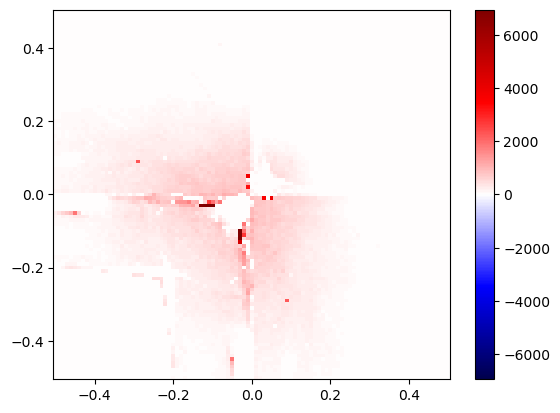

PyObject <matplotlib.colorbar.Colorbar object at 0x00000000497D32B0>

In [30]:
lyapmin,lyapmax =  -maximum( broadcast(abs, EV_map) ), maximum( broadcast(abs, EV_map) )

pcolormesh(k1_array, k2_array, EV_map, cmap ="seismic", vmin = lyapmin, vmax = lyapmax, shading="auto")

colorbar()

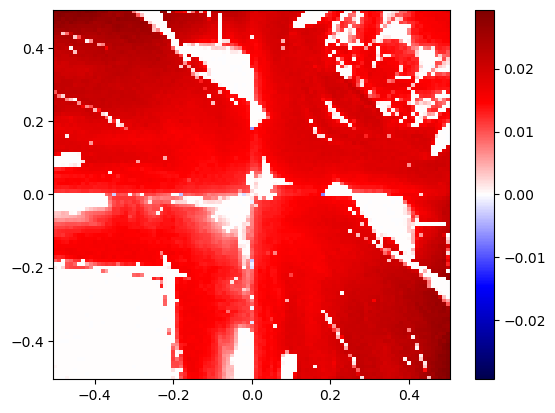

PyObject <matplotlib.colorbar.Colorbar object at 0x000000004988D190>

In [31]:
lyapmin,lyapmax = ( -maximum( broadcast(abs, lyap_matrix) ), maximum( broadcast(abs, lyap_matrix) ) )

pcolormesh(k1_array, k2_array, lyap_matrix, cmap ="seismic", vmin = lyapmin, vmax = lyapmax, shading="auto")

colorbar()

In [32]:
using NPZ
NPZ.npzwrite("Map_Lyap_HR_small_article.npy",lyap_matrix)
NPZ.npzwrite("Map_EV_HR_article.npy",EV_map)

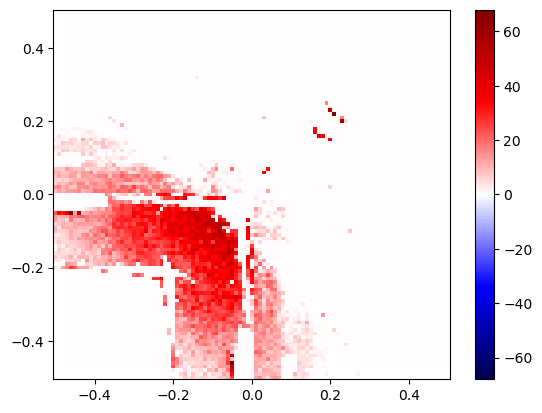

PyObject <matplotlib.colorbar.Colorbar object at 0x0000000009378790>

In [7]:
lyapmin,lyapmax = ( -maximum( broadcast(abs, EV_map) ), maximum( broadcast(abs, EV_map) ) )

pcolormesh(k1_array, k2_array, EV_map, cmap ="seismic", vmin = lyapmin, vmax = lyapmax, shading="auto")

colorbar()

In [10]:
lyap_matrix

101×101 Matrix{Float64}:
  8.19857e-6    6.47474e-5   5.14542e-5   …  0.0276682  0.0272808  0.0291445
  4.06075e-5    3.75252e-5   0.000253653     0.0272182  0.0277339  0.0292966
  3.13037e-5    0.000918656  5.90286e-5      0.0270186  0.0277955  0.029067
  0.000237857   3.48348e-5   2.37488e-5      0.027876   0.027632   0.0287336
  3.654e-5      2.7089e-5    1.00419e-5      0.028559   0.0286812  0.0300362
  9.94368e-6    2.23644e-6   8.28923e-6   …  0.0269209  0.0276201  0.0280668
  2.39406e-5    1.81937e-5   3.74486e-5      0.026856   0.0298292  0.0283967
 -1.85917e-6   -2.39113e-5   1.43275e-5      0.0272673  0.0279262  0.0277269
  1.61646e-5    3.30036e-5   1.4663e-6       0.0264745  0.0275779  0.0280929
 -1.3285e-6     2.29626e-5   6.41577e-6      0.0275636  0.0275413  0.0291799
 -9.06613e-6    9.54144e-6   2.41304e-6   …  0.0270102  0.0268263  0.0291496
  8.70916e-6    1.57952e-5   5.02821e-6      0.025589   0.0269834  0.025414
  3.66871e-5    3.24289e-5   1.65681e-5      0.025743

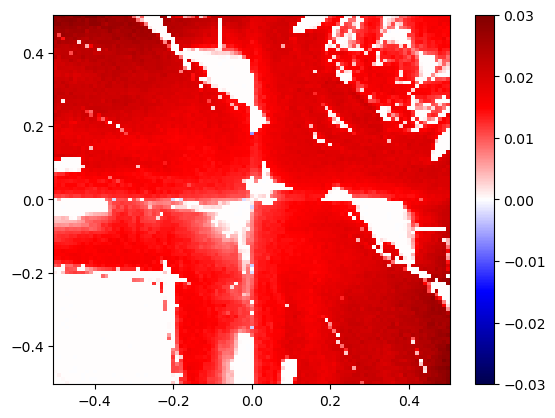

PyObject <matplotlib.colorbar.Colorbar object at 0x0000000008D51DC0>

In [11]:
lyapmin,lyapmax = ( -maximum( broadcast(abs, lyap_matrix) ), maximum( broadcast(abs, lyap_matrix) ) )

pcolormesh(k1_array, k2_array, lyap_matrix, cmap ="seismic", vmin = lyapmin, vmax = lyapmax, shading="auto")

colorbar()

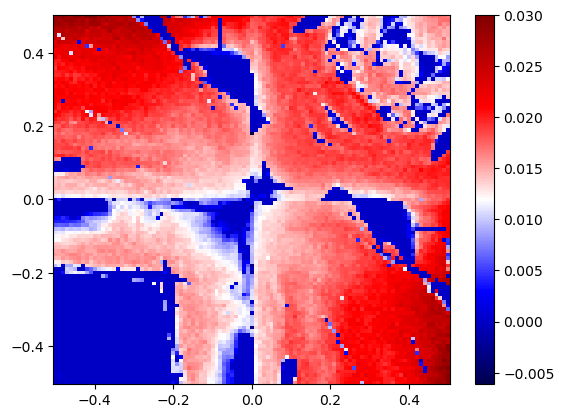

PyObject <matplotlib.colorbar.Colorbar object at 0x0000000008E93340>

In [16]:
lyapmin,lyapmax = minimum(lyap_matrix), maximum( lyap_matrix)

pcolormesh(k1_array, k2_array, lyap_matrix, cmap ="seismic", vmin = lyapmin, vmax = lyapmax, shading="auto")

colorbar()

In [12]:
using NPZ
NPZ.npzwrite("Map_Lyap_HR_small.npy",lyap_matrix)
NPZ.npzwrite("Map_EV_HR.npy",EV_map)